# TS SCI Classification Model 

## edited: 17 July 23

## author: Angus Ferrell

### 1. Initiliaze functions

In [2]:
# Load general utilities
# ----------------------
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.axes as ax
import datetime
import numpy as np
import pickle
import time
import seaborn as sns
import statistics as stat
import random
import glob
import os
import re

# Load sklearn utilities
# ----------------------
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, roc_curve, brier_score_loss, mean_squared_error, r2_score, recall_score, precision_score,f1_score
from sklearn.calibration import calibration_curve
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.metrics import classification_report

# Load classifiers
# ----------------
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import RidgeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier

# Other Packages
# --------------
from scipy.stats import kendalltau
from sklearn.cluster import KMeans
from io import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
from scipy.interpolate import BSpline
import matplotlib.pyplot as plt
%matplotlib inline

# Load debugger, if required
pd.options.mode.chained_assignment = None #'warn'

# suppress all warnings
import warnings
warnings.filterwarnings("ignore")

#set random_state
random_state=42

In [3]:
# Check Job Title
# Imported from TECH VIP file

file_name = 'TECH VIP results.csv'
column_to_filter = 'title_1'

def check_jobtitle(data):
    #data = pd.read_csv(file_name, engine = 'python', error_bad_lines = False)
    
    pos = pd.read_csv('TECH VIP/positive ts.csv').dropna(subset=['Keyword'])
    neg = pd.read_csv('TECH VIP/negative.csv').dropna(subset=['Keyword'])

    pos_keys = pos.get('Keyword').tolist()
    pos_keys = [item.lower().strip() for item in pos_keys]


    neg_keys = neg.get('Keyword').tolist()
    neg_keys = [item.lower().strip() for item in neg_keys]


    it_keys = ['izzt ', ' izzt', ' izzt '] #Get IT titles
    
    pos_keys.append('izzt ')
    pos_keys.append(' izzt')
    pos_keys.append(' izzt ')

    pos_keys.append('cto ')
    pos_keys.append(' cto')
    pos_keys.append(' cto ')

    pp = "|".join(pos_keys)
    nn = "|".join(neg_keys)
    
    df = data
    specified_column_1 = column_to_filter #CHANGE SPECIFIED COLUMN HEADER FOR FILTER
    df[specified_column_1] = df[specified_column_1].fillna('')
    #df = df.dropna(subset=[specified_column_1])

    pos_index = []
    neg_index = []

    for col in df[specified_column_1].items():
        pattern = re.compile(pp)
        stri = col[1].lower()
        find_pat = pattern.findall(stri,0,len(stri))
        if len(find_pat) >= 1:
            pos_index.append(col[0])

    #df['job title_index'] = df.loc[pos_index] 
    
    data['job_index'] = 0  # Create a new column 'job_index' initialized with 0
    data.loc[pos_index, 'job_index'] = 1 
    
    for col in df[specified_column_1].items():
        pattern = re.compile(nn)
        stri = col[1].lower()
        find_pat = pattern.findall(stri,0,len(stri))
        if len(find_pat) >= 1:
            neg_index.append(col[0])
            
    data.loc[neg_index, 'job_index'] = -1 
    
    print('Job title - number of pos matches: ', len(pos_index))
    #print('Job title - number of neg matches: ', len(neg_index))
     

In [4]:
# Check company

company_list = ['General Dynamics Information Technology', 'Gridiron IT Solutions', 'SAIC', 'SPA', 
                'Institute For Defense Analyses', 'IC-CAP', 'Peraton', 'ManTech', 'Tyto Athene LLC',
                'Boeing Intelligence & Analytics', 'Arcfield', 'Leidos', 'Raytheon Technologies', 'CACI', 
                'Booz Allen Hamilton', 'Lockheed Martin', 'ALTA IT Services', 'Cyber Defense Technologies', 
                'TekMasters', 'Emerald Technical Solutions', 'Modern Technology Solutions Inc.', 'VTG', 
                'MITRE Corporation', 'SRG Government Services', 'ManTech International', 'MAXAR Technologies',
                'Leidos', 'Parsons', 'BAE Systems', 'Marathon TS Inc', 'Guidehouse', 'SilverEdge', 'MC Dean Inc', 
                'Trevity LLC', 'teKnoluxion Consulting', 'Northrop Grumman', 'Sentar Inc', 'Stellar Solutions', 
                'Criterion Systems Inc', 'IntelliGenesis LLC', 'LMI Government Consulting', 'MAG Aero', 
                'HII Mission Technologies', 'Enlighten', 'In Technology Group Limited', 'ProSync Technology Group',
                'Connsci', 'Signature Federal Systems', 'Apex Systems', 'Buchanan and Edwards',
                'Radiance Technologies', 'Noblis', 'SRG Government Services', 'Xcelerate Solutions', 
                'DCS Corporation', 'Associates Systems LLC', 'BlueHalo', 'Strategic Alliance Consulting Inc',
                'IT Concepts Inc', 'Barbaricum', 'Forcepoint', 'Federal IT Consulting', 'Canvas Inc', 
                'TEKsystems c/o Allegis Group', 'iota IT', 'Illuminate Operations Inc', 'Compass Inc', 
                'Applied Research Solutions', 'Avineon Inc', 'I3 LLC', 'Assured Information Security Inc',
                'hyrUP', 'Millennium Corporation', 'Core One', 'TekSynap', 'Base-2 Solutions LLC', 'AERMOR', 
                'Amentum', 'Cornerstone Defense', 'Base One Technologies', 'ALTA IT Services', 'Sentar Inc', 
                'Ennoble First', 'Core4ce', 'Syntelligent Analytic Solutions LLC', 'Serco Inc', 
                'Space Dynamics Laboratory', 'RDR Inc', 'MicroTech LLC', 'North Point Technology LLC', 
                'LinQuest Corporation', 'Kavaliro', 'SOSi', 'Allen Integrated Solutions LLC',
                'Columbia Technology Partners', 'Dark Wolf Solutions', 'Strategic Alliance Consulting Inc',
                'MAXAR Technologies', 'AT&T Government Solutions', 'Invictus International Consulting', 
                'Secure Halo', 'Octo', 'Lumen', 'Applied Insight', 'PeopleTec', 'NASK', 'Highlight Technologies',
                'JCTM Joint Computer Technologies & Training Management', 'ClearEdge IT Solutions LLC',
                'Echelon Services LLC', 'Clear Resolution Consulting LLC', 'American Systems Corporation', 
                'Abile Group', 'KBR', 'Abbtech Professional Resources Inc', 'Stanley Reid & Company', 
                'Stillwater Human Capital', 'Fluor Corporation', 'Chenega Corporation', 'RMGS Inc', 
                'Moseley Technical Services Inc', 'Personnel Impact Inc', 'Rividium Inc', 'Edgesource',
                'Sunayu LLC', 'SSATI', 'Distributed Solutions Inc', 'Information Gateways Inc', 'ENSCO Inc',
                'Independent Software', 'Avantus Federal', 'Strategic ASI', 'IOMAXIS LLC', 
                'StraCon Services Group LLC', 'Railhead Inc', 'CONNEXIONS FEDERAL SERVICES', 
                'Valiant Integrated Services', 'Intelligent Waves', 'Maximus Inc', 'Thresher Corporation',
                'Market Street Talent', 'Odyssey Systems Consulting Group', 'Quantum Research International Inc',
                'Dezign-Concepts', 'The DarkStar Group', 'Red River Technology LLC', 'Mission Box Solutions',
                'Executive Management Services LLC', 'The Global Edge Consultants', 'TRIAEM LLC',
                'Delta Solutions and Strategies LLC', 'Intrepid Solutions and Services LLC', 'FiveTwelve LLC',
                'CACI International Inc', 'Raytheon', 'Deloitte','Oshkosh', 'Boeing','Accenture Federal Services',
                'Palantir Technologies','US Army','US Navy','United States Air Force','Department of Defense','USAF']


#'Microsoft','Amazon', 'Google','Amazon Web Services (AWS)']

military_pattern = r'US Army|US Navy|air force|usaf|marines|special operations|special forces| socom |Department of Defense| DoD '

#gov_pattern = r'Central Intelligence Agency|CIA|National Security Agency|NSA|Federal Bureau of Investigation|FBI|Department of State|Department of Homeland Security|DHS|Defense Intelligence Agency|DIA|National Reconnaissance Office|NRO|National Geospatial-Intelligence Agency|NGA|United States Secret Service|Drug Enforcement Administration|DEA|National Counterterrorism Center|NCTC|Bureau of Alcohol, Tobacco, Firearms, and Explosives|ATF|Department of Energy|DOE|Department of Justice|DOJ'
                    # FBI | NSA | DOJ | CIA | DHS | DIA 


def check_company(df):

    # Fill missing values with an empty string
    df['company_1'] = df['company_1'].fillna('NaN')
    df['company_2'] = df['company_2'].fillna('NaN')
    df['company_1'] = df['company_1'].replace('U.S. Navy', 'US Navy')
    df['company_2'] = df['company_2'].replace('U.S. Navy', 'US Navy')
    df['company_1'] = df['company_1'].replace('U.S. Army', 'US Army')
    df['company_2'] = df['company_2'].replace('U.S. Army', 'US Army')
    df['company_1'] = df['company_1'].replace('CACI', 'CACI International Inc')
    df['company_2'] = df['company_2'].replace('CACI', 'CACI International Inc')
    df['company_1'] = df['company_1'].replace('Raytheon', 'Raytheon Technologies')
    df['company_2'] = df['company_2'].replace('Raytheon', 'Raytheon Technologies')
    df['company_1'] = df['company_1'].replace('Northrop Grumman Corporation', 'Northrop Grumman')
    df['company_2'] = df['company_2'].replace('Northrop Grumman Corporation', 'Northrop Grumman')
    df['company_1'] = df['company_1'].replace('Palantir', 'Palantir Technologies')
    df['company_2'] = df['company_2'].replace('Palantir', 'Palantir Technologies')
    df['company_1'] = df['company_1'].replace('BAE Systems, Inc.', 'BAE Systems')
    
    
    #Apply regex pattern to filter DataFrame
    df['company_index'] = df.apply(lambda row: int(1) if row['company_1'] in company_list or 
                                   re.search(military_pattern, row['company_1'], re.IGNORECASE) 
                                   else int(0), axis=1)
    
    #df['company_index'] = df.apply(calculate_company_index, axis=1)
    print('Company - Number of matches: ', np.sum(df.company_index==1))

In [5]:
# Check skills

# Regex pattern
skills_pattern = r'TS CLEARANCE|TS/SCI|TOP SECRET CLEARANCE|ACTIVE TS CLEARANCE| TS SCI |TS SCI CLEARANCE|POLYGRAPGH| CI POLY|FULL SCOPE POLY'

def check_skills(df):

    # Fill missing values with an empty string
    df['Skills'] = df['Skills'].fillna('')
    
     # Apply regex pattern to filter DataFrame
    df['skills_index'] = df.apply(lambda row: 1 if re.search(skills_pattern, row['Skills'], 
                                                             re.IGNORECASE) else 0, axis=1)

    print('Skills - Number of matches: ', np.sum(df.skills_index==1))

In [6]:
# Check summary

def check_summary(df):
    
    # Fill missing values with an empty string
    df['Summary'] = df['Summary'].fillna('')

    # Apply regex pattern to filter DataFrame
    df['summary_index'] = df.apply(lambda row: 1 if re.search(skills_pattern, row['Summary'], 
                                                              re.IGNORECASE) else 0, axis=1)

    print('Summary - Number of matches: ', np.sum(df.summary_index==1))
    
    

In [7]:
# Check job description


def check_desc(df):
    
    # Fill missing values with an empty string
    df['Job_Description_1'] = df['Job_Description_1'].fillna('')
    #df['Job_Description_2'] = df['Job_Description_2'].fillna('')

    # Apply regex pattern to filter DataFrame
    df['desc_index'] = df.apply(lambda row: 1 if re.search(skills_pattern, row['Job_Description_1'], 
                                                              re.IGNORECASE) else 0, axis=1)

    print('Description - Number of matches: ', np.sum(df.desc_index==1))
    
    

In [8]:
# Check location based on states with highest liklihood of TS 

popular_states = ['Virginia','Maryland','California','District of Columbia','Florida','Colorado','Utah','Texas',
                 'Alabama','New Mexico','Ohio','Georgia','Hawaii', 'North Carolina','South Carolina', 'Arizona',
                  'Washington']


def check_location(df):
    
     # Fill missing values with an empty string
    df['State'] = df['State'].fillna('')

    # Apply regex pattern to filter DataFrame
    df['location_index'] = df.apply(lambda row: 1 if row['State'] in popular_states else 0, axis=1)
    
   
    print('Location - Number of matches: ', np.sum(df.location_index==1))

    

In [9]:
# Check names
# using 2000 most common US census data names

common_names = pd.read_csv('common_names.csv').dropna(subset=['Keyword'])

name_list = []

for name in common_names.Keyword:
    name_list.append(name)


def check_name(df):
    
     # Fill missing values with an empty string
    df['First Name'] = df['First Name'].fillna('')

    # Apply regex pattern to filter DataFrame
    df['name_index'] = df.apply(lambda row: 1 if row['First Name'].upper() in name_list else 0, axis=1)
    
   
    print('Names - Number of matches: ', np.sum(df.name_index==1))

In [10]:
#this code creates an equal number of positive and random cases from the imported dataset
#then creates the respective class labels
#returns a training data dataframe and labels array

def create_trainingdata(data,random_state = random_state):
    
    #check_skills(data)
    #check_summary(data)
    #check_desc(data)

    #summary_df = data[data.summary_index == 1]
    #skills_df = data[data.skills_index == 1]
    #desc_df = data[data.desc_index == 1]

    #training_data = pd.concat([summary_df, skills_df, desc_df])
    #training_data = training_data[columns]
    
    columns = ['Linkedin_url','Summary', 'Skills', 'title_1',
       'company_1', 'time_duration_1', 'Job_Description_1', 'title_2',
       'company_2', 'time_duration_2', 'Job_Description_2', 
       'First Name','Middle Name', 'Surname', 'City', 'State', 'Country']
    
    training_data = check_for_keywords(data)
    training_data = training_data[columns]
    
    val_labels = np.ones(len(training_data))

    num_numbers = len(training_data)
    min_num = 1
    max_num = len(data)

    training_data_indices = training_data.index
    
    random_generator = random.Random(random_state)

    '''
    random_numbers = []
    while len(random_numbers) < num_numbers:
        random_num = random_generator.randint(min_num, max_num)
        if random_num not in training_data_indices:
            random_numbers.append(random_num)
            
    # while len(random_numbers) < num_numbers:
    #    random_numbers.append(random_generator.randint(min_num, max_num))

    '''       
    '''
    # Generate random numbers until reaching the target length or exhausting the index range
    
    target_length = 9 * num_numbers
    
    while len(random_numbers) < target_length and len(random_numbers) < len(data):
        random_num = random_generator.randint(min_num, max_num)
        if random_num not in training_data_indices and random_num in data.index:
            random_numbers.append(random_num)    
    '''   
    
    
    ### create training data at 9:1 ratio
    ### sample from full dataset

    random_numbers = []
    target_length = 9 * num_numbers
        
    while len(random_numbers) < target_length and len(random_numbers) < len(data):
        random_num = random_generator.randint(min_num, max_num)
        if random_num in data.index:
            random_numbers.append(random_num)      
        

    random_data_df = data.loc[random_numbers, columns]
    random_data_indices = random_data_df.index

    random_labels = np.zeros(len(random_numbers))

    training_data_df = pd.concat([training_data, random_data_df])
    training_data_labels = np.append(val_labels, random_labels)

    x_unlabeled_indices = data.index.difference(training_data_indices.union(random_data_indices))
    x_unlabeled_df = data.loc[x_unlabeled_indices, columns]

    return training_data_df, training_data_labels, x_unlabeled_df


In [11]:

def check_for_keywords(df):
    
    keywords = ['TS CLEARANCE','TS/SCI','TOP SECRET CLEARANCE','ACTIVE TS CLEARANCE', 'TS SCI','TS SCI CLEARANCE','POLYGRAPH','CI POLY','FULL SCOPE POLY']
    keyword_rows = []

    for index, row in df.iterrows():
        for column in df.columns:
            cell_value = str(row[column]).upper()
            if any(keyword in cell_value for keyword in keywords):
                keyword_rows.append(index)
                break  # Move to the next row if keyword found in any column

    print('# matches: ',len(keyword_rows))   
    
    output = df.iloc[keyword_rows]
    
    return output



In [12]:
# Define a function that, given a CVGridSearch object, finds the
# percentage difference between the best and worst scores
def find_score_variation(cv_model):
    all_scores = cv_model.cv_results_['mean_test_score']
    return( np.abs((max(all_scores) - min(all_scores))) * 100 / max(all_scores) )


# Define a function that checks, given a CVGridSearch object,
# whether the optimal parameters lie on the edge of the search
# grid
def find_opt_params_on_edge(cv_model):
    out = False
    
    for i in cv_model.param_grid:
        if cv_model.best_params_[i] in [ cv_model.param_grid[i][0], cv_model.param_grid[i][-1] ]:
            out = True
            break
            
    return out


default_seed = 0
output_file = "output_sample"

# Create a function to print a line to our output file

def dump_to_output(key, value):
    with open(output_file, "a") as f:
        f.write(",".join([str(default_seed), key, str(value)]) + "\n")

In [13]:
def fit_classification(model, X_train,y_train, X_test, y_test,
                          cv_parameters = {},
                          model_name = None,
                          random_state = random_state,
                          output_to_file = True,
                          print_to_screen = True):
    
    np.random.seed(random_state)

    # --------------------------
    #   Step 2 - Fit the model
    # --------------------------

    cv_model = GridSearchCV(model, cv_parameters)
    
    start_time = time.time()
    cv_model.fit(X_train, y_train,cat_features=categorical_features_indices)
    end_time = time.time()
    
    best_model = cv_model.best_estimator_
    
    if print_to_screen:

        if model_name != None:
            print("=========================================================")
            print("  Model: " + model_name)
            print("=========================================================")

        print("Fit time: " + str(round(end_time - start_time, 2)) + " seconds")
        print("Optimal parameters:")
        print(cv_model.best_params_)
        print("")
    
    # -------------------------------
    #   Step 3 - Evaluate the model
    # -------------------------------
    
    # If possible, make probability predictions
    try:
        y_pred_probs = best_model.predict_proba(X_test)[:,1]
        fpr, tpr, thresholds = roc_curve(y_test, y_pred_probs)
        
        probs_predicted = True
    except:
        probs_predicted = False
    
    # Make predictions; if we were able to find probabilities, use
    # the threshold that maximizes the accuracy in the training set.
    # If not, just use the learner's predict function
    if probs_predicted:
        y_train_pred_probs = best_model.predict_proba(X_train)[:,1]
        fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_train_pred_probs)
        
        true_pos_train = tpr_train*(y_train.sum())
        true_neg_train = (1 - fpr_train) *(1-y_train).sum()
        
        best_threshold_index = np.argmax(true_pos_train + true_neg_train)
        best_threshold = 1 if best_threshold_index == 0 else thresholds_train[ best_threshold_index ]
        
        if print_to_screen:
            print("Accuracy-maximizing threshold was: " + str(best_threshold))
        
        y_pred = (y_pred_probs > best_threshold)
    else:
        y_pred = best_model.predict(X_test)
    
    if print_to_screen:
        print("Accuracy: ", accuracy_score(y_test, y_pred))
        print(classification_report(y_test, y_pred, target_names =['No TS', 'TS'], digits = 4))

    if print_to_screen:
        if probs_predicted:        
            plt.figure(figsize = (13, 4.5))
            plt.subplot(2, 2, 1)

            plt.title("ROC Curve (AUC = %0.2f)"% roc_auc_score(y_test, y_pred_probs))
            plt.plot(fpr, tpr, 'b')
            plt.plot([0,1],[0,1],'r--')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')

            plt.subplot(2, 2, 3)

            plt.plot(thresholds, tpr, 'b', label = 'Sensitivity')
            plt.plot(thresholds, 1 -fpr, 'r', label = 'Specificity')
            plt.legend(loc = 'lower right')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.xlabel('Threshold')

            plt.subplot(2, 2, 2)

            fp_0, mpv_0 = calibration_curve(y_test, y_pred_probs, n_bins = 10)
            plt.plot([0,1], [0,1], 'k:', label='Perfectly calibrated')
            plt.plot(mpv_0, fp_0, 's-')
            plt.ylabel('Fraction of Positives')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.legend(loc ='upper left')
            
            plt.subplot(2, 2, 4)
            plt.hist(y_pred_probs, range=(0, 1), bins=10, histtype="step", lw=2)
            plt.xlim([0,1]); plt.ylim([0,20000])
            plt.xlabel('Mean Predicted Probability')
            plt.ylabel('Count')
            
            #plt.tight_layout()
            plt.show()
        
    # Additional Score Check
    if probs_predicted:
        y_train_score = y_train_pred_probs
    else:
        y_train_score = best_model.decision_function(X_train)
        
    #tau, p_value = kendalltau(y_train_score, data.grade[filter_train])
    #if print_to_screen:
        #print("")
        #print("Similarity to LC grade ranking: ", tau)
    
    if probs_predicted:
        brier_score = brier_score_loss(y_test, y_pred_probs)
        if print_to_screen:
            print("Brier score:", brier_score)
    
    # Return the model predictions, and the
    # test set
    # -------------------------------------
    out = {'model':best_model, 'y_pred_labels':y_pred}
    
    if probs_predicted:
        out.update({'y_pred_probs':y_pred_probs})
    else:
        y_pred_score = best_model.decision_function(X_test)
        out.update({'y_pred_score':y_pred_score})
 
    return out


In [ ]:
def test_model(best_model, X_train,y_train, X_test, y_test, print_to_screen = True):
    try:
        y_pred_probs = best_model.predict_proba(X_test)[:,1]
        fpr, tpr, thresholds = roc_curve(y_test, y_pred_probs)
        
        probs_predicted = True
    except:
        probs_predicted = False
    
    # Make predictions; if we were able to find probabilities, use
    # the threshold that maximizes the accuracy in the training set.
    # If not, just use the learner's predict function
    if probs_predicted:
        y_train_pred_probs = best_model.predict_proba(X_train)[:,1]
        fpr_train, tpr_train, thresholds_train = roc_curve(y_train, y_train_pred_probs)
        
        true_pos_train = tpr_train*(y_train.sum())
        true_neg_train = (1 - fpr_train) *(1-y_train).sum()
        
        best_threshold_index = np.argmax(true_pos_train + true_neg_train)
        best_threshold = 1 if best_threshold_index == 0 else thresholds_train[ best_threshold_index ]
        
        if print_to_screen:
            print("Accuracy-maximizing threshold was: " + str(best_threshold))
        
        y_pred = (y_pred_probs > best_threshold)
    else:
        y_pred = best_model.predict(X_test)
    
    if print_to_screen:
        print("Accuracy: ", accuracy_score(y_test, y_pred))
        print(classification_report(y_test, y_pred, target_names =['No TS', 'TS'], digits = 4))

    if print_to_screen:
        if probs_predicted:        
            plt.figure(figsize = (13, 4.5))
            plt.subplot(2, 2, 1)

            plt.title("ROC Curve (AUC = %0.2f)"% roc_auc_score(y_test, y_pred_probs))
            plt.plot(fpr, tpr, 'b')
            plt.plot([0,1],[0,1],'r--')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.ylabel('True Positive Rate')
            plt.xlabel('False Positive Rate')

            plt.subplot(2, 2, 3)

            plt.plot(thresholds, tpr, 'b', label = 'Sensitivity')
            plt.plot(thresholds, 1 -fpr, 'r', label = 'Specificity')
            plt.legend(loc = 'lower right')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.xlabel('Threshold')

            plt.subplot(2, 2, 2)

            fp_0, mpv_0 = calibration_curve(y_test, y_pred_probs, n_bins = 10)
            plt.plot([0,1], [0,1], 'k:', label='Perfectly calibrated')
            plt.plot(mpv_0, fp_0, 's-')
            plt.ylabel('Fraction of Positives')
            plt.xlim([0,1]); plt.ylim([0,1])
            plt.legend(loc ='upper left')
            
            plt.subplot(2, 2, 4)
            plt.hist(y_pred_probs, range=(0, 1), bins=10, histtype="step", lw=2)
            plt.xlim([0,1]); plt.ylim([0,20000])
            plt.xlabel('Mean Predicted Probability')
            plt.ylabel('Count')
            
            #plt.tight_layout()
            plt.show()
        
    # Additional Score Check
    if probs_predicted:
        y_train_score = y_train_pred_probs
    else:
        y_train_score = best_model.decision_function(X_train)
    
    if probs_predicted:
        brier_score = brier_score_loss(y_test, y_pred_probs)
        if print_to_screen:
            print("Brier score:", brier_score)


### 2. Build Training Dataset

In [14]:
training_files = glob.glob('updated_datasets/*.csv')
print(training_files)

['updated_datasets/updated_lifull_12.2022.csv', 'updated_datasets/updated_lifull_419M3.csv', 'updated_datasets/updated_lifull_419_M2.csv', 'updated_datasets/updated_more_training_data.csv', 'updated_datasets/updated_lifull_419M1.csv', 'updated_datasets/updated_lifull_bing2_212.csv', 'updated_datasets/updated_lifull_322_0.csv', 'updated_datasets/updated_li_full_11_22.csv', 'updated_datasets/updated_lifull_303.csv', 'updated_datasets/updated_lifull_326-001.csv', 'updated_datasets/updated_lifull_bing1_212.csv', 'updated_datasets/updated_lifull_326-000.csv', 'updated_datasets/updated_lifull_326-002.csv', 'updated_datasets/updated_lifull_reg_212.csv', 'updated_datasets/updated_lifull_1_2023.csv', 'updated_datasets/updated_lifull_309_1.csv', 'updated_datasets/updated_lifull_309_2_3.csv']


In [ ]:
training_df = []
labels = []
unlabeled_list = []

for filename in training_files:
    # Call create_trainingdata function
    data = pd.read_csv(filename) 
    df, label, unlabeled = create_trainingdata(data,random_state)
    
    # Append dataframe and label to respective lists
    training_df.append(df)
    labels.append(label)
    unlabeled_list.append(unlabeled)
 
print('number of training sets: ',len(training_df))

In [ ]:
### Combine all training data ###

training_data_new = pd.concat(training_df)

training_data_new.fillna({'connections':0, 'company_1':'NaN', 'company_2':'NaN',
                    'company_3':'NaN', 'company_4':'NaN', 'Summary':'','Skills':'','Job_Description_1':'',
                    'First Name':'','Surname':'','State':'','title_1':'',
                    'title_2':'', 'Surname':'', 'City':'', 'Country':''}, inplace=True)

print('training data: ', training_data_new.shape)

training_labels_new = np.concatenate(labels)
print('training data labels: ', training_labels_new.shape)

X_unlabeled_raw = pd.concat(unlabeled_list)
print('unlabeled data: ', X_unlabeled_raw.shape)

In [ ]:
#Remove invalid labels 

training_labels_new[training_data_new['company_1']=='NaN'] = 0
training_labels_new[training_data_new['company_1']=='Retired'] = 0
training_labels_new[training_data_new['company_1']=='Self-employed'] = 0
training_labels_new[training_data_new['company_1']=='USAA'] = 0
training_labels_new[training_data_new['company_1']=='Wells Fargo'] = 0

countries = ['United States']
training_labels_new[~training_data_new['Country'].isin(countries)] = 0

keywords = ['fitness','gym', 'health', 'therapeutic','finance']
mask = training_data_new['company_1'].str.lower().str.contains('|'.join(keywords))
training_labels_new[mask] = 0

In [ ]:
#Write out training data
'''
check_jobtitle(training_data_new)
check_company(training_data_new)
check_location(training_data_new)
check_skills(training_data_new)
check_summary(training_data_new)
check_desc(training_data_new)

df_out = training_data_new
df_out['Label'] = training_labels_new
df_out.to_csv('training data 24 July.csv', index=False)

#write out all data
training_files = glob.glob('datasets/*.csv')

       
#filename_out = 'Combined__datasets.csv'
#combined_data = pd.concat(files, ignore_index=True)
#combined_data.to_csv(filename_out, index=False)
'''

In [16]:
### Random Sample ###

'''
training_files = glob.glob('datasets/*.csv')

files = []
for filename in training_files:
    data = pd.read_csv(filename)
    files.append(data)
    
#output = np.concatenate(files, axis=1)
output = pd.concat(files, ignore_index=True)


#sample_data = sample.sample(n=100000, random_state=42)  # Setting random_state for reproducibility

# Write the sampled data to 'data_sample.csv'
#sample_data.to_csv('data_sample.csv', index=False)

#print("Random sample of 100,000 rows has been written to 'data_sample.csv'.")
'''

### 3. Train Classifier Models

In [491]:
#create training splits for model

check_jobtitle(training_data_new)
check_company(training_data_new)
check_skills(training_data_new)
check_summary(training_data_new)
check_desc(training_data_new)
check_location(training_data_new)
check_name(training_data_new)

training_data_final = training_data_new[['job_index', 'company_index','skills_index','summary_index','location_index'
                                    ,'name_index','desc_index']]

X_train, X_test, y_train, y_test = train_test_split(training_data_final, training_labels_new, test_size=0.1, 
                                                    random_state=random_state, stratify=training_labels_new)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

Job title - number of pos matches:  864
Company - Number of matches:  2616
Skills - Number of matches:  179
Summary - Number of matches:  5927
Description - Number of matches:  359
Location - Number of matches:  13341
Names - Number of matches:  16508
(19935, 7)
(19935,)
(2215, 7)
(2215,)


In [ ]:
#check for collinearity

df = training_data_final
df['Target'] = training_labels_new

# Calculate correlation matrix
correlation_matrix = df.corr()
print("Correlation Matrix:")
print(correlation_matrix)

training_data_final = training_data_final.drop(columns=['Target'])
scaler = StandardScaler()
scaled_X = scaler.fit_transform(training_data_final)

# Calculate VIF
vif = pd.DataFrame()
vif["Variable"] = training_data_final.columns
vif["VIF"] = [variance_inflation_factor(scaled_X, i) for i in range(scaled_X.shape[1])]

print("\nVariance Inflation Factor (VIF):")
print(vif)


pca = PCA()
pca.fit(scaled_X)
explained_variance_ratio = pca.explained_variance_ratio_

print("\nExplained Variance Ratio:")
for i, ratio in enumerate(explained_variance_ratio):
    print(f"Principal Component {i+1}: {ratio:.4f}")

variable_names = training_data_final.columns

loadings = pca.components_

# Display loadings for each principal component
print("\nPrincipal Component Loadings:")
for i, loading in enumerate(loadings):
    print(f"Principal Component {i+1}:")
    for j, weight in enumerate(loading):
        print(f"{variable_names[j]}: {weight:.4f}")

In [ ]:
from sklearn.ensemble import RandomForestClassifier

rfc = RandomForestClassifier(n_estimators=100, max_depth=10, random_state=random_state, 
                              max_features='sqrt', min_samples_leaf=1, min_samples_split=2)
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)

print('rfc Accuracy: ',np.mean(y_pred == y_test))
print("Recall Score: ", recall_score(y_test, y_pred))
print("Precision: ", precision_score(y_test, y_pred))
print("F1 score:", f1_score(y_test, y_pred))

In [ ]:
# Calculate feature importances
feature_importances = rfc.feature_importances_

print("Feature Importances:")
for feature, importance in zip(X_train.columns, feature_importances):
    print(feature, ":", importance)


In [ ]:
## Train and test a random forest classifier

random_forest = RandomForestClassifier(n_estimators=100,random_state=random_state)
cv_parameters = {'max_depth': [5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 5],
    'max_features': ['sqrt', 'log2']}

random_forest = fit_classification(random_forest, X_train,y_train, X_test, y_test,
                          cv_parameters, model_name = 'Random Forest',output_to_file = False)

In [ ]:
## Train and test a multi-layer perceptron classifier

mlp = MLPClassifier(random_state=random_state)
cv_parameters = {'hidden_layer_sizes': (100,500,(500,500)),
                'activation':['identity','logistic','tanh','relu'],
                 'alpha': [0.0001, 0.001, 0.01],
                 'solver': ['lbfgs','sgd','adam']}

mlp = fit_classification(mlp, X_train,y_train, X_test, y_test, cv_parameters, 'Multi-Layer Perceptron',
                       output_to_file = False)

In [ ]:
## Train and test a Gradient Boosting Classifier

GradientBoostingClassifier = GradientBoostingClassifier(random_state=random_state)
cv_parameters = {
    'n_estimators': [100, 500],  
    'learning_rate': [0.01,0.1, 0.5, 1.0],  
    'max_depth': [3, 5, 10],
    'max_features': [1.0, 'sqrt'],
    'min_samples_split': [0.1,0.25,0.5,1.0]
}

GBC = fit_classification(GradientBoostingClassifier, X_train,y_train, X_test, y_test, cv_parameters, 
                         'GradientBoostingClassifier', output_to_file = False)

### 4. Train CatBoost Model

In [54]:
### Catboost Training Data ###

check_jobtitle(training_data_new)
check_company(training_data_new)
check_location(training_data_new)
check_skills(training_data_new)
check_summary(training_data_new)
check_desc(training_data_new)
#check_name(training_data_new)

catboost_columns = ['job_index', 'skills_index','summary_index','location_index','company_index'
                    ,'desc_index', 'title_1', 'company_1','State','Country']

training_data_final2 = training_data_new[catboost_columns]

#'First Name','City','title_2', 'company_2'

X_train, X_test, y_train, y_test = train_test_split(training_data_final2, training_labels_new, test_size=0.10, 
                                                    random_state=random_state, stratify=training_labels_new)


from imblearn.under_sampling import RandomUnderSampler

# Undersample the majority class (target 0)
rus = RandomUnderSampler(sampling_strategy=0.75, random_state=random_state)
X_train, y_train = rus.fit_resample(X_train, y_train)


print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

categorical_features_indices = np.where(X_train.dtypes != int)[0]
categorical_features_indices
y_train = pd.to_numeric(y_train).astype('int32')
y_test = pd.to_numeric(y_test).astype('int32')

Job title - number of pos matches:  2138
Company - Number of matches:  5211
Location - Number of matches:  61369
Skills - Number of matches:  181
Summary - Number of matches:  6590
Description - Number of matches:  392
(21676, 10)
(21676,)
(11075, 10)
(11075,)


In [55]:
train_pos = np.sum(y_train==1)
tot = len(y_train)
print('train set TS ratio',train_pos/tot)

test_pos = np.sum(y_test==1)
tot = len(y_test)
print('test set TS ratio',test_pos/tot)

train set TS ratio 0.4285846097065879
test set TS ratio 0.09652370203160271


In [ ]:
#clean unlabeled data

check_jobtitle(X_unlabeled_raw)
check_company(X_unlabeled_raw)
check_location(X_unlabeled_raw)
check_skills(X_unlabeled_raw)
check_summary(X_unlabeled_raw)
check_desc(X_unlabeled_raw)

X_unlabeled_raw.fillna({'connections':0, 'company_1':'NaN', 'company_2':'NaN',
                    'company_3':'NaN', 'company_4':'NaN', 'Summary':'','Skills':'','Job_Description_1':'',
                    'First Name':'','Surname':'','State':'','title_1':'',
                    'title_2':'', 'Surname':'', 'City':'', 'Country':''}, inplace=True)

X_unlabeled = X_unlabeled_raw[catboost_columns]

0:	learn: 0.6050861	total: 63.4ms	remaining: 6.28s
1:	learn: 0.6050861	total: 67ms	remaining: 3.28s
2:	learn: 0.6050861	total: 69.7ms	remaining: 2.25s
3:	learn: 0.6050861	total: 73.3ms	remaining: 1.76s
4:	learn: 0.6145048	total: 75.7ms	remaining: 1.44s
5:	learn: 0.6145048	total: 77.7ms	remaining: 1.22s
6:	learn: 0.6145048	total: 80.6ms	remaining: 1.07s
7:	learn: 0.6145048	total: 82.7ms	remaining: 951ms
8:	learn: 0.6145048	total: 84.8ms	remaining: 858ms
9:	learn: 0.6973897	total: 86.6ms	remaining: 779ms
10:	learn: 0.6973897	total: 88.9ms	remaining: 719ms
11:	learn: 0.6973897	total: 90.7ms	remaining: 665ms
12:	learn: 0.6973897	total: 92.8ms	remaining: 621ms
13:	learn: 0.6973897	total: 95ms	remaining: 583ms
14:	learn: 0.6973897	total: 97.2ms	remaining: 551ms
15:	learn: 0.6973897	total: 99.5ms	remaining: 522ms
16:	learn: 0.6816469	total: 102ms	remaining: 498ms
17:	learn: 0.6816469	total: 104ms	remaining: 474ms
18:	learn: 0.6816469	total: 106ms	remaining: 452ms
19:	learn: 0.6816469	total: 1

30:	learn: 0.6761302	total: 69.3ms	remaining: 154ms
31:	learn: 0.6761302	total: 71ms	remaining: 151ms
32:	learn: 0.6761302	total: 73ms	remaining: 148ms
33:	learn: 0.6761302	total: 75.4ms	remaining: 146ms
34:	learn: 0.6761302	total: 77.6ms	remaining: 144ms
35:	learn: 0.6761302	total: 79.9ms	remaining: 142ms
36:	learn: 0.6761302	total: 82.3ms	remaining: 140ms
37:	learn: 0.6770721	total: 84.6ms	remaining: 138ms
38:	learn: 0.6761302	total: 86.9ms	remaining: 136ms
39:	learn: 0.5979548	total: 89.3ms	remaining: 134ms
40:	learn: 0.5970129	total: 91.5ms	remaining: 132ms
41:	learn: 0.5979548	total: 93.7ms	remaining: 129ms
42:	learn: 0.5980893	total: 95.7ms	remaining: 127ms
43:	learn: 0.6053552	total: 98ms	remaining: 125ms
44:	learn: 0.6057589	total: 100ms	remaining: 122ms
45:	learn: 0.5980893	total: 102ms	remaining: 120ms
46:	learn: 0.5980893	total: 104ms	remaining: 117ms
47:	learn: 0.5980893	total: 106ms	remaining: 115ms
48:	learn: 0.6057589	total: 108ms	remaining: 113ms
49:	learn: 0.5991658	to

96:	learn: 0.6291712	total: 207ms	remaining: 6.41ms
97:	learn: 0.6291712	total: 209ms	remaining: 4.27ms
98:	learn: 0.6291712	total: 211ms	remaining: 2.13ms
99:	learn: 0.6291712	total: 213ms	remaining: 0us
0:	learn: 0.6987352	total: 2.53ms	remaining: 251ms
1:	learn: 0.6987352	total: 4.61ms	remaining: 226ms
2:	learn: 0.6987352	total: 6.9ms	remaining: 223ms
3:	learn: 0.6987352	total: 9.6ms	remaining: 230ms
4:	learn: 0.6987352	total: 11.4ms	remaining: 217ms
5:	learn: 0.6987352	total: 13.5ms	remaining: 211ms
6:	learn: 0.6987352	total: 15.5ms	remaining: 206ms
7:	learn: 0.7014263	total: 18.1ms	remaining: 208ms
8:	learn: 0.7014263	total: 20.3ms	remaining: 205ms
9:	learn: 0.6987352	total: 22.4ms	remaining: 201ms
10:	learn: 0.7014263	total: 24.4ms	remaining: 198ms
11:	learn: 0.7014263	total: 26.6ms	remaining: 195ms
12:	learn: 0.7014263	total: 28.6ms	remaining: 191ms
13:	learn: 0.7014263	total: 30.5ms	remaining: 188ms
14:	learn: 0.6990043	total: 32.6ms	remaining: 185ms
15:	learn: 0.6990043	total:

28:	learn: 0.5396932	total: 62.6ms	remaining: 153ms
29:	learn: 0.5392896	total: 64.4ms	remaining: 150ms
30:	learn: 0.5400969	total: 67.1ms	remaining: 149ms
31:	learn: 0.5395587	total: 69ms	remaining: 147ms
32:	learn: 0.5392896	total: 71.1ms	remaining: 144ms
33:	learn: 0.5392896	total: 73.6ms	remaining: 143ms
34:	learn: 0.5392896	total: 76ms	remaining: 141ms
35:	learn: 0.5392896	total: 78.2ms	remaining: 139ms
36:	learn: 0.5392896	total: 80.6ms	remaining: 137ms
37:	learn: 0.5391550	total: 82.8ms	remaining: 135ms
38:	learn: 0.5395587	total: 85.2ms	remaining: 133ms
39:	learn: 0.5394241	total: 87.2ms	remaining: 131ms
40:	learn: 0.5394241	total: 88.8ms	remaining: 128ms
41:	learn: 0.5394241	total: 90.9ms	remaining: 126ms
42:	learn: 0.5392896	total: 92.6ms	remaining: 123ms
43:	learn: 0.5395587	total: 95.2ms	remaining: 121ms
44:	learn: 0.5398278	total: 97.5ms	remaining: 119ms
45:	learn: 0.5396932	total: 99.1ms	remaining: 116ms
46:	learn: 0.5400969	total: 101ms	remaining: 114ms
47:	learn: 0.5402

95:	learn: 0.5737352	total: 200ms	remaining: 8.32ms
96:	learn: 0.5730624	total: 202ms	remaining: 6.23ms
97:	learn: 0.5741389	total: 204ms	remaining: 4.15ms
98:	learn: 0.5742734	total: 205ms	remaining: 2.08ms
99:	learn: 0.5752153	total: 208ms	remaining: 0us
0:	learn: 0.5406351	total: 2.56ms	remaining: 254ms
1:	learn: 0.5548977	total: 4.9ms	remaining: 240ms
2:	learn: 0.5526103	total: 7.08ms	remaining: 229ms
3:	learn: 0.5479010	total: 8.74ms	remaining: 210ms
4:	learn: 0.5421152	total: 10.9ms	remaining: 207ms
5:	learn: 0.5411733	total: 12.9ms	remaining: 203ms
6:	learn: 0.5406351	total: 15ms	remaining: 199ms
7:	learn: 0.5406351	total: 16.8ms	remaining: 193ms
8:	learn: 0.5406351	total: 19.4ms	remaining: 196ms
9:	learn: 0.5406351	total: 21.2ms	remaining: 191ms
10:	learn: 0.5406351	total: 23.4ms	remaining: 189ms
11:	learn: 0.5406351	total: 25.2ms	remaining: 185ms
12:	learn: 0.5406351	total: 27ms	remaining: 181ms
13:	learn: 0.5406351	total: 29ms	remaining: 178ms
14:	learn: 0.5406351	total: 30.8

56:	learn: 0.5473628	total: 116ms	remaining: 87.4ms
57:	learn: 0.5489774	total: 118ms	remaining: 85.4ms
58:	learn: 0.5493811	total: 120ms	remaining: 83.4ms
59:	learn: 0.5500538	total: 122ms	remaining: 81.4ms
60:	learn: 0.5505920	total: 125ms	remaining: 79.9ms
61:	learn: 0.5505920	total: 127ms	remaining: 77.9ms
62:	learn: 0.5511302	total: 129ms	remaining: 76ms
63:	learn: 0.5507266	total: 132ms	remaining: 74.1ms
64:	learn: 0.5515339	total: 134ms	remaining: 72.2ms
65:	learn: 0.5516685	total: 137ms	remaining: 70.3ms
66:	learn: 0.5515339	total: 139ms	remaining: 68.3ms
67:	learn: 0.5518030	total: 141ms	remaining: 66.2ms
68:	learn: 0.5516685	total: 143ms	remaining: 64.1ms
69:	learn: 0.5518030	total: 145ms	remaining: 61.9ms
70:	learn: 0.5522067	total: 146ms	remaining: 59.8ms
71:	learn: 0.5520721	total: 149ms	remaining: 57.8ms
72:	learn: 0.5519376	total: 151ms	remaining: 55.7ms
73:	learn: 0.5518030	total: 152ms	remaining: 53.6ms
74:	learn: 0.5519376	total: 154ms	remaining: 51.4ms
75:	learn: 0.5

88:	learn: 0.7124596	total: 203ms	remaining: 25ms
89:	learn: 0.7128633	total: 205ms	remaining: 22.8ms
90:	learn: 0.7128633	total: 207ms	remaining: 20.5ms
91:	learn: 0.7128633	total: 209ms	remaining: 18.2ms
92:	learn: 0.7128633	total: 212ms	remaining: 15.9ms
93:	learn: 0.7131324	total: 214ms	remaining: 13.7ms
94:	learn: 0.7132670	total: 216ms	remaining: 11.4ms
95:	learn: 0.7136706	total: 218ms	remaining: 9.09ms
96:	learn: 0.7135361	total: 220ms	remaining: 6.81ms
97:	learn: 0.7136706	total: 223ms	remaining: 4.55ms
98:	learn: 0.7142088	total: 226ms	remaining: 2.28ms
99:	learn: 0.7146125	total: 228ms	remaining: 0us
0:	learn: 0.6773412	total: 2.27ms	remaining: 225ms
1:	learn: 0.6832616	total: 4.22ms	remaining: 207ms
2:	learn: 0.6906620	total: 5.95ms	remaining: 192ms
3:	learn: 0.6733046	total: 8.2ms	remaining: 197ms
4:	learn: 0.6069699	total: 10.1ms	remaining: 193ms
5:	learn: 0.5991658	total: 12.1ms	remaining: 189ms
6:	learn: 0.6040097	total: 13.9ms	remaining: 184ms
7:	learn: 0.6252691	total

5:	learn: 0.6266146	total: 13ms	remaining: 204ms
6:	learn: 0.6317277	total: 15.3ms	remaining: 203ms
7:	learn: 0.6294403	total: 17.4ms	remaining: 200ms
8:	learn: 0.6162540	total: 19.3ms	remaining: 196ms
9:	learn: 0.6305167	total: 21.7ms	remaining: 196ms
10:	learn: 0.6193488	total: 24ms	remaining: 194ms
11:	learn: 0.6332078	total: 26.2ms	remaining: 192ms
12:	learn: 0.6333423	total: 28.5ms	remaining: 191ms
13:	learn: 0.6340151	total: 30.7ms	remaining: 189ms
14:	learn: 0.6247309	total: 33.4ms	remaining: 189ms
15:	learn: 0.6247309	total: 35.8ms	remaining: 188ms
16:	learn: 0.6254037	total: 37.9ms	remaining: 185ms
17:	learn: 0.6410118	total: 40.3ms	remaining: 184ms
18:	learn: 0.6489505	total: 42.1ms	remaining: 180ms
19:	learn: 0.6535253	total: 44.1ms	remaining: 176ms
20:	learn: 0.6586383	total: 46ms	remaining: 173ms
21:	learn: 0.6594456	total: 48.2ms	remaining: 171ms
22:	learn: 0.6601184	total: 50.4ms	remaining: 169ms
23:	learn: 0.6595802	total: 52.5ms	remaining: 166ms
24:	learn: 0.6629440	to

75:	learn: 0.7069429	total: 158ms	remaining: 49.9ms
76:	learn: 0.7080194	total: 160ms	remaining: 47.8ms
77:	learn: 0.7090958	total: 162ms	remaining: 45.8ms
78:	learn: 0.7089612	total: 164ms	remaining: 43.7ms
79:	learn: 0.7104413	total: 167ms	remaining: 41.7ms
80:	learn: 0.7109795	total: 169ms	remaining: 39.6ms
81:	learn: 0.7117869	total: 171ms	remaining: 37.5ms
82:	learn: 0.7113832	total: 173ms	remaining: 35.5ms
83:	learn: 0.7123251	total: 176ms	remaining: 33.5ms
84:	learn: 0.7125942	total: 178ms	remaining: 31.4ms
85:	learn: 0.7124596	total: 180ms	remaining: 29.4ms
86:	learn: 0.7124596	total: 182ms	remaining: 27.3ms
87:	learn: 0.7120560	total: 185ms	remaining: 25.2ms
88:	learn: 0.7123251	total: 187ms	remaining: 23.1ms
89:	learn: 0.7123251	total: 189ms	remaining: 21ms
90:	learn: 0.7125942	total: 191ms	remaining: 18.9ms
91:	learn: 0.7128633	total: 193ms	remaining: 16.8ms
92:	learn: 0.7128633	total: 195ms	remaining: 14.7ms
93:	learn: 0.7129978	total: 197ms	remaining: 12.6ms
94:	learn: 0.7

8:	learn: 0.5734661	total: 20ms	remaining: 203ms
9:	learn: 0.5902853	total: 22.1ms	remaining: 199ms
10:	learn: 0.6145048	total: 24.5ms	remaining: 198ms
11:	learn: 0.6248654	total: 26.6ms	remaining: 195ms
12:	learn: 0.6400700	total: 28.8ms	remaining: 193ms
13:	learn: 0.6437029	total: 30.9ms	remaining: 190ms
14:	learn: 0.6540635	total: 33.4ms	remaining: 189ms
15:	learn: 0.6621367	total: 35.7ms	remaining: 187ms
16:	learn: 0.6634822	total: 38.1ms	remaining: 186ms
17:	learn: 0.6656351	total: 40.2ms	remaining: 183ms
18:	learn: 0.6630786	total: 42.8ms	remaining: 182ms
19:	learn: 0.6676534	total: 44.8ms	remaining: 179ms
20:	learn: 0.6694026	total: 46.9ms	remaining: 177ms
21:	learn: 0.6729010	total: 49.8ms	remaining: 177ms
22:	learn: 0.6737083	total: 52.1ms	remaining: 174ms
23:	learn: 0.6750538	total: 54.2ms	remaining: 172ms
24:	learn: 0.6757266	total: 56.4ms	remaining: 169ms
25:	learn: 0.6773412	total: 58.5ms	remaining: 167ms
26:	learn: 0.6789559	total: 60.7ms	remaining: 164ms
27:	learn: 0.682

90:	learn: 0.7190527	total: 198ms	remaining: 19.6ms
91:	learn: 0.7189182	total: 201ms	remaining: 17.5ms
92:	learn: 0.7199946	total: 203ms	remaining: 15.3ms
93:	learn: 0.7195910	total: 205ms	remaining: 13.1ms
94:	learn: 0.7189182	total: 207ms	remaining: 10.9ms
95:	learn: 0.7187836	total: 209ms	remaining: 8.71ms
96:	learn: 0.7190527	total: 211ms	remaining: 6.54ms
97:	learn: 0.7190527	total: 213ms	remaining: 4.35ms
98:	learn: 0.7191873	total: 215ms	remaining: 2.17ms
99:	learn: 0.7201292	total: 217ms	remaining: 0us
0:	learn: 0.6050861	total: 2.28ms	remaining: 226ms
1:	learn: 0.6805705	total: 4.41ms	remaining: 216ms
2:	learn: 0.6341496	total: 6.66ms	remaining: 215ms
3:	learn: 0.6221744	total: 9.58ms	remaining: 230ms
4:	learn: 0.6107374	total: 11.8ms	remaining: 224ms
5:	learn: 0.6298439	total: 14.2ms	remaining: 222ms
6:	learn: 0.6515070	total: 16.7ms	remaining: 222ms
7:	learn: 0.6572928	total: 18.8ms	remaining: 216ms
8:	learn: 0.6734392	total: 20.7ms	remaining: 210ms
9:	learn: 0.6835307	tota

23:	learn: 0.7111141	total: 53.6ms	remaining: 170ms
24:	learn: 0.7128633	total: 55.8ms	remaining: 167ms
25:	learn: 0.7146125	total: 58ms	remaining: 165ms
26:	learn: 0.7152853	total: 60.4ms	remaining: 163ms
27:	learn: 0.7175727	total: 62.6ms	remaining: 161ms
28:	learn: 0.7185145	total: 65.1ms	remaining: 159ms
29:	learn: 0.7185145	total: 67.5ms	remaining: 157ms
30:	learn: 0.7195910	total: 69.9ms	remaining: 156ms
31:	learn: 0.7206674	total: 72.2ms	remaining: 153ms
32:	learn: 0.7195910	total: 74.9ms	remaining: 152ms
33:	learn: 0.7202637	total: 77.2ms	remaining: 150ms
34:	learn: 0.7202637	total: 79.5ms	remaining: 148ms
35:	learn: 0.7203983	total: 81.5ms	remaining: 145ms
36:	learn: 0.7205328	total: 83.6ms	remaining: 142ms
37:	learn: 0.7205328	total: 86.5ms	remaining: 141ms
38:	learn: 0.7205328	total: 88.9ms	remaining: 139ms
39:	learn: 0.7209365	total: 91.1ms	remaining: 137ms
40:	learn: 0.7212056	total: 93.5ms	remaining: 134ms
41:	learn: 0.7212056	total: 95.6ms	remaining: 132ms
42:	learn: 0.7

84:	learn: 0.7265877	total: 200ms	remaining: 35.3ms
85:	learn: 0.7261841	total: 202ms	remaining: 32.9ms
86:	learn: 0.7283369	total: 204ms	remaining: 30.5ms
87:	learn: 0.7283369	total: 207ms	remaining: 28.2ms
88:	learn: 0.7280678	total: 209ms	remaining: 25.9ms
89:	learn: 0.7280678	total: 212ms	remaining: 23.6ms
90:	learn: 0.7280678	total: 215ms	remaining: 21.3ms
91:	learn: 0.7280678	total: 217ms	remaining: 18.9ms
92:	learn: 0.7282024	total: 220ms	remaining: 16.6ms
93:	learn: 0.7282024	total: 222ms	remaining: 14.2ms
94:	learn: 0.7284715	total: 225ms	remaining: 11.8ms
95:	learn: 0.7279333	total: 227ms	remaining: 9.45ms
96:	learn: 0.7280678	total: 229ms	remaining: 7.08ms
97:	learn: 0.7280678	total: 231ms	remaining: 4.71ms
98:	learn: 0.7282024	total: 233ms	remaining: 2.35ms
99:	learn: 0.7279333	total: 235ms	remaining: 0us
0:	learn: 0.6987352	total: 2.88ms	remaining: 285ms
1:	learn: 0.6188105	total: 5.09ms	remaining: 250ms
2:	learn: 0.6256728	total: 6.9ms	remaining: 223ms
3:	learn: 0.6289020

0:	learn: 0.5383477	total: 2.95ms	remaining: 292ms
1:	learn: 0.5520721	total: 11.7ms	remaining: 574ms
2:	learn: 0.5507266	total: 15.7ms	remaining: 507ms
3:	learn: 0.6065662	total: 17.9ms	remaining: 430ms
4:	learn: 0.5888052	total: 20.8ms	remaining: 395ms
5:	learn: 0.6297094	total: 23.4ms	remaining: 367ms
6:	learn: 0.6418192	total: 26ms	remaining: 346ms
7:	learn: 0.6412809	total: 27.9ms	remaining: 321ms
8:	learn: 0.6380517	total: 29.5ms	remaining: 298ms
9:	learn: 0.6586383	total: 31.8ms	remaining: 286ms
10:	learn: 0.6609257	total: 35ms	remaining: 283ms
11:	learn: 0.6812433	total: 37.3ms	remaining: 273ms
12:	learn: 0.6816469	total: 39.5ms	remaining: 264ms
13:	learn: 0.6858181	total: 41.5ms	remaining: 255ms
14:	learn: 0.6924112	total: 43.6ms	remaining: 247ms
15:	learn: 0.6933531	total: 46.4ms	remaining: 244ms
16:	learn: 0.6917384	total: 48.4ms	remaining: 236ms
17:	learn: 0.6965823	total: 50.3ms	remaining: 229ms
18:	learn: 0.6971206	total: 53.2ms	remaining: 227ms
19:	learn: 0.6973897	total

34:	learn: 0.7201292	total: 76.1ms	remaining: 141ms
35:	learn: 0.7210710	total: 78.3ms	remaining: 139ms
36:	learn: 0.7210710	total: 79.7ms	remaining: 136ms
37:	learn: 0.7203983	total: 82.1ms	remaining: 134ms
38:	learn: 0.7206674	total: 84.8ms	remaining: 133ms
39:	learn: 0.7206674	total: 87.3ms	remaining: 131ms
40:	learn: 0.7206674	total: 89.9ms	remaining: 129ms
41:	learn: 0.7205328	total: 92.7ms	remaining: 128ms
42:	learn: 0.7213402	total: 95.5ms	remaining: 127ms
43:	learn: 0.7218784	total: 98.3ms	remaining: 125ms
44:	learn: 0.7209365	total: 100ms	remaining: 123ms
45:	learn: 0.7201292	total: 102ms	remaining: 120ms
46:	learn: 0.7205328	total: 105ms	remaining: 118ms
47:	learn: 0.7191873	total: 107ms	remaining: 116ms
48:	learn: 0.7208019	total: 109ms	remaining: 114ms
49:	learn: 0.7209365	total: 112ms	remaining: 112ms
50:	learn: 0.7230893	total: 114ms	remaining: 110ms
51:	learn: 0.7237621	total: 117ms	remaining: 108ms
52:	learn: 0.7237621	total: 119ms	remaining: 105ms
53:	learn: 0.7234930	

93:	learn: 0.7296825	total: 214ms	remaining: 13.6ms
94:	learn: 0.7292788	total: 217ms	remaining: 11.4ms
95:	learn: 0.7292788	total: 219ms	remaining: 9.12ms
96:	learn: 0.7294133	total: 222ms	remaining: 6.86ms
97:	learn: 0.7298170	total: 224ms	remaining: 4.58ms
98:	learn: 0.7298170	total: 227ms	remaining: 2.29ms
99:	learn: 0.7287406	total: 229ms	remaining: 0us
0:	learn: 0.6050861	total: 2.53ms	remaining: 250ms
1:	learn: 0.6050861	total: 4.49ms	remaining: 220ms
2:	learn: 0.6050861	total: 6.11ms	remaining: 197ms
3:	learn: 0.6050861	total: 7.88ms	remaining: 189ms
4:	learn: 0.6050861	total: 10.2ms	remaining: 194ms
5:	learn: 0.6050861	total: 12.2ms	remaining: 191ms
6:	learn: 0.6115447	total: 14.2ms	remaining: 189ms
7:	learn: 0.6115447	total: 16.1ms	remaining: 185ms
8:	learn: 0.6145048	total: 18ms	remaining: 182ms
9:	learn: 0.6973897	total: 20.2ms	remaining: 182ms
10:	learn: 0.6973897	total: 22.3ms	remaining: 180ms
11:	learn: 0.6973897	total: 24.4ms	remaining: 179ms
12:	learn: 0.6973897	total:

99:	learn: 0.6263455	total: 252ms	remaining: 0us
0:	learn: 0.6773412	total: 3.14ms	remaining: 311ms
1:	learn: 0.6754575	total: 5.92ms	remaining: 290ms
2:	learn: 0.6754575	total: 8.39ms	remaining: 271ms
3:	learn: 0.6754575	total: 10.4ms	remaining: 250ms
4:	learn: 0.6751884	total: 12.7ms	remaining: 242ms
5:	learn: 0.6832616	total: 16ms	remaining: 250ms
6:	learn: 0.6832616	total: 19.3ms	remaining: 257ms
7:	learn: 0.6761302	total: 21.6ms	remaining: 248ms
8:	learn: 0.6761302	total: 24ms	remaining: 243ms
9:	learn: 0.6684607	total: 26.3ms	remaining: 237ms
10:	learn: 0.6761302	total: 28.7ms	remaining: 232ms
11:	learn: 0.6761302	total: 30.9ms	remaining: 227ms
12:	learn: 0.6761302	total: 33.5ms	remaining: 224ms
13:	learn: 0.6776103	total: 35.9ms	remaining: 221ms
14:	learn: 0.6776103	total: 38.3ms	remaining: 217ms
15:	learn: 0.6776103	total: 40.8ms	remaining: 214ms
16:	learn: 0.6776103	total: 43ms	remaining: 210ms
17:	learn: 0.6776103	total: 45.4ms	remaining: 207ms
18:	learn: 0.6776103	total: 48.

0:	learn: 0.6987352	total: 2.71ms	remaining: 268ms
1:	learn: 0.6987352	total: 5.95ms	remaining: 291ms
2:	learn: 0.6987352	total: 8.39ms	remaining: 271ms
3:	learn: 0.6987352	total: 10.4ms	remaining: 249ms
4:	learn: 0.6987352	total: 12.3ms	remaining: 235ms
5:	learn: 0.6987352	total: 14.5ms	remaining: 227ms
6:	learn: 0.6987352	total: 16.8ms	remaining: 224ms
7:	learn: 0.7014263	total: 19.2ms	remaining: 221ms
8:	learn: 0.7014263	total: 21.9ms	remaining: 221ms
9:	learn: 0.6987352	total: 24.5ms	remaining: 220ms
10:	learn: 0.7014263	total: 26.8ms	remaining: 217ms
11:	learn: 0.7014263	total: 28.8ms	remaining: 212ms
12:	learn: 0.7014263	total: 31.3ms	remaining: 209ms
13:	learn: 0.7014263	total: 33.5ms	remaining: 206ms
14:	learn: 0.6990043	total: 36.2ms	remaining: 205ms
15:	learn: 0.6990043	total: 38.9ms	remaining: 204ms
16:	learn: 0.6990043	total: 40.9ms	remaining: 200ms
17:	learn: 0.6990043	total: 43.1ms	remaining: 196ms
18:	learn: 0.6990043	total: 45.1ms	remaining: 192ms
19:	learn: 0.6990043	t

23:	learn: 0.5388859	total: 51.5ms	remaining: 163ms
24:	learn: 0.5388859	total: 53.6ms	remaining: 161ms
25:	learn: 0.5388859	total: 56ms	remaining: 159ms
26:	learn: 0.5388859	total: 58.6ms	remaining: 158ms
27:	learn: 0.5387513	total: 60.6ms	remaining: 156ms
28:	learn: 0.5388859	total: 62.9ms	remaining: 154ms
29:	learn: 0.5387513	total: 64.9ms	remaining: 151ms
30:	learn: 0.5391550	total: 67.1ms	remaining: 149ms
31:	learn: 0.5387513	total: 69.8ms	remaining: 148ms
32:	learn: 0.5387513	total: 72ms	remaining: 146ms
33:	learn: 0.5387513	total: 74.1ms	remaining: 144ms
34:	learn: 0.5387513	total: 76.3ms	remaining: 142ms
35:	learn: 0.5387513	total: 79.1ms	remaining: 141ms
36:	learn: 0.5387513	total: 81.3ms	remaining: 138ms
37:	learn: 0.5387513	total: 83.4ms	remaining: 136ms
38:	learn: 0.5390205	total: 85.6ms	remaining: 134ms
39:	learn: 0.5390205	total: 88.1ms	remaining: 132ms
40:	learn: 0.5387513	total: 89.9ms	remaining: 129ms
41:	learn: 0.5387513	total: 92.2ms	remaining: 127ms
42:	learn: 0.538

97:	learn: 0.5722551	total: 203ms	remaining: 4.15ms
98:	learn: 0.5719860	total: 206ms	remaining: 2.08ms
99:	learn: 0.5725242	total: 208ms	remaining: 0us
0:	learn: 0.5406351	total: 2.33ms	remaining: 231ms
1:	learn: 0.5539559	total: 8.95ms	remaining: 439ms
2:	learn: 0.5439989	total: 11.3ms	remaining: 365ms
3:	learn: 0.5430571	total: 14.1ms	remaining: 337ms
4:	learn: 0.5421152	total: 15.5ms	remaining: 295ms
5:	learn: 0.5411733	total: 17.5ms	remaining: 274ms
6:	learn: 0.5406351	total: 19.9ms	remaining: 264ms
7:	learn: 0.5406351	total: 21.5ms	remaining: 247ms
8:	learn: 0.5406351	total: 23.3ms	remaining: 236ms
9:	learn: 0.5406351	total: 24.9ms	remaining: 224ms
10:	learn: 0.5406351	total: 26.9ms	remaining: 218ms
11:	learn: 0.5406351	total: 28.6ms	remaining: 210ms
12:	learn: 0.5406351	total: 30.6ms	remaining: 205ms
13:	learn: 0.5406351	total: 32.5ms	remaining: 200ms
14:	learn: 0.5406351	total: 34.4ms	remaining: 195ms
15:	learn: 0.5406351	total: 36.5ms	remaining: 192ms
16:	learn: 0.5406351	tota

28:	learn: 0.6673843	total: 65.1ms	remaining: 159ms
29:	learn: 0.6681916	total: 67ms	remaining: 156ms
30:	learn: 0.6691335	total: 69.2ms	remaining: 154ms
31:	learn: 0.6699408	total: 71.2ms	remaining: 151ms
32:	learn: 0.6696717	total: 73.3ms	remaining: 149ms
33:	learn: 0.6737083	total: 75.5ms	remaining: 147ms
34:	learn: 0.6733046	total: 77.5ms	remaining: 144ms
35:	learn: 0.6735737	total: 79.5ms	remaining: 141ms
36:	learn: 0.6741119	total: 81.8ms	remaining: 139ms
37:	learn: 0.6758611	total: 84ms	remaining: 137ms
38:	learn: 0.6757266	total: 87.1ms	remaining: 136ms
39:	learn: 0.6833961	total: 89.4ms	remaining: 134ms
40:	learn: 0.6833961	total: 91.4ms	remaining: 131ms
41:	learn: 0.6859526	total: 93.5ms	remaining: 129ms
42:	learn: 0.6859526	total: 95.5ms	remaining: 127ms
43:	learn: 0.6858181	total: 97.4ms	remaining: 124ms
44:	learn: 0.6870291	total: 101ms	remaining: 123ms
45:	learn: 0.6859526	total: 103ms	remaining: 121ms
46:	learn: 0.6875673	total: 106ms	remaining: 119ms
47:	learn: 0.688105

92:	learn: 0.7074812	total: 205ms	remaining: 15.5ms
93:	learn: 0.7082885	total: 208ms	remaining: 13.2ms
94:	learn: 0.7089612	total: 210ms	remaining: 11ms
95:	learn: 0.7092304	total: 212ms	remaining: 8.84ms
96:	learn: 0.7092304	total: 215ms	remaining: 6.64ms
97:	learn: 0.7084230	total: 217ms	remaining: 4.43ms
98:	learn: 0.7092304	total: 219ms	remaining: 2.21ms
99:	learn: 0.7093649	total: 221ms	remaining: 0us
0:	learn: 0.6773412	total: 2.17ms	remaining: 214ms
1:	learn: 0.6754575	total: 4.2ms	remaining: 206ms
2:	learn: 0.6901238	total: 6.15ms	remaining: 199ms
3:	learn: 0.6733046	total: 8.28ms	remaining: 199ms
4:	learn: 0.5979548	total: 10.4ms	remaining: 198ms
5:	learn: 0.5979548	total: 12.6ms	remaining: 198ms
6:	learn: 0.6033369	total: 14.8ms	remaining: 196ms
7:	learn: 0.6032024	total: 17.1ms	remaining: 197ms
8:	learn: 0.6033369	total: 19.5ms	remaining: 198ms
9:	learn: 0.6126211	total: 21.9ms	remaining: 197ms
10:	learn: 0.6053552	total: 24ms	remaining: 194ms
11:	learn: 0.6171959	total: 25

19:	learn: 0.6529871	total: 43.7ms	remaining: 175ms
20:	learn: 0.6582347	total: 45.8ms	remaining: 172ms
21:	learn: 0.6587729	total: 47.8ms	remaining: 169ms
22:	learn: 0.6585038	total: 49.7ms	remaining: 167ms
23:	learn: 0.6586383	total: 51.9ms	remaining: 164ms
24:	learn: 0.6614639	total: 54ms	remaining: 162ms
25:	learn: 0.6648278	total: 56.2ms	remaining: 160ms
26:	learn: 0.6667115	total: 58.4ms	remaining: 158ms
27:	learn: 0.6695371	total: 60.6ms	remaining: 156ms
28:	learn: 0.6739774	total: 62.7ms	remaining: 154ms
29:	learn: 0.6734392	total: 65.1ms	remaining: 152ms
30:	learn: 0.6765339	total: 67.2ms	remaining: 150ms
31:	learn: 0.6770721	total: 69.5ms	remaining: 148ms
32:	learn: 0.6773412	total: 71.6ms	remaining: 145ms
33:	learn: 0.6763994	total: 73.7ms	remaining: 143ms
34:	learn: 0.6804360	total: 75.9ms	remaining: 141ms
35:	learn: 0.6866254	total: 78ms	remaining: 139ms
36:	learn: 0.6866254	total: 80ms	remaining: 136ms
37:	learn: 0.6866254	total: 82.2ms	remaining: 134ms
38:	learn: 0.68824

89:	learn: 0.7138052	total: 198ms	remaining: 22ms
90:	learn: 0.7140743	total: 200ms	remaining: 19.8ms
91:	learn: 0.7156889	total: 202ms	remaining: 17.6ms
92:	learn: 0.7156889	total: 205ms	remaining: 15.4ms
93:	learn: 0.7156889	total: 207ms	remaining: 13.2ms
94:	learn: 0.7159580	total: 209ms	remaining: 11ms
95:	learn: 0.7159580	total: 211ms	remaining: 8.81ms
96:	learn: 0.7154198	total: 214ms	remaining: 6.61ms
97:	learn: 0.7167653	total: 216ms	remaining: 4.41ms
98:	learn: 0.7168999	total: 218ms	remaining: 2.21ms
99:	learn: 0.7160926	total: 220ms	remaining: 0us
0:	learn: 0.5383477	total: 2.51ms	remaining: 248ms
1:	learn: 0.5507266	total: 5.38ms	remaining: 264ms
2:	learn: 0.5734661	total: 7.64ms	remaining: 247ms
3:	learn: 0.5710441	total: 10.6ms	remaining: 253ms
4:	learn: 0.5398278	total: 12.1ms	remaining: 231ms
5:	learn: 0.5396932	total: 14.2ms	remaining: 222ms
6:	learn: 0.5616254	total: 17.2ms	remaining: 228ms
7:	learn: 0.5449408	total: 19.1ms	remaining: 220ms
8:	learn: 0.5676803	total: 

7:	learn: 0.5483046	total: 20.2ms	remaining: 233ms
8:	learn: 0.5731970	total: 22.4ms	remaining: 227ms
9:	learn: 0.5884015	total: 24.5ms	remaining: 221ms
10:	learn: 0.6106028	total: 26.8ms	remaining: 217ms
11:	learn: 0.6217707	total: 29.6ms	remaining: 217ms
12:	learn: 0.6372443	total: 32.3ms	remaining: 216ms
13:	learn: 0.6418192	total: 34.5ms	remaining: 212ms
14:	learn: 0.6504306	total: 37.2ms	remaining: 211ms
15:	learn: 0.6606566	total: 39.5ms	remaining: 207ms
16:	learn: 0.6611948	total: 41.7ms	remaining: 204ms
17:	learn: 0.6567546	total: 43.8ms	remaining: 200ms
18:	learn: 0.6547363	total: 46.1ms	remaining: 196ms
19:	learn: 0.6620022	total: 48.6ms	remaining: 194ms
20:	learn: 0.6626749	total: 50.9ms	remaining: 192ms
21:	learn: 0.6650969	total: 53.4ms	remaining: 189ms
22:	learn: 0.6673843	total: 56.3ms	remaining: 188ms
23:	learn: 0.6730355	total: 58.5ms	remaining: 185ms
24:	learn: 0.6757266	total: 61.1ms	remaining: 183ms
25:	learn: 0.6758611	total: 63.5ms	remaining: 181ms
26:	learn: 0.67

29:	learn: 0.7072121	total: 67.1ms	remaining: 157ms
30:	learn: 0.7074812	total: 69.4ms	remaining: 155ms
31:	learn: 0.7101722	total: 71.4ms	remaining: 152ms
32:	learn: 0.7101722	total: 73.7ms	remaining: 150ms
33:	learn: 0.7097686	total: 76ms	remaining: 148ms
34:	learn: 0.7117869	total: 78.8ms	remaining: 146ms
35:	learn: 0.7109795	total: 81.7ms	remaining: 145ms
36:	learn: 0.7109795	total: 83.8ms	remaining: 143ms
37:	learn: 0.7117869	total: 86.3ms	remaining: 141ms
38:	learn: 0.7115178	total: 88.6ms	remaining: 139ms
39:	learn: 0.7117869	total: 90.9ms	remaining: 136ms
40:	learn: 0.7119214	total: 92.9ms	remaining: 134ms
41:	learn: 0.7158235	total: 95.1ms	remaining: 131ms
42:	learn: 0.7158235	total: 97.2ms	remaining: 129ms
43:	learn: 0.7136706	total: 99.3ms	remaining: 126ms
44:	learn: 0.7142088	total: 101ms	remaining: 124ms
45:	learn: 0.7140743	total: 103ms	remaining: 121ms
46:	learn: 0.7140743	total: 105ms	remaining: 118ms
47:	learn: 0.7181109	total: 107ms	remaining: 116ms
48:	learn: 0.71972

97:	learn: 0.7268568	total: 216ms	remaining: 4.41ms
98:	learn: 0.7268568	total: 218ms	remaining: 2.2ms
99:	learn: 0.7264532	total: 220ms	remaining: 0us
0:	learn: 0.6773412	total: 2.39ms	remaining: 237ms
1:	learn: 0.6754575	total: 4.87ms	remaining: 239ms
2:	learn: 0.6267492	total: 7.92ms	remaining: 256ms
3:	learn: 0.6123520	total: 10.2ms	remaining: 244ms
4:	learn: 0.6303821	total: 12.6ms	remaining: 240ms
5:	learn: 0.6225780	total: 15ms	remaining: 235ms
6:	learn: 0.6489505	total: 17.8ms	remaining: 237ms
7:	learn: 0.6636168	total: 20.1ms	remaining: 231ms
8:	learn: 0.6692680	total: 22.7ms	remaining: 230ms
9:	learn: 0.6747847	total: 24.8ms	remaining: 224ms
10:	learn: 0.6754575	total: 27.2ms	remaining: 220ms
11:	learn: 0.6844726	total: 29.6ms	remaining: 217ms
12:	learn: 0.6854144	total: 32.1ms	remaining: 215ms
13:	learn: 0.6868945	total: 34.2ms	remaining: 210ms
14:	learn: 0.6887783	total: 37.4ms	remaining: 212ms
15:	learn: 0.6862217	total: 39.8ms	remaining: 209ms
16:	learn: 0.6852799	total: 

20:	learn: 0.7027718	total: 49.6ms	remaining: 187ms
21:	learn: 0.7027718	total: 51.7ms	remaining: 183ms
22:	learn: 0.7010226	total: 54.1ms	remaining: 181ms
23:	learn: 0.7049247	total: 56.2ms	remaining: 178ms
24:	learn: 0.7078848	total: 58.5ms	remaining: 175ms
25:	learn: 0.7078848	total: 60.9ms	remaining: 173ms
26:	learn: 0.7090958	total: 63.1ms	remaining: 171ms
27:	learn: 0.7103068	total: 65.5ms	remaining: 168ms
28:	learn: 0.7103068	total: 67.8ms	remaining: 166ms
29:	learn: 0.7107104	total: 70.9ms	remaining: 165ms
30:	learn: 0.7101722	total: 73ms	remaining: 163ms
31:	learn: 0.7119214	total: 75.1ms	remaining: 160ms
32:	learn: 0.7127287	total: 77.3ms	remaining: 157ms
33:	learn: 0.7135361	total: 79.5ms	remaining: 154ms
34:	learn: 0.7167653	total: 82.1ms	remaining: 152ms
35:	learn: 0.7220129	total: 83.9ms	remaining: 149ms
36:	learn: 0.7221475	total: 86ms	remaining: 146ms
37:	learn: 0.7205328	total: 88.5ms	remaining: 144ms
38:	learn: 0.7213402	total: 90.6ms	remaining: 142ms
39:	learn: 0.722

91:	learn: 0.7226857	total: 199ms	remaining: 17.3ms
92:	learn: 0.7234930	total: 201ms	remaining: 15.2ms
93:	learn: 0.7221475	total: 203ms	remaining: 13ms
94:	learn: 0.7247040	total: 205ms	remaining: 10.8ms
95:	learn: 0.7247040	total: 207ms	remaining: 8.64ms
96:	learn: 0.7243003	total: 211ms	remaining: 6.51ms
97:	learn: 0.7252422	total: 213ms	remaining: 4.34ms
98:	learn: 0.7249731	total: 216ms	remaining: 2.18ms
99:	learn: 0.7255113	total: 218ms	remaining: 0us
0:	learn: 0.5383477	total: 3.61ms	remaining: 357ms
1:	learn: 0.5507266	total: 5.8ms	remaining: 284ms
2:	learn: 0.5456136	total: 7.89ms	remaining: 255ms
3:	learn: 0.6017223	total: 10.2ms	remaining: 245ms
4:	learn: 0.5882670	total: 13.9ms	remaining: 264ms
5:	learn: 0.6264801	total: 15.8ms	remaining: 248ms
6:	learn: 0.6539290	total: 17.7ms	remaining: 235ms
7:	learn: 0.6529871	total: 19.7ms	remaining: 226ms
8:	learn: 0.6467976	total: 21.2ms	remaining: 215ms
9:	learn: 0.6488159	total: 23.2ms	remaining: 209ms
10:	learn: 0.6664424	total: 

18:	learn: 0.7045210	total: 42.1ms	remaining: 180ms
19:	learn: 0.7055974	total: 44.4ms	remaining: 178ms
20:	learn: 0.7072121	total: 46.3ms	remaining: 174ms
21:	learn: 0.7096340	total: 49.3ms	remaining: 175ms
22:	learn: 0.7086921	total: 52.2ms	remaining: 175ms
23:	learn: 0.7076157	total: 54.4ms	remaining: 172ms
24:	learn: 0.7084230	total: 56.5ms	remaining: 169ms
25:	learn: 0.7084230	total: 57.9ms	remaining: 165ms
26:	learn: 0.7092304	total: 60.3ms	remaining: 163ms
27:	learn: 0.7104413	total: 62.5ms	remaining: 161ms
28:	learn: 0.7144779	total: 64.7ms	remaining: 158ms
29:	learn: 0.7163617	total: 66.5ms	remaining: 155ms
30:	learn: 0.7148816	total: 69.2ms	remaining: 154ms
31:	learn: 0.7154198	total: 70.9ms	remaining: 151ms
32:	learn: 0.7113832	total: 73.3ms	remaining: 149ms
33:	learn: 0.7073466	total: 75.7ms	remaining: 147ms
34:	learn: 0.7135361	total: 77.8ms	remaining: 144ms
35:	learn: 0.7152853	total: 80.1ms	remaining: 142ms
36:	learn: 0.7123251	total: 81.9ms	remaining: 140ms
37:	learn: 0

91:	learn: 0.7272605	total: 200ms	remaining: 17.4ms
92:	learn: 0.7272605	total: 202ms	remaining: 15.2ms
93:	learn: 0.7272605	total: 204ms	remaining: 13ms
94:	learn: 0.7275296	total: 206ms	remaining: 10.9ms
95:	learn: 0.7275296	total: 209ms	remaining: 8.69ms
96:	learn: 0.7275296	total: 211ms	remaining: 6.52ms
97:	learn: 0.7272605	total: 213ms	remaining: 4.35ms
98:	learn: 0.7273950	total: 215ms	remaining: 2.17ms
99:	learn: 0.7271259	total: 218ms	remaining: 0us
0:	learn: 0.6050861	total: 2.32ms	remaining: 230ms
1:	learn: 0.6050861	total: 4.29ms	remaining: 210ms
2:	learn: 0.6050861	total: 6.14ms	remaining: 198ms
3:	learn: 0.6050861	total: 7.88ms	remaining: 189ms
4:	learn: 0.6050861	total: 10.6ms	remaining: 202ms
5:	learn: 0.6050861	total: 12.6ms	remaining: 197ms
6:	learn: 0.6115447	total: 14.9ms	remaining: 198ms
7:	learn: 0.6115447	total: 16.9ms	remaining: 194ms
8:	learn: 0.6145048	total: 18.8ms	remaining: 190ms
9:	learn: 0.6973897	total: 20.8ms	remaining: 187ms
10:	learn: 0.6973897	total:

20:	learn: 0.6776103	total: 43.8ms	remaining: 165ms
21:	learn: 0.6761302	total: 46.1ms	remaining: 163ms
22:	learn: 0.6761302	total: 48.2ms	remaining: 161ms
23:	learn: 0.6761302	total: 50.3ms	remaining: 159ms
24:	learn: 0.6761302	total: 52.4ms	remaining: 157ms
25:	learn: 0.6684607	total: 54.8ms	remaining: 156ms
26:	learn: 0.6684607	total: 57ms	remaining: 154ms
27:	learn: 0.6761302	total: 58.9ms	remaining: 151ms
28:	learn: 0.6761302	total: 60.8ms	remaining: 149ms
29:	learn: 0.6761302	total: 63.2ms	remaining: 147ms
30:	learn: 0.6761302	total: 65.1ms	remaining: 145ms
31:	learn: 0.5970129	total: 67.6ms	remaining: 144ms
32:	learn: 0.6761302	total: 69.8ms	remaining: 142ms
33:	learn: 0.6761302	total: 71.9ms	remaining: 140ms
34:	learn: 0.6761302	total: 74ms	remaining: 137ms
35:	learn: 0.6761302	total: 76ms	remaining: 135ms
36:	learn: 0.5970129	total: 78ms	remaining: 133ms
37:	learn: 0.5970129	total: 79.8ms	remaining: 130ms
38:	learn: 0.5970129	total: 82.5ms	remaining: 129ms
39:	learn: 0.5970129

91:	learn: 0.6278256	total: 200ms	remaining: 17.4ms
92:	learn: 0.6278256	total: 202ms	remaining: 15.2ms
93:	learn: 0.6278256	total: 205ms	remaining: 13.1ms
94:	learn: 0.6278256	total: 207ms	remaining: 10.9ms
95:	learn: 0.6282293	total: 209ms	remaining: 8.72ms
96:	learn: 0.6286329	total: 212ms	remaining: 6.55ms
97:	learn: 0.6286329	total: 214ms	remaining: 4.37ms
98:	learn: 0.6286329	total: 216ms	remaining: 2.18ms
99:	learn: 0.6286329	total: 219ms	remaining: 0us
0:	learn: 0.6987352	total: 2.59ms	remaining: 257ms
1:	learn: 0.6987352	total: 4.6ms	remaining: 226ms
2:	learn: 0.6987352	total: 6.74ms	remaining: 218ms
3:	learn: 0.6987352	total: 8.81ms	remaining: 212ms
4:	learn: 0.6987352	total: 10.7ms	remaining: 203ms
5:	learn: 0.6987352	total: 12.6ms	remaining: 197ms
6:	learn: 0.6987352	total: 14.7ms	remaining: 195ms
7:	learn: 0.7014263	total: 16.7ms	remaining: 193ms
8:	learn: 0.7014263	total: 18.6ms	remaining: 188ms
9:	learn: 0.6987352	total: 20.2ms	remaining: 182ms
10:	learn: 0.7014263	total

50:	learn: 0.5415770	total: 104ms	remaining: 99.8ms
51:	learn: 0.5422497	total: 106ms	remaining: 97.6ms
52:	learn: 0.5419806	total: 107ms	remaining: 95.1ms
53:	learn: 0.5425188	total: 109ms	remaining: 93ms
54:	learn: 0.5422497	total: 111ms	remaining: 91.1ms
55:	learn: 0.5426534	total: 114ms	remaining: 89.2ms
56:	learn: 0.5441335	total: 116ms	remaining: 87.2ms
57:	learn: 0.5441335	total: 118ms	remaining: 85.7ms
58:	learn: 0.5452099	total: 120ms	remaining: 83.7ms
59:	learn: 0.5452099	total: 123ms	remaining: 81.8ms
60:	learn: 0.5476319	total: 126ms	remaining: 80.5ms
61:	learn: 0.5480355	total: 128ms	remaining: 78.4ms
62:	learn: 0.5484392	total: 131ms	remaining: 76.7ms
63:	learn: 0.5536868	total: 133ms	remaining: 74.7ms
64:	learn: 0.5539559	total: 135ms	remaining: 72.8ms
65:	learn: 0.5563778	total: 137ms	remaining: 70.6ms
66:	learn: 0.5575888	total: 139ms	remaining: 68.6ms
67:	learn: 0.5565124	total: 141ms	remaining: 66.4ms
68:	learn: 0.5553014	total: 143ms	remaining: 64.2ms
69:	learn: 0.5

0:	learn: 0.5406351	total: 2.54ms	remaining: 252ms
1:	learn: 0.5539559	total: 5.02ms	remaining: 246ms
2:	learn: 0.5438644	total: 7.08ms	remaining: 229ms
3:	learn: 0.5426534	total: 9.25ms	remaining: 222ms
4:	learn: 0.5421152	total: 10.8ms	remaining: 205ms
5:	learn: 0.5411733	total: 12.8ms	remaining: 201ms
6:	learn: 0.5406351	total: 15ms	remaining: 199ms
7:	learn: 0.5406351	total: 22.9ms	remaining: 263ms
8:	learn: 0.5406351	total: 26.7ms	remaining: 270ms
9:	learn: 0.5406351	total: 28.9ms	remaining: 260ms
10:	learn: 0.5406351	total: 31.3ms	remaining: 253ms
11:	learn: 0.5406351	total: 33.3ms	remaining: 244ms
12:	learn: 0.5406351	total: 35.4ms	remaining: 237ms
13:	learn: 0.5406351	total: 37.4ms	remaining: 230ms
14:	learn: 0.5406351	total: 39.5ms	remaining: 224ms
15:	learn: 0.5406351	total: 41.5ms	remaining: 218ms
16:	learn: 0.5406351	total: 43.3ms	remaining: 212ms
17:	learn: 0.5406351	total: 45.3ms	remaining: 206ms
18:	learn: 0.5406351	total: 47.7ms	remaining: 203ms
19:	learn: 0.5407696	tot

73:	learn: 0.5479010	total: 150ms	remaining: 52.9ms
74:	learn: 0.5481701	total: 152ms	remaining: 50.8ms
75:	learn: 0.5480355	total: 154ms	remaining: 48.7ms
76:	learn: 0.5484392	total: 156ms	remaining: 46.7ms
77:	learn: 0.5485737	total: 159ms	remaining: 44.8ms
78:	learn: 0.5485737	total: 162ms	remaining: 43ms
79:	learn: 0.5488428	total: 164ms	remaining: 40.9ms
80:	learn: 0.5500538	total: 166ms	remaining: 38.9ms
81:	learn: 0.5507266	total: 168ms	remaining: 36.9ms
82:	learn: 0.5509957	total: 170ms	remaining: 34.9ms
83:	learn: 0.5509957	total: 172ms	remaining: 32.8ms
84:	learn: 0.5512648	total: 175ms	remaining: 30.8ms
85:	learn: 0.5515339	total: 177ms	remaining: 28.8ms
86:	learn: 0.5515339	total: 179ms	remaining: 26.7ms
87:	learn: 0.5519376	total: 180ms	remaining: 24.6ms
88:	learn: 0.5524758	total: 182ms	remaining: 22.5ms
89:	learn: 0.5530140	total: 185ms	remaining: 20.6ms
90:	learn: 0.5536868	total: 187ms	remaining: 18.5ms
91:	learn: 0.5539559	total: 189ms	remaining: 16.5ms
92:	learn: 0.5

0:	learn: 0.6773412	total: 2.47ms	remaining: 245ms
1:	learn: 0.6754575	total: 4.54ms	remaining: 222ms
2:	learn: 0.6901238	total: 6.25ms	remaining: 202ms
3:	learn: 0.6733046	total: 9.15ms	remaining: 220ms
4:	learn: 0.5970129	total: 11.4ms	remaining: 216ms
5:	learn: 0.5979548	total: 13.8ms	remaining: 216ms
6:	learn: 0.6032024	total: 15.9ms	remaining: 211ms
7:	learn: 0.6106028	total: 17.9ms	remaining: 206ms
8:	learn: 0.6049516	total: 20.7ms	remaining: 209ms
9:	learn: 0.6126211	total: 22.7ms	remaining: 205ms
10:	learn: 0.6054898	total: 24.8ms	remaining: 201ms
11:	learn: 0.6053552	total: 27.1ms	remaining: 199ms
12:	learn: 0.6141012	total: 29.5ms	remaining: 197ms
13:	learn: 0.6130248	total: 31.4ms	remaining: 193ms
14:	learn: 0.6108719	total: 33.5ms	remaining: 190ms
15:	learn: 0.6119483	total: 35.9ms	remaining: 188ms
16:	learn: 0.6201561	total: 38.4ms	remaining: 187ms
17:	learn: 0.6333423	total: 40.4ms	remaining: 184ms
18:	learn: 0.6467976	total: 42.4ms	remaining: 181ms
19:	learn: 0.6546017	t

60:	learn: 0.7022336	total: 138ms	remaining: 88.5ms
61:	learn: 0.7025027	total: 140ms	remaining: 86ms
62:	learn: 0.7025027	total: 142ms	remaining: 83.5ms
63:	learn: 0.7025027	total: 144ms	remaining: 81ms
64:	learn: 0.7025027	total: 146ms	remaining: 78.9ms
65:	learn: 0.7027718	total: 149ms	remaining: 76.6ms
66:	learn: 0.7027718	total: 151ms	remaining: 74.5ms
67:	learn: 0.7027718	total: 154ms	remaining: 72.3ms
68:	learn: 0.7033100	total: 156ms	remaining: 70.1ms
69:	learn: 0.7034446	total: 158ms	remaining: 67.7ms
70:	learn: 0.7033100	total: 160ms	remaining: 65.5ms
71:	learn: 0.7035791	total: 163ms	remaining: 63.5ms
72:	learn: 0.7038482	total: 165ms	remaining: 61.1ms
73:	learn: 0.7038482	total: 167ms	remaining: 58.8ms
74:	learn: 0.7037137	total: 170ms	remaining: 56.5ms
75:	learn: 0.7037137	total: 172ms	remaining: 54.2ms
76:	learn: 0.7037137	total: 175ms	remaining: 52.1ms
77:	learn: 0.7038482	total: 177ms	remaining: 49.8ms
78:	learn: 0.7039828	total: 179ms	remaining: 47.5ms
79:	learn: 0.703

0:	learn: 0.5383477	total: 3.63ms	remaining: 359ms
1:	learn: 0.5507266	total: 6.87ms	remaining: 336ms
2:	learn: 0.5734661	total: 9.24ms	remaining: 299ms
3:	learn: 0.5686222	total: 11.5ms	remaining: 276ms
4:	learn: 0.5398278	total: 13.1ms	remaining: 250ms
5:	learn: 0.5396932	total: 15.8ms	remaining: 247ms
6:	learn: 0.5613563	total: 18.2ms	remaining: 242ms
7:	learn: 0.5442680	total: 20.2ms	remaining: 232ms
8:	learn: 0.5675457	total: 22.2ms	remaining: 224ms
9:	learn: 0.5664693	total: 23.9ms	remaining: 215ms
10:	learn: 0.5779064	total: 25.7ms	remaining: 208ms
11:	learn: 0.5898816	total: 27.5ms	remaining: 202ms
12:	learn: 0.5928418	total: 29.7ms	remaining: 198ms
13:	learn: 0.6128902	total: 31.6ms	remaining: 194ms
14:	learn: 0.6228471	total: 34.5ms	remaining: 196ms
15:	learn: 0.6333423	total: 36.2ms	remaining: 190ms
16:	learn: 0.6319968	total: 38ms	remaining: 185ms
17:	learn: 0.6381862	total: 40.2ms	remaining: 183ms
18:	learn: 0.6391281	total: 42.3ms	remaining: 180ms
19:	learn: 0.6402045	tot

67:	learn: 0.7112487	total: 149ms	remaining: 70ms
68:	learn: 0.7112487	total: 151ms	remaining: 67.8ms
69:	learn: 0.7108450	total: 153ms	remaining: 65.5ms
70:	learn: 0.7111141	total: 155ms	remaining: 63.2ms
71:	learn: 0.7105759	total: 157ms	remaining: 61.1ms
72:	learn: 0.7105759	total: 158ms	remaining: 58.6ms
73:	learn: 0.7109795	total: 161ms	remaining: 56.5ms
74:	learn: 0.7113832	total: 163ms	remaining: 54.4ms
75:	learn: 0.7117869	total: 165ms	remaining: 52.3ms
76:	learn: 0.7113832	total: 168ms	remaining: 50.2ms
77:	learn: 0.7113832	total: 170ms	remaining: 48ms
78:	learn: 0.7120560	total: 172ms	remaining: 45.8ms
79:	learn: 0.7112487	total: 175ms	remaining: 43.7ms
80:	learn: 0.7112487	total: 177ms	remaining: 41.5ms
81:	learn: 0.7117869	total: 179ms	remaining: 39.3ms
82:	learn: 0.7117869	total: 181ms	remaining: 37.1ms
83:	learn: 0.7117869	total: 182ms	remaining: 34.8ms
84:	learn: 0.7113832	total: 185ms	remaining: 32.6ms
85:	learn: 0.7113832	total: 187ms	remaining: 30.4ms
86:	learn: 0.711

86:	learn: 0.7190527	total: 212ms	remaining: 31.6ms
87:	learn: 0.7191873	total: 213ms	remaining: 29.1ms
88:	learn: 0.7191873	total: 216ms	remaining: 26.7ms
89:	learn: 0.7198601	total: 218ms	remaining: 24.2ms
90:	learn: 0.7198601	total: 221ms	remaining: 21.9ms
91:	learn: 0.7213402	total: 224ms	remaining: 19.5ms
92:	learn: 0.7212056	total: 227ms	remaining: 17.1ms
93:	learn: 0.7214747	total: 229ms	remaining: 14.6ms
94:	learn: 0.7217438	total: 231ms	remaining: 12.2ms
95:	learn: 0.7208019	total: 234ms	remaining: 9.76ms
96:	learn: 0.7229548	total: 237ms	remaining: 7.34ms
97:	learn: 0.7229548	total: 240ms	remaining: 4.9ms
98:	learn: 0.7230893	total: 243ms	remaining: 2.45ms
99:	learn: 0.7208019	total: 245ms	remaining: 0us
0:	learn: 0.6050861	total: 2.74ms	remaining: 271ms
1:	learn: 0.6801668	total: 6.97ms	remaining: 342ms
2:	learn: 0.6302476	total: 9.81ms	remaining: 317ms
3:	learn: 0.6192142	total: 12.2ms	remaining: 293ms
4:	learn: 0.6100646	total: 14.7ms	remaining: 280ms
5:	learn: 0.6280947	t

87:	learn: 0.7253767	total: 229ms	remaining: 31.2ms
88:	learn: 0.7252422	total: 232ms	remaining: 28.7ms
89:	learn: 0.7252422	total: 234ms	remaining: 26ms
90:	learn: 0.7251076	total: 236ms	remaining: 23.4ms
91:	learn: 0.7253767	total: 239ms	remaining: 20.8ms
92:	learn: 0.7263186	total: 242ms	remaining: 18.2ms
93:	learn: 0.7263186	total: 245ms	remaining: 15.6ms
94:	learn: 0.7259150	total: 247ms	remaining: 13ms
95:	learn: 0.7259150	total: 250ms	remaining: 10.4ms
96:	learn: 0.7260495	total: 252ms	remaining: 7.79ms
97:	learn: 0.7267223	total: 255ms	remaining: 5.2ms
98:	learn: 0.7267223	total: 258ms	remaining: 2.6ms
99:	learn: 0.7268568	total: 261ms	remaining: 0us
0:	learn: 0.6773412	total: 2.83ms	remaining: 280ms
1:	learn: 0.6754575	total: 5.36ms	remaining: 263ms
2:	learn: 0.6266146	total: 7.84ms	remaining: 253ms
3:	learn: 0.6123520	total: 10.5ms	remaining: 252ms
4:	learn: 0.6303821	total: 14.1ms	remaining: 267ms
5:	learn: 0.6220398	total: 16.9ms	remaining: 265ms
6:	learn: 0.6493541	total: 

93:	learn: 0.7275296	total: 230ms	remaining: 14.7ms
94:	learn: 0.7279333	total: 232ms	remaining: 12.2ms
95:	learn: 0.7279333	total: 234ms	remaining: 9.76ms
96:	learn: 0.7277987	total: 237ms	remaining: 7.32ms
97:	learn: 0.7267223	total: 239ms	remaining: 4.87ms
98:	learn: 0.7276642	total: 241ms	remaining: 2.43ms
99:	learn: 0.7271259	total: 243ms	remaining: 0us
0:	learn: 0.6987352	total: 2.18ms	remaining: 216ms
1:	learn: 0.6010495	total: 4.32ms	remaining: 212ms
2:	learn: 0.6303821	total: 6.95ms	remaining: 225ms
3:	learn: 0.6175996	total: 8.97ms	remaining: 215ms
4:	learn: 0.6188105	total: 11.3ms	remaining: 215ms
5:	learn: 0.6551399	total: 14ms	remaining: 219ms
6:	learn: 0.6578310	total: 16.2ms	remaining: 216ms
7:	learn: 0.6642896	total: 18.6ms	remaining: 214ms
8:	learn: 0.6759957	total: 20.8ms	remaining: 211ms
9:	learn: 0.6863563	total: 23.6ms	remaining: 212ms
10:	learn: 0.6786868	total: 25.8ms	remaining: 209ms
11:	learn: 0.6809742	total: 27.9ms	remaining: 205ms
12:	learn: 0.6901238	total:

14:	learn: 0.6948332	total: 35ms	remaining: 199ms
15:	learn: 0.6986006	total: 37.3ms	remaining: 196ms
16:	learn: 0.6953714	total: 39.5ms	remaining: 193ms
17:	learn: 0.6967169	total: 41.8ms	remaining: 190ms
18:	learn: 0.7000807	total: 44.3ms	remaining: 189ms
19:	learn: 0.7002153	total: 45.5ms	remaining: 182ms
20:	learn: 0.7015608	total: 47.7ms	remaining: 180ms
21:	learn: 0.7051938	total: 50.2ms	remaining: 178ms
22:	learn: 0.7050592	total: 52.6ms	remaining: 176ms
23:	learn: 0.7058665	total: 55.1ms	remaining: 175ms
24:	learn: 0.7058665	total: 57.2ms	remaining: 172ms
25:	learn: 0.7019645	total: 59.9ms	remaining: 171ms
26:	learn: 0.7054629	total: 62.8ms	remaining: 170ms
27:	learn: 0.7068084	total: 65.2ms	remaining: 168ms
28:	learn: 0.7101722	total: 67.8ms	remaining: 166ms
29:	learn: 0.7135361	total: 70ms	remaining: 163ms
30:	learn: 0.7140743	total: 72.9ms	remaining: 162ms
31:	learn: 0.7143434	total: 74.7ms	remaining: 159ms
32:	learn: 0.7173036	total: 76.8ms	remaining: 156ms
33:	learn: 0.717

77:	learn: 0.7201292	total: 200ms	remaining: 56.5ms
78:	learn: 0.7208019	total: 203ms	remaining: 53.9ms
79:	learn: 0.7194564	total: 205ms	remaining: 51.3ms
80:	learn: 0.7194564	total: 208ms	remaining: 48.8ms
81:	learn: 0.7193219	total: 211ms	remaining: 46.2ms
82:	learn: 0.7183800	total: 213ms	remaining: 43.7ms
83:	learn: 0.7185145	total: 216ms	remaining: 41ms
84:	learn: 0.7182454	total: 218ms	remaining: 38.5ms
85:	learn: 0.7183800	total: 221ms	remaining: 36ms
86:	learn: 0.7185145	total: 223ms	remaining: 33.4ms
87:	learn: 0.7182454	total: 226ms	remaining: 30.8ms
88:	learn: 0.7181109	total: 229ms	remaining: 28.3ms
89:	learn: 0.7181109	total: 231ms	remaining: 25.6ms
90:	learn: 0.7179763	total: 233ms	remaining: 23ms
91:	learn: 0.7179763	total: 235ms	remaining: 20.5ms
92:	learn: 0.7177072	total: 238ms	remaining: 17.9ms
93:	learn: 0.7178418	total: 241ms	remaining: 15.4ms
94:	learn: 0.7181109	total: 244ms	remaining: 12.9ms
95:	learn: 0.7181109	total: 246ms	remaining: 10.3ms
96:	learn: 0.71636

75:	learn: 0.7256459	total: 200ms	remaining: 63.1ms
76:	learn: 0.7253767	total: 202ms	remaining: 60.4ms
77:	learn: 0.7257804	total: 204ms	remaining: 57.6ms
78:	learn: 0.7261841	total: 206ms	remaining: 54.9ms
79:	learn: 0.7257804	total: 209ms	remaining: 52.2ms
80:	learn: 0.7263186	total: 211ms	remaining: 49.5ms
81:	learn: 0.7263186	total: 214ms	remaining: 46.9ms
82:	learn: 0.7272605	total: 217ms	remaining: 44.4ms
83:	learn: 0.7273950	total: 219ms	remaining: 41.7ms
84:	learn: 0.7272605	total: 221ms	remaining: 39ms
85:	learn: 0.7272605	total: 223ms	remaining: 36.4ms
86:	learn: 0.7273950	total: 226ms	remaining: 33.7ms
87:	learn: 0.7265877	total: 229ms	remaining: 31.2ms
88:	learn: 0.7272605	total: 231ms	remaining: 28.6ms
89:	learn: 0.7271259	total: 234ms	remaining: 26ms
90:	learn: 0.7271259	total: 237ms	remaining: 23.4ms
91:	learn: 0.7272605	total: 239ms	remaining: 20.8ms
92:	learn: 0.7272605	total: 241ms	remaining: 18.2ms
93:	learn: 0.7273950	total: 244ms	remaining: 15.5ms
94:	learn: 0.727

0:	learn: 0.8706330	total: 2.47ms	remaining: 244ms
1:	learn: 0.8658142	total: 6.9ms	remaining: 338ms
2:	learn: 0.8703768	total: 10.4ms	remaining: 337ms
3:	learn: 0.8658142	total: 12.5ms	remaining: 301ms
4:	learn: 0.8658142	total: 14.9ms	remaining: 283ms
5:	learn: 0.8658142	total: 17ms	remaining: 266ms
6:	learn: 0.8658142	total: 19.3ms	remaining: 257ms
7:	learn: 0.8755881	total: 22.3ms	remaining: 257ms
8:	learn: 0.8755881	total: 24.6ms	remaining: 248ms
9:	learn: 0.8799150	total: 26.7ms	remaining: 240ms
10:	learn: 0.8755881	total: 28.7ms	remaining: 233ms
11:	learn: 0.8755881	total: 30.8ms	remaining: 226ms
12:	learn: 0.8755881	total: 33ms	remaining: 221ms
13:	learn: 0.8741538	total: 36.4ms	remaining: 224ms
14:	learn: 0.8741538	total: 38.4ms	remaining: 218ms
15:	learn: 0.8741538	total: 40.6ms	remaining: 213ms
16:	learn: 0.8741538	total: 42.4ms	remaining: 207ms
17:	learn: 0.8741538	total: 45.2ms	remaining: 206ms
18:	learn: 0.8741538	total: 47.4ms	remaining: 202ms
19:	learn: 0.8741538	total:

27:	learn: 0.8540230	total: 59.5ms	remaining: 153ms
28:	learn: 0.8539990	total: 61.8ms	remaining: 151ms
29:	learn: 0.8539990	total: 63.8ms	remaining: 149ms
30:	learn: 0.8542862	total: 65.9ms	remaining: 147ms
31:	learn: 0.8542862	total: 68.4ms	remaining: 145ms
32:	learn: 0.8542862	total: 71ms	remaining: 144ms
33:	learn: 0.8544770	total: 73.3ms	remaining: 142ms
34:	learn: 0.8545008	total: 76ms	remaining: 141ms
35:	learn: 0.8545008	total: 78.9ms	remaining: 140ms
36:	learn: 0.8547413	total: 81.4ms	remaining: 139ms
37:	learn: 0.8547887	total: 83.8ms	remaining: 137ms
38:	learn: 0.8547887	total: 87.1ms	remaining: 136ms
39:	learn: 0.8662219	total: 89.6ms	remaining: 134ms
40:	learn: 0.8662219	total: 91.5ms	remaining: 132ms
41:	learn: 0.9409146	total: 93.8ms	remaining: 130ms
42:	learn: 0.9409146	total: 96ms	remaining: 127ms
43:	learn: 0.9409266	total: 98ms	remaining: 125ms
44:	learn: 0.9409266	total: 100ms	remaining: 123ms
45:	learn: 0.9409266	total: 103ms	remaining: 121ms
46:	learn: 0.9409266	t

39:	learn: 0.9754258	total: 83.3ms	remaining: 125ms
40:	learn: 0.9754258	total: 84.8ms	remaining: 122ms
41:	learn: 0.9754258	total: 86.7ms	remaining: 120ms
42:	learn: 0.9754198	total: 88ms	remaining: 117ms
43:	learn: 0.9754318	total: 90.2ms	remaining: 115ms
44:	learn: 0.9754437	total: 93ms	remaining: 114ms
45:	learn: 0.9754377	total: 94.6ms	remaining: 111ms
46:	learn: 0.9754557	total: 96.9ms	remaining: 109ms
47:	learn: 0.9754616	total: 98.8ms	remaining: 107ms
48:	learn: 0.9754616	total: 101ms	remaining: 105ms
49:	learn: 0.9754676	total: 103ms	remaining: 103ms
50:	learn: 0.9755152	total: 106ms	remaining: 101ms
51:	learn: 0.9755329	total: 108ms	remaining: 99.5ms
52:	learn: 0.9755329	total: 110ms	remaining: 97.2ms
53:	learn: 0.9755329	total: 112ms	remaining: 95.5ms
54:	learn: 0.9755803	total: 114ms	remaining: 93.3ms
55:	learn: 0.9755921	total: 116ms	remaining: 91.1ms
56:	learn: 0.9756156	total: 118ms	remaining: 88.9ms
57:	learn: 0.9757036	total: 120ms	remaining: 86.7ms
58:	learn: 0.975703

0:	learn: 0.9764277	total: 2.35ms	remaining: 233ms
1:	learn: 0.9770197	total: 4.84ms	remaining: 237ms
2:	learn: 0.9769267	total: 7.63ms	remaining: 247ms
3:	learn: 0.9753293	total: 9.77ms	remaining: 234ms
4:	learn: 0.9743652	total: 11.2ms	remaining: 212ms
5:	learn: 0.9743217	total: 13.2ms	remaining: 207ms
6:	learn: 0.9742968	total: 16.2ms	remaining: 215ms
7:	learn: 0.9761905	total: 17.9ms	remaining: 206ms
8:	learn: 0.9764277	total: 20.5ms	remaining: 207ms
9:	learn: 0.9747695	total: 22.3ms	remaining: 201ms
10:	learn: 0.9742968	total: 24.8ms	remaining: 201ms
11:	learn: 0.9742968	total: 27ms	remaining: 198ms
12:	learn: 0.9742968	total: 29.7ms	remaining: 199ms
13:	learn: 0.9759534	total: 31.4ms	remaining: 193ms
14:	learn: 0.9742968	total: 33.2ms	remaining: 188ms
15:	learn: 0.9750303	total: 36ms	remaining: 189ms
16:	learn: 0.9742968	total: 38.3ms	remaining: 187ms
17:	learn: 0.9743279	total: 41ms	remaining: 187ms
18:	learn: 0.9743279	total: 43.7ms	remaining: 186ms
19:	learn: 0.9743838	total: 

61:	learn: 0.9738220	total: 136ms	remaining: 83.2ms
62:	learn: 0.9738469	total: 139ms	remaining: 81.5ms
63:	learn: 0.9738282	total: 141ms	remaining: 79.3ms
64:	learn: 0.9738655	total: 143ms	remaining: 77.3ms
65:	learn: 0.9738717	total: 146ms	remaining: 75.1ms
66:	learn: 0.9738655	total: 148ms	remaining: 72.8ms
67:	learn: 0.9738779	total: 150ms	remaining: 70.7ms
68:	learn: 0.9738717	total: 152ms	remaining: 68.4ms
69:	learn: 0.9738779	total: 155ms	remaining: 66.4ms
70:	learn: 0.9738965	total: 157ms	remaining: 64.3ms
71:	learn: 0.9738903	total: 160ms	remaining: 62.1ms
72:	learn: 0.9738841	total: 162ms	remaining: 60ms
73:	learn: 0.9738779	total: 164ms	remaining: 57.6ms
74:	learn: 0.9738841	total: 166ms	remaining: 55.3ms
75:	learn: 0.9738841	total: 168ms	remaining: 53.1ms
76:	learn: 0.9738841	total: 170ms	remaining: 50.9ms
77:	learn: 0.9738841	total: 173ms	remaining: 48.7ms
78:	learn: 0.9738841	total: 175ms	remaining: 46.6ms
79:	learn: 0.9738965	total: 178ms	remaining: 44.6ms
80:	learn: 0.9

85:	learn: 0.9111111	total: 204ms	remaining: 33.2ms
86:	learn: 0.9114556	total: 207ms	remaining: 30.9ms
87:	learn: 0.9111876	total: 209ms	remaining: 28.6ms
88:	learn: 0.9112029	total: 212ms	remaining: 26.2ms
89:	learn: 0.9107788	total: 215ms	remaining: 23.9ms
90:	learn: 0.9096841	total: 217ms	remaining: 21.5ms
91:	learn: 0.9098403	total: 220ms	remaining: 19.1ms
92:	learn: 0.9101529	total: 222ms	remaining: 16.7ms
93:	learn: 0.9103401	total: 225ms	remaining: 14.4ms
94:	learn: 0.9100429	total: 227ms	remaining: 12ms
95:	learn: 0.9096210	total: 230ms	remaining: 9.59ms
96:	learn: 0.9096055	total: 233ms	remaining: 7.2ms
97:	learn: 0.9096210	total: 236ms	remaining: 4.81ms
98:	learn: 0.9096829	total: 238ms	remaining: 2.41ms
99:	learn: 0.9095736	total: 241ms	remaining: 0us
0:	learn: 0.8706330	total: 4.06ms	remaining: 402ms
1:	learn: 0.8658142	total: 7.28ms	remaining: 357ms
2:	learn: 0.8631243	total: 9.99ms	remaining: 323ms
3:	learn: 0.8775868	total: 13ms	remaining: 311ms
4:	learn: 0.9502844	tota

80:	learn: 0.9119171	total: 204ms	remaining: 48ms
81:	learn: 0.9150747	total: 207ms	remaining: 45.5ms
82:	learn: 0.9121050	total: 209ms	remaining: 42.9ms
83:	learn: 0.9140679	total: 212ms	remaining: 40.4ms
84:	learn: 0.9117394	total: 214ms	remaining: 37.8ms
85:	learn: 0.9120538	total: 217ms	remaining: 35.3ms
86:	learn: 0.9120538	total: 219ms	remaining: 32.7ms
87:	learn: 0.9148199	total: 221ms	remaining: 30.1ms
88:	learn: 0.9147501	total: 223ms	remaining: 27.6ms
89:	learn: 0.9117950	total: 226ms	remaining: 25.1ms
90:	learn: 0.9119367	total: 228ms	remaining: 22.6ms
91:	learn: 0.9116838	total: 231ms	remaining: 20.1ms
92:	learn: 0.9119670	total: 233ms	remaining: 17.6ms
93:	learn: 0.9121238	total: 236ms	remaining: 15.1ms
94:	learn: 0.9116183	total: 238ms	remaining: 12.5ms
95:	learn: 0.9117748	total: 241ms	remaining: 10ms
96:	learn: 0.9115075	total: 243ms	remaining: 7.52ms
97:	learn: 0.9116941	total: 246ms	remaining: 5.01ms
98:	learn: 0.9117395	total: 248ms	remaining: 2.5ms
99:	learn: 0.9122

0:	learn: 0.9777615	total: 3.03ms	remaining: 300ms
1:	learn: 0.9783023	total: 5.78ms	remaining: 283ms
2:	learn: 0.9638474	total: 8.26ms	remaining: 267ms
3:	learn: 0.9680948	total: 10.4ms	remaining: 248ms
4:	learn: 0.9754795	total: 12ms	remaining: 227ms
5:	learn: 0.9754497	total: 14.5ms	remaining: 228ms
6:	learn: 0.9698795	total: 17ms	remaining: 226ms
7:	learn: 0.9771084	total: 18.8ms	remaining: 216ms
8:	learn: 0.9664460	total: 20.8ms	remaining: 210ms
9:	learn: 0.9665521	total: 22.5ms	remaining: 203ms
10:	learn: 0.9625418	total: 24.6ms	remaining: 199ms
11:	learn: 0.9554209	total: 26.5ms	remaining: 194ms
12:	learn: 0.9545552	total: 28.4ms	remaining: 190ms
13:	learn: 0.9468041	total: 30.2ms	remaining: 185ms
14:	learn: 0.9424635	total: 32.3ms	remaining: 183ms
15:	learn: 0.9345979	total: 33.8ms	remaining: 177ms
16:	learn: 0.9348773	total: 35.5ms	remaining: 173ms
17:	learn: 0.9337385	total: 37.5ms	remaining: 171ms
18:	learn: 0.9333594	total: 39.4ms	remaining: 168ms
19:	learn: 0.9345959	total

2:	learn: 0.9622517	total: 10.5ms	remaining: 341ms
3:	learn: 0.9669683	total: 14ms	remaining: 335ms
4:	learn: 0.9744085	total: 16.8ms	remaining: 320ms
5:	learn: 0.9743776	total: 19.8ms	remaining: 310ms
6:	learn: 0.9680827	total: 23.5ms	remaining: 312ms
7:	learn: 0.9760766	total: 25.7ms	remaining: 296ms
8:	learn: 0.9670978	total: 29ms	remaining: 294ms
9:	learn: 0.9620614	total: 31.8ms	remaining: 286ms
10:	learn: 0.9481005	total: 34.2ms	remaining: 277ms
11:	learn: 0.9410334	total: 37.2ms	remaining: 272ms
12:	learn: 0.9340271	total: 40.4ms	remaining: 270ms
13:	learn: 0.9303773	total: 44.4ms	remaining: 273ms
14:	learn: 0.9241445	total: 47.3ms	remaining: 268ms
15:	learn: 0.9180970	total: 50.6ms	remaining: 265ms
16:	learn: 0.9194481	total: 53.7ms	remaining: 262ms
17:	learn: 0.9190043	total: 56.3ms	remaining: 257ms
18:	learn: 0.9204333	total: 59.7ms	remaining: 254ms
19:	learn: 0.9170209	total: 63ms	remaining: 252ms
20:	learn: 0.9185746	total: 65.8ms	remaining: 247ms
21:	learn: 0.9191325	total

33:	learn: 0.8999500	total: 77.3ms	remaining: 150ms
34:	learn: 0.8976783	total: 80ms	remaining: 149ms
35:	learn: 0.8978611	total: 82.2ms	remaining: 146ms
36:	learn: 0.8985243	total: 84.2ms	remaining: 143ms
37:	learn: 0.8987216	total: 86.3ms	remaining: 141ms
38:	learn: 0.8978441	total: 88.6ms	remaining: 139ms
39:	learn: 0.8971343	total: 90.8ms	remaining: 136ms
40:	learn: 0.8971343	total: 92.2ms	remaining: 133ms
41:	learn: 0.8972659	total: 95ms	remaining: 131ms
42:	learn: 0.8975634	total: 97.7ms	remaining: 130ms
43:	learn: 0.8986060	total: 99.9ms	remaining: 127ms
44:	learn: 0.8986060	total: 102ms	remaining: 125ms
45:	learn: 0.8988727	total: 104ms	remaining: 122ms
46:	learn: 0.8985267	total: 106ms	remaining: 120ms
47:	learn: 0.8994200	total: 109ms	remaining: 118ms
48:	learn: 0.8995691	total: 110ms	remaining: 115ms
49:	learn: 0.8992710	total: 112ms	remaining: 112ms
50:	learn: 0.8996024	total: 114ms	remaining: 110ms
51:	learn: 0.8997681	total: 117ms	remaining: 108ms
52:	learn: 0.8997681	tot

95:	learn: 0.9043565	total: 225ms	remaining: 9.39ms
96:	learn: 0.9042056	total: 229ms	remaining: 7.07ms
97:	learn: 0.9052315	total: 231ms	remaining: 4.7ms
98:	learn: 0.9049607	total: 233ms	remaining: 2.35ms
99:	learn: 0.9052948	total: 236ms	remaining: 0us
0:	learn: 0.8706330	total: 2.58ms	remaining: 256ms
1:	learn: 0.8658142	total: 4.61ms	remaining: 226ms
2:	learn: 0.9407749	total: 6.5ms	remaining: 210ms
3:	learn: 0.9510213	total: 9.11ms	remaining: 219ms
4:	learn: 0.9512549	total: 11.3ms	remaining: 214ms
5:	learn: 0.9419241	total: 14.3ms	remaining: 225ms
6:	learn: 0.9355705	total: 16.6ms	remaining: 220ms
7:	learn: 0.9301629	total: 18.8ms	remaining: 216ms
8:	learn: 0.9229931	total: 21.4ms	remaining: 216ms
9:	learn: 0.9222826	total: 23.8ms	remaining: 214ms
10:	learn: 0.9187790	total: 25.6ms	remaining: 207ms
11:	learn: 0.9157054	total: 28.1ms	remaining: 206ms
12:	learn: 0.9186398	total: 30.6ms	remaining: 205ms
13:	learn: 0.9175239	total: 32.7ms	remaining: 201ms
14:	learn: 0.9139860	total:

16:	learn: 0.9175844	total: 37.4ms	remaining: 183ms
17:	learn: 0.9145826	total: 40.1ms	remaining: 183ms
18:	learn: 0.9174328	total: 42.7ms	remaining: 182ms
19:	learn: 0.9173744	total: 45.2ms	remaining: 181ms
20:	learn: 0.9065517	total: 47.4ms	remaining: 178ms
21:	learn: 0.9054216	total: 49.7ms	remaining: 176ms
22:	learn: 0.9067811	total: 52.4ms	remaining: 175ms
23:	learn: 0.9071085	total: 54.6ms	remaining: 173ms
24:	learn: 0.9064797	total: 56.7ms	remaining: 170ms
25:	learn: 0.9062340	total: 59.2ms	remaining: 168ms
26:	learn: 0.9068535	total: 61.1ms	remaining: 165ms
27:	learn: 0.9052382	total: 63.1ms	remaining: 162ms
28:	learn: 0.9052221	total: 66.3ms	remaining: 162ms
29:	learn: 0.9052221	total: 68.8ms	remaining: 160ms
30:	learn: 0.9046248	total: 71.1ms	remaining: 158ms
31:	learn: 0.9049153	total: 73.4ms	remaining: 156ms
32:	learn: 0.9051008	total: 75.5ms	remaining: 153ms
33:	learn: 0.9045685	total: 77.8ms	remaining: 151ms
34:	learn: 0.9044317	total: 80.1ms	remaining: 149ms
35:	learn: 0

52:	learn: 0.9037361	total: 113ms	remaining: 100ms
53:	learn: 0.9032583	total: 115ms	remaining: 98.2ms
54:	learn: 0.9029550	total: 117ms	remaining: 95.9ms
55:	learn: 0.9040497	total: 120ms	remaining: 94ms
56:	learn: 0.9037236	total: 122ms	remaining: 92.1ms
57:	learn: 0.9038268	total: 124ms	remaining: 89.9ms
58:	learn: 0.9044340	total: 127ms	remaining: 88ms
59:	learn: 0.9044340	total: 129ms	remaining: 85.8ms
60:	learn: 0.9052826	total: 131ms	remaining: 83.7ms
61:	learn: 0.9042749	total: 134ms	remaining: 82.1ms
62:	learn: 0.9044031	total: 136ms	remaining: 80.1ms
63:	learn: 0.9042518	total: 138ms	remaining: 77.9ms
64:	learn: 0.9044031	total: 140ms	remaining: 75.6ms
65:	learn: 0.9048257	total: 142ms	remaining: 73.4ms
66:	learn: 0.9052967	total: 145ms	remaining: 71.4ms
67:	learn: 0.9052967	total: 147ms	remaining: 69.3ms
68:	learn: 0.9052967	total: 150ms	remaining: 67.2ms
69:	learn: 0.9054167	total: 152ms	remaining: 65.1ms
70:	learn: 0.9057205	total: 154ms	remaining: 62.9ms
71:	learn: 0.9052

89:	learn: 0.9043158	total: 203ms	remaining: 22.6ms
90:	learn: 0.9043638	total: 205ms	remaining: 20.3ms
91:	learn: 0.9046426	total: 207ms	remaining: 18ms
92:	learn: 0.9043885	total: 209ms	remaining: 15.7ms
93:	learn: 0.9052790	total: 211ms	remaining: 13.5ms
94:	learn: 0.9052948	total: 214ms	remaining: 11.2ms
95:	learn: 0.9051278	total: 216ms	remaining: 8.99ms
96:	learn: 0.9051436	total: 218ms	remaining: 6.75ms
97:	learn: 0.9051911	total: 221ms	remaining: 4.51ms
98:	learn: 0.9048732	total: 224ms	remaining: 2.26ms
99:	learn: 0.9050717	total: 226ms	remaining: 0us
0:	learn: 0.9760000	total: 2.42ms	remaining: 240ms
1:	learn: 0.9766675	total: 4.67ms	remaining: 229ms
2:	learn: 0.9765957	total: 6.86ms	remaining: 222ms
3:	learn: 0.9091085	total: 9.52ms	remaining: 228ms
4:	learn: 0.9539740	total: 12.1ms	remaining: 231ms
5:	learn: 0.9440559	total: 14.1ms	remaining: 220ms
6:	learn: 0.9349044	total: 15.9ms	remaining: 211ms
7:	learn: 0.9234722	total: 17.9ms	remaining: 206ms
8:	learn: 0.9255004	total

14:	learn: 0.8543529	total: 35.5ms	remaining: 201ms
15:	learn: 0.8543529	total: 37.9ms	remaining: 199ms
16:	learn: 0.8543529	total: 39.8ms	remaining: 194ms
17:	learn: 0.8549530	total: 42.1ms	remaining: 192ms
18:	learn: 0.8549530	total: 44.1ms	remaining: 188ms
19:	learn: 0.8543529	total: 46.1ms	remaining: 184ms
20:	learn: 0.8549530	total: 48.2ms	remaining: 181ms
21:	learn: 0.8549530	total: 50.5ms	remaining: 179ms
22:	learn: 0.8549530	total: 52.5ms	remaining: 176ms
23:	learn: 0.8550486	total: 54.4ms	remaining: 172ms
24:	learn: 0.8550486	total: 56.8ms	remaining: 170ms
25:	learn: 0.8560928	total: 59.2ms	remaining: 168ms
26:	learn: 0.8560928	total: 61.4ms	remaining: 166ms
27:	learn: 0.8560928	total: 65.1ms	remaining: 167ms
28:	learn: 0.9408877	total: 67.3ms	remaining: 165ms
29:	learn: 0.9408877	total: 69.4ms	remaining: 162ms
30:	learn: 0.9408877	total: 72.1ms	remaining: 160ms
31:	learn: 0.9408877	total: 74.2ms	remaining: 158ms
32:	learn: 0.9408877	total: 76.5ms	remaining: 155ms
33:	learn: 0

94:	learn: 0.9514034	total: 200ms	remaining: 10.5ms
95:	learn: 0.9514847	total: 202ms	remaining: 8.41ms
96:	learn: 0.9515152	total: 204ms	remaining: 6.31ms
97:	learn: 0.9515152	total: 206ms	remaining: 4.21ms
98:	learn: 0.9515152	total: 209ms	remaining: 2.11ms
99:	learn: 0.9515152	total: 211ms	remaining: 0us
0:	learn: 0.9358631	total: 2.17ms	remaining: 214ms
1:	learn: 0.9358498	total: 4.2ms	remaining: 206ms
2:	learn: 0.9358498	total: 6.68ms	remaining: 216ms
3:	learn: 0.8611576	total: 8.62ms	remaining: 207ms
4:	learn: 0.8611576	total: 10.5ms	remaining: 200ms
5:	learn: 0.8637818	total: 12.5ms	remaining: 196ms
6:	learn: 0.8611576	total: 14.8ms	remaining: 196ms
7:	learn: 0.8611576	total: 16.9ms	remaining: 194ms
8:	learn: 0.8611576	total: 19.1ms	remaining: 193ms
9:	learn: 0.8611576	total: 21.2ms	remaining: 191ms
10:	learn: 0.8611576	total: 23.1ms	remaining: 187ms
11:	learn: 0.8611576	total: 25.2ms	remaining: 185ms
12:	learn: 0.8611576	total: 27.1ms	remaining: 182ms
13:	learn: 0.8638276	total

28:	learn: 0.9751946	total: 59ms	remaining: 144ms
29:	learn: 0.9752006	total: 61.1ms	remaining: 143ms
30:	learn: 0.9751946	total: 63.1ms	remaining: 141ms
31:	learn: 0.9752066	total: 65.1ms	remaining: 138ms
32:	learn: 0.9752066	total: 67ms	remaining: 136ms
33:	learn: 0.9751946	total: 68.7ms	remaining: 133ms
34:	learn: 0.9751885	total: 70.1ms	remaining: 130ms
35:	learn: 0.9751946	total: 72.4ms	remaining: 129ms
36:	learn: 0.9751946	total: 74.6ms	remaining: 127ms
37:	learn: 0.9751946	total: 76.8ms	remaining: 125ms
38:	learn: 0.9752066	total: 78.8ms	remaining: 123ms
39:	learn: 0.9751946	total: 81.1ms	remaining: 122ms
40:	learn: 0.9751946	total: 83.6ms	remaining: 120ms
41:	learn: 0.9752006	total: 86.3ms	remaining: 119ms
42:	learn: 0.9752066	total: 88.4ms	remaining: 117ms
43:	learn: 0.9752367	total: 90.7ms	remaining: 115ms
44:	learn: 0.9752187	total: 93ms	remaining: 114ms
45:	learn: 0.9752607	total: 95.5ms	remaining: 112ms
46:	learn: 0.9752787	total: 97.5ms	remaining: 110ms
47:	learn: 0.97530

0:	learn: 0.9767613	total: 2.84ms	remaining: 281ms
1:	learn: 0.9772782	total: 5.53ms	remaining: 271ms
2:	learn: 0.9769025	total: 8.14ms	remaining: 263ms
3:	learn: 0.9745022	total: 10.1ms	remaining: 241ms
4:	learn: 0.9744588	total: 11.5ms	remaining: 219ms
5:	learn: 0.9746988	total: 14.4ms	remaining: 225ms
6:	learn: 0.9744712	total: 16.5ms	remaining: 219ms
7:	learn: 0.9744152	total: 18.4ms	remaining: 212ms
8:	learn: 0.9744090	total: 20.5ms	remaining: 207ms
9:	learn: 0.9743902	total: 22.6ms	remaining: 203ms
10:	learn: 0.9743965	total: 25.2ms	remaining: 204ms
11:	learn: 0.9743965	total: 28ms	remaining: 205ms
12:	learn: 0.9744027	total: 29.9ms	remaining: 200ms
13:	learn: 0.9744339	total: 31.8ms	remaining: 195ms
14:	learn: 0.9744463	total: 33.8ms	remaining: 191ms
15:	learn: 0.9744401	total: 35.7ms	remaining: 187ms
16:	learn: 0.9744836	total: 38.4ms	remaining: 188ms
17:	learn: 0.9744712	total: 40.2ms	remaining: 183ms
18:	learn: 0.9744712	total: 42ms	remaining: 179ms
19:	learn: 0.9744774	total

76:	learn: 0.9745803	total: 154ms	remaining: 46.1ms
77:	learn: 0.9746047	total: 156ms	remaining: 44.1ms
78:	learn: 0.9746290	total: 158ms	remaining: 42.1ms
79:	learn: 0.9746290	total: 161ms	remaining: 40.2ms
80:	learn: 0.9746835	total: 163ms	remaining: 38.2ms
81:	learn: 0.9746956	total: 165ms	remaining: 36.2ms
82:	learn: 0.9746956	total: 167ms	remaining: 34.2ms
83:	learn: 0.9747318	total: 169ms	remaining: 32.3ms
84:	learn: 0.9747559	total: 171ms	remaining: 30.2ms
85:	learn: 0.9747559	total: 174ms	remaining: 28.3ms
86:	learn: 0.9747679	total: 176ms	remaining: 26.2ms
87:	learn: 0.9747799	total: 177ms	remaining: 24.2ms
88:	learn: 0.9748159	total: 179ms	remaining: 22.1ms
89:	learn: 0.9743954	total: 181ms	remaining: 20.1ms
90:	learn: 0.9743894	total: 183ms	remaining: 18.1ms
91:	learn: 0.9742012	total: 186ms	remaining: 16.1ms
92:	learn: 0.9740505	total: 187ms	remaining: 14.1ms
93:	learn: 0.9736718	total: 190ms	remaining: 12.1ms
94:	learn: 0.9735115	total: 191ms	remaining: 10.1ms
95:	learn: 0

4:	learn: 0.9408877	total: 11ms	remaining: 210ms
5:	learn: 0.9409722	total: 13.8ms	remaining: 216ms
6:	learn: 0.9521411	total: 15.8ms	remaining: 210ms
7:	learn: 0.9413317	total: 17.9ms	remaining: 206ms
8:	learn: 0.9521712	total: 20ms	remaining: 202ms
9:	learn: 0.9517645	total: 22.5ms	remaining: 203ms
10:	learn: 0.9522913	total: 24.8ms	remaining: 201ms
11:	learn: 0.9518248	total: 27.2ms	remaining: 200ms
12:	learn: 0.9523511	total: 29.8ms	remaining: 199ms
13:	learn: 0.9426675	total: 32.1ms	remaining: 197ms
14:	learn: 0.9481238	total: 35.3ms	remaining: 200ms
15:	learn: 0.9492219	total: 37.3ms	remaining: 196ms
16:	learn: 0.9455466	total: 39.7ms	remaining: 194ms
17:	learn: 0.9401491	total: 42.3ms	remaining: 193ms
18:	learn: 0.9399647	total: 44.9ms	remaining: 191ms
19:	learn: 0.9357834	total: 48ms	remaining: 192ms
20:	learn: 0.9349546	total: 50.1ms	remaining: 188ms
21:	learn: 0.9328975	total: 52.2ms	remaining: 185ms
22:	learn: 0.9340385	total: 54.2ms	remaining: 182ms
23:	learn: 0.9315147	tot

29:	learn: 0.9275014	total: 66.9ms	remaining: 156ms
30:	learn: 0.9266495	total: 68.9ms	remaining: 153ms
31:	learn: 0.9250689	total: 70.9ms	remaining: 151ms
32:	learn: 0.9257626	total: 72.9ms	remaining: 148ms
33:	learn: 0.9239349	total: 75.1ms	remaining: 146ms
34:	learn: 0.9241871	total: 77.5ms	remaining: 144ms
35:	learn: 0.9241594	total: 80.4ms	remaining: 143ms
36:	learn: 0.9243006	total: 82.8ms	remaining: 141ms
37:	learn: 0.9243421	total: 85ms	remaining: 139ms
38:	learn: 0.9239051	total: 87.4ms	remaining: 137ms
39:	learn: 0.9221698	total: 89.8ms	remaining: 135ms
40:	learn: 0.9225173	total: 92ms	remaining: 132ms
41:	learn: 0.9205202	total: 94.1ms	remaining: 130ms
42:	learn: 0.9186234	total: 96.6ms	remaining: 128ms
43:	learn: 0.9187781	total: 98.8ms	remaining: 126ms
44:	learn: 0.9189383	total: 101ms	remaining: 123ms
45:	learn: 0.9192680	total: 103ms	remaining: 121ms
46:	learn: 0.9185026	total: 105ms	remaining: 119ms
47:	learn: 0.9147506	total: 107ms	remaining: 116ms
48:	learn: 0.9152212

89:	learn: 0.9118053	total: 201ms	remaining: 22.3ms
90:	learn: 0.9112375	total: 203ms	remaining: 20.1ms
91:	learn: 0.9104349	total: 205ms	remaining: 17.8ms
92:	learn: 0.9107481	total: 207ms	remaining: 15.6ms
93:	learn: 0.9099502	total: 210ms	remaining: 13.4ms
94:	learn: 0.9098403	total: 212ms	remaining: 11.2ms
95:	learn: 0.9097938	total: 214ms	remaining: 8.93ms
96:	learn: 0.9093251	total: 217ms	remaining: 6.7ms
97:	learn: 0.9101838	total: 219ms	remaining: 4.47ms
98:	learn: 0.9094340	total: 221ms	remaining: 2.23ms
99:	learn: 0.9091844	total: 223ms	remaining: 0us
0:	learn: 0.9751704	total: 2.23ms	remaining: 221ms
1:	learn: 0.9751704	total: 5.06ms	remaining: 248ms
2:	learn: 0.9751764	total: 7.24ms	remaining: 234ms
3:	learn: 0.9753920	total: 9.12ms	remaining: 219ms
4:	learn: 0.9753086	total: 11.2ms	remaining: 212ms
5:	learn: 0.9752547	total: 13.1ms	remaining: 205ms
6:	learn: 0.9748671	total: 15.2ms	remaining: 202ms
7:	learn: 0.9702395	total: 17.2ms	remaining: 198ms
8:	learn: 0.9469485	tota

19:	learn: 0.9225418	total: 42.5ms	remaining: 170ms
20:	learn: 0.9232069	total: 45.9ms	remaining: 173ms
21:	learn: 0.9227171	total: 48.1ms	remaining: 171ms
22:	learn: 0.9205965	total: 50.2ms	remaining: 168ms
23:	learn: 0.9176147	total: 52.3ms	remaining: 166ms
24:	learn: 0.9172464	total: 54.7ms	remaining: 164ms
25:	learn: 0.9172149	total: 57.1ms	remaining: 162ms
26:	learn: 0.9172754	total: 59.4ms	remaining: 161ms
27:	learn: 0.9152971	total: 62.1ms	remaining: 160ms
28:	learn: 0.9156866	total: 64.5ms	remaining: 158ms
29:	learn: 0.9140386	total: 66.9ms	remaining: 156ms
30:	learn: 0.9161395	total: 69ms	remaining: 154ms
31:	learn: 0.9145530	total: 71.4ms	remaining: 152ms
32:	learn: 0.9151198	total: 73.5ms	remaining: 149ms
33:	learn: 0.9147901	total: 75.3ms	remaining: 146ms
34:	learn: 0.9149550	total: 78ms	remaining: 145ms
35:	learn: 0.9165613	total: 80.4ms	remaining: 143ms
36:	learn: 0.9151963	total: 82.6ms	remaining: 141ms
37:	learn: 0.9140709	total: 84.5ms	remaining: 138ms
38:	learn: 0.914

89:	learn: 0.9029507	total: 200ms	remaining: 22.2ms
90:	learn: 0.9023935	total: 202ms	remaining: 20ms
91:	learn: 0.9024100	total: 204ms	remaining: 17.8ms
92:	learn: 0.9019009	total: 206ms	remaining: 15.5ms
93:	learn: 0.9022071	total: 209ms	remaining: 13.3ms
94:	learn: 0.9028533	total: 211ms	remaining: 11.1ms
95:	learn: 0.9028533	total: 213ms	remaining: 8.88ms
96:	learn: 0.9018311	total: 215ms	remaining: 6.66ms
97:	learn: 0.9013894	total: 218ms	remaining: 4.45ms
98:	learn: 0.9014228	total: 221ms	remaining: 2.23ms
99:	learn: 0.9019841	total: 223ms	remaining: 0us
0:	learn: 0.9760000	total: 2.46ms	remaining: 244ms
1:	learn: 0.9765957	total: 4.62ms	remaining: 226ms
2:	learn: 0.9603495	total: 6.46ms	remaining: 209ms
3:	learn: 0.9637387	total: 8.35ms	remaining: 200ms
4:	learn: 0.9734812	total: 9.72ms	remaining: 185ms
5:	learn: 0.9734748	total: 11.9ms	remaining: 187ms
6:	learn: 0.9657077	total: 14.4ms	remaining: 192ms
7:	learn: 0.9728313	total: 16.4ms	remaining: 188ms
8:	learn: 0.9633401	total

15:	learn: 0.9114858	total: 35.4ms	remaining: 186ms
16:	learn: 0.9096606	total: 37.8ms	remaining: 185ms
17:	learn: 0.9098203	total: 40ms	remaining: 182ms
18:	learn: 0.9101535	total: 42ms	remaining: 179ms
19:	learn: 0.9074074	total: 44.7ms	remaining: 179ms
20:	learn: 0.9092487	total: 46.9ms	remaining: 176ms
21:	learn: 0.9086655	total: 49.1ms	remaining: 174ms
22:	learn: 0.9104659	total: 51.5ms	remaining: 172ms
23:	learn: 0.9090280	total: 54.3ms	remaining: 172ms
24:	learn: 0.9092324	total: 56.7ms	remaining: 170ms
25:	learn: 0.9089496	total: 59.2ms	remaining: 169ms
26:	learn: 0.9086049	total: 61.6ms	remaining: 167ms
27:	learn: 0.9092478	total: 64ms	remaining: 165ms
28:	learn: 0.9103162	total: 66ms	remaining: 162ms
29:	learn: 0.9109803	total: 68.5ms	remaining: 160ms
30:	learn: 0.9107916	total: 70.6ms	remaining: 157ms
31:	learn: 0.9109340	total: 73.4ms	remaining: 156ms
32:	learn: 0.9114998	total: 75.8ms	remaining: 154ms
33:	learn: 0.9114998	total: 77.9ms	remaining: 151ms
34:	learn: 0.9108500

90:	learn: 0.9087838	total: 198ms	remaining: 19.6ms
91:	learn: 0.9089069	total: 200ms	remaining: 17.4ms
92:	learn: 0.9089373	total: 202ms	remaining: 15.2ms
93:	learn: 0.9093059	total: 205ms	remaining: 13.1ms
94:	learn: 0.9092905	total: 207ms	remaining: 10.9ms
95:	learn: 0.9094442	total: 209ms	remaining: 8.72ms
96:	learn: 0.9094442	total: 211ms	remaining: 6.54ms
97:	learn: 0.9090142	total: 214ms	remaining: 4.36ms
98:	learn: 0.9086920	total: 216ms	remaining: 2.18ms
99:	learn: 0.9086920	total: 218ms	remaining: 0us
0:	learn: 0.9358631	total: 2.55ms	remaining: 252ms
1:	learn: 0.8631508	total: 4.84ms	remaining: 237ms
2:	learn: 0.9425519	total: 7.27ms	remaining: 235ms
3:	learn: 0.9540038	total: 9.44ms	remaining: 227ms
4:	learn: 0.9438653	total: 11.7ms	remaining: 222ms
5:	learn: 0.9437751	total: 14ms	remaining: 219ms
6:	learn: 0.9354963	total: 16.7ms	remaining: 222ms
7:	learn: 0.9308319	total: 18.9ms	remaining: 218ms
8:	learn: 0.9277944	total: 21.1ms	remaining: 214ms
9:	learn: 0.9227642	total:

15:	learn: 0.9268657	total: 36.1ms	remaining: 190ms
16:	learn: 0.9279716	total: 38.3ms	remaining: 187ms
17:	learn: 0.9254670	total: 40.5ms	remaining: 184ms
18:	learn: 0.9216691	total: 42.8ms	remaining: 182ms
19:	learn: 0.9172987	total: 44.7ms	remaining: 179ms
20:	learn: 0.9170872	total: 46.6ms	remaining: 175ms
21:	learn: 0.9132143	total: 48.9ms	remaining: 173ms
22:	learn: 0.9128031	total: 51.4ms	remaining: 172ms
23:	learn: 0.9120684	total: 54.4ms	remaining: 172ms
24:	learn: 0.9138824	total: 56.9ms	remaining: 171ms
25:	learn: 0.9086903	total: 59.7ms	remaining: 170ms
26:	learn: 0.9093960	total: 61.6ms	remaining: 167ms
27:	learn: 0.9135934	total: 63.2ms	remaining: 163ms
28:	learn: 0.9085473	total: 65.9ms	remaining: 161ms
29:	learn: 0.9077329	total: 68.6ms	remaining: 160ms
30:	learn: 0.9074464	total: 70.7ms	remaining: 157ms
31:	learn: 0.9053440	total: 72.9ms	remaining: 155ms
32:	learn: 0.9055420	total: 75.3ms	remaining: 153ms
33:	learn: 0.9044730	total: 77.4ms	remaining: 150ms
34:	learn: 0

89:	learn: 0.9025042	total: 199ms	remaining: 22.1ms
90:	learn: 0.9028218	total: 201ms	remaining: 19.9ms
91:	learn: 0.9026711	total: 203ms	remaining: 17.6ms
92:	learn: 0.9023698	total: 205ms	remaining: 15.4ms
93:	learn: 0.9035440	total: 207ms	remaining: 13.2ms
94:	learn: 0.9038140	total: 210ms	remaining: 11ms
95:	learn: 0.9044671	total: 212ms	remaining: 8.84ms
96:	learn: 0.9048576	total: 214ms	remaining: 6.63ms
97:	learn: 0.9051926	total: 216ms	remaining: 4.42ms
98:	learn: 0.9050973	total: 218ms	remaining: 2.21ms
99:	learn: 0.9051291	total: 220ms	remaining: 0us
0:	learn: 0.9767613	total: 2.27ms	remaining: 225ms
1:	learn: 0.9772782	total: 5.07ms	remaining: 248ms
2:	learn: 0.9771854	total: 7.2ms	remaining: 233ms
3:	learn: 0.9190681	total: 9.4ms	remaining: 226ms
4:	learn: 0.9601828	total: 12ms	remaining: 228ms
5:	learn: 0.9464068	total: 14.2ms	remaining: 223ms
6:	learn: 0.9376222	total: 16.4ms	remaining: 218ms
7:	learn: 0.9382022	total: 18.5ms	remaining: 213ms
8:	learn: 0.9382262	total: 20

17:	learn: 0.8995395	total: 38.9ms	remaining: 177ms
18:	learn: 0.9001539	total: 40.8ms	remaining: 174ms
19:	learn: 0.9005298	total: 42.9ms	remaining: 172ms
20:	learn: 0.9004950	total: 45.1ms	remaining: 170ms
21:	learn: 0.8988095	total: 47ms	remaining: 166ms
22:	learn: 0.8989452	total: 49.1ms	remaining: 164ms
23:	learn: 0.8987813	total: 51.2ms	remaining: 162ms
24:	learn: 0.8981560	total: 53.5ms	remaining: 161ms
25:	learn: 0.8981419	total: 55.8ms	remaining: 159ms
26:	learn: 0.8979248	total: 58.1ms	remaining: 157ms
27:	learn: 0.8965228	total: 60.1ms	remaining: 155ms
28:	learn: 0.8969575	total: 63.1ms	remaining: 154ms
29:	learn: 0.8964591	total: 65.1ms	remaining: 152ms
30:	learn: 0.8964706	total: 67.2ms	remaining: 150ms
31:	learn: 0.8966852	total: 68.6ms	remaining: 146ms
32:	learn: 0.8972199	total: 70.6ms	remaining: 143ms
33:	learn: 0.8958438	total: 73.3ms	remaining: 142ms
34:	learn: 0.8963486	total: 75.8ms	remaining: 141ms
35:	learn: 0.8957148	total: 77.9ms	remaining: 139ms
36:	learn: 0.8

94:	learn: 0.9483220	total: 199ms	remaining: 10.5ms
95:	learn: 0.9483220	total: 202ms	remaining: 8.4ms
96:	learn: 0.9483220	total: 204ms	remaining: 6.3ms
97:	learn: 0.9483220	total: 206ms	remaining: 4.2ms
98:	learn: 0.9483220	total: 208ms	remaining: 2.1ms
99:	learn: 0.9483220	total: 211ms	remaining: 0us
0:	learn: 0.8482770	total: 2.26ms	remaining: 224ms
1:	learn: 0.8482770	total: 4.27ms	remaining: 209ms
2:	learn: 0.8482770	total: 6.43ms	remaining: 208ms
3:	learn: 0.8482770	total: 8.56ms	remaining: 205ms
4:	learn: 0.8482770	total: 10.6ms	remaining: 202ms
5:	learn: 0.8522297	total: 13.2ms	remaining: 206ms
6:	learn: 0.8523214	total: 15.9ms	remaining: 211ms
7:	learn: 0.8523214	total: 17.8ms	remaining: 205ms
8:	learn: 0.8522297	total: 19.7ms	remaining: 199ms
9:	learn: 0.8522297	total: 21.5ms	remaining: 194ms
10:	learn: 0.8543046	total: 23.7ms	remaining: 191ms
11:	learn: 0.8543288	total: 25.7ms	remaining: 188ms
12:	learn: 0.8543288	total: 28.2ms	remaining: 189ms
13:	learn: 0.8543288	total: 3

28:	learn: 0.9410060	total: 61.3ms	remaining: 150ms
29:	learn: 0.9410060	total: 63.4ms	remaining: 148ms
30:	learn: 0.9410060	total: 65.9ms	remaining: 147ms
31:	learn: 0.9412250	total: 67.9ms	remaining: 144ms
32:	learn: 0.9412371	total: 69.8ms	remaining: 142ms
33:	learn: 0.9412371	total: 72ms	remaining: 140ms
34:	learn: 0.9413097	total: 75.2ms	remaining: 140ms
35:	learn: 0.9413097	total: 77.1ms	remaining: 137ms
36:	learn: 0.9413097	total: 79.1ms	remaining: 135ms
37:	learn: 0.9413097	total: 81.4ms	remaining: 133ms
38:	learn: 0.9415265	total: 83.7ms	remaining: 131ms
39:	learn: 0.9418842	total: 85.7ms	remaining: 129ms
40:	learn: 0.9419079	total: 87.7ms	remaining: 126ms
41:	learn: 0.9419079	total: 90ms	remaining: 124ms
42:	learn: 0.9419079	total: 92ms	remaining: 122ms
43:	learn: 0.9419079	total: 93.9ms	remaining: 120ms
44:	learn: 0.9419197	total: 95.9ms	remaining: 117ms
45:	learn: 0.9419197	total: 97.8ms	remaining: 115ms
46:	learn: 0.9419197	total: 99.8ms	remaining: 113ms
47:	learn: 0.94191

98:	learn: 0.9529461	total: 210ms	remaining: 2.12ms
99:	learn: 0.9529461	total: 213ms	remaining: 0us
0:	learn: 0.9751704	total: 8.2ms	remaining: 811ms
1:	learn: 0.9751704	total: 11.6ms	remaining: 567ms
2:	learn: 0.9751764	total: 14ms	remaining: 452ms
3:	learn: 0.9751704	total: 15.9ms	remaining: 383ms
4:	learn: 0.9752547	total: 18.3ms	remaining: 347ms
5:	learn: 0.9751704	total: 20.7ms	remaining: 324ms
6:	learn: 0.9751825	total: 22.4ms	remaining: 298ms
7:	learn: 0.9751825	total: 24.2ms	remaining: 278ms
8:	learn: 0.9751825	total: 26.4ms	remaining: 267ms
9:	learn: 0.9751764	total: 28.4ms	remaining: 255ms
10:	learn: 0.9751764	total: 30.3ms	remaining: 245ms
11:	learn: 0.9751764	total: 32.3ms	remaining: 237ms
12:	learn: 0.9752487	total: 34.7ms	remaining: 232ms
13:	learn: 0.9752307	total: 37.1ms	remaining: 228ms
14:	learn: 0.9752487	total: 39.4ms	remaining: 223ms
15:	learn: 0.9752487	total: 41.4ms	remaining: 217ms
16:	learn: 0.9752787	total: 43.3ms	remaining: 212ms
17:	learn: 0.9752547	total: 

20:	learn: 0.9744774	total: 44.8ms	remaining: 168ms
21:	learn: 0.9745763	total: 46.9ms	remaining: 166ms
22:	learn: 0.9746132	total: 48.8ms	remaining: 163ms
23:	learn: 0.9745886	total: 50.7ms	remaining: 160ms
24:	learn: 0.9745824	total: 52.5ms	remaining: 157ms
25:	learn: 0.9746193	total: 54.4ms	remaining: 155ms
26:	learn: 0.9746132	total: 56.6ms	remaining: 153ms
27:	learn: 0.9745886	total: 59.2ms	remaining: 152ms
28:	learn: 0.9745207	total: 61.3ms	remaining: 150ms
29:	learn: 0.9745146	total: 63.3ms	remaining: 148ms
30:	learn: 0.9745084	total: 64.9ms	remaining: 145ms
31:	learn: 0.9745084	total: 66.8ms	remaining: 142ms
32:	learn: 0.9745146	total: 69ms	remaining: 140ms
33:	learn: 0.9745146	total: 72ms	remaining: 140ms
34:	learn: 0.9746316	total: 74ms	remaining: 137ms
35:	learn: 0.9746927	total: 76.8ms	remaining: 137ms
36:	learn: 0.9746622	total: 78.9ms	remaining: 134ms
37:	learn: 0.9746560	total: 80.9ms	remaining: 132ms
38:	learn: 0.9746560	total: 82.7ms	remaining: 129ms
39:	learn: 0.97467

95:	learn: 0.9733520	total: 200ms	remaining: 8.34ms
96:	learn: 0.9723770	total: 203ms	remaining: 6.26ms
97:	learn: 0.9715607	total: 205ms	remaining: 4.19ms
98:	learn: 0.9714746	total: 207ms	remaining: 2.09ms
99:	learn: 0.9715270	total: 210ms	remaining: 0us
0:	learn: 0.9760000	total: 2.69ms	remaining: 266ms
1:	learn: 0.9765957	total: 5.12ms	remaining: 251ms
2:	learn: 0.9761273	total: 7.42ms	remaining: 240ms
3:	learn: 0.9735067	total: 9.5ms	remaining: 228ms
4:	learn: 0.9734748	total: 10.9ms	remaining: 208ms
5:	learn: 0.9734235	total: 12.8ms	remaining: 200ms
6:	learn: 0.9734043	total: 15.1ms	remaining: 201ms
7:	learn: 0.9734043	total: 17ms	remaining: 196ms
8:	learn: 0.9734043	total: 19.2ms	remaining: 194ms
9:	learn: 0.9734043	total: 21ms	remaining: 189ms
10:	learn: 0.9734043	total: 23ms	remaining: 186ms
11:	learn: 0.9734043	total: 25.1ms	remaining: 184ms
12:	learn: 0.9734043	total: 27.2ms	remaining: 182ms
13:	learn: 0.9734043	total: 29.2ms	remaining: 179ms
14:	learn: 0.9734043	total: 31.3

11:	learn: 0.9422024	total: 27.9ms	remaining: 205ms
12:	learn: 0.9503015	total: 29.8ms	remaining: 199ms
13:	learn: 0.9523611	total: 31.8ms	remaining: 195ms
14:	learn: 0.9503841	total: 34.5ms	remaining: 196ms
15:	learn: 0.9485703	total: 37.7ms	remaining: 198ms
16:	learn: 0.9519389	total: 39.9ms	remaining: 195ms
17:	learn: 0.9484223	total: 42.7ms	remaining: 194ms
18:	learn: 0.9420203	total: 44.9ms	remaining: 192ms
19:	learn: 0.9378188	total: 47.3ms	remaining: 189ms
20:	learn: 0.9349044	total: 49.5ms	remaining: 186ms
21:	learn: 0.9342334	total: 51.7ms	remaining: 183ms
22:	learn: 0.9346443	total: 53.8ms	remaining: 180ms
23:	learn: 0.9330134	total: 56ms	remaining: 177ms
24:	learn: 0.9318312	total: 58ms	remaining: 174ms
25:	learn: 0.9308116	total: 60.2ms	remaining: 171ms
26:	learn: 0.9297583	total: 62.4ms	remaining: 169ms
27:	learn: 0.9272182	total: 64.6ms	remaining: 166ms
28:	learn: 0.9278486	total: 66.8ms	remaining: 163ms
29:	learn: 0.9265832	total: 68.9ms	remaining: 161ms
30:	learn: 0.924

88:	learn: 0.9105145	total: 200ms	remaining: 24.7ms
89:	learn: 0.9103401	total: 202ms	remaining: 22.4ms
90:	learn: 0.9104965	total: 204ms	remaining: 20.2ms
91:	learn: 0.9105272	total: 207ms	remaining: 18ms
92:	learn: 0.9103863	total: 209ms	remaining: 15.7ms
93:	learn: 0.9106836	total: 211ms	remaining: 13.5ms
94:	learn: 0.9103709	total: 214ms	remaining: 11.3ms
95:	learn: 0.9102146	total: 216ms	remaining: 9.02ms
96:	learn: 0.9097615	total: 219ms	remaining: 6.77ms
97:	learn: 0.9103863	total: 221ms	remaining: 4.52ms
98:	learn: 0.9103863	total: 223ms	remaining: 2.25ms
99:	learn: 0.9103863	total: 225ms	remaining: 0us
0:	learn: 0.9358631	total: 2.81ms	remaining: 278ms
1:	learn: 0.9364521	total: 5.22ms	remaining: 256ms
2:	learn: 0.8643443	total: 10ms	remaining: 324ms
3:	learn: 0.9413097	total: 12.1ms	remaining: 290ms
4:	learn: 0.8647972	total: 14.1ms	remaining: 268ms
5:	learn: 0.9422609	total: 16.2ms	remaining: 254ms
6:	learn: 0.9537621	total: 18.2ms	remaining: 242ms
7:	learn: 0.9422609	total:

4:	learn: 0.9753086	total: 10.8ms	remaining: 206ms
5:	learn: 0.9752487	total: 12.7ms	remaining: 199ms
6:	learn: 0.9748549	total: 14.5ms	remaining: 193ms
7:	learn: 0.9704376	total: 16.6ms	remaining: 191ms
8:	learn: 0.9469256	total: 18.9ms	remaining: 191ms
9:	learn: 0.9677272	total: 21.1ms	remaining: 190ms
10:	learn: 0.9690011	total: 23.5ms	remaining: 190ms
11:	learn: 0.9711695	total: 25.7ms	remaining: 189ms
12:	learn: 0.9675074	total: 27.8ms	remaining: 186ms
13:	learn: 0.9492070	total: 30.6ms	remaining: 188ms
14:	learn: 0.9586631	total: 33.3ms	remaining: 189ms
15:	learn: 0.9483748	total: 36.1ms	remaining: 189ms
16:	learn: 0.9461378	total: 38.2ms	remaining: 187ms
17:	learn: 0.9458619	total: 40.2ms	remaining: 183ms
18:	learn: 0.9404617	total: 42.4ms	remaining: 181ms
19:	learn: 0.9366183	total: 44.8ms	remaining: 179ms
20:	learn: 0.9337931	total: 47.2ms	remaining: 177ms
21:	learn: 0.9345720	total: 50.2ms	remaining: 178ms
22:	learn: 0.9310412	total: 52.4ms	remaining: 175ms
23:	learn: 0.93079

70:	learn: 0.9060333	total: 146ms	remaining: 59.7ms
71:	learn: 0.9064125	total: 149ms	remaining: 57.9ms
72:	learn: 0.9066343	total: 151ms	remaining: 55.8ms
73:	learn: 0.9067914	total: 153ms	remaining: 53.8ms
74:	learn: 0.9065582	total: 155ms	remaining: 51.7ms
75:	learn: 0.9064176	total: 157ms	remaining: 49.7ms
76:	learn: 0.9062770	total: 159ms	remaining: 47.6ms
77:	learn: 0.9056734	total: 161ms	remaining: 45.5ms
78:	learn: 0.9058783	total: 163ms	remaining: 43.4ms
79:	learn: 0.9059107	total: 165ms	remaining: 41.3ms
80:	learn: 0.9060021	total: 168ms	remaining: 39.3ms
81:	learn: 0.9060449	total: 170ms	remaining: 37.3ms
82:	learn: 0.9058783	total: 172ms	remaining: 35.2ms
83:	learn: 0.9062231	total: 174ms	remaining: 33.1ms
84:	learn: 0.9059594	total: 176ms	remaining: 31.1ms
85:	learn: 0.9061478	total: 178ms	remaining: 29ms
86:	learn: 0.9064116	total: 180ms	remaining: 26.9ms
87:	learn: 0.9064438	total: 182ms	remaining: 24.8ms
88:	learn: 0.9064438	total: 184ms	remaining: 22.7ms
89:	learn: 0.9

0:	learn: 0.9760000	total: 2.57ms	remaining: 255ms
1:	learn: 0.9765957	total: 5.07ms	remaining: 248ms
2:	learn: 0.9603495	total: 7.39ms	remaining: 239ms
3:	learn: 0.9636979	total: 10.5ms	remaining: 253ms
4:	learn: 0.9734812	total: 12ms	remaining: 228ms
5:	learn: 0.9734748	total: 14.2ms	remaining: 223ms
6:	learn: 0.9656998	total: 16.7ms	remaining: 222ms
7:	learn: 0.9728313	total: 18.5ms	remaining: 213ms
8:	learn: 0.9632986	total: 20.6ms	remaining: 209ms
9:	learn: 0.9565217	total: 23.1ms	remaining: 207ms
10:	learn: 0.9402308	total: 25ms	remaining: 202ms
11:	learn: 0.9387796	total: 27.2ms	remaining: 199ms
12:	learn: 0.9315177	total: 29.4ms	remaining: 197ms
13:	learn: 0.9297287	total: 31.4ms	remaining: 193ms
14:	learn: 0.9219939	total: 33.4ms	remaining: 190ms
15:	learn: 0.9147431	total: 35.8ms	remaining: 188ms
16:	learn: 0.9155712	total: 38ms	remaining: 185ms
17:	learn: 0.9196093	total: 40.2ms	remaining: 183ms
18:	learn: 0.9202789	total: 42.5ms	remaining: 181ms
19:	learn: 0.9166049	total: 

59:	learn: 0.9000834	total: 138ms	remaining: 91.8ms
60:	learn: 0.8987194	total: 140ms	remaining: 89.4ms
61:	learn: 0.8993344	total: 142ms	remaining: 87ms
62:	learn: 0.9010677	total: 144ms	remaining: 84.8ms
63:	learn: 0.8997006	total: 146ms	remaining: 82.4ms
64:	learn: 0.8997006	total: 148ms	remaining: 79.9ms
65:	learn: 0.8995510	total: 151ms	remaining: 77.6ms
66:	learn: 0.8996177	total: 153ms	remaining: 75.3ms
67:	learn: 0.8993523	total: 155ms	remaining: 72.9ms
68:	learn: 0.8993523	total: 157ms	remaining: 70.5ms
69:	learn: 0.8995017	total: 159ms	remaining: 68.3ms
70:	learn: 0.9008484	total: 162ms	remaining: 66ms
71:	learn: 0.9009819	total: 164ms	remaining: 63.7ms
72:	learn: 0.9010806	total: 166ms	remaining: 61.5ms
73:	learn: 0.9001493	total: 169ms	remaining: 59.3ms
74:	learn: 0.9002490	total: 171ms	remaining: 57ms
75:	learn: 0.9004983	total: 173ms	remaining: 54.6ms
76:	learn: 0.9011628	total: 175ms	remaining: 52.2ms
77:	learn: 0.9015630	total: 177ms	remaining: 49.9ms
78:	learn: 0.90156

0:	learn: 0.9358631	total: 2.35ms	remaining: 233ms
1:	learn: 0.8631508	total: 4.76ms	remaining: 233ms
2:	learn: 0.9425519	total: 7.18ms	remaining: 232ms
3:	learn: 0.9539363	total: 9.37ms	remaining: 225ms
4:	learn: 0.9438202	total: 11.7ms	remaining: 222ms
5:	learn: 0.9437638	total: 14.4ms	remaining: 226ms
6:	learn: 0.9354839	total: 17.8ms	remaining: 236ms
7:	learn: 0.9296254	total: 19.8ms	remaining: 228ms
8:	learn: 0.9279835	total: 21.8ms	remaining: 220ms
9:	learn: 0.9254394	total: 23.8ms	remaining: 214ms
10:	learn: 0.9238392	total: 26.1ms	remaining: 211ms
11:	learn: 0.9241202	total: 28.4ms	remaining: 209ms
12:	learn: 0.9242175	total: 31.3ms	remaining: 209ms
13:	learn: 0.9186904	total: 33.4ms	remaining: 205ms
14:	learn: 0.9187635	total: 35.4ms	remaining: 201ms
15:	learn: 0.9189432	total: 37.5ms	remaining: 197ms
16:	learn: 0.9162509	total: 39.6ms	remaining: 193ms
17:	learn: 0.9166073	total: 41.7ms	remaining: 190ms
18:	learn: 0.9158213	total: 43.6ms	remaining: 186ms
19:	learn: 0.9150442	t

64:	learn: 0.8999335	total: 143ms	remaining: 76.8ms
65:	learn: 0.9000831	total: 145ms	remaining: 74.5ms
66:	learn: 0.9002328	total: 147ms	remaining: 72.2ms
67:	learn: 0.9002660	total: 149ms	remaining: 70.1ms
68:	learn: 0.9000000	total: 151ms	remaining: 68ms
69:	learn: 0.8999501	total: 153ms	remaining: 65.8ms
70:	learn: 0.9002162	total: 155ms	remaining: 63.5ms
71:	learn: 0.9002162	total: 158ms	remaining: 61.4ms
72:	learn: 0.9001996	total: 160ms	remaining: 59.1ms
73:	learn: 0.9000665	total: 162ms	remaining: 57ms
74:	learn: 0.8998006	total: 164ms	remaining: 54.8ms
75:	learn: 0.8998006	total: 167ms	remaining: 52.6ms
76:	learn: 0.8998006	total: 168ms	remaining: 50.3ms
77:	learn: 0.8998339	total: 171ms	remaining: 48.1ms
78:	learn: 0.8998339	total: 173ms	remaining: 46ms
79:	learn: 0.8998505	total: 175ms	remaining: 43.8ms
80:	learn: 0.9000000	total: 177ms	remaining: 41.5ms
81:	learn: 0.8999834	total: 179ms	remaining: 39.4ms
82:	learn: 0.8997011	total: 181ms	remaining: 37.2ms
83:	learn: 0.89913

0:	learn: 0.9767613	total: 2.71ms	remaining: 269ms
1:	learn: 0.9772782	total: 5.24ms	remaining: 257ms
2:	learn: 0.9769137	total: 7.75ms	remaining: 251ms
3:	learn: 0.9186925	total: 10ms	remaining: 240ms
4:	learn: 0.9601307	total: 12.5ms	remaining: 237ms
5:	learn: 0.9456169	total: 14.9ms	remaining: 233ms
6:	learn: 0.9374267	total: 17.2ms	remaining: 228ms
7:	learn: 0.9379003	total: 19.3ms	remaining: 222ms
8:	learn: 0.9381663	total: 20.7ms	remaining: 209ms
9:	learn: 0.9223643	total: 22.6ms	remaining: 203ms
10:	learn: 0.9264458	total: 24.6ms	remaining: 199ms
11:	learn: 0.9162143	total: 26.7ms	remaining: 196ms
12:	learn: 0.9166817	total: 29.2ms	remaining: 196ms
13:	learn: 0.9113003	total: 31ms	remaining: 190ms
14:	learn: 0.9091228	total: 33.2ms	remaining: 188ms
15:	learn: 0.9091069	total: 34.5ms	remaining: 181ms
16:	learn: 0.9087392	total: 36.5ms	remaining: 178ms
17:	learn: 0.9096502	total: 38.2ms	remaining: 174ms
18:	learn: 0.9098288	total: 40.4ms	remaining: 172ms
19:	learn: 0.9110954	total

64:	learn: 0.9086432	total: 150ms	remaining: 80.9ms
65:	learn: 0.9086432	total: 152ms	remaining: 78.5ms
66:	learn: 0.9086587	total: 155ms	remaining: 76.2ms
67:	learn: 0.9086432	total: 157ms	remaining: 73.9ms
68:	learn: 0.9086587	total: 159ms	remaining: 71.6ms
69:	learn: 0.9086587	total: 162ms	remaining: 69.5ms
70:	learn: 0.9086587	total: 165ms	remaining: 67.3ms
71:	learn: 0.9088595	total: 167ms	remaining: 65ms
72:	learn: 0.9085821	total: 170ms	remaining: 62.8ms
73:	learn: 0.9091679	total: 172ms	remaining: 60.6ms
74:	learn: 0.9107598	total: 175ms	remaining: 58.2ms
75:	learn: 0.9100628	total: 177ms	remaining: 56ms
76:	learn: 0.9099389	total: 179ms	remaining: 53.5ms
77:	learn: 0.9111679	total: 181ms	remaining: 51.1ms
78:	learn: 0.9113233	total: 183ms	remaining: 48.7ms
79:	learn: 0.9113536	total: 185ms	remaining: 46.3ms
80:	learn: 0.9111831	total: 187ms	remaining: 44ms
81:	learn: 0.9109332	total: 190ms	remaining: 41.6ms
82:	learn: 0.9111187	total: 192ms	remaining: 39.3ms
83:	learn: 0.91099

45:	learn: 0.6835307	total: 245ms	remaining: 288ms
46:	learn: 0.6835307	total: 251ms	remaining: 283ms
47:	learn: 0.6835307	total: 256ms	remaining: 278ms
48:	learn: 0.6835307	total: 262ms	remaining: 272ms
49:	learn: 0.6835307	total: 267ms	remaining: 267ms
50:	learn: 0.6835307	total: 272ms	remaining: 262ms
51:	learn: 0.6835307	total: 277ms	remaining: 256ms
52:	learn: 0.6835307	total: 282ms	remaining: 250ms
53:	learn: 0.6835307	total: 288ms	remaining: 246ms
54:	learn: 0.6835307	total: 294ms	remaining: 240ms
55:	learn: 0.6835307	total: 299ms	remaining: 235ms
56:	learn: 0.6835307	total: 304ms	remaining: 229ms
57:	learn: 0.6835307	total: 310ms	remaining: 225ms
58:	learn: 0.6835307	total: 316ms	remaining: 219ms
59:	learn: 0.6835307	total: 322ms	remaining: 215ms
60:	learn: 0.6835307	total: 328ms	remaining: 209ms
61:	learn: 0.6835307	total: 333ms	remaining: 204ms
62:	learn: 0.6835307	total: 338ms	remaining: 198ms
63:	learn: 0.6835307	total: 345ms	remaining: 194ms
64:	learn: 0.6835307	total: 351

14:	learn: 0.7088267	total: 98.3ms	remaining: 557ms
15:	learn: 0.7088267	total: 103ms	remaining: 543ms
16:	learn: 0.7088267	total: 109ms	remaining: 531ms
17:	learn: 0.7088267	total: 114ms	remaining: 520ms
18:	learn: 0.7088267	total: 119ms	remaining: 508ms
19:	learn: 0.7088267	total: 125ms	remaining: 499ms
20:	learn: 0.7088267	total: 130ms	remaining: 490ms
21:	learn: 0.7088267	total: 137ms	remaining: 485ms
22:	learn: 0.7088267	total: 142ms	remaining: 476ms
23:	learn: 0.7088267	total: 147ms	remaining: 467ms
24:	learn: 0.7088267	total: 152ms	remaining: 457ms
25:	learn: 0.7097686	total: 158ms	remaining: 449ms
26:	learn: 0.7097686	total: 163ms	remaining: 442ms
27:	learn: 0.7088267	total: 168ms	remaining: 433ms
28:	learn: 0.7088267	total: 174ms	remaining: 425ms
29:	learn: 0.7088267	total: 179ms	remaining: 417ms
30:	learn: 0.7088267	total: 184ms	remaining: 410ms
31:	learn: 0.7088267	total: 190ms	remaining: 404ms
32:	learn: 0.7088267	total: 195ms	remaining: 396ms
33:	learn: 0.7088267	total: 20

96:	learn: 0.6819160	total: 513ms	remaining: 15.9ms
97:	learn: 0.6819160	total: 519ms	remaining: 10.6ms
98:	learn: 0.6819160	total: 525ms	remaining: 5.3ms
99:	learn: 0.6819160	total: 530ms	remaining: 0us
0:	learn: 0.7189182	total: 5.91ms	remaining: 585ms
1:	learn: 0.6891819	total: 10.6ms	remaining: 519ms
2:	learn: 0.6913348	total: 17.3ms	remaining: 559ms
3:	learn: 0.6891819	total: 22.9ms	remaining: 549ms
4:	learn: 0.6891819	total: 28.4ms	remaining: 540ms
5:	learn: 0.6893165	total: 33.7ms	remaining: 528ms
6:	learn: 0.6891819	total: 38.9ms	remaining: 517ms
7:	learn: 0.6894510	total: 44.2ms	remaining: 508ms
8:	learn: 0.6894510	total: 49.1ms	remaining: 496ms
9:	learn: 0.6894510	total: 54.2ms	remaining: 488ms
10:	learn: 0.6893165	total: 59.4ms	remaining: 481ms
11:	learn: 0.6893165	total: 64.7ms	remaining: 474ms
12:	learn: 0.6893165	total: 69.4ms	remaining: 465ms
13:	learn: 0.6893165	total: 74.8ms	remaining: 460ms
14:	learn: 0.6893165	total: 80ms	remaining: 453ms
15:	learn: 0.6893165	total: 

6:	learn: 0.5530140	total: 20.9ms	remaining: 277ms
7:	learn: 0.5461518	total: 23ms	remaining: 264ms
8:	learn: 0.5438644	total: 24.5ms	remaining: 248ms
9:	learn: 0.5400969	total: 26.9ms	remaining: 242ms
10:	learn: 0.5383477	total: 28.9ms	remaining: 234ms
11:	learn: 0.5391550	total: 34.1ms	remaining: 250ms
12:	learn: 0.5411733	total: 39.1ms	remaining: 262ms
13:	learn: 0.5452099	total: 40.8ms	remaining: 251ms
14:	learn: 0.5448062	total: 47.3ms	remaining: 268ms
15:	learn: 0.5435953	total: 49.1ms	remaining: 258ms
16:	learn: 0.5423843	total: 52.2ms	remaining: 255ms
17:	learn: 0.5409042	total: 53.8ms	remaining: 245ms
18:	learn: 0.5425188	total: 58.6ms	remaining: 250ms
19:	learn: 0.5450753	total: 61.3ms	remaining: 245ms
20:	learn: 0.5441335	total: 63.3ms	remaining: 238ms
21:	learn: 0.5454790	total: 68.9ms	remaining: 244ms
22:	learn: 0.5473628	total: 74ms	remaining: 248ms
23:	learn: 0.5492465	total: 79.8ms	remaining: 253ms
24:	learn: 0.5480355	total: 83ms	remaining: 249ms
25:	learn: 0.5469591	t

81:	learn: 0.6049516	total: 258ms	remaining: 56.6ms
82:	learn: 0.6072390	total: 263ms	remaining: 53.9ms
83:	learn: 0.6091227	total: 267ms	remaining: 50.8ms
84:	learn: 0.6112756	total: 270ms	remaining: 47.6ms
85:	learn: 0.6134284	total: 272ms	remaining: 44.2ms
86:	learn: 0.6145048	total: 275ms	remaining: 41ms
87:	learn: 0.6167922	total: 277ms	remaining: 37.8ms
88:	learn: 0.6181378	total: 281ms	remaining: 34.8ms
89:	learn: 0.6175996	total: 284ms	remaining: 31.5ms
90:	learn: 0.6182723	total: 286ms	remaining: 28.3ms
91:	learn: 0.6197524	total: 288ms	remaining: 25.1ms
92:	learn: 0.6208288	total: 292ms	remaining: 22ms
93:	learn: 0.6198870	total: 294ms	remaining: 18.8ms
94:	learn: 0.6215016	total: 295ms	remaining: 15.5ms
95:	learn: 0.6202906	total: 297ms	remaining: 12.4ms
96:	learn: 0.6219053	total: 303ms	remaining: 9.36ms
97:	learn: 0.6233854	total: 307ms	remaining: 6.26ms
98:	learn: 0.6237890	total: 312ms	remaining: 3.15ms
99:	learn: 0.6255382	total: 317ms	remaining: 0us
0:	learn: 0.5407696

45:	learn: 0.5647201	total: 149ms	remaining: 175ms
46:	learn: 0.5688913	total: 152ms	remaining: 171ms
47:	learn: 0.5674112	total: 155ms	remaining: 168ms
48:	learn: 0.5682185	total: 158ms	remaining: 165ms
49:	learn: 0.5713132	total: 162ms	remaining: 162ms
50:	learn: 0.5722551	total: 165ms	remaining: 158ms
51:	learn: 0.5717169	total: 166ms	remaining: 154ms
52:	learn: 0.5752153	total: 168ms	remaining: 149ms
53:	learn: 0.5761572	total: 174ms	remaining: 148ms
54:	learn: 0.5760226	total: 176ms	remaining: 144ms
55:	learn: 0.5777718	total: 178ms	remaining: 140ms
56:	learn: 0.5792519	total: 180ms	remaining: 136ms
57:	learn: 0.5808665	total: 183ms	remaining: 133ms
58:	learn: 0.5793864	total: 185ms	remaining: 129ms
59:	learn: 0.5805974	total: 187ms	remaining: 125ms
60:	learn: 0.5818084	total: 193ms	remaining: 123ms
61:	learn: 0.5826157	total: 196ms	remaining: 120ms
62:	learn: 0.5846340	total: 200ms	remaining: 118ms
63:	learn: 0.5867869	total: 204ms	remaining: 115ms
64:	learn: 0.5878633	total: 207

35:	learn: 0.7112487	total: 205ms	remaining: 365ms
36:	learn: 0.7144779	total: 211ms	remaining: 359ms
37:	learn: 0.7147470	total: 217ms	remaining: 354ms
38:	learn: 0.7156889	total: 223ms	remaining: 349ms
39:	learn: 0.7177072	total: 229ms	remaining: 343ms
40:	learn: 0.7177072	total: 234ms	remaining: 337ms
41:	learn: 0.7187836	total: 240ms	remaining: 332ms
42:	learn: 0.7210710	total: 246ms	remaining: 326ms
43:	learn: 0.7195910	total: 252ms	remaining: 320ms
44:	learn: 0.7197255	total: 257ms	remaining: 315ms
45:	learn: 0.7209365	total: 263ms	remaining: 309ms
46:	learn: 0.7221475	total: 268ms	remaining: 303ms
47:	learn: 0.7221475	total: 274ms	remaining: 297ms
48:	learn: 0.7228202	total: 279ms	remaining: 291ms
49:	learn: 0.7234930	total: 286ms	remaining: 286ms
50:	learn: 0.7248385	total: 291ms	remaining: 280ms
51:	learn: 0.7255113	total: 297ms	remaining: 274ms
52:	learn: 0.7256459	total: 304ms	remaining: 269ms
53:	learn: 0.7256459	total: 309ms	remaining: 264ms
54:	learn: 0.7256459	total: 315

0:	learn: 0.7160926	total: 8.19ms	remaining: 811ms
1:	learn: 0.7163617	total: 13.7ms	remaining: 672ms
2:	learn: 0.7108450	total: 20ms	remaining: 648ms
3:	learn: 0.6808396	total: 26.2ms	remaining: 629ms
4:	learn: 0.6807051	total: 32.3ms	remaining: 613ms
5:	learn: 0.6780140	total: 37.7ms	remaining: 591ms
6:	learn: 0.6777449	total: 43.7ms	remaining: 581ms
7:	learn: 0.6776103	total: 49.4ms	remaining: 568ms
8:	learn: 0.6774758	total: 55ms	remaining: 556ms
9:	learn: 0.6805705	total: 60.6ms	remaining: 546ms
10:	learn: 0.6805705	total: 66.6ms	remaining: 539ms
11:	learn: 0.6801668	total: 74.4ms	remaining: 546ms
12:	learn: 0.6899892	total: 80.9ms	remaining: 541ms
13:	learn: 0.6816469	total: 86.5ms	remaining: 531ms
14:	learn: 0.6796286	total: 92ms	remaining: 521ms
15:	learn: 0.6789559	total: 97.4ms	remaining: 511ms
16:	learn: 0.6777449	total: 103ms	remaining: 504ms
17:	learn: 0.6777449	total: 108ms	remaining: 494ms
18:	learn: 0.6825888	total: 115ms	remaining: 489ms
19:	learn: 0.6882400	total: 121

69:	learn: 0.7362756	total: 407ms	remaining: 174ms
70:	learn: 0.7364101	total: 412ms	remaining: 168ms
71:	learn: 0.7364101	total: 418ms	remaining: 163ms
72:	learn: 0.7364101	total: 424ms	remaining: 157ms
73:	learn: 0.7368138	total: 432ms	remaining: 152ms
74:	learn: 0.7380248	total: 437ms	remaining: 146ms
75:	learn: 0.7378902	total: 443ms	remaining: 140ms
76:	learn: 0.7377557	total: 449ms	remaining: 134ms
77:	learn: 0.7378902	total: 454ms	remaining: 128ms
78:	learn: 0.7386975	total: 460ms	remaining: 122ms
79:	learn: 0.7382939	total: 465ms	remaining: 116ms
80:	learn: 0.7385630	total: 470ms	remaining: 110ms
81:	learn: 0.7384284	total: 478ms	remaining: 105ms
82:	learn: 0.7384284	total: 485ms	remaining: 99.3ms
83:	learn: 0.7373520	total: 490ms	remaining: 93.4ms
84:	learn: 0.7388321	total: 497ms	remaining: 87.7ms
85:	learn: 0.7386975	total: 503ms	remaining: 81.9ms
86:	learn: 0.7384284	total: 508ms	remaining: 76ms
87:	learn: 0.7389666	total: 514ms	remaining: 70ms
88:	learn: 0.7388321	total: 5

61:	learn: 0.7144779	total: 227ms	remaining: 139ms
62:	learn: 0.7146125	total: 228ms	remaining: 134ms
63:	learn: 0.7154198	total: 233ms	remaining: 131ms
64:	learn: 0.7170344	total: 239ms	remaining: 129ms
65:	learn: 0.7175727	total: 242ms	remaining: 125ms
66:	learn: 0.7171690	total: 244ms	remaining: 120ms
67:	learn: 0.7168999	total: 246ms	remaining: 116ms
68:	learn: 0.7167653	total: 249ms	remaining: 112ms
69:	learn: 0.7168999	total: 256ms	remaining: 110ms
70:	learn: 0.7177072	total: 258ms	remaining: 105ms
71:	learn: 0.7177072	total: 262ms	remaining: 102ms
72:	learn: 0.7182454	total: 264ms	remaining: 97.7ms
73:	learn: 0.7182454	total: 265ms	remaining: 93.2ms
74:	learn: 0.7181109	total: 271ms	remaining: 90.5ms
75:	learn: 0.7193219	total: 277ms	remaining: 87.5ms
76:	learn: 0.7190527	total: 279ms	remaining: 83.3ms
77:	learn: 0.7183800	total: 283ms	remaining: 79.8ms
78:	learn: 0.7185145	total: 285ms	remaining: 75.7ms
79:	learn: 0.7187836	total: 289ms	remaining: 72.2ms
80:	learn: 0.7191873	to

58:	learn: 0.7197255	total: 231ms	remaining: 160ms
59:	learn: 0.7210710	total: 234ms	remaining: 156ms
60:	learn: 0.7216093	total: 239ms	remaining: 152ms
61:	learn: 0.7225511	total: 241ms	remaining: 148ms
62:	learn: 0.7213402	total: 247ms	remaining: 145ms
63:	learn: 0.7212056	total: 249ms	remaining: 140ms
64:	learn: 0.7232239	total: 253ms	remaining: 136ms
65:	learn: 0.7229548	total: 256ms	remaining: 132ms
66:	learn: 0.7234930	total: 259ms	remaining: 128ms
67:	learn: 0.7226857	total: 261ms	remaining: 123ms
68:	learn: 0.7244349	total: 267ms	remaining: 120ms
69:	learn: 0.7252422	total: 273ms	remaining: 117ms
70:	learn: 0.7253767	total: 276ms	remaining: 113ms
71:	learn: 0.7268568	total: 280ms	remaining: 109ms
72:	learn: 0.7269914	total: 282ms	remaining: 104ms
73:	learn: 0.7263186	total: 285ms	remaining: 100ms
74:	learn: 0.7263186	total: 290ms	remaining: 96.8ms
75:	learn: 0.7268568	total: 293ms	remaining: 92.7ms
76:	learn: 0.7264532	total: 299ms	remaining: 89.3ms
77:	learn: 0.7267223	total: 

39:	learn: 0.7378902	total: 228ms	remaining: 343ms
40:	learn: 0.7377557	total: 234ms	remaining: 337ms
41:	learn: 0.7374865	total: 240ms	remaining: 332ms
42:	learn: 0.7376211	total: 246ms	remaining: 327ms
43:	learn: 0.7373520	total: 252ms	remaining: 321ms
44:	learn: 0.7366792	total: 258ms	remaining: 315ms
45:	learn: 0.7372174	total: 264ms	remaining: 310ms
46:	learn: 0.7368138	total: 270ms	remaining: 304ms
47:	learn: 0.7381593	total: 273ms	remaining: 295ms
48:	learn: 0.7382939	total: 278ms	remaining: 289ms
49:	learn: 0.7384284	total: 284ms	remaining: 284ms
50:	learn: 0.7385630	total: 289ms	remaining: 278ms
51:	learn: 0.7376211	total: 295ms	remaining: 272ms
52:	learn: 0.7376211	total: 301ms	remaining: 267ms
53:	learn: 0.7389666	total: 306ms	remaining: 261ms
54:	learn: 0.7400431	total: 311ms	remaining: 255ms
55:	learn: 0.7396394	total: 317ms	remaining: 249ms
56:	learn: 0.7399085	total: 323ms	remaining: 244ms
57:	learn: 0.7409849	total: 328ms	remaining: 238ms
58:	learn: 0.7413886	total: 334

11:	learn: 0.7112487	total: 73ms	remaining: 535ms
12:	learn: 0.7136706	total: 78.9ms	remaining: 528ms
13:	learn: 0.7178418	total: 84.6ms	remaining: 519ms
14:	learn: 0.7182454	total: 90.5ms	remaining: 513ms
15:	learn: 0.7194564	total: 96.1ms	remaining: 505ms
16:	learn: 0.7214747	total: 102ms	remaining: 496ms
17:	learn: 0.7216093	total: 107ms	remaining: 488ms
18:	learn: 0.7216093	total: 113ms	remaining: 480ms
19:	learn: 0.7218784	total: 118ms	remaining: 473ms
20:	learn: 0.7234930	total: 124ms	remaining: 465ms
21:	learn: 0.7234930	total: 129ms	remaining: 459ms
22:	learn: 0.7248385	total: 135ms	remaining: 453ms
23:	learn: 0.7253767	total: 141ms	remaining: 447ms
24:	learn: 0.7259150	total: 147ms	remaining: 441ms
25:	learn: 0.7261841	total: 152ms	remaining: 434ms
26:	learn: 0.7265877	total: 160ms	remaining: 431ms
27:	learn: 0.7271259	total: 165ms	remaining: 424ms
28:	learn: 0.7272605	total: 170ms	remaining: 417ms
29:	learn: 0.7275296	total: 176ms	remaining: 410ms
30:	learn: 0.7276642	total: 

83:	learn: 0.7425996	total: 498ms	remaining: 94.8ms
84:	learn: 0.7428687	total: 503ms	remaining: 88.8ms
85:	learn: 0.7425996	total: 508ms	remaining: 82.7ms
86:	learn: 0.7428687	total: 515ms	remaining: 77ms
87:	learn: 0.7451561	total: 524ms	remaining: 71.5ms
88:	learn: 0.7454252	total: 530ms	remaining: 65.5ms
89:	learn: 0.7448870	total: 536ms	remaining: 59.6ms
90:	learn: 0.7444833	total: 542ms	remaining: 53.6ms
91:	learn: 0.7443488	total: 548ms	remaining: 47.6ms
92:	learn: 0.7444833	total: 553ms	remaining: 41.6ms
93:	learn: 0.7436760	total: 559ms	remaining: 35.7ms
94:	learn: 0.7434069	total: 565ms	remaining: 29.8ms
95:	learn: 0.7434069	total: 571ms	remaining: 23.8ms
96:	learn: 0.7442142	total: 577ms	remaining: 17.8ms
97:	learn: 0.7452906	total: 583ms	remaining: 11.9ms
98:	learn: 0.7456943	total: 588ms	remaining: 5.94ms
99:	learn: 0.7458288	total: 594ms	remaining: 0us
0:	learn: 0.7189182	total: 8.63ms	remaining: 855ms
1:	learn: 0.6914693	total: 14.5ms	remaining: 712ms
2:	learn: 0.6907966

47:	learn: 0.7341227	total: 195ms	remaining: 211ms
48:	learn: 0.7347955	total: 202ms	remaining: 210ms
49:	learn: 0.7346609	total: 210ms	remaining: 210ms
50:	learn: 0.7346609	total: 217ms	remaining: 209ms
51:	learn: 0.7358719	total: 223ms	remaining: 206ms
52:	learn: 0.7353337	total: 230ms	remaining: 204ms
53:	learn: 0.7351991	total: 241ms	remaining: 205ms
54:	learn: 0.7356028	total: 247ms	remaining: 202ms
55:	learn: 0.7360065	total: 254ms	remaining: 199ms
56:	learn: 0.7360065	total: 255ms	remaining: 193ms
57:	learn: 0.7354682	total: 262ms	remaining: 189ms
58:	learn: 0.7354682	total: 263ms	remaining: 183ms
59:	learn: 0.7354682	total: 265ms	remaining: 176ms
60:	learn: 0.7365447	total: 270ms	remaining: 173ms
61:	learn: 0.7368138	total: 276ms	remaining: 169ms
62:	learn: 0.7368138	total: 278ms	remaining: 163ms
63:	learn: 0.7374865	total: 284ms	remaining: 160ms
64:	learn: 0.7376211	total: 290ms	remaining: 156ms
65:	learn: 0.7385630	total: 297ms	remaining: 153ms
66:	learn: 0.7392357	total: 302

48:	learn: 0.7295479	total: 203ms	remaining: 211ms
49:	learn: 0.7295479	total: 204ms	remaining: 204ms
50:	learn: 0.7296825	total: 210ms	remaining: 202ms
51:	learn: 0.7311625	total: 216ms	remaining: 199ms
52:	learn: 0.7321044	total: 222ms	remaining: 197ms
53:	learn: 0.7300861	total: 228ms	remaining: 194ms
54:	learn: 0.7314316	total: 233ms	remaining: 191ms
55:	learn: 0.7314316	total: 239ms	remaining: 188ms
56:	learn: 0.7299516	total: 245ms	remaining: 185ms
57:	learn: 0.7295479	total: 251ms	remaining: 182ms
58:	learn: 0.7292788	total: 256ms	remaining: 178ms
59:	learn: 0.7303552	total: 262ms	remaining: 175ms
60:	learn: 0.7287406	total: 268ms	remaining: 171ms
61:	learn: 0.7287406	total: 269ms	remaining: 165ms
62:	learn: 0.7308934	total: 275ms	remaining: 161ms
63:	learn: 0.7317008	total: 280ms	remaining: 158ms
64:	learn: 0.7318353	total: 286ms	remaining: 154ms
65:	learn: 0.7326426	total: 291ms	remaining: 150ms
66:	learn: 0.7326426	total: 293ms	remaining: 144ms
67:	learn: 0.7333154	total: 298

53:	learn: 0.7388321	total: 213ms	remaining: 182ms
54:	learn: 0.7386975	total: 220ms	remaining: 180ms
55:	learn: 0.7388321	total: 226ms	remaining: 178ms
56:	learn: 0.7386975	total: 232ms	remaining: 175ms
57:	learn: 0.7391012	total: 239ms	remaining: 173ms
58:	learn: 0.7393703	total: 245ms	remaining: 170ms
59:	learn: 0.7399085	total: 251ms	remaining: 167ms
60:	learn: 0.7408504	total: 257ms	remaining: 164ms
61:	learn: 0.7404467	total: 263ms	remaining: 161ms
62:	learn: 0.7408504	total: 270ms	remaining: 158ms
63:	learn: 0.7413886	total: 276ms	remaining: 155ms
64:	learn: 0.7416577	total: 281ms	remaining: 151ms
65:	learn: 0.7421959	total: 287ms	remaining: 148ms
66:	learn: 0.7421959	total: 293ms	remaining: 144ms
67:	learn: 0.7425996	total: 299ms	remaining: 141ms
68:	learn: 0.7420614	total: 304ms	remaining: 137ms
69:	learn: 0.7419268	total: 310ms	remaining: 133ms
70:	learn: 0.7435414	total: 315ms	remaining: 129ms
71:	learn: 0.7438105	total: 321ms	remaining: 125ms
72:	learn: 0.7439451	total: 327

21:	learn: 0.6784177	total: 123ms	remaining: 437ms
22:	learn: 0.6777449	total: 130ms	remaining: 434ms
23:	learn: 0.6777449	total: 136ms	remaining: 431ms
24:	learn: 0.6770721	total: 141ms	remaining: 424ms
25:	learn: 0.6774758	total: 148ms	remaining: 420ms
26:	learn: 0.6774758	total: 153ms	remaining: 414ms
27:	learn: 0.6770721	total: 157ms	remaining: 404ms
28:	learn: 0.6770721	total: 163ms	remaining: 399ms
29:	learn: 0.6770721	total: 167ms	remaining: 390ms
30:	learn: 0.6768030	total: 173ms	remaining: 386ms
31:	learn: 0.6768030	total: 179ms	remaining: 381ms
32:	learn: 0.7085576	total: 184ms	remaining: 374ms
33:	learn: 0.6770721	total: 190ms	remaining: 368ms
34:	learn: 0.6770721	total: 195ms	remaining: 362ms
35:	learn: 0.6777449	total: 201ms	remaining: 357ms
36:	learn: 0.6777449	total: 206ms	remaining: 350ms
37:	learn: 0.6777449	total: 211ms	remaining: 344ms
38:	learn: 0.6777449	total: 217ms	remaining: 340ms
39:	learn: 0.6777449	total: 222ms	remaining: 334ms
40:	learn: 0.6777449	total: 226

0:	learn: 0.7174381	total: 5.42ms	remaining: 537ms
1:	learn: 0.7174381	total: 8.81ms	remaining: 432ms
2:	learn: 0.7181109	total: 14.2ms	remaining: 460ms
3:	learn: 0.7181109	total: 17.7ms	remaining: 425ms
4:	learn: 0.7181109	total: 23.7ms	remaining: 451ms
5:	learn: 0.7181109	total: 28.9ms	remaining: 452ms
6:	learn: 0.7116523	total: 34.2ms	remaining: 454ms
7:	learn: 0.7116523	total: 37.9ms	remaining: 436ms
8:	learn: 0.7116523	total: 43.1ms	remaining: 435ms
9:	learn: 0.7119214	total: 46.3ms	remaining: 416ms
10:	learn: 0.7116523	total: 50.1ms	remaining: 405ms
11:	learn: 0.7116523	total: 53.7ms	remaining: 394ms
12:	learn: 0.7116523	total: 58.5ms	remaining: 392ms
13:	learn: 0.7116523	total: 64ms	remaining: 393ms
14:	learn: 0.7116523	total: 67.6ms	remaining: 383ms
15:	learn: 0.7116523	total: 72.9ms	remaining: 382ms
16:	learn: 0.7119214	total: 78ms	remaining: 381ms
17:	learn: 0.7119214	total: 83.5ms	remaining: 380ms
18:	learn: 0.7116523	total: 89.3ms	remaining: 381ms
19:	learn: 0.7116523	total

85:	learn: 0.6890474	total: 450ms	remaining: 73.3ms
86:	learn: 0.6890474	total: 456ms	remaining: 68.2ms
87:	learn: 0.6890474	total: 463ms	remaining: 63.1ms
88:	learn: 0.6890474	total: 468ms	remaining: 57.9ms
89:	learn: 0.6890474	total: 474ms	remaining: 52.6ms
90:	learn: 0.6890474	total: 479ms	remaining: 47.4ms
91:	learn: 0.6890474	total: 485ms	remaining: 42.1ms
92:	learn: 0.6894510	total: 490ms	remaining: 36.9ms
93:	learn: 0.6894510	total: 495ms	remaining: 31.6ms
94:	learn: 0.6894510	total: 500ms	remaining: 26.3ms
95:	learn: 0.6894510	total: 506ms	remaining: 21.1ms
96:	learn: 0.6894510	total: 511ms	remaining: 15.8ms
97:	learn: 0.6894510	total: 516ms	remaining: 10.5ms
98:	learn: 0.6894510	total: 522ms	remaining: 5.27ms
99:	learn: 0.6889128	total: 528ms	remaining: 0us
0:	learn: 0.6173305	total: 2.92ms	remaining: 289ms
1:	learn: 0.5485737	total: 8.32ms	remaining: 408ms
2:	learn: 0.5449408	total: 11.4ms	remaining: 367ms
3:	learn: 0.5425188	total: 13.1ms	remaining: 314ms
4:	learn: 0.5477664

46:	learn: 0.5465554	total: 150ms	remaining: 170ms
47:	learn: 0.5468245	total: 156ms	remaining: 169ms
48:	learn: 0.5461518	total: 158ms	remaining: 164ms
49:	learn: 0.5465554	total: 163ms	remaining: 163ms
50:	learn: 0.5483046	total: 168ms	remaining: 161ms
51:	learn: 0.5488428	total: 173ms	remaining: 160ms
52:	learn: 0.5484392	total: 175ms	remaining: 155ms
53:	learn: 0.5483046	total: 177ms	remaining: 151ms
54:	learn: 0.5493811	total: 183ms	remaining: 149ms
55:	learn: 0.5481701	total: 184ms	remaining: 145ms
56:	learn: 0.5488428	total: 190ms	remaining: 143ms
57:	learn: 0.5496502	total: 193ms	remaining: 139ms
58:	learn: 0.5495156	total: 194ms	remaining: 135ms
59:	learn: 0.5499193	total: 197ms	remaining: 131ms
60:	learn: 0.5504575	total: 200ms	remaining: 128ms
61:	learn: 0.5495156	total: 201ms	remaining: 123ms
62:	learn: 0.5491119	total: 203ms	remaining: 119ms
63:	learn: 0.5488428	total: 206ms	remaining: 116ms
64:	learn: 0.5489774	total: 208ms	remaining: 112ms
65:	learn: 0.5489774	total: 210

13:	learn: 0.5538213	total: 46.9ms	remaining: 288ms
14:	learn: 0.5546286	total: 50.8ms	remaining: 288ms
15:	learn: 0.5484392	total: 52.3ms	remaining: 274ms
16:	learn: 0.5496502	total: 58.5ms	remaining: 286ms
17:	learn: 0.5496502	total: 60.9ms	remaining: 278ms
18:	learn: 0.5496502	total: 66.7ms	remaining: 284ms
19:	learn: 0.5531485	total: 72.7ms	remaining: 291ms
20:	learn: 0.5474973	total: 75.2ms	remaining: 283ms
21:	learn: 0.5499193	total: 79.3ms	remaining: 281ms
22:	learn: 0.5547632	total: 82.6ms	remaining: 276ms
23:	learn: 0.5504575	total: 84.2ms	remaining: 267ms
24:	learn: 0.5523412	total: 87.6ms	remaining: 263ms
25:	learn: 0.5483046	total: 89.1ms	remaining: 254ms
26:	learn: 0.5458827	total: 91.7ms	remaining: 248ms
27:	learn: 0.5465554	total: 93.5ms	remaining: 240ms
28:	learn: 0.5483046	total: 96.9ms	remaining: 237ms
29:	learn: 0.5473628	total: 98.6ms	remaining: 230ms
30:	learn: 0.5479010	total: 103ms	remaining: 228ms
31:	learn: 0.5497847	total: 106ms	remaining: 225ms
32:	learn: 0.5

75:	learn: 0.5748116	total: 274ms	remaining: 86.5ms
76:	learn: 0.5753498	total: 277ms	remaining: 82.7ms
77:	learn: 0.5750807	total: 279ms	remaining: 78.8ms
78:	learn: 0.5757535	total: 283ms	remaining: 75.2ms
79:	learn: 0.5762917	total: 288ms	remaining: 71.9ms
80:	learn: 0.5766954	total: 294ms	remaining: 68.9ms
81:	learn: 0.5765608	total: 296ms	remaining: 65ms
82:	learn: 0.5756189	total: 298ms	remaining: 61ms
83:	learn: 0.5762917	total: 302ms	remaining: 57.5ms
84:	learn: 0.5772336	total: 304ms	remaining: 53.7ms
85:	learn: 0.5775027	total: 307ms	remaining: 50ms
86:	learn: 0.5792519	total: 311ms	remaining: 46.5ms
87:	learn: 0.5789828	total: 314ms	remaining: 42.8ms
88:	learn: 0.5789828	total: 316ms	remaining: 39.1ms
89:	learn: 0.5783100	total: 318ms	remaining: 35.4ms
90:	learn: 0.5781755	total: 320ms	remaining: 31.7ms
91:	learn: 0.5789828	total: 322ms	remaining: 28ms
92:	learn: 0.5793864	total: 328ms	remaining: 24.7ms
93:	learn: 0.5799247	total: 329ms	remaining: 21ms
94:	learn: 0.5810011	t

44:	learn: 0.7143434	total: 269ms	remaining: 329ms
45:	learn: 0.7147470	total: 275ms	remaining: 323ms
46:	learn: 0.7159580	total: 281ms	remaining: 317ms
47:	learn: 0.7168999	total: 288ms	remaining: 312ms
48:	learn: 0.7175727	total: 294ms	remaining: 306ms
49:	learn: 0.7174381	total: 300ms	remaining: 300ms
50:	learn: 0.7167653	total: 307ms	remaining: 295ms
51:	learn: 0.7168999	total: 313ms	remaining: 289ms
52:	learn: 0.7166308	total: 318ms	remaining: 282ms
53:	learn: 0.7173036	total: 324ms	remaining: 276ms
54:	learn: 0.7173036	total: 330ms	remaining: 270ms
55:	learn: 0.7174381	total: 335ms	remaining: 263ms
56:	learn: 0.7173036	total: 341ms	remaining: 257ms
57:	learn: 0.7174381	total: 347ms	remaining: 251ms
58:	learn: 0.7181109	total: 352ms	remaining: 245ms
59:	learn: 0.7185145	total: 358ms	remaining: 239ms
60:	learn: 0.7183800	total: 365ms	remaining: 234ms
61:	learn: 0.7183800	total: 371ms	remaining: 227ms
62:	learn: 0.7189182	total: 377ms	remaining: 221ms
63:	learn: 0.7193219	total: 383

37:	learn: 0.7069429	total: 213ms	remaining: 348ms
38:	learn: 0.7090958	total: 219ms	remaining: 342ms
39:	learn: 0.7100377	total: 225ms	remaining: 338ms
40:	learn: 0.7103068	total: 232ms	remaining: 333ms
41:	learn: 0.7097686	total: 237ms	remaining: 328ms
42:	learn: 0.7100377	total: 243ms	remaining: 322ms
43:	learn: 0.7104413	total: 249ms	remaining: 317ms
44:	learn: 0.7103068	total: 255ms	remaining: 312ms
45:	learn: 0.7105759	total: 261ms	remaining: 306ms
46:	learn: 0.7113832	total: 266ms	remaining: 300ms
47:	learn: 0.7113832	total: 272ms	remaining: 294ms
48:	learn: 0.7121905	total: 277ms	remaining: 288ms
49:	learn: 0.7124596	total: 283ms	remaining: 283ms
50:	learn: 0.7124596	total: 288ms	remaining: 277ms
51:	learn: 0.7151507	total: 294ms	remaining: 271ms
52:	learn: 0.7152853	total: 299ms	remaining: 265ms
53:	learn: 0.7154198	total: 305ms	remaining: 260ms
54:	learn: 0.7164962	total: 311ms	remaining: 254ms
55:	learn: 0.7168999	total: 316ms	remaining: 249ms
56:	learn: 0.7159580	total: 323

0:	learn: 0.6173305	total: 4ms	remaining: 396ms
1:	learn: 0.5592034	total: 10.5ms	remaining: 513ms
2:	learn: 0.5473628	total: 13.8ms	remaining: 445ms
3:	learn: 0.5442680	total: 15.7ms	remaining: 377ms
4:	learn: 0.5503229	total: 17.8ms	remaining: 338ms
5:	learn: 0.5531485	total: 22.8ms	remaining: 358ms
6:	learn: 0.5565124	total: 26ms	remaining: 346ms
7:	learn: 0.5581270	total: 28ms	remaining: 322ms
8:	learn: 0.5701023	total: 32ms	remaining: 323ms
9:	learn: 0.5775027	total: 34.4ms	remaining: 309ms
10:	learn: 0.5867869	total: 39.7ms	remaining: 321ms
11:	learn: 0.5870560	total: 45ms	remaining: 330ms
12:	learn: 0.6076426	total: 48.8ms	remaining: 327ms
13:	learn: 0.6284984	total: 54ms	remaining: 332ms
14:	learn: 0.6282293	total: 56.4ms	remaining: 320ms
15:	learn: 0.6501615	total: 58.8ms	remaining: 309ms
16:	learn: 0.6494887	total: 61.8ms	remaining: 302ms
17:	learn: 0.6747847	total: 64.7ms	remaining: 295ms
18:	learn: 0.6789559	total: 71.7ms	remaining: 306ms
19:	learn: 0.6809742	total: 77.2ms	

5:	learn: 0.5644510	total: 25.7ms	remaining: 403ms
6:	learn: 0.5703714	total: 28.7ms	remaining: 382ms
7:	learn: 0.5671421	total: 30.5ms	remaining: 351ms
8:	learn: 0.5733315	total: 34.8ms	remaining: 351ms
9:	learn: 0.5816738	total: 38ms	remaining: 342ms
10:	learn: 0.5931109	total: 40.8ms	remaining: 330ms
11:	learn: 0.5935145	total: 43.7ms	remaining: 321ms
12:	learn: 0.6010495	total: 45.7ms	remaining: 306ms
13:	learn: 0.6019914	total: 49.1ms	remaining: 302ms
14:	learn: 0.6013186	total: 52.2ms	remaining: 296ms
15:	learn: 0.6087191	total: 53.9ms	remaining: 283ms
16:	learn: 0.6210980	total: 55.5ms	remaining: 271ms
17:	learn: 0.6291712	total: 60.8ms	remaining: 277ms
18:	learn: 0.6403391	total: 63ms	remaining: 269ms
19:	learn: 0.6445102	total: 68.5ms	remaining: 274ms
20:	learn: 0.6528525	total: 71.5ms	remaining: 269ms
21:	learn: 0.6567546	total: 77.3ms	remaining: 274ms
22:	learn: 0.6622713	total: 82.9ms	remaining: 278ms
23:	learn: 0.6699408	total: 85.3ms	remaining: 270ms
24:	learn: 0.6754575	

8:	learn: 0.5819429	total: 27.7ms	remaining: 280ms
9:	learn: 0.5896125	total: 30.7ms	remaining: 276ms
10:	learn: 0.5986276	total: 33.5ms	remaining: 271ms
11:	learn: 0.6013186	total: 36.1ms	remaining: 265ms
12:	learn: 0.6108719	total: 38.1ms	remaining: 255ms
13:	learn: 0.6106028	total: 41.3ms	remaining: 254ms
14:	learn: 0.6096609	total: 44.6ms	remaining: 253ms
15:	learn: 0.6162540	total: 46.5ms	remaining: 244ms
16:	learn: 0.6264801	total: 48.3ms	remaining: 236ms
17:	learn: 0.6328041	total: 53.6ms	remaining: 244ms
18:	learn: 0.6424919	total: 56.2ms	remaining: 239ms
19:	learn: 0.6489505	total: 61.4ms	remaining: 246ms
20:	learn: 0.6556781	total: 64.7ms	remaining: 243ms
21:	learn: 0.6598493	total: 70.2ms	remaining: 249ms
22:	learn: 0.6642896	total: 75.8ms	remaining: 254ms
23:	learn: 0.6696717	total: 78.3ms	remaining: 248ms
24:	learn: 0.6753229	total: 81.9ms	remaining: 246ms
25:	learn: 0.6733046	total: 84ms	remaining: 239ms
26:	learn: 0.6765339	total: 86.7ms	remaining: 234ms
27:	learn: 0.677

86:	learn: 0.7412540	total: 461ms	remaining: 68.8ms
87:	learn: 0.7407158	total: 466ms	remaining: 63.6ms
88:	learn: 0.7407158	total: 468ms	remaining: 57.9ms
89:	learn: 0.7409849	total: 474ms	remaining: 52.6ms
90:	learn: 0.7415231	total: 480ms	remaining: 47.5ms
91:	learn: 0.7415231	total: 482ms	remaining: 41.9ms
92:	learn: 0.7415231	total: 486ms	remaining: 36.6ms
93:	learn: 0.7420614	total: 491ms	remaining: 31.3ms
94:	learn: 0.7419268	total: 497ms	remaining: 26.1ms
95:	learn: 0.7419268	total: 503ms	remaining: 21ms
96:	learn: 0.7416577	total: 509ms	remaining: 15.7ms
97:	learn: 0.7415231	total: 515ms	remaining: 10.5ms
98:	learn: 0.7405813	total: 522ms	remaining: 5.28ms
99:	learn: 0.7405813	total: 528ms	remaining: 0us
0:	learn: 0.7170344	total: 5.17ms	remaining: 512ms
1:	learn: 0.6393972	total: 14.6ms	remaining: 713ms
2:	learn: 0.6720936	total: 20.8ms	remaining: 674ms
3:	learn: 0.6737083	total: 26.9ms	remaining: 646ms
4:	learn: 0.6749193	total: 32.8ms	remaining: 624ms
5:	learn: 0.6729010	to

47:	learn: 0.7307589	total: 279ms	remaining: 302ms
48:	learn: 0.7306243	total: 284ms	remaining: 296ms
49:	learn: 0.7308934	total: 291ms	remaining: 291ms
50:	learn: 0.7304898	total: 296ms	remaining: 285ms
51:	learn: 0.7311625	total: 307ms	remaining: 283ms
52:	learn: 0.7302207	total: 313ms	remaining: 277ms
53:	learn: 0.7303552	total: 318ms	remaining: 271ms
54:	learn: 0.7304898	total: 324ms	remaining: 265ms
55:	learn: 0.7299516	total: 330ms	remaining: 259ms
56:	learn: 0.7304898	total: 335ms	remaining: 253ms
57:	learn: 0.7302207	total: 341ms	remaining: 247ms
58:	learn: 0.7300861	total: 347ms	remaining: 241ms
59:	learn: 0.7296825	total: 353ms	remaining: 235ms
60:	learn: 0.7296825	total: 355ms	remaining: 227ms
61:	learn: 0.7298170	total: 360ms	remaining: 221ms
62:	learn: 0.7300861	total: 366ms	remaining: 215ms
63:	learn: 0.7300861	total: 372ms	remaining: 209ms
64:	learn: 0.7300861	total: 378ms	remaining: 203ms
65:	learn: 0.7300861	total: 380ms	remaining: 196ms
66:	learn: 0.7300861	total: 382

13:	learn: 0.7152853	total: 94.6ms	remaining: 581ms
14:	learn: 0.7164962	total: 102ms	remaining: 576ms
15:	learn: 0.7186491	total: 109ms	remaining: 572ms
16:	learn: 0.7203983	total: 117ms	remaining: 570ms
17:	learn: 0.7221475	total: 123ms	remaining: 562ms
18:	learn: 0.7259150	total: 130ms	remaining: 556ms
19:	learn: 0.7263186	total: 137ms	remaining: 549ms
20:	learn: 0.7276642	total: 144ms	remaining: 542ms
21:	learn: 0.7276642	total: 151ms	remaining: 537ms
22:	learn: 0.7279333	total: 162ms	remaining: 541ms
23:	learn: 0.7287406	total: 168ms	remaining: 533ms
24:	learn: 0.7300861	total: 175ms	remaining: 525ms
25:	learn: 0.7303552	total: 181ms	remaining: 516ms
26:	learn: 0.7302207	total: 188ms	remaining: 507ms
27:	learn: 0.7302207	total: 194ms	remaining: 498ms
28:	learn: 0.7308934	total: 199ms	remaining: 488ms
29:	learn: 0.7319699	total: 205ms	remaining: 479ms
30:	learn: 0.7319699	total: 212ms	remaining: 471ms
31:	learn: 0.7322390	total: 218ms	remaining: 463ms
32:	learn: 0.7323735	total: 22

82:	learn: 0.7385630	total: 430ms	remaining: 88.1ms
83:	learn: 0.7386975	total: 432ms	remaining: 82.3ms
84:	learn: 0.7389666	total: 440ms	remaining: 77.6ms
85:	learn: 0.7392357	total: 451ms	remaining: 73.3ms
86:	learn: 0.7392357	total: 452ms	remaining: 67.6ms
87:	learn: 0.7396394	total: 459ms	remaining: 62.6ms
88:	learn: 0.7400431	total: 467ms	remaining: 57.7ms
89:	learn: 0.7404467	total: 474ms	remaining: 52.7ms
90:	learn: 0.7404467	total: 477ms	remaining: 47.2ms
91:	learn: 0.7404467	total: 479ms	remaining: 41.6ms
92:	learn: 0.7403122	total: 485ms	remaining: 36.5ms
93:	learn: 0.7411195	total: 491ms	remaining: 31.3ms
94:	learn: 0.7409849	total: 498ms	remaining: 26.2ms
95:	learn: 0.7420614	total: 501ms	remaining: 20.9ms
96:	learn: 0.7417922	total: 507ms	remaining: 15.7ms
97:	learn: 0.7417922	total: 513ms	remaining: 10.5ms
98:	learn: 0.7416577	total: 519ms	remaining: 5.25ms
99:	learn: 0.7420614	total: 525ms	remaining: 0us
0:	learn: 0.5383477	total: 5.1ms	remaining: 505ms
1:	learn: 0.54978

77:	learn: 0.7273950	total: 334ms	remaining: 94.2ms
78:	learn: 0.7283369	total: 340ms	remaining: 90.5ms
79:	learn: 0.7300861	total: 347ms	remaining: 86.6ms
80:	learn: 0.7300861	total: 348ms	remaining: 81.7ms
81:	learn: 0.7302207	total: 354ms	remaining: 77.7ms
82:	learn: 0.7302207	total: 358ms	remaining: 73.3ms
83:	learn: 0.7302207	total: 359ms	remaining: 68.4ms
84:	learn: 0.7302207	total: 364ms	remaining: 64.3ms
85:	learn: 0.7307589	total: 370ms	remaining: 60.3ms
86:	learn: 0.7307589	total: 372ms	remaining: 55.6ms
87:	learn: 0.7307589	total: 374ms	remaining: 51ms
88:	learn: 0.7307589	total: 380ms	remaining: 47ms
89:	learn: 0.7307589	total: 386ms	remaining: 42.9ms
90:	learn: 0.7312971	total: 392ms	remaining: 38.7ms
91:	learn: 0.7312971	total: 393ms	remaining: 34.2ms
92:	learn: 0.7312971	total: 399ms	remaining: 30ms
93:	learn: 0.7318353	total: 404ms	remaining: 25.8ms
94:	learn: 0.7306243	total: 411ms	remaining: 21.6ms
95:	learn: 0.7306243	total: 413ms	remaining: 17.2ms
96:	learn: 0.73102

70:	learn: 0.7389666	total: 334ms	remaining: 136ms
71:	learn: 0.7391012	total: 339ms	remaining: 132ms
72:	learn: 0.7385630	total: 345ms	remaining: 128ms
73:	learn: 0.7388321	total: 351ms	remaining: 123ms
74:	learn: 0.7380248	total: 357ms	remaining: 119ms
75:	learn: 0.7385630	total: 364ms	remaining: 115ms
76:	learn: 0.7384284	total: 369ms	remaining: 110ms
77:	learn: 0.7385630	total: 375ms	remaining: 106ms
78:	learn: 0.7389666	total: 381ms	remaining: 101ms
79:	learn: 0.7391012	total: 387ms	remaining: 96.9ms
80:	learn: 0.7392357	total: 393ms	remaining: 92.2ms
81:	learn: 0.7401776	total: 398ms	remaining: 87.4ms
82:	learn: 0.7400431	total: 405ms	remaining: 82.9ms
83:	learn: 0.7404467	total: 410ms	remaining: 78.2ms
84:	learn: 0.7405813	total: 416ms	remaining: 73.5ms
85:	learn: 0.7412540	total: 423ms	remaining: 68.8ms
86:	learn: 0.7415231	total: 429ms	remaining: 64.1ms
87:	learn: 0.7421959	total: 435ms	remaining: 59.3ms
88:	learn: 0.7423305	total: 441ms	remaining: 54.5ms
89:	learn: 0.7424650	

52:	learn: 0.6778794	total: 260ms	remaining: 231ms
53:	learn: 0.6778794	total: 266ms	remaining: 226ms
54:	learn: 0.6778794	total: 272ms	remaining: 222ms
55:	learn: 0.6778794	total: 278ms	remaining: 218ms
56:	learn: 0.6778794	total: 283ms	remaining: 214ms
57:	learn: 0.6778794	total: 289ms	remaining: 209ms
58:	learn: 0.6778794	total: 296ms	remaining: 206ms
59:	learn: 0.6778794	total: 301ms	remaining: 201ms
60:	learn: 0.6778794	total: 307ms	remaining: 196ms
61:	learn: 0.6778794	total: 312ms	remaining: 191ms
62:	learn: 0.6778794	total: 318ms	remaining: 187ms
63:	learn: 0.6778794	total: 323ms	remaining: 182ms
64:	learn: 0.6778794	total: 329ms	remaining: 177ms
65:	learn: 0.6778794	total: 334ms	remaining: 172ms
66:	learn: 0.6778794	total: 340ms	remaining: 168ms
67:	learn: 0.6778794	total: 345ms	remaining: 162ms
68:	learn: 0.6778794	total: 350ms	remaining: 157ms
69:	learn: 0.6778794	total: 355ms	remaining: 152ms
70:	learn: 0.6778794	total: 361ms	remaining: 147ms
71:	learn: 0.6778794	total: 366

45:	learn: 0.6825888	total: 206ms	remaining: 241ms
46:	learn: 0.6825888	total: 211ms	remaining: 238ms
47:	learn: 0.6825888	total: 217ms	remaining: 235ms
48:	learn: 0.6825888	total: 223ms	remaining: 233ms
49:	learn: 0.6825888	total: 229ms	remaining: 229ms
50:	learn: 0.6825888	total: 234ms	remaining: 225ms
51:	learn: 0.6825888	total: 238ms	remaining: 219ms
52:	learn: 0.6825888	total: 243ms	remaining: 215ms
53:	learn: 0.6825888	total: 248ms	remaining: 211ms
54:	learn: 0.6825888	total: 253ms	remaining: 207ms
55:	learn: 0.6825888	total: 257ms	remaining: 202ms
56:	learn: 0.6825888	total: 262ms	remaining: 198ms
57:	learn: 0.6825888	total: 266ms	remaining: 193ms
58:	learn: 0.6825888	total: 271ms	remaining: 188ms
59:	learn: 0.6825888	total: 276ms	remaining: 184ms
60:	learn: 0.6825888	total: 282ms	remaining: 180ms
61:	learn: 0.6825888	total: 285ms	remaining: 175ms
62:	learn: 0.6825888	total: 289ms	remaining: 170ms
63:	learn: 0.6825888	total: 293ms	remaining: 165ms
64:	learn: 0.6825888	total: 298

53:	learn: 0.5452099	total: 150ms	remaining: 128ms
54:	learn: 0.5448062	total: 153ms	remaining: 125ms
55:	learn: 0.5458827	total: 158ms	remaining: 124ms
56:	learn: 0.5462863	total: 161ms	remaining: 122ms
57:	learn: 0.5458827	total: 163ms	remaining: 118ms
58:	learn: 0.5462863	total: 167ms	remaining: 116ms
59:	learn: 0.5457481	total: 169ms	remaining: 112ms
60:	learn: 0.5458827	total: 172ms	remaining: 110ms
61:	learn: 0.5461518	total: 175ms	remaining: 107ms
62:	learn: 0.5466900	total: 178ms	remaining: 105ms
63:	learn: 0.5466900	total: 180ms	remaining: 101ms
64:	learn: 0.5477664	total: 185ms	remaining: 99.6ms
65:	learn: 0.5470936	total: 186ms	remaining: 95.9ms
66:	learn: 0.5473628	total: 188ms	remaining: 92.4ms
67:	learn: 0.5465554	total: 189ms	remaining: 89ms
68:	learn: 0.5458827	total: 191ms	remaining: 85.7ms
69:	learn: 0.5456136	total: 193ms	remaining: 82.5ms
70:	learn: 0.5457481	total: 195ms	remaining: 79.7ms
71:	learn: 0.5458827	total: 197ms	remaining: 76.7ms
72:	learn: 0.5476319	tota

18:	learn: 0.5450753	total: 54ms	remaining: 230ms
19:	learn: 0.5457481	total: 56.1ms	remaining: 224ms
20:	learn: 0.5445371	total: 57.6ms	remaining: 217ms
21:	learn: 0.5464209	total: 60ms	remaining: 213ms
22:	learn: 0.5481701	total: 64ms	remaining: 214ms
23:	learn: 0.5485737	total: 66.7ms	remaining: 211ms
24:	learn: 0.5488428	total: 71.9ms	remaining: 216ms
25:	learn: 0.5504575	total: 76.2ms	remaining: 217ms
26:	learn: 0.5501884	total: 81.4ms	remaining: 220ms
27:	learn: 0.5516685	total: 85ms	remaining: 218ms
28:	learn: 0.5518030	total: 88.4ms	remaining: 217ms
29:	learn: 0.5524758	total: 90.9ms	remaining: 212ms
30:	learn: 0.5532831	total: 93.3ms	remaining: 208ms
31:	learn: 0.5536868	total: 96.2ms	remaining: 204ms
32:	learn: 0.5546286	total: 98.6ms	remaining: 200ms
33:	learn: 0.5550323	total: 101ms	remaining: 196ms
34:	learn: 0.5536868	total: 102ms	remaining: 190ms
35:	learn: 0.5540904	total: 105ms	remaining: 187ms
36:	learn: 0.5548977	total: 108ms	remaining: 184ms
37:	learn: 0.5553014	tot

90:	learn: 0.5940527	total: 292ms	remaining: 28.9ms
91:	learn: 0.5958019	total: 295ms	remaining: 25.7ms
92:	learn: 0.5956674	total: 298ms	remaining: 22.4ms
93:	learn: 0.5966093	total: 305ms	remaining: 19.4ms
94:	learn: 0.5984930	total: 308ms	remaining: 16.2ms
95:	learn: 0.5997040	total: 314ms	remaining: 13.1ms
96:	learn: 0.6021259	total: 316ms	remaining: 9.78ms
97:	learn: 0.6042788	total: 319ms	remaining: 6.52ms
98:	learn: 0.6061625	total: 321ms	remaining: 3.25ms
99:	learn: 0.6079117	total: 325ms	remaining: 0us
0:	learn: 0.5417115	total: 2.92ms	remaining: 289ms
1:	learn: 0.5551668	total: 4.87ms	remaining: 239ms
2:	learn: 0.5587998	total: 7.17ms	remaining: 232ms
3:	learn: 0.5660657	total: 11.1ms	remaining: 266ms
4:	learn: 0.5421152	total: 12.5ms	remaining: 237ms
5:	learn: 0.5531485	total: 17.8ms	remaining: 278ms
6:	learn: 0.5528794	total: 19.8ms	remaining: 263ms
7:	learn: 0.5464209	total: 22ms	remaining: 253ms
8:	learn: 0.5417115	total: 23.6ms	remaining: 238ms
9:	learn: 0.5417115	total:

71:	learn: 0.7259150	total: 408ms	remaining: 158ms
72:	learn: 0.7260495	total: 413ms	remaining: 153ms
73:	learn: 0.7263186	total: 419ms	remaining: 147ms
74:	learn: 0.7265877	total: 425ms	remaining: 142ms
75:	learn: 0.7272605	total: 432ms	remaining: 136ms
76:	learn: 0.7275296	total: 438ms	remaining: 131ms
77:	learn: 0.7268568	total: 443ms	remaining: 125ms
78:	learn: 0.7275296	total: 449ms	remaining: 119ms
79:	learn: 0.7271259	total: 455ms	remaining: 114ms
80:	learn: 0.7269914	total: 461ms	remaining: 108ms
81:	learn: 0.7280678	total: 467ms	remaining: 103ms
82:	learn: 0.7276642	total: 473ms	remaining: 97ms
83:	learn: 0.7277987	total: 479ms	remaining: 91.2ms
84:	learn: 0.7277987	total: 485ms	remaining: 85.6ms
85:	learn: 0.7279333	total: 491ms	remaining: 79.9ms
86:	learn: 0.7276642	total: 496ms	remaining: 74.2ms
87:	learn: 0.7282024	total: 503ms	remaining: 68.6ms
88:	learn: 0.7282024	total: 509ms	remaining: 62.9ms
89:	learn: 0.7283369	total: 515ms	remaining: 57.2ms
90:	learn: 0.7291442	tota

60:	learn: 0.7187836	total: 360ms	remaining: 230ms
61:	learn: 0.7189182	total: 366ms	remaining: 224ms
62:	learn: 0.7190527	total: 372ms	remaining: 219ms
63:	learn: 0.7190527	total: 378ms	remaining: 213ms
64:	learn: 0.7189182	total: 387ms	remaining: 208ms
65:	learn: 0.7193219	total: 392ms	remaining: 202ms
66:	learn: 0.7197255	total: 398ms	remaining: 196ms
67:	learn: 0.7198601	total: 405ms	remaining: 190ms
68:	learn: 0.7198601	total: 410ms	remaining: 184ms
69:	learn: 0.7202637	total: 416ms	remaining: 178ms
70:	learn: 0.7206674	total: 421ms	remaining: 172ms
71:	learn: 0.7206674	total: 427ms	remaining: 166ms
72:	learn: 0.7212056	total: 435ms	remaining: 161ms
73:	learn: 0.7214747	total: 442ms	remaining: 155ms
74:	learn: 0.7213402	total: 448ms	remaining: 149ms
75:	learn: 0.7212056	total: 454ms	remaining: 143ms
76:	learn: 0.7216093	total: 460ms	remaining: 137ms
77:	learn: 0.7217438	total: 465ms	remaining: 131ms
78:	learn: 0.7220129	total: 471ms	remaining: 125ms
79:	learn: 0.7224166	total: 477

40:	learn: 0.7121905	total: 271ms	remaining: 390ms
41:	learn: 0.7127287	total: 282ms	remaining: 389ms
42:	learn: 0.7129978	total: 288ms	remaining: 382ms
43:	learn: 0.7129978	total: 295ms	remaining: 376ms
44:	learn: 0.7131324	total: 303ms	remaining: 370ms
45:	learn: 0.7170344	total: 311ms	remaining: 365ms
46:	learn: 0.7175727	total: 319ms	remaining: 360ms
47:	learn: 0.7193219	total: 325ms	remaining: 352ms
48:	learn: 0.7194564	total: 331ms	remaining: 344ms
49:	learn: 0.7197255	total: 337ms	remaining: 337ms
50:	learn: 0.7199946	total: 343ms	remaining: 329ms
51:	learn: 0.7197255	total: 349ms	remaining: 322ms
52:	learn: 0.7203983	total: 354ms	remaining: 314ms
53:	learn: 0.7203983	total: 360ms	remaining: 307ms
54:	learn: 0.7202637	total: 366ms	remaining: 299ms
55:	learn: 0.7205328	total: 373ms	remaining: 293ms
56:	learn: 0.7209365	total: 379ms	remaining: 286ms
57:	learn: 0.7210710	total: 386ms	remaining: 279ms
58:	learn: 0.7216093	total: 391ms	remaining: 272ms
59:	learn: 0.7217438	total: 397

10:	learn: 0.5772336	total: 40.3ms	remaining: 326ms
11:	learn: 0.5910926	total: 43.2ms	remaining: 317ms
12:	learn: 0.5982239	total: 45.3ms	remaining: 303ms
13:	learn: 0.6158504	total: 48.7ms	remaining: 299ms
14:	learn: 0.6174650	total: 51.8ms	remaining: 294ms
15:	learn: 0.6306512	total: 55.3ms	remaining: 290ms
16:	learn: 0.6364370	total: 61ms	remaining: 298ms
17:	learn: 0.6415501	total: 63.9ms	remaining: 291ms
18:	learn: 0.6443757	total: 69.7ms	remaining: 297ms
19:	learn: 0.6517761	total: 75.4ms	remaining: 302ms
20:	learn: 0.6539290	total: 80.1ms	remaining: 301ms
21:	learn: 0.6576964	total: 85.3ms	remaining: 302ms
22:	learn: 0.6574273	total: 88.1ms	remaining: 295ms
23:	learn: 0.6594456	total: 94.9ms	remaining: 300ms
24:	learn: 0.6615985	total: 100ms	remaining: 300ms
25:	learn: 0.6640205	total: 103ms	remaining: 293ms
26:	learn: 0.6650969	total: 105ms	remaining: 284ms
27:	learn: 0.6689989	total: 111ms	remaining: 285ms
28:	learn: 0.6691335	total: 113ms	remaining: 276ms
29:	learn: 0.669537

15:	learn: 0.6289020	total: 59.4ms	remaining: 312ms
16:	learn: 0.6361679	total: 62.3ms	remaining: 304ms
17:	learn: 0.6430301	total: 68.2ms	remaining: 311ms
18:	learn: 0.6517761	total: 70.6ms	remaining: 301ms
19:	learn: 0.6558127	total: 74.2ms	remaining: 297ms
20:	learn: 0.6605221	total: 80.5ms	remaining: 303ms
21:	learn: 0.6632131	total: 83.2ms	remaining: 295ms
22:	learn: 0.6632131	total: 85.4ms	remaining: 286ms
23:	learn: 0.6665770	total: 90.5ms	remaining: 287ms
24:	learn: 0.6698062	total: 93.7ms	remaining: 281ms
25:	learn: 0.6720936	total: 96.4ms	remaining: 274ms
26:	learn: 0.6737083	total: 99.5ms	remaining: 269ms
27:	learn: 0.6747847	total: 101ms	remaining: 260ms
28:	learn: 0.6784177	total: 105ms	remaining: 257ms
29:	learn: 0.6804360	total: 110ms	remaining: 258ms
30:	learn: 0.6820506	total: 114ms	remaining: 254ms
31:	learn: 0.6848762	total: 117ms	remaining: 250ms
32:	learn: 0.6870291	total: 123ms	remaining: 249ms
33:	learn: 0.6895856	total: 125ms	remaining: 243ms
34:	learn: 0.691200

75:	learn: 0.7275296	total: 259ms	remaining: 81.9ms
76:	learn: 0.7275296	total: 261ms	remaining: 78.1ms
77:	learn: 0.7275296	total: 264ms	remaining: 74.4ms
78:	learn: 0.7275296	total: 265ms	remaining: 70.5ms
79:	learn: 0.7272605	total: 271ms	remaining: 67.7ms
80:	learn: 0.7272605	total: 277ms	remaining: 65ms
81:	learn: 0.7272605	total: 280ms	remaining: 61.4ms
82:	learn: 0.7265877	total: 282ms	remaining: 57.7ms
83:	learn: 0.7272605	total: 284ms	remaining: 54ms
84:	learn: 0.7271259	total: 286ms	remaining: 50.5ms
85:	learn: 0.7279333	total: 288ms	remaining: 46.9ms
86:	learn: 0.7283369	total: 293ms	remaining: 43.8ms
87:	learn: 0.7288751	total: 296ms	remaining: 40.4ms
88:	learn: 0.7290097	total: 302ms	remaining: 37.3ms
89:	learn: 0.7291442	total: 308ms	remaining: 34.3ms
90:	learn: 0.7296825	total: 312ms	remaining: 30.8ms
91:	learn: 0.7299516	total: 313ms	remaining: 27.2ms
92:	learn: 0.7299516	total: 315ms	remaining: 23.7ms
93:	learn: 0.7307589	total: 320ms	remaining: 20.4ms
94:	learn: 0.731

50:	learn: 0.7329117	total: 295ms	remaining: 284ms
51:	learn: 0.7329117	total: 301ms	remaining: 278ms
52:	learn: 0.7331808	total: 307ms	remaining: 272ms
53:	learn: 0.7337191	total: 312ms	remaining: 266ms
54:	learn: 0.7329117	total: 318ms	remaining: 260ms
55:	learn: 0.7339882	total: 324ms	remaining: 254ms
56:	learn: 0.7338536	total: 329ms	remaining: 248ms
57:	learn: 0.7341227	total: 335ms	remaining: 242ms
58:	learn: 0.7341227	total: 341ms	remaining: 237ms
59:	learn: 0.7347955	total: 346ms	remaining: 231ms
60:	learn: 0.7346609	total: 352ms	remaining: 225ms
61:	learn: 0.7339882	total: 357ms	remaining: 219ms
62:	learn: 0.7342573	total: 363ms	remaining: 213ms
63:	learn: 0.7343918	total: 369ms	remaining: 207ms
64:	learn: 0.7342573	total: 374ms	remaining: 201ms
65:	learn: 0.7331808	total: 379ms	remaining: 195ms
66:	learn: 0.7333154	total: 386ms	remaining: 190ms
67:	learn: 0.7333154	total: 392ms	remaining: 184ms
68:	learn: 0.7337191	total: 397ms	remaining: 178ms
69:	learn: 0.7339882	total: 402

21:	learn: 0.7202637	total: 123ms	remaining: 437ms
22:	learn: 0.7194564	total: 129ms	remaining: 432ms
23:	learn: 0.7202637	total: 135ms	remaining: 428ms
24:	learn: 0.7244349	total: 141ms	remaining: 424ms
25:	learn: 0.7240312	total: 147ms	remaining: 419ms
26:	learn: 0.7249731	total: 153ms	remaining: 414ms
27:	learn: 0.7259150	total: 166ms	remaining: 427ms
28:	learn: 0.7244349	total: 171ms	remaining: 419ms
29:	learn: 0.7244349	total: 176ms	remaining: 412ms
30:	learn: 0.7275296	total: 182ms	remaining: 405ms
31:	learn: 0.7260495	total: 187ms	remaining: 397ms
32:	learn: 0.7257804	total: 192ms	remaining: 391ms
33:	learn: 0.7265877	total: 198ms	remaining: 384ms
34:	learn: 0.7273950	total: 204ms	remaining: 379ms
35:	learn: 0.7280678	total: 210ms	remaining: 373ms
36:	learn: 0.7292788	total: 216ms	remaining: 368ms
37:	learn: 0.7296825	total: 222ms	remaining: 363ms
38:	learn: 0.7295479	total: 228ms	remaining: 357ms
39:	learn: 0.7295479	total: 234ms	remaining: 351ms
40:	learn: 0.7263186	total: 241

84:	learn: 0.7409849	total: 504ms	remaining: 89ms
85:	learn: 0.7409849	total: 514ms	remaining: 83.7ms
86:	learn: 0.7409849	total: 520ms	remaining: 77.7ms
87:	learn: 0.7409849	total: 526ms	remaining: 71.7ms
88:	learn: 0.7409849	total: 531ms	remaining: 65.7ms
89:	learn: 0.7407158	total: 537ms	remaining: 59.7ms
90:	learn: 0.7411195	total: 542ms	remaining: 53.7ms
91:	learn: 0.7412540	total: 546ms	remaining: 47.5ms
92:	learn: 0.7412540	total: 552ms	remaining: 41.5ms
93:	learn: 0.7411195	total: 558ms	remaining: 35.6ms
94:	learn: 0.7411195	total: 563ms	remaining: 29.6ms
95:	learn: 0.7413886	total: 569ms	remaining: 23.7ms
96:	learn: 0.7412540	total: 575ms	remaining: 17.8ms
97:	learn: 0.7413886	total: 581ms	remaining: 11.9ms
98:	learn: 0.7416577	total: 587ms	remaining: 5.93ms
99:	learn: 0.7415231	total: 590ms	remaining: 0us
0:	learn: 0.6173305	total: 3.02ms	remaining: 299ms
1:	learn: 0.5601453	total: 9.12ms	remaining: 447ms
2:	learn: 0.5573197	total: 12ms	remaining: 389ms
3:	learn: 0.5554360	to

67:	learn: 0.7275296	total: 338ms	remaining: 159ms
68:	learn: 0.7287406	total: 345ms	remaining: 155ms
69:	learn: 0.7284715	total: 351ms	remaining: 151ms
70:	learn: 0.7286060	total: 358ms	remaining: 146ms
71:	learn: 0.7284715	total: 362ms	remaining: 141ms
72:	learn: 0.7284715	total: 368ms	remaining: 136ms
73:	learn: 0.7284715	total: 372ms	remaining: 131ms
74:	learn: 0.7291442	total: 378ms	remaining: 126ms
75:	learn: 0.7291442	total: 384ms	remaining: 121ms
76:	learn: 0.7291442	total: 389ms	remaining: 116ms
77:	learn: 0.7292788	total: 395ms	remaining: 111ms
78:	learn: 0.7290097	total: 401ms	remaining: 106ms
79:	learn: 0.7292788	total: 408ms	remaining: 102ms
80:	learn: 0.7296825	total: 414ms	remaining: 97.1ms
81:	learn: 0.7298170	total: 418ms	remaining: 91.7ms
82:	learn: 0.7295479	total: 421ms	remaining: 86.1ms
83:	learn: 0.7296825	total: 427ms	remaining: 81.3ms
84:	learn: 0.7296825	total: 432ms	remaining: 76.3ms
85:	learn: 0.7298170	total: 439ms	remaining: 71.4ms
86:	learn: 0.7288751	tota

32:	learn: 0.7361410	total: 124ms	remaining: 251ms
33:	learn: 0.7315662	total: 128ms	remaining: 249ms
34:	learn: 0.7299516	total: 133ms	remaining: 247ms
35:	learn: 0.7306243	total: 135ms	remaining: 240ms
36:	learn: 0.7308934	total: 137ms	remaining: 233ms
37:	learn: 0.7291442	total: 144ms	remaining: 236ms
38:	learn: 0.7287406	total: 150ms	remaining: 235ms
39:	learn: 0.7279333	total: 153ms	remaining: 229ms
40:	learn: 0.7271259	total: 155ms	remaining: 223ms
41:	learn: 0.7280678	total: 160ms	remaining: 221ms
42:	learn: 0.7296825	total: 166ms	remaining: 220ms
43:	learn: 0.7292788	total: 171ms	remaining: 218ms
44:	learn: 0.7291442	total: 177ms	remaining: 217ms
45:	learn: 0.7279333	total: 182ms	remaining: 214ms
46:	learn: 0.7295479	total: 188ms	remaining: 212ms
47:	learn: 0.7299516	total: 193ms	remaining: 209ms
48:	learn: 0.7300861	total: 199ms	remaining: 207ms
49:	learn: 0.7295479	total: 204ms	remaining: 204ms
50:	learn: 0.7295479	total: 210ms	remaining: 202ms
51:	learn: 0.7298170	total: 215

14:	learn: 0.8819939	total: 81.1ms	remaining: 459ms
15:	learn: 0.8819539	total: 86.2ms	remaining: 452ms
16:	learn: 0.8819539	total: 93.8ms	remaining: 458ms
17:	learn: 0.8819539	total: 99.5ms	remaining: 453ms
18:	learn: 0.8821035	total: 105ms	remaining: 449ms
19:	learn: 0.8819539	total: 120ms	remaining: 480ms
20:	learn: 0.8819939	total: 125ms	remaining: 472ms
21:	learn: 0.8819939	total: 131ms	remaining: 465ms
22:	learn: 0.8819939	total: 138ms	remaining: 460ms
23:	learn: 0.8819939	total: 143ms	remaining: 453ms
24:	learn: 0.8819939	total: 148ms	remaining: 444ms
25:	learn: 0.8819939	total: 155ms	remaining: 440ms
26:	learn: 0.8819939	total: 160ms	remaining: 432ms
27:	learn: 0.8819939	total: 165ms	remaining: 425ms
28:	learn: 0.8819939	total: 172ms	remaining: 420ms
29:	learn: 0.9024694	total: 180ms	remaining: 420ms
30:	learn: 0.9024694	total: 186ms	remaining: 413ms
31:	learn: 0.9024694	total: 191ms	remaining: 406ms
32:	learn: 0.9024694	total: 197ms	remaining: 399ms
33:	learn: 0.9024694	total:

83:	learn: 0.9067507	total: 465ms	remaining: 88.5ms
84:	learn: 0.9067507	total: 470ms	remaining: 82.9ms
85:	learn: 0.9067507	total: 476ms	remaining: 77.5ms
86:	learn: 0.9067507	total: 482ms	remaining: 72ms
87:	learn: 0.9067507	total: 488ms	remaining: 66.6ms
88:	learn: 0.9067507	total: 494ms	remaining: 61ms
89:	learn: 0.9067507	total: 499ms	remaining: 55.4ms
90:	learn: 0.9067507	total: 504ms	remaining: 49.9ms
91:	learn: 0.9067507	total: 511ms	remaining: 44.4ms
92:	learn: 0.9067507	total: 516ms	remaining: 38.8ms
93:	learn: 0.9067507	total: 522ms	remaining: 33.3ms
94:	learn: 0.9067507	total: 527ms	remaining: 27.7ms
95:	learn: 0.9067507	total: 532ms	remaining: 22.2ms
96:	learn: 0.9053690	total: 537ms	remaining: 16.6ms
97:	learn: 0.9053690	total: 543ms	remaining: 11.1ms
98:	learn: 0.9053690	total: 548ms	remaining: 5.53ms
99:	learn: 0.9058401	total: 553ms	remaining: 0us
0:	learn: 0.8584556	total: 5.63ms	remaining: 557ms
1:	learn: 0.8584556	total: 10.8ms	remaining: 529ms
2:	learn: 0.8584556	t

50:	learn: 0.9030130	total: 281ms	remaining: 270ms
51:	learn: 0.9030130	total: 287ms	remaining: 264ms
52:	learn: 0.9028694	total: 293ms	remaining: 260ms
53:	learn: 0.9028694	total: 299ms	remaining: 255ms
54:	learn: 0.9030130	total: 304ms	remaining: 249ms
55:	learn: 0.9030303	total: 309ms	remaining: 243ms
56:	learn: 0.9030303	total: 315ms	remaining: 238ms
57:	learn: 0.9030303	total: 320ms	remaining: 232ms
58:	learn: 0.9030303	total: 326ms	remaining: 226ms
59:	learn: 0.9030130	total: 331ms	remaining: 221ms
60:	learn: 0.9030303	total: 336ms	remaining: 215ms
61:	learn: 0.9030303	total: 342ms	remaining: 209ms
62:	learn: 0.9030130	total: 347ms	remaining: 204ms
63:	learn: 0.9030130	total: 352ms	remaining: 198ms
64:	learn: 0.9030130	total: 357ms	remaining: 192ms
65:	learn: 0.9030130	total: 363ms	remaining: 187ms
66:	learn: 0.9028694	total: 368ms	remaining: 181ms
67:	learn: 0.9028694	total: 374ms	remaining: 176ms
68:	learn: 0.9040214	total: 379ms	remaining: 170ms
69:	learn: 0.9041659	total: 384

34:	learn: 0.9758237	total: 101ms	remaining: 188ms
35:	learn: 0.9758865	total: 103ms	remaining: 183ms
36:	learn: 0.9758865	total: 106ms	remaining: 181ms
37:	learn: 0.9759150	total: 109ms	remaining: 178ms
38:	learn: 0.9758637	total: 111ms	remaining: 174ms
39:	learn: 0.9758408	total: 113ms	remaining: 170ms
40:	learn: 0.9758637	total: 115ms	remaining: 166ms
41:	learn: 0.9758637	total: 121ms	remaining: 167ms
42:	learn: 0.9758351	total: 123ms	remaining: 163ms
43:	learn: 0.9758179	total: 128ms	remaining: 163ms
44:	learn: 0.9757720	total: 131ms	remaining: 160ms
45:	learn: 0.9757662	total: 133ms	remaining: 156ms
46:	learn: 0.9755403	total: 138ms	remaining: 156ms
47:	learn: 0.9755170	total: 140ms	remaining: 152ms
48:	learn: 0.9755170	total: 142ms	remaining: 148ms
49:	learn: 0.9757201	total: 143ms	remaining: 143ms
50:	learn: 0.9757143	total: 146ms	remaining: 140ms
51:	learn: 0.9754995	total: 151ms	remaining: 139ms
52:	learn: 0.9756911	total: 153ms	remaining: 136ms
53:	learn: 0.9757547	total: 156

0:	learn: 0.9779574	total: 3.3ms	remaining: 326ms
1:	learn: 0.9784483	total: 5.62ms	remaining: 276ms
2:	learn: 0.9787879	total: 8.24ms	remaining: 266ms
3:	learn: 0.9787730	total: 12.6ms	remaining: 301ms
4:	learn: 0.9782297	total: 13.8ms	remaining: 263ms
5:	learn: 0.9784360	total: 19.6ms	remaining: 307ms
6:	learn: 0.9750653	total: 21.3ms	remaining: 284ms
7:	learn: 0.9747778	total: 23.5ms	remaining: 271ms
8:	learn: 0.9748864	total: 28.7ms	remaining: 290ms
9:	learn: 0.9749523	total: 30.9ms	remaining: 279ms
10:	learn: 0.9746775	total: 32.5ms	remaining: 263ms
11:	learn: 0.9748623	total: 35.6ms	remaining: 261ms
12:	learn: 0.9749224	total: 41ms	remaining: 275ms
13:	learn: 0.9750416	total: 43.4ms	remaining: 266ms
14:	learn: 0.9749164	total: 45ms	remaining: 255ms
15:	learn: 0.9750475	total: 49.1ms	remaining: 258ms
16:	learn: 0.9749523	total: 50.8ms	remaining: 248ms
17:	learn: 0.9749224	total: 53.2ms	remaining: 242ms
18:	learn: 0.9749821	total: 55.6ms	remaining: 237ms
19:	learn: 0.9750416	total:

79:	learn: 0.9660107	total: 253ms	remaining: 63.2ms
80:	learn: 0.9658482	total: 258ms	remaining: 60.5ms
81:	learn: 0.9652406	total: 261ms	remaining: 57.2ms
82:	learn: 0.9648889	total: 263ms	remaining: 53.9ms
83:	learn: 0.9648889	total: 265ms	remaining: 50.6ms
84:	learn: 0.9643174	total: 268ms	remaining: 47.3ms
85:	learn: 0.9644513	total: 272ms	remaining: 44.3ms
86:	learn: 0.9640494	total: 277ms	remaining: 41.4ms
87:	learn: 0.9641364	total: 281ms	remaining: 38.4ms
88:	learn: 0.9642151	total: 286ms	remaining: 35.4ms
89:	learn: 0.9633108	total: 291ms	remaining: 32.4ms
90:	learn: 0.9629952	total: 295ms	remaining: 29.2ms
91:	learn: 0.9625054	total: 298ms	remaining: 25.9ms
92:	learn: 0.9615385	total: 303ms	remaining: 22.8ms
93:	learn: 0.9611755	total: 307ms	remaining: 19.6ms
94:	learn: 0.9603242	total: 312ms	remaining: 16.4ms
95:	learn: 0.9592184	total: 315ms	remaining: 13.1ms
96:	learn: 0.9586602	total: 317ms	remaining: 9.81ms
97:	learn: 0.9575412	total: 322ms	remaining: 6.58ms
98:	learn: 0

56:	learn: 0.9055751	total: 324ms	remaining: 244ms
57:	learn: 0.9057109	total: 329ms	remaining: 239ms
58:	learn: 0.9058213	total: 336ms	remaining: 234ms
59:	learn: 0.9056856	total: 342ms	remaining: 228ms
60:	learn: 0.9058371	total: 348ms	remaining: 222ms
61:	learn: 0.9056761	total: 354ms	remaining: 217ms
62:	learn: 0.9054685	total: 359ms	remaining: 211ms
63:	learn: 0.9059059	total: 365ms	remaining: 205ms
64:	learn: 0.9057862	total: 372ms	remaining: 200ms
65:	learn: 0.9059373	total: 378ms	remaining: 195ms
66:	learn: 0.9061197	total: 383ms	remaining: 189ms
67:	learn: 0.9062865	total: 390ms	remaining: 183ms
68:	learn: 0.9062865	total: 395ms	remaining: 178ms
69:	learn: 0.9062708	total: 401ms	remaining: 172ms
70:	learn: 0.9064844	total: 409ms	remaining: 167ms
71:	learn: 0.9063021	total: 415ms	remaining: 161ms
72:	learn: 0.9062136	total: 420ms	remaining: 155ms
73:	learn: 0.9061095	total: 425ms	remaining: 149ms
74:	learn: 0.9056886	total: 431ms	remaining: 144ms
75:	learn: 0.9057043	total: 437

18:	learn: 0.9253074	total: 104ms	remaining: 443ms
19:	learn: 0.9261228	total: 109ms	remaining: 438ms
20:	learn: 0.9276666	total: 115ms	remaining: 434ms
21:	learn: 0.9279460	total: 121ms	remaining: 430ms
22:	learn: 0.9286887	total: 127ms	remaining: 425ms
23:	learn: 0.9296236	total: 132ms	remaining: 419ms
24:	learn: 0.9281188	total: 138ms	remaining: 415ms
25:	learn: 0.9296819	total: 144ms	remaining: 411ms
26:	learn: 0.9258070	total: 150ms	remaining: 405ms
27:	learn: 0.9234721	total: 155ms	remaining: 399ms
28:	learn: 0.9243980	total: 162ms	remaining: 397ms
29:	learn: 0.9233210	total: 167ms	remaining: 391ms
30:	learn: 0.9214586	total: 173ms	remaining: 384ms
31:	learn: 0.9213385	total: 178ms	remaining: 378ms
32:	learn: 0.9201886	total: 184ms	remaining: 373ms
33:	learn: 0.9194982	total: 189ms	remaining: 367ms
34:	learn: 0.9191304	total: 194ms	remaining: 361ms
35:	learn: 0.9187641	total: 200ms	remaining: 356ms
36:	learn: 0.9182825	total: 205ms	remaining: 350ms
37:	learn: 0.9178485	total: 211

86:	learn: 0.9124642	total: 504ms	remaining: 75.3ms
87:	learn: 0.9121861	total: 511ms	remaining: 69.7ms
88:	learn: 0.9120324	total: 517ms	remaining: 63.9ms
89:	learn: 0.9123694	total: 525ms	remaining: 58.4ms
90:	learn: 0.9125084	total: 532ms	remaining: 52.6ms
91:	learn: 0.9124284	total: 537ms	remaining: 46.7ms
92:	learn: 0.9122748	total: 546ms	remaining: 41.1ms
93:	learn: 0.9122748	total: 554ms	remaining: 35.3ms
94:	learn: 0.9124432	total: 560ms	remaining: 29.5ms
95:	learn: 0.9122542	total: 565ms	remaining: 23.6ms
96:	learn: 0.9118240	total: 571ms	remaining: 17.7ms
97:	learn: 0.9118240	total: 577ms	remaining: 11.8ms
98:	learn: 0.9123928	total: 582ms	remaining: 5.88ms
99:	learn: 0.9122542	total: 588ms	remaining: 0us
0:	learn: 0.8616352	total: 5.47ms	remaining: 542ms
1:	learn: 0.8963712	total: 10.4ms	remaining: 509ms
2:	learn: 0.8953873	total: 15.8ms	remaining: 510ms
3:	learn: 0.8947460	total: 21.4ms	remaining: 513ms
4:	learn: 0.8962330	total: 27ms	remaining: 513ms
5:	learn: 0.8962330	to

80:	learn: 0.8985628	total: 270ms	remaining: 63.4ms
81:	learn: 0.8979796	total: 273ms	remaining: 59.9ms
82:	learn: 0.8975000	total: 275ms	remaining: 56.3ms
83:	learn: 0.8978163	total: 281ms	remaining: 53.5ms
84:	learn: 0.8983984	total: 284ms	remaining: 50ms
85:	learn: 0.8985483	total: 286ms	remaining: 46.6ms
86:	learn: 0.8989158	total: 292ms	remaining: 43.6ms
87:	learn: 0.8987658	total: 294ms	remaining: 40.1ms
88:	learn: 0.8982176	total: 300ms	remaining: 37.1ms
89:	learn: 0.8982853	total: 303ms	remaining: 33.7ms
90:	learn: 0.8978029	total: 306ms	remaining: 30.3ms
91:	learn: 0.8977386	total: 312ms	remaining: 27.1ms
92:	learn: 0.8977386	total: 313ms	remaining: 23.6ms
93:	learn: 0.8977386	total: 314ms	remaining: 20.1ms
94:	learn: 0.8980373	total: 320ms	remaining: 16.8ms
95:	learn: 0.8985025	total: 326ms	remaining: 13.6ms
96:	learn: 0.8978745	total: 331ms	remaining: 10.2ms
97:	learn: 0.8980744	total: 334ms	remaining: 6.81ms
98:	learn: 0.8980236	total: 335ms	remaining: 3.39ms
99:	learn: 0.8

87:	learn: 0.9071249	total: 307ms	remaining: 41.8ms
88:	learn: 0.9071249	total: 308ms	remaining: 38.1ms
89:	learn: 0.9074136	total: 313ms	remaining: 34.8ms
90:	learn: 0.9075658	total: 320ms	remaining: 31.6ms
91:	learn: 0.9088003	total: 324ms	remaining: 28.2ms
92:	learn: 0.9088156	total: 326ms	remaining: 24.5ms
93:	learn: 0.9082800	total: 332ms	remaining: 21.2ms
94:	learn: 0.9085859	total: 335ms	remaining: 17.6ms
95:	learn: 0.9084329	total: 338ms	remaining: 14.1ms
96:	learn: 0.9082815	total: 342ms	remaining: 10.6ms
97:	learn: 0.9088156	total: 344ms	remaining: 7.02ms
98:	learn: 0.9089076	total: 350ms	remaining: 3.53ms
99:	learn: 0.9087242	total: 354ms	remaining: 0us
0:	learn: 0.9776210	total: 2.89ms	remaining: 286ms
1:	learn: 0.9781317	total: 4.96ms	remaining: 243ms
2:	learn: 0.9784022	total: 7.29ms	remaining: 236ms
3:	learn: 0.9785021	total: 11.8ms	remaining: 282ms
4:	learn: 0.9779275	total: 13.6ms	remaining: 259ms
5:	learn: 0.9741537	total: 18.8ms	remaining: 295ms
6:	learn: 0.9745003	t

92:	learn: 0.9022693	total: 338ms	remaining: 25.5ms
93:	learn: 0.9022693	total: 341ms	remaining: 21.7ms
94:	learn: 0.9027663	total: 343ms	remaining: 18.1ms
95:	learn: 0.9022656	total: 349ms	remaining: 14.5ms
96:	learn: 0.9017179	total: 351ms	remaining: 10.9ms
97:	learn: 0.9014038	total: 357ms	remaining: 7.28ms
98:	learn: 0.9007760	total: 363ms	remaining: 3.67ms
99:	learn: 0.9007923	total: 366ms	remaining: 0us
0:	learn: 0.8836735	total: 5.31ms	remaining: 526ms
1:	learn: 0.9048384	total: 10.8ms	remaining: 527ms
2:	learn: 0.9048384	total: 16.3ms	remaining: 526ms
3:	learn: 0.9038633	total: 21.2ms	remaining: 509ms
4:	learn: 0.9169550	total: 27ms	remaining: 513ms
5:	learn: 0.9151592	total: 32.3ms	remaining: 506ms
6:	learn: 0.9156065	total: 41.4ms	remaining: 550ms
7:	learn: 0.9128214	total: 46.7ms	remaining: 537ms
8:	learn: 0.9135050	total: 52.1ms	remaining: 527ms
9:	learn: 0.9125214	total: 58.3ms	remaining: 525ms
10:	learn: 0.9098931	total: 63.8ms	remaining: 516ms
11:	learn: 0.9078325	total:

63:	learn: 0.9125747	total: 347ms	remaining: 195ms
64:	learn: 0.9142430	total: 354ms	remaining: 190ms
65:	learn: 0.9142572	total: 359ms	remaining: 185ms
66:	learn: 0.9148512	total: 364ms	remaining: 180ms
67:	learn: 0.9163479	total: 370ms	remaining: 174ms
68:	learn: 0.9161955	total: 376ms	remaining: 169ms
69:	learn: 0.9159049	total: 381ms	remaining: 163ms
70:	learn: 0.9154766	total: 389ms	remaining: 159ms
71:	learn: 0.9165697	total: 395ms	remaining: 154ms
72:	learn: 0.9159468	total: 399ms	remaining: 148ms
73:	learn: 0.9153808	total: 404ms	remaining: 142ms
74:	learn: 0.9156447	total: 410ms	remaining: 137ms
75:	learn: 0.9160862	total: 415ms	remaining: 131ms
76:	learn: 0.9159065	total: 421ms	remaining: 126ms
77:	learn: 0.9160862	total: 426ms	remaining: 120ms
78:	learn: 0.9162243	total: 432ms	remaining: 115ms
79:	learn: 0.9166943	total: 438ms	remaining: 109ms
80:	learn: 0.9166943	total: 441ms	remaining: 103ms
81:	learn: 0.9176080	total: 447ms	remaining: 98ms
82:	learn: 0.9178856	total: 452m

34:	learn: 0.9112079	total: 207ms	remaining: 384ms
35:	learn: 0.9107023	total: 214ms	remaining: 380ms
36:	learn: 0.9105650	total: 221ms	remaining: 376ms
37:	learn: 0.9106874	total: 227ms	remaining: 371ms
38:	learn: 0.9111743	total: 235ms	remaining: 367ms
39:	learn: 0.9111853	total: 245ms	remaining: 368ms
40:	learn: 0.9115044	total: 256ms	remaining: 369ms
41:	learn: 0.9110926	total: 262ms	remaining: 362ms
42:	learn: 0.9115192	total: 268ms	remaining: 355ms
43:	learn: 0.9117352	total: 273ms	remaining: 348ms
44:	learn: 0.9126360	total: 279ms	remaining: 341ms
45:	learn: 0.9132474	total: 284ms	remaining: 334ms
46:	learn: 0.9124185	total: 289ms	remaining: 326ms
47:	learn: 0.9130726	total: 295ms	remaining: 320ms
48:	learn: 0.9126441	total: 300ms	remaining: 313ms
49:	learn: 0.9126441	total: 307ms	remaining: 307ms
50:	learn: 0.9126441	total: 312ms	remaining: 300ms
51:	learn: 0.9129636	total: 318ms	remaining: 293ms
52:	learn: 0.9135741	total: 323ms	remaining: 287ms
53:	learn: 0.9139228	total: 330

0:	learn: 0.8934761	total: 5.5ms	remaining: 545ms
1:	learn: 0.9618409	total: 12.4ms	remaining: 608ms
2:	learn: 0.9721311	total: 15.8ms	remaining: 511ms
3:	learn: 0.9723912	total: 18.2ms	remaining: 438ms
4:	learn: 0.9352136	total: 23.8ms	remaining: 452ms
5:	learn: 0.9358674	total: 27.8ms	remaining: 436ms
6:	learn: 0.9202511	total: 29.7ms	remaining: 394ms
7:	learn: 0.9018993	total: 34.9ms	remaining: 402ms
8:	learn: 0.8971017	total: 36.6ms	remaining: 370ms
9:	learn: 0.8964927	total: 38.5ms	remaining: 347ms
10:	learn: 0.8953925	total: 40.1ms	remaining: 324ms
11:	learn: 0.8916131	total: 42ms	remaining: 308ms
12:	learn: 0.8927423	total: 43.9ms	remaining: 294ms
13:	learn: 0.8921092	total: 46.1ms	remaining: 283ms
14:	learn: 0.8909091	total: 49.3ms	remaining: 280ms
15:	learn: 0.8912935	total: 52ms	remaining: 273ms
16:	learn: 0.8912935	total: 53.4ms	remaining: 261ms
17:	learn: 0.8898488	total: 58.5ms	remaining: 266ms
18:	learn: 0.8895156	total: 60.2ms	remaining: 257ms
19:	learn: 0.8905448	total:

68:	learn: 0.9123333	total: 339ms	remaining: 152ms
69:	learn: 0.9124792	total: 346ms	remaining: 148ms
70:	learn: 0.9125229	total: 353ms	remaining: 144ms
71:	learn: 0.9128265	total: 360ms	remaining: 140ms
72:	learn: 0.9131737	total: 366ms	remaining: 135ms
73:	learn: 0.9132390	total: 370ms	remaining: 130ms
74:	learn: 0.9139713	total: 379ms	remaining: 126ms
75:	learn: 0.9148475	total: 399ms	remaining: 126ms
76:	learn: 0.9145996	total: 407ms	remaining: 122ms
77:	learn: 0.9147093	total: 412ms	remaining: 116ms
78:	learn: 0.9147235	total: 417ms	remaining: 111ms
79:	learn: 0.9153474	total: 423ms	remaining: 106ms
80:	learn: 0.9158738	total: 430ms	remaining: 101ms
81:	learn: 0.9158879	total: 436ms	remaining: 95.7ms
82:	learn: 0.9170007	total: 442ms	remaining: 90.5ms
83:	learn: 0.9165832	total: 449ms	remaining: 85.6ms
84:	learn: 0.9164443	total: 455ms	remaining: 80.3ms
85:	learn: 0.9167084	total: 461ms	remaining: 75ms
86:	learn: 0.9168892	total: 467ms	remaining: 69.8ms
87:	learn: 0.9170145	total:

53:	learn: 0.9119024	total: 212ms	remaining: 181ms
54:	learn: 0.9124916	total: 219ms	remaining: 179ms
55:	learn: 0.9130217	total: 226ms	remaining: 177ms
56:	learn: 0.9135885	total: 232ms	remaining: 175ms
57:	learn: 0.9138708	total: 238ms	remaining: 172ms
58:	learn: 0.9137327	total: 243ms	remaining: 169ms
59:	learn: 0.9147623	total: 249ms	remaining: 166ms
60:	learn: 0.9162627	total: 256ms	remaining: 164ms
61:	learn: 0.9159299	total: 262ms	remaining: 160ms
62:	learn: 0.9171548	total: 267ms	remaining: 157ms
63:	learn: 0.9169174	total: 274ms	remaining: 154ms
64:	learn: 0.9164025	total: 279ms	remaining: 150ms
65:	learn: 0.9171815	total: 285ms	remaining: 147ms
66:	learn: 0.9173913	total: 290ms	remaining: 143ms
67:	learn: 0.9170984	total: 296ms	remaining: 139ms
68:	learn: 0.9172656	total: 299ms	remaining: 134ms
69:	learn: 0.9182821	total: 306ms	remaining: 131ms
70:	learn: 0.9184356	total: 311ms	remaining: 127ms
71:	learn: 0.9183094	total: 316ms	remaining: 123ms
72:	learn: 0.9177945	total: 321

39:	learn: 0.9026297	total: 204ms	remaining: 306ms
40:	learn: 0.9026297	total: 209ms	remaining: 301ms
41:	learn: 0.9026297	total: 216ms	remaining: 298ms
42:	learn: 0.9026297	total: 223ms	remaining: 295ms
43:	learn: 0.9026297	total: 229ms	remaining: 291ms
44:	learn: 0.9026297	total: 239ms	remaining: 292ms
45:	learn: 0.9026297	total: 245ms	remaining: 287ms
46:	learn: 0.9026297	total: 250ms	remaining: 282ms
47:	learn: 0.9026297	total: 255ms	remaining: 276ms
48:	learn: 0.9026297	total: 259ms	remaining: 270ms
49:	learn: 0.9026297	total: 263ms	remaining: 263ms
50:	learn: 0.9026297	total: 266ms	remaining: 256ms
51:	learn: 0.9026297	total: 272ms	remaining: 251ms
52:	learn: 0.9026297	total: 278ms	remaining: 246ms
53:	learn: 0.9026297	total: 283ms	remaining: 241ms
54:	learn: 0.9026297	total: 288ms	remaining: 236ms
55:	learn: 0.9026297	total: 293ms	remaining: 231ms
56:	learn: 0.9026297	total: 298ms	remaining: 225ms
57:	learn: 0.9026297	total: 303ms	remaining: 220ms
58:	learn: 0.9026297	total: 309

3:	learn: 0.8661856	total: 24.5ms	remaining: 588ms
4:	learn: 0.8661856	total: 31.6ms	remaining: 601ms
5:	learn: 0.8661856	total: 37.9ms	remaining: 593ms
6:	learn: 0.8661856	total: 43.7ms	remaining: 581ms
7:	learn: 0.8687686	total: 49.9ms	remaining: 574ms
8:	learn: 0.8687686	total: 55.6ms	remaining: 563ms
9:	learn: 0.8687686	total: 61.2ms	remaining: 551ms
10:	learn: 0.8687686	total: 67.2ms	remaining: 544ms
11:	learn: 0.8687686	total: 71.1ms	remaining: 521ms
12:	learn: 0.8687686	total: 76.7ms	remaining: 513ms
13:	learn: 0.8687686	total: 80.8ms	remaining: 497ms
14:	learn: 0.8687686	total: 87ms	remaining: 493ms
15:	learn: 0.8687686	total: 92.4ms	remaining: 485ms
16:	learn: 0.8687686	total: 99.4ms	remaining: 485ms
17:	learn: 0.8687686	total: 104ms	remaining: 472ms
18:	learn: 0.8687686	total: 107ms	remaining: 457ms
19:	learn: 0.8687686	total: 113ms	remaining: 454ms
20:	learn: 0.8687686	total: 119ms	remaining: 449ms
21:	learn: 0.8687686	total: 126ms	remaining: 446ms
22:	learn: 0.8687686	total

71:	learn: 0.9039184	total: 403ms	remaining: 157ms
72:	learn: 0.9039184	total: 408ms	remaining: 151ms
73:	learn: 0.9039184	total: 414ms	remaining: 145ms
74:	learn: 0.9005858	total: 419ms	remaining: 140ms
75:	learn: 0.9005858	total: 425ms	remaining: 134ms
76:	learn: 0.9005858	total: 428ms	remaining: 128ms
77:	learn: 0.9005858	total: 434ms	remaining: 122ms
78:	learn: 0.9005858	total: 440ms	remaining: 117ms
79:	learn: 0.9005858	total: 445ms	remaining: 111ms
80:	learn: 0.9005858	total: 451ms	remaining: 106ms
81:	learn: 0.9005858	total: 456ms	remaining: 100ms
82:	learn: 0.9005858	total: 462ms	remaining: 94.6ms
83:	learn: 0.9005858	total: 467ms	remaining: 89ms
84:	learn: 0.9005858	total: 472ms	remaining: 83.3ms
85:	learn: 0.9005858	total: 477ms	remaining: 77.7ms
86:	learn: 0.9005858	total: 483ms	remaining: 72.2ms
87:	learn: 0.9005858	total: 488ms	remaining: 66.6ms
88:	learn: 0.9005858	total: 494ms	remaining: 61ms
89:	learn: 0.9005858	total: 499ms	remaining: 55.4ms
90:	learn: 0.9005858	total:

77:	learn: 0.9751849	total: 225ms	remaining: 63.5ms
78:	learn: 0.9751968	total: 227ms	remaining: 60.3ms
79:	learn: 0.9751493	total: 228ms	remaining: 57.1ms
80:	learn: 0.9752145	total: 234ms	remaining: 54.8ms
81:	learn: 0.9752440	total: 236ms	remaining: 51.8ms
82:	learn: 0.9752793	total: 239ms	remaining: 49ms
83:	learn: 0.9746566	total: 245ms	remaining: 46.6ms
84:	learn: 0.9747045	total: 250ms	remaining: 44.2ms
85:	learn: 0.9747284	total: 256ms	remaining: 41.6ms
86:	learn: 0.9740933	total: 264ms	remaining: 39.4ms
87:	learn: 0.9743106	total: 266ms	remaining: 36.3ms
88:	learn: 0.9738393	total: 268ms	remaining: 33.1ms
89:	learn: 0.9734804	total: 270ms	remaining: 30ms
90:	learn: 0.9726508	total: 275ms	remaining: 27.2ms
91:	learn: 0.9727146	total: 277ms	remaining: 24.1ms
92:	learn: 0.9725645	total: 280ms	remaining: 21.1ms
93:	learn: 0.9721771	total: 284ms	remaining: 18.1ms
94:	learn: 0.9719972	total: 286ms	remaining: 15.1ms
95:	learn: 0.9720361	total: 291ms	remaining: 12.1ms
96:	learn: 0.971

96:	learn: 0.9517498	total: 311ms	remaining: 9.61ms
97:	learn: 0.9517498	total: 316ms	remaining: 6.45ms
98:	learn: 0.9510634	total: 322ms	remaining: 3.25ms
99:	learn: 0.9503707	total: 323ms	remaining: 0us
0:	learn: 0.9776210	total: 2.84ms	remaining: 281ms
1:	learn: 0.9781109	total: 4.96ms	remaining: 243ms
2:	learn: 0.9783872	total: 7.28ms	remaining: 235ms
3:	learn: 0.9782710	total: 11.3ms	remaining: 270ms
4:	learn: 0.9745254	total: 12.5ms	remaining: 237ms
5:	learn: 0.9745254	total: 14.9ms	remaining: 233ms
6:	learn: 0.9745192	total: 18ms	remaining: 239ms
7:	learn: 0.9738158	total: 23.5ms	remaining: 270ms
8:	learn: 0.9734471	total: 29.4ms	remaining: 298ms
9:	learn: 0.9726508	total: 32.8ms	remaining: 295ms
10:	learn: 0.9722546	total: 38.3ms	remaining: 310ms
11:	learn: 0.9731891	total: 40.7ms	remaining: 299ms
12:	learn: 0.9717751	total: 46.2ms	remaining: 309ms
13:	learn: 0.9730496	total: 47.8ms	remaining: 294ms
14:	learn: 0.9730878	total: 51.4ms	remaining: 291ms
15:	learn: 0.9737219	total:

56:	learn: 0.9712842	total: 202ms	remaining: 152ms
57:	learn: 0.9716132	total: 204ms	remaining: 148ms
58:	learn: 0.9706960	total: 207ms	remaining: 144ms
59:	learn: 0.9706825	total: 212ms	remaining: 141ms
60:	learn: 0.9707228	total: 216ms	remaining: 138ms
61:	learn: 0.9707362	total: 219ms	remaining: 134ms
62:	learn: 0.9703399	total: 224ms	remaining: 131ms
63:	learn: 0.9703399	total: 225ms	remaining: 127ms
64:	learn: 0.9703129	total: 231ms	remaining: 124ms
65:	learn: 0.9707429	total: 236ms	remaining: 122ms
66:	learn: 0.9701050	total: 239ms	remaining: 118ms
67:	learn: 0.9703467	total: 243ms	remaining: 114ms
68:	learn: 0.9701322	total: 245ms	remaining: 110ms
69:	learn: 0.9701322	total: 248ms	remaining: 106ms
70:	learn: 0.9701527	total: 253ms	remaining: 103ms
71:	learn: 0.9702002	total: 259ms	remaining: 101ms
72:	learn: 0.9699659	total: 261ms	remaining: 96.5ms
73:	learn: 0.9699590	total: 266ms	remaining: 93.5ms
74:	learn: 0.9700341	total: 270ms	remaining: 90.1ms
75:	learn: 0.9700272	total: 

38:	learn: 0.9163194	total: 221ms	remaining: 345ms
39:	learn: 0.9161895	total: 227ms	remaining: 341ms
40:	learn: 0.9157274	total: 233ms	remaining: 335ms
41:	learn: 0.9158716	total: 239ms	remaining: 330ms
42:	learn: 0.9145270	total: 244ms	remaining: 324ms
43:	learn: 0.9146993	total: 250ms	remaining: 318ms
44:	learn: 0.9147140	total: 255ms	remaining: 312ms
45:	learn: 0.9144431	total: 260ms	remaining: 306ms
46:	learn: 0.9139471	total: 266ms	remaining: 300ms
47:	learn: 0.9132671	total: 271ms	remaining: 294ms
48:	learn: 0.9138108	total: 277ms	remaining: 288ms
49:	learn: 0.9141094	total: 283ms	remaining: 283ms
50:	learn: 0.9145064	total: 288ms	remaining: 277ms
51:	learn: 0.9143642	total: 293ms	remaining: 271ms
52:	learn: 0.9141778	total: 299ms	remaining: 265ms
53:	learn: 0.9139379	total: 305ms	remaining: 260ms
54:	learn: 0.9139379	total: 311ms	remaining: 254ms
55:	learn: 0.9137961	total: 317ms	remaining: 249ms
56:	learn: 0.9134681	total: 323ms	remaining: 244ms
57:	learn: 0.9133265	total: 329

0:	learn: 0.8616677	total: 6.04ms	remaining: 598ms
1:	learn: 0.8613893	total: 9.42ms	remaining: 462ms
2:	learn: 0.8601128	total: 14.7ms	remaining: 474ms
3:	learn: 0.8601128	total: 18.4ms	remaining: 441ms
4:	learn: 0.9072573	total: 23.3ms	remaining: 443ms
5:	learn: 0.9072573	total: 29ms	remaining: 454ms
6:	learn: 0.9034101	total: 34ms	remaining: 451ms
7:	learn: 0.9034101	total: 39.2ms	remaining: 451ms
8:	learn: 0.9072406	total: 44.2ms	remaining: 447ms
9:	learn: 0.9064916	total: 49.7ms	remaining: 447ms
10:	learn: 0.9064916	total: 54.8ms	remaining: 443ms
11:	learn: 0.9064748	total: 59.8ms	remaining: 438ms
12:	learn: 0.9064748	total: 65.1ms	remaining: 436ms
13:	learn: 0.9058697	total: 70.5ms	remaining: 433ms
14:	learn: 0.9185662	total: 75.6ms	remaining: 429ms
15:	learn: 0.9220370	total: 81.3ms	remaining: 427ms
16:	learn: 0.9200589	total: 86.8ms	remaining: 424ms
17:	learn: 0.9162266	total: 92.1ms	remaining: 419ms
18:	learn: 0.9163782	total: 97.5ms	remaining: 416ms
19:	learn: 0.9198466	total

77:	learn: 0.9033117	total: 434ms	remaining: 122ms
78:	learn: 0.9030111	total: 441ms	remaining: 117ms
79:	learn: 0.9036285	total: 447ms	remaining: 112ms
80:	learn: 0.9033439	total: 453ms	remaining: 106ms
81:	learn: 0.9033117	total: 458ms	remaining: 101ms
82:	learn: 0.9031936	total: 464ms	remaining: 95ms
83:	learn: 0.9016910	total: 470ms	remaining: 89.5ms
84:	learn: 0.9016910	total: 476ms	remaining: 84ms
85:	learn: 0.9017073	total: 481ms	remaining: 78.3ms
86:	learn: 0.9014248	total: 487ms	remaining: 72.7ms
87:	learn: 0.9014248	total: 492ms	remaining: 67.1ms
88:	learn: 0.9014085	total: 497ms	remaining: 61.5ms
89:	learn: 0.9012918	total: 503ms	remaining: 55.9ms
90:	learn: 0.9011917	total: 508ms	remaining: 50.3ms
91:	learn: 0.9016393	total: 514ms	remaining: 44.7ms
92:	learn: 0.9013408	total: 519ms	remaining: 39.1ms
93:	learn: 0.9011753	total: 525ms	remaining: 33.5ms
94:	learn: 0.9010425	total: 530ms	remaining: 27.9ms
95:	learn: 0.9022893	total: 536ms	remaining: 22.3ms
96:	learn: 0.9009098	

77:	learn: 0.9049636	total: 272ms	remaining: 76.8ms
78:	learn: 0.9049636	total: 276ms	remaining: 73.4ms
79:	learn: 0.9058045	total: 278ms	remaining: 69.6ms
80:	learn: 0.9055452	total: 280ms	remaining: 65.7ms
81:	learn: 0.9055452	total: 281ms	remaining: 61.8ms
82:	learn: 0.9062341	total: 284ms	remaining: 58.2ms
83:	learn: 0.9059423	total: 290ms	remaining: 55.2ms
84:	learn: 0.9060802	total: 295ms	remaining: 52.1ms
85:	learn: 0.9060380	total: 298ms	remaining: 48.4ms
86:	learn: 0.9064992	total: 300ms	remaining: 44.9ms
87:	learn: 0.9062818	total: 305ms	remaining: 41.6ms
88:	learn: 0.9055932	total: 310ms	remaining: 38.4ms
89:	learn: 0.9055932	total: 313ms	remaining: 34.7ms
90:	learn: 0.9051972	total: 315ms	remaining: 31.1ms
91:	learn: 0.9053825	total: 320ms	remaining: 27.8ms
92:	learn: 0.9049230	total: 322ms	remaining: 24.2ms
93:	learn: 0.9045286	total: 325ms	remaining: 20.7ms
94:	learn: 0.9044564	total: 327ms	remaining: 17.2ms
95:	learn: 0.9046092	total: 332ms	remaining: 13.8ms
96:	learn: 0

84:	learn: 0.9041073	total: 295ms	remaining: 52.1ms
85:	learn: 0.9039557	total: 296ms	remaining: 48.2ms
86:	learn: 0.9036205	total: 299ms	remaining: 44.7ms
87:	learn: 0.9042178	total: 305ms	remaining: 41.5ms
88:	learn: 0.9035337	total: 310ms	remaining: 38.3ms
89:	learn: 0.9035660	total: 312ms	remaining: 34.7ms
90:	learn: 0.9034310	total: 314ms	remaining: 31.1ms
91:	learn: 0.9023738	total: 316ms	remaining: 27.5ms
92:	learn: 0.9031773	total: 319ms	remaining: 24ms
93:	learn: 0.9025898	total: 323ms	remaining: 20.6ms
94:	learn: 0.9027406	total: 326ms	remaining: 17.2ms
95:	learn: 0.9027244	total: 328ms	remaining: 13.7ms
96:	learn: 0.9027569	total: 333ms	remaining: 10.3ms
97:	learn: 0.9025735	total: 335ms	remaining: 6.84ms
98:	learn: 0.9025410	total: 337ms	remaining: 3.41ms
99:	learn: 0.9025410	total: 341ms	remaining: 0us
0:	learn: 0.9771845	total: 3.08ms	remaining: 305ms
1:	learn: 0.9777251	total: 5ms	remaining: 245ms
2:	learn: 0.9780143	total: 7.47ms	remaining: 241ms
3:	learn: 0.9781446	tot

67:	learn: 0.9056324	total: 364ms	remaining: 171ms
68:	learn: 0.9058998	total: 370ms	remaining: 166ms
69:	learn: 0.9060801	total: 376ms	remaining: 161ms
70:	learn: 0.9060801	total: 377ms	remaining: 154ms
71:	learn: 0.9060956	total: 379ms	remaining: 147ms
72:	learn: 0.9060956	total: 381ms	remaining: 141ms
73:	learn: 0.9058591	total: 387ms	remaining: 136ms
74:	learn: 0.9060082	total: 393ms	remaining: 131ms
75:	learn: 0.9059463	total: 398ms	remaining: 126ms
76:	learn: 0.9057971	total: 404ms	remaining: 121ms
77:	learn: 0.9058901	total: 410ms	remaining: 116ms
78:	learn: 0.9057721	total: 415ms	remaining: 110ms
79:	learn: 0.9062912	total: 421ms	remaining: 105ms
80:	learn: 0.9059928	total: 427ms	remaining: 100ms
81:	learn: 0.9062912	total: 428ms	remaining: 94ms
82:	learn: 0.9062757	total: 430ms	remaining: 88ms
83:	learn: 0.9059773	total: 435ms	remaining: 82.9ms
84:	learn: 0.9071723	total: 440ms	remaining: 77.7ms
85:	learn: 0.9084763	total: 446ms	remaining: 72.5ms
86:	learn: 0.9084763	total: 44

35:	learn: 0.9074941	total: 222ms	remaining: 394ms
36:	learn: 0.9074787	total: 228ms	remaining: 388ms
37:	learn: 0.9073579	total: 235ms	remaining: 383ms
38:	learn: 0.9075096	total: 241ms	remaining: 377ms
39:	learn: 0.9076305	total: 248ms	remaining: 372ms
40:	learn: 0.9087255	total: 254ms	remaining: 366ms
41:	learn: 0.9084366	total: 260ms	remaining: 359ms
42:	learn: 0.9088319	total: 274ms	remaining: 363ms
43:	learn: 0.9092431	total: 281ms	remaining: 358ms
44:	learn: 0.9093499	total: 289ms	remaining: 353ms
45:	learn: 0.9081786	total: 295ms	remaining: 346ms
46:	learn: 0.9087866	total: 300ms	remaining: 338ms
47:	learn: 0.9094106	total: 306ms	remaining: 331ms
48:	learn: 0.9092431	total: 311ms	remaining: 324ms
49:	learn: 0.9092735	total: 316ms	remaining: 316ms
50:	learn: 0.9099899	total: 321ms	remaining: 309ms
51:	learn: 0.9106754	total: 327ms	remaining: 301ms
52:	learn: 0.9110290	total: 332ms	remaining: 294ms
53:	learn: 0.9113499	total: 337ms	remaining: 287ms
54:	learn: 0.9118240	total: 342

3:	learn: 0.8971848	total: 21.9ms	remaining: 527ms
4:	learn: 0.8988252	total: 27.5ms	remaining: 522ms
5:	learn: 0.9082126	total: 33.1ms	remaining: 518ms
6:	learn: 0.9049902	total: 38.5ms	remaining: 512ms
7:	learn: 0.9235435	total: 44.6ms	remaining: 513ms
8:	learn: 0.9212385	total: 49.7ms	remaining: 503ms
9:	learn: 0.9211045	total: 55ms	remaining: 495ms
10:	learn: 0.9161392	total: 60.3ms	remaining: 488ms
11:	learn: 0.9156206	total: 65.8ms	remaining: 483ms
12:	learn: 0.9145078	total: 71.2ms	remaining: 477ms
13:	learn: 0.9119918	total: 76.5ms	remaining: 470ms
14:	learn: 0.9110351	total: 81.9ms	remaining: 464ms
15:	learn: 0.9092612	total: 86.9ms	remaining: 456ms
16:	learn: 0.9068428	total: 92.2ms	remaining: 450ms
17:	learn: 0.9064347	total: 97.4ms	remaining: 444ms
18:	learn: 0.9044426	total: 103ms	remaining: 438ms
19:	learn: 0.9043391	total: 108ms	remaining: 430ms
20:	learn: 0.9023861	total: 114ms	remaining: 428ms
21:	learn: 0.9025367	total: 119ms	remaining: 422ms
22:	learn: 0.9021177	tota

93:	learn: 0.9075630	total: 426ms	remaining: 27.2ms
94:	learn: 0.9076974	total: 432ms	remaining: 22.7ms
95:	learn: 0.9075202	total: 435ms	remaining: 18.1ms
96:	learn: 0.9074897	total: 441ms	remaining: 13.6ms
97:	learn: 0.9076391	total: 447ms	remaining: 9.12ms
98:	learn: 0.9079229	total: 452ms	remaining: 4.57ms
99:	learn: 0.9076695	total: 458ms	remaining: 0us
0:	learn: 0.9789577	total: 3.04ms	remaining: 301ms
1:	learn: 0.9793864	total: 5.03ms	remaining: 247ms
2:	learn: 0.9797533	total: 7.5ms	remaining: 242ms
3:	learn: 0.9794694	total: 11.6ms	remaining: 279ms
4:	learn: 0.9498149	total: 14.4ms	remaining: 274ms
5:	learn: 0.9392927	total: 20.2ms	remaining: 316ms
6:	learn: 0.9437401	total: 25.8ms	remaining: 343ms
7:	learn: 0.9331439	total: 31.5ms	remaining: 363ms
8:	learn: 0.9287972	total: 34.9ms	remaining: 353ms
9:	learn: 0.9168174	total: 37.6ms	remaining: 339ms
10:	learn: 0.9158744	total: 43ms	remaining: 348ms
11:	learn: 0.9156368	total: 46.6ms	remaining: 342ms
12:	learn: 0.9093310	total: 

86:	learn: 0.9109359	total: 402ms	remaining: 60ms
87:	learn: 0.9109359	total: 404ms	remaining: 55ms
88:	learn: 0.9109359	total: 409ms	remaining: 50.6ms
89:	learn: 0.9109359	total: 417ms	remaining: 46.3ms
90:	learn: 0.9109956	total: 424ms	remaining: 41.9ms
91:	learn: 0.9109956	total: 426ms	remaining: 37ms
92:	learn: 0.9105378	total: 432ms	remaining: 32.5ms
93:	learn: 0.9116661	total: 437ms	remaining: 27.9ms
94:	learn: 0.9132190	total: 443ms	remaining: 23.3ms
95:	learn: 0.9132190	total: 445ms	remaining: 18.6ms
96:	learn: 0.9126491	total: 451ms	remaining: 13.9ms
97:	learn: 0.9132627	total: 457ms	remaining: 9.32ms
98:	learn: 0.9129558	total: 463ms	remaining: 4.67ms
99:	learn: 0.9137090	total: 467ms	remaining: 0us
0:	learn: 0.9776210	total: 3.24ms	remaining: 321ms
1:	learn: 0.9781109	total: 5.36ms	remaining: 263ms
2:	learn: 0.9784573	total: 8.12ms	remaining: 262ms
3:	learn: 0.9779867	total: 12.3ms	remaining: 296ms
4:	learn: 0.9475904	total: 15.3ms	remaining: 291ms
5:	learn: 0.9390173	total:

74:	learn: 0.9061622	total: 358ms	remaining: 119ms
75:	learn: 0.9068231	total: 364ms	remaining: 115ms
76:	learn: 0.9069575	total: 370ms	remaining: 110ms
77:	learn: 0.9066733	total: 375ms	remaining: 106ms
78:	learn: 0.9064202	total: 381ms	remaining: 101ms
79:	learn: 0.9070343	total: 387ms	remaining: 96.7ms
80:	learn: 0.9073493	total: 392ms	remaining: 92ms
81:	learn: 0.9077558	total: 399ms	remaining: 87.5ms
82:	learn: 0.9083402	total: 404ms	remaining: 82.8ms
83:	learn: 0.9071876	total: 410ms	remaining: 78.1ms
84:	learn: 0.9070534	total: 416ms	remaining: 73.4ms
85:	learn: 0.9057876	total: 422ms	remaining: 68.7ms
86:	learn: 0.9059675	total: 428ms	remaining: 63.9ms
87:	learn: 0.9054498	total: 434ms	remaining: 59.2ms
88:	learn: 0.9051682	total: 440ms	remaining: 54.3ms
89:	learn: 0.9044419	total: 445ms	remaining: 49.5ms
90:	learn: 0.9063837	total: 450ms	remaining: 44.5ms
91:	learn: 0.9069614	total: 456ms	remaining: 39.7ms
92:	learn: 0.9067964	total: 462ms	remaining: 34.7ms
93:	learn: 0.906528

42:	learn: 0.9053010	total: 215ms	remaining: 284ms
43:	learn: 0.9053010	total: 220ms	remaining: 280ms
44:	learn: 0.9053010	total: 226ms	remaining: 276ms
45:	learn: 0.9053010	total: 233ms	remaining: 273ms
46:	learn: 0.9053010	total: 237ms	remaining: 267ms
47:	learn: 0.9053010	total: 243ms	remaining: 263ms
48:	learn: 0.9053010	total: 249ms	remaining: 259ms
49:	learn: 0.9053010	total: 255ms	remaining: 255ms
50:	learn: 0.9053010	total: 262ms	remaining: 251ms
51:	learn: 0.9053010	total: 268ms	remaining: 247ms
52:	learn: 0.9053010	total: 272ms	remaining: 242ms
53:	learn: 0.9053010	total: 279ms	remaining: 237ms
54:	learn: 0.9053010	total: 286ms	remaining: 234ms
55:	learn: 0.9053010	total: 292ms	remaining: 229ms
56:	learn: 0.9053010	total: 299ms	remaining: 226ms
57:	learn: 0.9053010	total: 306ms	remaining: 221ms
58:	learn: 0.9053010	total: 311ms	remaining: 216ms
59:	learn: 0.9053010	total: 317ms	remaining: 212ms
60:	learn: 0.9053010	total: 324ms	remaining: 207ms
61:	learn: 0.9053010	total: 331

23:	learn: 0.8692295	total: 109ms	remaining: 344ms
24:	learn: 0.8692295	total: 112ms	remaining: 335ms
25:	learn: 0.8692295	total: 117ms	remaining: 332ms
26:	learn: 0.8692295	total: 121ms	remaining: 326ms
27:	learn: 0.8692295	total: 125ms	remaining: 322ms
28:	learn: 0.8692295	total: 129ms	remaining: 316ms
29:	learn: 0.9005858	total: 133ms	remaining: 310ms
30:	learn: 0.9005858	total: 136ms	remaining: 303ms
31:	learn: 0.9005858	total: 139ms	remaining: 296ms
32:	learn: 0.9005858	total: 143ms	remaining: 291ms
33:	learn: 0.9005858	total: 148ms	remaining: 288ms
34:	learn: 0.9005858	total: 154ms	remaining: 286ms
35:	learn: 0.9005858	total: 160ms	remaining: 284ms
36:	learn: 0.9005858	total: 165ms	remaining: 282ms
37:	learn: 0.9005858	total: 171ms	remaining: 278ms
38:	learn: 0.9005858	total: 176ms	remaining: 275ms
39:	learn: 0.9005858	total: 179ms	remaining: 268ms
40:	learn: 0.8692295	total: 184ms	remaining: 265ms
41:	learn: 0.8692295	total: 190ms	remaining: 262ms
42:	learn: 0.9005858	total: 195

26:	learn: 0.9755806	total: 78.6ms	remaining: 212ms
27:	learn: 0.9755161	total: 80.1ms	remaining: 206ms
28:	learn: 0.9754749	total: 81.9ms	remaining: 201ms
29:	learn: 0.9755161	total: 85.2ms	remaining: 199ms
30:	learn: 0.9755102	total: 88.7ms	remaining: 197ms
31:	learn: 0.9754690	total: 90.3ms	remaining: 192ms
32:	learn: 0.9754572	total: 93ms	remaining: 189ms
33:	learn: 0.9755043	total: 99.4ms	remaining: 193ms
34:	learn: 0.9755513	total: 102ms	remaining: 189ms
35:	learn: 0.9755454	total: 104ms	remaining: 184ms
36:	learn: 0.9755513	total: 108ms	remaining: 183ms
37:	learn: 0.9755513	total: 111ms	remaining: 180ms
38:	learn: 0.9754926	total: 112ms	remaining: 175ms
39:	learn: 0.9754808	total: 114ms	remaining: 171ms
40:	learn: 0.9754926	total: 116ms	remaining: 167ms
41:	learn: 0.9755278	total: 121ms	remaining: 167ms
42:	learn: 0.9754808	total: 123ms	remaining: 162ms
43:	learn: 0.9755102	total: 128ms	remaining: 163ms
44:	learn: 0.9755102	total: 130ms	remaining: 159ms
45:	learn: 0.9755102	tota

22:	learn: 0.9748744	total: 88.7ms	remaining: 297ms
23:	learn: 0.9748924	total: 91.9ms	remaining: 291ms
24:	learn: 0.9749044	total: 98.4ms	remaining: 295ms
25:	learn: 0.9749762	total: 103ms	remaining: 294ms
26:	learn: 0.9749642	total: 110ms	remaining: 298ms
27:	learn: 0.9750297	total: 114ms	remaining: 294ms
28:	learn: 0.9750357	total: 117ms	remaining: 288ms
29:	learn: 0.9750653	total: 120ms	remaining: 280ms
30:	learn: 0.9751008	total: 122ms	remaining: 272ms
31:	learn: 0.9751185	total: 126ms	remaining: 268ms
32:	learn: 0.9751597	total: 128ms	remaining: 261ms
33:	learn: 0.9751773	total: 131ms	remaining: 254ms
34:	learn: 0.9751185	total: 133ms	remaining: 247ms
35:	learn: 0.9751362	total: 136ms	remaining: 242ms
36:	learn: 0.9751714	total: 139ms	remaining: 237ms
37:	learn: 0.9751890	total: 145ms	remaining: 237ms
38:	learn: 0.9751890	total: 149ms	remaining: 233ms
39:	learn: 0.9752066	total: 151ms	remaining: 227ms
40:	learn: 0.9751832	total: 153ms	remaining: 220ms
41:	learn: 0.9752417	total: 

19:	learn: 0.9736211	total: 72.9ms	remaining: 291ms
20:	learn: 0.9735450	total: 75.5ms	remaining: 284ms
21:	learn: 0.9735577	total: 77.3ms	remaining: 274ms
22:	learn: 0.9736527	total: 79.4ms	remaining: 266ms
23:	learn: 0.9736527	total: 81.8ms	remaining: 259ms
24:	learn: 0.9736527	total: 83.7ms	remaining: 251ms
25:	learn: 0.9737094	total: 87ms	remaining: 248ms
26:	learn: 0.9736716	total: 88.3ms	remaining: 239ms
27:	learn: 0.9737094	total: 93.8ms	remaining: 241ms
28:	learn: 0.9736590	total: 97.7ms	remaining: 239ms
29:	learn: 0.9736590	total: 100ms	remaining: 234ms
30:	learn: 0.9736842	total: 103ms	remaining: 228ms
31:	learn: 0.9737157	total: 104ms	remaining: 221ms
32:	learn: 0.9737908	total: 107ms	remaining: 218ms
33:	learn: 0.9737595	total: 109ms	remaining: 212ms
34:	learn: 0.9737282	total: 113ms	remaining: 210ms
35:	learn: 0.9737345	total: 116ms	remaining: 206ms
36:	learn: 0.9737219	total: 118ms	remaining: 201ms
37:	learn: 0.9737094	total: 124ms	remaining: 202ms
38:	learn: 0.9737282	to

96:	learn: 0.9036125	total: 724ms	remaining: 22.4ms
97:	learn: 0.9039134	total: 731ms	remaining: 14.9ms
98:	learn: 0.9039454	total: 737ms	remaining: 7.45ms
99:	learn: 0.9039614	total: 744ms	remaining: 0us
0:	learn: 0.8547406	total: 4.52ms	remaining: 447ms
1:	learn: 0.8586168	total: 10.9ms	remaining: 532ms
2:	learn: 0.8598675	total: 18.6ms	remaining: 602ms
3:	learn: 0.8598675	total: 23.4ms	remaining: 561ms
4:	learn: 0.8675016	total: 27.6ms	remaining: 524ms
5:	learn: 0.8659557	total: 34.9ms	remaining: 547ms
6:	learn: 0.8659557	total: 41.3ms	remaining: 548ms
7:	learn: 0.8659557	total: 48.6ms	remaining: 559ms
8:	learn: 0.8659557	total: 55.5ms	remaining: 561ms
9:	learn: 0.9062781	total: 62.1ms	remaining: 559ms
10:	learn: 0.9062781	total: 68.4ms	remaining: 554ms
11:	learn: 0.9113256	total: 74.8ms	remaining: 549ms
12:	learn: 0.9106722	total: 82.4ms	remaining: 552ms
13:	learn: 0.9174748	total: 88.3ms	remaining: 542ms
14:	learn: 0.9183898	total: 95.6ms	remaining: 542ms
15:	learn: 0.9234184	tota

79:	learn: 0.9116998	total: 486ms	remaining: 122ms
80:	learn: 0.9117148	total: 493ms	remaining: 116ms
81:	learn: 0.9115900	total: 498ms	remaining: 109ms
82:	learn: 0.9118396	total: 504ms	remaining: 103ms
83:	learn: 0.9115300	total: 510ms	remaining: 97.1ms
84:	learn: 0.9111111	total: 515ms	remaining: 90.9ms
85:	learn: 0.9114504	total: 521ms	remaining: 84.7ms
86:	learn: 0.9114354	total: 526ms	remaining: 78.6ms
87:	learn: 0.9114654	total: 532ms	remaining: 72.5ms
88:	learn: 0.9114354	total: 537ms	remaining: 66.4ms
89:	learn: 0.9114804	total: 543ms	remaining: 60.3ms
90:	learn: 0.9116350	total: 549ms	remaining: 54.3ms
91:	learn: 0.9108777	total: 554ms	remaining: 48.2ms
92:	learn: 0.9111864	total: 559ms	remaining: 42.1ms
93:	learn: 0.9108928	total: 565ms	remaining: 36.1ms
94:	learn: 0.9110622	total: 571ms	remaining: 30.1ms
95:	learn: 0.9110622	total: 577ms	remaining: 24ms
96:	learn: 0.9112165	total: 583ms	remaining: 18ms
97:	learn: 0.9112165	total: 589ms	remaining: 12ms
98:	learn: 0.9099053	t

47:	learn: 0.9085656	total: 276ms	remaining: 299ms
48:	learn: 0.9085811	total: 282ms	remaining: 293ms
49:	learn: 0.9084579	total: 287ms	remaining: 287ms
50:	learn: 0.9084890	total: 294ms	remaining: 282ms
51:	learn: 0.9095392	total: 300ms	remaining: 277ms
52:	learn: 0.9094615	total: 306ms	remaining: 272ms
53:	learn: 0.9093071	total: 312ms	remaining: 266ms
54:	learn: 0.9096007	total: 318ms	remaining: 260ms
55:	learn: 0.9093225	total: 324ms	remaining: 255ms
56:	learn: 0.9084435	total: 330ms	remaining: 249ms
57:	learn: 0.9087672	total: 336ms	remaining: 243ms
58:	learn: 0.9086750	total: 342ms	remaining: 238ms
59:	learn: 0.9086905	total: 348ms	remaining: 232ms
60:	learn: 0.9089985	total: 353ms	remaining: 226ms
61:	learn: 0.9075389	total: 358ms	remaining: 220ms
62:	learn: 0.9075389	total: 364ms	remaining: 214ms
63:	learn: 0.9075857	total: 370ms	remaining: 208ms
64:	learn: 0.9078925	total: 375ms	remaining: 202ms
65:	learn: 0.9077547	total: 381ms	remaining: 196ms
66:	learn: 0.9079236	total: 387

34:	learn: 0.9177318	total: 126ms	remaining: 234ms
35:	learn: 0.9181182	total: 128ms	remaining: 228ms
36:	learn: 0.9168901	total: 133ms	remaining: 227ms
37:	learn: 0.9167560	total: 136ms	remaining: 222ms
38:	learn: 0.9165180	total: 138ms	remaining: 215ms
39:	learn: 0.9125751	total: 140ms	remaining: 209ms
40:	learn: 0.9124319	total: 143ms	remaining: 205ms
41:	learn: 0.9113680	total: 145ms	remaining: 200ms
42:	learn: 0.9099791	total: 147ms	remaining: 195ms
43:	learn: 0.9097089	total: 149ms	remaining: 190ms
44:	learn: 0.9096291	total: 152ms	remaining: 185ms
45:	learn: 0.9089174	total: 156ms	remaining: 184ms
46:	learn: 0.9081774	total: 159ms	remaining: 179ms
47:	learn: 0.9050231	total: 164ms	remaining: 178ms
48:	learn: 0.9064327	total: 166ms	remaining: 172ms
49:	learn: 0.9064006	total: 171ms	remaining: 171ms
50:	learn: 0.9062607	total: 172ms	remaining: 166ms
51:	learn: 0.9045175	total: 176ms	remaining: 162ms
52:	learn: 0.9056442	total: 177ms	remaining: 157ms
53:	learn: 0.9045175	total: 180

0:	learn: 0.9776210	total: 3.38ms	remaining: 335ms
1:	learn: 0.9781109	total: 5.66ms	remaining: 278ms
2:	learn: 0.9783872	total: 8.24ms	remaining: 267ms
3:	learn: 0.9782710	total: 12.1ms	remaining: 289ms
4:	learn: 0.9762744	total: 13.9ms	remaining: 264ms
5:	learn: 0.9740801	total: 19.2ms	remaining: 301ms
6:	learn: 0.9746157	total: 21.7ms	remaining: 288ms
7:	learn: 0.9751057	total: 23.3ms	remaining: 268ms
8:	learn: 0.9712670	total: 27.2ms	remaining: 275ms
9:	learn: 0.9713518	total: 29.8ms	remaining: 268ms
10:	learn: 0.9647239	total: 32.2ms	remaining: 260ms
11:	learn: 0.9644027	total: 34.8ms	remaining: 255ms
12:	learn: 0.9589689	total: 37.2ms	remaining: 249ms
13:	learn: 0.9570797	total: 42.5ms	remaining: 261ms
14:	learn: 0.9535028	total: 47.9ms	remaining: 271ms
15:	learn: 0.9482654	total: 53ms	remaining: 278ms
16:	learn: 0.9442780	total: 55.7ms	remaining: 272ms
17:	learn: 0.9422319	total: 60.9ms	remaining: 277ms
18:	learn: 0.9389417	total: 63.2ms	remaining: 270ms
19:	learn: 0.9360476	tot

3:	learn: 0.9035822	total: 17.2ms	remaining: 412ms
4:	learn: 0.9035057	total: 23.1ms	remaining: 439ms
5:	learn: 0.9147203	total: 28.4ms	remaining: 445ms
6:	learn: 0.9048798	total: 34ms	remaining: 451ms
7:	learn: 0.9132845	total: 40.2ms	remaining: 462ms
8:	learn: 0.9160577	total: 46.3ms	remaining: 468ms
9:	learn: 0.9261353	total: 51.7ms	remaining: 465ms
10:	learn: 0.9203414	total: 57.3ms	remaining: 464ms
11:	learn: 0.9162129	total: 62.7ms	remaining: 460ms
12:	learn: 0.9140461	total: 68.1ms	remaining: 456ms
13:	learn: 0.9137180	total: 73.4ms	remaining: 451ms
14:	learn: 0.9163763	total: 79.1ms	remaining: 448ms
15:	learn: 0.9115060	total: 84.3ms	remaining: 443ms
16:	learn: 0.9100911	total: 90.2ms	remaining: 440ms
17:	learn: 0.9102013	total: 95.9ms	remaining: 437ms
18:	learn: 0.9035294	total: 102ms	remaining: 434ms
19:	learn: 0.9062078	total: 108ms	remaining: 432ms
20:	learn: 0.9062078	total: 113ms	remaining: 427ms
21:	learn: 0.9066982	total: 119ms	remaining: 421ms
22:	learn: 0.9047939	tota

77:	learn: 0.9096205	total: 448ms	remaining: 126ms
78:	learn: 0.9098020	total: 453ms	remaining: 120ms
79:	learn: 0.9093329	total: 459ms	remaining: 115ms
80:	learn: 0.9097107	total: 464ms	remaining: 109ms
81:	learn: 0.9096806	total: 469ms	remaining: 103ms
82:	learn: 0.9107113	total: 475ms	remaining: 97.3ms
83:	learn: 0.9105894	total: 481ms	remaining: 91.6ms
84:	learn: 0.9107410	total: 484ms	remaining: 85.4ms
85:	learn: 0.9109224	total: 490ms	remaining: 79.8ms
86:	learn: 0.9110593	total: 496ms	remaining: 74.1ms
87:	learn: 0.9110000	total: 501ms	remaining: 68.3ms
88:	learn: 0.9107113	total: 507ms	remaining: 62.6ms
89:	learn: 0.9108927	total: 512ms	remaining: 56.9ms
90:	learn: 0.9108333	total: 518ms	remaining: 51.2ms
91:	learn: 0.9107262	total: 523ms	remaining: 45.5ms
92:	learn: 0.9107708	total: 529ms	remaining: 39.8ms
93:	learn: 0.9109372	total: 534ms	remaining: 34.1ms
94:	learn: 0.9110741	total: 539ms	remaining: 28.4ms
95:	learn: 0.9106340	total: 545ms	remaining: 22.7ms
96:	learn: 0.9106

69:	learn: 0.9091973	total: 428ms	remaining: 184ms
70:	learn: 0.9098210	total: 434ms	remaining: 177ms
71:	learn: 0.9098210	total: 436ms	remaining: 170ms
72:	learn: 0.9095318	total: 441ms	remaining: 163ms
73:	learn: 0.9097292	total: 448ms	remaining: 157ms
74:	learn: 0.9093640	total: 453ms	remaining: 151ms
75:	learn: 0.9089393	total: 458ms	remaining: 145ms
76:	learn: 0.9085762	total: 464ms	remaining: 138ms
77:	learn: 0.9088637	total: 469ms	remaining: 132ms
78:	learn: 0.9082142	total: 475ms	remaining: 126ms
79:	learn: 0.9079734	total: 480ms	remaining: 120ms
80:	learn: 0.9081090	total: 486ms	remaining: 114ms
81:	learn: 0.9080498	total: 491ms	remaining: 108ms
82:	learn: 0.9085315	total: 496ms	remaining: 102ms
83:	learn: 0.9087585	total: 501ms	remaining: 95.5ms
84:	learn: 0.9093630	total: 507ms	remaining: 89.5ms
85:	learn: 0.9089852	total: 512ms	remaining: 83.4ms
86:	learn: 0.9085174	total: 518ms	remaining: 77.4ms
87:	learn: 0.9083665	total: 523ms	remaining: 71.3ms
88:	learn: 0.9085619	total

49:	learn: 0.9029255	total: 202ms	remaining: 202ms
50:	learn: 0.9035263	total: 209ms	remaining: 201ms
51:	learn: 0.9044841	total: 215ms	remaining: 198ms
52:	learn: 0.9022531	total: 220ms	remaining: 195ms
53:	learn: 0.9021164	total: 226ms	remaining: 192ms
54:	learn: 0.9031778	total: 232ms	remaining: 190ms
55:	learn: 0.9025802	total: 237ms	remaining: 186ms
56:	learn: 0.9039960	total: 242ms	remaining: 183ms
57:	learn: 0.9043118	total: 248ms	remaining: 180ms
58:	learn: 0.9038940	total: 254ms	remaining: 177ms
59:	learn: 0.9045568	total: 259ms	remaining: 173ms
60:	learn: 0.9047225	total: 265ms	remaining: 169ms
61:	learn: 0.9042412	total: 271ms	remaining: 166ms
62:	learn: 0.9043046	total: 276ms	remaining: 162ms
63:	learn: 0.9047382	total: 282ms	remaining: 158ms
64:	learn: 0.9054323	total: 287ms	remaining: 155ms
65:	learn: 0.9047226	total: 293ms	remaining: 151ms
66:	learn: 0.9044554	total: 298ms	remaining: 147ms
67:	learn: 0.9061312	total: 304ms	remaining: 143ms
68:	learn: 0.9059660	total: 309

48:	learn: 0.9107505	total: 202ms	remaining: 210ms
49:	learn: 0.9106117	total: 208ms	remaining: 208ms
50:	learn: 0.9106239	total: 214ms	remaining: 206ms
51:	learn: 0.9105787	total: 222ms	remaining: 205ms
52:	learn: 0.9111787	total: 228ms	remaining: 203ms
53:	learn: 0.9116901	total: 234ms	remaining: 200ms
54:	learn: 0.9119689	total: 240ms	remaining: 196ms
55:	learn: 0.9113026	total: 246ms	remaining: 193ms
56:	learn: 0.9112876	total: 252ms	remaining: 190ms
57:	learn: 0.9122777	total: 258ms	remaining: 187ms
58:	learn: 0.9114671	total: 264ms	remaining: 184ms
59:	learn: 0.9114372	total: 266ms	remaining: 177ms
60:	learn: 0.9114671	total: 268ms	remaining: 171ms
61:	learn: 0.9114671	total: 269ms	remaining: 165ms
62:	learn: 0.9114671	total: 271ms	remaining: 159ms
63:	learn: 0.9116208	total: 277ms	remaining: 156ms
64:	learn: 0.9110662	total: 283ms	remaining: 152ms
65:	learn: 0.9110662	total: 285ms	remaining: 147ms
66:	learn: 0.9114372	total: 290ms	remaining: 143ms
67:	learn: 0.9112835	total: 296

47:	learn: 0.9009574	total: 201ms	remaining: 218ms
48:	learn: 0.9019024	total: 208ms	remaining: 216ms
49:	learn: 0.9033808	total: 215ms	remaining: 215ms
50:	learn: 0.9038462	total: 221ms	remaining: 212ms
51:	learn: 0.9025963	total: 227ms	remaining: 209ms
52:	learn: 0.9026929	total: 234ms	remaining: 207ms
53:	learn: 0.9026081	total: 241ms	remaining: 205ms
54:	learn: 0.9003617	total: 248ms	remaining: 203ms
55:	learn: 0.9025116	total: 256ms	remaining: 201ms
56:	learn: 0.9005925	total: 262ms	remaining: 198ms
57:	learn: 0.9009364	total: 268ms	remaining: 194ms
58:	learn: 0.9000164	total: 275ms	remaining: 191ms
59:	learn: 0.9003611	total: 282ms	remaining: 188ms
60:	learn: 0.9004926	total: 288ms	remaining: 184ms
61:	learn: 0.9006568	total: 293ms	remaining: 180ms
62:	learn: 0.9009690	total: 300ms	remaining: 176ms
63:	learn: 0.9008047	total: 305ms	remaining: 172ms
64:	learn: 0.9011657	total: 311ms	remaining: 167ms
65:	learn: 0.9015263	total: 316ms	remaining: 163ms
66:	learn: 0.9011313	total: 322

17:	learn: 0.6777449	total: 221ms	remaining: 1.01s
18:	learn: 0.6777449	total: 233ms	remaining: 994ms
19:	learn: 0.6745156	total: 245ms	remaining: 978ms
20:	learn: 0.6745156	total: 256ms	remaining: 963ms
21:	learn: 0.6745156	total: 269ms	remaining: 952ms
22:	learn: 0.6777449	total: 280ms	remaining: 938ms
23:	learn: 0.6777449	total: 291ms	remaining: 923ms
24:	learn: 0.6777449	total: 303ms	remaining: 908ms
25:	learn: 0.6777449	total: 314ms	remaining: 895ms
26:	learn: 0.6745156	total: 327ms	remaining: 883ms
27:	learn: 0.6745156	total: 338ms	remaining: 869ms
28:	learn: 0.6777449	total: 350ms	remaining: 856ms
29:	learn: 0.6777449	total: 361ms	remaining: 843ms
30:	learn: 0.6777449	total: 376ms	remaining: 837ms
31:	learn: 0.6777449	total: 388ms	remaining: 824ms
32:	learn: 0.6777449	total: 400ms	remaining: 812ms
33:	learn: 0.6777449	total: 412ms	remaining: 799ms
34:	learn: 0.6777449	total: 424ms	remaining: 788ms
35:	learn: 0.6777449	total: 436ms	remaining: 775ms
36:	learn: 0.6777449	total: 448

85:	learn: 0.6871636	total: 1.04s	remaining: 170ms
86:	learn: 0.6871636	total: 1.06s	remaining: 158ms
87:	learn: 0.6871636	total: 1.07s	remaining: 146ms
88:	learn: 0.6871636	total: 1.08s	remaining: 134ms
89:	learn: 0.6871636	total: 1.09s	remaining: 122ms
90:	learn: 0.6871636	total: 1.1s	remaining: 109ms
91:	learn: 0.6871636	total: 1.12s	remaining: 97.1ms
92:	learn: 0.6871636	total: 1.13s	remaining: 84.9ms
93:	learn: 0.6871636	total: 1.14s	remaining: 72.8ms
94:	learn: 0.6871636	total: 1.15s	remaining: 60.6ms
95:	learn: 0.6871636	total: 1.16s	remaining: 48.5ms
96:	learn: 0.6871636	total: 1.18s	remaining: 36.4ms
97:	learn: 0.6871636	total: 1.19s	remaining: 24.3ms
98:	learn: 0.6871636	total: 1.2s	remaining: 12.2ms
99:	learn: 0.6871636	total: 1.22s	remaining: 0us
0:	learn: 0.7160926	total: 14.9ms	remaining: 1.47s
1:	learn: 0.7163617	total: 27.5ms	remaining: 1.35s
2:	learn: 0.6797632	total: 38.7ms	remaining: 1.25s
3:	learn: 0.6798977	total: 50.9ms	remaining: 1.22s
4:	learn: 0.6798977	total: 

50:	learn: 0.6898547	total: 634ms	remaining: 609ms
51:	learn: 0.6898547	total: 647ms	remaining: 597ms
52:	learn: 0.6898547	total: 659ms	remaining: 584ms
53:	learn: 0.6913348	total: 671ms	remaining: 571ms
54:	learn: 0.6913348	total: 683ms	remaining: 559ms
55:	learn: 0.6913348	total: 699ms	remaining: 549ms
56:	learn: 0.6914693	total: 711ms	remaining: 536ms
57:	learn: 0.6914693	total: 723ms	remaining: 524ms
58:	learn: 0.6914693	total: 740ms	remaining: 514ms
59:	learn: 0.6914693	total: 752ms	remaining: 501ms
60:	learn: 0.6914693	total: 764ms	remaining: 489ms
61:	learn: 0.6914693	total: 776ms	remaining: 476ms
62:	learn: 0.6914693	total: 789ms	remaining: 463ms
63:	learn: 0.6914693	total: 801ms	remaining: 451ms
64:	learn: 0.6914693	total: 813ms	remaining: 438ms
65:	learn: 0.6914693	total: 825ms	remaining: 425ms
66:	learn: 0.6914693	total: 839ms	remaining: 413ms
67:	learn: 0.6905274	total: 851ms	remaining: 401ms
68:	learn: 0.6913348	total: 863ms	remaining: 388ms
69:	learn: 0.6914693	total: 875

51:	learn: 0.5575888	total: 201ms	remaining: 185ms
52:	learn: 0.5574543	total: 213ms	remaining: 189ms
53:	learn: 0.5582616	total: 216ms	remaining: 184ms
54:	learn: 0.5583961	total: 219ms	remaining: 179ms
55:	learn: 0.5583961	total: 221ms	remaining: 173ms
56:	learn: 0.5604144	total: 223ms	remaining: 168ms
57:	learn: 0.5627018	total: 236ms	remaining: 171ms
58:	learn: 0.5660657	total: 239ms	remaining: 166ms
59:	learn: 0.5675457	total: 241ms	remaining: 161ms
60:	learn: 0.5684876	total: 254ms	remaining: 162ms
61:	learn: 0.5714478	total: 259ms	remaining: 159ms
62:	learn: 0.5741389	total: 263ms	remaining: 154ms
63:	learn: 0.5764263	total: 265ms	remaining: 149ms
64:	learn: 0.5788482	total: 267ms	remaining: 144ms
65:	learn: 0.5808665	total: 275ms	remaining: 142ms
66:	learn: 0.5796555	total: 276ms	remaining: 136ms
67:	learn: 0.5823466	total: 281ms	remaining: 132ms
68:	learn: 0.5846340	total: 293ms	remaining: 131ms
69:	learn: 0.5863832	total: 296ms	remaining: 127ms
70:	learn: 0.5882670	total: 299

55:	learn: 0.5783100	total: 231ms	remaining: 181ms
56:	learn: 0.5783100	total: 233ms	remaining: 176ms
57:	learn: 0.5784446	total: 245ms	remaining: 177ms
58:	learn: 0.5785791	total: 256ms	remaining: 178ms
59:	learn: 0.5795210	total: 259ms	remaining: 173ms
60:	learn: 0.5803283	total: 262ms	remaining: 167ms
61:	learn: 0.5800592	total: 263ms	remaining: 161ms
62:	learn: 0.5799247	total: 271ms	remaining: 159ms
63:	learn: 0.5805974	total: 277ms	remaining: 156ms
64:	learn: 0.5823466	total: 285ms	remaining: 153ms
65:	learn: 0.5834230	total: 287ms	remaining: 148ms
66:	learn: 0.5839612	total: 292ms	remaining: 144ms
67:	learn: 0.5831539	total: 294ms	remaining: 138ms
68:	learn: 0.5827503	total: 296ms	remaining: 133ms
69:	learn: 0.5819429	total: 297ms	remaining: 127ms
70:	learn: 0.5828848	total: 299ms	remaining: 122ms
71:	learn: 0.5835576	total: 311ms	remaining: 121ms
72:	learn: 0.5847686	total: 313ms	remaining: 116ms
73:	learn: 0.5849031	total: 315ms	remaining: 111ms
74:	learn: 0.5842304	total: 316

28:	learn: 0.7030409	total: 365ms	remaining: 894ms
29:	learn: 0.7066738	total: 378ms	remaining: 883ms
30:	learn: 0.7076157	total: 391ms	remaining: 870ms
31:	learn: 0.7132670	total: 403ms	remaining: 857ms
32:	learn: 0.7144779	total: 416ms	remaining: 844ms
33:	learn: 0.7158235	total: 428ms	remaining: 832ms
34:	learn: 0.7171690	total: 441ms	remaining: 819ms
35:	learn: 0.7190527	total: 454ms	remaining: 807ms
36:	learn: 0.7201292	total: 467ms	remaining: 795ms
37:	learn: 0.7216093	total: 480ms	remaining: 783ms
38:	learn: 0.7226857	total: 494ms	remaining: 772ms
39:	learn: 0.7233584	total: 506ms	remaining: 759ms
40:	learn: 0.7240312	total: 518ms	remaining: 746ms
41:	learn: 0.7252422	total: 531ms	remaining: 733ms
42:	learn: 0.7255113	total: 544ms	remaining: 721ms
43:	learn: 0.7267223	total: 556ms	remaining: 708ms
44:	learn: 0.7269914	total: 569ms	remaining: 695ms
45:	learn: 0.7282024	total: 581ms	remaining: 683ms
46:	learn: 0.7279333	total: 594ms	remaining: 670ms
47:	learn: 0.7279333	total: 606

97:	learn: 0.7356028	total: 1.25s	remaining: 25.5ms
98:	learn: 0.7356028	total: 1.26s	remaining: 12.8ms
99:	learn: 0.7354682	total: 1.27s	remaining: 0us
0:	learn: 0.7058665	total: 12.5ms	remaining: 1.24s
1:	learn: 0.6793595	total: 24.3ms	remaining: 1.19s
2:	learn: 0.7077503	total: 36.7ms	remaining: 1.19s
3:	learn: 0.7077503	total: 51.7ms	remaining: 1.24s
4:	learn: 0.6875673	total: 64.1ms	remaining: 1.22s
5:	learn: 0.6875673	total: 75.8ms	remaining: 1.19s
6:	learn: 0.6877018	total: 87.5ms	remaining: 1.16s
7:	learn: 0.6874327	total: 99.6ms	remaining: 1.15s
8:	learn: 0.6877018	total: 112ms	remaining: 1.13s
9:	learn: 0.6877018	total: 124ms	remaining: 1.11s
10:	learn: 0.6877018	total: 135ms	remaining: 1.09s
11:	learn: 0.6870291	total: 148ms	remaining: 1.09s
12:	learn: 0.6867600	total: 161ms	remaining: 1.07s
13:	learn: 0.6848762	total: 172ms	remaining: 1.06s
14:	learn: 0.6847417	total: 185ms	remaining: 1.05s
15:	learn: 0.6851453	total: 197ms	remaining: 1.03s
16:	learn: 0.6840689	total: 209ms

65:	learn: 0.7284715	total: 859ms	remaining: 443ms
66:	learn: 0.7288751	total: 872ms	remaining: 430ms
67:	learn: 0.7287406	total: 885ms	remaining: 416ms
68:	learn: 0.7288751	total: 897ms	remaining: 403ms
69:	learn: 0.7288751	total: 911ms	remaining: 390ms
70:	learn: 0.7290097	total: 923ms	remaining: 377ms
71:	learn: 0.7291442	total: 935ms	remaining: 364ms
72:	learn: 0.7311625	total: 948ms	remaining: 351ms
73:	learn: 0.7311625	total: 960ms	remaining: 337ms
74:	learn: 0.7311625	total: 973ms	remaining: 324ms
75:	learn: 0.7312971	total: 986ms	remaining: 311ms
76:	learn: 0.7315662	total: 998ms	remaining: 298ms
77:	learn: 0.7312971	total: 1.01s	remaining: 285ms
78:	learn: 0.7311625	total: 1.02s	remaining: 272ms
79:	learn: 0.7311625	total: 1.03s	remaining: 259ms
80:	learn: 0.7314316	total: 1.05s	remaining: 246ms
81:	learn: 0.7312971	total: 1.06s	remaining: 233ms
82:	learn: 0.7319699	total: 1.07s	remaining: 220ms
83:	learn: 0.7318353	total: 1.08s	remaining: 207ms
84:	learn: 0.7325081	total: 1.1

34:	learn: 0.7109795	total: 201ms	remaining: 374ms
35:	learn: 0.7135361	total: 204ms	remaining: 362ms
36:	learn: 0.7138052	total: 206ms	remaining: 350ms
37:	learn: 0.7139397	total: 207ms	remaining: 338ms
38:	learn: 0.7125942	total: 211ms	remaining: 329ms
39:	learn: 0.7117869	total: 213ms	remaining: 320ms
40:	learn: 0.7140743	total: 226ms	remaining: 325ms
41:	learn: 0.7136706	total: 228ms	remaining: 314ms
42:	learn: 0.7143434	total: 241ms	remaining: 319ms
43:	learn: 0.7152853	total: 252ms	remaining: 321ms
44:	learn: 0.7167653	total: 256ms	remaining: 313ms
45:	learn: 0.7174381	total: 259ms	remaining: 304ms
46:	learn: 0.7177072	total: 260ms	remaining: 293ms
47:	learn: 0.7197255	total: 263ms	remaining: 285ms
48:	learn: 0.7202637	total: 265ms	remaining: 275ms
49:	learn: 0.7212056	total: 277ms	remaining: 277ms
50:	learn: 0.7213402	total: 279ms	remaining: 268ms
51:	learn: 0.7206674	total: 285ms	remaining: 263ms
52:	learn: 0.7220129	total: 287ms	remaining: 255ms
53:	learn: 0.7233584	total: 299

5:	learn: 0.5781755	total: 26.8ms	remaining: 420ms
6:	learn: 0.5886706	total: 29.3ms	remaining: 390ms
7:	learn: 0.5840958	total: 31.9ms	remaining: 367ms
8:	learn: 0.6084499	total: 34.5ms	remaining: 348ms
9:	learn: 0.6161195	total: 36.3ms	remaining: 326ms
10:	learn: 0.6340151	total: 48.3ms	remaining: 390ms
11:	learn: 0.6466631	total: 59.8ms	remaining: 439ms
12:	learn: 0.6564855	total: 66.1ms	remaining: 442ms
13:	learn: 0.6628095	total: 68.9ms	remaining: 423ms
14:	learn: 0.6665770	total: 80.5ms	remaining: 456ms
15:	learn: 0.6685953	total: 83.4ms	remaining: 438ms
16:	learn: 0.6755920	total: 86.7ms	remaining: 423ms
17:	learn: 0.6774758	total: 89ms	remaining: 405ms
18:	learn: 0.6798977	total: 91.2ms	remaining: 389ms
19:	learn: 0.6862217	total: 95.1ms	remaining: 380ms
20:	learn: 0.6870291	total: 101ms	remaining: 380ms
21:	learn: 0.6868945	total: 104ms	remaining: 368ms
22:	learn: 0.6894510	total: 106ms	remaining: 354ms
23:	learn: 0.6909311	total: 107ms	remaining: 339ms
24:	learn: 0.6920075	to

0:	learn: 0.5417115	total: 2.9ms	remaining: 287ms
1:	learn: 0.5558396	total: 5.06ms	remaining: 248ms
2:	learn: 0.5690258	total: 7.33ms	remaining: 237ms
3:	learn: 0.5722551	total: 11.4ms	remaining: 274ms
4:	learn: 0.5680840	total: 13.2ms	remaining: 250ms
5:	learn: 0.5810011	total: 28ms	remaining: 438ms
6:	learn: 0.5909580	total: 30.5ms	remaining: 405ms
7:	learn: 0.5874596	total: 33.1ms	remaining: 380ms
8:	learn: 0.6119483	total: 36ms	remaining: 364ms
9:	learn: 0.6200215	total: 37.7ms	remaining: 340ms
10:	learn: 0.6353606	total: 50.7ms	remaining: 410ms
11:	learn: 0.6457212	total: 62.9ms	remaining: 461ms
12:	learn: 0.6586383	total: 68.8ms	remaining: 460ms
13:	learn: 0.6673843	total: 71.8ms	remaining: 441ms
14:	learn: 0.6714209	total: 83.4ms	remaining: 472ms
15:	learn: 0.6731701	total: 86.3ms	remaining: 453ms
16:	learn: 0.6753229	total: 89.2ms	remaining: 435ms
17:	learn: 0.6762648	total: 91.4ms	remaining: 416ms
18:	learn: 0.6805705	total: 93.8ms	remaining: 400ms
19:	learn: 0.6905274	total:

79:	learn: 0.7486545	total: 913ms	remaining: 228ms
80:	learn: 0.7485199	total: 926ms	remaining: 217ms
81:	learn: 0.7490581	total: 939ms	remaining: 206ms
82:	learn: 0.7486545	total: 951ms	remaining: 195ms
83:	learn: 0.7486545	total: 953ms	remaining: 181ms
84:	learn: 0.7489236	total: 965ms	remaining: 170ms
85:	learn: 0.7497309	total: 977ms	remaining: 159ms
86:	learn: 0.7494618	total: 990ms	remaining: 148ms
87:	learn: 0.7504037	total: 1s	remaining: 137ms
88:	learn: 0.7504037	total: 1.01s	remaining: 125ms
89:	learn: 0.7508073	total: 1.03s	remaining: 114ms
90:	learn: 0.7521529	total: 1.04s	remaining: 103ms
91:	learn: 0.7533638	total: 1.05s	remaining: 91.7ms
92:	learn: 0.7533638	total: 1.05s	remaining: 79.5ms
93:	learn: 0.7533638	total: 1.06s	remaining: 67.5ms
94:	learn: 0.7533638	total: 1.06s	remaining: 55.7ms
95:	learn: 0.7536329	total: 1.07s	remaining: 44.6ms
96:	learn: 0.7540366	total: 1.08s	remaining: 33.5ms
97:	learn: 0.7537675	total: 1.09s	remaining: 22.4ms
98:	learn: 0.7540366	total:

51:	learn: 0.7392357	total: 676ms	remaining: 624ms
52:	learn: 0.7401776	total: 688ms	remaining: 611ms
53:	learn: 0.7401776	total: 701ms	remaining: 597ms
54:	learn: 0.7400431	total: 715ms	remaining: 585ms
55:	learn: 0.7401776	total: 728ms	remaining: 572ms
56:	learn: 0.7401776	total: 741ms	remaining: 559ms
57:	learn: 0.7401776	total: 753ms	remaining: 545ms
58:	learn: 0.7401776	total: 765ms	remaining: 532ms
59:	learn: 0.7400431	total: 777ms	remaining: 518ms
60:	learn: 0.7401776	total: 790ms	remaining: 505ms
61:	learn: 0.7399085	total: 803ms	remaining: 492ms
62:	learn: 0.7404467	total: 815ms	remaining: 479ms
63:	learn: 0.7404467	total: 824ms	remaining: 463ms
64:	learn: 0.7412540	total: 836ms	remaining: 450ms
65:	learn: 0.7408504	total: 848ms	remaining: 437ms
66:	learn: 0.7408504	total: 862ms	remaining: 425ms
67:	learn: 0.7412540	total: 876ms	remaining: 412ms
68:	learn: 0.7415231	total: 890ms	remaining: 400ms
69:	learn: 0.7424650	total: 903ms	remaining: 387ms
70:	learn: 0.7427341	total: 915

23:	learn: 0.7378902	total: 316ms	remaining: 1s
24:	learn: 0.7404467	total: 329ms	remaining: 986ms
25:	learn: 0.7407158	total: 341ms	remaining: 970ms
26:	learn: 0.7403122	total: 353ms	remaining: 955ms
27:	learn: 0.7405813	total: 365ms	remaining: 939ms
28:	learn: 0.7424650	total: 378ms	remaining: 926ms
29:	learn: 0.7432723	total: 390ms	remaining: 911ms
30:	learn: 0.7446179	total: 403ms	remaining: 896ms
31:	learn: 0.7438105	total: 415ms	remaining: 882ms
32:	learn: 0.7440797	total: 429ms	remaining: 870ms
33:	learn: 0.7451561	total: 442ms	remaining: 858ms
34:	learn: 0.7447524	total: 455ms	remaining: 844ms
35:	learn: 0.7448870	total: 467ms	remaining: 830ms
36:	learn: 0.7448870	total: 480ms	remaining: 817ms
37:	learn: 0.7447524	total: 496ms	remaining: 810ms
38:	learn: 0.7446179	total: 509ms	remaining: 796ms
39:	learn: 0.7459634	total: 521ms	remaining: 782ms
40:	learn: 0.7455597	total: 534ms	remaining: 768ms
41:	learn: 0.7452906	total: 547ms	remaining: 755ms
42:	learn: 0.7454252	total: 560ms	

91:	learn: 0.7530947	total: 832ms	remaining: 72.4ms
92:	learn: 0.7533638	total: 844ms	remaining: 63.5ms
93:	learn: 0.7537675	total: 857ms	remaining: 54.7ms
94:	learn: 0.7545748	total: 870ms	remaining: 45.8ms
95:	learn: 0.7545748	total: 871ms	remaining: 36.3ms
96:	learn: 0.7553821	total: 887ms	remaining: 27.4ms
97:	learn: 0.7553821	total: 888ms	remaining: 18.1ms
98:	learn: 0.7551130	total: 901ms	remaining: 9.1ms
99:	learn: 0.7552476	total: 913ms	remaining: 0us
0:	learn: 0.5383477	total: 3.36ms	remaining: 333ms
1:	learn: 0.5511302	total: 5.94ms	remaining: 291ms
2:	learn: 0.5773681	total: 8.98ms	remaining: 290ms
3:	learn: 0.5960710	total: 14.3ms	remaining: 344ms
4:	learn: 0.6132939	total: 16.8ms	remaining: 319ms
5:	learn: 0.6400700	total: 19.8ms	remaining: 310ms
6:	learn: 0.6365716	total: 21.8ms	remaining: 289ms
7:	learn: 0.6535253	total: 26.3ms	remaining: 302ms
8:	learn: 0.6652314	total: 30ms	remaining: 303ms
9:	learn: 0.6720936	total: 32.8ms	remaining: 295ms
10:	learn: 0.6828579	total: 

54:	learn: 0.7365447	total: 475ms	remaining: 389ms
55:	learn: 0.7365447	total: 489ms	remaining: 384ms
56:	learn: 0.7376211	total: 503ms	remaining: 379ms
57:	learn: 0.7373520	total: 516ms	remaining: 374ms
58:	learn: 0.7381593	total: 530ms	remaining: 368ms
59:	learn: 0.7380248	total: 543ms	remaining: 362ms
60:	learn: 0.7378902	total: 556ms	remaining: 355ms
61:	learn: 0.7399085	total: 570ms	remaining: 349ms
62:	learn: 0.7408504	total: 585ms	remaining: 343ms
63:	learn: 0.7412540	total: 601ms	remaining: 338ms
64:	learn: 0.7409849	total: 615ms	remaining: 331ms
65:	learn: 0.7409849	total: 620ms	remaining: 319ms
66:	learn: 0.7409849	total: 633ms	remaining: 312ms
67:	learn: 0.7409849	total: 637ms	remaining: 300ms
68:	learn: 0.7411195	total: 639ms	remaining: 287ms
69:	learn: 0.7411195	total: 641ms	remaining: 275ms
70:	learn: 0.7409849	total: 643ms	remaining: 263ms
71:	learn: 0.7415231	total: 660ms	remaining: 257ms
72:	learn: 0.7412540	total: 665ms	remaining: 246ms
73:	learn: 0.7413886	total: 679

18:	learn: 0.7166308	total: 91.3ms	remaining: 389ms
19:	learn: 0.7193219	total: 93.5ms	remaining: 374ms
20:	learn: 0.7222820	total: 102ms	remaining: 385ms
21:	learn: 0.7222820	total: 104ms	remaining: 368ms
22:	learn: 0.7252422	total: 116ms	remaining: 388ms
23:	learn: 0.7283369	total: 129ms	remaining: 407ms
24:	learn: 0.7283369	total: 130ms	remaining: 391ms
25:	learn: 0.7311625	total: 133ms	remaining: 379ms
26:	learn: 0.7327772	total: 135ms	remaining: 365ms
27:	learn: 0.7333154	total: 141ms	remaining: 363ms
28:	learn: 0.7338536	total: 154ms	remaining: 376ms
29:	learn: 0.7322390	total: 156ms	remaining: 363ms
30:	learn: 0.7325081	total: 158ms	remaining: 352ms
31:	learn: 0.7327772	total: 170ms	remaining: 362ms
32:	learn: 0.7337191	total: 180ms	remaining: 365ms
33:	learn: 0.7343918	total: 183ms	remaining: 354ms
34:	learn: 0.7368138	total: 194ms	remaining: 360ms
35:	learn: 0.7368138	total: 210ms	remaining: 374ms
36:	learn: 0.7376211	total: 213ms	remaining: 362ms
37:	learn: 0.7376211	total: 2

82:	learn: 0.6835307	total: 635ms	remaining: 130ms
83:	learn: 0.6835307	total: 644ms	remaining: 123ms
84:	learn: 0.6835307	total: 653ms	remaining: 115ms
85:	learn: 0.6835307	total: 657ms	remaining: 107ms
86:	learn: 0.6835307	total: 670ms	remaining: 100ms
87:	learn: 0.6835307	total: 679ms	remaining: 92.6ms
88:	learn: 0.6835307	total: 688ms	remaining: 85ms
89:	learn: 0.6835307	total: 700ms	remaining: 77.8ms
90:	learn: 0.6835307	total: 714ms	remaining: 70.6ms
91:	learn: 0.6835307	total: 725ms	remaining: 63ms
92:	learn: 0.6835307	total: 743ms	remaining: 55.9ms
93:	learn: 0.6835307	total: 758ms	remaining: 48.4ms
94:	learn: 0.6835307	total: 776ms	remaining: 40.8ms
95:	learn: 0.6835307	total: 789ms	remaining: 32.9ms
96:	learn: 0.6835307	total: 802ms	remaining: 24.8ms
97:	learn: 0.6835307	total: 816ms	remaining: 16.6ms
98:	learn: 0.6835307	total: 829ms	remaining: 8.37ms
99:	learn: 0.6835307	total: 841ms	remaining: 0us
0:	learn: 0.7170344	total: 4.43ms	remaining: 439ms
1:	learn: 0.7170344	total

68:	learn: 0.7082885	total: 455ms	remaining: 205ms
69:	learn: 0.7082885	total: 461ms	remaining: 198ms
70:	learn: 0.7082885	total: 473ms	remaining: 193ms
71:	learn: 0.7096340	total: 484ms	remaining: 188ms
72:	learn: 0.7096340	total: 495ms	remaining: 183ms
73:	learn: 0.7096340	total: 506ms	remaining: 178ms
74:	learn: 0.7082885	total: 519ms	remaining: 173ms
75:	learn: 0.7082885	total: 531ms	remaining: 168ms
76:	learn: 0.7096340	total: 546ms	remaining: 163ms
77:	learn: 0.7096340	total: 558ms	remaining: 157ms
78:	learn: 0.7082885	total: 568ms	remaining: 151ms
79:	learn: 0.7096340	total: 580ms	remaining: 145ms
80:	learn: 0.7096340	total: 588ms	remaining: 138ms
81:	learn: 0.7096340	total: 600ms	remaining: 132ms
82:	learn: 0.7096340	total: 609ms	remaining: 125ms
83:	learn: 0.7096340	total: 622ms	remaining: 118ms
84:	learn: 0.7096340	total: 634ms	remaining: 112ms
85:	learn: 0.7096340	total: 647ms	remaining: 105ms
86:	learn: 0.7096340	total: 660ms	remaining: 98.6ms
87:	learn: 0.7096340	total: 67

35:	learn: 0.6899892	total: 207ms	remaining: 368ms
36:	learn: 0.6899892	total: 215ms	remaining: 366ms
37:	learn: 0.6899892	total: 223ms	remaining: 364ms
38:	learn: 0.6899892	total: 232ms	remaining: 363ms
39:	learn: 0.6899892	total: 238ms	remaining: 357ms
40:	learn: 0.6899892	total: 243ms	remaining: 350ms
41:	learn: 0.6899892	total: 249ms	remaining: 344ms
42:	learn: 0.6899892	total: 257ms	remaining: 340ms
43:	learn: 0.6899892	total: 267ms	remaining: 340ms
44:	learn: 0.6899892	total: 275ms	remaining: 336ms
45:	learn: 0.6899892	total: 279ms	remaining: 327ms
46:	learn: 0.6899892	total: 287ms	remaining: 324ms
47:	learn: 0.6899892	total: 291ms	remaining: 315ms
48:	learn: 0.6899892	total: 299ms	remaining: 311ms
49:	learn: 0.6899892	total: 304ms	remaining: 304ms
50:	learn: 0.6899892	total: 309ms	remaining: 297ms
51:	learn: 0.6899892	total: 314ms	remaining: 290ms
52:	learn: 0.6899892	total: 319ms	remaining: 282ms
53:	learn: 0.6899892	total: 324ms	remaining: 276ms
54:	learn: 0.6899892	total: 330

34:	learn: 0.5466900	total: 123ms	remaining: 229ms
35:	learn: 0.5491119	total: 132ms	remaining: 234ms
36:	learn: 0.5504575	total: 134ms	remaining: 227ms
37:	learn: 0.5488428	total: 135ms	remaining: 221ms
38:	learn: 0.5495156	total: 138ms	remaining: 216ms
39:	learn: 0.5485737	total: 140ms	remaining: 209ms
40:	learn: 0.5476319	total: 141ms	remaining: 203ms
41:	learn: 0.5483046	total: 144ms	remaining: 198ms
42:	learn: 0.5485737	total: 155ms	remaining: 205ms
43:	learn: 0.5485737	total: 156ms	remaining: 199ms
44:	learn: 0.5489774	total: 162ms	remaining: 198ms
45:	learn: 0.5495156	total: 166ms	remaining: 194ms
46:	learn: 0.5504575	total: 178ms	remaining: 200ms
47:	learn: 0.5504575	total: 179ms	remaining: 194ms
48:	learn: 0.5511302	total: 181ms	remaining: 189ms
49:	learn: 0.5515339	total: 184ms	remaining: 184ms
50:	learn: 0.5531485	total: 187ms	remaining: 179ms
51:	learn: 0.5535522	total: 188ms	remaining: 174ms
52:	learn: 0.5535522	total: 200ms	remaining: 178ms
53:	learn: 0.5544941	total: 203

0:	learn: 0.5407696	total: 3.3ms	remaining: 327ms
1:	learn: 0.5531485	total: 5.47ms	remaining: 268ms
2:	learn: 0.5664693	total: 7.78ms	remaining: 252ms
3:	learn: 0.5633746	total: 11.5ms	remaining: 275ms
4:	learn: 0.5456136	total: 12.7ms	remaining: 242ms
5:	learn: 0.5456136	total: 15.2ms	remaining: 238ms
6:	learn: 0.5454790	total: 17.5ms	remaining: 232ms
7:	learn: 0.5484392	total: 28.5ms	remaining: 328ms
8:	learn: 0.5633746	total: 32.1ms	remaining: 325ms
9:	learn: 0.5625673	total: 34.7ms	remaining: 312ms
10:	learn: 0.5715823	total: 38.2ms	remaining: 309ms
11:	learn: 0.5731970	total: 41.9ms	remaining: 307ms
12:	learn: 0.5668730	total: 43.9ms	remaining: 294ms
13:	learn: 0.5597417	total: 45.6ms	remaining: 280ms
14:	learn: 0.5659311	total: 54.2ms	remaining: 307ms
15:	learn: 0.5597417	total: 55.9ms	remaining: 293ms
16:	learn: 0.5625673	total: 58.1ms	remaining: 284ms
17:	learn: 0.5653929	total: 69.9ms	remaining: 318ms
18:	learn: 0.5652583	total: 72ms	remaining: 307ms
19:	learn: 0.5684876	tota

92:	learn: 0.5913617	total: 350ms	remaining: 26.4ms
93:	learn: 0.5924381	total: 353ms	remaining: 22.5ms
94:	learn: 0.5945910	total: 356ms	remaining: 18.7ms
95:	learn: 0.5951292	total: 371ms	remaining: 15.5ms
96:	learn: 0.5970129	total: 383ms	remaining: 11.9ms
97:	learn: 0.5993003	total: 395ms	remaining: 8.07ms
98:	learn: 0.6014532	total: 397ms	remaining: 4.01ms
99:	learn: 0.6027987	total: 409ms	remaining: 0us
0:	learn: 0.6987352	total: 9.63ms	remaining: 953ms
1:	learn: 0.6987352	total: 13.9ms	remaining: 681ms
2:	learn: 0.6825888	total: 20.2ms	remaining: 654ms
3:	learn: 0.6825888	total: 28.8ms	remaining: 690ms
4:	learn: 0.6832616	total: 32.8ms	remaining: 624ms
5:	learn: 0.6835307	total: 46.2ms	remaining: 724ms
6:	learn: 0.6829925	total: 58.9ms	remaining: 783ms
7:	learn: 0.6829925	total: 71.1ms	remaining: 818ms
8:	learn: 0.6829925	total: 76.9ms	remaining: 777ms
9:	learn: 0.6829925	total: 82.6ms	remaining: 744ms
10:	learn: 0.6829925	total: 94.7ms	remaining: 766ms
11:	learn: 0.6829925	tota

60:	learn: 0.7243003	total: 720ms	remaining: 460ms
61:	learn: 0.7247040	total: 733ms	remaining: 449ms
62:	learn: 0.7248385	total: 745ms	remaining: 438ms
63:	learn: 0.7252422	total: 759ms	remaining: 427ms
64:	learn: 0.7249731	total: 771ms	remaining: 415ms
65:	learn: 0.7252422	total: 783ms	remaining: 403ms
66:	learn: 0.7263186	total: 796ms	remaining: 392ms
67:	learn: 0.7263186	total: 808ms	remaining: 380ms
68:	learn: 0.7268568	total: 820ms	remaining: 369ms
69:	learn: 0.7255113	total: 832ms	remaining: 357ms
70:	learn: 0.7256459	total: 845ms	remaining: 345ms
71:	learn: 0.7252422	total: 856ms	remaining: 333ms
72:	learn: 0.7252422	total: 870ms	remaining: 322ms
73:	learn: 0.7255113	total: 882ms	remaining: 310ms
74:	learn: 0.7260495	total: 895ms	remaining: 298ms
75:	learn: 0.7259150	total: 907ms	remaining: 286ms
76:	learn: 0.7263186	total: 919ms	remaining: 274ms
77:	learn: 0.7263186	total: 934ms	remaining: 263ms
78:	learn: 0.7267223	total: 946ms	remaining: 252ms
79:	learn: 0.7268568	total: 958

22:	learn: 0.6768030	total: 242ms	remaining: 811ms
23:	learn: 0.6770721	total: 254ms	remaining: 804ms
24:	learn: 0.6789559	total: 266ms	remaining: 797ms
25:	learn: 0.6815124	total: 278ms	remaining: 792ms
26:	learn: 0.6856835	total: 290ms	remaining: 784ms
27:	learn: 0.6852799	total: 302ms	remaining: 776ms
28:	learn: 0.6863563	total: 314ms	remaining: 768ms
29:	learn: 0.6893165	total: 327ms	remaining: 763ms
30:	learn: 0.6948332	total: 340ms	remaining: 757ms
31:	learn: 0.6965823	total: 352ms	remaining: 749ms
32:	learn: 0.6991389	total: 365ms	remaining: 741ms
33:	learn: 0.7014263	total: 377ms	remaining: 732ms
34:	learn: 0.7023681	total: 390ms	remaining: 723ms
35:	learn: 0.7046555	total: 402ms	remaining: 715ms
36:	learn: 0.7068084	total: 414ms	remaining: 705ms
37:	learn: 0.7076157	total: 426ms	remaining: 696ms
38:	learn: 0.7088267	total: 438ms	remaining: 685ms
39:	learn: 0.7090958	total: 450ms	remaining: 676ms
40:	learn: 0.7108450	total: 462ms	remaining: 665ms
41:	learn: 0.7120560	total: 475

86:	learn: 0.7342573	total: 1.05s	remaining: 156ms
87:	learn: 0.7346609	total: 1.06s	remaining: 144ms
88:	learn: 0.7345264	total: 1.07s	remaining: 132ms
89:	learn: 0.7347955	total: 1.08s	remaining: 121ms
90:	learn: 0.7347955	total: 1.1s	remaining: 109ms
91:	learn: 0.7349300	total: 1.11s	remaining: 96.7ms
92:	learn: 0.7346609	total: 1.12s	remaining: 84.6ms
93:	learn: 0.7347955	total: 1.14s	remaining: 72.5ms
94:	learn: 0.7357374	total: 1.15s	remaining: 60.4ms
95:	learn: 0.7353337	total: 1.16s	remaining: 48.5ms
96:	learn: 0.7360065	total: 1.18s	remaining: 36.4ms
97:	learn: 0.7360065	total: 1.19s	remaining: 24.2ms
98:	learn: 0.7361410	total: 1.2s	remaining: 12.1ms
99:	learn: 0.7361410	total: 1.21s	remaining: 0us
0:	learn: 0.6173305	total: 2.94ms	remaining: 291ms
1:	learn: 0.5594726	total: 15.3ms	remaining: 748ms
2:	learn: 0.6079117	total: 18.2ms	remaining: 588ms
3:	learn: 0.5768299	total: 26.8ms	remaining: 643ms
4:	learn: 0.5760226	total: 28.7ms	remaining: 546ms
5:	learn: 0.5970129	total: 

58:	learn: 0.7197255	total: 293ms	remaining: 204ms
59:	learn: 0.7201292	total: 295ms	remaining: 197ms
60:	learn: 0.7199946	total: 298ms	remaining: 191ms
61:	learn: 0.7201292	total: 300ms	remaining: 184ms
62:	learn: 0.7205328	total: 304ms	remaining: 179ms
63:	learn: 0.7205328	total: 306ms	remaining: 172ms
64:	learn: 0.7198601	total: 318ms	remaining: 171ms
65:	learn: 0.7185145	total: 320ms	remaining: 165ms
66:	learn: 0.7186491	total: 332ms	remaining: 163ms
67:	learn: 0.7191873	total: 334ms	remaining: 157ms
68:	learn: 0.7216093	total: 340ms	remaining: 153ms
69:	learn: 0.7216093	total: 342ms	remaining: 147ms
70:	learn: 0.7205328	total: 345ms	remaining: 141ms
71:	learn: 0.7214747	total: 349ms	remaining: 136ms
72:	learn: 0.7208019	total: 352ms	remaining: 130ms
73:	learn: 0.7199946	total: 354ms	remaining: 124ms
74:	learn: 0.7202637	total: 356ms	remaining: 119ms
75:	learn: 0.7202637	total: 357ms	remaining: 113ms
76:	learn: 0.7198601	total: 360ms	remaining: 107ms
77:	learn: 0.7202637	total: 373

52:	learn: 0.7225511	total: 250ms	remaining: 221ms
53:	learn: 0.7225511	total: 261ms	remaining: 222ms
54:	learn: 0.7233584	total: 263ms	remaining: 215ms
55:	learn: 0.7232239	total: 264ms	remaining: 208ms
56:	learn: 0.7257804	total: 276ms	remaining: 209ms
57:	learn: 0.7256459	total: 279ms	remaining: 202ms
58:	learn: 0.7264532	total: 281ms	remaining: 195ms
59:	learn: 0.7268568	total: 284ms	remaining: 189ms
60:	learn: 0.7284715	total: 286ms	remaining: 183ms
61:	learn: 0.7273950	total: 287ms	remaining: 176ms
62:	learn: 0.7257804	total: 290ms	remaining: 170ms
63:	learn: 0.7244349	total: 293ms	remaining: 165ms
64:	learn: 0.7247040	total: 295ms	remaining: 159ms
65:	learn: 0.7256459	total: 297ms	remaining: 153ms
66:	learn: 0.7269914	total: 300ms	remaining: 148ms
67:	learn: 0.7272605	total: 301ms	remaining: 142ms
68:	learn: 0.7276642	total: 313ms	remaining: 140ms
69:	learn: 0.7277987	total: 314ms	remaining: 135ms
70:	learn: 0.7277987	total: 318ms	remaining: 130ms
71:	learn: 0.7277987	total: 319

28:	learn: 0.7318353	total: 358ms	remaining: 877ms
29:	learn: 0.7323735	total: 371ms	remaining: 865ms
30:	learn: 0.7319699	total: 383ms	remaining: 852ms
31:	learn: 0.7338536	total: 395ms	remaining: 839ms
32:	learn: 0.7341227	total: 408ms	remaining: 828ms
33:	learn: 0.7351991	total: 420ms	remaining: 816ms
34:	learn: 0.7345264	total: 433ms	remaining: 804ms
35:	learn: 0.7337191	total: 446ms	remaining: 793ms
36:	learn: 0.7341227	total: 460ms	remaining: 783ms
37:	learn: 0.7347955	total: 472ms	remaining: 771ms
38:	learn: 0.7358719	total: 490ms	remaining: 766ms
39:	learn: 0.7357374	total: 508ms	remaining: 762ms
40:	learn: 0.7360065	total: 522ms	remaining: 752ms
41:	learn: 0.7365447	total: 536ms	remaining: 740ms
42:	learn: 0.7366792	total: 548ms	remaining: 726ms
43:	learn: 0.7368138	total: 564ms	remaining: 718ms
44:	learn: 0.7368138	total: 578ms	remaining: 706ms
45:	learn: 0.7372174	total: 592ms	remaining: 695ms
46:	learn: 0.7378902	total: 607ms	remaining: 684ms
47:	learn: 0.7388321	total: 621

96:	learn: 0.7408504	total: 1.28s	remaining: 39.7ms
97:	learn: 0.7407158	total: 1.3s	remaining: 26.5ms
98:	learn: 0.7404467	total: 1.31s	remaining: 13.2ms
99:	learn: 0.7403122	total: 1.32s	remaining: 0us
0:	learn: 0.7078848	total: 8.97ms	remaining: 888ms
1:	learn: 0.7108450	total: 13.2ms	remaining: 644ms
2:	learn: 0.6761302	total: 25.4ms	remaining: 820ms
3:	learn: 0.6780140	total: 37.3ms	remaining: 895ms
4:	learn: 0.6786868	total: 50.9ms	remaining: 966ms
5:	learn: 0.6792250	total: 63ms	remaining: 986ms
6:	learn: 0.6780140	total: 74.6ms	remaining: 991ms
7:	learn: 0.6788213	total: 87.5ms	remaining: 1.01s
8:	learn: 0.6828579	total: 99.7ms	remaining: 1.01s
9:	learn: 0.6924112	total: 112ms	remaining: 1.01s
10:	learn: 0.7023681	total: 124ms	remaining: 1s
11:	learn: 0.7065393	total: 137ms	remaining: 1s
12:	learn: 0.7090958	total: 149ms	remaining: 996ms
13:	learn: 0.7107104	total: 161ms	remaining: 987ms
14:	learn: 0.7124596	total: 173ms	remaining: 980ms
15:	learn: 0.7142088	total: 185ms	remain

69:	learn: 0.7353337	total: 870ms	remaining: 373ms
70:	learn: 0.7339882	total: 882ms	remaining: 360ms
71:	learn: 0.7329117	total: 897ms	remaining: 349ms
72:	learn: 0.7327772	total: 909ms	remaining: 336ms
73:	learn: 0.7333154	total: 921ms	remaining: 324ms
74:	learn: 0.7335845	total: 934ms	remaining: 311ms
75:	learn: 0.7331808	total: 946ms	remaining: 299ms
76:	learn: 0.7329117	total: 949ms	remaining: 284ms
77:	learn: 0.7337191	total: 961ms	remaining: 271ms
78:	learn: 0.7349300	total: 973ms	remaining: 259ms
79:	learn: 0.7360065	total: 985ms	remaining: 246ms
80:	learn: 0.7358719	total: 997ms	remaining: 234ms
81:	learn: 0.7360065	total: 1.01s	remaining: 221ms
82:	learn: 0.7361410	total: 1.02s	remaining: 209ms
83:	learn: 0.7361410	total: 1.02s	remaining: 195ms
84:	learn: 0.7362756	total: 1.04s	remaining: 183ms
85:	learn: 0.7378902	total: 1.05s	remaining: 171ms
86:	learn: 0.7373520	total: 1.06s	remaining: 159ms
87:	learn: 0.7369483	total: 1.07s	remaining: 146ms
88:	learn: 0.7374865	total: 1.0

31:	learn: 0.7307589	total: 157ms	remaining: 334ms
32:	learn: 0.7317008	total: 160ms	remaining: 325ms
33:	learn: 0.7303552	total: 172ms	remaining: 333ms
34:	learn: 0.7300861	total: 174ms	remaining: 324ms
35:	learn: 0.7308934	total: 186ms	remaining: 330ms
36:	learn: 0.7317008	total: 189ms	remaining: 322ms
37:	learn: 0.7319699	total: 191ms	remaining: 311ms
38:	learn: 0.7308934	total: 203ms	remaining: 317ms
39:	learn: 0.7321044	total: 207ms	remaining: 310ms
40:	learn: 0.7321044	total: 209ms	remaining: 300ms
41:	learn: 0.7319699	total: 221ms	remaining: 305ms
42:	learn: 0.7317008	total: 234ms	remaining: 310ms
43:	learn: 0.7322390	total: 249ms	remaining: 316ms
44:	learn: 0.7327772	total: 262ms	remaining: 320ms
45:	learn: 0.7335845	total: 274ms	remaining: 322ms
46:	learn: 0.7353337	total: 290ms	remaining: 327ms
47:	learn: 0.7360065	total: 303ms	remaining: 328ms
48:	learn: 0.7370829	total: 315ms	remaining: 328ms
49:	learn: 0.7362756	total: 328ms	remaining: 328ms
50:	learn: 0.7378902	total: 340

97:	learn: 0.7396394	total: 882ms	remaining: 18ms
98:	learn: 0.7395048	total: 894ms	remaining: 9.03ms
99:	learn: 0.7403122	total: 907ms	remaining: 0us
0:	learn: 0.5372713	total: 2.75ms	remaining: 272ms
1:	learn: 0.5491119	total: 4.84ms	remaining: 237ms
2:	learn: 0.5671421	total: 7.5ms	remaining: 243ms
3:	learn: 0.5694295	total: 11.8ms	remaining: 284ms
4:	learn: 0.6171959	total: 14.7ms	remaining: 280ms
5:	learn: 0.6278256	total: 26.8ms	remaining: 421ms
6:	learn: 0.6520452	total: 28.6ms	remaining: 380ms
7:	learn: 0.6641550	total: 31.1ms	remaining: 358ms
8:	learn: 0.6724973	total: 34.4ms	remaining: 348ms
9:	learn: 0.6811087	total: 36.7ms	remaining: 331ms
10:	learn: 0.6871636	total: 48.5ms	remaining: 393ms
11:	learn: 0.6895856	total: 50.1ms	remaining: 367ms
12:	learn: 0.6895856	total: 52.4ms	remaining: 350ms
13:	learn: 0.6941604	total: 64.3ms	remaining: 395ms
14:	learn: 0.6984661	total: 67.3ms	remaining: 381ms
15:	learn: 0.7023681	total: 70ms	remaining: 368ms
16:	learn: 0.7039828	total: 78

72:	learn: 0.7343918	total: 611ms	remaining: 226ms
73:	learn: 0.7337191	total: 623ms	remaining: 219ms
74:	learn: 0.7341227	total: 635ms	remaining: 212ms
75:	learn: 0.7337191	total: 649ms	remaining: 205ms
76:	learn: 0.7349300	total: 661ms	remaining: 197ms
77:	learn: 0.7347955	total: 673ms	remaining: 190ms
78:	learn: 0.7346609	total: 686ms	remaining: 182ms
79:	learn: 0.7347955	total: 698ms	remaining: 175ms
80:	learn: 0.7362756	total: 711ms	remaining: 167ms
81:	learn: 0.7362756	total: 723ms	remaining: 159ms
82:	learn: 0.7365447	total: 735ms	remaining: 151ms
83:	learn: 0.7370829	total: 748ms	remaining: 142ms
84:	learn: 0.7362756	total: 760ms	remaining: 134ms
85:	learn: 0.7364101	total: 772ms	remaining: 126ms
86:	learn: 0.7361410	total: 785ms	remaining: 117ms
87:	learn: 0.7368138	total: 797ms	remaining: 109ms
88:	learn: 0.7368138	total: 800ms	remaining: 98.8ms
89:	learn: 0.7374865	total: 812ms	remaining: 90.2ms
90:	learn: 0.7377557	total: 824ms	remaining: 81.5ms
91:	learn: 0.7380248	total: 

53:	learn: 0.6835307	total: 290ms	remaining: 247ms
54:	learn: 0.6835307	total: 296ms	remaining: 242ms
55:	learn: 0.6835307	total: 304ms	remaining: 239ms
56:	learn: 0.6835307	total: 308ms	remaining: 233ms
57:	learn: 0.6835307	total: 311ms	remaining: 226ms
58:	learn: 0.6835307	total: 315ms	remaining: 219ms
59:	learn: 0.6835307	total: 324ms	remaining: 216ms
60:	learn: 0.6835307	total: 332ms	remaining: 212ms
61:	learn: 0.6835307	total: 340ms	remaining: 209ms
62:	learn: 0.6835307	total: 344ms	remaining: 202ms
63:	learn: 0.6835307	total: 353ms	remaining: 198ms
64:	learn: 0.6835307	total: 356ms	remaining: 192ms
65:	learn: 0.6835307	total: 359ms	remaining: 185ms
66:	learn: 0.6835307	total: 371ms	remaining: 183ms
67:	learn: 0.6835307	total: 380ms	remaining: 179ms
68:	learn: 0.6835307	total: 384ms	remaining: 172ms
69:	learn: 0.6835307	total: 393ms	remaining: 168ms
70:	learn: 0.6835307	total: 401ms	remaining: 164ms
71:	learn: 0.6835307	total: 406ms	remaining: 158ms
72:	learn: 0.6835307	total: 411

50:	learn: 0.7082885	total: 264ms	remaining: 254ms
51:	learn: 0.7082885	total: 270ms	remaining: 249ms
52:	learn: 0.7082885	total: 276ms	remaining: 245ms
53:	learn: 0.7082885	total: 288ms	remaining: 245ms
54:	learn: 0.7082885	total: 294ms	remaining: 240ms
55:	learn: 0.7082885	total: 298ms	remaining: 234ms
56:	learn: 0.7082885	total: 304ms	remaining: 229ms
57:	learn: 0.7082885	total: 308ms	remaining: 223ms
58:	learn: 0.7082885	total: 322ms	remaining: 224ms
59:	learn: 0.7082885	total: 328ms	remaining: 219ms
60:	learn: 0.7082885	total: 336ms	remaining: 215ms
61:	learn: 0.7082885	total: 348ms	remaining: 213ms
62:	learn: 0.7082885	total: 353ms	remaining: 208ms
63:	learn: 0.7082885	total: 362ms	remaining: 204ms
64:	learn: 0.7082885	total: 366ms	remaining: 197ms
65:	learn: 0.7082885	total: 370ms	remaining: 191ms
66:	learn: 0.7082885	total: 383ms	remaining: 189ms
67:	learn: 0.7082885	total: 389ms	remaining: 183ms
68:	learn: 0.7082885	total: 393ms	remaining: 177ms
69:	learn: 0.7082885	total: 397

16:	learn: 0.6899892	total: 73.1ms	remaining: 357ms
17:	learn: 0.6899892	total: 76.8ms	remaining: 350ms
18:	learn: 0.6899892	total: 80.9ms	remaining: 345ms
19:	learn: 0.6899892	total: 84.6ms	remaining: 338ms
20:	learn: 0.6899892	total: 87.4ms	remaining: 329ms
21:	learn: 0.6899892	total: 90.3ms	remaining: 320ms
22:	learn: 0.6899892	total: 96.7ms	remaining: 324ms
23:	learn: 0.6899892	total: 100ms	remaining: 318ms
24:	learn: 0.6901238	total: 106ms	remaining: 318ms
25:	learn: 0.6901238	total: 111ms	remaining: 316ms
26:	learn: 0.6901238	total: 115ms	remaining: 311ms
27:	learn: 0.6901238	total: 119ms	remaining: 305ms
28:	learn: 0.6901238	total: 122ms	remaining: 299ms
29:	learn: 0.6901238	total: 128ms	remaining: 298ms
30:	learn: 0.6901238	total: 134ms	remaining: 298ms
31:	learn: 0.6901238	total: 142ms	remaining: 302ms
32:	learn: 0.6901238	total: 146ms	remaining: 296ms
33:	learn: 0.6901238	total: 151ms	remaining: 294ms
34:	learn: 0.6901238	total: 160ms	remaining: 297ms
35:	learn: 0.6901238	tot

92:	learn: 0.6270183	total: 444ms	remaining: 33.4ms
93:	learn: 0.6284984	total: 446ms	remaining: 28.5ms
94:	learn: 0.6294403	total: 458ms	remaining: 24.1ms
95:	learn: 0.6303821	total: 470ms	remaining: 19.6ms
96:	learn: 0.6306512	total: 472ms	remaining: 14.6ms
97:	learn: 0.6315931	total: 478ms	remaining: 9.76ms
98:	learn: 0.6326695	total: 490ms	remaining: 4.95ms
99:	learn: 0.6340151	total: 492ms	remaining: 0us
0:	learn: 0.5383477	total: 6.05ms	remaining: 600ms
1:	learn: 0.5497847	total: 8.41ms	remaining: 412ms
2:	learn: 0.5563778	total: 10.9ms	remaining: 353ms
3:	learn: 0.5617600	total: 14.8ms	remaining: 356ms
4:	learn: 0.5386168	total: 16.2ms	remaining: 308ms
5:	learn: 0.5476319	total: 22.1ms	remaining: 347ms
6:	learn: 0.5468245	total: 24.5ms	remaining: 326ms
7:	learn: 0.5501884	total: 28.5ms	remaining: 328ms
8:	learn: 0.5483046	total: 30.8ms	remaining: 311ms
9:	learn: 0.5496502	total: 33.9ms	remaining: 305ms
10:	learn: 0.5524758	total: 36.4ms	remaining: 294ms
11:	learn: 0.5485737	tota

57:	learn: 0.5754844	total: 206ms	remaining: 149ms
58:	learn: 0.5775027	total: 208ms	remaining: 145ms
59:	learn: 0.5797901	total: 211ms	remaining: 140ms
60:	learn: 0.5810011	total: 213ms	remaining: 136ms
61:	learn: 0.5792519	total: 214ms	remaining: 131ms
62:	learn: 0.5793864	total: 217ms	remaining: 127ms
63:	learn: 0.5810011	total: 225ms	remaining: 127ms
64:	learn: 0.5811356	total: 227ms	remaining: 122ms
65:	learn: 0.5846340	total: 239ms	remaining: 123ms
66:	learn: 0.5877287	total: 243ms	remaining: 120ms
67:	learn: 0.5884015	total: 255ms	remaining: 120ms
68:	learn: 0.5909580	total: 257ms	remaining: 115ms
69:	learn: 0.5906889	total: 258ms	remaining: 111ms
70:	learn: 0.5924381	total: 271ms	remaining: 111ms
71:	learn: 0.5933800	total: 282ms	remaining: 110ms
72:	learn: 0.5955328	total: 295ms	remaining: 109ms
73:	learn: 0.5944564	total: 297ms	remaining: 104ms
74:	learn: 0.5936491	total: 300ms	remaining: 99.9ms
75:	learn: 0.5925727	total: 301ms	remaining: 95.2ms
76:	learn: 0.5933800	total: 3

52:	learn: 0.5505920	total: 224ms	remaining: 198ms
53:	learn: 0.5516685	total: 226ms	remaining: 193ms
54:	learn: 0.5520721	total: 229ms	remaining: 187ms
55:	learn: 0.5519376	total: 232ms	remaining: 182ms
56:	learn: 0.5524758	total: 235ms	remaining: 177ms
57:	learn: 0.5530140	total: 248ms	remaining: 179ms
58:	learn: 0.5538213	total: 251ms	remaining: 174ms
59:	learn: 0.5543595	total: 254ms	remaining: 169ms
60:	learn: 0.5531485	total: 256ms	remaining: 164ms
61:	learn: 0.5534177	total: 262ms	remaining: 160ms
62:	learn: 0.5546286	total: 265ms	remaining: 156ms
63:	learn: 0.5538213	total: 267ms	remaining: 150ms
64:	learn: 0.5528794	total: 269ms	remaining: 145ms
65:	learn: 0.5536868	total: 272ms	remaining: 140ms
66:	learn: 0.5535522	total: 274ms	remaining: 135ms
67:	learn: 0.5528794	total: 277ms	remaining: 130ms
68:	learn: 0.5534177	total: 279ms	remaining: 125ms
69:	learn: 0.5540904	total: 282ms	remaining: 121ms
70:	learn: 0.5539559	total: 286ms	remaining: 117ms
71:	learn: 0.5538213	total: 289

23:	learn: 0.6831270	total: 260ms	remaining: 823ms
24:	learn: 0.6851453	total: 273ms	remaining: 820ms
25:	learn: 0.6819160	total: 288ms	remaining: 821ms
26:	learn: 0.6837998	total: 302ms	remaining: 816ms
27:	learn: 0.6858181	total: 315ms	remaining: 810ms
28:	learn: 0.6871636	total: 331ms	remaining: 810ms
29:	learn: 0.6910657	total: 343ms	remaining: 800ms
30:	learn: 0.6918730	total: 357ms	remaining: 794ms
31:	learn: 0.6957750	total: 369ms	remaining: 785ms
32:	learn: 0.7015608	total: 381ms	remaining: 774ms
33:	learn: 0.7039828	total: 395ms	remaining: 766ms
34:	learn: 0.7055974	total: 408ms	remaining: 757ms
35:	learn: 0.7062702	total: 420ms	remaining: 747ms
36:	learn: 0.7074812	total: 432ms	remaining: 736ms
37:	learn: 0.7093649	total: 449ms	remaining: 732ms
38:	learn: 0.7096340	total: 461ms	remaining: 721ms
39:	learn: 0.7109795	total: 473ms	remaining: 710ms
40:	learn: 0.7116523	total: 485ms	remaining: 698ms
41:	learn: 0.7120560	total: 500ms	remaining: 690ms
42:	learn: 0.7125942	total: 513

85:	learn: 0.7236276	total: 1.03s	remaining: 168ms
86:	learn: 0.7238967	total: 1.04s	remaining: 156ms
87:	learn: 0.7240312	total: 1.06s	remaining: 144ms
88:	learn: 0.7240312	total: 1.07s	remaining: 132ms
89:	learn: 0.7240312	total: 1.08s	remaining: 120ms
90:	learn: 0.7241658	total: 1.09s	remaining: 108ms
91:	learn: 0.7244349	total: 1.11s	remaining: 96.2ms
92:	learn: 0.7245694	total: 1.12s	remaining: 84.2ms
93:	learn: 0.7245694	total: 1.13s	remaining: 72.2ms
94:	learn: 0.7248385	total: 1.14s	remaining: 60.2ms
95:	learn: 0.7245694	total: 1.16s	remaining: 48.2ms
96:	learn: 0.7248385	total: 1.17s	remaining: 36.2ms
97:	learn: 0.7249731	total: 1.18s	remaining: 24.1ms
98:	learn: 0.7259150	total: 1.19s	remaining: 12.1ms
99:	learn: 0.7259150	total: 1.21s	remaining: 0us
0:	learn: 0.7174381	total: 5.04ms	remaining: 499ms
1:	learn: 0.7174381	total: 8.21ms	remaining: 402ms
2:	learn: 0.7174381	total: 14.2ms	remaining: 459ms
3:	learn: 0.7116523	total: 20.6ms	remaining: 494ms
4:	learn: 0.6781485	total

46:	learn: 0.7194564	total: 559ms	remaining: 631ms
47:	learn: 0.7197255	total: 574ms	remaining: 622ms
48:	learn: 0.7203983	total: 588ms	remaining: 612ms
49:	learn: 0.7210710	total: 600ms	remaining: 600ms
50:	learn: 0.7214747	total: 614ms	remaining: 589ms
51:	learn: 0.7216093	total: 627ms	remaining: 578ms
52:	learn: 0.7221475	total: 640ms	remaining: 568ms
53:	learn: 0.7222820	total: 654ms	remaining: 557ms
54:	learn: 0.7226857	total: 667ms	remaining: 546ms
55:	learn: 0.7229548	total: 681ms	remaining: 535ms
56:	learn: 0.7229548	total: 694ms	remaining: 523ms
57:	learn: 0.7240312	total: 706ms	remaining: 511ms
58:	learn: 0.7240312	total: 719ms	remaining: 499ms
59:	learn: 0.7243003	total: 731ms	remaining: 487ms
60:	learn: 0.7272605	total: 744ms	remaining: 476ms
61:	learn: 0.7271259	total: 756ms	remaining: 463ms
62:	learn: 0.7271259	total: 769ms	remaining: 451ms
63:	learn: 0.7275296	total: 782ms	remaining: 440ms
64:	learn: 0.7277987	total: 794ms	remaining: 428ms
65:	learn: 0.7280678	total: 808

36:	learn: 0.7128633	total: 210ms	remaining: 358ms
37:	learn: 0.7146125	total: 214ms	remaining: 350ms
38:	learn: 0.7164962	total: 218ms	remaining: 341ms
39:	learn: 0.7159580	total: 222ms	remaining: 333ms
40:	learn: 0.7148816	total: 234ms	remaining: 337ms
41:	learn: 0.7174381	total: 241ms	remaining: 333ms
42:	learn: 0.7185145	total: 250ms	remaining: 331ms
43:	learn: 0.7190527	total: 252ms	remaining: 320ms
44:	learn: 0.7191873	total: 253ms	remaining: 310ms
45:	learn: 0.7194564	total: 256ms	remaining: 300ms
46:	learn: 0.7177072	total: 258ms	remaining: 291ms
47:	learn: 0.7174381	total: 261ms	remaining: 282ms
48:	learn: 0.7173036	total: 263ms	remaining: 273ms
49:	learn: 0.7185145	total: 276ms	remaining: 276ms
50:	learn: 0.7194564	total: 286ms	remaining: 274ms
51:	learn: 0.7194564	total: 287ms	remaining: 265ms
52:	learn: 0.7195910	total: 300ms	remaining: 266ms
53:	learn: 0.7186491	total: 303ms	remaining: 258ms
54:	learn: 0.7206674	total: 306ms	remaining: 251ms
55:	learn: 0.7206674	total: 308

1:	learn: 0.5531485	total: 5.92ms	remaining: 290ms
2:	learn: 0.5664693	total: 8.64ms	remaining: 279ms
3:	learn: 0.5633746	total: 12.6ms	remaining: 302ms
4:	learn: 0.5592034	total: 16.5ms	remaining: 313ms
5:	learn: 0.5731970	total: 28.6ms	remaining: 448ms
6:	learn: 0.5808665	total: 31.4ms	remaining: 417ms
7:	learn: 0.5760226	total: 34.1ms	remaining: 392ms
8:	learn: 0.5943219	total: 36.8ms	remaining: 372ms
9:	learn: 0.6084499	total: 39.1ms	remaining: 351ms
10:	learn: 0.6197524	total: 50.8ms	remaining: 411ms
11:	learn: 0.6279602	total: 63.9ms	remaining: 468ms
12:	learn: 0.6410118	total: 71.1ms	remaining: 476ms
13:	learn: 0.6492196	total: 74ms	remaining: 455ms
14:	learn: 0.6560818	total: 86.8ms	remaining: 492ms
15:	learn: 0.6611948	total: 89.8ms	remaining: 471ms
16:	learn: 0.6645587	total: 92.5ms	remaining: 451ms
17:	learn: 0.6675188	total: 94.7ms	remaining: 431ms
18:	learn: 0.6684607	total: 100ms	remaining: 427ms
19:	learn: 0.6743811	total: 103ms	remaining: 412ms
20:	learn: 0.6823197	tota

86:	learn: 0.7300861	total: 476ms	remaining: 71.1ms
87:	learn: 0.7302207	total: 481ms	remaining: 65.6ms
88:	learn: 0.7299516	total: 484ms	remaining: 59.8ms
89:	learn: 0.7298170	total: 485ms	remaining: 53.9ms
90:	learn: 0.7300861	total: 498ms	remaining: 49.3ms
91:	learn: 0.7302207	total: 510ms	remaining: 44.4ms
92:	learn: 0.7300861	total: 517ms	remaining: 38.9ms
93:	learn: 0.7300861	total: 519ms	remaining: 33.2ms
94:	learn: 0.7298170	total: 521ms	remaining: 27.4ms
95:	learn: 0.7298170	total: 523ms	remaining: 21.8ms
96:	learn: 0.7307589	total: 537ms	remaining: 16.6ms
97:	learn: 0.7308934	total: 539ms	remaining: 11ms
98:	learn: 0.7317008	total: 544ms	remaining: 5.49ms
99:	learn: 0.7315662	total: 546ms	remaining: 0us
0:	learn: 0.6992734	total: 5.12ms	remaining: 507ms
1:	learn: 0.6983315	total: 9.37ms	remaining: 459ms
2:	learn: 0.6828579	total: 22.8ms	remaining: 737ms
3:	learn: 0.6819160	total: 28.4ms	remaining: 682ms
4:	learn: 0.6843380	total: 44.1ms	remaining: 837ms
5:	learn: 0.6864909	to

49:	learn: 0.7303552	total: 633ms	remaining: 633ms
50:	learn: 0.7300861	total: 647ms	remaining: 621ms
51:	learn: 0.7300861	total: 660ms	remaining: 609ms
52:	learn: 0.7302207	total: 672ms	remaining: 596ms
53:	learn: 0.7302207	total: 684ms	remaining: 583ms
54:	learn: 0.7300861	total: 697ms	remaining: 570ms
55:	learn: 0.7300861	total: 709ms	remaining: 557ms
56:	learn: 0.7306243	total: 725ms	remaining: 547ms
57:	learn: 0.7304898	total: 738ms	remaining: 534ms
58:	learn: 0.7302207	total: 751ms	remaining: 522ms
59:	learn: 0.7310280	total: 765ms	remaining: 510ms
60:	learn: 0.7310280	total: 778ms	remaining: 497ms
61:	learn: 0.7311625	total: 790ms	remaining: 484ms
62:	learn: 0.7310280	total: 803ms	remaining: 472ms
63:	learn: 0.7329117	total: 816ms	remaining: 459ms
64:	learn: 0.7341227	total: 830ms	remaining: 447ms
65:	learn: 0.7341227	total: 843ms	remaining: 434ms
66:	learn: 0.7335845	total: 857ms	remaining: 422ms
67:	learn: 0.7337191	total: 873ms	remaining: 411ms
68:	learn: 0.7337191	total: 885

21:	learn: 0.7229548	total: 260ms	remaining: 924ms
22:	learn: 0.7256459	total: 273ms	remaining: 915ms
23:	learn: 0.7241658	total: 286ms	remaining: 904ms
24:	learn: 0.7267223	total: 298ms	remaining: 895ms
25:	learn: 0.7267223	total: 311ms	remaining: 885ms
26:	learn: 0.7265877	total: 324ms	remaining: 875ms
27:	learn: 0.7267223	total: 337ms	remaining: 867ms
28:	learn: 0.7267223	total: 350ms	remaining: 856ms
29:	learn: 0.7272605	total: 362ms	remaining: 846ms
30:	learn: 0.7275296	total: 375ms	remaining: 834ms
31:	learn: 0.7273950	total: 387ms	remaining: 823ms
32:	learn: 0.7276642	total: 400ms	remaining: 813ms
33:	learn: 0.7277987	total: 414ms	remaining: 804ms
34:	learn: 0.7287406	total: 427ms	remaining: 793ms
35:	learn: 0.7292788	total: 443ms	remaining: 787ms
36:	learn: 0.7295479	total: 456ms	remaining: 776ms
37:	learn: 0.7302207	total: 469ms	remaining: 766ms
38:	learn: 0.7304898	total: 484ms	remaining: 757ms
39:	learn: 0.7310280	total: 497ms	remaining: 746ms
40:	learn: 0.7308934	total: 511

84:	learn: 0.7403122	total: 1.18s	remaining: 208ms
85:	learn: 0.7415231	total: 1.19s	remaining: 194ms
86:	learn: 0.7403122	total: 1.2s	remaining: 180ms
87:	learn: 0.7397740	total: 1.22s	remaining: 166ms
88:	learn: 0.7407158	total: 1.23s	remaining: 152ms
89:	learn: 0.7403122	total: 1.24s	remaining: 138ms
90:	learn: 0.7400431	total: 1.25s	remaining: 124ms
91:	learn: 0.7417922	total: 1.27s	remaining: 110ms
92:	learn: 0.7419268	total: 1.28s	remaining: 96.2ms
93:	learn: 0.7423305	total: 1.29s	remaining: 82.4ms
94:	learn: 0.7424650	total: 1.3s	remaining: 68.7ms
95:	learn: 0.7417922	total: 1.32s	remaining: 54.9ms
96:	learn: 0.7425996	total: 1.33s	remaining: 41.1ms
97:	learn: 0.7423305	total: 1.34s	remaining: 27.4ms
98:	learn: 0.7427341	total: 1.36s	remaining: 13.7ms
99:	learn: 0.7428687	total: 1.38s	remaining: 0us
0:	learn: 0.6173305	total: 2.91ms	remaining: 289ms
1:	learn: 0.5605490	total: 16.4ms	remaining: 805ms
2:	learn: 0.6111410	total: 20ms	remaining: 647ms
3:	learn: 0.6119483	total: 24.

47:	learn: 0.7282024	total: 292ms	remaining: 316ms
48:	learn: 0.7279333	total: 306ms	remaining: 318ms
49:	learn: 0.7298170	total: 319ms	remaining: 319ms
50:	learn: 0.7302207	total: 331ms	remaining: 318ms
51:	learn: 0.7298170	total: 345ms	remaining: 319ms
52:	learn: 0.7303552	total: 358ms	remaining: 317ms
53:	learn: 0.7299516	total: 371ms	remaining: 316ms
54:	learn: 0.7298170	total: 384ms	remaining: 314ms
55:	learn: 0.7299516	total: 397ms	remaining: 312ms
56:	learn: 0.7315662	total: 410ms	remaining: 309ms
57:	learn: 0.7318353	total: 424ms	remaining: 307ms
58:	learn: 0.7321044	total: 438ms	remaining: 304ms
59:	learn: 0.7325081	total: 451ms	remaining: 301ms
60:	learn: 0.7319699	total: 464ms	remaining: 297ms
61:	learn: 0.7319699	total: 477ms	remaining: 292ms
62:	learn: 0.7314316	total: 490ms	remaining: 288ms
63:	learn: 0.7318353	total: 503ms	remaining: 283ms
64:	learn: 0.7321044	total: 517ms	remaining: 278ms
65:	learn: 0.7325081	total: 530ms	remaining: 273ms
66:	learn: 0.7322390	total: 542

30:	learn: 0.7243003	total: 146ms	remaining: 325ms
31:	learn: 0.7241658	total: 148ms	remaining: 315ms
32:	learn: 0.7248385	total: 161ms	remaining: 327ms
33:	learn: 0.7240312	total: 164ms	remaining: 318ms
34:	learn: 0.7238967	total: 166ms	remaining: 309ms
35:	learn: 0.7230893	total: 168ms	remaining: 299ms
36:	learn: 0.7238967	total: 181ms	remaining: 308ms
37:	learn: 0.7232239	total: 184ms	remaining: 300ms
38:	learn: 0.7217438	total: 187ms	remaining: 293ms
39:	learn: 0.7249731	total: 190ms	remaining: 285ms
40:	learn: 0.7251076	total: 191ms	remaining: 276ms
41:	learn: 0.7260495	total: 203ms	remaining: 281ms
42:	learn: 0.7256459	total: 217ms	remaining: 287ms
43:	learn: 0.7255113	total: 230ms	remaining: 293ms
44:	learn: 0.7257804	total: 244ms	remaining: 299ms
45:	learn: 0.7268568	total: 258ms	remaining: 303ms
46:	learn: 0.7260495	total: 272ms	remaining: 307ms
47:	learn: 0.7292788	total: 285ms	remaining: 309ms
48:	learn: 0.7292788	total: 301ms	remaining: 313ms
49:	learn: 0.7282024	total: 314

97:	learn: 0.7408504	total: 974ms	remaining: 19.9ms
98:	learn: 0.7407158	total: 986ms	remaining: 9.96ms
99:	learn: 0.7408504	total: 999ms	remaining: 0us
0:	learn: 0.8856070	total: 12.8ms	remaining: 1.26s
1:	learn: 0.9067432	total: 24.6ms	remaining: 1.2s
2:	learn: 0.8859290	total: 37.5ms	remaining: 1.21s
3:	learn: 0.9058360	total: 49.5ms	remaining: 1.19s
4:	learn: 0.9059982	total: 66.8ms	remaining: 1.27s
5:	learn: 0.9059140	total: 79.5ms	remaining: 1.25s
6:	learn: 0.9059140	total: 92.8ms	remaining: 1.23s
7:	learn: 0.9046599	total: 106ms	remaining: 1.21s
8:	learn: 0.9054513	total: 117ms	remaining: 1.19s
9:	learn: 0.9054513	total: 130ms	remaining: 1.17s
10:	learn: 0.9054513	total: 143ms	remaining: 1.16s
11:	learn: 0.9054513	total: 154ms	remaining: 1.13s
12:	learn: 0.9055794	total: 167ms	remaining: 1.12s
13:	learn: 0.9055794	total: 182ms	remaining: 1.12s
14:	learn: 0.9055794	total: 196ms	remaining: 1.11s
15:	learn: 0.9055794	total: 209ms	remaining: 1.1s
16:	learn: 0.9055794	total: 221ms	re

67:	learn: 0.9067507	total: 845ms	remaining: 398ms
68:	learn: 0.9067507	total: 858ms	remaining: 385ms
69:	learn: 0.9067507	total: 871ms	remaining: 373ms
70:	learn: 0.9067507	total: 883ms	remaining: 361ms
71:	learn: 0.9067507	total: 895ms	remaining: 348ms
72:	learn: 0.9067507	total: 908ms	remaining: 336ms
73:	learn: 0.9067507	total: 921ms	remaining: 324ms
74:	learn: 0.9067507	total: 934ms	remaining: 311ms
75:	learn: 0.9067507	total: 947ms	remaining: 299ms
76:	learn: 0.9067507	total: 960ms	remaining: 287ms
77:	learn: 0.9069139	total: 972ms	remaining: 274ms
78:	learn: 0.9069139	total: 984ms	remaining: 262ms
79:	learn: 0.9069139	total: 996ms	remaining: 249ms
80:	learn: 0.9069139	total: 1.01s	remaining: 237ms
81:	learn: 0.9069139	total: 1.02s	remaining: 224ms
82:	learn: 0.9069139	total: 1.03s	remaining: 212ms
83:	learn: 0.9069139	total: 1.04s	remaining: 199ms
84:	learn: 0.9069139	total: 1.06s	remaining: 186ms
85:	learn: 0.9069139	total: 1.07s	remaining: 174ms
86:	learn: 0.9069139	total: 1.0

41:	learn: 0.9072239	total: 499ms	remaining: 689ms
42:	learn: 0.9047619	total: 512ms	remaining: 679ms
43:	learn: 0.9070605	total: 524ms	remaining: 667ms
44:	learn: 0.9054200	total: 536ms	remaining: 655ms
45:	learn: 0.9070605	total: 549ms	remaining: 645ms
46:	learn: 0.9063792	total: 561ms	remaining: 633ms
47:	learn: 0.9072239	total: 579ms	remaining: 627ms
48:	learn: 0.9060535	total: 591ms	remaining: 615ms
49:	learn: 0.9072239	total: 603ms	remaining: 603ms
50:	learn: 0.9060535	total: 615ms	remaining: 591ms
51:	learn: 0.9036059	total: 628ms	remaining: 580ms
52:	learn: 0.9034446	total: 644ms	remaining: 571ms
53:	learn: 0.9034446	total: 656ms	remaining: 559ms
54:	learn: 0.9034446	total: 670ms	remaining: 548ms
55:	learn: 0.9058908	total: 682ms	remaining: 536ms
56:	learn: 0.9058908	total: 696ms	remaining: 525ms
57:	learn: 0.9060535	total: 709ms	remaining: 514ms
58:	learn: 0.9060535	total: 722ms	remaining: 502ms
59:	learn: 0.9072239	total: 735ms	remaining: 490ms
60:	learn: 0.9060535	total: 746

33:	learn: 0.9633716	total: 209ms	remaining: 406ms
34:	learn: 0.9615891	total: 212ms	remaining: 394ms
35:	learn: 0.9602967	total: 214ms	remaining: 381ms
36:	learn: 0.9619446	total: 217ms	remaining: 369ms
37:	learn: 0.9604717	total: 223ms	remaining: 363ms
38:	learn: 0.9610929	total: 226ms	remaining: 353ms
39:	learn: 0.9604544	total: 228ms	remaining: 342ms
40:	learn: 0.9593567	total: 236ms	remaining: 340ms
41:	learn: 0.9587651	total: 250ms	remaining: 345ms
42:	learn: 0.9593514	total: 253ms	remaining: 336ms
43:	learn: 0.9576435	total: 256ms	remaining: 326ms
44:	learn: 0.9569593	total: 258ms	remaining: 315ms
45:	learn: 0.9557070	total: 262ms	remaining: 308ms
46:	learn: 0.9567359	total: 263ms	remaining: 297ms
47:	learn: 0.9551922	total: 265ms	remaining: 287ms
48:	learn: 0.9541904	total: 268ms	remaining: 278ms
49:	learn: 0.9543051	total: 270ms	remaining: 270ms
50:	learn: 0.9554613	total: 276ms	remaining: 265ms
51:	learn: 0.9550633	total: 279ms	remaining: 257ms
52:	learn: 0.9559788	total: 281

18:	learn: 0.9704814	total: 80.3ms	remaining: 342ms
19:	learn: 0.9708892	total: 82.8ms	remaining: 331ms
20:	learn: 0.9719330	total: 91.7ms	remaining: 345ms
21:	learn: 0.9693279	total: 93.5ms	remaining: 332ms
22:	learn: 0.9695122	total: 96.9ms	remaining: 324ms
23:	learn: 0.9694777	total: 100ms	remaining: 317ms
24:	learn: 0.9703351	total: 103ms	remaining: 310ms
25:	learn: 0.9700816	total: 106ms	remaining: 301ms
26:	learn: 0.9701964	total: 111ms	remaining: 301ms
27:	learn: 0.9705215	total: 113ms	remaining: 290ms
28:	learn: 0.9712329	total: 114ms	remaining: 280ms
29:	learn: 0.9709382	total: 117ms	remaining: 273ms
30:	learn: 0.9704007	total: 119ms	remaining: 266ms
31:	learn: 0.9699795	total: 122ms	remaining: 259ms
32:	learn: 0.9703602	total: 124ms	remaining: 252ms
33:	learn: 0.9701322	total: 136ms	remaining: 263ms
34:	learn: 0.9707896	total: 138ms	remaining: 257ms
35:	learn: 0.9704411	total: 141ms	remaining: 250ms
36:	learn: 0.9706150	total: 143ms	remaining: 243ms
37:	learn: 0.9710178	total

84:	learn: 0.9661280	total: 398ms	remaining: 70.3ms
85:	learn: 0.9657231	total: 401ms	remaining: 65.4ms
86:	learn: 0.9657231	total: 403ms	remaining: 60.2ms
87:	learn: 0.9661804	total: 416ms	remaining: 56.7ms
88:	learn: 0.9653804	total: 423ms	remaining: 52.3ms
89:	learn: 0.9661953	total: 425ms	remaining: 47.3ms
90:	learn: 0.9664459	total: 430ms	remaining: 42.5ms
91:	learn: 0.9660569	total: 433ms	remaining: 37.6ms
92:	learn: 0.9662401	total: 435ms	remaining: 32.7ms
93:	learn: 0.9664014	total: 436ms	remaining: 27.9ms
94:	learn: 0.9664607	total: 439ms	remaining: 23.1ms
95:	learn: 0.9664459	total: 443ms	remaining: 18.4ms
96:	learn: 0.9653880	total: 456ms	remaining: 14.1ms
97:	learn: 0.9652671	total: 460ms	remaining: 9.39ms
98:	learn: 0.9650856	total: 465ms	remaining: 4.7ms
99:	learn: 0.9648969	total: 467ms	remaining: 0us
0:	learn: 0.9771845	total: 3.76ms	remaining: 372ms
1:	learn: 0.9777515	total: 8.29ms	remaining: 406ms
2:	learn: 0.9780194	total: 11.9ms	remaining: 386ms
3:	learn: 0.9782558

56:	learn: 0.9082416	total: 854ms	remaining: 644ms
57:	learn: 0.9082722	total: 871ms	remaining: 631ms
58:	learn: 0.9081667	total: 887ms	remaining: 616ms
59:	learn: 0.9086210	total: 900ms	remaining: 600ms
60:	learn: 0.9087268	total: 913ms	remaining: 584ms
61:	learn: 0.9084237	total: 926ms	remaining: 567ms
62:	learn: 0.9082875	total: 940ms	remaining: 552ms
63:	learn: 0.9083486	total: 953ms	remaining: 536ms
64:	learn: 0.9081378	total: 968ms	remaining: 521ms
65:	learn: 0.9080326	total: 981ms	remaining: 505ms
66:	learn: 0.9080479	total: 995ms	remaining: 490ms
67:	learn: 0.9083804	total: 1.01s	remaining: 475ms
68:	learn: 0.9084706	total: 1.02s	remaining: 459ms
69:	learn: 0.9086826	total: 1.04s	remaining: 444ms
70:	learn: 0.9086826	total: 1.05s	remaining: 429ms
71:	learn: 0.9080632	total: 1.06s	remaining: 414ms
72:	learn: 0.9083804	total: 1.08s	remaining: 400ms
73:	learn: 0.9080785	total: 1.09s	remaining: 385ms
74:	learn: 0.9078073	total: 1.11s	remaining: 370ms
75:	learn: 0.9076412	total: 1.1

17:	learn: 0.9111630	total: 242ms	remaining: 1.1s
18:	learn: 0.9102633	total: 256ms	remaining: 1.09s
19:	learn: 0.9145621	total: 273ms	remaining: 1.09s
20:	learn: 0.9190699	total: 288ms	remaining: 1.08s
21:	learn: 0.9267359	total: 303ms	remaining: 1.07s
22:	learn: 0.9267805	total: 318ms	remaining: 1.06s
23:	learn: 0.9272003	total: 332ms	remaining: 1.05s
24:	learn: 0.9280289	total: 346ms	remaining: 1.04s
25:	learn: 0.9278239	total: 362ms	remaining: 1.03s
26:	learn: 0.9271001	total: 380ms	remaining: 1.03s
27:	learn: 0.9263345	total: 396ms	remaining: 1.02s
28:	learn: 0.9237288	total: 410ms	remaining: 1s
29:	learn: 0.9227799	total: 423ms	remaining: 987ms
30:	learn: 0.9220007	total: 436ms	remaining: 970ms
31:	learn: 0.9203201	total: 449ms	remaining: 954ms
32:	learn: 0.9186429	total: 463ms	remaining: 941ms
33:	learn: 0.9193632	total: 479ms	remaining: 930ms
34:	learn: 0.9195363	total: 493ms	remaining: 915ms
35:	learn: 0.9192461	total: 506ms	remaining: 900ms
36:	learn: 0.9191849	total: 520ms	r

83:	learn: 0.9161193	total: 1.1s	remaining: 210ms
84:	learn: 0.9152656	total: 1.12s	remaining: 197ms
85:	learn: 0.9152656	total: 1.13s	remaining: 184ms
86:	learn: 0.9156850	total: 1.14s	remaining: 171ms
87:	learn: 0.9155451	total: 1.16s	remaining: 158ms
88:	learn: 0.9148472	total: 1.17s	remaining: 145ms
89:	learn: 0.9150008	total: 1.18s	remaining: 132ms
90:	learn: 0.9151403	total: 1.2s	remaining: 118ms
91:	learn: 0.9150008	total: 1.21s	remaining: 105ms
92:	learn: 0.9150008	total: 1.22s	remaining: 92ms
93:	learn: 0.9155593	total: 1.23s	remaining: 78.8ms
94:	learn: 0.9157275	total: 1.25s	remaining: 65.6ms
95:	learn: 0.9157275	total: 1.26s	remaining: 52.6ms
96:	learn: 0.9157700	total: 1.27s	remaining: 39.4ms
97:	learn: 0.9156586	total: 1.29s	remaining: 26.4ms
98:	learn: 0.9156586	total: 1.3s	remaining: 13.2ms
99:	learn: 0.9156586	total: 1.32s	remaining: 0us
0:	learn: 0.8998592	total: 11.8ms	remaining: 1.17s
1:	learn: 0.8998768	total: 24.3ms	remaining: 1.19s
2:	learn: 0.8987364	total: 37.1

69:	learn: 0.9030697	total: 442ms	remaining: 189ms
70:	learn: 0.9032043	total: 447ms	remaining: 183ms
71:	learn: 0.9034034	total: 450ms	remaining: 175ms
72:	learn: 0.9032366	total: 452ms	remaining: 167ms
73:	learn: 0.9034356	total: 455ms	remaining: 160ms
74:	learn: 0.9034034	total: 457ms	remaining: 152ms
75:	learn: 0.9030646	total: 473ms	remaining: 149ms
76:	learn: 0.9030646	total: 474ms	remaining: 142ms
77:	learn: 0.9020293	total: 476ms	remaining: 134ms
78:	learn: 0.9031828	total: 486ms	remaining: 129ms
79:	learn: 0.9031828	total: 488ms	remaining: 122ms
80:	learn: 0.9027963	total: 490ms	remaining: 115ms
81:	learn: 0.9027963	total: 493ms	remaining: 108ms
82:	learn: 0.9030646	total: 494ms	remaining: 101ms
83:	learn: 0.9018109	total: 497ms	remaining: 94.7ms
84:	learn: 0.9022931	total: 506ms	remaining: 89.2ms
85:	learn: 0.9024269	total: 508ms	remaining: 82.7ms
86:	learn: 0.9024917	total: 520ms	remaining: 77.7ms
87:	learn: 0.9020422	total: 523ms	remaining: 71.3ms
88:	learn: 0.9010607	total

35:	learn: 0.9105915	total: 203ms	remaining: 361ms
36:	learn: 0.9105119	total: 205ms	remaining: 349ms
37:	learn: 0.9105426	total: 207ms	remaining: 337ms
38:	learn: 0.9091687	total: 209ms	remaining: 327ms
39:	learn: 0.9070917	total: 223ms	remaining: 334ms
40:	learn: 0.9058624	total: 230ms	remaining: 331ms
41:	learn: 0.9045115	total: 245ms	remaining: 338ms
42:	learn: 0.9064148	total: 256ms	remaining: 340ms
43:	learn: 0.9050204	total: 258ms	remaining: 329ms
44:	learn: 0.9046732	total: 261ms	remaining: 319ms
45:	learn: 0.9063880	total: 267ms	remaining: 313ms
46:	learn: 0.9057370	total: 279ms	remaining: 314ms
47:	learn: 0.9046814	total: 281ms	remaining: 305ms
48:	learn: 0.9039272	total: 284ms	remaining: 296ms
49:	learn: 0.9043610	total: 286ms	remaining: 286ms
50:	learn: 0.9043771	total: 289ms	remaining: 278ms
51:	learn: 0.9028034	total: 291ms	remaining: 269ms
52:	learn: 0.9027871	total: 293ms	remaining: 259ms
53:	learn: 0.9029387	total: 305ms	remaining: 259ms
54:	learn: 0.9023411	total: 319

14:	learn: 0.9280268	total: 82.6ms	remaining: 468ms
15:	learn: 0.9290622	total: 86.3ms	remaining: 453ms
16:	learn: 0.9275550	total: 89.9ms	remaining: 439ms
17:	learn: 0.9271352	total: 93.1ms	remaining: 424ms
18:	learn: 0.9253568	total: 96.4ms	remaining: 411ms
19:	learn: 0.9197133	total: 101ms	remaining: 404ms
20:	learn: 0.9184473	total: 108ms	remaining: 408ms
21:	learn: 0.9194991	total: 112ms	remaining: 396ms
22:	learn: 0.9169335	total: 114ms	remaining: 381ms
23:	learn: 0.9153955	total: 116ms	remaining: 367ms
24:	learn: 0.9151194	total: 119ms	remaining: 356ms
25:	learn: 0.9114766	total: 131ms	remaining: 373ms
26:	learn: 0.9094372	total: 134ms	remaining: 363ms
27:	learn: 0.9070963	total: 137ms	remaining: 351ms
28:	learn: 0.9075501	total: 139ms	remaining: 341ms
29:	learn: 0.9054261	total: 151ms	remaining: 353ms
30:	learn: 0.9068418	total: 154ms	remaining: 343ms
31:	learn: 0.9043168	total: 166ms	remaining: 353ms
32:	learn: 0.9039375	total: 168ms	remaining: 341ms
33:	learn: 0.9015177	total

79:	learn: 0.9186066	total: 952ms	remaining: 238ms
80:	learn: 0.9184415	total: 966ms	remaining: 227ms
81:	learn: 0.9189501	total: 980ms	remaining: 215ms
82:	learn: 0.9186066	total: 993ms	remaining: 203ms
83:	learn: 0.9186066	total: 994ms	remaining: 189ms
84:	learn: 0.9192403	total: 1.01s	remaining: 178ms
85:	learn: 0.9185625	total: 1.02s	remaining: 166ms
86:	learn: 0.9192936	total: 1.03s	remaining: 155ms
87:	learn: 0.9193867	total: 1.05s	remaining: 143ms
88:	learn: 0.9189323	total: 1.06s	remaining: 131ms
89:	learn: 0.9200330	total: 1.08s	remaining: 120ms
90:	learn: 0.9194079	total: 1.09s	remaining: 108ms
91:	learn: 0.9189234	total: 1.1s	remaining: 96.1ms
92:	learn: 0.9189234	total: 1.11s	remaining: 83.3ms
93:	learn: 0.9189234	total: 1.11s	remaining: 70.8ms
94:	learn: 0.9189234	total: 1.11s	remaining: 58.4ms
95:	learn: 0.9197044	total: 1.12s	remaining: 46.8ms
96:	learn: 0.9197440	total: 1.14s	remaining: 35.2ms
97:	learn: 0.9201708	total: 1.15s	remaining: 23.5ms
98:	learn: 0.9211045	tota

44:	learn: 0.9151778	total: 621ms	remaining: 759ms
45:	learn: 0.9148865	total: 635ms	remaining: 745ms
46:	learn: 0.9149149	total: 650ms	remaining: 733ms
47:	learn: 0.9149149	total: 664ms	remaining: 719ms
48:	learn: 0.9154013	total: 678ms	remaining: 706ms
49:	learn: 0.9153051	total: 691ms	remaining: 691ms
50:	learn: 0.9148333	total: 705ms	remaining: 677ms
51:	learn: 0.9141431	total: 717ms	remaining: 662ms
52:	learn: 0.9137874	total: 732ms	remaining: 649ms
53:	learn: 0.9137874	total: 747ms	remaining: 636ms
54:	learn: 0.9140768	total: 760ms	remaining: 622ms
55:	learn: 0.9148512	total: 772ms	remaining: 607ms
56:	learn: 0.9146990	total: 785ms	remaining: 593ms
57:	learn: 0.9148512	total: 800ms	remaining: 579ms
58:	learn: 0.9153078	total: 813ms	remaining: 565ms
59:	learn: 0.9152937	total: 827ms	remaining: 551ms
60:	learn: 0.9163751	total: 841ms	remaining: 538ms
61:	learn: 0.9158894	total: 855ms	remaining: 524ms
62:	learn: 0.9164030	total: 868ms	remaining: 510ms
63:	learn: 0.9154883	total: 879

11:	learn: 0.9133185	total: 158ms	remaining: 1.16s
12:	learn: 0.9049131	total: 173ms	remaining: 1.16s
13:	learn: 0.9065796	total: 189ms	remaining: 1.16s
14:	learn: 0.9088769	total: 204ms	remaining: 1.15s
15:	learn: 0.9086184	total: 217ms	remaining: 1.14s
16:	learn: 0.9063908	total: 230ms	remaining: 1.12s
17:	learn: 0.9050465	total: 246ms	remaining: 1.12s
18:	learn: 0.9057983	total: 261ms	remaining: 1.11s
19:	learn: 0.9041708	total: 275ms	remaining: 1.1s
20:	learn: 0.9042342	total: 290ms	remaining: 1.09s
21:	learn: 0.9050381	total: 303ms	remaining: 1.07s
22:	learn: 0.9022742	total: 318ms	remaining: 1.06s
23:	learn: 0.9019737	total: 332ms	remaining: 1.05s
24:	learn: 0.9013923	total: 347ms	remaining: 1.04s
25:	learn: 0.9008346	total: 359ms	remaining: 1.02s
26:	learn: 0.9024110	total: 374ms	remaining: 1.01s
27:	learn: 0.9028871	total: 387ms	remaining: 995ms
28:	learn: 0.9020762	total: 400ms	remaining: 980ms
29:	learn: 0.9020248	total: 416ms	remaining: 971ms
30:	learn: 0.9024788	total: 430m

85:	learn: 0.9182431	total: 814ms	remaining: 133ms
86:	learn: 0.9179951	total: 828ms	remaining: 124ms
87:	learn: 0.9186792	total: 841ms	remaining: 115ms
88:	learn: 0.9200263	total: 857ms	remaining: 106ms
89:	learn: 0.9195988	total: 871ms	remaining: 96.8ms
90:	learn: 0.9202434	total: 883ms	remaining: 87.4ms
91:	learn: 0.9207106	total: 897ms	remaining: 78ms
92:	learn: 0.9216461	total: 909ms	remaining: 68.4ms
93:	learn: 0.9219882	total: 921ms	remaining: 58.8ms
94:	learn: 0.9225202	total: 937ms	remaining: 49.3ms
95:	learn: 0.9225202	total: 939ms	remaining: 39.1ms
96:	learn: 0.9233553	total: 952ms	remaining: 29.5ms
97:	learn: 0.9233553	total: 954ms	remaining: 19.5ms
98:	learn: 0.9234820	total: 970ms	remaining: 9.79ms
99:	learn: 0.9239506	total: 985ms	remaining: 0us
0:	learn: 0.9789577	total: 3.48ms	remaining: 344ms
1:	learn: 0.9794357	total: 7.96ms	remaining: 390ms
2:	learn: 0.9799041	total: 11ms	remaining: 355ms
3:	learn: 0.9700022	total: 15.3ms	remaining: 366ms
4:	learn: 0.9531577	total: 

55:	learn: 0.9178404	total: 444ms	remaining: 349ms
56:	learn: 0.9181042	total: 457ms	remaining: 345ms
57:	learn: 0.9180767	total: 470ms	remaining: 340ms
58:	learn: 0.9186202	total: 483ms	remaining: 335ms
59:	learn: 0.9198390	total: 496ms	remaining: 331ms
60:	learn: 0.9187469	total: 508ms	remaining: 325ms
61:	learn: 0.9178768	total: 521ms	remaining: 319ms
62:	learn: 0.9191987	total: 534ms	remaining: 314ms
63:	learn: 0.9180137	total: 547ms	remaining: 308ms
64:	learn: 0.9195191	total: 559ms	remaining: 301ms
65:	learn: 0.9195191	total: 563ms	remaining: 290ms
66:	learn: 0.9192122	total: 577ms	remaining: 284ms
67:	learn: 0.9192122	total: 580ms	remaining: 273ms
68:	learn: 0.9192256	total: 582ms	remaining: 262ms
69:	learn: 0.9192256	total: 584ms	remaining: 250ms
70:	learn: 0.9192122	total: 586ms	remaining: 239ms
71:	learn: 0.9188063	total: 598ms	remaining: 233ms
72:	learn: 0.9190858	total: 603ms	remaining: 223ms
73:	learn: 0.9192526	total: 616ms	remaining: 217ms
74:	learn: 0.9178583	total: 629

20:	learn: 0.9038559	total: 102ms	remaining: 382ms
21:	learn: 0.9038559	total: 103ms	remaining: 365ms
22:	learn: 0.9013378	total: 115ms	remaining: 385ms
23:	learn: 0.8994683	total: 129ms	remaining: 408ms
24:	learn: 0.8993188	total: 131ms	remaining: 393ms
25:	learn: 0.8972919	total: 134ms	remaining: 380ms
26:	learn: 0.8964609	total: 136ms	remaining: 367ms
27:	learn: 0.8956450	total: 142ms	remaining: 365ms
28:	learn: 0.8963024	total: 154ms	remaining: 378ms
29:	learn: 0.8971316	total: 157ms	remaining: 366ms
30:	learn: 0.8959842	total: 158ms	remaining: 353ms
31:	learn: 0.8992734	total: 171ms	remaining: 363ms
32:	learn: 0.8993897	total: 180ms	remaining: 365ms
33:	learn: 0.8996209	total: 183ms	remaining: 355ms
34:	learn: 0.8993267	total: 192ms	remaining: 357ms
35:	learn: 0.9013992	total: 206ms	remaining: 366ms
36:	learn: 0.9014965	total: 208ms	remaining: 354ms
37:	learn: 0.9020898	total: 220ms	remaining: 359ms
38:	learn: 0.9057635	total: 232ms	remaining: 363ms
39:	learn: 0.9044324	total: 248

85:	learn: 0.9026297	total: 657ms	remaining: 107ms
86:	learn: 0.9026297	total: 670ms	remaining: 100ms
87:	learn: 0.9026297	total: 680ms	remaining: 92.7ms
88:	learn: 0.9026297	total: 689ms	remaining: 85.1ms
89:	learn: 0.9026297	total: 701ms	remaining: 77.9ms
90:	learn: 0.9026297	total: 713ms	remaining: 70.5ms
91:	learn: 0.9026297	total: 722ms	remaining: 62.8ms
92:	learn: 0.9026297	total: 734ms	remaining: 55.2ms
93:	learn: 0.9026297	total: 746ms	remaining: 47.6ms
94:	learn: 0.9026297	total: 759ms	remaining: 40ms
95:	learn: 0.9026297	total: 771ms	remaining: 32.1ms
96:	learn: 0.9026297	total: 784ms	remaining: 24.3ms
97:	learn: 0.9026297	total: 797ms	remaining: 16.3ms
98:	learn: 0.9026297	total: 813ms	remaining: 8.22ms
99:	learn: 0.9026297	total: 825ms	remaining: 0us
0:	learn: 0.8559268	total: 6.98ms	remaining: 691ms
1:	learn: 0.8559268	total: 12.6ms	remaining: 617ms
2:	learn: 0.8598448	total: 19.3ms	remaining: 623ms
3:	learn: 0.8598448	total: 29.7ms	remaining: 714ms
4:	learn: 0.8598448	tot

68:	learn: 0.8686469	total: 487ms	remaining: 219ms
69:	learn: 0.8686469	total: 493ms	remaining: 211ms
70:	learn: 0.8686469	total: 505ms	remaining: 206ms
71:	learn: 0.8678624	total: 515ms	remaining: 200ms
72:	learn: 0.8678624	total: 527ms	remaining: 195ms
73:	learn: 0.8678624	total: 539ms	remaining: 189ms
74:	learn: 0.8686469	total: 551ms	remaining: 184ms
75:	learn: 0.8686469	total: 563ms	remaining: 178ms
76:	learn: 0.8678624	total: 575ms	remaining: 172ms
77:	learn: 0.8678624	total: 588ms	remaining: 166ms
78:	learn: 0.8686469	total: 598ms	remaining: 159ms
79:	learn: 0.8678624	total: 610ms	remaining: 153ms
80:	learn: 0.8678624	total: 619ms	remaining: 145ms
81:	learn: 0.8678624	total: 631ms	remaining: 138ms
82:	learn: 0.8682911	total: 640ms	remaining: 131ms
83:	learn: 0.8682911	total: 653ms	remaining: 124ms
84:	learn: 0.8684341	total: 665ms	remaining: 117ms
85:	learn: 0.8682911	total: 677ms	remaining: 110ms
86:	learn: 0.8684341	total: 689ms	remaining: 103ms
87:	learn: 0.8684341	total: 702

44:	learn: 0.8965035	total: 306ms	remaining: 373ms
45:	learn: 0.8965035	total: 330ms	remaining: 388ms
46:	learn: 0.8965035	total: 347ms	remaining: 391ms
47:	learn: 0.8965035	total: 352ms	remaining: 381ms
48:	learn: 0.8965035	total: 371ms	remaining: 386ms
49:	learn: 0.8965035	total: 388ms	remaining: 388ms
50:	learn: 0.8965035	total: 393ms	remaining: 378ms
51:	learn: 0.8965035	total: 403ms	remaining: 372ms
52:	learn: 0.8965035	total: 407ms	remaining: 361ms
53:	learn: 0.8965035	total: 414ms	remaining: 352ms
54:	learn: 0.8965035	total: 419ms	remaining: 343ms
55:	learn: 0.8965035	total: 432ms	remaining: 340ms
56:	learn: 0.8965035	total: 445ms	remaining: 335ms
57:	learn: 0.8965035	total: 457ms	remaining: 331ms
58:	learn: 0.8965035	total: 466ms	remaining: 324ms
59:	learn: 0.8965035	total: 472ms	remaining: 315ms
60:	learn: 0.8965035	total: 476ms	remaining: 305ms
61:	learn: 0.8965035	total: 486ms	remaining: 298ms
62:	learn: 0.8965035	total: 495ms	remaining: 291ms
63:	learn: 0.8965035	total: 499

19:	learn: 0.9757736	total: 83ms	remaining: 332ms
20:	learn: 0.9756744	total: 84.6ms	remaining: 318ms
21:	learn: 0.9757153	total: 95.7ms	remaining: 339ms
22:	learn: 0.9757153	total: 99.5ms	remaining: 333ms
23:	learn: 0.9757445	total: 102ms	remaining: 322ms
24:	learn: 0.9758200	total: 108ms	remaining: 324ms
25:	learn: 0.9757968	total: 110ms	remaining: 313ms
26:	learn: 0.9758142	total: 113ms	remaining: 305ms
27:	learn: 0.9759467	total: 115ms	remaining: 296ms
28:	learn: 0.9759122	total: 118ms	remaining: 288ms
29:	learn: 0.9759007	total: 120ms	remaining: 279ms
30:	learn: 0.9757270	total: 121ms	remaining: 269ms
31:	learn: 0.9757445	total: 130ms	remaining: 277ms
32:	learn: 0.9756627	total: 131ms	remaining: 267ms
33:	learn: 0.9759065	total: 134ms	remaining: 260ms
34:	learn: 0.9757445	total: 136ms	remaining: 253ms
35:	learn: 0.9758489	total: 149ms	remaining: 265ms
36:	learn: 0.9759065	total: 152ms	remaining: 258ms
37:	learn: 0.9758373	total: 155ms	remaining: 253ms
38:	learn: 0.9758662	total: 1

7:	learn: 0.9739546	total: 34.6ms	remaining: 398ms
8:	learn: 0.9710111	total: 38.8ms	remaining: 393ms
9:	learn: 0.9714219	total: 42ms	remaining: 378ms
10:	learn: 0.9685363	total: 46.8ms	remaining: 379ms
11:	learn: 0.9673025	total: 51.4ms	remaining: 377ms
12:	learn: 0.9702902	total: 55ms	remaining: 368ms
13:	learn: 0.9724170	total: 57ms	remaining: 350ms
14:	learn: 0.9706901	total: 65.5ms	remaining: 371ms
15:	learn: 0.9721898	total: 67.2ms	remaining: 353ms
16:	learn: 0.9718735	total: 70.1ms	remaining: 342ms
17:	learn: 0.9706630	total: 81.8ms	remaining: 373ms
18:	learn: 0.9708805	total: 84.2ms	remaining: 359ms
19:	learn: 0.9692590	total: 86.8ms	remaining: 347ms
20:	learn: 0.9707912	total: 89.8ms	remaining: 338ms
21:	learn: 0.9708649	total: 92.9ms	remaining: 329ms
22:	learn: 0.9712710	total: 95.2ms	remaining: 319ms
23:	learn: 0.9715139	total: 98.4ms	remaining: 312ms
24:	learn: 0.9724011	total: 101ms	remaining: 304ms
25:	learn: 0.9729542	total: 103ms	remaining: 294ms
26:	learn: 0.9716182	to

80:	learn: 0.9718700	total: 321ms	remaining: 75.2ms
81:	learn: 0.9708782	total: 325ms	remaining: 71.3ms
82:	learn: 0.9705547	total: 335ms	remaining: 68.6ms
83:	learn: 0.9700000	total: 337ms	remaining: 64.2ms
84:	learn: 0.9696695	total: 339ms	remaining: 59.8ms
85:	learn: 0.9684329	total: 344ms	remaining: 56ms
86:	learn: 0.9678724	total: 356ms	remaining: 53.2ms
87:	learn: 0.9673086	total: 363ms	remaining: 49.5ms
88:	learn: 0.9656939	total: 365ms	remaining: 45.1ms
89:	learn: 0.9647372	total: 368ms	remaining: 40.8ms
90:	learn: 0.9640335	total: 369ms	remaining: 36.5ms
91:	learn: 0.9635004	total: 383ms	remaining: 33.3ms
92:	learn: 0.9629711	total: 396ms	remaining: 29.8ms
93:	learn: 0.9624044	total: 398ms	remaining: 25.4ms
94:	learn: 0.9616975	total: 405ms	remaining: 21.3ms
95:	learn: 0.9613128	total: 419ms	remaining: 17.5ms
96:	learn: 0.9599740	total: 432ms	remaining: 13.4ms
97:	learn: 0.9584678	total: 444ms	remaining: 9.06ms
98:	learn: 0.9577887	total: 445ms	remaining: 4.5ms
99:	learn: 0.95

45:	learn: 0.9180781	total: 558ms	remaining: 656ms
46:	learn: 0.9177019	total: 571ms	remaining: 644ms
47:	learn: 0.9153648	total: 584ms	remaining: 632ms
48:	learn: 0.9152659	total: 597ms	remaining: 622ms
49:	learn: 0.9108205	total: 610ms	remaining: 610ms
50:	learn: 0.9099237	total: 623ms	remaining: 598ms
51:	learn: 0.9093528	total: 636ms	remaining: 587ms
52:	learn: 0.9093374	total: 649ms	remaining: 575ms
53:	learn: 0.9089679	total: 663ms	remaining: 564ms
54:	learn: 0.9087067	total: 676ms	remaining: 553ms
55:	learn: 0.9080926	total: 688ms	remaining: 541ms
56:	learn: 0.9078170	total: 702ms	remaining: 530ms
57:	learn: 0.9076949	total: 716ms	remaining: 518ms
58:	learn: 0.9080324	total: 729ms	remaining: 506ms
59:	learn: 0.9079258	total: 743ms	remaining: 495ms
60:	learn: 0.9077572	total: 756ms	remaining: 484ms
61:	learn: 0.9076508	total: 770ms	remaining: 472ms
62:	learn: 0.9075135	total: 783ms	remaining: 460ms
63:	learn: 0.9075602	total: 796ms	remaining: 448ms
64:	learn: 0.9075291	total: 810

21:	learn: 0.9245630	total: 252ms	remaining: 892ms
22:	learn: 0.9259941	total: 265ms	remaining: 887ms
23:	learn: 0.9277286	total: 278ms	remaining: 879ms
24:	learn: 0.9270623	total: 291ms	remaining: 872ms
25:	learn: 0.9273160	total: 305ms	remaining: 867ms
26:	learn: 0.9263770	total: 318ms	remaining: 859ms
27:	learn: 0.9268426	total: 332ms	remaining: 853ms
28:	learn: 0.9286364	total: 344ms	remaining: 843ms
29:	learn: 0.9253974	total: 357ms	remaining: 833ms
30:	learn: 0.9242885	total: 370ms	remaining: 823ms
31:	learn: 0.9234748	total: 382ms	remaining: 812ms
32:	learn: 0.9243907	total: 395ms	remaining: 803ms
33:	learn: 0.9236357	total: 408ms	remaining: 792ms
34:	learn: 0.9235669	total: 421ms	remaining: 781ms
35:	learn: 0.9226568	total: 434ms	remaining: 772ms
36:	learn: 0.9223881	total: 447ms	remaining: 762ms
37:	learn: 0.9208545	total: 461ms	remaining: 752ms
38:	learn: 0.9208180	total: 478ms	remaining: 748ms
39:	learn: 0.9200419	total: 491ms	remaining: 736ms
40:	learn: 0.9194222	total: 503

90:	learn: 0.9020482	total: 1.18s	remaining: 116ms
91:	learn: 0.9023625	total: 1.19s	remaining: 103ms
92:	learn: 0.9021811	total: 1.2s	remaining: 90.7ms
93:	learn: 0.9020482	total: 1.22s	remaining: 77.9ms
94:	learn: 0.9017150	total: 1.23s	remaining: 64.9ms
95:	learn: 0.9018152	total: 1.25s	remaining: 51.9ms
96:	learn: 0.9008564	total: 1.26s	remaining: 38.9ms
97:	learn: 0.9010048	total: 1.27s	remaining: 25.9ms
98:	learn: 0.9008727	total: 1.28s	remaining: 13ms
99:	learn: 0.9008727	total: 1.3s	remaining: 0us
0:	learn: 0.8934761	total: 3.29ms	remaining: 326ms
1:	learn: 0.9616096	total: 16.2ms	remaining: 795ms
2:	learn: 0.9265792	total: 19.8ms	remaining: 641ms
3:	learn: 0.9507651	total: 28.5ms	remaining: 685ms
4:	learn: 0.9523915	total: 30.5ms	remaining: 580ms
5:	learn: 0.9428389	total: 33.5ms	remaining: 524ms
6:	learn: 0.9395339	total: 37ms	remaining: 492ms
7:	learn: 0.9569964	total: 41.2ms	remaining: 474ms
8:	learn: 0.9531044	total: 43.8ms	remaining: 443ms
9:	learn: 0.9335248	total: 55.7m

83:	learn: 0.9031879	total: 453ms	remaining: 86.3ms
84:	learn: 0.9019247	total: 457ms	remaining: 80.6ms
85:	learn: 0.9017902	total: 464ms	remaining: 75.6ms
86:	learn: 0.9016887	total: 467ms	remaining: 69.7ms
87:	learn: 0.9021576	total: 474ms	remaining: 64.6ms
88:	learn: 0.9018230	total: 478ms	remaining: 59ms
89:	learn: 0.9019215	total: 483ms	remaining: 53.6ms
90:	learn: 0.9005506	total: 485ms	remaining: 48ms
91:	learn: 0.9009009	total: 488ms	remaining: 42.4ms
92:	learn: 0.9008678	total: 491ms	remaining: 36.9ms
93:	learn: 0.9005838	total: 493ms	remaining: 31.4ms
94:	learn: 0.9011026	total: 505ms	remaining: 26.6ms
95:	learn: 0.9006004	total: 518ms	remaining: 21.6ms
96:	learn: 0.9005828	total: 531ms	remaining: 16.4ms
97:	learn: 0.9010165	total: 534ms	remaining: 10.9ms
98:	learn: 0.9013004	total: 538ms	remaining: 5.44ms
99:	learn: 0.9017187	total: 547ms	remaining: 0us
0:	learn: 0.9779574	total: 3.1ms	remaining: 307ms
1:	learn: 0.9784224	total: 5.29ms	remaining: 259ms
2:	learn: 0.9787879	to

63:	learn: 0.9000334	total: 326ms	remaining: 183ms
64:	learn: 0.8999165	total: 328ms	remaining: 176ms
65:	learn: 0.8991330	total: 330ms	remaining: 170ms
66:	learn: 0.8978066	total: 335ms	remaining: 165ms
67:	learn: 0.8966490	total: 337ms	remaining: 159ms
68:	learn: 0.8968491	total: 351ms	remaining: 158ms
69:	learn: 0.8968662	total: 353ms	remaining: 151ms
70:	learn: 0.8967175	total: 359ms	remaining: 147ms
71:	learn: 0.8967175	total: 361ms	remaining: 140ms
72:	learn: 0.8963748	total: 373ms	remaining: 138ms
73:	learn: 0.8961125	total: 375ms	remaining: 132ms
74:	learn: 0.8956680	total: 377ms	remaining: 126ms
75:	learn: 0.8956680	total: 379ms	remaining: 120ms
76:	learn: 0.8958850	total: 391ms	remaining: 117ms
77:	learn: 0.8963294	total: 402ms	remaining: 113ms
78:	learn: 0.8960331	total: 405ms	remaining: 108ms
79:	learn: 0.8969396	total: 418ms	remaining: 104ms
80:	learn: 0.8971221	total: 422ms	remaining: 98.9ms
81:	learn: 0.8970880	total: 423ms	remaining: 92.9ms
82:	learn: 0.8970880	total: 4

26:	learn: 0.9035525	total: 352ms	remaining: 951ms
27:	learn: 0.9038685	total: 365ms	remaining: 939ms
28:	learn: 0.9043898	total: 378ms	remaining: 924ms
29:	learn: 0.9043030	total: 392ms	remaining: 914ms
30:	learn: 0.9047065	total: 405ms	remaining: 901ms
31:	learn: 0.9037283	total: 418ms	remaining: 889ms
32:	learn: 0.9033113	total: 432ms	remaining: 878ms
33:	learn: 0.9041867	total: 445ms	remaining: 863ms
34:	learn: 0.9042571	total: 457ms	remaining: 849ms
35:	learn: 0.9041618	total: 470ms	remaining: 836ms
36:	learn: 0.9045093	total: 483ms	remaining: 823ms
37:	learn: 0.9044386	total: 497ms	remaining: 810ms
38:	learn: 0.9047146	total: 510ms	remaining: 797ms
39:	learn: 0.9048486	total: 526ms	remaining: 788ms
40:	learn: 0.9048801	total: 539ms	remaining: 776ms
41:	learn: 0.9049430	total: 552ms	remaining: 763ms
42:	learn: 0.9052579	total: 565ms	remaining: 749ms
43:	learn: 0.9051240	total: 578ms	remaining: 736ms
44:	learn: 0.9048249	total: 591ms	remaining: 722ms
45:	learn: 0.9053206	total: 605

0:	learn: 0.8688687	total: 8.91ms	remaining: 883ms
1:	learn: 0.8662076	total: 13.3ms	remaining: 654ms
2:	learn: 0.9050793	total: 27ms	remaining: 873ms
3:	learn: 0.9028848	total: 39.5ms	remaining: 948ms
4:	learn: 0.9112918	total: 53.3ms	remaining: 1.01s
5:	learn: 0.9126740	total: 66.3ms	remaining: 1.04s
6:	learn: 0.9128623	total: 78.5ms	remaining: 1.04s
7:	learn: 0.9256881	total: 94.4ms	remaining: 1.08s
8:	learn: 0.9282971	total: 108ms	remaining: 1.09s
9:	learn: 0.9255396	total: 121ms	remaining: 1.09s
10:	learn: 0.9222615	total: 134ms	remaining: 1.08s
11:	learn: 0.9213897	total: 146ms	remaining: 1.07s
12:	learn: 0.9206848	total: 159ms	remaining: 1.06s
13:	learn: 0.9202091	total: 172ms	remaining: 1.05s
14:	learn: 0.9165657	total: 184ms	remaining: 1.04s
15:	learn: 0.9153302	total: 198ms	remaining: 1.04s
16:	learn: 0.9145608	total: 210ms	remaining: 1.03s
17:	learn: 0.9143789	total: 224ms	remaining: 1.02s
18:	learn: 0.9139379	total: 237ms	remaining: 1.01s
19:	learn: 0.9119604	total: 251ms	r

69:	learn: 0.9154104	total: 912ms	remaining: 391ms
70:	learn: 0.9166527	total: 925ms	remaining: 378ms
71:	learn: 0.9168490	total: 938ms	remaining: 365ms
72:	learn: 0.9180715	total: 951ms	remaining: 352ms
73:	learn: 0.9165826	total: 963ms	remaining: 338ms
74:	learn: 0.9164565	total: 976ms	remaining: 325ms
75:	learn: 0.9168770	total: 993ms	remaining: 313ms
76:	learn: 0.9170034	total: 996ms	remaining: 298ms
77:	learn: 0.9166246	total: 1.01s	remaining: 285ms
78:	learn: 0.9161355	total: 1.02s	remaining: 272ms
79:	learn: 0.9157877	total: 1.04s	remaining: 259ms
80:	learn: 0.9160804	total: 1.05s	remaining: 246ms
81:	learn: 0.9157877	total: 1.06s	remaining: 233ms
82:	learn: 0.9170298	total: 1.07s	remaining: 220ms
83:	learn: 0.9170298	total: 1.08s	remaining: 205ms
84:	learn: 0.9164294	total: 1.09s	remaining: 193ms
85:	learn: 0.9158317	total: 1.11s	remaining: 180ms
86:	learn: 0.9159285	total: 1.12s	remaining: 167ms
87:	learn: 0.9164993	total: 1.13s	remaining: 154ms
88:	learn: 0.9167085	total: 1.1

45:	learn: 0.9030976	total: 292ms	remaining: 343ms
46:	learn: 0.9028581	total: 305ms	remaining: 344ms
47:	learn: 0.9032365	total: 319ms	remaining: 345ms
48:	learn: 0.9032152	total: 333ms	remaining: 347ms
49:	learn: 0.9041639	total: 347ms	remaining: 347ms
50:	learn: 0.9027160	total: 360ms	remaining: 346ms
51:	learn: 0.9033586	total: 377ms	remaining: 348ms
52:	learn: 0.9036403	total: 389ms	remaining: 345ms
53:	learn: 0.9026796	total: 402ms	remaining: 342ms
54:	learn: 0.9032205	total: 415ms	remaining: 340ms
55:	learn: 0.9038083	total: 429ms	remaining: 337ms
56:	learn: 0.9034958	total: 441ms	remaining: 333ms
57:	learn: 0.9036283	total: 454ms	remaining: 328ms
58:	learn: 0.9034426	total: 466ms	remaining: 324ms
59:	learn: 0.9036599	total: 478ms	remaining: 319ms
60:	learn: 0.9046680	total: 490ms	remaining: 314ms
61:	learn: 0.9044335	total: 504ms	remaining: 309ms
62:	learn: 0.9042850	total: 517ms	remaining: 304ms
63:	learn: 0.9046290	total: 530ms	remaining: 298ms
64:	learn: 0.9047072	total: 543

35:	learn: 0.9085541	total: 205ms	remaining: 365ms
36:	learn: 0.9087684	total: 208ms	remaining: 355ms
37:	learn: 0.9103846	total: 210ms	remaining: 343ms
38:	learn: 0.9100610	total: 214ms	remaining: 334ms
39:	learn: 0.9123703	total: 227ms	remaining: 341ms
40:	learn: 0.9126809	total: 241ms	remaining: 347ms
41:	learn: 0.9139400	total: 255ms	remaining: 352ms
42:	learn: 0.9140718	total: 268ms	remaining: 355ms
43:	learn: 0.9137462	total: 280ms	remaining: 357ms
44:	learn: 0.9144267	total: 293ms	remaining: 359ms
45:	learn: 0.9151443	total: 308ms	remaining: 361ms
46:	learn: 0.9144022	total: 323ms	remaining: 364ms
47:	learn: 0.9161565	total: 338ms	remaining: 366ms
48:	learn: 0.9146590	total: 352ms	remaining: 366ms
49:	learn: 0.9135886	total: 367ms	remaining: 367ms
50:	learn: 0.9144458	total: 382ms	remaining: 367ms
51:	learn: 0.9157303	total: 395ms	remaining: 365ms
52:	learn: 0.9149117	total: 409ms	remaining: 363ms
53:	learn: 0.9162562	total: 425ms	remaining: 362ms
54:	learn: 0.9171064	total: 439

1:	learn: 0.9777515	total: 6.1ms	remaining: 299ms
2:	learn: 0.9780904	total: 9.04ms	remaining: 292ms
3:	learn: 0.9782410	total: 13.7ms	remaining: 328ms
4:	learn: 0.9513347	total: 17.5ms	remaining: 332ms
5:	learn: 0.9441474	total: 35.9ms	remaining: 562ms
6:	learn: 0.9234050	total: 38.1ms	remaining: 507ms
7:	learn: 0.9240155	total: 41.2ms	remaining: 473ms
8:	learn: 0.9190962	total: 50.2ms	remaining: 508ms
9:	learn: 0.9122807	total: 53.2ms	remaining: 478ms
10:	learn: 0.9076011	total: 67.6ms	remaining: 547ms
11:	learn: 0.9081579	total: 69.6ms	remaining: 510ms
12:	learn: 0.9085834	total: 72ms	remaining: 482ms
13:	learn: 0.9073366	total: 88.2ms	remaining: 542ms
14:	learn: 0.9074943	total: 91ms	remaining: 516ms
15:	learn: 0.9065534	total: 92.8ms	remaining: 487ms
16:	learn: 0.9063903	total: 105ms	remaining: 510ms
17:	learn: 0.9048843	total: 107ms	remaining: 488ms
18:	learn: 0.9021850	total: 114ms	remaining: 485ms
19:	learn: 0.9026217	total: 117ms	remaining: 468ms
20:	learn: 0.9022275	total: 11

67:	learn: 0.9026297	total: 410ms	remaining: 193ms
68:	learn: 0.9026297	total: 416ms	remaining: 187ms
69:	learn: 0.9026297	total: 426ms	remaining: 183ms
70:	learn: 0.9026297	total: 437ms	remaining: 179ms
71:	learn: 0.9026297	total: 442ms	remaining: 172ms
72:	learn: 0.9026297	total: 446ms	remaining: 165ms
73:	learn: 0.9026297	total: 455ms	remaining: 160ms
74:	learn: 0.9026297	total: 461ms	remaining: 154ms
75:	learn: 0.9026297	total: 465ms	remaining: 147ms
76:	learn: 0.9026297	total: 476ms	remaining: 142ms
77:	learn: 0.9026297	total: 483ms	remaining: 136ms
78:	learn: 0.9028643	total: 487ms	remaining: 130ms
79:	learn: 0.9028643	total: 491ms	remaining: 123ms
80:	learn: 0.9028643	total: 496ms	remaining: 116ms
81:	learn: 0.9035822	total: 500ms	remaining: 110ms
82:	learn: 0.9028643	total: 509ms	remaining: 104ms
83:	learn: 0.9028643	total: 517ms	remaining: 98.6ms
84:	learn: 0.9035822	total: 524ms	remaining: 92.4ms
85:	learn: 0.9028643	total: 534ms	remaining: 86.9ms
86:	learn: 0.9035822	total: 

52:	learn: 0.8686469	total: 292ms	remaining: 259ms
53:	learn: 0.8686469	total: 307ms	remaining: 262ms
54:	learn: 0.8686469	total: 314ms	remaining: 257ms
55:	learn: 0.8686469	total: 319ms	remaining: 250ms
56:	learn: 0.8686469	total: 325ms	remaining: 245ms
57:	learn: 0.8686469	total: 330ms	remaining: 239ms
58:	learn: 0.8686469	total: 342ms	remaining: 238ms
59:	learn: 0.8686469	total: 348ms	remaining: 232ms
60:	learn: 0.8686469	total: 357ms	remaining: 228ms
61:	learn: 0.8686469	total: 370ms	remaining: 227ms
62:	learn: 0.8686469	total: 376ms	remaining: 221ms
63:	learn: 0.8686469	total: 385ms	remaining: 216ms
64:	learn: 0.8686469	total: 389ms	remaining: 209ms
65:	learn: 0.8686469	total: 393ms	remaining: 203ms
66:	learn: 0.8686469	total: 406ms	remaining: 200ms
67:	learn: 0.8686469	total: 412ms	remaining: 194ms
68:	learn: 0.8686469	total: 417ms	remaining: 188ms
69:	learn: 0.8686469	total: 422ms	remaining: 181ms
70:	learn: 0.8686469	total: 428ms	remaining: 175ms
71:	learn: 0.8686469	total: 437

39:	learn: 0.8965216	total: 219ms	remaining: 329ms
40:	learn: 0.8965216	total: 223ms	remaining: 321ms
41:	learn: 0.8965216	total: 227ms	remaining: 314ms
42:	learn: 0.8965216	total: 234ms	remaining: 310ms
43:	learn: 0.8965216	total: 240ms	remaining: 306ms
44:	learn: 0.8965216	total: 244ms	remaining: 299ms
45:	learn: 0.8965216	total: 251ms	remaining: 295ms
46:	learn: 0.8965216	total: 257ms	remaining: 290ms
47:	learn: 0.8965216	total: 266ms	remaining: 288ms
48:	learn: 0.8965216	total: 272ms	remaining: 283ms
49:	learn: 0.8965216	total: 278ms	remaining: 278ms
50:	learn: 0.8965216	total: 284ms	remaining: 273ms
51:	learn: 0.8965216	total: 288ms	remaining: 266ms
52:	learn: 0.8965216	total: 294ms	remaining: 261ms
53:	learn: 0.8965216	total: 300ms	remaining: 256ms
54:	learn: 0.8965216	total: 306ms	remaining: 251ms
55:	learn: 0.8965216	total: 313ms	remaining: 246ms
56:	learn: 0.8965216	total: 318ms	remaining: 240ms
57:	learn: 0.8965216	total: 324ms	remaining: 235ms
58:	learn: 0.8965216	total: 331

0:	learn: 0.9789577	total: 3.26ms	remaining: 323ms
1:	learn: 0.9793864	total: 5.83ms	remaining: 286ms
2:	learn: 0.9793937	total: 10.7ms	remaining: 345ms
3:	learn: 0.9795870	total: 15.6ms	remaining: 375ms
4:	learn: 0.9753899	total: 17.2ms	remaining: 327ms
5:	learn: 0.9757852	total: 23.4ms	remaining: 367ms
6:	learn: 0.9757503	total: 25.4ms	remaining: 337ms
7:	learn: 0.9758950	total: 29.6ms	remaining: 340ms
8:	learn: 0.9758142	total: 32.3ms	remaining: 326ms
9:	learn: 0.9758720	total: 36.8ms	remaining: 331ms
10:	learn: 0.9759924	total: 39.2ms	remaining: 317ms
11:	learn: 0.9758258	total: 41.1ms	remaining: 302ms
12:	learn: 0.9758950	total: 44.1ms	remaining: 295ms
13:	learn: 0.9757852	total: 45.6ms	remaining: 280ms
14:	learn: 0.9756098	total: 47.1ms	remaining: 267ms
15:	learn: 0.9755803	total: 48.3ms	remaining: 254ms
16:	learn: 0.9755921	total: 51.8ms	remaining: 253ms
17:	learn: 0.9756333	total: 60ms	remaining: 274ms
18:	learn: 0.9756744	total: 71.9ms	remaining: 306ms
19:	learn: 0.9757212	tot

70:	learn: 0.9598866	total: 292ms	remaining: 119ms
71:	learn: 0.9593213	total: 309ms	remaining: 120ms
72:	learn: 0.9584236	total: 321ms	remaining: 119ms
73:	learn: 0.9585593	total: 324ms	remaining: 114ms
74:	learn: 0.9587136	total: 327ms	remaining: 109ms
75:	learn: 0.9594771	total: 329ms	remaining: 104ms
76:	learn: 0.9593213	total: 333ms	remaining: 99.3ms
77:	learn: 0.9586132	total: 335ms	remaining: 94.4ms
78:	learn: 0.9585683	total: 336ms	remaining: 89.4ms
79:	learn: 0.9578470	total: 338ms	remaining: 84.5ms
80:	learn: 0.9578925	total: 350ms	remaining: 82.1ms
81:	learn: 0.9573643	total: 353ms	remaining: 77.6ms
82:	learn: 0.9574651	total: 356ms	remaining: 72.9ms
83:	learn: 0.9565404	total: 357ms	remaining: 68.1ms
84:	learn: 0.9567081	total: 359ms	remaining: 63.4ms
85:	learn: 0.9545455	total: 362ms	remaining: 59ms
86:	learn: 0.9544099	total: 366ms	remaining: 54.7ms
87:	learn: 0.9536762	total: 368ms	remaining: 50.1ms
88:	learn: 0.9533503	total: 380ms	remaining: 46.9ms
89:	learn: 0.9523609

76:	learn: 0.9730616	total: 301ms	remaining: 89.8ms
77:	learn: 0.9729035	total: 304ms	remaining: 85.7ms
78:	learn: 0.9727590	total: 306ms	remaining: 81.4ms
79:	learn: 0.9717919	total: 309ms	remaining: 77.1ms
80:	learn: 0.9717396	total: 311ms	remaining: 72.9ms
81:	learn: 0.9711982	total: 314ms	remaining: 68.9ms
82:	learn: 0.9704805	total: 323ms	remaining: 66.2ms
83:	learn: 0.9701730	total: 325ms	remaining: 61.9ms
84:	learn: 0.9700204	total: 327ms	remaining: 57.7ms
85:	learn: 0.9689764	total: 331ms	remaining: 53.9ms
86:	learn: 0.9686584	total: 344ms	remaining: 51.4ms
87:	learn: 0.9672278	total: 351ms	remaining: 47.8ms
88:	learn: 0.9668607	total: 353ms	remaining: 43.7ms
89:	learn: 0.9648733	total: 355ms	remaining: 39.4ms
90:	learn: 0.9641355	total: 356ms	remaining: 35.2ms
91:	learn: 0.9635762	total: 368ms	remaining: 32ms
92:	learn: 0.9632644	total: 381ms	remaining: 28.7ms
93:	learn: 0.9625164	total: 384ms	remaining: 24.5ms
94:	learn: 0.9622106	total: 386ms	remaining: 20.3ms
95:	learn: 0.9

46:	learn: 0.9169544	total: 563ms	remaining: 635ms
47:	learn: 0.9158911	total: 576ms	remaining: 624ms
48:	learn: 0.9146887	total: 590ms	remaining: 614ms
49:	learn: 0.9142759	total: 603ms	remaining: 603ms
50:	learn: 0.9147473	total: 617ms	remaining: 593ms
51:	learn: 0.9141631	total: 630ms	remaining: 582ms
52:	learn: 0.9136925	total: 644ms	remaining: 571ms
53:	learn: 0.9137961	total: 656ms	remaining: 559ms
54:	learn: 0.9133710	total: 668ms	remaining: 547ms
55:	learn: 0.9125832	total: 681ms	remaining: 535ms
56:	learn: 0.9110544	total: 693ms	remaining: 523ms
57:	learn: 0.9109147	total: 716ms	remaining: 518ms
58:	learn: 0.9105898	total: 735ms	remaining: 511ms
59:	learn: 0.9104503	total: 748ms	remaining: 499ms
60:	learn: 0.9107901	total: 761ms	remaining: 487ms
61:	learn: 0.9075446	total: 776ms	remaining: 476ms
62:	learn: 0.9075758	total: 790ms	remaining: 464ms
63:	learn: 0.9079724	total: 803ms	remaining: 452ms
64:	learn: 0.9077001	total: 817ms	remaining: 440ms
65:	learn: 0.9074261	total: 829

7:	learn: 0.9069642	total: 49.3ms	remaining: 567ms
8:	learn: 0.9069474	total: 64.1ms	remaining: 648ms
9:	learn: 0.9031049	total: 71.4ms	remaining: 643ms
10:	learn: 0.9064748	total: 83.9ms	remaining: 679ms
11:	learn: 0.9064748	total: 88.6ms	remaining: 650ms
12:	learn: 0.9056401	total: 102ms	remaining: 683ms
13:	learn: 0.9054780	total: 114ms	remaining: 701ms
14:	learn: 0.9147541	total: 126ms	remaining: 715ms
15:	learn: 0.9135870	total: 138ms	remaining: 727ms
16:	learn: 0.9134215	total: 151ms	remaining: 739ms
17:	learn: 0.9142028	total: 164ms	remaining: 746ms
18:	learn: 0.9143531	total: 176ms	remaining: 749ms
19:	learn: 0.9142339	total: 188ms	remaining: 752ms
20:	learn: 0.9147315	total: 201ms	remaining: 756ms
21:	learn: 0.9131844	total: 214ms	remaining: 759ms
22:	learn: 0.9148707	total: 227ms	remaining: 761ms
23:	learn: 0.9210909	total: 240ms	remaining: 761ms
24:	learn: 0.9259327	total: 257ms	remaining: 770ms
25:	learn: 0.9275202	total: 272ms	remaining: 774ms
26:	learn: 0.9268337	total: 2

80:	learn: 0.9036766	total: 1.02s	remaining: 239ms
81:	learn: 0.9036606	total: 1.03s	remaining: 227ms
82:	learn: 0.9031401	total: 1.05s	remaining: 214ms
83:	learn: 0.9031561	total: 1.06s	remaining: 202ms
84:	learn: 0.9029900	total: 1.07s	remaining: 189ms
85:	learn: 0.9033223	total: 1.09s	remaining: 177ms
86:	learn: 0.9033062	total: 1.1s	remaining: 164ms
87:	learn: 0.9035044	total: 1.11s	remaining: 152ms
88:	learn: 0.9028515	total: 1.13s	remaining: 139ms
89:	learn: 0.9019868	total: 1.14s	remaining: 127ms
90:	learn: 0.9028192	total: 1.15s	remaining: 114ms
91:	learn: 0.9029368	total: 1.17s	remaining: 101ms
92:	learn: 0.9029690	total: 1.18s	remaining: 88.7ms
93:	learn: 0.9026373	total: 1.19s	remaining: 76ms
94:	learn: 0.9025522	total: 1.2s	remaining: 63.4ms
95:	learn: 0.9024350	total: 1.22s	remaining: 50.7ms
96:	learn: 0.9025199	total: 1.23s	remaining: 38.1ms
97:	learn: 0.9009247	total: 1.24s	remaining: 25.4ms
98:	learn: 0.9012223	total: 1.26s	remaining: 12.7ms
99:	learn: 0.9009247	total: 

81:	learn: 0.8968030	total: 409ms	remaining: 89.7ms
82:	learn: 0.8965060	total: 411ms	remaining: 84.3ms
83:	learn: 0.8963748	total: 415ms	remaining: 79.1ms
84:	learn: 0.8961125	total: 419ms	remaining: 73.9ms
85:	learn: 0.8957989	total: 432ms	remaining: 70.4ms
86:	learn: 0.8969687	total: 447ms	remaining: 66.8ms
87:	learn: 0.8972659	total: 461ms	remaining: 62.8ms
88:	learn: 0.8972659	total: 462ms	remaining: 57.2ms
89:	learn: 0.8975973	total: 465ms	remaining: 51.7ms
90:	learn: 0.8974316	total: 477ms	remaining: 47.2ms
91:	learn: 0.8972830	total: 487ms	remaining: 42.4ms
92:	learn: 0.8975973	total: 500ms	remaining: 37.6ms
93:	learn: 0.8975634	total: 503ms	remaining: 32.1ms
94:	learn: 0.8976952	total: 504ms	remaining: 26.5ms
95:	learn: 0.8982910	total: 517ms	remaining: 21.5ms
96:	learn: 0.8981251	total: 519ms	remaining: 16.1ms
97:	learn: 0.8982910	total: 521ms	remaining: 10.6ms
98:	learn: 0.8983079	total: 528ms	remaining: 5.33ms
99:	learn: 0.8982910	total: 540ms	remaining: 0us
0:	learn: 0.977

43:	learn: 0.9033907	total: 234ms	remaining: 298ms
44:	learn: 0.9046563	total: 236ms	remaining: 289ms
45:	learn: 0.9021573	total: 240ms	remaining: 281ms
46:	learn: 0.9014728	total: 242ms	remaining: 273ms
47:	learn: 0.9014728	total: 243ms	remaining: 264ms
48:	learn: 0.9024928	total: 253ms	remaining: 263ms
49:	learn: 0.9005059	total: 255ms	remaining: 255ms
50:	learn: 0.9005227	total: 257ms	remaining: 247ms
51:	learn: 0.9010285	total: 260ms	remaining: 240ms
52:	learn: 0.9003026	total: 273ms	remaining: 242ms
53:	learn: 0.9006222	total: 275ms	remaining: 235ms
54:	learn: 0.9007390	total: 278ms	remaining: 228ms
55:	learn: 0.9005710	total: 280ms	remaining: 220ms
56:	learn: 0.9006723	total: 292ms	remaining: 220ms
57:	learn: 0.9014960	total: 301ms	remaining: 218ms
58:	learn: 0.9012097	total: 306ms	remaining: 212ms
59:	learn: 0.9009070	total: 308ms	remaining: 205ms
60:	learn: 0.9001508	total: 310ms	remaining: 198ms
61:	learn: 0.9002849	total: 312ms	remaining: 191ms
62:	learn: 0.8995487	total: 314

8:	learn: 0.9103607	total: 98.5ms	remaining: 996ms
9:	learn: 0.9147697	total: 112ms	remaining: 1.01s
10:	learn: 0.9136754	total: 126ms	remaining: 1.02s
11:	learn: 0.9131721	total: 138ms	remaining: 1.01s
12:	learn: 0.9167980	total: 151ms	remaining: 1.01s
13:	learn: 0.9201267	total: 164ms	remaining: 1.01s
14:	learn: 0.9179039	total: 176ms	remaining: 1000ms
15:	learn: 0.9086441	total: 189ms	remaining: 994ms
16:	learn: 0.9104351	total: 203ms	remaining: 989ms
17:	learn: 0.9090139	total: 216ms	remaining: 985ms
18:	learn: 0.9086140	total: 230ms	remaining: 981ms
19:	learn: 0.9093835	total: 243ms	remaining: 973ms
20:	learn: 0.9097069	total: 256ms	remaining: 962ms
21:	learn: 0.9074199	total: 269ms	remaining: 955ms
22:	learn: 0.9073294	total: 282ms	remaining: 944ms
23:	learn: 0.9073015	total: 296ms	remaining: 936ms
24:	learn: 0.9068438	total: 309ms	remaining: 928ms
25:	learn: 0.9051839	total: 323ms	remaining: 919ms
26:	learn: 0.9057898	total: 335ms	remaining: 907ms
27:	learn: 0.9048336	total: 349

81:	learn: 0.9143336	total: 1.07s	remaining: 234ms
82:	learn: 0.9138796	total: 1.08s	remaining: 221ms
83:	learn: 0.9145872	total: 1.09s	remaining: 209ms
84:	learn: 0.9142666	total: 1.11s	remaining: 196ms
85:	learn: 0.9150217	total: 1.12s	remaining: 182ms
86:	learn: 0.9159551	total: 1.13s	remaining: 169ms
87:	learn: 0.9157736	total: 1.15s	remaining: 156ms
88:	learn: 0.9168626	total: 1.16s	remaining: 144ms
89:	learn: 0.9165967	total: 1.17s	remaining: 130ms
90:	learn: 0.9159537	total: 1.19s	remaining: 117ms
91:	learn: 0.9162892	total: 1.2s	remaining: 104ms
92:	learn: 0.9166946	total: 1.21s	remaining: 91.3ms
93:	learn: 0.9162339	total: 1.23s	remaining: 78.2ms
94:	learn: 0.9167785	total: 1.24s	remaining: 65.2ms
95:	learn: 0.9176174	total: 1.25s	remaining: 52.1ms
96:	learn: 0.9173789	total: 1.26s	remaining: 39.1ms
97:	learn: 0.9175050	total: 1.28s	remaining: 26.1ms
98:	learn: 0.9173235	total: 1.29s	remaining: 13ms
99:	learn: 0.9158300	total: 1.3s	remaining: 0us
0:	learn: 0.8584556	total: 6ms

54:	learn: 0.9123660	total: 699ms	remaining: 572ms
55:	learn: 0.9114348	total: 713ms	remaining: 560ms
56:	learn: 0.9112930	total: 726ms	remaining: 548ms
57:	learn: 0.9114453	total: 739ms	remaining: 535ms
58:	learn: 0.9141465	total: 752ms	remaining: 522ms
59:	learn: 0.9140651	total: 765ms	remaining: 510ms
60:	learn: 0.9141609	total: 778ms	remaining: 497ms
61:	learn: 0.9138394	total: 791ms	remaining: 485ms
62:	learn: 0.9140074	total: 803ms	remaining: 471ms
63:	learn: 0.9117352	total: 816ms	remaining: 459ms
64:	learn: 0.9146075	total: 827ms	remaining: 446ms
65:	learn: 0.9116124	total: 840ms	remaining: 433ms
66:	learn: 0.9120548	total: 852ms	remaining: 420ms
67:	learn: 0.9128832	total: 865ms	remaining: 407ms
68:	learn: 0.9130799	total: 878ms	remaining: 394ms
69:	learn: 0.9140074	total: 891ms	remaining: 382ms
70:	learn: 0.9122660	total: 903ms	remaining: 369ms
71:	learn: 0.9124332	total: 917ms	remaining: 357ms
72:	learn: 0.9134873	total: 931ms	remaining: 344ms
73:	learn: 0.9147508	total: 943

18:	learn: 0.8905785	total: 92.4ms	remaining: 394ms
19:	learn: 0.8918695	total: 96.5ms	remaining: 386ms
20:	learn: 0.8899687	total: 110ms	remaining: 413ms
21:	learn: 0.8898584	total: 113ms	remaining: 400ms
22:	learn: 0.8898375	total: 115ms	remaining: 386ms
23:	learn: 0.8914908	total: 126ms	remaining: 398ms
24:	learn: 0.8926507	total: 141ms	remaining: 422ms
25:	learn: 0.8930455	total: 147ms	remaining: 418ms
26:	learn: 0.8938170	total: 149ms	remaining: 404ms
27:	learn: 0.8943987	total: 152ms	remaining: 392ms
28:	learn: 0.8935680	total: 154ms	remaining: 378ms
29:	learn: 0.8936975	total: 156ms	remaining: 364ms
30:	learn: 0.8926813	total: 160ms	remaining: 357ms
31:	learn: 0.8922195	total: 162ms	remaining: 345ms
32:	learn: 0.8922322	total: 175ms	remaining: 355ms
33:	learn: 0.8945724	total: 188ms	remaining: 365ms
34:	learn: 0.8941660	total: 190ms	remaining: 353ms
35:	learn: 0.8969957	total: 192ms	remaining: 342ms
36:	learn: 0.8974740	total: 194ms	remaining: 331ms
37:	learn: 0.8993544	total: 2

90:	learn: 0.9113226	total: 830ms	remaining: 82.1ms
91:	learn: 0.9116714	total: 848ms	remaining: 73.7ms
92:	learn: 0.9123100	total: 861ms	remaining: 64.8ms
93:	learn: 0.9127236	total: 874ms	remaining: 55.8ms
94:	learn: 0.9128763	total: 887ms	remaining: 46.7ms
95:	learn: 0.9131526	total: 899ms	remaining: 37.5ms
96:	learn: 0.9134438	total: 904ms	remaining: 27.9ms
97:	learn: 0.9138075	total: 916ms	remaining: 18.7ms
98:	learn: 0.9131817	total: 931ms	remaining: 9.4ms
99:	learn: 0.9141997	total: 944ms	remaining: 0us
0:	learn: 0.9779574	total: 3.44ms	remaining: 341ms
1:	learn: 0.9784224	total: 5.58ms	remaining: 273ms
2:	learn: 0.9788667	total: 8.78ms	remaining: 284ms
3:	learn: 0.9789303	total: 13.6ms	remaining: 326ms
4:	learn: 0.9626129	total: 17.6ms	remaining: 335ms
5:	learn: 0.9569693	total: 30.9ms	remaining: 484ms
6:	learn: 0.9347364	total: 32.6ms	remaining: 433ms
7:	learn: 0.9265675	total: 35.4ms	remaining: 407ms
8:	learn: 0.9233901	total: 38.6ms	remaining: 390ms
9:	learn: 0.9187273	total

60:	learn: 0.9152313	total: 463ms	remaining: 296ms
61:	learn: 0.9152886	total: 479ms	remaining: 293ms
62:	learn: 0.9145602	total: 492ms	remaining: 289ms
63:	learn: 0.9142809	total: 509ms	remaining: 287ms
64:	learn: 0.9144205	total: 523ms	remaining: 281ms
65:	learn: 0.9147183	total: 536ms	remaining: 276ms
66:	learn: 0.9155571	total: 552ms	remaining: 272ms
67:	learn: 0.9150943	total: 566ms	remaining: 266ms
68:	learn: 0.9165400	total: 579ms	remaining: 260ms
69:	learn: 0.9164134	total: 592ms	remaining: 254ms
70:	learn: 0.9156830	total: 605ms	remaining: 247ms
71:	learn: 0.9160202	total: 617ms	remaining: 240ms
72:	learn: 0.9156972	total: 630ms	remaining: 233ms
73:	learn: 0.9158658	total: 647ms	remaining: 227ms
74:	learn: 0.9166104	total: 659ms	remaining: 220ms
75:	learn: 0.9149186	total: 673ms	remaining: 213ms
76:	learn: 0.9151973	total: 687ms	remaining: 205ms
77:	learn: 0.9152116	total: 700ms	remaining: 197ms
78:	learn: 0.9158549	total: 714ms	remaining: 190ms
79:	learn: 0.9161063	total: 726

61:	learn: 0.6289020	total: 149ms	remaining: 91.6ms
62:	learn: 0.6289020	total: 152ms	remaining: 89.1ms
63:	learn: 0.6289020	total: 154ms	remaining: 86.4ms
64:	learn: 0.6289020	total: 156ms	remaining: 83.8ms
65:	learn: 0.6289020	total: 158ms	remaining: 81.2ms
66:	learn: 0.6289020	total: 160ms	remaining: 78.9ms
67:	learn: 0.6289020	total: 163ms	remaining: 76.6ms
68:	learn: 0.6289020	total: 166ms	remaining: 74.4ms
69:	learn: 0.6289020	total: 169ms	remaining: 72.2ms
70:	learn: 0.6289020	total: 171ms	remaining: 70ms
71:	learn: 0.6289020	total: 174ms	remaining: 67.5ms
72:	learn: 0.6289020	total: 176ms	remaining: 65.1ms
73:	learn: 0.6289020	total: 179ms	remaining: 62.8ms
74:	learn: 0.6301130	total: 181ms	remaining: 60.2ms
75:	learn: 0.6301130	total: 183ms	remaining: 57.9ms
76:	learn: 0.6301130	total: 185ms	remaining: 55.4ms
77:	learn: 0.6301130	total: 188ms	remaining: 52.9ms
78:	learn: 0.6301130	total: 190ms	remaining: 50.6ms
79:	learn: 0.6301130	total: 194ms	remaining: 48.6ms
80:	learn: 0.6

63:	learn: 0.6111410	total: 153ms	remaining: 86ms
64:	learn: 0.6111410	total: 156ms	remaining: 83.8ms
65:	learn: 0.6111410	total: 158ms	remaining: 81.3ms
66:	learn: 0.6111410	total: 160ms	remaining: 78.8ms
67:	learn: 0.6111410	total: 163ms	remaining: 76.6ms
68:	learn: 0.6111410	total: 166ms	remaining: 74.4ms
69:	learn: 0.6111410	total: 168ms	remaining: 72ms
70:	learn: 0.6040097	total: 171ms	remaining: 69.7ms
71:	learn: 0.6040097	total: 175ms	remaining: 68ms
72:	learn: 0.6040097	total: 178ms	remaining: 65.8ms
73:	learn: 0.6111410	total: 181ms	remaining: 63.4ms
74:	learn: 0.6111410	total: 183ms	remaining: 60.9ms
75:	learn: 0.6111410	total: 186ms	remaining: 58.6ms
76:	learn: 0.6111410	total: 188ms	remaining: 56.2ms
77:	learn: 0.6111410	total: 191ms	remaining: 53.7ms
78:	learn: 0.6111410	total: 194ms	remaining: 51.5ms
79:	learn: 0.6111410	total: 197ms	remaining: 49.2ms
80:	learn: 0.6116792	total: 199ms	remaining: 46.7ms
81:	learn: 0.6111410	total: 201ms	remaining: 44.2ms
82:	learn: 0.61127

46:	learn: 0.6258073	total: 139ms	remaining: 157ms
47:	learn: 0.6258073	total: 142ms	remaining: 154ms
48:	learn: 0.6256728	total: 144ms	remaining: 150ms
49:	learn: 0.6258073	total: 147ms	remaining: 147ms
50:	learn: 0.6259419	total: 150ms	remaining: 144ms
51:	learn: 0.6259419	total: 153ms	remaining: 141ms
52:	learn: 0.6259419	total: 156ms	remaining: 139ms
53:	learn: 0.6259419	total: 160ms	remaining: 136ms
54:	learn: 0.6259419	total: 163ms	remaining: 133ms
55:	learn: 0.6259419	total: 166ms	remaining: 130ms
56:	learn: 0.6259419	total: 168ms	remaining: 127ms
57:	learn: 0.6259419	total: 171ms	remaining: 124ms
58:	learn: 0.6260764	total: 174ms	remaining: 121ms
59:	learn: 0.6260764	total: 177ms	remaining: 118ms
60:	learn: 0.6260764	total: 181ms	remaining: 116ms
61:	learn: 0.6260764	total: 183ms	remaining: 112ms
62:	learn: 0.6259419	total: 186ms	remaining: 109ms
63:	learn: 0.6271529	total: 189ms	remaining: 106ms
64:	learn: 0.6271529	total: 191ms	remaining: 103ms
65:	learn: 0.6279602	total: 194

16:	learn: 0.5386168	total: 50.2ms	remaining: 245ms
17:	learn: 0.5388859	total: 53.1ms	remaining: 242ms
18:	learn: 0.5390205	total: 59.1ms	remaining: 252ms
19:	learn: 0.5400969	total: 61.8ms	remaining: 247ms
20:	learn: 0.5391550	total: 64.3ms	remaining: 242ms
21:	learn: 0.5400969	total: 67.3ms	remaining: 239ms
22:	learn: 0.5403660	total: 70.1ms	remaining: 235ms
23:	learn: 0.5399623	total: 72.8ms	remaining: 231ms
24:	learn: 0.5398278	total: 75.7ms	remaining: 227ms
25:	learn: 0.5392896	total: 77.9ms	remaining: 222ms
26:	learn: 0.5392896	total: 80.4ms	remaining: 217ms
27:	learn: 0.5392896	total: 83.4ms	remaining: 215ms
28:	learn: 0.5396932	total: 85.9ms	remaining: 210ms
29:	learn: 0.5392896	total: 87.8ms	remaining: 205ms
30:	learn: 0.5400969	total: 90.7ms	remaining: 202ms
31:	learn: 0.5395587	total: 93ms	remaining: 198ms
32:	learn: 0.5392896	total: 95.4ms	remaining: 194ms
33:	learn: 0.5392896	total: 98.8ms	remaining: 192ms
34:	learn: 0.5392896	total: 102ms	remaining: 189ms
35:	learn: 0.53

19:	learn: 0.5425188	total: 55.1ms	remaining: 221ms
20:	learn: 0.5421152	total: 57.2ms	remaining: 215ms
21:	learn: 0.5425188	total: 59.9ms	remaining: 212ms
22:	learn: 0.5427879	total: 62.1ms	remaining: 208ms
23:	learn: 0.5425188	total: 64.7ms	remaining: 205ms
24:	learn: 0.5422497	total: 67.1ms	remaining: 201ms
25:	learn: 0.5419806	total: 73.3ms	remaining: 209ms
26:	learn: 0.5422497	total: 75.8ms	remaining: 205ms
27:	learn: 0.5415770	total: 78.2ms	remaining: 201ms
28:	learn: 0.5422497	total: 80.4ms	remaining: 197ms
29:	learn: 0.5417115	total: 82.2ms	remaining: 192ms
30:	learn: 0.5422497	total: 84.3ms	remaining: 188ms
31:	learn: 0.5419806	total: 86.8ms	remaining: 184ms
32:	learn: 0.5415770	total: 89.1ms	remaining: 181ms
33:	learn: 0.5415770	total: 91.1ms	remaining: 177ms
34:	learn: 0.5415770	total: 93.4ms	remaining: 174ms
35:	learn: 0.5418461	total: 95.6ms	remaining: 170ms
36:	learn: 0.5418461	total: 97.7ms	remaining: 166ms
37:	learn: 0.5415770	total: 100ms	remaining: 164ms
38:	learn: 0.

20:	learn: 0.6524489	total: 53.7ms	remaining: 202ms
21:	learn: 0.6543326	total: 56.4ms	remaining: 200ms
22:	learn: 0.6589074	total: 58.4ms	remaining: 196ms
23:	learn: 0.6599839	total: 60.7ms	remaining: 192ms
24:	learn: 0.6618676	total: 63.7ms	remaining: 191ms
25:	learn: 0.6626749	total: 66.3ms	remaining: 189ms
26:	learn: 0.6644241	total: 69.4ms	remaining: 188ms
27:	learn: 0.6672497	total: 71.9ms	remaining: 185ms
28:	learn: 0.6691335	total: 74.3ms	remaining: 182ms
29:	learn: 0.6700753	total: 77.7ms	remaining: 181ms
30:	learn: 0.6703445	total: 80.9ms	remaining: 180ms
31:	learn: 0.6741119	total: 83.4ms	remaining: 177ms
32:	learn: 0.6753229	total: 86.1ms	remaining: 175ms
33:	learn: 0.6755920	total: 89.2ms	remaining: 173ms
34:	learn: 0.6766685	total: 91.5ms	remaining: 170ms
35:	learn: 0.6801668	total: 94ms	remaining: 167ms
36:	learn: 0.6772067	total: 97.5ms	remaining: 166ms
37:	learn: 0.6809742	total: 101ms	remaining: 165ms
38:	learn: 0.6812433	total: 104ms	remaining: 162ms
39:	learn: 0.682

13:	learn: 0.6169268	total: 36ms	remaining: 221ms
14:	learn: 0.6170614	total: 38.5ms	remaining: 218ms
15:	learn: 0.6145048	total: 40.9ms	remaining: 215ms
16:	learn: 0.6325350	total: 43.7ms	remaining: 213ms
17:	learn: 0.6438375	total: 45.8ms	remaining: 209ms
18:	learn: 0.6481432	total: 48.1ms	remaining: 205ms
19:	learn: 0.6555436	total: 51.4ms	remaining: 206ms
20:	learn: 0.6574273	total: 54.2ms	remaining: 204ms
21:	learn: 0.6597147	total: 56.7ms	remaining: 201ms
22:	learn: 0.6605221	total: 59.5ms	remaining: 199ms
23:	learn: 0.6628095	total: 61.7ms	remaining: 195ms
24:	learn: 0.6641550	total: 63.8ms	remaining: 191ms
25:	learn: 0.6698062	total: 66.4ms	remaining: 189ms
26:	learn: 0.6707481	total: 69.1ms	remaining: 187ms
27:	learn: 0.6715554	total: 71.4ms	remaining: 184ms
28:	learn: 0.6724973	total: 74.2ms	remaining: 182ms
29:	learn: 0.6734392	total: 76.4ms	remaining: 178ms
30:	learn: 0.6768030	total: 78.6ms	remaining: 175ms
31:	learn: 0.6813778	total: 81.4ms	remaining: 173ms
32:	learn: 0.6

0:	learn: 0.6987352	total: 3.16ms	remaining: 313ms
1:	learn: 0.6776103	total: 6.04ms	remaining: 296ms
2:	learn: 0.7025027	total: 8.74ms	remaining: 283ms
3:	learn: 0.6206943	total: 11.9ms	remaining: 287ms
4:	learn: 0.6946986	total: 14.3ms	remaining: 272ms
5:	learn: 0.6266146	total: 16.9ms	remaining: 265ms
6:	learn: 0.6317277	total: 19.4ms	remaining: 258ms
7:	learn: 0.6294403	total: 21.5ms	remaining: 248ms
8:	learn: 0.6162540	total: 23.9ms	remaining: 242ms
9:	learn: 0.6305167	total: 26.8ms	remaining: 241ms
10:	learn: 0.6193488	total: 29.3ms	remaining: 237ms
11:	learn: 0.6332078	total: 31.9ms	remaining: 234ms
12:	learn: 0.6333423	total: 34.8ms	remaining: 233ms
13:	learn: 0.6340151	total: 37.9ms	remaining: 233ms
14:	learn: 0.6247309	total: 41.1ms	remaining: 233ms
15:	learn: 0.6247309	total: 43.6ms	remaining: 229ms
16:	learn: 0.6254037	total: 46ms	remaining: 224ms
17:	learn: 0.6410118	total: 49.1ms	remaining: 224ms
18:	learn: 0.6489505	total: 51.5ms	remaining: 220ms
19:	learn: 0.6535253	tot

8:	learn: 0.5696986	total: 21.3ms	remaining: 216ms
9:	learn: 0.5676803	total: 24ms	remaining: 216ms
10:	learn: 0.5808665	total: 26.2ms	remaining: 212ms
11:	learn: 0.5940527	total: 28.7ms	remaining: 210ms
12:	learn: 0.6019914	total: 31.1ms	remaining: 208ms
13:	learn: 0.6178687	total: 33.1ms	remaining: 203ms
14:	learn: 0.6259419	total: 35.9ms	remaining: 204ms
15:	learn: 0.6364370	total: 37.6ms	remaining: 198ms
16:	learn: 0.6354952	total: 39.7ms	remaining: 194ms
17:	learn: 0.6408773	total: 42.1ms	remaining: 192ms
18:	learn: 0.6426265	total: 44.4ms	remaining: 189ms
19:	learn: 0.6441066	total: 46.5ms	remaining: 186ms
20:	learn: 0.6497578	total: 48.7ms	remaining: 183ms
21:	learn: 0.6535253	total: 51.1ms	remaining: 181ms
22:	learn: 0.6609257	total: 54.1ms	remaining: 181ms
23:	learn: 0.6614639	total: 56.6ms	remaining: 179ms
24:	learn: 0.6633477	total: 59.9ms	remaining: 180ms
25:	learn: 0.6660388	total: 63.2ms	remaining: 180ms
26:	learn: 0.6652314	total: 65.5ms	remaining: 177ms
27:	learn: 0.667

21:	learn: 0.6729010	total: 54ms	remaining: 192ms
22:	learn: 0.6737083	total: 56.1ms	remaining: 188ms
23:	learn: 0.6750538	total: 57.9ms	remaining: 183ms
24:	learn: 0.6757266	total: 63.6ms	remaining: 191ms
25:	learn: 0.6773412	total: 66.7ms	remaining: 190ms
26:	learn: 0.6789559	total: 69.2ms	remaining: 187ms
27:	learn: 0.6827234	total: 71.3ms	remaining: 183ms
28:	learn: 0.6800323	total: 73.3ms	remaining: 180ms
29:	learn: 0.6801668	total: 75.8ms	remaining: 177ms
30:	learn: 0.6811087	total: 80.1ms	remaining: 178ms
31:	learn: 0.6833961	total: 82.4ms	remaining: 175ms
32:	learn: 0.6843380	total: 84.6ms	remaining: 172ms
33:	learn: 0.6842034	total: 86.5ms	remaining: 168ms
34:	learn: 0.6848762	total: 88.5ms	remaining: 164ms
35:	learn: 0.6837998	total: 90.5ms	remaining: 161ms
36:	learn: 0.6846071	total: 92.4ms	remaining: 157ms
37:	learn: 0.6862217	total: 94.4ms	remaining: 154ms
38:	learn: 0.6860872	total: 96.5ms	remaining: 151ms
39:	learn: 0.6870291	total: 99ms	remaining: 149ms
40:	learn: 0.686

80:	learn: 0.7154198	total: 199ms	remaining: 46.7ms
81:	learn: 0.7162271	total: 202ms	remaining: 44.2ms
82:	learn: 0.7164962	total: 204ms	remaining: 41.8ms
83:	learn: 0.7159580	total: 206ms	remaining: 39.3ms
84:	learn: 0.7162271	total: 208ms	remaining: 36.8ms
85:	learn: 0.7162271	total: 210ms	remaining: 34.2ms
86:	learn: 0.7177072	total: 212ms	remaining: 31.7ms
87:	learn: 0.7163617	total: 215ms	remaining: 29.3ms
88:	learn: 0.7168999	total: 217ms	remaining: 26.8ms
89:	learn: 0.7182454	total: 220ms	remaining: 24.4ms
90:	learn: 0.7190527	total: 222ms	remaining: 22ms
91:	learn: 0.7189182	total: 225ms	remaining: 19.5ms
92:	learn: 0.7199946	total: 227ms	remaining: 17.1ms
93:	learn: 0.7195910	total: 229ms	remaining: 14.6ms
94:	learn: 0.7189182	total: 231ms	remaining: 12.2ms
95:	learn: 0.7187836	total: 233ms	remaining: 9.7ms
96:	learn: 0.7190527	total: 235ms	remaining: 7.26ms
97:	learn: 0.7190527	total: 236ms	remaining: 4.82ms
98:	learn: 0.7191873	total: 238ms	remaining: 2.4ms
99:	learn: 0.720

91:	learn: 0.7290097	total: 230ms	remaining: 20ms
92:	learn: 0.7290097	total: 232ms	remaining: 17.5ms
93:	learn: 0.7290097	total: 234ms	remaining: 15ms
94:	learn: 0.7290097	total: 237ms	remaining: 12.5ms
95:	learn: 0.7290097	total: 239ms	remaining: 9.95ms
96:	learn: 0.7290097	total: 241ms	remaining: 7.46ms
97:	learn: 0.7287406	total: 244ms	remaining: 4.98ms
98:	learn: 0.7290097	total: 246ms	remaining: 2.49ms
99:	learn: 0.7292788	total: 249ms	remaining: 0us
0:	learn: 0.6773412	total: 2.57ms	remaining: 255ms
1:	learn: 0.6832616	total: 4.95ms	remaining: 243ms
2:	learn: 0.6305167	total: 7.16ms	remaining: 231ms
3:	learn: 0.6139666	total: 9.15ms	remaining: 220ms
4:	learn: 0.6170614	total: 11.7ms	remaining: 222ms
5:	learn: 0.6481432	total: 18.2ms	remaining: 285ms
6:	learn: 0.6564855	total: 20.4ms	remaining: 271ms
7:	learn: 0.6684607	total: 22.7ms	remaining: 262ms
8:	learn: 0.6837998	total: 25.1ms	remaining: 254ms
9:	learn: 0.6850108	total: 27.2ms	remaining: 245ms
10:	learn: 0.6925457	total: 2

0:	learn: 0.6987352	total: 4.7ms	remaining: 466ms
1:	learn: 0.6188105	total: 7.3ms	remaining: 358ms
2:	learn: 0.6256728	total: 9.63ms	remaining: 311ms
3:	learn: 0.6289020	total: 12ms	remaining: 288ms
4:	learn: 0.6329386	total: 15.2ms	remaining: 289ms
5:	learn: 0.6571582	total: 17.5ms	remaining: 275ms
6:	learn: 0.6570237	total: 20.4ms	remaining: 271ms
7:	learn: 0.6684607	total: 22.7ms	remaining: 262ms
8:	learn: 0.6729010	total: 25.3ms	remaining: 256ms
9:	learn: 0.6805705	total: 27.4ms	remaining: 247ms
10:	learn: 0.6817815	total: 29.4ms	remaining: 238ms
11:	learn: 0.6817815	total: 32ms	remaining: 235ms
12:	learn: 0.6887783	total: 34ms	remaining: 228ms
13:	learn: 0.6891819	total: 36.7ms	remaining: 226ms
14:	learn: 0.6952368	total: 39.1ms	remaining: 221ms
15:	learn: 0.6948332	total: 41.3ms	remaining: 217ms
16:	learn: 0.6951023	total: 44.2ms	remaining: 216ms
17:	learn: 0.6987352	total: 46.7ms	remaining: 213ms
18:	learn: 0.6981970	total: 49ms	remaining: 209ms
19:	learn: 0.6976588	total: 50.9

18:	learn: 0.6971206	total: 42ms	remaining: 179ms
19:	learn: 0.6973897	total: 43.4ms	remaining: 174ms
20:	learn: 0.6964478	total: 45.4ms	remaining: 171ms
21:	learn: 0.7029064	total: 47.5ms	remaining: 168ms
22:	learn: 0.7030409	total: 50.4ms	remaining: 169ms
23:	learn: 0.7029064	total: 53.4ms	remaining: 169ms
24:	learn: 0.7030409	total: 55.2ms	remaining: 166ms
25:	learn: 0.7020990	total: 59.8ms	remaining: 170ms
26:	learn: 0.7033100	total: 62.2ms	remaining: 168ms
27:	learn: 0.7060011	total: 64.7ms	remaining: 166ms
28:	learn: 0.7062702	total: 67.7ms	remaining: 166ms
29:	learn: 0.7074812	total: 70ms	remaining: 163ms
30:	learn: 0.7078848	total: 71.9ms	remaining: 160ms
31:	learn: 0.7099031	total: 73.6ms	remaining: 156ms
32:	learn: 0.7107104	total: 75.6ms	remaining: 154ms
33:	learn: 0.7139397	total: 77.6ms	remaining: 151ms
34:	learn: 0.7143434	total: 79.5ms	remaining: 148ms
35:	learn: 0.7182454	total: 81.8ms	remaining: 145ms
36:	learn: 0.7182454	total: 84.3ms	remaining: 144ms
37:	learn: 0.717

30:	learn: 0.7159580	total: 89.8ms	remaining: 200ms
31:	learn: 0.7174381	total: 92ms	remaining: 195ms
32:	learn: 0.7183800	total: 93.8ms	remaining: 190ms
33:	learn: 0.7202637	total: 97.7ms	remaining: 190ms
34:	learn: 0.7201292	total: 99.8ms	remaining: 185ms
35:	learn: 0.7210710	total: 102ms	remaining: 182ms
36:	learn: 0.7210710	total: 104ms	remaining: 176ms
37:	learn: 0.7203983	total: 107ms	remaining: 174ms
38:	learn: 0.7206674	total: 109ms	remaining: 170ms
39:	learn: 0.7206674	total: 112ms	remaining: 168ms
40:	learn: 0.7206674	total: 115ms	remaining: 165ms
41:	learn: 0.7205328	total: 118ms	remaining: 162ms
42:	learn: 0.7213402	total: 120ms	remaining: 159ms
43:	learn: 0.7218784	total: 123ms	remaining: 157ms
44:	learn: 0.7209365	total: 126ms	remaining: 154ms
45:	learn: 0.7201292	total: 128ms	remaining: 151ms
46:	learn: 0.7205328	total: 132ms	remaining: 149ms
47:	learn: 0.7191873	total: 134ms	remaining: 145ms
48:	learn: 0.7208019	total: 137ms	remaining: 143ms
49:	learn: 0.7209365	total: 

42:	learn: 0.6221744	total: 104ms	remaining: 138ms
43:	learn: 0.6221744	total: 107ms	remaining: 136ms
44:	learn: 0.6221744	total: 109ms	remaining: 133ms
45:	learn: 0.6221744	total: 112ms	remaining: 131ms
46:	learn: 0.6221744	total: 114ms	remaining: 129ms
47:	learn: 0.6221744	total: 116ms	remaining: 126ms
48:	learn: 0.6221744	total: 118ms	remaining: 123ms
49:	learn: 0.6221744	total: 122ms	remaining: 122ms
50:	learn: 0.6221744	total: 125ms	remaining: 120ms
51:	learn: 0.6221744	total: 127ms	remaining: 117ms
52:	learn: 0.6221744	total: 130ms	remaining: 115ms
53:	learn: 0.6262110	total: 133ms	remaining: 113ms
54:	learn: 0.6262110	total: 135ms	remaining: 110ms
55:	learn: 0.6262110	total: 138ms	remaining: 108ms
56:	learn: 0.6272874	total: 141ms	remaining: 106ms
57:	learn: 0.6272874	total: 143ms	remaining: 103ms
58:	learn: 0.6263455	total: 146ms	remaining: 101ms
59:	learn: 0.6262110	total: 148ms	remaining: 98.6ms
60:	learn: 0.6272874	total: 150ms	remaining: 96.1ms
61:	learn: 0.6272874	total: 1

51:	learn: 0.5979548	total: 126ms	remaining: 116ms
52:	learn: 0.5980893	total: 130ms	remaining: 115ms
53:	learn: 0.5980893	total: 132ms	remaining: 113ms
54:	learn: 0.6025296	total: 135ms	remaining: 110ms
55:	learn: 0.6033369	total: 138ms	remaining: 108ms
56:	learn: 0.6033369	total: 140ms	remaining: 106ms
57:	learn: 0.6040097	total: 143ms	remaining: 104ms
58:	learn: 0.6040097	total: 146ms	remaining: 101ms
59:	learn: 0.6040097	total: 148ms	remaining: 99ms
60:	learn: 0.6040097	total: 151ms	remaining: 96.4ms
61:	learn: 0.6040097	total: 154ms	remaining: 94.1ms
62:	learn: 0.6111410	total: 156ms	remaining: 91.5ms
63:	learn: 0.6040097	total: 158ms	remaining: 88.9ms
64:	learn: 0.6111410	total: 161ms	remaining: 86.6ms
65:	learn: 0.6111410	total: 163ms	remaining: 84ms
66:	learn: 0.6040097	total: 165ms	remaining: 81.3ms
67:	learn: 0.6040097	total: 168ms	remaining: 78.9ms
68:	learn: 0.6111410	total: 170ms	remaining: 76.3ms
69:	learn: 0.6040097	total: 172ms	remaining: 73.8ms
70:	learn: 0.6040097	tot

47:	learn: 0.6256728	total: 123ms	remaining: 133ms
48:	learn: 0.6256728	total: 126ms	remaining: 131ms
49:	learn: 0.6256728	total: 129ms	remaining: 129ms
50:	learn: 0.6256728	total: 132ms	remaining: 127ms
51:	learn: 0.6256728	total: 135ms	remaining: 125ms
52:	learn: 0.6256728	total: 138ms	remaining: 122ms
53:	learn: 0.6256728	total: 140ms	remaining: 119ms
54:	learn: 0.6256728	total: 144ms	remaining: 118ms
55:	learn: 0.6256728	total: 147ms	remaining: 115ms
56:	learn: 0.6256728	total: 150ms	remaining: 113ms
57:	learn: 0.6258073	total: 153ms	remaining: 110ms
58:	learn: 0.6258073	total: 156ms	remaining: 108ms
59:	learn: 0.6258073	total: 159ms	remaining: 106ms
60:	learn: 0.6258073	total: 162ms	remaining: 103ms
61:	learn: 0.6258073	total: 164ms	remaining: 101ms
62:	learn: 0.6258073	total: 167ms	remaining: 97.9ms
63:	learn: 0.6259419	total: 170ms	remaining: 95.5ms
64:	learn: 0.6270183	total: 172ms	remaining: 92.5ms
65:	learn: 0.6270183	total: 174ms	remaining: 89.7ms
66:	learn: 0.6270183	total:

65:	learn: 0.5438644	total: 146ms	remaining: 75.4ms
66:	learn: 0.5439989	total: 149ms	remaining: 73.3ms
67:	learn: 0.5442680	total: 151ms	remaining: 71ms
68:	learn: 0.5441335	total: 153ms	remaining: 68.7ms
69:	learn: 0.5437298	total: 156ms	remaining: 66.8ms
70:	learn: 0.5438644	total: 158ms	remaining: 64.7ms
71:	learn: 0.5442680	total: 160ms	remaining: 62.4ms
72:	learn: 0.5444026	total: 163ms	remaining: 60.3ms
73:	learn: 0.5448062	total: 166ms	remaining: 58.3ms
74:	learn: 0.5449408	total: 168ms	remaining: 56ms
75:	learn: 0.5458827	total: 171ms	remaining: 53.9ms
76:	learn: 0.5462863	total: 173ms	remaining: 51.7ms
77:	learn: 0.5465554	total: 175ms	remaining: 49.4ms
78:	learn: 0.5469591	total: 197ms	remaining: 52.4ms
79:	learn: 0.5477664	total: 200ms	remaining: 50.1ms
80:	learn: 0.5479010	total: 203ms	remaining: 47.6ms
81:	learn: 0.5481701	total: 206ms	remaining: 45.2ms
82:	learn: 0.5489774	total: 209ms	remaining: 42.8ms
83:	learn: 0.5493811	total: 212ms	remaining: 40.3ms
84:	learn: 0.551

85:	learn: 0.5507266	total: 198ms	remaining: 32.2ms
86:	learn: 0.5509957	total: 200ms	remaining: 29.9ms
87:	learn: 0.5512648	total: 202ms	remaining: 27.5ms
88:	learn: 0.5520721	total: 204ms	remaining: 25.2ms
89:	learn: 0.5530140	total: 207ms	remaining: 23ms
90:	learn: 0.5528794	total: 210ms	remaining: 20.7ms
91:	learn: 0.5538213	total: 212ms	remaining: 18.4ms
92:	learn: 0.5555705	total: 214ms	remaining: 16.1ms
93:	learn: 0.5573197	total: 217ms	remaining: 13.8ms
94:	learn: 0.5587998	total: 218ms	remaining: 11.5ms
95:	learn: 0.5604144	total: 221ms	remaining: 9.21ms
96:	learn: 0.5633746	total: 224ms	remaining: 6.93ms
97:	learn: 0.5647201	total: 226ms	remaining: 4.62ms
98:	learn: 0.5682185	total: 229ms	remaining: 2.31ms
99:	learn: 0.5696986	total: 230ms	remaining: 0us
0:	learn: 0.5417115	total: 2.7ms	remaining: 268ms
1:	learn: 0.5558396	total: 4.96ms	remaining: 243ms
2:	learn: 0.5446717	total: 7.32ms	remaining: 237ms
3:	learn: 0.5438644	total: 9.78ms	remaining: 235ms
4:	learn: 0.5431916	to

0:	learn: 0.6988698	total: 2.6ms	remaining: 257ms
1:	learn: 0.6182723	total: 4.79ms	remaining: 235ms
2:	learn: 0.6189451	total: 7.37ms	remaining: 238ms
3:	learn: 0.6189451	total: 11.1ms	remaining: 265ms
4:	learn: 0.6189451	total: 13.9ms	remaining: 264ms
5:	learn: 0.6198870	total: 16.3ms	remaining: 256ms
6:	learn: 0.6103337	total: 19.3ms	remaining: 256ms
7:	learn: 0.6239236	total: 21.7ms	remaining: 249ms
8:	learn: 0.6107374	total: 24.1ms	remaining: 244ms
9:	learn: 0.6132939	total: 27.2ms	remaining: 245ms
10:	learn: 0.6123520	total: 29.4ms	remaining: 238ms
11:	learn: 0.6141012	total: 31.6ms	remaining: 232ms
12:	learn: 0.6131593	total: 34.1ms	remaining: 228ms
13:	learn: 0.6305167	total: 36.5ms	remaining: 224ms
14:	learn: 0.6221744	total: 38.9ms	remaining: 220ms
15:	learn: 0.6237890	total: 41.6ms	remaining: 219ms
16:	learn: 0.6284984	total: 44.2ms	remaining: 216ms
17:	learn: 0.6446448	total: 46.4ms	remaining: 211ms
18:	learn: 0.6446448	total: 50.1ms	remaining: 214ms
19:	learn: 0.6509688	to

9:	learn: 0.6286329	total: 23.7ms	remaining: 214ms
10:	learn: 0.6298439	total: 26ms	remaining: 210ms
11:	learn: 0.6302476	total: 28.4ms	remaining: 209ms
12:	learn: 0.6215016	total: 31ms	remaining: 207ms
13:	learn: 0.6329386	total: 33.5ms	remaining: 205ms
14:	learn: 0.6334769	total: 35.9ms	remaining: 203ms
15:	learn: 0.6270183	total: 38.6ms	remaining: 202ms
16:	learn: 0.6263455	total: 40.8ms	remaining: 199ms
17:	learn: 0.6325350	total: 43.8ms	remaining: 199ms
18:	learn: 0.6432992	total: 46.5ms	remaining: 198ms
19:	learn: 0.6520452	total: 49ms	remaining: 196ms
20:	learn: 0.6575619	total: 51.8ms	remaining: 195ms
21:	learn: 0.6578310	total: 54ms	remaining: 191ms
22:	learn: 0.6585038	total: 55.9ms	remaining: 187ms
23:	learn: 0.6606566	total: 58ms	remaining: 184ms
24:	learn: 0.6613294	total: 60ms	remaining: 180ms
25:	learn: 0.6638859	total: 62.2ms	remaining: 177ms
26:	learn: 0.6681916	total: 65.5ms	remaining: 177ms
27:	learn: 0.6698062	total: 67.8ms	remaining: 174ms
28:	learn: 0.6716900	tota

27:	learn: 0.6532562	total: 63.6ms	remaining: 164ms
28:	learn: 0.6559473	total: 65.7ms	remaining: 161ms
29:	learn: 0.6566200	total: 67.4ms	remaining: 157ms
30:	learn: 0.6611948	total: 69.5ms	remaining: 155ms
31:	learn: 0.6648278	total: 71.5ms	remaining: 152ms
32:	learn: 0.6650969	total: 73.6ms	remaining: 149ms
33:	learn: 0.6652314	total: 75.7ms	remaining: 147ms
34:	learn: 0.6688644	total: 78.7ms	remaining: 146ms
35:	learn: 0.6719591	total: 81.6ms	remaining: 145ms
36:	learn: 0.6750538	total: 83.8ms	remaining: 143ms
37:	learn: 0.6757266	total: 86.4ms	remaining: 141ms
38:	learn: 0.6768030	total: 88.8ms	remaining: 139ms
39:	learn: 0.6774758	total: 91.3ms	remaining: 137ms
40:	learn: 0.6821851	total: 93.7ms	remaining: 135ms
41:	learn: 0.6833961	total: 96.3ms	remaining: 133ms
42:	learn: 0.6862217	total: 98.6ms	remaining: 131ms
43:	learn: 0.6872982	total: 101ms	remaining: 128ms
44:	learn: 0.6877018	total: 103ms	remaining: 126ms
45:	learn: 0.6907966	total: 105ms	remaining: 123ms
46:	learn: 0.69

58:	learn: 0.7086921	total: 131ms	remaining: 90.9ms
59:	learn: 0.7088267	total: 134ms	remaining: 89.1ms
60:	learn: 0.7092304	total: 136ms	remaining: 86.7ms
61:	learn: 0.7104413	total: 138ms	remaining: 84.4ms
62:	learn: 0.7104413	total: 139ms	remaining: 81.7ms
63:	learn: 0.7105759	total: 141ms	remaining: 79.5ms
64:	learn: 0.7107104	total: 144ms	remaining: 77.3ms
65:	learn: 0.7111141	total: 146ms	remaining: 75.1ms
66:	learn: 0.7113832	total: 148ms	remaining: 73ms
67:	learn: 0.7117869	total: 151ms	remaining: 71.1ms
68:	learn: 0.7117869	total: 154ms	remaining: 69.1ms
69:	learn: 0.7115178	total: 156ms	remaining: 67.1ms
70:	learn: 0.7119214	total: 158ms	remaining: 64.7ms
71:	learn: 0.7113832	total: 161ms	remaining: 62.6ms
72:	learn: 0.7113832	total: 162ms	remaining: 60.1ms
73:	learn: 0.7117869	total: 165ms	remaining: 57.8ms
74:	learn: 0.7117869	total: 167ms	remaining: 55.6ms
75:	learn: 0.7120560	total: 169ms	remaining: 53.3ms
76:	learn: 0.7119214	total: 171ms	remaining: 51ms
77:	learn: 0.712

88:	learn: 0.7171690	total: 202ms	remaining: 24.9ms
89:	learn: 0.7178418	total: 204ms	remaining: 22.7ms
90:	learn: 0.7205328	total: 206ms	remaining: 20.4ms
91:	learn: 0.7209365	total: 209ms	remaining: 18.2ms
92:	learn: 0.7210710	total: 212ms	remaining: 15.9ms
93:	learn: 0.7206674	total: 214ms	remaining: 13.7ms
94:	learn: 0.7213402	total: 217ms	remaining: 11.4ms
95:	learn: 0.7213402	total: 219ms	remaining: 9.12ms
96:	learn: 0.7220129	total: 222ms	remaining: 6.85ms
97:	learn: 0.7221475	total: 224ms	remaining: 4.57ms
98:	learn: 0.7221475	total: 227ms	remaining: 2.29ms
99:	learn: 0.7226857	total: 229ms	remaining: 0us
0:	learn: 0.6050861	total: 3.33ms	remaining: 330ms
1:	learn: 0.6805705	total: 5.56ms	remaining: 273ms
2:	learn: 0.6302476	total: 7.93ms	remaining: 256ms
3:	learn: 0.6192142	total: 10.1ms	remaining: 242ms
4:	learn: 0.6106028	total: 12.5ms	remaining: 237ms
5:	learn: 0.6282293	total: 14.8ms	remaining: 232ms
6:	learn: 0.6568891	total: 17.3ms	remaining: 229ms
7:	learn: 0.6564855	to

5:	learn: 0.6225780	total: 14.3ms	remaining: 224ms
6:	learn: 0.6489505	total: 16.6ms	remaining: 220ms
7:	learn: 0.6636168	total: 18.6ms	remaining: 214ms
8:	learn: 0.6692680	total: 23ms	remaining: 232ms
9:	learn: 0.6747847	total: 25.5ms	remaining: 230ms
10:	learn: 0.6754575	total: 28ms	remaining: 227ms
11:	learn: 0.6844726	total: 31ms	remaining: 228ms
12:	learn: 0.6854144	total: 33.3ms	remaining: 223ms
13:	learn: 0.6868945	total: 35.7ms	remaining: 219ms
14:	learn: 0.6887783	total: 38.1ms	remaining: 216ms
15:	learn: 0.6862217	total: 40.1ms	remaining: 211ms
16:	learn: 0.6852799	total: 42.3ms	remaining: 206ms
17:	learn: 0.6975242	total: 44.2ms	remaining: 202ms
18:	learn: 0.6959096	total: 46.8ms	remaining: 199ms
19:	learn: 0.6959096	total: 49.7ms	remaining: 199ms
20:	learn: 0.7039828	total: 52.6ms	remaining: 198ms
21:	learn: 0.7046555	total: 54.9ms	remaining: 195ms
22:	learn: 0.7055974	total: 57.5ms	remaining: 193ms
23:	learn: 0.7055974	total: 59.8ms	remaining: 189ms
24:	learn: 0.7105759	to

33:	learn: 0.7135361	total: 81.5ms	remaining: 158ms
34:	learn: 0.7167653	total: 83.5ms	remaining: 155ms
35:	learn: 0.7220129	total: 86.6ms	remaining: 154ms
36:	learn: 0.7221475	total: 88.9ms	remaining: 151ms
37:	learn: 0.7205328	total: 91.3ms	remaining: 149ms
38:	learn: 0.7213402	total: 93.7ms	remaining: 147ms
39:	learn: 0.7220129	total: 95.9ms	remaining: 144ms
40:	learn: 0.7217438	total: 98.7ms	remaining: 142ms
41:	learn: 0.7213402	total: 101ms	remaining: 140ms
42:	learn: 0.7214747	total: 103ms	remaining: 137ms
43:	learn: 0.7214747	total: 106ms	remaining: 135ms
44:	learn: 0.7236276	total: 108ms	remaining: 132ms
45:	learn: 0.7237621	total: 111ms	remaining: 130ms
46:	learn: 0.7237621	total: 113ms	remaining: 127ms
47:	learn: 0.7234930	total: 115ms	remaining: 124ms
48:	learn: 0.7247040	total: 117ms	remaining: 122ms
49:	learn: 0.7244349	total: 119ms	remaining: 119ms
50:	learn: 0.7245694	total: 121ms	remaining: 117ms
51:	learn: 0.7249731	total: 124ms	remaining: 115ms
52:	learn: 0.7252422	to

92:	learn: 0.7234930	total: 207ms	remaining: 15.6ms
93:	learn: 0.7221475	total: 209ms	remaining: 13.4ms
94:	learn: 0.7247040	total: 212ms	remaining: 11.1ms
95:	learn: 0.7247040	total: 214ms	remaining: 8.9ms
96:	learn: 0.7243003	total: 216ms	remaining: 6.67ms
97:	learn: 0.7252422	total: 218ms	remaining: 4.45ms
98:	learn: 0.7249731	total: 221ms	remaining: 2.23ms
99:	learn: 0.7255113	total: 223ms	remaining: 0us
0:	learn: 0.5383477	total: 2.61ms	remaining: 258ms
1:	learn: 0.5507266	total: 5.34ms	remaining: 262ms
2:	learn: 0.5456136	total: 7.7ms	remaining: 249ms
3:	learn: 0.6017223	total: 9.79ms	remaining: 235ms
4:	learn: 0.5882670	total: 12.9ms	remaining: 246ms
5:	learn: 0.6264801	total: 16.2ms	remaining: 254ms
6:	learn: 0.6539290	total: 18.4ms	remaining: 245ms
7:	learn: 0.6529871	total: 20.6ms	remaining: 237ms
8:	learn: 0.6467976	total: 22.1ms	remaining: 224ms
9:	learn: 0.6488159	total: 24.5ms	remaining: 220ms
10:	learn: 0.6664424	total: 26.7ms	remaining: 216ms
11:	learn: 0.6835307	total:

0:	learn: 0.5406351	total: 2.25ms	remaining: 223ms
1:	learn: 0.5539559	total: 5.22ms	remaining: 256ms
2:	learn: 0.5483046	total: 7.78ms	remaining: 252ms
3:	learn: 0.6087191	total: 10.8ms	remaining: 259ms
4:	learn: 0.5949946	total: 13.7ms	remaining: 261ms
5:	learn: 0.6301130	total: 16.2ms	remaining: 253ms
6:	learn: 0.6457212	total: 18.5ms	remaining: 245ms
7:	learn: 0.6446448	total: 21.3ms	remaining: 245ms
8:	learn: 0.6427610	total: 23ms	remaining: 232ms
9:	learn: 0.6517761	total: 25.4ms	remaining: 228ms
10:	learn: 0.6615985	total: 28.1ms	remaining: 227ms
11:	learn: 0.6790904	total: 30.3ms	remaining: 222ms
12:	learn: 0.6803014	total: 32.8ms	remaining: 220ms
13:	learn: 0.6816469	total: 35.3ms	remaining: 217ms
14:	learn: 0.6887783	total: 37.5ms	remaining: 212ms
15:	learn: 0.6924112	total: 39.7ms	remaining: 208ms
16:	learn: 0.6921421	total: 41.9ms	remaining: 204ms
17:	learn: 0.7004844	total: 44.9ms	remaining: 204ms
18:	learn: 0.7045210	total: 47.2ms	remaining: 201ms
19:	learn: 0.7055974	tot

0:	learn: 0.6050861	total: 3.34ms	remaining: 331ms
1:	learn: 0.6050861	total: 8.44ms	remaining: 413ms
2:	learn: 0.6050861	total: 11.1ms	remaining: 360ms
3:	learn: 0.6050861	total: 13.6ms	remaining: 327ms
4:	learn: 0.6050861	total: 16.2ms	remaining: 308ms
5:	learn: 0.6050861	total: 18.7ms	remaining: 293ms
6:	learn: 0.6115447	total: 20.8ms	remaining: 276ms
7:	learn: 0.6115447	total: 22.8ms	remaining: 262ms
8:	learn: 0.6145048	total: 24.7ms	remaining: 250ms
9:	learn: 0.6973897	total: 26.6ms	remaining: 240ms
10:	learn: 0.6973897	total: 28.5ms	remaining: 231ms
11:	learn: 0.6973897	total: 30.6ms	remaining: 224ms
12:	learn: 0.6973897	total: 33.2ms	remaining: 222ms
13:	learn: 0.6973897	total: 35.4ms	remaining: 217ms
14:	learn: 0.6973897	total: 40.3ms	remaining: 229ms
15:	learn: 0.6973897	total: 44.4ms	remaining: 233ms
16:	learn: 0.6816469	total: 48.8ms	remaining: 238ms
17:	learn: 0.6816469	total: 51.7ms	remaining: 236ms
18:	learn: 0.6816469	total: 54.3ms	remaining: 231ms
19:	learn: 0.6816469	t

14:	learn: 0.6776103	total: 34.7ms	remaining: 197ms
15:	learn: 0.6776103	total: 36.9ms	remaining: 194ms
16:	learn: 0.6776103	total: 38.8ms	remaining: 189ms
17:	learn: 0.6776103	total: 41.4ms	remaining: 188ms
18:	learn: 0.6776103	total: 43.6ms	remaining: 186ms
19:	learn: 0.6776103	total: 46ms	remaining: 184ms
20:	learn: 0.6776103	total: 48.5ms	remaining: 182ms
21:	learn: 0.6761302	total: 51.2ms	remaining: 182ms
22:	learn: 0.6761302	total: 53.5ms	remaining: 179ms
23:	learn: 0.6761302	total: 56.5ms	remaining: 179ms
24:	learn: 0.6761302	total: 58.9ms	remaining: 177ms
25:	learn: 0.6684607	total: 61.2ms	remaining: 174ms
26:	learn: 0.6684607	total: 63.3ms	remaining: 171ms
27:	learn: 0.6761302	total: 65.2ms	remaining: 168ms
28:	learn: 0.6761302	total: 67.1ms	remaining: 164ms
29:	learn: 0.6761302	total: 69.1ms	remaining: 161ms
30:	learn: 0.6761302	total: 71.2ms	remaining: 159ms
31:	learn: 0.5970129	total: 73.8ms	remaining: 157ms
32:	learn: 0.6761302	total: 76.6ms	remaining: 156ms
33:	learn: 0.6

90:	learn: 0.6278256	total: 200ms	remaining: 19.8ms
91:	learn: 0.6278256	total: 202ms	remaining: 17.6ms
92:	learn: 0.6278256	total: 204ms	remaining: 15.4ms
93:	learn: 0.6278256	total: 206ms	remaining: 13.2ms
94:	learn: 0.6278256	total: 209ms	remaining: 11ms
95:	learn: 0.6282293	total: 212ms	remaining: 8.84ms
96:	learn: 0.6286329	total: 215ms	remaining: 6.65ms
97:	learn: 0.6286329	total: 217ms	remaining: 4.44ms
98:	learn: 0.6286329	total: 220ms	remaining: 2.22ms
99:	learn: 0.6286329	total: 223ms	remaining: 0us
0:	learn: 0.6987352	total: 2.47ms	remaining: 245ms
1:	learn: 0.6987352	total: 4.72ms	remaining: 232ms
2:	learn: 0.6987352	total: 7.86ms	remaining: 254ms
3:	learn: 0.6987352	total: 9.82ms	remaining: 236ms
4:	learn: 0.6987352	total: 12ms	remaining: 228ms
5:	learn: 0.6987352	total: 14.6ms	remaining: 229ms
6:	learn: 0.6987352	total: 16.7ms	remaining: 221ms
7:	learn: 0.7014263	total: 19.5ms	remaining: 225ms
8:	learn: 0.7014263	total: 21.4ms	remaining: 217ms
9:	learn: 0.6987352	total: 2

13:	learn: 0.5383477	total: 30.2ms	remaining: 186ms
14:	learn: 0.5383477	total: 32.6ms	remaining: 184ms
15:	learn: 0.5383477	total: 34.5ms	remaining: 181ms
16:	learn: 0.5383477	total: 36.4ms	remaining: 178ms
17:	learn: 0.5383477	total: 38.5ms	remaining: 176ms
18:	learn: 0.5384822	total: 40.8ms	remaining: 174ms
19:	learn: 0.5384822	total: 43.1ms	remaining: 172ms
20:	learn: 0.5384822	total: 45.3ms	remaining: 170ms
21:	learn: 0.5387513	total: 48ms	remaining: 170ms
22:	learn: 0.5388859	total: 49.9ms	remaining: 167ms
23:	learn: 0.5388859	total: 53.3ms	remaining: 169ms
24:	learn: 0.5384822	total: 55.8ms	remaining: 167ms
25:	learn: 0.5387513	total: 57.9ms	remaining: 165ms
26:	learn: 0.5386168	total: 59.7ms	remaining: 161ms
27:	learn: 0.5386168	total: 61.6ms	remaining: 158ms
28:	learn: 0.5387513	total: 64.4ms	remaining: 158ms
29:	learn: 0.5386168	total: 66.1ms	remaining: 154ms
30:	learn: 0.5387513	total: 68.2ms	remaining: 152ms
31:	learn: 0.5387513	total: 70.7ms	remaining: 150ms
32:	learn: 0.5

30:	learn: 0.5410388	total: 67.6ms	remaining: 151ms
31:	learn: 0.5409042	total: 69.8ms	remaining: 148ms
32:	learn: 0.5409042	total: 71.7ms	remaining: 146ms
33:	learn: 0.5407696	total: 74.4ms	remaining: 144ms
34:	learn: 0.5409042	total: 77.4ms	remaining: 144ms
35:	learn: 0.5409042	total: 79.6ms	remaining: 141ms
36:	learn: 0.5409042	total: 81.8ms	remaining: 139ms
37:	learn: 0.5409042	total: 84.2ms	remaining: 137ms
38:	learn: 0.5414424	total: 86.4ms	remaining: 135ms
39:	learn: 0.5414424	total: 88.2ms	remaining: 132ms
40:	learn: 0.5409042	total: 90ms	remaining: 129ms
41:	learn: 0.5409042	total: 92.9ms	remaining: 128ms
42:	learn: 0.5409042	total: 94.3ms	remaining: 125ms
43:	learn: 0.5415770	total: 96.2ms	remaining: 122ms
44:	learn: 0.5409042	total: 98.3ms	remaining: 120ms
45:	learn: 0.5409042	total: 99.9ms	remaining: 117ms
46:	learn: 0.5411733	total: 102ms	remaining: 115ms
47:	learn: 0.5417115	total: 104ms	remaining: 112ms
48:	learn: 0.5417115	total: 106ms	remaining: 110ms
49:	learn: 0.5418

96:	learn: 0.5657966	total: 211ms	remaining: 6.51ms
97:	learn: 0.5680840	total: 213ms	remaining: 4.34ms
98:	learn: 0.5696986	total: 215ms	remaining: 2.17ms
99:	learn: 0.5718515	total: 217ms	remaining: 0us
0:	learn: 0.6050861	total: 2.37ms	remaining: 234ms
1:	learn: 0.6217707	total: 4.47ms	remaining: 219ms
2:	learn: 0.6221744	total: 6.4ms	remaining: 207ms
3:	learn: 0.5976857	total: 8.69ms	remaining: 209ms
4:	learn: 0.5998385	total: 10.6ms	remaining: 202ms
5:	learn: 0.6223089	total: 13.1ms	remaining: 205ms
6:	learn: 0.6048170	total: 15.3ms	remaining: 204ms
7:	learn: 0.6263455	total: 17.6ms	remaining: 202ms
8:	learn: 0.6198870	total: 19.5ms	remaining: 198ms
9:	learn: 0.6193488	total: 21.8ms	remaining: 196ms
10:	learn: 0.6200215	total: 23.8ms	remaining: 193ms
11:	learn: 0.6068353	total: 26ms	remaining: 190ms
12:	learn: 0.6200215	total: 27.9ms	remaining: 187ms
13:	learn: 0.6097955	total: 30ms	remaining: 184ms
14:	learn: 0.6229817	total: 31.8ms	remaining: 180ms
15:	learn: 0.6227126	total: 34

0:	learn: 0.6773412	total: 2.69ms	remaining: 266ms
1:	learn: 0.6754575	total: 5.36ms	remaining: 263ms
2:	learn: 0.6901238	total: 7.71ms	remaining: 249ms
3:	learn: 0.6733046	total: 11.8ms	remaining: 283ms
4:	learn: 0.5970129	total: 14.4ms	remaining: 273ms
5:	learn: 0.5979548	total: 17.2ms	remaining: 269ms
6:	learn: 0.6032024	total: 19.5ms	remaining: 259ms
7:	learn: 0.6106028	total: 21.7ms	remaining: 249ms
8:	learn: 0.6049516	total: 23.8ms	remaining: 241ms
9:	learn: 0.6126211	total: 25.9ms	remaining: 233ms
10:	learn: 0.6054898	total: 29ms	remaining: 235ms
11:	learn: 0.6053552	total: 31.4ms	remaining: 230ms
12:	learn: 0.6141012	total: 33.6ms	remaining: 225ms
13:	learn: 0.6130248	total: 36.2ms	remaining: 222ms
14:	learn: 0.6108719	total: 38.5ms	remaining: 218ms
15:	learn: 0.6119483	total: 40.6ms	remaining: 213ms
16:	learn: 0.6201561	total: 43.3ms	remaining: 211ms
17:	learn: 0.6333423	total: 45.6ms	remaining: 208ms
18:	learn: 0.6467976	total: 48.4ms	remaining: 206ms
19:	learn: 0.6546017	tot

19:	learn: 0.6550054	total: 47.4ms	remaining: 190ms
20:	learn: 0.6570237	total: 49.7ms	remaining: 187ms
21:	learn: 0.6582347	total: 51.8ms	remaining: 184ms
22:	learn: 0.6587729	total: 56.2ms	remaining: 188ms
23:	learn: 0.6595802	total: 58.5ms	remaining: 185ms
24:	learn: 0.6614639	total: 60.8ms	remaining: 183ms
25:	learn: 0.6641550	total: 63.2ms	remaining: 180ms
26:	learn: 0.6683262	total: 65.3ms	remaining: 177ms
27:	learn: 0.6703445	total: 67.6ms	remaining: 174ms
28:	learn: 0.6730355	total: 69.9ms	remaining: 171ms
29:	learn: 0.6762648	total: 72.6ms	remaining: 169ms
30:	learn: 0.6770721	total: 75.5ms	remaining: 168ms
31:	learn: 0.6773412	total: 77.5ms	remaining: 165ms
32:	learn: 0.6798977	total: 79.5ms	remaining: 161ms
33:	learn: 0.6804360	total: 81.8ms	remaining: 159ms
34:	learn: 0.6804360	total: 84.3ms	remaining: 157ms
35:	learn: 0.6804360	total: 86.5ms	remaining: 154ms
36:	learn: 0.6804360	total: 88.8ms	remaining: 151ms
37:	learn: 0.6804360	total: 91ms	remaining: 148ms
38:	learn: 0.6

80:	learn: 0.7159580	total: 188ms	remaining: 44ms
81:	learn: 0.7155544	total: 192ms	remaining: 42.2ms
82:	learn: 0.7162271	total: 195ms	remaining: 39.8ms
83:	learn: 0.7164962	total: 198ms	remaining: 37.6ms
84:	learn: 0.7166308	total: 199ms	remaining: 35.2ms
85:	learn: 0.7156889	total: 202ms	remaining: 32.8ms
86:	learn: 0.7158235	total: 204ms	remaining: 30.5ms
87:	learn: 0.7156889	total: 207ms	remaining: 28.2ms
88:	learn: 0.7154198	total: 209ms	remaining: 25.8ms
89:	learn: 0.7162271	total: 212ms	remaining: 23.5ms
90:	learn: 0.7156889	total: 215ms	remaining: 21.2ms
91:	learn: 0.7171690	total: 217ms	remaining: 18.9ms
92:	learn: 0.7174381	total: 219ms	remaining: 16.5ms
93:	learn: 0.7181109	total: 222ms	remaining: 14.2ms
94:	learn: 0.7182454	total: 224ms	remaining: 11.8ms
95:	learn: 0.7185145	total: 227ms	remaining: 9.44ms
96:	learn: 0.7186491	total: 229ms	remaining: 7.08ms
97:	learn: 0.7186491	total: 231ms	remaining: 4.72ms
98:	learn: 0.7189182	total: 234ms	remaining: 2.36ms
99:	learn: 0.7

0:	learn: 0.5406351	total: 2.5ms	remaining: 248ms
1:	learn: 0.5539559	total: 5.13ms	remaining: 251ms
2:	learn: 0.5567815	total: 7.81ms	remaining: 253ms
3:	learn: 0.5718515	total: 9.84ms	remaining: 236ms
4:	learn: 0.5421152	total: 11.5ms	remaining: 218ms
5:	learn: 0.5421152	total: 13.8ms	remaining: 217ms
6:	learn: 0.5569160	total: 17.3ms	remaining: 230ms
7:	learn: 0.5476319	total: 19.1ms	remaining: 220ms
8:	learn: 0.5730624	total: 21.2ms	remaining: 214ms
9:	learn: 0.5874596	total: 23.8ms	remaining: 214ms
10:	learn: 0.6095264	total: 25.8ms	remaining: 209ms
11:	learn: 0.6215016	total: 28.1ms	remaining: 206ms
12:	learn: 0.6371098	total: 30.3ms	remaining: 202ms
13:	learn: 0.6411464	total: 32.2ms	remaining: 198ms
14:	learn: 0.6501615	total: 34.6ms	remaining: 196ms
15:	learn: 0.6601184	total: 37ms	remaining: 194ms
16:	learn: 0.6609257	total: 39.7ms	remaining: 194ms
17:	learn: 0.6562164	total: 42.1ms	remaining: 192ms
18:	learn: 0.6535253	total: 44.6ms	remaining: 190ms
19:	learn: 0.6605221	tota

60:	learn: 0.7101722	total: 138ms	remaining: 88ms
61:	learn: 0.7111141	total: 140ms	remaining: 86.1ms
62:	learn: 0.7117869	total: 143ms	remaining: 83.8ms
63:	learn: 0.7119214	total: 146ms	remaining: 81.9ms
64:	learn: 0.7120560	total: 147ms	remaining: 79.1ms
65:	learn: 0.7125942	total: 150ms	remaining: 77.2ms
66:	learn: 0.7131324	total: 152ms	remaining: 74.9ms
67:	learn: 0.7158235	total: 154ms	remaining: 72.6ms
68:	learn: 0.7163617	total: 157ms	remaining: 70.3ms
69:	learn: 0.7166308	total: 159ms	remaining: 68.1ms
70:	learn: 0.7171690	total: 161ms	remaining: 65.8ms
71:	learn: 0.7173036	total: 163ms	remaining: 63.5ms
72:	learn: 0.7178418	total: 166ms	remaining: 61.4ms
73:	learn: 0.7177072	total: 168ms	remaining: 59.2ms
74:	learn: 0.7183800	total: 171ms	remaining: 56.9ms
75:	learn: 0.7179763	total: 173ms	remaining: 54.6ms
76:	learn: 0.7181109	total: 175ms	remaining: 52.2ms
77:	learn: 0.7183800	total: 177ms	remaining: 49.9ms
78:	learn: 0.7183800	total: 180ms	remaining: 47.7ms
79:	learn: 0.7

92:	learn: 0.7263186	total: 217ms	remaining: 16.3ms
93:	learn: 0.7263186	total: 219ms	remaining: 14ms
94:	learn: 0.7259150	total: 222ms	remaining: 11.7ms
95:	learn: 0.7259150	total: 224ms	remaining: 9.32ms
96:	learn: 0.7260495	total: 226ms	remaining: 6.98ms
97:	learn: 0.7267223	total: 228ms	remaining: 4.65ms
98:	learn: 0.7267223	total: 230ms	remaining: 2.33ms
99:	learn: 0.7268568	total: 233ms	remaining: 0us
0:	learn: 0.6773412	total: 2.12ms	remaining: 210ms
1:	learn: 0.6754575	total: 4.49ms	remaining: 220ms
2:	learn: 0.6266146	total: 6.42ms	remaining: 207ms
3:	learn: 0.6123520	total: 8.6ms	remaining: 206ms
4:	learn: 0.6303821	total: 11ms	remaining: 209ms
5:	learn: 0.6220398	total: 13.4ms	remaining: 209ms
6:	learn: 0.6493541	total: 15.7ms	remaining: 209ms
7:	learn: 0.6611948	total: 17.9ms	remaining: 206ms
8:	learn: 0.6712863	total: 20.6ms	remaining: 208ms
9:	learn: 0.6747847	total: 22.6ms	remaining: 203ms
10:	learn: 0.6747847	total: 25.1ms	remaining: 203ms
11:	learn: 0.6790904	total: 27

9:	learn: 0.6863563	total: 23ms	remaining: 207ms
10:	learn: 0.6786868	total: 25.6ms	remaining: 207ms
11:	learn: 0.6809742	total: 27.5ms	remaining: 202ms
12:	learn: 0.6901238	total: 29.9ms	remaining: 200ms
13:	learn: 0.6879709	total: 32.7ms	remaining: 201ms
14:	learn: 0.6912002	total: 35.6ms	remaining: 202ms
15:	learn: 0.6912002	total: 38.6ms	remaining: 203ms
16:	learn: 0.6913348	total: 41ms	remaining: 200ms
17:	learn: 0.6977933	total: 43.3ms	remaining: 197ms
18:	learn: 0.6956405	total: 45.7ms	remaining: 195ms
19:	learn: 0.6955059	total: 48.2ms	remaining: 193ms
20:	learn: 0.6960441	total: 51.1ms	remaining: 192ms
21:	learn: 0.7008881	total: 53.2ms	remaining: 189ms
22:	learn: 0.7012917	total: 55.5ms	remaining: 186ms
23:	learn: 0.7012917	total: 57.6ms	remaining: 182ms
24:	learn: 0.7031755	total: 59.5ms	remaining: 178ms
25:	learn: 0.7019645	total: 61.4ms	remaining: 175ms
26:	learn: 0.7042519	total: 63.3ms	remaining: 171ms
27:	learn: 0.7132670	total: 65.7ms	remaining: 169ms
28:	learn: 0.7138

38:	learn: 0.7190527	total: 90.9ms	remaining: 142ms
39:	learn: 0.7168999	total: 94.8ms	remaining: 142ms
40:	learn: 0.7189182	total: 97.4ms	remaining: 140ms
41:	learn: 0.7183800	total: 99.7ms	remaining: 138ms
42:	learn: 0.7171690	total: 102ms	remaining: 135ms
43:	learn: 0.7168999	total: 105ms	remaining: 133ms
44:	learn: 0.7168999	total: 107ms	remaining: 131ms
45:	learn: 0.7182454	total: 110ms	remaining: 129ms
46:	learn: 0.7177072	total: 112ms	remaining: 126ms
47:	learn: 0.7181109	total: 115ms	remaining: 125ms
48:	learn: 0.7195910	total: 118ms	remaining: 122ms
49:	learn: 0.7195910	total: 120ms	remaining: 120ms
50:	learn: 0.7212056	total: 122ms	remaining: 117ms
51:	learn: 0.7221475	total: 124ms	remaining: 114ms
52:	learn: 0.7213402	total: 126ms	remaining: 112ms
53:	learn: 0.7213402	total: 128ms	remaining: 109ms
54:	learn: 0.7225511	total: 131ms	remaining: 107ms
55:	learn: 0.7228202	total: 133ms	remaining: 105ms
56:	learn: 0.7228202	total: 135ms	remaining: 102ms
57:	learn: 0.7213402	total:

58:	learn: 0.7213402	total: 143ms	remaining: 99.2ms
59:	learn: 0.7222820	total: 145ms	remaining: 96.5ms
60:	learn: 0.7209365	total: 147ms	remaining: 94.1ms
61:	learn: 0.7206674	total: 150ms	remaining: 91.7ms
62:	learn: 0.7193219	total: 152ms	remaining: 89.2ms
63:	learn: 0.7194564	total: 155ms	remaining: 87ms
64:	learn: 0.7199946	total: 157ms	remaining: 84.7ms
65:	learn: 0.7199946	total: 160ms	remaining: 82.2ms
66:	learn: 0.7201292	total: 162ms	remaining: 79.7ms
67:	learn: 0.7199946	total: 164ms	remaining: 77.2ms
68:	learn: 0.7201292	total: 166ms	remaining: 74.8ms
69:	learn: 0.7201292	total: 168ms	remaining: 72.2ms
70:	learn: 0.7201292	total: 170ms	remaining: 69.6ms
71:	learn: 0.7205328	total: 173ms	remaining: 67.1ms
72:	learn: 0.7208019	total: 175ms	remaining: 64.7ms
73:	learn: 0.7218784	total: 177ms	remaining: 62.2ms
74:	learn: 0.7209365	total: 183ms	remaining: 61ms
75:	learn: 0.7216093	total: 185ms	remaining: 58.5ms
76:	learn: 0.7218784	total: 188ms	remaining: 56.1ms
77:	learn: 0.719

87:	learn: 0.9483433	total: 203ms	remaining: 27.7ms
88:	learn: 0.9483433	total: 205ms	remaining: 25.4ms
89:	learn: 0.9483433	total: 208ms	remaining: 23.1ms
90:	learn: 0.9483433	total: 210ms	remaining: 20.8ms
91:	learn: 0.9483433	total: 213ms	remaining: 18.5ms
92:	learn: 0.9407631	total: 215ms	remaining: 16.2ms
93:	learn: 0.9483433	total: 217ms	remaining: 13.8ms
94:	learn: 0.9483433	total: 219ms	remaining: 11.5ms
95:	learn: 0.9407631	total: 222ms	remaining: 9.24ms
96:	learn: 0.9407631	total: 224ms	remaining: 6.93ms
97:	learn: 0.9407631	total: 227ms	remaining: 4.64ms
98:	learn: 0.9483433	total: 229ms	remaining: 2.32ms
99:	learn: 0.9407631	total: 231ms	remaining: 0us
0:	learn: 0.8482770	total: 2.51ms	remaining: 249ms
1:	learn: 0.8482770	total: 4.52ms	remaining: 222ms
2:	learn: 0.8482770	total: 6.67ms	remaining: 216ms
3:	learn: 0.8482770	total: 9.41ms	remaining: 226ms
4:	learn: 0.8482770	total: 11.3ms	remaining: 215ms
5:	learn: 0.8543529	total: 13ms	remaining: 204ms
6:	learn: 0.8543288	tot

7:	learn: 0.8611576	total: 18.5ms	remaining: 213ms
8:	learn: 0.8637818	total: 20.5ms	remaining: 208ms
9:	learn: 0.8638276	total: 22.4ms	remaining: 202ms
10:	learn: 0.8638276	total: 24.5ms	remaining: 198ms
11:	learn: 0.8638276	total: 26.9ms	remaining: 197ms
12:	learn: 0.8638276	total: 29ms	remaining: 194ms
13:	learn: 0.8637740	total: 31.1ms	remaining: 191ms
14:	learn: 0.8638506	total: 33.1ms	remaining: 188ms
15:	learn: 0.8637740	total: 35.4ms	remaining: 186ms
16:	learn: 0.8638506	total: 38.7ms	remaining: 189ms
17:	learn: 0.8638506	total: 40.8ms	remaining: 186ms
18:	learn: 0.8638506	total: 43.9ms	remaining: 187ms
19:	learn: 0.8637740	total: 46.5ms	remaining: 186ms
20:	learn: 0.8637740	total: 48.4ms	remaining: 182ms
21:	learn: 0.8637740	total: 50.5ms	remaining: 179ms
22:	learn: 0.8641851	total: 53ms	remaining: 178ms
23:	learn: 0.8642079	total: 54.9ms	remaining: 174ms
24:	learn: 0.8642079	total: 57ms	remaining: 171ms
25:	learn: 0.8642079	total: 59ms	remaining: 168ms
26:	learn: 0.8642079	to

67:	learn: 0.9411528	total: 152ms	remaining: 71.5ms
68:	learn: 0.9411528	total: 155ms	remaining: 69.6ms
69:	learn: 0.9411528	total: 158ms	remaining: 67.6ms
70:	learn: 0.9411528	total: 160ms	remaining: 65.2ms
71:	learn: 0.9411528	total: 162ms	remaining: 63.1ms
72:	learn: 0.9411883	total: 165ms	remaining: 61ms
73:	learn: 0.9411528	total: 167ms	remaining: 58.7ms
74:	learn: 0.9411883	total: 169ms	remaining: 56.4ms
75:	learn: 0.9411883	total: 171ms	remaining: 54ms
76:	learn: 0.9411883	total: 173ms	remaining: 51.8ms
77:	learn: 0.9411883	total: 176ms	remaining: 49.5ms
78:	learn: 0.9413419	total: 177ms	remaining: 47.2ms
79:	learn: 0.9414008	total: 179ms	remaining: 44.8ms
80:	learn: 0.9413419	total: 181ms	remaining: 42.6ms
81:	learn: 0.9414008	total: 191ms	remaining: 41.8ms
82:	learn: 0.9414008	total: 193ms	remaining: 39.6ms
83:	learn: 0.9414008	total: 196ms	remaining: 37.3ms
84:	learn: 0.9423463	total: 199ms	remaining: 35.1ms
85:	learn: 0.9423463	total: 201ms	remaining: 32.8ms
86:	learn: 0.942

0:	learn: 0.9767613	total: 3.85ms	remaining: 381ms
1:	learn: 0.9773378	total: 6.55ms	remaining: 321ms
2:	learn: 0.9772237	total: 9.36ms	remaining: 303ms
3:	learn: 0.9746866	total: 11.3ms	remaining: 270ms
4:	learn: 0.9744650	total: 12.7ms	remaining: 240ms
5:	learn: 0.9747171	total: 15.3ms	remaining: 239ms
6:	learn: 0.9746988	total: 18ms	remaining: 239ms
7:	learn: 0.9744712	total: 20.5ms	remaining: 235ms
8:	learn: 0.9744712	total: 22.3ms	remaining: 226ms
9:	learn: 0.9744090	total: 24.1ms	remaining: 217ms
10:	learn: 0.9744027	total: 26.2ms	remaining: 212ms
11:	learn: 0.9744339	total: 28.2ms	remaining: 207ms
12:	learn: 0.9744401	total: 30.1ms	remaining: 201ms
13:	learn: 0.9744401	total: 31.9ms	remaining: 196ms
14:	learn: 0.9745022	total: 34ms	remaining: 193ms
15:	learn: 0.9744526	total: 35.9ms	remaining: 188ms
16:	learn: 0.9745824	total: 38.6ms	remaining: 188ms
17:	learn: 0.9745824	total: 41.2ms	remaining: 188ms
18:	learn: 0.9745763	total: 45ms	remaining: 192ms
19:	learn: 0.9745763	total: 

0:	learn: 0.9760000	total: 3.11ms	remaining: 308ms
1:	learn: 0.9766675	total: 5.62ms	remaining: 275ms
2:	learn: 0.9765347	total: 8.16ms	remaining: 264ms
3:	learn: 0.9756272	total: 20ms	remaining: 481ms
4:	learn: 0.9734812	total: 22.2ms	remaining: 421ms
5:	learn: 0.9734684	total: 25.1ms	remaining: 393ms
6:	learn: 0.9755270	total: 27.7ms	remaining: 369ms
7:	learn: 0.9760000	total: 29.9ms	remaining: 344ms
8:	learn: 0.9760000	total: 33.4ms	remaining: 338ms
9:	learn: 0.9755270	total: 35.9ms	remaining: 323ms
10:	learn: 0.9734043	total: 38.5ms	remaining: 311ms
11:	learn: 0.9734043	total: 41.6ms	remaining: 305ms
12:	learn: 0.9755270	total: 44.7ms	remaining: 299ms
13:	learn: 0.9760000	total: 47.6ms	remaining: 292ms
14:	learn: 0.9734043	total: 50.6ms	remaining: 287ms
15:	learn: 0.9755448	total: 53.3ms	remaining: 280ms
16:	learn: 0.9734043	total: 55.5ms	remaining: 271ms
17:	learn: 0.9734364	total: 58.9ms	remaining: 268ms
18:	learn: 0.9734364	total: 61.3ms	remaining: 261ms
19:	learn: 0.9737223	tot

93:	learn: 0.9079966	total: 268ms	remaining: 17.1ms
94:	learn: 0.9079670	total: 272ms	remaining: 14.3ms
95:	learn: 0.9082789	total: 274ms	remaining: 11.4ms
96:	learn: 0.9082159	total: 277ms	remaining: 8.56ms
97:	learn: 0.9079828	total: 279ms	remaining: 5.7ms
98:	learn: 0.9080460	total: 282ms	remaining: 2.85ms
99:	learn: 0.9080302	total: 285ms	remaining: 0us
0:	learn: 0.8482770	total: 2.83ms	remaining: 280ms
1:	learn: 0.9378668	total: 6.02ms	remaining: 295ms
2:	learn: 0.9583603	total: 8.35ms	remaining: 270ms
3:	learn: 0.9378428	total: 10.9ms	remaining: 261ms
4:	learn: 0.9518174	total: 13.2ms	remaining: 250ms
5:	learn: 0.9414387	total: 19.4ms	remaining: 304ms
6:	learn: 0.9414387	total: 22.3ms	remaining: 296ms
7:	learn: 0.9414268	total: 24.9ms	remaining: 286ms
8:	learn: 0.9520017	total: 28ms	remaining: 283ms
9:	learn: 0.9422024	total: 31.3ms	remaining: 282ms
10:	learn: 0.9523710	total: 34.1ms	remaining: 276ms
11:	learn: 0.9424010	total: 36.8ms	remaining: 270ms
12:	learn: 0.9426675	total: 

83:	learn: 0.9120728	total: 225ms	remaining: 42.9ms
84:	learn: 0.9121540	total: 228ms	remaining: 40.2ms
85:	learn: 0.9123259	total: 230ms	remaining: 37.5ms
86:	learn: 0.9122295	total: 233ms	remaining: 34.8ms
87:	learn: 0.9126397	total: 236ms	remaining: 32.1ms
88:	learn: 0.9125580	total: 238ms	remaining: 29.5ms
89:	learn: 0.9123410	total: 241ms	remaining: 26.8ms
90:	learn: 0.9123862	total: 243ms	remaining: 24.1ms
91:	learn: 0.9121842	total: 246ms	remaining: 21.4ms
92:	learn: 0.9121842	total: 248ms	remaining: 18.7ms
93:	learn: 0.9124828	total: 251ms	remaining: 16ms
94:	learn: 0.9125730	total: 253ms	remaining: 13.3ms
95:	learn: 0.9125880	total: 256ms	remaining: 10.7ms
96:	learn: 0.9124313	total: 258ms	remaining: 7.99ms
97:	learn: 0.9127448	total: 261ms	remaining: 5.32ms
98:	learn: 0.9126180	total: 264ms	remaining: 2.66ms
99:	learn: 0.9126630	total: 266ms	remaining: 0us
0:	learn: 0.9358631	total: 2.94ms	remaining: 291ms
1:	learn: 0.8632203	total: 5.34ms	remaining: 262ms
2:	learn: 0.8644125

91:	learn: 0.9057530	total: 246ms	remaining: 21.4ms
92:	learn: 0.9055264	total: 248ms	remaining: 18.6ms
93:	learn: 0.9053005	total: 250ms	remaining: 16ms
94:	learn: 0.9043771	total: 252ms	remaining: 13.3ms
95:	learn: 0.9045133	total: 255ms	remaining: 10.6ms
96:	learn: 0.9042893	total: 257ms	remaining: 7.96ms
97:	learn: 0.9045615	total: 261ms	remaining: 5.32ms
98:	learn: 0.9044897	total: 263ms	remaining: 2.65ms
99:	learn: 0.9046578	total: 265ms	remaining: 0us
0:	learn: 0.9751704	total: 2.5ms	remaining: 248ms
1:	learn: 0.9751704	total: 4.8ms	remaining: 235ms
2:	learn: 0.9755337	total: 6.93ms	remaining: 224ms
3:	learn: 0.9753920	total: 8.94ms	remaining: 214ms
4:	learn: 0.9751508	total: 11.3ms	remaining: 214ms
5:	learn: 0.9753146	total: 13.6ms	remaining: 213ms
6:	learn: 0.9751087	total: 15.8ms	remaining: 210ms
7:	learn: 0.9704651	total: 17.9ms	remaining: 206ms
8:	learn: 0.9432157	total: 20.1ms	remaining: 203ms
9:	learn: 0.9646979	total: 23ms	remaining: 207ms
10:	learn: 0.9691429	total: 25.

6:	learn: 0.9691844	total: 15.5ms	remaining: 206ms
7:	learn: 0.9766490	total: 17.5ms	remaining: 202ms
8:	learn: 0.9657052	total: 19.5ms	remaining: 197ms
9:	learn: 0.9656672	total: 21.4ms	remaining: 192ms
10:	learn: 0.9602737	total: 23.7ms	remaining: 192ms
11:	learn: 0.9541871	total: 25.9ms	remaining: 190ms
12:	learn: 0.9543331	total: 28.1ms	remaining: 188ms
13:	learn: 0.9472929	total: 30.2ms	remaining: 185ms
14:	learn: 0.9405503	total: 32.4ms	remaining: 184ms
15:	learn: 0.9344875	total: 34.3ms	remaining: 180ms
16:	learn: 0.9346585	total: 36.1ms	remaining: 176ms
17:	learn: 0.9318801	total: 38.4ms	remaining: 175ms
18:	learn: 0.9270115	total: 40.5ms	remaining: 173ms
19:	learn: 0.9288583	total: 42.7ms	remaining: 171ms
20:	learn: 0.9285987	total: 44.9ms	remaining: 169ms
21:	learn: 0.9273934	total: 47ms	remaining: 167ms
22:	learn: 0.9279228	total: 49.2ms	remaining: 165ms
23:	learn: 0.9242849	total: 52.2ms	remaining: 165ms
24:	learn: 0.9256631	total: 54.4ms	remaining: 163ms
25:	learn: 0.92109

69:	learn: 0.9035238	total: 156ms	remaining: 66.8ms
70:	learn: 0.9036227	total: 158ms	remaining: 64.5ms
71:	learn: 0.9025720	total: 160ms	remaining: 62.2ms
72:	learn: 0.9027091	total: 162ms	remaining: 59.8ms
73:	learn: 0.9024349	total: 163ms	remaining: 57.4ms
74:	learn: 0.9025886	total: 165ms	remaining: 55.1ms
75:	learn: 0.9036822	total: 168ms	remaining: 53ms
76:	learn: 0.9041610	total: 170ms	remaining: 50.8ms
77:	learn: 0.9040559	total: 172ms	remaining: 48.6ms
78:	learn: 0.9043315	total: 174ms	remaining: 46.4ms
79:	learn: 0.9053315	total: 177ms	remaining: 44.2ms
80:	learn: 0.9041937	total: 180ms	remaining: 42.2ms
81:	learn: 0.9038134	total: 183ms	remaining: 40.1ms
82:	learn: 0.9045183	total: 185ms	remaining: 37.9ms
83:	learn: 0.9046075	total: 187ms	remaining: 35.7ms
84:	learn: 0.9046075	total: 189ms	remaining: 33.4ms
85:	learn: 0.9046075	total: 190ms	remaining: 31ms
86:	learn: 0.9049488	total: 192ms	remaining: 28.8ms
87:	learn: 0.9048106	total: 195ms	remaining: 26.5ms
88:	learn: 0.904

92:	learn: 0.8996705	total: 214ms	remaining: 16.1ms
93:	learn: 0.8996705	total: 217ms	remaining: 13.8ms
94:	learn: 0.8998847	total: 219ms	remaining: 11.5ms
95:	learn: 0.8998847	total: 221ms	remaining: 9.21ms
96:	learn: 0.9000329	total: 223ms	remaining: 6.89ms
97:	learn: 0.8999012	total: 225ms	remaining: 4.6ms
98:	learn: 0.8999012	total: 227ms	remaining: 2.29ms
99:	learn: 0.8999012	total: 229ms	remaining: 0us
0:	learn: 0.8482770	total: 2.51ms	remaining: 249ms
1:	learn: 0.9516642	total: 4.78ms	remaining: 234ms
2:	learn: 0.9419095	total: 6.66ms	remaining: 215ms
3:	learn: 0.9522913	total: 9.57ms	remaining: 230ms
4:	learn: 0.9525790	total: 12ms	remaining: 228ms
5:	learn: 0.9416961	total: 14.5ms	remaining: 228ms
6:	learn: 0.9331678	total: 16.7ms	remaining: 221ms
7:	learn: 0.9301096	total: 18.6ms	remaining: 213ms
8:	learn: 0.9235143	total: 20.4ms	remaining: 206ms
9:	learn: 0.9170854	total: 22.5ms	remaining: 202ms
10:	learn: 0.9142450	total: 24.7ms	remaining: 200ms
11:	learn: 0.9129437	total: 

9:	learn: 0.9217897	total: 24.5ms	remaining: 221ms
10:	learn: 0.9224326	total: 26.6ms	remaining: 215ms
11:	learn: 0.9153901	total: 28.6ms	remaining: 210ms
12:	learn: 0.9195030	total: 30.8ms	remaining: 206ms
13:	learn: 0.9107360	total: 33.2ms	remaining: 204ms
14:	learn: 0.9116312	total: 36.3ms	remaining: 205ms
15:	learn: 0.9125044	total: 38.6ms	remaining: 203ms
16:	learn: 0.9123693	total: 40.8ms	remaining: 199ms
17:	learn: 0.9124520	total: 43ms	remaining: 196ms
18:	learn: 0.9140461	total: 46ms	remaining: 196ms
19:	learn: 0.9106029	total: 48.6ms	remaining: 194ms
20:	learn: 0.9114385	total: 50.8ms	remaining: 191ms
21:	learn: 0.9127039	total: 53ms	remaining: 188ms
22:	learn: 0.9096696	total: 55.2ms	remaining: 185ms
23:	learn: 0.9098107	total: 57.4ms	remaining: 182ms
24:	learn: 0.9113793	total: 60ms	remaining: 180ms
25:	learn: 0.9106405	total: 63.1ms	remaining: 179ms
26:	learn: 0.9114251	total: 65.3ms	remaining: 176ms
27:	learn: 0.9114709	total: 67.4ms	remaining: 173ms
28:	learn: 0.9119117	

24:	learn: 0.9122496	total: 59.1ms	remaining: 177ms
25:	learn: 0.9119731	total: 61.3ms	remaining: 175ms
26:	learn: 0.9128506	total: 63.5ms	remaining: 172ms
27:	learn: 0.9095389	total: 65.9ms	remaining: 169ms
28:	learn: 0.9093142	total: 68.3ms	remaining: 167ms
29:	learn: 0.9098389	total: 70.5ms	remaining: 165ms
30:	learn: 0.9066249	total: 72.7ms	remaining: 162ms
31:	learn: 0.9072721	total: 75.8ms	remaining: 161ms
32:	learn: 0.9094715	total: 78.2ms	remaining: 159ms
33:	learn: 0.9094715	total: 79.6ms	remaining: 155ms
34:	learn: 0.9062229	total: 82.6ms	remaining: 153ms
35:	learn: 0.9036871	total: 85.5ms	remaining: 152ms
36:	learn: 0.9038362	total: 88.4ms	remaining: 151ms
37:	learn: 0.9027658	total: 90.6ms	remaining: 148ms
38:	learn: 0.9036310	total: 92.8ms	remaining: 145ms
39:	learn: 0.9046143	total: 96.2ms	remaining: 144ms
40:	learn: 0.9051397	total: 98.8ms	remaining: 142ms
41:	learn: 0.9027636	total: 101ms	remaining: 140ms
42:	learn: 0.9028299	total: 104ms	remaining: 138ms
43:	learn: 0.9

44:	learn: 0.9065468	total: 117ms	remaining: 143ms
45:	learn: 0.9070676	total: 120ms	remaining: 140ms
46:	learn: 0.9091995	total: 122ms	remaining: 137ms
47:	learn: 0.9110577	total: 125ms	remaining: 135ms
48:	learn: 0.9108860	total: 127ms	remaining: 132ms
49:	learn: 0.9102586	total: 131ms	remaining: 131ms
50:	learn: 0.9098683	total: 133ms	remaining: 128ms
51:	learn: 0.9099299	total: 136ms	remaining: 125ms
52:	learn: 0.9105191	total: 139ms	remaining: 123ms
53:	learn: 0.9114227	total: 142ms	remaining: 121ms
54:	learn: 0.9114227	total: 144ms	remaining: 118ms
55:	learn: 0.9113469	total: 146ms	remaining: 115ms
56:	learn: 0.9124700	total: 149ms	remaining: 112ms
57:	learn: 0.9124550	total: 150ms	remaining: 109ms
58:	learn: 0.9123138	total: 153ms	remaining: 106ms
59:	learn: 0.9115635	total: 155ms	remaining: 104ms
60:	learn: 0.9118905	total: 158ms	remaining: 101ms
61:	learn: 0.9118702	total: 161ms	remaining: 98.5ms
62:	learn: 0.9118702	total: 163ms	remaining: 95.7ms
63:	learn: 0.9105290	total: 1

66:	learn: 0.8993344	total: 159ms	remaining: 78.2ms
67:	learn: 0.8997669	total: 162ms	remaining: 76ms
68:	learn: 0.9000166	total: 164ms	remaining: 73.6ms
69:	learn: 0.9000166	total: 166ms	remaining: 71.1ms
70:	learn: 0.8995677	total: 168ms	remaining: 68.7ms
71:	learn: 0.8984232	total: 171ms	remaining: 66.3ms
72:	learn: 0.8984401	total: 173ms	remaining: 64ms
73:	learn: 0.8989698	total: 175ms	remaining: 61.6ms
74:	learn: 0.8989865	total: 178ms	remaining: 59.2ms
75:	learn: 0.8987552	total: 180ms	remaining: 56.9ms
76:	learn: 0.8990217	total: 183ms	remaining: 54.6ms
77:	learn: 0.8984258	total: 185ms	remaining: 52.1ms
78:	learn: 0.8985579	total: 187ms	remaining: 49.6ms
79:	learn: 0.8987069	total: 189ms	remaining: 47.1ms
80:	learn: 0.8985747	total: 191ms	remaining: 44.7ms
81:	learn: 0.8984090	total: 193ms	remaining: 42.3ms
82:	learn: 0.8989882	total: 195ms	remaining: 40ms
83:	learn: 0.8990217	total: 197ms	remaining: 37.5ms
84:	learn: 0.8990552	total: 199ms	remaining: 35.2ms
85:	learn: 0.89905

96:	learn: 0.9414387	total: 224ms	remaining: 6.94ms
97:	learn: 0.9421170	total: 226ms	remaining: 4.62ms
98:	learn: 0.9421170	total: 228ms	remaining: 2.31ms
99:	learn: 0.9421170	total: 231ms	remaining: 0us
0:	learn: 0.8706330	total: 2.35ms	remaining: 232ms
1:	learn: 0.8700173	total: 4.76ms	remaining: 233ms
2:	learn: 0.8700173	total: 7.71ms	remaining: 249ms
3:	learn: 0.8700173	total: 9.82ms	remaining: 236ms
4:	learn: 0.8645762	total: 11.7ms	remaining: 223ms
5:	learn: 0.8658142	total: 13.6ms	remaining: 213ms
6:	learn: 0.8658142	total: 15.4ms	remaining: 205ms
7:	learn: 0.8755881	total: 18.2ms	remaining: 210ms
8:	learn: 0.8755881	total: 20.1ms	remaining: 203ms
9:	learn: 0.8799150	total: 23ms	remaining: 207ms
10:	learn: 0.8755881	total: 26.2ms	remaining: 212ms
11:	learn: 0.8755881	total: 28.2ms	remaining: 207ms
12:	learn: 0.8755881	total: 30.1ms	remaining: 202ms
13:	learn: 0.8741538	total: 32.3ms	remaining: 199ms
14:	learn: 0.8741538	total: 34.3ms	remaining: 194ms
15:	learn: 0.8741538	total:

14:	learn: 0.8538790	total: 42.2ms	remaining: 239ms
15:	learn: 0.8538790	total: 44.7ms	remaining: 235ms
16:	learn: 0.8538790	total: 47.4ms	remaining: 231ms
17:	learn: 0.8538790	total: 49.8ms	remaining: 227ms
18:	learn: 0.8538790	total: 52.1ms	remaining: 222ms
19:	learn: 0.8538790	total: 54.6ms	remaining: 218ms
20:	learn: 0.8538790	total: 57ms	remaining: 214ms
21:	learn: 0.8538790	total: 59.4ms	remaining: 211ms
22:	learn: 0.8538790	total: 63.2ms	remaining: 211ms
23:	learn: 0.8538790	total: 65.7ms	remaining: 208ms
24:	learn: 0.8538790	total: 69.1ms	remaining: 207ms
25:	learn: 0.8538790	total: 72.1ms	remaining: 205ms
26:	learn: 0.8539030	total: 74.7ms	remaining: 202ms
27:	learn: 0.8539030	total: 77.5ms	remaining: 199ms
28:	learn: 0.8539030	total: 80.7ms	remaining: 198ms
29:	learn: 0.8539030	total: 83.1ms	remaining: 194ms
30:	learn: 0.8539030	total: 86ms	remaining: 191ms
31:	learn: 0.8539030	total: 90ms	remaining: 191ms
32:	learn: 0.8539030	total: 92.3ms	remaining: 187ms
33:	learn: 0.85428

44:	learn: 0.9753959	total: 93.5ms	remaining: 114ms
45:	learn: 0.9753899	total: 95ms	remaining: 111ms
46:	learn: 0.9753959	total: 96.9ms	remaining: 109ms
47:	learn: 0.9754198	total: 98.7ms	remaining: 107ms
48:	learn: 0.9754198	total: 101ms	remaining: 105ms
49:	learn: 0.9754258	total: 104ms	remaining: 104ms
50:	learn: 0.9754437	total: 106ms	remaining: 102ms
51:	learn: 0.9754377	total: 108ms	remaining: 99.7ms
52:	learn: 0.9754377	total: 110ms	remaining: 97.8ms
53:	learn: 0.9754377	total: 112ms	remaining: 95.8ms
54:	learn: 0.9754437	total: 115ms	remaining: 94ms
55:	learn: 0.9754557	total: 117ms	remaining: 92ms
56:	learn: 0.9754795	total: 119ms	remaining: 90.1ms
57:	learn: 0.9755329	total: 122ms	remaining: 88.1ms
58:	learn: 0.9755744	total: 124ms	remaining: 86ms
59:	learn: 0.9755092	total: 126ms	remaining: 83.8ms
60:	learn: 0.9755566	total: 128ms	remaining: 81.7ms
61:	learn: 0.9755685	total: 130ms	remaining: 79.5ms
62:	learn: 0.9755921	total: 132ms	remaining: 77.4ms
63:	learn: 0.9755744	to

90:	learn: 0.9743894	total: 199ms	remaining: 19.6ms
91:	learn: 0.9742012	total: 202ms	remaining: 17.5ms
92:	learn: 0.9740505	total: 205ms	remaining: 15.4ms
93:	learn: 0.9736718	total: 208ms	remaining: 13.3ms
94:	learn: 0.9735115	total: 210ms	remaining: 11.1ms
95:	learn: 0.9733583	total: 212ms	remaining: 8.84ms
96:	learn: 0.9725900	total: 215ms	remaining: 6.64ms
97:	learn: 0.9719778	total: 218ms	remaining: 4.44ms
98:	learn: 0.9714746	total: 220ms	remaining: 2.22ms
99:	learn: 0.9715466	total: 223ms	remaining: 0us
0:	learn: 0.9760000	total: 2.43ms	remaining: 240ms
1:	learn: 0.9765957	total: 4.68ms	remaining: 229ms
2:	learn: 0.9761273	total: 6.65ms	remaining: 215ms
3:	learn: 0.9735067	total: 8.64ms	remaining: 207ms
4:	learn: 0.9734748	total: 10.3ms	remaining: 196ms
5:	learn: 0.9734235	total: 12.5ms	remaining: 195ms
6:	learn: 0.9734043	total: 14.4ms	remaining: 191ms
7:	learn: 0.9734043	total: 16.1ms	remaining: 185ms
8:	learn: 0.9734043	total: 18.7ms	remaining: 189ms
9:	learn: 0.9734043	tota

5:	learn: 0.9409722	total: 14.1ms	remaining: 221ms
6:	learn: 0.9521411	total: 17ms	remaining: 226ms
7:	learn: 0.9413317	total: 19.3ms	remaining: 222ms
8:	learn: 0.9521712	total: 21.6ms	remaining: 218ms
9:	learn: 0.9517645	total: 24.7ms	remaining: 222ms
10:	learn: 0.9522913	total: 27.1ms	remaining: 219ms
11:	learn: 0.9518248	total: 29.6ms	remaining: 217ms
12:	learn: 0.9523511	total: 31.9ms	remaining: 214ms
13:	learn: 0.9426675	total: 34.2ms	remaining: 210ms
14:	learn: 0.9481238	total: 37ms	remaining: 210ms
15:	learn: 0.9492219	total: 39.2ms	remaining: 206ms
16:	learn: 0.9455466	total: 41.6ms	remaining: 203ms
17:	learn: 0.9401491	total: 43.6ms	remaining: 199ms
18:	learn: 0.9399647	total: 45.7ms	remaining: 195ms
19:	learn: 0.9357834	total: 48.6ms	remaining: 194ms
20:	learn: 0.9349546	total: 50.6ms	remaining: 190ms
21:	learn: 0.9328975	total: 52.5ms	remaining: 186ms
22:	learn: 0.9340385	total: 56ms	remaining: 188ms
23:	learn: 0.9315147	total: 58.4ms	remaining: 185ms
24:	learn: 0.9307985	to

27:	learn: 0.9282118	total: 64.8ms	remaining: 167ms
28:	learn: 0.9277086	total: 67ms	remaining: 164ms
29:	learn: 0.9275014	total: 68.8ms	remaining: 161ms
30:	learn: 0.9266495	total: 70.9ms	remaining: 158ms
31:	learn: 0.9250689	total: 73.6ms	remaining: 156ms
32:	learn: 0.9257626	total: 75.7ms	remaining: 154ms
33:	learn: 0.9239349	total: 77.7ms	remaining: 151ms
34:	learn: 0.9241871	total: 80.2ms	remaining: 149ms
35:	learn: 0.9241594	total: 82.6ms	remaining: 147ms
36:	learn: 0.9243006	total: 85.3ms	remaining: 145ms
37:	learn: 0.9243421	total: 87.8ms	remaining: 143ms
38:	learn: 0.9239051	total: 90.1ms	remaining: 141ms
39:	learn: 0.9221698	total: 92.1ms	remaining: 138ms
40:	learn: 0.9225173	total: 94.2ms	remaining: 135ms
41:	learn: 0.9205202	total: 96.3ms	remaining: 133ms
42:	learn: 0.9186234	total: 98.6ms	remaining: 131ms
43:	learn: 0.9187781	total: 101ms	remaining: 128ms
44:	learn: 0.9189383	total: 104ms	remaining: 127ms
45:	learn: 0.9192680	total: 106ms	remaining: 124ms
46:	learn: 0.9185

48:	learn: 0.9097333	total: 110ms	remaining: 114ms
49:	learn: 0.9084346	total: 112ms	remaining: 112ms
50:	learn: 0.9097492	total: 114ms	remaining: 109ms
51:	learn: 0.9093150	total: 117ms	remaining: 108ms
52:	learn: 0.9047951	total: 120ms	remaining: 106ms
53:	learn: 0.9047951	total: 121ms	remaining: 103ms
54:	learn: 0.9065012	total: 123ms	remaining: 101ms
55:	learn: 0.9068670	total: 125ms	remaining: 98.3ms
56:	learn: 0.9062664	total: 127ms	remaining: 96.1ms
57:	learn: 0.9068345	total: 129ms	remaining: 93.5ms
58:	learn: 0.9070580	total: 131ms	remaining: 91.3ms
59:	learn: 0.9063154	total: 134ms	remaining: 89.2ms
60:	learn: 0.9055488	total: 136ms	remaining: 87ms
61:	learn: 0.9033766	total: 139ms	remaining: 85ms
62:	learn: 0.9034435	total: 141ms	remaining: 82.8ms
63:	learn: 0.9032705	total: 143ms	remaining: 80.4ms
64:	learn: 0.9035665	total: 145ms	remaining: 78.1ms
65:	learn: 0.9029310	total: 147ms	remaining: 75.7ms
66:	learn: 0.9032147	total: 149ms	remaining: 73.4ms
67:	learn: 0.9034542	to

89:	learn: 0.9040137	total: 200ms	remaining: 22.2ms
90:	learn: 0.9029126	total: 202ms	remaining: 20ms
91:	learn: 0.9024515	total: 205ms	remaining: 17.8ms
92:	learn: 0.9024473	total: 207ms	remaining: 15.6ms
93:	learn: 0.9021074	total: 209ms	remaining: 13.3ms
94:	learn: 0.9012723	total: 211ms	remaining: 11.1ms
95:	learn: 0.9013057	total: 213ms	remaining: 8.89ms
96:	learn: 0.9004058	total: 216ms	remaining: 6.68ms
97:	learn: 0.9002536	total: 219ms	remaining: 4.47ms
98:	learn: 0.9012012	total: 222ms	remaining: 2.24ms
99:	learn: 0.9014728	total: 224ms	remaining: 0us
0:	learn: 0.9764277	total: 2.46ms	remaining: 244ms
1:	learn: 0.9769815	total: 4.98ms	remaining: 244ms
2:	learn: 0.9617107	total: 7.43ms	remaining: 240ms
3:	learn: 0.9652213	total: 9.52ms	remaining: 228ms
4:	learn: 0.9743652	total: 10.9ms	remaining: 207ms
5:	learn: 0.9743652	total: 12.9ms	remaining: 202ms
6:	learn: 0.9664059	total: 15.6ms	remaining: 207ms
7:	learn: 0.9739484	total: 17.6ms	remaining: 203ms
8:	learn: 0.9655485	total

11:	learn: 0.9202833	total: 28.2ms	remaining: 207ms
12:	learn: 0.9179617	total: 30.6ms	remaining: 205ms
13:	learn: 0.9189287	total: 32.9ms	remaining: 202ms
14:	learn: 0.9186551	total: 35.2ms	remaining: 200ms
15:	learn: 0.9174923	total: 37.5ms	remaining: 197ms
16:	learn: 0.9173539	total: 39.8ms	remaining: 195ms
17:	learn: 0.9173094	total: 42.8ms	remaining: 195ms
18:	learn: 0.9174888	total: 45.1ms	remaining: 192ms
19:	learn: 0.9165627	total: 47.4ms	remaining: 189ms
20:	learn: 0.9174099	total: 50.5ms	remaining: 190ms
21:	learn: 0.9142555	total: 53ms	remaining: 188ms
22:	learn: 0.9144366	total: 57.6ms	remaining: 193ms
23:	learn: 0.9165196	total: 59.7ms	remaining: 189ms
24:	learn: 0.9173875	total: 62.2ms	remaining: 187ms
25:	learn: 0.9123693	total: 64.4ms	remaining: 183ms
26:	learn: 0.9125131	total: 67.4ms	remaining: 182ms
27:	learn: 0.9079744	total: 69.6ms	remaining: 179ms
28:	learn: 0.9083521	total: 72.9ms	remaining: 179ms
29:	learn: 0.9076153	total: 75.6ms	remaining: 176ms
30:	learn: 0.9

36:	learn: 0.9106899	total: 89ms	remaining: 152ms
37:	learn: 0.9113124	total: 92.1ms	remaining: 150ms
38:	learn: 0.9116239	total: 94.2ms	remaining: 147ms
39:	learn: 0.9116692	total: 96.7ms	remaining: 145ms
40:	learn: 0.9101430	total: 99.1ms	remaining: 143ms
41:	learn: 0.9107173	total: 101ms	remaining: 140ms
42:	learn: 0.9106991	total: 104ms	remaining: 138ms
43:	learn: 0.9111943	total: 107ms	remaining: 136ms
44:	learn: 0.9111792	total: 109ms	remaining: 133ms
45:	learn: 0.9111792	total: 110ms	remaining: 130ms
46:	learn: 0.9111792	total: 113ms	remaining: 127ms
47:	learn: 0.9110998	total: 116ms	remaining: 126ms
48:	learn: 0.9101715	total: 119ms	remaining: 124ms
49:	learn: 0.9101715	total: 123ms	remaining: 123ms
50:	learn: 0.9103413	total: 125ms	remaining: 120ms
51:	learn: 0.9108205	total: 127ms	remaining: 117ms
52:	learn: 0.9109752	total: 129ms	remaining: 114ms
53:	learn: 0.9109752	total: 131ms	remaining: 112ms
54:	learn: 0.9109752	total: 133ms	remaining: 109ms
55:	learn: 0.9115496	total: 

95:	learn: 0.9076845	total: 224ms	remaining: 9.34ms
96:	learn: 0.9076535	total: 226ms	remaining: 7ms
97:	learn: 0.9075319	total: 228ms	remaining: 4.66ms
98:	learn: 0.9076096	total: 230ms	remaining: 2.33ms
99:	learn: 0.9076096	total: 232ms	remaining: 0us
0:	learn: 0.8538310	total: 3.7ms	remaining: 366ms
1:	learn: 0.9527542	total: 6.21ms	remaining: 304ms
2:	learn: 0.9413890	total: 9.15ms	remaining: 296ms
3:	learn: 0.9534252	total: 11.8ms	remaining: 282ms
4:	learn: 0.9537536	total: 14.2ms	remaining: 269ms
5:	learn: 0.9320740	total: 16.9ms	remaining: 264ms
6:	learn: 0.9316663	total: 19.1ms	remaining: 254ms
7:	learn: 0.9289474	total: 21.3ms	remaining: 245ms
8:	learn: 0.9286381	total: 23.3ms	remaining: 236ms
9:	learn: 0.9225984	total: 25.9ms	remaining: 233ms
10:	learn: 0.9194304	total: 28.1ms	remaining: 228ms
11:	learn: 0.9139155	total: 30.7ms	remaining: 225ms
12:	learn: 0.9142705	total: 34ms	remaining: 228ms
13:	learn: 0.9163098	total: 36.3ms	remaining: 223ms
14:	learn: 0.9121538	total: 38.

7:	learn: 0.9291595	total: 20.9ms	remaining: 240ms
8:	learn: 0.9350321	total: 22.3ms	remaining: 225ms
9:	learn: 0.9355840	total: 24.5ms	remaining: 221ms
10:	learn: 0.9235503	total: 26.8ms	remaining: 217ms
11:	learn: 0.9130122	total: 29ms	remaining: 213ms
12:	learn: 0.9131919	total: 31.4ms	remaining: 210ms
13:	learn: 0.9125401	total: 34.4ms	remaining: 212ms
14:	learn: 0.9098750	total: 36.7ms	remaining: 208ms
15:	learn: 0.9101576	total: 40.3ms	remaining: 211ms
16:	learn: 0.9112364	total: 42.6ms	remaining: 208ms
17:	learn: 0.9100808	total: 44.9ms	remaining: 205ms
18:	learn: 0.9094880	total: 47.1ms	remaining: 201ms
19:	learn: 0.9094880	total: 48.3ms	remaining: 193ms
20:	learn: 0.9121917	total: 50.6ms	remaining: 190ms
21:	learn: 0.9101474	total: 52.7ms	remaining: 187ms
22:	learn: 0.9097692	total: 54.9ms	remaining: 184ms
23:	learn: 0.9093588	total: 57.4ms	remaining: 182ms
24:	learn: 0.9096584	total: 59.2ms	remaining: 178ms
25:	learn: 0.9115183	total: 62ms	remaining: 177ms
26:	learn: 0.907926

31:	learn: 0.9039442	total: 71.9ms	remaining: 153ms
32:	learn: 0.9063947	total: 74.6ms	remaining: 152ms
33:	learn: 0.9082585	total: 77.1ms	remaining: 150ms
34:	learn: 0.9030995	total: 79.5ms	remaining: 148ms
35:	learn: 0.9039279	total: 81.8ms	remaining: 145ms
36:	learn: 0.9058864	total: 84.1ms	remaining: 143ms
37:	learn: 0.9053204	total: 86.5ms	remaining: 141ms
38:	learn: 0.9024679	total: 89.1ms	remaining: 139ms
39:	learn: 0.9027731	total: 91.5ms	remaining: 137ms
40:	learn: 0.9040678	total: 93.8ms	remaining: 135ms
41:	learn: 0.9044629	total: 96.3ms	remaining: 133ms
42:	learn: 0.9064895	total: 98.5ms	remaining: 131ms
43:	learn: 0.9061863	total: 101ms	remaining: 128ms
44:	learn: 0.9038266	total: 103ms	remaining: 126ms
45:	learn: 0.9058304	total: 106ms	remaining: 124ms
46:	learn: 0.9041561	total: 108ms	remaining: 122ms
47:	learn: 0.9041490	total: 110ms	remaining: 119ms
48:	learn: 0.9046650	total: 113ms	remaining: 117ms
49:	learn: 0.9050934	total: 115ms	remaining: 115ms
50:	learn: 0.904947

61:	learn: 0.9397299	total: 139ms	remaining: 85.2ms
62:	learn: 0.9397299	total: 142ms	remaining: 83.1ms
63:	learn: 0.9481405	total: 144ms	remaining: 80.8ms
64:	learn: 0.9481405	total: 147ms	remaining: 79.3ms
65:	learn: 0.9481405	total: 149ms	remaining: 76.9ms
66:	learn: 0.9481405	total: 152ms	remaining: 74.7ms
67:	learn: 0.9481405	total: 154ms	remaining: 72.5ms
68:	learn: 0.9481833	total: 157ms	remaining: 70.4ms
69:	learn: 0.9397784	total: 159ms	remaining: 68.2ms
70:	learn: 0.9481405	total: 161ms	remaining: 65.9ms
71:	learn: 0.9481833	total: 164ms	remaining: 63.7ms
72:	learn: 0.9481405	total: 166ms	remaining: 61.5ms
73:	learn: 0.9481833	total: 168ms	remaining: 59.1ms
74:	learn: 0.9481833	total: 170ms	remaining: 56.7ms
75:	learn: 0.9482261	total: 172ms	remaining: 54.5ms
76:	learn: 0.9482261	total: 175ms	remaining: 52.2ms
77:	learn: 0.9482261	total: 177ms	remaining: 49.9ms
78:	learn: 0.9482261	total: 179ms	remaining: 47.5ms
79:	learn: 0.9482261	total: 181ms	remaining: 45.2ms
80:	learn: 0

96:	learn: 0.9514034	total: 220ms	remaining: 6.8ms
97:	learn: 0.9514034	total: 222ms	remaining: 4.53ms
98:	learn: 0.9514034	total: 224ms	remaining: 2.26ms
99:	learn: 0.9586706	total: 227ms	remaining: 0us
0:	learn: 0.9358631	total: 2.85ms	remaining: 283ms
1:	learn: 0.9358498	total: 5.79ms	remaining: 284ms
2:	learn: 0.9368007	total: 8.12ms	remaining: 263ms
3:	learn: 0.8611576	total: 10ms	remaining: 241ms
4:	learn: 0.8611576	total: 12.1ms	remaining: 230ms
5:	learn: 0.8611576	total: 14.3ms	remaining: 224ms
6:	learn: 0.8611576	total: 16.2ms	remaining: 216ms
7:	learn: 0.8611576	total: 18.8ms	remaining: 217ms
8:	learn: 0.8611576	total: 20.9ms	remaining: 211ms
9:	learn: 0.8611576	total: 22.9ms	remaining: 206ms
10:	learn: 0.8611576	total: 25.3ms	remaining: 205ms
11:	learn: 0.8611576	total: 27.1ms	remaining: 199ms
12:	learn: 0.8611576	total: 29.7ms	remaining: 198ms
13:	learn: 0.8638276	total: 31.7ms	remaining: 195ms
14:	learn: 0.8638276	total: 34.5ms	remaining: 196ms
15:	learn: 0.8638276	total: 

15:	learn: 0.9752487	total: 35.4ms	remaining: 186ms
16:	learn: 0.9752787	total: 37.7ms	remaining: 184ms
17:	learn: 0.9752547	total: 39.4ms	remaining: 180ms
18:	learn: 0.9752667	total: 41.5ms	remaining: 177ms
19:	learn: 0.9751946	total: 44.3ms	remaining: 177ms
20:	learn: 0.9752247	total: 46.6ms	remaining: 175ms
21:	learn: 0.9751946	total: 48.8ms	remaining: 173ms
22:	learn: 0.9752006	total: 51.1ms	remaining: 171ms
23:	learn: 0.9752607	total: 53.9ms	remaining: 171ms
24:	learn: 0.9752307	total: 56.6ms	remaining: 170ms
25:	learn: 0.9752126	total: 59.3ms	remaining: 169ms
26:	learn: 0.9752006	total: 61.1ms	remaining: 165ms
27:	learn: 0.9751946	total: 63.1ms	remaining: 162ms
28:	learn: 0.9751885	total: 65ms	remaining: 159ms
29:	learn: 0.9751946	total: 67.1ms	remaining: 157ms
30:	learn: 0.9751885	total: 69.1ms	remaining: 154ms
31:	learn: 0.9752006	total: 71.1ms	remaining: 151ms
32:	learn: 0.9752006	total: 73ms	remaining: 148ms
33:	learn: 0.9751946	total: 74.5ms	remaining: 145ms
34:	learn: 0.975

90:	learn: 0.9725390	total: 201ms	remaining: 19.9ms
91:	learn: 0.9721384	total: 203ms	remaining: 17.6ms
92:	learn: 0.9717723	total: 205ms	remaining: 15.4ms
93:	learn: 0.9713560	total: 207ms	remaining: 13.2ms
94:	learn: 0.9707441	total: 210ms	remaining: 11ms
95:	learn: 0.9698851	total: 212ms	remaining: 8.82ms
96:	learn: 0.9688288	total: 214ms	remaining: 6.62ms
97:	learn: 0.9680584	total: 216ms	remaining: 4.41ms
98:	learn: 0.9675074	total: 218ms	remaining: 2.2ms
99:	learn: 0.9667270	total: 220ms	remaining: 0us
0:	learn: 0.9767613	total: 4.55ms	remaining: 450ms
1:	learn: 0.9772782	total: 7.24ms	remaining: 355ms
2:	learn: 0.9769025	total: 9.6ms	remaining: 310ms
3:	learn: 0.9745022	total: 11.6ms	remaining: 278ms
4:	learn: 0.9744588	total: 12.9ms	remaining: 246ms
5:	learn: 0.9746866	total: 15ms	remaining: 235ms
6:	learn: 0.9744650	total: 16.9ms	remaining: 224ms
7:	learn: 0.9744152	total: 19.1ms	remaining: 219ms
8:	learn: 0.9744090	total: 21.5ms	remaining: 217ms
9:	learn: 0.9743777	total: 23.

14:	learn: 0.9734043	total: 33ms	remaining: 187ms
15:	learn: 0.9734043	total: 35.2ms	remaining: 185ms
16:	learn: 0.9734043	total: 37.2ms	remaining: 182ms
17:	learn: 0.9734043	total: 39.4ms	remaining: 179ms
18:	learn: 0.9734043	total: 41.7ms	remaining: 178ms
19:	learn: 0.9734300	total: 43.8ms	remaining: 175ms
20:	learn: 0.9734107	total: 45.7ms	remaining: 172ms
21:	learn: 0.9734300	total: 47.7ms	remaining: 169ms
22:	learn: 0.9734556	total: 49.9ms	remaining: 167ms
23:	learn: 0.9734300	total: 51.8ms	remaining: 164ms
24:	learn: 0.9734171	total: 55.8ms	remaining: 168ms
25:	learn: 0.9734171	total: 58.2ms	remaining: 166ms
26:	learn: 0.9734171	total: 60.1ms	remaining: 163ms
27:	learn: 0.9734171	total: 61.9ms	remaining: 159ms
28:	learn: 0.9734235	total: 64ms	remaining: 157ms
29:	learn: 0.9734171	total: 65.9ms	remaining: 154ms
30:	learn: 0.9734364	total: 68.1ms	remaining: 151ms
31:	learn: 0.9734171	total: 71.2ms	remaining: 151ms
32:	learn: 0.9734171	total: 74ms	remaining: 150ms
33:	learn: 0.97341

84:	learn: 0.9096291	total: 200ms	remaining: 35.2ms
85:	learn: 0.9095023	total: 202ms	remaining: 32.9ms
86:	learn: 0.9095023	total: 204ms	remaining: 30.5ms
87:	learn: 0.9095023	total: 207ms	remaining: 28.2ms
88:	learn: 0.9099774	total: 209ms	remaining: 25.8ms
89:	learn: 0.9098503	total: 212ms	remaining: 23.5ms
90:	learn: 0.9101671	total: 214ms	remaining: 21.2ms
91:	learn: 0.9101671	total: 216ms	remaining: 18.8ms
92:	learn: 0.9098974	total: 219ms	remaining: 16.5ms
93:	learn: 0.9100557	total: 221ms	remaining: 14.1ms
94:	learn: 0.9100557	total: 224ms	remaining: 11.8ms
95:	learn: 0.9097849	total: 226ms	remaining: 9.43ms
96:	learn: 0.9097679	total: 229ms	remaining: 7.08ms
97:	learn: 0.9100832	total: 231ms	remaining: 4.71ms
98:	learn: 0.9102409	total: 233ms	remaining: 2.35ms
99:	learn: 0.9100987	total: 235ms	remaining: 0us
0:	learn: 0.8482770	total: 2.53ms	remaining: 251ms
1:	learn: 0.8523214	total: 4.73ms	remaining: 232ms
2:	learn: 0.8543288	total: 6.5ms	remaining: 210ms
3:	learn: 0.9408877

0:	learn: 0.9358631	total: 2.35ms	remaining: 232ms
1:	learn: 0.9364521	total: 4.96ms	remaining: 243ms
2:	learn: 0.8643443	total: 7.4ms	remaining: 239ms
3:	learn: 0.9413097	total: 10.2ms	remaining: 245ms
4:	learn: 0.8647972	total: 12.2ms	remaining: 232ms
5:	learn: 0.9422609	total: 15ms	remaining: 235ms
6:	learn: 0.9537621	total: 17.1ms	remaining: 227ms
7:	learn: 0.9422609	total: 19.6ms	remaining: 226ms
8:	learn: 0.9425982	total: 22.2ms	remaining: 225ms
9:	learn: 0.9424707	total: 25.3ms	remaining: 227ms
10:	learn: 0.9424475	total: 27.2ms	remaining: 220ms
11:	learn: 0.9434000	total: 29.5ms	remaining: 216ms
12:	learn: 0.9519768	total: 31.7ms	remaining: 212ms
13:	learn: 0.9437525	total: 33.8ms	remaining: 208ms
14:	learn: 0.9495094	total: 36.3ms	remaining: 206ms
15:	learn: 0.9501837	total: 38.6ms	remaining: 203ms
16:	learn: 0.9503575	total: 41ms	remaining: 200ms
17:	learn: 0.9466559	total: 44.1ms	remaining: 201ms
18:	learn: 0.9397356	total: 46.2ms	remaining: 197ms
19:	learn: 0.9375848	total:

27:	learn: 0.9227997	total: 63ms	remaining: 162ms
28:	learn: 0.9214689	total: 65.8ms	remaining: 161ms
29:	learn: 0.9214072	total: 67.8ms	remaining: 158ms
30:	learn: 0.9187732	total: 70ms	remaining: 156ms
31:	learn: 0.9159276	total: 72.4ms	remaining: 154ms
32:	learn: 0.9150459	total: 75ms	remaining: 152ms
33:	learn: 0.9141082	total: 77.4ms	remaining: 150ms
34:	learn: 0.9131780	total: 80.2ms	remaining: 149ms
35:	learn: 0.9111111	total: 82.7ms	remaining: 147ms
36:	learn: 0.9066120	total: 85.2ms	remaining: 145ms
37:	learn: 0.9077061	total: 87.5ms	remaining: 143ms
38:	learn: 0.9044665	total: 89.8ms	remaining: 140ms
39:	learn: 0.9021509	total: 91.7ms	remaining: 138ms
40:	learn: 0.9027361	total: 93.8ms	remaining: 135ms
41:	learn: 0.9010892	total: 96.5ms	remaining: 133ms
42:	learn: 0.8995450	total: 98.6ms	remaining: 131ms
43:	learn: 0.9000175	total: 101ms	remaining: 128ms
44:	learn: 0.9005080	total: 103ms	remaining: 126ms
45:	learn: 0.9008409	total: 105ms	remaining: 123ms
46:	learn: 0.9048208	

87:	learn: 0.9064438	total: 201ms	remaining: 27.4ms
88:	learn: 0.9064438	total: 204ms	remaining: 25.2ms
89:	learn: 0.9068966	total: 205ms	remaining: 22.8ms
90:	learn: 0.9067402	total: 207ms	remaining: 20.5ms
91:	learn: 0.9068966	total: 210ms	remaining: 18.2ms
92:	learn: 0.9070690	total: 212ms	remaining: 16ms
93:	learn: 0.9058096	total: 215ms	remaining: 13.7ms
94:	learn: 0.9063252	total: 217ms	remaining: 11.4ms
95:	learn: 0.9063735	total: 219ms	remaining: 9.14ms
96:	learn: 0.9063413	total: 222ms	remaining: 6.87ms
97:	learn: 0.9064971	total: 225ms	remaining: 4.59ms
98:	learn: 0.9064971	total: 227ms	remaining: 2.29ms
99:	learn: 0.9062983	total: 229ms	remaining: 0us
0:	learn: 0.9767613	total: 2.48ms	remaining: 245ms
1:	learn: 0.9772782	total: 4.69ms	remaining: 230ms
2:	learn: 0.9670962	total: 6.76ms	remaining: 218ms
3:	learn: 0.9648883	total: 8.89ms	remaining: 213ms
4:	learn: 0.9744650	total: 10.3ms	remaining: 195ms
5:	learn: 0.9744588	total: 13.1ms	remaining: 205ms
6:	learn: 0.9672778	tot

5:	learn: 0.9734748	total: 16.1ms	remaining: 253ms
6:	learn: 0.9656998	total: 19.3ms	remaining: 257ms
7:	learn: 0.9728313	total: 21.3ms	remaining: 244ms
8:	learn: 0.9632986	total: 23.2ms	remaining: 235ms
9:	learn: 0.9565217	total: 26ms	remaining: 234ms
10:	learn: 0.9402308	total: 28.8ms	remaining: 233ms
11:	learn: 0.9387796	total: 31.2ms	remaining: 229ms
12:	learn: 0.9315177	total: 33.5ms	remaining: 224ms
13:	learn: 0.9297287	total: 35.6ms	remaining: 219ms
14:	learn: 0.9219939	total: 38ms	remaining: 215ms
15:	learn: 0.9147431	total: 40.4ms	remaining: 212ms
16:	learn: 0.9155712	total: 43ms	remaining: 210ms
17:	learn: 0.9196093	total: 45ms	remaining: 205ms
18:	learn: 0.9202789	total: 46.9ms	remaining: 200ms
19:	learn: 0.9166049	total: 49.3ms	remaining: 197ms
20:	learn: 0.9184015	total: 51.7ms	remaining: 195ms
21:	learn: 0.9169288	total: 53.7ms	remaining: 190ms
22:	learn: 0.9163910	total: 56.2ms	remaining: 188ms
23:	learn: 0.9139531	total: 58.6ms	remaining: 186ms
24:	learn: 0.9139590	tota

34:	learn: 0.9089191	total: 83.4ms	remaining: 155ms
35:	learn: 0.9074709	total: 85.6ms	remaining: 152ms
36:	learn: 0.9066188	total: 88ms	remaining: 150ms
37:	learn: 0.9083276	total: 90.4ms	remaining: 147ms
38:	learn: 0.9084519	total: 93ms	remaining: 145ms
39:	learn: 0.9071001	total: 96.1ms	remaining: 144ms
40:	learn: 0.9086233	total: 98.7ms	remaining: 142ms
41:	learn: 0.9081877	total: 101ms	remaining: 140ms
42:	learn: 0.9082035	total: 103ms	remaining: 137ms
43:	learn: 0.9087797	total: 106ms	remaining: 135ms
44:	learn: 0.9095890	total: 109ms	remaining: 133ms
45:	learn: 0.9091220	total: 111ms	remaining: 130ms
46:	learn: 0.9088896	total: 113ms	remaining: 127ms
47:	learn: 0.9084734	total: 115ms	remaining: 125ms
48:	learn: 0.9086897	total: 117ms	remaining: 122ms
49:	learn: 0.9086890	total: 120ms	remaining: 120ms
50:	learn: 0.9089674	total: 123ms	remaining: 118ms
51:	learn: 0.9091372	total: 125ms	remaining: 116ms
52:	learn: 0.9091681	total: 127ms	remaining: 113ms
53:	learn: 0.9075986	total: 

93:	learn: 0.9088445	total: 211ms	remaining: 13.5ms
94:	learn: 0.9089985	total: 213ms	remaining: 11.2ms
95:	learn: 0.9086140	total: 215ms	remaining: 8.94ms
96:	learn: 0.9086140	total: 217ms	remaining: 6.71ms
97:	learn: 0.9086140	total: 219ms	remaining: 4.47ms
98:	learn: 0.9085985	total: 221ms	remaining: 2.23ms
99:	learn: 0.9085985	total: 223ms	remaining: 0us
0:	learn: 0.9358631	total: 2.85ms	remaining: 282ms
1:	learn: 0.8631508	total: 5.12ms	remaining: 251ms
2:	learn: 0.9425519	total: 7.74ms	remaining: 250ms
3:	learn: 0.9539363	total: 10.7ms	remaining: 257ms
4:	learn: 0.9438202	total: 13ms	remaining: 247ms
5:	learn: 0.9437638	total: 15.1ms	remaining: 237ms
6:	learn: 0.9354839	total: 17.6ms	remaining: 233ms
7:	learn: 0.9296254	total: 19.7ms	remaining: 226ms
8:	learn: 0.9279835	total: 21.7ms	remaining: 220ms
9:	learn: 0.9254394	total: 23.8ms	remaining: 214ms
10:	learn: 0.9238392	total: 26.1ms	remaining: 211ms
11:	learn: 0.9241202	total: 29.4ms	remaining: 215ms
12:	learn: 0.9242175	total:

0:	learn: 0.9751704	total: 3.58ms	remaining: 355ms
1:	learn: 0.9547532	total: 7.03ms	remaining: 345ms
2:	learn: 0.9481081	total: 9.89ms	remaining: 320ms
3:	learn: 0.9484647	total: 12.5ms	remaining: 301ms
4:	learn: 0.9554413	total: 16ms	remaining: 304ms
5:	learn: 0.9581334	total: 17.7ms	remaining: 277ms
6:	learn: 0.9473132	total: 20.9ms	remaining: 277ms
7:	learn: 0.9522419	total: 23.9ms	remaining: 275ms
8:	learn: 0.9525898	total: 26.3ms	remaining: 266ms
9:	learn: 0.9517471	total: 29.8ms	remaining: 269ms
10:	learn: 0.9487021	total: 32.6ms	remaining: 264ms
11:	learn: 0.9393041	total: 35ms	remaining: 257ms
12:	learn: 0.9374635	total: 38.1ms	remaining: 255ms
13:	learn: 0.9359024	total: 40.3ms	remaining: 248ms
14:	learn: 0.9345776	total: 43.2ms	remaining: 245ms
15:	learn: 0.9267837	total: 45.8ms	remaining: 240ms
16:	learn: 0.9276119	total: 47.8ms	remaining: 234ms
17:	learn: 0.9254394	total: 50ms	remaining: 228ms
18:	learn: 0.9216117	total: 56.7ms	remaining: 242ms
19:	learn: 0.9178578	total: 

0:	learn: 0.9767613	total: 3.43ms	remaining: 340ms
1:	learn: 0.9772782	total: 6.39ms	remaining: 313ms
2:	learn: 0.9769137	total: 9.02ms	remaining: 292ms
3:	learn: 0.9186925	total: 11.2ms	remaining: 269ms
4:	learn: 0.9601307	total: 13.9ms	remaining: 264ms
5:	learn: 0.9456169	total: 16.5ms	remaining: 259ms
6:	learn: 0.9374267	total: 19.4ms	remaining: 258ms
7:	learn: 0.9379003	total: 21.6ms	remaining: 249ms
8:	learn: 0.9381663	total: 23.4ms	remaining: 237ms
9:	learn: 0.9223643	total: 26.3ms	remaining: 236ms
10:	learn: 0.9264458	total: 29.3ms	remaining: 237ms
11:	learn: 0.9162143	total: 31.5ms	remaining: 231ms
12:	learn: 0.9166817	total: 34.5ms	remaining: 231ms
13:	learn: 0.9113003	total: 36.4ms	remaining: 223ms
14:	learn: 0.9091228	total: 38.9ms	remaining: 220ms
15:	learn: 0.9091069	total: 40.2ms	remaining: 211ms
16:	learn: 0.9087392	total: 42.5ms	remaining: 207ms
17:	learn: 0.9096502	total: 44.1ms	remaining: 201ms
18:	learn: 0.9098288	total: 46.4ms	remaining: 198ms
19:	learn: 0.9110954	t

23:	learn: 0.8983885	total: 53.1ms	remaining: 168ms
24:	learn: 0.8983223	total: 55.3ms	remaining: 166ms
25:	learn: 0.8970812	total: 57.4ms	remaining: 163ms
26:	learn: 0.8946041	total: 60.3ms	remaining: 163ms
27:	learn: 0.8954622	total: 62.3ms	remaining: 160ms
28:	learn: 0.8950286	total: 64.4ms	remaining: 158ms
29:	learn: 0.8964761	total: 66.6ms	remaining: 155ms
30:	learn: 0.8960821	total: 69.1ms	remaining: 154ms
31:	learn: 0.8955149	total: 71.3ms	remaining: 152ms
32:	learn: 0.8984480	total: 73.6ms	remaining: 149ms
33:	learn: 0.8986873	total: 75.8ms	remaining: 147ms
34:	learn: 0.8986703	total: 77.6ms	remaining: 144ms
35:	learn: 0.8998477	total: 80.4ms	remaining: 143ms
36:	learn: 0.8996289	total: 82.7ms	remaining: 141ms
37:	learn: 0.8994093	total: 84.7ms	remaining: 138ms
38:	learn: 0.9000338	total: 86.7ms	remaining: 136ms
39:	learn: 0.8978873	total: 89.2ms	remaining: 134ms
40:	learn: 0.8983221	total: 91.6ms	remaining: 132ms
41:	learn: 0.9000674	total: 93.6ms	remaining: 129ms
42:	learn: 0

0:	learn: 0.6396663	total: 6.45ms	remaining: 638ms
1:	learn: 0.6393972	total: 12.1ms	remaining: 594ms
2:	learn: 0.6723628	total: 18.1ms	remaining: 584ms
3:	learn: 0.6733046	total: 24ms	remaining: 577ms
4:	learn: 0.6745156	total: 29.4ms	remaining: 559ms
5:	learn: 0.6769376	total: 35ms	remaining: 549ms
6:	learn: 0.6733046	total: 41.3ms	remaining: 548ms
7:	learn: 0.6733046	total: 46.8ms	remaining: 538ms
8:	learn: 0.6726319	total: 52.6ms	remaining: 532ms
9:	learn: 0.6726319	total: 58.8ms	remaining: 529ms
10:	learn: 0.6769376	total: 64.2ms	remaining: 520ms
11:	learn: 0.6733046	total: 69.6ms	remaining: 510ms
12:	learn: 0.6733046	total: 74.9ms	remaining: 501ms
13:	learn: 0.6733046	total: 79.9ms	remaining: 491ms
14:	learn: 0.6769376	total: 85ms	remaining: 482ms
15:	learn: 0.6733046	total: 90.4ms	remaining: 475ms
16:	learn: 0.6733046	total: 96ms	remaining: 469ms
17:	learn: 0.6769376	total: 101ms	remaining: 460ms
18:	learn: 0.6769376	total: 106ms	remaining: 454ms
19:	learn: 0.6769376	total: 112m

70:	learn: 0.7088267	total: 407ms	remaining: 166ms
71:	learn: 0.7088267	total: 413ms	remaining: 161ms
72:	learn: 0.7088267	total: 420ms	remaining: 155ms
73:	learn: 0.7088267	total: 426ms	remaining: 150ms
74:	learn: 0.7088267	total: 431ms	remaining: 144ms
75:	learn: 0.7088267	total: 437ms	remaining: 138ms
76:	learn: 0.6885091	total: 442ms	remaining: 132ms
77:	learn: 0.6885091	total: 448ms	remaining: 126ms
78:	learn: 0.6885091	total: 454ms	remaining: 121ms
79:	learn: 0.6885091	total: 459ms	remaining: 115ms
80:	learn: 0.6885091	total: 465ms	remaining: 109ms
81:	learn: 0.6885091	total: 470ms	remaining: 103ms
82:	learn: 0.6885091	total: 476ms	remaining: 97.5ms
83:	learn: 0.6885091	total: 481ms	remaining: 91.7ms
84:	learn: 0.6885091	total: 487ms	remaining: 85.9ms
85:	learn: 0.6885091	total: 492ms	remaining: 80.1ms
86:	learn: 0.6885091	total: 498ms	remaining: 74.5ms
87:	learn: 0.6894510	total: 504ms	remaining: 68.7ms
88:	learn: 0.6894510	total: 510ms	remaining: 63ms
89:	learn: 0.6885091	total

36:	learn: 0.6916039	total: 204ms	remaining: 348ms
37:	learn: 0.6916039	total: 210ms	remaining: 343ms
38:	learn: 0.6916039	total: 216ms	remaining: 338ms
39:	learn: 0.6916039	total: 223ms	remaining: 334ms
40:	learn: 0.6916039	total: 229ms	remaining: 329ms
41:	learn: 0.6916039	total: 236ms	remaining: 326ms
42:	learn: 0.6916039	total: 241ms	remaining: 320ms
43:	learn: 0.6914693	total: 247ms	remaining: 314ms
44:	learn: 0.6914693	total: 252ms	remaining: 308ms
45:	learn: 0.6914693	total: 258ms	remaining: 303ms
46:	learn: 0.6914693	total: 263ms	remaining: 297ms
47:	learn: 0.6914693	total: 270ms	remaining: 292ms
48:	learn: 0.6914693	total: 276ms	remaining: 287ms
49:	learn: 0.6914693	total: 281ms	remaining: 281ms
50:	learn: 0.6914693	total: 286ms	remaining: 275ms
51:	learn: 0.6914693	total: 292ms	remaining: 270ms
52:	learn: 0.6914693	total: 297ms	remaining: 264ms
53:	learn: 0.6914693	total: 303ms	remaining: 258ms
54:	learn: 0.6914693	total: 309ms	remaining: 253ms
55:	learn: 0.6914693	total: 314

12:	learn: 0.5411733	total: 42.8ms	remaining: 286ms
13:	learn: 0.5452099	total: 45.1ms	remaining: 277ms
14:	learn: 0.5448062	total: 50.1ms	remaining: 284ms
15:	learn: 0.5435953	total: 51.4ms	remaining: 270ms
16:	learn: 0.5423843	total: 54ms	remaining: 263ms
17:	learn: 0.5409042	total: 55.9ms	remaining: 255ms
18:	learn: 0.5425188	total: 61.5ms	remaining: 262ms
19:	learn: 0.5450753	total: 65.5ms	remaining: 262ms
20:	learn: 0.5441335	total: 68.2ms	remaining: 256ms
21:	learn: 0.5454790	total: 74.4ms	remaining: 264ms
22:	learn: 0.5473628	total: 81ms	remaining: 271ms
23:	learn: 0.5492465	total: 86.3ms	remaining: 273ms
24:	learn: 0.5480355	total: 89.5ms	remaining: 268ms
25:	learn: 0.5469591	total: 92.2ms	remaining: 263ms
26:	learn: 0.5454790	total: 94ms	remaining: 254ms
27:	learn: 0.5453445	total: 96.7ms	remaining: 249ms
28:	learn: 0.5456136	total: 98.7ms	remaining: 242ms
29:	learn: 0.5442680	total: 100ms	remaining: 234ms
30:	learn: 0.5453445	total: 102ms	remaining: 227ms
31:	learn: 0.5452099

76:	learn: 0.6013186	total: 250ms	remaining: 74.8ms
77:	learn: 0.6025296	total: 256ms	remaining: 72.2ms
78:	learn: 0.6042788	total: 260ms	remaining: 69ms
79:	learn: 0.6025296	total: 261ms	remaining: 65.4ms
80:	learn: 0.6050861	total: 267ms	remaining: 62.7ms
81:	learn: 0.6049516	total: 270ms	remaining: 59.3ms
82:	learn: 0.6072390	total: 276ms	remaining: 56.6ms
83:	learn: 0.6091227	total: 280ms	remaining: 53.3ms
84:	learn: 0.6112756	total: 283ms	remaining: 49.9ms
85:	learn: 0.6134284	total: 284ms	remaining: 46.3ms
86:	learn: 0.6145048	total: 287ms	remaining: 42.9ms
87:	learn: 0.6167922	total: 290ms	remaining: 39.5ms
88:	learn: 0.6181378	total: 294ms	remaining: 36.3ms
89:	learn: 0.6175996	total: 297ms	remaining: 33ms
90:	learn: 0.6182723	total: 300ms	remaining: 29.6ms
91:	learn: 0.6197524	total: 302ms	remaining: 26.3ms
92:	learn: 0.6208288	total: 307ms	remaining: 23.1ms
93:	learn: 0.6198870	total: 309ms	remaining: 19.7ms
94:	learn: 0.6215016	total: 310ms	remaining: 16.3ms
95:	learn: 0.620

85:	learn: 0.6138321	total: 294ms	remaining: 47.8ms
86:	learn: 0.6145048	total: 297ms	remaining: 44.3ms
87:	learn: 0.6150431	total: 299ms	remaining: 40.8ms
88:	learn: 0.6161195	total: 302ms	remaining: 37.4ms
89:	learn: 0.6161195	total: 308ms	remaining: 34.2ms
90:	learn: 0.6182723	total: 311ms	remaining: 30.8ms
91:	learn: 0.6200215	total: 314ms	remaining: 27.3ms
92:	learn: 0.6209634	total: 319ms	remaining: 24ms
93:	learn: 0.6237890	total: 323ms	remaining: 20.6ms
94:	learn: 0.6248654	total: 329ms	remaining: 17.3ms
95:	learn: 0.6256728	total: 332ms	remaining: 13.8ms
96:	learn: 0.6258073	total: 336ms	remaining: 10.4ms
97:	learn: 0.6267492	total: 338ms	remaining: 6.9ms
98:	learn: 0.6276911	total: 341ms	remaining: 3.44ms
99:	learn: 0.6282293	total: 343ms	remaining: 0us
0:	learn: 0.6991389	total: 5.63ms	remaining: 558ms
1:	learn: 0.6836652	total: 11ms	remaining: 540ms
2:	learn: 0.6835307	total: 16.6ms	remaining: 536ms
3:	learn: 0.6835307	total: 22.1ms	remaining: 531ms
4:	learn: 0.6828579	tota

48:	learn: 0.7228202	total: 289ms	remaining: 301ms
49:	learn: 0.7234930	total: 295ms	remaining: 295ms
50:	learn: 0.7248385	total: 301ms	remaining: 289ms
51:	learn: 0.7255113	total: 307ms	remaining: 283ms
52:	learn: 0.7256459	total: 312ms	remaining: 277ms
53:	learn: 0.7256459	total: 319ms	remaining: 271ms
54:	learn: 0.7256459	total: 325ms	remaining: 266ms
55:	learn: 0.7256459	total: 331ms	remaining: 260ms
56:	learn: 0.7256459	total: 337ms	remaining: 254ms
57:	learn: 0.7260495	total: 342ms	remaining: 248ms
58:	learn: 0.7261841	total: 348ms	remaining: 242ms
59:	learn: 0.7268568	total: 353ms	remaining: 236ms
60:	learn: 0.7271259	total: 360ms	remaining: 230ms
61:	learn: 0.7272605	total: 365ms	remaining: 224ms
62:	learn: 0.7279333	total: 371ms	remaining: 218ms
63:	learn: 0.7286060	total: 377ms	remaining: 212ms
64:	learn: 0.7286060	total: 382ms	remaining: 206ms
65:	learn: 0.7284715	total: 390ms	remaining: 201ms
66:	learn: 0.7286060	total: 395ms	remaining: 195ms
67:	learn: 0.7294133	total: 401

37:	learn: 0.7164962	total: 218ms	remaining: 356ms
38:	learn: 0.7174381	total: 223ms	remaining: 350ms
39:	learn: 0.7171690	total: 229ms	remaining: 344ms
40:	learn: 0.7174381	total: 236ms	remaining: 339ms
41:	learn: 0.7181109	total: 242ms	remaining: 334ms
42:	learn: 0.7181109	total: 248ms	remaining: 328ms
43:	learn: 0.7187836	total: 254ms	remaining: 323ms
44:	learn: 0.7189182	total: 260ms	remaining: 317ms
45:	learn: 0.7190527	total: 265ms	remaining: 312ms
46:	learn: 0.7191873	total: 271ms	remaining: 305ms
47:	learn: 0.7193219	total: 278ms	remaining: 301ms
48:	learn: 0.7193219	total: 284ms	remaining: 295ms
49:	learn: 0.7202637	total: 289ms	remaining: 289ms
50:	learn: 0.7208019	total: 296ms	remaining: 284ms
51:	learn: 0.7205328	total: 302ms	remaining: 279ms
52:	learn: 0.7206674	total: 308ms	remaining: 273ms
53:	learn: 0.7208019	total: 314ms	remaining: 268ms
54:	learn: 0.7212056	total: 320ms	remaining: 262ms
55:	learn: 0.7212056	total: 326ms	remaining: 256ms
56:	learn: 0.7229548	total: 332

0:	learn: 0.6173305	total: 2.97ms	remaining: 294ms
1:	learn: 0.5589343	total: 9.34ms	remaining: 458ms
2:	learn: 0.5530140	total: 12.6ms	remaining: 408ms
3:	learn: 0.5462863	total: 14.6ms	remaining: 350ms
4:	learn: 0.5518030	total: 17.5ms	remaining: 332ms
5:	learn: 0.5581270	total: 23.1ms	remaining: 361ms
6:	learn: 0.5590689	total: 26.1ms	remaining: 347ms
7:	learn: 0.5699677	total: 28ms	remaining: 322ms
8:	learn: 0.5795210	total: 32.8ms	remaining: 331ms
9:	learn: 0.5898816	total: 34.8ms	remaining: 313ms
10:	learn: 0.5928418	total: 40.4ms	remaining: 327ms
11:	learn: 0.6001076	total: 46.1ms	remaining: 338ms
12:	learn: 0.6245963	total: 50.4ms	remaining: 337ms
13:	learn: 0.6527180	total: 55.8ms	remaining: 343ms
14:	learn: 0.6556781	total: 58.6ms	remaining: 332ms
15:	learn: 0.6696717	total: 60.9ms	remaining: 320ms
16:	learn: 0.6661733	total: 64.4ms	remaining: 314ms
17:	learn: 0.6803014	total: 68.7ms	remaining: 313ms
18:	learn: 0.6858181	total: 74ms	remaining: 315ms
19:	learn: 0.6929494	total

0:	learn: 0.5372713	total: 3.8ms	remaining: 376ms
1:	learn: 0.5497847	total: 6.21ms	remaining: 304ms
2:	learn: 0.5652583	total: 8.98ms	remaining: 290ms
3:	learn: 0.5687567	total: 13.8ms	remaining: 331ms
4:	learn: 0.5653929	total: 16ms	remaining: 304ms
5:	learn: 0.5722551	total: 21.8ms	remaining: 341ms
6:	learn: 0.5762917	total: 24.8ms	remaining: 330ms
7:	learn: 0.5713132	total: 26.7ms	remaining: 307ms
8:	learn: 0.5772336	total: 30.8ms	remaining: 311ms
9:	learn: 0.5871905	total: 34ms	remaining: 306ms
10:	learn: 0.5987621	total: 36.6ms	remaining: 296ms
11:	learn: 0.5993003	total: 39.4ms	remaining: 289ms
12:	learn: 0.6033369	total: 41.9ms	remaining: 281ms
13:	learn: 0.6200215	total: 47.6ms	remaining: 292ms
14:	learn: 0.6309203	total: 53.1ms	remaining: 301ms
15:	learn: 0.6369752	total: 59.7ms	remaining: 314ms
16:	learn: 0.6450484	total: 62.8ms	remaining: 307ms
17:	learn: 0.6559473	total: 68.2ms	remaining: 311ms
18:	learn: 0.6642896	total: 70.7ms	remaining: 301ms
19:	learn: 0.6669806	total:

0:	learn: 0.5417115	total: 3.71ms	remaining: 367ms
1:	learn: 0.5558396	total: 6.38ms	remaining: 312ms
2:	learn: 0.5690258	total: 9.31ms	remaining: 301ms
3:	learn: 0.5722551	total: 13.9ms	remaining: 333ms
4:	learn: 0.5680840	total: 16.1ms	remaining: 307ms
5:	learn: 0.5740043	total: 22.2ms	remaining: 347ms
6:	learn: 0.5796555	total: 25.7ms	remaining: 341ms
7:	learn: 0.5734661	total: 27.8ms	remaining: 319ms
8:	learn: 0.5927072	total: 33.1ms	remaining: 334ms
9:	learn: 0.5971475	total: 36.4ms	remaining: 328ms
10:	learn: 0.6062971	total: 39.3ms	remaining: 318ms
11:	learn: 0.6101991	total: 42.5ms	remaining: 312ms
12:	learn: 0.6142357	total: 51.4ms	remaining: 344ms
13:	learn: 0.6158504	total: 54.8ms	remaining: 337ms
14:	learn: 0.6224435	total: 58.7ms	remaining: 333ms
15:	learn: 0.6342842	total: 65.9ms	remaining: 346ms
16:	learn: 0.6431647	total: 72.3ms	remaining: 353ms
17:	learn: 0.6496233	total: 74.7ms	remaining: 340ms
18:	learn: 0.6578310	total: 81.3ms	remaining: 347ms
19:	learn: 0.6642896	t

96:	learn: 0.7486545	total: 554ms	remaining: 17.1ms
97:	learn: 0.7486545	total: 556ms	remaining: 11.3ms
98:	learn: 0.7487890	total: 562ms	remaining: 5.67ms
99:	learn: 0.7493272	total: 567ms	remaining: 0us
0:	learn: 0.6396663	total: 6.1ms	remaining: 604ms
1:	learn: 0.7121905	total: 11.3ms	remaining: 553ms
2:	learn: 0.6734392	total: 17.3ms	remaining: 558ms
3:	learn: 0.6769376	total: 23.2ms	remaining: 557ms
4:	learn: 0.6778794	total: 29.3ms	remaining: 556ms
5:	learn: 0.6763994	total: 35.2ms	remaining: 551ms
6:	learn: 0.6796286	total: 41.1ms	remaining: 546ms
7:	learn: 0.6883746	total: 46.7ms	remaining: 537ms
8:	learn: 0.6925457	total: 53.5ms	remaining: 541ms
9:	learn: 0.7080194	total: 59ms	remaining: 531ms
10:	learn: 0.7128633	total: 64.9ms	remaining: 525ms
11:	learn: 0.7139397	total: 70.5ms	remaining: 517ms
12:	learn: 0.7151507	total: 76.3ms	remaining: 511ms
13:	learn: 0.7178418	total: 82.1ms	remaining: 504ms
14:	learn: 0.7205328	total: 87.8ms	remaining: 498ms
15:	learn: 0.7217438	total: 

60:	learn: 0.7346609	total: 347ms	remaining: 222ms
61:	learn: 0.7349300	total: 353ms	remaining: 216ms
62:	learn: 0.7349300	total: 359ms	remaining: 211ms
63:	learn: 0.7357374	total: 365ms	remaining: 206ms
64:	learn: 0.7357374	total: 367ms	remaining: 198ms
65:	learn: 0.7365447	total: 373ms	remaining: 192ms
66:	learn: 0.7368138	total: 379ms	remaining: 186ms
67:	learn: 0.7364101	total: 384ms	remaining: 181ms
68:	learn: 0.7360065	total: 390ms	remaining: 175ms
69:	learn: 0.7370829	total: 396ms	remaining: 170ms
70:	learn: 0.7370829	total: 397ms	remaining: 162ms
71:	learn: 0.7374865	total: 403ms	remaining: 157ms
72:	learn: 0.7374865	total: 405ms	remaining: 150ms
73:	learn: 0.7374865	total: 411ms	remaining: 144ms
74:	learn: 0.7366792	total: 417ms	remaining: 139ms
75:	learn: 0.7373520	total: 423ms	remaining: 133ms
76:	learn: 0.7369483	total: 429ms	remaining: 128ms
77:	learn: 0.7373520	total: 431ms	remaining: 122ms
78:	learn: 0.7373520	total: 433ms	remaining: 115ms
79:	learn: 0.7386975	total: 439

22:	learn: 0.7335845	total: 137ms	remaining: 458ms
23:	learn: 0.7341227	total: 143ms	remaining: 453ms
24:	learn: 0.7349300	total: 150ms	remaining: 449ms
25:	learn: 0.7343918	total: 156ms	remaining: 444ms
26:	learn: 0.7366792	total: 162ms	remaining: 437ms
27:	learn: 0.7360065	total: 168ms	remaining: 433ms
28:	learn: 0.7350646	total: 179ms	remaining: 437ms
29:	learn: 0.7351991	total: 185ms	remaining: 432ms
30:	learn: 0.7353337	total: 191ms	remaining: 425ms
31:	learn: 0.7350646	total: 197ms	remaining: 418ms
32:	learn: 0.7353337	total: 203ms	remaining: 411ms
33:	learn: 0.7351991	total: 209ms	remaining: 405ms
34:	learn: 0.7357374	total: 214ms	remaining: 398ms
35:	learn: 0.7381593	total: 220ms	remaining: 391ms
36:	learn: 0.7380248	total: 226ms	remaining: 384ms
37:	learn: 0.7385630	total: 232ms	remaining: 378ms
38:	learn: 0.7386975	total: 237ms	remaining: 371ms
39:	learn: 0.7377557	total: 243ms	remaining: 365ms
40:	learn: 0.7384284	total: 249ms	remaining: 358ms
41:	learn: 0.7392357	total: 255

7:	learn: 0.6535253	total: 25ms	remaining: 287ms
8:	learn: 0.6652314	total: 29.3ms	remaining: 296ms
9:	learn: 0.6720936	total: 31.8ms	remaining: 286ms
10:	learn: 0.6846071	total: 37.4ms	remaining: 302ms
11:	learn: 0.6941604	total: 41.1ms	remaining: 301ms
12:	learn: 0.7007535	total: 43.2ms	remaining: 289ms
13:	learn: 0.7069429	total: 45.6ms	remaining: 280ms
14:	learn: 0.7104413	total: 51.2ms	remaining: 290ms
15:	learn: 0.7116523	total: 54.7ms	remaining: 287ms
16:	learn: 0.7136706	total: 57.9ms	remaining: 283ms
17:	learn: 0.7189182	total: 63.2ms	remaining: 288ms
18:	learn: 0.7189182	total: 64.9ms	remaining: 276ms
19:	learn: 0.7150161	total: 66.4ms	remaining: 266ms
20:	learn: 0.7191873	total: 72.2ms	remaining: 272ms
21:	learn: 0.7189182	total: 76.3ms	remaining: 271ms
22:	learn: 0.7162271	total: 77.9ms	remaining: 261ms
23:	learn: 0.7166308	total: 82.5ms	remaining: 261ms
24:	learn: 0.7190527	total: 85.4ms	remaining: 256ms
25:	learn: 0.7228202	total: 88.2ms	remaining: 251ms
26:	learn: 0.7241

90:	learn: 0.7365447	total: 475ms	remaining: 47ms
91:	learn: 0.7365447	total: 482ms	remaining: 41.9ms
92:	learn: 0.7365447	total: 484ms	remaining: 36.4ms
93:	learn: 0.7365447	total: 486ms	remaining: 31ms
94:	learn: 0.7362756	total: 493ms	remaining: 25.9ms
95:	learn: 0.7353337	total: 499ms	remaining: 20.8ms
96:	learn: 0.7368138	total: 505ms	remaining: 15.6ms
97:	learn: 0.7369483	total: 514ms	remaining: 10.5ms
98:	learn: 0.7351991	total: 520ms	remaining: 5.25ms
99:	learn: 0.7349300	total: 526ms	remaining: 0us
0:	learn: 0.5407696	total: 3.1ms	remaining: 307ms
1:	learn: 0.5536868	total: 5.48ms	remaining: 269ms
2:	learn: 0.5748116	total: 8.4ms	remaining: 271ms
3:	learn: 0.5991658	total: 12.9ms	remaining: 310ms
4:	learn: 0.6402045	total: 16.1ms	remaining: 307ms
5:	learn: 0.6681916	total: 22.2ms	remaining: 347ms
6:	learn: 0.6703445	total: 25.2ms	remaining: 335ms
7:	learn: 0.6780140	total: 31.3ms	remaining: 360ms
8:	learn: 0.6903929	total: 37.3ms	remaining: 377ms
9:	learn: 0.6998116	total: 43.

50:	learn: 0.7360065	total: 205ms	remaining: 197ms
51:	learn: 0.7369483	total: 211ms	remaining: 195ms
52:	learn: 0.7368138	total: 217ms	remaining: 193ms
53:	learn: 0.7388321	total: 224ms	remaining: 190ms
54:	learn: 0.7386975	total: 230ms	remaining: 188ms
55:	learn: 0.7388321	total: 236ms	remaining: 185ms
56:	learn: 0.7386975	total: 244ms	remaining: 184ms
57:	learn: 0.7391012	total: 251ms	remaining: 182ms
58:	learn: 0.7393703	total: 257ms	remaining: 178ms
59:	learn: 0.7399085	total: 262ms	remaining: 175ms
60:	learn: 0.7408504	total: 269ms	remaining: 172ms
61:	learn: 0.7404467	total: 276ms	remaining: 169ms
62:	learn: 0.7408504	total: 282ms	remaining: 166ms
63:	learn: 0.7413886	total: 288ms	remaining: 162ms
64:	learn: 0.7416577	total: 294ms	remaining: 158ms
65:	learn: 0.7421959	total: 300ms	remaining: 154ms
66:	learn: 0.7421959	total: 306ms	remaining: 151ms
67:	learn: 0.7425996	total: 312ms	remaining: 147ms
68:	learn: 0.7420614	total: 318ms	remaining: 143ms
69:	learn: 0.7419268	total: 323

16:	learn: 0.6770721	total: 88ms	remaining: 430ms
17:	learn: 0.6770721	total: 94.7ms	remaining: 432ms
18:	learn: 0.6777449	total: 100ms	remaining: 427ms
19:	learn: 0.6777449	total: 106ms	remaining: 423ms
20:	learn: 0.6777449	total: 112ms	remaining: 420ms
21:	learn: 0.6784177	total: 115ms	remaining: 406ms
22:	learn: 0.6777449	total: 119ms	remaining: 398ms
23:	learn: 0.6777449	total: 125ms	remaining: 395ms
24:	learn: 0.6770721	total: 130ms	remaining: 390ms
25:	learn: 0.6774758	total: 136ms	remaining: 386ms
26:	learn: 0.6774758	total: 141ms	remaining: 381ms
27:	learn: 0.6770721	total: 147ms	remaining: 377ms
28:	learn: 0.6770721	total: 152ms	remaining: 373ms
29:	learn: 0.6770721	total: 156ms	remaining: 364ms
30:	learn: 0.6768030	total: 162ms	remaining: 360ms
31:	learn: 0.6768030	total: 168ms	remaining: 358ms
32:	learn: 0.7085576	total: 173ms	remaining: 352ms
33:	learn: 0.6770721	total: 178ms	remaining: 346ms
34:	learn: 0.6770721	total: 184ms	remaining: 341ms
35:	learn: 0.6777449	total: 189

91:	learn: 0.7096340	total: 506ms	remaining: 44ms
92:	learn: 0.7096340	total: 512ms	remaining: 38.5ms
93:	learn: 0.7094995	total: 518ms	remaining: 33.1ms
94:	learn: 0.7094995	total: 524ms	remaining: 27.6ms
95:	learn: 0.7094995	total: 530ms	remaining: 22.1ms
96:	learn: 0.7094995	total: 536ms	remaining: 16.6ms
97:	learn: 0.7094995	total: 541ms	remaining: 11ms
98:	learn: 0.7094995	total: 547ms	remaining: 5.52ms
99:	learn: 0.7094995	total: 554ms	remaining: 0us
0:	learn: 0.7174381	total: 6.82ms	remaining: 675ms
1:	learn: 0.7174381	total: 10.6ms	remaining: 517ms
2:	learn: 0.7181109	total: 16.4ms	remaining: 531ms
3:	learn: 0.7181109	total: 19.7ms	remaining: 472ms
4:	learn: 0.7181109	total: 24.9ms	remaining: 473ms
5:	learn: 0.7181109	total: 30.2ms	remaining: 473ms
6:	learn: 0.7116523	total: 36.1ms	remaining: 480ms
7:	learn: 0.7116523	total: 40.4ms	remaining: 465ms
8:	learn: 0.7116523	total: 45.8ms	remaining: 463ms
9:	learn: 0.7119214	total: 49.4ms	remaining: 445ms
10:	learn: 0.7116523	total: 5

62:	learn: 0.6899892	total: 341ms	remaining: 200ms
63:	learn: 0.6899892	total: 347ms	remaining: 195ms
64:	learn: 0.6899892	total: 353ms	remaining: 190ms
65:	learn: 0.6899892	total: 359ms	remaining: 185ms
66:	learn: 0.6899892	total: 364ms	remaining: 180ms
67:	learn: 0.6899892	total: 368ms	remaining: 173ms
68:	learn: 0.6899892	total: 374ms	remaining: 168ms
69:	learn: 0.6899892	total: 381ms	remaining: 163ms
70:	learn: 0.6899892	total: 387ms	remaining: 158ms
71:	learn: 0.6899892	total: 391ms	remaining: 152ms
72:	learn: 0.6899892	total: 396ms	remaining: 147ms
73:	learn: 0.6899892	total: 401ms	remaining: 141ms
74:	learn: 0.6899892	total: 407ms	remaining: 136ms
75:	learn: 0.6899892	total: 414ms	remaining: 131ms
76:	learn: 0.6899892	total: 419ms	remaining: 125ms
77:	learn: 0.6899892	total: 423ms	remaining: 119ms
78:	learn: 0.6899892	total: 429ms	remaining: 114ms
79:	learn: 0.6890474	total: 435ms	remaining: 109ms
80:	learn: 0.6890474	total: 441ms	remaining: 103ms
81:	learn: 0.6890474	total: 446

57:	learn: 0.5496502	total: 202ms	remaining: 146ms
58:	learn: 0.5495156	total: 203ms	remaining: 141ms
59:	learn: 0.5499193	total: 206ms	remaining: 137ms
60:	learn: 0.5504575	total: 210ms	remaining: 134ms
61:	learn: 0.5495156	total: 211ms	remaining: 129ms
62:	learn: 0.5491119	total: 213ms	remaining: 125ms
63:	learn: 0.5488428	total: 217ms	remaining: 122ms
64:	learn: 0.5489774	total: 220ms	remaining: 118ms
65:	learn: 0.5489774	total: 222ms	remaining: 114ms
66:	learn: 0.5489774	total: 227ms	remaining: 112ms
67:	learn: 0.5487083	total: 229ms	remaining: 108ms
68:	learn: 0.5507266	total: 235ms	remaining: 106ms
69:	learn: 0.5512648	total: 237ms	remaining: 102ms
70:	learn: 0.5527449	total: 240ms	remaining: 98.2ms
71:	learn: 0.5528794	total: 246ms	remaining: 95.5ms
72:	learn: 0.5558396	total: 250ms	remaining: 92.3ms
73:	learn: 0.5532831	total: 251ms	remaining: 88.2ms
74:	learn: 0.5565124	total: 256ms	remaining: 85.5ms
75:	learn: 0.5563778	total: 259ms	remaining: 81.9ms
76:	learn: 0.5573197	tota

72:	learn: 0.5758881	total: 244ms	remaining: 90.4ms
73:	learn: 0.5764263	total: 246ms	remaining: 86.5ms
74:	learn: 0.5781755	total: 250ms	remaining: 83.5ms
75:	learn: 0.5784446	total: 253ms	remaining: 80ms
76:	learn: 0.5787137	total: 256ms	remaining: 76.3ms
77:	learn: 0.5791173	total: 263ms	remaining: 74.3ms
78:	learn: 0.5804629	total: 267ms	remaining: 70.9ms
79:	learn: 0.5811356	total: 270ms	remaining: 67.6ms
80:	learn: 0.5826157	total: 273ms	remaining: 64ms
81:	learn: 0.5834230	total: 277ms	remaining: 60.8ms
82:	learn: 0.5847686	total: 282ms	remaining: 57.8ms
83:	learn: 0.5851722	total: 285ms	remaining: 54.3ms
84:	learn: 0.5873251	total: 291ms	remaining: 51.4ms
85:	learn: 0.5881324	total: 297ms	remaining: 48.3ms
86:	learn: 0.5894779	total: 299ms	remaining: 44.6ms
87:	learn: 0.5901507	total: 301ms	remaining: 41ms
88:	learn: 0.5921690	total: 306ms	remaining: 37.9ms
89:	learn: 0.5939182	total: 309ms	remaining: 34.3ms
90:	learn: 0.5949946	total: 314ms	remaining: 31ms
91:	learn: 0.5976857

42:	learn: 0.7203983	total: 253ms	remaining: 336ms
43:	learn: 0.7210710	total: 259ms	remaining: 330ms
44:	learn: 0.7222820	total: 265ms	remaining: 324ms
45:	learn: 0.7236276	total: 271ms	remaining: 318ms
46:	learn: 0.7241658	total: 277ms	remaining: 312ms
47:	learn: 0.7243003	total: 283ms	remaining: 306ms
48:	learn: 0.7244349	total: 288ms	remaining: 300ms
49:	learn: 0.7244349	total: 295ms	remaining: 295ms
50:	learn: 0.7243003	total: 302ms	remaining: 290ms
51:	learn: 0.7245694	total: 307ms	remaining: 284ms
52:	learn: 0.7247040	total: 313ms	remaining: 278ms
53:	learn: 0.7247040	total: 319ms	remaining: 272ms
54:	learn: 0.7245694	total: 324ms	remaining: 265ms
55:	learn: 0.7247040	total: 330ms	remaining: 260ms
56:	learn: 0.7247040	total: 336ms	remaining: 253ms
57:	learn: 0.7247040	total: 342ms	remaining: 247ms
58:	learn: 0.7251076	total: 347ms	remaining: 241ms
59:	learn: 0.7252422	total: 353ms	remaining: 235ms
60:	learn: 0.7255113	total: 359ms	remaining: 230ms
61:	learn: 0.7257804	total: 365

30:	learn: 0.6964478	total: 210ms	remaining: 467ms
31:	learn: 0.6992734	total: 216ms	remaining: 460ms
32:	learn: 0.7018299	total: 222ms	remaining: 451ms
33:	learn: 0.7033100	total: 228ms	remaining: 442ms
34:	learn: 0.7042519	total: 234ms	remaining: 434ms
35:	learn: 0.7072121	total: 240ms	remaining: 426ms
36:	learn: 0.7081539	total: 247ms	remaining: 421ms
37:	learn: 0.7094995	total: 263ms	remaining: 429ms
38:	learn: 0.7101722	total: 271ms	remaining: 424ms
39:	learn: 0.7111141	total: 278ms	remaining: 417ms
40:	learn: 0.7117869	total: 284ms	remaining: 409ms
41:	learn: 0.7123251	total: 290ms	remaining: 400ms
42:	learn: 0.7123251	total: 296ms	remaining: 392ms
43:	learn: 0.7123251	total: 302ms	remaining: 384ms
44:	learn: 0.7125942	total: 307ms	remaining: 376ms
45:	learn: 0.7128633	total: 318ms	remaining: 373ms
46:	learn: 0.7132670	total: 324ms	remaining: 366ms
47:	learn: 0.7144779	total: 330ms	remaining: 357ms
48:	learn: 0.7148816	total: 336ms	remaining: 349ms
49:	learn: 0.7152853	total: 343

16:	learn: 0.6774758	total: 98.3ms	remaining: 480ms
17:	learn: 0.6777449	total: 104ms	remaining: 475ms
18:	learn: 0.6780140	total: 111ms	remaining: 472ms
19:	learn: 0.6794941	total: 118ms	remaining: 470ms
20:	learn: 0.6805705	total: 123ms	remaining: 463ms
21:	learn: 0.6813778	total: 131ms	remaining: 464ms
22:	learn: 0.6835307	total: 137ms	remaining: 458ms
23:	learn: 0.6809742	total: 143ms	remaining: 452ms
24:	learn: 0.6823197	total: 150ms	remaining: 450ms
25:	learn: 0.6820506	total: 157ms	remaining: 447ms
26:	learn: 0.6854144	total: 163ms	remaining: 439ms
27:	learn: 0.6872982	total: 169ms	remaining: 434ms
28:	learn: 0.6890474	total: 176ms	remaining: 431ms
29:	learn: 0.6906620	total: 182ms	remaining: 424ms
30:	learn: 0.6956405	total: 187ms	remaining: 417ms
31:	learn: 0.6980624	total: 194ms	remaining: 412ms
32:	learn: 0.7019645	total: 200ms	remaining: 406ms
33:	learn: 0.7027718	total: 206ms	remaining: 400ms
34:	learn: 0.7058665	total: 212ms	remaining: 393ms
35:	learn: 0.7078848	total: 21

14:	learn: 0.6198870	total: 50.2ms	remaining: 284ms
15:	learn: 0.6315931	total: 53.4ms	remaining: 280ms
16:	learn: 0.6388590	total: 59.4ms	remaining: 290ms
17:	learn: 0.6432992	total: 61.9ms	remaining: 282ms
18:	learn: 0.6457212	total: 68.9ms	remaining: 294ms
19:	learn: 0.6529871	total: 74.5ms	remaining: 298ms
20:	learn: 0.6562164	total: 78.8ms	remaining: 296ms
21:	learn: 0.6586383	total: 87.4ms	remaining: 310ms
22:	learn: 0.6591765	total: 90.5ms	remaining: 303ms
23:	learn: 0.6617330	total: 95.9ms	remaining: 304ms
24:	learn: 0.6642896	total: 102ms	remaining: 307ms
25:	learn: 0.6657696	total: 105ms	remaining: 299ms
26:	learn: 0.6669806	total: 107ms	remaining: 289ms
27:	learn: 0.6715554	total: 112ms	remaining: 289ms
28:	learn: 0.6718245	total: 114ms	remaining: 280ms
29:	learn: 0.6726319	total: 118ms	remaining: 275ms
30:	learn: 0.6766685	total: 123ms	remaining: 274ms
31:	learn: 0.6792250	total: 126ms	remaining: 267ms
32:	learn: 0.6827234	total: 131ms	remaining: 266ms
33:	learn: 0.6856835	

10:	learn: 0.5958019	total: 38.4ms	remaining: 311ms
11:	learn: 0.5963402	total: 41.9ms	remaining: 307ms
12:	learn: 0.6025296	total: 44.9ms	remaining: 301ms
13:	learn: 0.6128902	total: 51.5ms	remaining: 316ms
14:	learn: 0.6223089	total: 57.4ms	remaining: 325ms
15:	learn: 0.6309203	total: 65.4ms	remaining: 343ms
16:	learn: 0.6373789	total: 69ms	remaining: 337ms
17:	learn: 0.6469322	total: 75ms	remaining: 341ms
18:	learn: 0.6564855	total: 77.3ms	remaining: 330ms
19:	learn: 0.6606566	total: 81.2ms	remaining: 325ms
20:	learn: 0.6646932	total: 85.5ms	remaining: 322ms
21:	learn: 0.6679225	total: 88.7ms	remaining: 315ms
22:	learn: 0.6665770	total: 91.1ms	remaining: 305ms
23:	learn: 0.6738428	total: 96.6ms	remaining: 306ms
24:	learn: 0.6793595	total: 99.8ms	remaining: 299ms
25:	learn: 0.6768030	total: 103ms	remaining: 293ms
26:	learn: 0.6777449	total: 107ms	remaining: 289ms
27:	learn: 0.6792250	total: 108ms	remaining: 279ms
28:	learn: 0.6842034	total: 113ms	remaining: 275ms
29:	learn: 0.6847417

6:	learn: 0.6847417	total: 42.3ms	remaining: 562ms
7:	learn: 0.6917384	total: 48.2ms	remaining: 554ms
8:	learn: 0.6839343	total: 53.7ms	remaining: 543ms
9:	learn: 0.6920075	total: 59.5ms	remaining: 535ms
10:	learn: 0.6975242	total: 66.6ms	remaining: 539ms
11:	learn: 0.7053283	total: 72.4ms	remaining: 531ms
12:	learn: 0.7077503	total: 78.7ms	remaining: 527ms
13:	learn: 0.7228202	total: 84.2ms	remaining: 517ms
14:	learn: 0.7225511	total: 90ms	remaining: 510ms
15:	learn: 0.7225511	total: 96.6ms	remaining: 507ms
16:	learn: 0.7248385	total: 102ms	remaining: 498ms
17:	learn: 0.7252422	total: 108ms	remaining: 493ms
18:	learn: 0.7260495	total: 116ms	remaining: 496ms
19:	learn: 0.7279333	total: 122ms	remaining: 488ms
20:	learn: 0.7277987	total: 128ms	remaining: 480ms
21:	learn: 0.7277987	total: 133ms	remaining: 472ms
22:	learn: 0.7273950	total: 140ms	remaining: 468ms
23:	learn: 0.7271259	total: 146ms	remaining: 461ms
24:	learn: 0.7271259	total: 152ms	remaining: 457ms
25:	learn: 0.7296825	total:

78:	learn: 0.7342573	total: 467ms	remaining: 124ms
79:	learn: 0.7350646	total: 474ms	remaining: 119ms
80:	learn: 0.7351991	total: 481ms	remaining: 113ms
81:	learn: 0.7354682	total: 488ms	remaining: 107ms
82:	learn: 0.7354682	total: 494ms	remaining: 101ms
83:	learn: 0.7351991	total: 500ms	remaining: 95.3ms
84:	learn: 0.7356028	total: 506ms	remaining: 89.3ms
85:	learn: 0.7354682	total: 512ms	remaining: 83.4ms
86:	learn: 0.7354682	total: 515ms	remaining: 77ms
87:	learn: 0.7354682	total: 519ms	remaining: 70.7ms
88:	learn: 0.7364101	total: 524ms	remaining: 64.8ms
89:	learn: 0.7360065	total: 530ms	remaining: 58.9ms
90:	learn: 0.7361410	total: 536ms	remaining: 53ms
91:	learn: 0.7357374	total: 541ms	remaining: 47.1ms
92:	learn: 0.7351991	total: 548ms	remaining: 41.3ms
93:	learn: 0.7351991	total: 554ms	remaining: 35.4ms
94:	learn: 0.7361410	total: 560ms	remaining: 29.5ms
95:	learn: 0.7362756	total: 566ms	remaining: 23.6ms
96:	learn: 0.7356028	total: 572ms	remaining: 17.7ms
97:	learn: 0.7356028	

42:	learn: 0.7307589	total: 262ms	remaining: 347ms
43:	learn: 0.7319699	total: 268ms	remaining: 341ms
44:	learn: 0.7317008	total: 274ms	remaining: 334ms
45:	learn: 0.7317008	total: 280ms	remaining: 329ms
46:	learn: 0.7318353	total: 286ms	remaining: 322ms
47:	learn: 0.7311625	total: 291ms	remaining: 316ms
48:	learn: 0.7326426	total: 297ms	remaining: 309ms
49:	learn: 0.7315662	total: 303ms	remaining: 303ms
50:	learn: 0.7322390	total: 309ms	remaining: 297ms
51:	learn: 0.7323735	total: 315ms	remaining: 291ms
52:	learn: 0.7317008	total: 321ms	remaining: 285ms
53:	learn: 0.7317008	total: 327ms	remaining: 278ms
54:	learn: 0.7317008	total: 333ms	remaining: 272ms
55:	learn: 0.7317008	total: 339ms	remaining: 266ms
56:	learn: 0.7318353	total: 344ms	remaining: 260ms
57:	learn: 0.7325081	total: 351ms	remaining: 254ms
58:	learn: 0.7326426	total: 357ms	remaining: 248ms
59:	learn: 0.7326426	total: 362ms	remaining: 241ms
60:	learn: 0.7322390	total: 368ms	remaining: 235ms
61:	learn: 0.7318353	total: 374

47:	learn: 0.7339882	total: 207ms	remaining: 224ms
48:	learn: 0.7327772	total: 213ms	remaining: 222ms
49:	learn: 0.7326426	total: 219ms	remaining: 219ms
50:	learn: 0.7318353	total: 225ms	remaining: 216ms
51:	learn: 0.7319699	total: 232ms	remaining: 214ms
52:	learn: 0.7323735	total: 238ms	remaining: 211ms
53:	learn: 0.7325081	total: 244ms	remaining: 208ms
54:	learn: 0.7321044	total: 250ms	remaining: 205ms
55:	learn: 0.7326426	total: 256ms	remaining: 201ms
56:	learn: 0.7330463	total: 262ms	remaining: 198ms
57:	learn: 0.7337191	total: 268ms	remaining: 194ms
58:	learn: 0.7337191	total: 270ms	remaining: 188ms
59:	learn: 0.7346609	total: 276ms	remaining: 184ms
60:	learn: 0.7354682	total: 282ms	remaining: 180ms
61:	learn: 0.7356028	total: 288ms	remaining: 177ms
62:	learn: 0.7356028	total: 290ms	remaining: 170ms
63:	learn: 0.7350646	total: 295ms	remaining: 166ms
64:	learn: 0.7347955	total: 302ms	remaining: 163ms
65:	learn: 0.7351991	total: 307ms	remaining: 158ms
66:	learn: 0.7356028	total: 313

36:	learn: 0.7253767	total: 156ms	remaining: 265ms
37:	learn: 0.7243003	total: 161ms	remaining: 263ms
38:	learn: 0.7233584	total: 168ms	remaining: 263ms
39:	learn: 0.7229548	total: 175ms	remaining: 263ms
40:	learn: 0.7222820	total: 178ms	remaining: 256ms
41:	learn: 0.7221475	total: 184ms	remaining: 254ms
42:	learn: 0.7218784	total: 191ms	remaining: 253ms
43:	learn: 0.7216093	total: 194ms	remaining: 247ms
44:	learn: 0.7222820	total: 200ms	remaining: 245ms
45:	learn: 0.7232239	total: 207ms	remaining: 243ms
46:	learn: 0.7238967	total: 213ms	remaining: 240ms
47:	learn: 0.7230893	total: 219ms	remaining: 237ms
48:	learn: 0.7243003	total: 226ms	remaining: 235ms
49:	learn: 0.7244349	total: 232ms	remaining: 232ms
50:	learn: 0.7256459	total: 238ms	remaining: 228ms
51:	learn: 0.7237621	total: 243ms	remaining: 225ms
52:	learn: 0.7224166	total: 249ms	remaining: 221ms
53:	learn: 0.7243003	total: 255ms	remaining: 218ms
54:	learn: 0.7238967	total: 262ms	remaining: 214ms
55:	learn: 0.7268568	total: 268

20:	learn: 0.7284715	total: 91ms	remaining: 342ms
21:	learn: 0.7288751	total: 93ms	remaining: 330ms
22:	learn: 0.7294133	total: 95.7ms	remaining: 321ms
23:	learn: 0.7299516	total: 98.1ms	remaining: 311ms
24:	learn: 0.7304898	total: 104ms	remaining: 313ms
25:	learn: 0.7299516	total: 107ms	remaining: 305ms
26:	learn: 0.7296825	total: 109ms	remaining: 294ms
27:	learn: 0.7322390	total: 111ms	remaining: 287ms
28:	learn: 0.7295479	total: 114ms	remaining: 279ms
29:	learn: 0.7304898	total: 119ms	remaining: 279ms
30:	learn: 0.7304898	total: 121ms	remaining: 269ms
31:	learn: 0.7304898	total: 124ms	remaining: 263ms
32:	learn: 0.7311625	total: 128ms	remaining: 260ms
33:	learn: 0.7308934	total: 130ms	remaining: 253ms
34:	learn: 0.7314316	total: 134ms	remaining: 249ms
35:	learn: 0.7330463	total: 138ms	remaining: 245ms
36:	learn: 0.7327772	total: 140ms	remaining: 238ms
37:	learn: 0.7329117	total: 144ms	remaining: 234ms
38:	learn: 0.7346609	total: 147ms	remaining: 229ms
39:	learn: 0.7365447	total: 152

1:	learn: 0.7166308	total: 9.03ms	remaining: 442ms
2:	learn: 0.7158235	total: 14.9ms	remaining: 481ms
3:	learn: 0.7158235	total: 20.2ms	remaining: 486ms
4:	learn: 0.7158235	total: 26ms	remaining: 494ms
5:	learn: 0.7158235	total: 29.5ms	remaining: 462ms
6:	learn: 0.7166308	total: 35.6ms	remaining: 473ms
7:	learn: 0.7166308	total: 40.9ms	remaining: 471ms
8:	learn: 0.7166308	total: 46.3ms	remaining: 468ms
9:	learn: 0.7158235	total: 52.1ms	remaining: 469ms
10:	learn: 0.7166308	total: 56.1ms	remaining: 454ms
11:	learn: 0.7158235	total: 60.1ms	remaining: 441ms
12:	learn: 0.7158235	total: 65.3ms	remaining: 437ms
13:	learn: 0.7158235	total: 68.7ms	remaining: 422ms
14:	learn: 0.7158235	total: 72.6ms	remaining: 412ms
15:	learn: 0.7158235	total: 78.1ms	remaining: 410ms
16:	learn: 0.7158235	total: 82.2ms	remaining: 401ms
17:	learn: 0.7160926	total: 86.1ms	remaining: 392ms
18:	learn: 0.7158235	total: 91.4ms	remaining: 390ms
19:	learn: 0.7082885	total: 94.6ms	remaining: 379ms
20:	learn: 0.7082885	to

87:	learn: 0.7096340	total: 445ms	remaining: 60.7ms
88:	learn: 0.7096340	total: 451ms	remaining: 55.8ms
89:	learn: 0.7096340	total: 460ms	remaining: 51.1ms
90:	learn: 0.7096340	total: 466ms	remaining: 46.1ms
91:	learn: 0.7096340	total: 472ms	remaining: 41ms
92:	learn: 0.7096340	total: 478ms	remaining: 36ms
93:	learn: 0.7096340	total: 484ms	remaining: 30.9ms
94:	learn: 0.6821851	total: 489ms	remaining: 25.7ms
95:	learn: 0.7096340	total: 495ms	remaining: 20.6ms
96:	learn: 0.7096340	total: 501ms	remaining: 15.5ms
97:	learn: 0.7096340	total: 506ms	remaining: 10.3ms
98:	learn: 0.7096340	total: 512ms	remaining: 5.17ms
99:	learn: 0.6821851	total: 518ms	remaining: 0us
0:	learn: 0.7174381	total: 4.58ms	remaining: 453ms
1:	learn: 0.7174381	total: 7.65ms	remaining: 375ms
2:	learn: 0.7181109	total: 13.7ms	remaining: 444ms
3:	learn: 0.7181109	total: 17.1ms	remaining: 411ms
4:	learn: 0.7181109	total: 22.2ms	remaining: 422ms
5:	learn: 0.7181109	total: 28.5ms	remaining: 447ms
6:	learn: 0.7116523	total

65:	learn: 0.6921421	total: 328ms	remaining: 169ms
66:	learn: 0.6921421	total: 335ms	remaining: 165ms
67:	learn: 0.6921421	total: 338ms	remaining: 159ms
68:	learn: 0.6921421	total: 343ms	remaining: 154ms
69:	learn: 0.6921421	total: 349ms	remaining: 149ms
70:	learn: 0.6921421	total: 354ms	remaining: 145ms
71:	learn: 0.6912002	total: 359ms	remaining: 140ms
72:	learn: 0.6912002	total: 364ms	remaining: 135ms
73:	learn: 0.6912002	total: 370ms	remaining: 130ms
74:	learn: 0.6912002	total: 375ms	remaining: 125ms
75:	learn: 0.6912002	total: 380ms	remaining: 120ms
76:	learn: 0.6912002	total: 383ms	remaining: 115ms
77:	learn: 0.6912002	total: 389ms	remaining: 110ms
78:	learn: 0.6912002	total: 393ms	remaining: 104ms
79:	learn: 0.6912002	total: 397ms	remaining: 99.2ms
80:	learn: 0.6912002	total: 403ms	remaining: 94.5ms
81:	learn: 0.6912002	total: 407ms	remaining: 89.4ms
82:	learn: 0.6912002	total: 412ms	remaining: 84.4ms
83:	learn: 0.6912002	total: 417ms	remaining: 79.5ms
84:	learn: 0.6912002	total

68:	learn: 0.5480355	total: 244ms	remaining: 110ms
69:	learn: 0.5487083	total: 247ms	remaining: 106ms
70:	learn: 0.5499193	total: 249ms	remaining: 102ms
71:	learn: 0.5512648	total: 255ms	remaining: 99.2ms
72:	learn: 0.5524758	total: 262ms	remaining: 96.8ms
73:	learn: 0.5512648	total: 263ms	remaining: 92.5ms
74:	learn: 0.5531485	total: 269ms	remaining: 89.7ms
75:	learn: 0.5522067	total: 272ms	remaining: 86ms
76:	learn: 0.5540904	total: 278ms	remaining: 82.9ms
77:	learn: 0.5558396	total: 280ms	remaining: 78.9ms
78:	learn: 0.5574543	total: 282ms	remaining: 75ms
79:	learn: 0.5565124	total: 284ms	remaining: 71.1ms
80:	learn: 0.5569160	total: 286ms	remaining: 67.2ms
81:	learn: 0.5585307	total: 289ms	remaining: 63.4ms
82:	learn: 0.5604144	total: 290ms	remaining: 59.5ms
83:	learn: 0.5585307	total: 292ms	remaining: 55.7ms
84:	learn: 0.5602799	total: 294ms	remaining: 51.9ms
85:	learn: 0.5609526	total: 300ms	remaining: 48.8ms
86:	learn: 0.5594726	total: 301ms	remaining: 45ms
87:	learn: 0.5627018	

81:	learn: 0.5822121	total: 276ms	remaining: 60.7ms
82:	learn: 0.5832885	total: 283ms	remaining: 58ms
83:	learn: 0.5839612	total: 286ms	remaining: 54.6ms
84:	learn: 0.5853068	total: 292ms	remaining: 51.6ms
85:	learn: 0.5870560	total: 298ms	remaining: 48.6ms
86:	learn: 0.5875942	total: 301ms	remaining: 44.9ms
87:	learn: 0.5888052	total: 303ms	remaining: 41.4ms
88:	learn: 0.5909580	total: 309ms	remaining: 38.2ms
89:	learn: 0.5925727	total: 311ms	remaining: 34.5ms
90:	learn: 0.5940527	total: 316ms	remaining: 31.3ms
91:	learn: 0.5958019	total: 319ms	remaining: 27.8ms
92:	learn: 0.5956674	total: 322ms	remaining: 24.2ms
93:	learn: 0.5966093	total: 327ms	remaining: 20.9ms
94:	learn: 0.5984930	total: 331ms	remaining: 17.4ms
95:	learn: 0.5997040	total: 337ms	remaining: 14ms
96:	learn: 0.6021259	total: 339ms	remaining: 10.5ms
97:	learn: 0.6042788	total: 343ms	remaining: 6.99ms
98:	learn: 0.6061625	total: 345ms	remaining: 3.48ms
99:	learn: 0.6079117	total: 349ms	remaining: 0us
0:	learn: 0.5417115

57:	learn: 0.7230893	total: 335ms	remaining: 243ms
58:	learn: 0.7238967	total: 342ms	remaining: 237ms
59:	learn: 0.7238967	total: 348ms	remaining: 232ms
60:	learn: 0.7241658	total: 355ms	remaining: 227ms
61:	learn: 0.7245694	total: 362ms	remaining: 222ms
62:	learn: 0.7248385	total: 368ms	remaining: 216ms
63:	learn: 0.7249731	total: 374ms	remaining: 210ms
64:	learn: 0.7252422	total: 380ms	remaining: 204ms
65:	learn: 0.7251076	total: 386ms	remaining: 199ms
66:	learn: 0.7255113	total: 391ms	remaining: 193ms
67:	learn: 0.7253767	total: 397ms	remaining: 187ms
68:	learn: 0.7249731	total: 403ms	remaining: 181ms
69:	learn: 0.7255113	total: 409ms	remaining: 175ms
70:	learn: 0.7256459	total: 415ms	remaining: 170ms
71:	learn: 0.7259150	total: 421ms	remaining: 164ms
72:	learn: 0.7260495	total: 427ms	remaining: 158ms
73:	learn: 0.7263186	total: 432ms	remaining: 152ms
74:	learn: 0.7265877	total: 438ms	remaining: 146ms
75:	learn: 0.7272605	total: 444ms	remaining: 140ms
76:	learn: 0.7275296	total: 450

47:	learn: 0.7142088	total: 288ms	remaining: 312ms
48:	learn: 0.7146125	total: 295ms	remaining: 307ms
49:	learn: 0.7158235	total: 300ms	remaining: 300ms
50:	learn: 0.7160926	total: 307ms	remaining: 295ms
51:	learn: 0.7164962	total: 313ms	remaining: 289ms
52:	learn: 0.7162271	total: 319ms	remaining: 283ms
53:	learn: 0.7166308	total: 325ms	remaining: 277ms
54:	learn: 0.7166308	total: 331ms	remaining: 271ms
55:	learn: 0.7166308	total: 337ms	remaining: 265ms
56:	learn: 0.7168999	total: 343ms	remaining: 259ms
57:	learn: 0.7173036	total: 349ms	remaining: 253ms
58:	learn: 0.7175727	total: 355ms	remaining: 247ms
59:	learn: 0.7179763	total: 361ms	remaining: 241ms
60:	learn: 0.7187836	total: 367ms	remaining: 235ms
61:	learn: 0.7189182	total: 372ms	remaining: 228ms
62:	learn: 0.7190527	total: 378ms	remaining: 222ms
63:	learn: 0.7190527	total: 384ms	remaining: 216ms
64:	learn: 0.7189182	total: 389ms	remaining: 209ms
65:	learn: 0.7193219	total: 395ms	remaining: 204ms
66:	learn: 0.7197255	total: 401

41:	learn: 0.7127287	total: 239ms	remaining: 330ms
42:	learn: 0.7129978	total: 245ms	remaining: 325ms
43:	learn: 0.7129978	total: 251ms	remaining: 320ms
44:	learn: 0.7131324	total: 257ms	remaining: 315ms
45:	learn: 0.7170344	total: 265ms	remaining: 311ms
46:	learn: 0.7175727	total: 271ms	remaining: 305ms
47:	learn: 0.7193219	total: 276ms	remaining: 299ms
48:	learn: 0.7194564	total: 283ms	remaining: 294ms
49:	learn: 0.7197255	total: 288ms	remaining: 288ms
50:	learn: 0.7199946	total: 294ms	remaining: 283ms
51:	learn: 0.7197255	total: 300ms	remaining: 277ms
52:	learn: 0.7203983	total: 306ms	remaining: 271ms
53:	learn: 0.7203983	total: 312ms	remaining: 265ms
54:	learn: 0.7202637	total: 318ms	remaining: 260ms
55:	learn: 0.7205328	total: 323ms	remaining: 254ms
56:	learn: 0.7209365	total: 329ms	remaining: 248ms
57:	learn: 0.7210710	total: 335ms	remaining: 243ms
58:	learn: 0.7216093	total: 341ms	remaining: 237ms
59:	learn: 0.7217438	total: 348ms	remaining: 232ms
60:	learn: 0.7217438	total: 354

52:	learn: 0.7103068	total: 200ms	remaining: 177ms
53:	learn: 0.7112487	total: 203ms	remaining: 173ms
54:	learn: 0.7121905	total: 208ms	remaining: 170ms
55:	learn: 0.7128633	total: 215ms	remaining: 169ms
56:	learn: 0.7134015	total: 217ms	remaining: 164ms
57:	learn: 0.7138052	total: 219ms	remaining: 159ms
58:	learn: 0.7134015	total: 224ms	remaining: 155ms
59:	learn: 0.7147470	total: 231ms	remaining: 154ms
60:	learn: 0.7151507	total: 233ms	remaining: 149ms
61:	learn: 0.7152853	total: 236ms	remaining: 145ms
62:	learn: 0.7152853	total: 240ms	remaining: 141ms
63:	learn: 0.7156889	total: 244ms	remaining: 137ms
64:	learn: 0.7162271	total: 247ms	remaining: 133ms
65:	learn: 0.7163617	total: 249ms	remaining: 128ms
66:	learn: 0.7170344	total: 255ms	remaining: 126ms
67:	learn: 0.7171690	total: 257ms	remaining: 121ms
68:	learn: 0.7181109	total: 263ms	remaining: 118ms
69:	learn: 0.7181109	total: 266ms	remaining: 114ms
70:	learn: 0.7185145	total: 269ms	remaining: 110ms
71:	learn: 0.7179763	total: 277

29:	learn: 0.6804360	total: 142ms	remaining: 331ms
30:	learn: 0.6820506	total: 147ms	remaining: 327ms
31:	learn: 0.6848762	total: 151ms	remaining: 322ms
32:	learn: 0.6870291	total: 158ms	remaining: 320ms
33:	learn: 0.6895856	total: 161ms	remaining: 313ms
34:	learn: 0.6912002	total: 165ms	remaining: 307ms
35:	learn: 0.6917384	total: 168ms	remaining: 298ms
36:	learn: 0.6944295	total: 173ms	remaining: 295ms
37:	learn: 0.6963132	total: 177ms	remaining: 288ms
38:	learn: 0.6981970	total: 183ms	remaining: 285ms
39:	learn: 0.7007535	total: 186ms	remaining: 278ms
40:	learn: 0.7011572	total: 192ms	remaining: 276ms
41:	learn: 0.7023681	total: 194ms	remaining: 268ms
42:	learn: 0.7025027	total: 200ms	remaining: 265ms
43:	learn: 0.7038482	total: 202ms	remaining: 257ms
44:	learn: 0.7045210	total: 208ms	remaining: 254ms
45:	learn: 0.7035791	total: 214ms	remaining: 251ms
46:	learn: 0.7039828	total: 220ms	remaining: 248ms
47:	learn: 0.7051938	total: 225ms	remaining: 244ms
48:	learn: 0.7058665	total: 231

0:	learn: 0.6992734	total: 5.21ms	remaining: 516ms
1:	learn: 0.6983315	total: 10.7ms	remaining: 523ms
2:	learn: 0.6828579	total: 16.9ms	remaining: 547ms
3:	learn: 0.6821851	total: 21.8ms	remaining: 523ms
4:	learn: 0.6866254	total: 28.3ms	remaining: 539ms
5:	learn: 0.6797632	total: 35.3ms	remaining: 553ms
6:	learn: 0.6886437	total: 41.6ms	remaining: 553ms
7:	learn: 0.6872982	total: 49.2ms	remaining: 566ms
8:	learn: 0.6916039	total: 55.1ms	remaining: 557ms
9:	learn: 0.6832616	total: 61.8ms	remaining: 556ms
10:	learn: 0.6964478	total: 72.5ms	remaining: 587ms
11:	learn: 0.7018299	total: 79.6ms	remaining: 584ms
12:	learn: 0.7039828	total: 86ms	remaining: 576ms
13:	learn: 0.7053283	total: 92.6ms	remaining: 569ms
14:	learn: 0.7077503	total: 99.2ms	remaining: 562ms
15:	learn: 0.7109795	total: 105ms	remaining: 553ms
16:	learn: 0.7123251	total: 112ms	remaining: 548ms
17:	learn: 0.7119214	total: 118ms	remaining: 539ms
18:	learn: 0.7233584	total: 125ms	remaining: 533ms
19:	learn: 0.7228202	total: 

79:	learn: 0.7354682	total: 532ms	remaining: 133ms
80:	learn: 0.7361410	total: 540ms	remaining: 127ms
81:	learn: 0.7358719	total: 546ms	remaining: 120ms
82:	learn: 0.7356028	total: 554ms	remaining: 113ms
83:	learn: 0.7358719	total: 561ms	remaining: 107ms
84:	learn: 0.7358719	total: 567ms	remaining: 100ms
85:	learn: 0.7361410	total: 573ms	remaining: 93.3ms
86:	learn: 0.7360065	total: 580ms	remaining: 86.6ms
87:	learn: 0.7354682	total: 586ms	remaining: 79.9ms
88:	learn: 0.7356028	total: 594ms	remaining: 73.4ms
89:	learn: 0.7358719	total: 600ms	remaining: 66.7ms
90:	learn: 0.7353337	total: 608ms	remaining: 60.1ms
91:	learn: 0.7357374	total: 614ms	remaining: 53.4ms
92:	learn: 0.7361410	total: 622ms	remaining: 46.8ms
93:	learn: 0.7362756	total: 628ms	remaining: 40.1ms
94:	learn: 0.7361410	total: 634ms	remaining: 33.4ms
95:	learn: 0.7362756	total: 640ms	remaining: 26.7ms
96:	learn: 0.7368138	total: 646ms	remaining: 20ms
97:	learn: 0.7370829	total: 652ms	remaining: 13.3ms
98:	learn: 0.7369483

66:	learn: 0.7318353	total: 412ms	remaining: 203ms
67:	learn: 0.7315662	total: 418ms	remaining: 197ms
68:	learn: 0.7315662	total: 424ms	remaining: 191ms
69:	learn: 0.7315662	total: 430ms	remaining: 184ms
70:	learn: 0.7317008	total: 436ms	remaining: 178ms
71:	learn: 0.7317008	total: 439ms	remaining: 171ms
72:	learn: 0.7318353	total: 445ms	remaining: 165ms
73:	learn: 0.7322390	total: 450ms	remaining: 158ms
74:	learn: 0.7330463	total: 457ms	remaining: 152ms
75:	learn: 0.7333154	total: 463ms	remaining: 146ms
76:	learn: 0.7341227	total: 470ms	remaining: 140ms
77:	learn: 0.7339882	total: 477ms	remaining: 134ms
78:	learn: 0.7349300	total: 483ms	remaining: 128ms
79:	learn: 0.7354682	total: 489ms	remaining: 122ms
80:	learn: 0.7353337	total: 496ms	remaining: 116ms
81:	learn: 0.7361410	total: 503ms	remaining: 110ms
82:	learn: 0.7350646	total: 508ms	remaining: 104ms
83:	learn: 0.7357374	total: 515ms	remaining: 98ms
84:	learn: 0.7357374	total: 520ms	remaining: 91.8ms
85:	learn: 0.7364101	total: 526

38:	learn: 0.7325081	total: 146ms	remaining: 229ms
39:	learn: 0.7307589	total: 149ms	remaining: 223ms
40:	learn: 0.7347955	total: 155ms	remaining: 223ms
41:	learn: 0.7343918	total: 161ms	remaining: 222ms
42:	learn: 0.7333154	total: 167ms	remaining: 221ms
43:	learn: 0.7325081	total: 173ms	remaining: 220ms
44:	learn: 0.7314316	total: 180ms	remaining: 220ms
45:	learn: 0.7312971	total: 185ms	remaining: 217ms
46:	learn: 0.7310280	total: 192ms	remaining: 216ms
47:	learn: 0.7306243	total: 198ms	remaining: 214ms
48:	learn: 0.7306243	total: 204ms	remaining: 212ms
49:	learn: 0.7308934	total: 210ms	remaining: 210ms
50:	learn: 0.7308934	total: 216ms	remaining: 207ms
51:	learn: 0.7300861	total: 222ms	remaining: 205ms
52:	learn: 0.7327772	total: 227ms	remaining: 202ms
53:	learn: 0.7341227	total: 233ms	remaining: 199ms
54:	learn: 0.7342573	total: 239ms	remaining: 195ms
55:	learn: 0.7342573	total: 249ms	remaining: 195ms
56:	learn: 0.7335845	total: 254ms	remaining: 192ms
57:	learn: 0.7337191	total: 260

16:	learn: 0.7054629	total: 68.8ms	remaining: 336ms
17:	learn: 0.7088267	total: 71.8ms	remaining: 327ms
18:	learn: 0.7093649	total: 74.6ms	remaining: 318ms
19:	learn: 0.7086921	total: 81.1ms	remaining: 324ms
20:	learn: 0.7097686	total: 84.4ms	remaining: 318ms
21:	learn: 0.7104413	total: 91ms	remaining: 323ms
22:	learn: 0.7097686	total: 95.4ms	remaining: 319ms
23:	learn: 0.7099031	total: 96.9ms	remaining: 307ms
24:	learn: 0.7139397	total: 101ms	remaining: 302ms
25:	learn: 0.7163617	total: 109ms	remaining: 309ms
26:	learn: 0.7162271	total: 112ms	remaining: 303ms
27:	learn: 0.7164962	total: 115ms	remaining: 295ms
28:	learn: 0.7194564	total: 127ms	remaining: 310ms
29:	learn: 0.7198601	total: 130ms	remaining: 303ms
30:	learn: 0.7193219	total: 133ms	remaining: 297ms
31:	learn: 0.7201292	total: 140ms	remaining: 297ms
32:	learn: 0.7201292	total: 143ms	remaining: 290ms
33:	learn: 0.7194564	total: 145ms	remaining: 281ms
34:	learn: 0.7212056	total: 151ms	remaining: 280ms
35:	learn: 0.7213402	tota

3:	learn: 0.5741389	total: 13.7ms	remaining: 329ms
4:	learn: 0.6194833	total: 16.6ms	remaining: 315ms
5:	learn: 0.6435684	total: 25.1ms	remaining: 393ms
6:	learn: 0.6406082	total: 32.6ms	remaining: 433ms
7:	learn: 0.6644241	total: 38.9ms	remaining: 448ms
8:	learn: 0.6796286	total: 44.1ms	remaining: 446ms
9:	learn: 0.6920075	total: 47.7ms	remaining: 429ms
10:	learn: 0.6984661	total: 53.5ms	remaining: 433ms
11:	learn: 0.7166308	total: 59.4ms	remaining: 435ms
12:	learn: 0.7081539	total: 61.3ms	remaining: 410ms
13:	learn: 0.7140743	total: 65.3ms	remaining: 401ms
14:	learn: 0.7213402	total: 71.7ms	remaining: 406ms
15:	learn: 0.7232239	total: 78.6ms	remaining: 413ms
16:	learn: 0.7206674	total: 81.6ms	remaining: 398ms
17:	learn: 0.7194564	total: 83.2ms	remaining: 379ms
18:	learn: 0.7226857	total: 89.4ms	remaining: 381ms
19:	learn: 0.7245694	total: 94.9ms	remaining: 380ms
20:	learn: 0.7269914	total: 101ms	remaining: 379ms
21:	learn: 0.7275296	total: 103ms	remaining: 365ms
22:	learn: 0.7282024	

70:	learn: 0.9024694	total: 460ms	remaining: 188ms
71:	learn: 0.9026297	total: 467ms	remaining: 182ms
72:	learn: 0.9026297	total: 474ms	remaining: 175ms
73:	learn: 0.9024694	total: 480ms	remaining: 169ms
74:	learn: 0.9026297	total: 485ms	remaining: 162ms
75:	learn: 0.9026297	total: 493ms	remaining: 156ms
76:	learn: 0.9026297	total: 500ms	remaining: 149ms
77:	learn: 0.9026297	total: 507ms	remaining: 143ms
78:	learn: 0.9026297	total: 513ms	remaining: 136ms
79:	learn: 0.9024694	total: 519ms	remaining: 130ms
80:	learn: 0.9026297	total: 525ms	remaining: 123ms
81:	learn: 0.9024694	total: 531ms	remaining: 117ms
82:	learn: 0.9024694	total: 537ms	remaining: 110ms
83:	learn: 0.9032373	total: 544ms	remaining: 104ms
84:	learn: 0.9032373	total: 549ms	remaining: 96.9ms
85:	learn: 0.9032373	total: 554ms	remaining: 90.3ms
86:	learn: 0.9032373	total: 560ms	remaining: 83.7ms
87:	learn: 0.9032373	total: 567ms	remaining: 77.3ms
88:	learn: 0.9032373	total: 574ms	remaining: 70.9ms
89:	learn: 0.9032373	total

47:	learn: 0.8690064	total: 314ms	remaining: 340ms
48:	learn: 0.8689065	total: 321ms	remaining: 334ms
49:	learn: 0.8689065	total: 327ms	remaining: 327ms
50:	learn: 0.8690280	total: 334ms	remaining: 321ms
51:	learn: 0.8690280	total: 340ms	remaining: 314ms
52:	learn: 0.8690280	total: 346ms	remaining: 307ms
53:	learn: 0.8698811	total: 352ms	remaining: 300ms
54:	learn: 0.8698811	total: 358ms	remaining: 293ms
55:	learn: 0.8698811	total: 364ms	remaining: 286ms
56:	learn: 0.8698811	total: 371ms	remaining: 280ms
57:	learn: 0.8695939	total: 377ms	remaining: 273ms
58:	learn: 0.8695939	total: 384ms	remaining: 267ms
59:	learn: 0.8695939	total: 390ms	remaining: 260ms
60:	learn: 0.8695939	total: 396ms	remaining: 253ms
61:	learn: 0.8695939	total: 404ms	remaining: 248ms
62:	learn: 0.8695939	total: 410ms	remaining: 241ms
63:	learn: 0.8695939	total: 417ms	remaining: 234ms
64:	learn: 0.8695939	total: 424ms	remaining: 229ms
65:	learn: 0.8695939	total: 438ms	remaining: 225ms
66:	learn: 0.8695939	total: 444

15:	learn: 0.8982991	total: 121ms	remaining: 633ms
16:	learn: 0.8982991	total: 130ms	remaining: 637ms
17:	learn: 0.8982991	total: 138ms	remaining: 628ms
18:	learn: 0.8982991	total: 146ms	remaining: 621ms
19:	learn: 0.8982991	total: 152ms	remaining: 608ms
20:	learn: 0.8981595	total: 158ms	remaining: 595ms
21:	learn: 0.8982991	total: 166ms	remaining: 589ms
22:	learn: 0.8982991	total: 172ms	remaining: 575ms
23:	learn: 0.8965457	total: 179ms	remaining: 567ms
24:	learn: 0.8963893	total: 185ms	remaining: 554ms
25:	learn: 0.8962511	total: 191ms	remaining: 544ms
26:	learn: 0.8962511	total: 198ms	remaining: 534ms
27:	learn: 0.8962511	total: 204ms	remaining: 525ms
28:	learn: 0.8964074	total: 211ms	remaining: 516ms
29:	learn: 0.8964074	total: 217ms	remaining: 506ms
30:	learn: 0.8962511	total: 224ms	remaining: 498ms
31:	learn: 0.8962511	total: 230ms	remaining: 489ms
32:	learn: 0.8962511	total: 236ms	remaining: 480ms
33:	learn: 0.8962511	total: 244ms	remaining: 473ms
34:	learn: 0.8962511	total: 250

14:	learn: 0.9756627	total: 47.5ms	remaining: 269ms
15:	learn: 0.9756098	total: 48.9ms	remaining: 257ms
16:	learn: 0.9755566	total: 51.7ms	remaining: 252ms
17:	learn: 0.9754914	total: 53.2ms	remaining: 242ms
18:	learn: 0.9755625	total: 58.9ms	remaining: 251ms
19:	learn: 0.9756744	total: 62.9ms	remaining: 252ms
20:	learn: 0.9756333	total: 65.1ms	remaining: 245ms
21:	learn: 0.9756919	total: 70.8ms	remaining: 251ms
22:	learn: 0.9757736	total: 76.2ms	remaining: 255ms
23:	learn: 0.9758546	total: 81.2ms	remaining: 257ms
24:	learn: 0.9758026	total: 84.7ms	remaining: 254ms
25:	learn: 0.9757561	total: 87.9ms	remaining: 250ms
26:	learn: 0.9756919	total: 89.8ms	remaining: 243ms
27:	learn: 0.9756861	total: 92.2ms	remaining: 237ms
28:	learn: 0.9756978	total: 94.1ms	remaining: 230ms
29:	learn: 0.9756392	total: 95.6ms	remaining: 223ms
30:	learn: 0.9756861	total: 97.3ms	remaining: 217ms
31:	learn: 0.9756802	total: 101ms	remaining: 214ms
32:	learn: 0.9756685	total: 102ms	remaining: 208ms
33:	learn: 0.9

78:	learn: 0.9594104	total: 265ms	remaining: 70.3ms
79:	learn: 0.9592973	total: 267ms	remaining: 66.8ms
80:	learn: 0.9588486	total: 274ms	remaining: 64.3ms
81:	learn: 0.9584310	total: 277ms	remaining: 60.8ms
82:	learn: 0.9583776	total: 284ms	remaining: 58.1ms
83:	learn: 0.9570825	total: 289ms	remaining: 55ms
84:	learn: 0.9566224	total: 291ms	remaining: 51.4ms
85:	learn: 0.9563667	total: 294ms	remaining: 47.8ms
86:	learn: 0.9554393	total: 296ms	remaining: 44.3ms
87:	learn: 0.9548011	total: 299ms	remaining: 40.7ms
88:	learn: 0.9537056	total: 303ms	remaining: 37.4ms
89:	learn: 0.9540636	total: 306ms	remaining: 34ms
90:	learn: 0.9547060	total: 309ms	remaining: 30.5ms
91:	learn: 0.9538207	total: 311ms	remaining: 27ms
92:	learn: 0.9535028	total: 315ms	remaining: 23.7ms
93:	learn: 0.9536328	total: 317ms	remaining: 20.2ms
94:	learn: 0.9529606	total: 318ms	remaining: 16.7ms
95:	learn: 0.9534643	total: 320ms	remaining: 13.3ms
96:	learn: 0.9529897	total: 326ms	remaining: 10.1ms
97:	learn: 0.95231

86:	learn: 0.9544410	total: 299ms	remaining: 44.7ms
87:	learn: 0.9540806	total: 305ms	remaining: 41.6ms
88:	learn: 0.9527674	total: 308ms	remaining: 38.1ms
89:	learn: 0.9539583	total: 314ms	remaining: 34.9ms
90:	learn: 0.9521343	total: 319ms	remaining: 31.5ms
91:	learn: 0.9510836	total: 322ms	remaining: 28ms
92:	learn: 0.9499794	total: 326ms	remaining: 24.5ms
93:	learn: 0.9490276	total: 330ms	remaining: 21.1ms
94:	learn: 0.9479486	total: 336ms	remaining: 17.7ms
95:	learn: 0.9468540	total: 339ms	remaining: 14.1ms
96:	learn: 0.9462869	total: 344ms	remaining: 10.6ms
97:	learn: 0.9457868	total: 345ms	remaining: 7.05ms
98:	learn: 0.9454803	total: 348ms	remaining: 3.51ms
99:	learn: 0.9447592	total: 350ms	remaining: 0us
0:	learn: 0.8836735	total: 6.31ms	remaining: 625ms
1:	learn: 0.9023264	total: 12.3ms	remaining: 602ms
2:	learn: 0.9024694	total: 18.4ms	remaining: 596ms
3:	learn: 0.9024694	total: 23.9ms	remaining: 573ms
4:	learn: 0.9028643	total: 29.3ms	remaining: 556ms
5:	learn: 0.9024694	to

74:	learn: 0.9079498	total: 444ms	remaining: 148ms
75:	learn: 0.9072062	total: 451ms	remaining: 142ms
76:	learn: 0.9064952	total: 457ms	remaining: 137ms
77:	learn: 0.9065265	total: 463ms	remaining: 131ms
78:	learn: 0.9067202	total: 469ms	remaining: 125ms
79:	learn: 0.9067245	total: 474ms	remaining: 119ms
80:	learn: 0.9073456	total: 480ms	remaining: 113ms
81:	learn: 0.9069340	total: 487ms	remaining: 107ms
82:	learn: 0.9068914	total: 493ms	remaining: 101ms
83:	learn: 0.9067245	total: 499ms	remaining: 95ms
84:	learn: 0.9066511	total: 506ms	remaining: 89.3ms
85:	learn: 0.9069651	total: 512ms	remaining: 83.3ms
86:	learn: 0.9072682	total: 517ms	remaining: 77.3ms
87:	learn: 0.9073146	total: 523ms	remaining: 71.4ms
88:	learn: 0.9080882	total: 530ms	remaining: 65.5ms
89:	learn: 0.9082553	total: 536ms	remaining: 59.5ms
90:	learn: 0.9083765	total: 541ms	remaining: 53.5ms
91:	learn: 0.9085284	total: 548ms	remaining: 47.6ms
92:	learn: 0.9084683	total: 553ms	remaining: 41.6ms
93:	learn: 0.9085896	to

50:	learn: 0.9132288	total: 352ms	remaining: 338ms
51:	learn: 0.9133549	total: 360ms	remaining: 332ms
52:	learn: 0.9136813	total: 368ms	remaining: 327ms
53:	learn: 0.9138519	total: 376ms	remaining: 320ms
54:	learn: 0.9138960	total: 383ms	remaining: 313ms
55:	learn: 0.9140518	total: 390ms	remaining: 306ms
56:	learn: 0.9139309	total: 397ms	remaining: 299ms
57:	learn: 0.9131025	total: 403ms	remaining: 292ms
58:	learn: 0.9132575	total: 410ms	remaining: 285ms
59:	learn: 0.9126526	total: 416ms	remaining: 277ms
60:	learn: 0.9126823	total: 423ms	remaining: 270ms
61:	learn: 0.9121530	total: 431ms	remaining: 264ms
62:	learn: 0.9121679	total: 438ms	remaining: 257ms
63:	learn: 0.9119189	total: 446ms	remaining: 251ms
64:	learn: 0.9118891	total: 452ms	remaining: 244ms
65:	learn: 0.9119486	total: 460ms	remaining: 237ms
66:	learn: 0.9119486	total: 466ms	remaining: 230ms
67:	learn: 0.9119040	total: 473ms	remaining: 222ms
68:	learn: 0.9119486	total: 480ms	remaining: 216ms
69:	learn: 0.9122718	total: 487

55:	learn: 0.8996458	total: 202ms	remaining: 159ms
56:	learn: 0.8992927	total: 206ms	remaining: 155ms
57:	learn: 0.8995618	total: 208ms	remaining: 150ms
58:	learn: 0.8994272	total: 210ms	remaining: 146ms
59:	learn: 0.8998989	total: 217ms	remaining: 145ms
60:	learn: 0.8989406	total: 225ms	remaining: 144ms
61:	learn: 0.8995957	total: 230ms	remaining: 141ms
62:	learn: 0.8993435	total: 233ms	remaining: 137ms
63:	learn: 0.9003205	total: 235ms	remaining: 132ms
64:	learn: 0.8994442	total: 240ms	remaining: 129ms
65:	learn: 0.8994780	total: 242ms	remaining: 124ms
66:	learn: 0.8995127	total: 248ms	remaining: 122ms
67:	learn: 0.8995464	total: 252ms	remaining: 119ms
68:	learn: 0.8982086	total: 258ms	remaining: 116ms
69:	learn: 0.8979079	total: 260ms	remaining: 112ms
70:	learn: 0.8981575	total: 262ms	remaining: 107ms
71:	learn: 0.8981916	total: 265ms	remaining: 103ms
72:	learn: 0.8984414	total: 271ms	remaining: 100ms
73:	learn: 0.8993457	total: 277ms	remaining: 97.4ms
74:	learn: 0.8995304	total: 27

24:	learn: 0.9215615	total: 124ms	remaining: 371ms
25:	learn: 0.9205692	total: 126ms	remaining: 360ms
26:	learn: 0.9183491	total: 129ms	remaining: 348ms
27:	learn: 0.9183345	total: 130ms	remaining: 335ms
28:	learn: 0.9188804	total: 137ms	remaining: 335ms
29:	learn: 0.9188514	total: 138ms	remaining: 323ms
30:	learn: 0.9168591	total: 141ms	remaining: 313ms
31:	learn: 0.9162832	total: 145ms	remaining: 308ms
32:	learn: 0.9135477	total: 152ms	remaining: 308ms
33:	learn: 0.9142455	total: 155ms	remaining: 301ms
34:	learn: 0.9129066	total: 161ms	remaining: 299ms
35:	learn: 0.9131805	total: 163ms	remaining: 290ms
36:	learn: 0.9125044	total: 167ms	remaining: 285ms
37:	learn: 0.9125044	total: 169ms	remaining: 275ms
38:	learn: 0.9125502	total: 171ms	remaining: 267ms
39:	learn: 0.9126264	total: 173ms	remaining: 259ms
40:	learn: 0.9122350	total: 180ms	remaining: 258ms
41:	learn: 0.9124088	total: 182ms	remaining: 252ms
42:	learn: 0.9099706	total: 190ms	remaining: 251ms
43:	learn: 0.9072359	total: 193

10:	learn: 0.9646757	total: 43.9ms	remaining: 355ms
11:	learn: 0.9618240	total: 47.1ms	remaining: 345ms
12:	learn: 0.9590336	total: 49.3ms	remaining: 330ms
13:	learn: 0.9601426	total: 52.7ms	remaining: 324ms
14:	learn: 0.9569715	total: 56.9ms	remaining: 323ms
15:	learn: 0.9515543	total: 62.4ms	remaining: 328ms
16:	learn: 0.9465347	total: 69.2ms	remaining: 338ms
17:	learn: 0.9420488	total: 72ms	remaining: 328ms
18:	learn: 0.9387481	total: 80.3ms	remaining: 342ms
19:	learn: 0.9355695	total: 83.6ms	remaining: 335ms
20:	learn: 0.9332456	total: 92.3ms	remaining: 347ms
21:	learn: 0.9330701	total: 96.2ms	remaining: 341ms
22:	learn: 0.9323996	total: 102ms	remaining: 342ms
23:	learn: 0.9298701	total: 109ms	remaining: 346ms
24:	learn: 0.9300518	total: 115ms	remaining: 345ms
25:	learn: 0.9277992	total: 123ms	remaining: 349ms
26:	learn: 0.9261353	total: 125ms	remaining: 337ms
27:	learn: 0.9243743	total: 126ms	remaining: 325ms
28:	learn: 0.9236186	total: 133ms	remaining: 325ms
29:	learn: 0.9239248	

82:	learn: 0.9140175	total: 540ms	remaining: 111ms
83:	learn: 0.9136229	total: 546ms	remaining: 104ms
84:	learn: 0.9139803	total: 553ms	remaining: 97.6ms
85:	learn: 0.9145820	total: 559ms	remaining: 91ms
86:	learn: 0.9145820	total: 561ms	remaining: 83.8ms
87:	learn: 0.9142951	total: 564ms	remaining: 76.9ms
88:	learn: 0.9140227	total: 571ms	remaining: 70.6ms
89:	learn: 0.9138866	total: 578ms	remaining: 64.2ms
90:	learn: 0.9138866	total: 580ms	remaining: 57.3ms
91:	learn: 0.9148026	total: 586ms	remaining: 50.9ms
92:	learn: 0.9148026	total: 587ms	remaining: 44.2ms
93:	learn: 0.9148026	total: 589ms	remaining: 37.6ms
94:	learn: 0.9146943	total: 595ms	remaining: 31.3ms
95:	learn: 0.9146943	total: 596ms	remaining: 24.9ms
96:	learn: 0.9157340	total: 602ms	remaining: 18.6ms
97:	learn: 0.9157340	total: 604ms	remaining: 12.3ms
98:	learn: 0.9157479	total: 609ms	remaining: 6.16ms
99:	learn: 0.9156527	total: 615ms	remaining: 0us
0:	learn: 0.9376726	total: 6.88ms	remaining: 682ms
1:	learn: 0.8621925	

81:	learn: 0.9135432	total: 461ms	remaining: 101ms
82:	learn: 0.9129204	total: 466ms	remaining: 95.5ms
83:	learn: 0.9136296	total: 472ms	remaining: 89.9ms
84:	learn: 0.9133688	total: 478ms	remaining: 84.3ms
85:	learn: 0.9133688	total: 480ms	remaining: 78.1ms
86:	learn: 0.9132025	total: 486ms	remaining: 72.6ms
87:	learn: 0.9132025	total: 488ms	remaining: 66.5ms
88:	learn: 0.9130362	total: 494ms	remaining: 61.1ms
89:	learn: 0.9130362	total: 500ms	remaining: 55.6ms
90:	learn: 0.9137960	total: 506ms	remaining: 50.1ms
91:	learn: 0.9134775	total: 512ms	remaining: 44.6ms
92:	learn: 0.9141431	total: 519ms	remaining: 39.1ms
93:	learn: 0.9142667	total: 525ms	remaining: 33.5ms
94:	learn: 0.9138533	total: 531ms	remaining: 27.9ms
95:	learn: 0.9146240	total: 536ms	remaining: 22.4ms
96:	learn: 0.9147765	total: 542ms	remaining: 16.8ms
97:	learn: 0.9144287	total: 548ms	remaining: 11.2ms
98:	learn: 0.9163187	total: 555ms	remaining: 5.6ms
99:	learn: 0.9159019	total: 560ms	remaining: 0us
0:	learn: 0.86284

46:	learn: 0.9058377	total: 331ms	remaining: 373ms
47:	learn: 0.9066315	total: 341ms	remaining: 370ms
48:	learn: 0.9071876	total: 348ms	remaining: 363ms
49:	learn: 0.9074715	total: 356ms	remaining: 356ms
50:	learn: 0.9072640	total: 364ms	remaining: 350ms
51:	learn: 0.9075173	total: 371ms	remaining: 343ms
52:	learn: 0.9077886	total: 379ms	remaining: 336ms
53:	learn: 0.9076695	total: 385ms	remaining: 328ms
54:	learn: 0.9076847	total: 393ms	remaining: 322ms
55:	learn: 0.9079835	total: 402ms	remaining: 316ms
56:	learn: 0.9082977	total: 410ms	remaining: 309ms
57:	learn: 0.9085818	total: 417ms	remaining: 302ms
58:	learn: 0.9092858	total: 424ms	remaining: 295ms
59:	learn: 0.9094358	total: 431ms	remaining: 287ms
60:	learn: 0.9097955	total: 441ms	remaining: 282ms
61:	learn: 0.9098253	total: 448ms	remaining: 275ms
62:	learn: 0.9095552	total: 455ms	remaining: 267ms
63:	learn: 0.9093153	total: 463ms	remaining: 260ms
64:	learn: 0.9095999	total: 470ms	remaining: 253ms
65:	learn: 0.9098239	total: 477

9:	learn: 0.9224377	total: 39.3ms	remaining: 354ms
10:	learn: 0.9182458	total: 45.5ms	remaining: 368ms
11:	learn: 0.9121287	total: 52.6ms	remaining: 385ms
12:	learn: 0.9092179	total: 55ms	remaining: 368ms
13:	learn: 0.9066437	total: 57.3ms	remaining: 352ms
14:	learn: 0.9045743	total: 63.6ms	remaining: 360ms
15:	learn: 0.9047212	total: 68.3ms	remaining: 359ms
16:	learn: 0.9032698	total: 72ms	remaining: 351ms
17:	learn: 0.8970786	total: 78.5ms	remaining: 358ms
18:	learn: 0.8970786	total: 81.1ms	remaining: 346ms
19:	learn: 0.9023603	total: 83ms	remaining: 332ms
20:	learn: 0.9008933	total: 89.2ms	remaining: 335ms
21:	learn: 0.9017722	total: 94.9ms	remaining: 337ms
22:	learn: 0.9040421	total: 97ms	remaining: 325ms
23:	learn: 0.9051666	total: 101ms	remaining: 318ms
24:	learn: 0.9037714	total: 104ms	remaining: 312ms
25:	learn: 0.9022506	total: 108ms	remaining: 306ms
26:	learn: 0.9021120	total: 113ms	remaining: 306ms
27:	learn: 0.8998336	total: 119ms	remaining: 307ms
28:	learn: 0.8990416	total

83:	learn: 0.9148402	total: 457ms	remaining: 87.1ms
84:	learn: 0.9147015	total: 464ms	remaining: 81.9ms
85:	learn: 0.9152400	total: 471ms	remaining: 76.6ms
86:	learn: 0.9158001	total: 478ms	remaining: 71.4ms
87:	learn: 0.9175206	total: 484ms	remaining: 66ms
88:	learn: 0.9173789	total: 490ms	remaining: 60.6ms
89:	learn: 0.9167922	total: 497ms	remaining: 55.2ms
90:	learn: 0.9167644	total: 503ms	remaining: 49.7ms
91:	learn: 0.9166109	total: 509ms	remaining: 44.2ms
92:	learn: 0.9166109	total: 511ms	remaining: 38.4ms
93:	learn: 0.9166109	total: 513ms	remaining: 32.7ms
94:	learn: 0.9168901	total: 519ms	remaining: 27.3ms
95:	learn: 0.9172541	total: 526ms	remaining: 21.9ms
96:	learn: 0.9163320	total: 531ms	remaining: 16.4ms
97:	learn: 0.9166527	total: 537ms	remaining: 11ms
98:	learn: 0.9186281	total: 544ms	remaining: 5.49ms
99:	learn: 0.9182919	total: 550ms	remaining: 0us
0:	learn: 0.9776210	total: 4.82ms	remaining: 477ms
1:	learn: 0.9781317	total: 7.74ms	remaining: 379ms
2:	learn: 0.9786942	t

59:	learn: 0.9093766	total: 265ms	remaining: 177ms
60:	learn: 0.9069346	total: 273ms	remaining: 174ms
61:	learn: 0.9074868	total: 279ms	remaining: 171ms
62:	learn: 0.9067852	total: 285ms	remaining: 167ms
63:	learn: 0.9068466	total: 291ms	remaining: 164ms
64:	learn: 0.9077734	total: 297ms	remaining: 160ms
65:	learn: 0.9066404	total: 303ms	remaining: 156ms
66:	learn: 0.9063424	total: 309ms	remaining: 152ms
67:	learn: 0.9066864	total: 317ms	remaining: 149ms
68:	learn: 0.9064760	total: 323ms	remaining: 145ms
69:	learn: 0.9066097	total: 330ms	remaining: 142ms
70:	learn: 0.9076873	total: 337ms	remaining: 137ms
71:	learn: 0.9066754	total: 343ms	remaining: 133ms
72:	learn: 0.9069882	total: 350ms	remaining: 129ms
73:	learn: 0.9066601	total: 356ms	remaining: 125ms
74:	learn: 0.9066601	total: 363ms	remaining: 121ms
75:	learn: 0.9066601	total: 373ms	remaining: 118ms
76:	learn: 0.9065574	total: 381ms	remaining: 114ms
77:	learn: 0.9066907	total: 387ms	remaining: 109ms
78:	learn: 0.9067366	total: 394

43:	learn: 0.9064412	total: 238ms	remaining: 303ms
44:	learn: 0.9062781	total: 244ms	remaining: 298ms
45:	learn: 0.9062781	total: 250ms	remaining: 293ms
46:	learn: 0.9062781	total: 255ms	remaining: 287ms
47:	learn: 0.9062781	total: 261ms	remaining: 283ms
48:	learn: 0.9062781	total: 265ms	remaining: 276ms
49:	learn: 0.9062781	total: 271ms	remaining: 271ms
50:	learn: 0.9062781	total: 276ms	remaining: 265ms
51:	learn: 0.9062781	total: 282ms	remaining: 260ms
52:	learn: 0.9062781	total: 288ms	remaining: 255ms
53:	learn: 0.9062781	total: 293ms	remaining: 250ms
54:	learn: 0.9062781	total: 298ms	remaining: 244ms
55:	learn: 0.9062781	total: 304ms	remaining: 239ms
56:	learn: 0.9062781	total: 309ms	remaining: 233ms
57:	learn: 0.9062781	total: 315ms	remaining: 228ms
58:	learn: 0.9062781	total: 321ms	remaining: 223ms
59:	learn: 0.9062781	total: 327ms	remaining: 218ms
60:	learn: 0.9062781	total: 332ms	remaining: 212ms
61:	learn: 0.9062781	total: 338ms	remaining: 207ms
62:	learn: 0.9062781	total: 343

11:	learn: 0.8694723	total: 56.7ms	remaining: 416ms
12:	learn: 0.8694723	total: 61.6ms	remaining: 412ms
13:	learn: 0.8694723	total: 66.5ms	remaining: 408ms
14:	learn: 0.8694723	total: 70.9ms	remaining: 402ms
15:	learn: 0.8694723	total: 77.5ms	remaining: 407ms
16:	learn: 0.8692295	total: 83.9ms	remaining: 410ms
17:	learn: 0.8692295	total: 89.1ms	remaining: 406ms
18:	learn: 0.8694723	total: 94.6ms	remaining: 403ms
19:	learn: 0.8694723	total: 99.1ms	remaining: 396ms
20:	learn: 0.8692295	total: 105ms	remaining: 395ms
21:	learn: 0.8694723	total: 109ms	remaining: 386ms
22:	learn: 0.8692295	total: 113ms	remaining: 378ms
23:	learn: 0.8692295	total: 118ms	remaining: 375ms
24:	learn: 0.8692295	total: 124ms	remaining: 371ms
25:	learn: 0.8692295	total: 130ms	remaining: 370ms
26:	learn: 0.8692295	total: 136ms	remaining: 366ms
27:	learn: 0.8692295	total: 142ms	remaining: 365ms
28:	learn: 0.8692295	total: 147ms	remaining: 360ms
29:	learn: 0.8692295	total: 153ms	remaining: 358ms
30:	learn: 0.8692295	t

88:	learn: 0.8974763	total: 490ms	remaining: 60.6ms
89:	learn: 0.8974763	total: 497ms	remaining: 55.2ms
90:	learn: 0.8974763	total: 503ms	remaining: 49.7ms
91:	learn: 0.8974763	total: 509ms	remaining: 44.3ms
92:	learn: 0.8973730	total: 515ms	remaining: 38.8ms
93:	learn: 0.8973730	total: 526ms	remaining: 33.6ms
94:	learn: 0.8973730	total: 532ms	remaining: 28ms
95:	learn: 0.8973730	total: 537ms	remaining: 22.4ms
96:	learn: 0.8973730	total: 543ms	remaining: 16.8ms
97:	learn: 0.8973730	total: 548ms	remaining: 11.2ms
98:	learn: 0.8973730	total: 554ms	remaining: 5.59ms
99:	learn: 0.8988764	total: 560ms	remaining: 0us
0:	learn: 0.8934761	total: 3.19ms	remaining: 315ms
1:	learn: 0.9700214	total: 8.79ms	remaining: 431ms
2:	learn: 0.9749639	total: 11.6ms	remaining: 376ms
3:	learn: 0.9753266	total: 13.5ms	remaining: 323ms
4:	learn: 0.9755572	total: 16ms	remaining: 304ms
5:	learn: 0.9754513	total: 17.8ms	remaining: 278ms
6:	learn: 0.9753266	total: 20.3ms	remaining: 270ms
7:	learn: 0.9754454	total:

98:	learn: 0.9687146	total: 342ms	remaining: 3.45ms
99:	learn: 0.9676982	total: 344ms	remaining: 0us
0:	learn: 0.9779574	total: 3.17ms	remaining: 313ms
1:	learn: 0.9784224	total: 5.34ms	remaining: 262ms
2:	learn: 0.9787035	total: 8.05ms	remaining: 260ms
3:	learn: 0.9786785	total: 13.3ms	remaining: 320ms
4:	learn: 0.9745640	total: 14.7ms	remaining: 279ms
5:	learn: 0.9750475	total: 20.2ms	remaining: 316ms
6:	learn: 0.9749403	total: 22.4ms	remaining: 298ms
7:	learn: 0.9744463	total: 24.9ms	remaining: 287ms
8:	learn: 0.9746927	total: 30.4ms	remaining: 307ms
9:	learn: 0.9746132	total: 32.8ms	remaining: 296ms
10:	learn: 0.9746193	total: 34.7ms	remaining: 281ms
11:	learn: 0.9746316	total: 37.7ms	remaining: 277ms
12:	learn: 0.9747596	total: 42.9ms	remaining: 287ms
13:	learn: 0.9748322	total: 45.9ms	remaining: 282ms
14:	learn: 0.9746927	total: 47.5ms	remaining: 269ms
15:	learn: 0.9748262	total: 51.1ms	remaining: 268ms
16:	learn: 0.9746560	total: 52.7ms	remaining: 257ms
17:	learn: 0.9747110	tota

59:	learn: 0.9704593	total: 202ms	remaining: 135ms
60:	learn: 0.9699196	total: 204ms	remaining: 130ms
61:	learn: 0.9697733	total: 209ms	remaining: 128ms
62:	learn: 0.9698010	total: 212ms	remaining: 124ms
63:	learn: 0.9692202	total: 218ms	remaining: 123ms
64:	learn: 0.9690134	total: 223ms	remaining: 120ms
65:	learn: 0.9688778	total: 226ms	remaining: 117ms
66:	learn: 0.9688211	total: 228ms	remaining: 112ms
67:	learn: 0.9698630	total: 229ms	remaining: 108ms
68:	learn: 0.9694413	total: 232ms	remaining: 104ms
69:	learn: 0.9688495	total: 234ms	remaining: 100ms
70:	learn: 0.9673691	total: 237ms	remaining: 96.9ms
71:	learn: 0.9667872	total: 243ms	remaining: 94.7ms
72:	learn: 0.9665763	total: 245ms	remaining: 90.8ms
73:	learn: 0.9663885	total: 247ms	remaining: 86.8ms
74:	learn: 0.9662694	total: 251ms	remaining: 83.7ms
75:	learn: 0.9660674	total: 254ms	remaining: 80.1ms
76:	learn: 0.9656489	total: 256ms	remaining: 76.4ms
77:	learn: 0.9652388	total: 261ms	remaining: 73.6ms
78:	learn: 0.9651007	to

37:	learn: 0.9175728	total: 231ms	remaining: 377ms
38:	learn: 0.9163026	total: 238ms	remaining: 372ms
39:	learn: 0.9163319	total: 244ms	remaining: 366ms
40:	learn: 0.9155912	total: 250ms	remaining: 360ms
41:	learn: 0.9083333	total: 257ms	remaining: 355ms
42:	learn: 0.9071501	total: 263ms	remaining: 349ms
43:	learn: 0.9066148	total: 270ms	remaining: 343ms
44:	learn: 0.9058387	total: 277ms	remaining: 338ms
45:	learn: 0.9035618	total: 283ms	remaining: 332ms
46:	learn: 0.9034749	total: 288ms	remaining: 325ms
47:	learn: 0.9030364	total: 295ms	remaining: 319ms
48:	learn: 0.9029012	total: 301ms	remaining: 313ms
49:	learn: 0.9030527	total: 307ms	remaining: 307ms
50:	learn: 0.9030364	total: 314ms	remaining: 301ms
51:	learn: 0.9032204	total: 320ms	remaining: 295ms
52:	learn: 0.9032366	total: 326ms	remaining: 289ms
53:	learn: 0.9035397	total: 333ms	remaining: 284ms
54:	learn: 0.9033719	total: 339ms	remaining: 278ms
55:	learn: 0.9032366	total: 346ms	remaining: 272ms
56:	learn: 0.9029338	total: 352

19:	learn: 0.9173929	total: 124ms	remaining: 496ms
20:	learn: 0.9235435	total: 131ms	remaining: 493ms
21:	learn: 0.9239949	total: 137ms	remaining: 486ms
22:	learn: 0.9272929	total: 143ms	remaining: 478ms
23:	learn: 0.9270584	total: 149ms	remaining: 473ms
24:	learn: 0.9270260	total: 155ms	remaining: 466ms
25:	learn: 0.9277594	total: 162ms	remaining: 461ms
26:	learn: 0.9274621	total: 168ms	remaining: 454ms
27:	learn: 0.9265855	total: 175ms	remaining: 449ms
28:	learn: 0.9260264	total: 181ms	remaining: 443ms
29:	learn: 0.9268117	total: 187ms	remaining: 436ms
30:	learn: 0.9259392	total: 193ms	remaining: 430ms
31:	learn: 0.9245686	total: 200ms	remaining: 426ms
32:	learn: 0.9231858	total: 207ms	remaining: 421ms
33:	learn: 0.9223575	total: 214ms	remaining: 415ms
34:	learn: 0.9211545	total: 220ms	remaining: 408ms
35:	learn: 0.9192025	total: 226ms	remaining: 402ms
36:	learn: 0.9191408	total: 233ms	remaining: 397ms
37:	learn: 0.9180014	total: 241ms	remaining: 393ms
38:	learn: 0.9172749	total: 248

0:	learn: 0.8616352	total: 5.97ms	remaining: 591ms
1:	learn: 0.8975123	total: 12.3ms	remaining: 603ms
2:	learn: 0.8975302	total: 18ms	remaining: 583ms
3:	learn: 0.8947460	total: 24ms	remaining: 577ms
4:	learn: 0.8947460	total: 30.3ms	remaining: 575ms
5:	learn: 0.8953975	total: 35.6ms	remaining: 558ms
6:	learn: 0.8964074	total: 43.1ms	remaining: 572ms
7:	learn: 0.8964074	total: 48.5ms	remaining: 557ms
8:	learn: 0.8964074	total: 55.6ms	remaining: 562ms
9:	learn: 0.8964074	total: 60.9ms	remaining: 548ms
10:	learn: 0.8970640	total: 66.1ms	remaining: 535ms
11:	learn: 0.8969432	total: 71.9ms	remaining: 528ms
12:	learn: 0.8971179	total: 77.8ms	remaining: 520ms
13:	learn: 0.8984949	total: 83.2ms	remaining: 511ms
14:	learn: 0.9007902	total: 88.7ms	remaining: 503ms
15:	learn: 0.9096635	total: 94.5ms	remaining: 496ms
16:	learn: 0.9161208	total: 100ms	remaining: 490ms
17:	learn: 0.9156517	total: 106ms	remaining: 482ms
18:	learn: 0.9151834	total: 111ms	remaining: 475ms
19:	learn: 0.9200219	total: 1

2:	learn: 0.9796681	total: 7.7ms	remaining: 249ms
3:	learn: 0.9795870	total: 12ms	remaining: 287ms
4:	learn: 0.9784240	total: 14.4ms	remaining: 273ms
5:	learn: 0.9783385	total: 16.4ms	remaining: 257ms
6:	learn: 0.9783178	total: 22ms	remaining: 292ms
7:	learn: 0.9786629	total: 27.4ms	remaining: 316ms
8:	learn: 0.9773531	total: 31.6ms	remaining: 319ms
9:	learn: 0.9721715	total: 34.6ms	remaining: 312ms
10:	learn: 0.9687078	total: 38.5ms	remaining: 312ms
11:	learn: 0.9611862	total: 41.9ms	remaining: 308ms
12:	learn: 0.9556555	total: 44.3ms	remaining: 296ms
13:	learn: 0.9482261	total: 47.5ms	remaining: 292ms
14:	learn: 0.9481375	total: 50.5ms	remaining: 286ms
15:	learn: 0.9406814	total: 53.5ms	remaining: 281ms
16:	learn: 0.9379692	total: 59.2ms	remaining: 289ms
17:	learn: 0.9350675	total: 61.5ms	remaining: 280ms
18:	learn: 0.9343847	total: 67.7ms	remaining: 289ms
19:	learn: 0.9318356	total: 73.4ms	remaining: 294ms
20:	learn: 0.9300153	total: 77.6ms	remaining: 292ms
21:	learn: 0.9274346	tota

0:	learn: 0.9776210	total: 3.22ms	remaining: 319ms
1:	learn: 0.9781109	total: 5.86ms	remaining: 287ms
2:	learn: 0.9783872	total: 9.16ms	remaining: 296ms
3:	learn: 0.9782710	total: 13.7ms	remaining: 328ms
4:	learn: 0.9771402	total: 15.9ms	remaining: 303ms
5:	learn: 0.9739271	total: 21.4ms	remaining: 335ms
6:	learn: 0.9746865	total: 24.3ms	remaining: 323ms
7:	learn: 0.9751407	total: 26.1ms	remaining: 300ms
8:	learn: 0.9713512	total: 30.3ms	remaining: 307ms
9:	learn: 0.9698247	total: 33.1ms	remaining: 298ms
10:	learn: 0.9642857	total: 35.9ms	remaining: 290ms
11:	learn: 0.9636878	total: 38.6ms	remaining: 283ms
12:	learn: 0.9595029	total: 41.8ms	remaining: 279ms
13:	learn: 0.9577376	total: 47.8ms	remaining: 294ms
14:	learn: 0.9530188	total: 53ms	remaining: 300ms
15:	learn: 0.9478472	total: 58.3ms	remaining: 306ms
16:	learn: 0.9445663	total: 61.3ms	remaining: 299ms
17:	learn: 0.9414529	total: 67.5ms	remaining: 308ms
18:	learn: 0.9361090	total: 69.6ms	remaining: 297ms
19:	learn: 0.9347040	tot

1:	learn: 0.8835034	total: 11.5ms	remaining: 562ms
2:	learn: 0.9033980	total: 16.9ms	remaining: 546ms
3:	learn: 0.9044052	total: 21.3ms	remaining: 512ms
4:	learn: 0.9041726	total: 27.5ms	remaining: 522ms
5:	learn: 0.9058407	total: 33.8ms	remaining: 530ms
6:	learn: 0.9177638	total: 40ms	remaining: 531ms
7:	learn: 0.9160727	total: 45.6ms	remaining: 524ms
8:	learn: 0.9250227	total: 51.4ms	remaining: 520ms
9:	learn: 0.9220151	total: 56.8ms	remaining: 511ms
10:	learn: 0.9207815	total: 62.5ms	remaining: 506ms
11:	learn: 0.9127634	total: 68.2ms	remaining: 500ms
12:	learn: 0.9131944	total: 74.1ms	remaining: 496ms
13:	learn: 0.9020991	total: 79.8ms	remaining: 490ms
14:	learn: 0.9011579	total: 85.9ms	remaining: 487ms
15:	learn: 0.9005534	total: 91.6ms	remaining: 481ms
16:	learn: 0.9003844	total: 98ms	remaining: 478ms
17:	learn: 0.8999833	total: 104ms	remaining: 473ms
18:	learn: 0.8999333	total: 110ms	remaining: 470ms
19:	learn: 0.8992686	total: 116ms	remaining: 464ms
20:	learn: 0.8994014	total: 

73:	learn: 0.9092876	total: 443ms	remaining: 156ms
74:	learn: 0.9092725	total: 446ms	remaining: 149ms
75:	learn: 0.9093182	total: 452ms	remaining: 143ms
76:	learn: 0.9097732	total: 457ms	remaining: 136ms
77:	learn: 0.9099099	total: 462ms	remaining: 130ms
78:	learn: 0.9093484	total: 468ms	remaining: 124ms
79:	learn: 0.9094390	total: 474ms	remaining: 118ms
80:	learn: 0.9096055	total: 480ms	remaining: 113ms
81:	learn: 0.9097870	total: 486ms	remaining: 107ms
82:	learn: 0.9099384	total: 492ms	remaining: 101ms
83:	learn: 0.9106667	total: 498ms	remaining: 94.9ms
84:	learn: 0.9102564	total: 503ms	remaining: 88.8ms
85:	learn: 0.9102415	total: 509ms	remaining: 82.8ms
86:	learn: 0.9103931	total: 512ms	remaining: 76.5ms
87:	learn: 0.9103931	total: 515ms	remaining: 70.3ms
88:	learn: 0.9103460	total: 521ms	remaining: 64.4ms
89:	learn: 0.9104527	total: 527ms	remaining: 58.5ms
90:	learn: 0.9115295	total: 532ms	remaining: 52.7ms
91:	learn: 0.9111815	total: 538ms	remaining: 46.8ms
92:	learn: 0.9111222	t

63:	learn: 0.9104928	total: 409ms	remaining: 230ms
64:	learn: 0.9101406	total: 415ms	remaining: 224ms
65:	learn: 0.9101255	total: 422ms	remaining: 217ms
66:	learn: 0.9102929	total: 428ms	remaining: 211ms
67:	learn: 0.9104902	total: 435ms	remaining: 205ms
68:	learn: 0.9109325	total: 442ms	remaining: 198ms
69:	learn: 0.9110999	total: 448ms	remaining: 192ms
70:	learn: 0.9111148	total: 451ms	remaining: 184ms
71:	learn: 0.9107023	total: 458ms	remaining: 178ms
72:	learn: 0.9107769	total: 464ms	remaining: 172ms
73:	learn: 0.9114009	total: 471ms	remaining: 165ms
74:	learn: 0.9110777	total: 476ms	remaining: 159ms
75:	learn: 0.9112001	total: 480ms	remaining: 151ms
76:	learn: 0.9113523	total: 485ms	remaining: 145ms
77:	learn: 0.9093781	total: 491ms	remaining: 139ms
78:	learn: 0.9098020	total: 497ms	remaining: 132ms
79:	learn: 0.9098020	total: 501ms	remaining: 125ms
80:	learn: 0.9098020	total: 507ms	remaining: 119ms
81:	learn: 0.9107887	total: 513ms	remaining: 113ms
82:	learn: 0.9096355	total: 519

30:	learn: 0.8955446	total: 114ms	remaining: 253ms
31:	learn: 0.8962389	total: 120ms	remaining: 255ms
32:	learn: 0.8965858	total: 123ms	remaining: 249ms
33:	learn: 0.8963585	total: 128ms	remaining: 249ms
34:	learn: 0.8966425	total: 134ms	remaining: 249ms
35:	learn: 0.8977704	total: 138ms	remaining: 245ms
36:	learn: 0.8980502	total: 144ms	remaining: 246ms
37:	learn: 0.8974909	total: 150ms	remaining: 244ms
38:	learn: 0.8958778	total: 155ms	remaining: 243ms
39:	learn: 0.8973089	total: 158ms	remaining: 236ms
40:	learn: 0.8973727	total: 163ms	remaining: 234ms
41:	learn: 0.8979256	total: 169ms	remaining: 233ms
42:	learn: 0.8977273	total: 174ms	remaining: 231ms
43:	learn: 0.9000662	total: 180ms	remaining: 229ms
44:	learn: 0.9003806	total: 185ms	remaining: 226ms
45:	learn: 0.9011917	total: 192ms	remaining: 225ms
46:	learn: 0.9013386	total: 197ms	remaining: 223ms
47:	learn: 0.9015039	total: 203ms	remaining: 220ms
48:	learn: 0.9030012	total: 209ms	remaining: 218ms
49:	learn: 0.9017887	total: 216

22:	learn: 0.9140828	total: 89.7ms	remaining: 300ms
23:	learn: 0.9140828	total: 91.1ms	remaining: 289ms
24:	learn: 0.9119216	total: 94.4ms	remaining: 283ms
25:	learn: 0.9099607	total: 99.7ms	remaining: 284ms
26:	learn: 0.9094166	total: 102ms	remaining: 275ms
27:	learn: 0.9097732	total: 104ms	remaining: 268ms
28:	learn: 0.9081338	total: 111ms	remaining: 271ms
29:	learn: 0.9081182	total: 114ms	remaining: 267ms
30:	learn: 0.9083192	total: 120ms	remaining: 267ms
31:	learn: 0.9066892	total: 121ms	remaining: 258ms
32:	learn: 0.9074890	total: 124ms	remaining: 253ms
33:	learn: 0.9071851	total: 130ms	remaining: 252ms
34:	learn: 0.9070670	total: 135ms	remaining: 251ms
35:	learn: 0.9065657	total: 138ms	remaining: 245ms
36:	learn: 0.9057460	total: 141ms	remaining: 240ms
37:	learn: 0.9074511	total: 147ms	remaining: 240ms
38:	learn: 0.9085685	total: 152ms	remaining: 238ms
39:	learn: 0.9099069	total: 158ms	remaining: 237ms
40:	learn: 0.9096763	total: 161ms	remaining: 231ms
41:	learn: 0.9101238	total:

84:	learn: 0.9131671	total: 410ms	remaining: 72.3ms
85:	learn: 0.9130289	total: 415ms	remaining: 67.6ms
86:	learn: 0.9131235	total: 422ms	remaining: 63ms
87:	learn: 0.9132619	total: 428ms	remaining: 58.4ms
88:	learn: 0.9131090	total: 432ms	remaining: 53.3ms
89:	learn: 0.9123246	total: 437ms	remaining: 48.6ms
90:	learn: 0.9127820	total: 443ms	remaining: 43.8ms
91:	learn: 0.9133924	total: 452ms	remaining: 39.3ms
92:	learn: 0.9135823	total: 458ms	remaining: 34.5ms
93:	learn: 0.9137353	total: 461ms	remaining: 29.4ms
94:	learn: 0.9136546	total: 467ms	remaining: 24.6ms
95:	learn: 0.9135885	total: 474ms	remaining: 19.7ms
96:	learn: 0.9139749	total: 481ms	remaining: 14.9ms
97:	learn: 0.9141186	total: 486ms	remaining: 9.92ms
98:	learn: 0.9147689	total: 490ms	remaining: 4.95ms
99:	learn: 0.9152003	total: 496ms	remaining: 0us
0:	learn: 0.9771845	total: 3.67ms	remaining: 363ms
1:	learn: 0.9777515	total: 5.75ms	remaining: 282ms
2:	learn: 0.9780904	total: 8.84ms	remaining: 286ms
3:	learn: 0.9782410	

62:	learn: 0.9026297	total: 321ms	remaining: 189ms
63:	learn: 0.9026297	total: 327ms	remaining: 184ms
64:	learn: 0.9026297	total: 331ms	remaining: 178ms
65:	learn: 0.9026297	total: 337ms	remaining: 173ms
66:	learn: 0.9026297	total: 342ms	remaining: 168ms
67:	learn: 0.9026297	total: 348ms	remaining: 164ms
68:	learn: 0.9026297	total: 352ms	remaining: 158ms
69:	learn: 0.9026297	total: 357ms	remaining: 153ms
70:	learn: 0.9026297	total: 363ms	remaining: 148ms
71:	learn: 0.9026297	total: 367ms	remaining: 143ms
72:	learn: 0.9026297	total: 373ms	remaining: 138ms
73:	learn: 0.9026297	total: 378ms	remaining: 133ms
74:	learn: 0.9026297	total: 384ms	remaining: 128ms
75:	learn: 0.9026297	total: 390ms	remaining: 123ms
76:	learn: 0.9026297	total: 395ms	remaining: 118ms
77:	learn: 0.9026297	total: 400ms	remaining: 113ms
78:	learn: 0.9026297	total: 405ms	remaining: 108ms
79:	learn: 0.9026297	total: 410ms	remaining: 102ms
80:	learn: 0.9026297	total: 414ms	remaining: 97.1ms
81:	learn: 0.9026297	total: 42

40:	learn: 0.8687686	total: 206ms	remaining: 296ms
41:	learn: 0.8687686	total: 212ms	remaining: 292ms
42:	learn: 0.8697667	total: 217ms	remaining: 287ms
43:	learn: 0.8697667	total: 223ms	remaining: 284ms
44:	learn: 0.8687686	total: 229ms	remaining: 280ms
45:	learn: 0.8687686	total: 234ms	remaining: 275ms
46:	learn: 0.8686469	total: 239ms	remaining: 270ms
47:	learn: 0.8678624	total: 245ms	remaining: 265ms
48:	learn: 0.8678624	total: 250ms	remaining: 260ms
49:	learn: 0.8686469	total: 255ms	remaining: 255ms
50:	learn: 0.8686469	total: 260ms	remaining: 249ms
51:	learn: 0.8686469	total: 265ms	remaining: 245ms
52:	learn: 0.8686469	total: 269ms	remaining: 238ms
53:	learn: 0.8686469	total: 275ms	remaining: 234ms
54:	learn: 0.8686469	total: 281ms	remaining: 230ms
55:	learn: 0.8686469	total: 285ms	remaining: 224ms
56:	learn: 0.8686469	total: 290ms	remaining: 218ms
57:	learn: 0.8686469	total: 295ms	remaining: 214ms
58:	learn: 0.8686469	total: 299ms	remaining: 208ms
59:	learn: 0.8686469	total: 304

19:	learn: 0.8947826	total: 102ms	remaining: 407ms
20:	learn: 0.8947826	total: 106ms	remaining: 400ms
21:	learn: 0.8946270	total: 110ms	remaining: 390ms
22:	learn: 0.8946270	total: 115ms	remaining: 384ms
23:	learn: 0.8946270	total: 122ms	remaining: 386ms
24:	learn: 0.8946270	total: 127ms	remaining: 380ms
25:	learn: 0.8946270	total: 131ms	remaining: 372ms
26:	learn: 0.8946270	total: 134ms	remaining: 363ms
27:	learn: 0.8946270	total: 140ms	remaining: 359ms
28:	learn: 0.8946270	total: 144ms	remaining: 352ms
29:	learn: 0.8946270	total: 149ms	remaining: 348ms
30:	learn: 0.8946270	total: 154ms	remaining: 342ms
31:	learn: 0.8946270	total: 158ms	remaining: 336ms
32:	learn: 0.8946270	total: 164ms	remaining: 332ms
33:	learn: 0.8946270	total: 168ms	remaining: 326ms
34:	learn: 0.8946270	total: 172ms	remaining: 319ms
35:	learn: 0.8946270	total: 178ms	remaining: 316ms
36:	learn: 0.8946270	total: 183ms	remaining: 312ms
37:	learn: 0.8947826	total: 189ms	remaining: 308ms
38:	learn: 0.8946270	total: 193

0:	learn: 0.9789577	total: 3.04ms	remaining: 301ms
1:	learn: 0.9793864	total: 5.46ms	remaining: 268ms
2:	learn: 0.9793937	total: 8.18ms	remaining: 264ms
3:	learn: 0.9795870	total: 14.2ms	remaining: 341ms
4:	learn: 0.9753899	total: 15.7ms	remaining: 299ms
5:	learn: 0.9757852	total: 22.3ms	remaining: 349ms
6:	learn: 0.9757328	total: 24.2ms	remaining: 321ms
7:	learn: 0.9755329	total: 26.3ms	remaining: 302ms
8:	learn: 0.9753779	total: 27.8ms	remaining: 281ms
9:	learn: 0.9753779	total: 29.7ms	remaining: 267ms
10:	learn: 0.9753779	total: 31.8ms	remaining: 257ms
11:	learn: 0.9753779	total: 37.4ms	remaining: 274ms
12:	learn: 0.9753779	total: 42.7ms	remaining: 286ms
13:	learn: 0.9754318	total: 44.5ms	remaining: 274ms
14:	learn: 0.9754795	total: 49.7ms	remaining: 282ms
15:	learn: 0.9754198	total: 51.1ms	remaining: 268ms
16:	learn: 0.9753839	total: 54.1ms	remaining: 264ms
17:	learn: 0.9753779	total: 55.6ms	remaining: 253ms
18:	learn: 0.9753839	total: 60.9ms	remaining: 260ms
19:	learn: 0.9753959	t

65:	learn: 0.9672719	total: 217ms	remaining: 112ms
66:	learn: 0.9667188	total: 220ms	remaining: 109ms
67:	learn: 0.9668978	total: 222ms	remaining: 104ms
68:	learn: 0.9671508	total: 225ms	remaining: 101ms
69:	learn: 0.9659319	total: 230ms	remaining: 98.5ms
70:	learn: 0.9647919	total: 235ms	remaining: 96.1ms
71:	learn: 0.9640653	total: 239ms	remaining: 92.9ms
72:	learn: 0.9630850	total: 241ms	remaining: 89.3ms
73:	learn: 0.9625329	total: 246ms	remaining: 86.5ms
74:	learn: 0.9620170	total: 250ms	remaining: 83.2ms
75:	learn: 0.9615972	total: 251ms	remaining: 79.4ms
76:	learn: 0.9610361	total: 254ms	remaining: 75.9ms
77:	learn: 0.9609544	total: 261ms	remaining: 73.7ms
78:	learn: 0.9603725	total: 265ms	remaining: 70.5ms
79:	learn: 0.9607290	total: 267ms	remaining: 66.8ms
80:	learn: 0.9599827	total: 273ms	remaining: 64ms
81:	learn: 0.9594303	total: 276ms	remaining: 60.5ms
82:	learn: 0.9590605	total: 281ms	remaining: 57.6ms
83:	learn: 0.9589865	total: 284ms	remaining: 54.2ms
84:	learn: 0.95872

82:	learn: 0.9725481	total: 259ms	remaining: 53.1ms
83:	learn: 0.9727315	total: 261ms	remaining: 49.8ms
84:	learn: 0.9726930	total: 268ms	remaining: 47.3ms
85:	learn: 0.9725674	total: 273ms	remaining: 44.4ms
86:	learn: 0.9725995	total: 277ms	remaining: 41.4ms
87:	learn: 0.9726380	total: 280ms	remaining: 38.1ms
88:	learn: 0.9718997	total: 284ms	remaining: 35.2ms
89:	learn: 0.9720410	total: 286ms	remaining: 31.8ms
90:	learn: 0.9712564	total: 292ms	remaining: 28.8ms
91:	learn: 0.9712564	total: 294ms	remaining: 25.6ms
92:	learn: 0.9707373	total: 297ms	remaining: 22.3ms
93:	learn: 0.9703244	total: 299ms	remaining: 19.1ms
94:	learn: 0.9699817	total: 302ms	remaining: 15.9ms
95:	learn: 0.9698010	total: 304ms	remaining: 12.7ms
96:	learn: 0.9691640	total: 309ms	remaining: 9.57ms
97:	learn: 0.9690557	total: 311ms	remaining: 6.35ms
98:	learn: 0.9690979	total: 315ms	remaining: 3.18ms
99:	learn: 0.9685449	total: 321ms	remaining: 0us
0:	learn: 0.8827926	total: 4.19ms	remaining: 414ms
1:	learn: 0.9023

48:	learn: 0.9154469	total: 287ms	remaining: 299ms
49:	learn: 0.9155900	total: 293ms	remaining: 293ms
50:	learn: 0.9152747	total: 300ms	remaining: 288ms
51:	learn: 0.9152893	total: 306ms	remaining: 283ms
52:	learn: 0.9149192	total: 312ms	remaining: 277ms
53:	learn: 0.9150327	total: 318ms	remaining: 271ms
54:	learn: 0.9140357	total: 323ms	remaining: 265ms
55:	learn: 0.9143495	total: 329ms	remaining: 259ms
56:	learn: 0.9145504	total: 336ms	remaining: 253ms
57:	learn: 0.9149228	total: 341ms	remaining: 247ms
58:	learn: 0.9149228	total: 347ms	remaining: 241ms
59:	learn: 0.9145109	total: 353ms	remaining: 235ms
60:	learn: 0.9149374	total: 360ms	remaining: 230ms
61:	learn: 0.9140116	total: 365ms	remaining: 224ms
62:	learn: 0.9132592	total: 371ms	remaining: 218ms
63:	learn: 0.9126346	total: 377ms	remaining: 212ms
64:	learn: 0.9125235	total: 383ms	remaining: 206ms
65:	learn: 0.9125085	total: 389ms	remaining: 200ms
66:	learn: 0.9127242	total: 395ms	remaining: 195ms
67:	learn: 0.9127242	total: 401

39:	learn: 0.9177844	total: 230ms	remaining: 345ms
40:	learn: 0.9176532	total: 236ms	remaining: 339ms
41:	learn: 0.9176962	total: 242ms	remaining: 334ms
42:	learn: 0.9172893	total: 248ms	remaining: 329ms
43:	learn: 0.9173913	total: 256ms	remaining: 326ms
44:	learn: 0.9171875	total: 262ms	remaining: 321ms
45:	learn: 0.9166233	total: 269ms	remaining: 315ms
46:	learn: 0.9164934	total: 277ms	remaining: 312ms
47:	learn: 0.9164934	total: 283ms	remaining: 306ms
48:	learn: 0.9161905	total: 288ms	remaining: 300ms
49:	learn: 0.9150259	total: 294ms	remaining: 294ms
50:	learn: 0.9151547	total: 300ms	remaining: 288ms
51:	learn: 0.9147099	total: 306ms	remaining: 282ms
52:	learn: 0.9147394	total: 312ms	remaining: 277ms
53:	learn: 0.9142808	total: 318ms	remaining: 271ms
54:	learn: 0.9153713	total: 324ms	remaining: 265ms
55:	learn: 0.9143694	total: 330ms	remaining: 259ms
56:	learn: 0.9139415	total: 336ms	remaining: 254ms
57:	learn: 0.9139859	total: 342ms	remaining: 248ms
58:	learn: 0.9125214	total: 348

0:	learn: 0.8934761	total: 3.86ms	remaining: 382ms
1:	learn: 0.9620370	total: 10.4ms	remaining: 511ms
2:	learn: 0.9741379	total: 14ms	remaining: 452ms
3:	learn: 0.9749337	total: 16.9ms	remaining: 405ms
4:	learn: 0.9756563	total: 19.2ms	remaining: 366ms
5:	learn: 0.9751434	total: 24.8ms	remaining: 389ms
6:	learn: 0.9742439	total: 27.7ms	remaining: 368ms
7:	learn: 0.9754659	total: 29.9ms	remaining: 344ms
8:	learn: 0.9755253	total: 34.2ms	remaining: 346ms
9:	learn: 0.9720772	total: 36.1ms	remaining: 325ms
10:	learn: 0.9696293	total: 41.9ms	remaining: 339ms
11:	learn: 0.9696293	total: 47.2ms	remaining: 346ms
12:	learn: 0.9586618	total: 50.8ms	remaining: 340ms
13:	learn: 0.9440162	total: 55.9ms	remaining: 343ms
14:	learn: 0.9467263	total: 58.6ms	remaining: 332ms
15:	learn: 0.9313877	total: 60.7ms	remaining: 319ms
16:	learn: 0.9365854	total: 63.8ms	remaining: 311ms
17:	learn: 0.9180298	total: 66.5ms	remaining: 303ms
18:	learn: 0.9156824	total: 72.6ms	remaining: 309ms
19:	learn: 0.9139337	tot

60:	learn: 0.9043730	total: 218ms	remaining: 140ms
61:	learn: 0.9042354	total: 221ms	remaining: 135ms
62:	learn: 0.9040816	total: 223ms	remaining: 131ms
63:	learn: 0.9041305	total: 226ms	remaining: 127ms
64:	learn: 0.9038886	total: 229ms	remaining: 123ms
65:	learn: 0.9037515	total: 232ms	remaining: 119ms
66:	learn: 0.9018446	total: 238ms	remaining: 117ms
67:	learn: 0.9020139	total: 241ms	remaining: 113ms
68:	learn: 0.9009115	total: 246ms	remaining: 110ms
69:	learn: 0.9015203	total: 248ms	remaining: 106ms
70:	learn: 0.9006578	total: 251ms	remaining: 103ms
71:	learn: 0.9013514	total: 257ms	remaining: 100ms
72:	learn: 0.9013680	total: 263ms	remaining: 97.2ms
73:	learn: 0.9022989	total: 269ms	remaining: 94.4ms
74:	learn: 0.9021464	total: 271ms	remaining: 90.2ms
75:	learn: 0.9026908	total: 274ms	remaining: 86.4ms
76:	learn: 0.9026908	total: 275ms	remaining: 82.1ms
77:	learn: 0.9033514	total: 281ms	remaining: 79.2ms
78:	learn: 0.9034658	total: 287ms	remaining: 76.3ms
79:	learn: 0.9034658	tot

57:	learn: 0.9069013	total: 220ms	remaining: 159ms
58:	learn: 0.9067825	total: 225ms	remaining: 156ms
59:	learn: 0.9048346	total: 228ms	remaining: 152ms
60:	learn: 0.9040771	total: 232ms	remaining: 148ms
61:	learn: 0.9044478	total: 235ms	remaining: 144ms
62:	learn: 0.9046650	total: 238ms	remaining: 140ms
63:	learn: 0.9047458	total: 241ms	remaining: 135ms
64:	learn: 0.9047216	total: 243ms	remaining: 131ms
65:	learn: 0.9043596	total: 249ms	remaining: 128ms
66:	learn: 0.9042320	total: 255ms	remaining: 126ms
67:	learn: 0.9046253	total: 257ms	remaining: 121ms
68:	learn: 0.9044403	total: 263ms	remaining: 118ms
69:	learn: 0.9048262	total: 265ms	remaining: 113ms
70:	learn: 0.9048183	total: 269ms	remaining: 110ms
71:	learn: 0.9040865	total: 275ms	remaining: 107ms
72:	learn: 0.9040865	total: 276ms	remaining: 102ms
73:	learn: 0.9039500	total: 279ms	remaining: 98ms
74:	learn: 0.9042391	total: 281ms	remaining: 93.6ms
75:	learn: 0.9040865	total: 283ms	remaining: 89.5ms
76:	learn: 0.9044242	total: 28

35:	learn: 0.9041528	total: 218ms	remaining: 387ms
36:	learn: 0.9035685	total: 224ms	remaining: 381ms
37:	learn: 0.9037185	total: 230ms	remaining: 375ms
38:	learn: 0.9038845	total: 237ms	remaining: 370ms
39:	learn: 0.9043348	total: 243ms	remaining: 364ms
40:	learn: 0.9045878	total: 249ms	remaining: 358ms
41:	learn: 0.9052369	total: 254ms	remaining: 351ms
42:	learn: 0.9060057	total: 260ms	remaining: 345ms
43:	learn: 0.9060057	total: 266ms	remaining: 339ms
44:	learn: 0.9058236	total: 272ms	remaining: 333ms
45:	learn: 0.9051724	total: 278ms	remaining: 327ms
46:	learn: 0.9055040	total: 284ms	remaining: 320ms
47:	learn: 0.9050381	total: 291ms	remaining: 315ms
48:	learn: 0.9050381	total: 296ms	remaining: 309ms
49:	learn: 0.9049197	total: 302ms	remaining: 302ms
50:	learn: 0.9056072	total: 308ms	remaining: 296ms
51:	learn: 0.9057574	total: 309ms	remaining: 286ms
52:	learn: 0.9054570	total: 315ms	remaining: 279ms
53:	learn: 0.9042500	total: 321ms	remaining: 273ms
54:	learn: 0.9043291	total: 326

0:	learn: 0.8584556	total: 6.14ms	remaining: 608ms
1:	learn: 0.8662076	total: 11.9ms	remaining: 585ms
2:	learn: 0.9020064	total: 18.2ms	remaining: 588ms
3:	learn: 0.9033999	total: 24.4ms	remaining: 586ms
4:	learn: 0.9106852	total: 30.2ms	remaining: 573ms
5:	learn: 0.9159817	total: 35.7ms	remaining: 560ms
6:	learn: 0.9283460	total: 42.3ms	remaining: 562ms
7:	learn: 0.9233279	total: 47.8ms	remaining: 550ms
8:	learn: 0.9216318	total: 53.5ms	remaining: 541ms
9:	learn: 0.9182523	total: 59.4ms	remaining: 534ms
10:	learn: 0.9156815	total: 65.1ms	remaining: 527ms
11:	learn: 0.9151107	total: 71ms	remaining: 521ms
12:	learn: 0.9141675	total: 76.8ms	remaining: 514ms
13:	learn: 0.9148716	total: 82.5ms	remaining: 507ms
14:	learn: 0.9149485	total: 88ms	remaining: 499ms
15:	learn: 0.9153066	total: 93.8ms	remaining: 493ms
16:	learn: 0.9139288	total: 100ms	remaining: 488ms
17:	learn: 0.9156379	total: 106ms	remaining: 481ms
18:	learn: 0.9141880	total: 111ms	remaining: 475ms
19:	learn: 0.9123255	total: 1

66:	learn: 0.9092277	total: 428ms	remaining: 211ms
67:	learn: 0.9091973	total: 436ms	remaining: 205ms
68:	learn: 0.9091973	total: 442ms	remaining: 199ms
69:	learn: 0.9091973	total: 449ms	remaining: 192ms
70:	learn: 0.9098210	total: 455ms	remaining: 186ms
71:	learn: 0.9098210	total: 458ms	remaining: 178ms
72:	learn: 0.9095318	total: 464ms	remaining: 172ms
73:	learn: 0.9097292	total: 470ms	remaining: 165ms
74:	learn: 0.9093640	total: 476ms	remaining: 159ms
75:	learn: 0.9089393	total: 481ms	remaining: 152ms
76:	learn: 0.9085762	total: 488ms	remaining: 146ms
77:	learn: 0.9088637	total: 493ms	remaining: 139ms
78:	learn: 0.9082142	total: 499ms	remaining: 133ms
79:	learn: 0.9079734	total: 506ms	remaining: 126ms
80:	learn: 0.9081090	total: 512ms	remaining: 120ms
81:	learn: 0.9080498	total: 518ms	remaining: 114ms
82:	learn: 0.9085315	total: 524ms	remaining: 107ms
83:	learn: 0.9087585	total: 529ms	remaining: 101ms
84:	learn: 0.9093630	total: 536ms	remaining: 94.7ms
85:	learn: 0.9089852	total: 54

29:	learn: 0.8945106	total: 112ms	remaining: 260ms
30:	learn: 0.8947542	total: 117ms	remaining: 260ms
31:	learn: 0.8958402	total: 123ms	remaining: 261ms
32:	learn: 0.8956823	total: 126ms	remaining: 255ms
33:	learn: 0.8961767	total: 131ms	remaining: 253ms
34:	learn: 0.8963134	total: 137ms	remaining: 254ms
35:	learn: 0.8976521	total: 140ms	remaining: 249ms
36:	learn: 0.8981957	total: 146ms	remaining: 248ms
37:	learn: 0.8971438	total: 151ms	remaining: 247ms
38:	learn: 0.8965744	total: 156ms	remaining: 245ms
39:	learn: 0.8973893	total: 158ms	remaining: 238ms
40:	learn: 0.8959803	total: 164ms	remaining: 236ms
41:	learn: 0.8966650	total: 170ms	remaining: 234ms
42:	learn: 0.8988949	total: 176ms	remaining: 234ms
43:	learn: 0.8993887	total: 183ms	remaining: 233ms
44:	learn: 0.9005964	total: 189ms	remaining: 232ms
45:	learn: 0.9011773	total: 196ms	remaining: 230ms
46:	learn: 0.9020422	total: 202ms	remaining: 228ms
47:	learn: 0.9021432	total: 208ms	remaining: 225ms
48:	learn: 0.9025931	total: 214

19:	learn: 0.9121926	total: 78.7ms	remaining: 315ms
20:	learn: 0.9123141	total: 81.7ms	remaining: 307ms
21:	learn: 0.9136529	total: 87.1ms	remaining: 309ms
22:	learn: 0.9148456	total: 91.8ms	remaining: 307ms
23:	learn: 0.9150191	total: 93.8ms	remaining: 297ms
24:	learn: 0.9123109	total: 97.9ms	remaining: 294ms
25:	learn: 0.9089978	total: 105ms	remaining: 298ms
26:	learn: 0.9096036	total: 107ms	remaining: 289ms
27:	learn: 0.9090133	total: 109ms	remaining: 281ms
28:	learn: 0.9078098	total: 114ms	remaining: 280ms
29:	learn: 0.9067797	total: 117ms	remaining: 274ms
30:	learn: 0.9070241	total: 120ms	remaining: 268ms
31:	learn: 0.9066576	total: 127ms	remaining: 270ms
32:	learn: 0.9069649	total: 129ms	remaining: 263ms
33:	learn: 0.9073477	total: 131ms	remaining: 255ms
34:	learn: 0.9078591	total: 137ms	remaining: 254ms
35:	learn: 0.9077210	total: 139ms	remaining: 247ms
36:	learn: 0.9077366	total: 144ms	remaining: 246ms
37:	learn: 0.9084901	total: 147ms	remaining: 240ms
38:	learn: 0.9110847	tota

82:	learn: 0.9138884	total: 406ms	remaining: 83.2ms
83:	learn: 0.9146505	total: 413ms	remaining: 78.6ms
84:	learn: 0.9148329	total: 419ms	remaining: 74ms
85:	learn: 0.9142474	total: 425ms	remaining: 69.2ms
86:	learn: 0.9144295	total: 431ms	remaining: 64.4ms
87:	learn: 0.9138884	total: 437ms	remaining: 59.6ms
88:	learn: 0.9132474	total: 443ms	remaining: 54.7ms
89:	learn: 0.9149329	total: 449ms	remaining: 49.9ms
90:	learn: 0.9148758	total: 456ms	remaining: 45.1ms
91:	learn: 0.9162603	total: 461ms	remaining: 40.1ms
92:	learn: 0.9161204	total: 464ms	remaining: 35ms
93:	learn: 0.9164425	total: 470ms	remaining: 30ms
94:	learn: 0.9164425	total: 473ms	remaining: 24.9ms
95:	learn: 0.9164425	total: 480ms	remaining: 20ms
96:	learn: 0.9164565	total: 483ms	remaining: 14.9ms
97:	learn: 0.9164425	total: 485ms	remaining: 9.91ms
98:	learn: 0.9164565	total: 489ms	remaining: 4.94ms
99:	learn: 0.9163447	total: 495ms	remaining: 0us
0:	learn: 0.9771845	total: 3.38ms	remaining: 334ms
1:	learn: 0.9777251	tota

58:	learn: 0.6813778	total: 756ms	remaining: 525ms
59:	learn: 0.6813778	total: 769ms	remaining: 513ms
60:	learn: 0.6813778	total: 782ms	remaining: 500ms
61:	learn: 0.6813778	total: 793ms	remaining: 486ms
62:	learn: 0.6813778	total: 808ms	remaining: 474ms
63:	learn: 0.6813778	total: 820ms	remaining: 461ms
64:	learn: 0.6820506	total: 831ms	remaining: 448ms
65:	learn: 0.6813778	total: 845ms	remaining: 435ms
66:	learn: 0.6820506	total: 857ms	remaining: 422ms
67:	learn: 0.6824543	total: 870ms	remaining: 409ms
68:	learn: 0.6824543	total: 883ms	remaining: 397ms
69:	learn: 0.6824543	total: 894ms	remaining: 383ms
70:	learn: 0.6824543	total: 908ms	remaining: 371ms
71:	learn: 0.6824543	total: 922ms	remaining: 359ms
72:	learn: 0.6824543	total: 938ms	remaining: 347ms
73:	learn: 0.6827234	total: 953ms	remaining: 335ms
74:	learn: 0.6827234	total: 967ms	remaining: 322ms
75:	learn: 0.6827234	total: 981ms	remaining: 310ms
76:	learn: 0.6827234	total: 998ms	remaining: 298ms
77:	learn: 0.6827234	total: 1.0

27:	learn: 0.6789559	total: 344ms	remaining: 886ms
28:	learn: 0.6789559	total: 358ms	remaining: 877ms
29:	learn: 0.6789559	total: 374ms	remaining: 872ms
30:	learn: 0.6789559	total: 386ms	remaining: 858ms
31:	learn: 0.6789559	total: 398ms	remaining: 846ms
32:	learn: 0.6789559	total: 410ms	remaining: 833ms
33:	learn: 0.6789559	total: 422ms	remaining: 820ms
34:	learn: 0.6789559	total: 435ms	remaining: 808ms
35:	learn: 0.6794941	total: 447ms	remaining: 795ms
36:	learn: 0.6789559	total: 459ms	remaining: 782ms
37:	learn: 0.6794941	total: 472ms	remaining: 770ms
38:	learn: 0.6866254	total: 484ms	remaining: 756ms
39:	learn: 0.6866254	total: 496ms	remaining: 744ms
40:	learn: 0.6866254	total: 508ms	remaining: 731ms
41:	learn: 0.6866254	total: 521ms	remaining: 719ms
42:	learn: 0.6866254	total: 533ms	remaining: 707ms
43:	learn: 0.6866254	total: 546ms	remaining: 695ms
44:	learn: 0.6866254	total: 558ms	remaining: 682ms
45:	learn: 0.6868945	total: 571ms	remaining: 670ms
46:	learn: 0.6868945	total: 583

88:	learn: 0.6788213	total: 1.09s	remaining: 135ms
89:	learn: 0.6788213	total: 1.11s	remaining: 123ms
90:	learn: 0.6786868	total: 1.12s	remaining: 111ms
91:	learn: 0.6786868	total: 1.13s	remaining: 98.5ms
92:	learn: 0.6786868	total: 1.15s	remaining: 86.2ms
93:	learn: 0.6786868	total: 1.16s	remaining: 73.9ms
94:	learn: 0.6786868	total: 1.17s	remaining: 61.6ms
95:	learn: 0.6786868	total: 1.19s	remaining: 49.4ms
96:	learn: 0.6786868	total: 1.2s	remaining: 37.1ms
97:	learn: 0.6786868	total: 1.21s	remaining: 24.8ms
98:	learn: 0.6786868	total: 1.23s	remaining: 12.4ms
99:	learn: 0.6786868	total: 1.24s	remaining: 0us
0:	learn: 0.6879709	total: 14.2ms	remaining: 1.41s
1:	learn: 0.6890474	total: 26.8ms	remaining: 1.31s
2:	learn: 0.6889128	total: 41.7ms	remaining: 1.35s
3:	learn: 0.6882400	total: 54.1ms	remaining: 1.3s
4:	learn: 0.6891819	total: 66.6ms	remaining: 1.26s
5:	learn: 0.6886437	total: 78.3ms	remaining: 1.23s
6:	learn: 0.6890474	total: 90.1ms	remaining: 1.2s
7:	learn: 0.6891819	total: 1

60:	learn: 0.6123520	total: 348ms	remaining: 222ms
61:	learn: 0.6107374	total: 349ms	remaining: 214ms
62:	learn: 0.6107374	total: 352ms	remaining: 207ms
63:	learn: 0.6120829	total: 361ms	remaining: 203ms
64:	learn: 0.6159849	total: 367ms	remaining: 198ms
65:	learn: 0.6181378	total: 379ms	remaining: 195ms
66:	learn: 0.6193488	total: 391ms	remaining: 193ms
67:	learn: 0.6202906	total: 395ms	remaining: 186ms
68:	learn: 0.6216362	total: 407ms	remaining: 183ms
69:	learn: 0.6212325	total: 409ms	remaining: 175ms
70:	learn: 0.6193488	total: 411ms	remaining: 168ms
71:	learn: 0.6189451	total: 416ms	remaining: 162ms
72:	learn: 0.6189451	total: 418ms	remaining: 155ms
73:	learn: 0.6215016	total: 433ms	remaining: 152ms
74:	learn: 0.6198870	total: 436ms	remaining: 145ms
75:	learn: 0.6213671	total: 440ms	remaining: 139ms
76:	learn: 0.6225780	total: 452ms	remaining: 135ms
77:	learn: 0.6239236	total: 456ms	remaining: 129ms
78:	learn: 0.6250000	total: 459ms	remaining: 122ms
79:	learn: 0.6258073	total: 461

59:	learn: 0.5874596	total: 229ms	remaining: 153ms
60:	learn: 0.5882670	total: 232ms	remaining: 148ms
61:	learn: 0.5871905	total: 233ms	remaining: 143ms
62:	learn: 0.5875942	total: 236ms	remaining: 139ms
63:	learn: 0.5916308	total: 245ms	remaining: 138ms
64:	learn: 0.5912271	total: 247ms	remaining: 133ms
65:	learn: 0.5941873	total: 261ms	remaining: 134ms
66:	learn: 0.5962056	total: 265ms	remaining: 130ms
67:	learn: 0.5983584	total: 278ms	remaining: 131ms
68:	learn: 0.5999731	total: 280ms	remaining: 126ms
69:	learn: 0.5994349	total: 282ms	remaining: 121ms
70:	learn: 0.6011841	total: 294ms	remaining: 120ms
71:	learn: 0.6036060	total: 309ms	remaining: 120ms
72:	learn: 0.6058934	total: 322ms	remaining: 119ms
73:	learn: 0.6044133	total: 325ms	remaining: 114ms
74:	learn: 0.6037406	total: 327ms	remaining: 109ms
75:	learn: 0.6023950	total: 329ms	remaining: 104ms
76:	learn: 0.6030678	total: 332ms	remaining: 99.1ms
77:	learn: 0.6046825	total: 334ms	remaining: 94.3ms
78:	learn: 0.6052207	total: 3

19:	learn: 0.5546286	total: 64.2ms	remaining: 257ms
20:	learn: 0.5524758	total: 66.4ms	remaining: 250ms
21:	learn: 0.5535522	total: 71.1ms	remaining: 252ms
22:	learn: 0.5530140	total: 74.4ms	remaining: 249ms
23:	learn: 0.5547632	total: 77.5ms	remaining: 245ms
24:	learn: 0.5562433	total: 91.3ms	remaining: 274ms
25:	learn: 0.5555705	total: 95.6ms	remaining: 272ms
26:	learn: 0.5551668	total: 97.5ms	remaining: 264ms
27:	learn: 0.5561087	total: 103ms	remaining: 266ms
28:	learn: 0.5557051	total: 108ms	remaining: 265ms
29:	learn: 0.5570506	total: 111ms	remaining: 259ms
30:	learn: 0.5575888	total: 122ms	remaining: 271ms
31:	learn: 0.5569160	total: 123ms	remaining: 262ms
32:	learn: 0.5571851	total: 126ms	remaining: 256ms
33:	learn: 0.5569160	total: 128ms	remaining: 248ms
34:	learn: 0.5573197	total: 136ms	remaining: 253ms
35:	learn: 0.5608181	total: 139ms	remaining: 247ms
36:	learn: 0.5612217	total: 142ms	remaining: 241ms
37:	learn: 0.5581270	total: 143ms	remaining: 233ms
38:	learn: 0.5569160	to

93:	learn: 0.7374865	total: 1.27s	remaining: 81.3ms
94:	learn: 0.7374865	total: 1.29s	remaining: 67.8ms
95:	learn: 0.7378902	total: 1.3s	remaining: 54.3ms
96:	learn: 0.7373520	total: 1.31s	remaining: 40.7ms
97:	learn: 0.7380248	total: 1.33s	remaining: 27.1ms
98:	learn: 0.7377557	total: 1.34s	remaining: 13.6ms
99:	learn: 0.7376211	total: 1.36s	remaining: 0us
0:	learn: 0.6385899	total: 12.3ms	remaining: 1.22s
1:	learn: 0.6754575	total: 23.9ms	remaining: 1.17s
2:	learn: 0.6716900	total: 36.2ms	remaining: 1.17s
3:	learn: 0.6724973	total: 49ms	remaining: 1.18s
4:	learn: 0.6761302	total: 62.3ms	remaining: 1.18s
5:	learn: 0.6749193	total: 75.8ms	remaining: 1.19s
6:	learn: 0.6776103	total: 91ms	remaining: 1.21s
7:	learn: 0.6769376	total: 104ms	remaining: 1.19s
8:	learn: 0.6758611	total: 117ms	remaining: 1.18s
9:	learn: 0.6758611	total: 130ms	remaining: 1.17s
10:	learn: 0.6774758	total: 144ms	remaining: 1.16s
11:	learn: 0.6815124	total: 156ms	remaining: 1.14s
12:	learn: 0.6820506	total: 170ms	r

66:	learn: 0.7277987	total: 929ms	remaining: 458ms
67:	learn: 0.7280678	total: 944ms	remaining: 444ms
68:	learn: 0.7284715	total: 958ms	remaining: 430ms
69:	learn: 0.7286060	total: 971ms	remaining: 416ms
70:	learn: 0.7283369	total: 984ms	remaining: 402ms
71:	learn: 0.7284715	total: 998ms	remaining: 388ms
72:	learn: 0.7288751	total: 1.01s	remaining: 374ms
73:	learn: 0.7273950	total: 1.02s	remaining: 360ms
74:	learn: 0.7277987	total: 1.03s	remaining: 345ms
75:	learn: 0.7279333	total: 1.05s	remaining: 331ms
76:	learn: 0.7302207	total: 1.06s	remaining: 317ms
77:	learn: 0.7300861	total: 1.07s	remaining: 303ms
78:	learn: 0.7300861	total: 1.09s	remaining: 290ms
79:	learn: 0.7304898	total: 1.1s	remaining: 276ms
80:	learn: 0.7303552	total: 1.11s	remaining: 262ms
81:	learn: 0.7304898	total: 1.13s	remaining: 248ms
82:	learn: 0.7307589	total: 1.15s	remaining: 235ms
83:	learn: 0.7311625	total: 1.16s	remaining: 221ms
84:	learn: 0.7308934	total: 1.17s	remaining: 207ms
85:	learn: 0.7307589	total: 1.19

31:	learn: 0.7108450	total: 422ms	remaining: 896ms
32:	learn: 0.7124596	total: 435ms	remaining: 884ms
33:	learn: 0.7148816	total: 449ms	remaining: 871ms
34:	learn: 0.7164962	total: 461ms	remaining: 856ms
35:	learn: 0.7173036	total: 475ms	remaining: 844ms
36:	learn: 0.7182454	total: 488ms	remaining: 831ms
37:	learn: 0.7189182	total: 501ms	remaining: 818ms
38:	learn: 0.7198601	total: 514ms	remaining: 803ms
39:	learn: 0.7203983	total: 528ms	remaining: 793ms
40:	learn: 0.7216093	total: 541ms	remaining: 779ms
41:	learn: 0.7216093	total: 554ms	remaining: 765ms
42:	learn: 0.7225511	total: 567ms	remaining: 751ms
43:	learn: 0.7230893	total: 580ms	remaining: 738ms
44:	learn: 0.7236276	total: 593ms	remaining: 725ms
45:	learn: 0.7237621	total: 606ms	remaining: 712ms
46:	learn: 0.7248385	total: 620ms	remaining: 700ms
47:	learn: 0.7257804	total: 633ms	remaining: 685ms
48:	learn: 0.7292788	total: 647ms	remaining: 673ms
49:	learn: 0.7288751	total: 659ms	remaining: 659ms
50:	learn: 0.7304898	total: 674

3:	learn: 0.5675457	total: 12.4ms	remaining: 298ms
4:	learn: 0.5637783	total: 15.2ms	remaining: 289ms
5:	learn: 0.5563778	total: 17.1ms	remaining: 268ms
6:	learn: 0.5602799	total: 23.4ms	remaining: 311ms
7:	learn: 0.5671421	total: 36.4ms	remaining: 419ms
8:	learn: 0.5824812	total: 38.8ms	remaining: 392ms
9:	learn: 0.5936491	total: 47.4ms	remaining: 426ms
10:	learn: 0.6206943	total: 50.7ms	remaining: 410ms
11:	learn: 0.6197524	total: 52.8ms	remaining: 387ms
12:	learn: 0.6321313	total: 65.5ms	remaining: 438ms
13:	learn: 0.6353606	total: 71.7ms	remaining: 440ms
14:	learn: 0.6423574	total: 74.1ms	remaining: 420ms
15:	learn: 0.6438375	total: 75.8ms	remaining: 398ms
16:	learn: 0.6496233	total: 85.1ms	remaining: 415ms
17:	learn: 0.6531216	total: 102ms	remaining: 465ms
18:	learn: 0.6605221	total: 105ms	remaining: 446ms
19:	learn: 0.6707481	total: 109ms	remaining: 436ms
20:	learn: 0.6726319	total: 115ms	remaining: 433ms
21:	learn: 0.6726319	total: 118ms	remaining: 419ms
22:	learn: 0.6743811	tot

77:	learn: 0.7310280	total: 411ms	remaining: 116ms
78:	learn: 0.7310280	total: 414ms	remaining: 110ms
79:	learn: 0.7304898	total: 417ms	remaining: 104ms
80:	learn: 0.7298170	total: 432ms	remaining: 101ms
81:	learn: 0.7299516	total: 435ms	remaining: 95.5ms
82:	learn: 0.7298170	total: 436ms	remaining: 89.4ms
83:	learn: 0.7290097	total: 439ms	remaining: 83.5ms
84:	learn: 0.7298170	total: 442ms	remaining: 78ms
85:	learn: 0.7298170	total: 443ms	remaining: 72.2ms
86:	learn: 0.7298170	total: 445ms	remaining: 66.5ms
87:	learn: 0.7298170	total: 447ms	remaining: 61ms
88:	learn: 0.7298170	total: 460ms	remaining: 56.8ms
89:	learn: 0.7298170	total: 463ms	remaining: 51.4ms
90:	learn: 0.7300861	total: 467ms	remaining: 46.2ms
91:	learn: 0.7299516	total: 473ms	remaining: 41.2ms
92:	learn: 0.7308934	total: 482ms	remaining: 36.3ms
93:	learn: 0.7308934	total: 484ms	remaining: 30.9ms
94:	learn: 0.7307589	total: 485ms	remaining: 25.5ms
95:	learn: 0.7315662	total: 498ms	remaining: 20.8ms
96:	learn: 0.7317008

55:	learn: 0.7296825	total: 302ms	remaining: 238ms
56:	learn: 0.7306243	total: 309ms	remaining: 233ms
57:	learn: 0.7307589	total: 313ms	remaining: 227ms
58:	learn: 0.7314316	total: 316ms	remaining: 219ms
59:	learn: 0.7317008	total: 319ms	remaining: 213ms
60:	learn: 0.7330463	total: 323ms	remaining: 206ms
61:	learn: 0.7335845	total: 326ms	remaining: 200ms
62:	learn: 0.7334499	total: 328ms	remaining: 192ms
63:	learn: 0.7334499	total: 333ms	remaining: 187ms
64:	learn: 0.7335845	total: 337ms	remaining: 181ms
65:	learn: 0.7338536	total: 339ms	remaining: 175ms
66:	learn: 0.7339882	total: 351ms	remaining: 173ms
67:	learn: 0.7343918	total: 364ms	remaining: 171ms
68:	learn: 0.7339882	total: 366ms	remaining: 164ms
69:	learn: 0.7342573	total: 368ms	remaining: 158ms
70:	learn: 0.7342573	total: 369ms	remaining: 151ms
71:	learn: 0.7337191	total: 371ms	remaining: 144ms
72:	learn: 0.7341227	total: 385ms	remaining: 142ms
73:	learn: 0.7343918	total: 390ms	remaining: 137ms
74:	learn: 0.7341227	total: 393

16:	learn: 0.7275296	total: 228ms	remaining: 1.11s
17:	learn: 0.7251076	total: 242ms	remaining: 1.1s
18:	learn: 0.7292788	total: 254ms	remaining: 1.08s
19:	learn: 0.7300861	total: 270ms	remaining: 1.08s
20:	learn: 0.7312971	total: 283ms	remaining: 1.07s
21:	learn: 0.7322390	total: 297ms	remaining: 1.05s
22:	learn: 0.7318353	total: 310ms	remaining: 1.04s
23:	learn: 0.7318353	total: 323ms	remaining: 1.02s
24:	learn: 0.7307589	total: 337ms	remaining: 1.01s
25:	learn: 0.7317008	total: 350ms	remaining: 997ms
26:	learn: 0.7346609	total: 363ms	remaining: 983ms
27:	learn: 0.7342573	total: 376ms	remaining: 968ms
28:	learn: 0.7342573	total: 389ms	remaining: 953ms
29:	learn: 0.7341227	total: 402ms	remaining: 937ms
30:	learn: 0.7345264	total: 415ms	remaining: 923ms
31:	learn: 0.7349300	total: 431ms	remaining: 916ms
32:	learn: 0.7339882	total: 445ms	remaining: 903ms
33:	learn: 0.7345264	total: 458ms	remaining: 889ms
34:	learn: 0.7351991	total: 472ms	remaining: 877ms
35:	learn: 0.7354682	total: 485m

91:	learn: 0.7469053	total: 1.13s	remaining: 98.6ms
92:	learn: 0.7470398	total: 1.15s	remaining: 86.3ms
93:	learn: 0.7458288	total: 1.16s	remaining: 74.2ms
94:	learn: 0.7471744	total: 1.18s	remaining: 61.9ms
95:	learn: 0.7473089	total: 1.19s	remaining: 49.5ms
96:	learn: 0.7482508	total: 1.2s	remaining: 37.2ms
97:	learn: 0.7486545	total: 1.22s	remaining: 24.8ms
98:	learn: 0.7481163	total: 1.23s	remaining: 12.5ms
99:	learn: 0.7482508	total: 1.25s	remaining: 0us
0:	learn: 0.7160926	total: 12.7ms	remaining: 1.26s
1:	learn: 0.6815124	total: 24.6ms	remaining: 1.2s
2:	learn: 0.6789559	total: 36.9ms	remaining: 1.19s
3:	learn: 0.6788213	total: 50.4ms	remaining: 1.21s
4:	learn: 0.6759957	total: 65.1ms	remaining: 1.24s
5:	learn: 0.6824543	total: 77.8ms	remaining: 1.22s
6:	learn: 0.6855490	total: 94.1ms	remaining: 1.25s
7:	learn: 0.6883746	total: 107ms	remaining: 1.24s
8:	learn: 0.7026372	total: 120ms	remaining: 1.21s
9:	learn: 0.7100377	total: 133ms	remaining: 1.2s
10:	learn: 0.7125942	total: 146

56:	learn: 0.7489236	total: 748ms	remaining: 565ms
57:	learn: 0.7483854	total: 762ms	remaining: 552ms
58:	learn: 0.7490581	total: 775ms	remaining: 539ms
59:	learn: 0.7493272	total: 780ms	remaining: 520ms
60:	learn: 0.7494618	total: 794ms	remaining: 508ms
61:	learn: 0.7495963	total: 807ms	remaining: 494ms
62:	learn: 0.7497309	total: 819ms	remaining: 481ms
63:	learn: 0.7495963	total: 831ms	remaining: 468ms
64:	learn: 0.7494618	total: 846ms	remaining: 456ms
65:	learn: 0.7487890	total: 859ms	remaining: 443ms
66:	learn: 0.7487890	total: 871ms	remaining: 429ms
67:	learn: 0.7489236	total: 884ms	remaining: 416ms
68:	learn: 0.7494618	total: 897ms	remaining: 403ms
69:	learn: 0.7486545	total: 913ms	remaining: 391ms
70:	learn: 0.7487890	total: 929ms	remaining: 379ms
71:	learn: 0.7494618	total: 942ms	remaining: 366ms
72:	learn: 0.7491927	total: 955ms	remaining: 353ms
73:	learn: 0.7485199	total: 969ms	remaining: 340ms
74:	learn: 0.7483854	total: 983ms	remaining: 328ms
75:	learn: 0.7495963	total: 995

45:	learn: 0.7357374	total: 269ms	remaining: 316ms
46:	learn: 0.7364101	total: 283ms	remaining: 319ms
47:	learn: 0.7366792	total: 297ms	remaining: 321ms
48:	learn: 0.7376211	total: 309ms	remaining: 322ms
49:	learn: 0.7368138	total: 322ms	remaining: 322ms
50:	learn: 0.7372174	total: 335ms	remaining: 322ms
51:	learn: 0.7377557	total: 348ms	remaining: 321ms
52:	learn: 0.7377557	total: 363ms	remaining: 322ms
53:	learn: 0.7388321	total: 376ms	remaining: 321ms
54:	learn: 0.7392357	total: 389ms	remaining: 318ms
55:	learn: 0.7389666	total: 402ms	remaining: 316ms
56:	learn: 0.7391012	total: 415ms	remaining: 313ms
57:	learn: 0.7381593	total: 427ms	remaining: 309ms
58:	learn: 0.7382939	total: 441ms	remaining: 307ms
59:	learn: 0.7392357	total: 454ms	remaining: 303ms
60:	learn: 0.7393703	total: 468ms	remaining: 299ms
61:	learn: 0.7393703	total: 482ms	remaining: 296ms
62:	learn: 0.7397740	total: 497ms	remaining: 292ms
63:	learn: 0.7401776	total: 500ms	remaining: 281ms
64:	learn: 0.7400431	total: 514

18:	learn: 0.7237621	total: 95.3ms	remaining: 406ms
19:	learn: 0.7230893	total: 100ms	remaining: 400ms
20:	learn: 0.7283369	total: 102ms	remaining: 382ms
21:	learn: 0.7300861	total: 105ms	remaining: 371ms
22:	learn: 0.7314316	total: 108ms	remaining: 363ms
23:	learn: 0.7263186	total: 111ms	remaining: 351ms
24:	learn: 0.7263186	total: 113ms	remaining: 339ms
25:	learn: 0.7245694	total: 115ms	remaining: 327ms
26:	learn: 0.7237621	total: 118ms	remaining: 319ms
27:	learn: 0.7284715	total: 123ms	remaining: 315ms
28:	learn: 0.7295479	total: 126ms	remaining: 308ms
29:	learn: 0.7304898	total: 129ms	remaining: 301ms
30:	learn: 0.7302207	total: 131ms	remaining: 291ms
31:	learn: 0.7308934	total: 137ms	remaining: 291ms
32:	learn: 0.7322390	total: 150ms	remaining: 304ms
33:	learn: 0.7325081	total: 151ms	remaining: 294ms
34:	learn: 0.7321044	total: 164ms	remaining: 305ms
35:	learn: 0.7342573	total: 177ms	remaining: 315ms
36:	learn: 0.7345264	total: 191ms	remaining: 325ms
37:	learn: 0.7343918	total: 19

90:	learn: 0.7534984	total: 912ms	remaining: 90.2ms
91:	learn: 0.7537675	total: 925ms	remaining: 80.4ms
92:	learn: 0.7543057	total: 939ms	remaining: 70.6ms
93:	learn: 0.7540366	total: 951ms	remaining: 60.7ms
94:	learn: 0.7539020	total: 965ms	remaining: 50.8ms
95:	learn: 0.7548439	total: 978ms	remaining: 40.7ms
96:	learn: 0.7564586	total: 990ms	remaining: 30.6ms
97:	learn: 0.7560549	total: 1s	remaining: 20.5ms
98:	learn: 0.7565931	total: 1.01s	remaining: 10.2ms
99:	learn: 0.7580732	total: 1.03s	remaining: 0us
0:	learn: 0.6987352	total: 8.47ms	remaining: 838ms
1:	learn: 0.6987352	total: 13.2ms	remaining: 645ms
2:	learn: 0.6999462	total: 16.8ms	remaining: 543ms
3:	learn: 0.6999462	total: 20.7ms	remaining: 496ms
4:	learn: 0.6999462	total: 26.8ms	remaining: 509ms
5:	learn: 0.6999462	total: 35.7ms	remaining: 559ms
6:	learn: 0.6999462	total: 41.8ms	remaining: 555ms
7:	learn: 0.6999462	total: 50.6ms	remaining: 582ms
8:	learn: 0.6999462	total: 57.2ms	remaining: 579ms
9:	learn: 0.6999462	total: 

69:	learn: 0.6776103	total: 606ms	remaining: 260ms
70:	learn: 0.6776103	total: 612ms	remaining: 250ms
71:	learn: 0.6776103	total: 621ms	remaining: 242ms
72:	learn: 0.6776103	total: 635ms	remaining: 235ms
73:	learn: 0.6776103	total: 644ms	remaining: 226ms
74:	learn: 0.6776103	total: 654ms	remaining: 218ms
75:	learn: 0.6776103	total: 664ms	remaining: 210ms
76:	learn: 0.6776103	total: 672ms	remaining: 201ms
77:	learn: 0.6776103	total: 681ms	remaining: 192ms
78:	learn: 0.6776103	total: 694ms	remaining: 184ms
79:	learn: 0.6776103	total: 700ms	remaining: 175ms
80:	learn: 0.6776103	total: 712ms	remaining: 167ms
81:	learn: 0.6776103	total: 722ms	remaining: 158ms
82:	learn: 0.6776103	total: 735ms	remaining: 151ms
83:	learn: 0.6776103	total: 748ms	remaining: 143ms
84:	learn: 0.6776103	total: 755ms	remaining: 133ms
85:	learn: 0.6776103	total: 767ms	remaining: 125ms
86:	learn: 0.6776103	total: 779ms	remaining: 116ms
87:	learn: 0.6778794	total: 795ms	remaining: 108ms
88:	learn: 0.6778794	total: 804

30:	learn: 0.6825888	total: 213ms	remaining: 475ms
31:	learn: 0.6825888	total: 218ms	remaining: 463ms
32:	learn: 0.6825888	total: 227ms	remaining: 461ms
33:	learn: 0.6825888	total: 242ms	remaining: 470ms
34:	learn: 0.6825888	total: 246ms	remaining: 457ms
35:	learn: 0.6825888	total: 253ms	remaining: 449ms
36:	learn: 0.6825888	total: 261ms	remaining: 445ms
37:	learn: 0.6825888	total: 268ms	remaining: 438ms
38:	learn: 0.6811087	total: 277ms	remaining: 433ms
39:	learn: 0.6811087	total: 286ms	remaining: 429ms
40:	learn: 0.6811087	total: 290ms	remaining: 417ms
41:	learn: 0.6825888	total: 296ms	remaining: 409ms
42:	learn: 0.6825888	total: 302ms	remaining: 400ms
43:	learn: 0.6825888	total: 308ms	remaining: 392ms
44:	learn: 0.6825888	total: 311ms	remaining: 381ms
45:	learn: 0.6825888	total: 318ms	remaining: 373ms
46:	learn: 0.6825888	total: 326ms	remaining: 368ms
47:	learn: 0.6811087	total: 338ms	remaining: 366ms
48:	learn: 0.6811087	total: 351ms	remaining: 365ms
49:	learn: 0.6811087	total: 356

7:	learn: 0.5714478	total: 46.4ms	remaining: 534ms
8:	learn: 0.5643165	total: 49.1ms	remaining: 496ms
9:	learn: 0.5489774	total: 50.7ms	remaining: 456ms
10:	learn: 0.5546286	total: 54.2ms	remaining: 439ms
11:	learn: 0.5474973	total: 55.9ms	remaining: 410ms
12:	learn: 0.5543595	total: 62.6ms	remaining: 419ms
13:	learn: 0.5563778	total: 67.1ms	remaining: 412ms
14:	learn: 0.5586652	total: 68.8ms	remaining: 390ms
15:	learn: 0.5593380	total: 71.3ms	remaining: 374ms
16:	learn: 0.5610872	total: 75.7ms	remaining: 370ms
17:	learn: 0.5579925	total: 77.4ms	remaining: 353ms
18:	learn: 0.5536868	total: 79.1ms	remaining: 337ms
19:	learn: 0.5581270	total: 88.8ms	remaining: 355ms
20:	learn: 0.5608181	total: 101ms	remaining: 379ms
21:	learn: 0.5632400	total: 104ms	remaining: 368ms
22:	learn: 0.5593380	total: 106ms	remaining: 353ms
23:	learn: 0.5601453	total: 111ms	remaining: 352ms
24:	learn: 0.5624327	total: 114ms	remaining: 342ms
25:	learn: 0.5637783	total: 125ms	remaining: 356ms
26:	learn: 0.5667384	

73:	learn: 0.5834230	total: 327ms	remaining: 115ms
74:	learn: 0.5819429	total: 330ms	remaining: 110ms
75:	learn: 0.5843649	total: 332ms	remaining: 105ms
76:	learn: 0.5870560	total: 334ms	remaining: 99.7ms
77:	learn: 0.5874596	total: 337ms	remaining: 95ms
78:	learn: 0.5910926	total: 339ms	remaining: 90.1ms
79:	learn: 0.5923036	total: 344ms	remaining: 85.9ms
80:	learn: 0.5933800	total: 357ms	remaining: 83.9ms
81:	learn: 0.5940527	total: 360ms	remaining: 79ms
82:	learn: 0.5952637	total: 369ms	remaining: 75.6ms
83:	learn: 0.5976857	total: 378ms	remaining: 71.9ms
84:	learn: 0.5987621	total: 380ms	remaining: 67.1ms
85:	learn: 0.6005113	total: 383ms	remaining: 62.3ms
86:	learn: 0.6021259	total: 395ms	remaining: 59.1ms
87:	learn: 0.6038751	total: 398ms	remaining: 54.2ms
88:	learn: 0.6029333	total: 400ms	remaining: 49.4ms
89:	learn: 0.6045479	total: 402ms	remaining: 44.7ms
90:	learn: 0.6061625	total: 408ms	remaining: 40.4ms
91:	learn: 0.6075081	total: 422ms	remaining: 36.7ms
92:	learn: 0.608719

65:	learn: 0.5707750	total: 315ms	remaining: 162ms
66:	learn: 0.5718515	total: 318ms	remaining: 156ms
67:	learn: 0.5718515	total: 320ms	remaining: 150ms
68:	learn: 0.5744080	total: 322ms	remaining: 145ms
69:	learn: 0.5757535	total: 334ms	remaining: 143ms
70:	learn: 0.5772336	total: 339ms	remaining: 138ms
71:	learn: 0.5775027	total: 341ms	remaining: 133ms
72:	learn: 0.5779064	total: 350ms	remaining: 129ms
73:	learn: 0.5781755	total: 352ms	remaining: 124ms
74:	learn: 0.5801938	total: 355ms	remaining: 118ms
75:	learn: 0.5797901	total: 357ms	remaining: 113ms
76:	learn: 0.5788482	total: 358ms	remaining: 107ms
77:	learn: 0.5784446	total: 362ms	remaining: 102ms
78:	learn: 0.5789828	total: 375ms	remaining: 99.6ms
79:	learn: 0.5789828	total: 377ms	remaining: 94.2ms
80:	learn: 0.5783100	total: 379ms	remaining: 89ms
81:	learn: 0.5784446	total: 381ms	remaining: 83.6ms
82:	learn: 0.5785791	total: 387ms	remaining: 79.3ms
83:	learn: 0.5804629	total: 391ms	remaining: 74.4ms
84:	learn: 0.5819429	total:

27:	learn: 0.6940258	total: 311ms	remaining: 800ms
28:	learn: 0.6946986	total: 324ms	remaining: 793ms
29:	learn: 0.6995425	total: 339ms	remaining: 792ms
30:	learn: 0.6994080	total: 352ms	remaining: 783ms
31:	learn: 0.7008881	total: 364ms	remaining: 774ms
32:	learn: 0.7033100	total: 380ms	remaining: 772ms
33:	learn: 0.7054629	total: 393ms	remaining: 762ms
34:	learn: 0.7068084	total: 405ms	remaining: 753ms
35:	learn: 0.7127287	total: 418ms	remaining: 744ms
36:	learn: 0.7132670	total: 432ms	remaining: 735ms
37:	learn: 0.7139397	total: 445ms	remaining: 725ms
38:	learn: 0.7156889	total: 457ms	remaining: 716ms
39:	learn: 0.7154198	total: 471ms	remaining: 706ms
40:	learn: 0.7162271	total: 484ms	remaining: 697ms
41:	learn: 0.7171690	total: 497ms	remaining: 687ms
42:	learn: 0.7178418	total: 510ms	remaining: 676ms
43:	learn: 0.7193219	total: 527ms	remaining: 670ms
44:	learn: 0.7195910	total: 539ms	remaining: 659ms
45:	learn: 0.7208019	total: 552ms	remaining: 649ms
46:	learn: 0.7213402	total: 566

99:	learn: 0.7290097	total: 1.25s	remaining: 0us
0:	learn: 0.7078848	total: 9.1ms	remaining: 901ms
1:	learn: 0.7108450	total: 15ms	remaining: 734ms
2:	learn: 0.7108450	total: 21.6ms	remaining: 697ms
3:	learn: 0.7108450	total: 27.9ms	remaining: 670ms
4:	learn: 0.7108450	total: 31.9ms	remaining: 607ms
5:	learn: 0.7093649	total: 38.5ms	remaining: 602ms
6:	learn: 0.7080194	total: 47.1ms	remaining: 625ms
7:	learn: 0.7080194	total: 59.2ms	remaining: 681ms
8:	learn: 0.7094995	total: 75.5ms	remaining: 763ms
9:	learn: 0.6790904	total: 87.7ms	remaining: 789ms
10:	learn: 0.6790904	total: 97ms	remaining: 785ms
11:	learn: 0.6782831	total: 109ms	remaining: 801ms
12:	learn: 0.6878364	total: 122ms	remaining: 818ms
13:	learn: 0.6778794	total: 136ms	remaining: 838ms
14:	learn: 0.6777449	total: 149ms	remaining: 843ms
15:	learn: 0.6778794	total: 161ms	remaining: 847ms
16:	learn: 0.6754575	total: 174ms	remaining: 851ms
17:	learn: 0.6758611	total: 189ms	remaining: 859ms
18:	learn: 0.6761302	total: 203ms	rem

72:	learn: 0.7218784	total: 924ms	remaining: 342ms
73:	learn: 0.7220129	total: 939ms	remaining: 330ms
74:	learn: 0.7224166	total: 951ms	remaining: 317ms
75:	learn: 0.7228202	total: 965ms	remaining: 305ms
76:	learn: 0.7230893	total: 977ms	remaining: 292ms
77:	learn: 0.7245694	total: 990ms	remaining: 279ms
78:	learn: 0.7253767	total: 1s	remaining: 267ms
79:	learn: 0.7253767	total: 1.01s	remaining: 254ms
80:	learn: 0.7256459	total: 1.03s	remaining: 241ms
81:	learn: 0.7257804	total: 1.04s	remaining: 229ms
82:	learn: 0.7265877	total: 1.05s	remaining: 216ms
83:	learn: 0.7265877	total: 1.07s	remaining: 203ms
84:	learn: 0.7267223	total: 1.08s	remaining: 191ms
85:	learn: 0.7271259	total: 1.09s	remaining: 178ms
86:	learn: 0.7271259	total: 1.11s	remaining: 166ms
87:	learn: 0.7269914	total: 1.12s	remaining: 153ms
88:	learn: 0.7269914	total: 1.14s	remaining: 140ms
89:	learn: 0.7271259	total: 1.15s	remaining: 128ms
90:	learn: 0.7272605	total: 1.16s	remaining: 115ms
91:	learn: 0.7275296	total: 1.18s	

68:	learn: 0.7257804	total: 406ms	remaining: 182ms
69:	learn: 0.7253767	total: 412ms	remaining: 176ms
70:	learn: 0.7259150	total: 416ms	remaining: 170ms
71:	learn: 0.7257804	total: 421ms	remaining: 164ms
72:	learn: 0.7257804	total: 426ms	remaining: 158ms
73:	learn: 0.7261841	total: 430ms	remaining: 151ms
74:	learn: 0.7265877	total: 437ms	remaining: 146ms
75:	learn: 0.7265877	total: 445ms	remaining: 140ms
76:	learn: 0.7271259	total: 451ms	remaining: 135ms
77:	learn: 0.7267223	total: 454ms	remaining: 128ms
78:	learn: 0.7267223	total: 461ms	remaining: 123ms
79:	learn: 0.7267223	total: 463ms	remaining: 116ms
80:	learn: 0.7268568	total: 466ms	remaining: 109ms
81:	learn: 0.7269914	total: 479ms	remaining: 105ms
82:	learn: 0.7273950	total: 489ms	remaining: 100ms
83:	learn: 0.7277987	total: 493ms	remaining: 93.9ms
84:	learn: 0.7271259	total: 495ms	remaining: 87.4ms
85:	learn: 0.7275296	total: 508ms	remaining: 82.6ms
86:	learn: 0.7273950	total: 510ms	remaining: 76.2ms
87:	learn: 0.7272605	total:

45:	learn: 0.7154198	total: 231ms	remaining: 272ms
46:	learn: 0.7152853	total: 234ms	remaining: 263ms
47:	learn: 0.7146125	total: 236ms	remaining: 256ms
48:	learn: 0.7155544	total: 240ms	remaining: 249ms
49:	learn: 0.7170344	total: 245ms	remaining: 245ms
50:	learn: 0.7177072	total: 247ms	remaining: 238ms
51:	learn: 0.7183800	total: 253ms	remaining: 233ms
52:	learn: 0.7183800	total: 255ms	remaining: 226ms
53:	learn: 0.7183800	total: 256ms	remaining: 218ms
54:	learn: 0.7198601	total: 261ms	remaining: 213ms
55:	learn: 0.7198601	total: 263ms	remaining: 206ms
56:	learn: 0.7195910	total: 265ms	remaining: 200ms
57:	learn: 0.7201292	total: 277ms	remaining: 201ms
58:	learn: 0.7213402	total: 280ms	remaining: 194ms
59:	learn: 0.7217438	total: 284ms	remaining: 189ms
60:	learn: 0.7230893	total: 296ms	remaining: 189ms
61:	learn: 0.7230893	total: 298ms	remaining: 183ms
62:	learn: 0.7233584	total: 310ms	remaining: 182ms
63:	learn: 0.7226857	total: 312ms	remaining: 175ms
64:	learn: 0.7249731	total: 323

20:	learn: 0.6749193	total: 121ms	remaining: 453ms
21:	learn: 0.6769376	total: 123ms	remaining: 437ms
22:	learn: 0.6820506	total: 126ms	remaining: 421ms
23:	learn: 0.6926803	total: 136ms	remaining: 429ms
24:	learn: 0.6899892	total: 139ms	remaining: 417ms
25:	learn: 0.6938913	total: 142ms	remaining: 403ms
26:	learn: 0.6929494	total: 146ms	remaining: 394ms
27:	learn: 0.6918730	total: 149ms	remaining: 383ms
28:	learn: 0.6979279	total: 152ms	remaining: 371ms
29:	learn: 0.7010226	total: 153ms	remaining: 358ms
30:	learn: 0.7058665	total: 165ms	remaining: 368ms
31:	learn: 0.7066738	total: 180ms	remaining: 382ms
32:	learn: 0.7069429	total: 182ms	remaining: 370ms
33:	learn: 0.7080194	total: 186ms	remaining: 360ms
34:	learn: 0.7104413	total: 189ms	remaining: 350ms
35:	learn: 0.7135361	total: 190ms	remaining: 339ms
36:	learn: 0.7162271	total: 195ms	remaining: 331ms
37:	learn: 0.7182454	total: 208ms	remaining: 340ms
38:	learn: 0.7193219	total: 210ms	remaining: 329ms
39:	learn: 0.7218784	total: 220

89:	learn: 0.7419268	total: 1.14s	remaining: 127ms
90:	learn: 0.7419268	total: 1.14s	remaining: 113ms
91:	learn: 0.7419268	total: 1.16s	remaining: 101ms
92:	learn: 0.7421959	total: 1.17s	remaining: 88ms
93:	learn: 0.7419268	total: 1.18s	remaining: 75.4ms
94:	learn: 0.7415231	total: 1.19s	remaining: 62.9ms
95:	learn: 0.7423305	total: 1.21s	remaining: 50.3ms
96:	learn: 0.7432723	total: 1.22s	remaining: 37.7ms
97:	learn: 0.7431378	total: 1.23s	remaining: 25.2ms
98:	learn: 0.7431378	total: 1.25s	remaining: 12.6ms
99:	learn: 0.7432723	total: 1.26s	remaining: 0us
0:	learn: 0.7170344	total: 4.44ms	remaining: 439ms
1:	learn: 0.6393972	total: 10.4ms	remaining: 508ms
2:	learn: 0.6515070	total: 19.7ms	remaining: 637ms
3:	learn: 0.7113832	total: 32.4ms	remaining: 778ms
4:	learn: 0.6777449	total: 46.5ms	remaining: 884ms
5:	learn: 0.6780140	total: 60.8ms	remaining: 952ms
6:	learn: 0.6776103	total: 73.7ms	remaining: 979ms
7:	learn: 0.6871636	total: 87.3ms	remaining: 1s
8:	learn: 0.6920075	total: 100m

60:	learn: 0.7311625	total: 780ms	remaining: 499ms
61:	learn: 0.7312971	total: 793ms	remaining: 486ms
62:	learn: 0.7308934	total: 806ms	remaining: 473ms
63:	learn: 0.7311625	total: 819ms	remaining: 461ms
64:	learn: 0.7317008	total: 831ms	remaining: 448ms
65:	learn: 0.7315662	total: 844ms	remaining: 435ms
66:	learn: 0.7318353	total: 856ms	remaining: 422ms
67:	learn: 0.7311625	total: 869ms	remaining: 409ms
68:	learn: 0.7315662	total: 882ms	remaining: 396ms
69:	learn: 0.7317008	total: 895ms	remaining: 383ms
70:	learn: 0.7312971	total: 907ms	remaining: 371ms
71:	learn: 0.7312971	total: 922ms	remaining: 358ms
72:	learn: 0.7323735	total: 936ms	remaining: 346ms
73:	learn: 0.7321044	total: 950ms	remaining: 334ms
74:	learn: 0.7331808	total: 962ms	remaining: 321ms
75:	learn: 0.7331808	total: 975ms	remaining: 308ms
76:	learn: 0.7325081	total: 988ms	remaining: 295ms
77:	learn: 0.7315662	total: 1s	remaining: 282ms
78:	learn: 0.7321044	total: 1.01s	remaining: 269ms
79:	learn: 0.7343918	total: 1.03s	

33:	learn: 0.7368138	total: 427ms	remaining: 830ms
34:	learn: 0.7366792	total: 440ms	remaining: 818ms
35:	learn: 0.7368138	total: 453ms	remaining: 805ms
36:	learn: 0.7378902	total: 465ms	remaining: 792ms
37:	learn: 0.7381593	total: 478ms	remaining: 779ms
38:	learn: 0.7380248	total: 490ms	remaining: 766ms
39:	learn: 0.7382939	total: 502ms	remaining: 754ms
40:	learn: 0.7380248	total: 519ms	remaining: 746ms
41:	learn: 0.7377557	total: 531ms	remaining: 734ms
42:	learn: 0.7384284	total: 544ms	remaining: 721ms
43:	learn: 0.7381593	total: 556ms	remaining: 708ms
44:	learn: 0.7377557	total: 569ms	remaining: 695ms
45:	learn: 0.7378902	total: 581ms	remaining: 682ms
46:	learn: 0.7380248	total: 595ms	remaining: 670ms
47:	learn: 0.7381593	total: 609ms	remaining: 660ms
48:	learn: 0.7374865	total: 623ms	remaining: 649ms
49:	learn: 0.7372174	total: 637ms	remaining: 637ms
50:	learn: 0.7377557	total: 650ms	remaining: 624ms
51:	learn: 0.7380248	total: 663ms	remaining: 612ms
52:	learn: 0.7382939	total: 675

0:	learn: 0.5383477	total: 3.06ms	remaining: 303ms
1:	learn: 0.5497847	total: 5.44ms	remaining: 266ms
2:	learn: 0.5664693	total: 8.01ms	remaining: 259ms
3:	learn: 0.5713132	total: 12.1ms	remaining: 291ms
4:	learn: 0.6213671	total: 14.9ms	remaining: 284ms
5:	learn: 0.6373789	total: 27.6ms	remaining: 433ms
6:	learn: 0.6595802	total: 29.4ms	remaining: 390ms
7:	learn: 0.6617330	total: 31.5ms	remaining: 363ms
8:	learn: 0.6739774	total: 43.2ms	remaining: 437ms
9:	learn: 0.6860872	total: 46.2ms	remaining: 416ms
10:	learn: 0.6852799	total: 48.4ms	remaining: 391ms
11:	learn: 0.6895856	total: 54.1ms	remaining: 397ms
12:	learn: 0.6968515	total: 56.1ms	remaining: 376ms
13:	learn: 0.6957750	total: 59.1ms	remaining: 363ms
14:	learn: 0.7019645	total: 71.5ms	remaining: 405ms
15:	learn: 0.7058665	total: 75.4ms	remaining: 396ms
16:	learn: 0.7070775	total: 77.9ms	remaining: 380ms
17:	learn: 0.7109795	total: 80.7ms	remaining: 368ms
18:	learn: 0.7113832	total: 82.8ms	remaining: 353ms
19:	learn: 0.7136706	t

71:	learn: 0.7329117	total: 643ms	remaining: 250ms
72:	learn: 0.7341227	total: 657ms	remaining: 243ms
73:	learn: 0.7338536	total: 671ms	remaining: 236ms
74:	learn: 0.7338536	total: 692ms	remaining: 231ms
75:	learn: 0.7343918	total: 705ms	remaining: 223ms
76:	learn: 0.7353337	total: 718ms	remaining: 214ms
77:	learn: 0.7349300	total: 731ms	remaining: 206ms
78:	learn: 0.7343918	total: 743ms	remaining: 198ms
79:	learn: 0.7343918	total: 746ms	remaining: 186ms
80:	learn: 0.7354682	total: 759ms	remaining: 178ms
81:	learn: 0.7354682	total: 772ms	remaining: 169ms
82:	learn: 0.7354682	total: 774ms	remaining: 159ms
83:	learn: 0.7358719	total: 788ms	remaining: 150ms
84:	learn: 0.7354682	total: 801ms	remaining: 141ms
85:	learn: 0.7349300	total: 817ms	remaining: 133ms
86:	learn: 0.7351991	total: 830ms	remaining: 124ms
87:	learn: 0.7351991	total: 843ms	remaining: 115ms
88:	learn: 0.7354682	total: 858ms	remaining: 106ms
89:	learn: 0.7357374	total: 862ms	remaining: 95.7ms
90:	learn: 0.7354682	total: 87

49:	learn: 0.7351991	total: 364ms	remaining: 364ms
50:	learn: 0.7356028	total: 378ms	remaining: 363ms
51:	learn: 0.7357374	total: 391ms	remaining: 361ms
52:	learn: 0.7350646	total: 404ms	remaining: 358ms
53:	learn: 0.7353337	total: 417ms	remaining: 355ms
54:	learn: 0.7358719	total: 432ms	remaining: 354ms
55:	learn: 0.7360065	total: 446ms	remaining: 351ms
56:	learn: 0.7366792	total: 459ms	remaining: 346ms
57:	learn: 0.7362756	total: 472ms	remaining: 342ms
58:	learn: 0.7360065	total: 484ms	remaining: 337ms
59:	learn: 0.7362756	total: 497ms	remaining: 332ms
60:	learn: 0.7378902	total: 511ms	remaining: 327ms
61:	learn: 0.7384284	total: 524ms	remaining: 321ms
62:	learn: 0.7392357	total: 537ms	remaining: 315ms
63:	learn: 0.7393703	total: 552ms	remaining: 310ms
64:	learn: 0.7395048	total: 565ms	remaining: 304ms
65:	learn: 0.7401776	total: 578ms	remaining: 298ms
66:	learn: 0.7399085	total: 592ms	remaining: 292ms
67:	learn: 0.7395048	total: 604ms	remaining: 284ms
68:	learn: 0.7400431	total: 619

35:	learn: 0.6746502	total: 228ms	remaining: 405ms
36:	learn: 0.6778794	total: 239ms	remaining: 406ms
37:	learn: 0.6778794	total: 250ms	remaining: 407ms
38:	learn: 0.6778794	total: 259ms	remaining: 405ms
39:	learn: 0.6778794	total: 271ms	remaining: 406ms
40:	learn: 0.6778794	total: 285ms	remaining: 409ms
41:	learn: 0.6778794	total: 295ms	remaining: 408ms
42:	learn: 0.6778794	total: 302ms	remaining: 400ms
43:	learn: 0.6746502	total: 316ms	remaining: 402ms
44:	learn: 0.6746502	total: 326ms	remaining: 399ms
45:	learn: 0.6746502	total: 333ms	remaining: 390ms
46:	learn: 0.6746502	total: 342ms	remaining: 386ms
47:	learn: 0.6746502	total: 353ms	remaining: 382ms
48:	learn: 0.6746502	total: 362ms	remaining: 377ms
49:	learn: 0.6746502	total: 368ms	remaining: 368ms
50:	learn: 0.6746502	total: 373ms	remaining: 359ms
51:	learn: 0.6746502	total: 383ms	remaining: 353ms
52:	learn: 0.6746502	total: 388ms	remaining: 344ms
53:	learn: 0.6739774	total: 397ms	remaining: 338ms
54:	learn: 0.6739774	total: 406

13:	learn: 0.7119214	total: 73.8ms	remaining: 454ms
14:	learn: 0.7116523	total: 82.5ms	remaining: 468ms
15:	learn: 0.7116523	total: 89.2ms	remaining: 468ms
16:	learn: 0.7116523	total: 93.6ms	remaining: 457ms
17:	learn: 0.7119214	total: 98.2ms	remaining: 447ms
18:	learn: 0.7116523	total: 107ms	remaining: 455ms
19:	learn: 0.7116523	total: 111ms	remaining: 444ms
20:	learn: 0.7116523	total: 115ms	remaining: 433ms
21:	learn: 0.7116523	total: 120ms	remaining: 425ms
22:	learn: 0.7116523	total: 123ms	remaining: 412ms
23:	learn: 0.7116523	total: 127ms	remaining: 403ms
24:	learn: 0.7116523	total: 131ms	remaining: 393ms
25:	learn: 0.7116523	total: 137ms	remaining: 390ms
26:	learn: 0.7116523	total: 145ms	remaining: 392ms
27:	learn: 0.7116523	total: 151ms	remaining: 388ms
28:	learn: 0.7116523	total: 155ms	remaining: 380ms
29:	learn: 0.7119214	total: 164ms	remaining: 382ms
30:	learn: 0.7116523	total: 177ms	remaining: 393ms
31:	learn: 0.7119214	total: 185ms	remaining: 393ms
32:	learn: 0.7119214	total

88:	learn: 0.6907966	total: 549ms	remaining: 67.8ms
89:	learn: 0.6907966	total: 557ms	remaining: 61.9ms
90:	learn: 0.6907966	total: 564ms	remaining: 55.8ms
91:	learn: 0.6907966	total: 573ms	remaining: 49.8ms
92:	learn: 0.6910657	total: 579ms	remaining: 43.6ms
93:	learn: 0.6910657	total: 585ms	remaining: 37.3ms
94:	learn: 0.6910657	total: 598ms	remaining: 31.5ms
95:	learn: 0.6916039	total: 604ms	remaining: 25.2ms
96:	learn: 0.6916039	total: 617ms	remaining: 19.1ms
97:	learn: 0.6912002	total: 624ms	remaining: 12.7ms
98:	learn: 0.6916039	total: 636ms	remaining: 6.42ms
99:	learn: 0.6916039	total: 648ms	remaining: 0us
0:	learn: 0.6173305	total: 3.11ms	remaining: 308ms
1:	learn: 0.5491119	total: 15.7ms	remaining: 767ms
2:	learn: 0.5991658	total: 18.8ms	remaining: 607ms
3:	learn: 0.5655274	total: 27.4ms	remaining: 658ms
4:	learn: 0.5585307	total: 29.4ms	remaining: 559ms
5:	learn: 0.5587998	total: 33.6ms	remaining: 526ms
6:	learn: 0.5609526	total: 36.3ms	remaining: 482ms
7:	learn: 0.5703714	to

62:	learn: 0.5620291	total: 292ms	remaining: 171ms
63:	learn: 0.5631055	total: 296ms	remaining: 166ms
64:	learn: 0.5645856	total: 298ms	remaining: 160ms
65:	learn: 0.5667384	total: 308ms	remaining: 159ms
66:	learn: 0.5655274	total: 311ms	remaining: 153ms
67:	learn: 0.5699677	total: 316ms	remaining: 149ms
68:	learn: 0.5723897	total: 328ms	remaining: 148ms
69:	learn: 0.5740043	total: 332ms	remaining: 142ms
70:	learn: 0.5757535	total: 335ms	remaining: 137ms
71:	learn: 0.5780409	total: 350ms	remaining: 136ms
72:	learn: 0.5776372	total: 352ms	remaining: 130ms
73:	learn: 0.5810011	total: 355ms	remaining: 125ms
74:	learn: 0.5804629	total: 358ms	remaining: 119ms
75:	learn: 0.5822121	total: 361ms	remaining: 114ms
76:	learn: 0.5859795	total: 363ms	remaining: 108ms
77:	learn: 0.5861141	total: 366ms	remaining: 103ms
78:	learn: 0.5878633	total: 369ms	remaining: 98.2ms
79:	learn: 0.5898816	total: 374ms	remaining: 93.5ms
80:	learn: 0.5910926	total: 383ms	remaining: 89.7ms
81:	learn: 0.5917653	total: 

57:	learn: 0.5653929	total: 254ms	remaining: 184ms
58:	learn: 0.5657966	total: 265ms	remaining: 184ms
59:	learn: 0.5664693	total: 279ms	remaining: 186ms
60:	learn: 0.5668730	total: 292ms	remaining: 186ms
61:	learn: 0.5678149	total: 293ms	remaining: 180ms
62:	learn: 0.5679494	total: 307ms	remaining: 180ms
63:	learn: 0.5664693	total: 309ms	remaining: 174ms
64:	learn: 0.5678149	total: 311ms	remaining: 168ms
65:	learn: 0.5678149	total: 324ms	remaining: 167ms
66:	learn: 0.5696986	total: 329ms	remaining: 162ms
67:	learn: 0.5706405	total: 331ms	remaining: 156ms
68:	learn: 0.5721206	total: 334ms	remaining: 150ms
69:	learn: 0.5734661	total: 347ms	remaining: 149ms
70:	learn: 0.5738698	total: 351ms	remaining: 143ms
71:	learn: 0.5744080	total: 353ms	remaining: 137ms
72:	learn: 0.5757535	total: 362ms	remaining: 134ms
73:	learn: 0.5756189	total: 364ms	remaining: 128ms
74:	learn: 0.5772336	total: 368ms	remaining: 123ms
75:	learn: 0.5776372	total: 370ms	remaining: 117ms
76:	learn: 0.5762917	total: 371

23:	learn: 0.6877018	total: 246ms	remaining: 780ms
24:	learn: 0.6902583	total: 259ms	remaining: 778ms
25:	learn: 0.6878364	total: 273ms	remaining: 776ms
26:	learn: 0.6812433	total: 285ms	remaining: 770ms
27:	learn: 0.6809742	total: 297ms	remaining: 765ms
28:	learn: 0.6807051	total: 310ms	remaining: 759ms
29:	learn: 0.6851453	total: 324ms	remaining: 755ms
30:	learn: 0.6898547	total: 337ms	remaining: 750ms
31:	learn: 0.6909311	total: 349ms	remaining: 742ms
32:	learn: 0.6925457	total: 366ms	remaining: 742ms
33:	learn: 0.6945640	total: 379ms	remaining: 735ms
34:	learn: 0.6976588	total: 393ms	remaining: 729ms
35:	learn: 0.6987352	total: 405ms	remaining: 720ms
36:	learn: 0.7004844	total: 418ms	remaining: 712ms
37:	learn: 0.7003498	total: 432ms	remaining: 705ms
38:	learn: 0.7023681	total: 451ms	remaining: 705ms
39:	learn: 0.7055974	total: 467ms	remaining: 701ms
40:	learn: 0.7064047	total: 481ms	remaining: 692ms
41:	learn: 0.7093649	total: 493ms	remaining: 681ms
42:	learn: 0.7160926	total: 507

90:	learn: 0.7280678	total: 1.18s	remaining: 116ms
91:	learn: 0.7283369	total: 1.19s	remaining: 103ms
92:	learn: 0.7284715	total: 1.2s	remaining: 90.6ms
93:	learn: 0.7286060	total: 1.22s	remaining: 77.6ms
94:	learn: 0.7290097	total: 1.23s	remaining: 64.7ms
95:	learn: 0.7295479	total: 1.24s	remaining: 51.7ms
96:	learn: 0.7295479	total: 1.25s	remaining: 38.8ms
97:	learn: 0.7294133	total: 1.27s	remaining: 25.9ms
98:	learn: 0.7294133	total: 1.28s	remaining: 12.9ms
99:	learn: 0.7294133	total: 1.29s	remaining: 0us
0:	learn: 0.7164962	total: 6.61ms	remaining: 654ms
1:	learn: 0.7081539	total: 13.2ms	remaining: 646ms
2:	learn: 0.6761302	total: 17.5ms	remaining: 566ms
3:	learn: 0.6761302	total: 22ms	remaining: 528ms
4:	learn: 0.6761302	total: 25.6ms	remaining: 487ms
5:	learn: 0.6761302	total: 29.6ms	remaining: 464ms
6:	learn: 0.6792250	total: 34.1ms	remaining: 454ms
7:	learn: 0.6792250	total: 46.8ms	remaining: 539ms
8:	learn: 0.7082885	total: 53.8ms	remaining: 544ms
9:	learn: 0.6790904	total: 62

53:	learn: 0.7175727	total: 631ms	remaining: 538ms
54:	learn: 0.7193219	total: 644ms	remaining: 527ms
55:	learn: 0.7195910	total: 658ms	remaining: 517ms
56:	learn: 0.7195910	total: 670ms	remaining: 506ms
57:	learn: 0.7202637	total: 683ms	remaining: 495ms
58:	learn: 0.7205328	total: 696ms	remaining: 484ms
59:	learn: 0.7208019	total: 708ms	remaining: 472ms
60:	learn: 0.7206674	total: 722ms	remaining: 461ms
61:	learn: 0.7202637	total: 735ms	remaining: 450ms
62:	learn: 0.7210710	total: 748ms	remaining: 439ms
63:	learn: 0.7214747	total: 760ms	remaining: 428ms
64:	learn: 0.7212056	total: 773ms	remaining: 416ms
65:	learn: 0.7210710	total: 786ms	remaining: 405ms
66:	learn: 0.7216093	total: 799ms	remaining: 394ms
67:	learn: 0.7217438	total: 812ms	remaining: 382ms
68:	learn: 0.7217438	total: 826ms	remaining: 371ms
69:	learn: 0.7224166	total: 839ms	remaining: 360ms
70:	learn: 0.7229548	total: 852ms	remaining: 348ms
71:	learn: 0.7229548	total: 864ms	remaining: 336ms
72:	learn: 0.7228202	total: 877

25:	learn: 0.6855490	total: 144ms	remaining: 409ms
26:	learn: 0.6932185	total: 155ms	remaining: 420ms
27:	learn: 0.6995425	total: 162ms	remaining: 416ms
28:	learn: 0.6999462	total: 166ms	remaining: 406ms
29:	learn: 0.7020990	total: 175ms	remaining: 408ms
30:	learn: 0.7030409	total: 176ms	remaining: 392ms
31:	learn: 0.7049247	total: 179ms	remaining: 381ms
32:	learn: 0.7057320	total: 194ms	remaining: 394ms
33:	learn: 0.7062702	total: 197ms	remaining: 383ms
34:	learn: 0.7060011	total: 210ms	remaining: 389ms
35:	learn: 0.7070775	total: 214ms	remaining: 381ms
36:	learn: 0.7073466	total: 217ms	remaining: 369ms
37:	learn: 0.7090958	total: 219ms	remaining: 358ms
38:	learn: 0.7111141	total: 223ms	remaining: 349ms
39:	learn: 0.7109795	total: 225ms	remaining: 337ms
40:	learn: 0.7109795	total: 237ms	remaining: 342ms
41:	learn: 0.7121905	total: 249ms	remaining: 345ms
42:	learn: 0.7142088	total: 262ms	remaining: 348ms
43:	learn: 0.7146125	total: 275ms	remaining: 350ms
44:	learn: 0.7160926	total: 284

92:	learn: 0.7288751	total: 485ms	remaining: 36.5ms
93:	learn: 0.7286060	total: 488ms	remaining: 31.2ms
94:	learn: 0.7284715	total: 490ms	remaining: 25.8ms
95:	learn: 0.7284715	total: 503ms	remaining: 21ms
96:	learn: 0.7283369	total: 506ms	remaining: 15.6ms
97:	learn: 0.7284715	total: 507ms	remaining: 10.4ms
98:	learn: 0.7286060	total: 514ms	remaining: 5.19ms
99:	learn: 0.7284715	total: 526ms	remaining: 0us
0:	learn: 0.5372713	total: 3.11ms	remaining: 308ms
1:	learn: 0.5491119	total: 5.24ms	remaining: 257ms
2:	learn: 0.5649892	total: 8ms	remaining: 259ms
3:	learn: 0.5620291	total: 12.8ms	remaining: 308ms
4:	learn: 0.5631055	total: 15.2ms	remaining: 288ms
5:	learn: 0.5710441	total: 27.8ms	remaining: 436ms
6:	learn: 0.5807320	total: 30.9ms	remaining: 411ms
7:	learn: 0.5744080	total: 33.4ms	remaining: 385ms
8:	learn: 0.5944564	total: 36.4ms	remaining: 368ms
9:	learn: 0.6081808	total: 38.4ms	remaining: 346ms
10:	learn: 0.6206943	total: 49.9ms	remaining: 404ms
11:	learn: 0.6301130	total: 62

56:	learn: 0.7210710	total: 290ms	remaining: 219ms
57:	learn: 0.7216093	total: 302ms	remaining: 219ms
58:	learn: 0.7217438	total: 307ms	remaining: 213ms
59:	learn: 0.7217438	total: 309ms	remaining: 206ms
60:	learn: 0.7229548	total: 311ms	remaining: 199ms
61:	learn: 0.7228202	total: 313ms	remaining: 192ms
62:	learn: 0.7241658	total: 315ms	remaining: 185ms
63:	learn: 0.7241658	total: 317ms	remaining: 178ms
64:	learn: 0.7248385	total: 320ms	remaining: 172ms
65:	learn: 0.7241658	total: 322ms	remaining: 166ms
66:	learn: 0.7245694	total: 324ms	remaining: 160ms
67:	learn: 0.7236276	total: 328ms	remaining: 154ms
68:	learn: 0.7243003	total: 341ms	remaining: 153ms
69:	learn: 0.7249731	total: 354ms	remaining: 152ms
70:	learn: 0.7248385	total: 355ms	remaining: 145ms
71:	learn: 0.7277987	total: 359ms	remaining: 139ms
72:	learn: 0.7268568	total: 360ms	remaining: 133ms
73:	learn: 0.7294133	total: 369ms	remaining: 130ms
74:	learn: 0.7292788	total: 371ms	remaining: 124ms
75:	learn: 0.7308934	total: 377

28:	learn: 0.7284715	total: 384ms	remaining: 940ms
29:	learn: 0.7290097	total: 399ms	remaining: 932ms
30:	learn: 0.7291442	total: 412ms	remaining: 918ms
31:	learn: 0.7298170	total: 425ms	remaining: 903ms
32:	learn: 0.7300861	total: 437ms	remaining: 888ms
33:	learn: 0.7299516	total: 451ms	remaining: 876ms
34:	learn: 0.7307589	total: 467ms	remaining: 868ms
35:	learn: 0.7329117	total: 482ms	remaining: 856ms
36:	learn: 0.7342573	total: 496ms	remaining: 845ms
37:	learn: 0.7339882	total: 509ms	remaining: 831ms
38:	learn: 0.7342573	total: 522ms	remaining: 817ms
39:	learn: 0.7341227	total: 535ms	remaining: 803ms
40:	learn: 0.7342573	total: 549ms	remaining: 790ms
41:	learn: 0.7343918	total: 562ms	remaining: 776ms
42:	learn: 0.7342573	total: 576ms	remaining: 763ms
43:	learn: 0.7343918	total: 590ms	remaining: 751ms
44:	learn: 0.7346609	total: 604ms	remaining: 738ms
45:	learn: 0.7347955	total: 618ms	remaining: 725ms
46:	learn: 0.7347955	total: 635ms	remaining: 716ms
47:	learn: 0.7345264	total: 649

97:	learn: 0.7362756	total: 1.28s	remaining: 26.2ms
98:	learn: 0.7360065	total: 1.3s	remaining: 13.1ms
99:	learn: 0.7364101	total: 1.31s	remaining: 0us
0:	learn: 0.7164962	total: 5.93ms	remaining: 587ms
1:	learn: 0.7085576	total: 10.3ms	remaining: 505ms
2:	learn: 0.7085576	total: 23ms	remaining: 744ms
3:	learn: 0.6750538	total: 35.2ms	remaining: 845ms
4:	learn: 0.6722282	total: 49ms	remaining: 932ms
5:	learn: 0.6794941	total: 61.5ms	remaining: 963ms
6:	learn: 0.6801668	total: 73.3ms	remaining: 974ms
7:	learn: 0.6765339	total: 86.4ms	remaining: 993ms
8:	learn: 0.6823197	total: 99.1ms	remaining: 1s
9:	learn: 0.6928149	total: 112ms	remaining: 1s
10:	learn: 0.7020990	total: 124ms	remaining: 1000ms
11:	learn: 0.7077503	total: 137ms	remaining: 1.01s
12:	learn: 0.7111141	total: 154ms	remaining: 1.03s
13:	learn: 0.7123251	total: 166ms	remaining: 1.02s
14:	learn: 0.7128633	total: 180ms	remaining: 1.02s
15:	learn: 0.7144779	total: 194ms	remaining: 1.02s
16:	learn: 0.7152853	total: 206ms	remainin

65:	learn: 0.7341227	total: 870ms	remaining: 448ms
66:	learn: 0.7339882	total: 884ms	remaining: 436ms
67:	learn: 0.7331808	total: 897ms	remaining: 422ms
68:	learn: 0.7335845	total: 910ms	remaining: 409ms
69:	learn: 0.7322390	total: 925ms	remaining: 396ms
70:	learn: 0.7345264	total: 939ms	remaining: 384ms
71:	learn: 0.7346609	total: 952ms	remaining: 370ms
72:	learn: 0.7345264	total: 965ms	remaining: 357ms
73:	learn: 0.7334499	total: 978ms	remaining: 344ms
74:	learn: 0.7357374	total: 990ms	remaining: 330ms
75:	learn: 0.7357374	total: 1s	remaining: 317ms
76:	learn: 0.7360065	total: 1.01s	remaining: 303ms
77:	learn: 0.7356028	total: 1.03s	remaining: 290ms
78:	learn: 0.7356028	total: 1.04s	remaining: 277ms
79:	learn: 0.7357374	total: 1.05s	remaining: 264ms
80:	learn: 0.7361410	total: 1.07s	remaining: 251ms
81:	learn: 0.7360065	total: 1.08s	remaining: 238ms
82:	learn: 0.7360065	total: 1.1s	remaining: 225ms
83:	learn: 0.7361410	total: 1.11s	remaining: 211ms
84:	learn: 0.7356028	total: 1.12s	r

42:	learn: 0.7329117	total: 239ms	remaining: 316ms
43:	learn: 0.7337191	total: 253ms	remaining: 322ms
44:	learn: 0.7341227	total: 266ms	remaining: 325ms
45:	learn: 0.7329117	total: 269ms	remaining: 315ms
46:	learn: 0.7342573	total: 282ms	remaining: 318ms
47:	learn: 0.7362756	total: 295ms	remaining: 320ms
48:	learn: 0.7365447	total: 308ms	remaining: 321ms
49:	learn: 0.7366792	total: 321ms	remaining: 321ms
50:	learn: 0.7366792	total: 333ms	remaining: 320ms
51:	learn: 0.7370829	total: 346ms	remaining: 320ms
52:	learn: 0.7370829	total: 360ms	remaining: 319ms
53:	learn: 0.7377557	total: 373ms	remaining: 317ms
54:	learn: 0.7380248	total: 385ms	remaining: 315ms
55:	learn: 0.7384284	total: 401ms	remaining: 315ms
56:	learn: 0.7386975	total: 413ms	remaining: 312ms
57:	learn: 0.7385630	total: 428ms	remaining: 310ms
58:	learn: 0.7396394	total: 442ms	remaining: 307ms
59:	learn: 0.7389666	total: 457ms	remaining: 305ms
60:	learn: 0.7391012	total: 470ms	remaining: 300ms
61:	learn: 0.7392357	total: 483

34:	learn: 0.7244349	total: 202ms	remaining: 376ms
35:	learn: 0.7238967	total: 205ms	remaining: 364ms
36:	learn: 0.7238967	total: 218ms	remaining: 371ms
37:	learn: 0.7232239	total: 231ms	remaining: 377ms
38:	learn: 0.7233584	total: 233ms	remaining: 364ms
39:	learn: 0.7234930	total: 245ms	remaining: 368ms
40:	learn: 0.7232239	total: 259ms	remaining: 372ms
41:	learn: 0.7247040	total: 272ms	remaining: 375ms
42:	learn: 0.7245694	total: 285ms	remaining: 378ms
43:	learn: 0.7244349	total: 298ms	remaining: 379ms
44:	learn: 0.7252422	total: 310ms	remaining: 379ms
45:	learn: 0.7248385	total: 323ms	remaining: 379ms
46:	learn: 0.7255113	total: 335ms	remaining: 378ms
47:	learn: 0.7241658	total: 348ms	remaining: 377ms
48:	learn: 0.7233584	total: 361ms	remaining: 376ms
49:	learn: 0.7243003	total: 374ms	remaining: 374ms
50:	learn: 0.7238967	total: 386ms	remaining: 371ms
51:	learn: 0.7232239	total: 402ms	remaining: 371ms
52:	learn: 0.7243003	total: 414ms	remaining: 367ms
53:	learn: 0.7228202	total: 427

5:	learn: 0.6381862	total: 28.9ms	remaining: 452ms
6:	learn: 0.6694026	total: 30.5ms	remaining: 406ms
7:	learn: 0.6718245	total: 32.9ms	remaining: 378ms
8:	learn: 0.6770721	total: 36.5ms	remaining: 369ms
9:	learn: 0.6909311	total: 39.6ms	remaining: 356ms
10:	learn: 0.6984661	total: 51.3ms	remaining: 415ms
11:	learn: 0.7007535	total: 53.1ms	remaining: 390ms
12:	learn: 0.7004844	total: 55.3ms	remaining: 370ms
13:	learn: 0.7019645	total: 68.2ms	remaining: 419ms
14:	learn: 0.7018299	total: 70.7ms	remaining: 400ms
15:	learn: 0.7019645	total: 72.3ms	remaining: 380ms
16:	learn: 0.7055974	total: 81.5ms	remaining: 398ms
17:	learn: 0.7088267	total: 83.9ms	remaining: 382ms
18:	learn: 0.7112487	total: 87.6ms	remaining: 373ms
19:	learn: 0.7127287	total: 89.5ms	remaining: 358ms
20:	learn: 0.7111141	total: 91.6ms	remaining: 344ms
21:	learn: 0.7148816	total: 98.7ms	remaining: 350ms
22:	learn: 0.7213402	total: 105ms	remaining: 351ms
23:	learn: 0.7241658	total: 108ms	remaining: 341ms
24:	learn: 0.725376

80:	learn: 0.9052632	total: 1.04s	remaining: 244ms
81:	learn: 0.9052632	total: 1.05s	remaining: 231ms
82:	learn: 0.9052632	total: 1.06s	remaining: 218ms
83:	learn: 0.9052632	total: 1.08s	remaining: 205ms
84:	learn: 0.9054247	total: 1.09s	remaining: 192ms
85:	learn: 0.9054247	total: 1.1s	remaining: 179ms
86:	learn: 0.9060547	total: 1.11s	remaining: 167ms
87:	learn: 0.9060547	total: 1.13s	remaining: 154ms
88:	learn: 0.9060547	total: 1.14s	remaining: 141ms
89:	learn: 0.9060547	total: 1.15s	remaining: 128ms
90:	learn: 0.9060547	total: 1.16s	remaining: 115ms
91:	learn: 0.9060547	total: 1.18s	remaining: 102ms
92:	learn: 0.9060547	total: 1.19s	remaining: 89.5ms
93:	learn: 0.9060379	total: 1.2s	remaining: 76.7ms
94:	learn: 0.9060547	total: 1.21s	remaining: 63.9ms
95:	learn: 0.9060547	total: 1.23s	remaining: 51.1ms
96:	learn: 0.9060547	total: 1.24s	remaining: 38.3ms
97:	learn: 0.9060379	total: 1.25s	remaining: 25.6ms
98:	learn: 0.9060379	total: 1.26s	remaining: 12.8ms
99:	learn: 0.9060043	total

55:	learn: 0.8948291	total: 696ms	remaining: 547ms
56:	learn: 0.8948291	total: 709ms	remaining: 535ms
57:	learn: 0.8949860	total: 721ms	remaining: 522ms
58:	learn: 0.8949860	total: 733ms	remaining: 510ms
59:	learn: 0.8949860	total: 747ms	remaining: 498ms
60:	learn: 0.8949860	total: 759ms	remaining: 485ms
61:	learn: 0.8949860	total: 772ms	remaining: 473ms
62:	learn: 0.8948660	total: 784ms	remaining: 460ms
63:	learn: 0.8948660	total: 796ms	remaining: 448ms
64:	learn: 0.8949860	total: 809ms	remaining: 436ms
65:	learn: 0.8948660	total: 822ms	remaining: 423ms
66:	learn: 0.8948660	total: 835ms	remaining: 411ms
67:	learn: 0.8948660	total: 847ms	remaining: 399ms
68:	learn: 0.8948660	total: 860ms	remaining: 386ms
69:	learn: 0.8948660	total: 872ms	remaining: 374ms
70:	learn: 0.8948660	total: 887ms	remaining: 362ms
71:	learn: 0.8948660	total: 900ms	remaining: 350ms
72:	learn: 0.8947276	total: 912ms	remaining: 337ms
73:	learn: 0.8947276	total: 926ms	remaining: 325ms
74:	learn: 0.8947276	total: 938

25:	learn: 0.8987719	total: 328ms	remaining: 932ms
26:	learn: 0.8986498	total: 341ms	remaining: 922ms
27:	learn: 0.8979163	total: 354ms	remaining: 910ms
28:	learn: 0.8986676	total: 366ms	remaining: 896ms
29:	learn: 0.8979163	total: 378ms	remaining: 882ms
30:	learn: 0.8979163	total: 394ms	remaining: 876ms
31:	learn: 0.8986676	total: 406ms	remaining: 862ms
32:	learn: 0.8978984	total: 418ms	remaining: 850ms
33:	learn: 0.8987719	total: 433ms	remaining: 840ms
34:	learn: 0.8978805	total: 446ms	remaining: 828ms
35:	learn: 0.8978984	total: 459ms	remaining: 816ms
36:	learn: 0.8978984	total: 472ms	remaining: 803ms
37:	learn: 0.8978984	total: 484ms	remaining: 790ms
38:	learn: 0.8980200	total: 496ms	remaining: 776ms
39:	learn: 0.8978984	total: 508ms	remaining: 762ms
40:	learn: 0.8969972	total: 520ms	remaining: 748ms
41:	learn: 0.8978984	total: 532ms	remaining: 735ms
42:	learn: 0.8969972	total: 544ms	remaining: 722ms
43:	learn: 0.8978984	total: 558ms	remaining: 711ms
44:	learn: 0.8969972	total: 571

8:	learn: 0.9760095	total: 32.1ms	remaining: 324ms
9:	learn: 0.9760890	total: 35.7ms	remaining: 321ms
10:	learn: 0.9760834	total: 38.1ms	remaining: 308ms
11:	learn: 0.9760152	total: 40.4ms	remaining: 296ms
12:	learn: 0.9736966	total: 43.7ms	remaining: 292ms
13:	learn: 0.9759122	total: 45.5ms	remaining: 280ms
14:	learn: 0.9757678	total: 47.1ms	remaining: 267ms
15:	learn: 0.9756685	total: 48.5ms	remaining: 255ms
16:	learn: 0.9757910	total: 51.9ms	remaining: 253ms
17:	learn: 0.9758084	total: 60.7ms	remaining: 276ms
18:	learn: 0.9758026	total: 72.5ms	remaining: 309ms
19:	learn: 0.9758431	total: 85.2ms	remaining: 341ms
20:	learn: 0.9757968	total: 87ms	remaining: 327ms
21:	learn: 0.9757968	total: 95.9ms	remaining: 340ms
22:	learn: 0.9758200	total: 99.5ms	remaining: 333ms
23:	learn: 0.9758950	total: 102ms	remaining: 322ms
24:	learn: 0.9757489	total: 108ms	remaining: 324ms
25:	learn: 0.9757662	total: 110ms	remaining: 314ms
26:	learn: 0.9757662	total: 113ms	remaining: 307ms
27:	learn: 0.9758580

78:	learn: 0.9566142	total: 333ms	remaining: 88.6ms
79:	learn: 0.9565678	total: 336ms	remaining: 83.9ms
80:	learn: 0.9563929	total: 338ms	remaining: 79.3ms
81:	learn: 0.9564482	total: 340ms	remaining: 74.7ms
82:	learn: 0.9556350	total: 350ms	remaining: 71.6ms
83:	learn: 0.9548604	total: 363ms	remaining: 69.1ms
84:	learn: 0.9543838	total: 366ms	remaining: 64.5ms
85:	learn: 0.9539871	total: 379ms	remaining: 61.7ms
86:	learn: 0.9537632	total: 382ms	remaining: 57ms
87:	learn: 0.9532768	total: 394ms	remaining: 53.7ms
88:	learn: 0.9528613	total: 407ms	remaining: 50.3ms
89:	learn: 0.9522345	total: 413ms	remaining: 45.8ms
90:	learn: 0.9521561	total: 415ms	remaining: 41ms
91:	learn: 0.9517057	total: 418ms	remaining: 36.3ms
92:	learn: 0.9514046	total: 426ms	remaining: 32.1ms
93:	learn: 0.9508464	total: 439ms	remaining: 28ms
94:	learn: 0.9503257	total: 451ms	remaining: 23.7ms
95:	learn: 0.9490459	total: 454ms	remaining: 18.9ms
96:	learn: 0.9487128	total: 456ms	remaining: 14.1ms
97:	learn: 0.94883

45:	learn: 0.9741138	total: 164ms	remaining: 193ms
46:	learn: 0.9740351	total: 168ms	remaining: 189ms
47:	learn: 0.9739314	total: 169ms	remaining: 183ms
48:	learn: 0.9741359	total: 171ms	remaining: 178ms
49:	learn: 0.9738946	total: 180ms	remaining: 180ms
50:	learn: 0.9738639	total: 183ms	remaining: 176ms
51:	learn: 0.9739925	total: 186ms	remaining: 172ms
52:	learn: 0.9739864	total: 197ms	remaining: 174ms
53:	learn: 0.9739986	total: 199ms	remaining: 170ms
54:	learn: 0.9740229	total: 202ms	remaining: 165ms
55:	learn: 0.9740108	total: 204ms	remaining: 160ms
56:	learn: 0.9738318	total: 208ms	remaining: 157ms
57:	learn: 0.9738623	total: 220ms	remaining: 159ms
58:	learn: 0.9737148	total: 223ms	remaining: 155ms
59:	learn: 0.9737393	total: 226ms	remaining: 150ms
60:	learn: 0.9739049	total: 227ms	remaining: 145ms
61:	learn: 0.9739837	total: 233ms	remaining: 143ms
62:	learn: 0.9737758	total: 236ms	remaining: 139ms
63:	learn: 0.9739595	total: 237ms	remaining: 134ms
64:	learn: 0.9741440	total: 239

16:	learn: 0.9208120	total: 215ms	remaining: 1.05s
17:	learn: 0.9204089	total: 228ms	remaining: 1.04s
18:	learn: 0.9210526	total: 241ms	remaining: 1.03s
19:	learn: 0.9211671	total: 258ms	remaining: 1.03s
20:	learn: 0.9227701	total: 271ms	remaining: 1.02s
21:	learn: 0.9217706	total: 287ms	remaining: 1.02s
22:	learn: 0.9221060	total: 300ms	remaining: 1s
23:	learn: 0.9227591	total: 313ms	remaining: 993ms
24:	learn: 0.9227737	total: 326ms	remaining: 979ms
25:	learn: 0.9221589	total: 339ms	remaining: 964ms
26:	learn: 0.9218778	total: 352ms	remaining: 952ms
27:	learn: 0.9211174	total: 365ms	remaining: 940ms
28:	learn: 0.9191549	total: 378ms	remaining: 926ms
29:	learn: 0.9161915	total: 393ms	remaining: 918ms
30:	learn: 0.9160200	total: 405ms	remaining: 902ms
31:	learn: 0.9133710	total: 419ms	remaining: 890ms
32:	learn: 0.9134978	total: 432ms	remaining: 877ms
33:	learn: 0.9128056	total: 445ms	remaining: 864ms
34:	learn: 0.9146676	total: 458ms	remaining: 851ms
35:	learn: 0.9139877	total: 471ms	

81:	learn: 0.9145889	total: 1.09s	remaining: 239ms
82:	learn: 0.9130800	total: 1.1s	remaining: 225ms
83:	learn: 0.9132773	total: 1.11s	remaining: 212ms
84:	learn: 0.9137090	total: 1.13s	remaining: 199ms
85:	learn: 0.9136945	total: 1.14s	remaining: 186ms
86:	learn: 0.9135699	total: 1.16s	remaining: 173ms
87:	learn: 0.9134017	total: 1.17s	remaining: 159ms
88:	learn: 0.9132482	total: 1.18s	remaining: 146ms
89:	learn: 0.9136134	total: 1.19s	remaining: 133ms
90:	learn: 0.9136860	total: 1.21s	remaining: 119ms
91:	learn: 0.9138394	total: 1.22s	remaining: 106ms
92:	learn: 0.9139785	total: 1.23s	remaining: 92.9ms
93:	learn: 0.9142425	total: 1.25s	remaining: 79.6ms
94:	learn: 0.9144106	total: 1.26s	remaining: 66.3ms
95:	learn: 0.9147326	total: 1.27s	remaining: 53ms
96:	learn: 0.9150690	total: 1.29s	remaining: 39.8ms
97:	learn: 0.9150832	total: 1.3s	remaining: 26.5ms
98:	learn: 0.9155309	total: 1.31s	remaining: 13.3ms
99:	learn: 0.9159367	total: 1.33s	remaining: 0us
0:	learn: 0.8631203	total: 12.

47:	learn: 0.9109948	total: 638ms	remaining: 691ms
48:	learn: 0.9084814	total: 652ms	remaining: 678ms
49:	learn: 0.9095030	total: 666ms	remaining: 666ms
50:	learn: 0.9072527	total: 678ms	remaining: 651ms
51:	learn: 0.9067089	total: 690ms	remaining: 637ms
52:	learn: 0.9070272	total: 703ms	remaining: 624ms
53:	learn: 0.9074353	total: 716ms	remaining: 610ms
54:	learn: 0.9073146	total: 730ms	remaining: 598ms
55:	learn: 0.9071202	total: 743ms	remaining: 584ms
56:	learn: 0.9072406	total: 756ms	remaining: 571ms
57:	learn: 0.9069224	total: 769ms	remaining: 557ms
58:	learn: 0.9051180	total: 784ms	remaining: 545ms
59:	learn: 0.9050307	total: 800ms	remaining: 533ms
60:	learn: 0.9050149	total: 813ms	remaining: 520ms
61:	learn: 0.9044459	total: 826ms	remaining: 506ms
62:	learn: 0.9042959	total: 839ms	remaining: 493ms
63:	learn: 0.9047619	total: 853ms	remaining: 480ms
64:	learn: 0.9045093	total: 865ms	remaining: 466ms
65:	learn: 0.9048251	total: 878ms	remaining: 452ms
66:	learn: 0.9047225	total: 891

25:	learn: 0.9157424	total: 215ms	remaining: 613ms
26:	learn: 0.9169513	total: 219ms	remaining: 592ms
27:	learn: 0.9173094	total: 234ms	remaining: 603ms
28:	learn: 0.9170540	total: 248ms	remaining: 607ms
29:	learn: 0.9151397	total: 253ms	remaining: 590ms
30:	learn: 0.9104504	total: 260ms	remaining: 579ms
31:	learn: 0.9099667	total: 263ms	remaining: 560ms
32:	learn: 0.9089638	total: 276ms	remaining: 560ms
33:	learn: 0.9089482	total: 290ms	remaining: 562ms
34:	learn: 0.9058335	total: 302ms	remaining: 561ms
35:	learn: 0.9051724	total: 306ms	remaining: 543ms
36:	learn: 0.9047455	total: 308ms	remaining: 524ms
37:	learn: 0.9034081	total: 321ms	remaining: 523ms
38:	learn: 0.9025974	total: 328ms	remaining: 513ms
39:	learn: 0.9030604	total: 329ms	remaining: 494ms
40:	learn: 0.9029242	total: 342ms	remaining: 492ms
41:	learn: 0.9042589	total: 355ms	remaining: 490ms
42:	learn: 0.9037970	total: 359ms	remaining: 476ms
43:	learn: 0.9039837	total: 363ms	remaining: 462ms
44:	learn: 0.9038298	total: 365

95:	learn: 0.9024066	total: 500ms	remaining: 20.8ms
96:	learn: 0.9025726	total: 510ms	remaining: 15.8ms
97:	learn: 0.9025726	total: 511ms	remaining: 10.4ms
98:	learn: 0.9022855	total: 527ms	remaining: 5.32ms
99:	learn: 0.9023703	total: 535ms	remaining: 0us
0:	learn: 0.9776210	total: 5.17ms	remaining: 511ms
1:	learn: 0.9781317	total: 7.37ms	remaining: 361ms
2:	learn: 0.9784022	total: 10.3ms	remaining: 333ms
3:	learn: 0.9785021	total: 17.5ms	remaining: 419ms
4:	learn: 0.9779275	total: 20.3ms	remaining: 386ms
5:	learn: 0.9750962	total: 39.3ms	remaining: 615ms
6:	learn: 0.9695230	total: 42.2ms	remaining: 561ms
7:	learn: 0.9712054	total: 46.2ms	remaining: 531ms
8:	learn: 0.9609974	total: 49ms	remaining: 496ms
9:	learn: 0.9528165	total: 51.2ms	remaining: 461ms
10:	learn: 0.9478998	total: 64.2ms	remaining: 520ms
11:	learn: 0.9414078	total: 79.2ms	remaining: 580ms
12:	learn: 0.9388344	total: 85.8ms	remaining: 574ms
13:	learn: 0.9342580	total: 91ms	remaining: 559ms
14:	learn: 0.9335974	total: 1

56:	learn: 0.8966314	total: 320ms	remaining: 241ms
57:	learn: 0.8962046	total: 324ms	remaining: 235ms
58:	learn: 0.8958471	total: 326ms	remaining: 227ms
59:	learn: 0.8942608	total: 330ms	remaining: 220ms
60:	learn: 0.8934077	total: 335ms	remaining: 214ms
61:	learn: 0.8933311	total: 338ms	remaining: 207ms
62:	learn: 0.8933137	total: 341ms	remaining: 200ms
63:	learn: 0.8940463	total: 346ms	remaining: 195ms
64:	learn: 0.8942103	total: 350ms	remaining: 188ms
65:	learn: 0.8940984	total: 352ms	remaining: 181ms
66:	learn: 0.8941157	total: 363ms	remaining: 179ms
67:	learn: 0.8938749	total: 376ms	remaining: 177ms
68:	learn: 0.8944089	total: 377ms	remaining: 170ms
69:	learn: 0.8940039	total: 379ms	remaining: 163ms
70:	learn: 0.8940039	total: 381ms	remaining: 156ms
71:	learn: 0.8943743	total: 384ms	remaining: 149ms
72:	learn: 0.8939866	total: 397ms	remaining: 147ms
73:	learn: 0.8943143	total: 401ms	remaining: 141ms
74:	learn: 0.8947196	total: 404ms	remaining: 135ms
75:	learn: 0.8944954	total: 407

21:	learn: 0.9077565	total: 322ms	remaining: 1.14s
22:	learn: 0.9080134	total: 339ms	remaining: 1.14s
23:	learn: 0.9086201	total: 353ms	remaining: 1.12s
24:	learn: 0.9081940	total: 366ms	remaining: 1.1s
25:	learn: 0.9089086	total: 382ms	remaining: 1.09s
26:	learn: 0.9080326	total: 396ms	remaining: 1.07s
27:	learn: 0.9087427	total: 409ms	remaining: 1.05s
28:	learn: 0.9084402	total: 422ms	remaining: 1.03s
29:	learn: 0.9093333	total: 437ms	remaining: 1.02s
30:	learn: 0.9104403	total: 451ms	remaining: 1s
31:	learn: 0.9109406	total: 470ms	remaining: 999ms
32:	learn: 0.9115976	total: 483ms	remaining: 981ms
33:	learn: 0.9113523	total: 498ms	remaining: 966ms
34:	learn: 0.9103632	total: 522ms	remaining: 969ms
35:	learn: 0.9102415	total: 554ms	remaining: 985ms
36:	learn: 0.9107410	total: 580ms	remaining: 987ms
37:	learn: 0.9124124	total: 594ms	remaining: 969ms
38:	learn: 0.9121959	total: 609ms	remaining: 953ms
39:	learn: 0.9114029	total: 625ms	remaining: 937ms
40:	learn: 0.9135432	total: 639ms	r

95:	learn: 0.9238190	total: 1.24s	remaining: 51.8ms
96:	learn: 0.9246758	total: 1.26s	remaining: 38.9ms
97:	learn: 0.9245597	total: 1.27s	remaining: 26ms
98:	learn: 0.9262036	total: 1.29s	remaining: 13ms
99:	learn: 0.9276063	total: 1.3s	remaining: 0us
0:	learn: 0.8631203	total: 12.7ms	remaining: 1.26s
1:	learn: 0.9023695	total: 24.4ms	remaining: 1.2s
2:	learn: 0.9057620	total: 36.4ms	remaining: 1.18s
3:	learn: 0.9057451	total: 48.3ms	remaining: 1.16s
4:	learn: 0.9157856	total: 66.1ms	remaining: 1.26s
5:	learn: 0.9101023	total: 79.6ms	remaining: 1.25s
6:	learn: 0.9152147	total: 92.6ms	remaining: 1.23s
7:	learn: 0.9253029	total: 111ms	remaining: 1.28s
8:	learn: 0.9231041	total: 125ms	remaining: 1.27s
9:	learn: 0.9185379	total: 138ms	remaining: 1.24s
10:	learn: 0.9194444	total: 151ms	remaining: 1.22s
11:	learn: 0.9175559	total: 164ms	remaining: 1.2s
12:	learn: 0.9172532	total: 178ms	remaining: 1.19s
13:	learn: 0.9159966	total: 190ms	remaining: 1.17s
14:	learn: 0.9144267	total: 203ms	remai

56:	learn: 0.9090315	total: 773ms	remaining: 583ms
57:	learn: 0.9091206	total: 787ms	remaining: 570ms
58:	learn: 0.9084530	total: 800ms	remaining: 556ms
59:	learn: 0.9078904	total: 804ms	remaining: 536ms
60:	learn: 0.9082015	total: 817ms	remaining: 522ms
61:	learn: 0.9080685	total: 829ms	remaining: 508ms
62:	learn: 0.9079355	total: 842ms	remaining: 494ms
63:	learn: 0.9079205	total: 855ms	remaining: 481ms
64:	learn: 0.9082015	total: 867ms	remaining: 467ms
65:	learn: 0.9109511	total: 880ms	remaining: 453ms
66:	learn: 0.9112494	total: 892ms	remaining: 439ms
67:	learn: 0.9118611	total: 908ms	remaining: 427ms
68:	learn: 0.9117695	total: 920ms	remaining: 413ms
69:	learn: 0.9136289	total: 933ms	remaining: 400ms
70:	learn: 0.9137931	total: 947ms	remaining: 387ms
71:	learn: 0.9125164	total: 960ms	remaining: 374ms
72:	learn: 0.9124877	total: 972ms	remaining: 360ms
73:	learn: 0.9133147	total: 987ms	remaining: 347ms
74:	learn: 0.9140509	total: 999ms	remaining: 333ms
75:	learn: 0.9125307	total: 1.0

44:	learn: 0.9036364	total: 262ms	remaining: 320ms
45:	learn: 0.9045492	total: 277ms	remaining: 325ms
46:	learn: 0.9052266	total: 290ms	remaining: 327ms
47:	learn: 0.9060070	total: 303ms	remaining: 328ms
48:	learn: 0.9065652	total: 316ms	remaining: 329ms
49:	learn: 0.9082767	total: 331ms	remaining: 331ms
50:	learn: 0.9084729	total: 349ms	remaining: 335ms
51:	learn: 0.9100415	total: 362ms	remaining: 334ms
52:	learn: 0.9104949	total: 378ms	remaining: 335ms
53:	learn: 0.9097084	total: 394ms	remaining: 336ms
54:	learn: 0.9103563	total: 408ms	remaining: 334ms
55:	learn: 0.9107794	total: 420ms	remaining: 330ms
56:	learn: 0.9120040	total: 435ms	remaining: 328ms
57:	learn: 0.9137242	total: 453ms	remaining: 328ms
58:	learn: 0.9146524	total: 466ms	remaining: 324ms
59:	learn: 0.9147519	total: 480ms	remaining: 320ms
60:	learn: 0.9150708	total: 494ms	remaining: 316ms
61:	learn: 0.9152232	total: 508ms	remaining: 311ms
62:	learn: 0.9151132	total: 522ms	remaining: 306ms
63:	learn: 0.9143949	total: 525

17:	learn: 0.9060391	total: 89.9ms	remaining: 410ms
18:	learn: 0.9044897	total: 92.1ms	remaining: 393ms
19:	learn: 0.9034970	total: 96.5ms	remaining: 386ms
20:	learn: 0.9011154	total: 98.4ms	remaining: 370ms
21:	learn: 0.8992377	total: 101ms	remaining: 360ms
22:	learn: 0.8980671	total: 105ms	remaining: 351ms
23:	learn: 0.9017708	total: 107ms	remaining: 339ms
24:	learn: 0.9025247	total: 109ms	remaining: 327ms
25:	learn: 0.9039785	total: 111ms	remaining: 315ms
26:	learn: 0.9064712	total: 115ms	remaining: 311ms
27:	learn: 0.9036889	total: 119ms	remaining: 306ms
28:	learn: 0.9023132	total: 122ms	remaining: 299ms
29:	learn: 0.9018272	total: 125ms	remaining: 292ms
30:	learn: 0.9025445	total: 127ms	remaining: 282ms
31:	learn: 0.9027755	total: 133ms	remaining: 283ms
32:	learn: 0.9033865	total: 145ms	remaining: 295ms
33:	learn: 0.9031188	total: 147ms	remaining: 285ms
34:	learn: 0.9032205	total: 159ms	remaining: 296ms
35:	learn: 0.9033273	total: 172ms	remaining: 306ms
36:	learn: 0.9027617	total:

92:	learn: 0.9185646	total: 940ms	remaining: 70.8ms
93:	learn: 0.9194422	total: 956ms	remaining: 61ms
94:	learn: 0.9185246	total: 970ms	remaining: 51.1ms
95:	learn: 0.9195214	total: 985ms	remaining: 41ms
96:	learn: 0.9201309	total: 998ms	remaining: 30.9ms
97:	learn: 0.9188880	total: 1.01s	remaining: 20.6ms
98:	learn: 0.9196925	total: 1.02s	remaining: 10.3ms
99:	learn: 0.9183374	total: 1.04s	remaining: 0us
0:	learn: 0.8834638	total: 9.29ms	remaining: 919ms
1:	learn: 0.8834638	total: 13.8ms	remaining: 674ms
2:	learn: 0.8821435	total: 17.9ms	remaining: 579ms
3:	learn: 0.8821435	total: 22.1ms	remaining: 530ms
4:	learn: 0.8821435	total: 28.2ms	remaining: 536ms
5:	learn: 0.8821435	total: 37.4ms	remaining: 586ms
6:	learn: 0.8821435	total: 44.2ms	remaining: 587ms
7:	learn: 0.8821435	total: 52.7ms	remaining: 607ms
8:	learn: 0.8821435	total: 59ms	remaining: 597ms
9:	learn: 0.8819939	total: 67.8ms	remaining: 610ms
10:	learn: 0.8819939	total: 74.7ms	remaining: 604ms
11:	learn: 0.8819939	total: 91.

71:	learn: 0.9064075	total: 615ms	remaining: 239ms
72:	learn: 0.9064075	total: 627ms	remaining: 232ms
73:	learn: 0.9064075	total: 637ms	remaining: 224ms
74:	learn: 0.9064075	total: 645ms	remaining: 215ms
75:	learn: 0.9064075	total: 654ms	remaining: 207ms
76:	learn: 0.9064075	total: 663ms	remaining: 198ms
77:	learn: 0.9064075	total: 672ms	remaining: 190ms
78:	learn: 0.9064075	total: 685ms	remaining: 182ms
79:	learn: 0.9064075	total: 691ms	remaining: 173ms
80:	learn: 0.9064075	total: 704ms	remaining: 165ms
81:	learn: 0.9064075	total: 712ms	remaining: 156ms
82:	learn: 0.9064075	total: 725ms	remaining: 149ms
83:	learn: 0.9064075	total: 737ms	remaining: 140ms
84:	learn: 0.9064075	total: 743ms	remaining: 131ms
85:	learn: 0.9064075	total: 757ms	remaining: 123ms
86:	learn: 0.9064075	total: 769ms	remaining: 115ms
87:	learn: 0.9064412	total: 781ms	remaining: 107ms
88:	learn: 0.9064412	total: 791ms	remaining: 97.7ms
89:	learn: 0.9064412	total: 800ms	remaining: 88.9ms
90:	learn: 0.9064412	total: 8

55:	learn: 0.9064916	total: 415ms	remaining: 326ms
56:	learn: 0.9064916	total: 429ms	remaining: 323ms
57:	learn: 0.9064916	total: 435ms	remaining: 315ms
58:	learn: 0.9039184	total: 448ms	remaining: 311ms
59:	learn: 0.9039184	total: 460ms	remaining: 307ms
60:	learn: 0.9039184	total: 469ms	remaining: 300ms
61:	learn: 0.9039184	total: 478ms	remaining: 293ms
62:	learn: 0.9039184	total: 490ms	remaining: 288ms
63:	learn: 0.9039184	total: 497ms	remaining: 279ms
64:	learn: 0.9039184	total: 509ms	remaining: 274ms
65:	learn: 0.9039184	total: 521ms	remaining: 268ms
66:	learn: 0.9039184	total: 528ms	remaining: 260ms
67:	learn: 0.9039184	total: 540ms	remaining: 254ms
68:	learn: 0.9039184	total: 553ms	remaining: 249ms
69:	learn: 0.9039184	total: 565ms	remaining: 242ms
70:	learn: 0.9039184	total: 569ms	remaining: 232ms
71:	learn: 0.9039184	total: 575ms	remaining: 224ms
72:	learn: 0.9039184	total: 587ms	remaining: 217ms
73:	learn: 0.9039184	total: 599ms	remaining: 211ms
74:	learn: 0.9039184	total: 612

45:	learn: 0.9567835	total: 268ms	remaining: 315ms
46:	learn: 0.9580087	total: 270ms	remaining: 304ms
47:	learn: 0.9566244	total: 271ms	remaining: 294ms
48:	learn: 0.9555366	total: 275ms	remaining: 287ms
49:	learn: 0.9553228	total: 278ms	remaining: 278ms
50:	learn: 0.9568670	total: 285ms	remaining: 274ms
51:	learn: 0.9561591	total: 288ms	remaining: 266ms
52:	learn: 0.9563076	total: 291ms	remaining: 258ms
53:	learn: 0.9559547	total: 295ms	remaining: 251ms
54:	learn: 0.9550276	total: 308ms	remaining: 252ms
55:	learn: 0.9546994	total: 320ms	remaining: 252ms
56:	learn: 0.9554140	total: 322ms	remaining: 243ms
57:	learn: 0.9556503	total: 325ms	remaining: 236ms
58:	learn: 0.9553571	total: 328ms	remaining: 228ms
59:	learn: 0.9559829	total: 329ms	remaining: 220ms
60:	learn: 0.9551541	total: 333ms	remaining: 213ms
61:	learn: 0.9542954	total: 342ms	remaining: 209ms
62:	learn: 0.9537877	total: 354ms	remaining: 208ms
63:	learn: 0.9531316	total: 356ms	remaining: 200ms
64:	learn: 0.9532299	total: 359

50:	learn: 0.9692763	total: 200ms	remaining: 192ms
51:	learn: 0.9682540	total: 202ms	remaining: 186ms
52:	learn: 0.9672538	total: 205ms	remaining: 182ms
53:	learn: 0.9682468	total: 207ms	remaining: 176ms
54:	learn: 0.9674503	total: 213ms	remaining: 174ms
55:	learn: 0.9662770	total: 216ms	remaining: 170ms
56:	learn: 0.9672538	total: 218ms	remaining: 164ms
57:	learn: 0.9662466	total: 220ms	remaining: 159ms
58:	learn: 0.9654476	total: 223ms	remaining: 155ms
59:	learn: 0.9647085	total: 226ms	remaining: 150ms
60:	learn: 0.9643573	total: 229ms	remaining: 146ms
61:	learn: 0.9646927	total: 230ms	remaining: 141ms
62:	learn: 0.9649162	total: 233ms	remaining: 137ms
63:	learn: 0.9637778	total: 243ms	remaining: 137ms
64:	learn: 0.9641665	total: 245ms	remaining: 132ms
65:	learn: 0.9626519	total: 257ms	remaining: 133ms
66:	learn: 0.9615807	total: 262ms	remaining: 129ms
67:	learn: 0.9612352	total: 274ms	remaining: 129ms
68:	learn: 0.9607843	total: 276ms	remaining: 124ms
69:	learn: 0.9605407	total: 278

61:	learn: 0.9738146	total: 226ms	remaining: 139ms
62:	learn: 0.9738331	total: 230ms	remaining: 135ms
63:	learn: 0.9737960	total: 231ms	remaining: 130ms
64:	learn: 0.9737775	total: 233ms	remaining: 125ms
65:	learn: 0.9737837	total: 237ms	remaining: 122ms
66:	learn: 0.9737775	total: 240ms	remaining: 118ms
67:	learn: 0.9737651	total: 242ms	remaining: 114ms
68:	learn: 0.9737960	total: 245ms	remaining: 110ms
69:	learn: 0.9738331	total: 248ms	remaining: 106ms
70:	learn: 0.9738269	total: 250ms	remaining: 102ms
71:	learn: 0.9738208	total: 254ms	remaining: 98.6ms
72:	learn: 0.9736098	total: 267ms	remaining: 98.7ms
73:	learn: 0.9734492	total: 270ms	remaining: 94.9ms
74:	learn: 0.9730237	total: 274ms	remaining: 91.4ms
75:	learn: 0.9730994	total: 287ms	remaining: 90.5ms
76:	learn: 0.9731246	total: 300ms	remaining: 89.5ms
77:	learn: 0.9727970	total: 303ms	remaining: 85.5ms
78:	learn: 0.9724665	total: 305ms	remaining: 81.2ms
79:	learn: 0.9710145	total: 308ms	remaining: 76.9ms
80:	learn: 0.9718700	t

28:	learn: 0.9206180	total: 319ms	remaining: 782ms
29:	learn: 0.9251933	total: 333ms	remaining: 778ms
30:	learn: 0.9231315	total: 346ms	remaining: 771ms
31:	learn: 0.9215997	total: 359ms	remaining: 763ms
32:	learn: 0.9201474	total: 371ms	remaining: 754ms
33:	learn: 0.9206043	total: 384ms	remaining: 746ms
34:	learn: 0.9201121	total: 398ms	remaining: 739ms
35:	learn: 0.9192449	total: 411ms	remaining: 730ms
36:	learn: 0.9188340	total: 423ms	remaining: 720ms
37:	learn: 0.9191638	total: 436ms	remaining: 711ms
38:	learn: 0.9191638	total: 449ms	remaining: 702ms
39:	learn: 0.9190178	total: 462ms	remaining: 693ms
40:	learn: 0.9187826	total: 474ms	remaining: 682ms
41:	learn: 0.9183992	total: 487ms	remaining: 673ms
42:	learn: 0.9183250	total: 501ms	remaining: 664ms
43:	learn: 0.9178058	total: 514ms	remaining: 654ms
44:	learn: 0.9176166	total: 527ms	remaining: 644ms
45:	learn: 0.9180781	total: 540ms	remaining: 634ms
46:	learn: 0.9177019	total: 552ms	remaining: 623ms
47:	learn: 0.9153648	total: 565

2:	learn: 0.8601128	total: 17.5ms	remaining: 564ms
3:	learn: 0.8613893	total: 31.1ms	remaining: 747ms
4:	learn: 0.9042077	total: 40.9ms	remaining: 776ms
5:	learn: 0.9042077	total: 51ms	remaining: 799ms
6:	learn: 0.9024260	total: 63.1ms	remaining: 838ms
7:	learn: 0.9039184	total: 69.9ms	remaining: 804ms
8:	learn: 0.9042077	total: 78.6ms	remaining: 795ms
9:	learn: 0.9039012	total: 87.8ms	remaining: 790ms
10:	learn: 0.9039184	total: 100ms	remaining: 811ms
11:	learn: 0.9042077	total: 112ms	remaining: 821ms
12:	learn: 0.9046341	total: 125ms	remaining: 835ms
13:	learn: 0.9205408	total: 138ms	remaining: 846ms
14:	learn: 0.9216522	total: 150ms	remaining: 849ms
15:	learn: 0.9205530	total: 162ms	remaining: 850ms
16:	learn: 0.9158029	total: 174ms	remaining: 849ms
17:	learn: 0.9155773	total: 186ms	remaining: 849ms
18:	learn: 0.9152450	total: 200ms	remaining: 853ms
19:	learn: 0.9155620	total: 212ms	remaining: 847ms
20:	learn: 0.9199563	total: 224ms	remaining: 845ms
21:	learn: 0.9245630	total: 238ms

78:	learn: 0.9031027	total: 976ms	remaining: 259ms
79:	learn: 0.9029690	total: 992ms	remaining: 248ms
80:	learn: 0.9030172	total: 1s	remaining: 236ms
81:	learn: 0.9023502	total: 1.02s	remaining: 223ms
82:	learn: 0.9025157	total: 1.03s	remaining: 211ms
83:	learn: 0.9021002	total: 1.04s	remaining: 199ms
84:	learn: 0.9024148	total: 1.06s	remaining: 187ms
85:	learn: 0.9025802	total: 1.07s	remaining: 174ms
86:	learn: 0.9025802	total: 1.08s	remaining: 162ms
87:	learn: 0.9024793	total: 1.09s	remaining: 149ms
88:	learn: 0.9024632	total: 1.11s	remaining: 137ms
89:	learn: 0.9023463	total: 1.12s	remaining: 124ms
90:	learn: 0.9020482	total: 1.13s	remaining: 112ms
91:	learn: 0.9023625	total: 1.15s	remaining: 99.7ms
92:	learn: 0.9021811	total: 1.16s	remaining: 87.2ms
93:	learn: 0.9020482	total: 1.17s	remaining: 74.7ms
94:	learn: 0.9017150	total: 1.18s	remaining: 62.3ms
95:	learn: 0.9018152	total: 1.2s	remaining: 49.9ms
96:	learn: 0.9008564	total: 1.21s	remaining: 37.4ms
97:	learn: 0.9010048	total: 1

66:	learn: 0.9037225	total: 344ms	remaining: 169ms
67:	learn: 0.9030242	total: 346ms	remaining: 163ms
68:	learn: 0.9016476	total: 353ms	remaining: 159ms
69:	learn: 0.9017992	total: 357ms	remaining: 153ms
70:	learn: 0.9037975	total: 359ms	remaining: 147ms
71:	learn: 0.9022379	total: 364ms	remaining: 142ms
72:	learn: 0.9029159	total: 368ms	remaining: 136ms
73:	learn: 0.9031224	total: 370ms	remaining: 130ms
74:	learn: 0.9031551	total: 372ms	remaining: 124ms
75:	learn: 0.9031551	total: 374ms	remaining: 118ms
76:	learn: 0.9037162	total: 376ms	remaining: 112ms
77:	learn: 0.9036124	total: 388ms	remaining: 110ms
78:	learn: 0.9033564	total: 390ms	remaining: 104ms
79:	learn: 0.9037749	total: 394ms	remaining: 98.5ms
80:	learn: 0.9037911	total: 407ms	remaining: 95.6ms
81:	learn: 0.9035191	total: 421ms	remaining: 92.3ms
82:	learn: 0.9030578	total: 425ms	remaining: 87.1ms
83:	learn: 0.9031879	total: 437ms	remaining: 83.2ms
84:	learn: 0.9019247	total: 440ms	remaining: 77.6ms
85:	learn: 0.9017902	tota

52:	learn: 0.8993468	total: 268ms	remaining: 238ms
53:	learn: 0.9001006	total: 281ms	remaining: 239ms
54:	learn: 0.8998996	total: 283ms	remaining: 232ms
55:	learn: 0.8995816	total: 285ms	remaining: 224ms
56:	learn: 0.8969072	total: 301ms	remaining: 227ms
57:	learn: 0.8976365	total: 303ms	remaining: 220ms
58:	learn: 0.8960996	total: 305ms	remaining: 212ms
59:	learn: 0.8961513	total: 309ms	remaining: 206ms
60:	learn: 0.8947281	total: 312ms	remaining: 199ms
61:	learn: 0.8969637	total: 313ms	remaining: 192ms
62:	learn: 0.8990000	total: 316ms	remaining: 186ms
63:	learn: 0.9000334	total: 320ms	remaining: 180ms
64:	learn: 0.8999165	total: 322ms	remaining: 173ms
65:	learn: 0.8991330	total: 325ms	remaining: 167ms
66:	learn: 0.8978066	total: 328ms	remaining: 162ms
67:	learn: 0.8966490	total: 330ms	remaining: 155ms
68:	learn: 0.8968491	total: 342ms	remaining: 154ms
69:	learn: 0.8968662	total: 344ms	remaining: 147ms
70:	learn: 0.8967175	total: 349ms	remaining: 142ms
71:	learn: 0.8967175	total: 350

25:	learn: 0.9029739	total: 329ms	remaining: 935ms
26:	learn: 0.9035525	total: 344ms	remaining: 929ms
27:	learn: 0.9038685	total: 357ms	remaining: 919ms
28:	learn: 0.9043898	total: 370ms	remaining: 905ms
29:	learn: 0.9043030	total: 382ms	remaining: 892ms
30:	learn: 0.9047065	total: 396ms	remaining: 881ms
31:	learn: 0.9037283	total: 409ms	remaining: 870ms
32:	learn: 0.9033113	total: 424ms	remaining: 860ms
33:	learn: 0.9041867	total: 438ms	remaining: 850ms
34:	learn: 0.9042571	total: 451ms	remaining: 838ms
35:	learn: 0.9041618	total: 465ms	remaining: 826ms
36:	learn: 0.9045093	total: 477ms	remaining: 813ms
37:	learn: 0.9044386	total: 490ms	remaining: 800ms
38:	learn: 0.9047146	total: 504ms	remaining: 789ms
39:	learn: 0.9048486	total: 517ms	remaining: 776ms
40:	learn: 0.9048801	total: 530ms	remaining: 762ms
41:	learn: 0.9049430	total: 543ms	remaining: 749ms
42:	learn: 0.9052579	total: 555ms	remaining: 735ms
43:	learn: 0.9051240	total: 567ms	remaining: 722ms
44:	learn: 0.9048249	total: 582

99:	learn: 0.9138017	total: 1.27s	remaining: 0us
0:	learn: 0.8688687	total: 8.68ms	remaining: 859ms
1:	learn: 0.8662076	total: 13.1ms	remaining: 640ms
2:	learn: 0.9050793	total: 25.2ms	remaining: 815ms
3:	learn: 0.9028848	total: 38.9ms	remaining: 934ms
4:	learn: 0.9112918	total: 52.9ms	remaining: 1s
5:	learn: 0.9126740	total: 64.7ms	remaining: 1.01s
6:	learn: 0.9128623	total: 77.4ms	remaining: 1.03s
7:	learn: 0.9256881	total: 90.7ms	remaining: 1.04s
8:	learn: 0.9282971	total: 103ms	remaining: 1.04s
9:	learn: 0.9255396	total: 116ms	remaining: 1.05s
10:	learn: 0.9222615	total: 129ms	remaining: 1.04s
11:	learn: 0.9213897	total: 142ms	remaining: 1.04s
12:	learn: 0.9206848	total: 155ms	remaining: 1.04s
13:	learn: 0.9202091	total: 168ms	remaining: 1.03s
14:	learn: 0.9165657	total: 181ms	remaining: 1.02s
15:	learn: 0.9153302	total: 194ms	remaining: 1.02s
16:	learn: 0.9145608	total: 207ms	remaining: 1.01s
17:	learn: 0.9143789	total: 220ms	remaining: 1s
18:	learn: 0.9139379	total: 233ms	remaini

64:	learn: 0.9158674	total: 876ms	remaining: 472ms
65:	learn: 0.9160921	total: 892ms	remaining: 459ms
66:	learn: 0.9160215	total: 906ms	remaining: 446ms
67:	learn: 0.9159396	total: 918ms	remaining: 432ms
68:	learn: 0.9154104	total: 931ms	remaining: 418ms
69:	learn: 0.9154104	total: 945ms	remaining: 405ms
70:	learn: 0.9166527	total: 961ms	remaining: 392ms
71:	learn: 0.9168490	total: 974ms	remaining: 379ms
72:	learn: 0.9180715	total: 987ms	remaining: 365ms
73:	learn: 0.9165826	total: 1s	remaining: 351ms
74:	learn: 0.9164565	total: 1.01s	remaining: 338ms
75:	learn: 0.9168770	total: 1.03s	remaining: 324ms
76:	learn: 0.9170034	total: 1.03s	remaining: 308ms
77:	learn: 0.9166246	total: 1.05s	remaining: 295ms
78:	learn: 0.9161355	total: 1.06s	remaining: 282ms
79:	learn: 0.9157877	total: 1.07s	remaining: 269ms
80:	learn: 0.9160804	total: 1.09s	remaining: 256ms
81:	learn: 0.9157877	total: 1.1s	remaining: 243ms
82:	learn: 0.9170298	total: 1.12s	remaining: 229ms
83:	learn: 0.9170298	total: 1.12s	r

41:	learn: 0.9023055	total: 241ms	remaining: 333ms
42:	learn: 0.9019738	total: 257ms	remaining: 341ms
43:	learn: 0.9024876	total: 271ms	remaining: 345ms
44:	learn: 0.9030012	total: 284ms	remaining: 348ms
45:	learn: 0.9030976	total: 301ms	remaining: 353ms
46:	learn: 0.9028581	total: 315ms	remaining: 355ms
47:	learn: 0.9032365	total: 328ms	remaining: 355ms
48:	learn: 0.9032152	total: 341ms	remaining: 355ms
49:	learn: 0.9041639	total: 354ms	remaining: 354ms
50:	learn: 0.9027160	total: 367ms	remaining: 352ms
51:	learn: 0.9033586	total: 380ms	remaining: 351ms
52:	learn: 0.9036403	total: 393ms	remaining: 348ms
53:	learn: 0.9026796	total: 405ms	remaining: 345ms
54:	learn: 0.9032205	total: 421ms	remaining: 345ms
55:	learn: 0.9038083	total: 437ms	remaining: 343ms
56:	learn: 0.9034958	total: 451ms	remaining: 340ms
57:	learn: 0.9036283	total: 464ms	remaining: 336ms
58:	learn: 0.9034426	total: 477ms	remaining: 332ms
59:	learn: 0.9036599	total: 490ms	remaining: 327ms
60:	learn: 0.9046680	total: 504

25:	learn: 0.9065199	total: 139ms	remaining: 396ms
26:	learn: 0.9071973	total: 153ms	remaining: 412ms
27:	learn: 0.9058485	total: 155ms	remaining: 399ms
28:	learn: 0.9058485	total: 156ms	remaining: 383ms
29:	learn: 0.9058645	total: 158ms	remaining: 368ms
30:	learn: 0.9067682	total: 160ms	remaining: 356ms
31:	learn: 0.9074607	total: 164ms	remaining: 348ms
32:	learn: 0.9072200	total: 173ms	remaining: 351ms
33:	learn: 0.9066554	total: 176ms	remaining: 342ms
34:	learn: 0.9079103	total: 179ms	remaining: 333ms
35:	learn: 0.9085541	total: 195ms	remaining: 346ms
36:	learn: 0.9087684	total: 197ms	remaining: 336ms
37:	learn: 0.9103846	total: 200ms	remaining: 326ms
38:	learn: 0.9100610	total: 203ms	remaining: 317ms
39:	learn: 0.9123703	total: 215ms	remaining: 323ms
40:	learn: 0.9126809	total: 228ms	remaining: 329ms
41:	learn: 0.9139400	total: 241ms	remaining: 333ms
42:	learn: 0.9140718	total: 255ms	remaining: 337ms
43:	learn: 0.9137462	total: 267ms	remaining: 339ms
44:	learn: 0.9144267	total: 280

0:	learn: 0.9771845	total: 3.59ms	remaining: 356ms
1:	learn: 0.9777515	total: 5.78ms	remaining: 283ms
2:	learn: 0.9780904	total: 8.53ms	remaining: 276ms
3:	learn: 0.9782410	total: 13.3ms	remaining: 319ms
4:	learn: 0.9513347	total: 16.9ms	remaining: 320ms
5:	learn: 0.9441474	total: 29.2ms	remaining: 458ms
6:	learn: 0.9234050	total: 31.1ms	remaining: 414ms
7:	learn: 0.9240155	total: 33.6ms	remaining: 386ms
8:	learn: 0.9190962	total: 37ms	remaining: 374ms
9:	learn: 0.9122807	total: 39.6ms	remaining: 357ms
10:	learn: 0.9076011	total: 51.4ms	remaining: 416ms
11:	learn: 0.9081579	total: 53.2ms	remaining: 390ms
12:	learn: 0.9085834	total: 55.5ms	remaining: 371ms
13:	learn: 0.9073366	total: 67.3ms	remaining: 413ms
14:	learn: 0.9074943	total: 70.3ms	remaining: 398ms
15:	learn: 0.9065534	total: 71.8ms	remaining: 377ms
16:	learn: 0.9063903	total: 80.7ms	remaining: 394ms
17:	learn: 0.9048843	total: 83ms	remaining: 378ms
18:	learn: 0.9021850	total: 89.5ms	remaining: 381ms
19:	learn: 0.9026217	total

69:	learn: 0.9026297	total: 421ms	remaining: 180ms
70:	learn: 0.9026297	total: 431ms	remaining: 176ms
71:	learn: 0.9026297	total: 436ms	remaining: 170ms
72:	learn: 0.9026297	total: 440ms	remaining: 163ms
73:	learn: 0.9026297	total: 449ms	remaining: 158ms
74:	learn: 0.9026297	total: 456ms	remaining: 152ms
75:	learn: 0.9026297	total: 460ms	remaining: 145ms
76:	learn: 0.9026297	total: 469ms	remaining: 140ms
77:	learn: 0.9026297	total: 475ms	remaining: 134ms
78:	learn: 0.9028643	total: 480ms	remaining: 127ms
79:	learn: 0.9028643	total: 484ms	remaining: 121ms
80:	learn: 0.9028643	total: 488ms	remaining: 114ms
81:	learn: 0.9035822	total: 493ms	remaining: 108ms
82:	learn: 0.9028643	total: 502ms	remaining: 103ms
83:	learn: 0.9028643	total: 510ms	remaining: 97.2ms
84:	learn: 0.9035822	total: 517ms	remaining: 91.2ms
85:	learn: 0.9028643	total: 526ms	remaining: 85.6ms
86:	learn: 0.9035822	total: 529ms	remaining: 79.1ms
87:	learn: 0.9035822	total: 542ms	remaining: 73.9ms
88:	learn: 0.9035822	total

58:	learn: 0.8686469	total: 333ms	remaining: 231ms
59:	learn: 0.8686469	total: 339ms	remaining: 226ms
60:	learn: 0.8686469	total: 349ms	remaining: 223ms
61:	learn: 0.8686469	total: 362ms	remaining: 222ms
62:	learn: 0.8686469	total: 368ms	remaining: 216ms
63:	learn: 0.8686469	total: 376ms	remaining: 212ms
64:	learn: 0.8686469	total: 380ms	remaining: 205ms
65:	learn: 0.8686469	total: 384ms	remaining: 198ms
66:	learn: 0.8686469	total: 397ms	remaining: 195ms
67:	learn: 0.8686469	total: 402ms	remaining: 189ms
68:	learn: 0.8686469	total: 407ms	remaining: 183ms
69:	learn: 0.8686469	total: 411ms	remaining: 176ms
70:	learn: 0.8686469	total: 418ms	remaining: 171ms
71:	learn: 0.8686469	total: 427ms	remaining: 166ms
72:	learn: 0.8686469	total: 440ms	remaining: 163ms
73:	learn: 0.8686469	total: 444ms	remaining: 156ms
74:	learn: 0.8686469	total: 457ms	remaining: 152ms
75:	learn: 0.8686469	total: 463ms	remaining: 146ms
76:	learn: 0.8686469	total: 467ms	remaining: 140ms
77:	learn: 0.8686469	total: 474

52:	learn: 0.8965216	total: 276ms	remaining: 244ms
53:	learn: 0.8965216	total: 282ms	remaining: 240ms
54:	learn: 0.8965216	total: 288ms	remaining: 236ms
55:	learn: 0.8965216	total: 295ms	remaining: 232ms
56:	learn: 0.8965216	total: 299ms	remaining: 226ms
57:	learn: 0.8965216	total: 306ms	remaining: 222ms
58:	learn: 0.8965216	total: 312ms	remaining: 217ms
59:	learn: 0.8965216	total: 321ms	remaining: 214ms
60:	learn: 0.8965216	total: 330ms	remaining: 211ms
61:	learn: 0.8965216	total: 334ms	remaining: 205ms
62:	learn: 0.8965216	total: 340ms	remaining: 200ms
63:	learn: 0.8965216	total: 352ms	remaining: 198ms
64:	learn: 0.8965216	total: 361ms	remaining: 194ms
65:	learn: 0.8965216	total: 370ms	remaining: 191ms
66:	learn: 0.8965216	total: 376ms	remaining: 185ms
67:	learn: 0.8965216	total: 382ms	remaining: 180ms
68:	learn: 0.8965035	total: 391ms	remaining: 176ms
69:	learn: 0.8965035	total: 395ms	remaining: 169ms
70:	learn: 0.8965035	total: 401ms	remaining: 164ms
71:	learn: 0.8965035	total: 410

18:	learn: 0.9756744	total: 69.8ms	remaining: 297ms
19:	learn: 0.9757212	total: 82.9ms	remaining: 331ms
20:	learn: 0.9756039	total: 84.6ms	remaining: 318ms
21:	learn: 0.9756568	total: 94.6ms	remaining: 336ms
22:	learn: 0.9756509	total: 98ms	remaining: 328ms
23:	learn: 0.9756509	total: 100ms	remaining: 317ms
24:	learn: 0.9757270	total: 108ms	remaining: 323ms
25:	learn: 0.9757095	total: 110ms	remaining: 312ms
26:	learn: 0.9757678	total: 113ms	remaining: 305ms
27:	learn: 0.9758431	total: 115ms	remaining: 296ms
28:	learn: 0.9758200	total: 117ms	remaining: 288ms
29:	learn: 0.9757910	total: 119ms	remaining: 279ms
30:	learn: 0.9756744	total: 121ms	remaining: 269ms
31:	learn: 0.9756919	total: 130ms	remaining: 276ms
32:	learn: 0.9756274	total: 131ms	remaining: 267ms
33:	learn: 0.9757968	total: 134ms	remaining: 261ms
34:	learn: 0.9756802	total: 136ms	remaining: 252ms
35:	learn: 0.9757445	total: 145ms	remaining: 258ms
36:	learn: 0.9758315	total: 147ms	remaining: 251ms
37:	learn: 0.9758084	total: 

87:	learn: 0.9536762	total: 362ms	remaining: 49.4ms
88:	learn: 0.9533503	total: 374ms	remaining: 46.2ms
89:	learn: 0.9523609	total: 376ms	remaining: 41.8ms
90:	learn: 0.9524211	total: 379ms	remaining: 37.5ms
91:	learn: 0.9523810	total: 381ms	remaining: 33.1ms
92:	learn: 0.9523410	total: 383ms	remaining: 28.9ms
93:	learn: 0.9522913	total: 396ms	remaining: 25.3ms
94:	learn: 0.9514077	total: 399ms	remaining: 21ms
95:	learn: 0.9509356	total: 402ms	remaining: 16.7ms
96:	learn: 0.9500104	total: 405ms	remaining: 12.5ms
97:	learn: 0.9493278	total: 407ms	remaining: 8.31ms
98:	learn: 0.9485856	total: 420ms	remaining: 4.25ms
99:	learn: 0.9486704	total: 433ms	remaining: 0us
0:	learn: 0.9776210	total: 3.23ms	remaining: 320ms
1:	learn: 0.9781109	total: 5.45ms	remaining: 267ms
2:	learn: 0.9780505	total: 8ms	remaining: 259ms
3:	learn: 0.9782710	total: 12.2ms	remaining: 292ms
4:	learn: 0.9743093	total: 13.7ms	remaining: 261ms
5:	learn: 0.9744578	total: 16.7ms	remaining: 261ms
6:	learn: 0.9745192	total:

57:	learn: 0.9737029	total: 209ms	remaining: 151ms
58:	learn: 0.9737402	total: 212ms	remaining: 147ms
59:	learn: 0.9737651	total: 216ms	remaining: 144ms
60:	learn: 0.9737091	total: 217ms	remaining: 139ms
61:	learn: 0.9737216	total: 224ms	remaining: 137ms
62:	learn: 0.9737775	total: 227ms	remaining: 133ms
63:	learn: 0.9737402	total: 229ms	remaining: 129ms
64:	learn: 0.9736967	total: 230ms	remaining: 124ms
65:	learn: 0.9737340	total: 234ms	remaining: 121ms
66:	learn: 0.9737278	total: 236ms	remaining: 116ms
67:	learn: 0.9736967	total: 238ms	remaining: 112ms
68:	learn: 0.9737216	total: 241ms	remaining: 108ms
69:	learn: 0.9737527	total: 244ms	remaining: 105ms
70:	learn: 0.9737465	total: 247ms	remaining: 101ms
71:	learn: 0.9737402	total: 249ms	remaining: 97ms
72:	learn: 0.9735287	total: 263ms	remaining: 97.2ms
73:	learn: 0.9735724	total: 266ms	remaining: 93.5ms
74:	learn: 0.9729475	total: 270ms	remaining: 90.1ms
75:	learn: 0.9730427	total: 283ms	remaining: 89.5ms
76:	learn: 0.9730616	total: 

27:	learn: 0.9282462	total: 309ms	remaining: 793ms
28:	learn: 0.9275336	total: 320ms	remaining: 785ms
29:	learn: 0.9274106	total: 333ms	remaining: 778ms
30:	learn: 0.9268205	total: 346ms	remaining: 771ms
31:	learn: 0.9267025	total: 358ms	remaining: 761ms
32:	learn: 0.9238129	total: 371ms	remaining: 753ms
33:	learn: 0.9217759	total: 383ms	remaining: 743ms
34:	learn: 0.9206461	total: 395ms	remaining: 734ms
35:	learn: 0.9203928	total: 407ms	remaining: 724ms
36:	learn: 0.9206794	total: 420ms	remaining: 716ms
37:	learn: 0.9210342	total: 432ms	remaining: 705ms
38:	learn: 0.9209010	total: 445ms	remaining: 695ms
39:	learn: 0.9192763	total: 457ms	remaining: 685ms
40:	learn: 0.9191867	total: 470ms	remaining: 676ms
41:	learn: 0.9182717	total: 482ms	remaining: 666ms
42:	learn: 0.9176919	total: 494ms	remaining: 655ms
43:	learn: 0.9185583	total: 507ms	remaining: 645ms
44:	learn: 0.9171567	total: 521ms	remaining: 637ms
45:	learn: 0.9166379	total: 534ms	remaining: 627ms
46:	learn: 0.9169544	total: 547

0:	learn: 0.8613893	total: 4.14ms	remaining: 410ms
1:	learn: 0.8613893	total: 8.31ms	remaining: 407ms
2:	learn: 0.8613893	total: 15.6ms	remaining: 506ms
3:	learn: 0.8694723	total: 21.9ms	remaining: 526ms
4:	learn: 0.9069642	total: 28.6ms	remaining: 543ms
5:	learn: 0.9069474	total: 37.2ms	remaining: 582ms
6:	learn: 0.9069474	total: 41.6ms	remaining: 553ms
7:	learn: 0.9069642	total: 50.4ms	remaining: 580ms
8:	learn: 0.9069474	total: 64ms	remaining: 647ms
9:	learn: 0.9031049	total: 70.3ms	remaining: 632ms
10:	learn: 0.9064748	total: 83ms	remaining: 672ms
11:	learn: 0.9064748	total: 87.3ms	remaining: 640ms
12:	learn: 0.9056401	total: 99.9ms	remaining: 669ms
13:	learn: 0.9054780	total: 113ms	remaining: 694ms
14:	learn: 0.9147541	total: 126ms	remaining: 713ms
15:	learn: 0.9135870	total: 138ms	remaining: 724ms
16:	learn: 0.9134215	total: 152ms	remaining: 740ms
17:	learn: 0.9142028	total: 164ms	remaining: 749ms
18:	learn: 0.9143531	total: 177ms	remaining: 753ms
19:	learn: 0.9142339	total: 189m

69:	learn: 0.9062291	total: 834ms	remaining: 357ms
70:	learn: 0.9058056	total: 851ms	remaining: 348ms
71:	learn: 0.9050242	total: 866ms	remaining: 337ms
72:	learn: 0.9057014	total: 878ms	remaining: 325ms
73:	learn: 0.9057014	total: 891ms	remaining: 313ms
74:	learn: 0.9049366	total: 903ms	remaining: 301ms
75:	learn: 0.9050876	total: 916ms	remaining: 289ms
76:	learn: 0.9049366	total: 928ms	remaining: 277ms
77:	learn: 0.9050559	total: 940ms	remaining: 265ms
78:	learn: 0.9033599	total: 954ms	remaining: 254ms
79:	learn: 0.9031936	total: 967ms	remaining: 242ms
80:	learn: 0.9036766	total: 980ms	remaining: 230ms
81:	learn: 0.9036606	total: 994ms	remaining: 218ms
82:	learn: 0.9031401	total: 1.01s	remaining: 207ms
83:	learn: 0.9031561	total: 1.02s	remaining: 195ms
84:	learn: 0.9029900	total: 1.03s	remaining: 183ms
85:	learn: 0.9033223	total: 1.05s	remaining: 170ms
86:	learn: 0.9033062	total: 1.06s	remaining: 158ms
87:	learn: 0.9035044	total: 1.07s	remaining: 146ms
88:	learn: 0.9028515	total: 1.0

32:	learn: 0.9023256	total: 162ms	remaining: 329ms
33:	learn: 0.9028709	total: 176ms	remaining: 341ms
34:	learn: 0.9036973	total: 178ms	remaining: 331ms
35:	learn: 0.9029659	total: 181ms	remaining: 321ms
36:	learn: 0.9002549	total: 193ms	remaining: 328ms
37:	learn: 0.8992550	total: 196ms	remaining: 319ms
38:	learn: 0.8978250	total: 200ms	remaining: 313ms
39:	learn: 0.8986658	total: 203ms	remaining: 305ms
40:	learn: 0.8991369	total: 216ms	remaining: 311ms
41:	learn: 0.8982480	total: 222ms	remaining: 306ms
42:	learn: 0.8985361	total: 230ms	remaining: 305ms
43:	learn: 0.8966443	total: 232ms	remaining: 296ms
44:	learn: 0.8969626	total: 234ms	remaining: 286ms
45:	learn: 0.8972982	total: 236ms	remaining: 277ms
46:	learn: 0.8990393	total: 239ms	remaining: 270ms
47:	learn: 0.8996119	total: 242ms	remaining: 262ms
48:	learn: 0.8994432	total: 244ms	remaining: 254ms
49:	learn: 0.8983849	total: 255ms	remaining: 255ms
50:	learn: 0.8988065	total: 264ms	remaining: 254ms
51:	learn: 0.8986555	total: 266

2:	learn: 0.9783872	total: 10.4ms	remaining: 335ms
3:	learn: 0.9782710	total: 14.8ms	remaining: 355ms
4:	learn: 0.9762744	total: 17.1ms	remaining: 325ms
5:	learn: 0.9748284	total: 31.3ms	remaining: 490ms
6:	learn: 0.9675034	total: 34.8ms	remaining: 462ms
7:	learn: 0.9689905	total: 37.7ms	remaining: 433ms
8:	learn: 0.9625191	total: 40.8ms	remaining: 412ms
9:	learn: 0.9532040	total: 42.8ms	remaining: 385ms
10:	learn: 0.9487127	total: 57.1ms	remaining: 462ms
11:	learn: 0.9439725	total: 69ms	remaining: 506ms
12:	learn: 0.9400158	total: 75.1ms	remaining: 503ms
13:	learn: 0.9365295	total: 78ms	remaining: 479ms
14:	learn: 0.9348160	total: 90.6ms	remaining: 513ms
15:	learn: 0.9306818	total: 94ms	remaining: 493ms
16:	learn: 0.9276860	total: 96.8ms	remaining: 473ms
17:	learn: 0.9295484	total: 99.5ms	remaining: 453ms
18:	learn: 0.9301629	total: 105ms	remaining: 450ms
19:	learn: 0.9252354	total: 108ms	remaining: 433ms
20:	learn: 0.9208280	total: 111ms	remaining: 419ms
21:	learn: 0.9182900	total: 1

83:	learn: 0.8951360	total: 477ms	remaining: 90.8ms
84:	learn: 0.8951360	total: 479ms	remaining: 84.5ms
85:	learn: 0.8951360	total: 482ms	remaining: 78.4ms
86:	learn: 0.8950841	total: 485ms	remaining: 72.4ms
87:	learn: 0.8953968	total: 491ms	remaining: 66.9ms
88:	learn: 0.8959538	total: 494ms	remaining: 61ms
89:	learn: 0.8963808	total: 496ms	remaining: 55.1ms
90:	learn: 0.8961189	total: 508ms	remaining: 50.2ms
91:	learn: 0.8952491	total: 519ms	remaining: 45.1ms
92:	learn: 0.8956751	total: 526ms	remaining: 39.6ms
93:	learn: 0.8956751	total: 528ms	remaining: 33.7ms
94:	learn: 0.8959366	total: 529ms	remaining: 27.9ms
95:	learn: 0.8959366	total: 531ms	remaining: 22.1ms
96:	learn: 0.8957612	total: 547ms	remaining: 16.9ms
97:	learn: 0.8957784	total: 548ms	remaining: 11.2ms
98:	learn: 0.8955863	total: 552ms	remaining: 5.58ms
99:	learn: 0.8958642	total: 555ms	remaining: 0us
0:	learn: 0.8827926	total: 4.25ms	remaining: 421ms
1:	learn: 0.8829534	total: 8.5ms	remaining: 417ms
2:	learn: 0.9028643	

44:	learn: 0.9074012	total: 620ms	remaining: 758ms
45:	learn: 0.9066734	total: 639ms	remaining: 750ms
46:	learn: 0.9058902	total: 652ms	remaining: 735ms
47:	learn: 0.9057391	total: 666ms	remaining: 721ms
48:	learn: 0.9061770	total: 679ms	remaining: 707ms
49:	learn: 0.9063283	total: 693ms	remaining: 693ms
50:	learn: 0.9065998	total: 706ms	remaining: 678ms
51:	learn: 0.9067513	total: 720ms	remaining: 664ms
52:	learn: 0.9067669	total: 735ms	remaining: 652ms
53:	learn: 0.9070700	total: 749ms	remaining: 638ms
54:	learn: 0.9073579	total: 760ms	remaining: 622ms
55:	learn: 0.9073579	total: 773ms	remaining: 607ms
56:	learn: 0.9072682	total: 786ms	remaining: 593ms
57:	learn: 0.9080114	total: 799ms	remaining: 578ms
58:	learn: 0.9087408	total: 813ms	remaining: 565ms
59:	learn: 0.9086804	total: 826ms	remaining: 551ms
60:	learn: 0.9086804	total: 843ms	remaining: 539ms
61:	learn: 0.9086957	total: 856ms	remaining: 525ms
62:	learn: 0.9085284	total: 870ms	remaining: 511ms
63:	learn: 0.9091971	total: 885

14:	learn: 0.9150181	total: 162ms	remaining: 917ms
15:	learn: 0.9158203	total: 175ms	remaining: 918ms
16:	learn: 0.9158927	total: 188ms	remaining: 917ms
17:	learn: 0.9143935	total: 200ms	remaining: 911ms
18:	learn: 0.9150360	total: 212ms	remaining: 904ms
19:	learn: 0.9162088	total: 225ms	remaining: 900ms
20:	learn: 0.9146676	total: 237ms	remaining: 893ms
21:	learn: 0.9119145	total: 250ms	remaining: 885ms
22:	learn: 0.9108259	total: 262ms	remaining: 878ms
23:	learn: 0.9117398	total: 278ms	remaining: 880ms
24:	learn: 0.9103320	total: 290ms	remaining: 870ms
25:	learn: 0.9106390	total: 303ms	remaining: 861ms
26:	learn: 0.9107775	total: 316ms	remaining: 853ms
27:	learn: 0.9098720	total: 329ms	remaining: 845ms
28:	learn: 0.9104855	total: 341ms	remaining: 836ms
29:	learn: 0.9113134	total: 354ms	remaining: 827ms
30:	learn: 0.9110362	total: 368ms	remaining: 819ms
31:	learn: 0.9113284	total: 381ms	remaining: 810ms
32:	learn: 0.9112047	total: 393ms	remaining: 797ms
33:	learn: 0.9106061	total: 405

86:	learn: 0.9085205	total: 1.13s	remaining: 169ms
87:	learn: 0.9090608	total: 1.14s	remaining: 156ms
88:	learn: 0.9088658	total: 1.16s	remaining: 143ms
89:	learn: 0.9098727	total: 1.17s	remaining: 130ms
90:	learn: 0.9102946	total: 1.19s	remaining: 117ms
91:	learn: 0.9091359	total: 1.2s	remaining: 104ms
92:	learn: 0.9094508	total: 1.21s	remaining: 91.3ms
93:	learn: 0.9093456	total: 1.23s	remaining: 78.2ms
94:	learn: 0.9096604	total: 1.24s	remaining: 65.2ms
95:	learn: 0.9103369	total: 1.25s	remaining: 52.1ms
96:	learn: 0.9098253	total: 1.26s	remaining: 39.1ms
97:	learn: 0.9103960	total: 1.28s	remaining: 26ms
98:	learn: 0.9105906	total: 1.29s	remaining: 13ms
99:	learn: 0.9104551	total: 1.3s	remaining: 0us
0:	learn: 0.8934761	total: 2.99ms	remaining: 296ms
1:	learn: 0.9599078	total: 16.5ms	remaining: 809ms
2:	learn: 0.9227956	total: 20.2ms	remaining: 653ms
3:	learn: 0.9213938	total: 24.5ms	remaining: 588ms
4:	learn: 0.9161028	total: 26.9ms	remaining: 512ms
5:	learn: 0.9079406	total: 30.5m

48:	learn: 0.9039265	total: 290ms	remaining: 302ms
49:	learn: 0.9036988	total: 304ms	remaining: 304ms
50:	learn: 0.9040480	total: 318ms	remaining: 306ms
51:	learn: 0.9050559	total: 330ms	remaining: 305ms
52:	learn: 0.9060257	total: 344ms	remaining: 305ms
53:	learn: 0.9061299	total: 358ms	remaining: 305ms
54:	learn: 0.9061143	total: 371ms	remaining: 303ms
55:	learn: 0.9058274	total: 383ms	remaining: 301ms
56:	learn: 0.9051107	total: 396ms	remaining: 299ms
57:	learn: 0.9048411	total: 410ms	remaining: 297ms
58:	learn: 0.9054751	total: 422ms	remaining: 293ms
59:	learn: 0.9052212	total: 435ms	remaining: 290ms
60:	learn: 0.9060626	total: 448ms	remaining: 286ms
61:	learn: 0.9063645	total: 463ms	remaining: 284ms
62:	learn: 0.9064532	total: 477ms	remaining: 280ms
63:	learn: 0.9066511	total: 490ms	remaining: 275ms
64:	learn: 0.9074383	total: 506ms	remaining: 273ms
65:	learn: 0.9070310	total: 521ms	remaining: 268ms
66:	learn: 0.9083625	total: 534ms	remaining: 263ms
67:	learn: 0.9095318	total: 547

23:	learn: 0.9017253	total: 100ms	remaining: 318ms
24:	learn: 0.9020601	total: 102ms	remaining: 307ms
25:	learn: 0.9022950	total: 104ms	remaining: 296ms
26:	learn: 0.9030569	total: 118ms	remaining: 320ms
27:	learn: 0.9021061	total: 123ms	remaining: 317ms
28:	learn: 0.9020003	total: 125ms	remaining: 307ms
29:	learn: 0.9024924	total: 128ms	remaining: 298ms
30:	learn: 0.9019772	total: 140ms	remaining: 312ms
31:	learn: 0.9021120	total: 143ms	remaining: 303ms
32:	learn: 0.9031014	total: 155ms	remaining: 314ms
33:	learn: 0.9045218	total: 158ms	remaining: 307ms
34:	learn: 0.9038978	total: 160ms	remaining: 298ms
35:	learn: 0.9041050	total: 163ms	remaining: 289ms
36:	learn: 0.9049622	total: 175ms	remaining: 298ms
37:	learn: 0.9057971	total: 178ms	remaining: 290ms
38:	learn: 0.9070003	total: 181ms	remaining: 284ms
39:	learn: 0.9063078	total: 184ms	remaining: 276ms
40:	learn: 0.9066285	total: 186ms	remaining: 267ms
41:	learn: 0.9064337	total: 199ms	remaining: 274ms
42:	learn: 0.9071489	total: 212

96:	learn: 0.9128273	total: 958ms	remaining: 29.6ms
97:	learn: 0.9127984	total: 965ms	remaining: 19.7ms
98:	learn: 0.9130867	total: 978ms	remaining: 9.88ms
99:	learn: 0.9132526	total: 991ms	remaining: 0us
0:	learn: 0.7465016	total: 2.53ms	remaining: 250ms
1:	learn: 0.7334499	total: 4.73ms	remaining: 232ms
2:	learn: 0.7334499	total: 6.64ms	remaining: 215ms
3:	learn: 0.7322390	total: 9.18ms	remaining: 220ms
4:	learn: 0.7322390	total: 11.2ms	remaining: 213ms
5:	learn: 0.7322390	total: 13.9ms	remaining: 218ms
6:	learn: 0.7322390	total: 16.1ms	remaining: 214ms
7:	learn: 0.7322390	total: 17.9ms	remaining: 206ms
8:	learn: 0.7322390	total: 19.9ms	remaining: 201ms
9:	learn: 0.7323735	total: 22ms	remaining: 198ms
10:	learn: 0.7323735	total: 24.1ms	remaining: 195ms
11:	learn: 0.7272605	total: 26.3ms	remaining: 193ms
12:	learn: 0.7300861	total: 28.4ms	remaining: 190ms
13:	learn: 0.7294133	total: 30.4ms	remaining: 187ms
14:	learn: 0.7294133	total: 32.3ms	remaining: 183ms
15:	learn: 0.7294133	total:

6:	learn: 0.7003498	total: 17.3ms	remaining: 230ms
7:	learn: 0.7003498	total: 19.3ms	remaining: 222ms
8:	learn: 0.7003498	total: 21.4ms	remaining: 216ms
9:	learn: 0.7003498	total: 23.4ms	remaining: 211ms
10:	learn: 0.7003498	total: 25.7ms	remaining: 208ms
11:	learn: 0.7003498	total: 27.8ms	remaining: 204ms
12:	learn: 0.7003498	total: 29.9ms	remaining: 200ms
13:	learn: 0.6977933	total: 31.9ms	remaining: 196ms
14:	learn: 0.7053283	total: 33.9ms	remaining: 192ms
15:	learn: 0.7053283	total: 36.1ms	remaining: 189ms
16:	learn: 0.7053283	total: 38.3ms	remaining: 187ms
17:	learn: 0.7053283	total: 40.2ms	remaining: 183ms
18:	learn: 0.7053283	total: 42.2ms	remaining: 180ms
19:	learn: 0.7053283	total: 44.2ms	remaining: 177ms
20:	learn: 0.7053283	total: 46.7ms	remaining: 176ms
21:	learn: 0.7053283	total: 48.5ms	remaining: 172ms
22:	learn: 0.7053283	total: 50.3ms	remaining: 168ms
23:	learn: 0.7053283	total: 52ms	remaining: 165ms
24:	learn: 0.7053283	total: 54.6ms	remaining: 164ms
25:	learn: 0.70532

40:	learn: 0.7046555	total: 89.1ms	remaining: 128ms
41:	learn: 0.7049247	total: 91.4ms	remaining: 126ms
42:	learn: 0.7049247	total: 93.5ms	remaining: 124ms
43:	learn: 0.7084230	total: 95.5ms	remaining: 122ms
44:	learn: 0.7085576	total: 97.9ms	remaining: 120ms
45:	learn: 0.7085576	total: 100ms	remaining: 117ms
46:	learn: 0.7084230	total: 102ms	remaining: 115ms
47:	learn: 0.7085576	total: 105ms	remaining: 114ms
48:	learn: 0.7086921	total: 107ms	remaining: 112ms
49:	learn: 0.7086921	total: 109ms	remaining: 109ms
50:	learn: 0.7086921	total: 112ms	remaining: 107ms
51:	learn: 0.7086921	total: 114ms	remaining: 105ms
52:	learn: 0.7108450	total: 116ms	remaining: 103ms
53:	learn: 0.7108450	total: 118ms	remaining: 101ms
54:	learn: 0.7086921	total: 120ms	remaining: 98.3ms
55:	learn: 0.7109795	total: 122ms	remaining: 95.9ms
56:	learn: 0.7109795	total: 124ms	remaining: 93.8ms
57:	learn: 0.7109795	total: 126ms	remaining: 91.6ms
58:	learn: 0.7109795	total: 129ms	remaining: 89.6ms
59:	learn: 0.7109795	

0:	learn: 0.5383477	total: 2.9ms	remaining: 287ms
1:	learn: 0.5520721	total: 5.6ms	remaining: 274ms
2:	learn: 0.5811356	total: 8.26ms	remaining: 267ms
3:	learn: 0.5717169	total: 10.4ms	remaining: 250ms
4:	learn: 0.5709096	total: 12.2ms	remaining: 232ms
5:	learn: 0.5456136	total: 14.5ms	remaining: 227ms
6:	learn: 0.5398278	total: 16.4ms	remaining: 218ms
7:	learn: 0.5387513	total: 18.2ms	remaining: 209ms
8:	learn: 0.5387513	total: 20.1ms	remaining: 203ms
9:	learn: 0.5383477	total: 21.8ms	remaining: 196ms
10:	learn: 0.5383477	total: 23.9ms	remaining: 194ms
11:	learn: 0.5383477	total: 26ms	remaining: 191ms
12:	learn: 0.5383477	total: 28.4ms	remaining: 190ms
13:	learn: 0.5383477	total: 30.5ms	remaining: 187ms
14:	learn: 0.5383477	total: 33.1ms	remaining: 188ms
15:	learn: 0.5383477	total: 34.6ms	remaining: 181ms
16:	learn: 0.5383477	total: 36.9ms	remaining: 180ms
17:	learn: 0.5383477	total: 38.9ms	remaining: 177ms
18:	learn: 0.5387513	total: 41.1ms	remaining: 175ms
19:	learn: 0.5387513	total

69:	learn: 0.5897470	total: 151ms	remaining: 64.7ms
70:	learn: 0.5935145	total: 153ms	remaining: 62.5ms
71:	learn: 0.5947255	total: 155ms	remaining: 60.4ms
72:	learn: 0.5958019	total: 158ms	remaining: 58.6ms
73:	learn: 0.5945910	total: 161ms	remaining: 56.4ms
74:	learn: 0.5979548	total: 163ms	remaining: 54.2ms
75:	learn: 0.6005113	total: 165ms	remaining: 52.1ms
76:	learn: 0.5994349	total: 167ms	remaining: 50ms
77:	learn: 0.6015877	total: 169ms	remaining: 47.8ms
78:	learn: 0.6029333	total: 172ms	remaining: 45.7ms
79:	learn: 0.6040097	total: 174ms	remaining: 43.5ms
80:	learn: 0.6054898	total: 176ms	remaining: 41.3ms
81:	learn: 0.6064316	total: 179ms	remaining: 39.3ms
82:	learn: 0.6079117	total: 181ms	remaining: 37ms
83:	learn: 0.6075081	total: 183ms	remaining: 34.8ms
84:	learn: 0.6087191	total: 185ms	remaining: 32.6ms
85:	learn: 0.6095264	total: 187ms	remaining: 30.4ms
86:	learn: 0.6108719	total: 189ms	remaining: 28.3ms
87:	learn: 0.6112756	total: 192ms	remaining: 26.1ms
88:	learn: 0.611

0:	learn: 0.7465016	total: 2.82ms	remaining: 279ms
1:	learn: 0.7334499	total: 5.18ms	remaining: 254ms
2:	learn: 0.7308934	total: 8.13ms	remaining: 263ms
3:	learn: 0.7050592	total: 10.6ms	remaining: 254ms
4:	learn: 0.7050592	total: 12.7ms	remaining: 242ms
5:	learn: 0.7061356	total: 14.9ms	remaining: 234ms
6:	learn: 0.7112487	total: 17.9ms	remaining: 238ms
7:	learn: 0.6938913	total: 20ms	remaining: 230ms
8:	learn: 0.6941604	total: 22.2ms	remaining: 224ms
9:	learn: 0.6941604	total: 24.5ms	remaining: 221ms
10:	learn: 0.6941604	total: 26.5ms	remaining: 215ms
11:	learn: 0.6960441	total: 28.7ms	remaining: 210ms
12:	learn: 0.6979279	total: 30.9ms	remaining: 207ms
13:	learn: 0.6979279	total: 33.3ms	remaining: 204ms
14:	learn: 0.6913348	total: 35.3ms	remaining: 200ms
15:	learn: 0.6899892	total: 37.5ms	remaining: 197ms
16:	learn: 0.6715554	total: 40ms	remaining: 195ms
17:	learn: 0.6753229	total: 42ms	remaining: 191ms
18:	learn: 0.6741119	total: 44.9ms	remaining: 191ms
19:	learn: 0.6784177	total: 

60:	learn: 0.7303552	total: 137ms	remaining: 87.5ms
61:	learn: 0.7307589	total: 139ms	remaining: 85.2ms
62:	learn: 0.7311625	total: 141ms	remaining: 82.8ms
63:	learn: 0.7322390	total: 143ms	remaining: 80.5ms
64:	learn: 0.7315662	total: 146ms	remaining: 78.4ms
65:	learn: 0.7311625	total: 148ms	remaining: 76.3ms
66:	learn: 0.7314316	total: 151ms	remaining: 74.2ms
67:	learn: 0.7315662	total: 153ms	remaining: 72.1ms
68:	learn: 0.7329117	total: 155ms	remaining: 69.8ms
69:	learn: 0.7326426	total: 158ms	remaining: 67.8ms
70:	learn: 0.7341227	total: 161ms	remaining: 65.7ms
71:	learn: 0.7343918	total: 163ms	remaining: 63.4ms
72:	learn: 0.7342573	total: 165ms	remaining: 61.1ms
73:	learn: 0.7372174	total: 168ms	remaining: 59.1ms
74:	learn: 0.7378902	total: 171ms	remaining: 56.8ms
75:	learn: 0.7374865	total: 173ms	remaining: 54.5ms
76:	learn: 0.7381593	total: 175ms	remaining: 52.2ms
77:	learn: 0.7395048	total: 178ms	remaining: 50.3ms
78:	learn: 0.7396394	total: 181ms	remaining: 48ms
79:	learn: 0.7

87:	learn: 0.7438105	total: 209ms	remaining: 28.5ms
88:	learn: 0.7438105	total: 212ms	remaining: 26.2ms
89:	learn: 0.7436760	total: 214ms	remaining: 23.7ms
90:	learn: 0.7436760	total: 216ms	remaining: 21.4ms
91:	learn: 0.7436760	total: 219ms	remaining: 19ms
92:	learn: 0.7436760	total: 221ms	remaining: 16.6ms
93:	learn: 0.7436760	total: 223ms	remaining: 14.2ms
94:	learn: 0.7436760	total: 225ms	remaining: 11.9ms
95:	learn: 0.7438105	total: 228ms	remaining: 9.49ms
96:	learn: 0.7444833	total: 230ms	remaining: 7.12ms
97:	learn: 0.7444833	total: 233ms	remaining: 4.75ms
98:	learn: 0.7446179	total: 235ms	remaining: 2.37ms
99:	learn: 0.7452906	total: 237ms	remaining: 0us
0:	learn: 0.7014263	total: 2.53ms	remaining: 250ms
1:	learn: 0.7031755	total: 4.52ms	remaining: 221ms
2:	learn: 0.7085576	total: 6.63ms	remaining: 214ms
3:	learn: 0.7049247	total: 8.86ms	remaining: 213ms
4:	learn: 0.7085576	total: 12.1ms	remaining: 230ms
5:	learn: 0.7092304	total: 14.3ms	remaining: 224ms
6:	learn: 0.7140743	tot

9:	learn: 0.5968784	total: 23.9ms	remaining: 215ms
10:	learn: 0.6243272	total: 25.9ms	remaining: 210ms
11:	learn: 0.6303821	total: 28ms	remaining: 205ms
12:	learn: 0.6319968	total: 30.3ms	remaining: 203ms
13:	learn: 0.6411464	total: 32.6ms	remaining: 200ms
14:	learn: 0.6381862	total: 34.7ms	remaining: 196ms
15:	learn: 0.6367061	total: 37.3ms	remaining: 196ms
16:	learn: 0.6497578	total: 39.6ms	remaining: 193ms
17:	learn: 0.6567546	total: 41.4ms	remaining: 189ms
18:	learn: 0.6575619	total: 43.7ms	remaining: 186ms
19:	learn: 0.6667115	total: 46.5ms	remaining: 186ms
20:	learn: 0.6692680	total: 48.6ms	remaining: 183ms
21:	learn: 0.6710172	total: 50.6ms	remaining: 179ms
22:	learn: 0.6731701	total: 52.7ms	remaining: 176ms
23:	learn: 0.6797632	total: 55.6ms	remaining: 176ms
24:	learn: 0.6837998	total: 57.8ms	remaining: 173ms
25:	learn: 0.6774758	total: 60.2ms	remaining: 171ms
26:	learn: 0.6872982	total: 61.9ms	remaining: 167ms
27:	learn: 0.6874327	total: 64.3ms	remaining: 165ms
28:	learn: 0.68

72:	learn: 0.7452906	total: 163ms	remaining: 60.2ms
73:	learn: 0.7456943	total: 164ms	remaining: 57.8ms
74:	learn: 0.7465016	total: 166ms	remaining: 55.5ms
75:	learn: 0.7467707	total: 168ms	remaining: 53.1ms
76:	learn: 0.7466362	total: 170ms	remaining: 50.9ms
77:	learn: 0.7473089	total: 173ms	remaining: 48.7ms
78:	learn: 0.7477126	total: 175ms	remaining: 46.6ms
79:	learn: 0.7475780	total: 177ms	remaining: 44.3ms
80:	learn: 0.7474435	total: 180ms	remaining: 42.2ms
81:	learn: 0.7465016	total: 182ms	remaining: 40ms
82:	learn: 0.7471744	total: 185ms	remaining: 37.8ms
83:	learn: 0.7473089	total: 187ms	remaining: 35.6ms
84:	learn: 0.7467707	total: 189ms	remaining: 33.3ms
85:	learn: 0.7469053	total: 191ms	remaining: 31.1ms
86:	learn: 0.7459634	total: 193ms	remaining: 28.9ms
87:	learn: 0.7462325	total: 196ms	remaining: 26.7ms
88:	learn: 0.7465016	total: 198ms	remaining: 24.4ms
89:	learn: 0.7470398	total: 201ms	remaining: 22.3ms
90:	learn: 0.7478471	total: 203ms	remaining: 20.1ms
91:	learn: 0.7

0:	learn: 0.7465016	total: 2.88ms	remaining: 285ms
1:	learn: 0.6893165	total: 5.32ms	remaining: 261ms
2:	learn: 0.6934876	total: 7.36ms	remaining: 238ms
3:	learn: 0.6959096	total: 10.1ms	remaining: 243ms
4:	learn: 0.6975242	total: 12.5ms	remaining: 237ms
5:	learn: 0.6827234	total: 15.1ms	remaining: 237ms
6:	learn: 0.6940258	total: 17.8ms	remaining: 237ms
7:	learn: 0.6825888	total: 20.9ms	remaining: 241ms
8:	learn: 0.6922766	total: 24ms	remaining: 243ms
9:	learn: 0.6991389	total: 26.1ms	remaining: 235ms
10:	learn: 0.6996771	total: 28.3ms	remaining: 229ms
11:	learn: 0.7103068	total: 30.6ms	remaining: 224ms
12:	learn: 0.7187836	total: 33.8ms	remaining: 226ms
13:	learn: 0.7357374	total: 35.9ms	remaining: 221ms
14:	learn: 0.7349300	total: 38ms	remaining: 215ms
15:	learn: 0.7400431	total: 40ms	remaining: 210ms
16:	learn: 0.7421959	total: 42.2ms	remaining: 206ms
17:	learn: 0.7424650	total: 44.5ms	remaining: 203ms
18:	learn: 0.7416577	total: 46.8ms	remaining: 199ms
19:	learn: 0.7427341	total: 

61:	learn: 0.7509419	total: 146ms	remaining: 89.2ms
62:	learn: 0.7509419	total: 148ms	remaining: 86.9ms
63:	learn: 0.7516146	total: 150ms	remaining: 84.7ms
64:	learn: 0.7517492	total: 153ms	remaining: 82.3ms
65:	learn: 0.7514801	total: 155ms	remaining: 79.9ms
66:	learn: 0.7510764	total: 158ms	remaining: 77.8ms
67:	learn: 0.7510764	total: 160ms	remaining: 75.4ms
68:	learn: 0.7509419	total: 163ms	remaining: 73.3ms
69:	learn: 0.7509419	total: 165ms	remaining: 70.9ms
70:	learn: 0.7509419	total: 168ms	remaining: 68.6ms
71:	learn: 0.7509419	total: 170ms	remaining: 66.1ms
72:	learn: 0.7504037	total: 172ms	remaining: 63.7ms
73:	learn: 0.7504037	total: 174ms	remaining: 61.2ms
74:	learn: 0.7506728	total: 176ms	remaining: 58.7ms
75:	learn: 0.7506728	total: 179ms	remaining: 56.5ms
76:	learn: 0.7518837	total: 182ms	remaining: 54.2ms
77:	learn: 0.7510764	total: 183ms	remaining: 51.7ms
78:	learn: 0.7510764	total: 185ms	remaining: 49.3ms
79:	learn: 0.7510764	total: 188ms	remaining: 46.9ms
80:	learn: 0

70:	learn: 0.7526911	total: 213ms	remaining: 87.1ms
71:	learn: 0.7524220	total: 215ms	remaining: 83.8ms
72:	learn: 0.7541712	total: 218ms	remaining: 80.5ms
73:	learn: 0.7547094	total: 220ms	remaining: 77.1ms
74:	learn: 0.7547094	total: 222ms	remaining: 73.9ms
75:	learn: 0.7547094	total: 225ms	remaining: 71ms
76:	learn: 0.7548439	total: 228ms	remaining: 68ms
77:	learn: 0.7545748	total: 230ms	remaining: 64.9ms
78:	learn: 0.7544403	total: 232ms	remaining: 61.8ms
79:	learn: 0.7545748	total: 235ms	remaining: 58.7ms
80:	learn: 0.7545748	total: 237ms	remaining: 55.6ms
81:	learn: 0.7540366	total: 239ms	remaining: 52.5ms
82:	learn: 0.7544403	total: 242ms	remaining: 49.5ms
83:	learn: 0.7541712	total: 244ms	remaining: 46.5ms
84:	learn: 0.7541712	total: 246ms	remaining: 43.5ms
85:	learn: 0.7544403	total: 249ms	remaining: 40.5ms
86:	learn: 0.7544403	total: 251ms	remaining: 37.5ms
87:	learn: 0.7544403	total: 254ms	remaining: 34.6ms
88:	learn: 0.7541712	total: 256ms	remaining: 31.7ms
89:	learn: 0.754

0:	learn: 0.5383477	total: 2.98ms	remaining: 295ms
1:	learn: 0.5520721	total: 5.97ms	remaining: 293ms
2:	learn: 0.6091227	total: 8.54ms	remaining: 276ms
3:	learn: 0.6092573	total: 11ms	remaining: 263ms
4:	learn: 0.6474704	total: 13.6ms	remaining: 258ms
5:	learn: 0.6360334	total: 15.6ms	remaining: 245ms
6:	learn: 0.7003498	total: 17.8ms	remaining: 236ms
7:	learn: 0.6977933	total: 19.9ms	remaining: 229ms
8:	learn: 0.6898547	total: 21.8ms	remaining: 220ms
9:	learn: 0.6895856	total: 23.9ms	remaining: 215ms
10:	learn: 0.7002153	total: 26ms	remaining: 210ms
11:	learn: 0.7155544	total: 28.2ms	remaining: 206ms
12:	learn: 0.7177072	total: 30.2ms	remaining: 202ms
13:	learn: 0.7210710	total: 32.1ms	remaining: 197ms
14:	learn: 0.7213402	total: 34.6ms	remaining: 196ms
15:	learn: 0.7213402	total: 35.8ms	remaining: 188ms
16:	learn: 0.7244349	total: 38.1ms	remaining: 186ms
17:	learn: 0.7247040	total: 39.6ms	remaining: 180ms
18:	learn: 0.7236276	total: 41.6ms	remaining: 177ms
19:	learn: 0.7240312	total

63:	learn: 0.7467707	total: 140ms	remaining: 78.9ms
64:	learn: 0.7477126	total: 143ms	remaining: 76.8ms
65:	learn: 0.7477126	total: 144ms	remaining: 74.3ms
66:	learn: 0.7467707	total: 146ms	remaining: 72ms
67:	learn: 0.7467707	total: 149ms	remaining: 69.9ms
68:	learn: 0.7467707	total: 151ms	remaining: 67.6ms
69:	learn: 0.7465016	total: 153ms	remaining: 65.6ms
70:	learn: 0.7465016	total: 155ms	remaining: 63.4ms
71:	learn: 0.7463671	total: 157ms	remaining: 61.1ms
72:	learn: 0.7465016	total: 159ms	remaining: 59ms
73:	learn: 0.7463671	total: 162ms	remaining: 56.9ms
74:	learn: 0.7463671	total: 164ms	remaining: 54.8ms
75:	learn: 0.7460980	total: 167ms	remaining: 52.6ms
76:	learn: 0.7460980	total: 169ms	remaining: 50.5ms
77:	learn: 0.7460980	total: 171ms	remaining: 48.3ms
78:	learn: 0.7460980	total: 174ms	remaining: 46.1ms
79:	learn: 0.7459634	total: 176ms	remaining: 43.9ms
80:	learn: 0.7459634	total: 178ms	remaining: 41.8ms
81:	learn: 0.7458288	total: 180ms	remaining: 39.6ms
82:	learn: 0.745

98:	learn: 0.7475780	total: 230ms	remaining: 2.32ms
99:	learn: 0.7481163	total: 232ms	remaining: 0us
0:	learn: 0.7465016	total: 2.41ms	remaining: 238ms
1:	learn: 0.7334499	total: 4.49ms	remaining: 220ms
2:	learn: 0.7334499	total: 6.93ms	remaining: 224ms
3:	learn: 0.7322390	total: 9.38ms	remaining: 225ms
4:	learn: 0.7322390	total: 11.7ms	remaining: 221ms
5:	learn: 0.7322390	total: 13.7ms	remaining: 215ms
6:	learn: 0.7322390	total: 17.5ms	remaining: 233ms
7:	learn: 0.7322390	total: 19.4ms	remaining: 223ms
8:	learn: 0.7322390	total: 22.5ms	remaining: 228ms
9:	learn: 0.7322390	total: 24.6ms	remaining: 222ms
10:	learn: 0.7322390	total: 26.6ms	remaining: 215ms
11:	learn: 0.7300861	total: 28.8ms	remaining: 211ms
12:	learn: 0.7300861	total: 30.9ms	remaining: 207ms
13:	learn: 0.7288751	total: 32.9ms	remaining: 202ms
14:	learn: 0.7288751	total: 35.5ms	remaining: 201ms
15:	learn: 0.7288751	total: 37.5ms	remaining: 197ms
16:	learn: 0.7294133	total: 39.8ms	remaining: 194ms
17:	learn: 0.7288751	tota

22:	learn: 0.7053283	total: 50.8ms	remaining: 170ms
23:	learn: 0.7053283	total: 52.9ms	remaining: 168ms
24:	learn: 0.7053283	total: 55.5ms	remaining: 167ms
25:	learn: 0.7053283	total: 57.6ms	remaining: 164ms
26:	learn: 0.7053283	total: 59.9ms	remaining: 162ms
27:	learn: 0.7053283	total: 62.3ms	remaining: 160ms
28:	learn: 0.7053283	total: 65.2ms	remaining: 160ms
29:	learn: 0.7053283	total: 67.3ms	remaining: 157ms
30:	learn: 0.7053283	total: 69.6ms	remaining: 155ms
31:	learn: 0.7053283	total: 71.9ms	remaining: 153ms
32:	learn: 0.7053283	total: 74.1ms	remaining: 150ms
33:	learn: 0.7053283	total: 76.5ms	remaining: 148ms
34:	learn: 0.7053283	total: 78.8ms	remaining: 146ms
35:	learn: 0.7053283	total: 81.7ms	remaining: 145ms
36:	learn: 0.7053283	total: 83.7ms	remaining: 143ms
37:	learn: 0.7053283	total: 85.6ms	remaining: 140ms
38:	learn: 0.7053283	total: 87.7ms	remaining: 137ms
39:	learn: 0.7053283	total: 90ms	remaining: 135ms
40:	learn: 0.7053283	total: 92.7ms	remaining: 133ms
41:	learn: 0.7

91:	learn: 0.7050592	total: 200ms	remaining: 17.4ms
92:	learn: 0.7050592	total: 202ms	remaining: 15.2ms
93:	learn: 0.7050592	total: 204ms	remaining: 13ms
94:	learn: 0.7050592	total: 207ms	remaining: 10.9ms
95:	learn: 0.7050592	total: 209ms	remaining: 8.73ms
96:	learn: 0.7050592	total: 212ms	remaining: 6.55ms
97:	learn: 0.7050592	total: 214ms	remaining: 4.37ms
98:	learn: 0.7050592	total: 216ms	remaining: 2.19ms
99:	learn: 0.7050592	total: 220ms	remaining: 0us
0:	learn: 0.7014263	total: 2.27ms	remaining: 225ms
1:	learn: 0.7014263	total: 4.51ms	remaining: 221ms
2:	learn: 0.7014263	total: 7.36ms	remaining: 238ms
3:	learn: 0.7014263	total: 10.1ms	remaining: 242ms
4:	learn: 0.7014263	total: 12ms	remaining: 229ms
5:	learn: 0.7014263	total: 13.9ms	remaining: 219ms
6:	learn: 0.7014263	total: 16.1ms	remaining: 214ms
7:	learn: 0.7014263	total: 18.1ms	remaining: 208ms
8:	learn: 0.7014263	total: 20ms	remaining: 203ms
9:	learn: 0.7014263	total: 21.9ms	remaining: 197ms
10:	learn: 0.7014263	total: 24.

20:	learn: 0.5383477	total: 42.6ms	remaining: 160ms
21:	learn: 0.5387513	total: 44.9ms	remaining: 159ms
22:	learn: 0.5383477	total: 47.2ms	remaining: 158ms
23:	learn: 0.5388859	total: 49.4ms	remaining: 156ms
24:	learn: 0.5400969	total: 51.6ms	remaining: 155ms
25:	learn: 0.5400969	total: 53.9ms	remaining: 153ms
26:	learn: 0.5398278	total: 56.1ms	remaining: 152ms
27:	learn: 0.5388859	total: 58ms	remaining: 149ms
28:	learn: 0.5387513	total: 60.2ms	remaining: 147ms
29:	learn: 0.5394241	total: 62.5ms	remaining: 146ms
30:	learn: 0.5399623	total: 65.1ms	remaining: 145ms
31:	learn: 0.5395587	total: 68ms	remaining: 144ms
32:	learn: 0.5402314	total: 70.7ms	remaining: 144ms
33:	learn: 0.5402314	total: 73ms	remaining: 142ms
34:	learn: 0.5399623	total: 74.4ms	remaining: 138ms
35:	learn: 0.5403660	total: 76.1ms	remaining: 135ms
36:	learn: 0.5414424	total: 78.9ms	remaining: 134ms
37:	learn: 0.5409042	total: 81.3ms	remaining: 133ms
38:	learn: 0.5410388	total: 83.1ms	remaining: 130ms
39:	learn: 0.54130

89:	learn: 0.6122174	total: 200ms	remaining: 22.2ms
90:	learn: 0.6124865	total: 202ms	remaining: 20ms
91:	learn: 0.6139666	total: 204ms	remaining: 17.7ms
92:	learn: 0.6139666	total: 206ms	remaining: 15.5ms
93:	learn: 0.6150431	total: 208ms	remaining: 13.3ms
94:	learn: 0.6167922	total: 211ms	remaining: 11.1ms
95:	learn: 0.6170614	total: 213ms	remaining: 8.88ms
96:	learn: 0.6198870	total: 216ms	remaining: 6.67ms
97:	learn: 0.6216362	total: 218ms	remaining: 4.45ms
98:	learn: 0.6232508	total: 220ms	remaining: 2.23ms
99:	learn: 0.6244618	total: 223ms	remaining: 0us
0:	learn: 0.5406351	total: 2.39ms	remaining: 237ms
1:	learn: 0.5539559	total: 4.77ms	remaining: 234ms
2:	learn: 0.5865178	total: 7.12ms	remaining: 230ms
3:	learn: 0.5754844	total: 9.99ms	remaining: 240ms
4:	learn: 0.5422497	total: 11.4ms	remaining: 216ms
5:	learn: 0.5423843	total: 13.4ms	remaining: 210ms
6:	learn: 0.5422497	total: 15.3ms	remaining: 203ms
7:	learn: 0.5411733	total: 16.9ms	remaining: 194ms
8:	learn: 0.5406351	total

20:	learn: 0.6731701	total: 49.6ms	remaining: 186ms
21:	learn: 0.6761302	total: 51.7ms	remaining: 183ms
22:	learn: 0.6737083	total: 53.9ms	remaining: 180ms
23:	learn: 0.6788213	total: 56ms	remaining: 177ms
24:	learn: 0.6778794	total: 58.5ms	remaining: 175ms
25:	learn: 0.6872982	total: 60.6ms	remaining: 173ms
26:	learn: 0.6893165	total: 63ms	remaining: 170ms
27:	learn: 0.6917384	total: 65.3ms	remaining: 168ms
28:	learn: 0.6944295	total: 67.6ms	remaining: 165ms
29:	learn: 0.6986006	total: 70ms	remaining: 163ms
30:	learn: 0.7003498	total: 72.3ms	remaining: 161ms
31:	learn: 0.7068084	total: 75.5ms	remaining: 160ms
32:	learn: 0.7038482	total: 77.7ms	remaining: 158ms
33:	learn: 0.7074812	total: 80.4ms	remaining: 156ms
34:	learn: 0.7081539	total: 83.6ms	remaining: 155ms
35:	learn: 0.7085576	total: 85.9ms	remaining: 153ms
36:	learn: 0.7084230	total: 88.6ms	remaining: 151ms
37:	learn: 0.7085576	total: 90.6ms	remaining: 148ms
38:	learn: 0.7138052	total: 92.7ms	remaining: 145ms
39:	learn: 0.71474

86:	learn: 0.7337191	total: 200ms	remaining: 29.8ms
87:	learn: 0.7339882	total: 202ms	remaining: 27.5ms
88:	learn: 0.7334499	total: 204ms	remaining: 25.2ms
89:	learn: 0.7343918	total: 206ms	remaining: 22.9ms
90:	learn: 0.7343918	total: 209ms	remaining: 20.7ms
91:	learn: 0.7346609	total: 212ms	remaining: 18.4ms
92:	learn: 0.7346609	total: 214ms	remaining: 16.1ms
93:	learn: 0.7349300	total: 217ms	remaining: 13.9ms
94:	learn: 0.7350646	total: 220ms	remaining: 11.6ms
95:	learn: 0.7351991	total: 222ms	remaining: 9.26ms
96:	learn: 0.7351991	total: 225ms	remaining: 6.97ms
97:	learn: 0.7351991	total: 228ms	remaining: 4.64ms
98:	learn: 0.7351991	total: 230ms	remaining: 2.32ms
99:	learn: 0.7351991	total: 232ms	remaining: 0us
0:	learn: 0.6776103	total: 2.71ms	remaining: 269ms
1:	learn: 0.6832616	total: 5.35ms	remaining: 262ms
2:	learn: 0.6977933	total: 7.82ms	remaining: 253ms
3:	learn: 0.6832616	total: 9.9ms	remaining: 238ms
4:	learn: 0.7053283	total: 12.3ms	remaining: 234ms
5:	learn: 0.7053283	t

0:	learn: 0.7014263	total: 2.6ms	remaining: 257ms
1:	learn: 0.7031755	total: 4.68ms	remaining: 229ms
2:	learn: 0.7025027	total: 6.78ms	remaining: 219ms
3:	learn: 0.7045210	total: 9.13ms	remaining: 219ms
4:	learn: 0.7085576	total: 11.4ms	remaining: 217ms
5:	learn: 0.7065393	total: 13.9ms	remaining: 217ms
6:	learn: 0.7123251	total: 16.3ms	remaining: 216ms
7:	learn: 0.7026372	total: 18.4ms	remaining: 211ms
8:	learn: 0.7007535	total: 20.7ms	remaining: 209ms
9:	learn: 0.7043864	total: 23.1ms	remaining: 208ms
10:	learn: 0.7077503	total: 25.5ms	remaining: 206ms
11:	learn: 0.7072121	total: 27.5ms	remaining: 202ms
12:	learn: 0.7065393	total: 29.5ms	remaining: 198ms
13:	learn: 0.7086921	total: 31.8ms	remaining: 195ms
14:	learn: 0.6741119	total: 34.6ms	remaining: 196ms
15:	learn: 0.6759957	total: 36.9ms	remaining: 194ms
16:	learn: 0.6730355	total: 39.7ms	remaining: 194ms
17:	learn: 0.6742465	total: 41.9ms	remaining: 191ms
18:	learn: 0.6751884	total: 44.1ms	remaining: 188ms
19:	learn: 0.6726319	to

26:	learn: 0.6776103	total: 58.6ms	remaining: 158ms
27:	learn: 0.6840689	total: 60.6ms	remaining: 156ms
28:	learn: 0.6864909	total: 62.9ms	remaining: 154ms
29:	learn: 0.6909311	total: 65.1ms	remaining: 152ms
30:	learn: 0.6925457	total: 67.6ms	remaining: 150ms
31:	learn: 0.6956405	total: 70.2ms	remaining: 149ms
32:	learn: 0.6981970	total: 72.5ms	remaining: 147ms
33:	learn: 0.7000807	total: 74.8ms	remaining: 145ms
34:	learn: 0.7070775	total: 77.8ms	remaining: 145ms
35:	learn: 0.7104413	total: 80.3ms	remaining: 143ms
36:	learn: 0.7147470	total: 83.4ms	remaining: 142ms
37:	learn: 0.7168999	total: 85.4ms	remaining: 139ms
38:	learn: 0.7166308	total: 87.8ms	remaining: 137ms
39:	learn: 0.7168999	total: 89.8ms	remaining: 135ms
40:	learn: 0.7179763	total: 91.6ms	remaining: 132ms
41:	learn: 0.7216093	total: 94.3ms	remaining: 130ms
42:	learn: 0.7216093	total: 95.6ms	remaining: 127ms
43:	learn: 0.7233584	total: 97.9ms	remaining: 125ms
44:	learn: 0.7265877	total: 99.9ms	remaining: 122ms
45:	learn: 0

91:	learn: 0.7446179	total: 201ms	remaining: 17.5ms
92:	learn: 0.7448870	total: 203ms	remaining: 15.3ms
93:	learn: 0.7448870	total: 205ms	remaining: 13.1ms
94:	learn: 0.7447524	total: 206ms	remaining: 10.9ms
95:	learn: 0.7448870	total: 209ms	remaining: 8.69ms
96:	learn: 0.7448870	total: 211ms	remaining: 6.53ms
97:	learn: 0.7448870	total: 213ms	remaining: 4.34ms
98:	learn: 0.7443488	total: 215ms	remaining: 2.17ms
99:	learn: 0.7444833	total: 217ms	remaining: 0us
0:	learn: 0.5406351	total: 2.91ms	remaining: 288ms
1:	learn: 0.5539559	total: 5.18ms	remaining: 254ms
2:	learn: 0.5865178	total: 7.39ms	remaining: 239ms
3:	learn: 0.5780409	total: 9.79ms	remaining: 235ms
4:	learn: 0.5750807	total: 11.3ms	remaining: 214ms
5:	learn: 0.5513994	total: 13.3ms	remaining: 209ms
6:	learn: 0.5819429	total: 16.1ms	remaining: 214ms
7:	learn: 0.5737352	total: 18ms	remaining: 207ms
8:	learn: 0.6041442	total: 20.6ms	remaining: 209ms
9:	learn: 0.6306512	total: 23.3ms	remaining: 209ms
10:	learn: 0.6449139	total:

6:	learn: 0.6955059	total: 21.3ms	remaining: 283ms
7:	learn: 0.6825888	total: 23.8ms	remaining: 273ms
8:	learn: 0.6924112	total: 25.7ms	remaining: 260ms
9:	learn: 0.7008881	total: 27.7ms	remaining: 249ms
10:	learn: 0.7068084	total: 32.1ms	remaining: 260ms
11:	learn: 0.7113832	total: 35.2ms	remaining: 258ms
12:	learn: 0.7111141	total: 37.8ms	remaining: 253ms
13:	learn: 0.7160926	total: 40.5ms	remaining: 249ms
14:	learn: 0.7354682	total: 42.9ms	remaining: 243ms
15:	learn: 0.7354682	total: 45.2ms	remaining: 237ms
16:	learn: 0.7351991	total: 51.2ms	remaining: 250ms
17:	learn: 0.7385630	total: 53.9ms	remaining: 246ms
18:	learn: 0.7386975	total: 57ms	remaining: 243ms
19:	learn: 0.7403122	total: 59.7ms	remaining: 239ms
20:	learn: 0.7421959	total: 62.3ms	remaining: 234ms
21:	learn: 0.7420614	total: 65.4ms	remaining: 232ms
22:	learn: 0.7434069	total: 68.5ms	remaining: 229ms
23:	learn: 0.7431378	total: 70.9ms	remaining: 225ms
24:	learn: 0.7424650	total: 74.2ms	remaining: 222ms
25:	learn: 0.74300

16:	learn: 0.7216093	total: 41.7ms	remaining: 204ms
17:	learn: 0.7216093	total: 43.9ms	remaining: 200ms
18:	learn: 0.7299516	total: 46.1ms	remaining: 196ms
19:	learn: 0.7298170	total: 48.2ms	remaining: 193ms
20:	learn: 0.7298170	total: 51.3ms	remaining: 193ms
21:	learn: 0.7321044	total: 53.8ms	remaining: 191ms
22:	learn: 0.7321044	total: 56.1ms	remaining: 188ms
23:	learn: 0.7323735	total: 58.5ms	remaining: 185ms
24:	learn: 0.7323735	total: 60.8ms	remaining: 182ms
25:	learn: 0.7333154	total: 63ms	remaining: 179ms
26:	learn: 0.7343918	total: 65.3ms	remaining: 177ms
27:	learn: 0.7351991	total: 68.6ms	remaining: 177ms
28:	learn: 0.7356028	total: 80ms	remaining: 196ms
29:	learn: 0.7388321	total: 82.2ms	remaining: 192ms
30:	learn: 0.7399085	total: 84.1ms	remaining: 187ms
31:	learn: 0.7400431	total: 86.1ms	remaining: 183ms
32:	learn: 0.7405813	total: 88.5ms	remaining: 180ms
33:	learn: 0.7409849	total: 90.6ms	remaining: 176ms
34:	learn: 0.7409849	total: 92.8ms	remaining: 172ms
35:	learn: 0.741

87:	learn: 0.7471744	total: 200ms	remaining: 27.2ms
88:	learn: 0.7471744	total: 202ms	remaining: 25ms
89:	learn: 0.7470398	total: 205ms	remaining: 22.8ms
90:	learn: 0.7474435	total: 207ms	remaining: 20.5ms
91:	learn: 0.7474435	total: 209ms	remaining: 18.2ms
92:	learn: 0.7490581	total: 212ms	remaining: 15.9ms
93:	learn: 0.7467707	total: 214ms	remaining: 13.7ms
94:	learn: 0.7471744	total: 216ms	remaining: 11.4ms
95:	learn: 0.7467707	total: 219ms	remaining: 9.1ms
96:	learn: 0.7467707	total: 221ms	remaining: 6.83ms
97:	learn: 0.7469053	total: 224ms	remaining: 4.57ms
98:	learn: 0.7465016	total: 226ms	remaining: 2.28ms
99:	learn: 0.7467707	total: 229ms	remaining: 0us
0:	learn: 0.7014263	total: 2.33ms	remaining: 231ms
1:	learn: 0.7085576	total: 4.58ms	remaining: 225ms
2:	learn: 0.6337460	total: 7.05ms	remaining: 228ms
3:	learn: 0.7127287	total: 9.46ms	remaining: 227ms
4:	learn: 0.6337460	total: 12.4ms	remaining: 237ms
5:	learn: 0.6624058	total: 15.2ms	remaining: 239ms
6:	learn: 0.6680571	tota

9:	learn: 0.6887783	total: 22.9ms	remaining: 206ms
10:	learn: 0.6992734	total: 25.1ms	remaining: 203ms
11:	learn: 0.7167653	total: 27.1ms	remaining: 199ms
12:	learn: 0.7171690	total: 29.6ms	remaining: 198ms
13:	learn: 0.7195910	total: 31.8ms	remaining: 195ms
14:	learn: 0.7201292	total: 34.2ms	remaining: 194ms
15:	learn: 0.7201292	total: 35.6ms	remaining: 187ms
16:	learn: 0.7255113	total: 38.1ms	remaining: 186ms
17:	learn: 0.7232239	total: 39.9ms	remaining: 182ms
18:	learn: 0.7212056	total: 42.5ms	remaining: 181ms
19:	learn: 0.7216093	total: 44.5ms	remaining: 178ms
20:	learn: 0.7255113	total: 47.7ms	remaining: 179ms
21:	learn: 0.7287406	total: 50.6ms	remaining: 179ms
22:	learn: 0.7300861	total: 53.2ms	remaining: 178ms
23:	learn: 0.7299516	total: 55.3ms	remaining: 175ms
24:	learn: 0.7268568	total: 57.5ms	remaining: 173ms
25:	learn: 0.7300861	total: 60.3ms	remaining: 172ms
26:	learn: 0.7295479	total: 62.2ms	remaining: 168ms
27:	learn: 0.7315662	total: 64.2ms	remaining: 165ms
28:	learn: 0.

69:	learn: 0.7446179	total: 156ms	remaining: 67ms
70:	learn: 0.7446179	total: 158ms	remaining: 64.6ms
71:	learn: 0.7447524	total: 160ms	remaining: 62.3ms
72:	learn: 0.7447524	total: 163ms	remaining: 60.1ms
73:	learn: 0.7447524	total: 164ms	remaining: 57.7ms
74:	learn: 0.7446179	total: 166ms	remaining: 55.5ms
75:	learn: 0.7458288	total: 169ms	remaining: 53.4ms
76:	learn: 0.7458288	total: 171ms	remaining: 51.2ms
77:	learn: 0.7460980	total: 174ms	remaining: 49ms
78:	learn: 0.7460980	total: 176ms	remaining: 46.8ms
79:	learn: 0.7458288	total: 178ms	remaining: 44.6ms
80:	learn: 0.7458288	total: 181ms	remaining: 42.4ms
81:	learn: 0.7456943	total: 184ms	remaining: 40.3ms
82:	learn: 0.7455597	total: 186ms	remaining: 38.1ms
83:	learn: 0.7454252	total: 188ms	remaining: 35.7ms
84:	learn: 0.7452906	total: 190ms	remaining: 33.5ms
85:	learn: 0.7452906	total: 192ms	remaining: 31.3ms
86:	learn: 0.7452906	total: 194ms	remaining: 29ms
87:	learn: 0.7451561	total: 196ms	remaining: 26.8ms
88:	learn: 0.74515

0:	learn: 0.7465016	total: 2.95ms	remaining: 292ms
1:	learn: 0.7334499	total: 5.11ms	remaining: 251ms
2:	learn: 0.7334499	total: 7.26ms	remaining: 235ms
3:	learn: 0.7322390	total: 9.82ms	remaining: 236ms
4:	learn: 0.7322390	total: 11.7ms	remaining: 223ms
5:	learn: 0.7322390	total: 13.5ms	remaining: 212ms
6:	learn: 0.7322390	total: 15.6ms	remaining: 208ms
7:	learn: 0.7322390	total: 17.9ms	remaining: 206ms
8:	learn: 0.7322390	total: 20.2ms	remaining: 204ms
9:	learn: 0.7322390	total: 22ms	remaining: 198ms
10:	learn: 0.7322390	total: 24ms	remaining: 195ms
11:	learn: 0.7294133	total: 25.9ms	remaining: 190ms
12:	learn: 0.7300861	total: 27.9ms	remaining: 187ms
13:	learn: 0.7288751	total: 29.9ms	remaining: 183ms
14:	learn: 0.7288751	total: 32ms	remaining: 181ms
15:	learn: 0.7288751	total: 34ms	remaining: 178ms
16:	learn: 0.7288751	total: 35.9ms	remaining: 175ms
17:	learn: 0.7288751	total: 38ms	remaining: 173ms
18:	learn: 0.7288751	total: 39.9ms	remaining: 170ms
19:	learn: 0.7288751	total: 42.3

67:	learn: 0.7053283	total: 149ms	remaining: 70.3ms
68:	learn: 0.7053283	total: 152ms	remaining: 68.1ms
69:	learn: 0.7053283	total: 154ms	remaining: 65.8ms
70:	learn: 0.7053283	total: 155ms	remaining: 63.5ms
71:	learn: 0.7062702	total: 158ms	remaining: 61.4ms
72:	learn: 0.7053283	total: 160ms	remaining: 59.2ms
73:	learn: 0.7053283	total: 163ms	remaining: 57.1ms
74:	learn: 0.7053283	total: 165ms	remaining: 54.9ms
75:	learn: 0.7053283	total: 167ms	remaining: 52.7ms
76:	learn: 0.7062702	total: 169ms	remaining: 50.6ms
77:	learn: 0.7064047	total: 172ms	remaining: 48.4ms
78:	learn: 0.7064047	total: 174ms	remaining: 46.2ms
79:	learn: 0.7064047	total: 176ms	remaining: 44ms
80:	learn: 0.7064047	total: 178ms	remaining: 41.9ms
81:	learn: 0.7064047	total: 180ms	remaining: 39.6ms
82:	learn: 0.7065393	total: 183ms	remaining: 37.5ms
83:	learn: 0.6990043	total: 185ms	remaining: 35.3ms
84:	learn: 0.6990043	total: 188ms	remaining: 33.1ms
85:	learn: 0.6990043	total: 190ms	remaining: 30.9ms
86:	learn: 0.6

0:	learn: 0.7014263	total: 3.22ms	remaining: 318ms
1:	learn: 0.7014263	total: 6.89ms	remaining: 338ms
2:	learn: 0.7014263	total: 9.61ms	remaining: 311ms
3:	learn: 0.7014263	total: 11.9ms	remaining: 287ms
4:	learn: 0.7014263	total: 14.3ms	remaining: 272ms
5:	learn: 0.7014263	total: 16.7ms	remaining: 261ms
6:	learn: 0.7014263	total: 18.8ms	remaining: 250ms
7:	learn: 0.7014263	total: 20.9ms	remaining: 241ms
8:	learn: 0.7014263	total: 23ms	remaining: 233ms
9:	learn: 0.7014263	total: 25.7ms	remaining: 232ms
10:	learn: 0.7014263	total: 27.7ms	remaining: 224ms
11:	learn: 0.7014263	total: 29.6ms	remaining: 217ms
12:	learn: 0.7015608	total: 31.6ms	remaining: 211ms
13:	learn: 0.7014263	total: 33.9ms	remaining: 209ms
14:	learn: 0.7031755	total: 35.9ms	remaining: 203ms
15:	learn: 0.7015608	total: 37.7ms	remaining: 198ms
16:	learn: 0.7031755	total: 39.8ms	remaining: 194ms
17:	learn: 0.7031755	total: 41.7ms	remaining: 190ms
18:	learn: 0.7031755	total: 44.1ms	remaining: 188ms
19:	learn: 0.7015608	tot

68:	learn: 0.6150431	total: 144ms	remaining: 64.5ms
69:	learn: 0.6169268	total: 146ms	remaining: 62.4ms
70:	learn: 0.6202906	total: 147ms	remaining: 60.2ms
71:	learn: 0.6194833	total: 149ms	remaining: 58.1ms
72:	learn: 0.6209634	total: 152ms	remaining: 56.1ms
73:	learn: 0.6196179	total: 154ms	remaining: 54.1ms
74:	learn: 0.6201561	total: 156ms	remaining: 52ms
75:	learn: 0.6197524	total: 158ms	remaining: 49.9ms
76:	learn: 0.6221744	total: 160ms	remaining: 47.8ms
77:	learn: 0.6219053	total: 163ms	remaining: 45.9ms
78:	learn: 0.6241927	total: 165ms	remaining: 43.8ms
79:	learn: 0.6237890	total: 167ms	remaining: 41.8ms
80:	learn: 0.6239236	total: 171ms	remaining: 40ms
81:	learn: 0.6278256	total: 172ms	remaining: 37.8ms
82:	learn: 0.6305167	total: 174ms	remaining: 35.7ms
83:	learn: 0.6302476	total: 176ms	remaining: 33.6ms
84:	learn: 0.6313240	total: 179ms	remaining: 31.5ms
85:	learn: 0.6293057	total: 180ms	remaining: 29.4ms
86:	learn: 0.6297094	total: 183ms	remaining: 27.3ms
87:	learn: 0.629

0:	learn: 0.5406351	total: 2.68ms	remaining: 265ms
1:	learn: 0.5539559	total: 5.13ms	remaining: 251ms
2:	learn: 0.5865178	total: 8.84ms	remaining: 286ms
3:	learn: 0.5754844	total: 10.9ms	remaining: 262ms
4:	learn: 0.5421152	total: 12.5ms	remaining: 237ms
5:	learn: 0.5421152	total: 14.6ms	remaining: 229ms
6:	learn: 0.5413079	total: 16.5ms	remaining: 220ms
7:	learn: 0.5406351	total: 18.5ms	remaining: 213ms
8:	learn: 0.5406351	total: 20.5ms	remaining: 208ms
9:	learn: 0.5406351	total: 22.4ms	remaining: 202ms
10:	learn: 0.5406351	total: 24.4ms	remaining: 197ms
11:	learn: 0.5406351	total: 26.5ms	remaining: 194ms
12:	learn: 0.5406351	total: 29ms	remaining: 194ms
13:	learn: 0.5406351	total: 31.5ms	remaining: 194ms
14:	learn: 0.5406351	total: 33.5ms	remaining: 190ms
15:	learn: 0.5406351	total: 35.8ms	remaining: 188ms
16:	learn: 0.5406351	total: 38ms	remaining: 186ms
17:	learn: 0.5406351	total: 40ms	remaining: 182ms
18:	learn: 0.5406351	total: 42ms	remaining: 179ms
19:	learn: 0.5406351	total: 43

70:	learn: 0.5830194	total: 152ms	remaining: 62.2ms
71:	learn: 0.5862487	total: 155ms	remaining: 60.2ms
72:	learn: 0.5900161	total: 157ms	remaining: 57.9ms
73:	learn: 0.5937836	total: 159ms	remaining: 55.7ms
74:	learn: 0.5974166	total: 161ms	remaining: 53.8ms
75:	learn: 0.5998385	total: 163ms	remaining: 51.6ms
76:	learn: 0.5988967	total: 165ms	remaining: 49.4ms
77:	learn: 0.5991658	total: 168ms	remaining: 47.3ms
78:	learn: 0.6007804	total: 170ms	remaining: 45.2ms
79:	learn: 0.5994349	total: 172ms	remaining: 43ms
80:	learn: 0.6027987	total: 175ms	remaining: 40.9ms
81:	learn: 0.6048170	total: 178ms	remaining: 39ms
82:	learn: 0.6058934	total: 180ms	remaining: 36.8ms
83:	learn: 0.6081808	total: 182ms	remaining: 34.6ms
84:	learn: 0.6097955	total: 184ms	remaining: 32.5ms
85:	learn: 0.6107374	total: 186ms	remaining: 30.3ms
86:	learn: 0.6135630	total: 188ms	remaining: 28.1ms
87:	learn: 0.6149085	total: 190ms	remaining: 25.9ms
88:	learn: 0.6170614	total: 193ms	remaining: 23.8ms
89:	learn: 0.618

0:	learn: 0.6776103	total: 2.87ms	remaining: 284ms
1:	learn: 0.6832616	total: 5.7ms	remaining: 279ms
2:	learn: 0.6977933	total: 9ms	remaining: 291ms
3:	learn: 0.6832616	total: 11.2ms	remaining: 268ms
4:	learn: 0.7053283	total: 13.3ms	remaining: 253ms
5:	learn: 0.6910657	total: 15.5ms	remaining: 242ms
6:	learn: 0.7019645	total: 17.9ms	remaining: 238ms
7:	learn: 0.7006189	total: 19.7ms	remaining: 227ms
8:	learn: 0.7011572	total: 21.6ms	remaining: 219ms
9:	learn: 0.7025027	total: 23.8ms	remaining: 214ms
10:	learn: 0.7033100	total: 26ms	remaining: 211ms
11:	learn: 0.7031755	total: 29.2ms	remaining: 214ms
12:	learn: 0.7026372	total: 31.4ms	remaining: 210ms
13:	learn: 0.7042519	total: 33.7ms	remaining: 207ms
14:	learn: 0.7045210	total: 35.7ms	remaining: 202ms
15:	learn: 0.7047901	total: 38ms	remaining: 199ms
16:	learn: 0.6753229	total: 40.5ms	remaining: 198ms
17:	learn: 0.6754575	total: 42.6ms	remaining: 194ms
18:	learn: 0.6768030	total: 45ms	remaining: 192ms
19:	learn: 0.6805705	total: 47ms

31:	learn: 0.7078848	total: 71.1ms	remaining: 151ms
32:	learn: 0.7047901	total: 73.3ms	remaining: 149ms
33:	learn: 0.7104413	total: 76ms	remaining: 148ms
34:	learn: 0.7132670	total: 78.1ms	remaining: 145ms
35:	learn: 0.7154198	total: 80.5ms	remaining: 143ms
36:	learn: 0.7151507	total: 82.9ms	remaining: 141ms
37:	learn: 0.7139397	total: 85.4ms	remaining: 139ms
38:	learn: 0.7140743	total: 87.7ms	remaining: 137ms
39:	learn: 0.7140743	total: 90ms	remaining: 135ms
40:	learn: 0.7178418	total: 92.5ms	remaining: 133ms
41:	learn: 0.7182454	total: 94.8ms	remaining: 131ms
42:	learn: 0.7205328	total: 97.1ms	remaining: 129ms
43:	learn: 0.7181109	total: 99.3ms	remaining: 126ms
44:	learn: 0.7189182	total: 102ms	remaining: 124ms
45:	learn: 0.7182454	total: 104ms	remaining: 123ms
46:	learn: 0.7187836	total: 106ms	remaining: 120ms
47:	learn: 0.7206674	total: 109ms	remaining: 118ms
48:	learn: 0.7202637	total: 111ms	remaining: 115ms
49:	learn: 0.7210710	total: 114ms	remaining: 114ms
50:	learn: 0.7221475	t

64:	learn: 0.7356028	total: 141ms	remaining: 75.7ms
65:	learn: 0.7351991	total: 143ms	remaining: 73.5ms
66:	learn: 0.7343918	total: 145ms	remaining: 71.2ms
67:	learn: 0.7353337	total: 147ms	remaining: 69.1ms
68:	learn: 0.7341227	total: 149ms	remaining: 66.9ms
69:	learn: 0.7338536	total: 151ms	remaining: 64.7ms
70:	learn: 0.7345264	total: 153ms	remaining: 62.6ms
71:	learn: 0.7347955	total: 156ms	remaining: 60.5ms
72:	learn: 0.7366792	total: 158ms	remaining: 58.4ms
73:	learn: 0.7368138	total: 160ms	remaining: 56.3ms
74:	learn: 0.7369483	total: 162ms	remaining: 53.9ms
75:	learn: 0.7366792	total: 165ms	remaining: 52.1ms
76:	learn: 0.7377557	total: 168ms	remaining: 50.1ms
77:	learn: 0.7392357	total: 170ms	remaining: 47.9ms
78:	learn: 0.7393703	total: 172ms	remaining: 45.7ms
79:	learn: 0.7400431	total: 174ms	remaining: 43.5ms
80:	learn: 0.7401776	total: 175ms	remaining: 41.1ms
81:	learn: 0.7399085	total: 177ms	remaining: 38.9ms
82:	learn: 0.7399085	total: 179ms	remaining: 36.6ms
83:	learn: 0

0:	learn: 0.5417115	total: 3.09ms	remaining: 306ms
1:	learn: 0.5558396	total: 6.42ms	remaining: 314ms
2:	learn: 0.5865178	total: 9.08ms	remaining: 294ms
3:	learn: 0.5781755	total: 12ms	remaining: 289ms
4:	learn: 0.5750807	total: 13.6ms	remaining: 258ms
5:	learn: 0.5562433	total: 16ms	remaining: 251ms
6:	learn: 0.5800592	total: 18.7ms	remaining: 249ms
7:	learn: 0.5729279	total: 20.5ms	remaining: 236ms
8:	learn: 0.6022605	total: 22.5ms	remaining: 227ms
9:	learn: 0.6286329	total: 25.3ms	remaining: 227ms
10:	learn: 0.6463940	total: 27.4ms	remaining: 222ms
11:	learn: 0.6470667	total: 29.6ms	remaining: 217ms
12:	learn: 0.6582347	total: 31.7ms	remaining: 212ms
13:	learn: 0.6715554	total: 34ms	remaining: 209ms
14:	learn: 0.6824543	total: 36.2ms	remaining: 205ms
15:	learn: 0.6925457	total: 38.3ms	remaining: 201ms
16:	learn: 0.6902583	total: 40.4ms	remaining: 197ms
17:	learn: 0.6913348	total: 42.7ms	remaining: 194ms
18:	learn: 0.6988698	total: 45ms	remaining: 192ms
19:	learn: 0.7018299	total: 47

64:	learn: 0.7514801	total: 146ms	remaining: 78.7ms
65:	learn: 0.7513455	total: 148ms	remaining: 76.4ms
66:	learn: 0.7516146	total: 150ms	remaining: 74.1ms
67:	learn: 0.7514801	total: 153ms	remaining: 72.1ms
68:	learn: 0.7516146	total: 156ms	remaining: 69.9ms
69:	learn: 0.7516146	total: 157ms	remaining: 67.4ms
70:	learn: 0.7517492	total: 160ms	remaining: 65.3ms
71:	learn: 0.7520183	total: 163ms	remaining: 63.2ms
72:	learn: 0.7518837	total: 165ms	remaining: 61ms
73:	learn: 0.7520183	total: 167ms	remaining: 58.8ms
74:	learn: 0.7520183	total: 170ms	remaining: 56.5ms
75:	learn: 0.7520183	total: 171ms	remaining: 54ms
76:	learn: 0.7520183	total: 173ms	remaining: 51.8ms
77:	learn: 0.7520183	total: 176ms	remaining: 49.5ms
78:	learn: 0.7521529	total: 178ms	remaining: 47.2ms
79:	learn: 0.7525565	total: 180ms	remaining: 44.9ms
80:	learn: 0.7525565	total: 182ms	remaining: 42.7ms
81:	learn: 0.7522874	total: 184ms	remaining: 40.4ms
82:	learn: 0.7522874	total: 187ms	remaining: 38.3ms
83:	learn: 0.752

98:	learn: 0.7463671	total: 223ms	remaining: 2.25ms
99:	learn: 0.7462325	total: 225ms	remaining: 0us
0:	learn: 0.6991389	total: 2.24ms	remaining: 222ms
1:	learn: 0.7070775	total: 4.49ms	remaining: 220ms
2:	learn: 0.7081539	total: 6.6ms	remaining: 213ms
3:	learn: 0.6325350	total: 9.63ms	remaining: 231ms
4:	learn: 0.6329386	total: 11.7ms	remaining: 223ms
5:	learn: 0.6618676	total: 14.4ms	remaining: 225ms
6:	learn: 0.6696717	total: 16.8ms	remaining: 223ms
7:	learn: 0.6807051	total: 18.9ms	remaining: 217ms
8:	learn: 0.7066738	total: 20.9ms	remaining: 212ms
9:	learn: 0.7078848	total: 23ms	remaining: 207ms
10:	learn: 0.7116523	total: 25.3ms	remaining: 204ms
11:	learn: 0.7120560	total: 27.6ms	remaining: 202ms
12:	learn: 0.7115178	total: 30.4ms	remaining: 203ms
13:	learn: 0.7205328	total: 32.5ms	remaining: 200ms
14:	learn: 0.7208019	total: 34.8ms	remaining: 197ms
15:	learn: 0.7199946	total: 37.2ms	remaining: 195ms
16:	learn: 0.7201292	total: 39.4ms	remaining: 193ms
17:	learn: 0.7214747	total: 

10:	learn: 0.6941604	total: 26.2ms	remaining: 212ms
11:	learn: 0.6975242	total: 28.6ms	remaining: 210ms
12:	learn: 0.7033100	total: 30.6ms	remaining: 205ms
13:	learn: 0.7164962	total: 33ms	remaining: 203ms
14:	learn: 0.7164962	total: 34.7ms	remaining: 196ms
15:	learn: 0.7162271	total: 36.9ms	remaining: 194ms
16:	learn: 0.7178418	total: 39.1ms	remaining: 191ms
17:	learn: 0.7182454	total: 41.6ms	remaining: 190ms
18:	learn: 0.7237621	total: 44.1ms	remaining: 188ms
19:	learn: 0.7201292	total: 46.3ms	remaining: 185ms
20:	learn: 0.7143434	total: 48.5ms	remaining: 182ms
21:	learn: 0.7185145	total: 51.3ms	remaining: 182ms
22:	learn: 0.7314316	total: 53.6ms	remaining: 179ms
23:	learn: 0.7335845	total: 55.8ms	remaining: 177ms
24:	learn: 0.7319699	total: 58ms	remaining: 174ms
25:	learn: 0.7369483	total: 60.5ms	remaining: 172ms
26:	learn: 0.7438105	total: 63.5ms	remaining: 172ms
27:	learn: 0.7428687	total: 65.8ms	remaining: 169ms
28:	learn: 0.7376211	total: 68ms	remaining: 167ms
29:	learn: 0.74192

88:	learn: 0.7465016	total: 200ms	remaining: 24.8ms
89:	learn: 0.7463671	total: 203ms	remaining: 22.5ms
90:	learn: 0.7467707	total: 205ms	remaining: 20.2ms
91:	learn: 0.7471744	total: 207ms	remaining: 18ms
92:	learn: 0.7475780	total: 210ms	remaining: 15.8ms
93:	learn: 0.7474435	total: 212ms	remaining: 13.5ms
94:	learn: 0.7474435	total: 214ms	remaining: 11.3ms
95:	learn: 0.7478471	total: 217ms	remaining: 9.04ms
96:	learn: 0.7477126	total: 219ms	remaining: 6.78ms
97:	learn: 0.7475780	total: 221ms	remaining: 4.51ms
98:	learn: 0.7475780	total: 224ms	remaining: 2.26ms
99:	learn: 0.7475780	total: 226ms	remaining: 0us
0:	learn: 0.5372713	total: 2.73ms	remaining: 270ms
1:	learn: 0.5497847	total: 5ms	remaining: 245ms
2:	learn: 0.6119483	total: 7.29ms	remaining: 236ms
3:	learn: 0.6093918	total: 9.31ms	remaining: 224ms
4:	learn: 0.6422228	total: 11.6ms	remaining: 220ms
5:	learn: 0.6381862	total: 14.1ms	remaining: 221ms
6:	learn: 0.7043864	total: 16.2ms	remaining: 215ms
7:	learn: 0.6934876	total: 

10:	learn: 0.7166308	total: 24.7ms	remaining: 200ms
11:	learn: 0.7229548	total: 26.9ms	remaining: 197ms
12:	learn: 0.7229548	total: 28.2ms	remaining: 189ms
13:	learn: 0.7252422	total: 31.1ms	remaining: 191ms
14:	learn: 0.7268568	total: 33.4ms	remaining: 189ms
15:	learn: 0.7283369	total: 35.8ms	remaining: 188ms
16:	learn: 0.7342573	total: 38ms	remaining: 186ms
17:	learn: 0.7358719	total: 40.7ms	remaining: 185ms
18:	learn: 0.7370829	total: 43ms	remaining: 183ms
19:	learn: 0.7395048	total: 45.5ms	remaining: 182ms
20:	learn: 0.7396394	total: 48.1ms	remaining: 181ms
21:	learn: 0.7408504	total: 50.7ms	remaining: 180ms
22:	learn: 0.7392357	total: 53ms	remaining: 177ms
23:	learn: 0.7389666	total: 55.4ms	remaining: 175ms
24:	learn: 0.7415231	total: 57.4ms	remaining: 172ms
25:	learn: 0.7423305	total: 59.7ms	remaining: 170ms
26:	learn: 0.7444833	total: 61.9ms	remaining: 167ms
27:	learn: 0.7447524	total: 63.9ms	remaining: 164ms
28:	learn: 0.7448870	total: 66ms	remaining: 162ms
29:	learn: 0.7471744

70:	learn: 0.8820767	total: 158ms	remaining: 64.7ms
71:	learn: 0.8821163	total: 160ms	remaining: 62.4ms
72:	learn: 0.8820965	total: 162ms	remaining: 60ms
73:	learn: 0.8821163	total: 164ms	remaining: 57.7ms
74:	learn: 0.8821163	total: 167ms	remaining: 55.5ms
75:	learn: 0.8821163	total: 169ms	remaining: 53.3ms
76:	learn: 0.8821163	total: 171ms	remaining: 51.1ms
77:	learn: 0.8821163	total: 173ms	remaining: 48.9ms
78:	learn: 0.8821953	total: 175ms	remaining: 46.6ms
79:	learn: 0.8821953	total: 178ms	remaining: 44.4ms
80:	learn: 0.8821163	total: 180ms	remaining: 42.2ms
81:	learn: 0.8821953	total: 183ms	remaining: 40.1ms
82:	learn: 0.8821163	total: 185ms	remaining: 37.9ms
83:	learn: 0.8821953	total: 187ms	remaining: 35.6ms
84:	learn: 0.8821953	total: 189ms	remaining: 33.4ms
85:	learn: 0.9007167	total: 192ms	remaining: 31.3ms
86:	learn: 0.9006472	total: 194ms	remaining: 29ms
87:	learn: 0.9007340	total: 196ms	remaining: 26.7ms
88:	learn: 0.9007340	total: 198ms	remaining: 24.5ms
89:	learn: 0.900

0:	learn: 0.8786526	total: 2.22ms	remaining: 220ms
1:	learn: 0.8857536	total: 4.46ms	remaining: 219ms
2:	learn: 0.8853381	total: 6.93ms	remaining: 224ms
3:	learn: 0.8853381	total: 9.05ms	remaining: 217ms
4:	learn: 0.8784650	total: 11.2ms	remaining: 212ms
5:	learn: 0.8784650	total: 13.5ms	remaining: 211ms
6:	learn: 0.8784650	total: 15.6ms	remaining: 207ms
7:	learn: 0.8784650	total: 17.7ms	remaining: 203ms
8:	learn: 0.8784650	total: 20.1ms	remaining: 203ms
9:	learn: 0.8786731	total: 22ms	remaining: 198ms
10:	learn: 0.8784650	total: 23.9ms	remaining: 193ms
11:	learn: 0.8784650	total: 25.9ms	remaining: 190ms
12:	learn: 0.8784650	total: 28.3ms	remaining: 190ms
13:	learn: 0.8784650	total: 30.6ms	remaining: 188ms
14:	learn: 0.8784650	total: 33.3ms	remaining: 189ms
15:	learn: 0.8784650	total: 35.6ms	remaining: 187ms
16:	learn: 0.8784650	total: 38.5ms	remaining: 188ms
17:	learn: 0.8784650	total: 40.6ms	remaining: 185ms
18:	learn: 0.8786936	total: 43.3ms	remaining: 184ms
19:	learn: 0.8784650	tot

62:	learn: 0.8788887	total: 147ms	remaining: 86.4ms
63:	learn: 0.8789491	total: 149ms	remaining: 84ms
64:	learn: 0.8791300	total: 152ms	remaining: 81.8ms
65:	learn: 0.8791300	total: 155ms	remaining: 79.7ms
66:	learn: 0.8791701	total: 157ms	remaining: 77.4ms
67:	learn: 0.8791701	total: 160ms	remaining: 75.4ms
68:	learn: 0.8791701	total: 163ms	remaining: 73.1ms
69:	learn: 0.8791701	total: 165ms	remaining: 70.7ms
70:	learn: 0.8791701	total: 167ms	remaining: 68.3ms
71:	learn: 0.8791701	total: 170ms	remaining: 65.9ms
72:	learn: 0.8791701	total: 172ms	remaining: 63.7ms
73:	learn: 0.8791701	total: 174ms	remaining: 61.3ms
74:	learn: 0.8792503	total: 177ms	remaining: 58.9ms
75:	learn: 0.8791701	total: 179ms	remaining: 56.4ms
76:	learn: 0.8791701	total: 181ms	remaining: 54.2ms
77:	learn: 0.8792503	total: 183ms	remaining: 51.8ms
78:	learn: 0.8795300	total: 186ms	remaining: 49.4ms
79:	learn: 0.8795300	total: 188ms	remaining: 47ms
80:	learn: 0.8795101	total: 191ms	remaining: 44.7ms
81:	learn: 0.879

0:	learn: 0.9813222	total: 2.73ms	remaining: 270ms
1:	learn: 0.9817877	total: 5.23ms	remaining: 256ms
2:	learn: 0.9695409	total: 7.29ms	remaining: 236ms
3:	learn: 0.9716571	total: 9.27ms	remaining: 222ms
4:	learn: 0.9750477	total: 10.9ms	remaining: 208ms
5:	learn: 0.9791375	total: 13.1ms	remaining: 206ms
6:	learn: 0.9794671	total: 15.7ms	remaining: 208ms
7:	learn: 0.9809505	total: 17.6ms	remaining: 203ms
8:	learn: 0.9811432	total: 20.3ms	remaining: 206ms
9:	learn: 0.9793966	total: 22.2ms	remaining: 199ms
10:	learn: 0.9793966	total: 24.1ms	remaining: 195ms
11:	learn: 0.9793966	total: 26.2ms	remaining: 192ms
12:	learn: 0.9793966	total: 28ms	remaining: 187ms
13:	learn: 0.9793966	total: 30.1ms	remaining: 185ms
14:	learn: 0.9793966	total: 32.8ms	remaining: 186ms
15:	learn: 0.9793966	total: 34.4ms	remaining: 180ms
16:	learn: 0.9793966	total: 36.2ms	remaining: 177ms
17:	learn: 0.9793966	total: 38.3ms	remaining: 174ms
18:	learn: 0.9794067	total: 40.4ms	remaining: 172ms
19:	learn: 0.9794168	tot

67:	learn: 0.9746478	total: 149ms	remaining: 69.9ms
68:	learn: 0.9746420	total: 151ms	remaining: 67.6ms
69:	learn: 0.9746824	total: 153ms	remaining: 65.4ms
70:	learn: 0.9755764	total: 155ms	remaining: 63.3ms
71:	learn: 0.9760774	total: 157ms	remaining: 61.1ms
72:	learn: 0.9761905	total: 159ms	remaining: 58.9ms
73:	learn: 0.9760282	total: 162ms	remaining: 56.8ms
74:	learn: 0.9761687	total: 163ms	remaining: 54.4ms
75:	learn: 0.9761687	total: 165ms	remaining: 52.2ms
76:	learn: 0.9760117	total: 168ms	remaining: 50.3ms
77:	learn: 0.9760172	total: 171ms	remaining: 48.1ms
78:	learn: 0.9746535	total: 173ms	remaining: 46.1ms
79:	learn: 0.9746766	total: 176ms	remaining: 44ms
80:	learn: 0.9747342	total: 179ms	remaining: 41.9ms
81:	learn: 0.9747456	total: 181ms	remaining: 39.7ms
82:	learn: 0.9740907	total: 183ms	remaining: 37.4ms
83:	learn: 0.9739142	total: 185ms	remaining: 35.2ms
84:	learn: 0.9734813	total: 187ms	remaining: 32.9ms
85:	learn: 0.9734813	total: 189ms	remaining: 30.7ms
86:	learn: 0.9

0:	learn: 0.8902852	total: 2.47ms	remaining: 245ms
1:	learn: 0.8780871	total: 4.95ms	remaining: 243ms
2:	learn: 0.8814625	total: 7.69ms	remaining: 249ms
3:	learn: 0.8814625	total: 10.1ms	remaining: 241ms
4:	learn: 0.8814625	total: 12.4ms	remaining: 235ms
5:	learn: 0.8799545	total: 14.5ms	remaining: 228ms
6:	learn: 0.8816616	total: 16.6ms	remaining: 220ms
7:	learn: 0.8866309	total: 19ms	remaining: 219ms
8:	learn: 0.8865104	total: 21.2ms	remaining: 214ms
9:	learn: 0.8868372	total: 23.8ms	remaining: 215ms
10:	learn: 0.8867605	total: 26ms	remaining: 211ms
11:	learn: 0.8869330	total: 28.1ms	remaining: 206ms
12:	learn: 0.8874576	total: 31.1ms	remaining: 208ms
13:	learn: 0.8883645	total: 33.6ms	remaining: 206ms
14:	learn: 0.9154322	total: 35.9ms	remaining: 203ms
15:	learn: 0.9154322	total: 38.4ms	remaining: 201ms
16:	learn: 0.9299944	total: 41ms	remaining: 200ms
17:	learn: 0.9310935	total: 44.1ms	remaining: 201ms
18:	learn: 0.9306041	total: 46.2ms	remaining: 197ms
19:	learn: 0.9366557	total: 

28:	learn: 0.9223437	total: 67.4ms	remaining: 165ms
29:	learn: 0.9222961	total: 69.7ms	remaining: 163ms
30:	learn: 0.9216042	total: 71.8ms	remaining: 160ms
31:	learn: 0.9208874	total: 73.7ms	remaining: 157ms
32:	learn: 0.9210021	total: 76.5ms	remaining: 155ms
33:	learn: 0.9205298	total: 79ms	remaining: 153ms
34:	learn: 0.9200585	total: 81.4ms	remaining: 151ms
35:	learn: 0.9193184	total: 83.9ms	remaining: 149ms
36:	learn: 0.9195602	total: 86.5ms	remaining: 147ms
37:	learn: 0.9138605	total: 88.8ms	remaining: 145ms
38:	learn: 0.9127879	total: 91.6ms	remaining: 143ms
39:	learn: 0.9128028	total: 94.2ms	remaining: 141ms
40:	learn: 0.9135815	total: 96.3ms	remaining: 139ms
41:	learn: 0.9128121	total: 99ms	remaining: 137ms
42:	learn: 0.9129218	total: 101ms	remaining: 134ms
43:	learn: 0.9127025	total: 103ms	remaining: 132ms
44:	learn: 0.9127972	total: 106ms	remaining: 129ms
45:	learn: 0.9130464	total: 108ms	remaining: 127ms
46:	learn: 0.9127972	total: 110ms	remaining: 125ms
47:	learn: 0.9124783	

61:	learn: 0.8985703	total: 132ms	remaining: 80.9ms
62:	learn: 0.8977901	total: 134ms	remaining: 78.8ms
63:	learn: 0.8968132	total: 136ms	remaining: 76.6ms
64:	learn: 0.8968801	total: 139ms	remaining: 75ms
65:	learn: 0.8964104	total: 142ms	remaining: 73ms
66:	learn: 0.8964104	total: 143ms	remaining: 70.4ms
67:	learn: 0.8961754	total: 145ms	remaining: 68.2ms
68:	learn: 0.8959405	total: 148ms	remaining: 66.5ms
69:	learn: 0.8961260	total: 151ms	remaining: 64.5ms
70:	learn: 0.8961260	total: 152ms	remaining: 62ms
71:	learn: 0.8958102	total: 154ms	remaining: 60ms
72:	learn: 0.8958102	total: 156ms	remaining: 57.6ms
73:	learn: 0.8958612	total: 158ms	remaining: 55.5ms
74:	learn: 0.8960784	total: 160ms	remaining: 53.4ms
75:	learn: 0.8969166	total: 162ms	remaining: 51.3ms
76:	learn: 0.8969503	total: 165ms	remaining: 49.1ms
77:	learn: 0.8974694	total: 167ms	remaining: 47ms
78:	learn: 0.8967826	total: 169ms	remaining: 44.9ms
79:	learn: 0.8953159	total: 171ms	remaining: 42.7ms
80:	learn: 0.8955491	t

0:	learn: 0.9810528	total: 2.88ms	remaining: 285ms
1:	learn: 0.9815308	total: 5.22ms	remaining: 256ms
2:	learn: 0.9696459	total: 7.39ms	remaining: 239ms
3:	learn: 0.9705470	total: 9.3ms	remaining: 223ms
4:	learn: 0.9719822	total: 10.9ms	remaining: 207ms
5:	learn: 0.9787204	total: 13.8ms	remaining: 216ms
6:	learn: 0.9684815	total: 16.3ms	remaining: 216ms
7:	learn: 0.9579853	total: 18.9ms	remaining: 217ms
8:	learn: 0.9631606	total: 21ms	remaining: 212ms
9:	learn: 0.9630911	total: 23ms	remaining: 207ms
10:	learn: 0.9547195	total: 25.5ms	remaining: 206ms
11:	learn: 0.9433294	total: 27.6ms	remaining: 202ms
12:	learn: 0.9389880	total: 29.8ms	remaining: 199ms
13:	learn: 0.9316304	total: 31.9ms	remaining: 196ms
14:	learn: 0.9258573	total: 33.9ms	remaining: 192ms
15:	learn: 0.9183821	total: 35.9ms	remaining: 189ms
16:	learn: 0.9194408	total: 37.9ms	remaining: 185ms
17:	learn: 0.9162117	total: 40ms	remaining: 182ms
18:	learn: 0.9152325	total: 42.2ms	remaining: 180ms
19:	learn: 0.9177090	total: 4

24:	learn: 0.8984148	total: 61.6ms	remaining: 185ms
25:	learn: 0.8983490	total: 63.8ms	remaining: 182ms
26:	learn: 0.8979334	total: 66.5ms	remaining: 180ms
27:	learn: 0.8976843	total: 69.1ms	remaining: 178ms
28:	learn: 0.8982142	total: 71.6ms	remaining: 175ms
29:	learn: 0.8984135	total: 74.3ms	remaining: 173ms
30:	learn: 0.8987456	total: 77.1ms	remaining: 172ms
31:	learn: 0.8983971	total: 79.6ms	remaining: 169ms
32:	learn: 0.8984135	total: 82.2ms	remaining: 167ms
33:	learn: 0.8984640	total: 84.6ms	remaining: 164ms
34:	learn: 0.8989455	total: 87.2ms	remaining: 162ms
35:	learn: 0.8983467	total: 89.9ms	remaining: 160ms
36:	learn: 0.8983467	total: 91.5ms	remaining: 156ms
37:	learn: 0.8985610	total: 93.9ms	remaining: 153ms
38:	learn: 0.8989906	total: 96.2ms	remaining: 151ms
39:	learn: 0.8987750	total: 99.4ms	remaining: 149ms
40:	learn: 0.8993735	total: 102ms	remaining: 147ms
41:	learn: 0.8993735	total: 104ms	remaining: 143ms
42:	learn: 0.8984274	total: 106ms	remaining: 140ms
43:	learn: 0.89

44:	learn: 0.9014689	total: 113ms	remaining: 138ms
45:	learn: 0.9009316	total: 116ms	remaining: 136ms
46:	learn: 0.9008994	total: 118ms	remaining: 133ms
47:	learn: 0.9008994	total: 120ms	remaining: 130ms
48:	learn: 0.9013098	total: 122ms	remaining: 127ms
49:	learn: 0.9015277	total: 124ms	remaining: 124ms
50:	learn: 0.9015277	total: 127ms	remaining: 122ms
51:	learn: 0.9005207	total: 129ms	remaining: 119ms
52:	learn: 0.9005207	total: 132ms	remaining: 117ms
53:	learn: 0.9006372	total: 135ms	remaining: 115ms
54:	learn: 0.9006211	total: 138ms	remaining: 113ms
55:	learn: 0.9006372	total: 140ms	remaining: 110ms
56:	learn: 0.9006211	total: 143ms	remaining: 108ms
57:	learn: 0.9006211	total: 145ms	remaining: 105ms
58:	learn: 0.9006372	total: 147ms	remaining: 102ms
59:	learn: 0.9006211	total: 150ms	remaining: 99.9ms
60:	learn: 0.9006211	total: 152ms	remaining: 97.1ms
61:	learn: 0.9006211	total: 155ms	remaining: 94.9ms
62:	learn: 0.9006211	total: 157ms	remaining: 92.4ms
63:	learn: 0.9009228	total:

81:	learn: 0.8993059	total: 199ms	remaining: 43.7ms
82:	learn: 0.8977135	total: 202ms	remaining: 41.3ms
83:	learn: 0.8977135	total: 204ms	remaining: 38.8ms
84:	learn: 0.8975829	total: 206ms	remaining: 36.4ms
85:	learn: 0.8975992	total: 209ms	remaining: 34ms
86:	learn: 0.8978604	total: 211ms	remaining: 31.5ms
87:	learn: 0.8977132	total: 213ms	remaining: 29.1ms
88:	learn: 0.8977132	total: 216ms	remaining: 26.6ms
89:	learn: 0.8978924	total: 218ms	remaining: 24.2ms
90:	learn: 0.8979086	total: 221ms	remaining: 21.8ms
91:	learn: 0.8979417	total: 224ms	remaining: 19.5ms
92:	learn: 0.8979417	total: 226ms	remaining: 17ms
93:	learn: 0.8979417	total: 229ms	remaining: 14.6ms
94:	learn: 0.8976153	total: 231ms	remaining: 12.1ms
95:	learn: 0.8981540	total: 233ms	remaining: 9.7ms
96:	learn: 0.8985632	total: 235ms	remaining: 7.27ms
97:	learn: 0.8984014	total: 238ms	remaining: 4.85ms
98:	learn: 0.8983851	total: 240ms	remaining: 2.42ms
99:	learn: 0.8982705	total: 242ms	remaining: 0us
0:	learn: 0.9730380	

0:	learn: 0.9813222	total: 2.43ms	remaining: 240ms
1:	learn: 0.9817877	total: 5.22ms	remaining: 256ms
2:	learn: 0.9348791	total: 8.05ms	remaining: 260ms
3:	learn: 0.9348925	total: 10.6ms	remaining: 254ms
4:	learn: 0.9271612	total: 13.3ms	remaining: 253ms
5:	learn: 0.9534697	total: 15.6ms	remaining: 244ms
6:	learn: 0.9088228	total: 18.2ms	remaining: 241ms
7:	learn: 0.9167612	total: 20.7ms	remaining: 238ms
8:	learn: 0.9247807	total: 22.3ms	remaining: 226ms
9:	learn: 0.9242522	total: 25.1ms	remaining: 226ms
10:	learn: 0.9207921	total: 27.2ms	remaining: 220ms
11:	learn: 0.9108468	total: 30.7ms	remaining: 225ms
12:	learn: 0.9066901	total: 32.8ms	remaining: 219ms
13:	learn: 0.9045766	total: 34.6ms	remaining: 213ms
14:	learn: 0.9044118	total: 36.9ms	remaining: 209ms
15:	learn: 0.9044118	total: 38.1ms	remaining: 200ms
16:	learn: 0.9019276	total: 40.4ms	remaining: 197ms
17:	learn: 0.9025427	total: 42.1ms	remaining: 192ms
18:	learn: 0.9028124	total: 44ms	remaining: 188ms
19:	learn: 0.9038711	tot

63:	learn: 0.9037868	total: 142ms	remaining: 80.1ms
64:	learn: 0.9039043	total: 150ms	remaining: 81ms
65:	learn: 0.9025528	total: 154ms	remaining: 79.2ms
66:	learn: 0.9025528	total: 157ms	remaining: 77.2ms
67:	learn: 0.9027710	total: 159ms	remaining: 74.9ms
68:	learn: 0.9026540	total: 162ms	remaining: 72.8ms
69:	learn: 0.9027710	total: 165ms	remaining: 70.6ms
70:	learn: 0.9028025	total: 169ms	remaining: 68.9ms
71:	learn: 0.9025370	total: 171ms	remaining: 66.5ms
72:	learn: 0.9021704	total: 173ms	remaining: 64ms
73:	learn: 0.9027553	total: 175ms	remaining: 61.5ms
74:	learn: 0.9039355	total: 177ms	remaining: 59.1ms
75:	learn: 0.9039355	total: 180ms	remaining: 56.7ms
76:	learn: 0.9039511	total: 182ms	remaining: 54.3ms
77:	learn: 0.9034344	total: 184ms	remaining: 51.9ms
78:	learn: 0.9033716	total: 186ms	remaining: 49.5ms
79:	learn: 0.9033559	total: 188ms	remaining: 47.1ms
80:	learn: 0.9046347	total: 191ms	remaining: 44.8ms
81:	learn: 0.9046347	total: 193ms	remaining: 42.4ms
82:	learn: 0.904

94:	learn: 0.9006646	total: 209ms	remaining: 11ms
95:	learn: 0.9006646	total: 211ms	remaining: 8.79ms
96:	learn: 0.9006646	total: 214ms	remaining: 6.61ms
97:	learn: 0.9006646	total: 216ms	remaining: 4.41ms
98:	learn: 0.9006646	total: 218ms	remaining: 2.21ms
99:	learn: 0.9006472	total: 221ms	remaining: 0us
0:	learn: 0.8902852	total: 2.58ms	remaining: 256ms
1:	learn: 0.8903626	total: 4.86ms	remaining: 238ms
2:	learn: 0.8791246	total: 7.18ms	remaining: 232ms
3:	learn: 0.8791246	total: 9.23ms	remaining: 221ms
4:	learn: 0.8787343	total: 12.2ms	remaining: 232ms
5:	learn: 0.8770625	total: 14.2ms	remaining: 223ms
6:	learn: 0.8771248	total: 16.4ms	remaining: 218ms
7:	learn: 0.8749410	total: 18.3ms	remaining: 210ms
8:	learn: 0.8749410	total: 20.9ms	remaining: 211ms
9:	learn: 0.8765750	total: 23ms	remaining: 207ms
10:	learn: 0.8749200	total: 25.1ms	remaining: 203ms
11:	learn: 0.8765750	total: 26.9ms	remaining: 197ms
12:	learn: 0.8765750	total: 28.7ms	remaining: 192ms
13:	learn: 0.8765750	total: 3

15:	learn: 0.8784650	total: 34.5ms	remaining: 181ms
16:	learn: 0.8784650	total: 36.8ms	remaining: 180ms
17:	learn: 0.8853381	total: 38.9ms	remaining: 177ms
18:	learn: 0.8853381	total: 41ms	remaining: 175ms
19:	learn: 0.8853381	total: 43.3ms	remaining: 173ms
20:	learn: 0.8855062	total: 45.6ms	remaining: 171ms
21:	learn: 0.8855258	total: 47.7ms	remaining: 169ms
22:	learn: 0.8852757	total: 49.7ms	remaining: 166ms
23:	learn: 0.8784650	total: 51.8ms	remaining: 164ms
24:	learn: 0.8786731	total: 54.9ms	remaining: 165ms
25:	learn: 0.8855062	total: 57.5ms	remaining: 164ms
26:	learn: 0.8855062	total: 59.9ms	remaining: 162ms
27:	learn: 0.8788699	total: 62ms	remaining: 159ms
28:	learn: 0.8788699	total: 64.1ms	remaining: 157ms
29:	learn: 0.8786731	total: 66.1ms	remaining: 154ms
30:	learn: 0.8792376	total: 68.1ms	remaining: 152ms
31:	learn: 0.8792376	total: 70.1ms	remaining: 149ms
32:	learn: 0.8792376	total: 72.7ms	remaining: 148ms
33:	learn: 0.8792580	total: 74.7ms	remaining: 145ms
34:	learn: 0.879

90:	learn: 0.8795101	total: 199ms	remaining: 19.7ms
91:	learn: 0.8795300	total: 202ms	remaining: 17.5ms
92:	learn: 0.8795101	total: 204ms	remaining: 15.3ms
93:	learn: 0.8795101	total: 206ms	remaining: 13.1ms
94:	learn: 0.8795101	total: 217ms	remaining: 11.4ms
95:	learn: 0.8794303	total: 220ms	remaining: 9.19ms
96:	learn: 0.8794502	total: 223ms	remaining: 6.89ms
97:	learn: 0.8794502	total: 227ms	remaining: 4.63ms
98:	learn: 0.8795300	total: 230ms	remaining: 2.32ms
99:	learn: 0.8795300	total: 232ms	remaining: 0us
0:	learn: 0.9730380	total: 2.47ms	remaining: 245ms
1:	learn: 0.9800372	total: 4.66ms	remaining: 228ms
2:	learn: 0.9803307	total: 6.63ms	remaining: 214ms
3:	learn: 0.9802211	total: 8.96ms	remaining: 215ms
4:	learn: 0.9786271	total: 11ms	remaining: 209ms
5:	learn: 0.9801489	total: 15.5ms	remaining: 242ms
6:	learn: 0.9797724	total: 17.6ms	remaining: 234ms
7:	learn: 0.9797281	total: 19.6ms	remaining: 225ms
8:	learn: 0.9778192	total: 21.5ms	remaining: 218ms
9:	learn: 0.9800697	total:

13:	learn: 0.9793966	total: 28.4ms	remaining: 174ms
14:	learn: 0.9793966	total: 30.5ms	remaining: 173ms
15:	learn: 0.9793966	total: 31.8ms	remaining: 167ms
16:	learn: 0.9793966	total: 33.7ms	remaining: 164ms
17:	learn: 0.9793966	total: 35.9ms	remaining: 164ms
18:	learn: 0.9793966	total: 37.9ms	remaining: 162ms
19:	learn: 0.9794017	total: 40.2ms	remaining: 161ms
20:	learn: 0.9793966	total: 42ms	remaining: 158ms
21:	learn: 0.9793966	total: 44.1ms	remaining: 156ms
22:	learn: 0.9793966	total: 47.1ms	remaining: 158ms
23:	learn: 0.9794017	total: 50ms	remaining: 158ms
24:	learn: 0.9794370	total: 52.2ms	remaining: 157ms
25:	learn: 0.9794219	total: 54.6ms	remaining: 155ms
26:	learn: 0.9794219	total: 56.7ms	remaining: 153ms
27:	learn: 0.9794219	total: 58.8ms	remaining: 151ms
28:	learn: 0.9794219	total: 60.9ms	remaining: 149ms
29:	learn: 0.9794219	total: 64ms	remaining: 149ms
30:	learn: 0.9794219	total: 66ms	remaining: 147ms
31:	learn: 0.9794219	total: 68.1ms	remaining: 145ms
32:	learn: 0.9794470

94:	learn: 0.9706536	total: 199ms	remaining: 10.5ms
95:	learn: 0.9706667	total: 201ms	remaining: 8.38ms
96:	learn: 0.9703612	total: 203ms	remaining: 6.29ms
97:	learn: 0.9701890	total: 205ms	remaining: 4.19ms
98:	learn: 0.9694441	total: 208ms	remaining: 2.1ms
99:	learn: 0.9689242	total: 210ms	remaining: 0us
0:	learn: 0.9807074	total: 2.97ms	remaining: 294ms
1:	learn: 0.9811885	total: 5.09ms	remaining: 250ms
2:	learn: 0.9685375	total: 7.51ms	remaining: 243ms
3:	learn: 0.9707791	total: 9.62ms	remaining: 231ms
4:	learn: 0.9786770	total: 11.6ms	remaining: 221ms
5:	learn: 0.9786718	total: 14.5ms	remaining: 227ms
6:	learn: 0.9786718	total: 17ms	remaining: 226ms
7:	learn: 0.9786252	total: 18.9ms	remaining: 217ms
8:	learn: 0.9786096	total: 20.7ms	remaining: 210ms
9:	learn: 0.9786096	total: 22.4ms	remaining: 202ms
10:	learn: 0.9786252	total: 24.5ms	remaining: 198ms
11:	learn: 0.9786096	total: 27.5ms	remaining: 202ms
12:	learn: 0.9786096	total: 29.5ms	remaining: 197ms
13:	learn: 0.9786096	total: 

12:	learn: 0.8809230	total: 31.6ms	remaining: 211ms
13:	learn: 0.8817247	total: 33.6ms	remaining: 206ms
14:	learn: 0.9113510	total: 35.7ms	remaining: 202ms
15:	learn: 0.9334425	total: 37.8ms	remaining: 199ms
16:	learn: 0.9291312	total: 40.7ms	remaining: 199ms
17:	learn: 0.9287645	total: 42.8ms	remaining: 195ms
18:	learn: 0.9368405	total: 45ms	remaining: 192ms
19:	learn: 0.9351481	total: 47.3ms	remaining: 189ms
20:	learn: 0.9346859	total: 50.2ms	remaining: 189ms
21:	learn: 0.9332963	total: 54.2ms	remaining: 192ms
22:	learn: 0.9323161	total: 56.4ms	remaining: 189ms
23:	learn: 0.9314033	total: 58.4ms	remaining: 185ms
24:	learn: 0.9279959	total: 60.3ms	remaining: 181ms
25:	learn: 0.9269683	total: 62.4ms	remaining: 178ms
26:	learn: 0.9255407	total: 64.5ms	remaining: 174ms
27:	learn: 0.9254089	total: 67.2ms	remaining: 173ms
28:	learn: 0.9242078	total: 69.3ms	remaining: 170ms
29:	learn: 0.9239072	total: 71.4ms	remaining: 167ms
30:	learn: 0.9227849	total: 73.6ms	remaining: 164ms
31:	learn: 0.9

39:	learn: 0.9189199	total: 93ms	remaining: 139ms
40:	learn: 0.9187353	total: 95ms	remaining: 137ms
41:	learn: 0.9188056	total: 97.1ms	remaining: 134ms
42:	learn: 0.9190603	total: 99.6ms	remaining: 132ms
43:	learn: 0.9182967	total: 102ms	remaining: 130ms
44:	learn: 0.9175357	total: 104ms	remaining: 127ms
45:	learn: 0.9123590	total: 107ms	remaining: 125ms
46:	learn: 0.9111563	total: 109ms	remaining: 123ms
47:	learn: 0.9111563	total: 111ms	remaining: 121ms
48:	learn: 0.9116548	total: 113ms	remaining: 118ms
49:	learn: 0.9115459	total: 116ms	remaining: 116ms
50:	learn: 0.9116998	total: 119ms	remaining: 114ms
51:	learn: 0.9117148	total: 121ms	remaining: 111ms
52:	learn: 0.9120117	total: 123ms	remaining: 109ms
53:	learn: 0.9121208	total: 125ms	remaining: 107ms
54:	learn: 0.9121656	total: 127ms	remaining: 104ms
55:	learn: 0.9123046	total: 129ms	remaining: 102ms
56:	learn: 0.9119924	total: 131ms	remaining: 99.1ms
57:	learn: 0.9123492	total: 133ms	remaining: 96.6ms
58:	learn: 0.9125676	total: 1

98:	learn: 0.9054187	total: 228ms	remaining: 2.3ms
99:	learn: 0.9052998	total: 230ms	remaining: 0us
0:	learn: 0.9730380	total: 2.43ms	remaining: 240ms
1:	learn: 0.9800372	total: 4.87ms	remaining: 239ms
2:	learn: 0.9803307	total: 7.04ms	remaining: 227ms
3:	learn: 0.9800648	total: 9.37ms	remaining: 225ms
4:	learn: 0.9758245	total: 11.4ms	remaining: 217ms
5:	learn: 0.9800648	total: 13.6ms	remaining: 214ms
6:	learn: 0.9761772	total: 15.9ms	remaining: 212ms
7:	learn: 0.9419926	total: 18.3ms	remaining: 210ms
8:	learn: 0.9223528	total: 20.3ms	remaining: 205ms
9:	learn: 0.9338670	total: 22.3ms	remaining: 201ms
10:	learn: 0.9200841	total: 25ms	remaining: 202ms
11:	learn: 0.9348671	total: 26.9ms	remaining: 197ms
12:	learn: 0.9181951	total: 29ms	remaining: 194ms
13:	learn: 0.9169261	total: 31.1ms	remaining: 191ms
14:	learn: 0.9163016	total: 32.7ms	remaining: 185ms
15:	learn: 0.9131469	total: 35.2ms	remaining: 185ms
16:	learn: 0.9135271	total: 37.5ms	remaining: 183ms
17:	learn: 0.9125675	total: 39

16:	learn: 0.9287209	total: 40.1ms	remaining: 196ms
17:	learn: 0.9271081	total: 41.9ms	remaining: 191ms
18:	learn: 0.9253693	total: 43.7ms	remaining: 186ms
19:	learn: 0.9266608	total: 45.6ms	remaining: 182ms
20:	learn: 0.9232056	total: 47.5ms	remaining: 179ms
21:	learn: 0.9222880	total: 49.7ms	remaining: 176ms
22:	learn: 0.9247717	total: 52.3ms	remaining: 175ms
23:	learn: 0.9235715	total: 54.3ms	remaining: 172ms
24:	learn: 0.9244001	total: 56.6ms	remaining: 170ms
25:	learn: 0.9240169	total: 59.5ms	remaining: 169ms
26:	learn: 0.9229442	total: 61.9ms	remaining: 167ms
27:	learn: 0.9182805	total: 64.4ms	remaining: 166ms
28:	learn: 0.9146491	total: 67.6ms	remaining: 166ms
29:	learn: 0.9134833	total: 69.6ms	remaining: 162ms
30:	learn: 0.9181525	total: 72.1ms	remaining: 161ms
31:	learn: 0.9152915	total: 74.6ms	remaining: 158ms
32:	learn: 0.9145769	total: 76.9ms	remaining: 156ms
33:	learn: 0.9140306	total: 79ms	remaining: 153ms
34:	learn: 0.9104907	total: 81ms	remaining: 150ms
35:	learn: 0.908

85:	learn: 0.8863226	total: 201ms	remaining: 32.7ms
86:	learn: 0.8863406	total: 203ms	remaining: 30.3ms
87:	learn: 0.8863586	total: 205ms	remaining: 28ms
88:	learn: 0.8864485	total: 208ms	remaining: 25.7ms
89:	learn: 0.8864305	total: 210ms	remaining: 23.3ms
90:	learn: 0.8867674	total: 212ms	remaining: 21ms
91:	learn: 0.8861660	total: 215ms	remaining: 18.7ms
92:	learn: 0.8861080	total: 216ms	remaining: 16.3ms
93:	learn: 0.8870278	total: 219ms	remaining: 14ms
94:	learn: 0.8868748	total: 221ms	remaining: 11.6ms
95:	learn: 0.8866325	total: 224ms	remaining: 9.33ms
96:	learn: 0.8862559	total: 226ms	remaining: 7ms
97:	learn: 0.8863859	total: 229ms	remaining: 4.67ms
98:	learn: 0.8863859	total: 231ms	remaining: 2.33ms
99:	learn: 0.8863098	total: 233ms	remaining: 0us
0:	learn: 0.9807074	total: 2.75ms	remaining: 272ms
1:	learn: 0.9811885	total: 5.18ms	remaining: 254ms
2:	learn: 0.9685375	total: 7.48ms	remaining: 242ms
3:	learn: 0.9679308	total: 9.63ms	remaining: 231ms
4:	learn: 0.9707658	total: 1

5:	learn: 0.9273076	total: 14.1ms	remaining: 221ms
6:	learn: 0.9298271	total: 16.3ms	remaining: 216ms
7:	learn: 0.9259259	total: 18.4ms	remaining: 212ms
8:	learn: 0.9197137	total: 20.6ms	remaining: 209ms
9:	learn: 0.9124188	total: 22.9ms	remaining: 206ms
10:	learn: 0.9105649	total: 25.4ms	remaining: 206ms
11:	learn: 0.9114851	total: 27.7ms	remaining: 203ms
12:	learn: 0.9114361	total: 30ms	remaining: 201ms
13:	learn: 0.9105780	total: 33ms	remaining: 203ms
14:	learn: 0.9107933	total: 35.3ms	remaining: 200ms
15:	learn: 0.9110415	total: 38.4ms	remaining: 201ms
16:	learn: 0.9106693	total: 40.9ms	remaining: 200ms
17:	learn: 0.9084600	total: 43.1ms	remaining: 196ms
18:	learn: 0.9094452	total: 45.4ms	remaining: 194ms
19:	learn: 0.9101398	total: 47.4ms	remaining: 190ms
20:	learn: 0.9106191	total: 50ms	remaining: 188ms
21:	learn: 0.9068308	total: 52.4ms	remaining: 186ms
22:	learn: 0.9068464	total: 54.5ms	remaining: 183ms
23:	learn: 0.9065614	total: 56.8ms	remaining: 180ms
24:	learn: 0.9060247	to

37:	learn: 0.9051951	total: 88.4ms	remaining: 144ms
38:	learn: 0.9050094	total: 91.1ms	remaining: 142ms
39:	learn: 0.9051285	total: 93.2ms	remaining: 140ms
40:	learn: 0.9039307	total: 95.6ms	remaining: 138ms
41:	learn: 0.9034247	total: 98ms	remaining: 135ms
42:	learn: 0.9041995	total: 100ms	remaining: 133ms
43:	learn: 0.9043652	total: 103ms	remaining: 131ms
44:	learn: 0.9046964	total: 105ms	remaining: 129ms
45:	learn: 0.9045621	total: 108ms	remaining: 126ms
46:	learn: 0.9046651	total: 110ms	remaining: 124ms
47:	learn: 0.9051399	total: 112ms	remaining: 122ms
48:	learn: 0.9057341	total: 115ms	remaining: 120ms
49:	learn: 0.9056152	total: 117ms	remaining: 117ms
50:	learn: 0.9053363	total: 120ms	remaining: 115ms
51:	learn: 0.9046623	total: 122ms	remaining: 112ms
52:	learn: 0.9058685	total: 124ms	remaining: 110ms
53:	learn: 0.9050426	total: 127ms	remaining: 108ms
54:	learn: 0.9047650	total: 129ms	remaining: 106ms
55:	learn: 0.9048678	total: 131ms	remaining: 103ms
56:	learn: 0.9052797	total: 

65:	learn: 0.8986294	total: 146ms	remaining: 75.4ms
66:	learn: 0.8985788	total: 149ms	remaining: 73.2ms
67:	learn: 0.8996304	total: 151ms	remaining: 71.1ms
68:	learn: 0.8996439	total: 154ms	remaining: 69ms
69:	learn: 0.8997279	total: 155ms	remaining: 66.6ms
70:	learn: 0.8985624	total: 158ms	remaining: 64.4ms
71:	learn: 0.8998121	total: 160ms	remaining: 62.2ms
72:	learn: 0.8992922	total: 162ms	remaining: 60.1ms
73:	learn: 0.8992922	total: 164ms	remaining: 57.7ms
74:	learn: 0.8995248	total: 166ms	remaining: 55.5ms
75:	learn: 0.8991086	total: 169ms	remaining: 53.4ms
76:	learn: 0.8990088	total: 172ms	remaining: 51.3ms
77:	learn: 0.8984778	total: 175ms	remaining: 49.2ms
78:	learn: 0.8986606	total: 177ms	remaining: 46.9ms
79:	learn: 0.9000550	total: 179ms	remaining: 44.6ms
80:	learn: 0.9001713	total: 180ms	remaining: 42.3ms
81:	learn: 0.9006412	total: 182ms	remaining: 40ms
82:	learn: 0.9008425	total: 184ms	remaining: 37.7ms
83:	learn: 0.9015915	total: 186ms	remaining: 35.4ms
84:	learn: 0.901

0:	learn: 0.9810528	total: 2.67ms	remaining: 264ms
1:	learn: 0.9815000	total: 5.81ms	remaining: 285ms
2:	learn: 0.9348731	total: 8.11ms	remaining: 262ms
3:	learn: 0.9344933	total: 10.4ms	remaining: 248ms
4:	learn: 0.9255821	total: 12.8ms	remaining: 243ms
5:	learn: 0.9478475	total: 15.2ms	remaining: 237ms
6:	learn: 0.9278257	total: 17.9ms	remaining: 238ms
7:	learn: 0.9273794	total: 19.9ms	remaining: 229ms
8:	learn: 0.9226094	total: 21.4ms	remaining: 217ms
9:	learn: 0.9225390	total: 23.4ms	remaining: 211ms
10:	learn: 0.9146641	total: 25.6ms	remaining: 207ms
11:	learn: 0.9073779	total: 28ms	remaining: 206ms
12:	learn: 0.9069547	total: 30.3ms	remaining: 203ms
13:	learn: 0.9035581	total: 32.4ms	remaining: 199ms
14:	learn: 0.9010883	total: 34.9ms	remaining: 198ms
15:	learn: 0.9009684	total: 36.3ms	remaining: 190ms
16:	learn: 0.9064563	total: 38.9ms	remaining: 190ms
17:	learn: 0.9019380	total: 41.2ms	remaining: 188ms
18:	learn: 0.9050346	total: 43.3ms	remaining: 185ms
19:	learn: 0.9056535	tot

63:	learn: 0.8998061	total: 145ms	remaining: 81.3ms
64:	learn: 0.8998223	total: 147ms	remaining: 79.1ms
65:	learn: 0.9010189	total: 150ms	remaining: 77.1ms
66:	learn: 0.9008179	total: 152ms	remaining: 74.7ms
67:	learn: 0.9020694	total: 154ms	remaining: 72.6ms
68:	learn: 0.9017189	total: 157ms	remaining: 70.4ms
69:	learn: 0.9028025	total: 159ms	remaining: 68.2ms
70:	learn: 0.9026001	total: 161ms	remaining: 65.9ms
71:	learn: 0.9026001	total: 164ms	remaining: 63.7ms
72:	learn: 0.9026001	total: 166ms	remaining: 61.5ms
73:	learn: 0.9026001	total: 169ms	remaining: 59.2ms
74:	learn: 0.9027013	total: 171ms	remaining: 57.2ms
75:	learn: 0.9026225	total: 174ms	remaining: 54.8ms
76:	learn: 0.9026225	total: 176ms	remaining: 52.5ms
77:	learn: 0.9025212	total: 178ms	remaining: 50.1ms
78:	learn: 0.9026225	total: 183ms	remaining: 48.7ms
79:	learn: 0.9026540	total: 185ms	remaining: 46.4ms
80:	learn: 0.9027710	total: 187ms	remaining: 44ms
81:	learn: 0.9024359	total: 189ms	remaining: 41.6ms
82:	learn: 0.9

97:	learn: 0.8883353	total: 218ms	remaining: 4.46ms
98:	learn: 0.8883353	total: 220ms	remaining: 2.23ms
99:	learn: 0.8883734	total: 223ms	remaining: 0us
0:	learn: 0.8935415	total: 2.37ms	remaining: 234ms
1:	learn: 0.8896909	total: 4.39ms	remaining: 215ms
2:	learn: 0.8795573	total: 7.61ms	remaining: 246ms
3:	learn: 0.8795573	total: 10ms	remaining: 241ms
4:	learn: 0.8795573	total: 12.3ms	remaining: 234ms
5:	learn: 0.8775331	total: 14.2ms	remaining: 223ms
6:	learn: 0.8775331	total: 16.3ms	remaining: 217ms
7:	learn: 0.8775331	total: 18.3ms	remaining: 211ms
8:	learn: 0.8795573	total: 20.3ms	remaining: 205ms
9:	learn: 0.8775331	total: 22.3ms	remaining: 200ms
10:	learn: 0.8775331	total: 24.3ms	remaining: 197ms
11:	learn: 0.8775331	total: 26.6ms	remaining: 195ms
12:	learn: 0.8775331	total: 29.7ms	remaining: 199ms
13:	learn: 0.8795573	total: 31.7ms	remaining: 195ms
14:	learn: 0.8795573	total: 33.5ms	remaining: 190ms
15:	learn: 0.8795573	total: 35.4ms	remaining: 186ms
16:	learn: 0.8795573	total:

14:	learn: 0.8771400	total: 35.8ms	remaining: 203ms
15:	learn: 0.8773642	total: 37.9ms	remaining: 199ms
16:	learn: 0.8771400	total: 40.7ms	remaining: 199ms
17:	learn: 0.8771400	total: 43ms	remaining: 196ms
18:	learn: 0.8771400	total: 45ms	remaining: 192ms
19:	learn: 0.8776005	total: 47.3ms	remaining: 189ms
20:	learn: 0.8776005	total: 49.6ms	remaining: 187ms
21:	learn: 0.8776005	total: 52ms	remaining: 184ms
22:	learn: 0.8776005	total: 54.2ms	remaining: 181ms
23:	learn: 0.8776005	total: 56.5ms	remaining: 179ms
24:	learn: 0.8776005	total: 58.9ms	remaining: 177ms
25:	learn: 0.8776005	total: 62.5ms	remaining: 178ms
26:	learn: 0.8776005	total: 65.3ms	remaining: 176ms
27:	learn: 0.8776005	total: 67.4ms	remaining: 173ms
28:	learn: 0.8776005	total: 69.3ms	remaining: 170ms
29:	learn: 0.8776005	total: 71.4ms	remaining: 167ms
30:	learn: 0.8796046	total: 74.1ms	remaining: 165ms
31:	learn: 0.8776005	total: 76.2ms	remaining: 162ms
32:	learn: 0.8799298	total: 78.3ms	remaining: 159ms
33:	learn: 0.88009

91:	learn: 0.9469942	total: 199ms	remaining: 17.3ms
92:	learn: 0.9462936	total: 201ms	remaining: 15.1ms
93:	learn: 0.9464350	total: 203ms	remaining: 13ms
94:	learn: 0.9469483	total: 206ms	remaining: 10.8ms
95:	learn: 0.9467479	total: 209ms	remaining: 8.7ms
96:	learn: 0.9469453	total: 211ms	remaining: 6.53ms
97:	learn: 0.9461847	total: 213ms	remaining: 4.36ms
98:	learn: 0.9468038	total: 216ms	remaining: 2.18ms
99:	learn: 0.9472711	total: 218ms	remaining: 0us
0:	learn: 0.9821297	total: 2.88ms	remaining: 285ms
1:	learn: 0.9825244	total: 5.2ms	remaining: 255ms
2:	learn: 0.9708082	total: 7.46ms	remaining: 241ms
3:	learn: 0.9725212	total: 9.52ms	remaining: 228ms
4:	learn: 0.9802580	total: 11ms	remaining: 208ms
5:	learn: 0.9801247	total: 13ms	remaining: 204ms
6:	learn: 0.9802242	total: 15ms	remaining: 200ms
7:	learn: 0.9802048	total: 16.7ms	remaining: 192ms
8:	learn: 0.9802048	total: 19.4ms	remaining: 196ms
9:	learn: 0.9802048	total: 21.3ms	remaining: 192ms
10:	learn: 0.9802048	total: 23.3ms	

25:	learn: 0.9793312	total: 53ms	remaining: 151ms
26:	learn: 0.9793362	total: 55.1ms	remaining: 149ms
27:	learn: 0.9793312	total: 56.7ms	remaining: 146ms
28:	learn: 0.9793362	total: 58.5ms	remaining: 143ms
29:	learn: 0.9793362	total: 60.6ms	remaining: 141ms
30:	learn: 0.9793362	total: 62.6ms	remaining: 139ms
31:	learn: 0.9793513	total: 64.9ms	remaining: 138ms
32:	learn: 0.9793614	total: 67.2ms	remaining: 136ms
33:	learn: 0.9793614	total: 69.3ms	remaining: 134ms
34:	learn: 0.9793714	total: 71.4ms	remaining: 133ms
35:	learn: 0.9794165	total: 73.6ms	remaining: 131ms
36:	learn: 0.9793317	total: 75.8ms	remaining: 129ms
37:	learn: 0.9792577	total: 78.2ms	remaining: 128ms
38:	learn: 0.9790947	total: 80.6ms	remaining: 126ms
39:	learn: 0.9792378	total: 82.9ms	remaining: 124ms
40:	learn: 0.9793566	total: 84.9ms	remaining: 122ms
41:	learn: 0.9793765	total: 87.1ms	remaining: 120ms
42:	learn: 0.9794013	total: 89.3ms	remaining: 118ms
43:	learn: 0.9796438	total: 91.3ms	remaining: 116ms
44:	learn: 0.9

94:	learn: 0.9480900	total: 205ms	remaining: 10.8ms
95:	learn: 0.9478606	total: 208ms	remaining: 8.65ms
96:	learn: 0.9472857	total: 210ms	remaining: 6.48ms
97:	learn: 0.9465747	total: 213ms	remaining: 4.35ms
98:	learn: 0.9457622	total: 216ms	remaining: 2.18ms
99:	learn: 0.9456227	total: 218ms	remaining: 0us
0:	learn: 0.8265793	total: 2.53ms	remaining: 251ms
1:	learn: 0.8428947	total: 4.79ms	remaining: 235ms
2:	learn: 0.8452963	total: 6.61ms	remaining: 214ms
3:	learn: 0.8816799	total: 8.87ms	remaining: 213ms
4:	learn: 0.8816799	total: 11.1ms	remaining: 210ms
5:	learn: 0.8816799	total: 13.3ms	remaining: 209ms
6:	learn: 0.8820372	total: 16.2ms	remaining: 216ms
7:	learn: 0.8988862	total: 18.3ms	remaining: 211ms
8:	learn: 0.8989391	total: 20.4ms	remaining: 207ms
9:	learn: 0.8989039	total: 23.3ms	remaining: 210ms
10:	learn: 0.8989568	total: 25.2ms	remaining: 204ms
11:	learn: 0.8989568	total: 27.6ms	remaining: 202ms
12:	learn: 0.9014448	total: 29.8ms	remaining: 199ms
13:	learn: 0.9014620	tota

6:	learn: 0.8875770	total: 15.8ms	remaining: 210ms
7:	learn: 0.8873854	total: 17.8ms	remaining: 205ms
8:	learn: 0.8874621	total: 19.7ms	remaining: 199ms
9:	learn: 0.8877742	total: 21.7ms	remaining: 195ms
10:	learn: 0.8882507	total: 24ms	remaining: 194ms
11:	learn: 0.8883525	total: 26.6ms	remaining: 195ms
12:	learn: 0.8882765	total: 29.1ms	remaining: 194ms
13:	learn: 0.8886248	total: 31.3ms	remaining: 192ms
14:	learn: 0.8886626	total: 33.7ms	remaining: 191ms
15:	learn: 0.8887004	total: 36ms	remaining: 189ms
16:	learn: 0.9319642	total: 38.9ms	remaining: 190ms
17:	learn: 0.9317001	total: 41.2ms	remaining: 188ms
18:	learn: 0.9316885	total: 43.5ms	remaining: 185ms
19:	learn: 0.9294377	total: 47ms	remaining: 188ms
20:	learn: 0.9295413	total: 49ms	remaining: 185ms
21:	learn: 0.9282616	total: 51.7ms	remaining: 183ms
22:	learn: 0.9403392	total: 53.8ms	remaining: 180ms
23:	learn: 0.9368366	total: 56ms	remaining: 177ms
24:	learn: 0.9371041	total: 58.2ms	remaining: 175ms
25:	learn: 0.9340255	total

36:	learn: 0.9154008	total: 86.3ms	remaining: 147ms
37:	learn: 0.9165342	total: 88.6ms	remaining: 145ms
38:	learn: 0.9162955	total: 91.3ms	remaining: 143ms
39:	learn: 0.9164220	total: 93.6ms	remaining: 140ms
40:	learn: 0.9134336	total: 96.1ms	remaining: 138ms
41:	learn: 0.9137282	total: 98.2ms	remaining: 136ms
42:	learn: 0.9133549	total: 101ms	remaining: 133ms
43:	learn: 0.9135883	total: 103ms	remaining: 132ms
44:	learn: 0.9131772	total: 106ms	remaining: 130ms
45:	learn: 0.9139785	total: 108ms	remaining: 127ms
46:	learn: 0.9134122	total: 111ms	remaining: 125ms
47:	learn: 0.9132451	total: 113ms	remaining: 123ms
48:	learn: 0.9134501	total: 116ms	remaining: 120ms
49:	learn: 0.9114256	total: 118ms	remaining: 118ms
50:	learn: 0.9125378	total: 120ms	remaining: 115ms
51:	learn: 0.9081910	total: 122ms	remaining: 113ms
52:	learn: 0.9082975	total: 125ms	remaining: 111ms
53:	learn: 0.9123641	total: 127ms	remaining: 108ms
54:	learn: 0.9121908	total: 129ms	remaining: 106ms
55:	learn: 0.9082372	tota

95:	learn: 0.8987824	total: 218ms	remaining: 9.07ms
96:	learn: 0.8989501	total: 220ms	remaining: 6.8ms
97:	learn: 0.8984106	total: 222ms	remaining: 4.53ms
98:	learn: 0.8984785	total: 224ms	remaining: 2.26ms
99:	learn: 0.8990516	total: 227ms	remaining: 0us
0:	learn: 0.9821297	total: 2.54ms	remaining: 251ms
1:	learn: 0.9825244	total: 4.94ms	remaining: 242ms
2:	learn: 0.9708672	total: 7.35ms	remaining: 238ms
3:	learn: 0.9703394	total: 9.43ms	remaining: 226ms
4:	learn: 0.9725023	total: 11ms	remaining: 208ms
5:	learn: 0.9795899	total: 13.7ms	remaining: 215ms
6:	learn: 0.9700816	total: 16.2ms	remaining: 215ms
7:	learn: 0.9716534	total: 18.5ms	remaining: 212ms
8:	learn: 0.9586426	total: 20.6ms	remaining: 208ms
9:	learn: 0.9608951	total: 22.2ms	remaining: 200ms
10:	learn: 0.9523416	total: 24.1ms	remaining: 195ms
11:	learn: 0.9513211	total: 26.1ms	remaining: 191ms
12:	learn: 0.9500874	total: 27.8ms	remaining: 186ms
13:	learn: 0.9458488	total: 29.9ms	remaining: 183ms
14:	learn: 0.9502865	total: 

21:	learn: 0.9128616	total: 49.2ms	remaining: 174ms
22:	learn: 0.9085580	total: 51.4ms	remaining: 172ms
23:	learn: 0.9096872	total: 53.5ms	remaining: 169ms
24:	learn: 0.9073439	total: 56ms	remaining: 168ms
25:	learn: 0.8924414	total: 58.3ms	remaining: 166ms
26:	learn: 0.8945982	total: 60.5ms	remaining: 164ms
27:	learn: 0.8873969	total: 63.3ms	remaining: 163ms
28:	learn: 0.8908570	total: 65.8ms	remaining: 161ms
29:	learn: 0.8934962	total: 68.1ms	remaining: 159ms
30:	learn: 0.8991360	total: 71.2ms	remaining: 158ms
31:	learn: 0.8972655	total: 73.4ms	remaining: 156ms
32:	learn: 0.8957029	total: 75.7ms	remaining: 154ms
33:	learn: 0.8912525	total: 77.6ms	remaining: 151ms
34:	learn: 0.8891665	total: 79.6ms	remaining: 148ms
35:	learn: 0.8923374	total: 81.8ms	remaining: 145ms
36:	learn: 0.8953550	total: 83.8ms	remaining: 143ms
37:	learn: 0.8938612	total: 86.6ms	remaining: 141ms
38:	learn: 0.8906422	total: 88.8ms	remaining: 139ms
39:	learn: 0.8887811	total: 91.3ms	remaining: 137ms
40:	learn: 0.8

84:	learn: 0.8890940	total: 198ms	remaining: 34.9ms
85:	learn: 0.8892073	total: 200ms	remaining: 32.6ms
86:	learn: 0.8893986	total: 202ms	remaining: 30.2ms
87:	learn: 0.8895119	total: 204ms	remaining: 27.9ms
88:	learn: 0.8892073	total: 207ms	remaining: 25.5ms
89:	learn: 0.8893029	total: 209ms	remaining: 23.3ms
90:	learn: 0.8891646	total: 212ms	remaining: 21ms
91:	learn: 0.8889207	total: 214ms	remaining: 18.6ms
92:	learn: 0.8892954	total: 217ms	remaining: 16.3ms
93:	learn: 0.8894085	total: 219ms	remaining: 14ms
94:	learn: 0.8901666	total: 222ms	remaining: 11.7ms
95:	learn: 0.8900532	total: 224ms	remaining: 9.34ms
96:	learn: 0.8901666	total: 227ms	remaining: 7.01ms
97:	learn: 0.8902800	total: 228ms	remaining: 4.66ms
98:	learn: 0.8897482	total: 230ms	remaining: 2.33ms
99:	learn: 0.8895569	total: 233ms	remaining: 0us
0:	learn: 0.8265793	total: 2.77ms	remaining: 274ms
1:	learn: 0.8778116	total: 5.88ms	remaining: 288ms
2:	learn: 0.9477861	total: 8.23ms	remaining: 266ms
3:	learn: 0.9516201	to

0:	learn: 0.8935415	total: 2.87ms	remaining: 284ms
1:	learn: 0.8806532	total: 5.72ms	remaining: 280ms
2:	learn: 0.8789654	total: 8.37ms	remaining: 271ms
3:	learn: 0.8811921	total: 11.4ms	remaining: 274ms
4:	learn: 0.9520520	total: 14.2ms	remaining: 270ms
5:	learn: 0.9325894	total: 17.5ms	remaining: 275ms
6:	learn: 0.9255211	total: 21.3ms	remaining: 283ms
7:	learn: 0.9229857	total: 23.8ms	remaining: 274ms
8:	learn: 0.9336496	total: 26.3ms	remaining: 266ms
9:	learn: 0.9160120	total: 28.7ms	remaining: 258ms
10:	learn: 0.9168875	total: 31ms	remaining: 251ms
11:	learn: 0.9183816	total: 33.2ms	remaining: 243ms
12:	learn: 0.9164669	total: 35.4ms	remaining: 237ms
13:	learn: 0.9146637	total: 37.6ms	remaining: 231ms
14:	learn: 0.9127337	total: 40.1ms	remaining: 227ms
15:	learn: 0.9106774	total: 42.5ms	remaining: 223ms
16:	learn: 0.9116959	total: 44.7ms	remaining: 218ms
17:	learn: 0.9127307	total: 47.4ms	remaining: 216ms
18:	learn: 0.9136495	total: 49.7ms	remaining: 212ms
19:	learn: 0.9136573	tot

22:	learn: 0.9046487	total: 57ms	remaining: 191ms
23:	learn: 0.9046487	total: 59ms	remaining: 187ms
24:	learn: 0.9048877	total: 61.1ms	remaining: 183ms
25:	learn: 0.9037810	total: 63.5ms	remaining: 181ms
26:	learn: 0.9043919	total: 66.4ms	remaining: 180ms
27:	learn: 0.9038203	total: 69ms	remaining: 177ms
28:	learn: 0.9045334	total: 71.5ms	remaining: 175ms
29:	learn: 0.9042152	total: 74.3ms	remaining: 173ms
30:	learn: 0.9035119	total: 76.5ms	remaining: 170ms
31:	learn: 0.9037248	total: 78.7ms	remaining: 167ms
32:	learn: 0.9038430	total: 81ms	remaining: 165ms
33:	learn: 0.9027823	total: 83.9ms	remaining: 163ms
34:	learn: 0.9032689	total: 86.4ms	remaining: 160ms
35:	learn: 0.9025947	total: 88.6ms	remaining: 158ms
36:	learn: 0.9031439	total: 91.4ms	remaining: 156ms
37:	learn: 0.9033791	total: 93.5ms	remaining: 153ms
38:	learn: 0.9034577	total: 96.3ms	remaining: 151ms
39:	learn: 0.9031367	total: 99.2ms	remaining: 149ms
40:	learn: 0.9027080	total: 102ms	remaining: 147ms
41:	learn: 0.9015122	

91:	learn: 0.8994496	total: 199ms	remaining: 17.3ms
92:	learn: 0.8995305	total: 202ms	remaining: 15.2ms
93:	learn: 0.8995305	total: 204ms	remaining: 13ms
94:	learn: 0.8987537	total: 206ms	remaining: 10.9ms
95:	learn: 0.8991186	total: 209ms	remaining: 8.7ms
96:	learn: 0.8987212	total: 211ms	remaining: 6.52ms
97:	learn: 0.8991165	total: 213ms	remaining: 4.35ms
98:	learn: 0.8989685	total: 216ms	remaining: 2.18ms
99:	learn: 0.8996974	total: 218ms	remaining: 0us
0:	learn: 0.9821297	total: 2.58ms	remaining: 256ms
1:	learn: 0.9825244	total: 4.89ms	remaining: 240ms
2:	learn: 0.9397185	total: 7.01ms	remaining: 227ms
3:	learn: 0.9388410	total: 9.33ms	remaining: 224ms
4:	learn: 0.9297805	total: 11.7ms	remaining: 223ms
5:	learn: 0.9518909	total: 13.7ms	remaining: 215ms
6:	learn: 0.9133214	total: 16.1ms	remaining: 213ms
7:	learn: 0.9180761	total: 18.9ms	remaining: 217ms
8:	learn: 0.9261816	total: 20.4ms	remaining: 207ms
9:	learn: 0.9276872	total: 22.4ms	remaining: 202ms
10:	learn: 0.9180786	total: 

10:	learn: 0.9082880	total: 26.3ms	remaining: 213ms
11:	learn: 0.9046915	total: 28.4ms	remaining: 208ms
12:	learn: 0.9033803	total: 30.4ms	remaining: 203ms
13:	learn: 0.9016285	total: 32.1ms	remaining: 197ms
14:	learn: 0.8997827	total: 34.7ms	remaining: 197ms
15:	learn: 0.8997827	total: 35.9ms	remaining: 189ms
16:	learn: 0.9023615	total: 38.3ms	remaining: 187ms
17:	learn: 0.9024584	total: 40.1ms	remaining: 183ms
18:	learn: 0.9013786	total: 42.4ms	remaining: 181ms
19:	learn: 0.9015254	total: 44.4ms	remaining: 178ms
20:	learn: 0.9011724	total: 45.9ms	remaining: 173ms
21:	learn: 0.9025778	total: 48.2ms	remaining: 171ms
22:	learn: 0.9025940	total: 50.1ms	remaining: 168ms
23:	learn: 0.9053752	total: 52.7ms	remaining: 167ms
24:	learn: 0.9017748	total: 55.1ms	remaining: 165ms
25:	learn: 0.8987938	total: 57.6ms	remaining: 164ms
26:	learn: 0.8990104	total: 59.9ms	remaining: 162ms
27:	learn: 0.8988086	total: 62.2ms	remaining: 160ms
28:	learn: 0.9014617	total: 64.4ms	remaining: 158ms
29:	learn: 0

70:	learn: 0.9016181	total: 163ms	remaining: 66.5ms
71:	learn: 0.9014485	total: 165ms	remaining: 64.1ms
72:	learn: 0.9014645	total: 167ms	remaining: 61.7ms
73:	learn: 0.9012952	total: 169ms	remaining: 59.5ms
74:	learn: 0.9012952	total: 172ms	remaining: 57.2ms
75:	learn: 0.9012952	total: 174ms	remaining: 55ms
76:	learn: 0.9013479	total: 177ms	remaining: 52.8ms
77:	learn: 0.9013479	total: 179ms	remaining: 50.5ms
78:	learn: 0.9013479	total: 181ms	remaining: 48.2ms
79:	learn: 0.9013479	total: 184ms	remaining: 46ms
80:	learn: 0.9013638	total: 187ms	remaining: 43.8ms
81:	learn: 0.9013638	total: 189ms	remaining: 41.5ms
82:	learn: 0.9011788	total: 192ms	remaining: 39.2ms
83:	learn: 0.9010259	total: 194ms	remaining: 36.9ms
84:	learn: 0.9008936	total: 196ms	remaining: 34.6ms
85:	learn: 0.9015651	total: 199ms	remaining: 32.3ms
86:	learn: 0.9014645	total: 201ms	remaining: 30ms
87:	learn: 0.9013111	total: 204ms	remaining: 27.8ms
88:	learn: 0.9013111	total: 206ms	remaining: 25.4ms
89:	learn: 0.90134

56:	learn: 0.7190527	total: 316ms	remaining: 239ms
57:	learn: 0.7190527	total: 322ms	remaining: 233ms
58:	learn: 0.7190527	total: 328ms	remaining: 228ms
59:	learn: 0.7190527	total: 334ms	remaining: 222ms
60:	learn: 0.7190527	total: 339ms	remaining: 217ms
61:	learn: 0.7190527	total: 344ms	remaining: 211ms
62:	learn: 0.7190527	total: 350ms	remaining: 205ms
63:	learn: 0.7190527	total: 355ms	remaining: 200ms
64:	learn: 0.7190527	total: 361ms	remaining: 194ms
65:	learn: 0.7190527	total: 366ms	remaining: 189ms
66:	learn: 0.7185145	total: 372ms	remaining: 183ms
67:	learn: 0.7190527	total: 377ms	remaining: 177ms
68:	learn: 0.7185145	total: 383ms	remaining: 172ms
69:	learn: 0.7183800	total: 389ms	remaining: 167ms
70:	learn: 0.7183800	total: 394ms	remaining: 161ms
71:	learn: 0.7183800	total: 400ms	remaining: 155ms
72:	learn: 0.7185145	total: 405ms	remaining: 150ms
73:	learn: 0.7185145	total: 411ms	remaining: 144ms
74:	learn: 0.7183800	total: 416ms	remaining: 139ms
75:	learn: 0.7183800	total: 421

22:	learn: 0.7119214	total: 126ms	remaining: 422ms
23:	learn: 0.7119214	total: 132ms	remaining: 417ms
24:	learn: 0.7119214	total: 137ms	remaining: 412ms
25:	learn: 0.7119214	total: 143ms	remaining: 406ms
26:	learn: 0.7119214	total: 148ms	remaining: 401ms
27:	learn: 0.7119214	total: 154ms	remaining: 397ms
28:	learn: 0.7119214	total: 160ms	remaining: 391ms
29:	learn: 0.7119214	total: 165ms	remaining: 385ms
30:	learn: 0.7119214	total: 171ms	remaining: 380ms
31:	learn: 0.7119214	total: 176ms	remaining: 375ms
32:	learn: 0.7119214	total: 182ms	remaining: 369ms
33:	learn: 0.7119214	total: 187ms	remaining: 363ms
34:	learn: 0.7119214	total: 193ms	remaining: 358ms
35:	learn: 0.7119214	total: 198ms	remaining: 352ms
36:	learn: 0.7119214	total: 203ms	remaining: 346ms
37:	learn: 0.7119214	total: 209ms	remaining: 342ms
38:	learn: 0.7119214	total: 215ms	remaining: 337ms
39:	learn: 0.7119214	total: 221ms	remaining: 331ms
40:	learn: 0.7128633	total: 226ms	remaining: 325ms
41:	learn: 0.7128633	total: 232

94:	learn: 0.7213402	total: 534ms	remaining: 28.1ms
95:	learn: 0.7210710	total: 540ms	remaining: 22.5ms
96:	learn: 0.7220129	total: 546ms	remaining: 16.9ms
97:	learn: 0.7194564	total: 552ms	remaining: 11.3ms
98:	learn: 0.7194564	total: 559ms	remaining: 5.64ms
99:	learn: 0.7191873	total: 565ms	remaining: 0us
0:	learn: 0.6173305	total: 2.94ms	remaining: 291ms
1:	learn: 0.5863832	total: 8.95ms	remaining: 439ms
2:	learn: 0.5614909	total: 12.1ms	remaining: 390ms
3:	learn: 0.5550323	total: 14ms	remaining: 336ms
4:	learn: 0.5523412	total: 16.1ms	remaining: 306ms
5:	learn: 0.5505920	total: 17.9ms	remaining: 280ms
6:	learn: 0.5470936	total: 20.6ms	remaining: 273ms
7:	learn: 0.5530140	total: 25.9ms	remaining: 298ms
8:	learn: 0.5505920	total: 27.3ms	remaining: 276ms
9:	learn: 0.5522067	total: 29.4ms	remaining: 264ms
10:	learn: 0.5485737	total: 31.1ms	remaining: 252ms
11:	learn: 0.5512648	total: 33.7ms	remaining: 247ms
12:	learn: 0.5535522	total: 39.1ms	remaining: 262ms
13:	learn: 0.5609526	total:

93:	learn: 0.6412809	total: 316ms	remaining: 20.2ms
94:	learn: 0.6416846	total: 320ms	remaining: 16.8ms
95:	learn: 0.6442411	total: 326ms	remaining: 13.6ms
96:	learn: 0.6457212	total: 328ms	remaining: 10.1ms
97:	learn: 0.6492196	total: 334ms	remaining: 6.82ms
98:	learn: 0.6480086	total: 336ms	remaining: 3.4ms
99:	learn: 0.6482777	total: 340ms	remaining: 0us
0:	learn: 0.5372713	total: 3.21ms	remaining: 318ms
1:	learn: 0.5497847	total: 5.32ms	remaining: 261ms
2:	learn: 0.5718515	total: 8.19ms	remaining: 265ms
3:	learn: 0.5690258	total: 12.4ms	remaining: 297ms
4:	learn: 0.5645856	total: 13.8ms	remaining: 263ms
5:	learn: 0.5671421	total: 19ms	remaining: 298ms
6:	learn: 0.5664693	total: 20.9ms	remaining: 278ms
7:	learn: 0.5562433	total: 23.1ms	remaining: 266ms
8:	learn: 0.5608181	total: 28.7ms	remaining: 290ms
9:	learn: 0.5666039	total: 31ms	remaining: 279ms
10:	learn: 0.5670075	total: 33ms	remaining: 267ms
11:	learn: 0.5684876	total: 36.1ms	remaining: 265ms
12:	learn: 0.5768299	total: 42.3

61:	learn: 0.6058934	total: 202ms	remaining: 124ms
62:	learn: 0.6076426	total: 204ms	remaining: 120ms
63:	learn: 0.6103337	total: 207ms	remaining: 117ms
64:	learn: 0.6081808	total: 209ms	remaining: 112ms
65:	learn: 0.6104682	total: 214ms	remaining: 110ms
66:	learn: 0.6119483	total: 217ms	remaining: 107ms
67:	learn: 0.6108719	total: 220ms	remaining: 104ms
68:	learn: 0.6118138	total: 226ms	remaining: 101ms
69:	learn: 0.6077772	total: 228ms	remaining: 97.7ms
70:	learn: 0.6096609	total: 233ms	remaining: 95.4ms
71:	learn: 0.6114101	total: 238ms	remaining: 92.7ms
72:	learn: 0.6124865	total: 240ms	remaining: 88.9ms
73:	learn: 0.6149085	total: 243ms	remaining: 85.5ms
74:	learn: 0.6184069	total: 249ms	remaining: 83ms
75:	learn: 0.6208288	total: 255ms	remaining: 80.4ms
76:	learn: 0.6225780	total: 257ms	remaining: 76.8ms
77:	learn: 0.6237890	total: 262ms	remaining: 74ms
78:	learn: 0.6272874	total: 267ms	remaining: 70.9ms
79:	learn: 0.6309203	total: 270ms	remaining: 67.4ms
80:	learn: 0.6305167	tot

40:	learn: 0.7448870	total: 237ms	remaining: 342ms
41:	learn: 0.7450215	total: 244ms	remaining: 336ms
42:	learn: 0.7451561	total: 250ms	remaining: 332ms
43:	learn: 0.7454252	total: 259ms	remaining: 329ms
44:	learn: 0.7458288	total: 265ms	remaining: 323ms
45:	learn: 0.7459634	total: 270ms	remaining: 317ms
46:	learn: 0.7467707	total: 275ms	remaining: 311ms
47:	learn: 0.7478471	total: 281ms	remaining: 305ms
48:	learn: 0.7481163	total: 287ms	remaining: 299ms
49:	learn: 0.7479817	total: 293ms	remaining: 293ms
50:	learn: 0.7481163	total: 301ms	remaining: 289ms
51:	learn: 0.7485199	total: 306ms	remaining: 283ms
52:	learn: 0.7487890	total: 312ms	remaining: 277ms
53:	learn: 0.7489236	total: 318ms	remaining: 271ms
54:	learn: 0.7497309	total: 324ms	remaining: 265ms
55:	learn: 0.7493272	total: 329ms	remaining: 259ms
56:	learn: 0.7504037	total: 335ms	remaining: 253ms
57:	learn: 0.7504037	total: 340ms	remaining: 246ms
58:	learn: 0.7504037	total: 347ms	remaining: 241ms
59:	learn: 0.7508073	total: 353

35:	learn: 0.7385630	total: 207ms	remaining: 369ms
36:	learn: 0.7382939	total: 213ms	remaining: 362ms
37:	learn: 0.7386975	total: 219ms	remaining: 358ms
38:	learn: 0.7400431	total: 225ms	remaining: 353ms
39:	learn: 0.7401776	total: 232ms	remaining: 348ms
40:	learn: 0.7404467	total: 238ms	remaining: 342ms
41:	learn: 0.7404467	total: 243ms	remaining: 336ms
42:	learn: 0.7408504	total: 249ms	remaining: 330ms
43:	learn: 0.7412540	total: 255ms	remaining: 324ms
44:	learn: 0.7419268	total: 260ms	remaining: 318ms
45:	learn: 0.7424650	total: 266ms	remaining: 312ms
46:	learn: 0.7423305	total: 272ms	remaining: 306ms
47:	learn: 0.7439451	total: 277ms	remaining: 300ms
48:	learn: 0.7443488	total: 284ms	remaining: 296ms
49:	learn: 0.7443488	total: 290ms	remaining: 290ms
50:	learn: 0.7442142	total: 297ms	remaining: 285ms
51:	learn: 0.7443488	total: 303ms	remaining: 280ms
52:	learn: 0.7456943	total: 309ms	remaining: 274ms
53:	learn: 0.7452906	total: 315ms	remaining: 268ms
54:	learn: 0.7454252	total: 320

0:	learn: 0.7225511	total: 6.52ms	remaining: 646ms
1:	learn: 0.7213402	total: 12.6ms	remaining: 618ms
2:	learn: 0.7213402	total: 18.4ms	remaining: 595ms
3:	learn: 0.7213402	total: 24ms	remaining: 577ms
4:	learn: 0.7212056	total: 29.8ms	remaining: 565ms
5:	learn: 0.7212056	total: 35.2ms	remaining: 552ms
6:	learn: 0.7212056	total: 40.8ms	remaining: 542ms
7:	learn: 0.7209365	total: 46.2ms	remaining: 531ms
8:	learn: 0.7209365	total: 51.3ms	remaining: 519ms
9:	learn: 0.7139397	total: 56.4ms	remaining: 508ms
10:	learn: 0.7136706	total: 62.4ms	remaining: 505ms
11:	learn: 0.7147470	total: 67.8ms	remaining: 497ms
12:	learn: 0.7111141	total: 72.8ms	remaining: 487ms
13:	learn: 0.7074812	total: 78.3ms	remaining: 481ms
14:	learn: 0.7076157	total: 83.7ms	remaining: 474ms
15:	learn: 0.7062702	total: 89.8ms	remaining: 471ms
16:	learn: 0.7061356	total: 95.3ms	remaining: 465ms
17:	learn: 0.7085576	total: 102ms	remaining: 463ms
18:	learn: 0.7101722	total: 107ms	remaining: 458ms
19:	learn: 0.7101722	total

4:	learn: 0.6006459	total: 14.5ms	remaining: 275ms
5:	learn: 0.5744080	total: 16.5ms	remaining: 258ms
6:	learn: 0.5731970	total: 19.1ms	remaining: 254ms
7:	learn: 0.5818084	total: 24ms	remaining: 277ms
8:	learn: 0.5762917	total: 25.5ms	remaining: 258ms
9:	learn: 0.5925727	total: 27.8ms	remaining: 250ms
10:	learn: 0.5904198	total: 29.8ms	remaining: 241ms
11:	learn: 0.6111410	total: 34.5ms	remaining: 253ms
12:	learn: 0.6189451	total: 37ms	remaining: 248ms
13:	learn: 0.6357643	total: 40.8ms	remaining: 250ms
14:	learn: 0.6492196	total: 43.5ms	remaining: 247ms
15:	learn: 0.6650969	total: 47.2ms	remaining: 248ms
16:	learn: 0.6598493	total: 49ms	remaining: 239ms
17:	learn: 0.6607912	total: 50.9ms	remaining: 232ms
18:	learn: 0.6700753	total: 52.7ms	remaining: 225ms
19:	learn: 0.6737083	total: 58ms	remaining: 232ms
20:	learn: 0.6811087	total: 61.2ms	remaining: 230ms
21:	learn: 0.6901238	total: 65.8ms	remaining: 233ms
22:	learn: 0.6940258	total: 71.3ms	remaining: 239ms
23:	learn: 0.6981970	total

4:	learn: 0.6042788	total: 14.7ms	remaining: 279ms
5:	learn: 0.6107374	total: 20.4ms	remaining: 320ms
6:	learn: 0.6042788	total: 23.3ms	remaining: 310ms
7:	learn: 0.5874596	total: 25.6ms	remaining: 294ms
8:	learn: 0.5931109	total: 29.9ms	remaining: 302ms
9:	learn: 0.6311895	total: 35.8ms	remaining: 322ms
10:	learn: 0.6379171	total: 38.3ms	remaining: 310ms
11:	learn: 0.6462594	total: 40.2ms	remaining: 295ms
12:	learn: 0.6587729	total: 46.9ms	remaining: 314ms
13:	learn: 0.6618676	total: 48.8ms	remaining: 300ms
14:	learn: 0.6827234	total: 52ms	remaining: 295ms
15:	learn: 0.6879709	total: 55.1ms	remaining: 289ms
16:	learn: 0.6979279	total: 60.6ms	remaining: 296ms
17:	learn: 0.6852799	total: 64.8ms	remaining: 295ms
18:	learn: 0.6922766	total: 69.2ms	remaining: 295ms
19:	learn: 0.6991389	total: 74ms	remaining: 296ms
20:	learn: 0.7037137	total: 77ms	remaining: 290ms
21:	learn: 0.7057320	total: 79.4ms	remaining: 281ms
22:	learn: 0.7216093	total: 82ms	remaining: 275ms
23:	learn: 0.7271259	total

3:	learn: 0.7053283	total: 23.7ms	remaining: 569ms
4:	learn: 0.7026372	total: 29.7ms	remaining: 565ms
5:	learn: 0.7034446	total: 35ms	remaining: 549ms
6:	learn: 0.7119214	total: 41.6ms	remaining: 553ms
7:	learn: 0.7234930	total: 47.9ms	remaining: 551ms
8:	learn: 0.7364101	total: 53.7ms	remaining: 543ms
9:	learn: 0.7389666	total: 59.6ms	remaining: 536ms
10:	learn: 0.7415231	total: 65.5ms	remaining: 530ms
11:	learn: 0.7430032	total: 71.7ms	remaining: 526ms
12:	learn: 0.7439451	total: 77.4ms	remaining: 518ms
13:	learn: 0.7463671	total: 83.1ms	remaining: 510ms
14:	learn: 0.7471744	total: 88.6ms	remaining: 502ms
15:	learn: 0.7469053	total: 94.8ms	remaining: 498ms
16:	learn: 0.7502691	total: 100ms	remaining: 490ms
17:	learn: 0.7520183	total: 106ms	remaining: 485ms
18:	learn: 0.7517492	total: 112ms	remaining: 478ms
19:	learn: 0.7525565	total: 118ms	remaining: 470ms
20:	learn: 0.7532293	total: 123ms	remaining: 464ms
21:	learn: 0.7534984	total: 129ms	remaining: 458ms
22:	learn: 0.7530947	total:

75:	learn: 0.7626480	total: 433ms	remaining: 137ms
76:	learn: 0.7626480	total: 440ms	remaining: 131ms
77:	learn: 0.7626480	total: 445ms	remaining: 126ms
78:	learn: 0.7625135	total: 452ms	remaining: 120ms
79:	learn: 0.7638590	total: 458ms	remaining: 114ms
80:	learn: 0.7638590	total: 460ms	remaining: 108ms
81:	learn: 0.7635899	total: 466ms	remaining: 102ms
82:	learn: 0.7634553	total: 470ms	remaining: 96.2ms
83:	learn: 0.7650700	total: 476ms	remaining: 90.7ms
84:	learn: 0.7650700	total: 482ms	remaining: 85ms
85:	learn: 0.7652045	total: 486ms	remaining: 79ms
86:	learn: 0.7652045	total: 489ms	remaining: 73.1ms
87:	learn: 0.7652045	total: 493ms	remaining: 67.2ms
88:	learn: 0.7653391	total: 498ms	remaining: 61.6ms
89:	learn: 0.7654736	total: 502ms	remaining: 55.8ms
90:	learn: 0.7653391	total: 508ms	remaining: 50.2ms
91:	learn: 0.7665501	total: 513ms	remaining: 44.6ms
92:	learn: 0.7650700	total: 519ms	remaining: 39.1ms
93:	learn: 0.7649354	total: 525ms	remaining: 33.5ms
94:	learn: 0.7649354	to

48:	learn: 0.7583423	total: 291ms	remaining: 303ms
49:	learn: 0.7584769	total: 298ms	remaining: 298ms
50:	learn: 0.7583423	total: 304ms	remaining: 292ms
51:	learn: 0.7580732	total: 310ms	remaining: 287ms
52:	learn: 0.7580732	total: 316ms	remaining: 280ms
53:	learn: 0.7576695	total: 322ms	remaining: 274ms
54:	learn: 0.7575350	total: 328ms	remaining: 268ms
55:	learn: 0.7591496	total: 335ms	remaining: 263ms
56:	learn: 0.7591496	total: 341ms	remaining: 257ms
57:	learn: 0.7578041	total: 348ms	remaining: 252ms
58:	learn: 0.7578041	total: 354ms	remaining: 246ms
59:	learn: 0.7584769	total: 360ms	remaining: 240ms
60:	learn: 0.7599569	total: 366ms	remaining: 234ms
61:	learn: 0.7587460	total: 372ms	remaining: 228ms
62:	learn: 0.7591496	total: 377ms	remaining: 222ms
63:	learn: 0.7590151	total: 383ms	remaining: 215ms
64:	learn: 0.7592842	total: 389ms	remaining: 210ms
65:	learn: 0.7615716	total: 395ms	remaining: 204ms
66:	learn: 0.7613025	total: 399ms	remaining: 196ms
67:	learn: 0.7611679	total: 405

10:	learn: 0.7407158	total: 46.1ms	remaining: 373ms
11:	learn: 0.7431378	total: 50.4ms	remaining: 370ms
12:	learn: 0.7380248	total: 53.3ms	remaining: 357ms
13:	learn: 0.7358719	total: 55.4ms	remaining: 341ms
14:	learn: 0.7403122	total: 58.2ms	remaining: 330ms
15:	learn: 0.7405813	total: 60ms	remaining: 315ms
16:	learn: 0.7413886	total: 62.3ms	remaining: 304ms
17:	learn: 0.7393703	total: 70.3ms	remaining: 320ms
18:	learn: 0.7417922	total: 72.6ms	remaining: 310ms
19:	learn: 0.7413886	total: 74.7ms	remaining: 299ms
20:	learn: 0.7459634	total: 79ms	remaining: 297ms
21:	learn: 0.7467707	total: 84.1ms	remaining: 298ms
22:	learn: 0.7470398	total: 86.6ms	remaining: 290ms
23:	learn: 0.7481163	total: 90.3ms	remaining: 286ms
24:	learn: 0.7478471	total: 92.3ms	remaining: 277ms
25:	learn: 0.7481163	total: 93.9ms	remaining: 267ms
26:	learn: 0.7491927	total: 96.2ms	remaining: 260ms
27:	learn: 0.7490581	total: 97.8ms	remaining: 252ms
28:	learn: 0.7502691	total: 104ms	remaining: 255ms
29:	learn: 0.7502

0:	learn: 0.5372713	total: 3.57ms	remaining: 354ms
1:	learn: 0.5505920	total: 6ms	remaining: 294ms
2:	learn: 0.5497847	total: 8.67ms	remaining: 280ms
3:	learn: 0.5624327	total: 9.93ms	remaining: 238ms
4:	learn: 0.6676534	total: 11.8ms	remaining: 225ms
5:	learn: 0.6025296	total: 14.1ms	remaining: 221ms
6:	learn: 0.6694026	total: 20.2ms	remaining: 268ms
7:	learn: 0.6722282	total: 25.9ms	remaining: 298ms
8:	learn: 0.6961787	total: 28.9ms	remaining: 293ms
9:	learn: 0.7043864	total: 30.5ms	remaining: 275ms
10:	learn: 0.7178418	total: 34ms	remaining: 275ms
11:	learn: 0.7232239	total: 36.4ms	remaining: 267ms
12:	learn: 0.7283369	total: 38.1ms	remaining: 255ms
13:	learn: 0.7337191	total: 41ms	remaining: 252ms
14:	learn: 0.7353337	total: 43.4ms	remaining: 246ms
15:	learn: 0.7386975	total: 49ms	remaining: 257ms
16:	learn: 0.7425996	total: 54.9ms	remaining: 268ms
17:	learn: 0.7448870	total: 61.4ms	remaining: 280ms
18:	learn: 0.7477126	total: 64ms	remaining: 273ms
19:	learn: 0.7502691	total: 66ms	

70:	learn: 0.7602260	total: 330ms	remaining: 135ms
71:	learn: 0.7606297	total: 336ms	remaining: 131ms
72:	learn: 0.7613025	total: 342ms	remaining: 126ms
73:	learn: 0.7606297	total: 348ms	remaining: 122ms
74:	learn: 0.7604952	total: 354ms	remaining: 118ms
75:	learn: 0.7594187	total: 360ms	remaining: 114ms
76:	learn: 0.7598224	total: 365ms	remaining: 109ms
77:	learn: 0.7608988	total: 370ms	remaining: 104ms
78:	learn: 0.7610334	total: 376ms	remaining: 100ms
79:	learn: 0.7618407	total: 383ms	remaining: 95.7ms
80:	learn: 0.7618407	total: 388ms	remaining: 91.1ms
81:	learn: 0.7619752	total: 394ms	remaining: 86.5ms
82:	learn: 0.7621098	total: 400ms	remaining: 81.9ms
83:	learn: 0.7627826	total: 405ms	remaining: 77.2ms
84:	learn: 0.7622443	total: 412ms	remaining: 72.7ms
85:	learn: 0.7622443	total: 415ms	remaining: 67.6ms
86:	learn: 0.7638590	total: 421ms	remaining: 62.9ms
87:	learn: 0.7638590	total: 427ms	remaining: 58.2ms
88:	learn: 0.7630517	total: 432ms	remaining: 53.5ms
89:	learn: 0.7627826	

49:	learn: 0.7006189	total: 265ms	remaining: 265ms
50:	learn: 0.7008881	total: 270ms	remaining: 260ms
51:	learn: 0.7006189	total: 276ms	remaining: 255ms
52:	learn: 0.7006189	total: 280ms	remaining: 249ms
53:	learn: 0.7006189	total: 286ms	remaining: 244ms
54:	learn: 0.7008881	total: 293ms	remaining: 239ms
55:	learn: 0.7008881	total: 298ms	remaining: 234ms
56:	learn: 0.7008881	total: 303ms	remaining: 229ms
57:	learn: 0.7006189	total: 309ms	remaining: 224ms
58:	learn: 0.7008881	total: 314ms	remaining: 218ms
59:	learn: 0.7006189	total: 320ms	remaining: 213ms
60:	learn: 0.7008881	total: 325ms	remaining: 208ms
61:	learn: 0.7008881	total: 331ms	remaining: 203ms
62:	learn: 0.7008881	total: 337ms	remaining: 198ms
63:	learn: 0.7006189	total: 342ms	remaining: 192ms
64:	learn: 0.7008881	total: 348ms	remaining: 187ms
65:	learn: 0.7008881	total: 354ms	remaining: 182ms
66:	learn: 0.7008881	total: 359ms	remaining: 177ms
67:	learn: 0.7008881	total: 365ms	remaining: 172ms
68:	learn: 0.7008881	total: 370

17:	learn: 0.7108450	total: 97.7ms	remaining: 445ms
18:	learn: 0.7123251	total: 103ms	remaining: 441ms
19:	learn: 0.7123251	total: 109ms	remaining: 437ms
20:	learn: 0.7123251	total: 115ms	remaining: 432ms
21:	learn: 0.7123251	total: 121ms	remaining: 429ms
22:	learn: 0.7123251	total: 126ms	remaining: 421ms
23:	learn: 0.7123251	total: 131ms	remaining: 416ms
24:	learn: 0.7123251	total: 136ms	remaining: 407ms
25:	learn: 0.7123251	total: 139ms	remaining: 397ms
26:	learn: 0.7123251	total: 145ms	remaining: 391ms
27:	learn: 0.7123251	total: 150ms	remaining: 387ms
28:	learn: 0.7123251	total: 156ms	remaining: 381ms
29:	learn: 0.7123251	total: 160ms	remaining: 373ms
30:	learn: 0.7123251	total: 165ms	remaining: 367ms
31:	learn: 0.7123251	total: 169ms	remaining: 359ms
32:	learn: 0.7123251	total: 174ms	remaining: 354ms
33:	learn: 0.7123251	total: 180ms	remaining: 349ms
34:	learn: 0.7123251	total: 185ms	remaining: 344ms
35:	learn: 0.7123251	total: 190ms	remaining: 338ms
36:	learn: 0.7123251	total: 19

94:	learn: 0.7128633	total: 516ms	remaining: 27.1ms
95:	learn: 0.7128633	total: 521ms	remaining: 21.7ms
96:	learn: 0.7128633	total: 527ms	remaining: 16.3ms
97:	learn: 0.7128633	total: 533ms	remaining: 10.9ms
98:	learn: 0.7128633	total: 539ms	remaining: 5.44ms
99:	learn: 0.7128633	total: 545ms	remaining: 0us
0:	learn: 0.7224166	total: 5.48ms	remaining: 543ms
1:	learn: 0.7230893	total: 11.3ms	remaining: 553ms
2:	learn: 0.7230893	total: 16.3ms	remaining: 528ms
3:	learn: 0.7230893	total: 21.7ms	remaining: 521ms
4:	learn: 0.7230893	total: 26ms	remaining: 494ms
5:	learn: 0.7230893	total: 30.2ms	remaining: 474ms
6:	learn: 0.7230893	total: 34.1ms	remaining: 454ms
7:	learn: 0.7230893	total: 38.2ms	remaining: 439ms
8:	learn: 0.7230893	total: 43.4ms	remaining: 439ms
9:	learn: 0.7230893	total: 48.7ms	remaining: 438ms
10:	learn: 0.7230893	total: 54.1ms	remaining: 438ms
11:	learn: 0.7230893	total: 59.5ms	remaining: 436ms
12:	learn: 0.7230893	total: 64.7ms	remaining: 433ms
13:	learn: 0.7230893	total:

0:	learn: 0.5383477	total: 4.81ms	remaining: 476ms
1:	learn: 0.5497847	total: 7.59ms	remaining: 372ms
2:	learn: 0.5643165	total: 10.8ms	remaining: 349ms
3:	learn: 0.5660657	total: 15.5ms	remaining: 372ms
4:	learn: 0.5616254	total: 17.1ms	remaining: 324ms
5:	learn: 0.5578579	total: 22.8ms	remaining: 357ms
6:	learn: 0.5570506	total: 25.1ms	remaining: 334ms
7:	learn: 0.5504575	total: 28.2ms	remaining: 325ms
8:	learn: 0.5445371	total: 29.9ms	remaining: 302ms
9:	learn: 0.5419806	total: 31.9ms	remaining: 287ms
10:	learn: 0.5391550	total: 33.9ms	remaining: 274ms
11:	learn: 0.5406351	total: 40ms	remaining: 294ms
12:	learn: 0.5434607	total: 45.2ms	remaining: 303ms
13:	learn: 0.5453445	total: 47.1ms	remaining: 289ms
14:	learn: 0.5472282	total: 53.3ms	remaining: 302ms
15:	learn: 0.5438644	total: 54.7ms	remaining: 287ms
16:	learn: 0.5477664	total: 56.6ms	remaining: 276ms
17:	learn: 0.5476319	total: 61.7ms	remaining: 281ms
18:	learn: 0.5501884	total: 67ms	remaining: 286ms
19:	learn: 0.5550323	total

68:	learn: 0.5943219	total: 234ms	remaining: 105ms
69:	learn: 0.5941873	total: 237ms	remaining: 102ms
70:	learn: 0.5947255	total: 240ms	remaining: 98.2ms
71:	learn: 0.5968784	total: 246ms	remaining: 95.6ms
72:	learn: 0.5947255	total: 248ms	remaining: 91.6ms
73:	learn: 0.5982239	total: 251ms	remaining: 88ms
74:	learn: 0.5979548	total: 257ms	remaining: 85.6ms
75:	learn: 0.5982239	total: 259ms	remaining: 81.9ms
76:	learn: 0.5967438	total: 261ms	remaining: 78ms
77:	learn: 0.5964747	total: 263ms	remaining: 74.1ms
78:	learn: 0.5975511	total: 269ms	remaining: 71.6ms
79:	learn: 0.5998385	total: 275ms	remaining: 68.7ms
80:	learn: 0.5972820	total: 277ms	remaining: 64.9ms
81:	learn: 0.5982239	total: 279ms	remaining: 61.3ms
82:	learn: 0.5991658	total: 282ms	remaining: 57.7ms
83:	learn: 0.5995694	total: 285ms	remaining: 54.4ms
84:	learn: 0.6002422	total: 288ms	remaining: 50.8ms
85:	learn: 0.6010495	total: 290ms	remaining: 47.3ms
86:	learn: 0.6018568	total: 293ms	remaining: 43.7ms
87:	learn: 0.59997

80:	learn: 0.6276911	total: 267ms	remaining: 62.7ms
81:	learn: 0.6297094	total: 270ms	remaining: 59.2ms
82:	learn: 0.6295748	total: 275ms	remaining: 56.4ms
83:	learn: 0.6324004	total: 279ms	remaining: 53.2ms
84:	learn: 0.6337460	total: 285ms	remaining: 50.4ms
85:	learn: 0.6356297	total: 288ms	remaining: 46.8ms
86:	learn: 0.6379171	total: 294ms	remaining: 44ms
87:	learn: 0.6391281	total: 299ms	remaining: 40.7ms
88:	learn: 0.6406082	total: 303ms	remaining: 37.4ms
89:	learn: 0.6420883	total: 306ms	remaining: 34ms
90:	learn: 0.6419537	total: 312ms	remaining: 30.9ms
91:	learn: 0.6427610	total: 316ms	remaining: 27.5ms
92:	learn: 0.6434338	total: 321ms	remaining: 24.1ms
93:	learn: 0.6434338	total: 323ms	remaining: 20.6ms
94:	learn: 0.6446448	total: 326ms	remaining: 17.2ms
95:	learn: 0.6443757	total: 328ms	remaining: 13.7ms
96:	learn: 0.6465285	total: 331ms	remaining: 10.2ms
97:	learn: 0.6474704	total: 337ms	remaining: 6.87ms
98:	learn: 0.6489505	total: 339ms	remaining: 3.43ms
99:	learn: 0.649

45:	learn: 0.7370829	total: 274ms	remaining: 322ms
46:	learn: 0.7372174	total: 280ms	remaining: 316ms
47:	learn: 0.7378902	total: 286ms	remaining: 310ms
48:	learn: 0.7378902	total: 293ms	remaining: 305ms
49:	learn: 0.7380248	total: 299ms	remaining: 299ms
50:	learn: 0.7382939	total: 306ms	remaining: 294ms
51:	learn: 0.7381593	total: 312ms	remaining: 288ms
52:	learn: 0.7385630	total: 317ms	remaining: 281ms
53:	learn: 0.7388321	total: 323ms	remaining: 275ms
54:	learn: 0.7400431	total: 329ms	remaining: 269ms
55:	learn: 0.7396394	total: 335ms	remaining: 263ms
56:	learn: 0.7399085	total: 341ms	remaining: 257ms
57:	learn: 0.7401776	total: 347ms	remaining: 251ms
58:	learn: 0.7405813	total: 353ms	remaining: 245ms
59:	learn: 0.7407158	total: 359ms	remaining: 239ms
60:	learn: 0.7408504	total: 365ms	remaining: 233ms
61:	learn: 0.7415231	total: 370ms	remaining: 227ms
62:	learn: 0.7416577	total: 376ms	remaining: 221ms
63:	learn: 0.7416577	total: 382ms	remaining: 215ms
64:	learn: 0.7423305	total: 388

38:	learn: 0.7372174	total: 222ms	remaining: 347ms
39:	learn: 0.7362756	total: 229ms	remaining: 343ms
40:	learn: 0.7368138	total: 235ms	remaining: 338ms
41:	learn: 0.7370829	total: 241ms	remaining: 333ms
42:	learn: 0.7373520	total: 247ms	remaining: 328ms
43:	learn: 0.7372174	total: 253ms	remaining: 322ms
44:	learn: 0.7374865	total: 258ms	remaining: 316ms
45:	learn: 0.7377557	total: 264ms	remaining: 310ms
46:	learn: 0.7389666	total: 270ms	remaining: 305ms
47:	learn: 0.7395048	total: 276ms	remaining: 299ms
48:	learn: 0.7396394	total: 281ms	remaining: 293ms
49:	learn: 0.7403122	total: 288ms	remaining: 288ms
50:	learn: 0.7407158	total: 294ms	remaining: 282ms
51:	learn: 0.7415231	total: 300ms	remaining: 277ms
52:	learn: 0.7417922	total: 305ms	remaining: 271ms
53:	learn: 0.7419268	total: 311ms	remaining: 265ms
54:	learn: 0.7419268	total: 318ms	remaining: 260ms
55:	learn: 0.7423305	total: 324ms	remaining: 254ms
56:	learn: 0.7423305	total: 330ms	remaining: 249ms
57:	learn: 0.7427341	total: 335

0:	learn: 0.6173305	total: 3.12ms	remaining: 308ms
1:	learn: 0.6085845	total: 9.34ms	remaining: 458ms
2:	learn: 0.5613563	total: 12.7ms	remaining: 410ms
3:	learn: 0.5555705	total: 14.6ms	remaining: 351ms
4:	learn: 0.5586652	total: 16.6ms	remaining: 316ms
5:	learn: 0.5746771	total: 21.7ms	remaining: 341ms
6:	learn: 0.5748116	total: 25ms	remaining: 332ms
7:	learn: 0.5808665	total: 26.9ms	remaining: 309ms
8:	learn: 0.5865178	total: 31.1ms	remaining: 314ms
9:	learn: 0.6259419	total: 32.9ms	remaining: 296ms
10:	learn: 0.6346878	total: 38.3ms	remaining: 310ms
11:	learn: 0.6410118	total: 43.8ms	remaining: 321ms
12:	learn: 0.6481432	total: 47.6ms	remaining: 319ms
13:	learn: 0.6660388	total: 53.6ms	remaining: 329ms
14:	learn: 0.6774758	total: 56ms	remaining: 317ms
15:	learn: 0.6846071	total: 58.3ms	remaining: 306ms
16:	learn: 0.6925457	total: 61.5ms	remaining: 301ms
17:	learn: 0.6990043	total: 64.7ms	remaining: 295ms
18:	learn: 0.7058665	total: 70.2ms	remaining: 299ms
19:	learn: 0.7144779	total

3:	learn: 0.5649892	total: 11.8ms	remaining: 282ms
4:	learn: 0.5627018	total: 15ms	remaining: 286ms
5:	learn: 0.5526103	total: 16.9ms	remaining: 265ms
6:	learn: 0.5582616	total: 19.8ms	remaining: 263ms
7:	learn: 0.5542250	total: 22.2ms	remaining: 255ms
8:	learn: 0.5714478	total: 28.4ms	remaining: 287ms
9:	learn: 0.5863832	total: 30.7ms	remaining: 276ms
10:	learn: 0.6084499	total: 33.9ms	remaining: 274ms
11:	learn: 0.6243272	total: 37.4ms	remaining: 274ms
12:	learn: 0.6552745	total: 40.5ms	remaining: 271ms
13:	learn: 0.6661733	total: 43.4ms	remaining: 267ms
14:	learn: 0.6641550	total: 49.3ms	remaining: 279ms
15:	learn: 0.6792250	total: 55.8ms	remaining: 293ms
16:	learn: 0.6862217	total: 62.6ms	remaining: 306ms
17:	learn: 0.6930840	total: 68.9ms	remaining: 314ms
18:	learn: 0.6918730	total: 71.9ms	remaining: 307ms
19:	learn: 0.7010226	total: 74.7ms	remaining: 299ms
20:	learn: 0.7007535	total: 76.9ms	remaining: 289ms
21:	learn: 0.7070775	total: 81.1ms	remaining: 287ms
22:	learn: 0.7041173	

1:	learn: 0.5558396	total: 5.53ms	remaining: 271ms
2:	learn: 0.5706405	total: 9.15ms	remaining: 296ms
3:	learn: 0.5714478	total: 13.6ms	remaining: 326ms
4:	learn: 0.6007804	total: 15.8ms	remaining: 301ms
5:	learn: 0.5939182	total: 21.7ms	remaining: 341ms
6:	learn: 0.5908235	total: 24.9ms	remaining: 331ms
7:	learn: 0.5853068	total: 27.1ms	remaining: 312ms
8:	learn: 0.5900161	total: 32.1ms	remaining: 324ms
9:	learn: 0.6201561	total: 35.4ms	remaining: 318ms
10:	learn: 0.6505651	total: 38ms	remaining: 308ms
11:	learn: 0.6492196	total: 41.2ms	remaining: 302ms
12:	learn: 0.6562164	total: 43.2ms	remaining: 289ms
13:	learn: 0.6731701	total: 46.2ms	remaining: 284ms
14:	learn: 0.6625404	total: 49.2ms	remaining: 279ms
15:	learn: 0.6718245	total: 51.1ms	remaining: 269ms
16:	learn: 0.6800323	total: 52.8ms	remaining: 258ms
17:	learn: 0.6894510	total: 58.5ms	remaining: 267ms
18:	learn: 0.6981970	total: 61.1ms	remaining: 260ms
19:	learn: 0.7003498	total: 66.6ms	remaining: 266ms
20:	learn: 0.7060011	to

70:	learn: 0.7608988	total: 411ms	remaining: 168ms
71:	learn: 0.7608988	total: 418ms	remaining: 162ms
72:	learn: 0.7603606	total: 420ms	remaining: 155ms
73:	learn: 0.7603606	total: 425ms	remaining: 149ms
74:	learn: 0.7603606	total: 432ms	remaining: 144ms
75:	learn: 0.7602260	total: 438ms	remaining: 138ms
76:	learn: 0.7602260	total: 440ms	remaining: 131ms
77:	learn: 0.7599569	total: 446ms	remaining: 126ms
78:	learn: 0.7598224	total: 451ms	remaining: 120ms
79:	learn: 0.7599569	total: 457ms	remaining: 114ms
80:	learn: 0.7599569	total: 459ms	remaining: 108ms
81:	learn: 0.7599569	total: 464ms	remaining: 102ms
82:	learn: 0.7600915	total: 471ms	remaining: 96.4ms
83:	learn: 0.7602260	total: 476ms	remaining: 90.7ms
84:	learn: 0.7604952	total: 482ms	remaining: 85ms
85:	learn: 0.7607643	total: 488ms	remaining: 79.4ms
86:	learn: 0.7614370	total: 493ms	remaining: 73.7ms
87:	learn: 0.7617061	total: 499ms	remaining: 68ms
88:	learn: 0.7610334	total: 504ms	remaining: 62.3ms
89:	learn: 0.7614370	total: 

35:	learn: 0.7510764	total: 212ms	remaining: 376ms
36:	learn: 0.7516146	total: 217ms	remaining: 370ms
37:	learn: 0.7525565	total: 224ms	remaining: 365ms
38:	learn: 0.7518837	total: 230ms	remaining: 359ms
39:	learn: 0.7516146	total: 236ms	remaining: 354ms
40:	learn: 0.7521529	total: 242ms	remaining: 348ms
41:	learn: 0.7518837	total: 248ms	remaining: 342ms
42:	learn: 0.7521529	total: 253ms	remaining: 335ms
43:	learn: 0.7525565	total: 258ms	remaining: 329ms
44:	learn: 0.7520183	total: 264ms	remaining: 323ms
45:	learn: 0.7524220	total: 270ms	remaining: 317ms
46:	learn: 0.7528256	total: 277ms	remaining: 312ms
47:	learn: 0.7528256	total: 283ms	remaining: 306ms
48:	learn: 0.7528256	total: 285ms	remaining: 296ms
49:	learn: 0.7528256	total: 291ms	remaining: 291ms
50:	learn: 0.7528256	total: 297ms	remaining: 285ms
51:	learn: 0.7528256	total: 299ms	remaining: 276ms
52:	learn: 0.7528256	total: 300ms	remaining: 266ms
53:	learn: 0.7529602	total: 303ms	remaining: 258ms
54:	learn: 0.7529602	total: 309

6:	learn: 0.7084230	total: 37.8ms	remaining: 502ms
7:	learn: 0.7094995	total: 44.1ms	remaining: 508ms
8:	learn: 0.7220129	total: 50ms	remaining: 505ms
9:	learn: 0.7302207	total: 56.5ms	remaining: 508ms
10:	learn: 0.7361410	total: 62.7ms	remaining: 507ms
11:	learn: 0.7381593	total: 68.6ms	remaining: 503ms
12:	learn: 0.7397740	total: 74.4ms	remaining: 498ms
13:	learn: 0.7442142	total: 79.8ms	remaining: 490ms
14:	learn: 0.7455597	total: 85.2ms	remaining: 483ms
15:	learn: 0.7469053	total: 91.4ms	remaining: 480ms
16:	learn: 0.7471744	total: 96.9ms	remaining: 473ms
17:	learn: 0.7474435	total: 103ms	remaining: 469ms
18:	learn: 0.7495963	total: 108ms	remaining: 463ms
19:	learn: 0.7520183	total: 114ms	remaining: 457ms
20:	learn: 0.7518837	total: 120ms	remaining: 452ms
21:	learn: 0.7520183	total: 126ms	remaining: 446ms
22:	learn: 0.7524220	total: 133ms	remaining: 444ms
23:	learn: 0.7522874	total: 138ms	remaining: 438ms
24:	learn: 0.7522874	total: 144ms	remaining: 433ms
25:	learn: 0.7522874	total

85:	learn: 0.7617061	total: 414ms	remaining: 67.4ms
86:	learn: 0.7617061	total: 416ms	remaining: 62.2ms
87:	learn: 0.7618407	total: 423ms	remaining: 57.7ms
88:	learn: 0.7617061	total: 430ms	remaining: 53.1ms
89:	learn: 0.7618407	total: 436ms	remaining: 48.5ms
90:	learn: 0.7622443	total: 442ms	remaining: 43.7ms
91:	learn: 0.7626480	total: 449ms	remaining: 39ms
92:	learn: 0.7631862	total: 456ms	remaining: 34.3ms
93:	learn: 0.7631862	total: 462ms	remaining: 29.5ms
94:	learn: 0.7637244	total: 468ms	remaining: 24.6ms
95:	learn: 0.7631862	total: 474ms	remaining: 19.7ms
96:	learn: 0.7634553	total: 481ms	remaining: 14.9ms
97:	learn: 0.7634553	total: 483ms	remaining: 9.85ms
98:	learn: 0.7634553	total: 490ms	remaining: 4.95ms
99:	learn: 0.7634553	total: 497ms	remaining: 0us
0:	learn: 0.5383477	total: 3.23ms	remaining: 320ms
1:	learn: 0.5504575	total: 5.71ms	remaining: 280ms
2:	learn: 0.5726588	total: 8.59ms	remaining: 278ms
3:	learn: 0.5698332	total: 13.4ms	remaining: 321ms
4:	learn: 0.6473358	t

80:	learn: 0.7500000	total: 325ms	remaining: 76.3ms
81:	learn: 0.7494618	total: 331ms	remaining: 72.6ms
82:	learn: 0.7494618	total: 333ms	remaining: 68.1ms
83:	learn: 0.7494618	total: 335ms	remaining: 63.8ms
84:	learn: 0.7491927	total: 338ms	remaining: 59.7ms
85:	learn: 0.7491927	total: 340ms	remaining: 55.4ms
86:	learn: 0.7495963	total: 347ms	remaining: 51.9ms
87:	learn: 0.7494618	total: 351ms	remaining: 47.9ms
88:	learn: 0.7502691	total: 357ms	remaining: 44.1ms
89:	learn: 0.7505382	total: 362ms	remaining: 40.3ms
90:	learn: 0.7501346	total: 370ms	remaining: 36.6ms
91:	learn: 0.7502691	total: 375ms	remaining: 32.6ms
92:	learn: 0.7498654	total: 381ms	remaining: 28.6ms
93:	learn: 0.7509419	total: 386ms	remaining: 24.7ms
94:	learn: 0.7498654	total: 392ms	remaining: 20.6ms
95:	learn: 0.7498654	total: 398ms	remaining: 16.6ms
96:	learn: 0.7498654	total: 400ms	remaining: 12.4ms
97:	learn: 0.7498654	total: 403ms	remaining: 8.23ms
98:	learn: 0.7500000	total: 407ms	remaining: 4.11ms
99:	learn: 0

50:	learn: 0.7625135	total: 204ms	remaining: 196ms
51:	learn: 0.7627826	total: 210ms	remaining: 194ms
52:	learn: 0.7621098	total: 216ms	remaining: 192ms
53:	learn: 0.7622443	total: 222ms	remaining: 190ms
54:	learn: 0.7623789	total: 229ms	remaining: 187ms
55:	learn: 0.7618407	total: 235ms	remaining: 184ms
56:	learn: 0.7623789	total: 240ms	remaining: 181ms
57:	learn: 0.7625135	total: 246ms	remaining: 178ms
58:	learn: 0.7623789	total: 252ms	remaining: 175ms
59:	learn: 0.7625135	total: 258ms	remaining: 172ms
60:	learn: 0.7648009	total: 264ms	remaining: 169ms
61:	learn: 0.7650700	total: 269ms	remaining: 165ms
62:	learn: 0.7650700	total: 275ms	remaining: 162ms
63:	learn: 0.7652045	total: 281ms	remaining: 158ms
64:	learn: 0.7653391	total: 287ms	remaining: 154ms
65:	learn: 0.7682992	total: 293ms	remaining: 151ms
66:	learn: 0.7682992	total: 299ms	remaining: 147ms
67:	learn: 0.7677610	total: 304ms	remaining: 143ms
68:	learn: 0.7680301	total: 310ms	remaining: 139ms
69:	learn: 0.7673574	total: 316

24:	learn: 0.7190527	total: 124ms	remaining: 372ms
25:	learn: 0.7189182	total: 130ms	remaining: 370ms
26:	learn: 0.7189182	total: 136ms	remaining: 367ms
27:	learn: 0.7189182	total: 141ms	remaining: 364ms
28:	learn: 0.7189182	total: 146ms	remaining: 357ms
29:	learn: 0.7189182	total: 151ms	remaining: 353ms
30:	learn: 0.7189182	total: 157ms	remaining: 349ms
31:	learn: 0.7189182	total: 161ms	remaining: 342ms
32:	learn: 0.7190527	total: 167ms	remaining: 339ms
33:	learn: 0.7202637	total: 171ms	remaining: 332ms
34:	learn: 0.7202637	total: 177ms	remaining: 328ms
35:	learn: 0.7202637	total: 182ms	remaining: 323ms
36:	learn: 0.7202637	total: 188ms	remaining: 319ms
37:	learn: 0.7190527	total: 192ms	remaining: 313ms
38:	learn: 0.7202637	total: 196ms	remaining: 306ms
39:	learn: 0.7190527	total: 201ms	remaining: 302ms
40:	learn: 0.7202637	total: 207ms	remaining: 297ms
41:	learn: 0.7202637	total: 211ms	remaining: 292ms
42:	learn: 0.7202637	total: 217ms	remaining: 287ms
43:	learn: 0.7202637	total: 222

0:	learn: 0.7174381	total: 4.1ms	remaining: 406ms
1:	learn: 0.7181109	total: 7.31ms	remaining: 358ms
2:	learn: 0.7174381	total: 11.7ms	remaining: 377ms
3:	learn: 0.7177072	total: 16.3ms	remaining: 391ms
4:	learn: 0.7119214	total: 19.9ms	remaining: 377ms
5:	learn: 0.7177072	total: 25.9ms	remaining: 406ms
6:	learn: 0.7177072	total: 29.4ms	remaining: 391ms
7:	learn: 0.7177072	total: 34.2ms	remaining: 393ms
8:	learn: 0.7177072	total: 38ms	remaining: 384ms
9:	learn: 0.7183800	total: 42.5ms	remaining: 383ms
10:	learn: 0.7177072	total: 48.1ms	remaining: 389ms
11:	learn: 0.7175727	total: 53.2ms	remaining: 390ms
12:	learn: 0.7177072	total: 57.1ms	remaining: 382ms
13:	learn: 0.7177072	total: 62.3ms	remaining: 383ms
14:	learn: 0.7182454	total: 65.5ms	remaining: 371ms
15:	learn: 0.7183800	total: 69.3ms	remaining: 364ms
16:	learn: 0.7183800	total: 74.8ms	remaining: 365ms
17:	learn: 0.7186491	total: 80.1ms	remaining: 365ms
18:	learn: 0.7185145	total: 83.9ms	remaining: 358ms
19:	learn: 0.7128633	tota

87:	learn: 0.7228202	total: 448ms	remaining: 61ms
88:	learn: 0.7228202	total: 453ms	remaining: 56ms
89:	learn: 0.7228202	total: 459ms	remaining: 51ms
90:	learn: 0.7228202	total: 465ms	remaining: 46ms
91:	learn: 0.7228202	total: 471ms	remaining: 40.9ms
92:	learn: 0.7228202	total: 477ms	remaining: 35.9ms
93:	learn: 0.7228202	total: 483ms	remaining: 30.8ms
94:	learn: 0.7228202	total: 489ms	remaining: 25.7ms
95:	learn: 0.7228202	total: 494ms	remaining: 20.6ms
96:	learn: 0.7228202	total: 500ms	remaining: 15.5ms
97:	learn: 0.7228202	total: 506ms	remaining: 10.3ms
98:	learn: 0.7228202	total: 511ms	remaining: 5.17ms
99:	learn: 0.7228202	total: 517ms	remaining: 0us
0:	learn: 0.6173305	total: 2.83ms	remaining: 281ms
1:	learn: 0.5865178	total: 8.31ms	remaining: 407ms
2:	learn: 0.5601453	total: 11.4ms	remaining: 368ms
3:	learn: 0.5544941	total: 13.3ms	remaining: 318ms
4:	learn: 0.5503229	total: 15.4ms	remaining: 293ms
5:	learn: 0.5461518	total: 17.4ms	remaining: 272ms
6:	learn: 0.5448062	total: 20

0:	learn: 0.5372713	total: 3.24ms	remaining: 321ms
1:	learn: 0.5491119	total: 5.5ms	remaining: 270ms
2:	learn: 0.5652583	total: 7.77ms	remaining: 251ms
3:	learn: 0.5651238	total: 12ms	remaining: 288ms
4:	learn: 0.5620291	total: 13.4ms	remaining: 254ms
5:	learn: 0.5561087	total: 19.4ms	remaining: 304ms
6:	learn: 0.5571851	total: 21.6ms	remaining: 287ms
7:	learn: 0.5518030	total: 23.9ms	remaining: 275ms
8:	learn: 0.5551668	total: 29.2ms	remaining: 295ms
9:	learn: 0.5617600	total: 31.4ms	remaining: 283ms
10:	learn: 0.5597417	total: 33.5ms	remaining: 271ms
11:	learn: 0.5624327	total: 36.7ms	remaining: 269ms
12:	learn: 0.5690258	total: 43.2ms	remaining: 289ms
13:	learn: 0.5613563	total: 45.3ms	remaining: 279ms
14:	learn: 0.5596071	total: 48.3ms	remaining: 274ms
15:	learn: 0.5633746	total: 53.5ms	remaining: 281ms
16:	learn: 0.5566469	total: 55.4ms	remaining: 270ms
17:	learn: 0.5663348	total: 59.5ms	remaining: 271ms
18:	learn: 0.5671421	total: 61.7ms	remaining: 263ms
19:	learn: 0.5710441	tota

63:	learn: 0.6236545	total: 218ms	remaining: 122ms
64:	learn: 0.6252691	total: 224ms	remaining: 121ms
65:	learn: 0.6256728	total: 228ms	remaining: 118ms
66:	learn: 0.6274220	total: 230ms	remaining: 113ms
67:	learn: 0.6279602	total: 233ms	remaining: 110ms
68:	learn: 0.6310549	total: 239ms	remaining: 107ms
69:	learn: 0.6297094	total: 242ms	remaining: 104ms
70:	learn: 0.6306512	total: 248ms	remaining: 101ms
71:	learn: 0.6301130	total: 253ms	remaining: 98.5ms
72:	learn: 0.6324004	total: 255ms	remaining: 94.5ms
73:	learn: 0.6332078	total: 257ms	remaining: 90.3ms
74:	learn: 0.6342842	total: 260ms	remaining: 86.6ms
75:	learn: 0.6363025	total: 265ms	remaining: 83.7ms
76:	learn: 0.6389935	total: 267ms	remaining: 79.7ms
77:	learn: 0.6393972	total: 270ms	remaining: 76.1ms
78:	learn: 0.6406082	total: 272ms	remaining: 72.3ms
79:	learn: 0.6426265	total: 278ms	remaining: 69.4ms
80:	learn: 0.6415501	total: 279ms	remaining: 65.5ms
81:	learn: 0.6441066	total: 282ms	remaining: 61.8ms
82:	learn: 0.6424919

46:	learn: 0.7421959	total: 267ms	remaining: 301ms
47:	learn: 0.7420614	total: 273ms	remaining: 296ms
48:	learn: 0.7423305	total: 280ms	remaining: 292ms
49:	learn: 0.7427341	total: 286ms	remaining: 286ms
50:	learn: 0.7428687	total: 292ms	remaining: 281ms
51:	learn: 0.7428687	total: 298ms	remaining: 275ms
52:	learn: 0.7434069	total: 303ms	remaining: 269ms
53:	learn: 0.7438105	total: 317ms	remaining: 270ms
54:	learn: 0.7428687	total: 324ms	remaining: 265ms
55:	learn: 0.7440797	total: 330ms	remaining: 259ms
56:	learn: 0.7446179	total: 336ms	remaining: 253ms
57:	learn: 0.7447524	total: 341ms	remaining: 247ms
58:	learn: 0.7443488	total: 348ms	remaining: 242ms
59:	learn: 0.7448870	total: 353ms	remaining: 236ms
60:	learn: 0.7454252	total: 359ms	remaining: 230ms
61:	learn: 0.7448870	total: 365ms	remaining: 224ms
62:	learn: 0.7454252	total: 371ms	remaining: 218ms
63:	learn: 0.7455597	total: 377ms	remaining: 212ms
64:	learn: 0.7456943	total: 384ms	remaining: 207ms
65:	learn: 0.7455597	total: 389

37:	learn: 0.7354682	total: 219ms	remaining: 357ms
38:	learn: 0.7357374	total: 226ms	remaining: 353ms
39:	learn: 0.7362756	total: 232ms	remaining: 348ms
40:	learn: 0.7360065	total: 238ms	remaining: 343ms
41:	learn: 0.7369483	total: 244ms	remaining: 337ms
42:	learn: 0.7366792	total: 250ms	remaining: 332ms
43:	learn: 0.7372174	total: 257ms	remaining: 327ms
44:	learn: 0.7369483	total: 263ms	remaining: 321ms
45:	learn: 0.7373520	total: 269ms	remaining: 315ms
46:	learn: 0.7377557	total: 274ms	remaining: 309ms
47:	learn: 0.7380248	total: 280ms	remaining: 304ms
48:	learn: 0.7386975	total: 286ms	remaining: 298ms
49:	learn: 0.7391012	total: 292ms	remaining: 292ms
50:	learn: 0.7395048	total: 298ms	remaining: 286ms
51:	learn: 0.7401776	total: 304ms	remaining: 280ms
52:	learn: 0.7396394	total: 310ms	remaining: 274ms
53:	learn: 0.7399085	total: 316ms	remaining: 269ms
54:	learn: 0.7395048	total: 321ms	remaining: 263ms
55:	learn: 0.7401776	total: 327ms	remaining: 257ms
56:	learn: 0.7407158	total: 333

0:	learn: 0.7230893	total: 4.67ms	remaining: 462ms
1:	learn: 0.7230893	total: 10.4ms	remaining: 512ms
2:	learn: 0.7213402	total: 16.4ms	remaining: 529ms
3:	learn: 0.7229548	total: 21ms	remaining: 504ms
4:	learn: 0.7229548	total: 26.8ms	remaining: 509ms
5:	learn: 0.7229548	total: 30.5ms	remaining: 478ms
6:	learn: 0.7229548	total: 36ms	remaining: 478ms
7:	learn: 0.7228202	total: 40.1ms	remaining: 461ms
8:	learn: 0.7228202	total: 45.8ms	remaining: 463ms
9:	learn: 0.7228202	total: 52.1ms	remaining: 469ms
10:	learn: 0.7228202	total: 56.2ms	remaining: 455ms
11:	learn: 0.7222820	total: 63ms	remaining: 462ms
12:	learn: 0.7173036	total: 68.8ms	remaining: 460ms
13:	learn: 0.7111141	total: 74.7ms	remaining: 459ms
14:	learn: 0.7101722	total: 80.3ms	remaining: 455ms
15:	learn: 0.7100377	total: 86.7ms	remaining: 455ms
16:	learn: 0.7068084	total: 92.4ms	remaining: 451ms
17:	learn: 0.7054629	total: 97.8ms	remaining: 446ms
18:	learn: 0.7076157	total: 104ms	remaining: 442ms
19:	learn: 0.7073466	total: 1

9:	learn: 0.5816738	total: 30.3ms	remaining: 273ms
10:	learn: 0.5931109	total: 33.5ms	remaining: 271ms
11:	learn: 0.6062971	total: 37.6ms	remaining: 276ms
12:	learn: 0.6108719	total: 40.9ms	remaining: 274ms
13:	learn: 0.6231163	total: 46.4ms	remaining: 285ms
14:	learn: 0.6398009	total: 52.3ms	remaining: 297ms
15:	learn: 0.6540635	total: 54.3ms	remaining: 285ms
16:	learn: 0.6606566	total: 57.8ms	remaining: 282ms
17:	learn: 0.6610603	total: 60.6ms	remaining: 276ms
18:	learn: 0.6708827	total: 62.9ms	remaining: 268ms
19:	learn: 0.6719591	total: 65.2ms	remaining: 261ms
20:	learn: 0.6772067	total: 66.8ms	remaining: 251ms
21:	learn: 0.6819160	total: 72.7ms	remaining: 258ms
22:	learn: 0.6877018	total: 78.6ms	remaining: 263ms
23:	learn: 0.6898547	total: 80.8ms	remaining: 256ms
24:	learn: 0.6969860	total: 84ms	remaining: 252ms
25:	learn: 0.6972551	total: 85.9ms	remaining: 244ms
26:	learn: 0.6957750	total: 88.5ms	remaining: 239ms
27:	learn: 0.6976588	total: 91.8ms	remaining: 236ms
28:	learn: 0.70

15:	learn: 0.6788213	total: 53.9ms	remaining: 283ms
16:	learn: 0.6897201	total: 56ms	remaining: 273ms
17:	learn: 0.6899892	total: 58.3ms	remaining: 266ms
18:	learn: 0.6928149	total: 61.2ms	remaining: 261ms
19:	learn: 0.6986006	total: 66.7ms	remaining: 267ms
20:	learn: 0.7027718	total: 71.6ms	remaining: 269ms
21:	learn: 0.7031755	total: 73.3ms	remaining: 260ms
22:	learn: 0.7111141	total: 77.2ms	remaining: 259ms
23:	learn: 0.7121905	total: 82.8ms	remaining: 262ms
24:	learn: 0.7159580	total: 84.7ms	remaining: 254ms
25:	learn: 0.7222820	total: 87.7ms	remaining: 250ms
26:	learn: 0.7220129	total: 93.3ms	remaining: 252ms
27:	learn: 0.7198601	total: 99.3ms	remaining: 255ms
28:	learn: 0.7241658	total: 102ms	remaining: 249ms
29:	learn: 0.7241658	total: 107ms	remaining: 250ms
30:	learn: 0.7253767	total: 109ms	remaining: 243ms
31:	learn: 0.7252422	total: 112ms	remaining: 239ms
32:	learn: 0.7302207	total: 118ms	remaining: 239ms
33:	learn: 0.7308934	total: 120ms	remaining: 234ms
34:	learn: 0.7321044

9:	learn: 0.7234930	total: 58.2ms	remaining: 523ms
10:	learn: 0.7282024	total: 63.9ms	remaining: 517ms
11:	learn: 0.7315662	total: 70ms	remaining: 514ms
12:	learn: 0.7366792	total: 75.8ms	remaining: 507ms
13:	learn: 0.7368138	total: 82.3ms	remaining: 506ms
14:	learn: 0.7374865	total: 88.6ms	remaining: 502ms
15:	learn: 0.7377557	total: 95.1ms	remaining: 499ms
16:	learn: 0.7400431	total: 101ms	remaining: 493ms
17:	learn: 0.7411195	total: 107ms	remaining: 488ms
18:	learn: 0.7450215	total: 113ms	remaining: 483ms
19:	learn: 0.7454252	total: 119ms	remaining: 475ms
20:	learn: 0.7467707	total: 124ms	remaining: 468ms
21:	learn: 0.7471744	total: 131ms	remaining: 465ms
22:	learn: 0.7475780	total: 138ms	remaining: 461ms
23:	learn: 0.7479817	total: 144ms	remaining: 456ms
24:	learn: 0.7494618	total: 150ms	remaining: 449ms
25:	learn: 0.7489236	total: 155ms	remaining: 442ms
26:	learn: 0.7493272	total: 161ms	remaining: 436ms
27:	learn: 0.7502691	total: 167ms	remaining: 430ms
28:	learn: 0.7504037	total:

83:	learn: 0.7551130	total: 471ms	remaining: 89.7ms
84:	learn: 0.7551130	total: 477ms	remaining: 84.2ms
85:	learn: 0.7549785	total: 483ms	remaining: 78.7ms
86:	learn: 0.7548439	total: 489ms	remaining: 73.1ms
87:	learn: 0.7549785	total: 496ms	remaining: 67.6ms
88:	learn: 0.7569968	total: 502ms	remaining: 62ms
89:	learn: 0.7569968	total: 507ms	remaining: 56.4ms
90:	learn: 0.7575350	total: 514ms	remaining: 50.8ms
91:	learn: 0.7578041	total: 520ms	remaining: 45.2ms
92:	learn: 0.7557858	total: 526ms	remaining: 39.6ms
93:	learn: 0.7565931	total: 532ms	remaining: 33.9ms
94:	learn: 0.7571313	total: 537ms	remaining: 28.3ms
95:	learn: 0.7571313	total: 543ms	remaining: 22.6ms
96:	learn: 0.7586114	total: 549ms	remaining: 17ms
97:	learn: 0.7591496	total: 554ms	remaining: 11.3ms
98:	learn: 0.7600915	total: 560ms	remaining: 5.66ms
99:	learn: 0.7603606	total: 565ms	remaining: 0us
0:	learn: 0.7181109	total: 6.18ms	remaining: 612ms
1:	learn: 0.7115178	total: 12.5ms	remaining: 613ms
2:	learn: 0.7108450	t

52:	learn: 0.7555167	total: 317ms	remaining: 281ms
53:	learn: 0.7548439	total: 322ms	remaining: 275ms
54:	learn: 0.7548439	total: 329ms	remaining: 269ms
55:	learn: 0.7545748	total: 335ms	remaining: 263ms
56:	learn: 0.7522874	total: 341ms	remaining: 257ms
57:	learn: 0.7517492	total: 347ms	remaining: 251ms
58:	learn: 0.7518837	total: 352ms	remaining: 245ms
59:	learn: 0.7520183	total: 358ms	remaining: 239ms
60:	learn: 0.7525565	total: 364ms	remaining: 233ms
61:	learn: 0.7537675	total: 368ms	remaining: 225ms
62:	learn: 0.7530947	total: 373ms	remaining: 219ms
63:	learn: 0.7529602	total: 379ms	remaining: 213ms
64:	learn: 0.7526911	total: 385ms	remaining: 207ms
65:	learn: 0.7520183	total: 390ms	remaining: 201ms
66:	learn: 0.7526911	total: 396ms	remaining: 195ms
67:	learn: 0.7526911	total: 402ms	remaining: 189ms
68:	learn: 0.7526911	total: 407ms	remaining: 183ms
69:	learn: 0.7526911	total: 413ms	remaining: 177ms
70:	learn: 0.7526911	total: 419ms	remaining: 171ms
71:	learn: 0.7526911	total: 422

24:	learn: 0.7482508	total: 83.6ms	remaining: 251ms
25:	learn: 0.7444833	total: 87.8ms	remaining: 250ms
26:	learn: 0.7446179	total: 89.1ms	remaining: 241ms
27:	learn: 0.7459634	total: 95.5ms	remaining: 246ms
28:	learn: 0.7470398	total: 102ms	remaining: 250ms
29:	learn: 0.7471744	total: 104ms	remaining: 242ms
30:	learn: 0.7487890	total: 110ms	remaining: 245ms
31:	learn: 0.7489236	total: 112ms	remaining: 238ms
32:	learn: 0.7532293	total: 118ms	remaining: 239ms
33:	learn: 0.7532293	total: 121ms	remaining: 236ms
34:	learn: 0.7536329	total: 123ms	remaining: 229ms
35:	learn: 0.7544403	total: 129ms	remaining: 229ms
36:	learn: 0.7534984	total: 132ms	remaining: 224ms
37:	learn: 0.7529602	total: 137ms	remaining: 224ms
38:	learn: 0.7533638	total: 139ms	remaining: 218ms
39:	learn: 0.7547094	total: 143ms	remaining: 214ms
40:	learn: 0.7547094	total: 146ms	remaining: 210ms
41:	learn: 0.7540366	total: 149ms	remaining: 206ms
42:	learn: 0.7543057	total: 154ms	remaining: 205ms
43:	learn: 0.7543057	total:

20:	learn: 0.7474435	total: 71.5ms	remaining: 269ms
21:	learn: 0.7477126	total: 73.9ms	remaining: 262ms
22:	learn: 0.7487890	total: 76.1ms	remaining: 255ms
23:	learn: 0.7455597	total: 83.4ms	remaining: 264ms
24:	learn: 0.7482508	total: 87.2ms	remaining: 262ms
25:	learn: 0.7482508	total: 95ms	remaining: 270ms
26:	learn: 0.7463671	total: 99.4ms	remaining: 269ms
27:	learn: 0.7466362	total: 101ms	remaining: 260ms
28:	learn: 0.7438105	total: 105ms	remaining: 257ms
29:	learn: 0.7438105	total: 107ms	remaining: 250ms
30:	learn: 0.7456943	total: 109ms	remaining: 242ms
31:	learn: 0.7463671	total: 115ms	remaining: 245ms
32:	learn: 0.7463671	total: 119ms	remaining: 241ms
33:	learn: 0.7463671	total: 121ms	remaining: 236ms
34:	learn: 0.7467707	total: 124ms	remaining: 230ms
35:	learn: 0.7467707	total: 130ms	remaining: 232ms
36:	learn: 0.7473089	total: 136ms	remaining: 232ms
37:	learn: 0.7491927	total: 138ms	remaining: 225ms
38:	learn: 0.7502691	total: 144ms	remaining: 224ms
39:	learn: 0.7508073	total

9:	learn: 0.7431378	total: 39.7ms	remaining: 357ms
10:	learn: 0.7435414	total: 45.1ms	remaining: 365ms
11:	learn: 0.7556512	total: 51.6ms	remaining: 378ms
12:	learn: 0.7501346	total: 53.4ms	remaining: 358ms
13:	learn: 0.7547094	total: 58.2ms	remaining: 358ms
14:	learn: 0.7584769	total: 64ms	remaining: 362ms
15:	learn: 0.7614370	total: 70ms	remaining: 368ms
16:	learn: 0.7568622	total: 72.5ms	remaining: 354ms
17:	learn: 0.7575350	total: 73.9ms	remaining: 337ms
18:	learn: 0.7594187	total: 79.7ms	remaining: 340ms
19:	learn: 0.7595533	total: 85.3ms	remaining: 341ms
20:	learn: 0.7606297	total: 90.8ms	remaining: 342ms
21:	learn: 0.7611679	total: 93ms	remaining: 330ms
22:	learn: 0.7614370	total: 95.6ms	remaining: 320ms
23:	learn: 0.7618407	total: 97.7ms	remaining: 309ms
24:	learn: 0.7631862	total: 103ms	remaining: 308ms
25:	learn: 0.7629171	total: 105ms	remaining: 299ms
26:	learn: 0.7629171	total: 106ms	remaining: 288ms
27:	learn: 0.7614370	total: 109ms	remaining: 280ms
28:	learn: 0.7606297	to

91:	learn: 0.9021047	total: 517ms	remaining: 45ms
92:	learn: 0.9021047	total: 523ms	remaining: 39.4ms
93:	learn: 0.9021047	total: 530ms	remaining: 33.8ms
94:	learn: 0.9021047	total: 535ms	remaining: 28.2ms
95:	learn: 0.9021047	total: 542ms	remaining: 22.6ms
96:	learn: 0.9021047	total: 548ms	remaining: 16.9ms
97:	learn: 0.9021047	total: 553ms	remaining: 11.3ms
98:	learn: 0.9021047	total: 560ms	remaining: 5.65ms
99:	learn: 0.9026960	total: 565ms	remaining: 0us
0:	learn: 0.8794135	total: 5.68ms	remaining: 563ms
1:	learn: 0.8794135	total: 11.5ms	remaining: 565ms
2:	learn: 0.8804534	total: 16.9ms	remaining: 545ms
3:	learn: 0.8794333	total: 22.4ms	remaining: 537ms
4:	learn: 0.8795292	total: 28.3ms	remaining: 537ms
5:	learn: 0.8784936	total: 33.6ms	remaining: 526ms
6:	learn: 0.8784936	total: 39ms	remaining: 518ms
7:	learn: 0.8784936	total: 44.3ms	remaining: 510ms
8:	learn: 0.8784936	total: 49.9ms	remaining: 504ms
9:	learn: 0.8784936	total: 55.3ms	remaining: 498ms
10:	learn: 0.8784936	total: 6

56:	learn: 0.8890943	total: 315ms	remaining: 238ms
57:	learn: 0.8888106	total: 321ms	remaining: 232ms
58:	learn: 0.8889934	total: 327ms	remaining: 227ms
59:	learn: 0.8888106	total: 332ms	remaining: 222ms
60:	learn: 0.8888106	total: 339ms	remaining: 216ms
61:	learn: 0.8888106	total: 344ms	remaining: 211ms
62:	learn: 0.8888106	total: 349ms	remaining: 205ms
63:	learn: 0.8888106	total: 354ms	remaining: 199ms
64:	learn: 0.8888106	total: 359ms	remaining: 194ms
65:	learn: 0.8888106	total: 365ms	remaining: 188ms
66:	learn: 0.8888106	total: 372ms	remaining: 183ms
67:	learn: 0.8888106	total: 378ms	remaining: 178ms
68:	learn: 0.8888106	total: 384ms	remaining: 173ms
69:	learn: 0.8888106	total: 391ms	remaining: 168ms
70:	learn: 0.8891129	total: 397ms	remaining: 162ms
71:	learn: 0.8889934	total: 402ms	remaining: 157ms
72:	learn: 0.8891129	total: 409ms	remaining: 151ms
73:	learn: 0.8891129	total: 414ms	remaining: 145ms
74:	learn: 0.8891129	total: 419ms	remaining: 140ms
75:	learn: 0.8891129	total: 425

21:	learn: 0.8828749	total: 120ms	remaining: 426ms
22:	learn: 0.8828749	total: 127ms	remaining: 425ms
23:	learn: 0.8828749	total: 132ms	remaining: 419ms
24:	learn: 0.8837278	total: 138ms	remaining: 414ms
25:	learn: 0.8839606	total: 144ms	remaining: 410ms
26:	learn: 0.8839606	total: 149ms	remaining: 403ms
27:	learn: 0.8839606	total: 155ms	remaining: 398ms
28:	learn: 0.8839415	total: 160ms	remaining: 392ms
29:	learn: 0.8839415	total: 167ms	remaining: 389ms
30:	learn: 0.8839415	total: 172ms	remaining: 383ms
31:	learn: 0.8853478	total: 177ms	remaining: 377ms
32:	learn: 0.8839415	total: 183ms	remaining: 371ms
33:	learn: 0.8853478	total: 188ms	remaining: 365ms
34:	learn: 0.8853478	total: 194ms	remaining: 360ms
35:	learn: 0.8853478	total: 200ms	remaining: 355ms
36:	learn: 0.8839415	total: 205ms	remaining: 349ms
37:	learn: 0.8839415	total: 210ms	remaining: 343ms
38:	learn: 0.8853478	total: 216ms	remaining: 337ms
39:	learn: 0.8840580	total: 222ms	remaining: 333ms
40:	learn: 0.8839415	total: 227

93:	learn: 0.9503837	total: 320ms	remaining: 20.4ms
94:	learn: 0.9487078	total: 324ms	remaining: 17.1ms
95:	learn: 0.9477536	total: 327ms	remaining: 13.6ms
96:	learn: 0.9474657	total: 333ms	remaining: 10.3ms
97:	learn: 0.9469949	total: 336ms	remaining: 6.86ms
98:	learn: 0.9475379	total: 338ms	remaining: 3.42ms
99:	learn: 0.9459354	total: 341ms	remaining: 0us
0:	learn: 0.9830950	total: 3.3ms	remaining: 327ms
1:	learn: 0.9835004	total: 5.68ms	remaining: 278ms
2:	learn: 0.9836027	total: 8.47ms	remaining: 274ms
3:	learn: 0.9838049	total: 12.7ms	remaining: 305ms
4:	learn: 0.9832911	total: 14.1ms	remaining: 268ms
5:	learn: 0.9833860	total: 19.4ms	remaining: 304ms
6:	learn: 0.9806181	total: 21.4ms	remaining: 284ms
7:	learn: 0.9807426	total: 23.8ms	remaining: 273ms
8:	learn: 0.9805620	total: 25.3ms	remaining: 256ms
9:	learn: 0.9805198	total: 27.4ms	remaining: 246ms
10:	learn: 0.9804207	total: 29.4ms	remaining: 237ms
11:	learn: 0.9804538	total: 34.8ms	remaining: 255ms
12:	learn: 0.9805760	total

65:	learn: 0.9619726	total: 200ms	remaining: 103ms
66:	learn: 0.9609064	total: 202ms	remaining: 99.6ms
67:	learn: 0.9607572	total: 205ms	remaining: 96.6ms
68:	learn: 0.9612808	total: 211ms	remaining: 94.6ms
69:	learn: 0.9613059	total: 214ms	remaining: 91.7ms
70:	learn: 0.9611902	total: 220ms	remaining: 89.9ms
71:	learn: 0.9616878	total: 226ms	remaining: 88ms
72:	learn: 0.9607137	total: 230ms	remaining: 85ms
73:	learn: 0.9587611	total: 231ms	remaining: 81.3ms
74:	learn: 0.9584658	total: 236ms	remaining: 78.5ms
75:	learn: 0.9600575	total: 238ms	remaining: 75.1ms
76:	learn: 0.9603742	total: 239ms	remaining: 71.5ms
77:	learn: 0.9612374	total: 244ms	remaining: 68.7ms
78:	learn: 0.9611258	total: 246ms	remaining: 65.5ms
79:	learn: 0.9608272	total: 248ms	remaining: 61.9ms
80:	learn: 0.9597898	total: 251ms	remaining: 58.8ms
81:	learn: 0.9590093	total: 254ms	remaining: 55.7ms
82:	learn: 0.9582920	total: 259ms	remaining: 53.1ms
83:	learn: 0.9573855	total: 262ms	remaining: 50ms
84:	learn: 0.958819

80:	learn: 0.9412539	total: 262ms	remaining: 61.5ms
81:	learn: 0.9405743	total: 264ms	remaining: 58ms
82:	learn: 0.9395866	total: 270ms	remaining: 55.2ms
83:	learn: 0.9391707	total: 274ms	remaining: 52.1ms
84:	learn: 0.9387215	total: 280ms	remaining: 49.4ms
85:	learn: 0.9359548	total: 282ms	remaining: 46ms
86:	learn: 0.9347563	total: 288ms	remaining: 43.1ms
87:	learn: 0.9341001	total: 293ms	remaining: 40ms
88:	learn: 0.9347193	total: 297ms	remaining: 36.7ms
89:	learn: 0.9342788	total: 301ms	remaining: 33.4ms
90:	learn: 0.9354513	total: 306ms	remaining: 30.2ms
91:	learn: 0.9346390	total: 310ms	remaining: 26.9ms
92:	learn: 0.9343580	total: 314ms	remaining: 23.6ms
93:	learn: 0.9369202	total: 317ms	remaining: 20.2ms
94:	learn: 0.9372949	total: 319ms	remaining: 16.8ms
95:	learn: 0.9385995	total: 322ms	remaining: 13.4ms
96:	learn: 0.9375361	total: 326ms	remaining: 10.1ms
97:	learn: 0.9371752	total: 331ms	remaining: 6.75ms
98:	learn: 0.9371156	total: 334ms	remaining: 3.37ms
99:	learn: 0.93620

46:	learn: 0.9091359	total: 274ms	remaining: 309ms
47:	learn: 0.9094210	total: 280ms	remaining: 303ms
48:	learn: 0.9094509	total: 287ms	remaining: 298ms
49:	learn: 0.9089264	total: 293ms	remaining: 293ms
50:	learn: 0.9088668	total: 300ms	remaining: 288ms
51:	learn: 0.9084491	total: 306ms	remaining: 282ms
52:	learn: 0.9084341	total: 312ms	remaining: 276ms
53:	learn: 0.9085684	total: 317ms	remaining: 270ms
54:	learn: 0.9085684	total: 323ms	remaining: 264ms
55:	learn: 0.9085534	total: 329ms	remaining: 259ms
56:	learn: 0.9090312	total: 335ms	remaining: 252ms
57:	learn: 0.9088671	total: 341ms	remaining: 247ms
58:	learn: 0.9084050	total: 346ms	remaining: 241ms
59:	learn: 0.9075583	total: 352ms	remaining: 235ms
60:	learn: 0.9078697	total: 358ms	remaining: 229ms
61:	learn: 0.9081529	total: 364ms	remaining: 223ms
62:	learn: 0.9087034	total: 370ms	remaining: 217ms
63:	learn: 0.9085992	total: 376ms	remaining: 211ms
64:	learn: 0.9082418	total: 381ms	remaining: 205ms
65:	learn: 0.9082869	total: 387

39:	learn: 0.9091210	total: 232ms	remaining: 347ms
40:	learn: 0.9088507	total: 238ms	remaining: 343ms
41:	learn: 0.9088658	total: 244ms	remaining: 338ms
42:	learn: 0.9087162	total: 251ms	remaining: 332ms
43:	learn: 0.9088961	total: 257ms	remaining: 327ms
44:	learn: 0.9092707	total: 263ms	remaining: 321ms
45:	learn: 0.9091658	total: 269ms	remaining: 316ms
46:	learn: 0.9092107	total: 275ms	remaining: 310ms
47:	learn: 0.9093006	total: 282ms	remaining: 305ms
48:	learn: 0.9087317	total: 287ms	remaining: 299ms
49:	learn: 0.9088514	total: 294ms	remaining: 294ms
50:	learn: 0.9086421	total: 300ms	remaining: 288ms
51:	learn: 0.9085075	total: 306ms	remaining: 282ms
52:	learn: 0.9081063	total: 312ms	remaining: 277ms
53:	learn: 0.9079720	total: 318ms	remaining: 271ms
54:	learn: 0.9080339	total: 325ms	remaining: 266ms
55:	learn: 0.9083609	total: 331ms	remaining: 260ms
56:	learn: 0.9077074	total: 336ms	remaining: 254ms
57:	learn: 0.9070406	total: 343ms	remaining: 248ms
58:	learn: 0.9062418	total: 349

0:	learn: 0.9129258	total: 3.17ms	remaining: 314ms
1:	learn: 0.9392001	total: 9.64ms	remaining: 472ms
2:	learn: 0.9742621	total: 13ms	remaining: 419ms
3:	learn: 0.9771526	total: 15ms	remaining: 359ms
4:	learn: 0.9781842	total: 17.4ms	remaining: 331ms
5:	learn: 0.9679899	total: 22.9ms	remaining: 360ms
6:	learn: 0.9622625	total: 25.6ms	remaining: 341ms
7:	learn: 0.9602873	total: 31.3ms	remaining: 360ms
8:	learn: 0.9474042	total: 34.6ms	remaining: 349ms
9:	learn: 0.9343789	total: 37.7ms	remaining: 339ms
10:	learn: 0.9273852	total: 40.4ms	remaining: 327ms
11:	learn: 0.9240607	total: 42ms	remaining: 308ms
12:	learn: 0.9237187	total: 43.6ms	remaining: 292ms
13:	learn: 0.9243349	total: 49.2ms	remaining: 302ms
14:	learn: 0.9171828	total: 52.1ms	remaining: 295ms
15:	learn: 0.9154334	total: 53.6ms	remaining: 281ms
16:	learn: 0.9153254	total: 59.1ms	remaining: 289ms
17:	learn: 0.9162999	total: 64.6ms	remaining: 294ms
18:	learn: 0.9115832	total: 69.1ms	remaining: 294ms
19:	learn: 0.9095707	total: 

61:	learn: 0.8993348	total: 215ms	remaining: 132ms
62:	learn: 0.8994007	total: 217ms	remaining: 127ms
63:	learn: 0.9001899	total: 221ms	remaining: 124ms
64:	learn: 0.8999510	total: 225ms	remaining: 121ms
65:	learn: 0.8998005	total: 230ms	remaining: 118ms
66:	learn: 0.8996992	total: 231ms	remaining: 114ms
67:	learn: 0.8985890	total: 237ms	remaining: 112ms
68:	learn: 0.8985890	total: 239ms	remaining: 108ms
69:	learn: 0.8974026	total: 245ms	remaining: 105ms
70:	learn: 0.8996116	total: 250ms	remaining: 102ms
71:	learn: 0.9001631	total: 255ms	remaining: 99.3ms
72:	learn: 0.9002318	total: 257ms	remaining: 95ms
73:	learn: 0.9012426	total: 263ms	remaining: 92.4ms
74:	learn: 0.9014946	total: 265ms	remaining: 88.4ms
75:	learn: 0.9004268	total: 271ms	remaining: 85.5ms
76:	learn: 0.9008480	total: 276ms	remaining: 82.5ms
77:	learn: 0.9009817	total: 281ms	remaining: 79.3ms
78:	learn: 0.9009449	total: 283ms	remaining: 75.2ms
79:	learn: 0.9010624	total: 285ms	remaining: 71.3ms
80:	learn: 0.8999382	tot

60:	learn: 0.8948040	total: 218ms	remaining: 140ms
61:	learn: 0.8947100	total: 224ms	remaining: 137ms
62:	learn: 0.8943219	total: 227ms	remaining: 133ms
63:	learn: 0.8953915	total: 230ms	remaining: 129ms
64:	learn: 0.8959298	total: 237ms	remaining: 127ms
65:	learn: 0.8956844	total: 239ms	remaining: 123ms
66:	learn: 0.8957987	total: 245ms	remaining: 121ms
67:	learn: 0.8955534	total: 248ms	remaining: 117ms
68:	learn: 0.8963048	total: 253ms	remaining: 114ms
69:	learn: 0.8944823	total: 259ms	remaining: 111ms
70:	learn: 0.8948877	total: 265ms	remaining: 108ms
71:	learn: 0.8948574	total: 269ms	remaining: 105ms
72:	learn: 0.8951631	total: 271ms	remaining: 100ms
73:	learn: 0.8950824	total: 273ms	remaining: 96ms
74:	learn: 0.8950824	total: 274ms	remaining: 91.5ms
75:	learn: 0.8952439	total: 280ms	remaining: 88.5ms
76:	learn: 0.8961105	total: 283ms	remaining: 84.6ms
77:	learn: 0.8968130	total: 288ms	remaining: 81.1ms
78:	learn: 0.8966002	total: 290ms	remaining: 77.2ms
79:	learn: 0.8963711	total:

35:	learn: 0.9055979	total: 223ms	remaining: 397ms
36:	learn: 0.9054106	total: 229ms	remaining: 390ms
37:	learn: 0.9058052	total: 235ms	remaining: 383ms
38:	learn: 0.9058763	total: 241ms	remaining: 376ms
39:	learn: 0.9060079	total: 247ms	remaining: 370ms
40:	learn: 0.9063163	total: 254ms	remaining: 365ms
41:	learn: 0.9060834	total: 261ms	remaining: 360ms
42:	learn: 0.9055926	total: 266ms	remaining: 353ms
43:	learn: 0.9046490	total: 273ms	remaining: 347ms
44:	learn: 0.9049513	total: 278ms	remaining: 340ms
45:	learn: 0.9054765	total: 284ms	remaining: 334ms
46:	learn: 0.9052594	total: 290ms	remaining: 327ms
47:	learn: 0.9064065	total: 297ms	remaining: 322ms
48:	learn: 0.9065828	total: 303ms	remaining: 315ms
49:	learn: 0.9060467	total: 308ms	remaining: 308ms
50:	learn: 0.9048624	total: 314ms	remaining: 302ms
51:	learn: 0.9054515	total: 320ms	remaining: 295ms
52:	learn: 0.9066347	total: 325ms	remaining: 289ms
53:	learn: 0.9068667	total: 331ms	remaining: 282ms
54:	learn: 0.9066944	total: 336

2:	learn: 0.8895995	total: 18.7ms	remaining: 604ms
3:	learn: 0.8865248	total: 24.8ms	remaining: 595ms
4:	learn: 0.8989416	total: 31.6ms	remaining: 601ms
5:	learn: 0.9122266	total: 37.9ms	remaining: 594ms
6:	learn: 0.9199112	total: 44.2ms	remaining: 587ms
7:	learn: 0.9135069	total: 50.1ms	remaining: 576ms
8:	learn: 0.9116096	total: 55.6ms	remaining: 562ms
9:	learn: 0.9135757	total: 61.4ms	remaining: 553ms
10:	learn: 0.9108450	total: 67.4ms	remaining: 546ms
11:	learn: 0.9106894	total: 73.1ms	remaining: 536ms
12:	learn: 0.9102046	total: 78.8ms	remaining: 528ms
13:	learn: 0.9100218	total: 84.9ms	remaining: 522ms
14:	learn: 0.9107143	total: 90.6ms	remaining: 513ms
15:	learn: 0.9104734	total: 96.2ms	remaining: 505ms
16:	learn: 0.9098398	total: 102ms	remaining: 496ms
17:	learn: 0.9088072	total: 107ms	remaining: 489ms
18:	learn: 0.9088521	total: 113ms	remaining: 480ms
19:	learn: 0.9090760	total: 118ms	remaining: 473ms
20:	learn: 0.9055221	total: 124ms	remaining: 465ms
21:	learn: 0.9046010	tota

79:	learn: 0.9126536	total: 464ms	remaining: 116ms
80:	learn: 0.9123852	total: 470ms	remaining: 110ms
81:	learn: 0.9122818	total: 476ms	remaining: 104ms
82:	learn: 0.9122677	total: 479ms	remaining: 98.1ms
83:	learn: 0.9124887	total: 485ms	remaining: 92.4ms
84:	learn: 0.9134166	total: 489ms	remaining: 86.3ms
85:	learn: 0.9138398	total: 495ms	remaining: 80.6ms
86:	learn: 0.9135142	total: 498ms	remaining: 74.5ms
87:	learn: 0.9136180	total: 504ms	remaining: 68.7ms
88:	learn: 0.9137842	total: 510ms	remaining: 63ms
89:	learn: 0.9138537	total: 515ms	remaining: 57.2ms
90:	learn: 0.9133904	total: 521ms	remaining: 51.5ms
91:	learn: 0.9140962	total: 527ms	remaining: 45.8ms
92:	learn: 0.9140824	total: 533ms	remaining: 40.1ms
93:	learn: 0.9138608	total: 540ms	remaining: 34.4ms
94:	learn: 0.9150337	total: 545ms	remaining: 28.7ms
95:	learn: 0.9148250	total: 551ms	remaining: 22.9ms
96:	learn: 0.9146165	total: 556ms	remaining: 17.2ms
97:	learn: 0.9146302	total: 562ms	remaining: 11.5ms
98:	learn: 0.9151

58:	learn: 0.9021290	total: 236ms	remaining: 164ms
59:	learn: 0.9021290	total: 238ms	remaining: 159ms
60:	learn: 0.9022126	total: 244ms	remaining: 156ms
61:	learn: 0.9031468	total: 252ms	remaining: 154ms
62:	learn: 0.9027205	total: 258ms	remaining: 152ms
63:	learn: 0.9027205	total: 260ms	remaining: 146ms
64:	learn: 0.9025071	total: 266ms	remaining: 143ms
65:	learn: 0.9031551	total: 271ms	remaining: 140ms
66:	learn: 0.9040743	total: 277ms	remaining: 136ms
67:	learn: 0.9043500	total: 283ms	remaining: 133ms
68:	learn: 0.9047317	total: 289ms	remaining: 130ms
69:	learn: 0.9048315	total: 295ms	remaining: 126ms
70:	learn: 0.9052819	total: 301ms	remaining: 123ms
71:	learn: 0.9075403	total: 307ms	remaining: 119ms
72:	learn: 0.9072645	total: 312ms	remaining: 116ms
73:	learn: 0.9062172	total: 318ms	remaining: 112ms
74:	learn: 0.9078012	total: 324ms	remaining: 108ms
75:	learn: 0.9070360	total: 329ms	remaining: 104ms
76:	learn: 0.9078729	total: 335ms	remaining: 100ms
77:	learn: 0.9073826	total: 340

51:	learn: 0.9045931	total: 233ms	remaining: 215ms
52:	learn: 0.9059295	total: 241ms	remaining: 213ms
53:	learn: 0.9059600	total: 247ms	remaining: 211ms
54:	learn: 0.9060924	total: 255ms	remaining: 209ms
55:	learn: 0.9057713	total: 259ms	remaining: 204ms
56:	learn: 0.9059233	total: 266ms	remaining: 200ms
57:	learn: 0.9057913	total: 272ms	remaining: 197ms
58:	learn: 0.9057913	total: 274ms	remaining: 191ms
59:	learn: 0.9055728	total: 280ms	remaining: 187ms
60:	learn: 0.9056184	total: 284ms	remaining: 182ms
61:	learn: 0.9053697	total: 290ms	remaining: 178ms
62:	learn: 0.9051974	total: 296ms	remaining: 174ms
63:	learn: 0.9050865	total: 303ms	remaining: 171ms
64:	learn: 0.9051017	total: 305ms	remaining: 164ms
65:	learn: 0.9058717	total: 311ms	remaining: 160ms
66:	learn: 0.9073185	total: 317ms	remaining: 156ms
67:	learn: 0.9087674	total: 323ms	remaining: 152ms
68:	learn: 0.9096645	total: 329ms	remaining: 148ms
69:	learn: 0.9100920	total: 335ms	remaining: 144ms
70:	learn: 0.9101954	total: 341

40:	learn: 0.8976812	total: 152ms	remaining: 219ms
41:	learn: 0.8986777	total: 158ms	remaining: 219ms
42:	learn: 0.9000861	total: 164ms	remaining: 217ms
43:	learn: 0.9018648	total: 171ms	remaining: 217ms
44:	learn: 0.9023110	total: 177ms	remaining: 217ms
45:	learn: 0.9030202	total: 183ms	remaining: 215ms
46:	learn: 0.9032908	total: 189ms	remaining: 213ms
47:	learn: 0.9030218	total: 195ms	remaining: 212ms
48:	learn: 0.9037761	total: 202ms	remaining: 210ms
49:	learn: 0.9038455	total: 208ms	remaining: 208ms
50:	learn: 0.9035914	total: 213ms	remaining: 205ms
51:	learn: 0.9040449	total: 220ms	remaining: 203ms
52:	learn: 0.9041993	total: 226ms	remaining: 201ms
53:	learn: 0.9034839	total: 232ms	remaining: 198ms
54:	learn: 0.9030921	total: 238ms	remaining: 195ms
55:	learn: 0.9033841	total: 244ms	remaining: 191ms
56:	learn: 0.9036298	total: 249ms	remaining: 188ms
57:	learn: 0.9038756	total: 255ms	remaining: 185ms
58:	learn: 0.9035761	total: 261ms	remaining: 181ms
59:	learn: 0.9039521	total: 267

4:	learn: 0.8795094	total: 24.5ms	remaining: 465ms
5:	learn: 0.8795094	total: 29.8ms	remaining: 467ms
6:	learn: 0.8784936	total: 35.1ms	remaining: 466ms
7:	learn: 0.8784936	total: 40.9ms	remaining: 471ms
8:	learn: 0.8784936	total: 46.7ms	remaining: 472ms
9:	learn: 0.8785691	total: 52.1ms	remaining: 469ms
10:	learn: 0.8785691	total: 57.5ms	remaining: 465ms
11:	learn: 0.8784936	total: 62.7ms	remaining: 460ms
12:	learn: 0.8784936	total: 69.1ms	remaining: 463ms
13:	learn: 0.8784936	total: 74.4ms	remaining: 457ms
14:	learn: 0.8784936	total: 79.8ms	remaining: 452ms
15:	learn: 0.8784936	total: 83.6ms	remaining: 439ms
16:	learn: 0.8784936	total: 88.9ms	remaining: 434ms
17:	learn: 0.8784936	total: 94.3ms	remaining: 430ms
18:	learn: 0.8784936	total: 99.8ms	remaining: 425ms
19:	learn: 0.8784936	total: 105ms	remaining: 420ms
20:	learn: 0.8784936	total: 111ms	remaining: 419ms
21:	learn: 0.8784936	total: 117ms	remaining: 413ms
22:	learn: 0.8784936	total: 122ms	remaining: 408ms
23:	learn: 0.8784936	t

81:	learn: 0.8889113	total: 445ms	remaining: 97.7ms
82:	learn: 0.8889113	total: 451ms	remaining: 92.4ms
83:	learn: 0.8889113	total: 457ms	remaining: 87ms
84:	learn: 0.8889113	total: 463ms	remaining: 81.6ms
85:	learn: 0.8889113	total: 468ms	remaining: 76.3ms
86:	learn: 0.8889113	total: 474ms	remaining: 70.9ms
87:	learn: 0.8889113	total: 481ms	remaining: 65.5ms
88:	learn: 0.8889113	total: 486ms	remaining: 60ms
89:	learn: 0.8889113	total: 491ms	remaining: 54.6ms
90:	learn: 0.8889113	total: 496ms	remaining: 49.1ms
91:	learn: 0.8889113	total: 502ms	remaining: 43.6ms
92:	learn: 0.8889113	total: 507ms	remaining: 38.2ms
93:	learn: 0.8889113	total: 513ms	remaining: 32.7ms
94:	learn: 0.8889113	total: 518ms	remaining: 27.3ms
95:	learn: 0.8889113	total: 524ms	remaining: 21.8ms
96:	learn: 0.8889113	total: 530ms	remaining: 16.4ms
97:	learn: 0.8889113	total: 536ms	remaining: 10.9ms
98:	learn: 0.8889113	total: 541ms	remaining: 5.47ms
99:	learn: 0.8889113	total: 547ms	remaining: 0us
0:	learn: 0.8861853

51:	learn: 0.8827588	total: 284ms	remaining: 262ms
52:	learn: 0.8827588	total: 289ms	remaining: 256ms
53:	learn: 0.8827588	total: 295ms	remaining: 251ms
54:	learn: 0.8827588	total: 300ms	remaining: 246ms
55:	learn: 0.8827588	total: 306ms	remaining: 241ms
56:	learn: 0.8827588	total: 311ms	remaining: 235ms
57:	learn: 0.8827588	total: 318ms	remaining: 230ms
58:	learn: 0.8827588	total: 323ms	remaining: 225ms
59:	learn: 0.8827588	total: 328ms	remaining: 219ms
60:	learn: 0.8827588	total: 334ms	remaining: 214ms
61:	learn: 0.8827588	total: 340ms	remaining: 208ms
62:	learn: 0.8827588	total: 345ms	remaining: 203ms
63:	learn: 0.8827588	total: 351ms	remaining: 197ms
64:	learn: 0.8827588	total: 356ms	remaining: 192ms
65:	learn: 0.8827588	total: 362ms	remaining: 186ms
66:	learn: 0.8827588	total: 367ms	remaining: 181ms
67:	learn: 0.8827588	total: 372ms	remaining: 175ms
68:	learn: 0.8827588	total: 378ms	remaining: 170ms
69:	learn: 0.8827588	total: 383ms	remaining: 164ms
70:	learn: 0.8827396	total: 389

41:	learn: 0.9774939	total: 142ms	remaining: 196ms
42:	learn: 0.9759732	total: 144ms	remaining: 191ms
43:	learn: 0.9775353	total: 147ms	remaining: 187ms
44:	learn: 0.9778086	total: 149ms	remaining: 182ms
45:	learn: 0.9775250	total: 153ms	remaining: 180ms
46:	learn: 0.9759897	total: 159ms	remaining: 179ms
47:	learn: 0.9766469	total: 161ms	remaining: 174ms
48:	learn: 0.9763422	total: 163ms	remaining: 170ms
49:	learn: 0.9767856	total: 167ms	remaining: 167ms
50:	learn: 0.9766125	total: 169ms	remaining: 163ms
51:	learn: 0.9756264	total: 175ms	remaining: 161ms
52:	learn: 0.9760993	total: 177ms	remaining: 157ms
53:	learn: 0.9759869	total: 179ms	remaining: 152ms
54:	learn: 0.9759047	total: 181ms	remaining: 148ms
55:	learn: 0.9753445	total: 183ms	remaining: 144ms
56:	learn: 0.9753556	total: 186ms	remaining: 141ms
57:	learn: 0.9749796	total: 191ms	remaining: 138ms
58:	learn: 0.9744900	total: 193ms	remaining: 134ms
59:	learn: 0.9743858	total: 194ms	remaining: 130ms
60:	learn: 0.9751983	total: 196

8:	learn: 0.9725196	total: 29.9ms	remaining: 302ms
9:	learn: 0.9665549	total: 34.3ms	remaining: 308ms
10:	learn: 0.9565991	total: 40.2ms	remaining: 325ms
11:	learn: 0.9598214	total: 42.8ms	remaining: 314ms
12:	learn: 0.9582746	total: 48.3ms	remaining: 323ms
13:	learn: 0.9635349	total: 50.1ms	remaining: 308ms
14:	learn: 0.9596220	total: 54.6ms	remaining: 310ms
15:	learn: 0.9633751	total: 57.7ms	remaining: 303ms
16:	learn: 0.9594136	total: 60.4ms	remaining: 295ms
17:	learn: 0.9620325	total: 63.1ms	remaining: 288ms
18:	learn: 0.9600224	total: 66ms	remaining: 281ms
19:	learn: 0.9652433	total: 68.8ms	remaining: 275ms
20:	learn: 0.9684914	total: 71.3ms	remaining: 268ms
21:	learn: 0.9650197	total: 76.6ms	remaining: 272ms
22:	learn: 0.9668122	total: 78.7ms	remaining: 264ms
23:	learn: 0.9671286	total: 82ms	remaining: 260ms
24:	learn: 0.9643429	total: 87.6ms	remaining: 263ms
25:	learn: 0.9665631	total: 92.8ms	remaining: 264ms
26:	learn: 0.9659165	total: 94.4ms	remaining: 255ms
27:	learn: 0.96384

76:	learn: 0.9508595	total: 254ms	remaining: 75.9ms
77:	learn: 0.9501276	total: 256ms	remaining: 72.2ms
78:	learn: 0.9494191	total: 259ms	remaining: 68.8ms
79:	learn: 0.9449474	total: 265ms	remaining: 66.2ms
80:	learn: 0.9429195	total: 271ms	remaining: 63.6ms
81:	learn: 0.9411197	total: 274ms	remaining: 60ms
82:	learn: 0.9402001	total: 279ms	remaining: 57.1ms
83:	learn: 0.9398496	total: 283ms	remaining: 53.9ms
84:	learn: 0.9393698	total: 289ms	remaining: 51ms
85:	learn: 0.9371528	total: 291ms	remaining: 47.5ms
86:	learn: 0.9348503	total: 297ms	remaining: 44.3ms
87:	learn: 0.9351130	total: 301ms	remaining: 41.1ms
88:	learn: 0.9364305	total: 305ms	remaining: 37.8ms
89:	learn: 0.9361268	total: 309ms	remaining: 34.4ms
90:	learn: 0.9362612	total: 315ms	remaining: 31.1ms
91:	learn: 0.9366299	total: 319ms	remaining: 27.7ms
92:	learn: 0.9368388	total: 323ms	remaining: 24.3ms
93:	learn: 0.9397846	total: 325ms	remaining: 20.8ms
94:	learn: 0.9393013	total: 328ms	remaining: 17.3ms
95:	learn: 0.939

41:	learn: 0.9128922	total: 244ms	remaining: 337ms
42:	learn: 0.9126626	total: 250ms	remaining: 331ms
43:	learn: 0.9133811	total: 256ms	remaining: 325ms
44:	learn: 0.9126334	total: 262ms	remaining: 320ms
45:	learn: 0.9105113	total: 268ms	remaining: 315ms
46:	learn: 0.9106472	total: 275ms	remaining: 310ms
47:	learn: 0.9091512	total: 280ms	remaining: 304ms
48:	learn: 0.9096338	total: 286ms	remaining: 298ms
49:	learn: 0.9097694	total: 292ms	remaining: 292ms
50:	learn: 0.9096787	total: 298ms	remaining: 286ms
51:	learn: 0.9091813	total: 303ms	remaining: 280ms
52:	learn: 0.9092264	total: 309ms	remaining: 274ms
53:	learn: 0.9094975	total: 315ms	remaining: 268ms
54:	learn: 0.9086704	total: 321ms	remaining: 262ms
55:	learn: 0.9086251	total: 326ms	remaining: 256ms
56:	learn: 0.9088956	total: 332ms	remaining: 250ms
57:	learn: 0.9079655	total: 338ms	remaining: 244ms
58:	learn: 0.9086107	total: 344ms	remaining: 239ms
59:	learn: 0.9083859	total: 349ms	remaining: 233ms
60:	learn: 0.9086408	total: 355

35:	learn: 0.9179933	total: 211ms	remaining: 376ms
36:	learn: 0.9173985	total: 217ms	remaining: 370ms
37:	learn: 0.9121994	total: 223ms	remaining: 365ms
38:	learn: 0.9107683	total: 230ms	remaining: 360ms
39:	learn: 0.9113924	total: 236ms	remaining: 354ms
40:	learn: 0.9113300	total: 242ms	remaining: 348ms
41:	learn: 0.9109958	total: 248ms	remaining: 342ms
42:	learn: 0.9106621	total: 253ms	remaining: 336ms
43:	learn: 0.9102841	total: 259ms	remaining: 330ms
44:	learn: 0.9101930	total: 265ms	remaining: 324ms
45:	learn: 0.9108276	total: 271ms	remaining: 318ms
46:	learn: 0.9102360	total: 277ms	remaining: 312ms
47:	learn: 0.9101749	total: 283ms	remaining: 306ms
48:	learn: 0.9109137	total: 288ms	remaining: 300ms
49:	learn: 0.9106256	total: 294ms	remaining: 294ms
50:	learn: 0.9104290	total: 300ms	remaining: 288ms
51:	learn: 0.9095560	total: 306ms	remaining: 282ms
52:	learn: 0.9095859	total: 312ms	remaining: 277ms
53:	learn: 0.9097208	total: 318ms	remaining: 271ms
54:	learn: 0.9093608	total: 324

0:	learn: 0.9129258	total: 3.65ms	remaining: 361ms
1:	learn: 0.9392001	total: 10.2ms	remaining: 500ms
2:	learn: 0.9742201	total: 13.7ms	remaining: 443ms
3:	learn: 0.9772781	total: 15.5ms	remaining: 373ms
4:	learn: 0.9781380	total: 18.2ms	remaining: 346ms
5:	learn: 0.9684368	total: 23.3ms	remaining: 365ms
6:	learn: 0.9707326	total: 26.1ms	remaining: 346ms
7:	learn: 0.9740084	total: 28.2ms	remaining: 325ms
8:	learn: 0.9746009	total: 32.6ms	remaining: 329ms
9:	learn: 0.9484587	total: 34.8ms	remaining: 313ms
10:	learn: 0.9468465	total: 40.4ms	remaining: 327ms
11:	learn: 0.9420978	total: 46.3ms	remaining: 339ms
12:	learn: 0.9378529	total: 50.3ms	remaining: 336ms
13:	learn: 0.9277307	total: 55.9ms	remaining: 343ms
14:	learn: 0.9251773	total: 58.4ms	remaining: 331ms
15:	learn: 0.9200058	total: 60.8ms	remaining: 319ms
16:	learn: 0.9182217	total: 63.9ms	remaining: 312ms
17:	learn: 0.9125883	total: 66.8ms	remaining: 304ms
18:	learn: 0.9080523	total: 72.2ms	remaining: 308ms
19:	learn: 0.9016505	t

4:	learn: 0.9828899	total: 14.9ms	remaining: 284ms
5:	learn: 0.9816435	total: 16.6ms	remaining: 261ms
6:	learn: 0.9797856	total: 19ms	remaining: 253ms
7:	learn: 0.9798278	total: 21.5ms	remaining: 247ms
8:	learn: 0.9762770	total: 27.2ms	remaining: 275ms
9:	learn: 0.9712936	total: 29.6ms	remaining: 266ms
10:	learn: 0.9563489	total: 32.4ms	remaining: 262ms
11:	learn: 0.9441641	total: 35.3ms	remaining: 259ms
12:	learn: 0.9194925	total: 37.9ms	remaining: 253ms
13:	learn: 0.9182462	total: 41.5ms	remaining: 255ms
14:	learn: 0.9278195	total: 47.3ms	remaining: 268ms
15:	learn: 0.9226495	total: 52.6ms	remaining: 276ms
16:	learn: 0.9229767	total: 58.1ms	remaining: 284ms
17:	learn: 0.9207751	total: 63.7ms	remaining: 290ms
18:	learn: 0.9222326	total: 66.5ms	remaining: 283ms
19:	learn: 0.9179646	total: 69.3ms	remaining: 277ms
20:	learn: 0.9172890	total: 71.5ms	remaining: 269ms
21:	learn: 0.9132460	total: 75.4ms	remaining: 267ms
22:	learn: 0.9167513	total: 78.4ms	remaining: 263ms
23:	learn: 0.9147486

1:	learn: 0.9821216	total: 5.22ms	remaining: 256ms
2:	learn: 0.9823952	total: 8.12ms	remaining: 262ms
3:	learn: 0.9824196	total: 12.2ms	remaining: 294ms
4:	learn: 0.9669107	total: 14.3ms	remaining: 273ms
5:	learn: 0.9706219	total: 19.8ms	remaining: 310ms
6:	learn: 0.9730532	total: 23.3ms	remaining: 310ms
7:	learn: 0.9745497	total: 25.6ms	remaining: 294ms
8:	learn: 0.9742279	total: 29.9ms	remaining: 303ms
9:	learn: 0.9569785	total: 33.1ms	remaining: 298ms
10:	learn: 0.9330014	total: 35.9ms	remaining: 291ms
11:	learn: 0.9344618	total: 38.7ms	remaining: 284ms
12:	learn: 0.9336830	total: 40.7ms	remaining: 273ms
13:	learn: 0.9166025	total: 43.5ms	remaining: 267ms
14:	learn: 0.9284960	total: 47ms	remaining: 266ms
15:	learn: 0.9266545	total: 49ms	remaining: 257ms
16:	learn: 0.9244896	total: 50.7ms	remaining: 248ms
17:	learn: 0.9218480	total: 56.5ms	remaining: 257ms
18:	learn: 0.9174004	total: 58.9ms	remaining: 251ms
19:	learn: 0.9182809	total: 65.3ms	remaining: 261ms
20:	learn: 0.9155470	tota

73:	learn: 0.9083165	total: 418ms	remaining: 147ms
74:	learn: 0.9086670	total: 425ms	remaining: 142ms
75:	learn: 0.9086523	total: 432ms	remaining: 136ms
76:	learn: 0.9086523	total: 433ms	remaining: 129ms
77:	learn: 0.9079218	total: 440ms	remaining: 124ms
78:	learn: 0.9077902	total: 446ms	remaining: 118ms
79:	learn: 0.9083891	total: 451ms	remaining: 113ms
80:	learn: 0.9083891	total: 453ms	remaining: 106ms
81:	learn: 0.9087399	total: 458ms	remaining: 101ms
82:	learn: 0.9089885	total: 465ms	remaining: 95.2ms
83:	learn: 0.9090032	total: 471ms	remaining: 89.6ms
84:	learn: 0.9095005	total: 476ms	remaining: 84ms
85:	learn: 0.9089448	total: 482ms	remaining: 78.5ms
86:	learn: 0.9091347	total: 488ms	remaining: 72.9ms
87:	learn: 0.9088136	total: 493ms	remaining: 67.3ms
88:	learn: 0.9089740	total: 499ms	remaining: 61.7ms
89:	learn: 0.9091347	total: 505ms	remaining: 56.1ms
90:	learn: 0.9088136	total: 510ms	remaining: 50.5ms
91:	learn: 0.9086969	total: 512ms	remaining: 44.5ms
92:	learn: 0.9087990	to

74:	learn: 0.9026905	total: 416ms	remaining: 139ms
75:	learn: 0.9028069	total: 422ms	remaining: 133ms
76:	learn: 0.9037934	total: 428ms	remaining: 128ms
77:	learn: 0.9036767	total: 432ms	remaining: 122ms
78:	learn: 0.9037623	total: 439ms	remaining: 117ms
79:	learn: 0.9034745	total: 446ms	remaining: 111ms
80:	learn: 0.9039256	total: 451ms	remaining: 106ms
81:	learn: 0.9035756	total: 456ms	remaining: 100ms
82:	learn: 0.9033424	total: 462ms	remaining: 94.6ms
83:	learn: 0.9031249	total: 465ms	remaining: 88.6ms
84:	learn: 0.9034901	total: 471ms	remaining: 83.1ms
85:	learn: 0.9034745	total: 474ms	remaining: 77.2ms
86:	learn: 0.9034745	total: 476ms	remaining: 71.1ms
87:	learn: 0.9034434	total: 482ms	remaining: 65.7ms
88:	learn: 0.9034434	total: 484ms	remaining: 59.8ms
89:	learn: 0.9035600	total: 489ms	remaining: 54.4ms
90:	learn: 0.9035600	total: 491ms	remaining: 48.6ms
91:	learn: 0.9035600	total: 494ms	remaining: 43ms
92:	learn: 0.9037623	total: 500ms	remaining: 37.6ms
93:	learn: 0.9045096	t

37:	learn: 0.8995682	total: 233ms	remaining: 381ms
38:	learn: 0.8991908	total: 240ms	remaining: 375ms
39:	learn: 0.8986146	total: 247ms	remaining: 370ms
40:	learn: 0.8997126	total: 254ms	remaining: 365ms
41:	learn: 0.8993173	total: 260ms	remaining: 360ms
42:	learn: 0.8991039	total: 267ms	remaining: 354ms
43:	learn: 0.9002239	total: 274ms	remaining: 348ms
44:	learn: 0.8995789	total: 280ms	remaining: 342ms
45:	learn: 0.9006171	total: 286ms	remaining: 336ms
46:	learn: 0.9017391	total: 293ms	remaining: 330ms
47:	learn: 0.9007324	total: 299ms	remaining: 324ms
48:	learn: 0.9002135	total: 305ms	remaining: 318ms
49:	learn: 0.8999491	total: 312ms	remaining: 312ms
50:	learn: 0.8998345	total: 318ms	remaining: 306ms
51:	learn: 0.9002611	total: 324ms	remaining: 300ms
52:	learn: 0.8999491	total: 330ms	remaining: 293ms
53:	learn: 0.9000286	total: 336ms	remaining: 286ms
54:	learn: 0.8997838	total: 342ms	remaining: 280ms
55:	learn: 0.8997519	total: 348ms	remaining: 273ms
56:	learn: 0.9001431	total: 354

27:	learn: 0.8929029	total: 95.1ms	remaining: 244ms
28:	learn: 0.8932752	total: 99.5ms	remaining: 244ms
29:	learn: 0.8918539	total: 106ms	remaining: 247ms
30:	learn: 0.8921957	total: 108ms	remaining: 241ms
31:	learn: 0.8899409	total: 111ms	remaining: 236ms
32:	learn: 0.8904894	total: 113ms	remaining: 229ms
33:	learn: 0.8907333	total: 120ms	remaining: 232ms
34:	learn: 0.8933708	total: 123ms	remaining: 228ms
35:	learn: 0.8920502	total: 128ms	remaining: 228ms
36:	learn: 0.8923675	total: 130ms	remaining: 221ms
37:	learn: 0.8900814	total: 136ms	remaining: 221ms
38:	learn: 0.8917511	total: 139ms	remaining: 217ms
39:	learn: 0.8921874	total: 141ms	remaining: 211ms
40:	learn: 0.8913154	total: 146ms	remaining: 211ms
41:	learn: 0.8933401	total: 152ms	remaining: 210ms
42:	learn: 0.8934249	total: 158ms	remaining: 209ms
43:	learn: 0.8954532	total: 164ms	remaining: 209ms
44:	learn: 0.8949957	total: 170ms	remaining: 208ms
45:	learn: 0.8957801	total: 176ms	remaining: 207ms
46:	learn: 0.8953697	total: 1

28:	learn: 0.8911365	total: 89.1ms	remaining: 218ms
29:	learn: 0.8891851	total: 91.8ms	remaining: 214ms
30:	learn: 0.8895491	total: 93.9ms	remaining: 209ms
31:	learn: 0.8887515	total: 96.5ms	remaining: 205ms
32:	learn: 0.8918643	total: 101ms	remaining: 204ms
33:	learn: 0.8906979	total: 107ms	remaining: 208ms
34:	learn: 0.8929881	total: 114ms	remaining: 212ms
35:	learn: 0.8920225	total: 119ms	remaining: 212ms
36:	learn: 0.8918129	total: 120ms	remaining: 205ms
37:	learn: 0.8926012	total: 127ms	remaining: 207ms
38:	learn: 0.8931191	total: 128ms	remaining: 201ms
39:	learn: 0.8946964	total: 131ms	remaining: 197ms
40:	learn: 0.8950874	total: 137ms	remaining: 198ms
41:	learn: 0.8963172	total: 144ms	remaining: 198ms
42:	learn: 0.8982931	total: 150ms	remaining: 198ms
43:	learn: 0.8999354	total: 156ms	remaining: 198ms
44:	learn: 0.9001161	total: 162ms	remaining: 198ms
45:	learn: 0.8989341	total: 168ms	remaining: 197ms
46:	learn: 0.8999099	total: 175ms	remaining: 197ms
47:	learn: 0.9000739	total:

9:	learn: 0.9023038	total: 52.6ms	remaining: 473ms
10:	learn: 0.9023038	total: 57.8ms	remaining: 468ms
11:	learn: 0.9023038	total: 63.4ms	remaining: 465ms
12:	learn: 0.9023038	total: 69ms	remaining: 462ms
13:	learn: 0.9023038	total: 75ms	remaining: 461ms
14:	learn: 0.9023038	total: 80ms	remaining: 453ms
15:	learn: 0.9023038	total: 85.7ms	remaining: 450ms
16:	learn: 0.9023038	total: 91ms	remaining: 444ms
17:	learn: 0.9023038	total: 96.5ms	remaining: 439ms
18:	learn: 0.9032213	total: 102ms	remaining: 435ms
19:	learn: 0.9032213	total: 106ms	remaining: 424ms
20:	learn: 0.9032213	total: 110ms	remaining: 416ms
21:	learn: 0.9023038	total: 116ms	remaining: 410ms
22:	learn: 0.9023038	total: 121ms	remaining: 406ms
23:	learn: 0.9023038	total: 127ms	remaining: 402ms
24:	learn: 0.9023038	total: 132ms	remaining: 396ms
25:	learn: 0.9023038	total: 138ms	remaining: 394ms
26:	learn: 0.9023038	total: 144ms	remaining: 391ms
27:	learn: 0.9023038	total: 150ms	remaining: 385ms
28:	learn: 0.9023038	total: 155

90:	learn: 0.8829171	total: 485ms	remaining: 48ms
91:	learn: 0.8829171	total: 491ms	remaining: 42.7ms
92:	learn: 0.8829171	total: 497ms	remaining: 37.4ms
93:	learn: 0.8829171	total: 503ms	remaining: 32.1ms
94:	learn: 0.8828784	total: 509ms	remaining: 26.8ms
95:	learn: 0.8828784	total: 515ms	remaining: 21.4ms
96:	learn: 0.8829171	total: 520ms	remaining: 16.1ms
97:	learn: 0.8829171	total: 525ms	remaining: 10.7ms
98:	learn: 0.8829171	total: 531ms	remaining: 5.36ms
99:	learn: 0.8829171	total: 536ms	remaining: 0us
0:	learn: 0.8822946	total: 6.08ms	remaining: 602ms
1:	learn: 0.8899033	total: 12.1ms	remaining: 593ms
2:	learn: 0.8823919	total: 16.4ms	remaining: 531ms
3:	learn: 0.8899033	total: 22.4ms	remaining: 538ms
4:	learn: 0.8899033	total: 26.7ms	remaining: 507ms
5:	learn: 0.8899033	total: 31.9ms	remaining: 500ms
6:	learn: 0.8823919	total: 37.8ms	remaining: 503ms
7:	learn: 0.8899033	total: 43.9ms	remaining: 505ms
8:	learn: 0.8823919	total: 50.1ms	remaining: 506ms
9:	learn: 0.8899033	total:

66:	learn: 0.8913790	total: 347ms	remaining: 171ms
67:	learn: 0.8913790	total: 353ms	remaining: 166ms
68:	learn: 0.8913790	total: 359ms	remaining: 161ms
69:	learn: 0.8913790	total: 365ms	remaining: 157ms
70:	learn: 0.8913790	total: 370ms	remaining: 151ms
71:	learn: 0.8913790	total: 376ms	remaining: 146ms
72:	learn: 0.8913790	total: 380ms	remaining: 141ms
73:	learn: 0.8913790	total: 386ms	remaining: 136ms
74:	learn: 0.8913790	total: 391ms	remaining: 130ms
75:	learn: 0.8913790	total: 397ms	remaining: 125ms
76:	learn: 0.8913790	total: 403ms	remaining: 120ms
77:	learn: 0.8913790	total: 408ms	remaining: 115ms
78:	learn: 0.8913790	total: 414ms	remaining: 110ms
79:	learn: 0.8913790	total: 419ms	remaining: 105ms
80:	learn: 0.8913790	total: 424ms	remaining: 99.6ms
81:	learn: 0.8913790	total: 428ms	remaining: 93.9ms
82:	learn: 0.8913790	total: 434ms	remaining: 88.8ms
83:	learn: 0.8913790	total: 439ms	remaining: 83.6ms
84:	learn: 0.8913790	total: 445ms	remaining: 78.5ms
85:	learn: 0.8913790	total

78:	learn: 0.9626424	total: 248ms	remaining: 65.8ms
79:	learn: 0.9585886	total: 250ms	remaining: 62.6ms
80:	learn: 0.9578045	total: 252ms	remaining: 59.2ms
81:	learn: 0.9603491	total: 258ms	remaining: 56.6ms
82:	learn: 0.9594252	total: 260ms	remaining: 53.3ms
83:	learn: 0.9579920	total: 266ms	remaining: 50.7ms
84:	learn: 0.9584880	total: 268ms	remaining: 47.3ms
85:	learn: 0.9596386	total: 272ms	remaining: 44.2ms
86:	learn: 0.9595193	total: 274ms	remaining: 41ms
87:	learn: 0.9587802	total: 279ms	remaining: 38ms
88:	learn: 0.9566364	total: 281ms	remaining: 34.7ms
89:	learn: 0.9570557	total: 284ms	remaining: 31.5ms
90:	learn: 0.9561521	total: 289ms	remaining: 28.6ms
91:	learn: 0.9566937	total: 291ms	remaining: 25.3ms
92:	learn: 0.9566877	total: 294ms	remaining: 22.1ms
93:	learn: 0.9567415	total: 299ms	remaining: 19.1ms
94:	learn: 0.9566548	total: 306ms	remaining: 16.1ms
95:	learn: 0.9567085	total: 312ms	remaining: 13ms
96:	learn: 0.9554258	total: 316ms	remaining: 9.77ms
97:	learn: 0.95563

77:	learn: 0.9661002	total: 251ms	remaining: 70.7ms
78:	learn: 0.9649811	total: 257ms	remaining: 68.3ms
79:	learn: 0.9637797	total: 274ms	remaining: 68.4ms
80:	learn: 0.9649963	total: 275ms	remaining: 64.6ms
81:	learn: 0.9640360	total: 279ms	remaining: 61.1ms
82:	learn: 0.9646834	total: 282ms	remaining: 57.7ms
83:	learn: 0.9640750	total: 293ms	remaining: 55.8ms
84:	learn: 0.9645695	total: 296ms	remaining: 52.2ms
85:	learn: 0.9633583	total: 298ms	remaining: 48.5ms
86:	learn: 0.9634774	total: 300ms	remaining: 44.8ms
87:	learn: 0.9635970	total: 302ms	remaining: 41.1ms
88:	learn: 0.9637640	total: 307ms	remaining: 37.9ms
89:	learn: 0.9639390	total: 309ms	remaining: 34.4ms
90:	learn: 0.9633820	total: 312ms	remaining: 30.9ms
91:	learn: 0.9628531	total: 317ms	remaining: 27.5ms
92:	learn: 0.9629709	total: 319ms	remaining: 24ms
93:	learn: 0.9630425	total: 334ms	remaining: 21.3ms
94:	learn: 0.9635159	total: 337ms	remaining: 17.7ms
95:	learn: 0.9626932	total: 342ms	remaining: 14.2ms
96:	learn: 0.9

75:	learn: 0.9513703	total: 245ms	remaining: 77.3ms
76:	learn: 0.9522334	total: 247ms	remaining: 73.8ms
77:	learn: 0.9513138	total: 251ms	remaining: 70.9ms
78:	learn: 0.9514403	total: 257ms	remaining: 68.2ms
79:	learn: 0.9511515	total: 262ms	remaining: 65.5ms
80:	learn: 0.9504740	total: 267ms	remaining: 62.7ms
81:	learn: 0.9532722	total: 270ms	remaining: 59.3ms
82:	learn: 0.9537144	total: 277ms	remaining: 56.8ms
83:	learn: 0.9521566	total: 283ms	remaining: 54ms
84:	learn: 0.9489465	total: 292ms	remaining: 51.4ms
85:	learn: 0.9522056	total: 293ms	remaining: 47.8ms
86:	learn: 0.9525756	total: 301ms	remaining: 44.9ms
87:	learn: 0.9531991	total: 304ms	remaining: 41.4ms
88:	learn: 0.9524197	total: 307ms	remaining: 37.9ms
89:	learn: 0.9512294	total: 312ms	remaining: 34.7ms
90:	learn: 0.9505372	total: 316ms	remaining: 31.3ms
91:	learn: 0.9501658	total: 321ms	remaining: 28ms
92:	learn: 0.9501029	total: 327ms	remaining: 24.6ms
93:	learn: 0.9498468	total: 333ms	remaining: 21.2ms
94:	learn: 0.948

41:	learn: 0.9132007	total: 242ms	remaining: 335ms
42:	learn: 0.9131366	total: 248ms	remaining: 329ms
43:	learn: 0.9132878	total: 255ms	remaining: 325ms
44:	learn: 0.9134101	total: 261ms	remaining: 320ms
45:	learn: 0.9124867	total: 268ms	remaining: 314ms
46:	learn: 0.9119811	total: 274ms	remaining: 309ms
47:	learn: 0.9116169	total: 279ms	remaining: 303ms
48:	learn: 0.9116022	total: 285ms	remaining: 297ms
49:	learn: 0.9114809	total: 291ms	remaining: 291ms
50:	learn: 0.9111466	total: 297ms	remaining: 286ms
51:	learn: 0.9110402	total: 303ms	remaining: 280ms
52:	learn: 0.9106917	total: 309ms	remaining: 274ms
53:	learn: 0.9090758	total: 314ms	remaining: 268ms
54:	learn: 0.9088651	total: 321ms	remaining: 262ms
55:	learn: 0.9086093	total: 326ms	remaining: 256ms
56:	learn: 0.9090006	total: 332ms	remaining: 250ms
57:	learn: 0.9086698	total: 337ms	remaining: 244ms
58:	learn: 0.9088202	total: 344ms	remaining: 239ms
59:	learn: 0.9086855	total: 350ms	remaining: 233ms
60:	learn: 0.9087005	total: 356

34:	learn: 0.9175903	total: 202ms	remaining: 375ms
35:	learn: 0.9170372	total: 208ms	remaining: 370ms
36:	learn: 0.9160849	total: 214ms	remaining: 364ms
37:	learn: 0.9159749	total: 220ms	remaining: 360ms
38:	learn: 0.9165001	total: 226ms	remaining: 354ms
39:	learn: 0.9157168	total: 233ms	remaining: 349ms
40:	learn: 0.9157168	total: 239ms	remaining: 344ms
41:	learn: 0.9091814	total: 244ms	remaining: 338ms
42:	learn: 0.9096946	total: 251ms	remaining: 333ms
43:	learn: 0.9095281	total: 257ms	remaining: 327ms
44:	learn: 0.9099350	total: 263ms	remaining: 321ms
45:	learn: 0.9103883	total: 269ms	remaining: 316ms
46:	learn: 0.9089104	total: 276ms	remaining: 311ms
47:	learn: 0.9094669	total: 282ms	remaining: 305ms
48:	learn: 0.9098431	total: 288ms	remaining: 300ms
49:	learn: 0.9100990	total: 294ms	remaining: 294ms
50:	learn: 0.9100841	total: 299ms	remaining: 288ms
51:	learn: 0.9098879	total: 305ms	remaining: 282ms
52:	learn: 0.9097525	total: 312ms	remaining: 277ms
53:	learn: 0.9091810	total: 318

0:	learn: 0.9129258	total: 3.21ms	remaining: 318ms
1:	learn: 0.9388882	total: 9.46ms	remaining: 464ms
2:	learn: 0.9740260	total: 12.7ms	remaining: 412ms
3:	learn: 0.9769082	total: 14.6ms	remaining: 351ms
4:	learn: 0.9781380	total: 17.1ms	remaining: 325ms
5:	learn: 0.9684296	total: 22.6ms	remaining: 354ms
6:	learn: 0.9706258	total: 25.3ms	remaining: 336ms
7:	learn: 0.9746032	total: 27.1ms	remaining: 311ms
8:	learn: 0.9747527	total: 31.4ms	remaining: 317ms
9:	learn: 0.9484271	total: 33.2ms	remaining: 299ms
10:	learn: 0.9481361	total: 38.6ms	remaining: 312ms
11:	learn: 0.9435879	total: 43.9ms	remaining: 322ms
12:	learn: 0.9376343	total: 47.9ms	remaining: 321ms
13:	learn: 0.9285983	total: 54.1ms	remaining: 332ms
14:	learn: 0.9254072	total: 56.6ms	remaining: 321ms
15:	learn: 0.9201854	total: 59.1ms	remaining: 310ms
16:	learn: 0.9181776	total: 61.8ms	remaining: 302ms
17:	learn: 0.9127682	total: 65ms	remaining: 296ms
18:	learn: 0.9083969	total: 70.9ms	remaining: 302ms
19:	learn: 0.9025456	tot

65:	learn: 0.9007876	total: 232ms	remaining: 119ms
66:	learn: 0.8999804	total: 236ms	remaining: 116ms
67:	learn: 0.8995925	total: 238ms	remaining: 112ms
68:	learn: 0.8998108	total: 240ms	remaining: 108ms
69:	learn: 0.9003981	total: 242ms	remaining: 104ms
70:	learn: 0.9000620	total: 244ms	remaining: 99.6ms
71:	learn: 0.8988874	total: 246ms	remaining: 95.6ms
72:	learn: 0.8987539	total: 248ms	remaining: 91.6ms
73:	learn: 0.8981190	total: 254ms	remaining: 89.2ms
74:	learn: 0.8980850	total: 256ms	remaining: 85.2ms
75:	learn: 0.8980850	total: 257ms	remaining: 81.2ms
76:	learn: 0.8980850	total: 260ms	remaining: 77.7ms
77:	learn: 0.8981181	total: 262ms	remaining: 74ms
78:	learn: 0.8982347	total: 266ms	remaining: 70.8ms
79:	learn: 0.8972365	total: 272ms	remaining: 68.1ms
80:	learn: 0.8972365	total: 274ms	remaining: 64.3ms
81:	learn: 0.8964079	total: 276ms	remaining: 60.5ms
82:	learn: 0.8955032	total: 281ms	remaining: 57.6ms
83:	learn: 0.8941928	total: 284ms	remaining: 54.1ms
84:	learn: 0.893572

60:	learn: 0.8916579	total: 234ms	remaining: 149ms
61:	learn: 0.8914655	total: 240ms	remaining: 147ms
62:	learn: 0.8914827	total: 242ms	remaining: 142ms
63:	learn: 0.8899512	total: 247ms	remaining: 139ms
64:	learn: 0.8900291	total: 252ms	remaining: 136ms
65:	learn: 0.8921531	total: 254ms	remaining: 131ms
66:	learn: 0.8921531	total: 256ms	remaining: 126ms
67:	learn: 0.8910718	total: 259ms	remaining: 122ms
68:	learn: 0.8911677	total: 264ms	remaining: 118ms
69:	learn: 0.8901419	total: 269ms	remaining: 115ms
70:	learn: 0.8916651	total: 272ms	remaining: 111ms
71:	learn: 0.8918747	total: 273ms	remaining: 106ms
72:	learn: 0.8918747	total: 275ms	remaining: 102ms
73:	learn: 0.8914901	total: 277ms	remaining: 97.3ms
74:	learn: 0.8910106	total: 283ms	remaining: 94.2ms
75:	learn: 0.8911158	total: 289ms	remaining: 91.2ms
76:	learn: 0.8907152	total: 292ms	remaining: 87.3ms
77:	learn: 0.8903936	total: 296ms	remaining: 83.5ms
78:	learn: 0.8901767	total: 299ms	remaining: 79.5ms
79:	learn: 0.8905065	tota

34:	learn: 0.9001576	total: 215ms	remaining: 399ms
35:	learn: 0.9006211	total: 221ms	remaining: 393ms
36:	learn: 0.9013173	total: 226ms	remaining: 385ms
37:	learn: 0.9016446	total: 232ms	remaining: 378ms
38:	learn: 0.9024923	total: 238ms	remaining: 372ms
39:	learn: 0.9025926	total: 244ms	remaining: 365ms
40:	learn: 0.9026708	total: 250ms	remaining: 359ms
41:	learn: 0.9032662	total: 255ms	remaining: 352ms
42:	learn: 0.9030498	total: 261ms	remaining: 346ms
43:	learn: 0.9030498	total: 268ms	remaining: 341ms
44:	learn: 0.9024703	total: 274ms	remaining: 334ms
45:	learn: 0.9019759	total: 279ms	remaining: 328ms
46:	learn: 0.9023858	total: 285ms	remaining: 322ms
47:	learn: 0.9025485	total: 293ms	remaining: 317ms
48:	learn: 0.9024640	total: 299ms	remaining: 312ms
49:	learn: 0.9026798	total: 305ms	remaining: 305ms
50:	learn: 0.9032051	total: 315ms	remaining: 302ms
51:	learn: 0.9045137	total: 321ms	remaining: 296ms
52:	learn: 0.9032589	total: 327ms	remaining: 290ms
53:	learn: 0.9034443	total: 332

1:	learn: 0.8891579	total: 11.7ms	remaining: 572ms
2:	learn: 0.8899033	total: 17.1ms	remaining: 554ms
3:	learn: 0.8899033	total: 23.7ms	remaining: 570ms
4:	learn: 0.8903096	total: 30.2ms	remaining: 574ms
5:	learn: 0.9019554	total: 35.7ms	remaining: 559ms
6:	learn: 0.9104146	total: 41.7ms	remaining: 554ms
7:	learn: 0.9078885	total: 47.1ms	remaining: 542ms
8:	learn: 0.9140879	total: 52.6ms	remaining: 532ms
9:	learn: 0.9112126	total: 58.2ms	remaining: 524ms
10:	learn: 0.9094546	total: 63.8ms	remaining: 516ms
11:	learn: 0.9085327	total: 69.2ms	remaining: 507ms
12:	learn: 0.9070906	total: 75.4ms	remaining: 505ms
13:	learn: 0.9067802	total: 81.3ms	remaining: 500ms
14:	learn: 0.9003707	total: 86.9ms	remaining: 493ms
15:	learn: 0.9010900	total: 93.3ms	remaining: 490ms
16:	learn: 0.8980826	total: 99ms	remaining: 483ms
17:	learn: 0.9034807	total: 105ms	remaining: 478ms
18:	learn: 0.8998283	total: 110ms	remaining: 470ms
19:	learn: 0.9007258	total: 116ms	remaining: 464ms
20:	learn: 0.8979474	total

84:	learn: 0.9065765	total: 469ms	remaining: 82.8ms
85:	learn: 0.9063420	total: 476ms	remaining: 77.5ms
86:	learn: 0.9062399	total: 482ms	remaining: 72ms
87:	learn: 0.9062551	total: 487ms	remaining: 66.5ms
88:	learn: 0.9062551	total: 494ms	remaining: 61ms
89:	learn: 0.9062399	total: 499ms	remaining: 55.5ms
90:	learn: 0.9062399	total: 504ms	remaining: 49.8ms
91:	learn: 0.9068413	total: 509ms	remaining: 44.3ms
92:	learn: 0.9068715	total: 515ms	remaining: 38.7ms
93:	learn: 0.9068715	total: 521ms	remaining: 33.2ms
94:	learn: 0.9074583	total: 527ms	remaining: 27.7ms
95:	learn: 0.9074583	total: 532ms	remaining: 22.2ms
96:	learn: 0.9075331	total: 538ms	remaining: 16.6ms
97:	learn: 0.9074158	total: 544ms	remaining: 11.1ms
98:	learn: 0.9077530	total: 550ms	remaining: 5.56ms
99:	learn: 0.9070939	total: 556ms	remaining: 0us
0:	learn: 0.8819668	total: 4.3ms	remaining: 426ms
1:	learn: 0.8819668	total: 8.49ms	remaining: 416ms
2:	learn: 0.8819474	total: 12.5ms	remaining: 404ms
3:	learn: 0.8841383	tot

61:	learn: 0.8977457	total: 257ms	remaining: 158ms
62:	learn: 0.8977457	total: 259ms	remaining: 152ms
63:	learn: 0.8975990	total: 265ms	remaining: 149ms
64:	learn: 0.8981540	total: 267ms	remaining: 144ms
65:	learn: 0.8990215	total: 273ms	remaining: 140ms
66:	learn: 0.8993703	total: 278ms	remaining: 137ms
67:	learn: 0.8985457	total: 284ms	remaining: 134ms
68:	learn: 0.9001885	total: 291ms	remaining: 131ms
69:	learn: 0.8997286	total: 298ms	remaining: 128ms
70:	learn: 0.9008159	total: 300ms	remaining: 122ms
71:	learn: 0.9009787	total: 305ms	remaining: 119ms
72:	learn: 0.9007124	total: 311ms	remaining: 115ms
73:	learn: 0.9001339	total: 316ms	remaining: 111ms
74:	learn: 0.9006766	total: 322ms	remaining: 107ms
75:	learn: 0.9013198	total: 328ms	remaining: 104ms
76:	learn: 0.9014350	total: 330ms	remaining: 98.4ms
77:	learn: 0.9009225	total: 335ms	remaining: 94.5ms
78:	learn: 0.9006766	total: 341ms	remaining: 90.7ms
79:	learn: 0.8998884	total: 347ms	remaining: 86.8ms
80:	learn: 0.9001851	total:

26:	learn: 0.8971373	total: 93.7ms	remaining: 253ms
27:	learn: 0.8967066	total: 95.2ms	remaining: 245ms
28:	learn: 0.9017356	total: 98.3ms	remaining: 241ms
29:	learn: 0.9015003	total: 99.8ms	remaining: 233ms
30:	learn: 0.9003184	total: 102ms	remaining: 226ms
31:	learn: 0.8992316	total: 107ms	remaining: 227ms
32:	learn: 0.9009843	total: 110ms	remaining: 224ms
33:	learn: 0.9011014	total: 112ms	remaining: 218ms
34:	learn: 0.9010325	total: 115ms	remaining: 213ms
35:	learn: 0.8999805	total: 120ms	remaining: 213ms
36:	learn: 0.9009798	total: 126ms	remaining: 214ms
37:	learn: 0.9001552	total: 128ms	remaining: 208ms
38:	learn: 0.8998193	total: 133ms	remaining: 208ms
39:	learn: 0.8990719	total: 140ms	remaining: 210ms
40:	learn: 0.8993338	total: 143ms	remaining: 205ms
41:	learn: 0.9029038	total: 148ms	remaining: 205ms
42:	learn: 0.8993824	total: 154ms	remaining: 204ms
43:	learn: 0.9001161	total: 160ms	remaining: 203ms
44:	learn: 0.8999354	total: 166ms	remaining: 203ms
45:	learn: 0.9016446	total:

18:	learn: 0.8883153	total: 80.7ms	remaining: 344ms
19:	learn: 0.8890044	total: 88.6ms	remaining: 354ms
20:	learn: 0.8878035	total: 97.9ms	remaining: 368ms
21:	learn: 0.8878739	total: 100ms	remaining: 356ms
22:	learn: 0.8894722	total: 103ms	remaining: 345ms
23:	learn: 0.8889656	total: 106ms	remaining: 335ms
24:	learn: 0.8880261	total: 112ms	remaining: 335ms
25:	learn: 0.8881022	total: 114ms	remaining: 325ms
26:	learn: 0.8883249	total: 116ms	remaining: 314ms
27:	learn: 0.8889133	total: 119ms	remaining: 305ms
28:	learn: 0.8916123	total: 123ms	remaining: 301ms
29:	learn: 0.8909985	total: 130ms	remaining: 303ms
30:	learn: 0.8909985	total: 131ms	remaining: 292ms
31:	learn: 0.8911891	total: 134ms	remaining: 284ms
32:	learn: 0.8908082	total: 138ms	remaining: 280ms
33:	learn: 0.8924840	total: 145ms	remaining: 281ms
34:	learn: 0.8918304	total: 151ms	remaining: 280ms
35:	learn: 0.8918133	total: 154ms	remaining: 273ms
36:	learn: 0.8918133	total: 156ms	remaining: 266ms
37:	learn: 0.8944896	total: 

93:	learn: 0.7003498	total: 1.17s	remaining: 74.8ms
94:	learn: 0.7006189	total: 1.19s	remaining: 62.4ms
95:	learn: 0.7006189	total: 1.2s	remaining: 49.9ms
96:	learn: 0.7007535	total: 1.21s	remaining: 37.4ms
97:	learn: 0.7008881	total: 1.22s	remaining: 24.9ms
98:	learn: 0.7011572	total: 1.23s	remaining: 12.5ms
99:	learn: 0.7015608	total: 1.25s	remaining: 0us
0:	learn: 0.7193219	total: 12.7ms	remaining: 1.26s
1:	learn: 0.7191873	total: 25.1ms	remaining: 1.23s
2:	learn: 0.7177072	total: 38.5ms	remaining: 1.24s
3:	learn: 0.7182454	total: 50.8ms	remaining: 1.22s
4:	learn: 0.7181109	total: 62.3ms	remaining: 1.18s
5:	learn: 0.7175727	total: 75.3ms	remaining: 1.18s
6:	learn: 0.7175727	total: 88.6ms	remaining: 1.18s
7:	learn: 0.7177072	total: 100ms	remaining: 1.16s
8:	learn: 0.7175727	total: 113ms	remaining: 1.15s
9:	learn: 0.7175727	total: 126ms	remaining: 1.13s
10:	learn: 0.7175727	total: 139ms	remaining: 1.12s
11:	learn: 0.7175727	total: 150ms	remaining: 1.1s
12:	learn: 0.7175727	total: 163m

66:	learn: 0.7124596	total: 829ms	remaining: 409ms
67:	learn: 0.7124596	total: 842ms	remaining: 396ms
68:	learn: 0.7124596	total: 854ms	remaining: 384ms
69:	learn: 0.7124596	total: 867ms	remaining: 371ms
70:	learn: 0.7124596	total: 878ms	remaining: 359ms
71:	learn: 0.7124596	total: 890ms	remaining: 346ms
72:	learn: 0.7124596	total: 903ms	remaining: 334ms
73:	learn: 0.7124596	total: 914ms	remaining: 321ms
74:	learn: 0.7124596	total: 926ms	remaining: 309ms
75:	learn: 0.7124596	total: 938ms	remaining: 296ms
76:	learn: 0.7124596	total: 950ms	remaining: 284ms
77:	learn: 0.7124596	total: 962ms	remaining: 271ms
78:	learn: 0.7124596	total: 975ms	remaining: 259ms
79:	learn: 0.7124596	total: 987ms	remaining: 247ms
80:	learn: 0.7124596	total: 1000ms	remaining: 234ms
81:	learn: 0.7124596	total: 1.01s	remaining: 222ms
82:	learn: 0.7124596	total: 1.02s	remaining: 210ms
83:	learn: 0.7124596	total: 1.04s	remaining: 197ms
84:	learn: 0.7124596	total: 1.05s	remaining: 185ms
85:	learn: 0.7120560	total: 1.

40:	learn: 0.7111141	total: 513ms	remaining: 738ms
41:	learn: 0.7111141	total: 526ms	remaining: 726ms
42:	learn: 0.7111141	total: 538ms	remaining: 713ms
43:	learn: 0.7111141	total: 551ms	remaining: 701ms
44:	learn: 0.7111141	total: 563ms	remaining: 688ms
45:	learn: 0.7111141	total: 574ms	remaining: 674ms
46:	learn: 0.7111141	total: 586ms	remaining: 661ms
47:	learn: 0.7111141	total: 598ms	remaining: 648ms
48:	learn: 0.7111141	total: 612ms	remaining: 637ms
49:	learn: 0.7111141	total: 625ms	remaining: 625ms
50:	learn: 0.7111141	total: 637ms	remaining: 612ms
51:	learn: 0.7111141	total: 650ms	remaining: 600ms
52:	learn: 0.7111141	total: 662ms	remaining: 587ms
53:	learn: 0.7111141	total: 674ms	remaining: 574ms
54:	learn: 0.7111141	total: 686ms	remaining: 561ms
55:	learn: 0.7111141	total: 698ms	remaining: 549ms
56:	learn: 0.7111141	total: 711ms	remaining: 536ms
57:	learn: 0.7111141	total: 723ms	remaining: 524ms
58:	learn: 0.7111141	total: 737ms	remaining: 512ms
59:	learn: 0.7111141	total: 749

33:	learn: 0.5733315	total: 133ms	remaining: 258ms
34:	learn: 0.5761572	total: 139ms	remaining: 259ms
35:	learn: 0.5783100	total: 149ms	remaining: 264ms
36:	learn: 0.5799247	total: 152ms	remaining: 258ms
37:	learn: 0.5800592	total: 154ms	remaining: 251ms
38:	learn: 0.5776372	total: 156ms	remaining: 243ms
39:	learn: 0.5768299	total: 157ms	remaining: 236ms
40:	learn: 0.5777718	total: 160ms	remaining: 231ms
41:	learn: 0.5783100	total: 162ms	remaining: 224ms
42:	learn: 0.5807320	total: 175ms	remaining: 232ms
43:	learn: 0.5831539	total: 178ms	remaining: 226ms
44:	learn: 0.5836921	total: 180ms	remaining: 221ms
45:	learn: 0.5826157	total: 183ms	remaining: 215ms
46:	learn: 0.5826157	total: 185ms	remaining: 209ms
47:	learn: 0.5832885	total: 188ms	remaining: 204ms
48:	learn: 0.5846340	total: 192ms	remaining: 199ms
49:	learn: 0.5827503	total: 193ms	remaining: 193ms
50:	learn: 0.5819429	total: 195ms	remaining: 187ms
51:	learn: 0.5839612	total: 198ms	remaining: 182ms
52:	learn: 0.5819429	total: 199

95:	learn: 0.6605221	total: 472ms	remaining: 19.7ms
96:	learn: 0.6614639	total: 485ms	remaining: 15ms
97:	learn: 0.6621367	total: 498ms	remaining: 10.2ms
98:	learn: 0.6633477	total: 502ms	remaining: 5.07ms
99:	learn: 0.6645587	total: 514ms	remaining: 0us
0:	learn: 0.5407696	total: 2.84ms	remaining: 281ms
1:	learn: 0.5536868	total: 4.89ms	remaining: 240ms
2:	learn: 0.5684876	total: 7.88ms	remaining: 255ms
3:	learn: 0.5709096	total: 12.6ms	remaining: 301ms
4:	learn: 0.5662002	total: 14ms	remaining: 266ms
5:	learn: 0.5648547	total: 16.5ms	remaining: 258ms
6:	learn: 0.5723897	total: 19.4ms	remaining: 258ms
7:	learn: 0.5838267	total: 33.9ms	remaining: 389ms
8:	learn: 0.5916308	total: 38ms	remaining: 384ms
9:	learn: 0.5949946	total: 41.1ms	remaining: 370ms
10:	learn: 0.6033369	total: 45.1ms	remaining: 365ms
11:	learn: 0.6217707	total: 49.4ms	remaining: 362ms
12:	learn: 0.6023950	total: 52.3ms	remaining: 350ms
13:	learn: 0.5971475	total: 54.5ms	remaining: 335ms
14:	learn: 0.5982239	total: 62.

85:	learn: 0.6406082	total: 409ms	remaining: 66.5ms
86:	learn: 0.6418192	total: 422ms	remaining: 63ms
87:	learn: 0.6434338	total: 424ms	remaining: 57.9ms
88:	learn: 0.6430301	total: 426ms	remaining: 52.7ms
89:	learn: 0.6422228	total: 429ms	remaining: 47.7ms
90:	learn: 0.6449139	total: 443ms	remaining: 43.8ms
91:	learn: 0.6489505	total: 449ms	remaining: 39ms
92:	learn: 0.6502960	total: 456ms	remaining: 34.3ms
93:	learn: 0.6506997	total: 459ms	remaining: 29.3ms
94:	learn: 0.6527180	total: 461ms	remaining: 24.3ms
95:	learn: 0.6560818	total: 465ms	remaining: 19.4ms
96:	learn: 0.6583692	total: 467ms	remaining: 14.5ms
97:	learn: 0.6590420	total: 480ms	remaining: 9.8ms
98:	learn: 0.6610603	total: 493ms	remaining: 4.97ms
99:	learn: 0.6613294	total: 496ms	remaining: 0us
0:	learn: 0.6988698	total: 13.2ms	remaining: 1.3s
1:	learn: 0.6999462	total: 25.4ms	remaining: 1.24s
2:	learn: 0.6996771	total: 36.9ms	remaining: 1.19s
3:	learn: 0.6988698	total: 48.9ms	remaining: 1.17s
4:	learn: 0.6998116	total

48:	learn: 0.7450215	total: 637ms	remaining: 663ms
49:	learn: 0.7451561	total: 650ms	remaining: 650ms
50:	learn: 0.7451561	total: 664ms	remaining: 638ms
51:	learn: 0.7451561	total: 676ms	remaining: 624ms
52:	learn: 0.7454252	total: 690ms	remaining: 612ms
53:	learn: 0.7456943	total: 704ms	remaining: 599ms
54:	learn: 0.7454252	total: 716ms	remaining: 586ms
55:	learn: 0.7460980	total: 729ms	remaining: 573ms
56:	learn: 0.7465016	total: 742ms	remaining: 559ms
57:	learn: 0.7465016	total: 754ms	remaining: 546ms
58:	learn: 0.7460980	total: 767ms	remaining: 533ms
59:	learn: 0.7466362	total: 779ms	remaining: 519ms
60:	learn: 0.7465016	total: 792ms	remaining: 506ms
61:	learn: 0.7466362	total: 804ms	remaining: 493ms
62:	learn: 0.7470398	total: 817ms	remaining: 480ms
63:	learn: 0.7473089	total: 830ms	remaining: 467ms
64:	learn: 0.7471744	total: 842ms	remaining: 453ms
65:	learn: 0.7473089	total: 856ms	remaining: 441ms
66:	learn: 0.7473089	total: 869ms	remaining: 428ms
67:	learn: 0.7478471	total: 882

16:	learn: 0.7120560	total: 217ms	remaining: 1.06s
17:	learn: 0.7090958	total: 231ms	remaining: 1.05s
18:	learn: 0.7128633	total: 245ms	remaining: 1.04s
19:	learn: 0.7109795	total: 261ms	remaining: 1.04s
20:	learn: 0.7128633	total: 274ms	remaining: 1.03s
21:	learn: 0.7175727	total: 287ms	remaining: 1.02s
22:	learn: 0.7208019	total: 300ms	remaining: 1s
23:	learn: 0.7218784	total: 313ms	remaining: 992ms
24:	learn: 0.7268568	total: 326ms	remaining: 979ms
25:	learn: 0.7307589	total: 339ms	remaining: 966ms
26:	learn: 0.7331808	total: 352ms	remaining: 952ms
27:	learn: 0.7327772	total: 365ms	remaining: 938ms
28:	learn: 0.7322390	total: 378ms	remaining: 925ms
29:	learn: 0.7346609	total: 394ms	remaining: 919ms
30:	learn: 0.7350646	total: 407ms	remaining: 905ms
31:	learn: 0.7347955	total: 420ms	remaining: 892ms
32:	learn: 0.7362756	total: 434ms	remaining: 882ms
33:	learn: 0.7370829	total: 448ms	remaining: 870ms
34:	learn: 0.7377557	total: 461ms	remaining: 856ms
35:	learn: 0.7388321	total: 473ms	

82:	learn: 0.7613025	total: 1.14s	remaining: 233ms
83:	learn: 0.7611679	total: 1.15s	remaining: 219ms
84:	learn: 0.7614370	total: 1.17s	remaining: 206ms
85:	learn: 0.7618407	total: 1.18s	remaining: 192ms
86:	learn: 0.7617061	total: 1.19s	remaining: 178ms
87:	learn: 0.7613025	total: 1.21s	remaining: 164ms
88:	learn: 0.7614370	total: 1.22s	remaining: 151ms
89:	learn: 0.7613025	total: 1.23s	remaining: 137ms
90:	learn: 0.7610334	total: 1.24s	remaining: 123ms
91:	learn: 0.7608988	total: 1.26s	remaining: 109ms
92:	learn: 0.7615716	total: 1.27s	remaining: 95.6ms
93:	learn: 0.7622443	total: 1.28s	remaining: 81.9ms
94:	learn: 0.7623789	total: 1.3s	remaining: 68.3ms
95:	learn: 0.7622443	total: 1.31s	remaining: 54.6ms
96:	learn: 0.7622443	total: 1.32s	remaining: 40.9ms
97:	learn: 0.7619752	total: 1.33s	remaining: 27.3ms
98:	learn: 0.7626480	total: 1.35s	remaining: 13.6ms
99:	learn: 0.7622443	total: 1.36s	remaining: 0us
0:	learn: 0.6173305	total: 2.97ms	remaining: 294ms
1:	learn: 0.6088536	total: 

54:	learn: 0.7458288	total: 300ms	remaining: 246ms
55:	learn: 0.7459634	total: 303ms	remaining: 238ms
56:	learn: 0.7460980	total: 307ms	remaining: 232ms
57:	learn: 0.7465016	total: 321ms	remaining: 232ms
58:	learn: 0.7465016	total: 324ms	remaining: 225ms
59:	learn: 0.7466362	total: 326ms	remaining: 217ms
60:	learn: 0.7467707	total: 327ms	remaining: 209ms
61:	learn: 0.7467707	total: 329ms	remaining: 202ms
62:	learn: 0.7470398	total: 331ms	remaining: 194ms
63:	learn: 0.7473089	total: 333ms	remaining: 187ms
64:	learn: 0.7478471	total: 336ms	remaining: 181ms
65:	learn: 0.7479817	total: 338ms	remaining: 174ms
66:	learn: 0.7489236	total: 347ms	remaining: 171ms
67:	learn: 0.7489236	total: 348ms	remaining: 164ms
68:	learn: 0.7483854	total: 351ms	remaining: 158ms
69:	learn: 0.7482508	total: 353ms	remaining: 151ms
70:	learn: 0.7482508	total: 366ms	remaining: 149ms
71:	learn: 0.7482508	total: 372ms	remaining: 145ms
72:	learn: 0.7482508	total: 373ms	remaining: 138ms
73:	learn: 0.7483854	total: 375

40:	learn: 0.7509419	total: 230ms	remaining: 330ms
41:	learn: 0.7513455	total: 233ms	remaining: 322ms
42:	learn: 0.7514801	total: 247ms	remaining: 328ms
43:	learn: 0.7536329	total: 254ms	remaining: 323ms
44:	learn: 0.7524220	total: 260ms	remaining: 318ms
45:	learn: 0.7522874	total: 265ms	remaining: 311ms
46:	learn: 0.7541712	total: 269ms	remaining: 304ms
47:	learn: 0.7521529	total: 271ms	remaining: 294ms
48:	learn: 0.7545748	total: 275ms	remaining: 286ms
49:	learn: 0.7547094	total: 278ms	remaining: 278ms
50:	learn: 0.7537675	total: 282ms	remaining: 271ms
51:	learn: 0.7526911	total: 286ms	remaining: 264ms
52:	learn: 0.7517492	total: 289ms	remaining: 257ms
53:	learn: 0.7522874	total: 292ms	remaining: 249ms
54:	learn: 0.7530947	total: 298ms	remaining: 244ms
55:	learn: 0.7530947	total: 300ms	remaining: 235ms
56:	learn: 0.7530947	total: 302ms	remaining: 228ms
57:	learn: 0.7533638	total: 303ms	remaining: 220ms
58:	learn: 0.7547094	total: 306ms	remaining: 213ms
59:	learn: 0.7532293	total: 308

5:	learn: 0.7031755	total: 74.9ms	remaining: 1.17s
6:	learn: 0.7099031	total: 88.6ms	remaining: 1.18s
7:	learn: 0.7202637	total: 102ms	remaining: 1.17s
8:	learn: 0.7291442	total: 114ms	remaining: 1.16s
9:	learn: 0.7325081	total: 127ms	remaining: 1.15s
10:	learn: 0.7357374	total: 144ms	remaining: 1.16s
11:	learn: 0.7384284	total: 157ms	remaining: 1.15s
12:	learn: 0.7399085	total: 170ms	remaining: 1.13s
13:	learn: 0.7408504	total: 183ms	remaining: 1.12s
14:	learn: 0.7446179	total: 195ms	remaining: 1.1s
15:	learn: 0.7448870	total: 208ms	remaining: 1.09s
16:	learn: 0.7456943	total: 221ms	remaining: 1.08s
17:	learn: 0.7509419	total: 234ms	remaining: 1.06s
18:	learn: 0.7518837	total: 247ms	remaining: 1.05s
19:	learn: 0.7526911	total: 261ms	remaining: 1.04s
20:	learn: 0.7537675	total: 274ms	remaining: 1.03s
21:	learn: 0.7545748	total: 287ms	remaining: 1.02s
22:	learn: 0.7567277	total: 300ms	remaining: 1s
23:	learn: 0.7572659	total: 313ms	remaining: 990ms
24:	learn: 0.7574004	total: 325ms	rema

72:	learn: 0.7707212	total: 954ms	remaining: 353ms
73:	learn: 0.7705867	total: 967ms	remaining: 340ms
74:	learn: 0.7708558	total: 974ms	remaining: 325ms
75:	learn: 0.7705867	total: 987ms	remaining: 312ms
76:	learn: 0.7717976	total: 999ms	remaining: 298ms
77:	learn: 0.7732777	total: 1.01s	remaining: 285ms
78:	learn: 0.7743541	total: 1.03s	remaining: 273ms
79:	learn: 0.7773143	total: 1.04s	remaining: 260ms
80:	learn: 0.7778525	total: 1.05s	remaining: 247ms
81:	learn: 0.7766416	total: 1.07s	remaining: 234ms
82:	learn: 0.7786598	total: 1.08s	remaining: 221ms
83:	learn: 0.7794672	total: 1.09s	remaining: 208ms
84:	learn: 0.7796017	total: 1.1s	remaining: 195ms
85:	learn: 0.7810818	total: 1.12s	remaining: 182ms
86:	learn: 0.7804090	total: 1.13s	remaining: 169ms
87:	learn: 0.7801399	total: 1.13s	remaining: 155ms
88:	learn: 0.7801399	total: 1.14s	remaining: 141ms
89:	learn: 0.7809473	total: 1.15s	remaining: 128ms
90:	learn: 0.7814855	total: 1.16s	remaining: 115ms
91:	learn: 0.7812164	total: 1.18

38:	learn: 0.7580732	total: 512ms	remaining: 800ms
39:	learn: 0.7572659	total: 525ms	remaining: 787ms
40:	learn: 0.7578041	total: 538ms	remaining: 775ms
41:	learn: 0.7575350	total: 550ms	remaining: 760ms
42:	learn: 0.7578041	total: 562ms	remaining: 746ms
43:	learn: 0.7588805	total: 576ms	remaining: 734ms
44:	learn: 0.7574004	total: 590ms	remaining: 721ms
45:	learn: 0.7582078	total: 603ms	remaining: 708ms
46:	learn: 0.7594187	total: 615ms	remaining: 694ms
47:	learn: 0.7584769	total: 628ms	remaining: 680ms
48:	learn: 0.7590151	total: 641ms	remaining: 667ms
49:	learn: 0.7600915	total: 655ms	remaining: 655ms
50:	learn: 0.7603606	total: 668ms	remaining: 641ms
51:	learn: 0.7604952	total: 680ms	remaining: 628ms
52:	learn: 0.7608988	total: 693ms	remaining: 615ms
53:	learn: 0.7615716	total: 707ms	remaining: 603ms
54:	learn: 0.7618407	total: 720ms	remaining: 589ms
55:	learn: 0.7623789	total: 733ms	remaining: 576ms
56:	learn: 0.7626480	total: 747ms	remaining: 563ms
57:	learn: 0.7623789	total: 760

27:	learn: 0.7520183	total: 140ms	remaining: 360ms
28:	learn: 0.7532293	total: 153ms	remaining: 375ms
29:	learn: 0.7541712	total: 165ms	remaining: 386ms
30:	learn: 0.7561895	total: 179ms	remaining: 398ms
31:	learn: 0.7567277	total: 181ms	remaining: 385ms
32:	learn: 0.7574004	total: 185ms	remaining: 376ms
33:	learn: 0.7576695	total: 187ms	remaining: 363ms
34:	learn: 0.7576695	total: 189ms	remaining: 350ms
35:	learn: 0.7595533	total: 201ms	remaining: 358ms
36:	learn: 0.7582078	total: 208ms	remaining: 354ms
37:	learn: 0.7579386	total: 210ms	remaining: 342ms
38:	learn: 0.7575350	total: 211ms	remaining: 331ms
39:	learn: 0.7603606	total: 213ms	remaining: 320ms
40:	learn: 0.7611679	total: 226ms	remaining: 326ms
41:	learn: 0.7613025	total: 228ms	remaining: 315ms
42:	learn: 0.7618407	total: 242ms	remaining: 321ms
43:	learn: 0.7622443	total: 254ms	remaining: 324ms
44:	learn: 0.7629171	total: 267ms	remaining: 327ms
45:	learn: 0.7631862	total: 280ms	remaining: 328ms
46:	learn: 0.7631862	total: 281

0:	learn: 0.5372713	total: 3.1ms	remaining: 307ms
1:	learn: 0.5505920	total: 5.71ms	remaining: 280ms
2:	learn: 0.5497847	total: 8.47ms	remaining: 274ms
3:	learn: 0.5624327	total: 9.99ms	remaining: 240ms
4:	learn: 0.6676534	total: 12.4ms	remaining: 235ms
5:	learn: 0.6025296	total: 14.7ms	remaining: 230ms
6:	learn: 0.6694026	total: 21.4ms	remaining: 285ms
7:	learn: 0.6895856	total: 24.5ms	remaining: 282ms
8:	learn: 0.6877018	total: 37.5ms	remaining: 380ms
9:	learn: 0.7053283	total: 50.6ms	remaining: 456ms
10:	learn: 0.7051938	total: 52.3ms	remaining: 423ms
11:	learn: 0.7214747	total: 58ms	remaining: 426ms
12:	learn: 0.7245694	total: 61.4ms	remaining: 411ms
13:	learn: 0.7424650	total: 73.3ms	remaining: 450ms
14:	learn: 0.7438105	total: 76.8ms	remaining: 435ms
15:	learn: 0.7408504	total: 78.6ms	remaining: 413ms
16:	learn: 0.7424650	total: 81.3ms	remaining: 397ms
17:	learn: 0.7404467	total: 85.6ms	remaining: 390ms
18:	learn: 0.7420614	total: 88.8ms	remaining: 379ms
19:	learn: 0.7430032	tota

70:	learn: 0.7668192	total: 611ms	remaining: 250ms
71:	learn: 0.7656082	total: 623ms	remaining: 242ms
72:	learn: 0.7680301	total: 637ms	remaining: 235ms
73:	learn: 0.7658773	total: 650ms	remaining: 228ms
74:	learn: 0.7661464	total: 663ms	remaining: 221ms
75:	learn: 0.7658773	total: 676ms	remaining: 213ms
76:	learn: 0.7664155	total: 688ms	remaining: 205ms
77:	learn: 0.7669537	total: 697ms	remaining: 197ms
78:	learn: 0.7674919	total: 709ms	remaining: 189ms
79:	learn: 0.7691066	total: 722ms	remaining: 181ms
80:	learn: 0.7711249	total: 736ms	remaining: 173ms
81:	learn: 0.7708558	total: 749ms	remaining: 164ms
82:	learn: 0.7711249	total: 761ms	remaining: 156ms
83:	learn: 0.7716631	total: 774ms	remaining: 147ms
84:	learn: 0.7713940	total: 786ms	remaining: 139ms
85:	learn: 0.7716631	total: 799ms	remaining: 130ms
86:	learn: 0.7719322	total: 812ms	remaining: 121ms
87:	learn: 0.7723358	total: 825ms	remaining: 113ms
88:	learn: 0.7720667	total: 838ms	remaining: 104ms
89:	learn: 0.7738159	total: 852

47:	learn: 0.7008881	total: 426ms	remaining: 461ms
48:	learn: 0.7008881	total: 430ms	remaining: 448ms
49:	learn: 0.7008881	total: 441ms	remaining: 441ms
50:	learn: 0.7008881	total: 450ms	remaining: 433ms
51:	learn: 0.7008881	total: 463ms	remaining: 427ms
52:	learn: 0.7008881	total: 466ms	remaining: 413ms
53:	learn: 0.7008881	total: 475ms	remaining: 405ms
54:	learn: 0.7008881	total: 487ms	remaining: 399ms
55:	learn: 0.7008881	total: 496ms	remaining: 390ms
56:	learn: 0.7008881	total: 504ms	remaining: 381ms
57:	learn: 0.7008881	total: 513ms	remaining: 372ms
58:	learn: 0.7008881	total: 517ms	remaining: 360ms
59:	learn: 0.7008881	total: 521ms	remaining: 347ms
60:	learn: 0.7008881	total: 534ms	remaining: 341ms
61:	learn: 0.7008881	total: 538ms	remaining: 330ms
62:	learn: 0.7008881	total: 547ms	remaining: 321ms
63:	learn: 0.7008881	total: 559ms	remaining: 315ms
64:	learn: 0.7008881	total: 572ms	remaining: 308ms
65:	learn: 0.7008881	total: 581ms	remaining: 299ms
66:	learn: 0.7008881	total: 590

8:	learn: 0.7179763	total: 56.3ms	remaining: 570ms
9:	learn: 0.7179763	total: 62.4ms	remaining: 562ms
10:	learn: 0.7179763	total: 66.9ms	remaining: 541ms
11:	learn: 0.7179763	total: 73.4ms	remaining: 538ms
12:	learn: 0.7179763	total: 77.7ms	remaining: 520ms
13:	learn: 0.7179763	total: 86.3ms	remaining: 530ms
14:	learn: 0.7179763	total: 90.2ms	remaining: 511ms
15:	learn: 0.7179763	total: 94.3ms	remaining: 495ms
16:	learn: 0.7179763	total: 100ms	remaining: 488ms
17:	learn: 0.7179763	total: 106ms	remaining: 483ms
18:	learn: 0.7179763	total: 115ms	remaining: 489ms
19:	learn: 0.7179763	total: 121ms	remaining: 482ms
20:	learn: 0.7179763	total: 125ms	remaining: 470ms
21:	learn: 0.7179763	total: 134ms	remaining: 474ms
22:	learn: 0.7179763	total: 138ms	remaining: 462ms
23:	learn: 0.7123251	total: 150ms	remaining: 475ms
24:	learn: 0.7123251	total: 163ms	remaining: 488ms
25:	learn: 0.7123251	total: 169ms	remaining: 480ms
26:	learn: 0.7123251	total: 173ms	remaining: 467ms
27:	learn: 0.7123251	tota

71:	learn: 0.7128633	total: 618ms	remaining: 240ms
72:	learn: 0.7128633	total: 630ms	remaining: 233ms
73:	learn: 0.7128633	total: 637ms	remaining: 224ms
74:	learn: 0.7128633	total: 646ms	remaining: 215ms
75:	learn: 0.7128633	total: 658ms	remaining: 208ms
76:	learn: 0.7128633	total: 671ms	remaining: 200ms
77:	learn: 0.7128633	total: 683ms	remaining: 193ms
78:	learn: 0.7128633	total: 691ms	remaining: 184ms
79:	learn: 0.7128633	total: 695ms	remaining: 174ms
80:	learn: 0.7128633	total: 701ms	remaining: 164ms
81:	learn: 0.7128633	total: 713ms	remaining: 157ms
82:	learn: 0.7128633	total: 725ms	remaining: 148ms
83:	learn: 0.7128633	total: 737ms	remaining: 140ms
84:	learn: 0.7128633	total: 752ms	remaining: 133ms
85:	learn: 0.7128633	total: 761ms	remaining: 124ms
86:	learn: 0.7128633	total: 773ms	remaining: 115ms
87:	learn: 0.7128633	total: 785ms	remaining: 107ms
88:	learn: 0.7128633	total: 797ms	remaining: 98.5ms
89:	learn: 0.7128633	total: 809ms	remaining: 89.9ms
90:	learn: 0.7128633	total: 8

52:	learn: 0.5795210	total: 230ms	remaining: 204ms
53:	learn: 0.5791173	total: 232ms	remaining: 197ms
54:	learn: 0.5780409	total: 233ms	remaining: 191ms
55:	learn: 0.5768299	total: 235ms	remaining: 185ms
56:	learn: 0.5748116	total: 236ms	remaining: 178ms
57:	learn: 0.5766954	total: 243ms	remaining: 176ms
58:	learn: 0.5770990	total: 247ms	remaining: 171ms
59:	learn: 0.5779064	total: 261ms	remaining: 174ms
60:	learn: 0.5792519	total: 273ms	remaining: 175ms
61:	learn: 0.5812702	total: 286ms	remaining: 175ms
62:	learn: 0.5823466	total: 289ms	remaining: 169ms
63:	learn: 0.5863832	total: 297ms	remaining: 167ms
64:	learn: 0.5882670	total: 299ms	remaining: 161ms
65:	learn: 0.5901507	total: 308ms	remaining: 159ms
66:	learn: 0.5882670	total: 310ms	remaining: 153ms
67:	learn: 0.5933800	total: 314ms	remaining: 148ms
68:	learn: 0.5959365	total: 326ms	remaining: 147ms
69:	learn: 0.5991658	total: 329ms	remaining: 141ms
70:	learn: 0.6010495	total: 341ms	remaining: 139ms
71:	learn: 0.6034715	total: 348

14:	learn: 0.5742734	total: 53.7ms	remaining: 304ms
15:	learn: 0.5749462	total: 56.1ms	remaining: 294ms
16:	learn: 0.5770990	total: 59.7ms	remaining: 291ms
17:	learn: 0.5766954	total: 61.7ms	remaining: 281ms
18:	learn: 0.5785791	total: 65.3ms	remaining: 279ms
19:	learn: 0.5746771	total: 67.8ms	remaining: 271ms
20:	learn: 0.5754844	total: 70.7ms	remaining: 266ms
21:	learn: 0.5776372	total: 73.9ms	remaining: 262ms
22:	learn: 0.5731970	total: 76.7ms	remaining: 257ms
23:	learn: 0.5680840	total: 78.2ms	remaining: 248ms
24:	learn: 0.5698332	total: 80.7ms	remaining: 242ms
25:	learn: 0.5680840	total: 83.2ms	remaining: 237ms
26:	learn: 0.5666039	total: 85.1ms	remaining: 230ms
27:	learn: 0.5703714	total: 96.9ms	remaining: 249ms
28:	learn: 0.5718515	total: 109ms	remaining: 267ms
29:	learn: 0.5738698	total: 111ms	remaining: 259ms
30:	learn: 0.5761572	total: 120ms	remaining: 268ms
31:	learn: 0.5783100	total: 123ms	remaining: 261ms
32:	learn: 0.5734661	total: 125ms	remaining: 253ms
33:	learn: 0.5731

82:	learn: 0.6458558	total: 338ms	remaining: 69.1ms
83:	learn: 0.6470667	total: 347ms	remaining: 66ms
84:	learn: 0.6482777	total: 350ms	remaining: 61.7ms
85:	learn: 0.6490850	total: 364ms	remaining: 59.3ms
86:	learn: 0.6502960	total: 370ms	remaining: 55.3ms
87:	learn: 0.6524489	total: 372ms	remaining: 50.8ms
88:	learn: 0.6535253	total: 382ms	remaining: 47.3ms
89:	learn: 0.6537944	total: 394ms	remaining: 43.8ms
90:	learn: 0.6556781	total: 396ms	remaining: 39.2ms
91:	learn: 0.6560818	total: 399ms	remaining: 34.7ms
92:	learn: 0.6568891	total: 406ms	remaining: 30.5ms
93:	learn: 0.6575619	total: 407ms	remaining: 26ms
94:	learn: 0.6568891	total: 410ms	remaining: 21.6ms
95:	learn: 0.6574273	total: 412ms	remaining: 17.2ms
96:	learn: 0.6575619	total: 424ms	remaining: 13.1ms
97:	learn: 0.6591765	total: 427ms	remaining: 8.71ms
98:	learn: 0.6601184	total: 439ms	remaining: 4.43ms
99:	learn: 0.6598493	total: 441ms	remaining: 0us
0:	learn: 0.5417115	total: 2.99ms	remaining: 296ms
1:	learn: 0.5558396	

46:	learn: 0.7430032	total: 557ms	remaining: 628ms
47:	learn: 0.7435414	total: 569ms	remaining: 617ms
48:	learn: 0.7451561	total: 582ms	remaining: 606ms
49:	learn: 0.7454252	total: 595ms	remaining: 595ms
50:	learn: 0.7456943	total: 608ms	remaining: 584ms
51:	learn: 0.7459634	total: 621ms	remaining: 573ms
52:	learn: 0.7460980	total: 634ms	remaining: 562ms
53:	learn: 0.7460980	total: 646ms	remaining: 550ms
54:	learn: 0.7467707	total: 659ms	remaining: 539ms
55:	learn: 0.7474435	total: 672ms	remaining: 528ms
56:	learn: 0.7474435	total: 685ms	remaining: 516ms
57:	learn: 0.7474435	total: 697ms	remaining: 505ms
58:	learn: 0.7473089	total: 709ms	remaining: 493ms
59:	learn: 0.7474435	total: 722ms	remaining: 481ms
60:	learn: 0.7478471	total: 734ms	remaining: 469ms
61:	learn: 0.7485199	total: 747ms	remaining: 458ms
62:	learn: 0.7485199	total: 760ms	remaining: 446ms
63:	learn: 0.7485199	total: 773ms	remaining: 435ms
64:	learn: 0.7491927	total: 786ms	remaining: 423ms
65:	learn: 0.7493272	total: 799

22:	learn: 0.7094995	total: 244ms	remaining: 815ms
23:	learn: 0.7132670	total: 257ms	remaining: 814ms
24:	learn: 0.7156889	total: 269ms	remaining: 808ms
25:	learn: 0.7195910	total: 282ms	remaining: 803ms
26:	learn: 0.7205328	total: 296ms	remaining: 800ms
27:	learn: 0.7249731	total: 308ms	remaining: 793ms
28:	learn: 0.7300861	total: 322ms	remaining: 788ms
29:	learn: 0.7260495	total: 334ms	remaining: 780ms
30:	learn: 0.7273950	total: 347ms	remaining: 773ms
31:	learn: 0.7290097	total: 363ms	remaining: 772ms
32:	learn: 0.7299516	total: 376ms	remaining: 764ms
33:	learn: 0.7311625	total: 389ms	remaining: 755ms
34:	learn: 0.7327772	total: 401ms	remaining: 746ms
35:	learn: 0.7335845	total: 414ms	remaining: 736ms
36:	learn: 0.7337191	total: 426ms	remaining: 726ms
37:	learn: 0.7349300	total: 440ms	remaining: 717ms
38:	learn: 0.7356028	total: 452ms	remaining: 707ms
39:	learn: 0.7362756	total: 466ms	remaining: 699ms
40:	learn: 0.7364101	total: 479ms	remaining: 689ms
41:	learn: 0.7376211	total: 492

83:	learn: 0.7490581	total: 1.06s	remaining: 202ms
84:	learn: 0.7490581	total: 1.07s	remaining: 189ms
85:	learn: 0.7490581	total: 1.08s	remaining: 177ms
86:	learn: 0.7491927	total: 1.1s	remaining: 164ms
87:	learn: 0.7491927	total: 1.11s	remaining: 151ms
88:	learn: 0.7497309	total: 1.12s	remaining: 139ms
89:	learn: 0.7498654	total: 1.14s	remaining: 126ms
90:	learn: 0.7497309	total: 1.15s	remaining: 114ms
91:	learn: 0.7500000	total: 1.16s	remaining: 101ms
92:	learn: 0.7498654	total: 1.17s	remaining: 88.3ms
93:	learn: 0.7500000	total: 1.19s	remaining: 75.8ms
94:	learn: 0.7498654	total: 1.2s	remaining: 63.1ms
95:	learn: 0.7504037	total: 1.21s	remaining: 50.5ms
96:	learn: 0.7502691	total: 1.22s	remaining: 37.9ms
97:	learn: 0.7506728	total: 1.24s	remaining: 25.2ms
98:	learn: 0.7505382	total: 1.25s	remaining: 12.6ms
99:	learn: 0.7506728	total: 1.26s	remaining: 0us
0:	learn: 0.7224166	total: 6.97ms	remaining: 690ms
1:	learn: 0.7213402	total: 13ms	remaining: 639ms
2:	learn: 0.7229548	total: 19.

56:	learn: 0.7454252	total: 302ms	remaining: 228ms
57:	learn: 0.7478471	total: 305ms	remaining: 221ms
58:	learn: 0.7486545	total: 317ms	remaining: 221ms
59:	learn: 0.7483854	total: 322ms	remaining: 215ms
60:	learn: 0.7491927	total: 335ms	remaining: 214ms
61:	learn: 0.7493272	total: 337ms	remaining: 207ms
62:	learn: 0.7493272	total: 340ms	remaining: 199ms
63:	learn: 0.7495963	total: 352ms	remaining: 198ms
64:	learn: 0.7502691	total: 355ms	remaining: 191ms
65:	learn: 0.7508073	total: 359ms	remaining: 185ms
66:	learn: 0.7514801	total: 361ms	remaining: 178ms
67:	learn: 0.7516146	total: 371ms	remaining: 174ms
68:	learn: 0.7528256	total: 383ms	remaining: 172ms
69:	learn: 0.7518837	total: 385ms	remaining: 165ms
70:	learn: 0.7525565	total: 398ms	remaining: 163ms
71:	learn: 0.7533638	total: 401ms	remaining: 156ms
72:	learn: 0.7532293	total: 404ms	remaining: 149ms
73:	learn: 0.7536329	total: 407ms	remaining: 143ms
74:	learn: 0.7536329	total: 414ms	remaining: 138ms
75:	learn: 0.7536329	total: 420

49:	learn: 0.7408504	total: 201ms	remaining: 201ms
50:	learn: 0.7409849	total: 205ms	remaining: 197ms
51:	learn: 0.7419268	total: 207ms	remaining: 191ms
52:	learn: 0.7424650	total: 209ms	remaining: 186ms
53:	learn: 0.7435414	total: 223ms	remaining: 190ms
54:	learn: 0.7434069	total: 225ms	remaining: 184ms
55:	learn: 0.7447524	total: 227ms	remaining: 178ms
56:	learn: 0.7440797	total: 240ms	remaining: 181ms
57:	learn: 0.7455597	total: 242ms	remaining: 175ms
58:	learn: 0.7479817	total: 244ms	remaining: 170ms
59:	learn: 0.7483854	total: 246ms	remaining: 164ms
60:	learn: 0.7483854	total: 248ms	remaining: 159ms
61:	learn: 0.7485199	total: 261ms	remaining: 160ms
62:	learn: 0.7487890	total: 273ms	remaining: 161ms
63:	learn: 0.7485199	total: 280ms	remaining: 157ms
64:	learn: 0.7489236	total: 282ms	remaining: 152ms
65:	learn: 0.7495963	total: 285ms	remaining: 147ms
66:	learn: 0.7512110	total: 290ms	remaining: 143ms
67:	learn: 0.7508073	total: 304ms	remaining: 143ms
68:	learn: 0.7508073	total: 306

35:	learn: 0.7436760	total: 227ms	remaining: 404ms
36:	learn: 0.7444833	total: 240ms	remaining: 409ms
37:	learn: 0.7444833	total: 241ms	remaining: 394ms
38:	learn: 0.7460980	total: 244ms	remaining: 381ms
39:	learn: 0.7469053	total: 256ms	remaining: 385ms
40:	learn: 0.7470398	total: 258ms	remaining: 372ms
41:	learn: 0.7481163	total: 260ms	remaining: 359ms
42:	learn: 0.7485199	total: 263ms	remaining: 348ms
43:	learn: 0.7489236	total: 265ms	remaining: 337ms
44:	learn: 0.7495963	total: 267ms	remaining: 326ms
45:	learn: 0.7487890	total: 279ms	remaining: 327ms
46:	learn: 0.7490581	total: 282ms	remaining: 318ms
47:	learn: 0.7500000	total: 285ms	remaining: 309ms
48:	learn: 0.7506728	total: 297ms	remaining: 309ms
49:	learn: 0.7510764	total: 299ms	remaining: 299ms
50:	learn: 0.7510764	total: 301ms	remaining: 289ms
51:	learn: 0.7516146	total: 313ms	remaining: 289ms
52:	learn: 0.7525565	total: 316ms	remaining: 281ms
53:	learn: 0.7525565	total: 318ms	remaining: 271ms
54:	learn: 0.7529602	total: 320

98:	learn: 0.7661464	total: 1.29s	remaining: 13ms
99:	learn: 0.7661464	total: 1.29s	remaining: 0us
0:	learn: 0.7195910	total: 4.17ms	remaining: 413ms
1:	learn: 0.7190527	total: 12.4ms	remaining: 606ms
2:	learn: 0.7199946	total: 21.4ms	remaining: 693ms
3:	learn: 0.7174381	total: 34.3ms	remaining: 823ms
4:	learn: 0.7136706	total: 47.4ms	remaining: 901ms
5:	learn: 0.6990043	total: 60.3ms	remaining: 945ms
6:	learn: 0.7066738	total: 72.8ms	remaining: 968ms
7:	learn: 0.7140743	total: 86.6ms	remaining: 996ms
8:	learn: 0.7271259	total: 99.3ms	remaining: 1s
9:	learn: 0.7321044	total: 112ms	remaining: 1.01s
10:	learn: 0.7351991	total: 126ms	remaining: 1.02s
11:	learn: 0.7370829	total: 139ms	remaining: 1.02s
12:	learn: 0.7380248	total: 151ms	remaining: 1.01s
13:	learn: 0.7389666	total: 165ms	remaining: 1.01s
14:	learn: 0.7397740	total: 178ms	remaining: 1.01s
15:	learn: 0.7399085	total: 192ms	remaining: 1.01s
16:	learn: 0.7400431	total: 206ms	remaining: 1s
17:	learn: 0.7421959	total: 219ms	remaini

69:	learn: 0.7534984	total: 878ms	remaining: 376ms
70:	learn: 0.7534984	total: 891ms	remaining: 364ms
71:	learn: 0.7528256	total: 905ms	remaining: 352ms
72:	learn: 0.7526911	total: 917ms	remaining: 339ms
73:	learn: 0.7533638	total: 930ms	remaining: 327ms
74:	learn: 0.7532293	total: 932ms	remaining: 311ms
75:	learn: 0.7532293	total: 934ms	remaining: 295ms
76:	learn: 0.7540366	total: 938ms	remaining: 280ms
77:	learn: 0.7540366	total: 950ms	remaining: 268ms
78:	learn: 0.7534984	total: 963ms	remaining: 256ms
79:	learn: 0.7539020	total: 976ms	remaining: 244ms
80:	learn: 0.7534984	total: 988ms	remaining: 232ms
81:	learn: 0.7539020	total: 994ms	remaining: 218ms
82:	learn: 0.7536329	total: 1.01s	remaining: 206ms
83:	learn: 0.7537675	total: 1.01s	remaining: 192ms
84:	learn: 0.7533638	total: 1.02s	remaining: 180ms
85:	learn: 0.7539020	total: 1.03s	remaining: 168ms
86:	learn: 0.7541712	total: 1.05s	remaining: 157ms
87:	learn: 0.7540366	total: 1.06s	remaining: 145ms
88:	learn: 0.7543057	total: 1.0

32:	learn: 0.7549785	total: 415ms	remaining: 844ms
33:	learn: 0.7563240	total: 429ms	remaining: 832ms
34:	learn: 0.7559203	total: 443ms	remaining: 823ms
35:	learn: 0.7569968	total: 456ms	remaining: 811ms
36:	learn: 0.7569968	total: 469ms	remaining: 799ms
37:	learn: 0.7559203	total: 481ms	remaining: 785ms
38:	learn: 0.7568622	total: 495ms	remaining: 774ms
39:	learn: 0.7561895	total: 508ms	remaining: 761ms
40:	learn: 0.7569968	total: 521ms	remaining: 750ms
41:	learn: 0.7587460	total: 533ms	remaining: 737ms
42:	learn: 0.7592842	total: 547ms	remaining: 725ms
43:	learn: 0.7580732	total: 560ms	remaining: 712ms
44:	learn: 0.7584769	total: 572ms	remaining: 699ms
45:	learn: 0.7580732	total: 584ms	remaining: 686ms
46:	learn: 0.7575350	total: 596ms	remaining: 672ms
47:	learn: 0.7591496	total: 609ms	remaining: 660ms
48:	learn: 0.7591496	total: 622ms	remaining: 648ms
49:	learn: 0.7600915	total: 639ms	remaining: 639ms
50:	learn: 0.7604952	total: 652ms	remaining: 626ms
51:	learn: 0.7606297	total: 664

11:	learn: 0.7436760	total: 49.4ms	remaining: 362ms
12:	learn: 0.7495963	total: 52.2ms	remaining: 350ms
13:	learn: 0.7412540	total: 55ms	remaining: 338ms
14:	learn: 0.7412540	total: 67.7ms	remaining: 384ms
15:	learn: 0.7456943	total: 71.9ms	remaining: 377ms
16:	learn: 0.7495963	total: 84.8ms	remaining: 414ms
17:	learn: 0.7524220	total: 97.1ms	remaining: 442ms
18:	learn: 0.7530947	total: 110ms	remaining: 470ms
19:	learn: 0.7530947	total: 114ms	remaining: 455ms
20:	learn: 0.7528256	total: 115ms	remaining: 434ms
21:	learn: 0.7536329	total: 119ms	remaining: 422ms
22:	learn: 0.7552476	total: 121ms	remaining: 406ms
23:	learn: 0.7568622	total: 127ms	remaining: 402ms
24:	learn: 0.7574004	total: 139ms	remaining: 417ms
25:	learn: 0.7595533	total: 151ms	remaining: 430ms
26:	learn: 0.7590151	total: 160ms	remaining: 434ms
27:	learn: 0.7592842	total: 162ms	remaining: 417ms
28:	learn: 0.7594187	total: 165ms	remaining: 405ms
29:	learn: 0.7556512	total: 167ms	remaining: 390ms
30:	learn: 0.7580732	total

94:	learn: 0.7582078	total: 852ms	remaining: 44.8ms
95:	learn: 0.7582078	total: 855ms	remaining: 35.6ms
96:	learn: 0.7583423	total: 858ms	remaining: 26.5ms
97:	learn: 0.7583423	total: 860ms	remaining: 17.6ms
98:	learn: 0.7580732	total: 875ms	remaining: 8.84ms
99:	learn: 0.7580732	total: 885ms	remaining: 0us
0:	learn: 0.5407696	total: 2.97ms	remaining: 294ms
1:	learn: 0.5536868	total: 5.07ms	remaining: 248ms
2:	learn: 0.5496502	total: 7.63ms	remaining: 247ms
3:	learn: 0.5512648	total: 9.02ms	remaining: 216ms
4:	learn: 0.6675188	total: 11ms	remaining: 209ms
5:	learn: 0.6009150	total: 13.1ms	remaining: 205ms
6:	learn: 0.6377826	total: 19.4ms	remaining: 257ms
7:	learn: 0.6628095	total: 22.5ms	remaining: 259ms
8:	learn: 0.6729010	total: 35ms	remaining: 354ms
9:	learn: 0.6938913	total: 47.8ms	remaining: 430ms
10:	learn: 0.6948332	total: 49.5ms	remaining: 401ms
11:	learn: 0.7076157	total: 62.3ms	remaining: 457ms
12:	learn: 0.7150161	total: 64.8ms	remaining: 434ms
13:	learn: 0.7099031	total: 6

64:	learn: 0.7641281	total: 544ms	remaining: 293ms
65:	learn: 0.7638590	total: 558ms	remaining: 287ms
66:	learn: 0.7650700	total: 572ms	remaining: 282ms
67:	learn: 0.7660118	total: 585ms	remaining: 275ms
68:	learn: 0.7662809	total: 598ms	remaining: 269ms
69:	learn: 0.7673574	total: 610ms	remaining: 261ms
70:	learn: 0.7677610	total: 622ms	remaining: 254ms
71:	learn: 0.7680301	total: 636ms	remaining: 247ms
72:	learn: 0.7674919	total: 649ms	remaining: 240ms
73:	learn: 0.7669537	total: 663ms	remaining: 233ms
74:	learn: 0.7681647	total: 676ms	remaining: 225ms
75:	learn: 0.7681647	total: 688ms	remaining: 217ms
76:	learn: 0.7682992	total: 701ms	remaining: 209ms
77:	learn: 0.7692411	total: 714ms	remaining: 201ms
78:	learn: 0.7691066	total: 726ms	remaining: 193ms
79:	learn: 0.7693757	total: 739ms	remaining: 185ms
80:	learn: 0.7704521	total: 752ms	remaining: 176ms
81:	learn: 0.7707212	total: 768ms	remaining: 168ms
82:	learn: 0.7709903	total: 780ms	remaining: 160ms
83:	learn: 0.7708558	total: 792

48:	learn: 0.7183800	total: 330ms	remaining: 343ms
49:	learn: 0.7183800	total: 336ms	remaining: 336ms
50:	learn: 0.7183800	total: 341ms	remaining: 328ms
51:	learn: 0.7183800	total: 348ms	remaining: 321ms
52:	learn: 0.7183800	total: 352ms	remaining: 312ms
53:	learn: 0.7183800	total: 359ms	remaining: 306ms
54:	learn: 0.7183800	total: 367ms	remaining: 301ms
55:	learn: 0.7183800	total: 376ms	remaining: 295ms
56:	learn: 0.7183800	total: 385ms	remaining: 291ms
57:	learn: 0.7183800	total: 394ms	remaining: 285ms
58:	learn: 0.7183800	total: 402ms	remaining: 279ms
59:	learn: 0.7183800	total: 408ms	remaining: 272ms
60:	learn: 0.7183800	total: 419ms	remaining: 268ms
61:	learn: 0.7183800	total: 425ms	remaining: 261ms
62:	learn: 0.7183800	total: 434ms	remaining: 255ms
63:	learn: 0.7183800	total: 442ms	remaining: 249ms
64:	learn: 0.7183800	total: 450ms	remaining: 242ms
65:	learn: 0.7183800	total: 456ms	remaining: 235ms
66:	learn: 0.7183800	total: 467ms	remaining: 230ms
67:	learn: 0.7183800	total: 473

23:	learn: 0.7186491	total: 159ms	remaining: 505ms
24:	learn: 0.7186491	total: 172ms	remaining: 516ms
25:	learn: 0.7186491	total: 177ms	remaining: 504ms
26:	learn: 0.7186491	total: 184ms	remaining: 497ms
27:	learn: 0.7186491	total: 191ms	remaining: 490ms
28:	learn: 0.7186491	total: 197ms	remaining: 484ms
29:	learn: 0.7186491	total: 207ms	remaining: 482ms
30:	learn: 0.7186491	total: 215ms	remaining: 479ms
31:	learn: 0.7186491	total: 228ms	remaining: 484ms
32:	learn: 0.7186491	total: 232ms	remaining: 471ms
33:	learn: 0.7186491	total: 241ms	remaining: 467ms
34:	learn: 0.7186491	total: 247ms	remaining: 458ms
35:	learn: 0.7186491	total: 256ms	remaining: 454ms
36:	learn: 0.7185145	total: 264ms	remaining: 450ms
37:	learn: 0.7186491	total: 268ms	remaining: 438ms
38:	learn: 0.7128633	total: 274ms	remaining: 429ms
39:	learn: 0.7128633	total: 280ms	remaining: 420ms
40:	learn: 0.7128633	total: 284ms	remaining: 409ms
41:	learn: 0.7128633	total: 290ms	remaining: 401ms
42:	learn: 0.7128633	total: 297

0:	learn: 0.6173305	total: 3.17ms	remaining: 314ms
1:	learn: 0.5966093	total: 17ms	remaining: 831ms
2:	learn: 0.5581270	total: 19.3ms	remaining: 624ms
3:	learn: 0.5458827	total: 21.6ms	remaining: 517ms
4:	learn: 0.5421152	total: 24.1ms	remaining: 458ms
5:	learn: 0.5402314	total: 26.2ms	remaining: 410ms
6:	learn: 0.5413079	total: 28.5ms	remaining: 379ms
7:	learn: 0.5435953	total: 35.1ms	remaining: 404ms
8:	learn: 0.5422497	total: 37.5ms	remaining: 379ms
9:	learn: 0.5444026	total: 39.5ms	remaining: 355ms
10:	learn: 0.5446717	total: 41.8ms	remaining: 338ms
11:	learn: 0.5448062	total: 45.1ms	remaining: 330ms
12:	learn: 0.5439989	total: 46.8ms	remaining: 313ms
13:	learn: 0.5446717	total: 50.4ms	remaining: 309ms
14:	learn: 0.5446717	total: 52.7ms	remaining: 299ms
15:	learn: 0.5439989	total: 54.1ms	remaining: 284ms
16:	learn: 0.5439989	total: 57.5ms	remaining: 281ms
17:	learn: 0.5445371	total: 66.3ms	remaining: 302ms
18:	learn: 0.5449408	total: 78.1ms	remaining: 333ms
19:	learn: 0.5483046	tot

75:	learn: 0.6232508	total: 336ms	remaining: 106ms
76:	learn: 0.6247309	total: 342ms	remaining: 102ms
77:	learn: 0.6267492	total: 347ms	remaining: 97.9ms
78:	learn: 0.6295748	total: 349ms	remaining: 92.9ms
79:	learn: 0.6290366	total: 352ms	remaining: 88ms
80:	learn: 0.6315931	total: 356ms	remaining: 83.6ms
81:	learn: 0.6334769	total: 369ms	remaining: 81.1ms
82:	learn: 0.6326695	total: 372ms	remaining: 76.2ms
83:	learn: 0.6332078	total: 375ms	remaining: 71.5ms
84:	learn: 0.6340151	total: 379ms	remaining: 66.9ms
85:	learn: 0.6358988	total: 382ms	remaining: 62.2ms
86:	learn: 0.6380517	total: 395ms	remaining: 59ms
87:	learn: 0.6375135	total: 397ms	remaining: 54.1ms
88:	learn: 0.6388590	total: 400ms	remaining: 49.4ms
89:	learn: 0.6381862	total: 402ms	remaining: 44.6ms
90:	learn: 0.6369752	total: 404ms	remaining: 39.9ms
91:	learn: 0.6387244	total: 408ms	remaining: 35.5ms
92:	learn: 0.6402045	total: 412ms	remaining: 31ms
93:	learn: 0.6402045	total: 414ms	remaining: 26.4ms
94:	learn: 0.6406082

67:	learn: 0.6114101	total: 282ms	remaining: 133ms
68:	learn: 0.6136975	total: 295ms	remaining: 133ms
69:	learn: 0.6142357	total: 308ms	remaining: 132ms
70:	learn: 0.6169268	total: 320ms	remaining: 131ms
71:	learn: 0.6186760	total: 322ms	remaining: 125ms
72:	learn: 0.6223089	total: 325ms	remaining: 120ms
73:	learn: 0.6237890	total: 328ms	remaining: 115ms
74:	learn: 0.6262110	total: 330ms	remaining: 110ms
75:	learn: 0.6275565	total: 332ms	remaining: 105ms
76:	learn: 0.6289020	total: 345ms	remaining: 103ms
77:	learn: 0.6297094	total: 347ms	remaining: 97.8ms
78:	learn: 0.6319968	total: 359ms	remaining: 95.4ms
79:	learn: 0.6324004	total: 371ms	remaining: 92.7ms
80:	learn: 0.6348224	total: 377ms	remaining: 88.4ms
81:	learn: 0.6372443	total: 381ms	remaining: 83.6ms
82:	learn: 0.6380517	total: 390ms	remaining: 79.8ms
83:	learn: 0.6396663	total: 394ms	remaining: 75.1ms
84:	learn: 0.6408773	total: 400ms	remaining: 70.6ms
85:	learn: 0.6408773	total: 402ms	remaining: 65.5ms
86:	learn: 0.6424919	t

35:	learn: 0.7333154	total: 422ms	remaining: 751ms
36:	learn: 0.7347955	total: 435ms	remaining: 741ms
37:	learn: 0.7365447	total: 450ms	remaining: 735ms
38:	learn: 0.7376211	total: 464ms	remaining: 725ms
39:	learn: 0.7381593	total: 480ms	remaining: 720ms
40:	learn: 0.7391012	total: 493ms	remaining: 710ms
41:	learn: 0.7399085	total: 506ms	remaining: 699ms
42:	learn: 0.7411195	total: 519ms	remaining: 688ms
43:	learn: 0.7417922	total: 531ms	remaining: 676ms
44:	learn: 0.7427341	total: 544ms	remaining: 664ms
45:	learn: 0.7430032	total: 556ms	remaining: 653ms
46:	learn: 0.7430032	total: 568ms	remaining: 641ms
47:	learn: 0.7435414	total: 581ms	remaining: 629ms
48:	learn: 0.7443488	total: 594ms	remaining: 618ms
49:	learn: 0.7443488	total: 607ms	remaining: 607ms
50:	learn: 0.7447524	total: 621ms	remaining: 596ms
51:	learn: 0.7452906	total: 634ms	remaining: 586ms
52:	learn: 0.7455597	total: 647ms	remaining: 574ms
53:	learn: 0.7460980	total: 661ms	remaining: 563ms
54:	learn: 0.7459634	total: 674

10:	learn: 0.7123251	total: 91ms	remaining: 736ms
11:	learn: 0.7135361	total: 104ms	remaining: 760ms
12:	learn: 0.7139397	total: 116ms	remaining: 778ms
13:	learn: 0.7132670	total: 129ms	remaining: 791ms
14:	learn: 0.7127287	total: 142ms	remaining: 804ms
15:	learn: 0.7078848	total: 155ms	remaining: 813ms
16:	learn: 0.7072121	total: 167ms	remaining: 814ms
17:	learn: 0.7070775	total: 180ms	remaining: 819ms
18:	learn: 0.7074812	total: 193ms	remaining: 824ms
19:	learn: 0.7088267	total: 206ms	remaining: 824ms
20:	learn: 0.7062702	total: 218ms	remaining: 821ms
21:	learn: 0.7096340	total: 231ms	remaining: 818ms
22:	learn: 0.7105759	total: 243ms	remaining: 814ms
23:	learn: 0.7152853	total: 256ms	remaining: 810ms
24:	learn: 0.7183800	total: 269ms	remaining: 808ms
25:	learn: 0.7189182	total: 283ms	remaining: 804ms
26:	learn: 0.7243003	total: 295ms	remaining: 798ms
27:	learn: 0.7256459	total: 308ms	remaining: 793ms
28:	learn: 0.7263186	total: 321ms	remaining: 786ms
29:	learn: 0.7269914	total: 334m

85:	learn: 0.7486545	total: 1.06s	remaining: 173ms
86:	learn: 0.7497309	total: 1.08s	remaining: 161ms
87:	learn: 0.7497309	total: 1.09s	remaining: 149ms
88:	learn: 0.7500000	total: 1.1s	remaining: 137ms
89:	learn: 0.7495963	total: 1.12s	remaining: 124ms
90:	learn: 0.7497309	total: 1.13s	remaining: 112ms
91:	learn: 0.7498654	total: 1.14s	remaining: 99.4ms
92:	learn: 0.7498654	total: 1.16s	remaining: 87ms
93:	learn: 0.7501346	total: 1.17s	remaining: 74.6ms
94:	learn: 0.7502691	total: 1.18s	remaining: 62.2ms
95:	learn: 0.7502691	total: 1.19s	remaining: 49.8ms
96:	learn: 0.7510764	total: 1.21s	remaining: 37.4ms
97:	learn: 0.7510764	total: 1.22s	remaining: 24.9ms
98:	learn: 0.7512110	total: 1.23s	remaining: 12.5ms
99:	learn: 0.7513455	total: 1.25s	remaining: 0us
0:	learn: 0.7230893	total: 4.19ms	remaining: 415ms
1:	learn: 0.7230893	total: 10.2ms	remaining: 499ms
2:	learn: 0.7229548	total: 14.7ms	remaining: 475ms
3:	learn: 0.7229548	total: 20.3ms	remaining: 486ms
4:	learn: 0.7229548	total: 2

78:	learn: 0.7530947	total: 404ms	remaining: 107ms
79:	learn: 0.7530947	total: 410ms	remaining: 102ms
80:	learn: 0.7537675	total: 422ms	remaining: 98.9ms
81:	learn: 0.7547094	total: 436ms	remaining: 95.6ms
82:	learn: 0.7540366	total: 438ms	remaining: 89.7ms
83:	learn: 0.7553821	total: 441ms	remaining: 83.9ms
84:	learn: 0.7552476	total: 443ms	remaining: 78.1ms
85:	learn: 0.7559203	total: 451ms	remaining: 73.5ms
86:	learn: 0.7559203	total: 453ms	remaining: 67.8ms
87:	learn: 0.7563240	total: 465ms	remaining: 63.4ms
88:	learn: 0.7565931	total: 478ms	remaining: 59ms
89:	learn: 0.7565931	total: 479ms	remaining: 53.2ms
90:	learn: 0.7561895	total: 483ms	remaining: 47.8ms
91:	learn: 0.7560549	total: 485ms	remaining: 42.2ms
92:	learn: 0.7563240	total: 500ms	remaining: 37.6ms
93:	learn: 0.7560549	total: 502ms	remaining: 32ms
94:	learn: 0.7561895	total: 514ms	remaining: 27ms
95:	learn: 0.7561895	total: 516ms	remaining: 21.5ms
96:	learn: 0.7567277	total: 519ms	remaining: 16.1ms
97:	learn: 0.7569968

70:	learn: 0.7458288	total: 363ms	remaining: 148ms
71:	learn: 0.7465016	total: 367ms	remaining: 143ms
72:	learn: 0.7465016	total: 368ms	remaining: 136ms
73:	learn: 0.7462325	total: 381ms	remaining: 134ms
74:	learn: 0.7462325	total: 383ms	remaining: 128ms
75:	learn: 0.7466362	total: 385ms	remaining: 121ms
76:	learn: 0.7478471	total: 388ms	remaining: 116ms
77:	learn: 0.7483854	total: 390ms	remaining: 110ms
78:	learn: 0.7485199	total: 393ms	remaining: 105ms
79:	learn: 0.7495963	total: 396ms	remaining: 99.1ms
80:	learn: 0.7504037	total: 398ms	remaining: 93.5ms
81:	learn: 0.7502691	total: 410ms	remaining: 90.1ms
82:	learn: 0.7506728	total: 425ms	remaining: 87.1ms
83:	learn: 0.7505382	total: 439ms	remaining: 83.6ms
84:	learn: 0.7505382	total: 442ms	remaining: 77.9ms
85:	learn: 0.7506728	total: 444ms	remaining: 72.3ms
86:	learn: 0.7521529	total: 447ms	remaining: 66.8ms
87:	learn: 0.7508073	total: 450ms	remaining: 61.3ms
88:	learn: 0.7502691	total: 454ms	remaining: 56.1ms
89:	learn: 0.7502691	

41:	learn: 0.7501346	total: 243ms	remaining: 336ms
42:	learn: 0.7504037	total: 247ms	remaining: 328ms
43:	learn: 0.7516146	total: 254ms	remaining: 324ms
44:	learn: 0.7522874	total: 256ms	remaining: 313ms
45:	learn: 0.7533638	total: 260ms	remaining: 306ms
46:	learn: 0.7541712	total: 274ms	remaining: 309ms
47:	learn: 0.7549785	total: 278ms	remaining: 301ms
48:	learn: 0.7548439	total: 280ms	remaining: 292ms
49:	learn: 0.7547094	total: 282ms	remaining: 282ms
50:	learn: 0.7547094	total: 295ms	remaining: 283ms
51:	learn: 0.7536329	total: 299ms	remaining: 276ms
52:	learn: 0.7543057	total: 302ms	remaining: 268ms
53:	learn: 0.7541712	total: 311ms	remaining: 265ms
54:	learn: 0.7544403	total: 312ms	remaining: 256ms
55:	learn: 0.7559203	total: 324ms	remaining: 255ms
56:	learn: 0.7555167	total: 327ms	remaining: 246ms
57:	learn: 0.7569968	total: 331ms	remaining: 240ms
58:	learn: 0.7569968	total: 333ms	remaining: 231ms
59:	learn: 0.7568622	total: 335ms	remaining: 223ms
60:	learn: 0.7568622	total: 337

12:	learn: 0.7327772	total: 153ms	remaining: 1.02s
13:	learn: 0.7368138	total: 166ms	remaining: 1.02s
14:	learn: 0.7389666	total: 179ms	remaining: 1.02s
15:	learn: 0.7388321	total: 192ms	remaining: 1.01s
16:	learn: 0.7395048	total: 205ms	remaining: 1s
17:	learn: 0.7395048	total: 218ms	remaining: 995ms
18:	learn: 0.7419268	total: 231ms	remaining: 987ms
19:	learn: 0.7434069	total: 245ms	remaining: 979ms
20:	learn: 0.7455597	total: 258ms	remaining: 970ms
21:	learn: 0.7454252	total: 270ms	remaining: 958ms
22:	learn: 0.7500000	total: 284ms	remaining: 951ms
23:	learn: 0.7525565	total: 297ms	remaining: 940ms
24:	learn: 0.7526911	total: 309ms	remaining: 928ms
25:	learn: 0.7526911	total: 322ms	remaining: 916ms
26:	learn: 0.7522874	total: 334ms	remaining: 904ms
27:	learn: 0.7525565	total: 349ms	remaining: 897ms
28:	learn: 0.7525565	total: 362ms	remaining: 886ms
29:	learn: 0.7529602	total: 376ms	remaining: 876ms
30:	learn: 0.7530947	total: 389ms	remaining: 865ms
31:	learn: 0.7529602	total: 402ms	

90:	learn: 0.7559203	total: 1.12s	remaining: 111ms
91:	learn: 0.7564586	total: 1.13s	remaining: 98.3ms
92:	learn: 0.7560549	total: 1.14s	remaining: 86ms
93:	learn: 0.7560549	total: 1.15s	remaining: 73.2ms
94:	learn: 0.7560549	total: 1.15s	remaining: 60.5ms
95:	learn: 0.7564586	total: 1.16s	remaining: 48.4ms
96:	learn: 0.7563240	total: 1.17s	remaining: 36.3ms
97:	learn: 0.7560549	total: 1.18s	remaining: 24ms
98:	learn: 0.7559203	total: 1.18s	remaining: 11.9ms
99:	learn: 0.7563240	total: 1.19s	remaining: 0us
0:	learn: 0.7174381	total: 4.7ms	remaining: 465ms
1:	learn: 0.7186491	total: 10.7ms	remaining: 525ms
2:	learn: 0.7186491	total: 19.3ms	remaining: 625ms
3:	learn: 0.7186491	total: 28.6ms	remaining: 687ms
4:	learn: 0.7134015	total: 41ms	remaining: 778ms
5:	learn: 0.7090958	total: 53ms	remaining: 831ms
6:	learn: 0.7043864	total: 66.3ms	remaining: 881ms
7:	learn: 0.7101722	total: 78.3ms	remaining: 901ms
8:	learn: 0.7213402	total: 91ms	remaining: 921ms
9:	learn: 0.7279333	total: 104ms	rem

60:	learn: 0.7653391	total: 772ms	remaining: 494ms
61:	learn: 0.7649354	total: 788ms	remaining: 483ms
62:	learn: 0.7639935	total: 801ms	remaining: 471ms
63:	learn: 0.7638590	total: 814ms	remaining: 458ms
64:	learn: 0.7638590	total: 826ms	remaining: 445ms
65:	learn: 0.7637244	total: 838ms	remaining: 432ms
66:	learn: 0.7637244	total: 851ms	remaining: 419ms
67:	learn: 0.7631862	total: 867ms	remaining: 408ms
68:	learn: 0.7630517	total: 879ms	remaining: 395ms
69:	learn: 0.7638590	total: 892ms	remaining: 382ms
70:	learn: 0.7633208	total: 904ms	remaining: 369ms
71:	learn: 0.7635899	total: 917ms	remaining: 357ms
72:	learn: 0.7641281	total: 931ms	remaining: 344ms
73:	learn: 0.7656082	total: 944ms	remaining: 332ms
74:	learn: 0.7649354	total: 958ms	remaining: 319ms
75:	learn: 0.7648009	total: 971ms	remaining: 307ms
76:	learn: 0.7649354	total: 984ms	remaining: 294ms
77:	learn: 0.7643972	total: 998ms	remaining: 281ms
78:	learn: 0.7658773	total: 1.01s	remaining: 269ms
79:	learn: 0.7678956	total: 1.0

29:	learn: 0.7555167	total: 146ms	remaining: 340ms
30:	learn: 0.7576695	total: 149ms	remaining: 332ms
31:	learn: 0.7576695	total: 153ms	remaining: 324ms
32:	learn: 0.7537675	total: 156ms	remaining: 317ms
33:	learn: 0.7560549	total: 165ms	remaining: 321ms
34:	learn: 0.7552476	total: 168ms	remaining: 312ms
35:	learn: 0.7565931	total: 171ms	remaining: 304ms
36:	learn: 0.7553821	total: 184ms	remaining: 314ms
37:	learn: 0.7569968	total: 197ms	remaining: 322ms
38:	learn: 0.7580732	total: 211ms	remaining: 330ms
39:	learn: 0.7552476	total: 224ms	remaining: 335ms
40:	learn: 0.7563240	total: 236ms	remaining: 340ms
41:	learn: 0.7552476	total: 249ms	remaining: 344ms
42:	learn: 0.7548439	total: 263ms	remaining: 349ms
43:	learn: 0.7547094	total: 266ms	remaining: 338ms
44:	learn: 0.7544403	total: 280ms	remaining: 342ms
45:	learn: 0.7537675	total: 293ms	remaining: 344ms
46:	learn: 0.7544403	total: 305ms	remaining: 344ms
47:	learn: 0.7544403	total: 319ms	remaining: 346ms
48:	learn: 0.7545748	total: 332

1:	learn: 0.5536868	total: 5.46ms	remaining: 268ms
2:	learn: 0.5496502	total: 8.71ms	remaining: 282ms
3:	learn: 0.5511302	total: 10.1ms	remaining: 242ms
4:	learn: 0.6675188	total: 12.3ms	remaining: 233ms
5:	learn: 0.6009150	total: 14.6ms	remaining: 229ms
6:	learn: 0.6373789	total: 21.1ms	remaining: 280ms
7:	learn: 0.6603875	total: 24.7ms	remaining: 284ms
8:	learn: 0.6700753	total: 36.9ms	remaining: 374ms
9:	learn: 0.6906620	total: 50ms	remaining: 450ms
10:	learn: 0.6925457	total: 51.6ms	remaining: 418ms
11:	learn: 0.7068084	total: 64.3ms	remaining: 471ms
12:	learn: 0.7135361	total: 67.1ms	remaining: 449ms
13:	learn: 0.7089612	total: 69.3ms	remaining: 426ms
14:	learn: 0.7191873	total: 81.5ms	remaining: 462ms
15:	learn: 0.7260495	total: 91.3ms	remaining: 479ms
16:	learn: 0.7339882	total: 104ms	remaining: 508ms
17:	learn: 0.7365447	total: 110ms	remaining: 503ms
18:	learn: 0.7360065	total: 123ms	remaining: 523ms
19:	learn: 0.7404467	total: 136ms	remaining: 546ms
20:	learn: 0.7400431	total:

67:	learn: 0.7657427	total: 577ms	remaining: 271ms
68:	learn: 0.7656082	total: 592ms	remaining: 266ms
69:	learn: 0.7653391	total: 606ms	remaining: 260ms
70:	learn: 0.7639935	total: 619ms	remaining: 253ms
71:	learn: 0.7645318	total: 633ms	remaining: 246ms
72:	learn: 0.7668192	total: 645ms	remaining: 239ms
73:	learn: 0.7678956	total: 659ms	remaining: 231ms
74:	learn: 0.7689720	total: 671ms	remaining: 224ms
75:	learn: 0.7687029	total: 684ms	remaining: 216ms
76:	learn: 0.7682992	total: 696ms	remaining: 208ms
77:	learn: 0.7691066	total: 712ms	remaining: 201ms
78:	learn: 0.7691066	total: 725ms	remaining: 193ms
79:	learn: 0.7680301	total: 738ms	remaining: 185ms
80:	learn: 0.7682992	total: 751ms	remaining: 176ms
81:	learn: 0.7687029	total: 763ms	remaining: 168ms
82:	learn: 0.7680301	total: 776ms	remaining: 159ms
83:	learn: 0.7697793	total: 790ms	remaining: 151ms
84:	learn: 0.7703175	total: 803ms	remaining: 142ms
85:	learn: 0.7703175	total: 824ms	remaining: 134ms
86:	learn: 0.7700484	total: 840

39:	learn: 0.8838928	total: 501ms	remaining: 751ms
40:	learn: 0.8838928	total: 514ms	remaining: 739ms
41:	learn: 0.8838928	total: 526ms	remaining: 727ms
42:	learn: 0.8838928	total: 539ms	remaining: 715ms
43:	learn: 0.8838928	total: 551ms	remaining: 702ms
44:	learn: 0.8838928	total: 564ms	remaining: 690ms
45:	learn: 0.8838928	total: 578ms	remaining: 678ms
46:	learn: 0.8838928	total: 590ms	remaining: 666ms
47:	learn: 0.8838928	total: 602ms	remaining: 652ms
48:	learn: 0.8838928	total: 616ms	remaining: 641ms
49:	learn: 0.8838928	total: 630ms	remaining: 630ms
50:	learn: 0.8829171	total: 642ms	remaining: 617ms
51:	learn: 0.8838928	total: 654ms	remaining: 604ms
52:	learn: 0.8829171	total: 666ms	remaining: 590ms
53:	learn: 0.8838928	total: 677ms	remaining: 577ms
54:	learn: 0.8838928	total: 689ms	remaining: 564ms
55:	learn: 0.8838928	total: 702ms	remaining: 551ms
56:	learn: 0.8838735	total: 714ms	remaining: 539ms
57:	learn: 0.8838735	total: 727ms	remaining: 527ms
58:	learn: 0.8836585	total: 739

13:	learn: 0.8859835	total: 164ms	remaining: 1s
14:	learn: 0.8925623	total: 177ms	remaining: 1s
15:	learn: 0.8923580	total: 190ms	remaining: 997ms
16:	learn: 0.8924782	total: 203ms	remaining: 989ms
17:	learn: 0.8924782	total: 214ms	remaining: 976ms
18:	learn: 0.8925804	total: 229ms	remaining: 976ms
19:	learn: 0.8925623	total: 241ms	remaining: 965ms
20:	learn: 0.8925804	total: 254ms	remaining: 954ms
21:	learn: 0.8925985	total: 267ms	remaining: 945ms
22:	learn: 0.8925623	total: 279ms	remaining: 933ms
23:	learn: 0.8925623	total: 292ms	remaining: 924ms
24:	learn: 0.8925623	total: 303ms	remaining: 910ms
25:	learn: 0.8925804	total: 315ms	remaining: 897ms
26:	learn: 0.8925804	total: 328ms	remaining: 886ms
27:	learn: 0.8886066	total: 340ms	remaining: 875ms
28:	learn: 0.8886066	total: 352ms	remaining: 863ms
29:	learn: 0.8907419	total: 361ms	remaining: 843ms
30:	learn: 0.8925804	total: 377ms	remaining: 838ms
31:	learn: 0.8925804	total: 390ms	remaining: 828ms
32:	learn: 0.8925804	total: 403ms	rem

90:	learn: 0.8942952	total: 1.13s	remaining: 112ms
91:	learn: 0.8942952	total: 1.15s	remaining: 99.6ms
92:	learn: 0.8942952	total: 1.16s	remaining: 87.1ms
93:	learn: 0.8942952	total: 1.17s	remaining: 74.7ms
94:	learn: 0.8942952	total: 1.18s	remaining: 62.2ms
95:	learn: 0.8944520	total: 1.19s	remaining: 49.8ms
96:	learn: 0.8942278	total: 1.21s	remaining: 37.3ms
97:	learn: 0.8947119	total: 1.22s	remaining: 24.9ms
98:	learn: 0.8951286	total: 1.23s	remaining: 12.4ms
99:	learn: 0.8950461	total: 1.24s	remaining: 0us
0:	learn: 0.9129258	total: 3.01ms	remaining: 298ms
1:	learn: 0.9475057	total: 15.3ms	remaining: 748ms
2:	learn: 0.9696885	total: 17.4ms	remaining: 563ms
3:	learn: 0.9763768	total: 19.3ms	remaining: 462ms
4:	learn: 0.9797150	total: 21.7ms	remaining: 413ms
5:	learn: 0.9801392	total: 23.6ms	remaining: 370ms
6:	learn: 0.9798019	total: 26.1ms	remaining: 347ms
7:	learn: 0.9802689	total: 32ms	remaining: 368ms
8:	learn: 0.9802259	total: 34ms	remaining: 344ms
9:	learn: 0.9803591	total: 36

72:	learn: 0.9587594	total: 339ms	remaining: 125ms
73:	learn: 0.9602621	total: 345ms	remaining: 121ms
74:	learn: 0.9569928	total: 358ms	remaining: 119ms
75:	learn: 0.9575357	total: 371ms	remaining: 117ms
76:	learn: 0.9531759	total: 374ms	remaining: 112ms
77:	learn: 0.9575526	total: 376ms	remaining: 106ms
78:	learn: 0.9588471	total: 378ms	remaining: 101ms
79:	learn: 0.9585449	total: 394ms	remaining: 98.5ms
80:	learn: 0.9578266	total: 397ms	remaining: 93.1ms
81:	learn: 0.9577027	total: 400ms	remaining: 87.9ms
82:	learn: 0.9571311	total: 412ms	remaining: 84.3ms
83:	learn: 0.9560909	total: 415ms	remaining: 79.1ms
84:	learn: 0.9553787	total: 419ms	remaining: 74ms
85:	learn: 0.9560602	total: 422ms	remaining: 68.6ms
86:	learn: 0.9569751	total: 423ms	remaining: 63.3ms
87:	learn: 0.9560206	total: 426ms	remaining: 58.1ms
88:	learn: 0.9562707	total: 428ms	remaining: 52.9ms
89:	learn: 0.9559846	total: 431ms	remaining: 47.9ms
90:	learn: 0.9555701	total: 444ms	remaining: 43.9ms
91:	learn: 0.9554413	

66:	learn: 0.9625981	total: 299ms	remaining: 147ms
67:	learn: 0.9614105	total: 308ms	remaining: 145ms
68:	learn: 0.9601142	total: 311ms	remaining: 140ms
69:	learn: 0.9592880	total: 313ms	remaining: 134ms
70:	learn: 0.9585450	total: 326ms	remaining: 133ms
71:	learn: 0.9586173	total: 329ms	remaining: 128ms
72:	learn: 0.9578552	total: 332ms	remaining: 123ms
73:	learn: 0.9579516	total: 334ms	remaining: 117ms
74:	learn: 0.9567110	total: 337ms	remaining: 112ms
75:	learn: 0.9560013	total: 338ms	remaining: 107ms
76:	learn: 0.9560191	total: 342ms	remaining: 102ms
77:	learn: 0.9556541	total: 344ms	remaining: 97.1ms
78:	learn: 0.9551555	total: 349ms	remaining: 92.8ms
79:	learn: 0.9549839	total: 359ms	remaining: 89.6ms
80:	learn: 0.9538683	total: 361ms	remaining: 84.7ms
81:	learn: 0.9537388	total: 370ms	remaining: 81.3ms
82:	learn: 0.9528066	total: 380ms	remaining: 77.7ms
83:	learn: 0.9522866	total: 382ms	remaining: 72.8ms
84:	learn: 0.9519197	total: 384ms	remaining: 67.8ms
85:	learn: 0.9518738	to

35:	learn: 0.9085977	total: 473ms	remaining: 841ms
36:	learn: 0.9082105	total: 488ms	remaining: 831ms
37:	learn: 0.9081817	total: 504ms	remaining: 822ms
38:	learn: 0.9083008	total: 518ms	remaining: 810ms
39:	learn: 0.9085842	total: 531ms	remaining: 797ms
40:	learn: 0.9083470	total: 553ms	remaining: 796ms
41:	learn: 0.9095082	total: 566ms	remaining: 781ms
42:	learn: 0.9087338	total: 580ms	remaining: 769ms
43:	learn: 0.9078130	total: 593ms	remaining: 754ms
44:	learn: 0.9082006	total: 606ms	remaining: 740ms
45:	learn: 0.9084976	total: 618ms	remaining: 725ms
46:	learn: 0.9084238	total: 631ms	remaining: 712ms
47:	learn: 0.9089278	total: 647ms	remaining: 701ms
48:	learn: 0.9082330	total: 663ms	remaining: 690ms
49:	learn: 0.9075242	total: 677ms	remaining: 677ms
50:	learn: 0.9071703	total: 692ms	remaining: 665ms
51:	learn: 0.9059358	total: 706ms	remaining: 652ms
52:	learn: 0.9067863	total: 720ms	remaining: 638ms
53:	learn: 0.9066987	total: 734ms	remaining: 626ms
54:	learn: 0.9062429	total: 748

98:	learn: 0.9119230	total: 1.32s	remaining: 13.3ms
99:	learn: 0.9125376	total: 1.33s	remaining: 0us
0:	learn: 0.8888292	total: 12.6ms	remaining: 1.24s
1:	learn: 0.8880885	total: 25.5ms	remaining: 1.25s
2:	learn: 0.8887099	total: 37.2ms	remaining: 1.2s
3:	learn: 0.8888106	total: 49.8ms	remaining: 1.2s
4:	learn: 0.8889113	total: 63.2ms	remaining: 1.2s
5:	learn: 0.8889113	total: 75.7ms	remaining: 1.19s
6:	learn: 0.8902542	total: 88.5ms	remaining: 1.18s
7:	learn: 0.8910390	total: 101ms	remaining: 1.17s
8:	learn: 0.8907339	total: 115ms	remaining: 1.16s
9:	learn: 0.8907339	total: 127ms	remaining: 1.14s
10:	learn: 0.8900057	total: 150ms	remaining: 1.21s
11:	learn: 0.8906964	total: 162ms	remaining: 1.19s
12:	learn: 0.8915537	total: 176ms	remaining: 1.18s
13:	learn: 0.8975580	total: 192ms	remaining: 1.18s
14:	learn: 0.8989032	total: 206ms	remaining: 1.17s
15:	learn: 0.8988496	total: 221ms	remaining: 1.16s
16:	learn: 0.8994592	total: 234ms	remaining: 1.14s
17:	learn: 0.8999660	total: 246ms	rema

70:	learn: 0.9102033	total: 983ms	remaining: 402ms
71:	learn: 0.9091205	total: 1s	remaining: 389ms
72:	learn: 0.9093720	total: 1.01s	remaining: 375ms
73:	learn: 0.9094757	total: 1.02s	remaining: 360ms
74:	learn: 0.9094457	total: 1.04s	remaining: 347ms
75:	learn: 0.9092534	total: 1.05s	remaining: 333ms
76:	learn: 0.9088841	total: 1.07s	remaining: 319ms
77:	learn: 0.9093274	total: 1.08s	remaining: 305ms
78:	learn: 0.9090761	total: 1.09s	remaining: 291ms
79:	learn: 0.9090613	total: 1.11s	remaining: 277ms
80:	learn: 0.9090613	total: 1.12s	remaining: 263ms
81:	learn: 0.9084118	total: 1.13s	remaining: 249ms
82:	learn: 0.9084118	total: 1.15s	remaining: 235ms
83:	learn: 0.9084118	total: 1.16s	remaining: 221ms
84:	learn: 0.9081325	total: 1.17s	remaining: 207ms
85:	learn: 0.9084416	total: 1.19s	remaining: 193ms
86:	learn: 0.9084564	total: 1.2s	remaining: 180ms
87:	learn: 0.9080445	total: 1.22s	remaining: 166ms
88:	learn: 0.9083109	total: 1.23s	remaining: 152ms
89:	learn: 0.9079880	total: 1.24s	r

39:	learn: 0.8998496	total: 251ms	remaining: 377ms
40:	learn: 0.8985049	total: 253ms	remaining: 364ms
41:	learn: 0.8980362	total: 256ms	remaining: 354ms
42:	learn: 0.8985531	total: 260ms	remaining: 345ms
43:	learn: 0.8985352	total: 262ms	remaining: 334ms
44:	learn: 0.8991706	total: 265ms	remaining: 324ms
45:	learn: 0.8981355	total: 266ms	remaining: 313ms
46:	learn: 0.8977022	total: 269ms	remaining: 303ms
47:	learn: 0.8969707	total: 271ms	remaining: 294ms
48:	learn: 0.8970207	total: 273ms	remaining: 284ms
49:	learn: 0.8969879	total: 286ms	remaining: 286ms
50:	learn: 0.8966565	total: 288ms	remaining: 277ms
51:	learn: 0.8970878	total: 290ms	remaining: 268ms
52:	learn: 0.8967076	total: 292ms	remaining: 259ms
53:	learn: 0.8967076	total: 293ms	remaining: 250ms
54:	learn: 0.8969392	total: 296ms	remaining: 242ms
55:	learn: 0.8964259	total: 303ms	remaining: 238ms
56:	learn: 0.8964426	total: 304ms	remaining: 230ms
57:	learn: 0.8960787	total: 306ms	remaining: 222ms
58:	learn: 0.8962279	total: 308

30:	learn: 0.9036465	total: 118ms	remaining: 263ms
31:	learn: 0.9060448	total: 120ms	remaining: 255ms
32:	learn: 0.9045620	total: 124ms	remaining: 252ms
33:	learn: 0.9031128	total: 137ms	remaining: 266ms
34:	learn: 0.9044618	total: 140ms	remaining: 259ms
35:	learn: 0.9041409	total: 142ms	remaining: 253ms
36:	learn: 0.9025259	total: 145ms	remaining: 247ms
37:	learn: 0.9028832	total: 148ms	remaining: 241ms
38:	learn: 0.8991278	total: 150ms	remaining: 235ms
39:	learn: 0.8985559	total: 153ms	remaining: 230ms
40:	learn: 0.8966862	total: 156ms	remaining: 224ms
41:	learn: 0.8948831	total: 160ms	remaining: 222ms
42:	learn: 0.8959575	total: 173ms	remaining: 230ms
43:	learn: 0.8949989	total: 177ms	remaining: 225ms
44:	learn: 0.8938133	total: 192ms	remaining: 235ms
45:	learn: 0.8942998	total: 205ms	remaining: 240ms
46:	learn: 0.8942867	total: 207ms	remaining: 234ms
47:	learn: 0.8943678	total: 210ms	remaining: 227ms
48:	learn: 0.8947131	total: 212ms	remaining: 221ms
49:	learn: 0.8946523	total: 226

0:	learn: 0.9816639	total: 2.91ms	remaining: 288ms
1:	learn: 0.9821556	total: 7.63ms	remaining: 374ms
2:	learn: 0.9825568	total: 10.2ms	remaining: 330ms
3:	learn: 0.9824683	total: 14.4ms	remaining: 344ms
4:	learn: 0.9681309	total: 16.8ms	remaining: 319ms
5:	learn: 0.9693064	total: 29.2ms	remaining: 457ms
6:	learn: 0.9450528	total: 31.8ms	remaining: 422ms
7:	learn: 0.9516616	total: 43.5ms	remaining: 501ms
8:	learn: 0.9397785	total: 45.6ms	remaining: 461ms
9:	learn: 0.9426943	total: 53.9ms	remaining: 485ms
10:	learn: 0.9261078	total: 62.2ms	remaining: 504ms
11:	learn: 0.9190730	total: 64.8ms	remaining: 475ms
12:	learn: 0.9209504	total: 68.7ms	remaining: 460ms
13:	learn: 0.9224464	total: 76.1ms	remaining: 467ms
14:	learn: 0.9208344	total: 79.9ms	remaining: 453ms
15:	learn: 0.9227720	total: 82.3ms	remaining: 432ms
16:	learn: 0.9221750	total: 84.3ms	remaining: 412ms
17:	learn: 0.9188323	total: 87.2ms	remaining: 397ms
18:	learn: 0.9156702	total: 100ms	remaining: 428ms
19:	learn: 0.9106399	to

80:	learn: 0.9144439	total: 1s	remaining: 235ms
81:	learn: 0.9145604	total: 1s	remaining: 220ms
82:	learn: 0.9147934	total: 1.02s	remaining: 208ms
83:	learn: 0.9154436	total: 1.03s	remaining: 196ms
84:	learn: 0.9164008	total: 1.04s	remaining: 184ms
85:	learn: 0.9147854	total: 1.05s	remaining: 172ms
86:	learn: 0.9156274	total: 1.07s	remaining: 160ms
87:	learn: 0.9159541	total: 1.09s	remaining: 148ms
88:	learn: 0.9169132	total: 1.1s	remaining: 136ms
89:	learn: 0.9174838	total: 1.11s	remaining: 124ms
90:	learn: 0.9173159	total: 1.13s	remaining: 111ms
91:	learn: 0.9176672	total: 1.15s	remaining: 100ms
92:	learn: 0.9176672	total: 1.15s	remaining: 86.8ms
93:	learn: 0.9176672	total: 1.15s	remaining: 73.7ms
94:	learn: 0.9172782	total: 1.17s	remaining: 61.8ms
95:	learn: 0.9171616	total: 1.19s	remaining: 49.5ms
96:	learn: 0.9159425	total: 1.2s	remaining: 37.1ms
97:	learn: 0.9176303	total: 1.21s	remaining: 24.8ms
98:	learn: 0.9195475	total: 1.23s	remaining: 12.4ms
99:	learn: 0.9180702	total: 1.24

47:	learn: 0.9093254	total: 639ms	remaining: 692ms
48:	learn: 0.9093254	total: 642ms	remaining: 668ms
49:	learn: 0.9093254	total: 643ms	remaining: 643ms
50:	learn: 0.9103696	total: 659ms	remaining: 633ms
51:	learn: 0.9107951	total: 669ms	remaining: 617ms
52:	learn: 0.9109587	total: 681ms	remaining: 604ms
53:	learn: 0.9113094	total: 695ms	remaining: 592ms
54:	learn: 0.9107927	total: 707ms	remaining: 578ms
55:	learn: 0.9107039	total: 721ms	remaining: 566ms
56:	learn: 0.9113953	total: 736ms	remaining: 555ms
57:	learn: 0.9117305	total: 749ms	remaining: 543ms
58:	learn: 0.9118482	total: 760ms	remaining: 528ms
59:	learn: 0.9119659	total: 773ms	remaining: 516ms
60:	learn: 0.9119659	total: 783ms	remaining: 501ms
61:	learn: 0.9119659	total: 786ms	remaining: 482ms
62:	learn: 0.9118198	total: 792ms	remaining: 465ms
63:	learn: 0.9118198	total: 794ms	remaining: 447ms
64:	learn: 0.9114206	total: 807ms	remaining: 435ms
65:	learn: 0.9113173	total: 811ms	remaining: 418ms
66:	learn: 0.9121687	total: 823

14:	learn: 0.9039575	total: 213ms	remaining: 1.2s
15:	learn: 0.9020030	total: 228ms	remaining: 1.2s
16:	learn: 0.9035291	total: 242ms	remaining: 1.18s
17:	learn: 0.9025392	total: 257ms	remaining: 1.17s
18:	learn: 0.9022580	total: 271ms	remaining: 1.15s
19:	learn: 0.9021328	total: 285ms	remaining: 1.14s
20:	learn: 0.9022328	total: 300ms	remaining: 1.13s
21:	learn: 0.9019018	total: 316ms	remaining: 1.12s
22:	learn: 0.9015609	total: 333ms	remaining: 1.11s
23:	learn: 0.9015557	total: 350ms	remaining: 1.11s
24:	learn: 0.9034527	total: 364ms	remaining: 1.09s
25:	learn: 0.9027003	total: 380ms	remaining: 1.08s
26:	learn: 0.9025506	total: 398ms	remaining: 1.07s
27:	learn: 0.9036375	total: 412ms	remaining: 1.06s
28:	learn: 0.9035685	total: 429ms	remaining: 1.05s
29:	learn: 0.9043825	total: 446ms	remaining: 1.04s
30:	learn: 0.9037600	total: 460ms	remaining: 1.02s
31:	learn: 0.9038370	total: 475ms	remaining: 1.01s
32:	learn: 0.9039746	total: 488ms	remaining: 992ms
33:	learn: 0.9055821	total: 503ms

84:	learn: 0.9098476	total: 626ms	remaining: 110ms
85:	learn: 0.9111880	total: 642ms	remaining: 105ms
86:	learn: 0.9114074	total: 644ms	remaining: 96.2ms
87:	learn: 0.9116128	total: 656ms	remaining: 89.5ms
88:	learn: 0.9120485	total: 669ms	remaining: 82.7ms
89:	learn: 0.9120161	total: 685ms	remaining: 76.1ms
90:	learn: 0.9138335	total: 701ms	remaining: 69.3ms
91:	learn: 0.9152439	total: 713ms	remaining: 62ms
92:	learn: 0.9165002	total: 726ms	remaining: 54.7ms
93:	learn: 0.9168413	total: 739ms	remaining: 47.2ms
94:	learn: 0.9173543	total: 752ms	remaining: 39.6ms
95:	learn: 0.9165166	total: 764ms	remaining: 31.9ms
96:	learn: 0.9177765	total: 777ms	remaining: 24ms
97:	learn: 0.9178285	total: 786ms	remaining: 16ms
98:	learn: 0.9178285	total: 791ms	remaining: 7.99ms
99:	learn: 0.9178285	total: 792ms	remaining: 0us
0:	learn: 0.9830950	total: 3.63ms	remaining: 360ms
1:	learn: 0.9835004	total: 13.6ms	remaining: 666ms
2:	learn: 0.9838621	total: 16.9ms	remaining: 546ms
3:	learn: 0.9831371	total:

46:	learn: 0.9038710	total: 341ms	remaining: 385ms
47:	learn: 0.9057361	total: 359ms	remaining: 389ms
48:	learn: 0.9075865	total: 375ms	remaining: 390ms
49:	learn: 0.9085588	total: 390ms	remaining: 390ms
50:	learn: 0.9079699	total: 407ms	remaining: 391ms
51:	learn: 0.9074710	total: 425ms	remaining: 392ms
52:	learn: 0.9072235	total: 439ms	remaining: 389ms
53:	learn: 0.9085900	total: 453ms	remaining: 386ms
54:	learn: 0.9085900	total: 455ms	remaining: 372ms
55:	learn: 0.9075503	total: 468ms	remaining: 368ms
56:	learn: 0.9078573	total: 481ms	remaining: 363ms
57:	learn: 0.9082107	total: 494ms	remaining: 358ms
58:	learn: 0.9081971	total: 508ms	remaining: 353ms
59:	learn: 0.9081971	total: 509ms	remaining: 340ms
60:	learn: 0.9076844	total: 523ms	remaining: 334ms
61:	learn: 0.9085183	total: 536ms	remaining: 329ms
62:	learn: 0.9094131	total: 549ms	remaining: 322ms
63:	learn: 0.9096184	total: 551ms	remaining: 310ms
64:	learn: 0.9101457	total: 566ms	remaining: 305ms
65:	learn: 0.9102630	total: 568

8:	learn: 0.9128046	total: 34.2ms	remaining: 346ms
9:	learn: 0.9051680	total: 36.7ms	remaining: 331ms
10:	learn: 0.9052088	total: 39.2ms	remaining: 317ms
11:	learn: 0.9061647	total: 40.8ms	remaining: 299ms
12:	learn: 0.9002715	total: 54.1ms	remaining: 362ms
13:	learn: 0.8988470	total: 57.1ms	remaining: 351ms
14:	learn: 0.8959406	total: 58.9ms	remaining: 334ms
15:	learn: 0.8942138	total: 71.8ms	remaining: 377ms
16:	learn: 0.8939253	total: 75.5ms	remaining: 368ms
17:	learn: 0.8934828	total: 82.1ms	remaining: 374ms
18:	learn: 0.8934030	total: 84ms	remaining: 358ms
19:	learn: 0.8918406	total: 88.5ms	remaining: 354ms
20:	learn: 0.8915979	total: 91.1ms	remaining: 343ms
21:	learn: 0.8890568	total: 97.9ms	remaining: 347ms
22:	learn: 0.8901265	total: 111ms	remaining: 371ms
23:	learn: 0.8917177	total: 115ms	remaining: 365ms
24:	learn: 0.8922239	total: 117ms	remaining: 350ms
25:	learn: 0.8906270	total: 120ms	remaining: 340ms
26:	learn: 0.8908517	total: 121ms	remaining: 327ms
27:	learn: 0.8922751	

72:	learn: 0.9023038	total: 666ms	remaining: 246ms
73:	learn: 0.9023038	total: 677ms	remaining: 238ms
74:	learn: 0.9023038	total: 690ms	remaining: 230ms
75:	learn: 0.9023038	total: 703ms	remaining: 222ms
76:	learn: 0.9023038	total: 712ms	remaining: 213ms
77:	learn: 0.9023038	total: 721ms	remaining: 203ms
78:	learn: 0.9023038	total: 725ms	remaining: 193ms
79:	learn: 0.9023038	total: 732ms	remaining: 183ms
80:	learn: 0.9023038	total: 740ms	remaining: 174ms
81:	learn: 0.9023038	total: 751ms	remaining: 165ms
82:	learn: 0.9023038	total: 757ms	remaining: 155ms
83:	learn: 0.9023038	total: 771ms	remaining: 147ms
84:	learn: 0.9023038	total: 775ms	remaining: 137ms
85:	learn: 0.9023038	total: 787ms	remaining: 128ms
86:	learn: 0.9023038	total: 800ms	remaining: 120ms
87:	learn: 0.9023038	total: 813ms	remaining: 111ms
88:	learn: 0.9023038	total: 825ms	remaining: 102ms
89:	learn: 0.9023038	total: 837ms	remaining: 93ms
90:	learn: 0.9023038	total: 850ms	remaining: 84.1ms
91:	learn: 0.9023038	total: 862

48:	learn: 0.8889113	total: 337ms	remaining: 351ms
49:	learn: 0.8889113	total: 346ms	remaining: 346ms
50:	learn: 0.8889113	total: 359ms	remaining: 345ms
51:	learn: 0.8889113	total: 365ms	remaining: 337ms
52:	learn: 0.8889113	total: 371ms	remaining: 329ms
53:	learn: 0.8889113	total: 377ms	remaining: 321ms
54:	learn: 0.8889113	total: 390ms	remaining: 319ms
55:	learn: 0.8889113	total: 396ms	remaining: 311ms
56:	learn: 0.8889113	total: 403ms	remaining: 304ms
57:	learn: 0.8889113	total: 407ms	remaining: 295ms
58:	learn: 0.8889113	total: 411ms	remaining: 286ms
59:	learn: 0.8889113	total: 420ms	remaining: 280ms
60:	learn: 0.8889113	total: 431ms	remaining: 276ms
61:	learn: 0.8889113	total: 437ms	remaining: 268ms
62:	learn: 0.8889113	total: 446ms	remaining: 262ms
63:	learn: 0.8889113	total: 455ms	remaining: 256ms
64:	learn: 0.8889113	total: 460ms	remaining: 248ms
65:	learn: 0.8889113	total: 464ms	remaining: 239ms
66:	learn: 0.8889113	total: 473ms	remaining: 233ms
67:	learn: 0.8889113	total: 482

12:	learn: 0.8827588	total: 89.3ms	remaining: 598ms
13:	learn: 0.8827588	total: 98.4ms	remaining: 605ms
14:	learn: 0.8828749	total: 105ms	remaining: 596ms
15:	learn: 0.8828749	total: 112ms	remaining: 586ms
16:	learn: 0.8828749	total: 121ms	remaining: 591ms
17:	learn: 0.8827588	total: 127ms	remaining: 581ms
18:	learn: 0.8827588	total: 132ms	remaining: 561ms
19:	learn: 0.8827588	total: 140ms	remaining: 561ms
20:	learn: 0.8827588	total: 144ms	remaining: 544ms
21:	learn: 0.8827588	total: 153ms	remaining: 542ms
22:	learn: 0.8827588	total: 159ms	remaining: 532ms
23:	learn: 0.8827588	total: 163ms	remaining: 517ms
24:	learn: 0.8827588	total: 169ms	remaining: 507ms
25:	learn: 0.8819474	total: 173ms	remaining: 492ms
26:	learn: 0.8827396	total: 179ms	remaining: 484ms
27:	learn: 0.8827396	total: 185ms	remaining: 476ms
28:	learn: 0.8827396	total: 192ms	remaining: 469ms
29:	learn: 0.8827396	total: 202ms	remaining: 471ms
30:	learn: 0.8827396	total: 208ms	remaining: 463ms
31:	learn: 0.8827396	total: 2

0:	learn: 0.9830950	total: 3.17ms	remaining: 313ms
1:	learn: 0.9834408	total: 5.47ms	remaining: 268ms
2:	learn: 0.9836758	total: 8.68ms	remaining: 281ms
3:	learn: 0.9837254	total: 13ms	remaining: 312ms
4:	learn: 0.9808253	total: 14.3ms	remaining: 272ms
5:	learn: 0.9808839	total: 20.7ms	remaining: 324ms
6:	learn: 0.9793814	total: 23.2ms	remaining: 309ms
7:	learn: 0.9781603	total: 27.8ms	remaining: 320ms
8:	learn: 0.9738075	total: 30.5ms	remaining: 309ms
9:	learn: 0.9769373	total: 33.8ms	remaining: 304ms
10:	learn: 0.9734453	total: 36.4ms	remaining: 294ms
11:	learn: 0.9733913	total: 38.4ms	remaining: 281ms
12:	learn: 0.9724101	total: 41.5ms	remaining: 278ms
13:	learn: 0.9731665	total: 43.2ms	remaining: 265ms
14:	learn: 0.9735610	total: 44.5ms	remaining: 252ms
15:	learn: 0.9764860	total: 45.9ms	remaining: 241ms
16:	learn: 0.9786477	total: 49.2ms	remaining: 240ms
17:	learn: 0.9776900	total: 57.6ms	remaining: 262ms
18:	learn: 0.9777623	total: 69.9ms	remaining: 298ms
19:	learn: 0.9768105	tot

78:	learn: 0.9566905	total: 341ms	remaining: 90.8ms
79:	learn: 0.9561192	total: 344ms	remaining: 86.1ms
80:	learn: 0.9555773	total: 350ms	remaining: 82.1ms
81:	learn: 0.9544552	total: 352ms	remaining: 77.3ms
82:	learn: 0.9542108	total: 355ms	remaining: 72.7ms
83:	learn: 0.9529184	total: 364ms	remaining: 69.4ms
84:	learn: 0.9525051	total: 374ms	remaining: 65.9ms
85:	learn: 0.9520757	total: 376ms	remaining: 61.2ms
86:	learn: 0.9515916	total: 388ms	remaining: 58ms
87:	learn: 0.9505839	total: 393ms	remaining: 53.5ms
88:	learn: 0.9500496	total: 395ms	remaining: 48.8ms
89:	learn: 0.9496477	total: 404ms	remaining: 44.9ms
90:	learn: 0.9488878	total: 406ms	remaining: 40.1ms
91:	learn: 0.9484897	total: 419ms	remaining: 36.4ms
92:	learn: 0.9482114	total: 421ms	remaining: 31.7ms
93:	learn: 0.9479175	total: 430ms	remaining: 27.4ms
94:	learn: 0.9465479	total: 432ms	remaining: 22.7ms
95:	learn: 0.9454404	total: 444ms	remaining: 18.5ms
96:	learn: 0.9450439	total: 456ms	remaining: 14.1ms
97:	learn: 0.9

40:	learn: 0.9741258	total: 150ms	remaining: 216ms
41:	learn: 0.9733237	total: 163ms	remaining: 225ms
42:	learn: 0.9731241	total: 166ms	remaining: 220ms
43:	learn: 0.9731725	total: 169ms	remaining: 216ms
44:	learn: 0.9728222	total: 174ms	remaining: 213ms
45:	learn: 0.9726962	total: 181ms	remaining: 212ms
46:	learn: 0.9722781	total: 186ms	remaining: 210ms
47:	learn: 0.9695279	total: 199ms	remaining: 216ms
48:	learn: 0.9678129	total: 211ms	remaining: 220ms
49:	learn: 0.9659983	total: 213ms	remaining: 213ms
50:	learn: 0.9653928	total: 216ms	remaining: 207ms
51:	learn: 0.9622430	total: 225ms	remaining: 208ms
52:	learn: 0.9648363	total: 227ms	remaining: 202ms
53:	learn: 0.9657321	total: 240ms	remaining: 205ms
54:	learn: 0.9653359	total: 253ms	remaining: 207ms
55:	learn: 0.9684518	total: 255ms	remaining: 200ms
56:	learn: 0.9679805	total: 256ms	remaining: 193ms
57:	learn: 0.9672954	total: 260ms	remaining: 188ms
58:	learn: 0.9666983	total: 269ms	remaining: 187ms
59:	learn: 0.9655069	total: 272

20:	learn: 0.9066588	total: 226ms	remaining: 852ms
21:	learn: 0.9095467	total: 241ms	remaining: 854ms
22:	learn: 0.9106624	total: 255ms	remaining: 853ms
23:	learn: 0.9112150	total: 268ms	remaining: 848ms
24:	learn: 0.9143634	total: 281ms	remaining: 842ms
25:	learn: 0.9200556	total: 297ms	remaining: 845ms
26:	learn: 0.9179318	total: 309ms	remaining: 835ms
27:	learn: 0.9156561	total: 322ms	remaining: 828ms
28:	learn: 0.9146341	total: 334ms	remaining: 819ms
29:	learn: 0.9143060	total: 347ms	remaining: 811ms
30:	learn: 0.9140657	total: 359ms	remaining: 800ms
31:	learn: 0.9115948	total: 372ms	remaining: 791ms
32:	learn: 0.9122666	total: 385ms	remaining: 782ms
33:	learn: 0.9116690	total: 399ms	remaining: 774ms
34:	learn: 0.9107956	total: 411ms	remaining: 764ms
35:	learn: 0.9109298	total: 424ms	remaining: 754ms
36:	learn: 0.9114618	total: 438ms	remaining: 746ms
37:	learn: 0.9118866	total: 453ms	remaining: 738ms
38:	learn: 0.9123159	total: 473ms	remaining: 739ms
39:	learn: 0.9124967	total: 485

89:	learn: 0.9051235	total: 1.15s	remaining: 128ms
90:	learn: 0.9054045	total: 1.16s	remaining: 115ms
91:	learn: 0.9047619	total: 1.18s	remaining: 103ms
92:	learn: 0.9052157	total: 1.19s	remaining: 89.8ms
93:	learn: 0.9051291	total: 1.21s	remaining: 77.1ms
94:	learn: 0.9049964	total: 1.22s	remaining: 64.2ms
95:	learn: 0.9056702	total: 1.23s	remaining: 51.4ms
96:	learn: 0.9051850	total: 1.25s	remaining: 38.5ms
97:	learn: 0.9049502	total: 1.26s	remaining: 25.7ms
98:	learn: 0.9054199	total: 1.27s	remaining: 12.8ms
99:	learn: 0.9056549	total: 1.28s	remaining: 0us
0:	learn: 0.8861853	total: 8.81ms	remaining: 872ms
1:	learn: 0.8848692	total: 13.1ms	remaining: 644ms
2:	learn: 0.8835965	total: 19.2ms	remaining: 622ms
3:	learn: 0.8835965	total: 25.4ms	remaining: 610ms
4:	learn: 0.8845937	total: 31.9ms	remaining: 606ms
5:	learn: 0.8845937	total: 44.8ms	remaining: 702ms
6:	learn: 0.8835965	total: 57.7ms	remaining: 767ms
7:	learn: 0.8845937	total: 73.3ms	remaining: 844ms
8:	learn: 0.8845937	total:

51:	learn: 0.9053061	total: 636ms	remaining: 587ms
52:	learn: 0.9053216	total: 649ms	remaining: 576ms
53:	learn: 0.9052907	total: 662ms	remaining: 564ms
54:	learn: 0.9053370	total: 674ms	remaining: 552ms
55:	learn: 0.9054861	total: 687ms	remaining: 540ms
56:	learn: 0.9051471	total: 701ms	remaining: 529ms
57:	learn: 0.9047898	total: 714ms	remaining: 517ms
58:	learn: 0.9037395	total: 727ms	remaining: 505ms
59:	learn: 0.9028969	total: 740ms	remaining: 493ms
60:	learn: 0.9035988	total: 753ms	remaining: 482ms
61:	learn: 0.9027195	total: 766ms	remaining: 470ms
62:	learn: 0.9030538	total: 779ms	remaining: 458ms
63:	learn: 0.9031008	total: 793ms	remaining: 446ms
64:	learn: 0.9024956	total: 806ms	remaining: 434ms
65:	learn: 0.9027285	total: 819ms	remaining: 422ms
66:	learn: 0.9024956	total: 831ms	remaining: 409ms
67:	learn: 0.9030936	total: 843ms	remaining: 397ms
68:	learn: 0.9032258	total: 856ms	remaining: 385ms
69:	learn: 0.9029928	total: 869ms	remaining: 373ms
70:	learn: 0.9030936	total: 882

40:	learn: 0.8961005	total: 204ms	remaining: 294ms
41:	learn: 0.8960328	total: 207ms	remaining: 286ms
42:	learn: 0.8957063	total: 211ms	remaining: 280ms
43:	learn: 0.8957570	total: 214ms	remaining: 273ms
44:	learn: 0.8965696	total: 218ms	remaining: 267ms
45:	learn: 0.8982055	total: 228ms	remaining: 268ms
46:	learn: 0.8992923	total: 235ms	remaining: 265ms
47:	learn: 0.8978690	total: 245ms	remaining: 265ms
48:	learn: 0.8977856	total: 247ms	remaining: 257ms
49:	learn: 0.8961609	total: 259ms	remaining: 259ms
50:	learn: 0.8958306	total: 261ms	remaining: 251ms
51:	learn: 0.8957004	total: 264ms	remaining: 244ms
52:	learn: 0.8955849	total: 265ms	remaining: 235ms
53:	learn: 0.8959463	total: 268ms	remaining: 228ms
54:	learn: 0.8953035	total: 269ms	remaining: 220ms
55:	learn: 0.8955681	total: 282ms	remaining: 222ms
56:	learn: 0.8942227	total: 286ms	remaining: 216ms
57:	learn: 0.8941248	total: 288ms	remaining: 208ms
58:	learn: 0.8931263	total: 290ms	remaining: 202ms
59:	learn: 0.8926570	total: 293

0:	learn: 0.9820163	total: 3.34ms	remaining: 331ms
1:	learn: 0.9824285	total: 5.83ms	remaining: 285ms
2:	learn: 0.9826953	total: 8.39ms	remaining: 271ms
3:	learn: 0.9827234	total: 12.6ms	remaining: 303ms
4:	learn: 0.9675178	total: 15.3ms	remaining: 291ms
5:	learn: 0.9743420	total: 27.6ms	remaining: 432ms
6:	learn: 0.9546455	total: 30.4ms	remaining: 404ms
7:	learn: 0.9621665	total: 33.3ms	remaining: 382ms
8:	learn: 0.9375853	total: 36.1ms	remaining: 365ms
9:	learn: 0.9455740	total: 38.3ms	remaining: 345ms
10:	learn: 0.9298972	total: 50.1ms	remaining: 405ms
11:	learn: 0.9260334	total: 62.8ms	remaining: 461ms
12:	learn: 0.9216276	total: 69.1ms	remaining: 462ms
13:	learn: 0.9176709	total: 72ms	remaining: 442ms
14:	learn: 0.9174150	total: 83.9ms	remaining: 476ms
15:	learn: 0.9173618	total: 87.3ms	remaining: 458ms
16:	learn: 0.9209970	total: 90.4ms	remaining: 441ms
17:	learn: 0.9207713	total: 92.8ms	remaining: 423ms
18:	learn: 0.9131958	total: 95.3ms	remaining: 406ms
19:	learn: 0.9067445	tot

93:	learn: 0.8963612	total: 517ms	remaining: 33ms
94:	learn: 0.8960528	total: 519ms	remaining: 27.3ms
95:	learn: 0.8962638	total: 525ms	remaining: 21.9ms
96:	learn: 0.8960528	total: 527ms	remaining: 16.3ms
97:	learn: 0.8960528	total: 528ms	remaining: 10.8ms
98:	learn: 0.8952906	total: 541ms	remaining: 5.46ms
99:	learn: 0.8953404	total: 545ms	remaining: 0us
0:	learn: 0.9032213	total: 8.59ms	remaining: 850ms
1:	learn: 0.9031127	total: 21.1ms	remaining: 1.03s
2:	learn: 0.9023207	total: 28.2ms	remaining: 910ms
3:	learn: 0.9023951	total: 40.9ms	remaining: 983ms
4:	learn: 0.9036228	total: 53.4ms	remaining: 1.01s
5:	learn: 0.9096621	total: 66.7ms	remaining: 1.04s
6:	learn: 0.9058710	total: 79.5ms	remaining: 1.05s
7:	learn: 0.9143752	total: 93.2ms	remaining: 1.07s
8:	learn: 0.9108952	total: 105ms	remaining: 1.06s
9:	learn: 0.9088608	total: 118ms	remaining: 1.06s
10:	learn: 0.9066667	total: 131ms	remaining: 1.06s
11:	learn: 0.9033683	total: 144ms	remaining: 1.05s
12:	learn: 0.9027687	total: 157

56:	learn: 0.9076614	total: 726ms	remaining: 548ms
57:	learn: 0.9081460	total: 739ms	remaining: 535ms
58:	learn: 0.9068381	total: 752ms	remaining: 523ms
59:	learn: 0.9078389	total: 765ms	remaining: 510ms
60:	learn: 0.9078986	total: 779ms	remaining: 498ms
61:	learn: 0.9070188	total: 793ms	remaining: 486ms
62:	learn: 0.9071634	total: 805ms	remaining: 473ms
63:	learn: 0.9078108	total: 821ms	remaining: 462ms
64:	learn: 0.9083692	total: 834ms	remaining: 449ms
65:	learn: 0.9086048	total: 847ms	remaining: 436ms
66:	learn: 0.9094893	total: 860ms	remaining: 424ms
67:	learn: 0.9096808	total: 873ms	remaining: 411ms
68:	learn: 0.9087969	total: 885ms	remaining: 398ms
69:	learn: 0.9100045	total: 898ms	remaining: 385ms
70:	learn: 0.9099899	total: 911ms	remaining: 372ms
71:	learn: 0.9101517	total: 924ms	remaining: 359ms
72:	learn: 0.9100191	total: 937ms	remaining: 347ms
73:	learn: 0.9101371	total: 950ms	remaining: 334ms
74:	learn: 0.9102535	total: 963ms	remaining: 321ms
75:	learn: 0.9111831	total: 977

18:	learn: 0.9121083	total: 239ms	remaining: 1.02s
19:	learn: 0.9106552	total: 253ms	remaining: 1.01s
20:	learn: 0.9085827	total: 267ms	remaining: 1s
21:	learn: 0.9087922	total: 279ms	remaining: 989ms
22:	learn: 0.9077114	total: 292ms	remaining: 979ms
23:	learn: 0.9079484	total: 305ms	remaining: 967ms
24:	learn: 0.9065202	total: 319ms	remaining: 958ms
25:	learn: 0.9065050	total: 333ms	remaining: 948ms
26:	learn: 0.9074490	total: 346ms	remaining: 935ms
27:	learn: 0.9068739	total: 359ms	remaining: 924ms
28:	learn: 0.9077454	total: 372ms	remaining: 912ms
29:	learn: 0.9079816	total: 386ms	remaining: 901ms
30:	learn: 0.9082330	total: 400ms	remaining: 889ms
31:	learn: 0.9073485	total: 413ms	remaining: 877ms
32:	learn: 0.9066719	total: 426ms	remaining: 865ms
33:	learn: 0.9063645	total: 438ms	remaining: 850ms
34:	learn: 0.9068500	total: 451ms	remaining: 838ms
35:	learn: 0.9065996	total: 464ms	remaining: 825ms
36:	learn: 0.9064403	total: 478ms	remaining: 814ms
37:	learn: 0.9075886	total: 491ms	

91:	learn: 0.9081088	total: 1.19s	remaining: 103ms
92:	learn: 0.9082388	total: 1.19s	remaining: 89.5ms
93:	learn: 0.9074168	total: 1.2s	remaining: 76.9ms
94:	learn: 0.9075468	total: 1.21s	remaining: 63.8ms
95:	learn: 0.9082825	total: 1.23s	remaining: 51ms
96:	learn: 0.9083834	total: 1.24s	remaining: 38.3ms
97:	learn: 0.9092789	total: 1.25s	remaining: 25.5ms
98:	learn: 0.9081393	total: 1.26s	remaining: 12.8ms
99:	learn: 0.9075342	total: 1.28s	remaining: 0us
0:	learn: 0.9129258	total: 3.06ms	remaining: 304ms
1:	learn: 0.9181709	total: 6.17ms	remaining: 302ms
2:	learn: 0.9131247	total: 10.6ms	remaining: 342ms
3:	learn: 0.8990719	total: 14.4ms	remaining: 346ms
4:	learn: 0.8986421	total: 16.8ms	remaining: 319ms
5:	learn: 0.8918258	total: 20.2ms	remaining: 316ms
6:	learn: 0.8921902	total: 22.9ms	remaining: 305ms
7:	learn: 0.8874002	total: 26.3ms	remaining: 302ms
8:	learn: 0.8822190	total: 29.6ms	remaining: 300ms
9:	learn: 0.8823339	total: 31.9ms	remaining: 287ms
10:	learn: 0.8865388	total: 3

52:	learn: 0.9034363	total: 420ms	remaining: 372ms
53:	learn: 0.9035602	total: 432ms	remaining: 368ms
54:	learn: 0.9025770	total: 447ms	remaining: 366ms
55:	learn: 0.9040875	total: 460ms	remaining: 362ms
56:	learn: 0.9042896	total: 473ms	remaining: 357ms
57:	learn: 0.9032040	total: 487ms	remaining: 352ms
58:	learn: 0.9033357	total: 501ms	remaining: 348ms
59:	learn: 0.9037461	total: 513ms	remaining: 342ms
60:	learn: 0.9024640	total: 527ms	remaining: 337ms
61:	learn: 0.9041408	total: 539ms	remaining: 331ms
62:	learn: 0.9033667	total: 552ms	remaining: 324ms
63:	learn: 0.9044830	total: 565ms	remaining: 318ms
64:	learn: 0.9045534	total: 579ms	remaining: 312ms
65:	learn: 0.9045534	total: 592ms	remaining: 305ms
66:	learn: 0.9045534	total: 605ms	remaining: 298ms
67:	learn: 0.9041955	total: 618ms	remaining: 291ms
68:	learn: 0.9047374	total: 631ms	remaining: 283ms
69:	learn: 0.9053041	total: 644ms	remaining: 276ms
70:	learn: 0.9042553	total: 659ms	remaining: 269ms
71:	learn: 0.9054206	total: 672

44:	learn: 0.9009081	total: 263ms	remaining: 321ms
45:	learn: 0.9010079	total: 276ms	remaining: 324ms
46:	learn: 0.9025456	total: 290ms	remaining: 327ms
47:	learn: 0.9030100	total: 304ms	remaining: 329ms
48:	learn: 0.9029875	total: 317ms	remaining: 330ms
49:	learn: 0.9028179	total: 329ms	remaining: 329ms
50:	learn: 0.9036454	total: 341ms	remaining: 328ms
51:	learn: 0.9039321	total: 354ms	remaining: 327ms
52:	learn: 0.9034363	total: 366ms	remaining: 325ms
53:	learn: 0.9042194	total: 379ms	remaining: 323ms
54:	learn: 0.9043050	total: 392ms	remaining: 321ms
55:	learn: 0.9043599	total: 405ms	remaining: 318ms
56:	learn: 0.9042502	total: 418ms	remaining: 315ms
57:	learn: 0.9056184	total: 430ms	remaining: 311ms
58:	learn: 0.9052835	total: 443ms	remaining: 308ms
59:	learn: 0.9046761	total: 459ms	remaining: 306ms
60:	learn: 0.9044742	total: 472ms	remaining: 302ms
61:	learn: 0.9044588	total: 486ms	remaining: 298ms
62:	learn: 0.9057808	total: 498ms	remaining: 293ms
63:	learn: 0.9060143	total: 512

6:	learn: 0.9023038	total: 64.3ms	remaining: 854ms
7:	learn: 0.9023038	total: 68.4ms	remaining: 787ms
8:	learn: 0.9014806	total: 74.5ms	remaining: 754ms
9:	learn: 0.9023038	total: 84ms	remaining: 756ms
10:	learn: 0.9023038	total: 87.8ms	remaining: 710ms
11:	learn: 0.9023038	total: 94ms	remaining: 689ms
12:	learn: 0.9023951	total: 103ms	remaining: 692ms
13:	learn: 0.9023038	total: 113ms	remaining: 693ms
14:	learn: 0.9023951	total: 117ms	remaining: 664ms
15:	learn: 0.9023038	total: 126ms	remaining: 659ms
16:	learn: 0.9023038	total: 132ms	remaining: 644ms
17:	learn: 0.9023038	total: 140ms	remaining: 640ms
18:	learn: 0.9023038	total: 146ms	remaining: 622ms
19:	learn: 0.9023038	total: 152ms	remaining: 607ms
20:	learn: 0.9023038	total: 160ms	remaining: 602ms
21:	learn: 0.9023038	total: 164ms	remaining: 583ms
22:	learn: 0.9023038	total: 171ms	remaining: 571ms
23:	learn: 0.9023038	total: 175ms	remaining: 555ms
24:	learn: 0.9023038	total: 181ms	remaining: 544ms
25:	learn: 0.9023038	total: 190ms

87:	learn: 0.8829171	total: 657ms	remaining: 89.6ms
88:	learn: 0.8829171	total: 661ms	remaining: 81.7ms
89:	learn: 0.8829171	total: 671ms	remaining: 74.5ms
90:	learn: 0.8829171	total: 677ms	remaining: 67ms
91:	learn: 0.8828784	total: 684ms	remaining: 59.5ms
92:	learn: 0.8828784	total: 693ms	remaining: 52.2ms
93:	learn: 0.8829171	total: 702ms	remaining: 44.8ms
94:	learn: 0.8828784	total: 714ms	remaining: 37.6ms
95:	learn: 0.8829171	total: 724ms	remaining: 30.2ms
96:	learn: 0.8828784	total: 733ms	remaining: 22.7ms
97:	learn: 0.8828784	total: 739ms	remaining: 15.1ms
98:	learn: 0.8829171	total: 748ms	remaining: 7.55ms
99:	learn: 0.8828784	total: 759ms	remaining: 0us
0:	learn: 0.8822946	total: 5.8ms	remaining: 574ms
1:	learn: 0.8822946	total: 11.9ms	remaining: 582ms
2:	learn: 0.8815763	total: 16.2ms	remaining: 524ms
3:	learn: 0.8823919	total: 24.8ms	remaining: 594ms
4:	learn: 0.8881700	total: 28.7ms	remaining: 546ms
5:	learn: 0.8816732	total: 32.7ms	remaining: 512ms
6:	learn: 0.8881700	tota

63:	learn: 0.8913790	total: 459ms	remaining: 258ms
64:	learn: 0.8913790	total: 465ms	remaining: 250ms
65:	learn: 0.8913790	total: 474ms	remaining: 244ms
66:	learn: 0.8913790	total: 481ms	remaining: 237ms
67:	learn: 0.8913790	total: 493ms	remaining: 232ms
68:	learn: 0.8913790	total: 505ms	remaining: 227ms
69:	learn: 0.8913790	total: 517ms	remaining: 222ms
70:	learn: 0.8913790	total: 529ms	remaining: 216ms
71:	learn: 0.8913790	total: 538ms	remaining: 209ms
72:	learn: 0.8913790	total: 542ms	remaining: 201ms
73:	learn: 0.8903466	total: 554ms	remaining: 195ms
74:	learn: 0.8903466	total: 558ms	remaining: 186ms
75:	learn: 0.8903466	total: 563ms	remaining: 178ms
76:	learn: 0.8903466	total: 571ms	remaining: 171ms
77:	learn: 0.8903466	total: 583ms	remaining: 164ms
78:	learn: 0.8903466	total: 598ms	remaining: 159ms
79:	learn: 0.8913790	total: 610ms	remaining: 152ms
80:	learn: 0.8913790	total: 622ms	remaining: 146ms
81:	learn: 0.8913790	total: 626ms	remaining: 137ms
82:	learn: 0.8913790	total: 630

25:	learn: 0.9788160	total: 107ms	remaining: 303ms
26:	learn: 0.9794158	total: 108ms	remaining: 293ms
27:	learn: 0.9799235	total: 111ms	remaining: 285ms
28:	learn: 0.9803125	total: 113ms	remaining: 276ms
29:	learn: 0.9799714	total: 116ms	remaining: 271ms
30:	learn: 0.9799379	total: 118ms	remaining: 263ms
31:	learn: 0.9799666	total: 122ms	remaining: 258ms
32:	learn: 0.9795037	total: 126ms	remaining: 255ms
33:	learn: 0.9785119	total: 129ms	remaining: 250ms
34:	learn: 0.9785775	total: 132ms	remaining: 245ms
35:	learn: 0.9783936	total: 135ms	remaining: 240ms
36:	learn: 0.9786460	total: 136ms	remaining: 232ms
37:	learn: 0.9783529	total: 147ms	remaining: 240ms
38:	learn: 0.9774768	total: 151ms	remaining: 236ms
39:	learn: 0.9774978	total: 153ms	remaining: 230ms
40:	learn: 0.9778357	total: 156ms	remaining: 225ms
41:	learn: 0.9773634	total: 158ms	remaining: 218ms
42:	learn: 0.9776071	total: 160ms	remaining: 212ms
43:	learn: 0.9774523	total: 166ms	remaining: 212ms
44:	learn: 0.9771439	total: 179

91:	learn: 0.9512645	total: 409ms	remaining: 35.5ms
92:	learn: 0.9506114	total: 412ms	remaining: 31ms
93:	learn: 0.9506114	total: 415ms	remaining: 26.5ms
94:	learn: 0.9500339	total: 417ms	remaining: 22ms
95:	learn: 0.9499721	total: 431ms	remaining: 18ms
96:	learn: 0.9496086	total: 444ms	remaining: 13.7ms
97:	learn: 0.9495278	total: 447ms	remaining: 9.12ms
98:	learn: 0.9492164	total: 459ms	remaining: 4.64ms
99:	learn: 0.9488661	total: 462ms	remaining: 0us
0:	learn: 0.9822878	total: 3.33ms	remaining: 329ms
1:	learn: 0.9826631	total: 5.92ms	remaining: 290ms
2:	learn: 0.9829660	total: 8.87ms	remaining: 287ms
3:	learn: 0.9829620	total: 13.5ms	remaining: 324ms
4:	learn: 0.9801023	total: 14.9ms	remaining: 284ms
5:	learn: 0.9800806	total: 21.5ms	remaining: 337ms
6:	learn: 0.9799754	total: 24ms	remaining: 319ms
7:	learn: 0.9760282	total: 28.4ms	remaining: 327ms
8:	learn: 0.9729533	total: 31.7ms	remaining: 320ms
9:	learn: 0.9742146	total: 35.7ms	remaining: 321ms
10:	learn: 0.9715789	total: 38.5m

51:	learn: 0.9706219	total: 204ms	remaining: 188ms
52:	learn: 0.9709763	total: 208ms	remaining: 184ms
53:	learn: 0.9700643	total: 220ms	remaining: 188ms
54:	learn: 0.9694656	total: 233ms	remaining: 190ms
55:	learn: 0.9690057	total: 235ms	remaining: 184ms
56:	learn: 0.9689855	total: 237ms	remaining: 178ms
57:	learn: 0.9688370	total: 239ms	remaining: 173ms
58:	learn: 0.9672273	total: 243ms	remaining: 169ms
59:	learn: 0.9659604	total: 246ms	remaining: 164ms
60:	learn: 0.9664588	total: 248ms	remaining: 159ms
61:	learn: 0.9651818	total: 260ms	remaining: 160ms
62:	learn: 0.9646953	total: 262ms	remaining: 154ms
63:	learn: 0.9646652	total: 265ms	remaining: 149ms
64:	learn: 0.9645157	total: 267ms	remaining: 144ms
65:	learn: 0.9638170	total: 270ms	remaining: 139ms
66:	learn: 0.9643816	total: 271ms	remaining: 134ms
67:	learn: 0.9635284	total: 284ms	remaining: 133ms
68:	learn: 0.9626831	total: 296ms	remaining: 133ms
69:	learn: 0.9625522	total: 309ms	remaining: 132ms
70:	learn: 0.9612562	total: 321

11:	learn: 0.9029799	total: 114ms	remaining: 839ms
12:	learn: 0.9031644	total: 126ms	remaining: 844ms
13:	learn: 0.9032737	total: 140ms	remaining: 857ms
14:	learn: 0.9051903	total: 152ms	remaining: 862ms
15:	learn: 0.9094719	total: 165ms	remaining: 865ms
16:	learn: 0.9096148	total: 177ms	remaining: 866ms
17:	learn: 0.9112575	total: 190ms	remaining: 867ms
18:	learn: 0.9096148	total: 203ms	remaining: 866ms
19:	learn: 0.9076389	total: 216ms	remaining: 865ms
20:	learn: 0.9087590	total: 229ms	remaining: 863ms
21:	learn: 0.9087907	total: 242ms	remaining: 859ms
22:	learn: 0.9082734	total: 256ms	remaining: 855ms
23:	learn: 0.9134415	total: 268ms	remaining: 847ms
24:	learn: 0.9145666	total: 281ms	remaining: 844ms
25:	learn: 0.9136442	total: 294ms	remaining: 836ms
26:	learn: 0.9140082	total: 306ms	remaining: 827ms
27:	learn: 0.9119346	total: 318ms	remaining: 818ms
28:	learn: 0.9114779	total: 332ms	remaining: 812ms
29:	learn: 0.9108995	total: 345ms	remaining: 805ms
30:	learn: 0.9105236	total: 358

87:	learn: 0.9039990	total: 1.09s	remaining: 148ms
88:	learn: 0.9033170	total: 1.1s	remaining: 136ms
89:	learn: 0.9033170	total: 1.11s	remaining: 123ms
90:	learn: 0.9034344	total: 1.12s	remaining: 111ms
91:	learn: 0.9018143	total: 1.14s	remaining: 98.9ms
92:	learn: 0.9019310	total: 1.15s	remaining: 86.5ms
93:	learn: 0.9018460	total: 1.16s	remaining: 74.2ms
94:	learn: 0.9016129	total: 1.17s	remaining: 61.8ms
95:	learn: 0.9016446	total: 1.19s	remaining: 49.5ms
96:	learn: 0.9013111	total: 1.2s	remaining: 37.1ms
97:	learn: 0.9015122	total: 1.21s	remaining: 24.8ms
98:	learn: 0.9018302	total: 1.23s	remaining: 12.4ms
99:	learn: 0.9014435	total: 1.24s	remaining: 0us
0:	learn: 0.8822946	total: 6.74ms	remaining: 667ms
1:	learn: 0.8822946	total: 13.2ms	remaining: 646ms
2:	learn: 0.8815763	total: 18.2ms	remaining: 589ms
3:	learn: 0.8823919	total: 24.9ms	remaining: 597ms
4:	learn: 0.8823919	total: 29.7ms	remaining: 565ms
5:	learn: 0.8827034	total: 35.8ms	remaining: 561ms
6:	learn: 0.8823919	total: 

48:	learn: 0.9098420	total: 573ms	remaining: 596ms
49:	learn: 0.9091509	total: 586ms	remaining: 586ms
50:	learn: 0.9093159	total: 600ms	remaining: 576ms
51:	learn: 0.9090460	total: 613ms	remaining: 566ms
52:	learn: 0.9089562	total: 627ms	remaining: 556ms
53:	learn: 0.9088664	total: 639ms	remaining: 545ms
54:	learn: 0.9086121	total: 651ms	remaining: 533ms
55:	learn: 0.9087618	total: 667ms	remaining: 524ms
56:	learn: 0.9084180	total: 680ms	remaining: 513ms
57:	learn: 0.9084933	total: 693ms	remaining: 502ms
58:	learn: 0.9087922	total: 709ms	remaining: 493ms
59:	learn: 0.9081063	total: 722ms	remaining: 482ms
60:	learn: 0.9080791	total: 735ms	remaining: 470ms
61:	learn: 0.9080640	total: 748ms	remaining: 458ms
62:	learn: 0.9083170	total: 761ms	remaining: 447ms
63:	learn: 0.9080791	total: 774ms	remaining: 435ms
64:	learn: 0.9079753	total: 786ms	remaining: 423ms
65:	learn: 0.9074268	total: 801ms	remaining: 412ms
66:	learn: 0.9078715	total: 813ms	remaining: 401ms
67:	learn: 0.9077527	total: 826

9:	learn: 0.9463525	total: 51.5ms	remaining: 464ms
10:	learn: 0.9444949	total: 64.8ms	remaining: 524ms
11:	learn: 0.9413480	total: 67.6ms	remaining: 496ms
12:	learn: 0.9401198	total: 72.5ms	remaining: 485ms
13:	learn: 0.9387156	total: 77.4ms	remaining: 475ms
14:	learn: 0.9337894	total: 81.3ms	remaining: 461ms
15:	learn: 0.9354076	total: 84.5ms	remaining: 444ms
16:	learn: 0.9363601	total: 87.1ms	remaining: 425ms
17:	learn: 0.9321129	total: 99.7ms	remaining: 454ms
18:	learn: 0.9305043	total: 103ms	remaining: 439ms
19:	learn: 0.9272484	total: 105ms	remaining: 421ms
20:	learn: 0.9255307	total: 109ms	remaining: 409ms
21:	learn: 0.9238717	total: 121ms	remaining: 431ms
22:	learn: 0.9205763	total: 124ms	remaining: 416ms
23:	learn: 0.9151063	total: 130ms	remaining: 413ms
24:	learn: 0.9134145	total: 134ms	remaining: 401ms
25:	learn: 0.9112255	total: 149ms	remaining: 425ms
26:	learn: 0.9092008	total: 152ms	remaining: 410ms
27:	learn: 0.9072511	total: 154ms	remaining: 397ms
28:	learn: 0.9063728	to

77:	learn: 0.8943585	total: 445ms	remaining: 126ms
78:	learn: 0.8945241	total: 459ms	remaining: 122ms
79:	learn: 0.8948348	total: 466ms	remaining: 117ms
80:	learn: 0.8944939	total: 479ms	remaining: 112ms
81:	learn: 0.8944131	total: 481ms	remaining: 106ms
82:	learn: 0.8944601	total: 485ms	remaining: 99.3ms
83:	learn: 0.8942647	total: 494ms	remaining: 94.1ms
84:	learn: 0.8943962	total: 496ms	remaining: 87.5ms
85:	learn: 0.8941033	total: 507ms	remaining: 82.6ms
86:	learn: 0.8938280	total: 510ms	remaining: 76.1ms
87:	learn: 0.8933418	total: 514ms	remaining: 70.1ms
88:	learn: 0.8934049	total: 517ms	remaining: 63.9ms
89:	learn: 0.8933248	total: 521ms	remaining: 57.9ms
90:	learn: 0.8934680	total: 534ms	remaining: 52.8ms
91:	learn: 0.8945615	total: 537ms	remaining: 46.7ms
92:	learn: 0.8943155	total: 546ms	remaining: 41.1ms
93:	learn: 0.8939084	total: 562ms	remaining: 35.9ms
94:	learn: 0.8942816	total: 575ms	remaining: 30.3ms
95:	learn: 0.8943155	total: 577ms	remaining: 24ms
96:	learn: 0.894315

52:	learn: 0.8973366	total: 254ms	remaining: 225ms
53:	learn: 0.8957508	total: 257ms	remaining: 219ms
54:	learn: 0.8949297	total: 260ms	remaining: 213ms
55:	learn: 0.8954046	total: 275ms	remaining: 216ms
56:	learn: 0.8954046	total: 278ms	remaining: 210ms
57:	learn: 0.8952583	total: 282ms	remaining: 205ms
58:	learn: 0.8951600	total: 294ms	remaining: 204ms
59:	learn: 0.8947673	total: 297ms	remaining: 198ms
60:	learn: 0.8948485	total: 306ms	remaining: 196ms
61:	learn: 0.8947504	total: 310ms	remaining: 190ms
62:	learn: 0.8949297	total: 313ms	remaining: 184ms
63:	learn: 0.8953735	total: 316ms	remaining: 178ms
64:	learn: 0.8956208	total: 328ms	remaining: 176ms
65:	learn: 0.8955056	total: 330ms	remaining: 170ms
66:	learn: 0.8958849	total: 332ms	remaining: 163ms
67:	learn: 0.8956712	total: 334ms	remaining: 157ms
68:	learn: 0.8958367	total: 336ms	remaining: 151ms
69:	learn: 0.8959352	total: 339ms	remaining: 145ms
70:	learn: 0.8960021	total: 352ms	remaining: 144ms
71:	learn: 0.8954744	total: 354

21:	learn: 0.9015863	total: 269ms	remaining: 954ms
22:	learn: 0.9006973	total: 283ms	remaining: 947ms
23:	learn: 0.9006612	total: 296ms	remaining: 938ms
24:	learn: 0.9002734	total: 310ms	remaining: 929ms
25:	learn: 0.9004534	total: 322ms	remaining: 917ms
26:	learn: 0.9009328	total: 335ms	remaining: 905ms
27:	learn: 0.9012123	total: 349ms	remaining: 897ms
28:	learn: 0.9006491	total: 362ms	remaining: 887ms
29:	learn: 0.9010442	total: 376ms	remaining: 878ms
30:	learn: 0.9009284	total: 389ms	remaining: 866ms
31:	learn: 0.9006450	total: 402ms	remaining: 854ms
32:	learn: 0.9003979	total: 414ms	remaining: 840ms
33:	learn: 0.9008763	total: 426ms	remaining: 828ms
34:	learn: 0.9005135	total: 439ms	remaining: 815ms
35:	learn: 0.9009081	total: 451ms	remaining: 803ms
36:	learn: 0.9009876	total: 464ms	remaining: 790ms
37:	learn: 0.9010193	total: 478ms	remaining: 779ms
38:	learn: 0.9012029	total: 492ms	remaining: 770ms
39:	learn: 0.9009717	total: 505ms	remaining: 757ms
40:	learn: 0.9004261	total: 519

97:	learn: 0.9085362	total: 1.24s	remaining: 25.3ms
98:	learn: 0.9093830	total: 1.25s	remaining: 12.7ms
99:	learn: 0.9093830	total: 1.27s	remaining: 0us
0:	learn: 0.8822946	total: 5.96ms	remaining: 590ms
1:	learn: 0.8822946	total: 12.2ms	remaining: 596ms
2:	learn: 0.8822946	total: 20.6ms	remaining: 666ms
3:	learn: 0.8822946	total: 32.6ms	remaining: 782ms
4:	learn: 0.9004503	total: 46.5ms	remaining: 884ms
5:	learn: 0.8972440	total: 58.3ms	remaining: 913ms
6:	learn: 0.9085754	total: 71ms	remaining: 944ms
7:	learn: 0.9156585	total: 83.8ms	remaining: 964ms
8:	learn: 0.9124483	total: 96.4ms	remaining: 974ms
9:	learn: 0.9115169	total: 109ms	remaining: 983ms
10:	learn: 0.9096662	total: 123ms	remaining: 992ms
11:	learn: 0.9103623	total: 135ms	remaining: 988ms
12:	learn: 0.9105878	total: 149ms	remaining: 995ms
13:	learn: 0.9092868	total: 162ms	remaining: 993ms
14:	learn: 0.9076496	total: 175ms	remaining: 989ms
15:	learn: 0.9084454	total: 188ms	remaining: 986ms
16:	learn: 0.9096621	total: 200ms	

58:	learn: 0.9056488	total: 751ms	remaining: 522ms
59:	learn: 0.9058520	total: 765ms	remaining: 510ms
60:	learn: 0.9054763	total: 779ms	remaining: 498ms
61:	learn: 0.9051419	total: 792ms	remaining: 485ms
62:	learn: 0.9051877	total: 804ms	remaining: 472ms
63:	learn: 0.9062631	total: 817ms	remaining: 460ms
64:	learn: 0.9061311	total: 830ms	remaining: 447ms
65:	learn: 0.9062782	total: 842ms	remaining: 434ms
66:	learn: 0.9062782	total: 856ms	remaining: 421ms
67:	learn: 0.9065421	total: 867ms	remaining: 408ms
68:	learn: 0.9062067	total: 882ms	remaining: 396ms
69:	learn: 0.9067608	total: 896ms	remaining: 384ms
70:	learn: 0.9070846	total: 908ms	remaining: 371ms
71:	learn: 0.9072191	total: 921ms	remaining: 358ms
72:	learn: 0.9075546	total: 934ms	remaining: 346ms
73:	learn: 0.9077438	total: 947ms	remaining: 333ms
74:	learn: 0.9080667	total: 960ms	remaining: 320ms
75:	learn: 0.9071744	total: 973ms	remaining: 307ms
76:	learn: 0.9076418	total: 986ms	remaining: 295ms
77:	learn: 0.9092082	total: 998

42:	learn: 0.8933536	total: 205ms	remaining: 271ms
43:	learn: 0.8962968	total: 217ms	remaining: 276ms
44:	learn: 0.8969144	total: 220ms	remaining: 269ms
45:	learn: 0.8982846	total: 234ms	remaining: 275ms
46:	learn: 0.8979410	total: 247ms	remaining: 278ms
47:	learn: 0.8980876	total: 259ms	remaining: 281ms
48:	learn: 0.8984301	total: 271ms	remaining: 283ms
49:	learn: 0.8989372	total: 283ms	remaining: 283ms
50:	learn: 0.8989193	total: 297ms	remaining: 285ms
51:	learn: 0.8994591	total: 310ms	remaining: 286ms
52:	learn: 0.9002259	total: 324ms	remaining: 288ms
53:	learn: 0.8999142	total: 338ms	remaining: 288ms
54:	learn: 0.9013730	total: 350ms	remaining: 286ms
55:	learn: 0.9010601	total: 363ms	remaining: 285ms
56:	learn: 0.9006646	total: 377ms	remaining: 284ms
57:	learn: 0.9011545	total: 389ms	remaining: 282ms
58:	learn: 0.9007949	total: 402ms	remaining: 280ms
59:	learn: 0.9013476	total: 417ms	remaining: 278ms
60:	learn: 0.9023800	total: 432ms	remaining: 276ms
61:	learn: 0.9024949	total: 445

16:	learn: 0.8966655	total: 102ms	remaining: 500ms
17:	learn: 0.8961818	total: 110ms	remaining: 500ms
18:	learn: 0.8977865	total: 122ms	remaining: 519ms
19:	learn: 0.8970541	total: 135ms	remaining: 539ms
20:	learn: 0.8973032	total: 137ms	remaining: 515ms
21:	learn: 0.8960170	total: 149ms	remaining: 529ms
22:	learn: 0.8929257	total: 152ms	remaining: 509ms
23:	learn: 0.8942009	total: 154ms	remaining: 488ms
24:	learn: 0.8965628	total: 167ms	remaining: 500ms
25:	learn: 0.8978323	total: 178ms	remaining: 508ms
26:	learn: 0.8972545	total: 183ms	remaining: 494ms
27:	learn: 0.8968264	total: 185ms	remaining: 475ms
28:	learn: 0.8973865	total: 193ms	remaining: 473ms
29:	learn: 0.8967783	total: 196ms	remaining: 458ms
30:	learn: 0.8946865	total: 203ms	remaining: 452ms
31:	learn: 0.8946865	total: 206ms	remaining: 439ms
32:	learn: 0.8953722	total: 208ms	remaining: 423ms
33:	learn: 0.8958280	total: 221ms	remaining: 429ms
34:	learn: 0.8949149	total: 235ms	remaining: 436ms
35:	learn: 0.8958965	total: 238

92:	learn: 0.9112489	total: 954ms	remaining: 71.8ms
93:	learn: 0.9114239	total: 966ms	remaining: 61.7ms
94:	learn: 0.9111570	total: 979ms	remaining: 51.5ms
95:	learn: 0.9109938	total: 991ms	remaining: 41.3ms
96:	learn: 0.9102004	total: 1s	remaining: 31.1ms
97:	learn: 0.9102597	total: 1.02s	remaining: 20.8ms
98:	learn: 0.9109624	total: 1.03s	remaining: 10.4ms
99:	learn: 0.9119477	total: 1.04s	remaining: 0us
0:	learn: 0.9816639	total: 3.04ms	remaining: 300ms
1:	learn: 0.9821216	total: 5.31ms	remaining: 260ms
2:	learn: 0.9823952	total: 7.78ms	remaining: 252ms
3:	learn: 0.9707023	total: 12.3ms	remaining: 295ms
4:	learn: 0.9340784	total: 15.6ms	remaining: 297ms
5:	learn: 0.9209172	total: 28ms	remaining: 438ms
6:	learn: 0.9309812	total: 29.8ms	remaining: 396ms
7:	learn: 0.9163368	total: 32.3ms	remaining: 372ms
8:	learn: 0.9027034	total: 36ms	remaining: 364ms
9:	learn: 0.8923743	total: 38.5ms	remaining: 347ms
10:	learn: 0.8950021	total: 50.6ms	remaining: 409ms
11:	learn: 0.8952421	total: 52.2

8:	learn: 0.6990043	total: 21ms	remaining: 212ms
9:	learn: 0.6988698	total: 22.9ms	remaining: 206ms
10:	learn: 0.6990043	total: 25ms	remaining: 202ms
11:	learn: 0.6990043	total: 27.2ms	remaining: 200ms
12:	learn: 0.6990043	total: 29.4ms	remaining: 197ms
13:	learn: 0.6990043	total: 31.6ms	remaining: 194ms
14:	learn: 0.6990043	total: 33.9ms	remaining: 192ms
15:	learn: 0.6995425	total: 36.2ms	remaining: 190ms
16:	learn: 0.7011572	total: 38.3ms	remaining: 187ms
17:	learn: 0.7014263	total: 40.3ms	remaining: 184ms
18:	learn: 0.6988698	total: 43.3ms	remaining: 185ms
19:	learn: 0.7011572	total: 45.3ms	remaining: 181ms
20:	learn: 0.7014263	total: 48.4ms	remaining: 182ms
21:	learn: 0.7003498	total: 50.6ms	remaining: 180ms
22:	learn: 0.7003498	total: 53ms	remaining: 177ms
23:	learn: 0.7003498	total: 55.3ms	remaining: 175ms
24:	learn: 0.7003498	total: 57.3ms	remaining: 172ms
25:	learn: 0.7026372	total: 60.4ms	remaining: 172ms
26:	learn: 0.7003498	total: 62.3ms	remaining: 168ms
27:	learn: 0.7022336

73:	learn: 0.7019645	total: 159ms	remaining: 55.8ms
74:	learn: 0.7019645	total: 161ms	remaining: 53.7ms
75:	learn: 0.7019645	total: 163ms	remaining: 51.6ms
76:	learn: 0.7019645	total: 166ms	remaining: 49.5ms
77:	learn: 0.7033100	total: 168ms	remaining: 47.4ms
78:	learn: 0.7033100	total: 171ms	remaining: 45.4ms
79:	learn: 0.7033100	total: 173ms	remaining: 43.3ms
80:	learn: 0.7033100	total: 176ms	remaining: 41.3ms
81:	learn: 0.7033100	total: 178ms	remaining: 39.1ms
82:	learn: 0.7033100	total: 181ms	remaining: 37.1ms
83:	learn: 0.7018299	total: 184ms	remaining: 35ms
84:	learn: 0.7018299	total: 186ms	remaining: 32.8ms
85:	learn: 0.7018299	total: 189ms	remaining: 30.7ms
86:	learn: 0.7018299	total: 191ms	remaining: 28.6ms
87:	learn: 0.7018299	total: 193ms	remaining: 26.4ms
88:	learn: 0.7018299	total: 196ms	remaining: 24.2ms
89:	learn: 0.7018299	total: 198ms	remaining: 22ms
90:	learn: 0.7018299	total: 201ms	remaining: 19.8ms
91:	learn: 0.7018299	total: 203ms	remaining: 17.7ms
92:	learn: 0.701

93:	learn: 0.7152853	total: 230ms	remaining: 14.7ms
94:	learn: 0.7152853	total: 233ms	remaining: 12.2ms
95:	learn: 0.7152853	total: 235ms	remaining: 9.78ms
96:	learn: 0.7152853	total: 237ms	remaining: 7.33ms
97:	learn: 0.7154198	total: 240ms	remaining: 4.89ms
98:	learn: 0.7057320	total: 242ms	remaining: 2.45ms
99:	learn: 0.7057320	total: 245ms	remaining: 0us
0:	learn: 0.5438644	total: 2.66ms	remaining: 263ms
1:	learn: 0.5390205	total: 4.88ms	remaining: 239ms
2:	learn: 0.5511302	total: 7.18ms	remaining: 232ms
3:	learn: 0.5441335	total: 9.59ms	remaining: 230ms
4:	learn: 0.5474973	total: 12.6ms	remaining: 239ms
5:	learn: 0.5426534	total: 14.6ms	remaining: 229ms
6:	learn: 0.5474973	total: 16.8ms	remaining: 224ms
7:	learn: 0.5425188	total: 19.4ms	remaining: 224ms
8:	learn: 0.5550323	total: 22.4ms	remaining: 226ms
9:	learn: 0.5464209	total: 24.3ms	remaining: 219ms
10:	learn: 0.5434607	total: 26.4ms	remaining: 214ms
11:	learn: 0.5466900	total: 29.1ms	remaining: 214ms
12:	learn: 0.5578579	tota

9:	learn: 0.5372713	total: 21ms	remaining: 189ms
10:	learn: 0.5372713	total: 22.8ms	remaining: 184ms
11:	learn: 0.5372713	total: 24.6ms	remaining: 181ms
12:	learn: 0.5372713	total: 26.6ms	remaining: 178ms
13:	learn: 0.5372713	total: 28.8ms	remaining: 177ms
14:	learn: 0.5372713	total: 30.9ms	remaining: 175ms
15:	learn: 0.5372713	total: 32.5ms	remaining: 171ms
16:	learn: 0.5372713	total: 34.7ms	remaining: 169ms
17:	learn: 0.5372713	total: 37ms	remaining: 169ms
18:	learn: 0.5375404	total: 39.2ms	remaining: 167ms
19:	learn: 0.5378095	total: 41.7ms	remaining: 167ms
20:	learn: 0.5375404	total: 43.9ms	remaining: 165ms
21:	learn: 0.5375404	total: 46.5ms	remaining: 165ms
22:	learn: 0.5372713	total: 48.8ms	remaining: 163ms
23:	learn: 0.5382131	total: 50.8ms	remaining: 161ms
24:	learn: 0.5403660	total: 53.1ms	remaining: 159ms
25:	learn: 0.5405005	total: 55.2ms	remaining: 157ms
26:	learn: 0.5399623	total: 57.3ms	remaining: 155ms
27:	learn: 0.5386168	total: 59.4ms	remaining: 153ms
28:	learn: 0.5380

94:	learn: 0.5908235	total: 200ms	remaining: 10.5ms
95:	learn: 0.5912271	total: 202ms	remaining: 8.43ms
96:	learn: 0.5913617	total: 204ms	remaining: 6.31ms
97:	learn: 0.5912271	total: 206ms	remaining: 4.21ms
98:	learn: 0.5939182	total: 208ms	remaining: 2.1ms
99:	learn: 0.5970129	total: 212ms	remaining: 0us
0:	learn: 0.5417115	total: 3.46ms	remaining: 343ms
1:	learn: 0.5575888	total: 5.88ms	remaining: 288ms
2:	learn: 0.5865178	total: 8.1ms	remaining: 262ms
3:	learn: 0.5758881	total: 10ms	remaining: 241ms
4:	learn: 0.5748116	total: 11.5ms	remaining: 219ms
5:	learn: 0.5495156	total: 14.5ms	remaining: 228ms
6:	learn: 0.5437298	total: 16.8ms	remaining: 223ms
7:	learn: 0.5421152	total: 19.4ms	remaining: 223ms
8:	learn: 0.5421152	total: 21.2ms	remaining: 215ms
9:	learn: 0.5417115	total: 23ms	remaining: 207ms
10:	learn: 0.5431916	total: 24.9ms	remaining: 201ms
11:	learn: 0.5421152	total: 26.8ms	remaining: 196ms
12:	learn: 0.5417115	total: 28.7ms	remaining: 192ms
13:	learn: 0.5417115	total: 30.

15:	learn: 0.6851453	total: 36.6ms	remaining: 192ms
16:	learn: 0.6720936	total: 39.2ms	remaining: 191ms
17:	learn: 0.6734392	total: 41ms	remaining: 187ms
18:	learn: 0.6741119	total: 43.2ms	remaining: 184ms
19:	learn: 0.6716900	total: 45.5ms	remaining: 182ms
20:	learn: 0.6722282	total: 49.8ms	remaining: 187ms
21:	learn: 0.6759957	total: 52ms	remaining: 184ms
22:	learn: 0.6798977	total: 54.3ms	remaining: 182ms
23:	learn: 0.6854144	total: 56.4ms	remaining: 178ms
24:	learn: 0.6881055	total: 58.5ms	remaining: 175ms
25:	learn: 0.6940258	total: 60.5ms	remaining: 172ms
26:	learn: 0.6953714	total: 62.9ms	remaining: 170ms
27:	learn: 0.6987352	total: 64.9ms	remaining: 167ms
28:	learn: 0.6969860	total: 67.1ms	remaining: 164ms
29:	learn: 0.7077503	total: 70.1ms	remaining: 164ms
30:	learn: 0.7074812	total: 72.3ms	remaining: 161ms
31:	learn: 0.7088267	total: 74.7ms	remaining: 159ms
32:	learn: 0.7082885	total: 77.1ms	remaining: 156ms
33:	learn: 0.7086921	total: 79.5ms	remaining: 154ms
34:	learn: 0.710

84:	learn: 0.7443488	total: 201ms	remaining: 35.4ms
85:	learn: 0.7446179	total: 203ms	remaining: 33ms
86:	learn: 0.7447524	total: 205ms	remaining: 30.7ms
87:	learn: 0.7447524	total: 207ms	remaining: 28.3ms
88:	learn: 0.7447524	total: 210ms	remaining: 25.9ms
89:	learn: 0.7447524	total: 212ms	remaining: 23.6ms
90:	learn: 0.7448870	total: 214ms	remaining: 21.2ms
91:	learn: 0.7448870	total: 217ms	remaining: 18.9ms
92:	learn: 0.7450215	total: 220ms	remaining: 16.5ms
93:	learn: 0.7454252	total: 222ms	remaining: 14.2ms
94:	learn: 0.7451561	total: 225ms	remaining: 11.8ms
95:	learn: 0.7452906	total: 227ms	remaining: 9.46ms
96:	learn: 0.7452906	total: 230ms	remaining: 7.1ms
97:	learn: 0.7455597	total: 232ms	remaining: 4.73ms
98:	learn: 0.7455597	total: 234ms	remaining: 2.36ms
99:	learn: 0.7455597	total: 236ms	remaining: 0us
0:	learn: 0.6991389	total: 2.71ms	remaining: 268ms
1:	learn: 0.7011572	total: 4.86ms	remaining: 238ms
2:	learn: 0.7070775	total: 7.74ms	remaining: 250ms
3:	learn: 0.7004844	t

0:	learn: 0.5438644	total: 2.94ms	remaining: 292ms
1:	learn: 0.5390205	total: 5.43ms	remaining: 266ms
2:	learn: 0.5511302	total: 8.23ms	remaining: 266ms
3:	learn: 0.5488428	total: 10.8ms	remaining: 258ms
4:	learn: 0.5519376	total: 13.2ms	remaining: 251ms
5:	learn: 0.5509957	total: 15.2ms	remaining: 238ms
6:	learn: 0.5657966	total: 17.5ms	remaining: 232ms
7:	learn: 0.6071044	total: 19.7ms	remaining: 226ms
8:	learn: 0.6388590	total: 21.8ms	remaining: 220ms
9:	learn: 0.6315931	total: 24.1ms	remaining: 216ms
10:	learn: 0.6340151	total: 26.1ms	remaining: 211ms
11:	learn: 0.6305167	total: 28.5ms	remaining: 209ms
12:	learn: 0.6396663	total: 30.7ms	remaining: 205ms
13:	learn: 0.6470667	total: 32.9ms	remaining: 202ms
14:	learn: 0.6543326	total: 34.8ms	remaining: 197ms
15:	learn: 0.6683262	total: 37ms	remaining: 195ms
16:	learn: 0.6694026	total: 40.4ms	remaining: 197ms
17:	learn: 0.6867600	total: 43.7ms	remaining: 199ms
18:	learn: 0.6808396	total: 46.2ms	remaining: 197ms
19:	learn: 0.6835307	tot

66:	learn: 0.7292788	total: 143ms	remaining: 70.2ms
67:	learn: 0.7330463	total: 145ms	remaining: 68.2ms
68:	learn: 0.7330463	total: 146ms	remaining: 65.7ms
69:	learn: 0.7317008	total: 149ms	remaining: 63.7ms
70:	learn: 0.7327772	total: 150ms	remaining: 61.4ms
71:	learn: 0.7318353	total: 152ms	remaining: 59.2ms
72:	learn: 0.7331808	total: 155ms	remaining: 57.2ms
73:	learn: 0.7333154	total: 157ms	remaining: 55.3ms
74:	learn: 0.7326426	total: 160ms	remaining: 53.3ms
75:	learn: 0.7325081	total: 162ms	remaining: 51ms
76:	learn: 0.7323735	total: 163ms	remaining: 48.8ms
77:	learn: 0.7337191	total: 166ms	remaining: 46.7ms
78:	learn: 0.7343918	total: 168ms	remaining: 44.5ms
79:	learn: 0.7353337	total: 170ms	remaining: 42.5ms
80:	learn: 0.7354682	total: 173ms	remaining: 40.5ms
81:	learn: 0.7358719	total: 175ms	remaining: 38.4ms
82:	learn: 0.7369483	total: 177ms	remaining: 36.2ms
83:	learn: 0.7364101	total: 179ms	remaining: 34.1ms
84:	learn: 0.7360065	total: 181ms	remaining: 32ms
85:	learn: 0.735

0:	learn: 0.5417115	total: 2.78ms	remaining: 275ms
1:	learn: 0.5575888	total: 5.45ms	remaining: 267ms
2:	learn: 0.5882670	total: 7.66ms	remaining: 248ms
3:	learn: 0.5783100	total: 9.88ms	remaining: 237ms
4:	learn: 0.5757535	total: 11.5ms	remaining: 219ms
5:	learn: 0.5692949	total: 14.6ms	remaining: 229ms
6:	learn: 0.5839612	total: 17.3ms	remaining: 229ms
7:	learn: 0.5731970	total: 19.1ms	remaining: 219ms
8:	learn: 0.6071044	total: 21.4ms	remaining: 216ms
9:	learn: 0.6318622	total: 24.3ms	remaining: 219ms
10:	learn: 0.6469322	total: 26.3ms	remaining: 212ms
11:	learn: 0.6505651	total: 28.4ms	remaining: 208ms
12:	learn: 0.6673843	total: 30.4ms	remaining: 204ms
13:	learn: 0.6578310	total: 32.5ms	remaining: 199ms
14:	learn: 0.6724973	total: 34.3ms	remaining: 194ms
15:	learn: 0.6843380	total: 36.4ms	remaining: 191ms
16:	learn: 0.6844726	total: 38.3ms	remaining: 187ms
17:	learn: 0.6916039	total: 40.4ms	remaining: 184ms
18:	learn: 0.6913348	total: 43.4ms	remaining: 185ms
19:	learn: 0.6973897	t

62:	learn: 0.7521529	total: 142ms	remaining: 83.2ms
63:	learn: 0.7526911	total: 144ms	remaining: 80.9ms
64:	learn: 0.7530947	total: 146ms	remaining: 78.7ms
65:	learn: 0.7541712	total: 148ms	remaining: 76.3ms
66:	learn: 0.7544403	total: 150ms	remaining: 74.1ms
67:	learn: 0.7544403	total: 153ms	remaining: 71.9ms
68:	learn: 0.7544403	total: 155ms	remaining: 69.5ms
69:	learn: 0.7544403	total: 157ms	remaining: 67.4ms
70:	learn: 0.7544403	total: 159ms	remaining: 64.9ms
71:	learn: 0.7544403	total: 161ms	remaining: 62.5ms
72:	learn: 0.7544403	total: 162ms	remaining: 60ms
73:	learn: 0.7543057	total: 165ms	remaining: 57.9ms
74:	learn: 0.7548439	total: 167ms	remaining: 55.7ms
75:	learn: 0.7549785	total: 169ms	remaining: 53.5ms
76:	learn: 0.7549785	total: 171ms	remaining: 51.2ms
77:	learn: 0.7545748	total: 174ms	remaining: 48.9ms
78:	learn: 0.7548439	total: 176ms	remaining: 46.7ms
79:	learn: 0.7547094	total: 178ms	remaining: 44.4ms
80:	learn: 0.7555167	total: 180ms	remaining: 42.1ms
81:	learn: 0.7

99:	learn: 0.7513455	total: 221ms	remaining: 0us
0:	learn: 0.6991389	total: 3.22ms	remaining: 319ms
1:	learn: 0.7070775	total: 5.41ms	remaining: 265ms
2:	learn: 0.7129978	total: 7.59ms	remaining: 245ms
3:	learn: 0.7113832	total: 10.2ms	remaining: 244ms
4:	learn: 0.6334769	total: 12.4ms	remaining: 236ms
5:	learn: 0.6629440	total: 14.9ms	remaining: 234ms
6:	learn: 0.6745156	total: 17.3ms	remaining: 229ms
7:	learn: 0.6829925	total: 19.5ms	remaining: 224ms
8:	learn: 0.6999462	total: 22ms	remaining: 223ms
9:	learn: 0.7182454	total: 24.3ms	remaining: 219ms
10:	learn: 0.7178418	total: 26.5ms	remaining: 215ms
11:	learn: 0.7205328	total: 28.6ms	remaining: 210ms
12:	learn: 0.7205328	total: 30.8ms	remaining: 206ms
13:	learn: 0.7208019	total: 32.8ms	remaining: 201ms
14:	learn: 0.7212056	total: 35ms	remaining: 198ms
15:	learn: 0.7226857	total: 37.1ms	remaining: 195ms
16:	learn: 0.7338536	total: 39.2ms	remaining: 191ms
17:	learn: 0.7356028	total: 41.3ms	remaining: 188ms
18:	learn: 0.7368138	total: 4

16:	learn: 0.7201292	total: 39.9ms	remaining: 195ms
17:	learn: 0.7205328	total: 42.2ms	remaining: 192ms
18:	learn: 0.7233584	total: 44.3ms	remaining: 189ms
19:	learn: 0.7167653	total: 46.6ms	remaining: 186ms
20:	learn: 0.7163617	total: 49ms	remaining: 185ms
21:	learn: 0.7197255	total: 51.4ms	remaining: 182ms
22:	learn: 0.7232239	total: 54.3ms	remaining: 182ms
23:	learn: 0.7240312	total: 56.2ms	remaining: 178ms
24:	learn: 0.7327772	total: 58.7ms	remaining: 176ms
25:	learn: 0.7229548	total: 61.4ms	remaining: 175ms
26:	learn: 0.7311625	total: 63.8ms	remaining: 172ms
27:	learn: 0.7321044	total: 66ms	remaining: 170ms
28:	learn: 0.7372174	total: 68ms	remaining: 166ms
29:	learn: 0.7360065	total: 70.4ms	remaining: 164ms
30:	learn: 0.7343918	total: 72.8ms	remaining: 162ms
31:	learn: 0.7286060	total: 74.4ms	remaining: 158ms
32:	learn: 0.7286060	total: 77.1ms	remaining: 156ms
33:	learn: 0.7310280	total: 79.8ms	remaining: 155ms
34:	learn: 0.7447524	total: 81.8ms	remaining: 152ms
35:	learn: 0.74461

86:	learn: 0.7491927	total: 201ms	remaining: 30.1ms
87:	learn: 0.7490581	total: 203ms	remaining: 27.7ms
88:	learn: 0.7493272	total: 205ms	remaining: 25.4ms
89:	learn: 0.7495963	total: 207ms	remaining: 23ms
90:	learn: 0.7494618	total: 210ms	remaining: 20.8ms
91:	learn: 0.7494618	total: 213ms	remaining: 18.5ms
92:	learn: 0.7487890	total: 216ms	remaining: 16.2ms
93:	learn: 0.7489236	total: 218ms	remaining: 13.9ms
94:	learn: 0.7485199	total: 221ms	remaining: 11.6ms
95:	learn: 0.7481163	total: 223ms	remaining: 9.3ms
96:	learn: 0.7483854	total: 226ms	remaining: 6.98ms
97:	learn: 0.7483854	total: 228ms	remaining: 4.65ms
98:	learn: 0.7490581	total: 230ms	remaining: 2.33ms
99:	learn: 0.7490581	total: 233ms	remaining: 0us
0:	learn: 0.5372713	total: 2.91ms	remaining: 288ms
1:	learn: 0.5512648	total: 6.12ms	remaining: 300ms
2:	learn: 0.6119483	total: 9.68ms	remaining: 313ms
3:	learn: 0.6120829	total: 11.7ms	remaining: 281ms
4:	learn: 0.6508342	total: 14.4ms	remaining: 274ms
5:	learn: 0.6396663	tot

0:	learn: 0.5417115	total: 2.59ms	remaining: 256ms
1:	learn: 0.5575888	total: 4.93ms	remaining: 242ms
2:	learn: 0.6336114	total: 7.45ms	remaining: 241ms
3:	learn: 0.6337460	total: 9.81ms	remaining: 235ms
4:	learn: 0.6560818	total: 12.6ms	remaining: 240ms
5:	learn: 0.6399354	total: 14.9ms	remaining: 234ms
6:	learn: 0.7173036	total: 17.3ms	remaining: 230ms
7:	learn: 0.6813778	total: 19.7ms	remaining: 226ms
8:	learn: 0.7146125	total: 21.5ms	remaining: 218ms
9:	learn: 0.7167653	total: 23.8ms	remaining: 215ms
10:	learn: 0.7216093	total: 26.2ms	remaining: 212ms
11:	learn: 0.7232239	total: 28.8ms	remaining: 211ms
12:	learn: 0.7224166	total: 30.1ms	remaining: 202ms
13:	learn: 0.7257804	total: 32.7ms	remaining: 201ms
14:	learn: 0.7269914	total: 35.5ms	remaining: 201ms
15:	learn: 0.7271259	total: 37.8ms	remaining: 198ms
16:	learn: 0.7315662	total: 41.1ms	remaining: 201ms
17:	learn: 0.7329117	total: 43.1ms	remaining: 196ms
18:	learn: 0.7311625	total: 45.3ms	remaining: 193ms
19:	learn: 0.7380248	t

31:	learn: 0.7016954	total: 70.4ms	remaining: 150ms
32:	learn: 0.7065393	total: 72.7ms	remaining: 148ms
33:	learn: 0.7016954	total: 74.5ms	remaining: 145ms
34:	learn: 0.7065393	total: 76.9ms	remaining: 143ms
35:	learn: 0.7065393	total: 79.6ms	remaining: 141ms
36:	learn: 0.7016954	total: 82ms	remaining: 140ms
37:	learn: 0.7070775	total: 84.4ms	remaining: 138ms
38:	learn: 0.7065393	total: 86.7ms	remaining: 136ms
39:	learn: 0.7065393	total: 89ms	remaining: 133ms
40:	learn: 0.7065393	total: 91.4ms	remaining: 132ms
41:	learn: 0.7065393	total: 93.5ms	remaining: 129ms
42:	learn: 0.7065393	total: 95.8ms	remaining: 127ms
43:	learn: 0.7065393	total: 98ms	remaining: 125ms
44:	learn: 0.7065393	total: 100ms	remaining: 123ms
45:	learn: 0.7065393	total: 103ms	remaining: 121ms
46:	learn: 0.7065393	total: 105ms	remaining: 118ms
47:	learn: 0.7065393	total: 107ms	remaining: 116ms
48:	learn: 0.7065393	total: 109ms	remaining: 114ms
49:	learn: 0.7065393	total: 113ms	remaining: 113ms
50:	learn: 0.7065393	tot

94:	learn: 0.7033100	total: 214ms	remaining: 11.2ms
95:	learn: 0.7033100	total: 216ms	remaining: 8.98ms
96:	learn: 0.7033100	total: 218ms	remaining: 6.74ms
97:	learn: 0.7033100	total: 220ms	remaining: 4.5ms
98:	learn: 0.7033100	total: 223ms	remaining: 2.25ms
99:	learn: 0.7033100	total: 225ms	remaining: 0us
0:	learn: 0.6991389	total: 2.32ms	remaining: 230ms
1:	learn: 0.6926803	total: 4.45ms	remaining: 218ms
2:	learn: 0.6929494	total: 6.89ms	remaining: 223ms
3:	learn: 0.6948332	total: 9.67ms	remaining: 232ms
4:	learn: 0.7010226	total: 11.8ms	remaining: 224ms
5:	learn: 0.6992734	total: 14.1ms	remaining: 222ms
6:	learn: 0.7010226	total: 17.1ms	remaining: 227ms
7:	learn: 0.7010226	total: 19.2ms	remaining: 221ms
8:	learn: 0.6992734	total: 21.6ms	remaining: 218ms
9:	learn: 0.6992734	total: 23.7ms	remaining: 213ms
10:	learn: 0.7010226	total: 25.8ms	remaining: 208ms
11:	learn: 0.7010226	total: 27.8ms	remaining: 204ms
12:	learn: 0.7010226	total: 30.2ms	remaining: 202ms
13:	learn: 0.7010226	total

18:	learn: 0.5620291	total: 40.2ms	remaining: 172ms
19:	learn: 0.5579925	total: 41.9ms	remaining: 168ms
20:	learn: 0.5600108	total: 43.7ms	remaining: 164ms
21:	learn: 0.5586652	total: 45.4ms	remaining: 161ms
22:	learn: 0.5495156	total: 47.6ms	remaining: 160ms
23:	learn: 0.5480355	total: 50ms	remaining: 158ms
24:	learn: 0.5466900	total: 52.1ms	remaining: 156ms
25:	learn: 0.5483046	total: 54.2ms	remaining: 154ms
26:	learn: 0.5491119	total: 56.6ms	remaining: 153ms
27:	learn: 0.5496502	total: 59ms	remaining: 152ms
28:	learn: 0.5570506	total: 61.1ms	remaining: 150ms
29:	learn: 0.5602799	total: 63.6ms	remaining: 148ms
30:	learn: 0.5565124	total: 65.2ms	remaining: 145ms
31:	learn: 0.5501884	total: 66.7ms	remaining: 142ms
32:	learn: 0.5512648	total: 69.3ms	remaining: 141ms
33:	learn: 0.5519376	total: 71.1ms	remaining: 138ms
34:	learn: 0.5597417	total: 73.6ms	remaining: 137ms
35:	learn: 0.5609526	total: 75.5ms	remaining: 134ms
36:	learn: 0.5635091	total: 77.5ms	remaining: 132ms
37:	learn: 0.565

92:	learn: 0.5958019	total: 201ms	remaining: 15.1ms
93:	learn: 0.5947255	total: 204ms	remaining: 13ms
94:	learn: 0.5959365	total: 206ms	remaining: 10.8ms
95:	learn: 0.5976857	total: 208ms	remaining: 8.66ms
96:	learn: 0.5991658	total: 210ms	remaining: 6.49ms
97:	learn: 0.6006459	total: 212ms	remaining: 4.32ms
98:	learn: 0.6021259	total: 214ms	remaining: 2.16ms
99:	learn: 0.6054898	total: 216ms	remaining: 0us
0:	learn: 0.5372713	total: 2.48ms	remaining: 246ms
1:	learn: 0.5497847	total: 4.99ms	remaining: 244ms
2:	learn: 0.5824812	total: 7.06ms	remaining: 228ms
3:	learn: 0.5717169	total: 8.97ms	remaining: 215ms
4:	learn: 0.5587998	total: 10.6ms	remaining: 201ms
5:	learn: 0.5450753	total: 12.6ms	remaining: 197ms
6:	learn: 0.5390205	total: 14.7ms	remaining: 195ms
7:	learn: 0.5376749	total: 16.7ms	remaining: 192ms
8:	learn: 0.5372713	total: 18.8ms	remaining: 190ms
9:	learn: 0.5372713	total: 20.7ms	remaining: 187ms
10:	learn: 0.5372713	total: 22.8ms	remaining: 184ms
11:	learn: 0.5372713	total:

26:	learn: 0.5452099	total: 56.7ms	remaining: 153ms
27:	learn: 0.5457481	total: 59ms	remaining: 152ms
28:	learn: 0.5468245	total: 61ms	remaining: 149ms
29:	learn: 0.5462863	total: 62.9ms	remaining: 147ms
30:	learn: 0.5469591	total: 65.3ms	remaining: 145ms
31:	learn: 0.5458827	total: 67.5ms	remaining: 143ms
32:	learn: 0.5454790	total: 69.6ms	remaining: 141ms
33:	learn: 0.5446717	total: 71.7ms	remaining: 139ms
34:	learn: 0.5445371	total: 74ms	remaining: 137ms
35:	learn: 0.5435953	total: 76.2ms	remaining: 135ms
36:	learn: 0.5437298	total: 78.2ms	remaining: 133ms
37:	learn: 0.5445371	total: 80.6ms	remaining: 132ms
38:	learn: 0.5445371	total: 82.8ms	remaining: 130ms
39:	learn: 0.5456136	total: 85ms	remaining: 127ms
40:	learn: 0.5457481	total: 87.4ms	remaining: 126ms
41:	learn: 0.5468245	total: 89.6ms	remaining: 124ms
42:	learn: 0.5470936	total: 93.1ms	remaining: 123ms
43:	learn: 0.5481701	total: 95.2ms	remaining: 121ms
44:	learn: 0.5485737	total: 97.3ms	remaining: 119ms
45:	learn: 0.5483046

85:	learn: 0.7412540	total: 205ms	remaining: 33.3ms
86:	learn: 0.7412540	total: 207ms	remaining: 30.9ms
87:	learn: 0.7415231	total: 209ms	remaining: 28.6ms
88:	learn: 0.7413886	total: 211ms	remaining: 26.1ms
89:	learn: 0.7415231	total: 214ms	remaining: 23.8ms
90:	learn: 0.7420614	total: 216ms	remaining: 21.4ms
91:	learn: 0.7434069	total: 219ms	remaining: 19ms
92:	learn: 0.7438105	total: 221ms	remaining: 16.6ms
93:	learn: 0.7436760	total: 223ms	remaining: 14.3ms
94:	learn: 0.7436760	total: 227ms	remaining: 11.9ms
95:	learn: 0.7436760	total: 229ms	remaining: 9.55ms
96:	learn: 0.7435414	total: 232ms	remaining: 7.16ms
97:	learn: 0.7440797	total: 234ms	remaining: 4.77ms
98:	learn: 0.7440797	total: 236ms	remaining: 2.39ms
99:	learn: 0.7450215	total: 238ms	remaining: 0us
0:	learn: 0.6786868	total: 2.27ms	remaining: 225ms
1:	learn: 0.7070775	total: 4.5ms	remaining: 220ms
2:	learn: 0.6984661	total: 6.37ms	remaining: 206ms
3:	learn: 0.6905274	total: 9.12ms	remaining: 219ms
4:	learn: 0.7051938	to

0:	learn: 0.6991389	total: 2.38ms	remaining: 235ms
1:	learn: 0.7011572	total: 4.6ms	remaining: 225ms
2:	learn: 0.7002153	total: 6.99ms	remaining: 226ms
3:	learn: 0.7004844	total: 9.35ms	remaining: 224ms
4:	learn: 0.7037137	total: 11.7ms	remaining: 223ms
5:	learn: 0.7070775	total: 13.9ms	remaining: 218ms
6:	learn: 0.7092304	total: 16ms	remaining: 212ms
7:	learn: 0.7012917	total: 18.4ms	remaining: 212ms
8:	learn: 0.7064047	total: 20.6ms	remaining: 209ms
9:	learn: 0.7053283	total: 23.1ms	remaining: 208ms
10:	learn: 0.7080194	total: 25.4ms	remaining: 206ms
11:	learn: 0.7057320	total: 27.7ms	remaining: 203ms
12:	learn: 0.7055974	total: 30.1ms	remaining: 201ms
13:	learn: 0.7055974	total: 32.2ms	remaining: 198ms
14:	learn: 0.6862217	total: 34.4ms	remaining: 195ms
15:	learn: 0.6862217	total: 36.6ms	remaining: 192ms
16:	learn: 0.6749193	total: 39.4ms	remaining: 192ms
17:	learn: 0.6743811	total: 41.5ms	remaining: 189ms
18:	learn: 0.6753229	total: 43.9ms	remaining: 187ms
19:	learn: 0.6712863	tota

31:	learn: 0.7061356	total: 73.8ms	remaining: 157ms
32:	learn: 0.7065393	total: 76ms	remaining: 154ms
33:	learn: 0.7050592	total: 78.3ms	remaining: 152ms
34:	learn: 0.7064047	total: 80.3ms	remaining: 149ms
35:	learn: 0.7073466	total: 82.6ms	remaining: 147ms
36:	learn: 0.7111141	total: 84.8ms	remaining: 144ms
37:	learn: 0.7144779	total: 87.2ms	remaining: 142ms
38:	learn: 0.7152853	total: 89.2ms	remaining: 140ms
39:	learn: 0.7162271	total: 91.5ms	remaining: 137ms
40:	learn: 0.7182454	total: 93.8ms	remaining: 135ms
41:	learn: 0.7195910	total: 96.5ms	remaining: 133ms
42:	learn: 0.7201292	total: 99.1ms	remaining: 131ms
43:	learn: 0.7210710	total: 102ms	remaining: 129ms
44:	learn: 0.7197255	total: 104ms	remaining: 127ms
45:	learn: 0.7217438	total: 107ms	remaining: 125ms
46:	learn: 0.7226857	total: 108ms	remaining: 122ms
47:	learn: 0.7232239	total: 110ms	remaining: 120ms
48:	learn: 0.7244349	total: 113ms	remaining: 117ms
49:	learn: 0.7253767	total: 115ms	remaining: 115ms
50:	learn: 0.7267223	

94:	learn: 0.7423305	total: 212ms	remaining: 11.1ms
95:	learn: 0.7424650	total: 214ms	remaining: 8.91ms
96:	learn: 0.7419268	total: 216ms	remaining: 6.68ms
97:	learn: 0.7424650	total: 218ms	remaining: 4.45ms
98:	learn: 0.7427341	total: 220ms	remaining: 2.23ms
99:	learn: 0.7428687	total: 223ms	remaining: 0us
0:	learn: 0.5372713	total: 2.59ms	remaining: 256ms
1:	learn: 0.5497847	total: 5.07ms	remaining: 249ms
2:	learn: 0.5824812	total: 7.25ms	remaining: 234ms
3:	learn: 0.5750807	total: 9.1ms	remaining: 218ms
4:	learn: 0.5711787	total: 10.6ms	remaining: 202ms
5:	learn: 0.5585307	total: 12.8ms	remaining: 200ms
6:	learn: 0.5758881	total: 15.4ms	remaining: 204ms
7:	learn: 0.5824812	total: 17.6ms	remaining: 203ms
8:	learn: 0.5742734	total: 19.7ms	remaining: 199ms
9:	learn: 0.5847686	total: 21.9ms	remaining: 198ms
10:	learn: 0.6042788	total: 24.2ms	remaining: 196ms
11:	learn: 0.6145048	total: 26.4ms	remaining: 194ms
12:	learn: 0.6286329	total: 28.7ms	remaining: 192ms
13:	learn: 0.6412809	total

17:	learn: 0.6844726	total: 41.1ms	remaining: 187ms
18:	learn: 0.6872982	total: 44.1ms	remaining: 188ms
19:	learn: 0.6940258	total: 46.4ms	remaining: 185ms
20:	learn: 0.7100377	total: 49.2ms	remaining: 185ms
21:	learn: 0.7127287	total: 51.6ms	remaining: 183ms
22:	learn: 0.7205328	total: 53.8ms	remaining: 180ms
23:	learn: 0.7253767	total: 56.9ms	remaining: 180ms
24:	learn: 0.7272605	total: 59.3ms	remaining: 178ms
25:	learn: 0.7303552	total: 61.6ms	remaining: 175ms
26:	learn: 0.7361410	total: 64.3ms	remaining: 174ms
27:	learn: 0.7412540	total: 66.9ms	remaining: 172ms
28:	learn: 0.7381593	total: 69ms	remaining: 169ms
29:	learn: 0.7365447	total: 71.4ms	remaining: 167ms
30:	learn: 0.7315662	total: 74ms	remaining: 165ms
31:	learn: 0.7341227	total: 76.3ms	remaining: 162ms
32:	learn: 0.7360065	total: 78.6ms	remaining: 160ms
33:	learn: 0.7370829	total: 81.2ms	remaining: 158ms
34:	learn: 0.7423305	total: 84ms	remaining: 156ms
35:	learn: 0.7403122	total: 86.2ms	remaining: 153ms
36:	learn: 0.73883

87:	learn: 0.7536329	total: 201ms	remaining: 27.4ms
88:	learn: 0.7536329	total: 203ms	remaining: 25ms
89:	learn: 0.7540366	total: 205ms	remaining: 22.7ms
90:	learn: 0.7530947	total: 207ms	remaining: 20.5ms
91:	learn: 0.7526911	total: 210ms	remaining: 18.2ms
92:	learn: 0.7530947	total: 212ms	remaining: 16ms
93:	learn: 0.7530947	total: 214ms	remaining: 13.7ms
94:	learn: 0.7525565	total: 217ms	remaining: 11.4ms
95:	learn: 0.7536329	total: 219ms	remaining: 9.12ms
96:	learn: 0.7536329	total: 221ms	remaining: 6.84ms
97:	learn: 0.7536329	total: 223ms	remaining: 4.54ms
98:	learn: 0.7537675	total: 225ms	remaining: 2.27ms
99:	learn: 0.7536329	total: 228ms	remaining: 0us
0:	learn: 0.6786868	total: 2.45ms	remaining: 243ms
1:	learn: 0.7070775	total: 4.67ms	remaining: 229ms
2:	learn: 0.6329386	total: 6.49ms	remaining: 210ms
3:	learn: 0.7108450	total: 8.57ms	remaining: 206ms
4:	learn: 0.6515070	total: 10.9ms	remaining: 207ms
5:	learn: 0.6755920	total: 13.9ms	remaining: 218ms
6:	learn: 0.6817815	total

5:	learn: 0.6615985	total: 16.7ms	remaining: 262ms
6:	learn: 0.6730355	total: 19.8ms	remaining: 263ms
7:	learn: 0.6920075	total: 21.7ms	remaining: 249ms
8:	learn: 0.6961787	total: 24.9ms	remaining: 252ms
9:	learn: 0.7014263	total: 27.1ms	remaining: 244ms
10:	learn: 0.7120560	total: 30.2ms	remaining: 244ms
11:	learn: 0.7124596	total: 32.6ms	remaining: 239ms
12:	learn: 0.7142088	total: 35.6ms	remaining: 238ms
13:	learn: 0.7136706	total: 37.8ms	remaining: 232ms
14:	learn: 0.7138052	total: 40.2ms	remaining: 228ms
15:	learn: 0.7170344	total: 42.7ms	remaining: 224ms
16:	learn: 0.7166308	total: 45.2ms	remaining: 221ms
17:	learn: 0.7178418	total: 47.5ms	remaining: 216ms
18:	learn: 0.7178418	total: 50.7ms	remaining: 216ms
19:	learn: 0.7187836	total: 52.9ms	remaining: 212ms
20:	learn: 0.7189182	total: 55.2ms	remaining: 208ms
21:	learn: 0.7275296	total: 57.6ms	remaining: 204ms
22:	learn: 0.7276642	total: 59.9ms	remaining: 200ms
23:	learn: 0.7295479	total: 62ms	remaining: 196ms
24:	learn: 0.729278

35:	learn: 0.7411195	total: 77.8ms	remaining: 138ms
36:	learn: 0.7400431	total: 79.9ms	remaining: 136ms
37:	learn: 0.7400431	total: 82.2ms	remaining: 134ms
38:	learn: 0.7411195	total: 84.2ms	remaining: 132ms
39:	learn: 0.7428687	total: 86.6ms	remaining: 130ms
40:	learn: 0.7405813	total: 89.2ms	remaining: 128ms
41:	learn: 0.7391012	total: 91.9ms	remaining: 127ms
42:	learn: 0.7378902	total: 94.4ms	remaining: 125ms
43:	learn: 0.7439451	total: 96.6ms	remaining: 123ms
44:	learn: 0.7440797	total: 99.2ms	remaining: 121ms
45:	learn: 0.7448870	total: 101ms	remaining: 119ms
46:	learn: 0.7443488	total: 104ms	remaining: 117ms
47:	learn: 0.7447524	total: 106ms	remaining: 115ms
48:	learn: 0.7465016	total: 109ms	remaining: 113ms
49:	learn: 0.7465016	total: 111ms	remaining: 111ms
50:	learn: 0.7465016	total: 112ms	remaining: 108ms
51:	learn: 0.7454252	total: 115ms	remaining: 106ms
52:	learn: 0.7454252	total: 117ms	remaining: 104ms
53:	learn: 0.7459634	total: 119ms	remaining: 102ms
54:	learn: 0.7459634	

98:	learn: 0.7498654	total: 226ms	remaining: 2.28ms
99:	learn: 0.7497309	total: 228ms	remaining: 0us
0:	learn: 0.5372713	total: 3.32ms	remaining: 328ms
1:	learn: 0.5497847	total: 6.21ms	remaining: 304ms
2:	learn: 0.6119483	total: 8.81ms	remaining: 285ms
3:	learn: 0.6093918	total: 10.9ms	remaining: 262ms
4:	learn: 0.6422228	total: 13.9ms	remaining: 265ms
5:	learn: 0.6384553	total: 16ms	remaining: 250ms
6:	learn: 0.7043864	total: 18.1ms	remaining: 241ms
7:	learn: 0.6934876	total: 20.9ms	remaining: 241ms
8:	learn: 0.6893165	total: 22.4ms	remaining: 227ms
9:	learn: 0.6921421	total: 24.7ms	remaining: 222ms
10:	learn: 0.6992734	total: 27.6ms	remaining: 223ms
11:	learn: 0.7142088	total: 29.5ms	remaining: 217ms
12:	learn: 0.7178418	total: 31.9ms	remaining: 214ms
13:	learn: 0.7245694	total: 34ms	remaining: 209ms
14:	learn: 0.7279333	total: 36.4ms	remaining: 206ms
15:	learn: 0.7298170	total: 38.7ms	remaining: 203ms
16:	learn: 0.7201292	total: 41.2ms	remaining: 201ms
17:	learn: 0.7267223	total: 4

20:	learn: 0.7397740	total: 46.9ms	remaining: 176ms
21:	learn: 0.7409849	total: 49.2ms	remaining: 174ms
22:	learn: 0.7392357	total: 51.4ms	remaining: 172ms
23:	learn: 0.7393703	total: 53.7ms	remaining: 170ms
24:	learn: 0.7420614	total: 55.9ms	remaining: 168ms
25:	learn: 0.7424650	total: 58.2ms	remaining: 166ms
26:	learn: 0.7444833	total: 60.7ms	remaining: 164ms
27:	learn: 0.7448870	total: 63.1ms	remaining: 162ms
28:	learn: 0.7448870	total: 65.5ms	remaining: 160ms
29:	learn: 0.7470398	total: 67.9ms	remaining: 158ms
30:	learn: 0.7475780	total: 70.4ms	remaining: 157ms
31:	learn: 0.7474435	total: 72.6ms	remaining: 154ms
32:	learn: 0.7462325	total: 75.3ms	remaining: 153ms
33:	learn: 0.7466362	total: 78.8ms	remaining: 153ms
34:	learn: 0.7473089	total: 81ms	remaining: 150ms
35:	learn: 0.7479817	total: 83.7ms	remaining: 149ms
36:	learn: 0.7474435	total: 85.7ms	remaining: 146ms
37:	learn: 0.7471744	total: 88.1ms	remaining: 144ms
38:	learn: 0.7478471	total: 90.3ms	remaining: 141ms
39:	learn: 0.7

87:	learn: 0.6921421	total: 200ms	remaining: 27.3ms
88:	learn: 0.6925457	total: 202ms	remaining: 25ms
89:	learn: 0.6926803	total: 205ms	remaining: 22.7ms
90:	learn: 0.6926803	total: 207ms	remaining: 20.4ms
91:	learn: 0.6928149	total: 209ms	remaining: 18.2ms
92:	learn: 0.6928149	total: 211ms	remaining: 15.9ms
93:	learn: 0.6928149	total: 213ms	remaining: 13.6ms
94:	learn: 0.6928149	total: 216ms	remaining: 11.4ms
95:	learn: 0.6928149	total: 218ms	remaining: 9.09ms
96:	learn: 0.6928149	total: 220ms	remaining: 6.82ms
97:	learn: 0.6934876	total: 223ms	remaining: 4.56ms
98:	learn: 0.6928149	total: 226ms	remaining: 2.28ms
99:	learn: 0.6934876	total: 228ms	remaining: 0us
0:	learn: 0.6786868	total: 2.41ms	remaining: 239ms
1:	learn: 0.6792250	total: 4.46ms	remaining: 218ms
2:	learn: 0.6983315	total: 6.33ms	remaining: 205ms
3:	learn: 0.6957750	total: 7.99ms	remaining: 192ms
4:	learn: 0.6957750	total: 9.75ms	remaining: 185ms
5:	learn: 0.6957750	total: 11.7ms	remaining: 183ms
6:	learn: 0.6980624	tot

10:	learn: 0.7010226	total: 25.1ms	remaining: 203ms
11:	learn: 0.7010226	total: 27.4ms	remaining: 201ms
12:	learn: 0.7010226	total: 29.7ms	remaining: 199ms
13:	learn: 0.7010226	total: 32.2ms	remaining: 198ms
14:	learn: 0.7010226	total: 34.4ms	remaining: 195ms
15:	learn: 0.7010226	total: 37.4ms	remaining: 196ms
16:	learn: 0.7010226	total: 39.7ms	remaining: 194ms
17:	learn: 0.7010226	total: 42.1ms	remaining: 192ms
18:	learn: 0.7010226	total: 44.6ms	remaining: 190ms
19:	learn: 0.7010226	total: 47.2ms	remaining: 189ms
20:	learn: 0.7010226	total: 49.8ms	remaining: 187ms
21:	learn: 0.7010226	total: 52.2ms	remaining: 185ms
22:	learn: 0.7010226	total: 54.5ms	remaining: 182ms
23:	learn: 0.7010226	total: 56.9ms	remaining: 180ms
24:	learn: 0.7010226	total: 58.9ms	remaining: 177ms
25:	learn: 0.6992734	total: 61ms	remaining: 174ms
26:	learn: 0.6992734	total: 63.1ms	remaining: 171ms
27:	learn: 0.6992734	total: 65.5ms	remaining: 168ms
28:	learn: 0.6992734	total: 68.6ms	remaining: 168ms
29:	learn: 0.6

32:	learn: 0.5501884	total: 74.8ms	remaining: 152ms
33:	learn: 0.5511302	total: 81.5ms	remaining: 158ms
34:	learn: 0.5587998	total: 84.3ms	remaining: 157ms
35:	learn: 0.5597417	total: 86.6ms	remaining: 154ms
36:	learn: 0.5628364	total: 89.1ms	remaining: 152ms
37:	learn: 0.5653929	total: 91.6ms	remaining: 149ms
38:	learn: 0.5639128	total: 94ms	remaining: 147ms
39:	learn: 0.5649892	total: 97.3ms	remaining: 146ms
40:	learn: 0.5647201	total: 99.6ms	remaining: 143ms
41:	learn: 0.5668730	total: 102ms	remaining: 141ms
42:	learn: 0.5686222	total: 105ms	remaining: 139ms
43:	learn: 0.5727933	total: 108ms	remaining: 137ms
44:	learn: 0.5761572	total: 111ms	remaining: 135ms
45:	learn: 0.5770990	total: 113ms	remaining: 133ms
46:	learn: 0.5795210	total: 115ms	remaining: 130ms
47:	learn: 0.5839612	total: 118ms	remaining: 127ms
48:	learn: 0.5870560	total: 121ms	remaining: 126ms
49:	learn: 0.5851722	total: 124ms	remaining: 124ms
50:	learn: 0.5834230	total: 126ms	remaining: 121ms
51:	learn: 0.5857104	tot

63:	learn: 0.5715823	total: 140ms	remaining: 78.8ms
64:	learn: 0.5718515	total: 142ms	remaining: 76.5ms
65:	learn: 0.5753498	total: 144ms	remaining: 74.2ms
66:	learn: 0.5803283	total: 146ms	remaining: 71.9ms
67:	learn: 0.5871905	total: 148ms	remaining: 69.9ms
68:	learn: 0.5859795	total: 151ms	remaining: 67.8ms
69:	learn: 0.5878633	total: 153ms	remaining: 65.6ms
70:	learn: 0.5913617	total: 156ms	remaining: 63.6ms
71:	learn: 0.5923036	total: 158ms	remaining: 61.5ms
72:	learn: 0.5932454	total: 160ms	remaining: 59.3ms
73:	learn: 0.5920344	total: 162ms	remaining: 56.9ms
74:	learn: 0.5944564	total: 164ms	remaining: 54.7ms
75:	learn: 0.5978202	total: 166ms	remaining: 52.6ms
76:	learn: 0.5974166	total: 169ms	remaining: 50.5ms
77:	learn: 0.5991658	total: 171ms	remaining: 48.3ms
78:	learn: 0.6006459	total: 173ms	remaining: 46.1ms
79:	learn: 0.6021259	total: 175ms	remaining: 43.8ms
80:	learn: 0.6042788	total: 177ms	remaining: 41.6ms
81:	learn: 0.6041442	total: 179ms	remaining: 39.4ms
82:	learn: 0

0:	learn: 0.7465016	total: 2.61ms	remaining: 258ms
1:	learn: 0.7334499	total: 4.77ms	remaining: 234ms
2:	learn: 0.7304898	total: 6.85ms	remaining: 221ms
3:	learn: 0.7050592	total: 9.6ms	remaining: 231ms
4:	learn: 0.7050592	total: 11.6ms	remaining: 221ms
5:	learn: 0.7050592	total: 13.7ms	remaining: 215ms
6:	learn: 0.7074812	total: 15.9ms	remaining: 211ms
7:	learn: 0.6928149	total: 19.4ms	remaining: 223ms
8:	learn: 0.6932185	total: 21.5ms	remaining: 217ms
9:	learn: 0.6929494	total: 24.1ms	remaining: 217ms
10:	learn: 0.6933531	total: 27ms	remaining: 218ms
11:	learn: 0.6933531	total: 29.7ms	remaining: 218ms
12:	learn: 0.6951023	total: 31.9ms	remaining: 214ms
13:	learn: 0.6952368	total: 34.6ms	remaining: 212ms
14:	learn: 0.6951023	total: 37.2ms	remaining: 211ms
15:	learn: 0.6839343	total: 39.4ms	remaining: 207ms
16:	learn: 0.6801668	total: 41.8ms	remaining: 204ms
17:	learn: 0.6649623	total: 45.1ms	remaining: 205ms
18:	learn: 0.6667115	total: 48ms	remaining: 205ms
19:	learn: 0.6704790	total:

28:	learn: 0.7057320	total: 71.6ms	remaining: 175ms
29:	learn: 0.7061356	total: 74ms	remaining: 173ms
30:	learn: 0.7077503	total: 76.1ms	remaining: 169ms
31:	learn: 0.7080194	total: 78.3ms	remaining: 166ms
32:	learn: 0.7134015	total: 80.8ms	remaining: 164ms
33:	learn: 0.7140743	total: 83.3ms	remaining: 162ms
34:	learn: 0.7142088	total: 85.7ms	remaining: 159ms
35:	learn: 0.7152853	total: 88.7ms	remaining: 158ms
36:	learn: 0.7191873	total: 91.1ms	remaining: 155ms
37:	learn: 0.7164962	total: 94ms	remaining: 153ms
38:	learn: 0.7213402	total: 96.4ms	remaining: 151ms
39:	learn: 0.7225511	total: 99.4ms	remaining: 149ms
40:	learn: 0.7220129	total: 102ms	remaining: 146ms
41:	learn: 0.7234930	total: 105ms	remaining: 145ms
42:	learn: 0.7234930	total: 107ms	remaining: 142ms
43:	learn: 0.7234930	total: 109ms	remaining: 139ms
44:	learn: 0.7232239	total: 112ms	remaining: 136ms
45:	learn: 0.7208019	total: 115ms	remaining: 135ms
46:	learn: 0.7203983	total: 117ms	remaining: 132ms
47:	learn: 0.7202637	to

57:	learn: 0.7296825	total: 136ms	remaining: 98.6ms
58:	learn: 0.7290097	total: 138ms	remaining: 96.1ms
59:	learn: 0.7290097	total: 140ms	remaining: 93.6ms
60:	learn: 0.7304898	total: 143ms	remaining: 91.2ms
61:	learn: 0.7303552	total: 146ms	remaining: 89.4ms
62:	learn: 0.7302207	total: 148ms	remaining: 87.1ms
63:	learn: 0.7300861	total: 151ms	remaining: 84.8ms
64:	learn: 0.7299516	total: 153ms	remaining: 82.6ms
65:	learn: 0.7338536	total: 157ms	remaining: 80.7ms
66:	learn: 0.7333154	total: 159ms	remaining: 78.5ms
67:	learn: 0.7342573	total: 162ms	remaining: 76.1ms
68:	learn: 0.7335845	total: 164ms	remaining: 73.7ms
69:	learn: 0.7345264	total: 166ms	remaining: 71.3ms
70:	learn: 0.7351991	total: 169ms	remaining: 69.1ms
71:	learn: 0.7349300	total: 172ms	remaining: 66.7ms
72:	learn: 0.7351991	total: 174ms	remaining: 64.2ms
73:	learn: 0.7350646	total: 176ms	remaining: 61.8ms
74:	learn: 0.7349300	total: 178ms	remaining: 59.4ms
75:	learn: 0.7351991	total: 181ms	remaining: 57.1ms
76:	learn: 0

86:	learn: 0.7412540	total: 201ms	remaining: 30.1ms
87:	learn: 0.7420614	total: 204ms	remaining: 27.8ms
88:	learn: 0.7425996	total: 206ms	remaining: 25.5ms
89:	learn: 0.7432723	total: 208ms	remaining: 23.2ms
90:	learn: 0.7444833	total: 211ms	remaining: 20.9ms
91:	learn: 0.7434069	total: 214ms	remaining: 18.6ms
92:	learn: 0.7431378	total: 216ms	remaining: 16.3ms
93:	learn: 0.7432723	total: 219ms	remaining: 14ms
94:	learn: 0.7442142	total: 221ms	remaining: 11.6ms
95:	learn: 0.7448870	total: 223ms	remaining: 9.31ms
96:	learn: 0.7454252	total: 226ms	remaining: 6.99ms
97:	learn: 0.7458288	total: 229ms	remaining: 4.66ms
98:	learn: 0.7455597	total: 231ms	remaining: 2.33ms
99:	learn: 0.7450215	total: 233ms	remaining: 0us
0:	learn: 0.5372713	total: 3.26ms	remaining: 323ms
1:	learn: 0.5497847	total: 5.79ms	remaining: 284ms
2:	learn: 0.5824812	total: 8.22ms	remaining: 266ms
3:	learn: 0.5750807	total: 10.4ms	remaining: 249ms
4:	learn: 0.5711787	total: 12.2ms	remaining: 231ms
5:	learn: 0.5481701	to

0:	learn: 0.5417115	total: 3.38ms	remaining: 335ms
1:	learn: 0.5558396	total: 5.84ms	remaining: 286ms
2:	learn: 0.5865178	total: 8.28ms	remaining: 268ms
3:	learn: 0.5781755	total: 10.8ms	remaining: 259ms
4:	learn: 0.5750807	total: 12.3ms	remaining: 234ms
5:	learn: 0.5562433	total: 14.7ms	remaining: 231ms
6:	learn: 0.5800592	total: 17.4ms	remaining: 231ms
7:	learn: 0.5729279	total: 19.2ms	remaining: 220ms
8:	learn: 0.6022605	total: 21.2ms	remaining: 214ms
9:	learn: 0.6286329	total: 23.3ms	remaining: 210ms
10:	learn: 0.6463940	total: 26.1ms	remaining: 211ms
11:	learn: 0.6470667	total: 28.3ms	remaining: 208ms
12:	learn: 0.6582347	total: 30.6ms	remaining: 204ms
13:	learn: 0.6715554	total: 32.6ms	remaining: 200ms
14:	learn: 0.6824543	total: 34.6ms	remaining: 196ms
15:	learn: 0.6925457	total: 36.8ms	remaining: 193ms
16:	learn: 0.6902583	total: 38.9ms	remaining: 190ms
17:	learn: 0.6913348	total: 40.8ms	remaining: 186ms
18:	learn: 0.6988698	total: 43.6ms	remaining: 186ms
19:	learn: 0.7018299	t

61:	learn: 0.7506728	total: 147ms	remaining: 90.1ms
62:	learn: 0.7509419	total: 149ms	remaining: 87.6ms
63:	learn: 0.7509419	total: 151ms	remaining: 85.1ms
64:	learn: 0.7514801	total: 154ms	remaining: 82.7ms
65:	learn: 0.7513455	total: 156ms	remaining: 80.4ms
66:	learn: 0.7516146	total: 159ms	remaining: 78.1ms
67:	learn: 0.7514801	total: 161ms	remaining: 75.8ms
68:	learn: 0.7516146	total: 163ms	remaining: 73.4ms
69:	learn: 0.7516146	total: 165ms	remaining: 70.7ms
70:	learn: 0.7517492	total: 167ms	remaining: 68.4ms
71:	learn: 0.7520183	total: 170ms	remaining: 66ms
72:	learn: 0.7518837	total: 172ms	remaining: 63.6ms
73:	learn: 0.7520183	total: 174ms	remaining: 61.3ms
74:	learn: 0.7520183	total: 177ms	remaining: 59ms
75:	learn: 0.7520183	total: 179ms	remaining: 56.4ms
76:	learn: 0.7520183	total: 182ms	remaining: 54.3ms
77:	learn: 0.7520183	total: 184ms	remaining: 51.9ms
78:	learn: 0.7521529	total: 186ms	remaining: 49.5ms
79:	learn: 0.7525565	total: 188ms	remaining: 47.1ms
80:	learn: 0.752

95:	learn: 0.7460980	total: 216ms	remaining: 9.02ms
96:	learn: 0.7465016	total: 218ms	remaining: 6.75ms
97:	learn: 0.7465016	total: 220ms	remaining: 4.5ms
98:	learn: 0.7463671	total: 223ms	remaining: 2.25ms
99:	learn: 0.7462325	total: 225ms	remaining: 0us
0:	learn: 0.6991389	total: 3.13ms	remaining: 309ms
1:	learn: 0.7070775	total: 5.57ms	remaining: 273ms
2:	learn: 0.7081539	total: 7.94ms	remaining: 257ms
3:	learn: 0.6325350	total: 10.1ms	remaining: 242ms
4:	learn: 0.6329386	total: 12.1ms	remaining: 231ms
5:	learn: 0.6618676	total: 15.3ms	remaining: 240ms
6:	learn: 0.6696717	total: 17.8ms	remaining: 236ms
7:	learn: 0.6807051	total: 20.8ms	remaining: 239ms
8:	learn: 0.7066738	total: 22.9ms	remaining: 231ms
9:	learn: 0.7078848	total: 25.1ms	remaining: 226ms
10:	learn: 0.7116523	total: 27.5ms	remaining: 222ms
11:	learn: 0.7120560	total: 29.7ms	remaining: 218ms
12:	learn: 0.7115178	total: 31.8ms	remaining: 213ms
13:	learn: 0.7205328	total: 33.9ms	remaining: 208ms
14:	learn: 0.7208019	total

11:	learn: 0.6975242	total: 27ms	remaining: 198ms
12:	learn: 0.7033100	total: 29.3ms	remaining: 196ms
13:	learn: 0.7164962	total: 31.2ms	remaining: 192ms
14:	learn: 0.7164962	total: 34.6ms	remaining: 196ms
15:	learn: 0.7162271	total: 37ms	remaining: 194ms
16:	learn: 0.7178418	total: 39.8ms	remaining: 194ms
17:	learn: 0.7182454	total: 41.9ms	remaining: 191ms
18:	learn: 0.7237621	total: 44.1ms	remaining: 188ms
19:	learn: 0.7201292	total: 46.3ms	remaining: 185ms
20:	learn: 0.7143434	total: 48.7ms	remaining: 183ms
21:	learn: 0.7185145	total: 51.1ms	remaining: 181ms
22:	learn: 0.7314316	total: 53.5ms	remaining: 179ms
23:	learn: 0.7335845	total: 55.8ms	remaining: 177ms
24:	learn: 0.7319699	total: 58.2ms	remaining: 175ms
25:	learn: 0.7369483	total: 60.4ms	remaining: 172ms
26:	learn: 0.7438105	total: 62.4ms	remaining: 169ms
27:	learn: 0.7428687	total: 64.7ms	remaining: 166ms
28:	learn: 0.7376211	total: 66.9ms	remaining: 164ms
29:	learn: 0.7419268	total: 69.1ms	remaining: 161ms
30:	learn: 0.736

71:	learn: 0.7455597	total: 164ms	remaining: 63.7ms
72:	learn: 0.7451561	total: 166ms	remaining: 61.5ms
73:	learn: 0.7451561	total: 169ms	remaining: 59.3ms
74:	learn: 0.7451561	total: 171ms	remaining: 57ms
75:	learn: 0.7448870	total: 173ms	remaining: 54.6ms
76:	learn: 0.7440797	total: 176ms	remaining: 52.6ms
77:	learn: 0.7440797	total: 178ms	remaining: 50.3ms
78:	learn: 0.7438105	total: 181ms	remaining: 48.1ms
79:	learn: 0.7444833	total: 184ms	remaining: 45.9ms
80:	learn: 0.7442142	total: 186ms	remaining: 43.7ms
81:	learn: 0.7440797	total: 189ms	remaining: 41.4ms
82:	learn: 0.7444833	total: 191ms	remaining: 39.1ms
83:	learn: 0.7462325	total: 193ms	remaining: 36.8ms
84:	learn: 0.7463671	total: 196ms	remaining: 34.6ms
85:	learn: 0.7467707	total: 199ms	remaining: 32.4ms
86:	learn: 0.7462325	total: 201ms	remaining: 30ms
87:	learn: 0.7466362	total: 203ms	remaining: 27.7ms
88:	learn: 0.7465016	total: 206ms	remaining: 25.4ms
89:	learn: 0.7463671	total: 208ms	remaining: 23.1ms
90:	learn: 0.746

0:	learn: 0.5417115	total: 2.8ms	remaining: 277ms
1:	learn: 0.5558396	total: 5.93ms	remaining: 291ms
2:	learn: 0.6336114	total: 8.08ms	remaining: 261ms
3:	learn: 0.6311895	total: 10.4ms	remaining: 249ms
4:	learn: 0.6489505	total: 13.6ms	remaining: 259ms
5:	learn: 0.6385899	total: 15.7ms	remaining: 245ms
6:	learn: 0.7156889	total: 17.6ms	remaining: 234ms
7:	learn: 0.6776103	total: 19.6ms	remaining: 225ms
8:	learn: 0.7116523	total: 21.7ms	remaining: 219ms
9:	learn: 0.7135361	total: 23.8ms	remaining: 214ms
10:	learn: 0.7166308	total: 25.9ms	remaining: 210ms
11:	learn: 0.7229548	total: 27.9ms	remaining: 205ms
12:	learn: 0.7229548	total: 29.5ms	remaining: 197ms
13:	learn: 0.7252422	total: 32ms	remaining: 197ms
14:	learn: 0.7268568	total: 34.1ms	remaining: 193ms
15:	learn: 0.7283369	total: 36.4ms	remaining: 191ms
16:	learn: 0.7342573	total: 38.4ms	remaining: 188ms
17:	learn: 0.7358719	total: 40.4ms	remaining: 184ms
18:	learn: 0.7370829	total: 42.5ms	remaining: 181ms
19:	learn: 0.7395048	tota

59:	learn: 0.8818191	total: 133ms	remaining: 88.9ms
60:	learn: 0.8816799	total: 136ms	remaining: 86.9ms
61:	learn: 0.8818191	total: 138ms	remaining: 84.6ms
62:	learn: 0.8818390	total: 141ms	remaining: 82.8ms
63:	learn: 0.8818191	total: 143ms	remaining: 80.6ms
64:	learn: 0.8816799	total: 146ms	remaining: 78.4ms
65:	learn: 0.8818390	total: 148ms	remaining: 76.2ms
66:	learn: 0.8818390	total: 150ms	remaining: 73.9ms
67:	learn: 0.8818390	total: 153ms	remaining: 71.8ms
68:	learn: 0.8818390	total: 156ms	remaining: 69.9ms
69:	learn: 0.8820174	total: 158ms	remaining: 67.7ms
70:	learn: 0.8820767	total: 162ms	remaining: 66ms
71:	learn: 0.8821163	total: 164ms	remaining: 63.9ms
72:	learn: 0.8820965	total: 167ms	remaining: 61.7ms
73:	learn: 0.8821163	total: 169ms	remaining: 59.5ms
74:	learn: 0.8821163	total: 171ms	remaining: 57.1ms
75:	learn: 0.8821163	total: 173ms	remaining: 54.8ms
76:	learn: 0.8821163	total: 175ms	remaining: 52.4ms
77:	learn: 0.8821163	total: 177ms	remaining: 50ms
78:	learn: 0.882

99:	learn: 0.8892526	total: 218ms	remaining: 0us
0:	learn: 0.8786526	total: 2.71ms	remaining: 268ms
1:	learn: 0.8857536	total: 5.04ms	remaining: 247ms
2:	learn: 0.8853381	total: 7.53ms	remaining: 244ms
3:	learn: 0.8853381	total: 9.69ms	remaining: 233ms
4:	learn: 0.8784650	total: 11.3ms	remaining: 216ms
5:	learn: 0.8784650	total: 13.1ms	remaining: 205ms
6:	learn: 0.8784650	total: 14.9ms	remaining: 199ms
7:	learn: 0.8784650	total: 16.8ms	remaining: 193ms
8:	learn: 0.8784650	total: 18.8ms	remaining: 190ms
9:	learn: 0.8786731	total: 20.6ms	remaining: 186ms
10:	learn: 0.8784650	total: 22.3ms	remaining: 181ms
11:	learn: 0.8784650	total: 24.3ms	remaining: 178ms
12:	learn: 0.8784650	total: 26.4ms	remaining: 176ms
13:	learn: 0.8784650	total: 28.3ms	remaining: 174ms
14:	learn: 0.8784650	total: 30ms	remaining: 170ms
15:	learn: 0.8784650	total: 32ms	remaining: 168ms
16:	learn: 0.8784650	total: 33.9ms	remaining: 166ms
17:	learn: 0.8784650	total: 35.7ms	remaining: 163ms
18:	learn: 0.8786936	total: 3

26:	learn: 0.9795977	total: 57.3ms	remaining: 155ms
27:	learn: 0.9785140	total: 59.5ms	remaining: 153ms
28:	learn: 0.9772546	total: 61.8ms	remaining: 151ms
29:	learn: 0.9775649	total: 64.8ms	remaining: 151ms
30:	learn: 0.9778164	total: 66.4ms	remaining: 148ms
31:	learn: 0.9781835	total: 68.2ms	remaining: 145ms
32:	learn: 0.9776695	total: 70.3ms	remaining: 143ms
33:	learn: 0.9777327	total: 72.4ms	remaining: 140ms
34:	learn: 0.9771835	total: 74.8ms	remaining: 139ms
35:	learn: 0.9770276	total: 77.4ms	remaining: 138ms
36:	learn: 0.9762104	total: 79.7ms	remaining: 136ms
37:	learn: 0.9757621	total: 82.7ms	remaining: 135ms
38:	learn: 0.9758757	total: 84.9ms	remaining: 133ms
39:	learn: 0.9755928	total: 87.1ms	remaining: 131ms
40:	learn: 0.9760901	total: 89.1ms	remaining: 128ms
41:	learn: 0.9749182	total: 91.4ms	remaining: 126ms
42:	learn: 0.9744556	total: 93.5ms	remaining: 124ms
43:	learn: 0.9723674	total: 96.4ms	remaining: 123ms
44:	learn: 0.9714763	total: 98.6ms	remaining: 120ms
45:	learn: 0

96:	learn: 0.9588116	total: 208ms	remaining: 6.42ms
97:	learn: 0.9571878	total: 210ms	remaining: 4.28ms
98:	learn: 0.9564215	total: 212ms	remaining: 2.14ms
99:	learn: 0.9553277	total: 214ms	remaining: 0us
0:	learn: 0.9813222	total: 3.21ms	remaining: 318ms
1:	learn: 0.9817877	total: 5.38ms	remaining: 263ms
2:	learn: 0.9695409	total: 7.38ms	remaining: 238ms
3:	learn: 0.9716571	total: 9.57ms	remaining: 230ms
4:	learn: 0.9750477	total: 10.9ms	remaining: 207ms
5:	learn: 0.9791375	total: 13ms	remaining: 203ms
6:	learn: 0.9794671	total: 14.9ms	remaining: 198ms
7:	learn: 0.9809505	total: 16.8ms	remaining: 193ms
8:	learn: 0.9811432	total: 18.7ms	remaining: 189ms
9:	learn: 0.9793966	total: 20.4ms	remaining: 184ms
10:	learn: 0.9793966	total: 22.4ms	remaining: 181ms
11:	learn: 0.9793966	total: 24.5ms	remaining: 179ms
12:	learn: 0.9793966	total: 26.5ms	remaining: 178ms
13:	learn: 0.9793966	total: 28.5ms	remaining: 175ms
14:	learn: 0.9793966	total: 31.4ms	remaining: 178ms
15:	learn: 0.9793966	total:

28:	learn: 0.9789373	total: 61.8ms	remaining: 151ms
29:	learn: 0.9788766	total: 63.7ms	remaining: 149ms
30:	learn: 0.9789926	total: 66.2ms	remaining: 147ms
31:	learn: 0.9789272	total: 68.3ms	remaining: 145ms
32:	learn: 0.9788817	total: 70.7ms	remaining: 144ms
33:	learn: 0.9788105	total: 73.1ms	remaining: 142ms
34:	learn: 0.9788054	total: 75.3ms	remaining: 140ms
35:	learn: 0.9787491	total: 77.2ms	remaining: 137ms
36:	learn: 0.9787645	total: 79.7ms	remaining: 136ms
37:	learn: 0.9788868	total: 82.2ms	remaining: 134ms
38:	learn: 0.9788156	total: 84.4ms	remaining: 132ms
39:	learn: 0.9788969	total: 86.7ms	remaining: 130ms
40:	learn: 0.9788665	total: 89ms	remaining: 128ms
41:	learn: 0.9787346	total: 91.7ms	remaining: 127ms
42:	learn: 0.9787854	total: 94.3ms	remaining: 125ms
43:	learn: 0.9787955	total: 97.2ms	remaining: 124ms
44:	learn: 0.9786849	total: 99.3ms	remaining: 121ms
45:	learn: 0.9786646	total: 101ms	remaining: 119ms
46:	learn: 0.9786951	total: 104ms	remaining: 117ms
47:	learn: 0.978

55:	learn: 0.9095345	total: 130ms	remaining: 102ms
56:	learn: 0.9101472	total: 132ms	remaining: 99.6ms
57:	learn: 0.9093652	total: 134ms	remaining: 97.1ms
58:	learn: 0.9086654	total: 136ms	remaining: 94.5ms
59:	learn: 0.9089387	total: 138ms	remaining: 92.2ms
60:	learn: 0.9093955	total: 141ms	remaining: 89.9ms
61:	learn: 0.9096848	total: 143ms	remaining: 87.6ms
62:	learn: 0.9094865	total: 145ms	remaining: 85.4ms
63:	learn: 0.9091213	total: 148ms	remaining: 83.1ms
64:	learn: 0.9097754	total: 151ms	remaining: 81.1ms
65:	learn: 0.9098520	total: 153ms	remaining: 78.8ms
66:	learn: 0.9101259	total: 155ms	remaining: 76.5ms
67:	learn: 0.9102628	total: 158ms	remaining: 74.3ms
68:	learn: 0.9099262	total: 160ms	remaining: 72ms
69:	learn: 0.9098961	total: 163ms	remaining: 70ms
70:	learn: 0.9093333	total: 166ms	remaining: 67.7ms
71:	learn: 0.9093635	total: 168ms	remaining: 65.2ms
72:	learn: 0.9094697	total: 170ms	remaining: 62.8ms
73:	learn: 0.9071492	total: 172ms	remaining: 60.5ms
74:	learn: 0.9071

86:	learn: 0.9061064	total: 201ms	remaining: 30.1ms
87:	learn: 0.9061107	total: 203ms	remaining: 27.7ms
88:	learn: 0.9061107	total: 205ms	remaining: 25.4ms
89:	learn: 0.9060953	total: 207ms	remaining: 23.1ms
90:	learn: 0.9060953	total: 210ms	remaining: 20.8ms
91:	learn: 0.9063330	total: 212ms	remaining: 18.5ms
92:	learn: 0.9055015	total: 214ms	remaining: 16.1ms
93:	learn: 0.9057389	total: 217ms	remaining: 13.9ms
94:	learn: 0.9059765	total: 220ms	remaining: 11.6ms
95:	learn: 0.9059919	total: 222ms	remaining: 9.24ms
96:	learn: 0.9054757	total: 224ms	remaining: 6.93ms
97:	learn: 0.9054757	total: 227ms	remaining: 4.62ms
98:	learn: 0.9050173	total: 229ms	remaining: 2.31ms
99:	learn: 0.9050949	total: 232ms	remaining: 0us
0:	learn: 0.8775799	total: 2.59ms	remaining: 257ms
1:	learn: 0.8771400	total: 5.07ms	remaining: 248ms
2:	learn: 0.8808966	total: 8.14ms	remaining: 263ms
3:	learn: 0.8781134	total: 10.2ms	remaining: 245ms
4:	learn: 0.8808966	total: 12.2ms	remaining: 232ms
5:	learn: 0.8786464	

6:	learn: 0.9690062	total: 16.6ms	remaining: 221ms
7:	learn: 0.9734574	total: 18.6ms	remaining: 214ms
8:	learn: 0.9596305	total: 20.9ms	remaining: 212ms
9:	learn: 0.9615051	total: 23.2ms	remaining: 209ms
10:	learn: 0.9528503	total: 25.4ms	remaining: 205ms
11:	learn: 0.9514236	total: 27.7ms	remaining: 203ms
12:	learn: 0.9501558	total: 29.8ms	remaining: 199ms
13:	learn: 0.9447991	total: 32.1ms	remaining: 197ms
14:	learn: 0.9484862	total: 34ms	remaining: 192ms
15:	learn: 0.9495906	total: 36.2ms	remaining: 190ms
16:	learn: 0.9428326	total: 38.6ms	remaining: 188ms
17:	learn: 0.9383290	total: 40.5ms	remaining: 184ms
18:	learn: 0.9378238	total: 42.7ms	remaining: 182ms
19:	learn: 0.9336725	total: 45.6ms	remaining: 182ms
20:	learn: 0.9304153	total: 47.4ms	remaining: 178ms
21:	learn: 0.9311401	total: 49.9ms	remaining: 177ms
22:	learn: 0.9278905	total: 52.2ms	remaining: 175ms
23:	learn: 0.9223017	total: 54.3ms	remaining: 172ms
24:	learn: 0.9209859	total: 56.2ms	remaining: 169ms
25:	learn: 0.92640

70:	learn: 0.8921148	total: 161ms	remaining: 65.8ms
71:	learn: 0.8918223	total: 163ms	remaining: 63.5ms
72:	learn: 0.8919197	total: 165ms	remaining: 61ms
73:	learn: 0.8919719	total: 166ms	remaining: 58.5ms
74:	learn: 0.8908157	total: 168ms	remaining: 56.2ms
75:	learn: 0.8910796	total: 171ms	remaining: 53.9ms
76:	learn: 0.8907188	total: 173ms	remaining: 51.7ms
77:	learn: 0.8902353	total: 175ms	remaining: 49.5ms
78:	learn: 0.8901740	total: 178ms	remaining: 47.3ms
79:	learn: 0.8900423	total: 180ms	remaining: 45ms
80:	learn: 0.8897966	total: 183ms	remaining: 43ms
81:	learn: 0.8909301	total: 186ms	remaining: 40.7ms
82:	learn: 0.8905603	total: 188ms	remaining: 38.5ms
83:	learn: 0.8903495	total: 190ms	remaining: 36.3ms
84:	learn: 0.8908507	total: 193ms	remaining: 34ms
85:	learn: 0.8908682	total: 195ms	remaining: 31.8ms
86:	learn: 0.8920067	total: 197ms	remaining: 29.5ms
87:	learn: 0.8918119	total: 199ms	remaining: 27.2ms
88:	learn: 0.8920762	total: 201ms	remaining: 24.9ms
89:	learn: 0.8905428

0:	learn: 0.8265793	total: 2.68ms	remaining: 265ms
1:	learn: 0.9001933	total: 4.86ms	remaining: 238ms
2:	learn: 0.8982224	total: 6.76ms	remaining: 219ms
3:	learn: 0.9015479	total: 9.82ms	remaining: 236ms
4:	learn: 0.9017534	total: 12.1ms	remaining: 230ms
5:	learn: 0.9224784	total: 14.7ms	remaining: 231ms
6:	learn: 0.9235121	total: 17.3ms	remaining: 230ms
7:	learn: 0.9303136	total: 20ms	remaining: 231ms
8:	learn: 0.9258593	total: 22.4ms	remaining: 227ms
9:	learn: 0.9202324	total: 25.5ms	remaining: 230ms
10:	learn: 0.9202888	total: 28.1ms	remaining: 227ms
11:	learn: 0.9137328	total: 31.8ms	remaining: 233ms
12:	learn: 0.9077007	total: 33.8ms	remaining: 226ms
13:	learn: 0.9011206	total: 36.9ms	remaining: 226ms
14:	learn: 0.9019750	total: 39.3ms	remaining: 223ms
15:	learn: 0.8991630	total: 41.5ms	remaining: 218ms
16:	learn: 0.8979034	total: 43.9ms	remaining: 214ms
17:	learn: 0.8987556	total: 46.6ms	remaining: 212ms
18:	learn: 0.9007713	total: 48.9ms	remaining: 209ms
19:	learn: 0.8997262	tot

63:	learn: 0.9007934	total: 150ms	remaining: 84.2ms
64:	learn: 0.9008094	total: 152ms	remaining: 81.6ms
65:	learn: 0.9010099	total: 153ms	remaining: 79.1ms
66:	learn: 0.9009620	total: 155ms	remaining: 76.6ms
67:	learn: 0.9009620	total: 158ms	remaining: 74.3ms
68:	learn: 0.9011788	total: 160ms	remaining: 71.9ms
69:	learn: 0.9011788	total: 163ms	remaining: 69.7ms
70:	learn: 0.9011788	total: 165ms	remaining: 67.4ms
71:	learn: 0.9011788	total: 167ms	remaining: 65.1ms
72:	learn: 0.9021644	total: 170ms	remaining: 62.8ms
73:	learn: 0.9020477	total: 172ms	remaining: 60.5ms
74:	learn: 0.9017294	total: 175ms	remaining: 58.4ms
75:	learn: 0.9017294	total: 177ms	remaining: 56.1ms
76:	learn: 0.9022216	total: 180ms	remaining: 53.8ms
77:	learn: 0.9023602	total: 182ms	remaining: 51.4ms
78:	learn: 0.9027104	total: 185ms	remaining: 49ms
79:	learn: 0.9027104	total: 187ms	remaining: 46.7ms
80:	learn: 0.9027104	total: 189ms	remaining: 44.3ms
81:	learn: 0.9027104	total: 191ms	remaining: 41.9ms
82:	learn: 0.9

97:	learn: 0.9021466	total: 229ms	remaining: 4.66ms
98:	learn: 0.9022944	total: 231ms	remaining: 2.33ms
99:	learn: 0.9021939	total: 233ms	remaining: 0us
0:	learn: 0.8775799	total: 2.39ms	remaining: 237ms
1:	learn: 0.8809962	total: 4.57ms	remaining: 224ms
2:	learn: 0.9527565	total: 7.01ms	remaining: 227ms
3:	learn: 0.8826653	total: 10.3ms	remaining: 247ms
4:	learn: 0.8826455	total: 12.6ms	remaining: 239ms
5:	learn: 0.9420845	total: 16.1ms	remaining: 252ms
6:	learn: 0.9297111	total: 18.4ms	remaining: 244ms
7:	learn: 0.9231863	total: 20.4ms	remaining: 234ms
8:	learn: 0.9194489	total: 23.3ms	remaining: 236ms
9:	learn: 0.9192118	total: 25.4ms	remaining: 229ms
10:	learn: 0.9164556	total: 27.7ms	remaining: 224ms
11:	learn: 0.9097081	total: 29.9ms	remaining: 219ms
12:	learn: 0.9098316	total: 32.1ms	remaining: 215ms
13:	learn: 0.9121299	total: 34.3ms	remaining: 211ms
14:	learn: 0.9101487	total: 36.5ms	remaining: 207ms
15:	learn: 0.9105173	total: 38.8ms	remaining: 204ms
16:	learn: 0.9107907	tota

17:	learn: 0.9049667	total: 39.3ms	remaining: 179ms
18:	learn: 0.9058142	total: 41.4ms	remaining: 177ms
19:	learn: 0.9065943	total: 43.3ms	remaining: 173ms
20:	learn: 0.9062521	total: 45.5ms	remaining: 171ms
21:	learn: 0.9055065	total: 48ms	remaining: 170ms
22:	learn: 0.9050603	total: 50.5ms	remaining: 169ms
23:	learn: 0.9062688	total: 52.7ms	remaining: 167ms
24:	learn: 0.9088005	total: 55ms	remaining: 165ms
25:	learn: 0.9079335	total: 58.2ms	remaining: 166ms
26:	learn: 0.9052341	total: 60.4ms	remaining: 163ms
27:	learn: 0.9050111	total: 62.7ms	remaining: 161ms
28:	learn: 0.9025901	total: 65.1ms	remaining: 159ms
29:	learn: 0.9035427	total: 69.7ms	remaining: 163ms
30:	learn: 0.9046767	total: 72.1ms	remaining: 161ms
31:	learn: 0.9040688	total: 74.5ms	remaining: 158ms
32:	learn: 0.9041884	total: 76.6ms	remaining: 155ms
33:	learn: 0.9040847	total: 80.3ms	remaining: 156ms
34:	learn: 0.9058464	total: 82.7ms	remaining: 154ms
35:	learn: 0.9055953	total: 85.6ms	remaining: 152ms
36:	learn: 0.905

87:	learn: 0.9057640	total: 202ms	remaining: 27.5ms
88:	learn: 0.9058516	total: 205ms	remaining: 25.3ms
89:	learn: 0.9058516	total: 207ms	remaining: 23ms
90:	learn: 0.9058516	total: 209ms	remaining: 20.7ms
91:	learn: 0.9057332	total: 211ms	remaining: 18.4ms
92:	learn: 0.9057332	total: 214ms	remaining: 16.1ms
93:	learn: 0.9057486	total: 216ms	remaining: 13.8ms
94:	learn: 0.9049730	total: 218ms	remaining: 11.5ms
95:	learn: 0.9043835	total: 220ms	remaining: 9.18ms
96:	learn: 0.9057841	total: 223ms	remaining: 6.89ms
97:	learn: 0.9057841	total: 225ms	remaining: 4.59ms
98:	learn: 0.9054451	total: 227ms	remaining: 2.29ms
99:	learn: 0.9054451	total: 229ms	remaining: 0us
0:	learn: 0.9810528	total: 2.7ms	remaining: 268ms
1:	learn: 0.9815308	total: 5.22ms	remaining: 256ms
2:	learn: 0.9348731	total: 7.94ms	remaining: 257ms
3:	learn: 0.9348731	total: 10.1ms	remaining: 243ms
4:	learn: 0.9263371	total: 12.7ms	remaining: 241ms
5:	learn: 0.9485122	total: 15.5ms	remaining: 243ms
6:	learn: 0.9286754	tota

6:	learn: 0.8442445	total: 15.2ms	remaining: 201ms
7:	learn: 0.8442445	total: 17.3ms	remaining: 199ms
8:	learn: 0.8442445	total: 19.9ms	remaining: 202ms
9:	learn: 0.8443493	total: 21.7ms	remaining: 195ms
10:	learn: 0.8443493	total: 23.8ms	remaining: 192ms
11:	learn: 0.8472300	total: 26.1ms	remaining: 192ms
12:	learn: 0.8472300	total: 28.3ms	remaining: 190ms
13:	learn: 0.8464856	total: 30.6ms	remaining: 188ms
14:	learn: 0.8464856	total: 32.9ms	remaining: 186ms
15:	learn: 0.8464856	total: 35.1ms	remaining: 184ms
16:	learn: 0.8465815	total: 37.4ms	remaining: 183ms
17:	learn: 0.8464856	total: 39.7ms	remaining: 181ms
18:	learn: 0.8465815	total: 42.6ms	remaining: 182ms
19:	learn: 0.8465815	total: 44.7ms	remaining: 179ms
20:	learn: 0.8465815	total: 46.9ms	remaining: 176ms
21:	learn: 0.8465815	total: 49.1ms	remaining: 174ms
22:	learn: 0.8465815	total: 51.3ms	remaining: 172ms
23:	learn: 0.8465815	total: 53.6ms	remaining: 170ms
24:	learn: 0.8465815	total: 55.5ms	remaining: 167ms
25:	learn: 0.846

73:	learn: 0.8815024	total: 161ms	remaining: 56.5ms
74:	learn: 0.8816417	total: 163ms	remaining: 54.3ms
75:	learn: 0.8816417	total: 165ms	remaining: 52.1ms
76:	learn: 0.8816616	total: 167ms	remaining: 49.9ms
77:	learn: 0.8816616	total: 170ms	remaining: 47.8ms
78:	learn: 0.8816616	total: 172ms	remaining: 45.7ms
79:	learn: 0.8816616	total: 174ms	remaining: 43.6ms
80:	learn: 0.8816616	total: 177ms	remaining: 41.4ms
81:	learn: 0.8816616	total: 179ms	remaining: 39.3ms
82:	learn: 0.8800922	total: 182ms	remaining: 37.2ms
83:	learn: 0.8801323	total: 184ms	remaining: 35ms
84:	learn: 0.8817013	total: 186ms	remaining: 32.8ms
85:	learn: 0.8803122	total: 188ms	remaining: 30.7ms
86:	learn: 0.8803122	total: 191ms	remaining: 28.5ms
87:	learn: 0.8801948	total: 193ms	remaining: 26.3ms
88:	learn: 0.8803122	total: 195ms	remaining: 24.1ms
89:	learn: 0.8803122	total: 197ms	remaining: 21.9ms
90:	learn: 0.8803122	total: 199ms	remaining: 19.7ms
91:	learn: 0.8803521	total: 203ms	remaining: 17.6ms
92:	learn: 0.8

0:	learn: 0.8775799	total: 2.52ms	remaining: 249ms
1:	learn: 0.8775799	total: 6.15ms	remaining: 301ms
2:	learn: 0.8775799	total: 8.79ms	remaining: 284ms
3:	learn: 0.8775799	total: 11.5ms	remaining: 276ms
4:	learn: 0.8775799	total: 13.9ms	remaining: 264ms
5:	learn: 0.8775799	total: 16.3ms	remaining: 255ms
6:	learn: 0.8775799	total: 18.8ms	remaining: 249ms
7:	learn: 0.8775799	total: 21.2ms	remaining: 244ms
8:	learn: 0.8775799	total: 23.8ms	remaining: 241ms
9:	learn: 0.8775799	total: 27.1ms	remaining: 244ms
10:	learn: 0.8775799	total: 29.4ms	remaining: 238ms
11:	learn: 0.8775799	total: 31.7ms	remaining: 232ms
12:	learn: 0.8773642	total: 33.8ms	remaining: 226ms
13:	learn: 0.8773642	total: 35.8ms	remaining: 220ms
14:	learn: 0.8771400	total: 37.9ms	remaining: 215ms
15:	learn: 0.8773642	total: 40ms	remaining: 210ms
16:	learn: 0.8771400	total: 42.2ms	remaining: 206ms
17:	learn: 0.8771400	total: 44.4ms	remaining: 202ms
18:	learn: 0.8771400	total: 46.5ms	remaining: 198ms
19:	learn: 0.8776005	tot

23:	learn: 0.9802242	total: 55.3ms	remaining: 175ms
24:	learn: 0.9802677	total: 57.7ms	remaining: 173ms
25:	learn: 0.9802677	total: 59.9ms	remaining: 170ms
26:	learn: 0.9802580	total: 62.3ms	remaining: 169ms
27:	learn: 0.9802242	total: 64.5ms	remaining: 166ms
28:	learn: 0.9802193	total: 67.1ms	remaining: 164ms
29:	learn: 0.9802435	total: 69.6ms	remaining: 162ms
30:	learn: 0.9802628	total: 72.1ms	remaining: 160ms
31:	learn: 0.9802484	total: 74.3ms	remaining: 158ms
32:	learn: 0.9802725	total: 76.5ms	remaining: 155ms
33:	learn: 0.9802725	total: 78.9ms	remaining: 153ms
34:	learn: 0.9802628	total: 80.8ms	remaining: 150ms
35:	learn: 0.9802773	total: 83ms	remaining: 148ms
36:	learn: 0.9803157	total: 86.1ms	remaining: 147ms
37:	learn: 0.9802965	total: 88.6ms	remaining: 144ms
38:	learn: 0.9803013	total: 90.8ms	remaining: 142ms
39:	learn: 0.9803109	total: 93.9ms	remaining: 141ms
40:	learn: 0.9803109	total: 96.1ms	remaining: 138ms
41:	learn: 0.9803061	total: 98.4ms	remaining: 136ms
42:	learn: 0.9

91:	learn: 0.9573665	total: 201ms	remaining: 17.5ms
92:	learn: 0.9565637	total: 203ms	remaining: 15.3ms
93:	learn: 0.9559962	total: 205ms	remaining: 13.1ms
94:	learn: 0.9553184	total: 207ms	remaining: 10.9ms
95:	learn: 0.9553371	total: 210ms	remaining: 8.73ms
96:	learn: 0.9547395	total: 212ms	remaining: 6.56ms
97:	learn: 0.9540724	total: 214ms	remaining: 4.37ms
98:	learn: 0.9529296	total: 216ms	remaining: 2.18ms
99:	learn: 0.9522344	total: 218ms	remaining: 0us
0:	learn: 0.9810528	total: 2.75ms	remaining: 272ms
1:	learn: 0.9815000	total: 5.3ms	remaining: 260ms
2:	learn: 0.9695716	total: 7.8ms	remaining: 252ms
3:	learn: 0.9720013	total: 10ms	remaining: 241ms
4:	learn: 0.9793915	total: 11.5ms	remaining: 219ms
5:	learn: 0.9793965	total: 13.4ms	remaining: 210ms
6:	learn: 0.9793915	total: 15.6ms	remaining: 207ms
7:	learn: 0.9793513	total: 17.4ms	remaining: 200ms
8:	learn: 0.9793312	total: 19.4ms	remaining: 196ms
9:	learn: 0.9793312	total: 21.9ms	remaining: 197ms
10:	learn: 0.9793312	total: 2

20:	learn: 0.9345463	total: 49.2ms	remaining: 185ms
21:	learn: 0.9342580	total: 51.5ms	remaining: 183ms
22:	learn: 0.9375351	total: 53.7ms	remaining: 180ms
23:	learn: 0.9336714	total: 55.9ms	remaining: 177ms
24:	learn: 0.9360832	total: 58.3ms	remaining: 175ms
25:	learn: 0.9292679	total: 60.7ms	remaining: 173ms
26:	learn: 0.9270385	total: 63.2ms	remaining: 171ms
27:	learn: 0.9258059	total: 65.5ms	remaining: 169ms
28:	learn: 0.9252752	total: 68.1ms	remaining: 167ms
29:	learn: 0.9231863	total: 71.2ms	remaining: 166ms
30:	learn: 0.9194489	total: 73.2ms	remaining: 163ms
31:	learn: 0.9147425	total: 75.7ms	remaining: 161ms
32:	learn: 0.9162084	total: 78.2ms	remaining: 159ms
33:	learn: 0.9143076	total: 80.5ms	remaining: 156ms
34:	learn: 0.9143820	total: 83.1ms	remaining: 154ms
35:	learn: 0.9146807	total: 85.5ms	remaining: 152ms
36:	learn: 0.9144118	total: 87.6ms	remaining: 149ms
37:	learn: 0.9137919	total: 89.8ms	remaining: 147ms
38:	learn: 0.9126097	total: 92.5ms	remaining: 145ms
39:	learn: 0

85:	learn: 0.9084693	total: 201ms	remaining: 32.8ms
86:	learn: 0.9083186	total: 204ms	remaining: 30.4ms
87:	learn: 0.9082282	total: 207ms	remaining: 28.3ms
88:	learn: 0.9084092	total: 210ms	remaining: 26ms
89:	learn: 0.9082740	total: 213ms	remaining: 23.7ms
90:	learn: 0.9082740	total: 215ms	remaining: 21.3ms
91:	learn: 0.9084254	total: 219ms	remaining: 19ms
92:	learn: 0.9084254	total: 221ms	remaining: 16.6ms
93:	learn: 0.9084559	total: 223ms	remaining: 14.2ms
94:	learn: 0.9085920	total: 226ms	remaining: 11.9ms
95:	learn: 0.9086072	total: 229ms	remaining: 9.54ms
96:	learn: 0.9086072	total: 232ms	remaining: 7.16ms
97:	learn: 0.9084863	total: 234ms	remaining: 4.78ms
98:	learn: 0.9084863	total: 237ms	remaining: 2.39ms
99:	learn: 0.9080032	total: 239ms	remaining: 0us
0:	learn: 0.8935415	total: 2.25ms	remaining: 222ms
1:	learn: 0.8896909	total: 4.63ms	remaining: 227ms
2:	learn: 0.8796391	total: 6.76ms	remaining: 219ms
3:	learn: 0.8896909	total: 8.76ms	remaining: 210ms
4:	learn: 0.8806532	tot

0:	learn: 0.8775799	total: 2.49ms	remaining: 246ms
1:	learn: 0.8771400	total: 5.1ms	remaining: 250ms
2:	learn: 0.8801119	total: 7.32ms	remaining: 237ms
3:	learn: 0.8780521	total: 9.44ms	remaining: 227ms
4:	learn: 0.8808966	total: 11.5ms	remaining: 218ms
5:	learn: 0.8805970	total: 13.7ms	remaining: 214ms
6:	learn: 0.8792267	total: 16.3ms	remaining: 216ms
7:	learn: 0.8882765	total: 19.2ms	remaining: 221ms
8:	learn: 0.8903173	total: 21.6ms	remaining: 219ms
9:	learn: 0.8885230	total: 24.1ms	remaining: 217ms
10:	learn: 0.8895955	total: 26.3ms	remaining: 213ms
11:	learn: 0.8889190	total: 28.6ms	remaining: 209ms
12:	learn: 0.8894271	total: 31.1ms	remaining: 208ms
13:	learn: 0.8897260	total: 33.9ms	remaining: 208ms
14:	learn: 0.9266109	total: 36ms	remaining: 204ms
15:	learn: 0.9250258	total: 39.6ms	remaining: 208ms
16:	learn: 0.9320265	total: 42ms	remaining: 205ms
17:	learn: 0.9306169	total: 43.9ms	remaining: 200ms
18:	learn: 0.9319516	total: 46.2ms	remaining: 197ms
19:	learn: 0.9357568	total:

33:	learn: 0.9120710	total: 73.6ms	remaining: 143ms
34:	learn: 0.9068162	total: 76.3ms	remaining: 142ms
35:	learn: 0.9039858	total: 78.6ms	remaining: 140ms
36:	learn: 0.9013167	total: 81.3ms	remaining: 138ms
37:	learn: 0.9015839	total: 83.8ms	remaining: 137ms
38:	learn: 0.9037535	total: 86.3ms	remaining: 135ms
39:	learn: 0.9051373	total: 88.5ms	remaining: 133ms
40:	learn: 0.9052660	total: 90.5ms	remaining: 130ms
41:	learn: 0.9032573	total: 93ms	remaining: 128ms
42:	learn: 0.9031356	total: 94.4ms	remaining: 125ms
43:	learn: 0.9017713	total: 96.9ms	remaining: 123ms
44:	learn: 0.8991608	total: 99.5ms	remaining: 122ms
45:	learn: 0.8993141	total: 102ms	remaining: 119ms
46:	learn: 0.8958127	total: 104ms	remaining: 117ms
47:	learn: 0.8969283	total: 108ms	remaining: 117ms
48:	learn: 0.8971808	total: 110ms	remaining: 115ms
49:	learn: 0.8957784	total: 112ms	remaining: 112ms
50:	learn: 0.8946365	total: 115ms	remaining: 110ms
51:	learn: 0.8951306	total: 118ms	remaining: 109ms
52:	learn: 0.8953828	

96:	learn: 0.8932490	total: 218ms	remaining: 6.73ms
97:	learn: 0.8932490	total: 219ms	remaining: 4.48ms
98:	learn: 0.8939884	total: 221ms	remaining: 2.23ms
99:	learn: 0.8937744	total: 223ms	remaining: 0us
0:	learn: 0.9810528	total: 2.39ms	remaining: 237ms
1:	learn: 0.9815000	total: 4.85ms	remaining: 238ms
2:	learn: 0.9695716	total: 6.97ms	remaining: 225ms
3:	learn: 0.9693141	total: 9.1ms	remaining: 218ms
4:	learn: 0.9719822	total: 10.6ms	remaining: 201ms
5:	learn: 0.9786035	total: 12.6ms	remaining: 198ms
6:	learn: 0.9709065	total: 15.4ms	remaining: 204ms
7:	learn: 0.9720956	total: 17.3ms	remaining: 199ms
8:	learn: 0.9589919	total: 19.4ms	remaining: 196ms
9:	learn: 0.9479028	total: 21.6ms	remaining: 194ms
10:	learn: 0.9412435	total: 23.5ms	remaining: 190ms
11:	learn: 0.9408844	total: 25.5ms	remaining: 187ms
12:	learn: 0.9345313	total: 27.6ms	remaining: 185ms
13:	learn: 0.9289515	total: 29.6ms	remaining: 182ms
14:	learn: 0.9226507	total: 32.3ms	remaining: 183ms
15:	learn: 0.9146080	total

21:	learn: 0.8992923	total: 52.6ms	remaining: 186ms
22:	learn: 0.8999251	total: 54.7ms	remaining: 183ms
23:	learn: 0.9010670	total: 56.8ms	remaining: 180ms
24:	learn: 0.9009862	total: 59.3ms	remaining: 178ms
25:	learn: 0.9017571	total: 61.8ms	remaining: 176ms
26:	learn: 0.9017571	total: 64.2ms	remaining: 174ms
27:	learn: 0.9023306	total: 67.4ms	remaining: 173ms
28:	learn: 0.9022286	total: 69.8ms	remaining: 171ms
29:	learn: 0.9026621	total: 72.2ms	remaining: 168ms
30:	learn: 0.9023722	total: 74.5ms	remaining: 166ms
31:	learn: 0.9016393	total: 76.9ms	remaining: 163ms
32:	learn: 0.9017941	total: 79.5ms	remaining: 161ms
33:	learn: 0.9019276	total: 81.9ms	remaining: 159ms
34:	learn: 0.9018581	total: 85.3ms	remaining: 158ms
35:	learn: 0.9022104	total: 88.5ms	remaining: 157ms
36:	learn: 0.9028614	total: 90.7ms	remaining: 154ms
37:	learn: 0.9029790	total: 92.9ms	remaining: 152ms
38:	learn: 0.9026264	total: 94.7ms	remaining: 148ms
39:	learn: 0.9021824	total: 97ms	remaining: 146ms
40:	learn: 0.9

86:	learn: 0.9022021	total: 202ms	remaining: 30.1ms
87:	learn: 0.9024043	total: 204ms	remaining: 27.8ms
88:	learn: 0.9024043	total: 206ms	remaining: 25.4ms
89:	learn: 0.9027868	total: 209ms	remaining: 23.2ms
90:	learn: 0.9023822	total: 211ms	remaining: 20.9ms
91:	learn: 0.9021169	total: 214ms	remaining: 18.6ms
92:	learn: 0.9021169	total: 216ms	remaining: 16.3ms
93:	learn: 0.9021169	total: 218ms	remaining: 13.9ms
94:	learn: 0.9021169	total: 220ms	remaining: 11.6ms
95:	learn: 0.9023348	total: 223ms	remaining: 9.27ms
96:	learn: 0.9023348	total: 225ms	remaining: 6.95ms
97:	learn: 0.9027013	total: 228ms	remaining: 4.65ms
98:	learn: 0.9026855	total: 230ms	remaining: 2.33ms
99:	learn: 0.9027013	total: 232ms	remaining: 0us
0:	learn: 0.8935415	total: 2.36ms	remaining: 234ms
1:	learn: 0.8806532	total: 4.71ms	remaining: 231ms
2:	learn: 0.8789654	total: 6.65ms	remaining: 215ms
3:	learn: 0.8811921	total: 8.72ms	remaining: 209ms
4:	learn: 0.9520618	total: 11.6ms	remaining: 220ms
5:	learn: 0.9326022	

5:	learn: 0.9419846	total: 13.9ms	remaining: 217ms
6:	learn: 0.9384569	total: 15.9ms	remaining: 212ms
7:	learn: 0.9310675	total: 24.1ms	remaining: 277ms
8:	learn: 0.9221011	total: 27.1ms	remaining: 274ms
9:	learn: 0.9213287	total: 29.2ms	remaining: 263ms
10:	learn: 0.9169938	total: 31.2ms	remaining: 252ms
11:	learn: 0.9135425	total: 33.2ms	remaining: 244ms
12:	learn: 0.9023030	total: 36.1ms	remaining: 241ms
13:	learn: 0.9030279	total: 39.9ms	remaining: 245ms
14:	learn: 0.9032688	total: 42.8ms	remaining: 243ms
15:	learn: 0.9033011	total: 45.2ms	remaining: 237ms
16:	learn: 0.9039360	total: 48.5ms	remaining: 237ms
17:	learn: 0.9026557	total: 51ms	remaining: 232ms
18:	learn: 0.9021123	total: 53.4ms	remaining: 228ms
19:	learn: 0.9024100	total: 56.8ms	remaining: 227ms
20:	learn: 0.9047019	total: 59.1ms	remaining: 222ms
21:	learn: 0.9043328	total: 61.7ms	remaining: 219ms
22:	learn: 0.9053082	total: 64.6ms	remaining: 216ms
23:	learn: 0.9049505	total: 66.9ms	remaining: 212ms
24:	learn: 0.904192

34:	learn: 0.8971358	total: 80.6ms	remaining: 150ms
35:	learn: 0.8973859	total: 82.2ms	remaining: 146ms
36:	learn: 0.8977528	total: 84.7ms	remaining: 144ms
37:	learn: 0.8984210	total: 86.8ms	remaining: 142ms
38:	learn: 0.8975859	total: 89.1ms	remaining: 139ms
39:	learn: 0.8966546	total: 91.5ms	remaining: 137ms
40:	learn: 0.8958920	total: 93.8ms	remaining: 135ms
41:	learn: 0.8976865	total: 96.2ms	remaining: 133ms
42:	learn: 0.8980543	total: 98.6ms	remaining: 131ms
43:	learn: 0.8984069	total: 101ms	remaining: 129ms
44:	learn: 0.8971187	total: 103ms	remaining: 126ms
45:	learn: 0.8976529	total: 106ms	remaining: 125ms
46:	learn: 0.8985739	total: 109ms	remaining: 122ms
47:	learn: 0.8981382	total: 111ms	remaining: 120ms
48:	learn: 0.8993275	total: 113ms	remaining: 118ms
49:	learn: 0.8993275	total: 116ms	remaining: 116ms
50:	learn: 0.8994778	total: 119ms	remaining: 114ms
51:	learn: 0.9004546	total: 121ms	remaining: 111ms
52:	learn: 0.9010439	total: 123ms	remaining: 109ms
53:	learn: 0.9010439	t

94:	learn: 0.9037402	total: 215ms	remaining: 11.3ms
95:	learn: 0.9037402	total: 217ms	remaining: 9.06ms
96:	learn: 0.9037402	total: 219ms	remaining: 6.78ms
97:	learn: 0.9058777	total: 221ms	remaining: 4.52ms
98:	learn: 0.9054603	total: 224ms	remaining: 2.26ms
99:	learn: 0.9055788	total: 226ms	remaining: 0us
0:	learn: 0.9810528	total: 2.11ms	remaining: 209ms
1:	learn: 0.9815000	total: 4.1ms	remaining: 201ms
2:	learn: 0.9348731	total: 6.48ms	remaining: 210ms
3:	learn: 0.9344933	total: 8.99ms	remaining: 216ms
4:	learn: 0.9255821	total: 11.9ms	remaining: 226ms
5:	learn: 0.9478475	total: 14.4ms	remaining: 225ms
6:	learn: 0.9278257	total: 16.7ms	remaining: 222ms
7:	learn: 0.9273794	total: 19ms	remaining: 219ms
8:	learn: 0.9226094	total: 20.8ms	remaining: 210ms
9:	learn: 0.9225390	total: 23.1ms	remaining: 208ms
10:	learn: 0.9146641	total: 25.3ms	remaining: 205ms
11:	learn: 0.9073779	total: 27.5ms	remaining: 202ms
12:	learn: 0.9069547	total: 29.9ms	remaining: 200ms
13:	learn: 0.9035581	total: 

16:	learn: 0.8464856	total: 36.6ms	remaining: 179ms
17:	learn: 0.8464856	total: 38.6ms	remaining: 176ms
18:	learn: 0.8464856	total: 40.6ms	remaining: 173ms
19:	learn: 0.8464856	total: 42.6ms	remaining: 170ms
20:	learn: 0.8465815	total: 44.7ms	remaining: 168ms
21:	learn: 0.8465815	total: 47ms	remaining: 167ms
22:	learn: 0.8465815	total: 49.1ms	remaining: 165ms
23:	learn: 0.8465815	total: 51.3ms	remaining: 162ms
24:	learn: 0.8465815	total: 53.6ms	remaining: 161ms
25:	learn: 0.8465815	total: 56ms	remaining: 159ms
26:	learn: 0.8465815	total: 58.2ms	remaining: 157ms
27:	learn: 0.8494955	total: 60.5ms	remaining: 156ms
28:	learn: 0.8465815	total: 62.8ms	remaining: 154ms
29:	learn: 0.8494955	total: 64.8ms	remaining: 151ms
30:	learn: 0.8805341	total: 67ms	remaining: 149ms
31:	learn: 0.8805341	total: 70.1ms	remaining: 149ms
32:	learn: 0.8805341	total: 72.3ms	remaining: 147ms
33:	learn: 0.8805341	total: 74.4ms	remaining: 144ms
34:	learn: 0.8805950	total: 76.4ms	remaining: 142ms
35:	learn: 0.88059

90:	learn: 0.8881635	total: 201ms	remaining: 19.8ms
91:	learn: 0.8881635	total: 203ms	remaining: 17.6ms
92:	learn: 0.8883543	total: 205ms	remaining: 15.4ms
93:	learn: 0.8883353	total: 207ms	remaining: 13.2ms
94:	learn: 0.8883353	total: 209ms	remaining: 11ms
95:	learn: 0.8883353	total: 211ms	remaining: 8.81ms
96:	learn: 0.8883924	total: 214ms	remaining: 6.61ms
97:	learn: 0.8883353	total: 216ms	remaining: 4.42ms
98:	learn: 0.8883353	total: 219ms	remaining: 2.22ms
99:	learn: 0.8883734	total: 222ms	remaining: 0us
0:	learn: 0.8935415	total: 2.37ms	remaining: 234ms
1:	learn: 0.8896909	total: 4.41ms	remaining: 216ms
2:	learn: 0.8795573	total: 6.55ms	remaining: 212ms
3:	learn: 0.8795573	total: 8.79ms	remaining: 211ms
4:	learn: 0.8795573	total: 10.7ms	remaining: 204ms
5:	learn: 0.8775331	total: 13ms	remaining: 204ms
6:	learn: 0.8775331	total: 15.1ms	remaining: 201ms
7:	learn: 0.8775331	total: 17.2ms	remaining: 198ms
8:	learn: 0.8795573	total: 20ms	remaining: 202ms
9:	learn: 0.8775331	total: 22.

17:	learn: 0.8771400	total: 39.6ms	remaining: 180ms
18:	learn: 0.8771400	total: 41.8ms	remaining: 178ms
19:	learn: 0.8776005	total: 44ms	remaining: 176ms
20:	learn: 0.8776005	total: 45.9ms	remaining: 173ms
21:	learn: 0.8776005	total: 48.1ms	remaining: 171ms
22:	learn: 0.8776005	total: 50.4ms	remaining: 169ms
23:	learn: 0.8776005	total: 52.6ms	remaining: 167ms
24:	learn: 0.8776005	total: 55ms	remaining: 165ms
25:	learn: 0.8776005	total: 57.3ms	remaining: 163ms
26:	learn: 0.8776005	total: 59.5ms	remaining: 161ms
27:	learn: 0.8776005	total: 61.7ms	remaining: 159ms
28:	learn: 0.8776005	total: 63.9ms	remaining: 157ms
29:	learn: 0.8776005	total: 66.2ms	remaining: 154ms
30:	learn: 0.8796046	total: 68.4ms	remaining: 152ms
31:	learn: 0.8776005	total: 70.7ms	remaining: 150ms
32:	learn: 0.8799298	total: 73ms	remaining: 148ms
33:	learn: 0.8800917	total: 75.3ms	remaining: 146ms
34:	learn: 0.8800917	total: 77.3ms	remaining: 144ms
35:	learn: 0.8800917	total: 79.6ms	remaining: 141ms
36:	learn: 0.88009

92:	learn: 0.9462936	total: 200ms	remaining: 15.1ms
93:	learn: 0.9464350	total: 202ms	remaining: 12.9ms
94:	learn: 0.9469483	total: 205ms	remaining: 10.8ms
95:	learn: 0.9467479	total: 207ms	remaining: 8.61ms
96:	learn: 0.9469453	total: 209ms	remaining: 6.45ms
97:	learn: 0.9461847	total: 211ms	remaining: 4.3ms
98:	learn: 0.9468038	total: 213ms	remaining: 2.15ms
99:	learn: 0.9472711	total: 215ms	remaining: 0us
0:	learn: 0.9821297	total: 2.34ms	remaining: 232ms
1:	learn: 0.9825244	total: 4.6ms	remaining: 226ms
2:	learn: 0.9708082	total: 6.93ms	remaining: 224ms
3:	learn: 0.9725212	total: 8.87ms	remaining: 213ms
4:	learn: 0.9802580	total: 10.3ms	remaining: 196ms
5:	learn: 0.9801247	total: 12.3ms	remaining: 193ms
6:	learn: 0.9802242	total: 14.3ms	remaining: 190ms
7:	learn: 0.9802048	total: 15.9ms	remaining: 182ms
8:	learn: 0.9802048	total: 17.9ms	remaining: 181ms
9:	learn: 0.9802048	total: 19.6ms	remaining: 176ms
10:	learn: 0.9802048	total: 21.7ms	remaining: 175ms
11:	learn: 0.9802048	total:

26:	learn: 0.9793362	total: 55.5ms	remaining: 150ms
27:	learn: 0.9793312	total: 56.9ms	remaining: 146ms
28:	learn: 0.9793362	total: 58.8ms	remaining: 144ms
29:	learn: 0.9793362	total: 60.6ms	remaining: 141ms
30:	learn: 0.9793362	total: 62.8ms	remaining: 140ms
31:	learn: 0.9793513	total: 65.1ms	remaining: 138ms
32:	learn: 0.9793614	total: 67.4ms	remaining: 137ms
33:	learn: 0.9793614	total: 69.4ms	remaining: 135ms
34:	learn: 0.9793714	total: 71.8ms	remaining: 133ms
35:	learn: 0.9794165	total: 74.3ms	remaining: 132ms
36:	learn: 0.9793317	total: 76.7ms	remaining: 131ms
37:	learn: 0.9792577	total: 79.7ms	remaining: 130ms
38:	learn: 0.9790947	total: 82ms	remaining: 128ms
39:	learn: 0.9792378	total: 84.1ms	remaining: 126ms
40:	learn: 0.9793566	total: 86.3ms	remaining: 124ms
41:	learn: 0.9793765	total: 89.9ms	remaining: 124ms
42:	learn: 0.9794013	total: 92.2ms	remaining: 122ms
43:	learn: 0.9796438	total: 94.2ms	remaining: 120ms
44:	learn: 0.9796340	total: 96.1ms	remaining: 117ms
45:	learn: 0.9

96:	learn: 0.9472857	total: 209ms	remaining: 6.45ms
97:	learn: 0.9465747	total: 210ms	remaining: 4.29ms
98:	learn: 0.9457622	total: 212ms	remaining: 2.14ms
99:	learn: 0.9456227	total: 214ms	remaining: 0us
0:	learn: 0.8265793	total: 2.27ms	remaining: 225ms
1:	learn: 0.8428947	total: 4.52ms	remaining: 221ms
2:	learn: 0.8452963	total: 6.29ms	remaining: 204ms
3:	learn: 0.8816799	total: 8.41ms	remaining: 202ms
4:	learn: 0.8816799	total: 10.5ms	remaining: 200ms
5:	learn: 0.8816799	total: 12.9ms	remaining: 202ms
6:	learn: 0.8820372	total: 15ms	remaining: 199ms
7:	learn: 0.8988862	total: 17.2ms	remaining: 198ms
8:	learn: 0.8989391	total: 19.2ms	remaining: 194ms
9:	learn: 0.8989039	total: 21.3ms	remaining: 191ms
10:	learn: 0.8989568	total: 23.4ms	remaining: 190ms
11:	learn: 0.8989568	total: 25.8ms	remaining: 189ms
12:	learn: 0.9014448	total: 27.9ms	remaining: 187ms
13:	learn: 0.9014620	total: 31.2ms	remaining: 191ms
14:	learn: 0.9014448	total: 33.6ms	remaining: 190ms
15:	learn: 0.9179398	total:

12:	learn: 0.8882765	total: 29.1ms	remaining: 195ms
13:	learn: 0.8886248	total: 31.5ms	remaining: 193ms
14:	learn: 0.8886626	total: 33.5ms	remaining: 190ms
15:	learn: 0.8887004	total: 35.9ms	remaining: 189ms
16:	learn: 0.9319642	total: 38.7ms	remaining: 189ms
17:	learn: 0.9317001	total: 40.9ms	remaining: 186ms
18:	learn: 0.9316885	total: 43.5ms	remaining: 185ms
19:	learn: 0.9294377	total: 46.5ms	remaining: 186ms
20:	learn: 0.9295413	total: 48.8ms	remaining: 183ms
21:	learn: 0.9282616	total: 51.2ms	remaining: 181ms
22:	learn: 0.9403392	total: 53.4ms	remaining: 179ms
23:	learn: 0.9368366	total: 55.8ms	remaining: 177ms
24:	learn: 0.9371041	total: 58.1ms	remaining: 174ms
25:	learn: 0.9340255	total: 60.5ms	remaining: 172ms
26:	learn: 0.9273587	total: 63.1ms	remaining: 171ms
27:	learn: 0.9204470	total: 65.2ms	remaining: 168ms
28:	learn: 0.9205307	total: 68.6ms	remaining: 168ms
29:	learn: 0.9212189	total: 70.7ms	remaining: 165ms
30:	learn: 0.9203527	total: 72.9ms	remaining: 162ms
31:	learn: 0

39:	learn: 0.9164220	total: 90ms	remaining: 135ms
40:	learn: 0.9134336	total: 92.3ms	remaining: 133ms
41:	learn: 0.9137282	total: 94.5ms	remaining: 130ms
42:	learn: 0.9133549	total: 96.9ms	remaining: 128ms
43:	learn: 0.9135883	total: 99.2ms	remaining: 126ms
44:	learn: 0.9131772	total: 102ms	remaining: 124ms
45:	learn: 0.9139785	total: 104ms	remaining: 122ms
46:	learn: 0.9134122	total: 106ms	remaining: 120ms
47:	learn: 0.9132451	total: 109ms	remaining: 118ms
48:	learn: 0.9134501	total: 111ms	remaining: 116ms
49:	learn: 0.9114256	total: 113ms	remaining: 113ms
50:	learn: 0.9125378	total: 116ms	remaining: 111ms
51:	learn: 0.9081910	total: 118ms	remaining: 109ms
52:	learn: 0.9082975	total: 120ms	remaining: 107ms
53:	learn: 0.9123641	total: 123ms	remaining: 105ms
54:	learn: 0.9121908	total: 125ms	remaining: 102ms
55:	learn: 0.9082372	total: 129ms	remaining: 101ms
56:	learn: 0.9070515	total: 131ms	remaining: 98.6ms
57:	learn: 0.9070079	total: 133ms	remaining: 96.1ms
58:	learn: 0.9069300	total

0:	learn: 0.9821297	total: 2.93ms	remaining: 290ms
1:	learn: 0.9825244	total: 5.87ms	remaining: 287ms
2:	learn: 0.9708672	total: 8.56ms	remaining: 277ms
3:	learn: 0.9703394	total: 10.6ms	remaining: 254ms
4:	learn: 0.9725023	total: 12.8ms	remaining: 243ms
5:	learn: 0.9795899	total: 14.8ms	remaining: 232ms
6:	learn: 0.9700816	total: 17.2ms	remaining: 229ms
7:	learn: 0.9716534	total: 19ms	remaining: 218ms
8:	learn: 0.9586426	total: 20.9ms	remaining: 212ms
9:	learn: 0.9608951	total: 22.7ms	remaining: 205ms
10:	learn: 0.9523416	total: 25.7ms	remaining: 208ms
11:	learn: 0.9513211	total: 27.9ms	remaining: 204ms
12:	learn: 0.9500874	total: 30.1ms	remaining: 201ms
13:	learn: 0.9458488	total: 32.2ms	remaining: 198ms
14:	learn: 0.9502865	total: 33.9ms	remaining: 192ms
15:	learn: 0.9506572	total: 36.1ms	remaining: 189ms
16:	learn: 0.9441714	total: 38.4ms	remaining: 188ms
17:	learn: 0.9356445	total: 40.1ms	remaining: 183ms
18:	learn: 0.9345616	total: 42.2ms	remaining: 180ms
19:	learn: 0.9360661	tot

64:	learn: 0.8919269	total: 146ms	remaining: 78.4ms
65:	learn: 0.8916961	total: 148ms	remaining: 76.5ms
66:	learn: 0.8920423	total: 151ms	remaining: 74.1ms
67:	learn: 0.8920423	total: 152ms	remaining: 71.4ms
68:	learn: 0.8918114	total: 154ms	remaining: 69.2ms
69:	learn: 0.8921927	total: 156ms	remaining: 66.9ms
70:	learn: 0.8919618	total: 158ms	remaining: 64.4ms
71:	learn: 0.8917557	total: 160ms	remaining: 62.2ms
72:	learn: 0.8918081	total: 162ms	remaining: 60ms
73:	learn: 0.8922972	total: 164ms	remaining: 57.7ms
74:	learn: 0.8922798	total: 167ms	remaining: 55.7ms
75:	learn: 0.8914979	total: 169ms	remaining: 53.5ms
76:	learn: 0.8916129	total: 172ms	remaining: 51.3ms
77:	learn: 0.8918431	total: 174ms	remaining: 49ms
78:	learn: 0.8917978	total: 176ms	remaining: 46.8ms
79:	learn: 0.8915503	total: 179ms	remaining: 44.6ms
80:	learn: 0.8918954	total: 180ms	remaining: 42.3ms
81:	learn: 0.8914354	total: 183ms	remaining: 40.1ms
82:	learn: 0.8919407	total: 185ms	remaining: 37.8ms
83:	learn: 0.892

0:	learn: 0.8265793	total: 2.45ms	remaining: 243ms
1:	learn: 0.8778116	total: 4.81ms	remaining: 236ms
2:	learn: 0.9477861	total: 7.01ms	remaining: 227ms
3:	learn: 0.9516201	total: 9.65ms	remaining: 232ms
4:	learn: 0.9060093	total: 12ms	remaining: 228ms
5:	learn: 0.9194631	total: 14.3ms	remaining: 225ms
6:	learn: 0.9165488	total: 17.5ms	remaining: 232ms
7:	learn: 0.9261021	total: 19.6ms	remaining: 226ms
8:	learn: 0.9306978	total: 22.1ms	remaining: 224ms
9:	learn: 0.9256602	total: 24.4ms	remaining: 220ms
10:	learn: 0.9160986	total: 26.5ms	remaining: 215ms
11:	learn: 0.9149768	total: 28.8ms	remaining: 211ms
12:	learn: 0.9114727	total: 31.7ms	remaining: 212ms
13:	learn: 0.9117879	total: 34.6ms	remaining: 212ms
14:	learn: 0.9120381	total: 36.8ms	remaining: 209ms
15:	learn: 0.9132231	total: 38.9ms	remaining: 204ms
16:	learn: 0.9116551	total: 41ms	remaining: 200ms
17:	learn: 0.9008417	total: 43.6ms	remaining: 198ms
18:	learn: 0.9027548	total: 45.7ms	remaining: 195ms
19:	learn: 0.9011322	total

29:	learn: 0.9129204	total: 74.1ms	remaining: 173ms
30:	learn: 0.9126743	total: 76.2ms	remaining: 170ms
31:	learn: 0.9069429	total: 78.4ms	remaining: 167ms
32:	learn: 0.9063554	total: 80.6ms	remaining: 164ms
33:	learn: 0.9064327	total: 82.8ms	remaining: 161ms
34:	learn: 0.9074380	total: 85.7ms	remaining: 159ms
35:	learn: 0.9069737	total: 87.9ms	remaining: 156ms
36:	learn: 0.9067221	total: 90.4ms	remaining: 154ms
37:	learn: 0.9064250	total: 92.9ms	remaining: 152ms
38:	learn: 0.9067836	total: 95.4ms	remaining: 149ms
39:	learn: 0.9066794	total: 97.7ms	remaining: 147ms
40:	learn: 0.9068571	total: 100ms	remaining: 144ms
41:	learn: 0.9069614	total: 103ms	remaining: 142ms
42:	learn: 0.9066214	total: 105ms	remaining: 139ms
43:	learn: 0.9066522	total: 108ms	remaining: 137ms
44:	learn: 0.9065174	total: 110ms	remaining: 135ms
45:	learn: 0.9065174	total: 112ms	remaining: 132ms
46:	learn: 0.9066522	total: 115ms	remaining: 130ms
47:	learn: 0.9067716	total: 118ms	remaining: 128ms
48:	learn: 0.9067716

89:	learn: 0.9000000	total: 212ms	remaining: 23.6ms
90:	learn: 0.9000000	total: 214ms	remaining: 21.2ms
91:	learn: 0.8998839	total: 217ms	remaining: 18.8ms
92:	learn: 0.9000322	total: 219ms	remaining: 16.5ms
93:	learn: 0.8999292	total: 221ms	remaining: 14.1ms
94:	learn: 0.8999292	total: 223ms	remaining: 11.7ms
95:	learn: 0.8998969	total: 227ms	remaining: 9.44ms
96:	learn: 0.8995493	total: 229ms	remaining: 7.08ms
97:	learn: 0.8999968	total: 231ms	remaining: 4.72ms
98:	learn: 0.9001128	total: 235ms	remaining: 2.37ms
99:	learn: 0.8996139	total: 237ms	remaining: 0us
0:	learn: 0.8775799	total: 2.33ms	remaining: 230ms
1:	learn: 0.8808966	total: 4.46ms	remaining: 219ms
2:	learn: 0.9525550	total: 6.72ms	remaining: 217ms
3:	learn: 0.8820786	total: 8.69ms	remaining: 209ms
4:	learn: 0.9535185	total: 11.7ms	remaining: 223ms
5:	learn: 0.9419402	total: 14.5ms	remaining: 228ms
6:	learn: 0.9384569	total: 17.4ms	remaining: 231ms
7:	learn: 0.9294377	total: 19.7ms	remaining: 227ms
8:	learn: 0.9221011	tot

4:	learn: 0.9297805	total: 12ms	remaining: 229ms
5:	learn: 0.9518909	total: 14.3ms	remaining: 224ms
6:	learn: 0.9133214	total: 16.4ms	remaining: 217ms
7:	learn: 0.9180761	total: 18.5ms	remaining: 213ms
8:	learn: 0.9261816	total: 21.1ms	remaining: 214ms
9:	learn: 0.9276872	total: 23.4ms	remaining: 211ms
10:	learn: 0.9180786	total: 25.9ms	remaining: 210ms
11:	learn: 0.9062734	total: 28.3ms	remaining: 208ms
12:	learn: 0.9069387	total: 30.5ms	remaining: 204ms
13:	learn: 0.9052075	total: 32.4ms	remaining: 199ms
14:	learn: 0.9051389	total: 34.7ms	remaining: 197ms
15:	learn: 0.9051389	total: 36.2ms	remaining: 190ms
16:	learn: 0.9014528	total: 38.5ms	remaining: 188ms
17:	learn: 0.9017657	total: 40.3ms	remaining: 183ms
18:	learn: 0.9020852	total: 42.6ms	remaining: 182ms
19:	learn: 0.9048262	total: 45.3ms	remaining: 181ms
20:	learn: 0.9039377	total: 47.6ms	remaining: 179ms
21:	learn: 0.9027546	total: 49.9ms	remaining: 177ms
22:	learn: 0.9025559	total: 52ms	remaining: 174ms
23:	learn: 0.9031571	t

65:	learn: 0.9017141	total: 149ms	remaining: 76.8ms
66:	learn: 0.9017141	total: 151ms	remaining: 74.5ms
67:	learn: 0.9017301	total: 153ms	remaining: 72.1ms
68:	learn: 0.9018637	total: 156ms	remaining: 70ms
69:	learn: 0.9011221	total: 158ms	remaining: 67.8ms
70:	learn: 0.9011221	total: 160ms	remaining: 65.4ms
71:	learn: 0.9011221	total: 163ms	remaining: 63.2ms
72:	learn: 0.9011221	total: 164ms	remaining: 60.8ms
73:	learn: 0.9011382	total: 167ms	remaining: 58.8ms
74:	learn: 0.9011382	total: 170ms	remaining: 56.7ms
75:	learn: 0.9017782	total: 173ms	remaining: 54.7ms
76:	learn: 0.9017782	total: 175ms	remaining: 52.4ms
77:	learn: 0.9016607	total: 177ms	remaining: 50.1ms
78:	learn: 0.9019276	total: 180ms	remaining: 47.8ms
79:	learn: 0.9019276	total: 183ms	remaining: 45.7ms
80:	learn: 0.9020610	total: 185ms	remaining: 43.4ms
81:	learn: 0.9021566	total: 187ms	remaining: 41.1ms
82:	learn: 0.9021566	total: 190ms	remaining: 38.9ms
83:	learn: 0.9022740	total: 192ms	remaining: 36.5ms
84:	learn: 0.9

95:	learn: 0.9011581	total: 233ms	remaining: 9.71ms
96:	learn: 0.9011581	total: 235ms	remaining: 7.28ms
97:	learn: 0.9011422	total: 237ms	remaining: 4.84ms
98:	learn: 0.9011581	total: 239ms	remaining: 2.42ms
99:	learn: 0.9010418	total: 242ms	remaining: 0us
0:	learn: 0.7002153	total: 6.36ms	remaining: 630ms
1:	learn: 0.7002153	total: 12.2ms	remaining: 596ms
2:	learn: 0.7002153	total: 17.4ms	remaining: 564ms
3:	learn: 0.7008881	total: 23.3ms	remaining: 559ms
4:	learn: 0.7008881	total: 28.7ms	remaining: 545ms
5:	learn: 0.7002153	total: 35ms	remaining: 548ms
6:	learn: 0.7002153	total: 40.2ms	remaining: 534ms
7:	learn: 0.7002153	total: 45.9ms	remaining: 528ms
8:	learn: 0.7002153	total: 52.1ms	remaining: 527ms
9:	learn: 0.7002153	total: 57.4ms	remaining: 516ms
10:	learn: 0.7002153	total: 62.8ms	remaining: 508ms
11:	learn: 0.7002153	total: 68.1ms	remaining: 500ms
12:	learn: 0.7008881	total: 73.5ms	remaining: 492ms
13:	learn: 0.7008881	total: 79.1ms	remaining: 486ms
14:	learn: 0.7002153	total:

64:	learn: 0.7190527	total: 365ms	remaining: 196ms
65:	learn: 0.7190527	total: 370ms	remaining: 191ms
66:	learn: 0.7185145	total: 378ms	remaining: 186ms
67:	learn: 0.7190527	total: 384ms	remaining: 181ms
68:	learn: 0.7185145	total: 390ms	remaining: 175ms
69:	learn: 0.7183800	total: 398ms	remaining: 170ms
70:	learn: 0.7183800	total: 404ms	remaining: 165ms
71:	learn: 0.7183800	total: 411ms	remaining: 160ms
72:	learn: 0.7185145	total: 416ms	remaining: 154ms
73:	learn: 0.7185145	total: 422ms	remaining: 148ms
74:	learn: 0.7183800	total: 428ms	remaining: 143ms
75:	learn: 0.7183800	total: 434ms	remaining: 137ms
76:	learn: 0.7183800	total: 440ms	remaining: 131ms
77:	learn: 0.7183800	total: 446ms	remaining: 126ms
78:	learn: 0.7183800	total: 452ms	remaining: 120ms
79:	learn: 0.7183800	total: 458ms	remaining: 115ms
80:	learn: 0.7185145	total: 464ms	remaining: 109ms
81:	learn: 0.7183800	total: 470ms	remaining: 103ms
82:	learn: 0.7183800	total: 476ms	remaining: 97.5ms
83:	learn: 0.7185145	total: 48

53:	learn: 0.7128633	total: 315ms	remaining: 268ms
54:	learn: 0.7128633	total: 321ms	remaining: 262ms
55:	learn: 0.7128633	total: 327ms	remaining: 257ms
56:	learn: 0.7128633	total: 332ms	remaining: 251ms
57:	learn: 0.7128633	total: 338ms	remaining: 245ms
58:	learn: 0.7128633	total: 343ms	remaining: 239ms
59:	learn: 0.7128633	total: 349ms	remaining: 233ms
60:	learn: 0.7128633	total: 354ms	remaining: 226ms
61:	learn: 0.7128633	total: 359ms	remaining: 220ms
62:	learn: 0.7128633	total: 365ms	remaining: 214ms
63:	learn: 0.7128633	total: 371ms	remaining: 208ms
64:	learn: 0.7128633	total: 376ms	remaining: 202ms
65:	learn: 0.7128633	total: 381ms	remaining: 196ms
66:	learn: 0.7128633	total: 387ms	remaining: 191ms
67:	learn: 0.7128633	total: 392ms	remaining: 185ms
68:	learn: 0.7128633	total: 398ms	remaining: 179ms
69:	learn: 0.7128633	total: 403ms	remaining: 173ms
70:	learn: 0.7128633	total: 409ms	remaining: 167ms
71:	learn: 0.7128633	total: 414ms	remaining: 161ms
72:	learn: 0.7128633	total: 420

36:	learn: 0.5668730	total: 110ms	remaining: 187ms
37:	learn: 0.5676803	total: 114ms	remaining: 185ms
38:	learn: 0.5710441	total: 117ms	remaining: 183ms
39:	learn: 0.5733315	total: 121ms	remaining: 181ms
40:	learn: 0.5784446	total: 124ms	remaining: 178ms
41:	learn: 0.5795210	total: 129ms	remaining: 178ms
42:	learn: 0.5801938	total: 135ms	remaining: 178ms
43:	learn: 0.5781755	total: 139ms	remaining: 176ms
44:	learn: 0.5799247	total: 141ms	remaining: 173ms
45:	learn: 0.5791173	total: 143ms	remaining: 168ms
46:	learn: 0.5800592	total: 146ms	remaining: 165ms
47:	learn: 0.5804629	total: 148ms	remaining: 160ms
48:	learn: 0.5804629	total: 150ms	remaining: 157ms
49:	learn: 0.5805974	total: 156ms	remaining: 156ms
50:	learn: 0.5816738	total: 163ms	remaining: 157ms
51:	learn: 0.5830194	total: 165ms	remaining: 153ms
52:	learn: 0.5871905	total: 169ms	remaining: 150ms
53:	learn: 0.5871905	total: 171ms	remaining: 146ms
54:	learn: 0.5847686	total: 173ms	remaining: 141ms
55:	learn: 0.5882670	total: 179

0:	learn: 0.5372713	total: 3.51ms	remaining: 348ms
1:	learn: 0.5497847	total: 6.13ms	remaining: 300ms
2:	learn: 0.5718515	total: 9.38ms	remaining: 303ms
3:	learn: 0.5690258	total: 13.7ms	remaining: 329ms
4:	learn: 0.5645856	total: 15ms	remaining: 286ms
5:	learn: 0.5671421	total: 20.1ms	remaining: 314ms
6:	learn: 0.5664693	total: 22.1ms	remaining: 294ms
7:	learn: 0.5562433	total: 24.7ms	remaining: 284ms
8:	learn: 0.5608181	total: 30ms	remaining: 304ms
9:	learn: 0.5666039	total: 32.1ms	remaining: 289ms
10:	learn: 0.5670075	total: 34ms	remaining: 275ms
11:	learn: 0.5684876	total: 37.3ms	remaining: 273ms
12:	learn: 0.5768299	total: 43.3ms	remaining: 290ms
13:	learn: 0.5682185	total: 45.2ms	remaining: 278ms
14:	learn: 0.5663348	total: 48.1ms	remaining: 273ms
15:	learn: 0.5725242	total: 53.5ms	remaining: 281ms
16:	learn: 0.5622982	total: 55.4ms	remaining: 270ms
17:	learn: 0.5715823	total: 60ms	remaining: 273ms
18:	learn: 0.5721206	total: 62.4ms	remaining: 266ms
19:	learn: 0.5766954	total: 65

73:	learn: 0.6149085	total: 243ms	remaining: 85.3ms
74:	learn: 0.6184069	total: 248ms	remaining: 82.8ms
75:	learn: 0.6208288	total: 254ms	remaining: 80.2ms
76:	learn: 0.6225780	total: 256ms	remaining: 76.5ms
77:	learn: 0.6237890	total: 261ms	remaining: 73.7ms
78:	learn: 0.6272874	total: 265ms	remaining: 70.5ms
79:	learn: 0.6309203	total: 268ms	remaining: 67.1ms
80:	learn: 0.6305167	total: 275ms	remaining: 64.5ms
81:	learn: 0.6328041	total: 278ms	remaining: 61ms
82:	learn: 0.6338805	total: 281ms	remaining: 57.5ms
83:	learn: 0.6356297	total: 286ms	remaining: 54.5ms
84:	learn: 0.6358988	total: 292ms	remaining: 51.5ms
85:	learn: 0.6388590	total: 294ms	remaining: 47.8ms
86:	learn: 0.6398009	total: 295ms	remaining: 44.1ms
87:	learn: 0.6392626	total: 301ms	remaining: 41.1ms
88:	learn: 0.6402045	total: 306ms	remaining: 37.8ms
89:	learn: 0.6420883	total: 310ms	remaining: 34.5ms
90:	learn: 0.6432992	total: 314ms	remaining: 31ms
91:	learn: 0.6443757	total: 319ms	remaining: 27.7ms
92:	learn: 0.643

45:	learn: 0.7459634	total: 273ms	remaining: 320ms
46:	learn: 0.7467707	total: 281ms	remaining: 317ms
47:	learn: 0.7478471	total: 288ms	remaining: 312ms
48:	learn: 0.7481163	total: 294ms	remaining: 306ms
49:	learn: 0.7479817	total: 300ms	remaining: 300ms
50:	learn: 0.7481163	total: 307ms	remaining: 295ms
51:	learn: 0.7485199	total: 312ms	remaining: 288ms
52:	learn: 0.7487890	total: 318ms	remaining: 282ms
53:	learn: 0.7489236	total: 323ms	remaining: 275ms
54:	learn: 0.7497309	total: 330ms	remaining: 270ms
55:	learn: 0.7493272	total: 336ms	remaining: 264ms
56:	learn: 0.7504037	total: 341ms	remaining: 258ms
57:	learn: 0.7504037	total: 347ms	remaining: 251ms
58:	learn: 0.7504037	total: 353ms	remaining: 245ms
59:	learn: 0.7508073	total: 359ms	remaining: 239ms
60:	learn: 0.7514801	total: 365ms	remaining: 233ms
61:	learn: 0.7516146	total: 371ms	remaining: 228ms
62:	learn: 0.7517492	total: 377ms	remaining: 221ms
63:	learn: 0.7520183	total: 382ms	remaining: 215ms
64:	learn: 0.7521529	total: 388

39:	learn: 0.7401776	total: 234ms	remaining: 352ms
40:	learn: 0.7404467	total: 241ms	remaining: 346ms
41:	learn: 0.7404467	total: 247ms	remaining: 341ms
42:	learn: 0.7408504	total: 253ms	remaining: 335ms
43:	learn: 0.7412540	total: 259ms	remaining: 330ms
44:	learn: 0.7419268	total: 265ms	remaining: 324ms
45:	learn: 0.7424650	total: 271ms	remaining: 318ms
46:	learn: 0.7423305	total: 277ms	remaining: 312ms
47:	learn: 0.7439451	total: 283ms	remaining: 306ms
48:	learn: 0.7443488	total: 288ms	remaining: 300ms
49:	learn: 0.7443488	total: 294ms	remaining: 294ms
50:	learn: 0.7442142	total: 300ms	remaining: 289ms
51:	learn: 0.7443488	total: 306ms	remaining: 283ms
52:	learn: 0.7456943	total: 312ms	remaining: 277ms
53:	learn: 0.7452906	total: 318ms	remaining: 271ms
54:	learn: 0.7454252	total: 325ms	remaining: 266ms
55:	learn: 0.7454252	total: 331ms	remaining: 260ms
56:	learn: 0.7459634	total: 336ms	remaining: 254ms
57:	learn: 0.7465016	total: 342ms	remaining: 248ms
58:	learn: 0.7465016	total: 348

0:	learn: 0.7225511	total: 6.1ms	remaining: 604ms
1:	learn: 0.7213402	total: 11.8ms	remaining: 579ms
2:	learn: 0.7213402	total: 17.4ms	remaining: 564ms
3:	learn: 0.7213402	total: 23.4ms	remaining: 562ms
4:	learn: 0.7212056	total: 29.6ms	remaining: 562ms
5:	learn: 0.7212056	total: 35.3ms	remaining: 553ms
6:	learn: 0.7212056	total: 40.6ms	remaining: 539ms
7:	learn: 0.7209365	total: 45.9ms	remaining: 528ms
8:	learn: 0.7209365	total: 52.5ms	remaining: 531ms
9:	learn: 0.7139397	total: 58.2ms	remaining: 524ms
10:	learn: 0.7136706	total: 64.8ms	remaining: 524ms
11:	learn: 0.7147470	total: 70.6ms	remaining: 517ms
12:	learn: 0.7111141	total: 75.8ms	remaining: 507ms
13:	learn: 0.7074812	total: 81.3ms	remaining: 499ms
14:	learn: 0.7076157	total: 86.7ms	remaining: 491ms
15:	learn: 0.7062702	total: 92.4ms	remaining: 485ms
16:	learn: 0.7061356	total: 98.9ms	remaining: 483ms
17:	learn: 0.7085576	total: 105ms	remaining: 477ms
18:	learn: 0.7101722	total: 110ms	remaining: 470ms
19:	learn: 0.7101722	tota

5:	learn: 0.5744080	total: 17ms	remaining: 266ms
6:	learn: 0.5731970	total: 19.8ms	remaining: 262ms
7:	learn: 0.5818084	total: 24.4ms	remaining: 281ms
8:	learn: 0.5762917	total: 26.1ms	remaining: 263ms
9:	learn: 0.5925727	total: 28.3ms	remaining: 254ms
10:	learn: 0.5904198	total: 30.2ms	remaining: 245ms
11:	learn: 0.6111410	total: 34.7ms	remaining: 255ms
12:	learn: 0.6189451	total: 37.5ms	remaining: 251ms
13:	learn: 0.6357643	total: 41.4ms	remaining: 254ms
14:	learn: 0.6492196	total: 44.6ms	remaining: 253ms
15:	learn: 0.6650969	total: 48.3ms	remaining: 254ms
16:	learn: 0.6598493	total: 50.5ms	remaining: 247ms
17:	learn: 0.6607912	total: 52.5ms	remaining: 239ms
18:	learn: 0.6700753	total: 54.4ms	remaining: 232ms
19:	learn: 0.6737083	total: 59.6ms	remaining: 238ms
20:	learn: 0.6811087	total: 62.9ms	remaining: 237ms
21:	learn: 0.6901238	total: 67.6ms	remaining: 240ms
22:	learn: 0.6940258	total: 79.2ms	remaining: 265ms
23:	learn: 0.6981970	total: 82ms	remaining: 260ms
24:	learn: 0.6957750	

5:	learn: 0.6107374	total: 18.8ms	remaining: 294ms
6:	learn: 0.6042788	total: 23.8ms	remaining: 316ms
7:	learn: 0.5874596	total: 25.9ms	remaining: 298ms
8:	learn: 0.5931109	total: 30.6ms	remaining: 309ms
9:	learn: 0.6311895	total: 36.7ms	remaining: 331ms
10:	learn: 0.6379171	total: 39.4ms	remaining: 319ms
11:	learn: 0.6462594	total: 41.4ms	remaining: 303ms
12:	learn: 0.6587729	total: 48.6ms	remaining: 325ms
13:	learn: 0.6618676	total: 50.7ms	remaining: 312ms
14:	learn: 0.6827234	total: 54.3ms	remaining: 307ms
15:	learn: 0.6879709	total: 57.3ms	remaining: 301ms
16:	learn: 0.6979279	total: 64ms	remaining: 312ms
17:	learn: 0.6852799	total: 68.9ms	remaining: 314ms
18:	learn: 0.6922766	total: 73.5ms	remaining: 313ms
19:	learn: 0.6991389	total: 77.9ms	remaining: 312ms
20:	learn: 0.7037137	total: 81ms	remaining: 305ms
21:	learn: 0.7057320	total: 83.4ms	remaining: 296ms
22:	learn: 0.7216093	total: 86.2ms	remaining: 289ms
23:	learn: 0.7271259	total: 89.4ms	remaining: 283ms
24:	learn: 0.7276642	

4:	learn: 0.7026372	total: 28.6ms	remaining: 544ms
5:	learn: 0.7034446	total: 35ms	remaining: 548ms
6:	learn: 0.7119214	total: 42ms	remaining: 558ms
7:	learn: 0.7234930	total: 48.1ms	remaining: 554ms
8:	learn: 0.7364101	total: 54.4ms	remaining: 550ms
9:	learn: 0.7389666	total: 60.6ms	remaining: 545ms
10:	learn: 0.7415231	total: 66.8ms	remaining: 540ms
11:	learn: 0.7430032	total: 72.2ms	remaining: 529ms
12:	learn: 0.7439451	total: 77.5ms	remaining: 518ms
13:	learn: 0.7463671	total: 83.6ms	remaining: 513ms
14:	learn: 0.7471744	total: 89.2ms	remaining: 505ms
15:	learn: 0.7469053	total: 95.9ms	remaining: 503ms
16:	learn: 0.7502691	total: 101ms	remaining: 494ms
17:	learn: 0.7520183	total: 107ms	remaining: 488ms
18:	learn: 0.7517492	total: 113ms	remaining: 481ms
19:	learn: 0.7525565	total: 119ms	remaining: 475ms
20:	learn: 0.7532293	total: 125ms	remaining: 470ms
21:	learn: 0.7534984	total: 131ms	remaining: 463ms
22:	learn: 0.7530947	total: 136ms	remaining: 456ms
23:	learn: 0.7545748	total: 1

74:	learn: 0.7623789	total: 423ms	remaining: 141ms
75:	learn: 0.7626480	total: 430ms	remaining: 136ms
76:	learn: 0.7626480	total: 435ms	remaining: 130ms
77:	learn: 0.7626480	total: 441ms	remaining: 125ms
78:	learn: 0.7625135	total: 447ms	remaining: 119ms
79:	learn: 0.7638590	total: 453ms	remaining: 113ms
80:	learn: 0.7638590	total: 457ms	remaining: 107ms
81:	learn: 0.7635899	total: 463ms	remaining: 102ms
82:	learn: 0.7634553	total: 467ms	remaining: 95.7ms
83:	learn: 0.7650700	total: 473ms	remaining: 90.1ms
84:	learn: 0.7650700	total: 479ms	remaining: 84.5ms
85:	learn: 0.7652045	total: 483ms	remaining: 78.6ms
86:	learn: 0.7652045	total: 487ms	remaining: 72.7ms
87:	learn: 0.7652045	total: 490ms	remaining: 66.9ms
88:	learn: 0.7653391	total: 496ms	remaining: 61.3ms
89:	learn: 0.7654736	total: 500ms	remaining: 55.5ms
90:	learn: 0.7653391	total: 506ms	remaining: 50ms
91:	learn: 0.7665501	total: 511ms	remaining: 44.5ms
92:	learn: 0.7650700	total: 517ms	remaining: 38.9ms
93:	learn: 0.7649354	t

46:	learn: 0.7572659	total: 279ms	remaining: 314ms
47:	learn: 0.7582078	total: 284ms	remaining: 308ms
48:	learn: 0.7583423	total: 291ms	remaining: 303ms
49:	learn: 0.7584769	total: 297ms	remaining: 297ms
50:	learn: 0.7583423	total: 303ms	remaining: 291ms
51:	learn: 0.7580732	total: 309ms	remaining: 285ms
52:	learn: 0.7580732	total: 316ms	remaining: 280ms
53:	learn: 0.7576695	total: 322ms	remaining: 274ms
54:	learn: 0.7575350	total: 328ms	remaining: 268ms
55:	learn: 0.7591496	total: 334ms	remaining: 262ms
56:	learn: 0.7591496	total: 340ms	remaining: 257ms
57:	learn: 0.7578041	total: 347ms	remaining: 251ms
58:	learn: 0.7578041	total: 352ms	remaining: 245ms
59:	learn: 0.7584769	total: 359ms	remaining: 239ms
60:	learn: 0.7599569	total: 364ms	remaining: 233ms
61:	learn: 0.7587460	total: 370ms	remaining: 226ms
62:	learn: 0.7591496	total: 376ms	remaining: 221ms
63:	learn: 0.7590151	total: 381ms	remaining: 214ms
64:	learn: 0.7592842	total: 387ms	remaining: 208ms
65:	learn: 0.7615716	total: 393

17:	learn: 0.7393703	total: 59.1ms	remaining: 269ms
18:	learn: 0.7417922	total: 61.1ms	remaining: 261ms
19:	learn: 0.7413886	total: 62.7ms	remaining: 251ms
20:	learn: 0.7459634	total: 66ms	remaining: 248ms
21:	learn: 0.7467707	total: 70.5ms	remaining: 250ms
22:	learn: 0.7470398	total: 72.7ms	remaining: 243ms
23:	learn: 0.7481163	total: 76.6ms	remaining: 243ms
24:	learn: 0.7478471	total: 78.7ms	remaining: 236ms
25:	learn: 0.7481163	total: 80ms	remaining: 228ms
26:	learn: 0.7491927	total: 82.3ms	remaining: 222ms
27:	learn: 0.7490581	total: 83.9ms	remaining: 216ms
28:	learn: 0.7502691	total: 89.4ms	remaining: 219ms
29:	learn: 0.7502691	total: 91.2ms	remaining: 213ms
30:	learn: 0.7524220	total: 96.9ms	remaining: 216ms
31:	learn: 0.7521529	total: 98.4ms	remaining: 209ms
32:	learn: 0.7517492	total: 100ms	remaining: 203ms
33:	learn: 0.7529602	total: 103ms	remaining: 199ms
34:	learn: 0.7526911	total: 106ms	remaining: 198ms
35:	learn: 0.7528256	total: 111ms	remaining: 197ms
36:	learn: 0.7536329

89:	learn: 0.7650700	total: 408ms	remaining: 45.3ms
90:	learn: 0.7656082	total: 416ms	remaining: 41.1ms
91:	learn: 0.7650700	total: 422ms	remaining: 36.7ms
92:	learn: 0.7672228	total: 428ms	remaining: 32.2ms
93:	learn: 0.7672228	total: 435ms	remaining: 27.7ms
94:	learn: 0.7661464	total: 441ms	remaining: 23.2ms
95:	learn: 0.7658773	total: 447ms	remaining: 18.6ms
96:	learn: 0.7658773	total: 453ms	remaining: 14ms
97:	learn: 0.7658773	total: 459ms	remaining: 9.37ms
98:	learn: 0.7654736	total: 465ms	remaining: 4.7ms
99:	learn: 0.7660118	total: 471ms	remaining: 0us
0:	learn: 0.5372713	total: 3.55ms	remaining: 352ms
1:	learn: 0.5505920	total: 6.04ms	remaining: 296ms
2:	learn: 0.5497847	total: 9.25ms	remaining: 299ms
3:	learn: 0.5624327	total: 11.1ms	remaining: 265ms
4:	learn: 0.6676534	total: 13.2ms	remaining: 250ms
5:	learn: 0.6025296	total: 15.5ms	remaining: 242ms
6:	learn: 0.6694026	total: 21.1ms	remaining: 280ms
7:	learn: 0.6722282	total: 27ms	remaining: 310ms
8:	learn: 0.6961787	total: 2

53:	learn: 0.7576695	total: 229ms	remaining: 195ms
54:	learn: 0.7578041	total: 235ms	remaining: 192ms
55:	learn: 0.7576695	total: 241ms	remaining: 189ms
56:	learn: 0.7595533	total: 247ms	remaining: 186ms
57:	learn: 0.7586114	total: 253ms	remaining: 184ms
58:	learn: 0.7596878	total: 261ms	remaining: 181ms
59:	learn: 0.7603606	total: 267ms	remaining: 178ms
60:	learn: 0.7595533	total: 272ms	remaining: 174ms
61:	learn: 0.7595533	total: 278ms	remaining: 171ms
62:	learn: 0.7600915	total: 284ms	remaining: 167ms
63:	learn: 0.7599569	total: 290ms	remaining: 163ms
64:	learn: 0.7592842	total: 295ms	remaining: 159ms
65:	learn: 0.7590151	total: 302ms	remaining: 156ms
66:	learn: 0.7591496	total: 308ms	remaining: 152ms
67:	learn: 0.7591496	total: 313ms	remaining: 147ms
68:	learn: 0.7595533	total: 323ms	remaining: 145ms
69:	learn: 0.7599569	total: 328ms	remaining: 141ms
70:	learn: 0.7602260	total: 334ms	remaining: 136ms
71:	learn: 0.7606297	total: 340ms	remaining: 132ms
72:	learn: 0.7613025	total: 346

29:	learn: 0.7008881	total: 160ms	remaining: 372ms
30:	learn: 0.7008881	total: 165ms	remaining: 367ms
31:	learn: 0.7008881	total: 171ms	remaining: 363ms
32:	learn: 0.7008881	total: 176ms	remaining: 358ms
33:	learn: 0.7008881	total: 182ms	remaining: 353ms
34:	learn: 0.7008881	total: 187ms	remaining: 347ms
35:	learn: 0.7008881	total: 193ms	remaining: 343ms
36:	learn: 0.7008881	total: 198ms	remaining: 337ms
37:	learn: 0.7008881	total: 203ms	remaining: 332ms
38:	learn: 0.7008881	total: 209ms	remaining: 326ms
39:	learn: 0.7008881	total: 214ms	remaining: 322ms
40:	learn: 0.7008881	total: 220ms	remaining: 317ms
41:	learn: 0.7008881	total: 226ms	remaining: 312ms
42:	learn: 0.7008881	total: 231ms	remaining: 306ms
43:	learn: 0.7008881	total: 235ms	remaining: 300ms
44:	learn: 0.7008881	total: 241ms	remaining: 294ms
45:	learn: 0.7008881	total: 246ms	remaining: 289ms
46:	learn: 0.7008881	total: 250ms	remaining: 282ms
47:	learn: 0.7008881	total: 256ms	remaining: 278ms
48:	learn: 0.7008881	total: 262

2:	learn: 0.7179763	total: 18.3ms	remaining: 593ms
3:	learn: 0.7108450	total: 24.3ms	remaining: 584ms
4:	learn: 0.7108450	total: 30.4ms	remaining: 578ms
5:	learn: 0.7108450	total: 38.1ms	remaining: 597ms
6:	learn: 0.7179763	total: 44.1ms	remaining: 587ms
7:	learn: 0.7108450	total: 50.5ms	remaining: 580ms
8:	learn: 0.7179763	total: 56ms	remaining: 566ms
9:	learn: 0.7108450	total: 62ms	remaining: 558ms
10:	learn: 0.7108450	total: 67.7ms	remaining: 547ms
11:	learn: 0.7108450	total: 73.7ms	remaining: 540ms
12:	learn: 0.7108450	total: 79.7ms	remaining: 534ms
13:	learn: 0.7108450	total: 83.8ms	remaining: 515ms
14:	learn: 0.7108450	total: 90.2ms	remaining: 511ms
15:	learn: 0.7108450	total: 95.4ms	remaining: 501ms
16:	learn: 0.7108450	total: 101ms	remaining: 493ms
17:	learn: 0.7108450	total: 107ms	remaining: 485ms
18:	learn: 0.7123251	total: 112ms	remaining: 479ms
19:	learn: 0.7123251	total: 118ms	remaining: 472ms
20:	learn: 0.7123251	total: 124ms	remaining: 465ms
21:	learn: 0.7123251	total: 1

70:	learn: 0.7128633	total: 410ms	remaining: 168ms
71:	learn: 0.7128633	total: 416ms	remaining: 162ms
72:	learn: 0.7128633	total: 423ms	remaining: 156ms
73:	learn: 0.7128633	total: 428ms	remaining: 151ms
74:	learn: 0.7128633	total: 434ms	remaining: 145ms
75:	learn: 0.7128633	total: 440ms	remaining: 139ms
76:	learn: 0.7128633	total: 446ms	remaining: 133ms
77:	learn: 0.7128633	total: 451ms	remaining: 127ms
78:	learn: 0.7128633	total: 457ms	remaining: 121ms
79:	learn: 0.7128633	total: 462ms	remaining: 115ms
80:	learn: 0.7128633	total: 467ms	remaining: 110ms
81:	learn: 0.7128633	total: 474ms	remaining: 104ms
82:	learn: 0.7128633	total: 479ms	remaining: 98.2ms
83:	learn: 0.7128633	total: 485ms	remaining: 92.5ms
84:	learn: 0.7128633	total: 491ms	remaining: 86.7ms
85:	learn: 0.7128633	total: 497ms	remaining: 80.9ms
86:	learn: 0.7128633	total: 502ms	remaining: 75ms
87:	learn: 0.7128633	total: 508ms	remaining: 69.2ms
88:	learn: 0.7128633	total: 513ms	remaining: 63.4ms
89:	learn: 0.7128633	total

69:	learn: 0.6088536	total: 216ms	remaining: 92.5ms
70:	learn: 0.6061625	total: 218ms	remaining: 89.1ms
71:	learn: 0.6034715	total: 221ms	remaining: 86.1ms
72:	learn: 0.5979548	total: 224ms	remaining: 82.7ms
73:	learn: 0.5979548	total: 227ms	remaining: 79.8ms
74:	learn: 0.5953983	total: 229ms	remaining: 76.2ms
75:	learn: 0.6018568	total: 232ms	remaining: 73.1ms
76:	learn: 0.6095264	total: 234ms	remaining: 70ms
77:	learn: 0.6048170	total: 236ms	remaining: 66.6ms
78:	learn: 0.6054898	total: 240ms	remaining: 63.9ms
79:	learn: 0.6127557	total: 242ms	remaining: 60.6ms
80:	learn: 0.6146394	total: 245ms	remaining: 57.4ms
81:	learn: 0.6110065	total: 251ms	remaining: 55.1ms
82:	learn: 0.6126211	total: 253ms	remaining: 51.9ms
83:	learn: 0.6165231	total: 259ms	remaining: 49.3ms
84:	learn: 0.6128902	total: 260ms	remaining: 45.9ms
85:	learn: 0.6132939	total: 263ms	remaining: 42.9ms
86:	learn: 0.6136975	total: 265ms	remaining: 39.6ms
87:	learn: 0.6151776	total: 269ms	remaining: 36.7ms
88:	learn: 0.6

30:	learn: 0.5687567	total: 96.8ms	remaining: 216ms
31:	learn: 0.5647201	total: 98.6ms	remaining: 209ms
32:	learn: 0.5679494	total: 105ms	remaining: 213ms
33:	learn: 0.5627018	total: 106ms	remaining: 206ms
34:	learn: 0.5675457	total: 109ms	remaining: 203ms
35:	learn: 0.5710441	total: 116ms	remaining: 206ms
36:	learn: 0.5740043	total: 119ms	remaining: 202ms
37:	learn: 0.5770990	total: 124ms	remaining: 203ms
38:	learn: 0.5779064	total: 127ms	remaining: 199ms
39:	learn: 0.5780409	total: 133ms	remaining: 200ms
40:	learn: 0.5773681	total: 136ms	remaining: 196ms
41:	learn: 0.5777718	total: 139ms	remaining: 191ms
42:	learn: 0.5787137	total: 142ms	remaining: 188ms
43:	learn: 0.5811356	total: 144ms	remaining: 183ms
44:	learn: 0.5832885	total: 149ms	remaining: 182ms
45:	learn: 0.5830194	total: 151ms	remaining: 177ms
46:	learn: 0.5834230	total: 154ms	remaining: 174ms
47:	learn: 0.5838267	total: 157ms	remaining: 170ms
48:	learn: 0.5843649	total: 159ms	remaining: 166ms
49:	learn: 0.5830194	total: 1

92:	learn: 0.6551399	total: 316ms	remaining: 23.8ms
93:	learn: 0.6564855	total: 318ms	remaining: 20.3ms
94:	learn: 0.6570237	total: 321ms	remaining: 16.9ms
95:	learn: 0.6579656	total: 324ms	remaining: 13.5ms
96:	learn: 0.6590420	total: 330ms	remaining: 10.2ms
97:	learn: 0.6595802	total: 334ms	remaining: 6.81ms
98:	learn: 0.6605221	total: 339ms	remaining: 3.43ms
99:	learn: 0.6601184	total: 342ms	remaining: 0us
0:	learn: 0.5417115	total: 2.92ms	remaining: 289ms
1:	learn: 0.5558396	total: 5.03ms	remaining: 247ms
2:	learn: 0.5687567	total: 7.3ms	remaining: 236ms
3:	learn: 0.5703714	total: 11.7ms	remaining: 282ms
4:	learn: 0.5655274	total: 13.2ms	remaining: 250ms
5:	learn: 0.5625673	total: 18.9ms	remaining: 296ms
6:	learn: 0.5622982	total: 20.8ms	remaining: 277ms
7:	learn: 0.5557051	total: 23.2ms	remaining: 267ms
8:	learn: 0.5503229	total: 24.8ms	remaining: 250ms
9:	learn: 0.5462863	total: 26.8ms	remaining: 242ms
10:	learn: 0.5426534	total: 28.9ms	remaining: 234ms
11:	learn: 0.5435953	total

69:	learn: 0.7490581	total: 412ms	remaining: 177ms
70:	learn: 0.7491927	total: 418ms	remaining: 171ms
71:	learn: 0.7491927	total: 425ms	remaining: 165ms
72:	learn: 0.7491927	total: 431ms	remaining: 159ms
73:	learn: 0.7494618	total: 437ms	remaining: 154ms
74:	learn: 0.7500000	total: 443ms	remaining: 148ms
75:	learn: 0.7502691	total: 450ms	remaining: 142ms
76:	learn: 0.7504037	total: 456ms	remaining: 136ms
77:	learn: 0.7502691	total: 461ms	remaining: 130ms
78:	learn: 0.7502691	total: 467ms	remaining: 124ms
79:	learn: 0.7502691	total: 473ms	remaining: 118ms
80:	learn: 0.7504037	total: 479ms	remaining: 112ms
81:	learn: 0.7504037	total: 485ms	remaining: 106ms
82:	learn: 0.7504037	total: 491ms	remaining: 100ms
83:	learn: 0.7501346	total: 496ms	remaining: 94.5ms
84:	learn: 0.7502691	total: 502ms	remaining: 88.6ms
85:	learn: 0.7504037	total: 508ms	remaining: 82.7ms
86:	learn: 0.7509419	total: 514ms	remaining: 76.8ms
87:	learn: 0.7509419	total: 520ms	remaining: 70.9ms
88:	learn: 0.7512110	total

35:	learn: 0.7357374	total: 209ms	remaining: 372ms
36:	learn: 0.7357374	total: 216ms	remaining: 368ms
37:	learn: 0.7353337	total: 222ms	remaining: 363ms
38:	learn: 0.7361410	total: 228ms	remaining: 357ms
39:	learn: 0.7361410	total: 235ms	remaining: 353ms
40:	learn: 0.7366792	total: 242ms	remaining: 348ms
41:	learn: 0.7366792	total: 248ms	remaining: 343ms
42:	learn: 0.7373520	total: 254ms	remaining: 337ms
43:	learn: 0.7376211	total: 261ms	remaining: 332ms
44:	learn: 0.7380248	total: 267ms	remaining: 326ms
45:	learn: 0.7382939	total: 272ms	remaining: 320ms
46:	learn: 0.7385630	total: 278ms	remaining: 314ms
47:	learn: 0.7384284	total: 285ms	remaining: 308ms
48:	learn: 0.7388321	total: 291ms	remaining: 302ms
49:	learn: 0.7385630	total: 297ms	remaining: 297ms
50:	learn: 0.7388321	total: 302ms	remaining: 290ms
51:	learn: 0.7389666	total: 308ms	remaining: 284ms
52:	learn: 0.7395048	total: 314ms	remaining: 278ms
53:	learn: 0.7395048	total: 321ms	remaining: 273ms
54:	learn: 0.7400431	total: 327

0:	learn: 0.7224166	total: 5.63ms	remaining: 558ms
1:	learn: 0.7213402	total: 10.9ms	remaining: 535ms
2:	learn: 0.7225511	total: 16.5ms	remaining: 535ms
3:	learn: 0.7230893	total: 22.4ms	remaining: 537ms
4:	learn: 0.7229548	total: 28.5ms	remaining: 541ms
5:	learn: 0.7230893	total: 33.9ms	remaining: 531ms
6:	learn: 0.7228202	total: 39.5ms	remaining: 525ms
7:	learn: 0.7132670	total: 43.7ms	remaining: 502ms
8:	learn: 0.7228202	total: 49.3ms	remaining: 498ms
9:	learn: 0.7134015	total: 54.9ms	remaining: 494ms
10:	learn: 0.7134015	total: 60.3ms	remaining: 488ms
11:	learn: 0.7151507	total: 67ms	remaining: 491ms
12:	learn: 0.7134015	total: 72.5ms	remaining: 485ms
13:	learn: 0.7092304	total: 78ms	remaining: 479ms
14:	learn: 0.7103068	total: 84.5ms	remaining: 479ms
15:	learn: 0.7100377	total: 90ms	remaining: 472ms
16:	learn: 0.7100377	total: 95.6ms	remaining: 467ms
17:	learn: 0.7069429	total: 102ms	remaining: 463ms
18:	learn: 0.7054629	total: 108ms	remaining: 458ms
19:	learn: 0.7073466	total: 11

4:	learn: 0.5952637	total: 14.5ms	remaining: 276ms
5:	learn: 0.5719860	total: 16.3ms	remaining: 255ms
6:	learn: 0.5698332	total: 18.9ms	remaining: 251ms
7:	learn: 0.5770990	total: 23.5ms	remaining: 270ms
8:	learn: 0.5680840	total: 25ms	remaining: 253ms
9:	learn: 0.5815393	total: 30.8ms	remaining: 277ms
10:	learn: 0.5956674	total: 33.9ms	remaining: 274ms
11:	learn: 0.6062971	total: 38.2ms	remaining: 280ms
12:	learn: 0.6122174	total: 41.4ms	remaining: 277ms
13:	learn: 0.6255382	total: 47.3ms	remaining: 291ms
14:	learn: 0.6422228	total: 52.7ms	remaining: 299ms
15:	learn: 0.6554090	total: 54.3ms	remaining: 285ms
16:	learn: 0.6624058	total: 57.5ms	remaining: 281ms
17:	learn: 0.6618676	total: 60.3ms	remaining: 275ms
18:	learn: 0.6719591	total: 62.5ms	remaining: 266ms
19:	learn: 0.6733046	total: 64.8ms	remaining: 259ms
20:	learn: 0.6784177	total: 66.8ms	remaining: 251ms
21:	learn: 0.6824543	total: 72.2ms	remaining: 256ms
22:	learn: 0.6881055	total: 78.1ms	remaining: 261ms
23:	learn: 0.6875673

0:	learn: 0.5407696	total: 3.11ms	remaining: 308ms
1:	learn: 0.5536868	total: 5.41ms	remaining: 265ms
2:	learn: 0.5684876	total: 8.4ms	remaining: 272ms
3:	learn: 0.5694295	total: 13.1ms	remaining: 313ms
4:	learn: 0.5995694	total: 15.5ms	remaining: 294ms
5:	learn: 0.5986276	total: 21.5ms	remaining: 337ms
6:	learn: 0.5896125	total: 24.7ms	remaining: 328ms
7:	learn: 0.5824812	total: 26.7ms	remaining: 307ms
8:	learn: 0.5893434	total: 31.2ms	remaining: 316ms
9:	learn: 0.6202906	total: 34.4ms	remaining: 309ms
10:	learn: 0.6426265	total: 37ms	remaining: 300ms
11:	learn: 0.6431647	total: 39.8ms	remaining: 292ms
12:	learn: 0.6506997	total: 41.8ms	remaining: 280ms
13:	learn: 0.6719591	total: 45ms	remaining: 276ms
14:	learn: 0.6698062	total: 47.9ms	remaining: 271ms
15:	learn: 0.6813778	total: 53.8ms	remaining: 283ms
16:	learn: 0.6856835	total: 59.3ms	remaining: 290ms
17:	learn: 0.6889128	total: 64.7ms	remaining: 295ms
18:	learn: 0.6920075	total: 66.3ms	remaining: 283ms
19:	learn: 0.6976588	total:

1:	learn: 0.7002153	total: 11.4ms	remaining: 561ms
2:	learn: 0.7008881	total: 17ms	remaining: 551ms
3:	learn: 0.7022336	total: 21.6ms	remaining: 518ms
4:	learn: 0.7121905	total: 28.2ms	remaining: 536ms
5:	learn: 0.7043864	total: 34.2ms	remaining: 535ms
6:	learn: 0.7080194	total: 40.5ms	remaining: 538ms
7:	learn: 0.7206674	total: 46.3ms	remaining: 532ms
8:	learn: 0.7283369	total: 53.4ms	remaining: 540ms
9:	learn: 0.7346609	total: 59ms	remaining: 531ms
10:	learn: 0.7376211	total: 64.5ms	remaining: 522ms
11:	learn: 0.7404467	total: 70.5ms	remaining: 517ms
12:	learn: 0.7354682	total: 76.5ms	remaining: 512ms
13:	learn: 0.7360065	total: 82.2ms	remaining: 505ms
14:	learn: 0.7403122	total: 88.3ms	remaining: 500ms
15:	learn: 0.7413886	total: 94.3ms	remaining: 495ms
16:	learn: 0.7419268	total: 99.9ms	remaining: 488ms
17:	learn: 0.7430032	total: 106ms	remaining: 481ms
18:	learn: 0.7436760	total: 111ms	remaining: 474ms
19:	learn: 0.7436760	total: 117ms	remaining: 468ms
20:	learn: 0.7470398	total: 

69:	learn: 0.7607643	total: 412ms	remaining: 177ms
70:	learn: 0.7611679	total: 419ms	remaining: 171ms
71:	learn: 0.7625135	total: 425ms	remaining: 165ms
72:	learn: 0.7602260	total: 431ms	remaining: 159ms
73:	learn: 0.7604952	total: 437ms	remaining: 153ms
74:	learn: 0.7611679	total: 443ms	remaining: 148ms
75:	learn: 0.7619752	total: 449ms	remaining: 142ms
76:	learn: 0.7618407	total: 455ms	remaining: 136ms
77:	learn: 0.7618407	total: 459ms	remaining: 129ms
78:	learn: 0.7608988	total: 462ms	remaining: 123ms
79:	learn: 0.7603606	total: 468ms	remaining: 117ms
80:	learn: 0.7607643	total: 473ms	remaining: 111ms
81:	learn: 0.7615716	total: 479ms	remaining: 105ms
82:	learn: 0.7610334	total: 485ms	remaining: 99.3ms
83:	learn: 0.7608988	total: 491ms	remaining: 93.5ms
84:	learn: 0.7611679	total: 497ms	remaining: 87.6ms
85:	learn: 0.7610334	total: 502ms	remaining: 81.8ms
86:	learn: 0.7607643	total: 508ms	remaining: 75.9ms
87:	learn: 0.7611679	total: 514ms	remaining: 70.1ms
88:	learn: 0.7608988	tota

41:	learn: 0.7520183	total: 251ms	remaining: 346ms
42:	learn: 0.7518837	total: 257ms	remaining: 341ms
43:	learn: 0.7518837	total: 263ms	remaining: 335ms
44:	learn: 0.7514801	total: 269ms	remaining: 329ms
45:	learn: 0.7539020	total: 276ms	remaining: 324ms
46:	learn: 0.7534984	total: 283ms	remaining: 319ms
47:	learn: 0.7533638	total: 288ms	remaining: 312ms
48:	learn: 0.7522874	total: 294ms	remaining: 306ms
49:	learn: 0.7530947	total: 300ms	remaining: 300ms
50:	learn: 0.7534984	total: 306ms	remaining: 294ms
51:	learn: 0.7536329	total: 311ms	remaining: 287ms
52:	learn: 0.7536329	total: 317ms	remaining: 281ms
53:	learn: 0.7532293	total: 323ms	remaining: 275ms
54:	learn: 0.7537675	total: 326ms	remaining: 266ms
55:	learn: 0.7537675	total: 328ms	remaining: 258ms
56:	learn: 0.7543057	total: 334ms	remaining: 252ms
57:	learn: 0.7540366	total: 340ms	remaining: 246ms
58:	learn: 0.7548439	total: 345ms	remaining: 240ms
59:	learn: 0.7548439	total: 351ms	remaining: 234ms
60:	learn: 0.7549785	total: 356

3:	learn: 0.6673843	total: 14.2ms	remaining: 340ms
4:	learn: 0.6785522	total: 17ms	remaining: 322ms
5:	learn: 0.7064047	total: 20ms	remaining: 313ms
6:	learn: 0.7135361	total: 22.6ms	remaining: 300ms
7:	learn: 0.7236276	total: 26.1ms	remaining: 301ms
8:	learn: 0.7296825	total: 29.8ms	remaining: 301ms
9:	learn: 0.7329117	total: 32ms	remaining: 288ms
10:	learn: 0.7275296	total: 34.8ms	remaining: 282ms
11:	learn: 0.7304898	total: 38.4ms	remaining: 282ms
12:	learn: 0.7335845	total: 40.6ms	remaining: 271ms
13:	learn: 0.7392357	total: 44.4ms	remaining: 273ms
14:	learn: 0.7435414	total: 46.4ms	remaining: 263ms
15:	learn: 0.7389666	total: 51ms	remaining: 268ms
16:	learn: 0.7432723	total: 54ms	remaining: 264ms
17:	learn: 0.7474435	total: 56.8ms	remaining: 259ms
18:	learn: 0.7482508	total: 60ms	remaining: 256ms
19:	learn: 0.7486545	total: 61.7ms	remaining: 247ms
20:	learn: 0.7495963	total: 65.5ms	remaining: 246ms
21:	learn: 0.7541712	total: 71.1ms	remaining: 252ms
22:	learn: 0.7548439	total: 73.

72:	learn: 0.7586114	total: 331ms	remaining: 122ms
73:	learn: 0.7582078	total: 335ms	remaining: 118ms
74:	learn: 0.7582078	total: 341ms	remaining: 114ms
75:	learn: 0.7582078	total: 348ms	remaining: 110ms
76:	learn: 0.7564586	total: 354ms	remaining: 106ms
77:	learn: 0.7568622	total: 357ms	remaining: 101ms
78:	learn: 0.7568622	total: 363ms	remaining: 96.6ms
79:	learn: 0.7569968	total: 367ms	remaining: 91.8ms
80:	learn: 0.7592842	total: 373ms	remaining: 87.5ms
81:	learn: 0.7587460	total: 379ms	remaining: 83.2ms
82:	learn: 0.7582078	total: 383ms	remaining: 78.5ms
83:	learn: 0.7582078	total: 390ms	remaining: 74.2ms
84:	learn: 0.7582078	total: 395ms	remaining: 69.7ms
85:	learn: 0.7583423	total: 401ms	remaining: 65.3ms
86:	learn: 0.7587460	total: 407ms	remaining: 60.8ms
87:	learn: 0.7587460	total: 412ms	remaining: 56.2ms
88:	learn: 0.7586114	total: 418ms	remaining: 51.7ms
89:	learn: 0.7590151	total: 424ms	remaining: 47.1ms
90:	learn: 0.7587460	total: 429ms	remaining: 42.5ms
91:	learn: 0.75941

53:	learn: 0.7551130	total: 206ms	remaining: 175ms
54:	learn: 0.7547094	total: 212ms	remaining: 174ms
55:	learn: 0.7547094	total: 218ms	remaining: 171ms
56:	learn: 0.7548439	total: 224ms	remaining: 169ms
57:	learn: 0.7551130	total: 230ms	remaining: 167ms
58:	learn: 0.7549785	total: 236ms	remaining: 164ms
59:	learn: 0.7541712	total: 242ms	remaining: 161ms
60:	learn: 0.7544403	total: 247ms	remaining: 158ms
61:	learn: 0.7544403	total: 253ms	remaining: 155ms
62:	learn: 0.7551130	total: 259ms	remaining: 152ms
63:	learn: 0.7539020	total: 264ms	remaining: 149ms
64:	learn: 0.7544403	total: 270ms	remaining: 145ms
65:	learn: 0.7557858	total: 275ms	remaining: 142ms
66:	learn: 0.7557858	total: 281ms	remaining: 139ms
67:	learn: 0.7560549	total: 286ms	remaining: 134ms
68:	learn: 0.7560549	total: 289ms	remaining: 130ms
69:	learn: 0.7559203	total: 295ms	remaining: 126ms
70:	learn: 0.7539020	total: 298ms	remaining: 122ms
71:	learn: 0.7541712	total: 304ms	remaining: 118ms
72:	learn: 0.7557858	total: 310

39:	learn: 0.7008881	total: 205ms	remaining: 307ms
40:	learn: 0.7008881	total: 210ms	remaining: 302ms
41:	learn: 0.7006189	total: 216ms	remaining: 298ms
42:	learn: 0.7006189	total: 221ms	remaining: 292ms
43:	learn: 0.7008881	total: 226ms	remaining: 288ms
44:	learn: 0.7006189	total: 231ms	remaining: 282ms
45:	learn: 0.7006189	total: 237ms	remaining: 278ms
46:	learn: 0.7006189	total: 242ms	remaining: 273ms
47:	learn: 0.7006189	total: 248ms	remaining: 268ms
48:	learn: 0.7006189	total: 251ms	remaining: 262ms
49:	learn: 0.7006189	total: 255ms	remaining: 255ms
50:	learn: 0.7006189	total: 260ms	remaining: 250ms
51:	learn: 0.7006189	total: 266ms	remaining: 245ms
52:	learn: 0.7006189	total: 270ms	remaining: 240ms
53:	learn: 0.7006189	total: 276ms	remaining: 235ms
54:	learn: 0.7006189	total: 281ms	remaining: 230ms
55:	learn: 0.7006189	total: 286ms	remaining: 225ms
56:	learn: 0.7006189	total: 292ms	remaining: 220ms
57:	learn: 0.7006189	total: 297ms	remaining: 215ms
58:	learn: 0.7006189	total: 302

15:	learn: 0.7108450	total: 79.4ms	remaining: 417ms
16:	learn: 0.7108450	total: 84.7ms	remaining: 414ms
17:	learn: 0.7108450	total: 89.1ms	remaining: 406ms
18:	learn: 0.7108450	total: 93.9ms	remaining: 400ms
19:	learn: 0.7108450	total: 97.4ms	remaining: 390ms
20:	learn: 0.7108450	total: 103ms	remaining: 387ms
21:	learn: 0.7108450	total: 107ms	remaining: 380ms
22:	learn: 0.7108450	total: 113ms	remaining: 379ms
23:	learn: 0.7108450	total: 119ms	remaining: 377ms
24:	learn: 0.7108450	total: 124ms	remaining: 373ms
25:	learn: 0.7108450	total: 129ms	remaining: 366ms
26:	learn: 0.7108450	total: 133ms	remaining: 359ms
27:	learn: 0.7108450	total: 139ms	remaining: 357ms
28:	learn: 0.7108450	total: 143ms	remaining: 349ms
29:	learn: 0.7108450	total: 147ms	remaining: 343ms
30:	learn: 0.7123251	total: 152ms	remaining: 339ms
31:	learn: 0.7109795	total: 158ms	remaining: 335ms
32:	learn: 0.7108450	total: 163ms	remaining: 332ms
33:	learn: 0.7109795	total: 167ms	remaining: 325ms
34:	learn: 0.7123251	total

85:	learn: 0.7128633	total: 496ms	remaining: 80.7ms
86:	learn: 0.7128633	total: 502ms	remaining: 75.1ms
87:	learn: 0.7128633	total: 509ms	remaining: 69.5ms
88:	learn: 0.7128633	total: 517ms	remaining: 63.8ms
89:	learn: 0.7128633	total: 524ms	remaining: 58.2ms
90:	learn: 0.7128633	total: 529ms	remaining: 52.3ms
91:	learn: 0.7128633	total: 535ms	remaining: 46.6ms
92:	learn: 0.7128633	total: 541ms	remaining: 40.8ms
93:	learn: 0.7128633	total: 548ms	remaining: 34.9ms
94:	learn: 0.7128633	total: 553ms	remaining: 29.1ms
95:	learn: 0.7128633	total: 561ms	remaining: 23.4ms
96:	learn: 0.7128633	total: 567ms	remaining: 17.5ms
97:	learn: 0.7128633	total: 573ms	remaining: 11.7ms
98:	learn: 0.7128633	total: 579ms	remaining: 5.85ms
99:	learn: 0.7140743	total: 584ms	remaining: 0us
0:	learn: 0.7230893	total: 4.8ms	remaining: 475ms
1:	learn: 0.7230893	total: 10.3ms	remaining: 507ms
2:	learn: 0.7229548	total: 14.9ms	remaining: 481ms
3:	learn: 0.7230893	total: 19.4ms	remaining: 465ms
4:	learn: 0.7230893	

98:	learn: 0.6278256	total: 319ms	remaining: 3.22ms
99:	learn: 0.6301130	total: 323ms	remaining: 0us
0:	learn: 0.5383477	total: 3.21ms	remaining: 318ms
1:	learn: 0.5497847	total: 5.23ms	remaining: 256ms
2:	learn: 0.5640474	total: 8.08ms	remaining: 261ms
3:	learn: 0.5631055	total: 12.6ms	remaining: 303ms
4:	learn: 0.5614909	total: 14ms	remaining: 267ms
5:	learn: 0.5565124	total: 20.4ms	remaining: 319ms
6:	learn: 0.5566469	total: 22.4ms	remaining: 297ms
7:	learn: 0.5503229	total: 24.7ms	remaining: 284ms
8:	learn: 0.5433262	total: 26.1ms	remaining: 264ms
9:	learn: 0.5392896	total: 28.4ms	remaining: 255ms
10:	learn: 0.5383477	total: 30.3ms	remaining: 245ms
11:	learn: 0.5402314	total: 35.8ms	remaining: 263ms
12:	learn: 0.5426534	total: 41.1ms	remaining: 275ms
13:	learn: 0.5444026	total: 42.9ms	remaining: 264ms
14:	learn: 0.5462863	total: 48.4ms	remaining: 274ms
15:	learn: 0.5426534	total: 49.9ms	remaining: 262ms
16:	learn: 0.5460172	total: 51.7ms	remaining: 253ms
17:	learn: 0.5453445	total:

61:	learn: 0.5923036	total: 200ms	remaining: 123ms
62:	learn: 0.5917653	total: 206ms	remaining: 121ms
63:	learn: 0.5917653	total: 209ms	remaining: 118ms
64:	learn: 0.5890743	total: 211ms	remaining: 114ms
65:	learn: 0.5917653	total: 216ms	remaining: 111ms
66:	learn: 0.5923036	total: 221ms	remaining: 109ms
67:	learn: 0.5929763	total: 224ms	remaining: 105ms
68:	learn: 0.5928418	total: 232ms	remaining: 104ms
69:	learn: 0.5923036	total: 235ms	remaining: 101ms
70:	learn: 0.5928418	total: 239ms	remaining: 97.4ms
71:	learn: 0.5953983	total: 244ms	remaining: 94.9ms
72:	learn: 0.5931109	total: 246ms	remaining: 90.8ms
73:	learn: 0.5963402	total: 248ms	remaining: 87.2ms
74:	learn: 0.5967438	total: 254ms	remaining: 84.6ms
75:	learn: 0.5971475	total: 256ms	remaining: 80.9ms
76:	learn: 0.5959365	total: 258ms	remaining: 77.1ms
77:	learn: 0.5951292	total: 259ms	remaining: 73.2ms
78:	learn: 0.5962056	total: 266ms	remaining: 70.7ms
79:	learn: 0.5986276	total: 272ms	remaining: 67.9ms
80:	learn: 0.5964747	

78:	learn: 0.6221744	total: 248ms	remaining: 66ms
79:	learn: 0.6245963	total: 253ms	remaining: 63.3ms
80:	learn: 0.6259419	total: 258ms	remaining: 60.5ms
81:	learn: 0.6236545	total: 260ms	remaining: 57.1ms
82:	learn: 0.6232508	total: 266ms	remaining: 54.6ms
83:	learn: 0.6255382	total: 272ms	remaining: 51.8ms
84:	learn: 0.6302476	total: 278ms	remaining: 49ms
85:	learn: 0.6262110	total: 280ms	remaining: 45.5ms
86:	learn: 0.6270183	total: 285ms	remaining: 42.6ms
87:	learn: 0.6270183	total: 288ms	remaining: 39.3ms
88:	learn: 0.6291712	total: 291ms	remaining: 36ms
89:	learn: 0.6298439	total: 297ms	remaining: 33.1ms
90:	learn: 0.6309203	total: 300ms	remaining: 29.7ms
91:	learn: 0.6321313	total: 306ms	remaining: 26.6ms
92:	learn: 0.6333423	total: 311ms	remaining: 23.4ms
93:	learn: 0.6340151	total: 317ms	remaining: 20.2ms
94:	learn: 0.6367061	total: 322ms	remaining: 16.9ms
95:	learn: 0.6376480	total: 328ms	remaining: 13.7ms
96:	learn: 0.6383208	total: 332ms	remaining: 10.3ms
97:	learn: 0.63926

42:	learn: 0.7343918	total: 251ms	remaining: 332ms
43:	learn: 0.7346609	total: 257ms	remaining: 327ms
44:	learn: 0.7346609	total: 263ms	remaining: 322ms
45:	learn: 0.7362756	total: 269ms	remaining: 316ms
46:	learn: 0.7372174	total: 275ms	remaining: 311ms
47:	learn: 0.7372174	total: 281ms	remaining: 305ms
48:	learn: 0.7370829	total: 288ms	remaining: 299ms
49:	learn: 0.7370829	total: 293ms	remaining: 293ms
50:	learn: 0.7373520	total: 300ms	remaining: 288ms
51:	learn: 0.7374865	total: 306ms	remaining: 283ms
52:	learn: 0.7376211	total: 312ms	remaining: 277ms
53:	learn: 0.7382939	total: 318ms	remaining: 271ms
54:	learn: 0.7385630	total: 323ms	remaining: 265ms
55:	learn: 0.7384284	total: 330ms	remaining: 259ms
56:	learn: 0.7386975	total: 335ms	remaining: 253ms
57:	learn: 0.7389666	total: 341ms	remaining: 247ms
58:	learn: 0.7392357	total: 347ms	remaining: 241ms
59:	learn: 0.7401776	total: 353ms	remaining: 235ms
60:	learn: 0.7403122	total: 359ms	remaining: 229ms
61:	learn: 0.7401776	total: 365

36:	learn: 0.7273950	total: 213ms	remaining: 363ms
37:	learn: 0.7275296	total: 220ms	remaining: 358ms
38:	learn: 0.7277987	total: 226ms	remaining: 353ms
39:	learn: 0.7286060	total: 232ms	remaining: 348ms
40:	learn: 0.7286060	total: 238ms	remaining: 343ms
41:	learn: 0.7370829	total: 244ms	remaining: 337ms
42:	learn: 0.7373520	total: 250ms	remaining: 332ms
43:	learn: 0.7380248	total: 257ms	remaining: 327ms
44:	learn: 0.7384284	total: 263ms	remaining: 321ms
45:	learn: 0.7381593	total: 269ms	remaining: 316ms
46:	learn: 0.7389666	total: 275ms	remaining: 310ms
47:	learn: 0.7396394	total: 281ms	remaining: 305ms
48:	learn: 0.7397740	total: 287ms	remaining: 299ms
49:	learn: 0.7399085	total: 293ms	remaining: 293ms
50:	learn: 0.7397740	total: 299ms	remaining: 287ms
51:	learn: 0.7401776	total: 305ms	remaining: 282ms
52:	learn: 0.7400431	total: 311ms	remaining: 276ms
53:	learn: 0.7403122	total: 317ms	remaining: 270ms
54:	learn: 0.7407158	total: 323ms	remaining: 264ms
55:	learn: 0.7411195	total: 329

0:	learn: 0.6173305	total: 3.09ms	remaining: 306ms
1:	learn: 0.6085845	total: 9.31ms	remaining: 456ms
2:	learn: 0.5610872	total: 12.6ms	remaining: 408ms
3:	learn: 0.5555705	total: 14.7ms	remaining: 353ms
4:	learn: 0.5586652	total: 16.9ms	remaining: 322ms
5:	learn: 0.5745425	total: 22.6ms	remaining: 354ms
6:	learn: 0.5726588	total: 25.7ms	remaining: 341ms
7:	learn: 0.5783100	total: 27.6ms	remaining: 318ms
8:	learn: 0.5859795	total: 31.9ms	remaining: 322ms
9:	learn: 0.6255382	total: 33.8ms	remaining: 304ms
10:	learn: 0.6297094	total: 39.9ms	remaining: 323ms
11:	learn: 0.6373789	total: 45.9ms	remaining: 337ms
12:	learn: 0.6457212	total: 49.8ms	remaining: 334ms
13:	learn: 0.6649623	total: 55.5ms	remaining: 341ms
14:	learn: 0.6757266	total: 58.2ms	remaining: 330ms
15:	learn: 0.6837998	total: 60.7ms	remaining: 319ms
16:	learn: 0.6909311	total: 63.9ms	remaining: 312ms
17:	learn: 0.6983315	total: 66.9ms	remaining: 305ms
18:	learn: 0.7045210	total: 72.4ms	remaining: 309ms
19:	learn: 0.7117869	t

66:	learn: 0.7419268	total: 232ms	remaining: 114ms
67:	learn: 0.7425996	total: 234ms	remaining: 110ms
68:	learn: 0.7424650	total: 236ms	remaining: 106ms
69:	learn: 0.7424650	total: 238ms	remaining: 102ms
70:	learn: 0.7425996	total: 240ms	remaining: 97.9ms
71:	learn: 0.7435414	total: 242ms	remaining: 94ms
72:	learn: 0.7434069	total: 243ms	remaining: 90ms
73:	learn: 0.7439451	total: 249ms	remaining: 87.6ms
74:	learn: 0.7446179	total: 251ms	remaining: 83.7ms
75:	learn: 0.7446179	total: 252ms	remaining: 79.7ms
76:	learn: 0.7446179	total: 255ms	remaining: 76.3ms
77:	learn: 0.7448870	total: 257ms	remaining: 72.6ms
78:	learn: 0.7448870	total: 262ms	remaining: 69.6ms
79:	learn: 0.7452906	total: 268ms	remaining: 66.9ms
80:	learn: 0.7452906	total: 269ms	remaining: 63.2ms
81:	learn: 0.7460980	total: 271ms	remaining: 59.5ms
82:	learn: 0.7481163	total: 277ms	remaining: 56.7ms
83:	learn: 0.7495963	total: 280ms	remaining: 53.3ms
84:	learn: 0.7501346	total: 283ms	remaining: 49.9ms
85:	learn: 0.7498654

69:	learn: 0.7561895	total: 255ms	remaining: 109ms
70:	learn: 0.7548439	total: 257ms	remaining: 105ms
71:	learn: 0.7547094	total: 259ms	remaining: 101ms
72:	learn: 0.7547094	total: 260ms	remaining: 96.2ms
73:	learn: 0.7552476	total: 263ms	remaining: 92.3ms
74:	learn: 0.7559203	total: 268ms	remaining: 89.4ms
75:	learn: 0.7549785	total: 274ms	remaining: 86.6ms
76:	learn: 0.7553821	total: 278ms	remaining: 83.2ms
77:	learn: 0.7555167	total: 282ms	remaining: 79.6ms
78:	learn: 0.7564586	total: 285ms	remaining: 75.9ms
79:	learn: 0.7555167	total: 288ms	remaining: 72ms
80:	learn: 0.7556512	total: 294ms	remaining: 69ms
81:	learn: 0.7561895	total: 297ms	remaining: 65.2ms
82:	learn: 0.7555167	total: 302ms	remaining: 61.9ms
83:	learn: 0.7565931	total: 308ms	remaining: 58.7ms
84:	learn: 0.7553821	total: 312ms	remaining: 55.1ms
85:	learn: 0.7555167	total: 314ms	remaining: 51.1ms
86:	learn: 0.7556512	total: 317ms	remaining: 47.4ms
87:	learn: 0.7560549	total: 323ms	remaining: 44ms
88:	learn: 0.7561895	

43:	learn: 0.7569968	total: 262ms	remaining: 333ms
44:	learn: 0.7569968	total: 268ms	remaining: 327ms
45:	learn: 0.7567277	total: 273ms	remaining: 321ms
46:	learn: 0.7572659	total: 279ms	remaining: 315ms
47:	learn: 0.7576695	total: 285ms	remaining: 309ms
48:	learn: 0.7579386	total: 291ms	remaining: 303ms
49:	learn: 0.7578041	total: 297ms	remaining: 297ms
50:	learn: 0.7583423	total: 303ms	remaining: 291ms
51:	learn: 0.7565931	total: 309ms	remaining: 285ms
52:	learn: 0.7578041	total: 315ms	remaining: 279ms
53:	learn: 0.7574004	total: 320ms	remaining: 273ms
54:	learn: 0.7576695	total: 326ms	remaining: 267ms
55:	learn: 0.7579386	total: 331ms	remaining: 260ms
56:	learn: 0.7579386	total: 332ms	remaining: 251ms
57:	learn: 0.7576695	total: 339ms	remaining: 245ms
58:	learn: 0.7576695	total: 345ms	remaining: 239ms
59:	learn: 0.7575350	total: 346ms	remaining: 231ms
60:	learn: 0.7575350	total: 348ms	remaining: 223ms
61:	learn: 0.7568622	total: 354ms	remaining: 217ms
62:	learn: 0.7572659	total: 359

8:	learn: 0.7249731	total: 53.4ms	remaining: 540ms
9:	learn: 0.7302207	total: 59.3ms	remaining: 534ms
10:	learn: 0.7341227	total: 65.4ms	remaining: 529ms
11:	learn: 0.7366792	total: 72ms	remaining: 528ms
12:	learn: 0.7377557	total: 78ms	remaining: 522ms
13:	learn: 0.7392357	total: 84.1ms	remaining: 517ms
14:	learn: 0.7451561	total: 90.2ms	remaining: 511ms
15:	learn: 0.7452906	total: 96.1ms	remaining: 505ms
16:	learn: 0.7474435	total: 102ms	remaining: 496ms
17:	learn: 0.7446179	total: 107ms	remaining: 490ms
18:	learn: 0.7474435	total: 113ms	remaining: 483ms
19:	learn: 0.7481163	total: 119ms	remaining: 477ms
20:	learn: 0.7510764	total: 125ms	remaining: 470ms
21:	learn: 0.7512110	total: 131ms	remaining: 464ms
22:	learn: 0.7521529	total: 137ms	remaining: 457ms
23:	learn: 0.7524220	total: 143ms	remaining: 453ms
24:	learn: 0.7526911	total: 149ms	remaining: 447ms
25:	learn: 0.7533638	total: 155ms	remaining: 441ms
26:	learn: 0.7525565	total: 161ms	remaining: 435ms
27:	learn: 0.7521529	total: 1

87:	learn: 0.7544403	total: 507ms	remaining: 69.2ms
88:	learn: 0.7544403	total: 514ms	remaining: 63.5ms
89:	learn: 0.7543057	total: 520ms	remaining: 57.8ms
90:	learn: 0.7543057	total: 524ms	remaining: 51.8ms
91:	learn: 0.7544403	total: 530ms	remaining: 46.1ms
92:	learn: 0.7547094	total: 536ms	remaining: 40.3ms
93:	learn: 0.7547094	total: 542ms	remaining: 34.6ms
94:	learn: 0.7547094	total: 548ms	remaining: 28.8ms
95:	learn: 0.7547094	total: 554ms	remaining: 23.1ms
96:	learn: 0.7553821	total: 560ms	remaining: 17.3ms
97:	learn: 0.7553821	total: 566ms	remaining: 11.5ms
98:	learn: 0.7552476	total: 572ms	remaining: 5.77ms
99:	learn: 0.7556512	total: 577ms	remaining: 0us
0:	learn: 0.7230893	total: 4.09ms	remaining: 405ms
1:	learn: 0.7230893	total: 7.84ms	remaining: 384ms
2:	learn: 0.7229548	total: 12.2ms	remaining: 396ms
3:	learn: 0.7212056	total: 18ms	remaining: 432ms
4:	learn: 0.7123251	total: 24ms	remaining: 455ms
5:	learn: 0.7086921	total: 29.3ms	remaining: 460ms
6:	learn: 0.7112487	total

65:	learn: 0.7590151	total: 273ms	remaining: 141ms
66:	learn: 0.7571313	total: 279ms	remaining: 138ms
67:	learn: 0.7598224	total: 285ms	remaining: 134ms
68:	learn: 0.7582078	total: 291ms	remaining: 131ms
69:	learn: 0.7582078	total: 298ms	remaining: 128ms
70:	learn: 0.7576695	total: 299ms	remaining: 122ms
71:	learn: 0.7580732	total: 306ms	remaining: 119ms
72:	learn: 0.7587460	total: 312ms	remaining: 115ms
73:	learn: 0.7596878	total: 318ms	remaining: 112ms
74:	learn: 0.7594187	total: 324ms	remaining: 108ms
75:	learn: 0.7590151	total: 330ms	remaining: 104ms
76:	learn: 0.7590151	total: 331ms	remaining: 99ms
77:	learn: 0.7595533	total: 337ms	remaining: 95.1ms
78:	learn: 0.7594187	total: 343ms	remaining: 91.1ms
79:	learn: 0.7595533	total: 348ms	remaining: 87.1ms
80:	learn: 0.7591496	total: 351ms	remaining: 82.3ms
81:	learn: 0.7595533	total: 356ms	remaining: 78.2ms
82:	learn: 0.7595533	total: 363ms	remaining: 74.3ms
83:	learn: 0.7595533	total: 369ms	remaining: 70.2ms
84:	learn: 0.7599569	tota

26:	learn: 0.7463671	total: 92.8ms	remaining: 251ms
27:	learn: 0.7466362	total: 94.3ms	remaining: 242ms
28:	learn: 0.7438105	total: 97.8ms	remaining: 239ms
29:	learn: 0.7438105	total: 99.4ms	remaining: 232ms
30:	learn: 0.7456943	total: 102ms	remaining: 226ms
31:	learn: 0.7463671	total: 108ms	remaining: 229ms
32:	learn: 0.7463671	total: 111ms	remaining: 225ms
33:	learn: 0.7463671	total: 113ms	remaining: 220ms
34:	learn: 0.7467707	total: 116ms	remaining: 215ms
35:	learn: 0.7467707	total: 121ms	remaining: 216ms
36:	learn: 0.7473089	total: 128ms	remaining: 218ms
37:	learn: 0.7491927	total: 129ms	remaining: 211ms
38:	learn: 0.7502691	total: 136ms	remaining: 212ms
39:	learn: 0.7508073	total: 141ms	remaining: 212ms
40:	learn: 0.7520183	total: 143ms	remaining: 206ms
41:	learn: 0.7497309	total: 149ms	remaining: 206ms
42:	learn: 0.7524220	total: 155ms	remaining: 205ms
43:	learn: 0.7508073	total: 161ms	remaining: 204ms
44:	learn: 0.7502691	total: 166ms	remaining: 203ms
45:	learn: 0.7509419	total:

86:	learn: 0.7569968	total: 407ms	remaining: 60.8ms
87:	learn: 0.7571313	total: 413ms	remaining: 56.3ms
88:	learn: 0.7572659	total: 419ms	remaining: 51.8ms
89:	learn: 0.7569968	total: 425ms	remaining: 47.3ms
90:	learn: 0.7575350	total: 431ms	remaining: 42.7ms
91:	learn: 0.7567277	total: 437ms	remaining: 38ms
92:	learn: 0.7576695	total: 443ms	remaining: 33.4ms
93:	learn: 0.7576695	total: 449ms	remaining: 28.7ms
94:	learn: 0.7578041	total: 452ms	remaining: 23.8ms
95:	learn: 0.7579386	total: 456ms	remaining: 19ms
96:	learn: 0.7579386	total: 459ms	remaining: 14.2ms
97:	learn: 0.7576695	total: 463ms	remaining: 9.45ms
98:	learn: 0.7580732	total: 470ms	remaining: 4.74ms
99:	learn: 0.7583423	total: 475ms	remaining: 0us
0:	learn: 0.5417115	total: 2.87ms	remaining: 285ms
1:	learn: 0.5558396	total: 4.95ms	remaining: 242ms
2:	learn: 0.5706405	total: 7.43ms	remaining: 240ms
3:	learn: 0.6062971	total: 11.7ms	remaining: 280ms
4:	learn: 0.6634822	total: 14.7ms	remaining: 280ms
5:	learn: 0.7084230	tota

64:	learn: 0.9023207	total: 362ms	remaining: 195ms
65:	learn: 0.9023038	total: 368ms	remaining: 190ms
66:	learn: 0.9023038	total: 374ms	remaining: 184ms
67:	learn: 0.9023038	total: 379ms	remaining: 179ms
68:	learn: 0.9021047	total: 385ms	remaining: 173ms
69:	learn: 0.9021047	total: 390ms	remaining: 167ms
70:	learn: 0.9021047	total: 396ms	remaining: 162ms
71:	learn: 0.9021047	total: 402ms	remaining: 156ms
72:	learn: 0.9021047	total: 407ms	remaining: 151ms
73:	learn: 0.9021047	total: 413ms	remaining: 145ms
74:	learn: 0.9021047	total: 419ms	remaining: 140ms
75:	learn: 0.9021047	total: 425ms	remaining: 134ms
76:	learn: 0.9021047	total: 430ms	remaining: 129ms
77:	learn: 0.9021047	total: 436ms	remaining: 123ms
78:	learn: 0.9021047	total: 441ms	remaining: 117ms
79:	learn: 0.9021047	total: 447ms	remaining: 112ms
80:	learn: 0.9021047	total: 452ms	remaining: 106ms
81:	learn: 0.9021047	total: 457ms	remaining: 100ms
82:	learn: 0.9021047	total: 463ms	remaining: 94.8ms
83:	learn: 0.9021047	total: 46

38:	learn: 0.8889113	total: 218ms	remaining: 340ms
39:	learn: 0.8889113	total: 224ms	remaining: 336ms
40:	learn: 0.8889113	total: 229ms	remaining: 330ms
41:	learn: 0.8889113	total: 235ms	remaining: 325ms
42:	learn: 0.8889113	total: 241ms	remaining: 319ms
43:	learn: 0.8889113	total: 247ms	remaining: 315ms
44:	learn: 0.8889113	total: 254ms	remaining: 310ms
45:	learn: 0.8890943	total: 259ms	remaining: 304ms
46:	learn: 0.8890943	total: 265ms	remaining: 298ms
47:	learn: 0.8890943	total: 270ms	remaining: 293ms
48:	learn: 0.8890943	total: 276ms	remaining: 287ms
49:	learn: 0.8890943	total: 281ms	remaining: 281ms
50:	learn: 0.8890943	total: 287ms	remaining: 276ms
51:	learn: 0.8890943	total: 293ms	remaining: 270ms
52:	learn: 0.8890943	total: 298ms	remaining: 264ms
53:	learn: 0.8890943	total: 304ms	remaining: 259ms
54:	learn: 0.8889934	total: 309ms	remaining: 253ms
55:	learn: 0.8890943	total: 314ms	remaining: 247ms
56:	learn: 0.8890943	total: 320ms	remaining: 242ms
57:	learn: 0.8888106	total: 326

0:	learn: 0.8825850	total: 10.4ms	remaining: 1.02s
1:	learn: 0.8831271	total: 17.9ms	remaining: 875ms
2:	learn: 0.8832626	total: 25ms	remaining: 807ms
3:	learn: 0.8832626	total: 32.8ms	remaining: 787ms
4:	learn: 0.8820826	total: 39.4ms	remaining: 749ms
5:	learn: 0.8820826	total: 45.8ms	remaining: 717ms
6:	learn: 0.8820826	total: 51.5ms	remaining: 684ms
7:	learn: 0.8831656	total: 57.5ms	remaining: 661ms
8:	learn: 0.8820826	total: 62.6ms	remaining: 633ms
9:	learn: 0.8828749	total: 68.1ms	remaining: 613ms
10:	learn: 0.8820826	total: 73.6ms	remaining: 596ms
11:	learn: 0.8820826	total: 79.7ms	remaining: 584ms
12:	learn: 0.8828749	total: 85.6ms	remaining: 573ms
13:	learn: 0.8828749	total: 91.6ms	remaining: 563ms
14:	learn: 0.8828749	total: 97.5ms	remaining: 552ms
15:	learn: 0.8820826	total: 103ms	remaining: 541ms
16:	learn: 0.8820826	total: 109ms	remaining: 530ms
17:	learn: 0.8820826	total: 115ms	remaining: 523ms
18:	learn: 0.8828749	total: 120ms	remaining: 513ms
19:	learn: 0.8828749	total: 

61:	learn: 0.9673498	total: 202ms	remaining: 124ms
62:	learn: 0.9679237	total: 204ms	remaining: 120ms
63:	learn: 0.9672414	total: 206ms	remaining: 116ms
64:	learn: 0.9667485	total: 208ms	remaining: 112ms
65:	learn: 0.9667700	total: 211ms	remaining: 108ms
66:	learn: 0.9666681	total: 213ms	remaining: 105ms
67:	learn: 0.9648973	total: 217ms	remaining: 102ms
68:	learn: 0.9649348	total: 219ms	remaining: 98.4ms
69:	learn: 0.9643161	total: 223ms	remaining: 95.4ms
70:	learn: 0.9627277	total: 225ms	remaining: 91.8ms
71:	learn: 0.9633572	total: 227ms	remaining: 88.2ms
72:	learn: 0.9625725	total: 230ms	remaining: 84.9ms
73:	learn: 0.9613274	total: 235ms	remaining: 82.7ms
74:	learn: 0.9614897	total: 238ms	remaining: 79.2ms
75:	learn: 0.9609641	total: 243ms	remaining: 76.7ms
76:	learn: 0.9599010	total: 248ms	remaining: 74.2ms
77:	learn: 0.9580402	total: 250ms	remaining: 70.6ms
78:	learn: 0.9571820	total: 255ms	remaining: 67.9ms
79:	learn: 0.9566996	total: 258ms	remaining: 64.5ms
80:	learn: 0.955824

85:	learn: 0.9584210	total: 267ms	remaining: 43.5ms
86:	learn: 0.9572193	total: 271ms	remaining: 40.4ms
87:	learn: 0.9571411	total: 276ms	remaining: 37.7ms
88:	learn: 0.9555882	total: 279ms	remaining: 34.5ms
89:	learn: 0.9548915	total: 284ms	remaining: 31.6ms
90:	learn: 0.9542078	total: 288ms	remaining: 28.4ms
91:	learn: 0.9534207	total: 294ms	remaining: 25.5ms
92:	learn: 0.9537666	total: 296ms	remaining: 22.3ms
93:	learn: 0.9530626	total: 303ms	remaining: 19.3ms
94:	learn: 0.9528787	total: 307ms	remaining: 16.1ms
95:	learn: 0.9520757	total: 311ms	remaining: 13ms
96:	learn: 0.9519904	total: 314ms	remaining: 9.7ms
97:	learn: 0.9519246	total: 316ms	remaining: 6.45ms
98:	learn: 0.9516689	total: 318ms	remaining: 3.21ms
99:	learn: 0.9506134	total: 322ms	remaining: 0us
0:	learn: 0.9820163	total: 3.34ms	remaining: 331ms
1:	learn: 0.9824285	total: 5.61ms	remaining: 275ms
2:	learn: 0.9826953	total: 7.87ms	remaining: 254ms
3:	learn: 0.9827674	total: 12.2ms	remaining: 294ms
4:	learn: 0.9818929	to

95:	learn: 0.9385995	total: 326ms	remaining: 13.6ms
96:	learn: 0.9375361	total: 330ms	remaining: 10.2ms
97:	learn: 0.9371752	total: 335ms	remaining: 6.84ms
98:	learn: 0.9371156	total: 338ms	remaining: 3.41ms
99:	learn: 0.9362061	total: 344ms	remaining: 0us
0:	learn: 0.9030959	total: 6.01ms	remaining: 595ms
1:	learn: 0.9032213	total: 11.5ms	remaining: 562ms
2:	learn: 0.9032213	total: 17.2ms	remaining: 555ms
3:	learn: 0.9032213	total: 22.8ms	remaining: 547ms
4:	learn: 0.9032213	total: 28.4ms	remaining: 540ms
5:	learn: 0.9032213	total: 34.1ms	remaining: 534ms
6:	learn: 0.9032213	total: 39.8ms	remaining: 528ms
7:	learn: 0.9032213	total: 45.5ms	remaining: 524ms
8:	learn: 0.9032213	total: 51.4ms	remaining: 520ms
9:	learn: 0.9032213	total: 57.3ms	remaining: 516ms
10:	learn: 0.9030211	total: 62.9ms	remaining: 509ms
11:	learn: 0.9031051	total: 68.6ms	remaining: 503ms
12:	learn: 0.9030395	total: 73.9ms	remaining: 495ms
13:	learn: 0.9045148	total: 79.6ms	remaining: 489ms
14:	learn: 0.9055173	tota

89:	learn: 0.9061778	total: 530ms	remaining: 58.9ms
90:	learn: 0.9070768	total: 535ms	remaining: 53ms
91:	learn: 0.9070616	total: 542ms	remaining: 47.1ms
92:	learn: 0.9067408	total: 548ms	remaining: 41.2ms
93:	learn: 0.9071977	total: 554ms	remaining: 35.3ms
94:	learn: 0.9071853	total: 560ms	remaining: 29.5ms
95:	learn: 0.9066987	total: 566ms	remaining: 23.6ms
96:	learn: 0.9069042	total: 572ms	remaining: 17.7ms
97:	learn: 0.9069193	total: 578ms	remaining: 11.8ms
98:	learn: 0.9072155	total: 583ms	remaining: 5.89ms
99:	learn: 0.9075092	total: 589ms	remaining: 0us
0:	learn: 0.8822946	total: 5.76ms	remaining: 570ms
1:	learn: 0.8899033	total: 11ms	remaining: 538ms
2:	learn: 0.8889113	total: 16.3ms	remaining: 525ms
3:	learn: 0.8889113	total: 22.7ms	remaining: 544ms
4:	learn: 0.8889113	total: 28.2ms	remaining: 535ms
5:	learn: 0.8888106	total: 33.8ms	remaining: 529ms
6:	learn: 0.8888106	total: 40ms	remaining: 531ms
7:	learn: 0.8888106	total: 45.3ms	remaining: 520ms
8:	learn: 0.8881767	total: 51

80:	learn: 0.9076101	total: 487ms	remaining: 114ms
81:	learn: 0.9071977	total: 492ms	remaining: 108ms
82:	learn: 0.9073133	total: 500ms	remaining: 102ms
83:	learn: 0.9079501	total: 505ms	remaining: 96.3ms
84:	learn: 0.9080834	total: 511ms	remaining: 90.2ms
85:	learn: 0.9080100	total: 517ms	remaining: 84.2ms
86:	learn: 0.9077885	total: 523ms	remaining: 78.1ms
87:	learn: 0.9078035	total: 529ms	remaining: 72.1ms
88:	learn: 0.9078617	total: 535ms	remaining: 66.1ms
89:	learn: 0.9075521	total: 540ms	remaining: 60ms
90:	learn: 0.9073887	total: 546ms	remaining: 54ms
91:	learn: 0.9076402	total: 551ms	remaining: 47.9ms
92:	learn: 0.9075370	total: 557ms	remaining: 41.9ms
93:	learn: 0.9076552	total: 563ms	remaining: 35.9ms
94:	learn: 0.9074640	total: 569ms	remaining: 30ms
95:	learn: 0.9074791	total: 576ms	remaining: 24ms
96:	learn: 0.9074791	total: 582ms	remaining: 18ms
97:	learn: 0.9074941	total: 587ms	remaining: 12ms
98:	learn: 0.9076122	total: 593ms	remaining: 5.99ms
99:	learn: 0.9077303	total:

62:	learn: 0.8976513	total: 232ms	remaining: 136ms
63:	learn: 0.8975353	total: 233ms	remaining: 131ms
64:	learn: 0.8974359	total: 237ms	remaining: 128ms
65:	learn: 0.8978003	total: 243ms	remaining: 125ms
66:	learn: 0.8978003	total: 245ms	remaining: 121ms
67:	learn: 0.8962477	total: 248ms	remaining: 117ms
68:	learn: 0.8962644	total: 249ms	remaining: 112ms
69:	learn: 0.8979994	total: 254ms	remaining: 109ms
70:	learn: 0.8963631	total: 258ms	remaining: 105ms
71:	learn: 0.8964464	total: 264ms	remaining: 103ms
72:	learn: 0.8960021	total: 266ms	remaining: 98.5ms
73:	learn: 0.8961006	total: 269ms	remaining: 94.5ms
74:	learn: 0.8962325	total: 271ms	remaining: 90.5ms
75:	learn: 0.8952806	total: 276ms	remaining: 87.1ms
76:	learn: 0.8953955	total: 277ms	remaining: 82.9ms
77:	learn: 0.8960522	total: 284ms	remaining: 80ms
78:	learn: 0.8961840	total: 287ms	remaining: 76.2ms
79:	learn: 0.8964975	total: 290ms	remaining: 72.5ms
80:	learn: 0.8966780	total: 292ms	remaining: 68.6ms
81:	learn: 0.8967767	tot

71:	learn: 0.8952021	total: 256ms	remaining: 99.6ms
72:	learn: 0.8959556	total: 262ms	remaining: 96.9ms
73:	learn: 0.8964322	total: 268ms	remaining: 94ms
74:	learn: 0.8964488	total: 273ms	remaining: 91.1ms
75:	learn: 0.8964003	total: 278ms	remaining: 87.8ms
76:	learn: 0.8958427	total: 280ms	remaining: 83.5ms
77:	learn: 0.8956132	total: 285ms	remaining: 80.4ms
78:	learn: 0.8954985	total: 287ms	remaining: 76.2ms
79:	learn: 0.8948782	total: 290ms	remaining: 72.6ms
80:	learn: 0.8952077	total: 296ms	remaining: 69.4ms
81:	learn: 0.8951909	total: 298ms	remaining: 65.4ms
82:	learn: 0.8948142	total: 303ms	remaining: 62ms
83:	learn: 0.8946830	total: 305ms	remaining: 58.1ms
84:	learn: 0.8944207	total: 311ms	remaining: 54.8ms
85:	learn: 0.8957300	total: 316ms	remaining: 51.4ms
86:	learn: 0.8966965	total: 318ms	remaining: 47.6ms
87:	learn: 0.8962551	total: 324ms	remaining: 44.2ms
88:	learn: 0.8963366	total: 328ms	remaining: 40.5ms
89:	learn: 0.8957967	total: 333ms	remaining: 37ms
90:	learn: 0.89543

71:	learn: 0.8993291	total: 276ms	remaining: 107ms
72:	learn: 0.8995923	total: 282ms	remaining: 104ms
73:	learn: 0.8992437	total: 289ms	remaining: 101ms
74:	learn: 0.8994743	total: 291ms	remaining: 97ms
75:	learn: 0.8997561	total: 295ms	remaining: 93ms
76:	learn: 0.9002023	total: 299ms	remaining: 89.4ms
77:	learn: 0.9002503	total: 301ms	remaining: 85ms
78:	learn: 0.8999872	total: 307ms	remaining: 81.7ms
79:	learn: 0.9002183	total: 314ms	remaining: 78.5ms
80:	learn: 0.9004139	total: 319ms	remaining: 74.9ms
81:	learn: 0.9002343	total: 323ms	remaining: 70.9ms
82:	learn: 0.9008126	total: 325ms	remaining: 66.7ms
83:	learn: 0.9004336	total: 328ms	remaining: 62.5ms
84:	learn: 0.9003499	total: 332ms	remaining: 58.7ms
85:	learn: 0.9005972	total: 338ms	remaining: 55.1ms
86:	learn: 0.9001314	total: 345ms	remaining: 51.5ms
87:	learn: 0.9002468	total: 348ms	remaining: 47.5ms
88:	learn: 0.9002628	total: 354ms	remaining: 43.7ms
89:	learn: 0.9001794	total: 355ms	remaining: 39.5ms
90:	learn: 0.9003782	

44:	learn: 0.9086788	total: 260ms	remaining: 317ms
45:	learn: 0.9085470	total: 266ms	remaining: 312ms
46:	learn: 0.9085470	total: 271ms	remaining: 306ms
47:	learn: 0.9090615	total: 278ms	remaining: 301ms
48:	learn: 0.9090615	total: 285ms	remaining: 296ms
49:	learn: 0.9094442	total: 291ms	remaining: 291ms
50:	learn: 0.9088408	total: 295ms	remaining: 283ms
51:	learn: 0.9081649	total: 301ms	remaining: 278ms
52:	learn: 0.9081649	total: 307ms	remaining: 272ms
53:	learn: 0.9085322	total: 313ms	remaining: 266ms
54:	learn: 0.9083269	total: 318ms	remaining: 260ms
55:	learn: 0.9082539	total: 323ms	remaining: 254ms
56:	learn: 0.9086652	total: 329ms	remaining: 248ms
57:	learn: 0.9084600	total: 334ms	remaining: 242ms
58:	learn: 0.9088120	total: 340ms	remaining: 236ms
59:	learn: 0.9086947	total: 344ms	remaining: 229ms
60:	learn: 0.9099134	total: 349ms	remaining: 223ms
61:	learn: 0.9100456	total: 355ms	remaining: 218ms
62:	learn: 0.9100601	total: 361ms	remaining: 212ms
63:	learn: 0.9109560	total: 366

18:	learn: 0.9043280	total: 111ms	remaining: 475ms
19:	learn: 0.9032153	total: 117ms	remaining: 469ms
20:	learn: 0.9034501	total: 124ms	remaining: 465ms
21:	learn: 0.9056401	total: 130ms	remaining: 460ms
22:	learn: 0.9070313	total: 136ms	remaining: 455ms
23:	learn: 0.9064861	total: 142ms	remaining: 450ms
24:	learn: 0.9053685	total: 148ms	remaining: 444ms
25:	learn: 0.9035522	total: 154ms	remaining: 438ms
26:	learn: 0.9039731	total: 160ms	remaining: 432ms
27:	learn: 0.9065050	total: 166ms	remaining: 426ms
28:	learn: 0.9068317	total: 172ms	remaining: 421ms
29:	learn: 0.9059403	total: 178ms	remaining: 415ms
30:	learn: 0.9063948	total: 184ms	remaining: 409ms
31:	learn: 0.9066753	total: 190ms	remaining: 403ms
32:	learn: 0.9068381	total: 195ms	remaining: 397ms
33:	learn: 0.9060729	total: 201ms	remaining: 390ms
34:	learn: 0.9062055	total: 207ms	remaining: 384ms
35:	learn: 0.9065046	total: 213ms	remaining: 378ms
36:	learn: 0.9069858	total: 219ms	remaining: 373ms
37:	learn: 0.9070309	total: 225

84:	learn: 0.9065066	total: 507ms	remaining: 89.5ms
85:	learn: 0.9062776	total: 512ms	remaining: 83.4ms
86:	learn: 0.9062480	total: 519ms	remaining: 77.5ms
87:	learn: 0.9062815	total: 524ms	remaining: 71.5ms
88:	learn: 0.9077118	total: 531ms	remaining: 65.6ms
89:	learn: 0.9088604	total: 538ms	remaining: 59.8ms
90:	learn: 0.9090045	total: 544ms	remaining: 53.8ms
91:	learn: 0.9090045	total: 551ms	remaining: 47.9ms
92:	learn: 0.9092781	total: 557ms	remaining: 41.9ms
93:	learn: 0.9092637	total: 559ms	remaining: 35.7ms
94:	learn: 0.9084885	total: 565ms	remaining: 29.7ms
95:	learn: 0.9096088	total: 571ms	remaining: 23.8ms
96:	learn: 0.9085743	total: 577ms	remaining: 17.8ms
97:	learn: 0.9085743	total: 579ms	remaining: 11.8ms
98:	learn: 0.9083015	total: 586ms	remaining: 5.92ms
99:	learn: 0.9102861	total: 592ms	remaining: 0us
0:	learn: 0.9129258	total: 2.73ms	remaining: 271ms
1:	learn: 0.9181709	total: 6.22ms	remaining: 305ms
2:	learn: 0.9139619	total: 10.4ms	remaining: 336ms
3:	learn: 0.898008

51:	learn: 0.9000477	total: 207ms	remaining: 191ms
52:	learn: 0.9011007	total: 213ms	remaining: 189ms
53:	learn: 0.9011007	total: 216ms	remaining: 184ms
54:	learn: 0.9005578	total: 221ms	remaining: 181ms
55:	learn: 0.9012472	total: 227ms	remaining: 179ms
56:	learn: 0.9019533	total: 233ms	remaining: 176ms
57:	learn: 0.9023395	total: 240ms	remaining: 174ms
58:	learn: 0.9024546	total: 244ms	remaining: 170ms
59:	learn: 0.9027468	total: 251ms	remaining: 167ms
60:	learn: 0.9024173	total: 257ms	remaining: 164ms
61:	learn: 0.9024173	total: 260ms	remaining: 159ms
62:	learn: 0.9026098	total: 266ms	remaining: 156ms
63:	learn: 0.9026098	total: 271ms	remaining: 153ms
64:	learn: 0.9035071	total: 277ms	remaining: 149ms
65:	learn: 0.9036068	total: 282ms	remaining: 145ms
66:	learn: 0.9032309	total: 288ms	remaining: 142ms
67:	learn: 0.9021756	total: 294ms	remaining: 138ms
68:	learn: 0.9030473	total: 300ms	remaining: 135ms
69:	learn: 0.9033079	total: 306ms	remaining: 131ms
70:	learn: 0.9035607	total: 311

53:	learn: 0.9056840	total: 231ms	remaining: 197ms
54:	learn: 0.9060489	total: 236ms	remaining: 193ms
55:	learn: 0.9063838	total: 242ms	remaining: 190ms
56:	learn: 0.9060123	total: 248ms	remaining: 187ms
57:	learn: 0.9064892	total: 254ms	remaining: 184ms
58:	learn: 0.9070754	total: 260ms	remaining: 181ms
59:	learn: 0.9066842	total: 266ms	remaining: 178ms
60:	learn: 0.9070604	total: 272ms	remaining: 174ms
61:	learn: 0.9075271	total: 278ms	remaining: 171ms
62:	learn: 0.9074699	total: 284ms	remaining: 167ms
63:	learn: 0.9072218	total: 291ms	remaining: 164ms
64:	learn: 0.9071472	total: 297ms	remaining: 160ms
65:	learn: 0.9077012	total: 302ms	remaining: 156ms
66:	learn: 0.9070156	total: 308ms	remaining: 152ms
67:	learn: 0.9072490	total: 314ms	remaining: 148ms
68:	learn: 0.9070604	total: 319ms	remaining: 143ms
69:	learn: 0.9072218	total: 325ms	remaining: 139ms
70:	learn: 0.9079514	total: 331ms	remaining: 135ms
71:	learn: 0.9071798	total: 336ms	remaining: 131ms
72:	learn: 0.9070215	total: 342

37:	learn: 0.9023038	total: 208ms	remaining: 339ms
38:	learn: 0.9023038	total: 213ms	remaining: 333ms
39:	learn: 0.9023038	total: 219ms	remaining: 328ms
40:	learn: 0.9023038	total: 225ms	remaining: 323ms
41:	learn: 0.9023038	total: 230ms	remaining: 318ms
42:	learn: 0.9023038	total: 236ms	remaining: 312ms
43:	learn: 0.9023038	total: 240ms	remaining: 306ms
44:	learn: 0.9023038	total: 246ms	remaining: 300ms
45:	learn: 0.9023038	total: 251ms	remaining: 295ms
46:	learn: 0.9023038	total: 256ms	remaining: 288ms
47:	learn: 0.9023038	total: 262ms	remaining: 283ms
48:	learn: 0.9023038	total: 267ms	remaining: 278ms
49:	learn: 0.9023951	total: 273ms	remaining: 273ms
50:	learn: 0.9023038	total: 279ms	remaining: 268ms
51:	learn: 0.9023951	total: 285ms	remaining: 263ms
52:	learn: 0.9023951	total: 289ms	remaining: 256ms
53:	learn: 0.9023951	total: 295ms	remaining: 251ms
54:	learn: 0.9023038	total: 301ms	remaining: 246ms
55:	learn: 0.9023038	total: 306ms	remaining: 240ms
56:	learn: 0.9023038	total: 312

7:	learn: 0.8899033	total: 44.1ms	remaining: 508ms
8:	learn: 0.8823919	total: 49.9ms	remaining: 505ms
9:	learn: 0.8899033	total: 55.6ms	remaining: 500ms
10:	learn: 0.8899033	total: 61.2ms	remaining: 495ms
11:	learn: 0.8899033	total: 66.6ms	remaining: 488ms
12:	learn: 0.8899033	total: 72.4ms	remaining: 484ms
13:	learn: 0.8899033	total: 77.1ms	remaining: 474ms
14:	learn: 0.8899033	total: 83.2ms	remaining: 472ms
15:	learn: 0.8899033	total: 88.3ms	remaining: 463ms
16:	learn: 0.8899033	total: 93.3ms	remaining: 456ms
17:	learn: 0.8899033	total: 98.8ms	remaining: 450ms
18:	learn: 0.8889113	total: 104ms	remaining: 444ms
19:	learn: 0.8889113	total: 110ms	remaining: 439ms
20:	learn: 0.8889113	total: 115ms	remaining: 433ms
21:	learn: 0.8889113	total: 120ms	remaining: 427ms
22:	learn: 0.8889113	total: 124ms	remaining: 417ms
23:	learn: 0.8889113	total: 131ms	remaining: 413ms
24:	learn: 0.8889113	total: 135ms	remaining: 404ms
25:	learn: 0.8889113	total: 139ms	remaining: 395ms
26:	learn: 0.8889113	to

83:	learn: 0.8913790	total: 477ms	remaining: 90.8ms
84:	learn: 0.8913790	total: 483ms	remaining: 85.2ms
85:	learn: 0.8913790	total: 489ms	remaining: 79.6ms
86:	learn: 0.8913790	total: 495ms	remaining: 74ms
87:	learn: 0.8913790	total: 501ms	remaining: 68.4ms
88:	learn: 0.8913790	total: 509ms	remaining: 62.9ms
89:	learn: 0.8913790	total: 515ms	remaining: 57.3ms
90:	learn: 0.8913790	total: 521ms	remaining: 51.6ms
91:	learn: 0.8913790	total: 528ms	remaining: 45.9ms
92:	learn: 0.8913790	total: 534ms	remaining: 40.2ms
93:	learn: 0.8913790	total: 540ms	remaining: 34.5ms
94:	learn: 0.8913790	total: 547ms	remaining: 28.8ms
95:	learn: 0.8913790	total: 554ms	remaining: 23.1ms
96:	learn: 0.8913790	total: 560ms	remaining: 17.3ms
97:	learn: 0.8913790	total: 566ms	remaining: 11.6ms
98:	learn: 0.8913790	total: 572ms	remaining: 5.78ms
99:	learn: 0.8913790	total: 578ms	remaining: 0us
0:	learn: 0.8832626	total: 5.82ms	remaining: 576ms
1:	learn: 0.8819668	total: 10.9ms	remaining: 535ms
2:	learn: 0.8819668

81:	learn: 0.9600829	total: 254ms	remaining: 55.8ms
82:	learn: 0.9588897	total: 257ms	remaining: 52.5ms
83:	learn: 0.9572157	total: 262ms	remaining: 49.8ms
84:	learn: 0.9582615	total: 263ms	remaining: 46.5ms
85:	learn: 0.9590944	total: 267ms	remaining: 43.4ms
86:	learn: 0.9591202	total: 269ms	remaining: 40.2ms
87:	learn: 0.9580889	total: 273ms	remaining: 37.2ms
88:	learn: 0.9564256	total: 275ms	remaining: 34ms
89:	learn: 0.9563388	total: 278ms	remaining: 30.9ms
90:	learn: 0.9557754	total: 284ms	remaining: 28ms
91:	learn: 0.9561480	total: 286ms	remaining: 24.8ms
92:	learn: 0.9562932	total: 289ms	remaining: 21.7ms
93:	learn: 0.9565505	total: 294ms	remaining: 18.8ms
94:	learn: 0.9564464	total: 300ms	remaining: 15.8ms
95:	learn: 0.9565539	total: 305ms	remaining: 12.7ms
96:	learn: 0.9550194	total: 308ms	remaining: 9.52ms
97:	learn: 0.9553685	total: 313ms	remaining: 6.4ms
98:	learn: 0.9546714	total: 318ms	remaining: 3.21ms
99:	learn: 0.9542356	total: 321ms	remaining: 0us
0:	learn: 0.9830950	

97:	learn: 0.9617732	total: 335ms	remaining: 6.84ms
98:	learn: 0.9619913	total: 341ms	remaining: 3.44ms
99:	learn: 0.9608548	total: 346ms	remaining: 0us
0:	learn: 0.9820163	total: 4.79ms	remaining: 474ms
1:	learn: 0.9824117	total: 8.55ms	remaining: 419ms
2:	learn: 0.9826428	total: 12.3ms	remaining: 398ms
3:	learn: 0.9826953	total: 18.6ms	remaining: 446ms
4:	learn: 0.9799654	total: 20.5ms	remaining: 389ms
5:	learn: 0.9798804	total: 24.3ms	remaining: 380ms
6:	learn: 0.9765823	total: 27.6ms	remaining: 366ms
7:	learn: 0.9732816	total: 34.1ms	remaining: 392ms
8:	learn: 0.9725196	total: 40.7ms	remaining: 412ms
9:	learn: 0.9665549	total: 45.8ms	remaining: 412ms
10:	learn: 0.9565991	total: 52.8ms	remaining: 427ms
11:	learn: 0.9598214	total: 56.2ms	remaining: 412ms
12:	learn: 0.9582746	total: 62ms	remaining: 415ms
13:	learn: 0.9635349	total: 63.8ms	remaining: 392ms
14:	learn: 0.9596220	total: 68.3ms	remaining: 387ms
15:	learn: 0.9633751	total: 71.8ms	remaining: 377ms
16:	learn: 0.9594136	total:

97:	learn: 0.9386704	total: 335ms	remaining: 6.83ms
98:	learn: 0.9380713	total: 337ms	remaining: 3.41ms
99:	learn: 0.9372573	total: 343ms	remaining: 0us
0:	learn: 0.9030959	total: 5.78ms	remaining: 572ms
1:	learn: 0.9034387	total: 11.3ms	remaining: 553ms
2:	learn: 0.9032213	total: 17.4ms	remaining: 562ms
3:	learn: 0.9023038	total: 24.3ms	remaining: 583ms
4:	learn: 0.9032213	total: 27.4ms	remaining: 521ms
5:	learn: 0.9023038	total: 32.9ms	remaining: 515ms
6:	learn: 0.9023038	total: 38.7ms	remaining: 515ms
7:	learn: 0.9023038	total: 44.8ms	remaining: 515ms
8:	learn: 0.9023038	total: 50.5ms	remaining: 511ms
9:	learn: 0.9023038	total: 56.2ms	remaining: 505ms
10:	learn: 0.9022634	total: 61.8ms	remaining: 500ms
11:	learn: 0.9032314	total: 67.3ms	remaining: 494ms
12:	learn: 0.9029240	total: 72.8ms	remaining: 487ms
13:	learn: 0.9074758	total: 78.8ms	remaining: 484ms
14:	learn: 0.9085515	total: 84.6ms	remaining: 480ms
15:	learn: 0.9085045	total: 89.9ms	remaining: 472ms
16:	learn: 0.9065259	tota

89:	learn: 0.9052288	total: 544ms	remaining: 60.5ms
90:	learn: 0.9048334	total: 550ms	remaining: 54.4ms
91:	learn: 0.9043612	total: 557ms	remaining: 48.4ms
92:	learn: 0.9040386	total: 562ms	remaining: 42.3ms
93:	learn: 0.9043923	total: 569ms	remaining: 36.3ms
94:	learn: 0.9047153	total: 575ms	remaining: 30.3ms
95:	learn: 0.9046283	total: 581ms	remaining: 24.2ms
96:	learn: 0.9044235	total: 587ms	remaining: 18.1ms
97:	learn: 0.9045259	total: 593ms	remaining: 12.1ms
98:	learn: 0.9046439	total: 599ms	remaining: 6.05ms
99:	learn: 0.9047619	total: 605ms	remaining: 0us
0:	learn: 0.8822946	total: 5.54ms	remaining: 549ms
1:	learn: 0.8899033	total: 11.3ms	remaining: 554ms
2:	learn: 0.8881700	total: 16.7ms	remaining: 540ms
3:	learn: 0.8899219	total: 22.9ms	remaining: 550ms
4:	learn: 0.8889113	total: 28.6ms	remaining: 543ms
5:	learn: 0.8889113	total: 34.2ms	remaining: 536ms
6:	learn: 0.8889113	total: 39.7ms	remaining: 527ms
7:	learn: 0.8889113	total: 45.1ms	remaining: 518ms
8:	learn: 0.8889113	tot

79:	learn: 0.9069615	total: 482ms	remaining: 121ms
80:	learn: 0.9069615	total: 489ms	remaining: 115ms
81:	learn: 0.9059131	total: 496ms	remaining: 109ms
82:	learn: 0.9058977	total: 502ms	remaining: 103ms
83:	learn: 0.9057640	total: 508ms	remaining: 96.8ms
84:	learn: 0.9061346	total: 514ms	remaining: 90.8ms
85:	learn: 0.9059131	total: 521ms	remaining: 84.8ms
86:	learn: 0.9058255	total: 527ms	remaining: 78.7ms
87:	learn: 0.9058409	total: 533ms	remaining: 72.6ms
88:	learn: 0.9054398	total: 538ms	remaining: 66.5ms
89:	learn: 0.9054398	total: 544ms	remaining: 60.4ms
90:	learn: 0.9054398	total: 550ms	remaining: 54.4ms
91:	learn: 0.9053525	total: 555ms	remaining: 48.3ms
92:	learn: 0.9055169	total: 561ms	remaining: 42.2ms
93:	learn: 0.9055169	total: 567ms	remaining: 36.2ms
94:	learn: 0.9055324	total: 573ms	remaining: 30.2ms
95:	learn: 0.9055324	total: 579ms	remaining: 24.1ms
96:	learn: 0.9055939	total: 585ms	remaining: 18.1ms
97:	learn: 0.9053733	total: 591ms	remaining: 12.1ms
98:	learn: 0.905

61:	learn: 0.8953266	total: 224ms	remaining: 137ms
62:	learn: 0.8939927	total: 228ms	remaining: 134ms
63:	learn: 0.8937494	total: 234ms	remaining: 132ms
64:	learn: 0.8936513	total: 237ms	remaining: 127ms
65:	learn: 0.8934038	total: 239ms	remaining: 123ms
66:	learn: 0.8934038	total: 241ms	remaining: 119ms
67:	learn: 0.8936856	total: 245ms	remaining: 115ms
68:	learn: 0.8938520	total: 251ms	remaining: 113ms
69:	learn: 0.8940824	total: 253ms	remaining: 108ms
70:	learn: 0.8942317	total: 256ms	remaining: 104ms
71:	learn: 0.8939886	total: 262ms	remaining: 102ms
72:	learn: 0.8939077	total: 263ms	remaining: 97.4ms
73:	learn: 0.8942187	total: 267ms	remaining: 93.8ms
74:	learn: 0.8945980	total: 269ms	remaining: 89.5ms
75:	learn: 0.8945301	total: 272ms	remaining: 85.8ms
76:	learn: 0.8949097	total: 274ms	remaining: 81.8ms
77:	learn: 0.8939418	total: 277ms	remaining: 78.1ms
78:	learn: 0.8946185	total: 282ms	remaining: 75ms
79:	learn: 0.8946354	total: 285ms	remaining: 71.1ms
80:	learn: 0.8946051	tota

61:	learn: 0.8925599	total: 236ms	remaining: 145ms
62:	learn: 0.8928228	total: 243ms	remaining: 142ms
63:	learn: 0.8932975	total: 248ms	remaining: 140ms
64:	learn: 0.8932172	total: 251ms	remaining: 135ms
65:	learn: 0.8922236	total: 257ms	remaining: 132ms
66:	learn: 0.8921440	total: 262ms	remaining: 129ms
67:	learn: 0.8919161	total: 264ms	remaining: 124ms
68:	learn: 0.8934631	total: 267ms	remaining: 120ms
69:	learn: 0.8933828	total: 270ms	remaining: 116ms
70:	learn: 0.8926630	total: 274ms	remaining: 112ms
71:	learn: 0.8926630	total: 275ms	remaining: 107ms
72:	learn: 0.8928115	total: 281ms	remaining: 104ms
73:	learn: 0.8935775	total: 286ms	remaining: 101ms
74:	learn: 0.8950647	total: 289ms	remaining: 96.2ms
75:	learn: 0.8947199	total: 291ms	remaining: 91.9ms
76:	learn: 0.8929715	total: 295ms	remaining: 88.1ms
77:	learn: 0.8927772	total: 297ms	remaining: 83.8ms
78:	learn: 0.8924752	total: 300ms	remaining: 79.8ms
79:	learn: 0.8926860	total: 306ms	remaining: 76.5ms
80:	learn: 0.8925720	tota

61:	learn: 0.8958760	total: 222ms	remaining: 136ms
62:	learn: 0.8955152	total: 226ms	remaining: 133ms
63:	learn: 0.8958427	total: 231ms	remaining: 130ms
64:	learn: 0.8957446	total: 233ms	remaining: 125ms
65:	learn: 0.8957446	total: 235ms	remaining: 121ms
66:	learn: 0.8962521	total: 240ms	remaining: 118ms
67:	learn: 0.8962688	total: 247ms	remaining: 116ms
68:	learn: 0.8961538	total: 248ms	remaining: 112ms
69:	learn: 0.8963186	total: 254ms	remaining: 109ms
70:	learn: 0.8956322	total: 260ms	remaining: 106ms
71:	learn: 0.8959279	total: 262ms	remaining: 102ms
72:	learn: 0.8959279	total: 263ms	remaining: 97.3ms
73:	learn: 0.8957467	total: 266ms	remaining: 93.6ms
74:	learn: 0.8964998	total: 269ms	remaining: 89.8ms
75:	learn: 0.8967957	total: 275ms	remaining: 86.8ms
76:	learn: 0.8967957	total: 276ms	remaining: 82.5ms
77:	learn: 0.8966818	total: 279ms	remaining: 78.8ms
78:	learn: 0.8965341	total: 281ms	remaining: 74.8ms
79:	learn: 0.8965341	total: 284ms	remaining: 70.9ms
80:	learn: 0.8965341	to

40:	learn: 0.9066884	total: 247ms	remaining: 356ms
41:	learn: 0.9057112	total: 253ms	remaining: 349ms
42:	learn: 0.9069010	total: 259ms	remaining: 344ms
43:	learn: 0.9059465	total: 265ms	remaining: 338ms
44:	learn: 0.9058594	total: 272ms	remaining: 332ms
45:	learn: 0.9057830	total: 278ms	remaining: 326ms
46:	learn: 0.9040352	total: 285ms	remaining: 321ms
47:	learn: 0.9038169	total: 290ms	remaining: 315ms
48:	learn: 0.9048852	total: 296ms	remaining: 308ms
49:	learn: 0.9040269	total: 302ms	remaining: 302ms
50:	learn: 0.9043155	total: 308ms	remaining: 296ms
51:	learn: 0.9029476	total: 314ms	remaining: 289ms
52:	learn: 0.9025364	total: 319ms	remaining: 283ms
53:	learn: 0.9023293	total: 325ms	remaining: 277ms
54:	learn: 0.9020345	total: 330ms	remaining: 270ms
55:	learn: 0.9022822	total: 336ms	remaining: 264ms
56:	learn: 0.9032123	total: 342ms	remaining: 258ms
57:	learn: 0.9044061	total: 348ms	remaining: 252ms
58:	learn: 0.9034133	total: 354ms	remaining: 246ms
59:	learn: 0.9027800	total: 360

11:	learn: 0.9183396	total: 75.6ms	remaining: 555ms
12:	learn: 0.9182565	total: 82.4ms	remaining: 551ms
13:	learn: 0.9107362	total: 89.2ms	remaining: 548ms
14:	learn: 0.9102806	total: 95.1ms	remaining: 539ms
15:	learn: 0.9101138	total: 102ms	remaining: 533ms
16:	learn: 0.9094813	total: 108ms	remaining: 527ms
17:	learn: 0.9082394	total: 114ms	remaining: 518ms
18:	learn: 0.9082394	total: 120ms	remaining: 513ms
19:	learn: 0.9066015	total: 126ms	remaining: 505ms
20:	learn: 0.9068241	total: 132ms	remaining: 498ms
21:	learn: 0.9076428	total: 138ms	remaining: 489ms
22:	learn: 0.9060535	total: 144ms	remaining: 481ms
23:	learn: 0.9051823	total: 150ms	remaining: 474ms
24:	learn: 0.9051513	total: 155ms	remaining: 466ms
25:	learn: 0.9035674	total: 161ms	remaining: 459ms
26:	learn: 0.9024010	total: 168ms	remaining: 453ms
27:	learn: 0.9024010	total: 173ms	remaining: 446ms
28:	learn: 0.9022300	total: 179ms	remaining: 439ms
29:	learn: 0.9015385	total: 185ms	remaining: 433ms
30:	learn: 0.9017084	total:

78:	learn: 0.9027534	total: 471ms	remaining: 125ms
79:	learn: 0.9027534	total: 477ms	remaining: 119ms
80:	learn: 0.9027224	total: 482ms	remaining: 113ms
81:	learn: 0.9026913	total: 489ms	remaining: 107ms
82:	learn: 0.9026913	total: 496ms	remaining: 102ms
83:	learn: 0.9026071	total: 502ms	remaining: 95.7ms
84:	learn: 0.9032835	total: 509ms	remaining: 89.8ms
85:	learn: 0.9031217	total: 514ms	remaining: 83.7ms
86:	learn: 0.9031526	total: 521ms	remaining: 77.8ms
87:	learn: 0.9031526	total: 526ms	remaining: 71.8ms
88:	learn: 0.9027689	total: 532ms	remaining: 65.7ms
89:	learn: 0.9026537	total: 538ms	remaining: 59.7ms
90:	learn: 0.9024546	total: 543ms	remaining: 53.7ms
91:	learn: 0.9027689	total: 549ms	remaining: 47.7ms
92:	learn: 0.9026537	total: 555ms	remaining: 41.8ms
93:	learn: 0.9028996	total: 561ms	remaining: 35.8ms
94:	learn: 0.9030303	total: 567ms	remaining: 29.8ms
95:	learn: 0.9031610	total: 573ms	remaining: 23.9ms
96:	learn: 0.9043692	total: 579ms	remaining: 17.9ms
97:	learn: 0.9039

38:	learn: 0.8917511	total: 135ms	remaining: 211ms
39:	learn: 0.8921874	total: 136ms	remaining: 204ms
40:	learn: 0.8913154	total: 142ms	remaining: 204ms
41:	learn: 0.8933401	total: 148ms	remaining: 204ms
42:	learn: 0.8934249	total: 154ms	remaining: 205ms
43:	learn: 0.8954532	total: 161ms	remaining: 205ms
44:	learn: 0.8949957	total: 168ms	remaining: 205ms
45:	learn: 0.8957801	total: 174ms	remaining: 204ms
46:	learn: 0.8953697	total: 180ms	remaining: 203ms
47:	learn: 0.8955319	total: 186ms	remaining: 201ms
48:	learn: 0.8963034	total: 191ms	remaining: 199ms
49:	learn: 0.8966488	total: 198ms	remaining: 198ms
50:	learn: 0.8963048	total: 204ms	remaining: 196ms
51:	learn: 0.8966992	total: 210ms	remaining: 194ms
52:	learn: 0.8965517	total: 215ms	remaining: 191ms
53:	learn: 0.8964703	total: 221ms	remaining: 188ms
54:	learn: 0.8967487	total: 228ms	remaining: 186ms
55:	learn: 0.8961437	total: 234ms	remaining: 184ms
56:	learn: 0.8968624	total: 240ms	remaining: 181ms
57:	learn: 0.8968796	total: 245

0:	learn: 0.9820163	total: 3.01ms	remaining: 298ms
1:	learn: 0.9824285	total: 5.47ms	remaining: 268ms
2:	learn: 0.9823017	total: 8.12ms	remaining: 263ms
3:	learn: 0.9806597	total: 9.58ms	remaining: 230ms
4:	learn: 0.8914645	total: 11.6ms	remaining: 221ms
5:	learn: 0.9491626	total: 13.9ms	remaining: 217ms
6:	learn: 0.9291203	total: 19.7ms	remaining: 261ms
7:	learn: 0.9332646	total: 25.8ms	remaining: 296ms
8:	learn: 0.9134175	total: 28.8ms	remaining: 291ms
9:	learn: 0.9049688	total: 30.3ms	remaining: 273ms
10:	learn: 0.9064528	total: 34.1ms	remaining: 276ms
11:	learn: 0.9078637	total: 36.6ms	remaining: 269ms
12:	learn: 0.9044784	total: 38.4ms	remaining: 257ms
13:	learn: 0.9023376	total: 40.1ms	remaining: 246ms
14:	learn: 0.9026667	total: 42.5ms	remaining: 241ms
15:	learn: 0.8981418	total: 46.8ms	remaining: 246ms
16:	learn: 0.8981418	total: 48.1ms	remaining: 235ms
17:	learn: 0.8949695	total: 51.1ms	remaining: 233ms
18:	learn: 0.8933299	total: 56.9ms	remaining: 243ms
19:	learn: 0.8912134	t

70:	learn: 0.8975166	total: 317ms	remaining: 129ms
71:	learn: 0.8967263	total: 323ms	remaining: 125ms
72:	learn: 0.8988125	total: 328ms	remaining: 121ms
73:	learn: 0.8986990	total: 335ms	remaining: 118ms
74:	learn: 0.8985214	total: 341ms	remaining: 114ms
75:	learn: 0.8986670	total: 348ms	remaining: 110ms
76:	learn: 0.8982933	total: 353ms	remaining: 106ms
77:	learn: 0.8987470	total: 359ms	remaining: 101ms
78:	learn: 0.8993464	total: 364ms	remaining: 96.9ms
79:	learn: 0.8992329	total: 370ms	remaining: 92.6ms
80:	learn: 0.8996529	total: 376ms	remaining: 88.1ms
81:	learn: 0.8993623	total: 382ms	remaining: 83.8ms
82:	learn: 0.8991512	total: 388ms	remaining: 79.4ms
83:	learn: 0.8990875	total: 393ms	remaining: 74.9ms
84:	learn: 0.8993965	total: 399ms	remaining: 70.4ms
85:	learn: 0.8995261	total: 405ms	remaining: 65.9ms
86:	learn: 0.8994600	total: 410ms	remaining: 61.3ms
87:	learn: 0.8998297	total: 416ms	remaining: 56.7ms
88:	learn: 0.8998139	total: 419ms	remaining: 51.8ms
89:	learn: 0.8999147

48:	learn: 0.8818482	total: 247ms	remaining: 257ms
49:	learn: 0.8818482	total: 253ms	remaining: 253ms
50:	learn: 0.8818287	total: 259ms	remaining: 248ms
51:	learn: 0.8818287	total: 264ms	remaining: 244ms
52:	learn: 0.8818287	total: 271ms	remaining: 240ms
53:	learn: 0.8818287	total: 276ms	remaining: 235ms
54:	learn: 0.8818287	total: 282ms	remaining: 231ms
55:	learn: 0.8818287	total: 288ms	remaining: 226ms
56:	learn: 0.8818287	total: 294ms	remaining: 221ms
57:	learn: 0.8818287	total: 299ms	remaining: 216ms
58:	learn: 0.8818287	total: 303ms	remaining: 211ms
59:	learn: 0.8818287	total: 308ms	remaining: 206ms
60:	learn: 0.8818287	total: 314ms	remaining: 201ms
61:	learn: 0.8818287	total: 319ms	remaining: 196ms
62:	learn: 0.8818287	total: 325ms	remaining: 191ms
63:	learn: 0.8818287	total: 330ms	remaining: 186ms
64:	learn: 0.8818287	total: 336ms	remaining: 181ms
65:	learn: 0.8818287	total: 341ms	remaining: 176ms
66:	learn: 0.8818287	total: 347ms	remaining: 171ms
67:	learn: 0.8818287	total: 352

25:	learn: 0.8913790	total: 122ms	remaining: 348ms
26:	learn: 0.8913790	total: 128ms	remaining: 346ms
27:	learn: 0.8913790	total: 132ms	remaining: 339ms
28:	learn: 0.8913790	total: 137ms	remaining: 336ms
29:	learn: 0.8848091	total: 142ms	remaining: 331ms
30:	learn: 0.8913790	total: 148ms	remaining: 329ms
31:	learn: 0.8913790	total: 153ms	remaining: 326ms
32:	learn: 0.8913790	total: 158ms	remaining: 320ms
33:	learn: 0.8913790	total: 163ms	remaining: 316ms
34:	learn: 0.8913790	total: 169ms	remaining: 313ms
35:	learn: 0.8913790	total: 174ms	remaining: 310ms
36:	learn: 0.8913790	total: 180ms	remaining: 306ms
37:	learn: 0.8913790	total: 185ms	remaining: 302ms
38:	learn: 0.8913790	total: 190ms	remaining: 298ms
39:	learn: 0.8913790	total: 196ms	remaining: 294ms
40:	learn: 0.8913790	total: 200ms	remaining: 287ms
41:	learn: 0.8914990	total: 205ms	remaining: 283ms
42:	learn: 0.8913790	total: 210ms	remaining: 279ms
43:	learn: 0.8913790	total: 215ms	remaining: 274ms
44:	learn: 0.8913790	total: 221

96:	learn: 0.8827396	total: 552ms	remaining: 17.1ms
97:	learn: 0.8827396	total: 559ms	remaining: 11.4ms
98:	learn: 0.8827396	total: 566ms	remaining: 5.72ms
99:	learn: 0.8827396	total: 574ms	remaining: 0us
0:	learn: 0.9129258	total: 3.4ms	remaining: 337ms
1:	learn: 0.9502943	total: 9.8ms	remaining: 480ms
2:	learn: 0.9745306	total: 13.1ms	remaining: 422ms
3:	learn: 0.9776059	total: 15ms	remaining: 359ms
4:	learn: 0.9804392	total: 17.2ms	remaining: 326ms
5:	learn: 0.9802927	total: 19.1ms	remaining: 300ms
6:	learn: 0.9802450	total: 21.9ms	remaining: 291ms
7:	learn: 0.9803307	total: 28ms	remaining: 321ms
8:	learn: 0.9802832	total: 29.6ms	remaining: 299ms
9:	learn: 0.9802402	total: 31.9ms	remaining: 287ms
10:	learn: 0.9801874	total: 33.7ms	remaining: 273ms
11:	learn: 0.9802354	total: 36.5ms	remaining: 267ms
12:	learn: 0.9802498	total: 42ms	remaining: 281ms
13:	learn: 0.9804532	total: 45.6ms	remaining: 280ms
14:	learn: 0.9804673	total: 49ms	remaining: 278ms
15:	learn: 0.9804392	total: 54.6ms	

61:	learn: 0.9751246	total: 201ms	remaining: 123ms
62:	learn: 0.9746072	total: 204ms	remaining: 120ms
63:	learn: 0.9741265	total: 206ms	remaining: 116ms
64:	learn: 0.9729912	total: 208ms	remaining: 112ms
65:	learn: 0.9716274	total: 213ms	remaining: 110ms
66:	learn: 0.9680604	total: 218ms	remaining: 108ms
67:	learn: 0.9684665	total: 220ms	remaining: 104ms
68:	learn: 0.9672547	total: 228ms	remaining: 102ms
69:	learn: 0.9684178	total: 231ms	remaining: 98.8ms
70:	learn: 0.9670710	total: 233ms	remaining: 95.2ms
71:	learn: 0.9688757	total: 235ms	remaining: 91.4ms
72:	learn: 0.9679338	total: 242ms	remaining: 89.4ms
73:	learn: 0.9663939	total: 245ms	remaining: 85.9ms
74:	learn: 0.9668726	total: 252ms	remaining: 83.8ms
75:	learn: 0.9666203	total: 255ms	remaining: 80.4ms
76:	learn: 0.9660812	total: 257ms	remaining: 76.8ms
77:	learn: 0.9654204	total: 260ms	remaining: 73.3ms
78:	learn: 0.9655321	total: 266ms	remaining: 70.7ms
79:	learn: 0.9647842	total: 272ms	remaining: 67.9ms
80:	learn: 0.9646640

71:	learn: 0.9548179	total: 252ms	remaining: 98.1ms
72:	learn: 0.9538886	total: 255ms	remaining: 94.2ms
73:	learn: 0.9536354	total: 256ms	remaining: 90ms
74:	learn: 0.9527852	total: 259ms	remaining: 86.4ms
75:	learn: 0.9524673	total: 265ms	remaining: 83.7ms
76:	learn: 0.9506746	total: 267ms	remaining: 79.8ms
77:	learn: 0.9500960	total: 270ms	remaining: 76.2ms
78:	learn: 0.9494277	total: 272ms	remaining: 72.4ms
79:	learn: 0.9494275	total: 278ms	remaining: 69.5ms
80:	learn: 0.9498008	total: 280ms	remaining: 65.6ms
81:	learn: 0.9490860	total: 282ms	remaining: 62ms
82:	learn: 0.9500219	total: 284ms	remaining: 58.3ms
83:	learn: 0.9488863	total: 288ms	remaining: 54.9ms
84:	learn: 0.9485073	total: 291ms	remaining: 51.3ms
85:	learn: 0.9482487	total: 293ms	remaining: 47.7ms
86:	learn: 0.9477741	total: 297ms	remaining: 44.4ms
87:	learn: 0.9476456	total: 300ms	remaining: 40.9ms
88:	learn: 0.9475436	total: 304ms	remaining: 37.6ms
89:	learn: 0.9470747	total: 306ms	remaining: 34ms
90:	learn: 0.94656

50:	learn: 0.9033937	total: 293ms	remaining: 282ms
51:	learn: 0.9033937	total: 299ms	remaining: 276ms
52:	learn: 0.9033387	total: 305ms	remaining: 271ms
53:	learn: 0.9031499	total: 311ms	remaining: 265ms
54:	learn: 0.9036302	total: 317ms	remaining: 260ms
55:	learn: 0.9031816	total: 324ms	remaining: 254ms
56:	learn: 0.9028911	total: 329ms	remaining: 248ms
57:	learn: 0.9029069	total: 335ms	remaining: 242ms
58:	learn: 0.9035672	total: 342ms	remaining: 237ms
59:	learn: 0.9033943	total: 347ms	remaining: 231ms
60:	learn: 0.9028683	total: 353ms	remaining: 226ms
61:	learn: 0.9030406	total: 359ms	remaining: 220ms
62:	learn: 0.9032216	total: 365ms	remaining: 214ms
63:	learn: 0.9032374	total: 371ms	remaining: 209ms
64:	learn: 0.9032531	total: 377ms	remaining: 203ms
65:	learn: 0.9032374	total: 382ms	remaining: 197ms
66:	learn: 0.9029474	total: 388ms	remaining: 191ms
67:	learn: 0.9028456	total: 394ms	remaining: 185ms
68:	learn: 0.9027439	total: 400ms	remaining: 180ms
69:	learn: 0.9028614	total: 405

43:	learn: 0.9098004	total: 252ms	remaining: 321ms
44:	learn: 0.9100123	total: 259ms	remaining: 316ms
45:	learn: 0.9101780	total: 265ms	remaining: 311ms
46:	learn: 0.9099811	total: 272ms	remaining: 307ms
47:	learn: 0.9098902	total: 279ms	remaining: 302ms
48:	learn: 0.9100855	total: 285ms	remaining: 297ms
49:	learn: 0.9102509	total: 291ms	remaining: 291ms
50:	learn: 0.9098133	total: 297ms	remaining: 285ms
51:	learn: 0.9096471	total: 303ms	remaining: 279ms
52:	learn: 0.9099487	total: 309ms	remaining: 274ms
53:	learn: 0.9098580	total: 315ms	remaining: 268ms
54:	learn: 0.9099338	total: 321ms	remaining: 262ms
55:	learn: 0.9097675	total: 327ms	remaining: 257ms
56:	learn: 0.9094664	total: 333ms	remaining: 251ms
57:	learn: 0.9085963	total: 338ms	remaining: 245ms
58:	learn: 0.9086264	total: 344ms	remaining: 239ms
59:	learn: 0.9090459	total: 350ms	remaining: 234ms
60:	learn: 0.9093458	total: 356ms	remaining: 228ms
61:	learn: 0.9087017	total: 362ms	remaining: 222ms
62:	learn: 0.9094808	total: 368

37:	learn: 0.9083828	total: 218ms	remaining: 355ms
38:	learn: 0.9082776	total: 226ms	remaining: 353ms
39:	learn: 0.9078134	total: 233ms	remaining: 349ms
40:	learn: 0.9085049	total: 239ms	remaining: 344ms
41:	learn: 0.9091511	total: 245ms	remaining: 339ms
42:	learn: 0.9079047	total: 251ms	remaining: 333ms
43:	learn: 0.9078457	total: 257ms	remaining: 327ms
44:	learn: 0.9076212	total: 263ms	remaining: 321ms
45:	learn: 0.9073842	total: 269ms	remaining: 316ms
46:	learn: 0.9071452	total: 275ms	remaining: 310ms
47:	learn: 0.9070104	total: 281ms	remaining: 304ms
48:	learn: 0.9067869	total: 286ms	remaining: 298ms
49:	learn: 0.9068023	total: 292ms	remaining: 292ms
50:	learn: 0.9068329	total: 298ms	remaining: 286ms
51:	learn: 0.9068329	total: 304ms	remaining: 280ms
52:	learn: 0.9070410	total: 309ms	remaining: 274ms
53:	learn: 0.9063712	total: 315ms	remaining: 269ms
54:	learn: 0.9065058	total: 321ms	remaining: 263ms
55:	learn: 0.9061638	total: 326ms	remaining: 257ms
56:	learn: 0.9061064	total: 332

9:	learn: 0.9758024	total: 30.1ms	remaining: 271ms
10:	learn: 0.9712674	total: 32.8ms	remaining: 265ms
11:	learn: 0.9620805	total: 37.1ms	remaining: 272ms
12:	learn: 0.9607246	total: 40.6ms	remaining: 272ms
13:	learn: 0.9570159	total: 46.8ms	remaining: 287ms
14:	learn: 0.9507338	total: 52.5ms	remaining: 297ms
15:	learn: 0.9453888	total: 54.4ms	remaining: 286ms
16:	learn: 0.9425632	total: 57.8ms	remaining: 282ms
17:	learn: 0.9420179	total: 60.9ms	remaining: 277ms
18:	learn: 0.9378527	total: 63.4ms	remaining: 270ms
19:	learn: 0.9371013	total: 66.2ms	remaining: 265ms
20:	learn: 0.9326934	total: 68.2ms	remaining: 257ms
21:	learn: 0.9305229	total: 73.6ms	remaining: 261ms
22:	learn: 0.9287661	total: 78.9ms	remaining: 264ms
23:	learn: 0.9288380	total: 81.3ms	remaining: 258ms
24:	learn: 0.9257935	total: 84.7ms	remaining: 254ms
25:	learn: 0.9260848	total: 86.5ms	remaining: 246ms
26:	learn: 0.9266029	total: 88.7ms	remaining: 240ms
27:	learn: 0.9245391	total: 92.6ms	remaining: 238ms
28:	learn: 0.

15:	learn: 0.9192449	total: 53.1ms	remaining: 279ms
16:	learn: 0.9166011	total: 55ms	remaining: 269ms
17:	learn: 0.9205802	total: 57.9ms	remaining: 264ms
18:	learn: 0.9207468	total: 61.6ms	remaining: 263ms
19:	learn: 0.9179632	total: 67.6ms	remaining: 270ms
20:	learn: 0.9171203	total: 72.3ms	remaining: 272ms
21:	learn: 0.9172927	total: 74ms	remaining: 262ms
22:	learn: 0.9100458	total: 78.6ms	remaining: 263ms
23:	learn: 0.9092939	total: 84.1ms	remaining: 266ms
24:	learn: 0.9083615	total: 86ms	remaining: 258ms
25:	learn: 0.9062669	total: 88.5ms	remaining: 252ms
26:	learn: 0.9079526	total: 94.4ms	remaining: 255ms
27:	learn: 0.9089365	total: 99.7ms	remaining: 256ms
28:	learn: 0.9058776	total: 102ms	remaining: 249ms
29:	learn: 0.9069767	total: 108ms	remaining: 253ms
30:	learn: 0.9076063	total: 111ms	remaining: 246ms
31:	learn: 0.9078353	total: 114ms	remaining: 242ms
32:	learn: 0.9052544	total: 120ms	remaining: 243ms
33:	learn: 0.9032859	total: 122ms	remaining: 237ms
34:	learn: 0.9034304	tot

8:	learn: 0.9160490	total: 51.7ms	remaining: 523ms
9:	learn: 0.9120670	total: 57.7ms	remaining: 519ms
10:	learn: 0.9096410	total: 63.6ms	remaining: 515ms
11:	learn: 0.9081950	total: 70.4ms	remaining: 516ms
12:	learn: 0.9040919	total: 76.4ms	remaining: 511ms
13:	learn: 0.9032726	total: 82.4ms	remaining: 506ms
14:	learn: 0.9032332	total: 88.4ms	remaining: 501ms
15:	learn: 0.9046959	total: 94.1ms	remaining: 494ms
16:	learn: 0.9044863	total: 99.6ms	remaining: 486ms
17:	learn: 0.9042553	total: 105ms	remaining: 480ms
18:	learn: 0.9028208	total: 111ms	remaining: 473ms
19:	learn: 0.9029860	total: 117ms	remaining: 467ms
20:	learn: 0.9019697	total: 123ms	remaining: 462ms
21:	learn: 0.9015489	total: 129ms	remaining: 459ms
22:	learn: 0.9017138	total: 135ms	remaining: 452ms
23:	learn: 0.9010601	total: 141ms	remaining: 447ms
24:	learn: 0.9011195	total: 147ms	remaining: 440ms
25:	learn: 0.9001229	total: 152ms	remaining: 434ms
26:	learn: 0.9001713	total: 159ms	remaining: 429ms
27:	learn: 0.9004005	tot

79:	learn: 0.9046756	total: 477ms	remaining: 119ms
80:	learn: 0.9055680	total: 481ms	remaining: 113ms
81:	learn: 0.9050426	total: 484ms	remaining: 106ms
82:	learn: 0.9048143	total: 490ms	remaining: 100ms
83:	learn: 0.9052781	total: 496ms	remaining: 94.6ms
84:	learn: 0.9052781	total: 503ms	remaining: 88.7ms
85:	learn: 0.9052628	total: 509ms	remaining: 82.8ms
86:	learn: 0.9051307	total: 515ms	remaining: 77ms
87:	learn: 0.9053797	total: 521ms	remaining: 71.1ms
88:	learn: 0.9036299	total: 528ms	remaining: 65.2ms
89:	learn: 0.9042109	total: 534ms	remaining: 59.3ms
90:	learn: 0.9042724	total: 539ms	remaining: 53.3ms
91:	learn: 0.9039548	total: 545ms	remaining: 47.4ms
92:	learn: 0.9046545	total: 550ms	remaining: 41.4ms
93:	learn: 0.9053293	total: 557ms	remaining: 35.5ms
94:	learn: 0.9052737	total: 562ms	remaining: 29.6ms
95:	learn: 0.9053902	total: 568ms	remaining: 23.7ms
96:	learn: 0.9050921	total: 573ms	remaining: 17.7ms
97:	learn: 0.9053855	total: 579ms	remaining: 11.8ms
98:	learn: 0.90537

50:	learn: 0.9023983	total: 301ms	remaining: 289ms
51:	learn: 0.9026526	total: 307ms	remaining: 284ms
52:	learn: 0.9018342	total: 313ms	remaining: 277ms
53:	learn: 0.9026839	total: 319ms	remaining: 272ms
54:	learn: 0.9028001	total: 325ms	remaining: 266ms
55:	learn: 0.9032341	total: 331ms	remaining: 260ms
56:	learn: 0.9042536	total: 337ms	remaining: 254ms
57:	learn: 0.9055986	total: 343ms	remaining: 248ms
58:	learn: 0.9059663	total: 349ms	remaining: 242ms
59:	learn: 0.9058640	total: 355ms	remaining: 237ms
60:	learn: 0.9051041	total: 361ms	remaining: 231ms
61:	learn: 0.9044236	total: 364ms	remaining: 223ms
62:	learn: 0.9044633	total: 370ms	remaining: 217ms
63:	learn: 0.9044479	total: 375ms	remaining: 211ms
64:	learn: 0.9045340	total: 381ms	remaining: 205ms
65:	learn: 0.9048082	total: 387ms	remaining: 199ms
66:	learn: 0.9062925	total: 393ms	remaining: 193ms
67:	learn: 0.9062925	total: 398ms	remaining: 187ms
68:	learn: 0.9058229	total: 404ms	remaining: 182ms
69:	learn: 0.9059403	total: 410

17:	learn: 0.8912250	total: 68.4ms	remaining: 311ms
18:	learn: 0.8907026	total: 71.1ms	remaining: 303ms
19:	learn: 0.8913928	total: 72.5ms	remaining: 290ms
20:	learn: 0.8906401	total: 76.2ms	remaining: 287ms
21:	learn: 0.8906928	total: 78.2ms	remaining: 277ms
22:	learn: 0.8906928	total: 79.4ms	remaining: 266ms
23:	learn: 0.8888605	total: 81.6ms	remaining: 258ms
24:	learn: 0.8887646	total: 83.3ms	remaining: 250ms
25:	learn: 0.8915853	total: 87.9ms	remaining: 250ms
26:	learn: 0.8911433	total: 89.3ms	remaining: 241ms
27:	learn: 0.8914330	total: 95.4ms	remaining: 245ms
28:	learn: 0.8919162	total: 102ms	remaining: 250ms
29:	learn: 0.8918190	total: 103ms	remaining: 241ms
30:	learn: 0.8924848	total: 110ms	remaining: 244ms
31:	learn: 0.8923876	total: 111ms	remaining: 236ms
32:	learn: 0.8900973	total: 117ms	remaining: 238ms
33:	learn: 0.8911175	total: 121ms	remaining: 234ms
34:	learn: 0.8908293	total: 123ms	remaining: 228ms
35:	learn: 0.8910466	total: 128ms	remaining: 228ms
36:	learn: 0.8917197

85:	learn: 0.9018926	total: 403ms	remaining: 65.5ms
86:	learn: 0.9024579	total: 408ms	remaining: 61ms
87:	learn: 0.9024579	total: 411ms	remaining: 56.1ms
88:	learn: 0.9019873	total: 417ms	remaining: 51.6ms
89:	learn: 0.9014075	total: 423ms	remaining: 47ms
90:	learn: 0.9011077	total: 429ms	remaining: 42.4ms
91:	learn: 0.9011712	total: 435ms	remaining: 37.9ms
92:	learn: 0.9013709	total: 442ms	remaining: 33.2ms
93:	learn: 0.9015551	total: 447ms	remaining: 28.5ms
94:	learn: 0.9021977	total: 454ms	remaining: 23.9ms
95:	learn: 0.9025143	total: 460ms	remaining: 19.1ms
96:	learn: 0.9030950	total: 465ms	remaining: 14.4ms
97:	learn: 0.9034980	total: 471ms	remaining: 9.61ms
98:	learn: 0.9038938	total: 476ms	remaining: 4.81ms
99:	learn: 0.9045315	total: 482ms	remaining: 0us
0:	learn: 0.9822878	total: 3.27ms	remaining: 324ms
1:	learn: 0.9826631	total: 5.63ms	remaining: 276ms
2:	learn: 0.9825624	total: 8.2ms	remaining: 265ms
3:	learn: 0.9743181	total: 9.61ms	remaining: 231ms
4:	learn: 0.8906481	tota

51:	learn: 0.9022314	total: 201ms	remaining: 186ms
52:	learn: 0.9012330	total: 207ms	remaining: 184ms
53:	learn: 0.9015178	total: 214ms	remaining: 182ms
54:	learn: 0.9014334	total: 220ms	remaining: 180ms
55:	learn: 0.9006291	total: 226ms	remaining: 177ms
56:	learn: 0.9010283	total: 231ms	remaining: 175ms
57:	learn: 0.9020561	total: 237ms	remaining: 172ms
58:	learn: 0.9024045	total: 243ms	remaining: 169ms
59:	learn: 0.9034047	total: 249ms	remaining: 166ms
60:	learn: 0.9036378	total: 255ms	remaining: 163ms
61:	learn: 0.9032029	total: 261ms	remaining: 160ms
62:	learn: 0.9044853	total: 267ms	remaining: 157ms
63:	learn: 0.9039411	total: 273ms	remaining: 154ms
64:	learn: 0.9039876	total: 280ms	remaining: 151ms
65:	learn: 0.9039175	total: 286ms	remaining: 147ms
66:	learn: 0.9046329	total: 291ms	remaining: 143ms
67:	learn: 0.9041661	total: 297ms	remaining: 140ms
68:	learn: 0.9042982	total: 304ms	remaining: 136ms
69:	learn: 0.9069556	total: 311ms	remaining: 133ms
70:	learn: 0.9044457	total: 317

27:	learn: 0.6996771	total: 340ms	remaining: 875ms
28:	learn: 0.6996771	total: 353ms	remaining: 865ms
29:	learn: 0.6999462	total: 367ms	remaining: 855ms
30:	learn: 0.6999462	total: 379ms	remaining: 843ms
31:	learn: 0.6999462	total: 391ms	remaining: 831ms
32:	learn: 0.6999462	total: 406ms	remaining: 825ms
33:	learn: 0.6999462	total: 419ms	remaining: 813ms
34:	learn: 0.6999462	total: 431ms	remaining: 801ms
35:	learn: 0.6999462	total: 443ms	remaining: 787ms
36:	learn: 0.6999462	total: 456ms	remaining: 776ms
37:	learn: 0.6999462	total: 467ms	remaining: 763ms
38:	learn: 0.6999462	total: 480ms	remaining: 750ms
39:	learn: 0.6999462	total: 492ms	remaining: 738ms
40:	learn: 0.6999462	total: 505ms	remaining: 726ms
41:	learn: 0.6999462	total: 517ms	remaining: 713ms
42:	learn: 0.6999462	total: 530ms	remaining: 702ms
43:	learn: 0.6999462	total: 544ms	remaining: 692ms
44:	learn: 0.6999462	total: 557ms	remaining: 681ms
45:	learn: 0.6999462	total: 570ms	remaining: 670ms
46:	learn: 0.6999462	total: 585

0:	learn: 0.7125942	total: 13.8ms	remaining: 1.36s
1:	learn: 0.7125942	total: 27.2ms	remaining: 1.33s
2:	learn: 0.7125942	total: 40.3ms	remaining: 1.3s
3:	learn: 0.7125942	total: 53.6ms	remaining: 1.28s
4:	learn: 0.7124596	total: 66.2ms	remaining: 1.26s
5:	learn: 0.7124596	total: 79ms	remaining: 1.24s
6:	learn: 0.7123251	total: 91.4ms	remaining: 1.21s
7:	learn: 0.7123251	total: 107ms	remaining: 1.23s
8:	learn: 0.7123251	total: 121ms	remaining: 1.22s
9:	learn: 0.7123251	total: 134ms	remaining: 1.2s
10:	learn: 0.7123251	total: 148ms	remaining: 1.19s
11:	learn: 0.7123251	total: 160ms	remaining: 1.18s
12:	learn: 0.7123251	total: 175ms	remaining: 1.17s
13:	learn: 0.7123251	total: 189ms	remaining: 1.16s
14:	learn: 0.7123251	total: 203ms	remaining: 1.15s
15:	learn: 0.7123251	total: 217ms	remaining: 1.14s
16:	learn: 0.7123251	total: 229ms	remaining: 1.12s
17:	learn: 0.7123251	total: 245ms	remaining: 1.11s
18:	learn: 0.7123251	total: 258ms	remaining: 1.1s
19:	learn: 0.7123251	total: 271ms	remai

75:	learn: 0.7121905	total: 941ms	remaining: 297ms
76:	learn: 0.7121905	total: 955ms	remaining: 285ms
77:	learn: 0.7121905	total: 967ms	remaining: 273ms
78:	learn: 0.7121905	total: 979ms	remaining: 260ms
79:	learn: 0.7121905	total: 992ms	remaining: 248ms
80:	learn: 0.7121905	total: 1s	remaining: 236ms
81:	learn: 0.7121905	total: 1.01s	remaining: 223ms
82:	learn: 0.7121905	total: 1.03s	remaining: 211ms
83:	learn: 0.7121905	total: 1.04s	remaining: 198ms
84:	learn: 0.7121905	total: 1.05s	remaining: 186ms
85:	learn: 0.7121905	total: 1.06s	remaining: 173ms
86:	learn: 0.7121905	total: 1.08s	remaining: 161ms
87:	learn: 0.7121905	total: 1.09s	remaining: 149ms
88:	learn: 0.7121905	total: 1.1s	remaining: 136ms
89:	learn: 0.7121905	total: 1.11s	remaining: 124ms
90:	learn: 0.7121905	total: 1.13s	remaining: 111ms
91:	learn: 0.7121905	total: 1.14s	remaining: 99ms
92:	learn: 0.7128633	total: 1.15s	remaining: 86.6ms
93:	learn: 0.7128633	total: 1.16s	remaining: 74.2ms
94:	learn: 0.7128633	total: 1.18s	

37:	learn: 0.5682185	total: 145ms	remaining: 237ms
38:	learn: 0.5714478	total: 149ms	remaining: 233ms
39:	learn: 0.5723897	total: 152ms	remaining: 228ms
40:	learn: 0.5727933	total: 155ms	remaining: 223ms
41:	learn: 0.5738698	total: 157ms	remaining: 216ms
42:	learn: 0.5757535	total: 159ms	remaining: 211ms
43:	learn: 0.5770990	total: 165ms	remaining: 210ms
44:	learn: 0.5791173	total: 179ms	remaining: 219ms
45:	learn: 0.5772336	total: 181ms	remaining: 212ms
46:	learn: 0.5781755	total: 183ms	remaining: 206ms
47:	learn: 0.5801938	total: 194ms	remaining: 211ms
48:	learn: 0.5814047	total: 198ms	remaining: 206ms
49:	learn: 0.5830194	total: 210ms	remaining: 210ms
50:	learn: 0.5835576	total: 212ms	remaining: 204ms
51:	learn: 0.5853068	total: 215ms	remaining: 199ms
52:	learn: 0.5869214	total: 227ms	remaining: 201ms
53:	learn: 0.5859795	total: 229ms	remaining: 195ms
54:	learn: 0.5838267	total: 230ms	remaining: 188ms
55:	learn: 0.5828848	total: 232ms	remaining: 182ms
56:	learn: 0.5808665	total: 233

0:	learn: 0.5372713	total: 3.5ms	remaining: 347ms
1:	learn: 0.5497847	total: 5.88ms	remaining: 288ms
2:	learn: 0.5718515	total: 8.48ms	remaining: 274ms
3:	learn: 0.5690258	total: 13.1ms	remaining: 314ms
4:	learn: 0.5645856	total: 14.6ms	remaining: 277ms
5:	learn: 0.5671421	total: 20.6ms	remaining: 323ms
6:	learn: 0.5675457	total: 22.9ms	remaining: 304ms
7:	learn: 0.5824812	total: 27ms	remaining: 311ms
8:	learn: 0.5819429	total: 29.8ms	remaining: 302ms
9:	learn: 0.5854413	total: 33.5ms	remaining: 301ms
10:	learn: 0.5873251	total: 36.1ms	remaining: 292ms
11:	learn: 0.5879978	total: 38.7ms	remaining: 284ms
12:	learn: 0.5799247	total: 40.4ms	remaining: 270ms
13:	learn: 0.5715823	total: 43.1ms	remaining: 265ms
14:	learn: 0.5781755	total: 55.5ms	remaining: 315ms
15:	learn: 0.5789828	total: 57.8ms	remaining: 303ms
16:	learn: 0.5803283	total: 60.7ms	remaining: 296ms
17:	learn: 0.5799247	total: 62.9ms	remaining: 286ms
18:	learn: 0.5819429	total: 66.3ms	remaining: 283ms
19:	learn: 0.5810011	tota

66:	learn: 0.6205597	total: 292ms	remaining: 144ms
67:	learn: 0.6221744	total: 302ms	remaining: 142ms
68:	learn: 0.6244618	total: 305ms	remaining: 137ms
69:	learn: 0.6264801	total: 307ms	remaining: 132ms
70:	learn: 0.6297094	total: 320ms	remaining: 131ms
71:	learn: 0.6283638	total: 323ms	remaining: 126ms
72:	learn: 0.6311895	total: 333ms	remaining: 123ms
73:	learn: 0.6302476	total: 335ms	remaining: 118ms
74:	learn: 0.6328041	total: 337ms	remaining: 112ms
75:	learn: 0.6361679	total: 339ms	remaining: 107ms
76:	learn: 0.6364370	total: 342ms	remaining: 102ms
77:	learn: 0.6379171	total: 344ms	remaining: 97.1ms
78:	learn: 0.6396663	total: 348ms	remaining: 92.5ms
79:	learn: 0.6393972	total: 357ms	remaining: 89.3ms
80:	learn: 0.6410118	total: 360ms	remaining: 84.5ms
81:	learn: 0.6435684	total: 371ms	remaining: 81.3ms
82:	learn: 0.6454521	total: 379ms	remaining: 77.7ms
83:	learn: 0.6466631	total: 383ms	remaining: 72.9ms
84:	learn: 0.6478741	total: 385ms	remaining: 67.9ms
85:	learn: 0.6493541	to

34:	learn: 0.7421959	total: 453ms	remaining: 841ms
35:	learn: 0.7436760	total: 465ms	remaining: 827ms
36:	learn: 0.7444833	total: 479ms	remaining: 815ms
37:	learn: 0.7452906	total: 492ms	remaining: 803ms
38:	learn: 0.7452906	total: 505ms	remaining: 790ms
39:	learn: 0.7456943	total: 517ms	remaining: 776ms
40:	learn: 0.7467707	total: 530ms	remaining: 762ms
41:	learn: 0.7465016	total: 543ms	remaining: 750ms
42:	learn: 0.7470398	total: 556ms	remaining: 736ms
43:	learn: 0.7473089	total: 568ms	remaining: 723ms
44:	learn: 0.7486545	total: 582ms	remaining: 711ms
45:	learn: 0.7491927	total: 594ms	remaining: 698ms
46:	learn: 0.7495963	total: 607ms	remaining: 685ms
47:	learn: 0.7498654	total: 620ms	remaining: 672ms
48:	learn: 0.7510764	total: 634ms	remaining: 660ms
49:	learn: 0.7510764	total: 646ms	remaining: 646ms
50:	learn: 0.7510764	total: 659ms	remaining: 633ms
51:	learn: 0.7516146	total: 672ms	remaining: 620ms
52:	learn: 0.7508073	total: 686ms	remaining: 608ms
53:	learn: 0.7510764	total: 699

2:	learn: 0.7125942	total: 36.3ms	remaining: 1.17s
3:	learn: 0.7124596	total: 51.6ms	remaining: 1.24s
4:	learn: 0.7123251	total: 64.8ms	remaining: 1.23s
5:	learn: 0.7123251	total: 77.3ms	remaining: 1.21s
6:	learn: 0.7116523	total: 90.6ms	remaining: 1.2s
7:	learn: 0.7112487	total: 104ms	remaining: 1.19s
8:	learn: 0.7116523	total: 116ms	remaining: 1.18s
9:	learn: 0.7116523	total: 128ms	remaining: 1.15s
10:	learn: 0.7124596	total: 141ms	remaining: 1.14s
11:	learn: 0.7131324	total: 154ms	remaining: 1.13s
12:	learn: 0.7132670	total: 167ms	remaining: 1.12s
13:	learn: 0.7101722	total: 180ms	remaining: 1.11s
14:	learn: 0.7101722	total: 193ms	remaining: 1.09s
15:	learn: 0.7107104	total: 205ms	remaining: 1.08s
16:	learn: 0.7116523	total: 218ms	remaining: 1.06s
17:	learn: 0.7117869	total: 231ms	remaining: 1.05s
18:	learn: 0.7097686	total: 244ms	remaining: 1.04s
19:	learn: 0.7113832	total: 258ms	remaining: 1.03s
20:	learn: 0.7134015	total: 272ms	remaining: 1.02s
21:	learn: 0.7154198	total: 285ms	r

73:	learn: 0.7516146	total: 950ms	remaining: 334ms
74:	learn: 0.7524220	total: 964ms	remaining: 321ms
75:	learn: 0.7528256	total: 977ms	remaining: 308ms
76:	learn: 0.7526911	total: 990ms	remaining: 296ms
77:	learn: 0.7524220	total: 1s	remaining: 283ms
78:	learn: 0.7522874	total: 1.01s	remaining: 270ms
79:	learn: 0.7521529	total: 1.03s	remaining: 257ms
80:	learn: 0.7521529	total: 1.04s	remaining: 244ms
81:	learn: 0.7526911	total: 1.05s	remaining: 231ms
82:	learn: 0.7526911	total: 1.07s	remaining: 218ms
83:	learn: 0.7526911	total: 1.08s	remaining: 206ms
84:	learn: 0.7533638	total: 1.09s	remaining: 193ms
85:	learn: 0.7529602	total: 1.1s	remaining: 180ms
86:	learn: 0.7530947	total: 1.12s	remaining: 167ms
87:	learn: 0.7536329	total: 1.13s	remaining: 154ms
88:	learn: 0.7549785	total: 1.14s	remaining: 141ms
89:	learn: 0.7552476	total: 1.16s	remaining: 129ms
90:	learn: 0.7553821	total: 1.17s	remaining: 116ms
91:	learn: 0.7549785	total: 1.19s	remaining: 103ms
92:	learn: 0.7556512	total: 1.2s	re

62:	learn: 0.7474435	total: 278ms	remaining: 163ms
63:	learn: 0.7473089	total: 288ms	remaining: 162ms
64:	learn: 0.7474435	total: 291ms	remaining: 157ms
65:	learn: 0.7474435	total: 294ms	remaining: 151ms
66:	learn: 0.7470398	total: 298ms	remaining: 147ms
67:	learn: 0.7470398	total: 299ms	remaining: 141ms
68:	learn: 0.7471744	total: 301ms	remaining: 135ms
69:	learn: 0.7470398	total: 305ms	remaining: 131ms
70:	learn: 0.7469053	total: 307ms	remaining: 125ms
71:	learn: 0.7469053	total: 310ms	remaining: 120ms
72:	learn: 0.7470398	total: 313ms	remaining: 116ms
73:	learn: 0.7471744	total: 318ms	remaining: 112ms
74:	learn: 0.7477126	total: 321ms	remaining: 107ms
75:	learn: 0.7475780	total: 322ms	remaining: 102ms
76:	learn: 0.7475780	total: 324ms	remaining: 96.7ms
77:	learn: 0.7475780	total: 326ms	remaining: 91.9ms
78:	learn: 0.7487890	total: 332ms	remaining: 88.3ms
79:	learn: 0.7487890	total: 333ms	remaining: 83.3ms
80:	learn: 0.7485199	total: 336ms	remaining: 78.8ms
81:	learn: 0.7504037	total

26:	learn: 0.7155544	total: 103ms	remaining: 279ms
27:	learn: 0.7175727	total: 106ms	remaining: 271ms
28:	learn: 0.7245694	total: 108ms	remaining: 264ms
29:	learn: 0.7265877	total: 111ms	remaining: 258ms
30:	learn: 0.7308934	total: 124ms	remaining: 277ms
31:	learn: 0.7276642	total: 126ms	remaining: 268ms
32:	learn: 0.7304898	total: 131ms	remaining: 266ms
33:	learn: 0.7354682	total: 143ms	remaining: 277ms
34:	learn: 0.7337191	total: 145ms	remaining: 270ms
35:	learn: 0.7350646	total: 148ms	remaining: 262ms
36:	learn: 0.7365447	total: 150ms	remaining: 256ms
37:	learn: 0.7365447	total: 153ms	remaining: 249ms
38:	learn: 0.7407158	total: 155ms	remaining: 243ms
39:	learn: 0.7417922	total: 158ms	remaining: 237ms
40:	learn: 0.7427341	total: 160ms	remaining: 230ms
41:	learn: 0.7450215	total: 164ms	remaining: 227ms
42:	learn: 0.7443488	total: 176ms	remaining: 233ms
43:	learn: 0.7450215	total: 179ms	remaining: 228ms
44:	learn: 0.7456943	total: 191ms	remaining: 234ms
45:	learn: 0.7477126	total: 204

13:	learn: 0.6632131	total: 73.5ms	remaining: 451ms
14:	learn: 0.6723628	total: 78.2ms	remaining: 443ms
15:	learn: 0.6765339	total: 81.3ms	remaining: 427ms
16:	learn: 0.6836652	total: 83.6ms	remaining: 408ms
17:	learn: 0.6945640	total: 86.8ms	remaining: 396ms
18:	learn: 0.7047901	total: 100ms	remaining: 427ms
19:	learn: 0.7119214	total: 104ms	remaining: 416ms
20:	learn: 0.7158235	total: 118ms	remaining: 444ms
21:	learn: 0.7203983	total: 122ms	remaining: 432ms
22:	learn: 0.7238967	total: 123ms	remaining: 413ms
23:	learn: 0.7279333	total: 127ms	remaining: 402ms
24:	learn: 0.7333154	total: 140ms	remaining: 420ms
25:	learn: 0.7317008	total: 143ms	remaining: 406ms
26:	learn: 0.7331808	total: 155ms	remaining: 420ms
27:	learn: 0.7350646	total: 168ms	remaining: 433ms
28:	learn: 0.7358719	total: 172ms	remaining: 422ms
29:	learn: 0.7382939	total: 175ms	remaining: 409ms
30:	learn: 0.7388321	total: 180ms	remaining: 401ms
31:	learn: 0.7407158	total: 187ms	remaining: 397ms
32:	learn: 0.7446179	total

87:	learn: 0.7754306	total: 1.04s	remaining: 141ms
88:	learn: 0.7756997	total: 1.05s	remaining: 130ms
89:	learn: 0.7755651	total: 1.06s	remaining: 118ms
90:	learn: 0.7762379	total: 1.08s	remaining: 107ms
91:	learn: 0.7774489	total: 1.09s	remaining: 94.8ms
92:	learn: 0.7774489	total: 1.09s	remaining: 82.2ms
93:	learn: 0.7774489	total: 1.09s	remaining: 69.8ms
94:	learn: 0.7770452	total: 1.11s	remaining: 58.2ms
95:	learn: 0.7770452	total: 1.12s	remaining: 46.6ms
96:	learn: 0.7800054	total: 1.13s	remaining: 35ms
97:	learn: 0.7794672	total: 1.14s	remaining: 23.3ms
98:	learn: 0.7787944	total: 1.16s	remaining: 11.7ms
99:	learn: 0.7804090	total: 1.17s	remaining: 0us
0:	learn: 0.7193219	total: 12.4ms	remaining: 1.23s
1:	learn: 0.7191873	total: 25ms	remaining: 1.23s
2:	learn: 0.7100377	total: 39.3ms	remaining: 1.27s
3:	learn: 0.7080194	total: 53.5ms	remaining: 1.28s
4:	learn: 0.7142088	total: 66.5ms	remaining: 1.26s
5:	learn: 0.7046555	total: 78.7ms	remaining: 1.23s
6:	learn: 0.7103068	total: 91

60:	learn: 0.7604952	total: 763ms	remaining: 488ms
61:	learn: 0.7604952	total: 765ms	remaining: 469ms
62:	learn: 0.7602260	total: 772ms	remaining: 453ms
63:	learn: 0.7602260	total: 774ms	remaining: 436ms
64:	learn: 0.7608988	total: 787ms	remaining: 424ms
65:	learn: 0.7610334	total: 791ms	remaining: 408ms
66:	learn: 0.7613025	total: 803ms	remaining: 396ms
67:	learn: 0.7614370	total: 816ms	remaining: 384ms
68:	learn: 0.7615716	total: 829ms	remaining: 372ms
69:	learn: 0.7614370	total: 842ms	remaining: 361ms
70:	learn: 0.7629171	total: 854ms	remaining: 349ms
71:	learn: 0.7625135	total: 856ms	remaining: 333ms
72:	learn: 0.7635899	total: 869ms	remaining: 321ms
73:	learn: 0.7638590	total: 882ms	remaining: 310ms
74:	learn: 0.7635899	total: 894ms	remaining: 298ms
75:	learn: 0.7633208	total: 896ms	remaining: 283ms
76:	learn: 0.7633208	total: 898ms	remaining: 268ms
77:	learn: 0.7642626	total: 910ms	remaining: 257ms
78:	learn: 0.7648009	total: 923ms	remaining: 245ms
79:	learn: 0.7648009	total: 925

31:	learn: 0.7638590	total: 423ms	remaining: 898ms
32:	learn: 0.7650700	total: 438ms	remaining: 890ms
33:	learn: 0.7639935	total: 451ms	remaining: 876ms
34:	learn: 0.7664155	total: 466ms	remaining: 865ms
35:	learn: 0.7646663	total: 478ms	remaining: 850ms
36:	learn: 0.7643972	total: 490ms	remaining: 835ms
37:	learn: 0.7646663	total: 503ms	remaining: 820ms
38:	learn: 0.7661464	total: 516ms	remaining: 807ms
39:	learn: 0.7666846	total: 528ms	remaining: 793ms
40:	learn: 0.7680301	total: 541ms	remaining: 779ms
41:	learn: 0.7676265	total: 555ms	remaining: 767ms
42:	learn: 0.7666846	total: 568ms	remaining: 753ms
43:	learn: 0.7664155	total: 580ms	remaining: 738ms
44:	learn: 0.7677610	total: 593ms	remaining: 725ms
45:	learn: 0.7673574	total: 607ms	remaining: 712ms
46:	learn: 0.7672228	total: 621ms	remaining: 700ms
47:	learn: 0.7668192	total: 634ms	remaining: 687ms
48:	learn: 0.7676265	total: 647ms	remaining: 674ms
49:	learn: 0.7676265	total: 661ms	remaining: 661ms
50:	learn: 0.7681647	total: 674

94:	learn: 0.7658773	total: 714ms	remaining: 37.6ms
95:	learn: 0.7669537	total: 728ms	remaining: 30.3ms
96:	learn: 0.7677610	total: 742ms	remaining: 23ms
97:	learn: 0.7670883	total: 752ms	remaining: 15.4ms
98:	learn: 0.7670883	total: 754ms	remaining: 7.62ms
99:	learn: 0.7670883	total: 756ms	remaining: 0us
0:	learn: 0.5383477	total: 3.3ms	remaining: 326ms
1:	learn: 0.5518030	total: 5.59ms	remaining: 274ms
2:	learn: 0.5775027	total: 8.35ms	remaining: 270ms
3:	learn: 0.5773681	total: 13ms	remaining: 312ms
4:	learn: 0.6798977	total: 15.3ms	remaining: 292ms
5:	learn: 0.6941604	total: 18.7ms	remaining: 292ms
6:	learn: 0.7202637	total: 22.1ms	remaining: 294ms
7:	learn: 0.7162271	total: 28.2ms	remaining: 325ms
8:	learn: 0.7310280	total: 30.7ms	remaining: 311ms
9:	learn: 0.7319699	total: 42.7ms	remaining: 385ms
10:	learn: 0.7288751	total: 45.7ms	remaining: 370ms
11:	learn: 0.7290097	total: 47.3ms	remaining: 347ms
12:	learn: 0.7295479	total: 60.7ms	remaining: 406ms
13:	learn: 0.7439451	total: 76

77:	learn: 0.7623789	total: 584ms	remaining: 165ms
78:	learn: 0.7622443	total: 600ms	remaining: 160ms
79:	learn: 0.7622443	total: 602ms	remaining: 151ms
80:	learn: 0.7649354	total: 617ms	remaining: 145ms
81:	learn: 0.7656082	total: 629ms	remaining: 138ms
82:	learn: 0.7670883	total: 642ms	remaining: 131ms
83:	learn: 0.7678956	total: 655ms	remaining: 125ms
84:	learn: 0.7678956	total: 656ms	remaining: 116ms
85:	learn: 0.7676265	total: 670ms	remaining: 109ms
86:	learn: 0.7676265	total: 672ms	remaining: 100ms
87:	learn: 0.7676265	total: 684ms	remaining: 93.3ms
88:	learn: 0.7673574	total: 696ms	remaining: 86.1ms
89:	learn: 0.7669537	total: 710ms	remaining: 78.8ms
90:	learn: 0.7669537	total: 711ms	remaining: 70.3ms
91:	learn: 0.7673574	total: 726ms	remaining: 63.1ms
92:	learn: 0.7676265	total: 739ms	remaining: 55.6ms
93:	learn: 0.7676265	total: 741ms	remaining: 47.3ms
94:	learn: 0.7676265	total: 754ms	remaining: 39.7ms
95:	learn: 0.7672228	total: 768ms	remaining: 32ms
96:	learn: 0.7672228	tot

40:	learn: 0.7642626	total: 204ms	remaining: 293ms
41:	learn: 0.7641281	total: 207ms	remaining: 285ms
42:	learn: 0.7650700	total: 221ms	remaining: 292ms
43:	learn: 0.7664155	total: 234ms	remaining: 297ms
44:	learn: 0.7674919	total: 254ms	remaining: 310ms
45:	learn: 0.7687029	total: 269ms	remaining: 315ms
46:	learn: 0.7678956	total: 283ms	remaining: 319ms
47:	learn: 0.7682992	total: 296ms	remaining: 321ms
48:	learn: 0.7669537	total: 310ms	remaining: 322ms
49:	learn: 0.7685684	total: 323ms	remaining: 323ms
50:	learn: 0.7684338	total: 335ms	remaining: 322ms
51:	learn: 0.7681647	total: 349ms	remaining: 323ms
52:	learn: 0.7691066	total: 363ms	remaining: 322ms
53:	learn: 0.7709903	total: 376ms	remaining: 321ms
54:	learn: 0.7709903	total: 389ms	remaining: 318ms
55:	learn: 0.7712594	total: 401ms	remaining: 315ms
56:	learn: 0.7707212	total: 416ms	remaining: 314ms
57:	learn: 0.7716631	total: 429ms	remaining: 310ms
58:	learn: 0.7716631	total: 441ms	remaining: 307ms
59:	learn: 0.7713940	total: 454

6:	learn: 0.7189182	total: 52.9ms	remaining: 703ms
7:	learn: 0.7189182	total: 61.8ms	remaining: 711ms
8:	learn: 0.7189182	total: 70.8ms	remaining: 716ms
9:	learn: 0.7189182	total: 75.6ms	remaining: 680ms
10:	learn: 0.7189182	total: 82ms	remaining: 664ms
11:	learn: 0.7189182	total: 88ms	remaining: 645ms
12:	learn: 0.7189182	total: 94.5ms	remaining: 632ms
13:	learn: 0.7190527	total: 103ms	remaining: 633ms
14:	learn: 0.7189182	total: 112ms	remaining: 634ms
15:	learn: 0.7189182	total: 125ms	remaining: 654ms
16:	learn: 0.7190527	total: 136ms	remaining: 666ms
17:	learn: 0.7190527	total: 142ms	remaining: 648ms
18:	learn: 0.7195910	total: 154ms	remaining: 655ms
19:	learn: 0.7195910	total: 166ms	remaining: 664ms
20:	learn: 0.7199946	total: 172ms	remaining: 647ms
21:	learn: 0.7183800	total: 181ms	remaining: 642ms
22:	learn: 0.7195910	total: 187ms	remaining: 625ms
23:	learn: 0.7183800	total: 196ms	remaining: 619ms
24:	learn: 0.7182454	total: 200ms	remaining: 599ms
25:	learn: 0.7182454	total: 209m

71:	learn: 0.7123251	total: 530ms	remaining: 206ms
72:	learn: 0.7123251	total: 542ms	remaining: 201ms
73:	learn: 0.7123251	total: 555ms	remaining: 195ms
74:	learn: 0.7123251	total: 565ms	remaining: 188ms
75:	learn: 0.7123251	total: 577ms	remaining: 182ms
76:	learn: 0.7123251	total: 589ms	remaining: 176ms
77:	learn: 0.7123251	total: 602ms	remaining: 170ms
78:	learn: 0.7123251	total: 611ms	remaining: 163ms
79:	learn: 0.7123251	total: 623ms	remaining: 156ms
80:	learn: 0.7123251	total: 636ms	remaining: 149ms
81:	learn: 0.7123251	total: 648ms	remaining: 142ms
82:	learn: 0.7123251	total: 661ms	remaining: 135ms
83:	learn: 0.7123251	total: 672ms	remaining: 128ms
84:	learn: 0.7123251	total: 684ms	remaining: 121ms
85:	learn: 0.7123251	total: 697ms	remaining: 113ms
86:	learn: 0.7123251	total: 708ms	remaining: 106ms
87:	learn: 0.7123251	total: 717ms	remaining: 97.8ms
88:	learn: 0.7123251	total: 730ms	remaining: 90.2ms
89:	learn: 0.7123251	total: 747ms	remaining: 83ms
90:	learn: 0.7123251	total: 75

42:	learn: 0.7228202	total: 290ms	remaining: 384ms
43:	learn: 0.7228202	total: 299ms	remaining: 380ms
44:	learn: 0.7228202	total: 306ms	remaining: 374ms
45:	learn: 0.7228202	total: 315ms	remaining: 369ms
46:	learn: 0.7228202	total: 324ms	remaining: 365ms
47:	learn: 0.7228202	total: 330ms	remaining: 358ms
48:	learn: 0.7228202	total: 340ms	remaining: 354ms
49:	learn: 0.7228202	total: 344ms	remaining: 344ms
50:	learn: 0.7228202	total: 350ms	remaining: 336ms
51:	learn: 0.7228202	total: 355ms	remaining: 327ms
52:	learn: 0.7228202	total: 363ms	remaining: 322ms
53:	learn: 0.7228202	total: 370ms	remaining: 315ms
54:	learn: 0.7228202	total: 376ms	remaining: 307ms
55:	learn: 0.7228202	total: 382ms	remaining: 300ms
56:	learn: 0.7228202	total: 386ms	remaining: 291ms
57:	learn: 0.7228202	total: 395ms	remaining: 286ms
58:	learn: 0.7228202	total: 398ms	remaining: 277ms
59:	learn: 0.7228202	total: 404ms	remaining: 269ms
60:	learn: 0.7228202	total: 409ms	remaining: 261ms
61:	learn: 0.7228202	total: 422

17:	learn: 0.5660657	total: 59.9ms	remaining: 273ms
18:	learn: 0.5679494	total: 72.4ms	remaining: 309ms
19:	learn: 0.5713132	total: 85.4ms	remaining: 342ms
20:	learn: 0.5640474	total: 87.3ms	remaining: 328ms
21:	learn: 0.5699677	total: 96.1ms	remaining: 341ms
22:	learn: 0.5733315	total: 99.4ms	remaining: 333ms
23:	learn: 0.5671421	total: 101ms	remaining: 320ms
24:	learn: 0.5721206	total: 107ms	remaining: 322ms
25:	learn: 0.5740043	total: 110ms	remaining: 314ms
26:	learn: 0.5741389	total: 113ms	remaining: 307ms
27:	learn: 0.5738698	total: 116ms	remaining: 298ms
28:	learn: 0.5737352	total: 118ms	remaining: 290ms
29:	learn: 0.5737352	total: 120ms	remaining: 281ms
30:	learn: 0.5686222	total: 122ms	remaining: 271ms
31:	learn: 0.5734661	total: 130ms	remaining: 277ms
32:	learn: 0.5679494	total: 132ms	remaining: 267ms
33:	learn: 0.5671421	total: 135ms	remaining: 261ms
34:	learn: 0.5633746	total: 136ms	remaining: 253ms
35:	learn: 0.5653929	total: 146ms	remaining: 259ms
36:	learn: 0.5672766	tota

88:	learn: 0.6449139	total: 402ms	remaining: 49.6ms
89:	learn: 0.6455867	total: 412ms	remaining: 45.8ms
90:	learn: 0.6474704	total: 414ms	remaining: 41ms
91:	learn: 0.6481432	total: 428ms	remaining: 37.2ms
92:	learn: 0.6484123	total: 431ms	remaining: 32.4ms
93:	learn: 0.6504306	total: 439ms	remaining: 28ms
94:	learn: 0.6519107	total: 441ms	remaining: 23.2ms
95:	learn: 0.6528525	total: 453ms	remaining: 18.9ms
96:	learn: 0.6552745	total: 466ms	remaining: 14.4ms
97:	learn: 0.6555436	total: 479ms	remaining: 9.78ms
98:	learn: 0.6570237	total: 483ms	remaining: 4.88ms
99:	learn: 0.6579656	total: 492ms	remaining: 0us
0:	learn: 0.5407696	total: 3.53ms	remaining: 350ms
1:	learn: 0.5531485	total: 5.92ms	remaining: 290ms
2:	learn: 0.5667384	total: 8.83ms	remaining: 285ms
3:	learn: 0.5684876	total: 13.1ms	remaining: 314ms
4:	learn: 0.5633746	total: 14.6ms	remaining: 278ms
5:	learn: 0.5557051	total: 17.4ms	remaining: 273ms
6:	learn: 0.5701023	total: 20ms	remaining: 265ms
7:	learn: 0.5791173	total: 3

48:	learn: 0.5923036	total: 206ms	remaining: 215ms
49:	learn: 0.5963402	total: 208ms	remaining: 208ms
50:	learn: 0.5975511	total: 212ms	remaining: 204ms
51:	learn: 0.6007804	total: 221ms	remaining: 204ms
52:	learn: 0.5995694	total: 224ms	remaining: 199ms
53:	learn: 0.6006459	total: 238ms	remaining: 203ms
54:	learn: 0.6025296	total: 250ms	remaining: 205ms
55:	learn: 0.5980893	total: 253ms	remaining: 199ms
56:	learn: 0.5987621	total: 255ms	remaining: 192ms
57:	learn: 0.6017223	total: 258ms	remaining: 187ms
58:	learn: 0.6030678	total: 267ms	remaining: 185ms
59:	learn: 0.6056243	total: 269ms	remaining: 180ms
60:	learn: 0.6076426	total: 278ms	remaining: 178ms
61:	learn: 0.6096609	total: 291ms	remaining: 178ms
62:	learn: 0.6123520	total: 303ms	remaining: 178ms
63:	learn: 0.6119483	total: 305ms	remaining: 172ms
64:	learn: 0.6142357	total: 314ms	remaining: 169ms
65:	learn: 0.6159849	total: 317ms	remaining: 163ms
66:	learn: 0.6170614	total: 318ms	remaining: 157ms
67:	learn: 0.6182723	total: 331

20:	learn: 0.7068084	total: 221ms	remaining: 831ms
21:	learn: 0.7078848	total: 233ms	remaining: 828ms
22:	learn: 0.7088267	total: 246ms	remaining: 824ms
23:	learn: 0.7136706	total: 259ms	remaining: 819ms
24:	learn: 0.7148816	total: 272ms	remaining: 815ms
25:	learn: 0.7123251	total: 285ms	remaining: 812ms
26:	learn: 0.7175727	total: 298ms	remaining: 806ms
27:	learn: 0.7233584	total: 311ms	remaining: 801ms
28:	learn: 0.7265877	total: 324ms	remaining: 794ms
29:	learn: 0.7269914	total: 337ms	remaining: 786ms
30:	learn: 0.7282024	total: 349ms	remaining: 777ms
31:	learn: 0.7303552	total: 362ms	remaining: 770ms
32:	learn: 0.7308934	total: 376ms	remaining: 764ms
33:	learn: 0.7310280	total: 389ms	remaining: 755ms
34:	learn: 0.7319699	total: 401ms	remaining: 746ms
35:	learn: 0.7331808	total: 415ms	remaining: 737ms
36:	learn: 0.7335845	total: 429ms	remaining: 730ms
37:	learn: 0.7341227	total: 443ms	remaining: 723ms
38:	learn: 0.7335845	total: 458ms	remaining: 716ms
39:	learn: 0.7341227	total: 471

83:	learn: 0.7505382	total: 1.04s	remaining: 199ms
84:	learn: 0.7504037	total: 1.06s	remaining: 187ms
85:	learn: 0.7502691	total: 1.07s	remaining: 175ms
86:	learn: 0.7509419	total: 1.09s	remaining: 162ms
87:	learn: 0.7513455	total: 1.1s	remaining: 150ms
88:	learn: 0.7509419	total: 1.11s	remaining: 137ms
89:	learn: 0.7506728	total: 1.12s	remaining: 125ms
90:	learn: 0.7510764	total: 1.14s	remaining: 112ms
91:	learn: 0.7516146	total: 1.15s	remaining: 99.9ms
92:	learn: 0.7514801	total: 1.16s	remaining: 87.5ms
93:	learn: 0.7517492	total: 1.18s	remaining: 75ms
94:	learn: 0.7516146	total: 1.19s	remaining: 62.5ms
95:	learn: 0.7513455	total: 1.2s	remaining: 50ms
96:	learn: 0.7512110	total: 1.21s	remaining: 37.5ms
97:	learn: 0.7512110	total: 1.23s	remaining: 25ms
98:	learn: 0.7512110	total: 1.24s	remaining: 12.5ms
99:	learn: 0.7512110	total: 1.25s	remaining: 0us
0:	learn: 0.7174381	total: 9.06ms	remaining: 897ms
1:	learn: 0.7181109	total: 13.5ms	remaining: 661ms
2:	learn: 0.7198601	total: 19.7ms

58:	learn: 0.7498654	total: 725ms	remaining: 504ms
59:	learn: 0.7506728	total: 740ms	remaining: 493ms
60:	learn: 0.7506728	total: 754ms	remaining: 482ms
61:	learn: 0.7521529	total: 766ms	remaining: 469ms
62:	learn: 0.7520183	total: 779ms	remaining: 458ms
63:	learn: 0.7524220	total: 791ms	remaining: 445ms
64:	learn: 0.7532293	total: 806ms	remaining: 434ms
65:	learn: 0.7532293	total: 819ms	remaining: 422ms
66:	learn: 0.7532293	total: 832ms	remaining: 410ms
67:	learn: 0.7533638	total: 846ms	remaining: 398ms
68:	learn: 0.7534984	total: 857ms	remaining: 385ms
69:	learn: 0.7534984	total: 871ms	remaining: 373ms
70:	learn: 0.7533638	total: 883ms	remaining: 361ms
71:	learn: 0.7536329	total: 896ms	remaining: 349ms
72:	learn: 0.7536329	total: 910ms	remaining: 337ms
73:	learn: 0.7534984	total: 922ms	remaining: 324ms
74:	learn: 0.7533638	total: 935ms	remaining: 312ms
75:	learn: 0.7533638	total: 948ms	remaining: 299ms
76:	learn: 0.7537675	total: 961ms	remaining: 287ms
77:	learn: 0.7539020	total: 975

20:	learn: 0.7010226	total: 93.9ms	remaining: 353ms
21:	learn: 0.7034446	total: 95.4ms	remaining: 338ms
22:	learn: 0.7108450	total: 98.6ms	remaining: 330ms
23:	learn: 0.7120560	total: 100ms	remaining: 317ms
24:	learn: 0.7151507	total: 104ms	remaining: 312ms
25:	learn: 0.7148816	total: 107ms	remaining: 305ms
26:	learn: 0.7119214	total: 114ms	remaining: 307ms
27:	learn: 0.7132670	total: 116ms	remaining: 297ms
28:	learn: 0.7175727	total: 122ms	remaining: 298ms
29:	learn: 0.7226857	total: 127ms	remaining: 295ms
30:	learn: 0.7251076	total: 130ms	remaining: 289ms
31:	learn: 0.7277987	total: 133ms	remaining: 283ms
32:	learn: 0.7325081	total: 136ms	remaining: 276ms
33:	learn: 0.7325081	total: 148ms	remaining: 287ms
34:	learn: 0.7357374	total: 155ms	remaining: 289ms
35:	learn: 0.7376211	total: 170ms	remaining: 303ms
36:	learn: 0.7369483	total: 183ms	remaining: 312ms
37:	learn: 0.7369483	total: 186ms	remaining: 303ms
38:	learn: 0.7369483	total: 199ms	remaining: 311ms
39:	learn: 0.7385630	total: 

11:	learn: 0.6872982	total: 64.6ms	remaining: 474ms
12:	learn: 0.6924112	total: 72ms	remaining: 482ms
13:	learn: 0.6946986	total: 75.1ms	remaining: 461ms
14:	learn: 0.6983315	total: 88.6ms	remaining: 502ms
15:	learn: 0.7014263	total: 92ms	remaining: 483ms
16:	learn: 0.7039828	total: 95.6ms	remaining: 467ms
17:	learn: 0.7068084	total: 98.1ms	remaining: 447ms
18:	learn: 0.7156889	total: 101ms	remaining: 430ms
19:	learn: 0.7232239	total: 106ms	remaining: 423ms
20:	learn: 0.7206674	total: 112ms	remaining: 421ms
21:	learn: 0.7221475	total: 115ms	remaining: 408ms
22:	learn: 0.7206674	total: 117ms	remaining: 393ms
23:	learn: 0.7229548	total: 119ms	remaining: 377ms
24:	learn: 0.7264532	total: 122ms	remaining: 366ms
25:	learn: 0.7295479	total: 135ms	remaining: 384ms
26:	learn: 0.7292788	total: 137ms	remaining: 372ms
27:	learn: 0.7294133	total: 139ms	remaining: 358ms
28:	learn: 0.7315662	total: 152ms	remaining: 371ms
29:	learn: 0.7317008	total: 153ms	remaining: 358ms
30:	learn: 0.7335845	total: 

98:	learn: 0.7602260	total: 567ms	remaining: 5.73ms
99:	learn: 0.7606297	total: 572ms	remaining: 0us
0:	learn: 0.7002153	total: 9.95ms	remaining: 985ms
1:	learn: 0.7003498	total: 23.1ms	remaining: 1.13s
2:	learn: 0.7010226	total: 29.6ms	remaining: 956ms
3:	learn: 0.7006189	total: 43.2ms	remaining: 1.04s
4:	learn: 0.7034446	total: 55.5ms	remaining: 1.05s
5:	learn: 0.7012917	total: 68.7ms	remaining: 1.08s
6:	learn: 0.7054629	total: 80.6ms	remaining: 1.07s
7:	learn: 0.7069429	total: 93.1ms	remaining: 1.07s
8:	learn: 0.7163617	total: 106ms	remaining: 1.07s
9:	learn: 0.7245694	total: 119ms	remaining: 1.07s
10:	learn: 0.7319699	total: 132ms	remaining: 1.06s
11:	learn: 0.7376211	total: 145ms	remaining: 1.06s
12:	learn: 0.7405813	total: 158ms	remaining: 1.06s
13:	learn: 0.7411195	total: 171ms	remaining: 1.05s
14:	learn: 0.7420614	total: 187ms	remaining: 1.06s
15:	learn: 0.7447524	total: 201ms	remaining: 1.05s
16:	learn: 0.7442142	total: 214ms	remaining: 1.04s
17:	learn: 0.7454252	total: 227ms	

73:	learn: 0.7555167	total: 951ms	remaining: 334ms
74:	learn: 0.7565931	total: 964ms	remaining: 321ms
75:	learn: 0.7564586	total: 976ms	remaining: 308ms
76:	learn: 0.7571313	total: 990ms	remaining: 296ms
77:	learn: 0.7571313	total: 1s	remaining: 283ms
78:	learn: 0.7582078	total: 1.01s	remaining: 270ms
79:	learn: 0.7587460	total: 1.03s	remaining: 257ms
80:	learn: 0.7586114	total: 1.04s	remaining: 244ms
81:	learn: 0.7595533	total: 1.05s	remaining: 231ms
82:	learn: 0.7594187	total: 1.06s	remaining: 218ms
83:	learn: 0.7587460	total: 1.08s	remaining: 205ms
84:	learn: 0.7591496	total: 1.09s	remaining: 192ms
85:	learn: 0.7603606	total: 1.1s	remaining: 180ms
86:	learn: 0.7610334	total: 1.11s	remaining: 167ms
87:	learn: 0.7610334	total: 1.13s	remaining: 154ms
88:	learn: 0.7621098	total: 1.14s	remaining: 141ms
89:	learn: 0.7613025	total: 1.16s	remaining: 128ms
90:	learn: 0.7608988	total: 1.17s	remaining: 116ms
91:	learn: 0.7615716	total: 1.18s	remaining: 103ms
92:	learn: 0.7606297	total: 1.2s	re

46:	learn: 0.7539020	total: 638ms	remaining: 719ms
47:	learn: 0.7555167	total: 652ms	remaining: 706ms
48:	learn: 0.7556512	total: 667ms	remaining: 694ms
49:	learn: 0.7555167	total: 682ms	remaining: 682ms
50:	learn: 0.7552476	total: 698ms	remaining: 671ms
51:	learn: 0.7568622	total: 712ms	remaining: 657ms
52:	learn: 0.7567277	total: 727ms	remaining: 645ms
53:	learn: 0.7568622	total: 740ms	remaining: 630ms
54:	learn: 0.7563240	total: 753ms	remaining: 616ms
55:	learn: 0.7559203	total: 765ms	remaining: 601ms
56:	learn: 0.7556512	total: 778ms	remaining: 587ms
57:	learn: 0.7561895	total: 791ms	remaining: 573ms
58:	learn: 0.7583423	total: 803ms	remaining: 558ms
59:	learn: 0.7587460	total: 816ms	remaining: 544ms
60:	learn: 0.7584769	total: 828ms	remaining: 530ms
61:	learn: 0.7584769	total: 841ms	remaining: 516ms
62:	learn: 0.7580732	total: 854ms	remaining: 501ms
63:	learn: 0.7584769	total: 867ms	remaining: 488ms
64:	learn: 0.7582078	total: 881ms	remaining: 474ms
65:	learn: 0.7572659	total: 894

13:	learn: 0.7392357	total: 43.9ms	remaining: 270ms
14:	learn: 0.7435414	total: 45.7ms	remaining: 259ms
15:	learn: 0.7389666	total: 50.4ms	remaining: 264ms
16:	learn: 0.7432723	total: 53.9ms	remaining: 263ms
17:	learn: 0.7474435	total: 57.1ms	remaining: 260ms
18:	learn: 0.7482508	total: 60.6ms	remaining: 258ms
19:	learn: 0.7486545	total: 62.6ms	remaining: 250ms
20:	learn: 0.7495963	total: 66.6ms	remaining: 251ms
21:	learn: 0.7543057	total: 82.3ms	remaining: 292ms
22:	learn: 0.7494618	total: 88.6ms	remaining: 297ms
23:	learn: 0.7513455	total: 91.7ms	remaining: 290ms
24:	learn: 0.7517492	total: 93.5ms	remaining: 281ms
25:	learn: 0.7498654	total: 96.3ms	remaining: 274ms
26:	learn: 0.7508073	total: 108ms	remaining: 292ms
27:	learn: 0.7514801	total: 110ms	remaining: 282ms
28:	learn: 0.7489236	total: 122ms	remaining: 298ms
29:	learn: 0.7473089	total: 124ms	remaining: 290ms
30:	learn: 0.7469053	total: 127ms	remaining: 283ms
31:	learn: 0.7460980	total: 129ms	remaining: 274ms
32:	learn: 0.74677

82:	learn: 0.7622443	total: 779ms	remaining: 160ms
83:	learn: 0.7615716	total: 792ms	remaining: 151ms
84:	learn: 0.7618407	total: 806ms	remaining: 142ms
85:	learn: 0.7617061	total: 819ms	remaining: 133ms
86:	learn: 0.7611679	total: 832ms	remaining: 124ms
87:	learn: 0.7613025	total: 845ms	remaining: 115ms
88:	learn: 0.7619752	total: 858ms	remaining: 106ms
89:	learn: 0.7618407	total: 870ms	remaining: 96.7ms
90:	learn: 0.7621098	total: 883ms	remaining: 87.4ms
91:	learn: 0.7622443	total: 896ms	remaining: 77.9ms
92:	learn: 0.7622443	total: 912ms	remaining: 68.6ms
93:	learn: 0.7621098	total: 924ms	remaining: 59ms
94:	learn: 0.7622443	total: 936ms	remaining: 49.3ms
95:	learn: 0.7627826	total: 949ms	remaining: 39.5ms
96:	learn: 0.7630517	total: 961ms	remaining: 29.7ms
97:	learn: 0.7635899	total: 974ms	remaining: 19.9ms
98:	learn: 0.7637244	total: 978ms	remaining: 9.88ms
99:	learn: 0.7645318	total: 992ms	remaining: 0us
0:	learn: 0.5372713	total: 3.03ms	remaining: 300ms
1:	learn: 0.5497847	total

46:	learn: 0.7556512	total: 290ms	remaining: 327ms
47:	learn: 0.7556512	total: 305ms	remaining: 330ms
48:	learn: 0.7564586	total: 317ms	remaining: 330ms
49:	learn: 0.7569968	total: 330ms	remaining: 330ms
50:	learn: 0.7571313	total: 343ms	remaining: 330ms
51:	learn: 0.7565931	total: 356ms	remaining: 329ms
52:	learn: 0.7563240	total: 369ms	remaining: 328ms
53:	learn: 0.7560549	total: 382ms	remaining: 326ms
54:	learn: 0.7557858	total: 395ms	remaining: 323ms
55:	learn: 0.7552476	total: 408ms	remaining: 320ms
56:	learn: 0.7563240	total: 421ms	remaining: 317ms
57:	learn: 0.7560549	total: 433ms	remaining: 314ms
58:	learn: 0.7561895	total: 446ms	remaining: 310ms
59:	learn: 0.7569968	total: 459ms	remaining: 306ms
60:	learn: 0.7572659	total: 472ms	remaining: 301ms
61:	learn: 0.7571313	total: 484ms	remaining: 297ms
62:	learn: 0.7564586	total: 504ms	remaining: 296ms
63:	learn: 0.7564586	total: 519ms	remaining: 292ms
64:	learn: 0.7564586	total: 533ms	remaining: 287ms
65:	learn: 0.7578041	total: 546

12:	learn: 0.7006189	total: 87.6ms	remaining: 587ms
13:	learn: 0.7008881	total: 96.8ms	remaining: 594ms
14:	learn: 0.7006189	total: 101ms	remaining: 574ms
15:	learn: 0.7008881	total: 110ms	remaining: 579ms
16:	learn: 0.7008881	total: 117ms	remaining: 570ms
17:	learn: 0.7008881	total: 126ms	remaining: 575ms
18:	learn: 0.7008881	total: 132ms	remaining: 563ms
19:	learn: 0.7008881	total: 138ms	remaining: 553ms
20:	learn: 0.7008881	total: 147ms	remaining: 553ms
21:	learn: 0.7008881	total: 151ms	remaining: 537ms
22:	learn: 0.7008881	total: 157ms	remaining: 527ms
23:	learn: 0.7008881	total: 161ms	remaining: 511ms
24:	learn: 0.7008881	total: 167ms	remaining: 501ms
25:	learn: 0.7008881	total: 175ms	remaining: 499ms
26:	learn: 0.7008881	total: 184ms	remaining: 497ms
27:	learn: 0.7008881	total: 188ms	remaining: 484ms
28:	learn: 0.7008881	total: 194ms	remaining: 475ms
29:	learn: 0.7002153	total: 200ms	remaining: 467ms
30:	learn: 0.7008881	total: 212ms	remaining: 471ms
31:	learn: 0.7008881	total: 2

92:	learn: 0.7181109	total: 691ms	remaining: 52ms
93:	learn: 0.7183800	total: 699ms	remaining: 44.6ms
94:	learn: 0.7181109	total: 712ms	remaining: 37.5ms
95:	learn: 0.7183800	total: 721ms	remaining: 30ms
96:	learn: 0.7181109	total: 730ms	remaining: 22.6ms
97:	learn: 0.7181109	total: 737ms	remaining: 15ms
98:	learn: 0.7183800	total: 746ms	remaining: 7.53ms
99:	learn: 0.7181109	total: 758ms	remaining: 0us
0:	learn: 0.7181109	total: 5.99ms	remaining: 593ms
1:	learn: 0.7181109	total: 11.8ms	remaining: 580ms
2:	learn: 0.7187836	total: 15.6ms	remaining: 504ms
3:	learn: 0.7179763	total: 24.2ms	remaining: 581ms
4:	learn: 0.7129978	total: 28.5ms	remaining: 542ms
5:	learn: 0.7186491	total: 32.5ms	remaining: 510ms
6:	learn: 0.7129978	total: 40.7ms	remaining: 540ms
7:	learn: 0.7129978	total: 46.4ms	remaining: 533ms
8:	learn: 0.7129978	total: 52.1ms	remaining: 527ms
9:	learn: 0.7129978	total: 57.9ms	remaining: 521ms
10:	learn: 0.7129978	total: 66.6ms	remaining: 539ms
11:	learn: 0.7129978	total: 73.

69:	learn: 0.7128633	total: 526ms	remaining: 225ms
70:	learn: 0.7128633	total: 539ms	remaining: 220ms
71:	learn: 0.7128633	total: 549ms	remaining: 213ms
72:	learn: 0.7128633	total: 553ms	remaining: 205ms
73:	learn: 0.7140743	total: 566ms	remaining: 199ms
74:	learn: 0.7140743	total: 570ms	remaining: 190ms
75:	learn: 0.7140743	total: 574ms	remaining: 181ms
76:	learn: 0.7140743	total: 583ms	remaining: 174ms
77:	learn: 0.7140743	total: 595ms	remaining: 168ms
78:	learn: 0.7140743	total: 608ms	remaining: 162ms
79:	learn: 0.7128633	total: 620ms	remaining: 155ms
80:	learn: 0.7128633	total: 633ms	remaining: 149ms
81:	learn: 0.7128633	total: 638ms	remaining: 140ms
82:	learn: 0.7128633	total: 642ms	remaining: 131ms
83:	learn: 0.7128633	total: 651ms	remaining: 124ms
84:	learn: 0.7128633	total: 663ms	remaining: 117ms
85:	learn: 0.7128633	total: 675ms	remaining: 110ms
86:	learn: 0.7128633	total: 687ms	remaining: 103ms
87:	learn: 0.7128633	total: 696ms	remaining: 94.9ms
88:	learn: 0.7128633	total: 71

43:	learn: 0.5692949	total: 166ms	remaining: 211ms
44:	learn: 0.5706405	total: 178ms	remaining: 218ms
45:	learn: 0.5687567	total: 180ms	remaining: 211ms
46:	learn: 0.5718515	total: 183ms	remaining: 206ms
47:	learn: 0.5726588	total: 195ms	remaining: 211ms
48:	learn: 0.5742734	total: 198ms	remaining: 207ms
49:	learn: 0.5746771	total: 211ms	remaining: 211ms
50:	learn: 0.5758881	total: 214ms	remaining: 205ms
51:	learn: 0.5772336	total: 217ms	remaining: 200ms
52:	learn: 0.5783100	total: 230ms	remaining: 204ms
53:	learn: 0.5779064	total: 232ms	remaining: 197ms
54:	learn: 0.5766954	total: 233ms	remaining: 191ms
55:	learn: 0.5748116	total: 235ms	remaining: 185ms
56:	learn: 0.5736006	total: 236ms	remaining: 178ms
57:	learn: 0.5750807	total: 243ms	remaining: 176ms
58:	learn: 0.5760226	total: 245ms	remaining: 170ms
59:	learn: 0.5765608	total: 251ms	remaining: 167ms
60:	learn: 0.5772336	total: 253ms	remaining: 162ms
61:	learn: 0.5783100	total: 257ms	remaining: 158ms
62:	learn: 0.5783100	total: 259

3:	learn: 0.5651238	total: 12.5ms	remaining: 300ms
4:	learn: 0.5620291	total: 14.1ms	remaining: 267ms
5:	learn: 0.5561087	total: 20.1ms	remaining: 315ms
6:	learn: 0.5583961	total: 22.3ms	remaining: 297ms
7:	learn: 0.5741389	total: 26.2ms	remaining: 301ms
8:	learn: 0.5769645	total: 28.8ms	remaining: 291ms
9:	learn: 0.5775027	total: 32.2ms	remaining: 290ms
10:	learn: 0.5814047	total: 34.7ms	remaining: 281ms
11:	learn: 0.5830194	total: 37.8ms	remaining: 277ms
12:	learn: 0.5701023	total: 39.8ms	remaining: 266ms
13:	learn: 0.5627018	total: 42.7ms	remaining: 262ms
14:	learn: 0.5737352	total: 55.4ms	remaining: 314ms
15:	learn: 0.5719860	total: 57.7ms	remaining: 303ms
16:	learn: 0.5762917	total: 60.8ms	remaining: 297ms
17:	learn: 0.5762917	total: 62.8ms	remaining: 286ms
18:	learn: 0.5780409	total: 66.3ms	remaining: 283ms
19:	learn: 0.5736006	total: 68.4ms	remaining: 274ms
20:	learn: 0.5748116	total: 71.4ms	remaining: 268ms
21:	learn: 0.5768299	total: 74.1ms	remaining: 263ms
22:	learn: 0.571716

69:	learn: 0.6142357	total: 305ms	remaining: 131ms
70:	learn: 0.6169268	total: 318ms	remaining: 130ms
71:	learn: 0.6186760	total: 320ms	remaining: 125ms
72:	learn: 0.6223089	total: 323ms	remaining: 119ms
73:	learn: 0.6237890	total: 326ms	remaining: 115ms
74:	learn: 0.6262110	total: 329ms	remaining: 110ms
75:	learn: 0.6275565	total: 331ms	remaining: 105ms
76:	learn: 0.6289020	total: 343ms	remaining: 102ms
77:	learn: 0.6297094	total: 345ms	remaining: 97.2ms
78:	learn: 0.6319968	total: 357ms	remaining: 94.8ms
79:	learn: 0.6324004	total: 369ms	remaining: 92.3ms
80:	learn: 0.6348224	total: 376ms	remaining: 88.1ms
81:	learn: 0.6372443	total: 379ms	remaining: 83.2ms
82:	learn: 0.6380517	total: 388ms	remaining: 79.4ms
83:	learn: 0.6396663	total: 392ms	remaining: 74.7ms
84:	learn: 0.6408773	total: 399ms	remaining: 70.4ms
85:	learn: 0.6408773	total: 401ms	remaining: 65.4ms
86:	learn: 0.6424919	total: 405ms	remaining: 60.5ms
87:	learn: 0.6428956	total: 407ms	remaining: 55.5ms
88:	learn: 0.6453175

35:	learn: 0.7333154	total: 422ms	remaining: 751ms
36:	learn: 0.7347955	total: 436ms	remaining: 742ms
37:	learn: 0.7365447	total: 449ms	remaining: 732ms
38:	learn: 0.7376211	total: 463ms	remaining: 725ms
39:	learn: 0.7381593	total: 477ms	remaining: 716ms
40:	learn: 0.7391012	total: 490ms	remaining: 705ms
41:	learn: 0.7399085	total: 503ms	remaining: 695ms
42:	learn: 0.7411195	total: 516ms	remaining: 684ms
43:	learn: 0.7417922	total: 530ms	remaining: 674ms
44:	learn: 0.7427341	total: 542ms	remaining: 662ms
45:	learn: 0.7430032	total: 554ms	remaining: 650ms
46:	learn: 0.7430032	total: 567ms	remaining: 639ms
47:	learn: 0.7435414	total: 580ms	remaining: 628ms
48:	learn: 0.7443488	total: 593ms	remaining: 617ms
49:	learn: 0.7443488	total: 609ms	remaining: 609ms
50:	learn: 0.7447524	total: 621ms	remaining: 597ms
51:	learn: 0.7452906	total: 635ms	remaining: 586ms
52:	learn: 0.7455597	total: 648ms	remaining: 574ms
53:	learn: 0.7460980	total: 661ms	remaining: 563ms
54:	learn: 0.7459634	total: 673

0:	learn: 0.7181109	total: 6.58ms	remaining: 651ms
1:	learn: 0.7181109	total: 12.9ms	remaining: 634ms
2:	learn: 0.7187836	total: 17.6ms	remaining: 568ms
3:	learn: 0.7179763	total: 24.7ms	remaining: 593ms
4:	learn: 0.7179763	total: 29.1ms	remaining: 553ms
5:	learn: 0.7177072	total: 35.3ms	remaining: 554ms
6:	learn: 0.7179763	total: 48ms	remaining: 637ms
7:	learn: 0.7123251	total: 57.6ms	remaining: 662ms
8:	learn: 0.7123251	total: 66.4ms	remaining: 671ms
9:	learn: 0.7123251	total: 79ms	remaining: 711ms
10:	learn: 0.7123251	total: 91.9ms	remaining: 744ms
11:	learn: 0.7135361	total: 105ms	remaining: 770ms
12:	learn: 0.7139397	total: 117ms	remaining: 785ms
13:	learn: 0.7132670	total: 129ms	remaining: 792ms
14:	learn: 0.7127287	total: 141ms	remaining: 800ms
15:	learn: 0.7078848	total: 154ms	remaining: 807ms
16:	learn: 0.7072121	total: 166ms	remaining: 813ms
17:	learn: 0.7070775	total: 180ms	remaining: 819ms
18:	learn: 0.7074812	total: 192ms	remaining: 818ms
19:	learn: 0.7088267	total: 204ms	

68:	learn: 0.7470398	total: 837ms	remaining: 376ms
69:	learn: 0.7471744	total: 852ms	remaining: 365ms
70:	learn: 0.7473089	total: 866ms	remaining: 354ms
71:	learn: 0.7475780	total: 879ms	remaining: 342ms
72:	learn: 0.7471744	total: 892ms	remaining: 330ms
73:	learn: 0.7471744	total: 904ms	remaining: 318ms
74:	learn: 0.7471744	total: 917ms	remaining: 306ms
75:	learn: 0.7471744	total: 931ms	remaining: 294ms
76:	learn: 0.7473089	total: 943ms	remaining: 282ms
77:	learn: 0.7473089	total: 957ms	remaining: 270ms
78:	learn: 0.7477126	total: 970ms	remaining: 258ms
79:	learn: 0.7485199	total: 983ms	remaining: 246ms
80:	learn: 0.7481163	total: 996ms	remaining: 234ms
81:	learn: 0.7486545	total: 1.01s	remaining: 222ms
82:	learn: 0.7486545	total: 1.02s	remaining: 209ms
83:	learn: 0.7486545	total: 1.03s	remaining: 197ms
84:	learn: 0.7486545	total: 1.05s	remaining: 185ms
85:	learn: 0.7486545	total: 1.06s	remaining: 173ms
86:	learn: 0.7497309	total: 1.08s	remaining: 161ms
87:	learn: 0.7497309	total: 1.0

62:	learn: 0.7506728	total: 339ms	remaining: 199ms
63:	learn: 0.7505382	total: 342ms	remaining: 192ms
64:	learn: 0.7516146	total: 356ms	remaining: 192ms
65:	learn: 0.7520183	total: 359ms	remaining: 185ms
66:	learn: 0.7518837	total: 362ms	remaining: 178ms
67:	learn: 0.7513455	total: 365ms	remaining: 172ms
68:	learn: 0.7509419	total: 368ms	remaining: 165ms
69:	learn: 0.7513455	total: 371ms	remaining: 159ms
70:	learn: 0.7514801	total: 373ms	remaining: 152ms
71:	learn: 0.7510764	total: 380ms	remaining: 148ms
72:	learn: 0.7516146	total: 383ms	remaining: 142ms
73:	learn: 0.7508073	total: 387ms	remaining: 136ms
74:	learn: 0.7514801	total: 392ms	remaining: 131ms
75:	learn: 0.7514801	total: 396ms	remaining: 125ms
76:	learn: 0.7522874	total: 399ms	remaining: 119ms
77:	learn: 0.7529602	total: 402ms	remaining: 113ms
78:	learn: 0.7530947	total: 408ms	remaining: 108ms
79:	learn: 0.7530947	total: 415ms	remaining: 104ms
80:	learn: 0.7537675	total: 427ms	remaining: 100ms
81:	learn: 0.7547094	total: 440

28:	learn: 0.7230893	total: 136ms	remaining: 334ms
29:	learn: 0.7252422	total: 139ms	remaining: 324ms
30:	learn: 0.7228202	total: 141ms	remaining: 314ms
31:	learn: 0.7238967	total: 155ms	remaining: 330ms
32:	learn: 0.7253767	total: 159ms	remaining: 323ms
33:	learn: 0.7244349	total: 163ms	remaining: 317ms
34:	learn: 0.7257804	total: 165ms	remaining: 307ms
35:	learn: 0.7288751	total: 170ms	remaining: 303ms
36:	learn: 0.7303552	total: 179ms	remaining: 305ms
37:	learn: 0.7314316	total: 181ms	remaining: 296ms
38:	learn: 0.7334499	total: 194ms	remaining: 304ms
39:	learn: 0.7357374	total: 206ms	remaining: 310ms
40:	learn: 0.7372174	total: 209ms	remaining: 300ms
41:	learn: 0.7382939	total: 211ms	remaining: 292ms
42:	learn: 0.7386975	total: 213ms	remaining: 283ms
43:	learn: 0.7397740	total: 226ms	remaining: 287ms
44:	learn: 0.7401776	total: 238ms	remaining: 291ms
45:	learn: 0.7404467	total: 245ms	remaining: 288ms
46:	learn: 0.7419268	total: 251ms	remaining: 283ms
47:	learn: 0.7421959	total: 257

11:	learn: 0.6918730	total: 61.3ms	remaining: 449ms
12:	learn: 0.6930840	total: 68.9ms	remaining: 461ms
13:	learn: 0.7004844	total: 72.1ms	remaining: 443ms
14:	learn: 0.7089612	total: 84.2ms	remaining: 477ms
15:	learn: 0.7099031	total: 96.9ms	remaining: 509ms
16:	learn: 0.7214747	total: 101ms	remaining: 492ms
17:	learn: 0.7206674	total: 103ms	remaining: 467ms
18:	learn: 0.7181109	total: 105ms	remaining: 448ms
19:	learn: 0.7162271	total: 112ms	remaining: 446ms
20:	learn: 0.7178418	total: 114ms	remaining: 430ms
21:	learn: 0.7189182	total: 117ms	remaining: 414ms
22:	learn: 0.7230893	total: 121ms	remaining: 405ms
23:	learn: 0.7275296	total: 134ms	remaining: 424ms
24:	learn: 0.7292788	total: 136ms	remaining: 409ms
25:	learn: 0.7300861	total: 139ms	remaining: 395ms
26:	learn: 0.7334499	total: 142ms	remaining: 384ms
27:	learn: 0.7314316	total: 144ms	remaining: 371ms
28:	learn: 0.7326426	total: 148ms	remaining: 361ms
29:	learn: 0.7356028	total: 151ms	remaining: 351ms
30:	learn: 0.7368138	total

83:	learn: 0.7611679	total: 1.08s	remaining: 206ms
84:	learn: 0.7617061	total: 1.09s	remaining: 193ms
85:	learn: 0.7611679	total: 1.11s	remaining: 180ms
86:	learn: 0.7614370	total: 1.12s	remaining: 167ms
87:	learn: 0.7618407	total: 1.13s	remaining: 155ms
88:	learn: 0.7617061	total: 1.15s	remaining: 142ms
89:	learn: 0.7622443	total: 1.16s	remaining: 129ms
90:	learn: 0.7625135	total: 1.17s	remaining: 116ms
91:	learn: 0.7621098	total: 1.19s	remaining: 103ms
92:	learn: 0.7631862	total: 1.2s	remaining: 90.5ms
93:	learn: 0.7631862	total: 1.21s	remaining: 77.5ms
94:	learn: 0.7637244	total: 1.23s	remaining: 64.6ms
95:	learn: 0.7634553	total: 1.24s	remaining: 51.7ms
96:	learn: 0.7631862	total: 1.25s	remaining: 38.7ms
97:	learn: 0.7634553	total: 1.27s	remaining: 25.8ms
98:	learn: 0.7635899	total: 1.28s	remaining: 12.9ms
99:	learn: 0.7637244	total: 1.29s	remaining: 0us
0:	learn: 0.7195910	total: 4.58ms	remaining: 454ms
1:	learn: 0.7190527	total: 14.6ms	remaining: 718ms
2:	learn: 0.7198601	total: 

52:	learn: 0.7505382	total: 676ms	remaining: 600ms
53:	learn: 0.7510764	total: 689ms	remaining: 587ms
54:	learn: 0.7516146	total: 702ms	remaining: 574ms
55:	learn: 0.7513455	total: 716ms	remaining: 563ms
56:	learn: 0.7516146	total: 729ms	remaining: 550ms
57:	learn: 0.7510764	total: 743ms	remaining: 538ms
58:	learn: 0.7526911	total: 756ms	remaining: 525ms
59:	learn: 0.7532293	total: 768ms	remaining: 512ms
60:	learn: 0.7532293	total: 781ms	remaining: 500ms
61:	learn: 0.7533638	total: 795ms	remaining: 487ms
62:	learn: 0.7528256	total: 807ms	remaining: 474ms
63:	learn: 0.7534984	total: 821ms	remaining: 462ms
64:	learn: 0.7534984	total: 833ms	remaining: 449ms
65:	learn: 0.7536329	total: 845ms	remaining: 435ms
66:	learn: 0.7537675	total: 858ms	remaining: 422ms
67:	learn: 0.7534984	total: 870ms	remaining: 409ms
68:	learn: 0.7536329	total: 882ms	remaining: 396ms
69:	learn: 0.7537675	total: 896ms	remaining: 384ms
70:	learn: 0.7543057	total: 909ms	remaining: 371ms
71:	learn: 0.7537675	total: 922

17:	learn: 0.7513455	total: 211ms	remaining: 960ms
18:	learn: 0.7524220	total: 224ms	remaining: 957ms
19:	learn: 0.7520183	total: 240ms	remaining: 961ms
20:	learn: 0.7518837	total: 254ms	remaining: 955ms
21:	learn: 0.7530947	total: 266ms	remaining: 945ms
22:	learn: 0.7530947	total: 279ms	remaining: 933ms
23:	learn: 0.7536329	total: 292ms	remaining: 924ms
24:	learn: 0.7537675	total: 305ms	remaining: 915ms
25:	learn: 0.7536329	total: 317ms	remaining: 903ms
26:	learn: 0.7539020	total: 329ms	remaining: 891ms
27:	learn: 0.7540366	total: 341ms	remaining: 878ms
28:	learn: 0.7541712	total: 356ms	remaining: 872ms
29:	learn: 0.7537675	total: 369ms	remaining: 862ms
30:	learn: 0.7539020	total: 382ms	remaining: 850ms
31:	learn: 0.7559203	total: 395ms	remaining: 840ms
32:	learn: 0.7565931	total: 408ms	remaining: 828ms
33:	learn: 0.7565931	total: 423ms	remaining: 821ms
34:	learn: 0.7574004	total: 436ms	remaining: 810ms
35:	learn: 0.7582078	total: 449ms	remaining: 799ms
36:	learn: 0.7591496	total: 462

88:	learn: 0.7668192	total: 791ms	remaining: 97.7ms
89:	learn: 0.7665501	total: 804ms	remaining: 89.3ms
90:	learn: 0.7680301	total: 817ms	remaining: 80.8ms
91:	learn: 0.7680301	total: 830ms	remaining: 72.2ms
92:	learn: 0.7676265	total: 846ms	remaining: 63.7ms
93:	learn: 0.7680301	total: 859ms	remaining: 54.8ms
94:	learn: 0.7680301	total: 874ms	remaining: 46ms
95:	learn: 0.7678956	total: 887ms	remaining: 36.9ms
96:	learn: 0.7687029	total: 900ms	remaining: 27.8ms
97:	learn: 0.7689720	total: 913ms	remaining: 18.6ms
98:	learn: 0.7696448	total: 926ms	remaining: 9.35ms
99:	learn: 0.7705867	total: 938ms	remaining: 0us
0:	learn: 0.5383477	total: 3.3ms	remaining: 327ms
1:	learn: 0.5497847	total: 5.65ms	remaining: 277ms
2:	learn: 0.5726588	total: 8.23ms	remaining: 266ms
3:	learn: 0.5695640	total: 13.7ms	remaining: 328ms
4:	learn: 0.6458558	total: 16.8ms	remaining: 319ms
5:	learn: 0.6894510	total: 20.8ms	remaining: 325ms
6:	learn: 0.6805705	total: 23.9ms	remaining: 317ms
7:	learn: 0.7038482	total

50:	learn: 0.7491927	total: 421ms	remaining: 404ms
51:	learn: 0.7495963	total: 434ms	remaining: 400ms
52:	learn: 0.7495963	total: 448ms	remaining: 397ms
53:	learn: 0.7490581	total: 460ms	remaining: 392ms
54:	learn: 0.7487890	total: 476ms	remaining: 389ms
55:	learn: 0.7490581	total: 489ms	remaining: 384ms
56:	learn: 0.7493272	total: 501ms	remaining: 378ms
57:	learn: 0.7494618	total: 514ms	remaining: 372ms
58:	learn: 0.7502691	total: 526ms	remaining: 366ms
59:	learn: 0.7500000	total: 539ms	remaining: 359ms
60:	learn: 0.7504037	total: 552ms	remaining: 353ms
61:	learn: 0.7502691	total: 566ms	remaining: 347ms
62:	learn: 0.7506728	total: 578ms	remaining: 339ms
63:	learn: 0.7509419	total: 592ms	remaining: 333ms
64:	learn: 0.7506728	total: 604ms	remaining: 325ms
65:	learn: 0.7530947	total: 617ms	remaining: 318ms
66:	learn: 0.7528256	total: 629ms	remaining: 310ms
67:	learn: 0.7530947	total: 642ms	remaining: 302ms
68:	learn: 0.7525565	total: 656ms	remaining: 295ms
69:	learn: 0.7520183	total: 668

36:	learn: 0.7617061	total: 210ms	remaining: 358ms
37:	learn: 0.7607643	total: 213ms	remaining: 347ms
38:	learn: 0.7611679	total: 216ms	remaining: 338ms
39:	learn: 0.7603606	total: 219ms	remaining: 328ms
40:	learn: 0.7606297	total: 221ms	remaining: 318ms
41:	learn: 0.7596878	total: 233ms	remaining: 322ms
42:	learn: 0.7599569	total: 247ms	remaining: 328ms
43:	learn: 0.7591496	total: 260ms	remaining: 330ms
44:	learn: 0.7592842	total: 273ms	remaining: 333ms
45:	learn: 0.7599569	total: 286ms	remaining: 336ms
46:	learn: 0.7603606	total: 298ms	remaining: 336ms
47:	learn: 0.7604952	total: 311ms	remaining: 337ms
48:	learn: 0.7603606	total: 324ms	remaining: 337ms
49:	learn: 0.7602260	total: 336ms	remaining: 336ms
50:	learn: 0.7607643	total: 349ms	remaining: 336ms
51:	learn: 0.7618407	total: 362ms	remaining: 334ms
52:	learn: 0.7613025	total: 375ms	remaining: 332ms
53:	learn: 0.7606297	total: 387ms	remaining: 330ms
54:	learn: 0.7604952	total: 400ms	remaining: 327ms
55:	learn: 0.7607643	total: 414

97:	learn: 0.9043089	total: 1.48s	remaining: 30.2ms
98:	learn: 0.9043421	total: 1.49s	remaining: 15.1ms
99:	learn: 0.9043919	total: 1.51s	remaining: 0us
0:	learn: 0.8806088	total: 14.7ms	remaining: 1.46s
1:	learn: 0.8805891	total: 30.6ms	remaining: 1.5s
2:	learn: 0.8836393	total: 42.6ms	remaining: 1.38s
3:	learn: 0.8825475	total: 57.8ms	remaining: 1.39s
4:	learn: 0.8828784	total: 71.5ms	remaining: 1.36s
5:	learn: 0.8838543	total: 84.7ms	remaining: 1.33s
6:	learn: 0.8838543	total: 97ms	remaining: 1.29s
7:	learn: 0.8835222	total: 110ms	remaining: 1.27s
8:	learn: 0.8835029	total: 122ms	remaining: 1.23s
9:	learn: 0.8835029	total: 135ms	remaining: 1.21s
10:	learn: 0.8835029	total: 147ms	remaining: 1.19s
11:	learn: 0.8835029	total: 160ms	remaining: 1.18s
12:	learn: 0.8835029	total: 176ms	remaining: 1.18s
13:	learn: 0.8835029	total: 188ms	remaining: 1.15s
14:	learn: 0.8835029	total: 201ms	remaining: 1.14s
15:	learn: 0.8837371	total: 214ms	remaining: 1.12s
16:	learn: 0.8835029	total: 226ms	rem

69:	learn: 0.8891688	total: 872ms	remaining: 374ms
70:	learn: 0.8891688	total: 884ms	remaining: 361ms
71:	learn: 0.8891688	total: 895ms	remaining: 348ms
72:	learn: 0.8891688	total: 908ms	remaining: 336ms
73:	learn: 0.8892882	total: 920ms	remaining: 323ms
74:	learn: 0.8892882	total: 932ms	remaining: 311ms
75:	learn: 0.8892882	total: 944ms	remaining: 298ms
76:	learn: 0.8892882	total: 957ms	remaining: 286ms
77:	learn: 0.8892882	total: 969ms	remaining: 273ms
78:	learn: 0.8892882	total: 981ms	remaining: 261ms
79:	learn: 0.8892882	total: 993ms	remaining: 248ms
80:	learn: 0.8892882	total: 1s	remaining: 236ms
81:	learn: 0.8892882	total: 1.02s	remaining: 223ms
82:	learn: 0.8892882	total: 1.03s	remaining: 211ms
83:	learn: 0.8892882	total: 1.04s	remaining: 199ms
84:	learn: 0.8892882	total: 1.06s	remaining: 186ms
85:	learn: 0.8895912	total: 1.07s	remaining: 174ms
86:	learn: 0.8895912	total: 1.08s	remaining: 161ms
87:	learn: 0.8895912	total: 1.09s	remaining: 149ms
88:	learn: 0.8895912	total: 1.1s	r

44:	learn: 0.8942773	total: 636ms	remaining: 778ms
45:	learn: 0.8943984	total: 649ms	remaining: 761ms
46:	learn: 0.8943984	total: 661ms	remaining: 745ms
47:	learn: 0.8943984	total: 673ms	remaining: 729ms
48:	learn: 0.8943984	total: 686ms	remaining: 714ms
49:	learn: 0.8943984	total: 698ms	remaining: 698ms
50:	learn: 0.8943984	total: 712ms	remaining: 684ms
51:	learn: 0.8943984	total: 724ms	remaining: 668ms
52:	learn: 0.8945195	total: 735ms	remaining: 652ms
53:	learn: 0.8943984	total: 747ms	remaining: 637ms
54:	learn: 0.8943984	total: 759ms	remaining: 621ms
55:	learn: 0.8943984	total: 772ms	remaining: 606ms
56:	learn: 0.8943984	total: 784ms	remaining: 592ms
57:	learn: 0.8943984	total: 797ms	remaining: 577ms
58:	learn: 0.8943984	total: 809ms	remaining: 562ms
59:	learn: 0.8943984	total: 821ms	remaining: 548ms
60:	learn: 0.8943984	total: 834ms	remaining: 533ms
61:	learn: 0.8943984	total: 846ms	remaining: 519ms
62:	learn: 0.8943984	total: 859ms	remaining: 504ms
63:	learn: 0.8943984	total: 872

36:	learn: 0.9746721	total: 3.06s	remaining: 5.2s
37:	learn: 0.9750305	total: 3.06s	remaining: 4.99s
38:	learn: 0.9756375	total: 3.06s	remaining: 4.79s
39:	learn: 0.9764931	total: 3.07s	remaining: 4.6s
40:	learn: 0.9756430	total: 3.07s	remaining: 4.42s
41:	learn: 0.9753109	total: 3.08s	remaining: 4.25s
42:	learn: 0.9745303	total: 3.09s	remaining: 4.1s
43:	learn: 0.9734076	total: 3.1s	remaining: 3.94s
44:	learn: 0.9720355	total: 3.1s	remaining: 3.79s
45:	learn: 0.9739091	total: 3.11s	remaining: 3.65s
46:	learn: 0.9733837	total: 3.11s	remaining: 3.51s
47:	learn: 0.9721911	total: 3.11s	remaining: 3.37s
48:	learn: 0.9710365	total: 3.12s	remaining: 3.24s
49:	learn: 0.9723407	total: 3.12s	remaining: 3.12s
50:	learn: 0.9730034	total: 3.12s	remaining: 3s
51:	learn: 0.9720480	total: 3.12s	remaining: 2.88s
52:	learn: 0.9733537	total: 3.13s	remaining: 2.77s
53:	learn: 0.9727085	total: 3.13s	remaining: 2.67s
54:	learn: 0.9717251	total: 3.16s	remaining: 2.59s
55:	learn: 0.9709732	total: 3.17s	remai

19:	learn: 0.9657765	total: 81.8ms	remaining: 327ms
20:	learn: 0.9662338	total: 84.8ms	remaining: 319ms
21:	learn: 0.9663721	total: 87.2ms	remaining: 309ms
22:	learn: 0.9669607	total: 89.7ms	remaining: 300ms
23:	learn: 0.9674134	total: 93ms	remaining: 294ms
24:	learn: 0.9663212	total: 96.4ms	remaining: 289ms
25:	learn: 0.9666551	total: 99.1ms	remaining: 282ms
26:	learn: 0.9669107	total: 103ms	remaining: 277ms
27:	learn: 0.9680014	total: 105ms	remaining: 269ms
28:	learn: 0.9680569	total: 108ms	remaining: 265ms
29:	learn: 0.9667791	total: 113ms	remaining: 263ms
30:	learn: 0.9657281	total: 115ms	remaining: 257ms
31:	learn: 0.9668007	total: 118ms	remaining: 252ms
32:	learn: 0.9683588	total: 121ms	remaining: 246ms
33:	learn: 0.9668437	total: 133ms	remaining: 259ms
34:	learn: 0.9671564	total: 136ms	remaining: 253ms
35:	learn: 0.9659238	total: 139ms	remaining: 247ms
36:	learn: 0.9663793	total: 141ms	remaining: 240ms
37:	learn: 0.9688177	total: 144ms	remaining: 235ms
38:	learn: 0.9686363	total

0:	learn: 0.9048150	total: 15.6ms	remaining: 1.54s
1:	learn: 0.9031877	total: 31ms	remaining: 1.52s
2:	learn: 0.9040334	total: 45.7ms	remaining: 1.48s
3:	learn: 0.9049411	total: 61.8ms	remaining: 1.48s
4:	learn: 0.9049309	total: 77.9ms	remaining: 1.48s
5:	learn: 0.9044440	total: 92.2ms	remaining: 1.44s
6:	learn: 0.9051829	total: 111ms	remaining: 1.47s
7:	learn: 0.9051829	total: 125ms	remaining: 1.44s
8:	learn: 0.9051829	total: 140ms	remaining: 1.41s
9:	learn: 0.9044440	total: 154ms	remaining: 1.39s
10:	learn: 0.9051724	total: 170ms	remaining: 1.38s
11:	learn: 0.9102384	total: 186ms	remaining: 1.37s
12:	learn: 0.9091862	total: 202ms	remaining: 1.35s
13:	learn: 0.9084416	total: 216ms	remaining: 1.32s
14:	learn: 0.9099149	total: 230ms	remaining: 1.3s
15:	learn: 0.9096927	total: 243ms	remaining: 1.28s
16:	learn: 0.9102958	total: 260ms	remaining: 1.27s
17:	learn: 0.9152351	total: 276ms	remaining: 1.26s
18:	learn: 0.9124139	total: 291ms	remaining: 1.24s
19:	learn: 0.9131492	total: 309ms	rema

65:	learn: 0.9105515	total: 969ms	remaining: 499ms
66:	learn: 0.9104321	total: 984ms	remaining: 485ms
67:	learn: 0.9109683	total: 998ms	remaining: 470ms
68:	learn: 0.9112218	total: 1.01s	remaining: 456ms
69:	learn: 0.9111169	total: 1.03s	remaining: 441ms
70:	learn: 0.9107441	total: 1.04s	remaining: 426ms
71:	learn: 0.9112218	total: 1.06s	remaining: 411ms
72:	learn: 0.9113414	total: 1.07s	remaining: 397ms
73:	learn: 0.9113414	total: 1.09s	remaining: 382ms
74:	learn: 0.9113414	total: 1.1s	remaining: 367ms
75:	learn: 0.9117290	total: 1.11s	remaining: 352ms
76:	learn: 0.9123848	total: 1.13s	remaining: 337ms
77:	learn: 0.9127297	total: 1.15s	remaining: 323ms
78:	learn: 0.9126242	total: 1.16s	remaining: 308ms
79:	learn: 0.9123848	total: 1.17s	remaining: 294ms
80:	learn: 0.9122508	total: 1.19s	remaining: 279ms
81:	learn: 0.9122031	total: 1.21s	remaining: 266ms
82:	learn: 0.9120692	total: 1.23s	remaining: 251ms
83:	learn: 0.9106641	total: 1.25s	remaining: 238ms
84:	learn: 0.9108875	total: 1.27

34:	learn: 0.9144735	total: 524ms	remaining: 974ms
35:	learn: 0.9144656	total: 551ms	remaining: 979ms
36:	learn: 0.9147011	total: 576ms	remaining: 981ms
37:	learn: 0.9134999	total: 603ms	remaining: 983ms
38:	learn: 0.9129512	total: 626ms	remaining: 980ms
39:	learn: 0.9135573	total: 648ms	remaining: 973ms
40:	learn: 0.9131875	total: 673ms	remaining: 969ms
41:	learn: 0.9122158	total: 696ms	remaining: 962ms
42:	learn: 0.9118064	total: 720ms	remaining: 954ms
43:	learn: 0.9112488	total: 744ms	remaining: 947ms
44:	learn: 0.9107978	total: 776ms	remaining: 949ms
45:	learn: 0.9108712	total: 802ms	remaining: 942ms
46:	learn: 0.9106608	total: 827ms	remaining: 933ms
47:	learn: 0.9108247	total: 851ms	remaining: 922ms
48:	learn: 0.9114095	total: 876ms	remaining: 912ms
49:	learn: 0.9116458	total: 903ms	remaining: 903ms
50:	learn: 0.9111812	total: 925ms	remaining: 889ms
51:	learn: 0.9114352	total: 951ms	remaining: 878ms
52:	learn: 0.9108514	total: 975ms	remaining: 864ms
53:	learn: 0.9101050	total: 1s	

9:	learn: 0.9429652	total: 55.1ms	remaining: 496ms
10:	learn: 0.9422077	total: 58ms	remaining: 469ms
11:	learn: 0.9360456	total: 66.5ms	remaining: 488ms
12:	learn: 0.9324913	total: 68.2ms	remaining: 456ms
13:	learn: 0.9271941	total: 71.5ms	remaining: 439ms
14:	learn: 0.9294152	total: 75.4ms	remaining: 427ms
15:	learn: 0.9264164	total: 77.4ms	remaining: 407ms
16:	learn: 0.9222889	total: 79.5ms	remaining: 388ms
17:	learn: 0.9216322	total: 83.4ms	remaining: 380ms
18:	learn: 0.9212198	total: 96ms	remaining: 409ms
19:	learn: 0.9174583	total: 97.8ms	remaining: 391ms
20:	learn: 0.9170222	total: 110ms	remaining: 415ms
21:	learn: 0.9148965	total: 115ms	remaining: 407ms
22:	learn: 0.9118250	total: 118ms	remaining: 394ms
23:	learn: 0.9133212	total: 119ms	remaining: 377ms
24:	learn: 0.9116512	total: 122ms	remaining: 366ms
25:	learn: 0.9104671	total: 135ms	remaining: 384ms
26:	learn: 0.9070707	total: 141ms	remaining: 381ms
27:	learn: 0.9061391	total: 144ms	remaining: 370ms
28:	learn: 0.9032226	tota

83:	learn: 0.8985269	total: 411ms	remaining: 78.3ms
84:	learn: 0.8974359	total: 413ms	remaining: 72.9ms
85:	learn: 0.8974359	total: 414ms	remaining: 67.4ms
86:	learn: 0.8992226	total: 426ms	remaining: 63.7ms
87:	learn: 0.8989561	total: 429ms	remaining: 58.5ms
88:	learn: 0.8984602	total: 431ms	remaining: 53.3ms
89:	learn: 0.8989906	total: 443ms	remaining: 49.2ms
90:	learn: 0.8985419	total: 447ms	remaining: 44.2ms
91:	learn: 0.8987733	total: 448ms	remaining: 39ms
92:	learn: 0.8983094	total: 461ms	remaining: 34.7ms
93:	learn: 0.8988042	total: 470ms	remaining: 30ms
94:	learn: 0.8988042	total: 471ms	remaining: 24.8ms
95:	learn: 0.8988204	total: 483ms	remaining: 20.1ms
96:	learn: 0.8988529	total: 485ms	remaining: 15ms
97:	learn: 0.8986220	total: 487ms	remaining: 9.94ms
98:	learn: 0.8990516	total: 490ms	remaining: 4.95ms
99:	learn: 0.8988025	total: 493ms	remaining: 0us
0:	learn: 0.9822878	total: 3.01ms	remaining: 298ms
1:	learn: 0.9827089	total: 5.11ms	remaining: 251ms
2:	learn: 0.9831138	tot

68:	learn: 0.8981622	total: 337ms	remaining: 152ms
69:	learn: 0.8981785	total: 340ms	remaining: 146ms
70:	learn: 0.8976173	total: 344ms	remaining: 141ms
71:	learn: 0.8966126	total: 346ms	remaining: 135ms
72:	learn: 0.8967278	total: 349ms	remaining: 129ms
73:	learn: 0.8967444	total: 351ms	remaining: 123ms
74:	learn: 0.8969092	total: 354ms	remaining: 118ms
75:	learn: 0.8967287	total: 366ms	remaining: 115ms
76:	learn: 0.8970409	total: 369ms	remaining: 110ms
77:	learn: 0.8964016	total: 372ms	remaining: 105ms
78:	learn: 0.8960906	total: 374ms	remaining: 99.5ms
79:	learn: 0.8959759	total: 381ms	remaining: 95.3ms
80:	learn: 0.8952746	total: 396ms	remaining: 92.9ms
81:	learn: 0.8959926	total: 408ms	remaining: 89.6ms
82:	learn: 0.8961072	total: 410ms	remaining: 83.9ms
83:	learn: 0.8964679	total: 412ms	remaining: 78.5ms
84:	learn: 0.8960092	total: 414ms	remaining: 73.1ms
85:	learn: 0.8957967	total: 420ms	remaining: 68.4ms
86:	learn: 0.8961238	total: 429ms	remaining: 64.1ms
87:	learn: 0.8964360	t

33:	learn: 0.9064928	total: 430ms	remaining: 835ms
34:	learn: 0.9061929	total: 444ms	remaining: 824ms
35:	learn: 0.9061929	total: 457ms	remaining: 813ms
36:	learn: 0.9076438	total: 469ms	remaining: 799ms
37:	learn: 0.9068188	total: 483ms	remaining: 788ms
38:	learn: 0.9069350	total: 498ms	remaining: 779ms
39:	learn: 0.9077643	total: 512ms	remaining: 768ms
40:	learn: 0.9074300	total: 525ms	remaining: 756ms
41:	learn: 0.9077810	total: 539ms	remaining: 744ms
42:	learn: 0.9077071	total: 555ms	remaining: 736ms
43:	learn: 0.9088148	total: 568ms	remaining: 723ms
44:	learn: 0.9094976	total: 582ms	remaining: 712ms
45:	learn: 0.9094832	total: 584ms	remaining: 686ms
46:	learn: 0.9102675	total: 597ms	remaining: 673ms
47:	learn: 0.9106167	total: 611ms	remaining: 662ms
48:	learn: 0.9105431	total: 624ms	remaining: 649ms
49:	learn: 0.9112388	total: 636ms	remaining: 636ms
50:	learn: 0.9111537	total: 648ms	remaining: 623ms
51:	learn: 0.9103088	total: 662ms	remaining: 611ms
52:	learn: 0.9103088	total: 663

1:	learn: 0.8901528	total: 24.8ms	remaining: 1.22s
2:	learn: 0.8917058	total: 37.1ms	remaining: 1.2s
3:	learn: 0.8919466	total: 49.2ms	remaining: 1.18s
4:	learn: 0.8923398	total: 62.7ms	remaining: 1.19s
5:	learn: 0.9019984	total: 74.9ms	remaining: 1.17s
6:	learn: 0.9063527	total: 88.5ms	remaining: 1.18s
7:	learn: 0.9116625	total: 100ms	remaining: 1.15s
8:	learn: 0.9111022	total: 114ms	remaining: 1.15s
9:	learn: 0.9122772	total: 126ms	remaining: 1.13s
10:	learn: 0.9126324	total: 141ms	remaining: 1.14s
11:	learn: 0.9129769	total: 154ms	remaining: 1.13s
12:	learn: 0.9125104	total: 167ms	remaining: 1.12s
13:	learn: 0.9127417	total: 180ms	remaining: 1.11s
14:	learn: 0.9115149	total: 193ms	remaining: 1.09s
15:	learn: 0.9124232	total: 207ms	remaining: 1.08s
16:	learn: 0.9109537	total: 221ms	remaining: 1.08s
17:	learn: 0.9090612	total: 234ms	remaining: 1.06s
18:	learn: 0.9096703	total: 247ms	remaining: 1.05s
19:	learn: 0.9094916	total: 259ms	remaining: 1.03s
20:	learn: 0.9093872	total: 272ms	r

73:	learn: 0.9159082	total: 922ms	remaining: 324ms
74:	learn: 0.9158178	total: 925ms	remaining: 308ms
75:	learn: 0.9174106	total: 938ms	remaining: 296ms
76:	learn: 0.9159524	total: 949ms	remaining: 283ms
77:	learn: 0.9172034	total: 961ms	remaining: 271ms
78:	learn: 0.9173077	total: 975ms	remaining: 259ms
79:	learn: 0.9171124	total: 986ms	remaining: 247ms
80:	learn: 0.9177256	total: 1s	remaining: 235ms
81:	learn: 0.9183149	total: 1.01s	remaining: 223ms
82:	learn: 0.9187081	total: 1.03s	remaining: 210ms
83:	learn: 0.9187081	total: 1.03s	remaining: 196ms
84:	learn: 0.9187869	total: 1.04s	remaining: 184ms
85:	learn: 0.9187869	total: 1.05s	remaining: 172ms
86:	learn: 0.9184591	total: 1.06s	remaining: 159ms
87:	learn: 0.9188000	total: 1.08s	remaining: 147ms
88:	learn: 0.9192984	total: 1.09s	remaining: 135ms
89:	learn: 0.9197303	total: 1.1s	remaining: 123ms
90:	learn: 0.9188116	total: 1.12s	remaining: 110ms
91:	learn: 0.9191518	total: 1.13s	remaining: 98.1ms
92:	learn: 0.9183021	total: 1.14s	

56:	learn: 0.9043977	total: 374ms	remaining: 282ms
57:	learn: 0.9043977	total: 376ms	remaining: 272ms
58:	learn: 0.9043977	total: 378ms	remaining: 263ms
59:	learn: 0.9046435	total: 391ms	remaining: 261ms
60:	learn: 0.9051051	total: 392ms	remaining: 251ms
61:	learn: 0.9054265	total: 406ms	remaining: 249ms
62:	learn: 0.9065111	total: 422ms	remaining: 248ms
63:	learn: 0.9070034	total: 436ms	remaining: 245ms
64:	learn: 0.9070034	total: 438ms	remaining: 236ms
65:	learn: 0.9061793	total: 452ms	remaining: 233ms
66:	learn: 0.9065111	total: 464ms	remaining: 229ms
67:	learn: 0.9065111	total: 466ms	remaining: 219ms
68:	learn: 0.9070183	total: 480ms	remaining: 215ms
69:	learn: 0.9075381	total: 494ms	remaining: 212ms
70:	learn: 0.9075233	total: 495ms	remaining: 202ms
71:	learn: 0.9075233	total: 497ms	remaining: 193ms
72:	learn: 0.9075233	total: 498ms	remaining: 184ms
73:	learn: 0.9076392	total: 500ms	remaining: 176ms
74:	learn: 0.9087564	total: 513ms	remaining: 171ms
75:	learn: 0.9081460	total: 527

44:	learn: 0.9031334	total: 249ms	remaining: 305ms
45:	learn: 0.9033349	total: 262ms	remaining: 307ms
46:	learn: 0.9038710	total: 274ms	remaining: 309ms
47:	learn: 0.9057361	total: 287ms	remaining: 311ms
48:	learn: 0.9075865	total: 303ms	remaining: 315ms
49:	learn: 0.9085588	total: 315ms	remaining: 315ms
50:	learn: 0.9079699	total: 327ms	remaining: 315ms
51:	learn: 0.9074710	total: 340ms	remaining: 314ms
52:	learn: 0.9072235	total: 352ms	remaining: 313ms
53:	learn: 0.9085900	total: 367ms	remaining: 313ms
54:	learn: 0.9085900	total: 369ms	remaining: 302ms
55:	learn: 0.9075503	total: 382ms	remaining: 300ms
56:	learn: 0.9078573	total: 398ms	remaining: 300ms
57:	learn: 0.9082107	total: 411ms	remaining: 298ms
58:	learn: 0.9081971	total: 425ms	remaining: 295ms
59:	learn: 0.9081971	total: 427ms	remaining: 284ms
60:	learn: 0.9076844	total: 439ms	remaining: 281ms
61:	learn: 0.9085183	total: 452ms	remaining: 277ms
62:	learn: 0.9094131	total: 465ms	remaining: 273ms
63:	learn: 0.9096184	total: 467

15:	learn: 0.8942138	total: 64.3ms	remaining: 338ms
16:	learn: 0.8939253	total: 67.5ms	remaining: 330ms
17:	learn: 0.8934828	total: 73.6ms	remaining: 335ms
18:	learn: 0.8934030	total: 75.8ms	remaining: 323ms
19:	learn: 0.8918406	total: 79.7ms	remaining: 319ms
20:	learn: 0.8915979	total: 82.1ms	remaining: 309ms
21:	learn: 0.8890568	total: 87.8ms	remaining: 311ms
22:	learn: 0.8901265	total: 100ms	remaining: 335ms
23:	learn: 0.8917177	total: 104ms	remaining: 331ms
24:	learn: 0.8922239	total: 106ms	remaining: 318ms
25:	learn: 0.8906270	total: 109ms	remaining: 310ms
26:	learn: 0.8908517	total: 110ms	remaining: 298ms
27:	learn: 0.8922751	total: 114ms	remaining: 293ms
28:	learn: 0.8921962	total: 117ms	remaining: 286ms
29:	learn: 0.8912329	total: 119ms	remaining: 278ms
30:	learn: 0.8915708	total: 121ms	remaining: 269ms
31:	learn: 0.8953186	total: 133ms	remaining: 283ms
32:	learn: 0.8939308	total: 135ms	remaining: 274ms
33:	learn: 0.8938176	total: 136ms	remaining: 264ms
34:	learn: 0.8943744	tot

82:	learn: 0.9023038	total: 725ms	remaining: 149ms
83:	learn: 0.9023038	total: 738ms	remaining: 141ms
84:	learn: 0.9023038	total: 742ms	remaining: 131ms
85:	learn: 0.9023038	total: 754ms	remaining: 123ms
86:	learn: 0.9023038	total: 765ms	remaining: 114ms
87:	learn: 0.9023038	total: 778ms	remaining: 106ms
88:	learn: 0.9023038	total: 790ms	remaining: 97.6ms
89:	learn: 0.9023038	total: 803ms	remaining: 89.2ms
90:	learn: 0.9023038	total: 816ms	remaining: 80.7ms
91:	learn: 0.9023038	total: 828ms	remaining: 72ms
92:	learn: 0.9023038	total: 842ms	remaining: 63.3ms
93:	learn: 0.9023038	total: 854ms	remaining: 54.5ms
94:	learn: 0.9023038	total: 867ms	remaining: 45.6ms
95:	learn: 0.9023038	total: 878ms	remaining: 36.6ms
96:	learn: 0.9023038	total: 890ms	remaining: 27.5ms
97:	learn: 0.9023038	total: 902ms	remaining: 18.4ms
98:	learn: 0.9023038	total: 914ms	remaining: 9.23ms
99:	learn: 0.9023038	total: 926ms	remaining: 0us
0:	learn: 0.8794895	total: 4.11ms	remaining: 407ms
1:	learn: 0.8794895	tota

67:	learn: 0.8889113	total: 477ms	remaining: 224ms
68:	learn: 0.8889113	total: 490ms	remaining: 220ms
69:	learn: 0.8889113	total: 501ms	remaining: 215ms
70:	learn: 0.8889113	total: 509ms	remaining: 208ms
71:	learn: 0.8889113	total: 522ms	remaining: 203ms
72:	learn: 0.8889113	total: 534ms	remaining: 198ms
73:	learn: 0.8889113	total: 547ms	remaining: 192ms
74:	learn: 0.8889113	total: 555ms	remaining: 185ms
75:	learn: 0.8889113	total: 566ms	remaining: 179ms
76:	learn: 0.8889113	total: 578ms	remaining: 173ms
77:	learn: 0.8889113	total: 590ms	remaining: 166ms
78:	learn: 0.8889113	total: 599ms	remaining: 159ms
79:	learn: 0.8889113	total: 611ms	remaining: 153ms
80:	learn: 0.8889113	total: 623ms	remaining: 146ms
81:	learn: 0.8889113	total: 637ms	remaining: 140ms
82:	learn: 0.8889113	total: 648ms	remaining: 133ms
83:	learn: 0.8889113	total: 660ms	remaining: 126ms
84:	learn: 0.8889113	total: 672ms	remaining: 119ms
85:	learn: 0.8889113	total: 684ms	remaining: 111ms
86:	learn: 0.8889113	total: 696

42:	learn: 0.8827396	total: 281ms	remaining: 372ms
43:	learn: 0.8827396	total: 291ms	remaining: 370ms
44:	learn: 0.8827396	total: 297ms	remaining: 363ms
45:	learn: 0.8827396	total: 307ms	remaining: 360ms
46:	learn: 0.8827396	total: 315ms	remaining: 356ms
47:	learn: 0.8827396	total: 321ms	remaining: 348ms
48:	learn: 0.8827396	total: 330ms	remaining: 343ms
49:	learn: 0.8828556	total: 334ms	remaining: 334ms
50:	learn: 0.8828556	total: 340ms	remaining: 327ms
51:	learn: 0.8827396	total: 344ms	remaining: 317ms
52:	learn: 0.8827396	total: 352ms	remaining: 312ms
53:	learn: 0.8828556	total: 358ms	remaining: 305ms
54:	learn: 0.8828556	total: 365ms	remaining: 299ms
55:	learn: 0.8828556	total: 371ms	remaining: 291ms
56:	learn: 0.8828556	total: 374ms	remaining: 282ms
57:	learn: 0.8828556	total: 383ms	remaining: 277ms
58:	learn: 0.8827396	total: 387ms	remaining: 269ms
59:	learn: 0.8827396	total: 394ms	remaining: 263ms
60:	learn: 0.8827396	total: 398ms	remaining: 255ms
61:	learn: 0.8827396	total: 410

51:	learn: 0.9728426	total: 201ms	remaining: 186ms
52:	learn: 0.9721730	total: 214ms	remaining: 190ms
53:	learn: 0.9728487	total: 215ms	remaining: 184ms
54:	learn: 0.9725258	total: 218ms	remaining: 178ms
55:	learn: 0.9714779	total: 222ms	remaining: 174ms
56:	learn: 0.9710698	total: 224ms	remaining: 169ms
57:	learn: 0.9708055	total: 226ms	remaining: 164ms
58:	learn: 0.9697645	total: 238ms	remaining: 165ms
59:	learn: 0.9685341	total: 241ms	remaining: 161ms
60:	learn: 0.9676233	total: 244ms	remaining: 156ms
61:	learn: 0.9662345	total: 256ms	remaining: 157ms
62:	learn: 0.9655988	total: 261ms	remaining: 154ms
63:	learn: 0.9639609	total: 265ms	remaining: 149ms
64:	learn: 0.9641370	total: 268ms	remaining: 144ms
65:	learn: 0.9629379	total: 270ms	remaining: 139ms
66:	learn: 0.9625522	total: 279ms	remaining: 137ms
67:	learn: 0.9629614	total: 280ms	remaining: 132ms
68:	learn: 0.9614094	total: 284ms	remaining: 128ms
69:	learn: 0.9606695	total: 296ms	remaining: 127ms
70:	learn: 0.9603811	total: 299

63:	learn: 0.9651064	total: 233ms	remaining: 131ms
64:	learn: 0.9637304	total: 235ms	remaining: 127ms
65:	learn: 0.9615788	total: 237ms	remaining: 122ms
66:	learn: 0.9610400	total: 245ms	remaining: 121ms
67:	learn: 0.9618455	total: 246ms	remaining: 116ms
68:	learn: 0.9605460	total: 259ms	remaining: 116ms
69:	learn: 0.9588106	total: 262ms	remaining: 112ms
70:	learn: 0.9585962	total: 275ms	remaining: 112ms
71:	learn: 0.9576216	total: 286ms	remaining: 111ms
72:	learn: 0.9566196	total: 292ms	remaining: 108ms
73:	learn: 0.9566285	total: 295ms	remaining: 104ms
74:	learn: 0.9563957	total: 299ms	remaining: 99.6ms
75:	learn: 0.9556404	total: 300ms	remaining: 94.8ms
76:	learn: 0.9546024	total: 303ms	remaining: 90.4ms
77:	learn: 0.9542599	total: 306ms	remaining: 86.2ms
78:	learn: 0.9540359	total: 311ms	remaining: 82.8ms
79:	learn: 0.9534884	total: 314ms	remaining: 78.4ms
80:	learn: 0.9526665	total: 327ms	remaining: 76.7ms
81:	learn: 0.9520395	total: 330ms	remaining: 72.5ms
82:	learn: 0.9502692	to

37:	learn: 0.9076454	total: 445ms	remaining: 726ms
38:	learn: 0.9070906	total: 457ms	remaining: 715ms
39:	learn: 0.9064791	total: 469ms	remaining: 704ms
40:	learn: 0.9057195	total: 483ms	remaining: 694ms
41:	learn: 0.9056778	total: 494ms	remaining: 683ms
42:	learn: 0.9052064	total: 507ms	remaining: 672ms
43:	learn: 0.9052376	total: 519ms	remaining: 661ms
44:	learn: 0.9046900	total: 532ms	remaining: 651ms
45:	learn: 0.9047057	total: 545ms	remaining: 639ms
46:	learn: 0.9049492	total: 559ms	remaining: 630ms
47:	learn: 0.9050115	total: 571ms	remaining: 619ms
48:	learn: 0.9047246	total: 584ms	remaining: 608ms
49:	learn: 0.9045193	total: 598ms	remaining: 598ms
50:	learn: 0.9044324	total: 613ms	remaining: 589ms
51:	learn: 0.9044636	total: 626ms	remaining: 578ms
52:	learn: 0.9045972	total: 639ms	remaining: 566ms
53:	learn: 0.9047153	total: 652ms	remaining: 555ms
54:	learn: 0.9043212	total: 665ms	remaining: 544ms
55:	learn: 0.9036929	total: 677ms	remaining: 532ms
56:	learn: 0.9036929	total: 690

98:	learn: 0.9026789	total: 1.24s	remaining: 12.6ms
99:	learn: 0.9033178	total: 1.25s	remaining: 0us
0:	learn: 0.8888106	total: 8.7ms	remaining: 862ms
1:	learn: 0.8880322	total: 14.1ms	remaining: 690ms
2:	learn: 0.8879946	total: 18.1ms	remaining: 587ms
3:	learn: 0.8869376	total: 22.5ms	remaining: 539ms
4:	learn: 0.8889113	total: 31.6ms	remaining: 601ms
5:	learn: 0.8885906	total: 37.4ms	remaining: 586ms
6:	learn: 0.8814981	total: 41.3ms	remaining: 549ms
7:	learn: 0.8885906	total: 53ms	remaining: 609ms
8:	learn: 0.8885906	total: 65ms	remaining: 657ms
9:	learn: 0.8889113	total: 77.8ms	remaining: 700ms
10:	learn: 0.8868190	total: 91.6ms	remaining: 741ms
11:	learn: 0.8877315	total: 104ms	remaining: 762ms
12:	learn: 0.8885577	total: 116ms	remaining: 775ms
13:	learn: 0.8906135	total: 129ms	remaining: 790ms
14:	learn: 0.8909615	total: 141ms	remaining: 801ms
15:	learn: 0.8978381	total: 154ms	remaining: 811ms
16:	learn: 0.8995243	total: 168ms	remaining: 819ms
17:	learn: 0.8986962	total: 181ms	re

73:	learn: 0.9060096	total: 928ms	remaining: 326ms
74:	learn: 0.9059375	total: 942ms	remaining: 314ms
75:	learn: 0.9062042	total: 954ms	remaining: 301ms
76:	learn: 0.9061736	total: 967ms	remaining: 289ms
77:	learn: 0.9059682	total: 980ms	remaining: 276ms
78:	learn: 0.9062042	total: 993ms	remaining: 264ms
79:	learn: 0.9064556	total: 1s	remaining: 251ms
80:	learn: 0.9059835	total: 1.02s	remaining: 239ms
81:	learn: 0.9059835	total: 1.03s	remaining: 227ms
82:	learn: 0.9062195	total: 1.04s	remaining: 214ms
83:	learn: 0.9062347	total: 1.06s	remaining: 202ms
84:	learn: 0.9062347	total: 1.07s	remaining: 190ms
85:	learn: 0.9062347	total: 1.09s	remaining: 177ms
86:	learn: 0.9067223	total: 1.1s	remaining: 164ms
87:	learn: 0.9068404	total: 1.11s	remaining: 152ms
88:	learn: 0.9071373	total: 1.13s	remaining: 139ms
89:	learn: 0.9069162	total: 1.14s	remaining: 127ms
90:	learn: 0.9070191	total: 1.15s	remaining: 114ms
91:	learn: 0.9070494	total: 1.17s	remaining: 101ms
92:	learn: 0.9067981	total: 1.18s	r

67:	learn: 0.8936456	total: 366ms	remaining: 172ms
68:	learn: 0.8945988	total: 379ms	remaining: 170ms
69:	learn: 0.8948245	total: 381ms	remaining: 163ms
70:	learn: 0.8946796	total: 394ms	remaining: 161ms
71:	learn: 0.8944375	total: 396ms	remaining: 154ms
72:	learn: 0.8948782	total: 400ms	remaining: 148ms
73:	learn: 0.8939002	total: 403ms	remaining: 141ms
74:	learn: 0.8937861	total: 409ms	remaining: 136ms
75:	learn: 0.8939002	total: 414ms	remaining: 131ms
76:	learn: 0.8940144	total: 427ms	remaining: 127ms
77:	learn: 0.8941285	total: 429ms	remaining: 121ms
78:	learn: 0.8936720	total: 431ms	remaining: 115ms
79:	learn: 0.8937692	total: 433ms	remaining: 108ms
80:	learn: 0.8938031	total: 436ms	remaining: 102ms
81:	learn: 0.8941623	total: 449ms	remaining: 98.6ms
82:	learn: 0.8937568	total: 451ms	remaining: 92.4ms
83:	learn: 0.8935458	total: 454ms	remaining: 86.4ms
84:	learn: 0.8934779	total: 455ms	remaining: 80.3ms
85:	learn: 0.8934149	total: 458ms	remaining: 74.5ms
86:	learn: 0.8930788	total

63:	learn: 0.8969398	total: 271ms	remaining: 153ms
64:	learn: 0.8968740	total: 273ms	remaining: 147ms
65:	learn: 0.8959184	total: 276ms	remaining: 142ms
66:	learn: 0.8943962	total: 281ms	remaining: 138ms
67:	learn: 0.8951489	total: 292ms	remaining: 138ms
68:	learn: 0.8949192	total: 295ms	remaining: 132ms
69:	learn: 0.8950984	total: 296ms	remaining: 127ms
70:	learn: 0.8950984	total: 298ms	remaining: 122ms
71:	learn: 0.8950003	total: 300ms	remaining: 117ms
72:	learn: 0.8959203	total: 304ms	remaining: 112ms
73:	learn: 0.8958220	total: 306ms	remaining: 108ms
74:	learn: 0.8957236	total: 308ms	remaining: 103ms
75:	learn: 0.8956421	total: 320ms	remaining: 101ms
76:	learn: 0.8959389	total: 322ms	remaining: 96.2ms
77:	learn: 0.8960706	total: 326ms	remaining: 92ms
78:	learn: 0.8956109	total: 335ms	remaining: 89.1ms
79:	learn: 0.8953000	total: 338ms	remaining: 84.6ms
80:	learn: 0.8956109	total: 351ms	remaining: 82.2ms
81:	learn: 0.8957926	total: 353ms	remaining: 77.6ms
82:	learn: 0.8960056	total:

51:	learn: 0.8955942	total: 314ms	remaining: 290ms
52:	learn: 0.8957112	total: 318ms	remaining: 282ms
53:	learn: 0.8957112	total: 321ms	remaining: 273ms
54:	learn: 0.8953027	total: 322ms	remaining: 264ms
55:	learn: 0.8953194	total: 324ms	remaining: 255ms
56:	learn: 0.8952049	total: 339ms	remaining: 256ms
57:	learn: 0.8951239	total: 341ms	remaining: 247ms
58:	learn: 0.8969423	total: 352ms	remaining: 245ms
59:	learn: 0.8969099	total: 356ms	remaining: 237ms
60:	learn: 0.8974359	total: 358ms	remaining: 229ms
61:	learn: 0.8974359	total: 360ms	remaining: 221ms
62:	learn: 0.8973538	total: 362ms	remaining: 213ms
63:	learn: 0.8959630	total: 374ms	remaining: 210ms
64:	learn: 0.8957364	total: 377ms	remaining: 203ms
65:	learn: 0.8950853	total: 379ms	remaining: 195ms
66:	learn: 0.8952800	total: 381ms	remaining: 188ms
67:	learn: 0.8959482	total: 393ms	remaining: 185ms
68:	learn: 0.8957364	total: 395ms	remaining: 177ms
69:	learn: 0.8950715	total: 399ms	remaining: 171ms
70:	learn: 0.8950715	total: 400

25:	learn: 0.9050290	total: 318ms	remaining: 904ms
26:	learn: 0.9051935	total: 330ms	remaining: 893ms
27:	learn: 0.9040302	total: 343ms	remaining: 881ms
28:	learn: 0.9035361	total: 356ms	remaining: 871ms
29:	learn: 0.9036535	total: 368ms	remaining: 858ms
30:	learn: 0.9029824	total: 380ms	remaining: 845ms
31:	learn: 0.9030994	total: 394ms	remaining: 838ms
32:	learn: 0.9035520	total: 407ms	remaining: 825ms
33:	learn: 0.9033647	total: 419ms	remaining: 813ms
34:	learn: 0.9052354	total: 431ms	remaining: 801ms
35:	learn: 0.9047650	total: 444ms	remaining: 789ms
36:	learn: 0.9051486	total: 457ms	remaining: 777ms
37:	learn: 0.9053685	total: 469ms	remaining: 765ms
38:	learn: 0.9053585	total: 482ms	remaining: 754ms
39:	learn: 0.9059771	total: 496ms	remaining: 744ms
40:	learn: 0.9061972	total: 508ms	remaining: 731ms
41:	learn: 0.9062581	total: 522ms	remaining: 720ms
42:	learn: 0.9070976	total: 536ms	remaining: 710ms
43:	learn: 0.9077604	total: 548ms	remaining: 698ms
44:	learn: 0.9076573	total: 561

90:	learn: 0.9092826	total: 1.1s	remaining: 109ms
91:	learn: 0.9097403	total: 1.11s	remaining: 96.9ms
92:	learn: 0.9097549	total: 1.12s	remaining: 84.1ms
93:	learn: 0.9097403	total: 1.13s	remaining: 72.1ms
94:	learn: 0.9097696	total: 1.13s	remaining: 59.5ms
95:	learn: 0.9097842	total: 1.13s	remaining: 47.2ms
96:	learn: 0.9097842	total: 1.14s	remaining: 35.1ms
97:	learn: 0.9091056	total: 1.15s	remaining: 23.4ms
98:	learn: 0.9082961	total: 1.16s	remaining: 11.7ms
99:	learn: 0.9086793	total: 1.17s	remaining: 0us
0:	learn: 0.8861853	total: 8.67ms	remaining: 859ms
1:	learn: 0.8851040	total: 21.9ms	remaining: 1.07s
2:	learn: 0.8846727	total: 26.4ms	remaining: 853ms
3:	learn: 0.8835965	total: 40.8ms	remaining: 979ms
4:	learn: 0.8914651	total: 53ms	remaining: 1.01s
5:	learn: 0.8996699	total: 64.8ms	remaining: 1.01s
6:	learn: 0.9099502	total: 77.7ms	remaining: 1.03s
7:	learn: 0.9130078	total: 91ms	remaining: 1.05s
8:	learn: 0.9141392	total: 104ms	remaining: 1.05s
9:	learn: 0.9129204	total: 116m

64:	learn: 0.9039440	total: 862ms	remaining: 464ms
65:	learn: 0.9039287	total: 875ms	remaining: 451ms
66:	learn: 0.9039360	total: 888ms	remaining: 437ms
67:	learn: 0.9036221	total: 900ms	remaining: 423ms
68:	learn: 0.9036221	total: 912ms	remaining: 410ms
69:	learn: 0.9039959	total: 925ms	remaining: 396ms
70:	learn: 0.9040567	total: 941ms	remaining: 384ms
71:	learn: 0.9042620	total: 953ms	remaining: 370ms
72:	learn: 0.9046292	total: 966ms	remaining: 357ms
73:	learn: 0.9046924	total: 979ms	remaining: 344ms
74:	learn: 0.9049070	total: 992ms	remaining: 331ms
75:	learn: 0.9054368	total: 1s	remaining: 317ms
76:	learn: 0.9057419	total: 1.02s	remaining: 304ms
77:	learn: 0.9051574	total: 1.03s	remaining: 290ms
78:	learn: 0.9059422	total: 1.04s	remaining: 277ms
79:	learn: 0.9057269	total: 1.05s	remaining: 264ms
80:	learn: 0.9057568	total: 1.06s	remaining: 248ms
81:	learn: 0.9052819	total: 1.07s	remaining: 235ms
82:	learn: 0.9052969	total: 1.07s	remaining: 220ms
83:	learn: 0.9053818	total: 1.08s	

37:	learn: 0.8963048	total: 321ms	remaining: 524ms
38:	learn: 0.8959464	total: 334ms	remaining: 522ms
39:	learn: 0.8980598	total: 349ms	remaining: 523ms
40:	learn: 0.8986027	total: 351ms	remaining: 506ms
41:	learn: 0.8974195	total: 364ms	remaining: 502ms
42:	learn: 0.8990314	total: 377ms	remaining: 499ms
43:	learn: 0.8990274	total: 390ms	remaining: 496ms
44:	learn: 0.9012917	total: 403ms	remaining: 493ms
45:	learn: 0.9012076	total: 421ms	remaining: 494ms
46:	learn: 0.9017869	total: 436ms	remaining: 492ms
47:	learn: 0.9019343	total: 451ms	remaining: 489ms
48:	learn: 0.9036145	total: 474ms	remaining: 493ms
49:	learn: 0.9034980	total: 490ms	remaining: 490ms
50:	learn: 0.9034980	total: 507ms	remaining: 487ms
51:	learn: 0.9030170	total: 520ms	remaining: 480ms
52:	learn: 0.9034363	total: 535ms	remaining: 474ms
53:	learn: 0.9035602	total: 548ms	remaining: 467ms
54:	learn: 0.9025770	total: 562ms	remaining: 460ms
55:	learn: 0.9040875	total: 576ms	remaining: 453ms
56:	learn: 0.9042896	total: 590

0:	learn: 0.9820163	total: 4.35ms	remaining: 431ms
1:	learn: 0.9824285	total: 7.3ms	remaining: 358ms
2:	learn: 0.9823017	total: 10.1ms	remaining: 328ms
3:	learn: 0.9806597	total: 11.9ms	remaining: 285ms
4:	learn: 0.8914645	total: 14.5ms	remaining: 276ms
5:	learn: 0.9491626	total: 16.8ms	remaining: 264ms
6:	learn: 0.9291203	total: 23.8ms	remaining: 317ms
7:	learn: 0.9156815	total: 28ms	remaining: 322ms
8:	learn: 0.9146944	total: 41.4ms	remaining: 418ms
9:	learn: 0.9171913	total: 58.6ms	remaining: 527ms
10:	learn: 0.9171640	total: 60.4ms	remaining: 489ms
11:	learn: 0.9105232	total: 73.1ms	remaining: 536ms
12:	learn: 0.9087489	total: 76ms	remaining: 508ms
13:	learn: 0.9136880	total: 79ms	remaining: 485ms
14:	learn: 0.9046975	total: 93.4ms	remaining: 529ms
15:	learn: 0.9030425	total: 104ms	remaining: 547ms
16:	learn: 0.9040627	total: 111ms	remaining: 543ms
17:	learn: 0.9021467	total: 124ms	remaining: 563ms
18:	learn: 0.9037973	total: 137ms	remaining: 583ms
19:	learn: 0.9035827	total: 140ms

64:	learn: 0.9057127	total: 722ms	remaining: 389ms
65:	learn: 0.9066083	total: 741ms	remaining: 382ms
66:	learn: 0.9069738	total: 761ms	remaining: 375ms
67:	learn: 0.9069619	total: 781ms	remaining: 367ms
68:	learn: 0.9069916	total: 802ms	remaining: 360ms
69:	learn: 0.9065331	total: 817ms	remaining: 350ms
70:	learn: 0.9066929	total: 834ms	remaining: 341ms
71:	learn: 0.9069531	total: 850ms	remaining: 331ms
72:	learn: 0.9070093	total: 870ms	remaining: 322ms
73:	learn: 0.9075277	total: 884ms	remaining: 311ms
74:	learn: 0.9077755	total: 903ms	remaining: 301ms
75:	learn: 0.9075446	total: 917ms	remaining: 290ms
76:	learn: 0.9077901	total: 934ms	remaining: 279ms
77:	learn: 0.9065106	total: 950ms	remaining: 268ms
78:	learn: 0.9062659	total: 964ms	remaining: 256ms
79:	learn: 0.9074462	total: 983ms	remaining: 246ms
80:	learn: 0.9079089	total: 1s	remaining: 235ms
81:	learn: 0.9073628	total: 1.02s	remaining: 224ms
82:	learn: 0.9073922	total: 1.03s	remaining: 212ms
83:	learn: 0.9076075	total: 1.05s	

50:	learn: 0.8829171	total: 356ms	remaining: 342ms
51:	learn: 0.8829171	total: 362ms	remaining: 334ms
52:	learn: 0.8829171	total: 368ms	remaining: 326ms
53:	learn: 0.8829171	total: 375ms	remaining: 319ms
54:	learn: 0.8829171	total: 384ms	remaining: 314ms
55:	learn: 0.8829171	total: 392ms	remaining: 308ms
56:	learn: 0.8829171	total: 401ms	remaining: 303ms
57:	learn: 0.8829171	total: 409ms	remaining: 296ms
58:	learn: 0.8829171	total: 417ms	remaining: 290ms
59:	learn: 0.8829171	total: 424ms	remaining: 283ms
60:	learn: 0.8829171	total: 433ms	remaining: 277ms
61:	learn: 0.8829171	total: 439ms	remaining: 269ms
62:	learn: 0.8829171	total: 448ms	remaining: 263ms
63:	learn: 0.8829171	total: 458ms	remaining: 258ms
64:	learn: 0.8829171	total: 468ms	remaining: 252ms
65:	learn: 0.8829171	total: 473ms	remaining: 244ms
66:	learn: 0.8829171	total: 482ms	remaining: 237ms
67:	learn: 0.8829171	total: 488ms	remaining: 230ms
68:	learn: 0.8829171	total: 494ms	remaining: 222ms
69:	learn: 0.8829171	total: 500

30:	learn: 0.8845937	total: 219ms	remaining: 487ms
31:	learn: 0.8845937	total: 232ms	remaining: 493ms
32:	learn: 0.8845937	total: 236ms	remaining: 479ms
33:	learn: 0.8845937	total: 245ms	remaining: 476ms
34:	learn: 0.8845937	total: 252ms	remaining: 468ms
35:	learn: 0.8845937	total: 262ms	remaining: 465ms
36:	learn: 0.8848091	total: 271ms	remaining: 462ms
37:	learn: 0.8845937	total: 277ms	remaining: 451ms
38:	learn: 0.8913790	total: 284ms	remaining: 444ms
39:	learn: 0.8913790	total: 292ms	remaining: 437ms
40:	learn: 0.8913790	total: 297ms	remaining: 427ms
41:	learn: 0.8913790	total: 304ms	remaining: 419ms
42:	learn: 0.8913790	total: 311ms	remaining: 413ms
43:	learn: 0.8845937	total: 321ms	remaining: 408ms
44:	learn: 0.8913790	total: 327ms	remaining: 399ms
45:	learn: 0.8845937	total: 333ms	remaining: 391ms
46:	learn: 0.8913790	total: 339ms	remaining: 383ms
47:	learn: 0.8913790	total: 346ms	remaining: 374ms
48:	learn: 0.8913790	total: 352ms	remaining: 366ms
49:	learn: 0.8913790	total: 356

0:	learn: 0.9129258	total: 2.71ms	remaining: 268ms
1:	learn: 0.9467077	total: 14.5ms	remaining: 708ms
2:	learn: 0.9693401	total: 16.6ms	remaining: 537ms
3:	learn: 0.9768842	total: 18.5ms	remaining: 443ms
4:	learn: 0.9801489	total: 20.8ms	remaining: 395ms
5:	learn: 0.9800810	total: 22.5ms	remaining: 353ms
6:	learn: 0.9801199	total: 25ms	remaining: 332ms
7:	learn: 0.9802019	total: 30.9ms	remaining: 356ms
8:	learn: 0.9801537	total: 33ms	remaining: 333ms
9:	learn: 0.9802306	total: 34.8ms	remaining: 313ms
10:	learn: 0.9802402	total: 36.7ms	remaining: 297ms
11:	learn: 0.9802450	total: 40.2ms	remaining: 295ms
12:	learn: 0.9802163	total: 41.6ms	remaining: 279ms
13:	learn: 0.9802402	total: 46.4ms	remaining: 285ms
14:	learn: 0.9802402	total: 48.7ms	remaining: 276ms
15:	learn: 0.9802163	total: 50ms	remaining: 262ms
16:	learn: 0.9802163	total: 53.1ms	remaining: 259ms
17:	learn: 0.9802354	total: 61.7ms	remaining: 281ms
18:	learn: 0.9802498	total: 73.7ms	remaining: 314ms
19:	learn: 0.9803686	total: 

74:	learn: 0.9557792	total: 328ms	remaining: 109ms
75:	learn: 0.9562345	total: 334ms	remaining: 105ms
76:	learn: 0.9549175	total: 340ms	remaining: 102ms
77:	learn: 0.9541172	total: 344ms	remaining: 97ms
78:	learn: 0.9533803	total: 346ms	remaining: 91.9ms
79:	learn: 0.9538091	total: 348ms	remaining: 87ms
80:	learn: 0.9533675	total: 352ms	remaining: 82.5ms
81:	learn: 0.9527279	total: 363ms	remaining: 79.7ms
82:	learn: 0.9531339	total: 365ms	remaining: 74.8ms
83:	learn: 0.9528630	total: 368ms	remaining: 70.1ms
84:	learn: 0.9521500	total: 373ms	remaining: 65.7ms
85:	learn: 0.9518247	total: 375ms	remaining: 61.1ms
86:	learn: 0.9512156	total: 389ms	remaining: 58.1ms
87:	learn: 0.9514820	total: 391ms	remaining: 53.3ms
88:	learn: 0.9509694	total: 393ms	remaining: 48.6ms
89:	learn: 0.9519891	total: 395ms	remaining: 43.9ms
90:	learn: 0.9523618	total: 397ms	remaining: 39.2ms
91:	learn: 0.9512645	total: 400ms	remaining: 34.8ms
92:	learn: 0.9506114	total: 403ms	remaining: 30.3ms
93:	learn: 0.950611

39:	learn: 0.9696651	total: 151ms	remaining: 226ms
40:	learn: 0.9704901	total: 154ms	remaining: 222ms
41:	learn: 0.9710835	total: 156ms	remaining: 215ms
42:	learn: 0.9714134	total: 157ms	remaining: 209ms
43:	learn: 0.9720193	total: 160ms	remaining: 203ms
44:	learn: 0.9718534	total: 169ms	remaining: 206ms
45:	learn: 0.9713312	total: 171ms	remaining: 201ms
46:	learn: 0.9726113	total: 173ms	remaining: 195ms
47:	learn: 0.9721483	total: 177ms	remaining: 191ms
48:	learn: 0.9717502	total: 179ms	remaining: 186ms
49:	learn: 0.9721976	total: 181ms	remaining: 181ms
50:	learn: 0.9710580	total: 192ms	remaining: 185ms
51:	learn: 0.9706219	total: 205ms	remaining: 189ms
52:	learn: 0.9709763	total: 208ms	remaining: 185ms
53:	learn: 0.9700643	total: 221ms	remaining: 188ms
54:	learn: 0.9694656	total: 233ms	remaining: 191ms
55:	learn: 0.9690057	total: 235ms	remaining: 185ms
56:	learn: 0.9689855	total: 237ms	remaining: 179ms
57:	learn: 0.9688370	total: 239ms	remaining: 173ms
58:	learn: 0.9672273	total: 243

7:	learn: 0.9023038	total: 76.9ms	remaining: 884ms
8:	learn: 0.9032213	total: 84.9ms	remaining: 858ms
9:	learn: 0.9023038	total: 94.4ms	remaining: 849ms
10:	learn: 0.9023038	total: 99.7ms	remaining: 807ms
11:	learn: 0.9029799	total: 112ms	remaining: 823ms
12:	learn: 0.9031644	total: 125ms	remaining: 834ms
13:	learn: 0.9032737	total: 137ms	remaining: 843ms
14:	learn: 0.9051903	total: 150ms	remaining: 848ms
15:	learn: 0.9094719	total: 162ms	remaining: 848ms
16:	learn: 0.9096148	total: 173ms	remaining: 846ms
17:	learn: 0.9112575	total: 186ms	remaining: 847ms
18:	learn: 0.9096148	total: 199ms	remaining: 847ms
19:	learn: 0.9076389	total: 211ms	remaining: 845ms
20:	learn: 0.9087590	total: 225ms	remaining: 845ms
21:	learn: 0.9087907	total: 238ms	remaining: 843ms
22:	learn: 0.9082734	total: 250ms	remaining: 837ms
23:	learn: 0.9134415	total: 262ms	remaining: 831ms
24:	learn: 0.9145666	total: 275ms	remaining: 824ms
25:	learn: 0.9136442	total: 288ms	remaining: 820ms
26:	learn: 0.9140082	total: 30

69:	learn: 0.9062756	total: 846ms	remaining: 363ms
70:	learn: 0.9064404	total: 858ms	remaining: 350ms
71:	learn: 0.9062029	total: 871ms	remaining: 339ms
72:	learn: 0.9058469	total: 883ms	remaining: 327ms
73:	learn: 0.9058469	total: 897ms	remaining: 315ms
74:	learn: 0.9058007	total: 911ms	remaining: 304ms
75:	learn: 0.9053882	total: 926ms	remaining: 293ms
76:	learn: 0.9052852	total: 938ms	remaining: 280ms
77:	learn: 0.9051823	total: 951ms	remaining: 268ms
78:	learn: 0.9052133	total: 963ms	remaining: 256ms
79:	learn: 0.9052288	total: 977ms	remaining: 244ms
80:	learn: 0.9044947	total: 990ms	remaining: 232ms
81:	learn: 0.9043524	total: 1s	remaining: 220ms
82:	learn: 0.9039438	total: 1.02s	remaining: 208ms
83:	learn: 0.9025909	total: 1.03s	remaining: 196ms
84:	learn: 0.9021862	total: 1.04s	remaining: 184ms
85:	learn: 0.9030980	total: 1.05s	remaining: 172ms
86:	learn: 0.9034187	total: 1.07s	remaining: 159ms
87:	learn: 0.9039990	total: 1.08s	remaining: 147ms
88:	learn: 0.9033170	total: 1.09s	

32:	learn: 0.9149710	total: 365ms	remaining: 741ms
33:	learn: 0.9179939	total: 377ms	remaining: 732ms
34:	learn: 0.9174281	total: 390ms	remaining: 724ms
35:	learn: 0.9168779	total: 404ms	remaining: 718ms
36:	learn: 0.9166470	total: 416ms	remaining: 708ms
37:	learn: 0.9165405	total: 428ms	remaining: 699ms
38:	learn: 0.9122725	total: 442ms	remaining: 691ms
39:	learn: 0.9127738	total: 454ms	remaining: 682ms
40:	learn: 0.9119037	total: 468ms	remaining: 673ms
41:	learn: 0.9118117	total: 481ms	remaining: 664ms
42:	learn: 0.9113857	total: 493ms	remaining: 653ms
43:	learn: 0.9106427	total: 506ms	remaining: 644ms
44:	learn: 0.9103252	total: 521ms	remaining: 637ms
45:	learn: 0.9102343	total: 534ms	remaining: 627ms
46:	learn: 0.9105199	total: 550ms	remaining: 620ms
47:	learn: 0.9102937	total: 562ms	remaining: 609ms
48:	learn: 0.9098420	total: 576ms	remaining: 600ms
49:	learn: 0.9091509	total: 589ms	remaining: 589ms
50:	learn: 0.9093159	total: 602ms	remaining: 578ms
51:	learn: 0.9090460	total: 614

12:	learn: 0.9401198	total: 67.7ms	remaining: 453ms
13:	learn: 0.9387156	total: 72.5ms	remaining: 445ms
14:	learn: 0.9337894	total: 75.3ms	remaining: 427ms
15:	learn: 0.9354076	total: 78ms	remaining: 409ms
16:	learn: 0.9363601	total: 80ms	remaining: 391ms
17:	learn: 0.9321129	total: 91.4ms	remaining: 416ms
18:	learn: 0.9305043	total: 94.3ms	remaining: 402ms
19:	learn: 0.9272484	total: 96.3ms	remaining: 385ms
20:	learn: 0.9255307	total: 99.3ms	remaining: 373ms
21:	learn: 0.9238717	total: 112ms	remaining: 397ms
22:	learn: 0.9205763	total: 115ms	remaining: 384ms
23:	learn: 0.9151063	total: 121ms	remaining: 382ms
24:	learn: 0.9134145	total: 123ms	remaining: 370ms
25:	learn: 0.9112255	total: 135ms	remaining: 385ms
26:	learn: 0.9092008	total: 138ms	remaining: 373ms
27:	learn: 0.9072511	total: 140ms	remaining: 360ms
28:	learn: 0.9063728	total: 142ms	remaining: 349ms
29:	learn: 0.9068561	total: 154ms	remaining: 359ms
30:	learn: 0.9050304	total: 160ms	remaining: 356ms
31:	learn: 0.9047167	total

80:	learn: 0.8944939	total: 494ms	remaining: 116ms
81:	learn: 0.8944131	total: 496ms	remaining: 109ms
82:	learn: 0.8944601	total: 500ms	remaining: 102ms
83:	learn: 0.8942647	total: 508ms	remaining: 96.8ms
84:	learn: 0.8943962	total: 511ms	remaining: 90.1ms
85:	learn: 0.8941033	total: 523ms	remaining: 85.1ms
86:	learn: 0.8938280	total: 525ms	remaining: 78.4ms
87:	learn: 0.8933418	total: 529ms	remaining: 72.1ms
88:	learn: 0.8934049	total: 532ms	remaining: 65.7ms
89:	learn: 0.8933248	total: 536ms	remaining: 59.5ms
90:	learn: 0.8934680	total: 549ms	remaining: 54.3ms
91:	learn: 0.8945615	total: 552ms	remaining: 48ms
92:	learn: 0.8943155	total: 562ms	remaining: 42.3ms
93:	learn: 0.8939084	total: 574ms	remaining: 36.6ms
94:	learn: 0.8942816	total: 587ms	remaining: 30.9ms
95:	learn: 0.8943155	total: 589ms	remaining: 24.5ms
96:	learn: 0.8943155	total: 591ms	remaining: 18.3ms
97:	learn: 0.8942049	total: 594ms	remaining: 12.1ms
98:	learn: 0.8944338	total: 600ms	remaining: 6.06ms
99:	learn: 0.8948

51:	learn: 0.8979671	total: 267ms	remaining: 247ms
52:	learn: 0.8973366	total: 283ms	remaining: 251ms
53:	learn: 0.8957508	total: 292ms	remaining: 249ms
54:	learn: 0.8949297	total: 299ms	remaining: 245ms
55:	learn: 0.8954046	total: 314ms	remaining: 247ms
56:	learn: 0.8954046	total: 317ms	remaining: 239ms
57:	learn: 0.8952583	total: 322ms	remaining: 234ms
58:	learn: 0.8951600	total: 338ms	remaining: 235ms
59:	learn: 0.8947673	total: 342ms	remaining: 228ms
60:	learn: 0.8948485	total: 353ms	remaining: 226ms
61:	learn: 0.8947504	total: 359ms	remaining: 220ms
62:	learn: 0.8949297	total: 362ms	remaining: 212ms
63:	learn: 0.8953735	total: 364ms	remaining: 205ms
64:	learn: 0.8956208	total: 377ms	remaining: 203ms
65:	learn: 0.8955056	total: 379ms	remaining: 195ms
66:	learn: 0.8958849	total: 382ms	remaining: 188ms
67:	learn: 0.8956712	total: 384ms	remaining: 181ms
68:	learn: 0.8958367	total: 386ms	remaining: 174ms
69:	learn: 0.8959352	total: 389ms	remaining: 167ms
70:	learn: 0.8960021	total: 403

19:	learn: 0.9031669	total: 241ms	remaining: 962ms
20:	learn: 0.9027055	total: 253ms	remaining: 952ms
21:	learn: 0.9015863	total: 266ms	remaining: 943ms
22:	learn: 0.9006973	total: 278ms	remaining: 932ms
23:	learn: 0.9006612	total: 294ms	remaining: 931ms
24:	learn: 0.9002734	total: 306ms	remaining: 919ms
25:	learn: 0.9004534	total: 319ms	remaining: 907ms
26:	learn: 0.9009328	total: 334ms	remaining: 903ms
27:	learn: 0.9012123	total: 346ms	remaining: 890ms
28:	learn: 0.9006491	total: 359ms	remaining: 879ms
29:	learn: 0.9010442	total: 372ms	remaining: 867ms
30:	learn: 0.9009284	total: 385ms	remaining: 857ms
31:	learn: 0.9006450	total: 399ms	remaining: 847ms
32:	learn: 0.9003979	total: 411ms	remaining: 835ms
33:	learn: 0.9008763	total: 424ms	remaining: 823ms
34:	learn: 0.9005135	total: 438ms	remaining: 813ms
35:	learn: 0.9009081	total: 451ms	remaining: 802ms
36:	learn: 0.9009876	total: 463ms	remaining: 789ms
37:	learn: 0.9010193	total: 475ms	remaining: 775ms
38:	learn: 0.9012029	total: 488

88:	learn: 0.9084913	total: 1.18s	remaining: 145ms
89:	learn: 0.9084913	total: 1.18s	remaining: 131ms
90:	learn: 0.9083459	total: 1.19s	remaining: 118ms
91:	learn: 0.9082870	total: 1.2s	remaining: 105ms
92:	learn: 0.9081272	total: 1.22s	remaining: 91.5ms
93:	learn: 0.9079087	total: 1.22s	remaining: 77.9ms
94:	learn: 0.9081420	total: 1.23s	remaining: 64.9ms
95:	learn: 0.9082586	total: 1.24s	remaining: 51.9ms
96:	learn: 0.9084195	total: 1.26s	remaining: 38.8ms
97:	learn: 0.9085362	total: 1.26s	remaining: 25.7ms
98:	learn: 0.9093830	total: 1.27s	remaining: 12.9ms
99:	learn: 0.9093830	total: 1.28s	remaining: 0us
0:	learn: 0.8822946	total: 6.09ms	remaining: 603ms
1:	learn: 0.8822946	total: 12ms	remaining: 588ms
2:	learn: 0.8822946	total: 21.2ms	remaining: 685ms
3:	learn: 0.8822946	total: 33.3ms	remaining: 798ms
4:	learn: 0.9004503	total: 45.8ms	remaining: 871ms
5:	learn: 0.8972440	total: 59.6ms	remaining: 934ms
6:	learn: 0.9085754	total: 72.3ms	remaining: 960ms
7:	learn: 0.9156585	total: 87

54:	learn: 0.9041647	total: 694ms	remaining: 568ms
55:	learn: 0.9042964	total: 709ms	remaining: 557ms
56:	learn: 0.9046455	total: 723ms	remaining: 546ms
57:	learn: 0.9056792	total: 738ms	remaining: 535ms
58:	learn: 0.9056488	total: 751ms	remaining: 522ms
59:	learn: 0.9058520	total: 763ms	remaining: 509ms
60:	learn: 0.9054763	total: 775ms	remaining: 495ms
61:	learn: 0.9051419	total: 789ms	remaining: 484ms
62:	learn: 0.9051877	total: 802ms	remaining: 471ms
63:	learn: 0.9062631	total: 814ms	remaining: 458ms
64:	learn: 0.9061311	total: 826ms	remaining: 445ms
65:	learn: 0.9062782	total: 839ms	remaining: 432ms
66:	learn: 0.9062782	total: 851ms	remaining: 419ms
67:	learn: 0.9065421	total: 864ms	remaining: 407ms
68:	learn: 0.9062067	total: 878ms	remaining: 395ms
69:	learn: 0.9067608	total: 891ms	remaining: 382ms
70:	learn: 0.9070846	total: 904ms	remaining: 369ms
71:	learn: 0.9072191	total: 920ms	remaining: 358ms
72:	learn: 0.9075546	total: 932ms	remaining: 345ms
73:	learn: 0.9077438	total: 945

39:	learn: 0.8924391	total: 162ms	remaining: 242ms
40:	learn: 0.8934229	total: 173ms	remaining: 250ms
41:	learn: 0.8938176	total: 186ms	remaining: 257ms
42:	learn: 0.8933536	total: 199ms	remaining: 263ms
43:	learn: 0.8962968	total: 211ms	remaining: 268ms
44:	learn: 0.8969144	total: 214ms	remaining: 261ms
45:	learn: 0.8982846	total: 227ms	remaining: 266ms
46:	learn: 0.8979410	total: 240ms	remaining: 271ms
47:	learn: 0.8980876	total: 253ms	remaining: 274ms
48:	learn: 0.8984301	total: 267ms	remaining: 278ms
49:	learn: 0.8989372	total: 282ms	remaining: 282ms
50:	learn: 0.8989193	total: 295ms	remaining: 284ms
51:	learn: 0.8994591	total: 309ms	remaining: 285ms
52:	learn: 0.9002259	total: 322ms	remaining: 286ms
53:	learn: 0.8999142	total: 335ms	remaining: 285ms
54:	learn: 0.9013730	total: 348ms	remaining: 285ms
55:	learn: 0.9010601	total: 364ms	remaining: 286ms
56:	learn: 0.9006646	total: 376ms	remaining: 284ms
57:	learn: 0.9011545	total: 389ms	remaining: 282ms
58:	learn: 0.9007949	total: 402

14:	learn: 0.9006754	total: 78.5ms	remaining: 445ms
15:	learn: 0.8992233	total: 87.3ms	remaining: 458ms
16:	learn: 0.8966655	total: 99.8ms	remaining: 487ms
17:	learn: 0.8961818	total: 106ms	remaining: 483ms
18:	learn: 0.8977865	total: 117ms	remaining: 500ms
19:	learn: 0.8970541	total: 132ms	remaining: 529ms
20:	learn: 0.8973032	total: 134ms	remaining: 505ms
21:	learn: 0.8960170	total: 146ms	remaining: 516ms
22:	learn: 0.8929257	total: 149ms	remaining: 497ms
23:	learn: 0.8942009	total: 150ms	remaining: 476ms
24:	learn: 0.8965628	total: 164ms	remaining: 491ms
25:	learn: 0.8978323	total: 175ms	remaining: 499ms
26:	learn: 0.8972545	total: 180ms	remaining: 485ms
27:	learn: 0.8968264	total: 182ms	remaining: 468ms
28:	learn: 0.8973865	total: 193ms	remaining: 473ms
29:	learn: 0.8967783	total: 196ms	remaining: 458ms
30:	learn: 0.8946865	total: 203ms	remaining: 453ms
31:	learn: 0.8946865	total: 207ms	remaining: 439ms
32:	learn: 0.8953722	total: 208ms	remaining: 423ms
33:	learn: 0.8958280	total: 

76:	learn: 0.9074527	total: 742ms	remaining: 222ms
77:	learn: 0.9075546	total: 754ms	remaining: 213ms
78:	learn: 0.9084462	total: 767ms	remaining: 204ms
79:	learn: 0.9077141	total: 780ms	remaining: 195ms
80:	learn: 0.9090029	total: 793ms	remaining: 186ms
81:	learn: 0.9081675	total: 805ms	remaining: 177ms
82:	learn: 0.9089150	total: 818ms	remaining: 168ms
83:	learn: 0.9084028	total: 830ms	remaining: 158ms
84:	learn: 0.9087389	total: 844ms	remaining: 149ms
85:	learn: 0.9083881	total: 856ms	remaining: 139ms
86:	learn: 0.9088859	total: 875ms	remaining: 131ms
87:	learn: 0.9092080	total: 889ms	remaining: 121ms
88:	learn: 0.9103064	total: 902ms	remaining: 111ms
89:	learn: 0.9109103	total: 914ms	remaining: 102ms
90:	learn: 0.9110996	total: 926ms	remaining: 91.6ms
91:	learn: 0.9110279	total: 939ms	remaining: 81.6ms
92:	learn: 0.9112489	total: 952ms	remaining: 71.7ms
93:	learn: 0.9114239	total: 965ms	remaining: 61.6ms
94:	learn: 0.9111570	total: 978ms	remaining: 51.5ms
95:	learn: 0.9109938	total

41:	learn: 0.7381593	total: 93.3ms	remaining: 129ms
42:	learn: 0.7370829	total: 95.4ms	remaining: 126ms
43:	learn: 0.7381593	total: 97.5ms	remaining: 124ms
44:	learn: 0.7370829	total: 99.8ms	remaining: 122ms
45:	learn: 0.7370829	total: 102ms	remaining: 120ms
46:	learn: 0.7370829	total: 104ms	remaining: 117ms
47:	learn: 0.7370829	total: 106ms	remaining: 115ms
48:	learn: 0.7370829	total: 108ms	remaining: 112ms
49:	learn: 0.7370829	total: 110ms	remaining: 110ms
50:	learn: 0.7370829	total: 112ms	remaining: 107ms
51:	learn: 0.7370829	total: 114ms	remaining: 105ms
52:	learn: 0.7370829	total: 115ms	remaining: 102ms
53:	learn: 0.7370829	total: 117ms	remaining: 99.9ms
54:	learn: 0.7370829	total: 119ms	remaining: 97.4ms
55:	learn: 0.7370829	total: 121ms	remaining: 95.1ms
56:	learn: 0.7370829	total: 123ms	remaining: 92.7ms
57:	learn: 0.7370829	total: 125ms	remaining: 90.5ms
58:	learn: 0.7370829	total: 128ms	remaining: 88.7ms
59:	learn: 0.7370829	total: 129ms	remaining: 86.3ms
60:	learn: 0.7370829

0:	learn: 0.6972551	total: 2.29ms	remaining: 226ms
1:	learn: 0.6986006	total: 4.69ms	remaining: 230ms
2:	learn: 0.6986006	total: 6.72ms	remaining: 217ms
3:	learn: 0.7497309	total: 8.48ms	remaining: 204ms
4:	learn: 0.7497309	total: 10.3ms	remaining: 197ms
5:	learn: 0.6986006	total: 12.6ms	remaining: 197ms
6:	learn: 0.7497309	total: 14.6ms	remaining: 194ms
7:	learn: 0.7497309	total: 17.5ms	remaining: 201ms
8:	learn: 0.7016954	total: 19.7ms	remaining: 199ms
9:	learn: 0.7016954	total: 21.9ms	remaining: 197ms
10:	learn: 0.7016954	total: 23.6ms	remaining: 191ms
11:	learn: 0.7016954	total: 25.5ms	remaining: 187ms
12:	learn: 0.7022336	total: 30.3ms	remaining: 203ms
13:	learn: 0.7008881	total: 32.5ms	remaining: 200ms
14:	learn: 0.7008881	total: 34.9ms	remaining: 198ms
15:	learn: 0.7008881	total: 36.8ms	remaining: 193ms
16:	learn: 0.7008881	total: 38.9ms	remaining: 190ms
17:	learn: 0.7008881	total: 40.9ms	remaining: 186ms
18:	learn: 0.7008881	total: 43.3ms	remaining: 185ms
19:	learn: 0.7084230	t

65:	learn: 0.7117869	total: 146ms	remaining: 75ms
66:	learn: 0.7129978	total: 148ms	remaining: 73ms
67:	learn: 0.7129978	total: 150ms	remaining: 70.7ms
68:	learn: 0.7129978	total: 152ms	remaining: 68.4ms
69:	learn: 0.7129978	total: 154ms	remaining: 66.1ms
70:	learn: 0.7129978	total: 156ms	remaining: 63.9ms
71:	learn: 0.7129978	total: 158ms	remaining: 61.5ms
72:	learn: 0.7129978	total: 160ms	remaining: 59.3ms
73:	learn: 0.7129978	total: 163ms	remaining: 57.1ms
74:	learn: 0.7129978	total: 165ms	remaining: 54.9ms
75:	learn: 0.7129978	total: 167ms	remaining: 52.6ms
76:	learn: 0.7129978	total: 169ms	remaining: 50.4ms
77:	learn: 0.7129978	total: 171ms	remaining: 48.3ms
78:	learn: 0.7129978	total: 173ms	remaining: 46.1ms
79:	learn: 0.7129978	total: 176ms	remaining: 43.9ms
80:	learn: 0.7129978	total: 178ms	remaining: 41.7ms
81:	learn: 0.7129978	total: 180ms	remaining: 39.5ms
82:	learn: 0.7129978	total: 182ms	remaining: 37.3ms
83:	learn: 0.7134015	total: 185ms	remaining: 35.2ms
84:	learn: 0.713

0:	learn: 0.5383477	total: 2.48ms	remaining: 245ms
1:	learn: 0.5520721	total: 4.88ms	remaining: 239ms
2:	learn: 0.5869214	total: 7.25ms	remaining: 234ms
3:	learn: 0.5831539	total: 9.45ms	remaining: 227ms
4:	learn: 0.5717169	total: 11.5ms	remaining: 219ms
5:	learn: 0.5776372	total: 13.4ms	remaining: 210ms
6:	learn: 0.5538213	total: 15.4ms	remaining: 205ms
7:	learn: 0.5495156	total: 17.5ms	remaining: 201ms
8:	learn: 0.5497847	total: 19.6ms	remaining: 198ms
9:	learn: 0.5465554	total: 21.6ms	remaining: 194ms
10:	learn: 0.5492465	total: 23.5ms	remaining: 190ms
11:	learn: 0.5574543	total: 25.5ms	remaining: 187ms
12:	learn: 0.5655274	total: 27.7ms	remaining: 185ms
13:	learn: 0.5649892	total: 29.6ms	remaining: 182ms
14:	learn: 0.5643165	total: 32.3ms	remaining: 183ms
15:	learn: 0.5601453	total: 34.6ms	remaining: 182ms
16:	learn: 0.5606835	total: 36.9ms	remaining: 180ms
17:	learn: 0.5609526	total: 38.7ms	remaining: 176ms
18:	learn: 0.5640474	total: 40.5ms	remaining: 173ms
19:	learn: 0.5663348	t

66:	learn: 0.6361679	total: 145ms	remaining: 71.6ms
67:	learn: 0.6367061	total: 147ms	remaining: 69.4ms
68:	learn: 0.6372443	total: 149ms	remaining: 66.9ms
69:	learn: 0.6426265	total: 151ms	remaining: 64.7ms
70:	learn: 0.6408773	total: 153ms	remaining: 62.4ms
71:	learn: 0.6410118	total: 155ms	remaining: 60.2ms
72:	learn: 0.6430301	total: 157ms	remaining: 58ms
73:	learn: 0.6420883	total: 159ms	remaining: 55.7ms
74:	learn: 0.6441066	total: 160ms	remaining: 53.5ms
75:	learn: 0.6441066	total: 162ms	remaining: 51.3ms
76:	learn: 0.6470667	total: 165ms	remaining: 49.3ms
77:	learn: 0.6467976	total: 166ms	remaining: 47ms
78:	learn: 0.6496233	total: 168ms	remaining: 44.8ms
79:	learn: 0.6515070	total: 171ms	remaining: 42.6ms
80:	learn: 0.6547363	total: 172ms	remaining: 40.5ms
81:	learn: 0.6535253	total: 175ms	remaining: 38.3ms
82:	learn: 0.6543326	total: 176ms	remaining: 36.1ms
83:	learn: 0.6582347	total: 178ms	remaining: 33.9ms
84:	learn: 0.6562164	total: 180ms	remaining: 31.8ms
85:	learn: 0.656

25:	learn: 0.5489774	total: 54.9ms	remaining: 156ms
26:	learn: 0.5476319	total: 56.9ms	remaining: 154ms
27:	learn: 0.5465554	total: 58.7ms	remaining: 151ms
28:	learn: 0.5472282	total: 60.5ms	remaining: 148ms
29:	learn: 0.5487083	total: 62.6ms	remaining: 146ms
30:	learn: 0.5518030	total: 64.5ms	remaining: 144ms
31:	learn: 0.5555705	total: 66.7ms	remaining: 142ms
32:	learn: 0.5538213	total: 68.7ms	remaining: 139ms
33:	learn: 0.5538213	total: 70.8ms	remaining: 137ms
34:	learn: 0.5527449	total: 73.1ms	remaining: 136ms
35:	learn: 0.5563778	total: 75.8ms	remaining: 135ms
36:	learn: 0.5606835	total: 77.8ms	remaining: 132ms
37:	learn: 0.5652583	total: 79.9ms	remaining: 130ms
38:	learn: 0.5686222	total: 81.8ms	remaining: 128ms
39:	learn: 0.5741389	total: 84.6ms	remaining: 127ms
40:	learn: 0.5803283	total: 86.2ms	remaining: 124ms
41:	learn: 0.5836921	total: 88.6ms	remaining: 122ms
42:	learn: 0.5913617	total: 91.4ms	remaining: 121ms
43:	learn: 0.6007804	total: 93.5ms	remaining: 119ms
44:	learn: 0

88:	learn: 0.7650700	total: 206ms	remaining: 25.4ms
89:	learn: 0.7654736	total: 208ms	remaining: 23.1ms
90:	learn: 0.7649354	total: 210ms	remaining: 20.8ms
91:	learn: 0.7646663	total: 213ms	remaining: 18.5ms
92:	learn: 0.7653391	total: 215ms	remaining: 16.2ms
93:	learn: 0.7653391	total: 217ms	remaining: 13.9ms
94:	learn: 0.7654736	total: 220ms	remaining: 11.6ms
95:	learn: 0.7654736	total: 222ms	remaining: 9.25ms
96:	learn: 0.7656082	total: 225ms	remaining: 6.94ms
97:	learn: 0.7653391	total: 226ms	remaining: 4.62ms
98:	learn: 0.7656082	total: 229ms	remaining: 2.31ms
99:	learn: 0.7661464	total: 231ms	remaining: 0us
0:	learn: 0.6988698	total: 2.77ms	remaining: 274ms
1:	learn: 0.7010226	total: 5.34ms	remaining: 262ms
2:	learn: 0.7093649	total: 7.9ms	remaining: 255ms
3:	learn: 0.7047901	total: 10ms	remaining: 241ms
4:	learn: 0.7093649	total: 12.1ms	remaining: 230ms
5:	learn: 0.7096340	total: 14.4ms	remaining: 225ms
6:	learn: 0.7111141	total: 16.7ms	remaining: 221ms
7:	learn: 0.7121905	total

96:	learn: 0.7600915	total: 270ms	remaining: 8.34ms
97:	learn: 0.7604952	total: 272ms	remaining: 5.56ms
98:	learn: 0.7607643	total: 275ms	remaining: 2.78ms
99:	learn: 0.7604952	total: 278ms	remaining: 0us
0:	learn: 0.7512110	total: 3.03ms	remaining: 300ms
1:	learn: 0.6949677	total: 5.52ms	remaining: 271ms
2:	learn: 0.7092304	total: 8.47ms	remaining: 274ms
3:	learn: 0.7053283	total: 11.2ms	remaining: 270ms
4:	learn: 0.7070775	total: 14ms	remaining: 267ms
5:	learn: 0.7117869	total: 16.8ms	remaining: 264ms
6:	learn: 0.7117869	total: 19ms	remaining: 252ms
7:	learn: 0.7140743	total: 21.6ms	remaining: 248ms
8:	learn: 0.7134015	total: 24.2ms	remaining: 245ms
9:	learn: 0.7150161	total: 26.3ms	remaining: 237ms
10:	learn: 0.7162271	total: 28.5ms	remaining: 231ms
11:	learn: 0.7140743	total: 30.7ms	remaining: 225ms
12:	learn: 0.7123251	total: 33.1ms	remaining: 222ms
13:	learn: 0.7155544	total: 35.6ms	remaining: 219ms
14:	learn: 0.7150161	total: 38.3ms	remaining: 217ms
15:	learn: 0.7171690	total: 4

0:	learn: 0.5438644	total: 2.31ms	remaining: 228ms
1:	learn: 0.5390205	total: 5.29ms	remaining: 259ms
2:	learn: 0.5527449	total: 7.22ms	remaining: 233ms
3:	learn: 0.5569160	total: 10.5ms	remaining: 253ms
4:	learn: 0.6045479	total: 12.5ms	remaining: 238ms
5:	learn: 0.6006459	total: 14.8ms	remaining: 231ms
6:	learn: 0.6139666	total: 16.6ms	remaining: 220ms
7:	learn: 0.6513724	total: 18.6ms	remaining: 213ms
8:	learn: 0.6683262	total: 20.7ms	remaining: 209ms
9:	learn: 0.6574273	total: 22.8ms	remaining: 205ms
10:	learn: 0.6540635	total: 24.9ms	remaining: 201ms
11:	learn: 0.6527180	total: 26.7ms	remaining: 196ms
12:	learn: 0.6699408	total: 28.8ms	remaining: 193ms
13:	learn: 0.6726319	total: 30.8ms	remaining: 189ms
14:	learn: 0.6734392	total: 32.5ms	remaining: 184ms
15:	learn: 0.6875673	total: 35ms	remaining: 184ms
16:	learn: 0.6979279	total: 37ms	remaining: 181ms
17:	learn: 0.7064047	total: 38.8ms	remaining: 177ms
18:	learn: 0.7069429	total: 40.7ms	remaining: 173ms
19:	learn: 0.7062702	total

67:	learn: 0.7618407	total: 144ms	remaining: 67.9ms
68:	learn: 0.7621098	total: 147ms	remaining: 65.8ms
69:	learn: 0.7626480	total: 149ms	remaining: 63.7ms
70:	learn: 0.7630517	total: 151ms	remaining: 61.6ms
71:	learn: 0.7627826	total: 153ms	remaining: 59.4ms
72:	learn: 0.7626480	total: 155ms	remaining: 57.2ms
73:	learn: 0.7642626	total: 157ms	remaining: 55ms
74:	learn: 0.7641281	total: 159ms	remaining: 53ms
75:	learn: 0.7653391	total: 161ms	remaining: 50.8ms
76:	learn: 0.7639935	total: 163ms	remaining: 48.7ms
77:	learn: 0.7638590	total: 165ms	remaining: 46.6ms
78:	learn: 0.7642626	total: 167ms	remaining: 44.5ms
79:	learn: 0.7643972	total: 169ms	remaining: 42.3ms
80:	learn: 0.7643972	total: 171ms	remaining: 40.2ms
81:	learn: 0.7643972	total: 174ms	remaining: 38.1ms
82:	learn: 0.7643972	total: 175ms	remaining: 35.8ms
83:	learn: 0.7646663	total: 177ms	remaining: 33.7ms
84:	learn: 0.7648009	total: 179ms	remaining: 31.6ms
85:	learn: 0.7648009	total: 181ms	remaining: 29.5ms
86:	learn: 0.765

0:	learn: 0.5417115	total: 2.63ms	remaining: 261ms
1:	learn: 0.5575888	total: 5.1ms	remaining: 250ms
2:	learn: 0.6093918	total: 7.36ms	remaining: 238ms
3:	learn: 0.6765339	total: 9.51ms	remaining: 228ms
4:	learn: 0.5783100	total: 11ms	remaining: 210ms
5:	learn: 0.5776372	total: 13.2ms	remaining: 207ms
6:	learn: 0.6146394	total: 15.7ms	remaining: 208ms
7:	learn: 0.6398009	total: 17.5ms	remaining: 201ms
8:	learn: 0.6414155	total: 19.7ms	remaining: 199ms
9:	learn: 0.6317277	total: 21.6ms	remaining: 194ms
10:	learn: 0.6541981	total: 24.2ms	remaining: 196ms
11:	learn: 0.6798977	total: 26.3ms	remaining: 193ms
12:	learn: 0.6899892	total: 28.3ms	remaining: 189ms
13:	learn: 0.6975242	total: 30.2ms	remaining: 186ms
14:	learn: 0.7033100	total: 32ms	remaining: 181ms
15:	learn: 0.7088267	total: 34ms	remaining: 179ms
16:	learn: 0.7099031	total: 36.2ms	remaining: 177ms
17:	learn: 0.7178418	total: 38.2ms	remaining: 174ms
18:	learn: 0.7256459	total: 41ms	remaining: 175ms
19:	learn: 0.7269914	total: 42.

68:	learn: 0.7755651	total: 154ms	remaining: 69.4ms
69:	learn: 0.7758342	total: 157ms	remaining: 67.1ms
70:	learn: 0.7759688	total: 159ms	remaining: 65ms
71:	learn: 0.7758342	total: 161ms	remaining: 62.8ms
72:	learn: 0.7758342	total: 164ms	remaining: 60.5ms
73:	learn: 0.7758342	total: 167ms	remaining: 58.6ms
74:	learn: 0.7763724	total: 169ms	remaining: 56.2ms
75:	learn: 0.7763724	total: 170ms	remaining: 53.7ms
76:	learn: 0.7761033	total: 172ms	remaining: 51.5ms
77:	learn: 0.7754306	total: 174ms	remaining: 49.2ms
78:	learn: 0.7754306	total: 176ms	remaining: 46.8ms
79:	learn: 0.7759688	total: 178ms	remaining: 44.5ms
80:	learn: 0.7754306	total: 180ms	remaining: 42.3ms
81:	learn: 0.7754306	total: 182ms	remaining: 40ms
82:	learn: 0.7765070	total: 184ms	remaining: 37.8ms
83:	learn: 0.7769107	total: 186ms	remaining: 35.5ms
84:	learn: 0.7763724	total: 188ms	remaining: 33.2ms
85:	learn: 0.7763724	total: 190ms	remaining: 30.9ms
86:	learn: 0.7769107	total: 192ms	remaining: 28.7ms
87:	learn: 0.776

0:	learn: 0.7512110	total: 3.1ms	remaining: 307ms
1:	learn: 0.7012917	total: 5.16ms	remaining: 253ms
2:	learn: 0.7115178	total: 8.38ms	remaining: 271ms
3:	learn: 0.7104413	total: 13ms	remaining: 312ms
4:	learn: 0.7107104	total: 15.8ms	remaining: 301ms
5:	learn: 0.7260495	total: 18ms	remaining: 282ms
6:	learn: 0.7370829	total: 19.9ms	remaining: 264ms
7:	learn: 0.7267223	total: 23.1ms	remaining: 266ms
8:	learn: 0.7385630	total: 25.3ms	remaining: 256ms
9:	learn: 0.7389666	total: 27.2ms	remaining: 244ms
10:	learn: 0.7448870	total: 29.9ms	remaining: 242ms
11:	learn: 0.7522874	total: 32ms	remaining: 234ms
12:	learn: 0.7525565	total: 33.8ms	remaining: 226ms
13:	learn: 0.7563240	total: 35.8ms	remaining: 220ms
14:	learn: 0.7582078	total: 37.9ms	remaining: 215ms
15:	learn: 0.7567277	total: 40ms	remaining: 210ms
16:	learn: 0.7567277	total: 42.9ms	remaining: 209ms
17:	learn: 0.7592842	total: 44.9ms	remaining: 204ms
18:	learn: 0.7591496	total: 47.2ms	remaining: 201ms
19:	learn: 0.7591496	total: 49.

62:	learn: 0.7713940	total: 142ms	remaining: 83.3ms
63:	learn: 0.7709903	total: 144ms	remaining: 80.9ms
64:	learn: 0.7709903	total: 146ms	remaining: 78.4ms
65:	learn: 0.7709903	total: 148ms	remaining: 76.1ms
66:	learn: 0.7716631	total: 150ms	remaining: 73.7ms
67:	learn: 0.7716631	total: 152ms	remaining: 71.3ms
68:	learn: 0.7712594	total: 154ms	remaining: 69ms
69:	learn: 0.7724704	total: 155ms	remaining: 66.6ms
70:	learn: 0.7723358	total: 157ms	remaining: 64.3ms
71:	learn: 0.7723358	total: 159ms	remaining: 61.9ms
72:	learn: 0.7723358	total: 161ms	remaining: 59.6ms
73:	learn: 0.7723358	total: 164ms	remaining: 57.8ms
74:	learn: 0.7717976	total: 166ms	remaining: 55.4ms
75:	learn: 0.7717976	total: 169ms	remaining: 53.2ms
76:	learn: 0.7717976	total: 171ms	remaining: 50.9ms
77:	learn: 0.7720667	total: 173ms	remaining: 48.7ms
78:	learn: 0.7720667	total: 175ms	remaining: 46.4ms
79:	learn: 0.7716631	total: 177ms	remaining: 44.2ms
80:	learn: 0.7720667	total: 179ms	remaining: 41.9ms
81:	learn: 0.7

0:	learn: 0.5372713	total: 2.52ms	remaining: 250ms
1:	learn: 0.6718245	total: 4.99ms	remaining: 244ms
2:	learn: 0.6134284	total: 7.19ms	remaining: 232ms
3:	learn: 0.6638859	total: 9.4ms	remaining: 226ms
4:	learn: 0.6702099	total: 11.8ms	remaining: 224ms
5:	learn: 0.7038482	total: 14ms	remaining: 219ms
6:	learn: 0.7288751	total: 16.9ms	remaining: 225ms
7:	learn: 0.7138052	total: 19.2ms	remaining: 220ms
8:	learn: 0.7244349	total: 20.6ms	remaining: 209ms
9:	learn: 0.7314316	total: 22.7ms	remaining: 204ms
10:	learn: 0.7337191	total: 24.7ms	remaining: 200ms
11:	learn: 0.7456943	total: 26.6ms	remaining: 195ms
12:	learn: 0.7465016	total: 28.6ms	remaining: 191ms
13:	learn: 0.7522874	total: 31.1ms	remaining: 191ms
14:	learn: 0.7524220	total: 33.2ms	remaining: 188ms
15:	learn: 0.7526911	total: 34.4ms	remaining: 181ms
16:	learn: 0.7598224	total: 36.5ms	remaining: 178ms
17:	learn: 0.7568622	total: 37.9ms	remaining: 173ms
18:	learn: 0.7547094	total: 39.9ms	remaining: 170ms
19:	learn: 0.7552476	tota

65:	learn: 0.7703175	total: 151ms	remaining: 77.8ms
66:	learn: 0.7703175	total: 153ms	remaining: 75.3ms
67:	learn: 0.7703175	total: 155ms	remaining: 73ms
68:	learn: 0.7697793	total: 157ms	remaining: 70.6ms
69:	learn: 0.7695102	total: 160ms	remaining: 68.5ms
70:	learn: 0.7695102	total: 162ms	remaining: 66.1ms
71:	learn: 0.7701830	total: 164ms	remaining: 63.8ms
72:	learn: 0.7701830	total: 166ms	remaining: 61.5ms
73:	learn: 0.7701830	total: 168ms	remaining: 59.2ms
74:	learn: 0.7708558	total: 171ms	remaining: 56.9ms
75:	learn: 0.7708558	total: 173ms	remaining: 54.5ms
76:	learn: 0.7709903	total: 175ms	remaining: 52.2ms
77:	learn: 0.7712594	total: 177ms	remaining: 49.9ms
78:	learn: 0.7717976	total: 179ms	remaining: 47.5ms
79:	learn: 0.7720667	total: 181ms	remaining: 45.3ms
80:	learn: 0.7720667	total: 183ms	remaining: 42.9ms
81:	learn: 0.7717976	total: 185ms	remaining: 40.6ms
82:	learn: 0.7720667	total: 187ms	remaining: 38.4ms
83:	learn: 0.7720667	total: 189ms	remaining: 36ms
84:	learn: 0.771

0:	learn: 0.6988698	total: 2.21ms	remaining: 219ms
1:	learn: 0.7006189	total: 4.42ms	remaining: 216ms
2:	learn: 0.7006189	total: 6.65ms	remaining: 215ms
3:	learn: 0.7006189	total: 8.6ms	remaining: 206ms
4:	learn: 0.7006189	total: 10.6ms	remaining: 200ms
5:	learn: 0.7006189	total: 12.6ms	remaining: 197ms
6:	learn: 0.7006189	total: 14.4ms	remaining: 192ms
7:	learn: 0.7006189	total: 16.3ms	remaining: 187ms
8:	learn: 0.7006189	total: 18.3ms	remaining: 185ms
9:	learn: 0.7006189	total: 20.3ms	remaining: 183ms
10:	learn: 0.7006189	total: 22.2ms	remaining: 179ms
11:	learn: 0.7006189	total: 24.2ms	remaining: 177ms
12:	learn: 0.7006189	total: 26.8ms	remaining: 179ms
13:	learn: 0.7006189	total: 28.7ms	remaining: 176ms
14:	learn: 0.7006189	total: 30.5ms	remaining: 173ms
15:	learn: 0.6999462	total: 32.6ms	remaining: 171ms
16:	learn: 0.6999462	total: 34.5ms	remaining: 169ms
17:	learn: 0.6990043	total: 36.7ms	remaining: 167ms
18:	learn: 0.6990043	total: 38.8ms	remaining: 165ms
19:	learn: 0.6999462	to

67:	learn: 0.7053283	total: 153ms	remaining: 72.1ms
68:	learn: 0.7053283	total: 155ms	remaining: 69.7ms
69:	learn: 0.7053283	total: 157ms	remaining: 67.4ms
70:	learn: 0.7053283	total: 159ms	remaining: 65.1ms
71:	learn: 0.7053283	total: 162ms	remaining: 62.9ms
72:	learn: 0.7053283	total: 164ms	remaining: 60.6ms
73:	learn: 0.7064047	total: 166ms	remaining: 58.4ms
74:	learn: 0.7064047	total: 168ms	remaining: 56ms
75:	learn: 0.7064047	total: 170ms	remaining: 53.7ms
76:	learn: 0.7064047	total: 172ms	remaining: 51.4ms
77:	learn: 0.7064047	total: 174ms	remaining: 49.1ms
78:	learn: 0.7064047	total: 176ms	remaining: 46.8ms
79:	learn: 0.7065393	total: 178ms	remaining: 44.5ms
80:	learn: 0.7065393	total: 180ms	remaining: 42.3ms
81:	learn: 0.7065393	total: 183ms	remaining: 40.2ms
82:	learn: 0.7065393	total: 185ms	remaining: 37.9ms
83:	learn: 0.7065393	total: 187ms	remaining: 35.6ms
84:	learn: 0.7065393	total: 190ms	remaining: 33.5ms
85:	learn: 0.7074812	total: 192ms	remaining: 31.3ms
86:	learn: 0.7

1:	learn: 0.5390205	total: 5.2ms	remaining: 255ms
2:	learn: 0.5495156	total: 7.29ms	remaining: 236ms
3:	learn: 0.5503229	total: 9.52ms	remaining: 228ms
4:	learn: 0.5807320	total: 11.6ms	remaining: 220ms
5:	learn: 0.5768299	total: 13.6ms	remaining: 213ms
6:	learn: 0.5590689	total: 15.7ms	remaining: 208ms
7:	learn: 0.5590689	total: 17.7ms	remaining: 204ms
8:	learn: 0.5902853	total: 19.7ms	remaining: 199ms
9:	learn: 0.5656620	total: 21.6ms	remaining: 194ms
10:	learn: 0.5604144	total: 23.1ms	remaining: 187ms
11:	learn: 0.5760226	total: 25.2ms	remaining: 185ms
12:	learn: 0.5910926	total: 27.1ms	remaining: 181ms
13:	learn: 0.5781755	total: 28.9ms	remaining: 178ms
14:	learn: 0.6067008	total: 31.9ms	remaining: 181ms
15:	learn: 0.6163886	total: 33.6ms	remaining: 177ms
16:	learn: 0.6198870	total: 35.6ms	remaining: 174ms
17:	learn: 0.6149085	total: 37.8ms	remaining: 172ms
18:	learn: 0.6167922	total: 39.8ms	remaining: 170ms
19:	learn: 0.6149085	total: 41.6ms	remaining: 166ms
20:	learn: 0.6163886	t

73:	learn: 0.6159849	total: 160ms	remaining: 56.1ms
74:	learn: 0.6182723	total: 162ms	remaining: 54ms
75:	learn: 0.6206943	total: 164ms	remaining: 51.7ms
76:	learn: 0.6247309	total: 166ms	remaining: 49.6ms
77:	learn: 0.6248654	total: 168ms	remaining: 47.4ms
78:	learn: 0.6263455	total: 170ms	remaining: 45.2ms
79:	learn: 0.6266146	total: 172ms	remaining: 42.9ms
80:	learn: 0.6315931	total: 174ms	remaining: 40.7ms
81:	learn: 0.6326695	total: 176ms	remaining: 38.6ms
82:	learn: 0.6332078	total: 178ms	remaining: 36.4ms
83:	learn: 0.6346878	total: 181ms	remaining: 34.4ms
84:	learn: 0.6354952	total: 183ms	remaining: 32.2ms
85:	learn: 0.6371098	total: 185ms	remaining: 30ms
86:	learn: 0.6368407	total: 187ms	remaining: 28ms
87:	learn: 0.6391281	total: 189ms	remaining: 25.8ms
88:	learn: 0.6430301	total: 191ms	remaining: 23.6ms
89:	learn: 0.6434338	total: 193ms	remaining: 21.5ms
90:	learn: 0.6439720	total: 195ms	remaining: 19.3ms
91:	learn: 0.6453175	total: 197ms	remaining: 17.1ms
92:	learn: 0.64800

11:	learn: 0.5426534	total: 25.8ms	remaining: 189ms
12:	learn: 0.5422497	total: 27.6ms	remaining: 185ms
13:	learn: 0.5423843	total: 29.3ms	remaining: 180ms
14:	learn: 0.5422497	total: 31.1ms	remaining: 176ms
15:	learn: 0.5418461	total: 32.5ms	remaining: 170ms
16:	learn: 0.5423843	total: 34.2ms	remaining: 167ms
17:	learn: 0.5430571	total: 36.1ms	remaining: 164ms
18:	learn: 0.5446717	total: 37.9ms	remaining: 162ms
19:	learn: 0.5466900	total: 39.8ms	remaining: 159ms
20:	learn: 0.5444026	total: 41.6ms	remaining: 156ms
21:	learn: 0.5458827	total: 43.3ms	remaining: 153ms
22:	learn: 0.5442680	total: 45.2ms	remaining: 151ms
23:	learn: 0.5457481	total: 47.1ms	remaining: 149ms
24:	learn: 0.5473628	total: 48.9ms	remaining: 147ms
25:	learn: 0.5464209	total: 51.7ms	remaining: 147ms
26:	learn: 0.5462863	total: 53.5ms	remaining: 145ms
27:	learn: 0.5461518	total: 55.3ms	remaining: 142ms
28:	learn: 0.5466900	total: 57.5ms	remaining: 141ms
29:	learn: 0.5476319	total: 59.4ms	remaining: 139ms
30:	learn: 0

87:	learn: 0.7596878	total: 201ms	remaining: 27.4ms
88:	learn: 0.7598224	total: 203ms	remaining: 25.1ms
89:	learn: 0.7598224	total: 206ms	remaining: 22.8ms
90:	learn: 0.7599569	total: 208ms	remaining: 20.5ms
91:	learn: 0.7603606	total: 210ms	remaining: 18.2ms
92:	learn: 0.7604952	total: 212ms	remaining: 15.9ms
93:	learn: 0.7608988	total: 214ms	remaining: 13.6ms
94:	learn: 0.7610334	total: 216ms	remaining: 11.4ms
95:	learn: 0.7608988	total: 218ms	remaining: 9.08ms
96:	learn: 0.7622443	total: 220ms	remaining: 6.8ms
97:	learn: 0.7621098	total: 222ms	remaining: 4.54ms
98:	learn: 0.7621098	total: 224ms	remaining: 2.27ms
99:	learn: 0.7625135	total: 227ms	remaining: 0us
0:	learn: 0.6988698	total: 2.42ms	remaining: 240ms
1:	learn: 0.7010226	total: 4.71ms	remaining: 231ms
2:	learn: 0.7093649	total: 6.71ms	remaining: 217ms
3:	learn: 0.7045210	total: 8.67ms	remaining: 208ms
4:	learn: 0.7074812	total: 11ms	remaining: 209ms
5:	learn: 0.7093649	total: 13ms	remaining: 204ms
6:	learn: 0.7070775	total:

9:	learn: 0.7139397	total: 23.4ms	remaining: 211ms
10:	learn: 0.7119214	total: 25.3ms	remaining: 205ms
11:	learn: 0.7140743	total: 27.2ms	remaining: 200ms
12:	learn: 0.7160926	total: 29.3ms	remaining: 196ms
13:	learn: 0.7162271	total: 31.7ms	remaining: 195ms
14:	learn: 0.7151507	total: 33.8ms	remaining: 191ms
15:	learn: 0.7129978	total: 36.3ms	remaining: 190ms
16:	learn: 0.7195910	total: 38.2ms	remaining: 187ms
17:	learn: 0.7120560	total: 40.3ms	remaining: 183ms
18:	learn: 0.7077503	total: 42.4ms	remaining: 181ms
19:	learn: 0.7125942	total: 44.3ms	remaining: 177ms
20:	learn: 0.7166308	total: 46.9ms	remaining: 177ms
21:	learn: 0.7060011	total: 49.2ms	remaining: 174ms
22:	learn: 0.7115178	total: 51ms	remaining: 171ms
23:	learn: 0.7201292	total: 53ms	remaining: 168ms
24:	learn: 0.7224166	total: 55.2ms	remaining: 166ms
25:	learn: 0.7264532	total: 57.4ms	remaining: 163ms
26:	learn: 0.7273950	total: 59.5ms	remaining: 161ms
27:	learn: 0.7431378	total: 62.5ms	remaining: 161ms
28:	learn: 0.7463

72:	learn: 0.7604952	total: 163ms	remaining: 60.2ms
73:	learn: 0.7603606	total: 166ms	remaining: 58.2ms
74:	learn: 0.7614370	total: 168ms	remaining: 55.9ms
75:	learn: 0.7614370	total: 170ms	remaining: 53.6ms
76:	learn: 0.7619752	total: 172ms	remaining: 51.3ms
77:	learn: 0.7621098	total: 174ms	remaining: 49ms
78:	learn: 0.7622443	total: 176ms	remaining: 46.8ms
79:	learn: 0.7648009	total: 178ms	remaining: 44.5ms
80:	learn: 0.7650700	total: 180ms	remaining: 42.2ms
81:	learn: 0.7656082	total: 182ms	remaining: 40ms
82:	learn: 0.7656082	total: 184ms	remaining: 37.7ms
83:	learn: 0.7654736	total: 186ms	remaining: 35.5ms
84:	learn: 0.7658773	total: 188ms	remaining: 33.2ms
85:	learn: 0.7657427	total: 191ms	remaining: 31.1ms
86:	learn: 0.7652045	total: 193ms	remaining: 28.9ms
87:	learn: 0.7654736	total: 195ms	remaining: 26.6ms
88:	learn: 0.7652045	total: 197ms	remaining: 24.4ms
89:	learn: 0.7666846	total: 200ms	remaining: 22.2ms
90:	learn: 0.7666846	total: 202ms	remaining: 20ms
91:	learn: 0.76668

3:	learn: 0.6139666	total: 10.6ms	remaining: 254ms
4:	learn: 0.6550054	total: 12.6ms	remaining: 239ms
5:	learn: 0.6412809	total: 14.7ms	remaining: 231ms
6:	learn: 0.6346878	total: 16.8ms	remaining: 224ms
7:	learn: 0.6407427	total: 18.7ms	remaining: 215ms
8:	learn: 0.6809742	total: 21ms	remaining: 212ms
9:	learn: 0.6789559	total: 23.4ms	remaining: 210ms
10:	learn: 0.6891819	total: 25.4ms	remaining: 206ms
11:	learn: 0.7050592	total: 27.6ms	remaining: 203ms
12:	learn: 0.7124596	total: 29.6ms	remaining: 198ms
13:	learn: 0.7298170	total: 31.5ms	remaining: 193ms
14:	learn: 0.7321044	total: 32.9ms	remaining: 186ms
15:	learn: 0.7495963	total: 35ms	remaining: 184ms
16:	learn: 0.7505382	total: 37.2ms	remaining: 182ms
17:	learn: 0.7490581	total: 40.1ms	remaining: 183ms
18:	learn: 0.7495963	total: 42.2ms	remaining: 180ms
19:	learn: 0.7467707	total: 44.3ms	remaining: 177ms
20:	learn: 0.7490581	total: 46.4ms	remaining: 175ms
21:	learn: 0.7483854	total: 48.6ms	remaining: 172ms
22:	learn: 0.7431378	to

31:	learn: 0.7622443	total: 73ms	remaining: 155ms
32:	learn: 0.7635899	total: 75.5ms	remaining: 153ms
33:	learn: 0.7646663	total: 78.4ms	remaining: 152ms
34:	learn: 0.7633208	total: 80.6ms	remaining: 150ms
35:	learn: 0.7635899	total: 82.7ms	remaining: 147ms
36:	learn: 0.7637244	total: 84.7ms	remaining: 144ms
37:	learn: 0.7643972	total: 87ms	remaining: 142ms
38:	learn: 0.7641281	total: 88.8ms	remaining: 139ms
39:	learn: 0.7649354	total: 90.6ms	remaining: 136ms
40:	learn: 0.7642626	total: 92.6ms	remaining: 133ms
41:	learn: 0.7643972	total: 94.8ms	remaining: 131ms
42:	learn: 0.7633208	total: 97.1ms	remaining: 129ms
43:	learn: 0.7643972	total: 99.1ms	remaining: 126ms
44:	learn: 0.7652045	total: 101ms	remaining: 124ms
45:	learn: 0.7652045	total: 103ms	remaining: 121ms
46:	learn: 0.7664155	total: 105ms	remaining: 119ms
47:	learn: 0.7648009	total: 107ms	remaining: 116ms
48:	learn: 0.7658773	total: 109ms	remaining: 114ms
49:	learn: 0.7661464	total: 111ms	remaining: 111ms
50:	learn: 0.7649354	t

94:	learn: 0.7720667	total: 216ms	remaining: 11.4ms
95:	learn: 0.7722013	total: 220ms	remaining: 9.17ms
96:	learn: 0.7726050	total: 222ms	remaining: 6.88ms
97:	learn: 0.7728741	total: 224ms	remaining: 4.58ms
98:	learn: 0.7726050	total: 227ms	remaining: 2.29ms
99:	learn: 0.7723358	total: 230ms	remaining: 0us
0:	learn: 0.6988698	total: 3.22ms	remaining: 319ms
1:	learn: 0.7070775	total: 5.28ms	remaining: 259ms
2:	learn: 0.7170344	total: 7.33ms	remaining: 237ms
3:	learn: 0.7116523	total: 9.69ms	remaining: 232ms
4:	learn: 0.7120560	total: 12.8ms	remaining: 242ms
5:	learn: 0.7081539	total: 15.3ms	remaining: 239ms
6:	learn: 0.7198601	total: 17.2ms	remaining: 229ms
7:	learn: 0.7084230	total: 19.2ms	remaining: 221ms
8:	learn: 0.7427341	total: 21.7ms	remaining: 220ms
9:	learn: 0.7421959	total: 24.3ms	remaining: 219ms
10:	learn: 0.7419268	total: 26.6ms	remaining: 215ms
11:	learn: 0.7465016	total: 29.3ms	remaining: 215ms
12:	learn: 0.7473089	total: 32.6ms	remaining: 218ms
13:	learn: 0.7471744	tota

14:	learn: 0.7536329	total: 34.8ms	remaining: 197ms
15:	learn: 0.7559203	total: 37.3ms	remaining: 196ms
16:	learn: 0.7557858	total: 40.3ms	remaining: 197ms
17:	learn: 0.7557858	total: 42.4ms	remaining: 193ms
18:	learn: 0.7563240	total: 44.7ms	remaining: 191ms
19:	learn: 0.7568622	total: 47ms	remaining: 188ms
20:	learn: 0.7559203	total: 49.2ms	remaining: 185ms
21:	learn: 0.7560549	total: 51.5ms	remaining: 183ms
22:	learn: 0.7555167	total: 53.7ms	remaining: 180ms
23:	learn: 0.7592842	total: 56.3ms	remaining: 178ms
24:	learn: 0.7596878	total: 58.6ms	remaining: 176ms
25:	learn: 0.7594187	total: 60.8ms	remaining: 173ms
26:	learn: 0.7604952	total: 62.9ms	remaining: 170ms
27:	learn: 0.7604952	total: 64.9ms	remaining: 167ms
28:	learn: 0.7604952	total: 67.1ms	remaining: 164ms
29:	learn: 0.7604952	total: 70.2ms	remaining: 164ms
30:	learn: 0.7621098	total: 72.1ms	remaining: 160ms
31:	learn: 0.7608988	total: 74.2ms	remaining: 158ms
32:	learn: 0.7608988	total: 76.3ms	remaining: 155ms
33:	learn: 0.7

93:	learn: 0.7744887	total: 255ms	remaining: 16.4ms
94:	learn: 0.7744887	total: 257ms	remaining: 13.7ms
95:	learn: 0.7747578	total: 259ms	remaining: 10.9ms
96:	learn: 0.7747578	total: 261ms	remaining: 8.17ms
97:	learn: 0.7739505	total: 264ms	remaining: 5.44ms
98:	learn: 0.7740850	total: 266ms	remaining: 2.72ms
99:	learn: 0.7740850	total: 268ms	remaining: 0us
0:	learn: 0.5438644	total: 3.47ms	remaining: 344ms
1:	learn: 0.6119483	total: 6.35ms	remaining: 311ms
2:	learn: 0.6122174	total: 9.72ms	remaining: 314ms
3:	learn: 0.7380248	total: 12.1ms	remaining: 291ms
4:	learn: 0.6463940	total: 14ms	remaining: 267ms
5:	learn: 0.6737083	total: 15.8ms	remaining: 248ms
6:	learn: 0.6832616	total: 18.7ms	remaining: 249ms
7:	learn: 0.6878364	total: 22.2ms	remaining: 255ms
8:	learn: 0.6932185	total: 24.3ms	remaining: 245ms
9:	learn: 0.7042519	total: 26.4ms	remaining: 237ms
10:	learn: 0.7100377	total: 29.2ms	remaining: 236ms
11:	learn: 0.7107104	total: 31.3ms	remaining: 230ms
12:	learn: 0.7113832	total:

99:	learn: 0.7696448	total: 242ms	remaining: 0us
0:	learn: 0.5372713	total: 2.51ms	remaining: 249ms
1:	learn: 0.6718245	total: 4.74ms	remaining: 232ms
2:	learn: 0.6119483	total: 7.82ms	remaining: 253ms
3:	learn: 0.6629440	total: 9.94ms	remaining: 239ms
4:	learn: 0.6685953	total: 12.6ms	remaining: 239ms
5:	learn: 0.7008881	total: 15ms	remaining: 234ms
6:	learn: 0.7257804	total: 17ms	remaining: 225ms
7:	learn: 0.7127287	total: 19.1ms	remaining: 219ms
8:	learn: 0.7232239	total: 20.6ms	remaining: 208ms
9:	learn: 0.7299516	total: 22.5ms	remaining: 203ms
10:	learn: 0.7327772	total: 24.6ms	remaining: 199ms
11:	learn: 0.7448870	total: 26.6ms	remaining: 195ms
12:	learn: 0.7473089	total: 28.8ms	remaining: 193ms
13:	learn: 0.7514801	total: 30.8ms	remaining: 189ms
14:	learn: 0.7522874	total: 33.2ms	remaining: 188ms
15:	learn: 0.7524220	total: 34.6ms	remaining: 181ms
16:	learn: 0.7591496	total: 36.9ms	remaining: 180ms
17:	learn: 0.7587460	total: 39.5ms	remaining: 180ms
18:	learn: 0.7537675	total: 4

23:	learn: 0.7643972	total: 53.9ms	remaining: 171ms
24:	learn: 0.7653391	total: 55.8ms	remaining: 167ms
25:	learn: 0.7670883	total: 57.8ms	remaining: 165ms
26:	learn: 0.7691066	total: 60.2ms	remaining: 163ms
27:	learn: 0.7705867	total: 62.2ms	remaining: 160ms
28:	learn: 0.7742196	total: 64.2ms	remaining: 157ms
29:	learn: 0.7739505	total: 66.4ms	remaining: 155ms
30:	learn: 0.7740850	total: 68.1ms	remaining: 152ms
31:	learn: 0.7723358	total: 70.3ms	remaining: 149ms
32:	learn: 0.7720667	total: 72.4ms	remaining: 147ms
33:	learn: 0.7697793	total: 74.6ms	remaining: 145ms
34:	learn: 0.7704521	total: 76.8ms	remaining: 143ms
35:	learn: 0.7708558	total: 78.9ms	remaining: 140ms
36:	learn: 0.7708558	total: 81.5ms	remaining: 139ms
37:	learn: 0.7703175	total: 83.6ms	remaining: 136ms
38:	learn: 0.7712594	total: 85.8ms	remaining: 134ms
39:	learn: 0.7743541	total: 88.2ms	remaining: 132ms
40:	learn: 0.7742196	total: 90.3ms	remaining: 130ms
41:	learn: 0.7728741	total: 92.9ms	remaining: 128ms
42:	learn: 0

91:	learn: 0.7074812	total: 200ms	remaining: 17.4ms
92:	learn: 0.7096340	total: 202ms	remaining: 15.2ms
93:	learn: 0.7096340	total: 204ms	remaining: 13ms
94:	learn: 0.7096340	total: 206ms	remaining: 10.9ms
95:	learn: 0.7096340	total: 209ms	remaining: 8.69ms
96:	learn: 0.7076157	total: 211ms	remaining: 6.51ms
97:	learn: 0.7096340	total: 213ms	remaining: 4.34ms
98:	learn: 0.7096340	total: 215ms	remaining: 2.17ms
99:	learn: 0.7096340	total: 217ms	remaining: 0us
0:	learn: 0.6988698	total: 2.31ms	remaining: 229ms
1:	learn: 0.7006189	total: 4.75ms	remaining: 233ms
2:	learn: 0.7006189	total: 6.68ms	remaining: 216ms
3:	learn: 0.7006189	total: 8.43ms	remaining: 202ms
4:	learn: 0.7006189	total: 11ms	remaining: 208ms
5:	learn: 0.7006189	total: 12.8ms	remaining: 200ms
6:	learn: 0.7006189	total: 14.7ms	remaining: 195ms
7:	learn: 0.7006189	total: 16.7ms	remaining: 192ms
8:	learn: 0.7006189	total: 18.5ms	remaining: 187ms
9:	learn: 0.7006189	total: 20.6ms	remaining: 186ms
10:	learn: 0.7006189	total: 2

0:	learn: 0.7512110	total: 3.66ms	remaining: 362ms
1:	learn: 0.7512110	total: 6.84ms	remaining: 335ms
2:	learn: 0.7034446	total: 9.74ms	remaining: 315ms
3:	learn: 0.7512110	total: 12.4ms	remaining: 297ms
4:	learn: 0.7034446	total: 14.5ms	remaining: 275ms
5:	learn: 0.7034446	total: 16.6ms	remaining: 260ms
6:	learn: 0.7034446	total: 18.9ms	remaining: 251ms
7:	learn: 0.7034446	total: 21.1ms	remaining: 243ms
8:	learn: 0.7011572	total: 23.3ms	remaining: 235ms
9:	learn: 0.7034446	total: 25.7ms	remaining: 232ms
10:	learn: 0.7034446	total: 27.9ms	remaining: 226ms
11:	learn: 0.7034446	total: 30.3ms	remaining: 222ms
12:	learn: 0.7034446	total: 33.3ms	remaining: 223ms
13:	learn: 0.7034446	total: 35.8ms	remaining: 220ms
14:	learn: 0.7034446	total: 38.4ms	remaining: 218ms
15:	learn: 0.7034446	total: 40.7ms	remaining: 214ms
16:	learn: 0.7034446	total: 43.2ms	remaining: 211ms
17:	learn: 0.7034446	total: 45.5ms	remaining: 207ms
18:	learn: 0.7034446	total: 47.7ms	remaining: 203ms
19:	learn: 0.7034446	t

6:	learn: 0.5585307	total: 17.8ms	remaining: 237ms
7:	learn: 0.5590689	total: 20.1ms	remaining: 231ms
8:	learn: 0.5843649	total: 22.2ms	remaining: 225ms
9:	learn: 0.5655274	total: 24ms	remaining: 216ms
10:	learn: 0.5601453	total: 26.1ms	remaining: 211ms
11:	learn: 0.5756189	total: 28.3ms	remaining: 208ms
12:	learn: 0.5909580	total: 31.2ms	remaining: 209ms
13:	learn: 0.5780409	total: 33.8ms	remaining: 208ms
14:	learn: 0.6034715	total: 36.1ms	remaining: 205ms
15:	learn: 0.6162540	total: 38.6ms	remaining: 203ms
16:	learn: 0.6196179	total: 41.6ms	remaining: 203ms
17:	learn: 0.6142357	total: 44.4ms	remaining: 202ms
18:	learn: 0.6165231	total: 47.2ms	remaining: 201ms
19:	learn: 0.6116792	total: 49.7ms	remaining: 199ms
20:	learn: 0.6162540	total: 51.8ms	remaining: 195ms
21:	learn: 0.6104682	total: 54.1ms	remaining: 192ms
22:	learn: 0.5958019	total: 56.6ms	remaining: 189ms
23:	learn: 0.5892088	total: 59.1ms	remaining: 187ms
24:	learn: 0.5832885	total: 61.5ms	remaining: 185ms
25:	learn: 0.58988

29:	learn: 0.5438644	total: 68.3ms	remaining: 159ms
30:	learn: 0.5453445	total: 70.4ms	remaining: 157ms
31:	learn: 0.5476319	total: 72.7ms	remaining: 154ms
32:	learn: 0.5491119	total: 75.2ms	remaining: 153ms
33:	learn: 0.5491119	total: 77.2ms	remaining: 150ms
34:	learn: 0.5489774	total: 79.6ms	remaining: 148ms
35:	learn: 0.5523412	total: 82ms	remaining: 146ms
36:	learn: 0.5543595	total: 83.9ms	remaining: 143ms
37:	learn: 0.5593380	total: 86.1ms	remaining: 140ms
38:	learn: 0.5629709	total: 88.7ms	remaining: 139ms
39:	learn: 0.5692949	total: 91.5ms	remaining: 137ms
40:	learn: 0.5725242	total: 93.7ms	remaining: 135ms
41:	learn: 0.5792519	total: 96.1ms	remaining: 133ms
42:	learn: 0.5886706	total: 98.3ms	remaining: 130ms
43:	learn: 0.5933800	total: 101ms	remaining: 128ms
44:	learn: 0.5931109	total: 103ms	remaining: 126ms
45:	learn: 0.5940527	total: 105ms	remaining: 123ms
46:	learn: 0.5997040	total: 107ms	remaining: 121ms
47:	learn: 0.6092573	total: 109ms	remaining: 119ms
48:	learn: 0.602395

91:	learn: 0.6262110	total: 210ms	remaining: 18.2ms
92:	learn: 0.6262110	total: 212ms	remaining: 16ms
93:	learn: 0.6274220	total: 214ms	remaining: 13.7ms
94:	learn: 0.6301130	total: 216ms	remaining: 11.4ms
95:	learn: 0.6317277	total: 218ms	remaining: 9.09ms
96:	learn: 0.6356297	total: 220ms	remaining: 6.81ms
97:	learn: 0.6387244	total: 222ms	remaining: 4.54ms
98:	learn: 0.6408773	total: 224ms	remaining: 2.27ms
99:	learn: 0.6437029	total: 226ms	remaining: 0us
0:	learn: 0.5417115	total: 3.07ms	remaining: 304ms
1:	learn: 0.5558396	total: 5.7ms	remaining: 279ms
2:	learn: 0.5865178	total: 8.31ms	remaining: 269ms
3:	learn: 0.5843649	total: 10.7ms	remaining: 256ms
4:	learn: 0.5754844	total: 12.2ms	remaining: 233ms
5:	learn: 0.5660657	total: 14.4ms	remaining: 225ms
6:	learn: 0.5519376	total: 16.6ms	remaining: 221ms
7:	learn: 0.5485737	total: 18.5ms	remaining: 213ms
8:	learn: 0.5435953	total: 20.7ms	remaining: 209ms
9:	learn: 0.5423843	total: 22.8ms	remaining: 205ms
10:	learn: 0.5426534	total: 

0:	learn: 0.6988698	total: 2.63ms	remaining: 260ms
1:	learn: 0.7010226	total: 5.62ms	remaining: 276ms
2:	learn: 0.7093649	total: 8.69ms	remaining: 281ms
3:	learn: 0.7045210	total: 11.3ms	remaining: 271ms
4:	learn: 0.7074812	total: 13.9ms	remaining: 263ms
5:	learn: 0.7093649	total: 17.1ms	remaining: 268ms
6:	learn: 0.7070775	total: 19.5ms	remaining: 259ms
7:	learn: 0.7070775	total: 21.9ms	remaining: 252ms
8:	learn: 0.7072121	total: 24.4ms	remaining: 246ms
9:	learn: 0.7121905	total: 26.8ms	remaining: 241ms
10:	learn: 0.7111141	total: 29.4ms	remaining: 238ms
11:	learn: 0.7104413	total: 31.9ms	remaining: 234ms
12:	learn: 0.7119214	total: 34.3ms	remaining: 229ms
13:	learn: 0.7124596	total: 36.8ms	remaining: 226ms
14:	learn: 0.7128633	total: 39.1ms	remaining: 222ms
15:	learn: 0.7121905	total: 41.7ms	remaining: 219ms
16:	learn: 0.7154198	total: 44.5ms	remaining: 217ms
17:	learn: 0.7065393	total: 46.9ms	remaining: 213ms
18:	learn: 0.7027718	total: 49.4ms	remaining: 211ms
19:	learn: 0.7089612	t

93:	learn: 0.7607643	total: 283ms	remaining: 18.1ms
94:	learn: 0.7618407	total: 286ms	remaining: 15ms
95:	learn: 0.7619752	total: 289ms	remaining: 12ms
96:	learn: 0.7619752	total: 292ms	remaining: 9.02ms
97:	learn: 0.7618407	total: 294ms	remaining: 6.01ms
98:	learn: 0.7623789	total: 298ms	remaining: 3.01ms
99:	learn: 0.7626480	total: 301ms	remaining: 0us
0:	learn: 0.7512110	total: 2.74ms	remaining: 271ms
1:	learn: 0.6949677	total: 5.39ms	remaining: 264ms
2:	learn: 0.7092304	total: 8.17ms	remaining: 264ms
3:	learn: 0.7053283	total: 10.5ms	remaining: 252ms
4:	learn: 0.7051938	total: 12.8ms	remaining: 244ms
5:	learn: 0.7113832	total: 15.2ms	remaining: 237ms
6:	learn: 0.7117869	total: 17.7ms	remaining: 235ms
7:	learn: 0.7151507	total: 20ms	remaining: 230ms
8:	learn: 0.7140743	total: 22.6ms	remaining: 229ms
9:	learn: 0.7132670	total: 25.2ms	remaining: 227ms
10:	learn: 0.7119214	total: 27.9ms	remaining: 225ms
11:	learn: 0.7140743	total: 31.1ms	remaining: 228ms
12:	learn: 0.7156889	total: 33.

0:	learn: 0.5438644	total: 2.63ms	remaining: 260ms
1:	learn: 0.5390205	total: 5.2ms	remaining: 255ms
2:	learn: 0.5495156	total: 7.92ms	remaining: 256ms
3:	learn: 0.5544941	total: 10.5ms	remaining: 252ms
4:	learn: 0.6019914	total: 12.8ms	remaining: 242ms
5:	learn: 0.5962056	total: 14.9ms	remaining: 234ms
6:	learn: 0.6127557	total: 17.2ms	remaining: 229ms
7:	learn: 0.6476050	total: 19.5ms	remaining: 224ms
8:	learn: 0.6676534	total: 21.7ms	remaining: 219ms
9:	learn: 0.6531216	total: 23.8ms	remaining: 214ms
10:	learn: 0.6528525	total: 26ms	remaining: 210ms
11:	learn: 0.6482777	total: 27.9ms	remaining: 205ms
12:	learn: 0.6667115	total: 30.3ms	remaining: 203ms
13:	learn: 0.6691335	total: 32.5ms	remaining: 200ms
14:	learn: 0.6716900	total: 34.1ms	remaining: 193ms
15:	learn: 0.6852799	total: 37ms	remaining: 194ms
16:	learn: 0.6953714	total: 39.3ms	remaining: 192ms
17:	learn: 0.7038482	total: 41.2ms	remaining: 188ms
18:	learn: 0.7049247	total: 43.1ms	remaining: 184ms
19:	learn: 0.7041173	total:

35:	learn: 0.7545748	total: 78.9ms	remaining: 140ms
36:	learn: 0.7543057	total: 81.3ms	remaining: 138ms
37:	learn: 0.7545748	total: 83.5ms	remaining: 136ms
38:	learn: 0.7549785	total: 86.1ms	remaining: 135ms
39:	learn: 0.7564586	total: 88.6ms	remaining: 133ms
40:	learn: 0.7567277	total: 90.1ms	remaining: 130ms
41:	learn: 0.7564586	total: 92.7ms	remaining: 128ms
42:	learn: 0.7572659	total: 95.4ms	remaining: 127ms
43:	learn: 0.7583423	total: 97.6ms	remaining: 124ms
44:	learn: 0.7591496	total: 99.5ms	remaining: 122ms
45:	learn: 0.7608988	total: 102ms	remaining: 119ms
46:	learn: 0.7611679	total: 104ms	remaining: 118ms
47:	learn: 0.7619752	total: 107ms	remaining: 116ms
48:	learn: 0.7618407	total: 109ms	remaining: 113ms
49:	learn: 0.7622443	total: 111ms	remaining: 111ms
50:	learn: 0.7613025	total: 114ms	remaining: 109ms
51:	learn: 0.7618407	total: 116ms	remaining: 107ms
52:	learn: 0.7633208	total: 118ms	remaining: 105ms
53:	learn: 0.7637244	total: 120ms	remaining: 103ms
54:	learn: 0.7631862	

0:	learn: 0.5417115	total: 2.35ms	remaining: 233ms
1:	learn: 0.5558396	total: 6.03ms	remaining: 296ms
2:	learn: 0.5897470	total: 9.55ms	remaining: 309ms
3:	learn: 0.6719591	total: 11.3ms	remaining: 272ms
4:	learn: 0.5784446	total: 12.8ms	remaining: 243ms
5:	learn: 0.5764263	total: 14.7ms	remaining: 230ms
6:	learn: 0.6110065	total: 16.9ms	remaining: 225ms
7:	learn: 0.6029333	total: 23ms	remaining: 264ms
8:	learn: 0.6337460	total: 24.9ms	remaining: 251ms
9:	learn: 0.6303821	total: 26.5ms	remaining: 238ms
10:	learn: 0.6525834	total: 28.3ms	remaining: 229ms
11:	learn: 0.6689989	total: 30.4ms	remaining: 223ms
12:	learn: 0.6883746	total: 32.4ms	remaining: 217ms
13:	learn: 0.6813778	total: 34.8ms	remaining: 214ms
14:	learn: 0.6759957	total: 36.7ms	remaining: 208ms
15:	learn: 0.6776103	total: 39.1ms	remaining: 205ms
16:	learn: 0.6886437	total: 41.4ms	remaining: 202ms
17:	learn: 0.7031755	total: 43.3ms	remaining: 197ms
18:	learn: 0.7125942	total: 45.5ms	remaining: 194ms
19:	learn: 0.7171690	tot

61:	learn: 0.7734123	total: 143ms	remaining: 87.9ms
62:	learn: 0.7734123	total: 145ms	remaining: 85.2ms
63:	learn: 0.7735468	total: 147ms	remaining: 82.7ms
64:	learn: 0.7731432	total: 149ms	remaining: 80.2ms
65:	learn: 0.7731432	total: 151ms	remaining: 77.5ms
66:	learn: 0.7731432	total: 153ms	remaining: 75.1ms
67:	learn: 0.7731432	total: 155ms	remaining: 72.8ms
68:	learn: 0.7730086	total: 157ms	remaining: 70.4ms
69:	learn: 0.7731432	total: 159ms	remaining: 68.2ms
70:	learn: 0.7731432	total: 161ms	remaining: 65.8ms
71:	learn: 0.7723358	total: 163ms	remaining: 63.5ms
72:	learn: 0.7722013	total: 166ms	remaining: 61.3ms
73:	learn: 0.7722013	total: 168ms	remaining: 59ms
74:	learn: 0.7722013	total: 170ms	remaining: 56.7ms
75:	learn: 0.7722013	total: 172ms	remaining: 54.2ms
76:	learn: 0.7724704	total: 174ms	remaining: 51.9ms
77:	learn: 0.7739505	total: 176ms	remaining: 49.6ms
78:	learn: 0.7728741	total: 178ms	remaining: 47.3ms
79:	learn: 0.7726050	total: 180ms	remaining: 45ms
80:	learn: 0.772

0:	learn: 0.7512110	total: 3.08ms	remaining: 305ms
1:	learn: 0.7012917	total: 5.39ms	remaining: 264ms
2:	learn: 0.7066738	total: 7.64ms	remaining: 247ms
3:	learn: 0.7094995	total: 9.75ms	remaining: 234ms
4:	learn: 0.7100377	total: 11.6ms	remaining: 220ms
5:	learn: 0.7097686	total: 13.7ms	remaining: 215ms
6:	learn: 0.7060011	total: 15.9ms	remaining: 212ms
7:	learn: 0.7061356	total: 18.5ms	remaining: 213ms
8:	learn: 0.7283369	total: 20.5ms	remaining: 207ms
9:	learn: 0.7214747	total: 22.5ms	remaining: 203ms
10:	learn: 0.7311625	total: 24.7ms	remaining: 200ms
11:	learn: 0.7315662	total: 26.7ms	remaining: 195ms
12:	learn: 0.7350646	total: 28.7ms	remaining: 192ms
13:	learn: 0.7537675	total: 36.8ms	remaining: 226ms
14:	learn: 0.7533638	total: 38.8ms	remaining: 220ms
15:	learn: 0.7561895	total: 40.8ms	remaining: 214ms
16:	learn: 0.7559203	total: 42.9ms	remaining: 210ms
17:	learn: 0.7556512	total: 45.3ms	remaining: 206ms
18:	learn: 0.7561895	total: 47.7ms	remaining: 203ms
19:	learn: 0.7578041	t

35:	learn: 0.7681647	total: 80.1ms	remaining: 142ms
36:	learn: 0.7678956	total: 81.9ms	remaining: 139ms
37:	learn: 0.7684338	total: 83.9ms	remaining: 137ms
38:	learn: 0.7677610	total: 85.9ms	remaining: 134ms
39:	learn: 0.7673574	total: 87.4ms	remaining: 131ms
40:	learn: 0.7707212	total: 89.5ms	remaining: 129ms
41:	learn: 0.7669537	total: 91.7ms	remaining: 127ms
42:	learn: 0.7707212	total: 93.7ms	remaining: 124ms
43:	learn: 0.7704521	total: 96ms	remaining: 122ms
44:	learn: 0.7705867	total: 98.1ms	remaining: 120ms
45:	learn: 0.7701830	total: 100ms	remaining: 118ms
46:	learn: 0.7672228	total: 103ms	remaining: 116ms
47:	learn: 0.7704521	total: 105ms	remaining: 114ms
48:	learn: 0.7681647	total: 107ms	remaining: 111ms
49:	learn: 0.7669537	total: 109ms	remaining: 109ms
50:	learn: 0.7676265	total: 111ms	remaining: 107ms
51:	learn: 0.7692411	total: 113ms	remaining: 104ms
52:	learn: 0.7692411	total: 115ms	remaining: 102ms
53:	learn: 0.7707212	total: 117ms	remaining: 100ms
54:	learn: 0.7707212	to

0:	learn: 0.5372713	total: 5.63ms	remaining: 558ms
1:	learn: 0.6703445	total: 8.84ms	remaining: 433ms
2:	learn: 0.6119483	total: 11.4ms	remaining: 369ms
3:	learn: 0.6613294	total: 13.7ms	remaining: 328ms
4:	learn: 0.6684607	total: 16.7ms	remaining: 318ms
5:	learn: 0.7004844	total: 19.6ms	remaining: 307ms
6:	learn: 0.7256459	total: 21.8ms	remaining: 290ms
7:	learn: 0.7120560	total: 24.3ms	remaining: 279ms
8:	learn: 0.7230893	total: 25.7ms	remaining: 260ms
9:	learn: 0.7296825	total: 28.1ms	remaining: 253ms
10:	learn: 0.7317008	total: 30.7ms	remaining: 248ms
11:	learn: 0.7446179	total: 32.8ms	remaining: 241ms
12:	learn: 0.7466362	total: 35.1ms	remaining: 235ms
13:	learn: 0.7513455	total: 36.9ms	remaining: 226ms
14:	learn: 0.7518837	total: 39.1ms	remaining: 222ms
15:	learn: 0.7518837	total: 41ms	remaining: 215ms
16:	learn: 0.7502691	total: 43.9ms	remaining: 214ms
17:	learn: 0.7506728	total: 46.2ms	remaining: 210ms
18:	learn: 0.7493272	total: 49.4ms	remaining: 211ms
19:	learn: 0.7504037	tot

24:	learn: 0.7654736	total: 65.6ms	remaining: 197ms
25:	learn: 0.7669537	total: 67.8ms	remaining: 193ms
26:	learn: 0.7689720	total: 69.8ms	remaining: 189ms
27:	learn: 0.7708558	total: 72.2ms	remaining: 186ms
28:	learn: 0.7747578	total: 74.2ms	remaining: 182ms
29:	learn: 0.7738159	total: 76.5ms	remaining: 178ms
30:	learn: 0.7742196	total: 78.2ms	remaining: 174ms
31:	learn: 0.7722013	total: 80.2ms	remaining: 170ms
32:	learn: 0.7717976	total: 82.2ms	remaining: 167ms
33:	learn: 0.7695102	total: 84.3ms	remaining: 164ms
34:	learn: 0.7699139	total: 86.5ms	remaining: 161ms
35:	learn: 0.7703175	total: 88.7ms	remaining: 158ms
36:	learn: 0.7700484	total: 91ms	remaining: 155ms
37:	learn: 0.7699139	total: 93ms	remaining: 152ms
38:	learn: 0.7701830	total: 95.2ms	remaining: 149ms
39:	learn: 0.7720667	total: 97.2ms	remaining: 146ms
40:	learn: 0.7716631	total: 99.7ms	remaining: 143ms
41:	learn: 0.7709903	total: 103ms	remaining: 142ms
42:	learn: 0.7719322	total: 105ms	remaining: 139ms
43:	learn: 0.77139

92:	learn: 0.8976043	total: 200ms	remaining: 15ms
93:	learn: 0.8976043	total: 202ms	remaining: 12.9ms
94:	learn: 0.8976043	total: 204ms	remaining: 10.7ms
95:	learn: 0.8976043	total: 206ms	remaining: 8.58ms
96:	learn: 0.8976043	total: 208ms	remaining: 6.43ms
97:	learn: 0.8976043	total: 210ms	remaining: 4.28ms
98:	learn: 0.8976043	total: 212ms	remaining: 2.14ms
99:	learn: 0.8976043	total: 214ms	remaining: 0us
0:	learn: 0.8934633	total: 2.6ms	remaining: 258ms
1:	learn: 0.8930879	total: 5.69ms	remaining: 279ms
2:	learn: 0.8930879	total: 7.54ms	remaining: 244ms
3:	learn: 0.8930879	total: 9.42ms	remaining: 226ms
4:	learn: 0.8930879	total: 11.2ms	remaining: 213ms
5:	learn: 0.8930879	total: 13.3ms	remaining: 208ms
6:	learn: 0.8930879	total: 16ms	remaining: 212ms
7:	learn: 0.8930879	total: 18ms	remaining: 207ms
8:	learn: 0.8930879	total: 20.1ms	remaining: 204ms
9:	learn: 0.8930879	total: 22.4ms	remaining: 201ms
10:	learn: 0.8930879	total: 24.7ms	remaining: 200ms
11:	learn: 0.8930879	total: 26.8

26:	learn: 0.8946112	total: 56.5ms	remaining: 153ms
27:	learn: 0.8946112	total: 58.6ms	remaining: 151ms
28:	learn: 0.8946112	total: 60.5ms	remaining: 148ms
29:	learn: 0.8946112	total: 62.5ms	remaining: 146ms
30:	learn: 0.8946112	total: 64.3ms	remaining: 143ms
31:	learn: 0.8947189	total: 66.3ms	remaining: 141ms
32:	learn: 0.8947368	total: 68.9ms	remaining: 140ms
33:	learn: 0.8947368	total: 70.9ms	remaining: 138ms
34:	learn: 0.8947368	total: 73ms	remaining: 136ms
35:	learn: 0.8947368	total: 75ms	remaining: 133ms
36:	learn: 0.8947368	total: 76.9ms	remaining: 131ms
37:	learn: 0.8947548	total: 79.1ms	remaining: 129ms
38:	learn: 0.8947368	total: 81.1ms	remaining: 127ms
39:	learn: 0.8947368	total: 83.2ms	remaining: 125ms
40:	learn: 0.8947548	total: 85.4ms	remaining: 123ms
41:	learn: 0.8947548	total: 87.4ms	remaining: 121ms
42:	learn: 0.8949465	total: 89.8ms	remaining: 119ms
43:	learn: 0.8947548	total: 91.7ms	remaining: 117ms
44:	learn: 0.8952684	total: 93.7ms	remaining: 115ms
45:	learn: 0.895

97:	learn: 0.8975514	total: 209ms	remaining: 4.27ms
98:	learn: 0.8975687	total: 211ms	remaining: 2.13ms
99:	learn: 0.8975860	total: 213ms	remaining: 0us
0:	learn: 0.9774303	total: 7.1ms	remaining: 703ms
1:	learn: 0.9833088	total: 9.33ms	remaining: 457ms
2:	learn: 0.9829114	total: 13.5ms	remaining: 435ms
3:	learn: 0.9798541	total: 15.3ms	remaining: 367ms
4:	learn: 0.9628215	total: 17.1ms	remaining: 326ms
5:	learn: 0.9678292	total: 19.2ms	remaining: 301ms
6:	learn: 0.9801143	total: 21.3ms	remaining: 283ms
7:	learn: 0.9791294	total: 23.4ms	remaining: 269ms
8:	learn: 0.9656841	total: 30.9ms	remaining: 313ms
9:	learn: 0.9793322	total: 32.6ms	remaining: 294ms
10:	learn: 0.9811720	total: 34.9ms	remaining: 283ms
11:	learn: 0.9773900	total: 36.9ms	remaining: 271ms
12:	learn: 0.9691159	total: 38.9ms	remaining: 260ms
13:	learn: 0.9710573	total: 41ms	remaining: 252ms
14:	learn: 0.9594661	total: 42.9ms	remaining: 243ms
15:	learn: 0.9494139	total: 45ms	remaining: 236ms
16:	learn: 0.9451385	total: 47

20:	learn: 0.9825690	total: 45.2ms	remaining: 170ms
21:	learn: 0.9825903	total: 47.1ms	remaining: 167ms
22:	learn: 0.9825690	total: 49ms	remaining: 164ms
23:	learn: 0.9828976	total: 51.7ms	remaining: 164ms
24:	learn: 0.9829684	total: 53.6ms	remaining: 161ms
25:	learn: 0.9829849	total: 55.4ms	remaining: 158ms
26:	learn: 0.9829352	total: 57.5ms	remaining: 156ms
27:	learn: 0.9829310	total: 59.2ms	remaining: 152ms
28:	learn: 0.9829767	total: 61.1ms	remaining: 150ms
29:	learn: 0.9829849	total: 63.3ms	remaining: 148ms
30:	learn: 0.9826045	total: 65.4ms	remaining: 146ms
31:	learn: 0.9822967	total: 67.5ms	remaining: 143ms
32:	learn: 0.9823859	total: 69.5ms	remaining: 141ms
33:	learn: 0.9823859	total: 71.5ms	remaining: 139ms
34:	learn: 0.9825349	total: 73.5ms	remaining: 137ms
35:	learn: 0.9822588	total: 76ms	remaining: 135ms
36:	learn: 0.9817107	total: 78.1ms	remaining: 133ms
37:	learn: 0.9803417	total: 80ms	remaining: 130ms
38:	learn: 0.9783817	total: 82ms	remaining: 128ms
39:	learn: 0.9771979

92:	learn: 0.9335626	total: 199ms	remaining: 14.9ms
93:	learn: 0.9329985	total: 201ms	remaining: 12.8ms
94:	learn: 0.9332925	total: 203ms	remaining: 10.7ms
95:	learn: 0.9339918	total: 205ms	remaining: 8.55ms
96:	learn: 0.9345410	total: 207ms	remaining: 6.41ms
97:	learn: 0.9348186	total: 209ms	remaining: 4.27ms
98:	learn: 0.9332233	total: 211ms	remaining: 2.13ms
99:	learn: 0.9325884	total: 213ms	remaining: 0us
0:	learn: 0.9838710	total: 3.12ms	remaining: 309ms
1:	learn: 0.9843230	total: 7.66ms	remaining: 375ms
2:	learn: 0.9737194	total: 9.81ms	remaining: 317ms
3:	learn: 0.9697216	total: 11.6ms	remaining: 279ms
4:	learn: 0.9755301	total: 13ms	remaining: 246ms
5:	learn: 0.9761538	total: 14.9ms	remaining: 233ms
6:	learn: 0.9765613	total: 16.7ms	remaining: 222ms
7:	learn: 0.9828416	total: 18.5ms	remaining: 213ms
8:	learn: 0.9837741	total: 20.3ms	remaining: 206ms
9:	learn: 0.9821631	total: 21.9ms	remaining: 197ms
10:	learn: 0.9819864	total: 23.8ms	remaining: 192ms
11:	learn: 0.9818447	total:

19:	learn: 0.9339194	total: 46.6ms	remaining: 186ms
20:	learn: 0.9305771	total: 49ms	remaining: 184ms
21:	learn: 0.9291878	total: 51.2ms	remaining: 182ms
22:	learn: 0.9267863	total: 53.2ms	remaining: 178ms
23:	learn: 0.9234367	total: 55.3ms	remaining: 175ms
24:	learn: 0.9229838	total: 57.3ms	remaining: 172ms
25:	learn: 0.9204819	total: 59.3ms	remaining: 169ms
26:	learn: 0.9188356	total: 61.5ms	remaining: 166ms
27:	learn: 0.9190099	total: 63.7ms	remaining: 164ms
28:	learn: 0.9184789	total: 65.7ms	remaining: 161ms
29:	learn: 0.9174567	total: 67.8ms	remaining: 158ms
30:	learn: 0.9175410	total: 70ms	remaining: 156ms
31:	learn: 0.9078084	total: 72.8ms	remaining: 155ms
32:	learn: 0.9074873	total: 75ms	remaining: 152ms
33:	learn: 0.9071059	total: 77.2ms	remaining: 150ms
34:	learn: 0.9058785	total: 79.2ms	remaining: 147ms
35:	learn: 0.9059309	total: 81.4ms	remaining: 145ms
36:	learn: 0.9067414	total: 83.4ms	remaining: 142ms
37:	learn: 0.9068401	total: 85.8ms	remaining: 140ms
38:	learn: 0.90596

88:	learn: 0.9008300	total: 200ms	remaining: 24.7ms
89:	learn: 0.9010375	total: 202ms	remaining: 22.4ms
90:	learn: 0.9013252	total: 204ms	remaining: 20.2ms
91:	learn: 0.9011492	total: 207ms	remaining: 18ms
92:	learn: 0.9013410	total: 209ms	remaining: 15.8ms
93:	learn: 0.9012608	total: 212ms	remaining: 13.5ms
94:	learn: 0.9009090	total: 214ms	remaining: 11.3ms
95:	learn: 0.9008932	total: 216ms	remaining: 9ms
96:	learn: 0.9009090	total: 218ms	remaining: 6.75ms
97:	learn: 0.9004780	total: 220ms	remaining: 4.49ms
98:	learn: 0.9006053	total: 222ms	remaining: 2.25ms
99:	learn: 0.9004780	total: 225ms	remaining: 0us
0:	learn: 0.8458664	total: 2.42ms	remaining: 240ms
1:	learn: 0.9026038	total: 4.48ms	remaining: 219ms
2:	learn: 0.8978028	total: 7.34ms	remaining: 237ms
3:	learn: 0.8949465	total: 9.36ms	remaining: 225ms
4:	learn: 0.8947727	total: 11.4ms	remaining: 217ms
5:	learn: 0.8958004	total: 13.4ms	remaining: 210ms
6:	learn: 0.8958004	total: 15.3ms	remaining: 203ms
7:	learn: 0.8960995	total: 

10:	learn: 0.9226827	total: 24.5ms	remaining: 198ms
11:	learn: 0.9281842	total: 26.9ms	remaining: 197ms
12:	learn: 0.9183523	total: 28.9ms	remaining: 194ms
13:	learn: 0.9157355	total: 30.8ms	remaining: 189ms
14:	learn: 0.9164988	total: 32.4ms	remaining: 184ms
15:	learn: 0.9130435	total: 35ms	remaining: 184ms
16:	learn: 0.9109056	total: 37ms	remaining: 181ms
17:	learn: 0.9077810	total: 38.9ms	remaining: 177ms
18:	learn: 0.9077402	total: 41.2ms	remaining: 176ms
19:	learn: 0.9079744	total: 43.6ms	remaining: 174ms
20:	learn: 0.9075297	total: 45.7ms	remaining: 172ms
21:	learn: 0.9075111	total: 47.9ms	remaining: 170ms
22:	learn: 0.9113357	total: 50.1ms	remaining: 168ms
23:	learn: 0.9093087	total: 51.7ms	remaining: 164ms
24:	learn: 0.9108003	total: 53.8ms	remaining: 161ms
25:	learn: 0.9118640	total: 55.9ms	remaining: 159ms
26:	learn: 0.9084090	total: 58ms	remaining: 157ms
27:	learn: 0.9049213	total: 60.1ms	remaining: 155ms
28:	learn: 0.9062046	total: 62.3ms	remaining: 153ms
29:	learn: 0.90373

94:	learn: 0.8939378	total: 200ms	remaining: 10.5ms
95:	learn: 0.8935469	total: 202ms	remaining: 8.42ms
96:	learn: 0.8944168	total: 204ms	remaining: 6.31ms
97:	learn: 0.8952286	total: 206ms	remaining: 4.2ms
98:	learn: 0.8952451	total: 208ms	remaining: 2.1ms
99:	learn: 0.8951841	total: 210ms	remaining: 0us
0:	learn: 0.9843866	total: 2.26ms	remaining: 224ms
1:	learn: 0.9847769	total: 4.65ms	remaining: 228ms
2:	learn: 0.9451372	total: 7.37ms	remaining: 238ms
3:	learn: 0.9293224	total: 9.44ms	remaining: 227ms
4:	learn: 0.9079831	total: 11.5ms	remaining: 218ms
5:	learn: 0.9385158	total: 13.5ms	remaining: 212ms
6:	learn: 0.9410251	total: 15.5ms	remaining: 205ms
7:	learn: 0.9389373	total: 17.3ms	remaining: 199ms
8:	learn: 0.9137019	total: 19.6ms	remaining: 199ms
9:	learn: 0.9131532	total: 21.4ms	remaining: 193ms
10:	learn: 0.9068210	total: 23.7ms	remaining: 192ms
11:	learn: 0.9038836	total: 25.7ms	remaining: 188ms
12:	learn: 0.9039049	total: 27.6ms	remaining: 185ms
13:	learn: 0.8988275	total:

26:	learn: 0.8943673	total: 60.9ms	remaining: 165ms
27:	learn: 0.8916350	total: 63.1ms	remaining: 162ms
28:	learn: 0.8905635	total: 65.2ms	remaining: 160ms
29:	learn: 0.8894472	total: 67.3ms	remaining: 157ms
30:	learn: 0.8912450	total: 69.3ms	remaining: 154ms
31:	learn: 0.8900444	total: 71.3ms	remaining: 151ms
32:	learn: 0.8898517	total: 73.5ms	remaining: 149ms
33:	learn: 0.8889005	total: 75.5ms	remaining: 147ms
34:	learn: 0.8889584	total: 77.4ms	remaining: 144ms
35:	learn: 0.8904854	total: 79.8ms	remaining: 142ms
36:	learn: 0.8895731	total: 82.2ms	remaining: 140ms
37:	learn: 0.8899791	total: 84.1ms	remaining: 137ms
38:	learn: 0.8892365	total: 86.2ms	remaining: 135ms
39:	learn: 0.8891031	total: 88.4ms	remaining: 133ms
40:	learn: 0.8898517	total: 90.5ms	remaining: 130ms
41:	learn: 0.8897350	total: 92.5ms	remaining: 128ms
42:	learn: 0.8906029	total: 94.7ms	remaining: 125ms
43:	learn: 0.8908502	total: 97.5ms	remaining: 124ms
44:	learn: 0.8910798	total: 99.5ms	remaining: 122ms
45:	learn: 0

92:	learn: 0.8936565	total: 204ms	remaining: 15.3ms
93:	learn: 0.8936170	total: 206ms	remaining: 13.2ms
94:	learn: 0.8936170	total: 208ms	remaining: 10.9ms
95:	learn: 0.8936335	total: 210ms	remaining: 8.75ms
96:	learn: 0.8936170	total: 212ms	remaining: 6.56ms
97:	learn: 0.8935907	total: 214ms	remaining: 4.37ms
98:	learn: 0.8941444	total: 216ms	remaining: 2.18ms
99:	learn: 0.8944051	total: 218ms	remaining: 0us
0:	learn: 0.8934633	total: 2.39ms	remaining: 237ms
1:	learn: 0.8964225	total: 4.84ms	remaining: 237ms
2:	learn: 0.8956405	total: 7.11ms	remaining: 230ms
3:	learn: 0.8975805	total: 9.66ms	remaining: 232ms
4:	learn: 0.8969629	total: 12.2ms	remaining: 231ms
5:	learn: 0.8997485	total: 14.8ms	remaining: 231ms
6:	learn: 0.9117515	total: 17ms	remaining: 226ms
7:	learn: 0.9106753	total: 19.2ms	remaining: 221ms
8:	learn: 0.9040175	total: 21.3ms	remaining: 215ms
9:	learn: 0.9049229	total: 23.5ms	remaining: 211ms
10:	learn: 0.9034573	total: 25.6ms	remaining: 207ms
11:	learn: 0.9058426	total:

12:	learn: 0.9049674	total: 30.6ms	remaining: 205ms
13:	learn: 0.9021024	total: 33.4ms	remaining: 205ms
14:	learn: 0.9007833	total: 35.7ms	remaining: 202ms
15:	learn: 0.8998400	total: 37.8ms	remaining: 198ms
16:	learn: 0.9010895	total: 40ms	remaining: 195ms
17:	learn: 0.9011018	total: 41.9ms	remaining: 191ms
18:	learn: 0.9014700	total: 44.2ms	remaining: 188ms
19:	learn: 0.9017581	total: 46.3ms	remaining: 185ms
20:	learn: 0.9022388	total: 48.6ms	remaining: 183ms
21:	learn: 0.9012451	total: 50.8ms	remaining: 180ms
22:	learn: 0.9013739	total: 53.1ms	remaining: 178ms
23:	learn: 0.9007326	total: 55.3ms	remaining: 175ms
24:	learn: 0.8992882	total: 57.5ms	remaining: 173ms
25:	learn: 0.8993664	total: 59.5ms	remaining: 169ms
26:	learn: 0.9006507	total: 61.6ms	remaining: 166ms
27:	learn: 0.8996518	total: 63.7ms	remaining: 164ms
28:	learn: 0.9001267	total: 65.7ms	remaining: 161ms
29:	learn: 0.8997309	total: 68ms	remaining: 159ms
30:	learn: 0.9001109	total: 70.1ms	remaining: 156ms
31:	learn: 0.900

89:	learn: 0.9034207	total: 200ms	remaining: 22.2ms
90:	learn: 0.9034360	total: 202ms	remaining: 20ms
91:	learn: 0.9033410	total: 204ms	remaining: 17.7ms
92:	learn: 0.9031175	total: 206ms	remaining: 15.5ms
93:	learn: 0.9028973	total: 208ms	remaining: 13.3ms
94:	learn: 0.9028026	total: 211ms	remaining: 11.1ms
95:	learn: 0.9028179	total: 213ms	remaining: 8.86ms
96:	learn: 0.9028484	total: 215ms	remaining: 6.65ms
97:	learn: 0.9027384	total: 217ms	remaining: 4.43ms
98:	learn: 0.9025157	total: 219ms	remaining: 2.21ms
99:	learn: 0.9018039	total: 221ms	remaining: 0us
0:	learn: 0.9774303	total: 2.45ms	remaining: 242ms
1:	learn: 0.9482902	total: 5ms	remaining: 245ms
2:	learn: 0.9525471	total: 7.25ms	remaining: 235ms
3:	learn: 0.8646419	total: 9.61ms	remaining: 231ms
4:	learn: 0.9407890	total: 12ms	remaining: 228ms
5:	learn: 0.9349876	total: 13.7ms	remaining: 214ms
6:	learn: 0.9292714	total: 15.8ms	remaining: 209ms
7:	learn: 0.9324521	total: 18.7ms	remaining: 215ms
8:	learn: 0.9341057	total: 20.

18:	learn: 0.8961495	total: 42.6ms	remaining: 182ms
19:	learn: 0.8965022	total: 44.4ms	remaining: 178ms
20:	learn: 0.8965224	total: 46.6ms	remaining: 175ms
21:	learn: 0.8986939	total: 48.7ms	remaining: 173ms
22:	learn: 0.8981864	total: 51ms	remaining: 171ms
23:	learn: 0.8984238	total: 53ms	remaining: 168ms
24:	learn: 0.9011370	total: 55.3ms	remaining: 166ms
25:	learn: 0.9007841	total: 57.3ms	remaining: 163ms
26:	learn: 0.8976616	total: 59.3ms	remaining: 160ms
27:	learn: 0.8974521	total: 61.7ms	remaining: 159ms
28:	learn: 0.8944724	total: 63.7ms	remaining: 156ms
29:	learn: 0.8942957	total: 65.8ms	remaining: 153ms
30:	learn: 0.8963540	total: 68.1ms	remaining: 152ms
31:	learn: 0.8955718	total: 70.1ms	remaining: 149ms
32:	learn: 0.8952616	total: 72.2ms	remaining: 147ms
33:	learn: 0.8953720	total: 74.4ms	remaining: 144ms
34:	learn: 0.8964773	total: 76.4ms	remaining: 142ms
35:	learn: 0.8973144	total: 78.6ms	remaining: 140ms
36:	learn: 0.8967837	total: 80.9ms	remaining: 138ms
37:	learn: 0.896

89:	learn: 0.8997808	total: 202ms	remaining: 22.5ms
90:	learn: 0.8996558	total: 204ms	remaining: 20.2ms
91:	learn: 0.8997339	total: 206ms	remaining: 17.9ms
92:	learn: 0.8996401	total: 208ms	remaining: 15.7ms
93:	learn: 0.9001096	total: 211ms	remaining: 13.5ms
94:	learn: 0.8996558	total: 213ms	remaining: 11.2ms
95:	learn: 0.8997029	total: 215ms	remaining: 8.96ms
96:	learn: 0.8990940	total: 217ms	remaining: 6.71ms
97:	learn: 0.8991562	total: 219ms	remaining: 4.47ms
98:	learn: 0.8994373	total: 221ms	remaining: 2.23ms
99:	learn: 0.8995620	total: 223ms	remaining: 0us
0:	learn: 0.9838710	total: 2.13ms	remaining: 211ms
1:	learn: 0.9843230	total: 4.39ms	remaining: 215ms
2:	learn: 0.9378972	total: 6.41ms	remaining: 207ms
3:	learn: 0.9004180	total: 8.04ms	remaining: 193ms
4:	learn: 0.9256670	total: 10.2ms	remaining: 194ms
5:	learn: 0.9152748	total: 12.2ms	remaining: 192ms
6:	learn: 0.9126613	total: 14.1ms	remaining: 187ms
7:	learn: 0.9103299	total: 16.1ms	remaining: 186ms
8:	learn: 0.9098087	tot

21:	learn: 0.8938104	total: 48.9ms	remaining: 173ms
22:	learn: 0.8941123	total: 51.1ms	remaining: 171ms
23:	learn: 0.8940103	total: 53.1ms	remaining: 168ms
24:	learn: 0.8940760	total: 55.2ms	remaining: 166ms
25:	learn: 0.8941123	total: 57.8ms	remaining: 165ms
26:	learn: 0.8940760	total: 59.9ms	remaining: 162ms
27:	learn: 0.8940760	total: 62.1ms	remaining: 160ms
28:	learn: 0.8940760	total: 63.9ms	remaining: 156ms
29:	learn: 0.8940760	total: 65.9ms	remaining: 154ms
30:	learn: 0.8941123	total: 67.8ms	remaining: 151ms
31:	learn: 0.8943293	total: 69.7ms	remaining: 148ms
32:	learn: 0.8940760	total: 71.9ms	remaining: 146ms
33:	learn: 0.8941123	total: 73.9ms	remaining: 143ms
34:	learn: 0.8941123	total: 75.9ms	remaining: 141ms
35:	learn: 0.8943293	total: 78ms	remaining: 139ms
36:	learn: 0.8943293	total: 80.1ms	remaining: 136ms
37:	learn: 0.8943293	total: 82.3ms	remaining: 134ms
38:	learn: 0.8962988	total: 84.4ms	remaining: 132ms
39:	learn: 0.8962988	total: 86.6ms	remaining: 130ms
40:	learn: 0.8

92:	learn: 0.8970963	total: 201ms	remaining: 15.1ms
93:	learn: 0.8970963	total: 203ms	remaining: 13ms
94:	learn: 0.8970963	total: 205ms	remaining: 10.8ms
95:	learn: 0.8970963	total: 207ms	remaining: 8.63ms
96:	learn: 0.8970963	total: 209ms	remaining: 6.48ms
97:	learn: 0.8970963	total: 211ms	remaining: 4.32ms
98:	learn: 0.8970963	total: 214ms	remaining: 2.16ms
99:	learn: 0.8970963	total: 216ms	remaining: 0us
0:	learn: 0.8458664	total: 2.25ms	remaining: 222ms
1:	learn: 0.8458664	total: 4.97ms	remaining: 243ms
2:	learn: 0.8942867	total: 7ms	remaining: 226ms
3:	learn: 0.8458664	total: 9.51ms	remaining: 228ms
4:	learn: 0.8942867	total: 11.2ms	remaining: 213ms
5:	learn: 0.8942867	total: 13.2ms	remaining: 207ms
6:	learn: 0.8942867	total: 15.3ms	remaining: 203ms
7:	learn: 0.8942867	total: 17.9ms	remaining: 206ms
8:	learn: 0.8966447	total: 19.8ms	remaining: 200ms
9:	learn: 0.8942867	total: 21.9ms	remaining: 197ms
10:	learn: 0.8942867	total: 23.9ms	remaining: 193ms
11:	learn: 0.8942867	total: 25

25:	learn: 0.9663620	total: 58.6ms	remaining: 167ms
26:	learn: 0.9626383	total: 60.6ms	remaining: 164ms
27:	learn: 0.9583245	total: 62.5ms	remaining: 161ms
28:	learn: 0.9665474	total: 64.5ms	remaining: 158ms
29:	learn: 0.9603242	total: 66.5ms	remaining: 155ms
30:	learn: 0.9624669	total: 68ms	remaining: 151ms
31:	learn: 0.9702241	total: 69.4ms	remaining: 147ms
32:	learn: 0.9665693	total: 71.4ms	remaining: 145ms
33:	learn: 0.9624669	total: 73.3ms	remaining: 142ms
34:	learn: 0.9584041	total: 75.7ms	remaining: 141ms
35:	learn: 0.9649957	total: 77.6ms	remaining: 138ms
36:	learn: 0.9689021	total: 79.9ms	remaining: 136ms
37:	learn: 0.9684524	total: 81.9ms	remaining: 134ms
38:	learn: 0.9690421	total: 83.8ms	remaining: 131ms
39:	learn: 0.9684111	total: 85.7ms	remaining: 129ms
40:	learn: 0.9687750	total: 87.7ms	remaining: 126ms
41:	learn: 0.9676511	total: 89.8ms	remaining: 124ms
42:	learn: 0.9650050	total: 91.9ms	remaining: 122ms
43:	learn: 0.9606742	total: 94.4ms	remaining: 120ms
44:	learn: 0.9

98:	learn: 0.9470351	total: 215ms	remaining: 2.17ms
99:	learn: 0.9468235	total: 217ms	remaining: 0us
0:	learn: 0.9843866	total: 2.65ms	remaining: 262ms
1:	learn: 0.9847365	total: 5.03ms	remaining: 246ms
2:	learn: 0.9743417	total: 7.19ms	remaining: 232ms
3:	learn: 0.9705222	total: 9.04ms	remaining: 217ms
4:	learn: 0.9762525	total: 10.4ms	remaining: 198ms
5:	learn: 0.9766573	total: 13ms	remaining: 204ms
6:	learn: 0.9823180	total: 15.2ms	remaining: 201ms
7:	learn: 0.9825328	total: 16.9ms	remaining: 194ms
8:	learn: 0.9827964	total: 18.7ms	remaining: 189ms
9:	learn: 0.9827883	total: 20.3ms	remaining: 183ms
10:	learn: 0.9828094	total: 22.1ms	remaining: 179ms
11:	learn: 0.9828137	total: 24ms	remaining: 176ms
12:	learn: 0.9827841	total: 25.8ms	remaining: 173ms
13:	learn: 0.9828052	total: 27.8ms	remaining: 171ms
14:	learn: 0.9827841	total: 29.6ms	remaining: 168ms
15:	learn: 0.9827714	total: 30.9ms	remaining: 162ms
16:	learn: 0.9828094	total: 32.8ms	remaining: 160ms
17:	learn: 0.9826656	total: 3

37:	learn: 0.9796350	total: 79.4ms	remaining: 130ms
38:	learn: 0.9786146	total: 81.8ms	remaining: 128ms
39:	learn: 0.9779310	total: 84ms	remaining: 126ms
40:	learn: 0.9763744	total: 86ms	remaining: 124ms
41:	learn: 0.9728514	total: 88ms	remaining: 122ms
42:	learn: 0.9674353	total: 89.9ms	remaining: 119ms
43:	learn: 0.9623621	total: 91.8ms	remaining: 117ms
44:	learn: 0.9617596	total: 93.8ms	remaining: 115ms
45:	learn: 0.9619554	total: 95.6ms	remaining: 112ms
46:	learn: 0.9603848	total: 97.6ms	remaining: 110ms
47:	learn: 0.9542881	total: 99.6ms	remaining: 108ms
48:	learn: 0.9575369	total: 102ms	remaining: 106ms
49:	learn: 0.9554902	total: 104ms	remaining: 104ms
50:	learn: 0.9556740	total: 106ms	remaining: 102ms
51:	learn: 0.9492002	total: 108ms	remaining: 99.6ms
52:	learn: 0.9476704	total: 110ms	remaining: 97.3ms
53:	learn: 0.9450996	total: 112ms	remaining: 95.7ms
54:	learn: 0.9428225	total: 114ms	remaining: 93.6ms
55:	learn: 0.9372382	total: 116ms	remaining: 91.5ms
56:	learn: 0.9391270	

0:	learn: 0.8934633	total: 2.23ms	remaining: 220ms
1:	learn: 0.8929388	total: 4.66ms	remaining: 228ms
2:	learn: 0.8948738	total: 7.42ms	remaining: 240ms
3:	learn: 0.8943293	total: 10.2ms	remaining: 245ms
4:	learn: 0.8977803	total: 12.4ms	remaining: 237ms
5:	learn: 0.8948738	total: 15ms	remaining: 235ms
6:	learn: 0.8962988	total: 17ms	remaining: 226ms
7:	learn: 0.8948738	total: 19.1ms	remaining: 220ms
8:	learn: 0.8963165	total: 21.2ms	remaining: 215ms
9:	learn: 0.8950697	total: 23.6ms	remaining: 212ms
10:	learn: 0.8981628	total: 25.9ms	remaining: 210ms
11:	learn: 0.8984875	total: 28.7ms	remaining: 210ms
12:	learn: 0.8985721	total: 30.7ms	remaining: 205ms
13:	learn: 0.8974040	total: 33.1ms	remaining: 203ms
14:	learn: 0.8979834	total: 35.3ms	remaining: 200ms
15:	learn: 0.9014460	total: 37.6ms	remaining: 197ms
16:	learn: 0.9009834	total: 40.4ms	remaining: 197ms
17:	learn: 0.9217422	total: 42.7ms	remaining: 195ms
18:	learn: 0.9208270	total: 45ms	remaining: 192ms
19:	learn: 0.9196736	total: 

13:	learn: 0.8980935	total: 35.2ms	remaining: 216ms
14:	learn: 0.8999831	total: 37.5ms	remaining: 212ms
15:	learn: 0.9017528	total: 40ms	remaining: 210ms
16:	learn: 0.9001346	total: 42.3ms	remaining: 206ms
17:	learn: 0.9130435	total: 44.5ms	remaining: 203ms
18:	learn: 0.9197948	total: 47ms	remaining: 200ms
19:	learn: 0.9184877	total: 49.2ms	remaining: 197ms
20:	learn: 0.9199678	total: 51.6ms	remaining: 194ms
21:	learn: 0.9291659	total: 54ms	remaining: 191ms
22:	learn: 0.9255543	total: 56.4ms	remaining: 189ms
23:	learn: 0.9226526	total: 59ms	remaining: 187ms
24:	learn: 0.9207683	total: 61.3ms	remaining: 184ms
25:	learn: 0.9187702	total: 63.6ms	remaining: 181ms
26:	learn: 0.9186587	total: 65.9ms	remaining: 178ms
27:	learn: 0.9095350	total: 67.9ms	remaining: 175ms
28:	learn: 0.9069159	total: 70ms	remaining: 171ms
29:	learn: 0.9054142	total: 72.4ms	remaining: 169ms
30:	learn: 0.9058018	total: 75.1ms	remaining: 167ms
31:	learn: 0.9059987	total: 77.2ms	remaining: 164ms
32:	learn: 0.9061125	t

38:	learn: 0.8994567	total: 84.4ms	remaining: 132ms
39:	learn: 0.8995889	total: 86.6ms	remaining: 130ms
40:	learn: 0.8989004	total: 88.4ms	remaining: 127ms
41:	learn: 0.8965367	total: 90.4ms	remaining: 125ms
42:	learn: 0.8981557	total: 92.7ms	remaining: 123ms
43:	learn: 0.8980725	total: 94.6ms	remaining: 120ms
44:	learn: 0.8973607	total: 96.2ms	remaining: 118ms
45:	learn: 0.8971856	total: 98.3ms	remaining: 115ms
46:	learn: 0.8973193	total: 101ms	remaining: 113ms
47:	learn: 0.8969674	total: 103ms	remaining: 111ms
48:	learn: 0.8959569	total: 105ms	remaining: 109ms
49:	learn: 0.8967005	total: 106ms	remaining: 106ms
50:	learn: 0.8967972	total: 108ms	remaining: 104ms
51:	learn: 0.8970406	total: 111ms	remaining: 102ms
52:	learn: 0.8961248	total: 113ms	remaining: 100ms
53:	learn: 0.8944169	total: 115ms	remaining: 98.3ms
54:	learn: 0.8944338	total: 117ms	remaining: 95.4ms
55:	learn: 0.8957285	total: 119ms	remaining: 93.2ms
56:	learn: 0.8957453	total: 120ms	remaining: 90.6ms
57:	learn: 0.895833

0:	learn: 0.9843866	total: 2.06ms	remaining: 204ms
1:	learn: 0.9847365	total: 5.43ms	remaining: 266ms
2:	learn: 0.9451372	total: 7.3ms	remaining: 236ms
3:	learn: 0.9280049	total: 9.11ms	remaining: 219ms
4:	learn: 0.9076445	total: 11ms	remaining: 210ms
5:	learn: 0.9381890	total: 13ms	remaining: 204ms
6:	learn: 0.9415796	total: 14.9ms	remaining: 198ms
7:	learn: 0.9387567	total: 19.5ms	remaining: 224ms
8:	learn: 0.9135929	total: 21.7ms	remaining: 220ms
9:	learn: 0.9131379	total: 23.5ms	remaining: 212ms
10:	learn: 0.9068697	total: 25.4ms	remaining: 206ms
11:	learn: 0.9042798	total: 27.4ms	remaining: 201ms
12:	learn: 0.9030186	total: 29.2ms	remaining: 196ms
13:	learn: 0.8984099	total: 31.1ms	remaining: 191ms
14:	learn: 0.8954413	total: 32.6ms	remaining: 185ms
15:	learn: 0.8895098	total: 34.5ms	remaining: 181ms
16:	learn: 0.8884995	total: 36.6ms	remaining: 179ms
17:	learn: 0.8885874	total: 38.4ms	remaining: 175ms
18:	learn: 0.8893205	total: 40.3ms	remaining: 172ms
19:	learn: 0.8902791	total:

67:	learn: 0.8911109	total: 145ms	remaining: 68ms
68:	learn: 0.8911109	total: 146ms	remaining: 65.5ms
69:	learn: 0.8912554	total: 148ms	remaining: 63.2ms
70:	learn: 0.8912975	total: 149ms	remaining: 61ms
71:	learn: 0.8907646	total: 151ms	remaining: 58.9ms
72:	learn: 0.8908749	total: 153ms	remaining: 56.8ms
73:	learn: 0.8909680	total: 156ms	remaining: 54.6ms
74:	learn: 0.8910782	total: 157ms	remaining: 52.5ms
75:	learn: 0.8911885	total: 159ms	remaining: 50.4ms
76:	learn: 0.8911714	total: 161ms	remaining: 48.2ms
77:	learn: 0.8910876	total: 163ms	remaining: 46.1ms
78:	learn: 0.8908427	total: 165ms	remaining: 44ms
79:	learn: 0.8908427	total: 167ms	remaining: 41.8ms
80:	learn: 0.8906910	total: 169ms	remaining: 39.7ms
81:	learn: 0.8904467	total: 171ms	remaining: 37.5ms
82:	learn: 0.8901511	total: 173ms	remaining: 35.4ms
83:	learn: 0.8901683	total: 175ms	remaining: 33.2ms
84:	learn: 0.8903710	total: 177ms	remaining: 31.2ms
85:	learn: 0.8908352	total: 179ms	remaining: 29.2ms
86:	learn: 0.89009

0:	learn: 0.8934633	total: 2.1ms	remaining: 208ms
1:	learn: 0.8962988	total: 4.4ms	remaining: 216ms
2:	learn: 0.8957808	total: 6.79ms	remaining: 220ms
3:	learn: 0.9004597	total: 9.08ms	remaining: 218ms
4:	learn: 0.8984720	total: 12.8ms	remaining: 242ms
5:	learn: 0.9161010	total: 15.1ms	remaining: 237ms
6:	learn: 0.9110001	total: 17.1ms	remaining: 227ms
7:	learn: 0.9257957	total: 19.3ms	remaining: 222ms
8:	learn: 0.9031414	total: 21.3ms	remaining: 215ms
9:	learn: 0.9066404	total: 23.3ms	remaining: 210ms
10:	learn: 0.9068085	total: 25.4ms	remaining: 205ms
11:	learn: 0.9041721	total: 27.5ms	remaining: 202ms
12:	learn: 0.9053467	total: 29.5ms	remaining: 198ms
13:	learn: 0.9053312	total: 31.7ms	remaining: 195ms
14:	learn: 0.9055957	total: 34ms	remaining: 193ms
15:	learn: 0.9054699	total: 36.2ms	remaining: 190ms
16:	learn: 0.9059462	total: 38.3ms	remaining: 187ms
17:	learn: 0.9058479	total: 40.5ms	remaining: 185ms
18:	learn: 0.9044225	total: 42.6ms	remaining: 182ms
19:	learn: 0.9028845	total

63:	learn: 0.8953519	total: 144ms	remaining: 81ms
64:	learn: 0.8954453	total: 146ms	remaining: 78.9ms
65:	learn: 0.8954453	total: 148ms	remaining: 76.4ms
66:	learn: 0.8954453	total: 150ms	remaining: 73.8ms
67:	learn: 0.8953519	total: 152ms	remaining: 71.4ms
68:	learn: 0.8954453	total: 153ms	remaining: 68.9ms
69:	learn: 0.8954453	total: 155ms	remaining: 66.4ms
70:	learn: 0.8950717	total: 157ms	remaining: 64.1ms
71:	learn: 0.8951651	total: 159ms	remaining: 61.8ms
72:	learn: 0.8951651	total: 161ms	remaining: 59.4ms
73:	learn: 0.8957094	total: 163ms	remaining: 57.3ms
74:	learn: 0.8959737	total: 165ms	remaining: 55.1ms
75:	learn: 0.8963482	total: 168ms	remaining: 53ms
76:	learn: 0.8965031	total: 170ms	remaining: 50.8ms
77:	learn: 0.8965031	total: 172ms	remaining: 48.6ms
78:	learn: 0.8964093	total: 174ms	remaining: 46.2ms
79:	learn: 0.8964093	total: 176ms	remaining: 44ms
80:	learn: 0.8964093	total: 178ms	remaining: 41.8ms
81:	learn: 0.8957301	total: 180ms	remaining: 39.5ms
82:	learn: 0.89573

0:	learn: 0.9774303	total: 2.37ms	remaining: 235ms
1:	learn: 0.9481584	total: 4.69ms	remaining: 230ms
2:	learn: 0.9525471	total: 6.61ms	remaining: 214ms
3:	learn: 0.8645510	total: 8.37ms	remaining: 201ms
4:	learn: 0.9410996	total: 10.3ms	remaining: 196ms
5:	learn: 0.9358295	total: 12ms	remaining: 189ms
6:	learn: 0.9294692	total: 14ms	remaining: 186ms
7:	learn: 0.9325064	total: 16.3ms	remaining: 188ms
8:	learn: 0.9342360	total: 18.3ms	remaining: 185ms
9:	learn: 0.9240819	total: 20.4ms	remaining: 183ms
10:	learn: 0.9197118	total: 22.5ms	remaining: 182ms
11:	learn: 0.9202091	total: 24.5ms	remaining: 180ms
12:	learn: 0.9181476	total: 26.8ms	remaining: 180ms
13:	learn: 0.9076804	total: 30.3ms	remaining: 186ms
14:	learn: 0.9042652	total: 32.6ms	remaining: 185ms
15:	learn: 0.9064559	total: 34.9ms	remaining: 183ms
16:	learn: 0.9078057	total: 37.3ms	remaining: 182ms
17:	learn: 0.9066404	total: 39.4ms	remaining: 180ms
18:	learn: 0.9000485	total: 41.5ms	remaining: 177ms
19:	learn: 0.8989845	total

65:	learn: 0.8971122	total: 148ms	remaining: 76.2ms
66:	learn: 0.8968780	total: 150ms	remaining: 73.9ms
67:	learn: 0.8970666	total: 152ms	remaining: 71.5ms
68:	learn: 0.8973038	total: 154ms	remaining: 69.2ms
69:	learn: 0.8973686	total: 156ms	remaining: 67ms
70:	learn: 0.8969948	total: 159ms	remaining: 64.7ms
71:	learn: 0.8969299	total: 161ms	remaining: 62.5ms
72:	learn: 0.8967451	total: 163ms	remaining: 60.2ms
73:	learn: 0.8967938	total: 165ms	remaining: 57.9ms
74:	learn: 0.8968100	total: 167ms	remaining: 55.7ms
75:	learn: 0.8970141	total: 169ms	remaining: 53.5ms
76:	learn: 0.8974386	total: 171ms	remaining: 51.2ms
77:	learn: 0.8980651	total: 174ms	remaining: 49ms
78:	learn: 0.8980491	total: 176ms	remaining: 46.8ms
79:	learn: 0.8967681	total: 178ms	remaining: 44.5ms
80:	learn: 0.8965643	total: 180ms	remaining: 42.2ms
81:	learn: 0.8965806	total: 182ms	remaining: 40ms
82:	learn: 0.8968295	total: 184ms	remaining: 37.7ms
83:	learn: 0.8970950	total: 186ms	remaining: 35.4ms
84:	learn: 0.89701

0:	learn: 0.9838710	total: 3.19ms	remaining: 315ms
1:	learn: 0.9843230	total: 5.7ms	remaining: 279ms
2:	learn: 0.9377365	total: 8.16ms	remaining: 264ms
3:	learn: 0.9003089	total: 10ms	remaining: 241ms
4:	learn: 0.9255162	total: 12.3ms	remaining: 234ms
5:	learn: 0.9148838	total: 14.3ms	remaining: 225ms
6:	learn: 0.9111437	total: 16.4ms	remaining: 218ms
7:	learn: 0.9093844	total: 18.4ms	remaining: 212ms
8:	learn: 0.9087469	total: 19.9ms	remaining: 201ms
9:	learn: 0.9083639	total: 22.3ms	remaining: 201ms
10:	learn: 0.9060292	total: 25.2ms	remaining: 204ms
11:	learn: 0.8966111	total: 27.1ms	remaining: 199ms
12:	learn: 0.8966444	total: 28.3ms	remaining: 189ms
13:	learn: 0.8970864	total: 31.3ms	remaining: 192ms
14:	learn: 0.8966126	total: 33.3ms	remaining: 189ms
15:	learn: 0.8966790	total: 35.3ms	remaining: 185ms
16:	learn: 0.8934886	total: 37.4ms	remaining: 182ms
17:	learn: 0.8938231	total: 39.4ms	remaining: 180ms
18:	learn: 0.8922332	total: 41.3ms	remaining: 176ms
19:	learn: 0.8934930	tota

65:	learn: 0.8699841	total: 145ms	remaining: 74.7ms
66:	learn: 0.8699841	total: 148ms	remaining: 72.8ms
67:	learn: 0.8699841	total: 150ms	remaining: 70.5ms
68:	learn: 0.8699841	total: 152ms	remaining: 68.2ms
69:	learn: 0.8699841	total: 154ms	remaining: 65.9ms
70:	learn: 0.8699841	total: 156ms	remaining: 63.6ms
71:	learn: 0.8699841	total: 158ms	remaining: 61.3ms
72:	learn: 0.8699841	total: 159ms	remaining: 58.9ms
73:	learn: 0.8995716	total: 161ms	remaining: 56.6ms
74:	learn: 0.8995716	total: 163ms	remaining: 54.3ms
75:	learn: 0.8995888	total: 165ms	remaining: 52.1ms
76:	learn: 0.8995888	total: 167ms	remaining: 49.9ms
77:	learn: 0.8995716	total: 169ms	remaining: 47.7ms
78:	learn: 0.8995888	total: 171ms	remaining: 45.5ms
79:	learn: 0.8995888	total: 173ms	remaining: 43.3ms
80:	learn: 0.8995888	total: 175ms	remaining: 41.1ms
81:	learn: 0.8995888	total: 177ms	remaining: 38.9ms
82:	learn: 0.8995888	total: 179ms	remaining: 36.7ms
83:	learn: 0.8997091	total: 181ms	remaining: 34.5ms
84:	learn: 0

0:	learn: 0.8458664	total: 2.45ms	remaining: 243ms
1:	learn: 0.8458664	total: 4.58ms	remaining: 224ms
2:	learn: 0.8942867	total: 6.92ms	remaining: 224ms
3:	learn: 0.8458664	total: 8.76ms	remaining: 210ms
4:	learn: 0.8942867	total: 10.7ms	remaining: 203ms
5:	learn: 0.8942867	total: 12.8ms	remaining: 200ms
6:	learn: 0.8942867	total: 14.9ms	remaining: 198ms
7:	learn: 0.8942867	total: 16.8ms	remaining: 193ms
8:	learn: 0.8966447	total: 18.6ms	remaining: 188ms
9:	learn: 0.8942867	total: 20.5ms	remaining: 185ms
10:	learn: 0.8942867	total: 22.4ms	remaining: 181ms
11:	learn: 0.8942867	total: 24.5ms	remaining: 179ms
12:	learn: 0.8942867	total: 26.3ms	remaining: 176ms
13:	learn: 0.8942867	total: 28.4ms	remaining: 175ms
14:	learn: 0.8942867	total: 30.5ms	remaining: 173ms
15:	learn: 0.8942867	total: 32.4ms	remaining: 170ms
16:	learn: 0.8942867	total: 45.3ms	remaining: 221ms
17:	learn: 0.8942867	total: 48ms	remaining: 219ms
18:	learn: 0.8942867	total: 50.2ms	remaining: 214ms
19:	learn: 0.8942867	tot

62:	learn: 0.8970122	total: 138ms	remaining: 80.9ms
63:	learn: 0.8970122	total: 140ms	remaining: 79ms
64:	learn: 0.8971519	total: 143ms	remaining: 76.7ms
65:	learn: 0.8971519	total: 145ms	remaining: 74.5ms
66:	learn: 0.8971519	total: 147ms	remaining: 72.3ms
67:	learn: 0.8972216	total: 149ms	remaining: 70.1ms
68:	learn: 0.8972216	total: 151ms	remaining: 67.9ms
69:	learn: 0.8972216	total: 153ms	remaining: 65.6ms
70:	learn: 0.8972216	total: 155ms	remaining: 63.5ms
71:	learn: 0.8972216	total: 158ms	remaining: 61.3ms
72:	learn: 0.8972216	total: 159ms	remaining: 59ms
73:	learn: 0.8972216	total: 162ms	remaining: 56.8ms
74:	learn: 0.8972216	total: 164ms	remaining: 54.6ms
75:	learn: 0.8972390	total: 166ms	remaining: 52.4ms
76:	learn: 0.8972216	total: 168ms	remaining: 50.2ms
77:	learn: 0.8972216	total: 170ms	remaining: 48ms
78:	learn: 0.8972216	total: 172ms	remaining: 45.8ms
79:	learn: 0.8972216	total: 174ms	remaining: 43.6ms
80:	learn: 0.8972216	total: 176ms	remaining: 41.3ms
81:	learn: 0.89722

0:	learn: 0.9843866	total: 2.27ms	remaining: 225ms
1:	learn: 0.9847365	total: 4.68ms	remaining: 229ms
2:	learn: 0.9743417	total: 7.18ms	remaining: 232ms
3:	learn: 0.9705222	total: 8.77ms	remaining: 210ms
4:	learn: 0.9762416	total: 10.2ms	remaining: 193ms
5:	learn: 0.9766301	total: 12.1ms	remaining: 190ms
6:	learn: 0.9823180	total: 14.1ms	remaining: 188ms
7:	learn: 0.9825328	total: 15.9ms	remaining: 183ms
8:	learn: 0.9827922	total: 18ms	remaining: 182ms
9:	learn: 0.9827841	total: 19.6ms	remaining: 177ms
10:	learn: 0.9828094	total: 22.4ms	remaining: 181ms
11:	learn: 0.9828094	total: 24.4ms	remaining: 179ms
12:	learn: 0.9827798	total: 26.5ms	remaining: 177ms
13:	learn: 0.9827841	total: 28.3ms	remaining: 174ms
14:	learn: 0.9827841	total: 30.9ms	remaining: 175ms
15:	learn: 0.9827714	total: 32.5ms	remaining: 171ms
16:	learn: 0.9828094	total: 34.6ms	remaining: 169ms
17:	learn: 0.9826656	total: 36.6ms	remaining: 167ms
18:	learn: 0.9828515	total: 38.9ms	remaining: 166ms
19:	learn: 0.9825520	tot

74:	learn: 0.9712262	total: 159ms	remaining: 52.9ms
75:	learn: 0.9709425	total: 161ms	remaining: 50.8ms
76:	learn: 0.9709680	total: 163ms	remaining: 48.7ms
77:	learn: 0.9701645	total: 165ms	remaining: 46.5ms
78:	learn: 0.9703057	total: 167ms	remaining: 44.3ms
79:	learn: 0.9704211	total: 169ms	remaining: 42.2ms
80:	learn: 0.9689306	total: 171ms	remaining: 40.2ms
81:	learn: 0.9669386	total: 173ms	remaining: 38ms
82:	learn: 0.9654171	total: 175ms	remaining: 35.9ms
83:	learn: 0.9647708	total: 177ms	remaining: 33.8ms
84:	learn: 0.9642556	total: 179ms	remaining: 31.6ms
85:	learn: 0.9639310	total: 181ms	remaining: 29.4ms
86:	learn: 0.9634069	total: 182ms	remaining: 27.3ms
87:	learn: 0.9626834	total: 184ms	remaining: 25.1ms
88:	learn: 0.9619724	total: 187ms	remaining: 23.1ms
89:	learn: 0.9617145	total: 188ms	remaining: 20.9ms
90:	learn: 0.9596613	total: 190ms	remaining: 18.8ms
91:	learn: 0.9599835	total: 192ms	remaining: 16.7ms
92:	learn: 0.9606440	total: 195ms	remaining: 14.6ms
93:	learn: 0.9

3:	learn: 0.8943293	total: 8.9ms	remaining: 214ms
4:	learn: 0.8977803	total: 11.2ms	remaining: 213ms
5:	learn: 0.8948738	total: 13.8ms	remaining: 217ms
6:	learn: 0.8962988	total: 15.9ms	remaining: 211ms
7:	learn: 0.8962988	total: 17.9ms	remaining: 206ms
8:	learn: 0.8963165	total: 20.2ms	remaining: 205ms
9:	learn: 0.8952472	total: 22.3ms	remaining: 200ms
10:	learn: 0.8982494	total: 24.3ms	remaining: 197ms
11:	learn: 0.8981628	total: 26.7ms	remaining: 196ms
12:	learn: 0.8983530	total: 28.9ms	remaining: 193ms
13:	learn: 0.8987270	total: 31.1ms	remaining: 191ms
14:	learn: 0.8980676	total: 33.4ms	remaining: 189ms
15:	learn: 0.8984892	total: 36.4ms	remaining: 191ms
16:	learn: 0.8986985	total: 38.7ms	remaining: 189ms
17:	learn: 0.9142244	total: 40.5ms	remaining: 185ms
18:	learn: 0.9200282	total: 42.5ms	remaining: 181ms
19:	learn: 0.9187446	total: 44.4ms	remaining: 178ms
20:	learn: 0.9172206	total: 46.9ms	remaining: 176ms
21:	learn: 0.9315676	total: 49ms	remaining: 174ms
22:	learn: 0.9296429	t

64:	learn: 0.9003209	total: 147ms	remaining: 79.3ms
65:	learn: 0.9015744	total: 150ms	remaining: 77.4ms
66:	learn: 0.9017833	total: 153ms	remaining: 75.2ms
67:	learn: 0.9017675	total: 155ms	remaining: 72.9ms
68:	learn: 0.9020417	total: 159ms	remaining: 71.2ms
69:	learn: 0.9021698	total: 161ms	remaining: 68.9ms
70:	learn: 0.9022170	total: 164ms	remaining: 66.8ms
71:	learn: 0.9024913	total: 166ms	remaining: 64.5ms
72:	learn: 0.9021046	total: 168ms	remaining: 62.2ms
73:	learn: 0.9011541	total: 171ms	remaining: 60ms
74:	learn: 0.9017165	total: 173ms	remaining: 57.6ms
75:	learn: 0.9016849	total: 176ms	remaining: 55.4ms
76:	learn: 0.9016849	total: 178ms	remaining: 53.2ms
77:	learn: 0.9018759	total: 181ms	remaining: 50.9ms
78:	learn: 0.9019723	total: 183ms	remaining: 48.8ms
79:	learn: 0.9019074	total: 186ms	remaining: 46.5ms
80:	learn: 0.9013295	total: 190ms	remaining: 44.5ms
81:	learn: 0.9007674	total: 192ms	remaining: 42.1ms
82:	learn: 0.9011358	total: 194ms	remaining: 39.7ms
83:	learn: 0.9

97:	learn: 0.9032925	total: 219ms	remaining: 4.48ms
98:	learn: 0.9030052	total: 222ms	remaining: 2.24ms
99:	learn: 0.9034037	total: 224ms	remaining: 0us
0:	learn: 0.9774303	total: 2.42ms	remaining: 239ms
1:	learn: 0.9833088	total: 4.58ms	remaining: 225ms
2:	learn: 0.9828333	total: 6.77ms	remaining: 219ms
3:	learn: 0.9797131	total: 8.99ms	remaining: 216ms
4:	learn: 0.9527257	total: 11.2ms	remaining: 212ms
5:	learn: 0.9548883	total: 13.2ms	remaining: 207ms
6:	learn: 0.9512603	total: 16.3ms	remaining: 217ms
7:	learn: 0.9255176	total: 18.3ms	remaining: 210ms
8:	learn: 0.9167385	total: 20.2ms	remaining: 205ms
9:	learn: 0.9273978	total: 22.2ms	remaining: 200ms
10:	learn: 0.9225504	total: 24.7ms	remaining: 200ms
11:	learn: 0.9295177	total: 26.3ms	remaining: 193ms
12:	learn: 0.9190108	total: 29ms	remaining: 194ms
13:	learn: 0.9162317	total: 30.9ms	remaining: 190ms
14:	learn: 0.9161874	total: 32.3ms	remaining: 183ms
15:	learn: 0.9129967	total: 34.8ms	remaining: 183ms
16:	learn: 0.9118927	total:

27:	learn: 0.8924651	total: 63ms	remaining: 162ms
28:	learn: 0.8935146	total: 65.4ms	remaining: 160ms
29:	learn: 0.8925316	total: 67.3ms	remaining: 157ms
30:	learn: 0.8956783	total: 69.5ms	remaining: 155ms
31:	learn: 0.8948381	total: 71.6ms	remaining: 152ms
32:	learn: 0.8961708	total: 73.9ms	remaining: 150ms
33:	learn: 0.8951315	total: 75.7ms	remaining: 147ms
34:	learn: 0.8932638	total: 77.9ms	remaining: 145ms
35:	learn: 0.8915739	total: 80.3ms	remaining: 143ms
36:	learn: 0.8907839	total: 82.6ms	remaining: 141ms
37:	learn: 0.8902529	total: 84.4ms	remaining: 138ms
38:	learn: 0.8927605	total: 86.5ms	remaining: 135ms
39:	learn: 0.8908726	total: 88.6ms	remaining: 133ms
40:	learn: 0.8904370	total: 90ms	remaining: 129ms
41:	learn: 0.8902143	total: 92.1ms	remaining: 127ms
42:	learn: 0.8902246	total: 93.9ms	remaining: 124ms
43:	learn: 0.8898947	total: 95.8ms	remaining: 122ms
44:	learn: 0.8888772	total: 97.7ms	remaining: 119ms
45:	learn: 0.8878016	total: 99.9ms	remaining: 117ms
46:	learn: 0.887

0:	learn: 0.9838710	total: 2.27ms	remaining: 225ms
1:	learn: 0.9842745	total: 4.83ms	remaining: 237ms
2:	learn: 0.9704775	total: 6.99ms	remaining: 226ms
3:	learn: 0.9034009	total: 9.78ms	remaining: 235ms
4:	learn: 0.9729913	total: 11.2ms	remaining: 213ms
5:	learn: 0.9740791	total: 13ms	remaining: 204ms
6:	learn: 0.9614652	total: 15.5ms	remaining: 206ms
7:	learn: 0.9635868	total: 17.9ms	remaining: 206ms
8:	learn: 0.9535700	total: 19.9ms	remaining: 201ms
9:	learn: 0.9556674	total: 22.5ms	remaining: 203ms
10:	learn: 0.9462799	total: 24.6ms	remaining: 199ms
11:	learn: 0.9408351	total: 26.5ms	remaining: 194ms
12:	learn: 0.9280445	total: 28.3ms	remaining: 189ms
13:	learn: 0.9329403	total: 30.6ms	remaining: 188ms
14:	learn: 0.9401198	total: 32.3ms	remaining: 183ms
15:	learn: 0.9374535	total: 34.6ms	remaining: 182ms
16:	learn: 0.9287443	total: 36.4ms	remaining: 178ms
17:	learn: 0.9214764	total: 39.2ms	remaining: 179ms
18:	learn: 0.9156293	total: 41.1ms	remaining: 175ms
19:	learn: 0.9169630	tot

60:	learn: 0.8957553	total: 139ms	remaining: 89ms
61:	learn: 0.8955131	total: 143ms	remaining: 87.4ms
62:	learn: 0.8955131	total: 144ms	remaining: 84.6ms
63:	learn: 0.8943220	total: 146ms	remaining: 82.3ms
64:	learn: 0.8952015	total: 150ms	remaining: 81ms
65:	learn: 0.8952945	total: 152ms	remaining: 78.4ms
66:	learn: 0.8952945	total: 156ms	remaining: 76.8ms
67:	learn: 0.8953875	total: 158ms	remaining: 74.4ms
68:	learn: 0.8956504	total: 160ms	remaining: 71.9ms
69:	learn: 0.8956666	total: 162ms	remaining: 69.5ms
70:	learn: 0.8956666	total: 164ms	remaining: 67.1ms
71:	learn: 0.8959417	total: 166ms	remaining: 64.7ms
72:	learn: 0.8959255	total: 169ms	remaining: 62.3ms
73:	learn: 0.8958322	total: 171ms	remaining: 59.9ms
74:	learn: 0.8955527	total: 173ms	remaining: 57.5ms
75:	learn: 0.8956458	total: 174ms	remaining: 54.9ms
76:	learn: 0.8956784	total: 176ms	remaining: 52.5ms
77:	learn: 0.8954852	total: 178ms	remaining: 50.2ms
78:	learn: 0.8959135	total: 180ms	remaining: 47.9ms
79:	learn: 0.895

95:	learn: 0.8942218	total: 214ms	remaining: 8.9ms
96:	learn: 0.8942218	total: 215ms	remaining: 6.66ms
97:	learn: 0.8942218	total: 218ms	remaining: 4.45ms
98:	learn: 0.8938826	total: 220ms	remaining: 2.23ms
99:	learn: 0.8943809	total: 222ms	remaining: 0us
0:	learn: 0.8458664	total: 2.19ms	remaining: 217ms
1:	learn: 0.9061196	total: 4.52ms	remaining: 221ms
2:	learn: 0.9039587	total: 6.84ms	remaining: 221ms
3:	learn: 0.9043046	total: 9.1ms	remaining: 218ms
4:	learn: 0.9043702	total: 11.3ms	remaining: 214ms
5:	learn: 0.9056831	total: 13.3ms	remaining: 209ms
6:	learn: 0.9203648	total: 15.7ms	remaining: 208ms
7:	learn: 0.9225360	total: 18ms	remaining: 207ms
8:	learn: 0.9131755	total: 20.2ms	remaining: 204ms
9:	learn: 0.9193051	total: 22.2ms	remaining: 200ms
10:	learn: 0.9126638	total: 25ms	remaining: 202ms
11:	learn: 0.9137303	total: 27.1ms	remaining: 199ms
12:	learn: 0.9123754	total: 29.4ms	remaining: 197ms
13:	learn: 0.9023840	total: 31.5ms	remaining: 193ms
14:	learn: 0.9022399	total: 33.

19:	learn: 0.9040895	total: 44.4ms	remaining: 178ms
20:	learn: 0.9042144	total: 46.2ms	remaining: 174ms
21:	learn: 0.9026735	total: 48.2ms	remaining: 171ms
22:	learn: 0.9021522	total: 50.4ms	remaining: 169ms
23:	learn: 0.9033060	total: 52.5ms	remaining: 166ms
24:	learn: 0.9045609	total: 54.7ms	remaining: 164ms
25:	learn: 0.9044165	total: 56.7ms	remaining: 161ms
26:	learn: 0.9014985	total: 58.7ms	remaining: 159ms
27:	learn: 0.9014985	total: 60ms	remaining: 154ms
28:	learn: 0.9020281	total: 62.2ms	remaining: 152ms
29:	learn: 0.8929860	total: 65.2ms	remaining: 152ms
30:	learn: 0.8888256	total: 67.3ms	remaining: 150ms
31:	learn: 0.8894644	total: 69.3ms	remaining: 147ms
32:	learn: 0.8896252	total: 71.5ms	remaining: 145ms
33:	learn: 0.8883563	total: 73.7ms	remaining: 143ms
34:	learn: 0.8902945	total: 76ms	remaining: 141ms
35:	learn: 0.8943136	total: 78.9ms	remaining: 140ms
36:	learn: 0.8950285	total: 80.5ms	remaining: 137ms
37:	learn: 0.8934140	total: 82.6ms	remaining: 135ms
38:	learn: 0.894

88:	learn: 0.8957583	total: 201ms	remaining: 24.8ms
89:	learn: 0.8957583	total: 203ms	remaining: 22.5ms
90:	learn: 0.8957746	total: 205ms	remaining: 20.3ms
91:	learn: 0.8948518	total: 207ms	remaining: 18ms
92:	learn: 0.8954664	total: 209ms	remaining: 15.7ms
93:	learn: 0.8954058	total: 211ms	remaining: 13.5ms
94:	learn: 0.8954058	total: 213ms	remaining: 11.2ms
95:	learn: 0.8954058	total: 215ms	remaining: 8.97ms
96:	learn: 0.8958681	total: 217ms	remaining: 6.72ms
97:	learn: 0.8958518	total: 220ms	remaining: 4.48ms
98:	learn: 0.8958518	total: 222ms	remaining: 2.24ms
99:	learn: 0.8958518	total: 224ms	remaining: 0us
0:	learn: 0.9843866	total: 3.64ms	remaining: 361ms
1:	learn: 0.8899607	total: 5.94ms	remaining: 291ms
2:	learn: 0.9451372	total: 7.93ms	remaining: 256ms
3:	learn: 0.9003480	total: 10ms	remaining: 240ms
4:	learn: 0.9305694	total: 12.7ms	remaining: 241ms
5:	learn: 0.9185978	total: 14.9ms	remaining: 234ms
6:	learn: 0.9125726	total: 16.9ms	remaining: 225ms
7:	learn: 0.9184311	total:

17:	learn: 0.8936170	total: 41.5ms	remaining: 189ms
18:	learn: 0.8918236	total: 43.4ms	remaining: 185ms
19:	learn: 0.8933656	total: 45.7ms	remaining: 183ms
20:	learn: 0.8931754	total: 47.9ms	remaining: 180ms
21:	learn: 0.8921968	total: 51ms	remaining: 181ms
22:	learn: 0.8944275	total: 53.1ms	remaining: 178ms
23:	learn: 0.8958049	total: 55.3ms	remaining: 175ms
24:	learn: 0.8955764	total: 57.6ms	remaining: 173ms
25:	learn: 0.8935103	total: 59.7ms	remaining: 170ms
26:	learn: 0.8934806	total: 62.1ms	remaining: 168ms
27:	learn: 0.8933416	total: 64.2ms	remaining: 165ms
28:	learn: 0.8890376	total: 66.2ms	remaining: 162ms
29:	learn: 0.8909373	total: 68.3ms	remaining: 159ms
30:	learn: 0.8902527	total: 70.1ms	remaining: 156ms
31:	learn: 0.8933223	total: 73.2ms	remaining: 155ms
32:	learn: 0.8929016	total: 75.2ms	remaining: 153ms
33:	learn: 0.8955060	total: 77.3ms	remaining: 150ms
34:	learn: 0.8954617	total: 79.3ms	remaining: 147ms
35:	learn: 0.8952306	total: 81.3ms	remaining: 145ms
36:	learn: 0.8

5:	learn: 0.7210710	total: 35.3ms	remaining: 553ms
6:	learn: 0.7208019	total: 40.7ms	remaining: 541ms
7:	learn: 0.7210710	total: 46ms	remaining: 529ms
8:	learn: 0.7208019	total: 50.9ms	remaining: 515ms
9:	learn: 0.7208019	total: 56.1ms	remaining: 505ms
10:	learn: 0.7208019	total: 61.6ms	remaining: 499ms
11:	learn: 0.7208019	total: 66.7ms	remaining: 489ms
12:	learn: 0.7208019	total: 72.6ms	remaining: 486ms
13:	learn: 0.7208019	total: 79.3ms	remaining: 487ms
14:	learn: 0.7208019	total: 84.4ms	remaining: 478ms
15:	learn: 0.7208019	total: 89.6ms	remaining: 471ms
16:	learn: 0.7208019	total: 95.1ms	remaining: 464ms
17:	learn: 0.7208019	total: 101ms	remaining: 460ms
18:	learn: 0.7206674	total: 107ms	remaining: 454ms
19:	learn: 0.7206674	total: 112ms	remaining: 446ms
20:	learn: 0.7208019	total: 117ms	remaining: 442ms
21:	learn: 0.7208019	total: 124ms	remaining: 438ms
22:	learn: 0.7208019	total: 129ms	remaining: 431ms
23:	learn: 0.7206674	total: 135ms	remaining: 426ms
24:	learn: 0.7206674	total

75:	learn: 0.7183800	total: 455ms	remaining: 144ms
76:	learn: 0.7183800	total: 461ms	remaining: 138ms
77:	learn: 0.7183800	total: 467ms	remaining: 132ms
78:	learn: 0.7183800	total: 472ms	remaining: 126ms
79:	learn: 0.7183800	total: 478ms	remaining: 119ms
80:	learn: 0.7183800	total: 484ms	remaining: 113ms
81:	learn: 0.7183800	total: 489ms	remaining: 107ms
82:	learn: 0.7183800	total: 495ms	remaining: 101ms
83:	learn: 0.7183800	total: 501ms	remaining: 95.5ms
84:	learn: 0.7183800	total: 507ms	remaining: 89.5ms
85:	learn: 0.7183800	total: 515ms	remaining: 83.8ms
86:	learn: 0.7183800	total: 523ms	remaining: 78.1ms
87:	learn: 0.7183800	total: 528ms	remaining: 72ms
88:	learn: 0.7183800	total: 534ms	remaining: 66ms
89:	learn: 0.7183800	total: 539ms	remaining: 59.8ms
90:	learn: 0.7183800	total: 544ms	remaining: 53.8ms
91:	learn: 0.7183800	total: 550ms	remaining: 47.8ms
92:	learn: 0.7183800	total: 556ms	remaining: 41.8ms
93:	learn: 0.7183800	total: 561ms	remaining: 35.8ms
94:	learn: 0.7183800	tot

45:	learn: 0.7230893	total: 253ms	remaining: 297ms
46:	learn: 0.7230893	total: 259ms	remaining: 292ms
47:	learn: 0.7230893	total: 264ms	remaining: 286ms
48:	learn: 0.7230893	total: 270ms	remaining: 281ms
49:	learn: 0.7230893	total: 275ms	remaining: 275ms
50:	learn: 0.7230893	total: 280ms	remaining: 269ms
51:	learn: 0.7230893	total: 285ms	remaining: 263ms
52:	learn: 0.7230893	total: 290ms	remaining: 257ms
53:	learn: 0.7230893	total: 295ms	remaining: 252ms
54:	learn: 0.7230893	total: 301ms	remaining: 246ms
55:	learn: 0.7230893	total: 306ms	remaining: 240ms
56:	learn: 0.7230893	total: 311ms	remaining: 235ms
57:	learn: 0.7230893	total: 316ms	remaining: 229ms
58:	learn: 0.7230893	total: 322ms	remaining: 224ms
59:	learn: 0.7230893	total: 327ms	remaining: 218ms
60:	learn: 0.7230893	total: 333ms	remaining: 213ms
61:	learn: 0.7230893	total: 338ms	remaining: 207ms
62:	learn: 0.7230893	total: 344ms	remaining: 202ms
63:	learn: 0.7230893	total: 349ms	remaining: 196ms
64:	learn: 0.7230893	total: 354

25:	learn: 0.6169268	total: 93.7ms	remaining: 267ms
26:	learn: 0.6224435	total: 99.5ms	remaining: 269ms
27:	learn: 0.6284984	total: 103ms	remaining: 264ms
28:	learn: 0.6297094	total: 106ms	remaining: 260ms
29:	learn: 0.6272874	total: 111ms	remaining: 258ms
30:	learn: 0.6254037	total: 113ms	remaining: 252ms
31:	learn: 0.6262110	total: 118ms	remaining: 252ms
32:	learn: 0.6278256	total: 122ms	remaining: 247ms
33:	learn: 0.6332078	total: 126ms	remaining: 244ms
34:	learn: 0.6284984	total: 128ms	remaining: 237ms
35:	learn: 0.6276911	total: 130ms	remaining: 231ms
36:	learn: 0.6297094	total: 135ms	remaining: 230ms
37:	learn: 0.6328041	total: 140ms	remaining: 229ms
38:	learn: 0.6330732	total: 143ms	remaining: 223ms
39:	learn: 0.6354952	total: 145ms	remaining: 218ms
40:	learn: 0.6363025	total: 148ms	remaining: 213ms
41:	learn: 0.6377826	total: 151ms	remaining: 208ms
42:	learn: 0.6410118	total: 156ms	remaining: 207ms
43:	learn: 0.6408773	total: 159ms	remaining: 203ms
44:	learn: 0.6424919	total: 1

23:	learn: 0.6757266	total: 91.9ms	remaining: 291ms
24:	learn: 0.6665770	total: 93.2ms	remaining: 280ms
25:	learn: 0.6723628	total: 95.4ms	remaining: 272ms
26:	learn: 0.6745156	total: 98.3ms	remaining: 266ms
27:	learn: 0.6730355	total: 103ms	remaining: 265ms
28:	learn: 0.6751884	total: 106ms	remaining: 260ms
29:	learn: 0.6694026	total: 108ms	remaining: 251ms
30:	learn: 0.6626749	total: 109ms	remaining: 243ms
31:	learn: 0.6659042	total: 112ms	remaining: 239ms
32:	learn: 0.6673843	total: 118ms	remaining: 239ms
33:	learn: 0.6699408	total: 123ms	remaining: 238ms
34:	learn: 0.6706136	total: 124ms	remaining: 231ms
35:	learn: 0.6722282	total: 130ms	remaining: 231ms
36:	learn: 0.6743811	total: 133ms	remaining: 226ms
37:	learn: 0.6738428	total: 135ms	remaining: 221ms
38:	learn: 0.6751884	total: 137ms	remaining: 215ms
39:	learn: 0.6766685	total: 141ms	remaining: 212ms
40:	learn: 0.6755920	total: 147ms	remaining: 212ms
41:	learn: 0.6781485	total: 152ms	remaining: 210ms
42:	learn: 0.6805705	total:

17:	learn: 0.7349300	total: 103ms	remaining: 469ms
18:	learn: 0.7312971	total: 109ms	remaining: 463ms
19:	learn: 0.7323735	total: 115ms	remaining: 459ms
20:	learn: 0.7337191	total: 120ms	remaining: 451ms
21:	learn: 0.7333154	total: 125ms	remaining: 445ms
22:	learn: 0.7395048	total: 131ms	remaining: 439ms
23:	learn: 0.7443488	total: 136ms	remaining: 432ms
24:	learn: 0.7473089	total: 142ms	remaining: 425ms
25:	learn: 0.7485199	total: 148ms	remaining: 420ms
26:	learn: 0.7469053	total: 156ms	remaining: 422ms
27:	learn: 0.7479817	total: 162ms	remaining: 416ms
28:	learn: 0.7494618	total: 167ms	remaining: 409ms
29:	learn: 0.7506728	total: 173ms	remaining: 403ms
30:	learn: 0.7518837	total: 179ms	remaining: 398ms
31:	learn: 0.7509419	total: 184ms	remaining: 391ms
32:	learn: 0.7530947	total: 189ms	remaining: 385ms
33:	learn: 0.7534984	total: 194ms	remaining: 378ms
34:	learn: 0.7551130	total: 200ms	remaining: 372ms
35:	learn: 0.7547094	total: 205ms	remaining: 365ms
36:	learn: 0.7556512	total: 211

85:	learn: 0.7727395	total: 492ms	remaining: 80.1ms
86:	learn: 0.7728741	total: 498ms	remaining: 74.3ms
87:	learn: 0.7728741	total: 503ms	remaining: 68.6ms
88:	learn: 0.7728741	total: 509ms	remaining: 62.9ms
89:	learn: 0.7726050	total: 515ms	remaining: 57.2ms
90:	learn: 0.7732777	total: 520ms	remaining: 51.4ms
91:	learn: 0.7731432	total: 525ms	remaining: 45.7ms
92:	learn: 0.7735468	total: 530ms	remaining: 39.9ms
93:	learn: 0.7735468	total: 536ms	remaining: 34.2ms
94:	learn: 0.7735468	total: 542ms	remaining: 28.5ms
95:	learn: 0.7736814	total: 548ms	remaining: 22.8ms
96:	learn: 0.7739505	total: 553ms	remaining: 17.1ms
97:	learn: 0.7748924	total: 559ms	remaining: 11.4ms
98:	learn: 0.7750269	total: 565ms	remaining: 5.7ms
99:	learn: 0.7752960	total: 570ms	remaining: 0us
0:	learn: 0.7187836	total: 5.8ms	remaining: 575ms
1:	learn: 0.7179763	total: 10.9ms	remaining: 534ms
2:	learn: 0.7186491	total: 16.2ms	remaining: 525ms
3:	learn: 0.7186491	total: 22.6ms	remaining: 543ms
4:	learn: 0.7179763	t

47:	learn: 0.7621098	total: 284ms	remaining: 308ms
48:	learn: 0.7623789	total: 291ms	remaining: 302ms
49:	learn: 0.7627826	total: 297ms	remaining: 297ms
50:	learn: 0.7627826	total: 304ms	remaining: 292ms
51:	learn: 0.7638590	total: 311ms	remaining: 287ms
52:	learn: 0.7642626	total: 316ms	remaining: 280ms
53:	learn: 0.7641281	total: 322ms	remaining: 274ms
54:	learn: 0.7645318	total: 327ms	remaining: 268ms
55:	learn: 0.7649354	total: 333ms	remaining: 261ms
56:	learn: 0.7652045	total: 338ms	remaining: 255ms
57:	learn: 0.7652045	total: 344ms	remaining: 249ms
58:	learn: 0.7656082	total: 350ms	remaining: 243ms
59:	learn: 0.7654736	total: 356ms	remaining: 237ms
60:	learn: 0.7658773	total: 361ms	remaining: 231ms
61:	learn: 0.7660118	total: 366ms	remaining: 224ms
62:	learn: 0.7662809	total: 372ms	remaining: 218ms
63:	learn: 0.7661464	total: 377ms	remaining: 212ms
64:	learn: 0.7661464	total: 383ms	remaining: 206ms
65:	learn: 0.7661464	total: 390ms	remaining: 201ms
66:	learn: 0.7662809	total: 396

15:	learn: 0.7385630	total: 54.3ms	remaining: 285ms
16:	learn: 0.7438105	total: 59.7ms	remaining: 292ms
17:	learn: 0.7413886	total: 62.1ms	remaining: 283ms
18:	learn: 0.7427341	total: 63.9ms	remaining: 272ms
19:	learn: 0.7434069	total: 65.5ms	remaining: 262ms
20:	learn: 0.7483854	total: 70.8ms	remaining: 266ms
21:	learn: 0.7470398	total: 75ms	remaining: 266ms
22:	learn: 0.7510764	total: 77ms	remaining: 258ms
23:	learn: 0.7516146	total: 80.3ms	remaining: 254ms
24:	learn: 0.7489236	total: 83.1ms	remaining: 249ms
25:	learn: 0.7498654	total: 85.8ms	remaining: 244ms
26:	learn: 0.7544403	total: 91.3ms	remaining: 247ms
27:	learn: 0.7583423	total: 94.2ms	remaining: 242ms
28:	learn: 0.7571313	total: 96.8ms	remaining: 237ms
29:	learn: 0.7574004	total: 98.6ms	remaining: 230ms
30:	learn: 0.7591496	total: 101ms	remaining: 226ms
31:	learn: 0.7596878	total: 104ms	remaining: 222ms
32:	learn: 0.7623789	total: 110ms	remaining: 223ms
33:	learn: 0.7627826	total: 116ms	remaining: 224ms
34:	learn: 0.7615716

76:	learn: 0.7680301	total: 278ms	remaining: 82.9ms
77:	learn: 0.7681647	total: 279ms	remaining: 78.7ms
78:	learn: 0.7699139	total: 281ms	remaining: 74.7ms
79:	learn: 0.7693757	total: 286ms	remaining: 71.6ms
80:	learn: 0.7700484	total: 289ms	remaining: 67.7ms
81:	learn: 0.7704521	total: 292ms	remaining: 64ms
82:	learn: 0.7705867	total: 294ms	remaining: 60.2ms
83:	learn: 0.7708558	total: 295ms	remaining: 56.2ms
84:	learn: 0.7713940	total: 297ms	remaining: 52.3ms
85:	learn: 0.7712594	total: 299ms	remaining: 48.7ms
86:	learn: 0.7711249	total: 303ms	remaining: 45.2ms
87:	learn: 0.7712594	total: 308ms	remaining: 42ms
88:	learn: 0.7716631	total: 310ms	remaining: 38.3ms
89:	learn: 0.7716631	total: 316ms	remaining: 35.1ms
90:	learn: 0.7719322	total: 321ms	remaining: 31.8ms
91:	learn: 0.7722013	total: 325ms	remaining: 28.3ms
92:	learn: 0.7719322	total: 331ms	remaining: 24.9ms
93:	learn: 0.7722013	total: 334ms	remaining: 21.3ms
94:	learn: 0.7722013	total: 336ms	remaining: 17.7ms
95:	learn: 0.772

83:	learn: 0.7715285	total: 303ms	remaining: 57.7ms
84:	learn: 0.7716631	total: 306ms	remaining: 54ms
85:	learn: 0.7711249	total: 307ms	remaining: 50ms
86:	learn: 0.7711249	total: 309ms	remaining: 46.2ms
87:	learn: 0.7708558	total: 311ms	remaining: 42.4ms
88:	learn: 0.7708558	total: 313ms	remaining: 38.7ms
89:	learn: 0.7709903	total: 316ms	remaining: 35.1ms
90:	learn: 0.7709903	total: 318ms	remaining: 31.4ms
91:	learn: 0.7708558	total: 324ms	remaining: 28.2ms
92:	learn: 0.7709903	total: 329ms	remaining: 24.8ms
93:	learn: 0.7712594	total: 331ms	remaining: 21.1ms
94:	learn: 0.7713940	total: 333ms	remaining: 17.5ms
95:	learn: 0.7728741	total: 339ms	remaining: 14.1ms
96:	learn: 0.7707212	total: 342ms	remaining: 10.6ms
97:	learn: 0.7708558	total: 344ms	remaining: 7.02ms
98:	learn: 0.7707212	total: 346ms	remaining: 3.49ms
99:	learn: 0.7750269	total: 351ms	remaining: 0us
0:	learn: 0.5417115	total: 2.85ms	remaining: 282ms
1:	learn: 0.5574543	total: 5.05ms	remaining: 247ms
2:	learn: 0.5804629	t

49:	learn: 0.7836383	total: 311ms	remaining: 311ms
50:	learn: 0.7840420	total: 317ms	remaining: 305ms
51:	learn: 0.7848493	total: 323ms	remaining: 298ms
52:	learn: 0.7853875	total: 330ms	remaining: 293ms
53:	learn: 0.7859257	total: 332ms	remaining: 283ms
54:	learn: 0.7857912	total: 337ms	remaining: 276ms
55:	learn: 0.7848493	total: 344ms	remaining: 270ms
56:	learn: 0.7843111	total: 350ms	remaining: 264ms
57:	learn: 0.7848493	total: 357ms	remaining: 258ms
58:	learn: 0.7860603	total: 363ms	remaining: 252ms
59:	learn: 0.7864639	total: 369ms	remaining: 246ms
60:	learn: 0.7867330	total: 376ms	remaining: 240ms
61:	learn: 0.7870022	total: 382ms	remaining: 234ms
62:	learn: 0.7871367	total: 388ms	remaining: 228ms
63:	learn: 0.7876749	total: 394ms	remaining: 222ms
64:	learn: 0.7875404	total: 400ms	remaining: 216ms
65:	learn: 0.7872713	total: 406ms	remaining: 209ms
66:	learn: 0.7883477	total: 411ms	remaining: 202ms
67:	learn: 0.7888859	total: 417ms	remaining: 196ms
68:	learn: 0.7887513	total: 418

14:	learn: 0.7662809	total: 89.5ms	remaining: 507ms
15:	learn: 0.7677610	total: 95.4ms	remaining: 501ms
16:	learn: 0.7674919	total: 102ms	remaining: 497ms
17:	learn: 0.7682992	total: 109ms	remaining: 495ms
18:	learn: 0.7669537	total: 116ms	remaining: 494ms
19:	learn: 0.7680301	total: 122ms	remaining: 488ms
20:	learn: 0.7692411	total: 128ms	remaining: 482ms
21:	learn: 0.7691066	total: 134ms	remaining: 476ms
22:	learn: 0.7705867	total: 140ms	remaining: 469ms
23:	learn: 0.7701830	total: 146ms	remaining: 461ms
24:	learn: 0.7711249	total: 152ms	remaining: 455ms
25:	learn: 0.7727395	total: 157ms	remaining: 447ms
26:	learn: 0.7728741	total: 163ms	remaining: 441ms
27:	learn: 0.7728741	total: 170ms	remaining: 437ms
28:	learn: 0.7727395	total: 176ms	remaining: 430ms
29:	learn: 0.7744887	total: 183ms	remaining: 426ms
30:	learn: 0.7746233	total: 189ms	remaining: 420ms
31:	learn: 0.7771798	total: 194ms	remaining: 413ms
32:	learn: 0.7778525	total: 201ms	remaining: 408ms
33:	learn: 0.7758342	total: 2

93:	learn: 0.7922497	total: 538ms	remaining: 34.3ms
94:	learn: 0.7925188	total: 544ms	remaining: 28.6ms
95:	learn: 0.7926534	total: 549ms	remaining: 22.9ms
96:	learn: 0.7926534	total: 554ms	remaining: 17.1ms
97:	learn: 0.7926534	total: 559ms	remaining: 11.4ms
98:	learn: 0.7933262	total: 565ms	remaining: 5.71ms
99:	learn: 0.7934607	total: 571ms	remaining: 0us
0:	learn: 0.7221475	total: 5.85ms	remaining: 579ms
1:	learn: 0.7221475	total: 11.7ms	remaining: 574ms
2:	learn: 0.7222820	total: 16.9ms	remaining: 548ms
3:	learn: 0.7237621	total: 23ms	remaining: 552ms
4:	learn: 0.7220129	total: 28.6ms	remaining: 544ms
5:	learn: 0.7405813	total: 34.6ms	remaining: 542ms
6:	learn: 0.7500000	total: 41ms	remaining: 545ms
7:	learn: 0.7574004	total: 46.6ms	remaining: 535ms
8:	learn: 0.7623789	total: 52ms	remaining: 526ms
9:	learn: 0.7633208	total: 57.6ms	remaining: 518ms
10:	learn: 0.7622443	total: 63.4ms	remaining: 513ms
11:	learn: 0.7630517	total: 69.8ms	remaining: 512ms
12:	learn: 0.7603606	total: 75.

64:	learn: 0.7833692	total: 286ms	remaining: 154ms
65:	learn: 0.7832347	total: 287ms	remaining: 148ms
66:	learn: 0.7832347	total: 289ms	remaining: 142ms
67:	learn: 0.7835038	total: 294ms	remaining: 138ms
68:	learn: 0.7831001	total: 300ms	remaining: 135ms
69:	learn: 0.7831001	total: 302ms	remaining: 129ms
70:	learn: 0.7831001	total: 303ms	remaining: 124ms
71:	learn: 0.7835038	total: 309ms	remaining: 120ms
72:	learn: 0.7835038	total: 311ms	remaining: 115ms
73:	learn: 0.7835038	total: 312ms	remaining: 110ms
74:	learn: 0.7826964	total: 318ms	remaining: 106ms
75:	learn: 0.7826964	total: 320ms	remaining: 101ms
76:	learn: 0.7829656	total: 325ms	remaining: 97.1ms
77:	learn: 0.7829656	total: 331ms	remaining: 93.4ms
78:	learn: 0.7829656	total: 333ms	remaining: 88.4ms
79:	learn: 0.7829656	total: 338ms	remaining: 84.6ms
80:	learn: 0.7829656	total: 340ms	remaining: 79.7ms
81:	learn: 0.7836383	total: 346ms	remaining: 75.9ms
82:	learn: 0.7833692	total: 352ms	remaining: 72.1ms
83:	learn: 0.7833692	tot

34:	learn: 0.7732777	total: 143ms	remaining: 266ms
35:	learn: 0.7734123	total: 146ms	remaining: 259ms
36:	learn: 0.7715285	total: 148ms	remaining: 251ms
37:	learn: 0.7678956	total: 154ms	remaining: 251ms
38:	learn: 0.7701830	total: 157ms	remaining: 246ms
39:	learn: 0.7726050	total: 160ms	remaining: 241ms
40:	learn: 0.7738159	total: 166ms	remaining: 240ms
41:	learn: 0.7735468	total: 173ms	remaining: 239ms
42:	learn: 0.7726050	total: 179ms	remaining: 237ms
43:	learn: 0.7735468	total: 185ms	remaining: 236ms
44:	learn: 0.7722013	total: 191ms	remaining: 233ms
45:	learn: 0.7726050	total: 197ms	remaining: 231ms
46:	learn: 0.7746233	total: 204ms	remaining: 230ms
47:	learn: 0.7754306	total: 210ms	remaining: 227ms
48:	learn: 0.7744887	total: 216ms	remaining: 225ms
49:	learn: 0.7743541	total: 223ms	remaining: 223ms
50:	learn: 0.7723358	total: 229ms	remaining: 220ms
51:	learn: 0.7732777	total: 235ms	remaining: 217ms
52:	learn: 0.7746233	total: 241ms	remaining: 214ms
53:	learn: 0.7746233	total: 243

0:	learn: 0.5417115	total: 3.11ms	remaining: 308ms
1:	learn: 0.5574543	total: 5.32ms	remaining: 261ms
2:	learn: 0.5805974	total: 11.4ms	remaining: 367ms
3:	learn: 0.6872982	total: 20.1ms	remaining: 483ms
4:	learn: 0.7260495	total: 24.2ms	remaining: 460ms
5:	learn: 0.7365447	total: 31.4ms	remaining: 491ms
6:	learn: 0.7497309	total: 38.4ms	remaining: 510ms
7:	learn: 0.7536329	total: 41.1ms	remaining: 472ms
8:	learn: 0.7639935	total: 47.3ms	remaining: 478ms
9:	learn: 0.7610334	total: 49.1ms	remaining: 442ms
10:	learn: 0.7646663	total: 51.1ms	remaining: 414ms
11:	learn: 0.7704521	total: 54.1ms	remaining: 397ms
12:	learn: 0.7770452	total: 60ms	remaining: 401ms
13:	learn: 0.7856566	total: 65.9ms	remaining: 405ms
14:	learn: 0.7791981	total: 69.3ms	remaining: 393ms
15:	learn: 0.7816200	total: 72.5ms	remaining: 380ms
16:	learn: 0.7798708	total: 74.5ms	remaining: 364ms
17:	learn: 0.7824273	total: 77.9ms	remaining: 355ms
18:	learn: 0.7813509	total: 79.7ms	remaining: 340ms
19:	learn: 0.7843111	tot

79:	learn: 0.7178418	total: 447ms	remaining: 112ms
80:	learn: 0.7178418	total: 452ms	remaining: 106ms
81:	learn: 0.7178418	total: 458ms	remaining: 101ms
82:	learn: 0.7178418	total: 464ms	remaining: 94.9ms
83:	learn: 0.7178418	total: 469ms	remaining: 89.3ms
84:	learn: 0.7178418	total: 476ms	remaining: 83.9ms
85:	learn: 0.7178418	total: 481ms	remaining: 78.4ms
86:	learn: 0.7178418	total: 487ms	remaining: 72.8ms
87:	learn: 0.7178418	total: 493ms	remaining: 67.2ms
88:	learn: 0.7178418	total: 498ms	remaining: 61.6ms
89:	learn: 0.7178418	total: 505ms	remaining: 56.1ms
90:	learn: 0.7178418	total: 510ms	remaining: 50.5ms
91:	learn: 0.7178418	total: 516ms	remaining: 44.9ms
92:	learn: 0.7178418	total: 522ms	remaining: 39.3ms
93:	learn: 0.7178418	total: 527ms	remaining: 33.7ms
94:	learn: 0.7178418	total: 533ms	remaining: 28.1ms
95:	learn: 0.7178418	total: 540ms	remaining: 22.5ms
96:	learn: 0.7178418	total: 546ms	remaining: 16.9ms
97:	learn: 0.7178418	total: 551ms	remaining: 11.2ms
98:	learn: 0.71

44:	learn: 0.7138052	total: 281ms	remaining: 343ms
45:	learn: 0.7177072	total: 287ms	remaining: 337ms
46:	learn: 0.7179763	total: 292ms	remaining: 329ms
47:	learn: 0.7179763	total: 299ms	remaining: 324ms
48:	learn: 0.7179763	total: 305ms	remaining: 317ms
49:	learn: 0.7179763	total: 310ms	remaining: 310ms
50:	learn: 0.7179763	total: 316ms	remaining: 304ms
51:	learn: 0.7179763	total: 322ms	remaining: 298ms
52:	learn: 0.7179763	total: 330ms	remaining: 293ms
53:	learn: 0.7179763	total: 337ms	remaining: 287ms
54:	learn: 0.7179763	total: 343ms	remaining: 281ms
55:	learn: 0.7179763	total: 349ms	remaining: 275ms
56:	learn: 0.7179763	total: 356ms	remaining: 269ms
57:	learn: 0.7177072	total: 363ms	remaining: 263ms
58:	learn: 0.7177072	total: 369ms	remaining: 256ms
59:	learn: 0.7179763	total: 376ms	remaining: 251ms
60:	learn: 0.7179763	total: 383ms	remaining: 245ms
61:	learn: 0.7179763	total: 389ms	remaining: 238ms
62:	learn: 0.7179763	total: 395ms	remaining: 232ms
63:	learn: 0.7179763	total: 402

36:	learn: 0.7230893	total: 208ms	remaining: 354ms
37:	learn: 0.7230893	total: 214ms	remaining: 349ms
38:	learn: 0.7230893	total: 223ms	remaining: 349ms
39:	learn: 0.7230893	total: 228ms	remaining: 342ms
40:	learn: 0.7230893	total: 234ms	remaining: 337ms
41:	learn: 0.7230893	total: 241ms	remaining: 332ms
42:	learn: 0.7230893	total: 247ms	remaining: 327ms
43:	learn: 0.7230893	total: 252ms	remaining: 321ms
44:	learn: 0.7230893	total: 257ms	remaining: 315ms
45:	learn: 0.7230893	total: 263ms	remaining: 309ms
46:	learn: 0.7230893	total: 269ms	remaining: 303ms
47:	learn: 0.7230893	total: 275ms	remaining: 298ms
48:	learn: 0.7230893	total: 281ms	remaining: 293ms
49:	learn: 0.7230893	total: 286ms	remaining: 286ms
50:	learn: 0.7230893	total: 291ms	remaining: 280ms
51:	learn: 0.7230893	total: 297ms	remaining: 274ms
52:	learn: 0.7230893	total: 304ms	remaining: 269ms
53:	learn: 0.7230893	total: 310ms	remaining: 264ms
54:	learn: 0.7230893	total: 315ms	remaining: 258ms
55:	learn: 0.7230893	total: 321

0:	learn: 0.5383477	total: 3.32ms	remaining: 328ms
1:	learn: 0.5504575	total: 6.11ms	remaining: 299ms
2:	learn: 0.5682185	total: 9.15ms	remaining: 296ms
3:	learn: 0.5999731	total: 14.2ms	remaining: 341ms
4:	learn: 0.5631055	total: 16ms	remaining: 304ms
5:	learn: 0.5970129	total: 21.9ms	remaining: 343ms
6:	learn: 0.5925727	total: 24.1ms	remaining: 320ms
7:	learn: 0.5723897	total: 26.8ms	remaining: 308ms
8:	learn: 0.5559742	total: 28.8ms	remaining: 291ms
9:	learn: 0.5534177	total: 31.4ms	remaining: 283ms
10:	learn: 0.5489774	total: 33.6ms	remaining: 272ms
11:	learn: 0.5582616	total: 39.6ms	remaining: 291ms
12:	learn: 0.5643165	total: 45.5ms	remaining: 304ms
13:	learn: 0.5587998	total: 47.3ms	remaining: 291ms
14:	learn: 0.5731970	total: 53.6ms	remaining: 304ms
15:	learn: 0.5620291	total: 55.3ms	remaining: 290ms
16:	learn: 0.5637783	total: 57.6ms	remaining: 281ms
17:	learn: 0.5644510	total: 64.9ms	remaining: 296ms
18:	learn: 0.5686222	total: 71.3ms	remaining: 304ms
19:	learn: 0.5797901	tot

86:	learn: 0.6839343	total: 353ms	remaining: 52.7ms
87:	learn: 0.6844726	total: 357ms	remaining: 48.6ms
88:	learn: 0.6859526	total: 360ms	remaining: 44.5ms
89:	learn: 0.6891819	total: 367ms	remaining: 40.8ms
90:	learn: 0.6907966	total: 370ms	remaining: 36.6ms
91:	learn: 0.6933531	total: 373ms	remaining: 32.5ms
92:	learn: 0.6945640	total: 377ms	remaining: 28.4ms
93:	learn: 0.6957750	total: 380ms	remaining: 24.3ms
94:	learn: 0.6957750	total: 386ms	remaining: 20.3ms
95:	learn: 0.6936222	total: 390ms	remaining: 16.3ms
96:	learn: 0.6949677	total: 392ms	remaining: 12.1ms
97:	learn: 0.6942949	total: 394ms	remaining: 8.03ms
98:	learn: 0.6973897	total: 397ms	remaining: 4ms
99:	learn: 0.6987352	total: 401ms	remaining: 0us
0:	learn: 0.5407696	total: 3.15ms	remaining: 312ms
1:	learn: 0.5536868	total: 5.16ms	remaining: 253ms
2:	learn: 0.5684876	total: 7.38ms	remaining: 239ms
3:	learn: 0.6076426	total: 11.5ms	remaining: 276ms
4:	learn: 0.5649892	total: 13.1ms	remaining: 248ms
5:	learn: 0.5966093	tot

83:	learn: 0.6813778	total: 292ms	remaining: 55.6ms
84:	learn: 0.6815124	total: 294ms	remaining: 51.9ms
85:	learn: 0.6821851	total: 297ms	remaining: 48.3ms
86:	learn: 0.6837998	total: 299ms	remaining: 44.6ms
87:	learn: 0.6867600	total: 301ms	remaining: 41ms
88:	learn: 0.6882400	total: 303ms	remaining: 37.5ms
89:	learn: 0.6899892	total: 308ms	remaining: 34.3ms
90:	learn: 0.6889128	total: 310ms	remaining: 30.7ms
91:	learn: 0.6912002	total: 316ms	remaining: 27.4ms
92:	learn: 0.6903929	total: 317ms	remaining: 23.9ms
93:	learn: 0.6913348	total: 320ms	remaining: 20.4ms
94:	learn: 0.6924112	total: 322ms	remaining: 16.9ms
95:	learn: 0.6938913	total: 328ms	remaining: 13.7ms
96:	learn: 0.6955059	total: 331ms	remaining: 10.2ms
97:	learn: 0.6956405	total: 333ms	remaining: 6.8ms
98:	learn: 0.6960441	total: 337ms	remaining: 3.4ms
99:	learn: 0.6957750	total: 339ms	remaining: 0us
0:	learn: 0.7022336	total: 5.67ms	remaining: 561ms
1:	learn: 0.7022336	total: 10.6ms	remaining: 520ms
2:	learn: 0.7022336	t

51:	learn: 0.7599569	total: 306ms	remaining: 282ms
52:	learn: 0.7600915	total: 311ms	remaining: 276ms
53:	learn: 0.7600915	total: 317ms	remaining: 270ms
54:	learn: 0.7606297	total: 324ms	remaining: 265ms
55:	learn: 0.7621098	total: 329ms	remaining: 259ms
56:	learn: 0.7623789	total: 334ms	remaining: 252ms
57:	learn: 0.7648009	total: 340ms	remaining: 246ms
58:	learn: 0.7653391	total: 345ms	remaining: 240ms
59:	learn: 0.7642626	total: 351ms	remaining: 234ms
60:	learn: 0.7645318	total: 356ms	remaining: 228ms
61:	learn: 0.7656082	total: 362ms	remaining: 222ms
62:	learn: 0.7658773	total: 368ms	remaining: 216ms
63:	learn: 0.7657427	total: 373ms	remaining: 210ms
64:	learn: 0.7660118	total: 379ms	remaining: 204ms
65:	learn: 0.7661464	total: 386ms	remaining: 199ms
66:	learn: 0.7666846	total: 392ms	remaining: 193ms
67:	learn: 0.7665501	total: 398ms	remaining: 187ms
68:	learn: 0.7668192	total: 403ms	remaining: 181ms
69:	learn: 0.7673574	total: 409ms	remaining: 175ms
70:	learn: 0.7677610	total: 414

15:	learn: 0.7191873	total: 86.8ms	remaining: 456ms
16:	learn: 0.7214747	total: 92.8ms	remaining: 453ms
17:	learn: 0.7243003	total: 98.4ms	remaining: 448ms
18:	learn: 0.7269914	total: 104ms	remaining: 443ms
19:	learn: 0.7300861	total: 110ms	remaining: 439ms
20:	learn: 0.7339882	total: 116ms	remaining: 438ms
21:	learn: 0.7373520	total: 122ms	remaining: 433ms
22:	learn: 0.7451561	total: 128ms	remaining: 427ms
23:	learn: 0.7428687	total: 133ms	remaining: 422ms
24:	learn: 0.7440797	total: 139ms	remaining: 417ms
25:	learn: 0.7479817	total: 145ms	remaining: 412ms
26:	learn: 0.7501346	total: 151ms	remaining: 407ms
27:	learn: 0.7526911	total: 156ms	remaining: 402ms
28:	learn: 0.7522874	total: 162ms	remaining: 396ms
29:	learn: 0.7533638	total: 168ms	remaining: 391ms
30:	learn: 0.7534984	total: 173ms	remaining: 385ms
31:	learn: 0.7534984	total: 179ms	remaining: 380ms
32:	learn: 0.7533638	total: 185ms	remaining: 375ms
33:	learn: 0.7540366	total: 190ms	remaining: 369ms
34:	learn: 0.7561895	total: 

83:	learn: 0.7731432	total: 483ms	remaining: 91.9ms
84:	learn: 0.7732777	total: 488ms	remaining: 86.1ms
85:	learn: 0.7739505	total: 493ms	remaining: 80.3ms
86:	learn: 0.7738159	total: 499ms	remaining: 74.6ms
87:	learn: 0.7739505	total: 505ms	remaining: 68.9ms
88:	learn: 0.7739505	total: 511ms	remaining: 63.1ms
89:	learn: 0.7739505	total: 517ms	remaining: 57.4ms
90:	learn: 0.7740850	total: 523ms	remaining: 51.7ms
91:	learn: 0.7739505	total: 528ms	remaining: 45.9ms
92:	learn: 0.7743541	total: 534ms	remaining: 40.2ms
93:	learn: 0.7744887	total: 540ms	remaining: 34.4ms
94:	learn: 0.7744887	total: 546ms	remaining: 28.7ms
95:	learn: 0.7744887	total: 552ms	remaining: 23ms
96:	learn: 0.7746233	total: 558ms	remaining: 17.3ms
97:	learn: 0.7746233	total: 564ms	remaining: 11.5ms
98:	learn: 0.7747578	total: 571ms	remaining: 5.77ms
99:	learn: 0.7754306	total: 578ms	remaining: 0us
0:	learn: 0.6208288	total: 2.94ms	remaining: 291ms
1:	learn: 0.6118138	total: 8.79ms	remaining: 431ms
2:	learn: 0.5779064

78:	learn: 0.7726050	total: 293ms	remaining: 77.8ms
79:	learn: 0.7734123	total: 298ms	remaining: 74.5ms
80:	learn: 0.7735468	total: 301ms	remaining: 70.6ms
81:	learn: 0.7738159	total: 306ms	remaining: 67.2ms
82:	learn: 0.7759688	total: 309ms	remaining: 63.3ms
83:	learn: 0.7762379	total: 312ms	remaining: 59.4ms
84:	learn: 0.7758342	total: 317ms	remaining: 56ms
85:	learn: 0.7755651	total: 323ms	remaining: 52.6ms
86:	learn: 0.7752960	total: 329ms	remaining: 49.1ms
87:	learn: 0.7754306	total: 331ms	remaining: 45.1ms
88:	learn: 0.7756997	total: 333ms	remaining: 41.2ms
89:	learn: 0.7755651	total: 334ms	remaining: 37.2ms
90:	learn: 0.7762379	total: 340ms	remaining: 33.6ms
91:	learn: 0.7761033	total: 341ms	remaining: 29.7ms
92:	learn: 0.7763724	total: 345ms	remaining: 25.9ms
93:	learn: 0.7750269	total: 347ms	remaining: 22.2ms
94:	learn: 0.7750269	total: 349ms	remaining: 18.4ms
95:	learn: 0.7748924	total: 351ms	remaining: 14.6ms
96:	learn: 0.7763724	total: 356ms	remaining: 11ms
97:	learn: 0.776

93:	learn: 0.7719322	total: 316ms	remaining: 20.2ms
94:	learn: 0.7722013	total: 319ms	remaining: 16.8ms
95:	learn: 0.7717976	total: 325ms	remaining: 13.5ms
96:	learn: 0.7720667	total: 330ms	remaining: 10.2ms
97:	learn: 0.7724704	total: 332ms	remaining: 6.78ms
98:	learn: 0.7724704	total: 338ms	remaining: 3.41ms
99:	learn: 0.7726050	total: 340ms	remaining: 0us
0:	learn: 0.5417115	total: 2.86ms	remaining: 283ms
1:	learn: 0.5558396	total: 4.88ms	remaining: 239ms
2:	learn: 0.5760226	total: 7.26ms	remaining: 235ms
3:	learn: 0.5690258	total: 10.6ms	remaining: 255ms
4:	learn: 0.5686222	total: 13.8ms	remaining: 263ms
5:	learn: 0.5667384	total: 15.4ms	remaining: 242ms
6:	learn: 0.6119483	total: 20.7ms	remaining: 276ms
7:	learn: 0.6451830	total: 25.9ms	remaining: 298ms
8:	learn: 0.6563509	total: 30.9ms	remaining: 312ms
9:	learn: 0.6696717	total: 35.9ms	remaining: 323ms
10:	learn: 0.6819160	total: 38ms	remaining: 307ms
11:	learn: 0.7003498	total: 41.8ms	remaining: 306ms
12:	learn: 0.7101722	total:

65:	learn: 0.7759688	total: 347ms	remaining: 179ms
66:	learn: 0.7761033	total: 353ms	remaining: 174ms
67:	learn: 0.7761033	total: 358ms	remaining: 168ms
68:	learn: 0.7769107	total: 363ms	remaining: 163ms
69:	learn: 0.7774489	total: 369ms	remaining: 158ms
70:	learn: 0.7770452	total: 375ms	remaining: 153ms
71:	learn: 0.7773143	total: 377ms	remaining: 147ms
72:	learn: 0.7769107	total: 383ms	remaining: 142ms
73:	learn: 0.7771798	total: 389ms	remaining: 137ms
74:	learn: 0.7769107	total: 394ms	remaining: 131ms
75:	learn: 0.7782562	total: 399ms	remaining: 126ms
76:	learn: 0.7783907	total: 405ms	remaining: 121ms
77:	learn: 0.7777180	total: 411ms	remaining: 116ms
78:	learn: 0.7775834	total: 416ms	remaining: 111ms
79:	learn: 0.7778525	total: 422ms	remaining: 105ms
80:	learn: 0.7777180	total: 427ms	remaining: 100ms
81:	learn: 0.7778525	total: 432ms	remaining: 94.9ms
82:	learn: 0.7785253	total: 438ms	remaining: 89.7ms
83:	learn: 0.7785253	total: 440ms	remaining: 83.7ms
84:	learn: 0.7791981	total: 

35:	learn: 0.7665501	total: 211ms	remaining: 375ms
36:	learn: 0.7662809	total: 217ms	remaining: 369ms
37:	learn: 0.7693757	total: 222ms	remaining: 362ms
38:	learn: 0.7693757	total: 228ms	remaining: 357ms
39:	learn: 0.7700484	total: 234ms	remaining: 350ms
40:	learn: 0.7701830	total: 242ms	remaining: 348ms
41:	learn: 0.7700484	total: 248ms	remaining: 343ms
42:	learn: 0.7697793	total: 255ms	remaining: 337ms
43:	learn: 0.7695102	total: 260ms	remaining: 331ms
44:	learn: 0.7693757	total: 267ms	remaining: 326ms
45:	learn: 0.7693757	total: 273ms	remaining: 320ms
46:	learn: 0.7691066	total: 278ms	remaining: 314ms
47:	learn: 0.7691066	total: 280ms	remaining: 304ms
48:	learn: 0.7688375	total: 282ms	remaining: 293ms
49:	learn: 0.7697793	total: 287ms	remaining: 287ms
50:	learn: 0.7700484	total: 293ms	remaining: 282ms
51:	learn: 0.7700484	total: 299ms	remaining: 276ms
52:	learn: 0.7700484	total: 300ms	remaining: 266ms
53:	learn: 0.7705867	total: 303ms	remaining: 258ms
54:	learn: 0.7708558	total: 308

16:	learn: 0.7652045	total: 101ms	remaining: 492ms
17:	learn: 0.7656082	total: 107ms	remaining: 486ms
18:	learn: 0.7687029	total: 112ms	remaining: 479ms
19:	learn: 0.7705867	total: 118ms	remaining: 472ms
20:	learn: 0.7740850	total: 123ms	remaining: 465ms
21:	learn: 0.7742196	total: 130ms	remaining: 460ms
22:	learn: 0.7740850	total: 136ms	remaining: 454ms
23:	learn: 0.7751615	total: 141ms	remaining: 448ms
24:	learn: 0.7751615	total: 147ms	remaining: 441ms
25:	learn: 0.7746233	total: 152ms	remaining: 434ms
26:	learn: 0.7746233	total: 158ms	remaining: 427ms
27:	learn: 0.7758342	total: 164ms	remaining: 422ms
28:	learn: 0.7769107	total: 170ms	remaining: 416ms
29:	learn: 0.7773143	total: 175ms	remaining: 409ms
30:	learn: 0.7773143	total: 181ms	remaining: 403ms
31:	learn: 0.7781216	total: 186ms	remaining: 396ms
32:	learn: 0.7782562	total: 192ms	remaining: 390ms
33:	learn: 0.7785253	total: 198ms	remaining: 384ms
34:	learn: 0.7781216	total: 203ms	remaining: 377ms
35:	learn: 0.7782562	total: 208

13:	learn: 0.7697793	total: 41.2ms	remaining: 253ms
14:	learn: 0.7699139	total: 42.7ms	remaining: 242ms
15:	learn: 0.7736814	total: 47.8ms	remaining: 251ms
16:	learn: 0.7712594	total: 50.3ms	remaining: 246ms
17:	learn: 0.7758342	total: 52.5ms	remaining: 239ms
18:	learn: 0.7758342	total: 53.7ms	remaining: 229ms
19:	learn: 0.7761033	total: 59.9ms	remaining: 240ms
20:	learn: 0.7762379	total: 61.2ms	remaining: 230ms
21:	learn: 0.7739505	total: 66.5ms	remaining: 236ms
22:	learn: 0.7743541	total: 69.5ms	remaining: 233ms
23:	learn: 0.7748924	total: 74.9ms	remaining: 237ms
24:	learn: 0.7770452	total: 77.9ms	remaining: 234ms
25:	learn: 0.7770452	total: 80.5ms	remaining: 229ms
26:	learn: 0.7771798	total: 82.7ms	remaining: 224ms
27:	learn: 0.7783907	total: 85.7ms	remaining: 220ms
28:	learn: 0.7779871	total: 87.9ms	remaining: 215ms
29:	learn: 0.7786598	total: 90.2ms	remaining: 210ms
30:	learn: 0.7785253	total: 92.4ms	remaining: 206ms
31:	learn: 0.7763724	total: 94.9ms	remaining: 202ms
32:	learn: 0

80:	learn: 0.7744887	total: 343ms	remaining: 80.4ms
81:	learn: 0.7743541	total: 347ms	remaining: 76.2ms
82:	learn: 0.7743541	total: 350ms	remaining: 71.7ms
83:	learn: 0.7742196	total: 353ms	remaining: 67.3ms
84:	learn: 0.7742196	total: 355ms	remaining: 62.6ms
85:	learn: 0.7752960	total: 362ms	remaining: 58.9ms
86:	learn: 0.7765070	total: 367ms	remaining: 54.8ms
87:	learn: 0.7797363	total: 373ms	remaining: 50.8ms
88:	learn: 0.7796017	total: 377ms	remaining: 46.6ms
89:	learn: 0.7796017	total: 379ms	remaining: 42.1ms
90:	learn: 0.7789290	total: 385ms	remaining: 38.1ms
91:	learn: 0.7793326	total: 391ms	remaining: 34ms
92:	learn: 0.7793326	total: 392ms	remaining: 29.5ms
93:	learn: 0.7794672	total: 396ms	remaining: 25.3ms
94:	learn: 0.7791981	total: 401ms	remaining: 21.1ms
95:	learn: 0.7787944	total: 407ms	remaining: 17ms
96:	learn: 0.7774489	total: 412ms	remaining: 12.8ms
97:	learn: 0.7770452	total: 416ms	remaining: 8.48ms
98:	learn: 0.7770452	total: 421ms	remaining: 4.25ms
99:	learn: 0.777

49:	learn: 0.7809473	total: 205ms	remaining: 205ms
50:	learn: 0.7821582	total: 210ms	remaining: 202ms
51:	learn: 0.7825619	total: 215ms	remaining: 199ms
52:	learn: 0.7822928	total: 221ms	remaining: 196ms
53:	learn: 0.7820237	total: 226ms	remaining: 193ms
54:	learn: 0.7818891	total: 232ms	remaining: 190ms
55:	learn: 0.7812164	total: 238ms	remaining: 187ms
56:	learn: 0.7817546	total: 244ms	remaining: 184ms
57:	learn: 0.7818891	total: 250ms	remaining: 181ms
58:	learn: 0.7831001	total: 255ms	remaining: 178ms
59:	learn: 0.7832347	total: 258ms	remaining: 172ms
60:	learn: 0.7837729	total: 263ms	remaining: 168ms
61:	learn: 0.7837729	total: 269ms	remaining: 165ms
62:	learn: 0.7843111	total: 274ms	remaining: 161ms
63:	learn: 0.7841765	total: 280ms	remaining: 157ms
64:	learn: 0.7841765	total: 285ms	remaining: 154ms
65:	learn: 0.7849839	total: 292ms	remaining: 150ms
66:	learn: 0.7840420	total: 298ms	remaining: 147ms
67:	learn: 0.7843111	total: 303ms	remaining: 143ms
68:	learn: 0.7848493	total: 309

29:	learn: 0.7206674	total: 149ms	remaining: 347ms
30:	learn: 0.7206674	total: 155ms	remaining: 345ms
31:	learn: 0.7206674	total: 160ms	remaining: 340ms
32:	learn: 0.7206674	total: 165ms	remaining: 336ms
33:	learn: 0.7206674	total: 169ms	remaining: 328ms
34:	learn: 0.7206674	total: 174ms	remaining: 324ms
35:	learn: 0.7206674	total: 180ms	remaining: 319ms
36:	learn: 0.7206674	total: 185ms	remaining: 314ms
37:	learn: 0.7206674	total: 190ms	remaining: 310ms
38:	learn: 0.7206674	total: 195ms	remaining: 305ms
39:	learn: 0.7206674	total: 200ms	remaining: 300ms
40:	learn: 0.7206674	total: 206ms	remaining: 296ms
41:	learn: 0.7206674	total: 210ms	remaining: 290ms
42:	learn: 0.7206674	total: 215ms	remaining: 285ms
43:	learn: 0.7206674	total: 220ms	remaining: 279ms
44:	learn: 0.7206674	total: 224ms	remaining: 273ms
45:	learn: 0.7206674	total: 229ms	remaining: 269ms
46:	learn: 0.7206674	total: 233ms	remaining: 262ms
47:	learn: 0.7206674	total: 238ms	remaining: 258ms
48:	learn: 0.7206674	total: 243

9:	learn: 0.7205328	total: 46.3ms	remaining: 416ms
10:	learn: 0.7205328	total: 50.9ms	remaining: 412ms
11:	learn: 0.7205328	total: 54.6ms	remaining: 401ms
12:	learn: 0.7205328	total: 59.7ms	remaining: 400ms
13:	learn: 0.7205328	total: 64.9ms	remaining: 399ms
14:	learn: 0.7205328	total: 70.2ms	remaining: 398ms
15:	learn: 0.7205328	total: 74ms	remaining: 388ms
16:	learn: 0.7205328	total: 77.7ms	remaining: 379ms
17:	learn: 0.7198601	total: 81.5ms	remaining: 371ms
18:	learn: 0.7198601	total: 86.5ms	remaining: 369ms
19:	learn: 0.7198601	total: 92.4ms	remaining: 370ms
20:	learn: 0.7198601	total: 96ms	remaining: 361ms
21:	learn: 0.7198601	total: 102ms	remaining: 363ms
22:	learn: 0.7198601	total: 107ms	remaining: 359ms
23:	learn: 0.7198601	total: 113ms	remaining: 357ms
24:	learn: 0.7198601	total: 118ms	remaining: 354ms
25:	learn: 0.7198601	total: 123ms	remaining: 351ms
26:	learn: 0.7198601	total: 128ms	remaining: 347ms
27:	learn: 0.7198601	total: 134ms	remaining: 344ms
28:	learn: 0.7198601	tot

95:	learn: 0.7230893	total: 502ms	remaining: 20.9ms
96:	learn: 0.7230893	total: 507ms	remaining: 15.7ms
97:	learn: 0.7230893	total: 513ms	remaining: 10.5ms
98:	learn: 0.7230893	total: 518ms	remaining: 5.23ms
99:	learn: 0.7230893	total: 523ms	remaining: 0us
0:	learn: 0.6208288	total: 3.02ms	remaining: 299ms
1:	learn: 0.6118138	total: 8.32ms	remaining: 408ms
2:	learn: 0.5777718	total: 11.4ms	remaining: 369ms
3:	learn: 0.5718515	total: 13.3ms	remaining: 319ms
4:	learn: 0.5605490	total: 15.3ms	remaining: 291ms
5:	learn: 0.5577234	total: 17.2ms	remaining: 269ms
6:	learn: 0.5551668	total: 19.8ms	remaining: 263ms
7:	learn: 0.5600108	total: 25ms	remaining: 288ms
8:	learn: 0.5535522	total: 26.4ms	remaining: 267ms
9:	learn: 0.5583961	total: 28.5ms	remaining: 256ms
10:	learn: 0.5523412	total: 30.3ms	remaining: 245ms
11:	learn: 0.5586652	total: 33ms	remaining: 242ms
12:	learn: 0.5594726	total: 38ms	remaining: 254ms
13:	learn: 0.5656620	total: 41.2ms	remaining: 253ms
14:	learn: 0.5674112	total: 44.

57:	learn: 0.6497578	total: 206ms	remaining: 149ms
58:	learn: 0.6519107	total: 211ms	remaining: 147ms
59:	learn: 0.6527180	total: 214ms	remaining: 143ms
60:	learn: 0.6531216	total: 216ms	remaining: 138ms
61:	learn: 0.6537944	total: 221ms	remaining: 136ms
62:	learn: 0.6547363	total: 224ms	remaining: 132ms
63:	learn: 0.6547363	total: 226ms	remaining: 127ms
64:	learn: 0.6550054	total: 231ms	remaining: 124ms
65:	learn: 0.6558127	total: 233ms	remaining: 120ms
66:	learn: 0.6546017	total: 235ms	remaining: 116ms
67:	learn: 0.6543326	total: 241ms	remaining: 113ms
68:	learn: 0.6590420	total: 242ms	remaining: 109ms
69:	learn: 0.6621367	total: 245ms	remaining: 105ms
70:	learn: 0.6621367	total: 249ms	remaining: 102ms
71:	learn: 0.6637513	total: 264ms	remaining: 103ms
72:	learn: 0.6636168	total: 268ms	remaining: 98.9ms
73:	learn: 0.6617330	total: 269ms	remaining: 94.5ms
74:	learn: 0.6611948	total: 271ms	remaining: 90.3ms
75:	learn: 0.6629440	total: 277ms	remaining: 87.4ms
76:	learn: 0.6644241	total:

52:	learn: 0.6711518	total: 201ms	remaining: 178ms
53:	learn: 0.6729010	total: 204ms	remaining: 174ms
54:	learn: 0.6746502	total: 206ms	remaining: 169ms
55:	learn: 0.6746502	total: 211ms	remaining: 166ms
56:	learn: 0.6763994	total: 216ms	remaining: 163ms
57:	learn: 0.6763994	total: 219ms	remaining: 158ms
58:	learn: 0.6790904	total: 224ms	remaining: 156ms
59:	learn: 0.6824543	total: 230ms	remaining: 153ms
60:	learn: 0.6836652	total: 236ms	remaining: 151ms
61:	learn: 0.6817815	total: 237ms	remaining: 145ms
62:	learn: 0.6837998	total: 243ms	remaining: 143ms
63:	learn: 0.6788213	total: 245ms	remaining: 138ms
64:	learn: 0.6837998	total: 252ms	remaining: 135ms
65:	learn: 0.6840689	total: 253ms	remaining: 131ms
66:	learn: 0.6866254	total: 256ms	remaining: 126ms
67:	learn: 0.6872982	total: 259ms	remaining: 122ms
68:	learn: 0.6882400	total: 264ms	remaining: 119ms
69:	learn: 0.6871636	total: 267ms	remaining: 115ms
70:	learn: 0.6885091	total: 272ms	remaining: 111ms
71:	learn: 0.6887783	total: 274

41:	learn: 0.7517492	total: 235ms	remaining: 324ms
42:	learn: 0.7526911	total: 240ms	remaining: 318ms
43:	learn: 0.7545748	total: 245ms	remaining: 312ms
44:	learn: 0.7552476	total: 251ms	remaining: 307ms
45:	learn: 0.7553821	total: 257ms	remaining: 301ms
46:	learn: 0.7563240	total: 263ms	remaining: 296ms
47:	learn: 0.7569968	total: 269ms	remaining: 291ms
48:	learn: 0.7574004	total: 274ms	remaining: 286ms
49:	learn: 0.7583423	total: 280ms	remaining: 280ms
50:	learn: 0.7587460	total: 286ms	remaining: 275ms
51:	learn: 0.7588805	total: 292ms	remaining: 270ms
52:	learn: 0.7587460	total: 298ms	remaining: 264ms
53:	learn: 0.7602260	total: 303ms	remaining: 258ms
54:	learn: 0.7608988	total: 309ms	remaining: 253ms
55:	learn: 0.7608988	total: 315ms	remaining: 247ms
56:	learn: 0.7611679	total: 320ms	remaining: 242ms
57:	learn: 0.7613025	total: 326ms	remaining: 236ms
58:	learn: 0.7619752	total: 333ms	remaining: 231ms
59:	learn: 0.7625135	total: 338ms	remaining: 225ms
60:	learn: 0.7623789	total: 344

2:	learn: 0.7183800	total: 16.2ms	remaining: 523ms
3:	learn: 0.7183800	total: 21.5ms	remaining: 516ms
4:	learn: 0.7183800	total: 26.1ms	remaining: 496ms
5:	learn: 0.7183800	total: 31.1ms	remaining: 487ms
6:	learn: 0.7182454	total: 36.7ms	remaining: 488ms
7:	learn: 0.7182454	total: 45ms	remaining: 517ms
8:	learn: 0.7182454	total: 50.4ms	remaining: 509ms
9:	learn: 0.7182454	total: 55.9ms	remaining: 503ms
10:	learn: 0.7182454	total: 60.9ms	remaining: 493ms
11:	learn: 0.7182454	total: 66.2ms	remaining: 485ms
12:	learn: 0.7174381	total: 71.5ms	remaining: 479ms
13:	learn: 0.7167653	total: 76.8ms	remaining: 472ms
14:	learn: 0.7197255	total: 82.1ms	remaining: 465ms
15:	learn: 0.7233584	total: 87.3ms	remaining: 458ms
16:	learn: 0.7225511	total: 92.5ms	remaining: 452ms
17:	learn: 0.7306243	total: 98.2ms	remaining: 447ms
18:	learn: 0.7257804	total: 105ms	remaining: 448ms
19:	learn: 0.7272605	total: 110ms	remaining: 441ms
20:	learn: 0.7268568	total: 116ms	remaining: 436ms
21:	learn: 0.7312971	tota

68:	learn: 0.7645318	total: 408ms	remaining: 183ms
69:	learn: 0.7643972	total: 415ms	remaining: 178ms
70:	learn: 0.7643972	total: 420ms	remaining: 172ms
71:	learn: 0.7641281	total: 427ms	remaining: 166ms
72:	learn: 0.7646663	total: 432ms	remaining: 160ms
73:	learn: 0.7646663	total: 438ms	remaining: 154ms
74:	learn: 0.7643972	total: 445ms	remaining: 148ms
75:	learn: 0.7643972	total: 450ms	remaining: 142ms
76:	learn: 0.7648009	total: 456ms	remaining: 136ms
77:	learn: 0.7648009	total: 462ms	remaining: 130ms
78:	learn: 0.7649354	total: 468ms	remaining: 124ms
79:	learn: 0.7649354	total: 474ms	remaining: 119ms
80:	learn: 0.7648009	total: 480ms	remaining: 113ms
81:	learn: 0.7645318	total: 486ms	remaining: 107ms
82:	learn: 0.7653391	total: 491ms	remaining: 101ms
83:	learn: 0.7650700	total: 498ms	remaining: 94.8ms
84:	learn: 0.7650700	total: 504ms	remaining: 88.9ms
85:	learn: 0.7652045	total: 509ms	remaining: 82.9ms
86:	learn: 0.7652045	total: 515ms	remaining: 76.9ms
87:	learn: 0.7656082	total:

60:	learn: 0.7682992	total: 202ms	remaining: 129ms
61:	learn: 0.7684338	total: 204ms	remaining: 125ms
62:	learn: 0.7688375	total: 207ms	remaining: 122ms
63:	learn: 0.7684338	total: 213ms	remaining: 120ms
64:	learn: 0.7692411	total: 215ms	remaining: 116ms
65:	learn: 0.7687029	total: 219ms	remaining: 113ms
66:	learn: 0.7691066	total: 221ms	remaining: 109ms
67:	learn: 0.7695102	total: 222ms	remaining: 105ms
68:	learn: 0.7697793	total: 224ms	remaining: 101ms
69:	learn: 0.7704521	total: 227ms	remaining: 97.3ms
70:	learn: 0.7703175	total: 230ms	remaining: 93.7ms
71:	learn: 0.7708558	total: 231ms	remaining: 89.9ms
72:	learn: 0.7701830	total: 233ms	remaining: 86ms
73:	learn: 0.7703175	total: 235ms	remaining: 82.7ms
74:	learn: 0.7703175	total: 238ms	remaining: 79.3ms
75:	learn: 0.7705867	total: 240ms	remaining: 75.8ms
76:	learn: 0.7703175	total: 242ms	remaining: 72.3ms
77:	learn: 0.7704521	total: 244ms	remaining: 68.9ms
78:	learn: 0.7711249	total: 248ms	remaining: 65.9ms
79:	learn: 0.7711249	to

64:	learn: 0.7677610	total: 237ms	remaining: 128ms
65:	learn: 0.7676265	total: 239ms	remaining: 123ms
66:	learn: 0.7687029	total: 245ms	remaining: 121ms
67:	learn: 0.7699139	total: 248ms	remaining: 116ms
68:	learn: 0.7696448	total: 250ms	remaining: 112ms
69:	learn: 0.7693757	total: 251ms	remaining: 108ms
70:	learn: 0.7697793	total: 258ms	remaining: 105ms
71:	learn: 0.7695102	total: 260ms	remaining: 101ms
72:	learn: 0.7696448	total: 267ms	remaining: 98.7ms
73:	learn: 0.7696448	total: 269ms	remaining: 94.4ms
74:	learn: 0.7699139	total: 272ms	remaining: 90.7ms
75:	learn: 0.7700484	total: 278ms	remaining: 87.7ms
76:	learn: 0.7703175	total: 280ms	remaining: 83.7ms
77:	learn: 0.7703175	total: 285ms	remaining: 80.2ms
78:	learn: 0.7705867	total: 290ms	remaining: 77.1ms
79:	learn: 0.7705867	total: 292ms	remaining: 73ms
80:	learn: 0.7708558	total: 297ms	remaining: 69.7ms
81:	learn: 0.7711249	total: 303ms	remaining: 66.5ms
82:	learn: 0.7711249	total: 305ms	remaining: 62.5ms
83:	learn: 0.7708558	t

80:	learn: 0.7750269	total: 268ms	remaining: 62.8ms
81:	learn: 0.7744887	total: 274ms	remaining: 60.1ms
82:	learn: 0.7746233	total: 276ms	remaining: 56.5ms
83:	learn: 0.7748924	total: 278ms	remaining: 52.9ms
84:	learn: 0.7750269	total: 282ms	remaining: 49.8ms
85:	learn: 0.7751615	total: 286ms	remaining: 46.5ms
86:	learn: 0.7747578	total: 288ms	remaining: 43.1ms
87:	learn: 0.7747578	total: 290ms	remaining: 39.6ms
88:	learn: 0.7747578	total: 292ms	remaining: 36ms
89:	learn: 0.7746233	total: 294ms	remaining: 32.7ms
90:	learn: 0.7754306	total: 300ms	remaining: 29.6ms
91:	learn: 0.7747578	total: 305ms	remaining: 26.5ms
92:	learn: 0.7748924	total: 307ms	remaining: 23.1ms
93:	learn: 0.7746233	total: 312ms	remaining: 19.9ms
94:	learn: 0.7748924	total: 315ms	remaining: 16.6ms
95:	learn: 0.7773143	total: 319ms	remaining: 13.3ms
96:	learn: 0.7773143	total: 322ms	remaining: 9.95ms
97:	learn: 0.7773143	total: 324ms	remaining: 6.61ms
98:	learn: 0.7748924	total: 326ms	remaining: 3.29ms
99:	learn: 0.7

59:	learn: 0.7743541	total: 346ms	remaining: 231ms
60:	learn: 0.7744887	total: 352ms	remaining: 225ms
61:	learn: 0.7744887	total: 357ms	remaining: 219ms
62:	learn: 0.7746233	total: 363ms	remaining: 213ms
63:	learn: 0.7747578	total: 369ms	remaining: 208ms
64:	learn: 0.7746233	total: 372ms	remaining: 200ms
65:	learn: 0.7752960	total: 378ms	remaining: 195ms
66:	learn: 0.7747578	total: 384ms	remaining: 189ms
67:	learn: 0.7744887	total: 390ms	remaining: 183ms
68:	learn: 0.7748924	total: 395ms	remaining: 178ms
69:	learn: 0.7742196	total: 401ms	remaining: 172ms
70:	learn: 0.7747578	total: 406ms	remaining: 166ms
71:	learn: 0.7747578	total: 410ms	remaining: 159ms
72:	learn: 0.7743541	total: 415ms	remaining: 153ms
73:	learn: 0.7739505	total: 419ms	remaining: 147ms
74:	learn: 0.7742196	total: 425ms	remaining: 142ms
75:	learn: 0.7742196	total: 429ms	remaining: 136ms
76:	learn: 0.7743541	total: 433ms	remaining: 129ms
77:	learn: 0.7747578	total: 438ms	remaining: 124ms
78:	learn: 0.7746233	total: 444

43:	learn: 0.7717976	total: 256ms	remaining: 326ms
44:	learn: 0.7717976	total: 262ms	remaining: 320ms
45:	learn: 0.7712594	total: 267ms	remaining: 314ms
46:	learn: 0.7726050	total: 273ms	remaining: 308ms
47:	learn: 0.7731432	total: 279ms	remaining: 302ms
48:	learn: 0.7719322	total: 284ms	remaining: 296ms
49:	learn: 0.7739505	total: 290ms	remaining: 290ms
50:	learn: 0.7736814	total: 296ms	remaining: 284ms
51:	learn: 0.7740850	total: 302ms	remaining: 279ms
52:	learn: 0.7766416	total: 308ms	remaining: 273ms
53:	learn: 0.7759688	total: 313ms	remaining: 267ms
54:	learn: 0.7755651	total: 319ms	remaining: 261ms
55:	learn: 0.7762379	total: 324ms	remaining: 255ms
56:	learn: 0.7762379	total: 330ms	remaining: 249ms
57:	learn: 0.7765070	total: 336ms	remaining: 243ms
58:	learn: 0.7761033	total: 341ms	remaining: 237ms
59:	learn: 0.7763724	total: 345ms	remaining: 230ms
60:	learn: 0.7761033	total: 351ms	remaining: 225ms
61:	learn: 0.7755651	total: 354ms	remaining: 217ms
62:	learn: 0.7765070	total: 360

20:	learn: 0.7720667	total: 65ms	remaining: 244ms
21:	learn: 0.7726050	total: 68.5ms	remaining: 243ms
22:	learn: 0.7727395	total: 70.2ms	remaining: 235ms
23:	learn: 0.7715285	total: 75.3ms	remaining: 238ms
24:	learn: 0.7697793	total: 77.2ms	remaining: 231ms
25:	learn: 0.7699139	total: 78.4ms	remaining: 223ms
26:	learn: 0.7670883	total: 81.7ms	remaining: 221ms
27:	learn: 0.7684338	total: 83.1ms	remaining: 214ms
28:	learn: 0.7692411	total: 85ms	remaining: 208ms
29:	learn: 0.7692411	total: 86.2ms	remaining: 201ms
30:	learn: 0.7711249	total: 90ms	remaining: 200ms
31:	learn: 0.7711249	total: 94.1ms	remaining: 200ms
32:	learn: 0.7704521	total: 100ms	remaining: 203ms
33:	learn: 0.7705867	total: 106ms	remaining: 205ms
34:	learn: 0.7701830	total: 109ms	remaining: 202ms
35:	learn: 0.7704521	total: 112ms	remaining: 199ms
36:	learn: 0.7708558	total: 114ms	remaining: 194ms
37:	learn: 0.7738159	total: 120ms	remaining: 196ms
38:	learn: 0.7735468	total: 123ms	remaining: 192ms
39:	learn: 0.7713940	tota

90:	learn: 0.7756997	total: 405ms	remaining: 40ms
91:	learn: 0.7754306	total: 411ms	remaining: 35.7ms
92:	learn: 0.7750269	total: 417ms	remaining: 31.4ms
93:	learn: 0.7747578	total: 422ms	remaining: 27ms
94:	learn: 0.7735468	total: 428ms	remaining: 22.5ms
95:	learn: 0.7750269	total: 434ms	remaining: 18.1ms
96:	learn: 0.7750269	total: 437ms	remaining: 13.5ms
97:	learn: 0.7750269	total: 442ms	remaining: 9.02ms
98:	learn: 0.7767761	total: 449ms	remaining: 4.53ms
99:	learn: 0.7767761	total: 454ms	remaining: 0us
0:	learn: 0.5372713	total: 3.02ms	remaining: 300ms
1:	learn: 0.5497847	total: 5.2ms	remaining: 255ms
2:	learn: 0.5779064	total: 7.67ms	remaining: 248ms
3:	learn: 0.6819160	total: 13ms	remaining: 312ms
4:	learn: 0.7350646	total: 14.8ms	remaining: 282ms
5:	learn: 0.7364101	total: 17.4ms	remaining: 272ms
6:	learn: 0.7300861	total: 20.5ms	remaining: 272ms
7:	learn: 0.7291442	total: 22.1ms	remaining: 255ms
8:	learn: 0.7228202	total: 28.1ms	remaining: 284ms
9:	learn: 0.7419268	total: 33.4

58:	learn: 0.7746233	total: 247ms	remaining: 171ms
59:	learn: 0.7743541	total: 252ms	remaining: 168ms
60:	learn: 0.7743541	total: 258ms	remaining: 165ms
61:	learn: 0.7742196	total: 264ms	remaining: 162ms
62:	learn: 0.7746233	total: 270ms	remaining: 158ms
63:	learn: 0.7744887	total: 276ms	remaining: 155ms
64:	learn: 0.7743541	total: 282ms	remaining: 152ms
65:	learn: 0.7738159	total: 288ms	remaining: 148ms
66:	learn: 0.7740850	total: 293ms	remaining: 144ms
67:	learn: 0.7735468	total: 299ms	remaining: 141ms
68:	learn: 0.7743541	total: 305ms	remaining: 137ms
69:	learn: 0.7739505	total: 310ms	remaining: 133ms
70:	learn: 0.7736814	total: 316ms	remaining: 129ms
71:	learn: 0.7738159	total: 322ms	remaining: 125ms
72:	learn: 0.7739505	total: 328ms	remaining: 121ms
73:	learn: 0.7755651	total: 333ms	remaining: 117ms
74:	learn: 0.7759688	total: 339ms	remaining: 113ms
75:	learn: 0.7761033	total: 344ms	remaining: 109ms
76:	learn: 0.7763724	total: 349ms	remaining: 104ms
77:	learn: 0.7777180	total: 355

40:	learn: 0.9126800	total: 236ms	remaining: 339ms
41:	learn: 0.8996122	total: 241ms	remaining: 333ms
42:	learn: 0.8996122	total: 247ms	remaining: 328ms
43:	learn: 0.8996122	total: 253ms	remaining: 322ms
44:	learn: 0.8996122	total: 259ms	remaining: 316ms
45:	learn: 0.8996122	total: 264ms	remaining: 310ms
46:	learn: 0.8996122	total: 270ms	remaining: 305ms
47:	learn: 0.8996122	total: 276ms	remaining: 299ms
48:	learn: 0.8996122	total: 282ms	remaining: 293ms
49:	learn: 0.8996122	total: 287ms	remaining: 287ms
50:	learn: 0.8996122	total: 292ms	remaining: 281ms
51:	learn: 0.8996122	total: 298ms	remaining: 275ms
52:	learn: 0.8996122	total: 305ms	remaining: 271ms
53:	learn: 0.8996122	total: 311ms	remaining: 265ms
54:	learn: 0.8996122	total: 316ms	remaining: 259ms
55:	learn: 0.8996122	total: 322ms	remaining: 253ms
56:	learn: 0.8996122	total: 327ms	remaining: 247ms
57:	learn: 0.8996122	total: 333ms	remaining: 241ms
58:	learn: 0.8996122	total: 338ms	remaining: 235ms
59:	learn: 0.8996122	total: 344

11:	learn: 0.8994106	total: 66.9ms	remaining: 490ms
12:	learn: 0.8994106	total: 71.9ms	remaining: 481ms
13:	learn: 0.9000337	total: 76.9ms	remaining: 472ms
14:	learn: 0.9000337	total: 82.1ms	remaining: 465ms
15:	learn: 0.9000337	total: 87.1ms	remaining: 457ms
16:	learn: 0.9000337	total: 91.8ms	remaining: 448ms
17:	learn: 0.9000337	total: 97.6ms	remaining: 445ms
18:	learn: 0.8999494	total: 103ms	remaining: 439ms
19:	learn: 0.9000337	total: 108ms	remaining: 432ms
20:	learn: 0.9000337	total: 113ms	remaining: 425ms
21:	learn: 0.9000337	total: 118ms	remaining: 419ms
22:	learn: 0.9000337	total: 123ms	remaining: 412ms
23:	learn: 0.9000337	total: 128ms	remaining: 406ms
24:	learn: 0.9000337	total: 133ms	remaining: 399ms
25:	learn: 0.9000337	total: 139ms	remaining: 394ms
26:	learn: 0.9000337	total: 144ms	remaining: 390ms
27:	learn: 0.9000337	total: 149ms	remaining: 384ms
28:	learn: 0.9000337	total: 154ms	remaining: 378ms
29:	learn: 0.9000337	total: 160ms	remaining: 373ms
30:	learn: 0.8999494	tot

91:	learn: 0.9010779	total: 496ms	remaining: 43.1ms
92:	learn: 0.9010779	total: 501ms	remaining: 37.7ms
93:	learn: 0.9010779	total: 507ms	remaining: 32.4ms
94:	learn: 0.9010779	total: 512ms	remaining: 27ms
95:	learn: 0.9010779	total: 518ms	remaining: 21.6ms
96:	learn: 0.9010779	total: 523ms	remaining: 16.2ms
97:	learn: 0.9011791	total: 529ms	remaining: 10.8ms
98:	learn: 0.9011791	total: 534ms	remaining: 5.39ms
99:	learn: 0.9011791	total: 540ms	remaining: 0us
0:	learn: 0.9001509	total: 5.53ms	remaining: 548ms
1:	learn: 0.9004869	total: 11ms	remaining: 537ms
2:	learn: 0.9008893	total: 16.3ms	remaining: 527ms
3:	learn: 0.8996820	total: 22.7ms	remaining: 544ms
4:	learn: 0.9001006	total: 28.2ms	remaining: 536ms
5:	learn: 0.9001006	total: 33.3ms	remaining: 521ms
6:	learn: 0.9007719	total: 39.4ms	remaining: 523ms
7:	learn: 0.9007719	total: 44.6ms	remaining: 513ms
8:	learn: 0.9007045	total: 50.1ms	remaining: 507ms
9:	learn: 0.9007045	total: 55.6ms	remaining: 500ms
10:	learn: 0.9013935	total: 6

0:	learn: 0.9858727	total: 2.83ms	remaining: 280ms
1:	learn: 0.9862124	total: 8.75ms	remaining: 429ms
2:	learn: 0.9865279	total: 11.1ms	remaining: 359ms
3:	learn: 0.9631218	total: 15ms	remaining: 359ms
4:	learn: 0.9858079	total: 16.2ms	remaining: 309ms
5:	learn: 0.9736055	total: 21.6ms	remaining: 339ms
6:	learn: 0.9719606	total: 23.4ms	remaining: 310ms
7:	learn: 0.9813384	total: 25.5ms	remaining: 294ms
8:	learn: 0.9838228	total: 27ms	remaining: 273ms
9:	learn: 0.9837038	total: 28.9ms	remaining: 260ms
10:	learn: 0.9838851	total: 30.9ms	remaining: 250ms
11:	learn: 0.9819848	total: 36.3ms	remaining: 266ms
12:	learn: 0.9802798	total: 41.8ms	remaining: 280ms
13:	learn: 0.9823878	total: 43.7ms	remaining: 269ms
14:	learn: 0.9800045	total: 49.2ms	remaining: 279ms
15:	learn: 0.9807604	total: 50.7ms	remaining: 266ms
16:	learn: 0.9812314	total: 52.6ms	remaining: 257ms
17:	learn: 0.9814986	total: 57.9ms	remaining: 264ms
18:	learn: 0.9796662	total: 63.3ms	remaining: 270ms
19:	learn: 0.9767702	total

74:	learn: 0.9442834	total: 230ms	remaining: 76.5ms
75:	learn: 0.9441404	total: 236ms	remaining: 74.4ms
76:	learn: 0.9439769	total: 238ms	remaining: 71ms
77:	learn: 0.9439217	total: 240ms	remaining: 67.7ms
78:	learn: 0.9437610	total: 243ms	remaining: 64.6ms
79:	learn: 0.9448034	total: 248ms	remaining: 62.1ms
80:	learn: 0.9430930	total: 250ms	remaining: 58.7ms
81:	learn: 0.9431783	total: 252ms	remaining: 55.4ms
82:	learn: 0.9437927	total: 255ms	remaining: 52.2ms
83:	learn: 0.9421828	total: 257ms	remaining: 48.9ms
84:	learn: 0.9426112	total: 259ms	remaining: 45.7ms
85:	learn: 0.9419604	total: 265ms	remaining: 43.1ms
86:	learn: 0.9433502	total: 270ms	remaining: 40.4ms
87:	learn: 0.9424721	total: 273ms	remaining: 37.3ms
88:	learn: 0.9403207	total: 279ms	remaining: 34.4ms
89:	learn: 0.9401324	total: 284ms	remaining: 31.6ms
90:	learn: 0.9413370	total: 286ms	remaining: 28.3ms
91:	learn: 0.9412093	total: 288ms	remaining: 25.1ms
92:	learn: 0.9402047	total: 293ms	remaining: 22.1ms
93:	learn: 0.9

64:	learn: 0.9439490	total: 238ms	remaining: 128ms
65:	learn: 0.9425637	total: 240ms	remaining: 124ms
66:	learn: 0.9434010	total: 246ms	remaining: 121ms
67:	learn: 0.9444268	total: 248ms	remaining: 117ms
68:	learn: 0.9430199	total: 254ms	remaining: 114ms
69:	learn: 0.9430853	total: 256ms	remaining: 110ms
70:	learn: 0.9424242	total: 260ms	remaining: 106ms
71:	learn: 0.9426731	total: 263ms	remaining: 102ms
72:	learn: 0.9420490	total: 265ms	remaining: 97.9ms
73:	learn: 0.9421581	total: 268ms	remaining: 94.1ms
74:	learn: 0.9405163	total: 270ms	remaining: 90.1ms
75:	learn: 0.9393977	total: 273ms	remaining: 86.1ms
76:	learn: 0.9390417	total: 275ms	remaining: 82.2ms
77:	learn: 0.9387049	total: 281ms	remaining: 79.2ms
78:	learn: 0.9366115	total: 283ms	remaining: 75.2ms
79:	learn: 0.9383895	total: 287ms	remaining: 71.7ms
80:	learn: 0.9343061	total: 289ms	remaining: 67.7ms
81:	learn: 0.9355193	total: 292ms	remaining: 64ms
82:	learn: 0.9348276	total: 297ms	remaining: 60.8ms
83:	learn: 0.9344920	t

40:	learn: 0.9029312	total: 236ms	remaining: 339ms
41:	learn: 0.9022425	total: 242ms	remaining: 334ms
42:	learn: 0.9020023	total: 248ms	remaining: 328ms
43:	learn: 0.9023512	total: 253ms	remaining: 322ms
44:	learn: 0.9017295	total: 259ms	remaining: 317ms
45:	learn: 0.9011889	total: 265ms	remaining: 311ms
46:	learn: 0.9010298	total: 271ms	remaining: 305ms
47:	learn: 0.9007916	total: 276ms	remaining: 299ms
48:	learn: 0.9013154	total: 282ms	remaining: 293ms
49:	learn: 0.9009661	total: 287ms	remaining: 287ms
50:	learn: 0.9010612	total: 293ms	remaining: 281ms
51:	learn: 0.8996842	total: 298ms	remaining: 275ms
52:	learn: 0.8997475	total: 304ms	remaining: 270ms
53:	learn: 0.8998422	total: 309ms	remaining: 264ms
54:	learn: 0.9000316	total: 315ms	remaining: 258ms
55:	learn: 0.8993711	total: 321ms	remaining: 252ms
56:	learn: 0.8991826	total: 327ms	remaining: 246ms
57:	learn: 0.8990725	total: 332ms	remaining: 241ms
58:	learn: 0.8988852	total: 337ms	remaining: 234ms
59:	learn: 0.8986190	total: 344

6:	learn: 0.9010779	total: 40.1ms	remaining: 533ms
7:	learn: 0.9010779	total: 45.8ms	remaining: 527ms
8:	learn: 0.9010779	total: 51ms	remaining: 516ms
9:	learn: 0.9010779	total: 56.3ms	remaining: 506ms
10:	learn: 0.9010779	total: 61.8ms	remaining: 500ms
11:	learn: 0.9012970	total: 67.2ms	remaining: 493ms
12:	learn: 0.9032313	total: 72.5ms	remaining: 485ms
13:	learn: 0.9061176	total: 78ms	remaining: 479ms
14:	learn: 0.9048528	total: 83.6ms	remaining: 474ms
15:	learn: 0.9045108	total: 89.8ms	remaining: 471ms
16:	learn: 0.9038848	total: 96ms	remaining: 469ms
17:	learn: 0.9039112	total: 101ms	remaining: 461ms
18:	learn: 0.9036145	total: 107ms	remaining: 458ms
19:	learn: 0.9107262	total: 113ms	remaining: 450ms
20:	learn: 0.9094918	total: 118ms	remaining: 443ms
21:	learn: 0.9092851	total: 124ms	remaining: 438ms
22:	learn: 0.9097958	total: 129ms	remaining: 432ms
23:	learn: 0.9104575	total: 134ms	remaining: 425ms
24:	learn: 0.9096669	total: 140ms	remaining: 420ms
25:	learn: 0.9088254	total: 14

76:	learn: 0.9022157	total: 446ms	remaining: 133ms
77:	learn: 0.9025126	total: 451ms	remaining: 127ms
78:	learn: 0.9023096	total: 457ms	remaining: 121ms
79:	learn: 0.9023096	total: 463ms	remaining: 116ms
80:	learn: 0.9024035	total: 468ms	remaining: 110ms
81:	learn: 0.9020586	total: 474ms	remaining: 104ms
82:	learn: 0.9022463	total: 480ms	remaining: 98.3ms
83:	learn: 0.9021677	total: 485ms	remaining: 92.4ms
84:	learn: 0.9022767	total: 491ms	remaining: 86.7ms
85:	learn: 0.9023553	total: 497ms	remaining: 81ms
86:	learn: 0.9021044	total: 503ms	remaining: 75.1ms
87:	learn: 0.9021044	total: 508ms	remaining: 69.3ms
88:	learn: 0.9017296	total: 518ms	remaining: 64ms
89:	learn: 0.9021044	total: 523ms	remaining: 58.1ms
90:	learn: 0.9017908	total: 528ms	remaining: 52.3ms
91:	learn: 0.9016972	total: 534ms	remaining: 46.4ms
92:	learn: 0.9019934	total: 539ms	remaining: 40.6ms
93:	learn: 0.9020391	total: 545ms	remaining: 34.8ms
94:	learn: 0.9007290	total: 551ms	remaining: 29ms
95:	learn: 0.9008376	tot

67:	learn: 0.8958224	total: 247ms	remaining: 116ms
68:	learn: 0.8958061	total: 249ms	remaining: 112ms
69:	learn: 0.8957450	total: 251ms	remaining: 107ms
70:	learn: 0.8957286	total: 252ms	remaining: 103ms
71:	learn: 0.8960427	total: 255ms	remaining: 99.1ms
72:	learn: 0.8969786	total: 258ms	remaining: 95.4ms
73:	learn: 0.8970920	total: 262ms	remaining: 92ms
74:	learn: 0.8966546	total: 267ms	remaining: 89ms
75:	learn: 0.8965283	total: 270ms	remaining: 85.4ms
76:	learn: 0.8967323	total: 276ms	remaining: 82.5ms
77:	learn: 0.8970303	total: 278ms	remaining: 78.4ms
78:	learn: 0.8963969	total: 280ms	remaining: 74.3ms
79:	learn: 0.8970819	total: 285ms	remaining: 71.2ms
80:	learn: 0.8963195	total: 287ms	remaining: 67.4ms
81:	learn: 0.8963682	total: 290ms	remaining: 63.8ms
82:	learn: 0.8963844	total: 292ms	remaining: 59.9ms
83:	learn: 0.8964168	total: 294ms	remaining: 56ms
84:	learn: 0.8962013	total: 295ms	remaining: 52.1ms
85:	learn: 0.8964654	total: 298ms	remaining: 48.6ms
86:	learn: 0.8971977	t

75:	learn: 0.8940253	total: 273ms	remaining: 86.3ms
76:	learn: 0.8940253	total: 275ms	remaining: 82.1ms
77:	learn: 0.8948026	total: 280ms	remaining: 79ms
78:	learn: 0.8947861	total: 289ms	remaining: 76.9ms
79:	learn: 0.8959983	total: 292ms	remaining: 73ms
80:	learn: 0.8955317	total: 294ms	remaining: 69.1ms
81:	learn: 0.8952356	total: 297ms	remaining: 65.2ms
82:	learn: 0.8951588	total: 299ms	remaining: 61.2ms
83:	learn: 0.8950052	total: 304ms	remaining: 57.9ms
84:	learn: 0.8950216	total: 307ms	remaining: 54.2ms
85:	learn: 0.8959821	total: 309ms	remaining: 50.3ms
86:	learn: 0.8959821	total: 311ms	remaining: 46.4ms
87:	learn: 0.8960430	total: 312ms	remaining: 42.6ms
88:	learn: 0.8960430	total: 315ms	remaining: 38.9ms
89:	learn: 0.8958724	total: 318ms	remaining: 35.3ms
90:	learn: 0.8958724	total: 319ms	remaining: 31.5ms
91:	learn: 0.8962299	total: 325ms	remaining: 28.2ms
92:	learn: 0.8959658	total: 334ms	remaining: 25.1ms
93:	learn: 0.8960917	total: 335ms	remaining: 21.4ms
94:	learn: 0.896

44:	learn: 0.9027583	total: 258ms	remaining: 315ms
45:	learn: 0.9033816	total: 264ms	remaining: 310ms
46:	learn: 0.9037122	total: 269ms	remaining: 303ms
47:	learn: 0.9036295	total: 275ms	remaining: 298ms
48:	learn: 0.9028554	total: 281ms	remaining: 292ms
49:	learn: 0.9029457	total: 286ms	remaining: 286ms
50:	learn: 0.9029909	total: 293ms	remaining: 281ms
51:	learn: 0.9028946	total: 299ms	remaining: 276ms
52:	learn: 0.9025823	total: 304ms	remaining: 270ms
53:	learn: 0.9019921	total: 306ms	remaining: 261ms
54:	learn: 0.9024415	total: 312ms	remaining: 255ms
55:	learn: 0.9028014	total: 318ms	remaining: 249ms
56:	learn: 0.9047028	total: 323ms	remaining: 244ms
57:	learn: 0.9046684	total: 329ms	remaining: 238ms
58:	learn: 0.9048012	total: 334ms	remaining: 232ms
59:	learn: 0.9043788	total: 341ms	remaining: 227ms
60:	learn: 0.9041287	total: 347ms	remaining: 222ms
61:	learn: 0.9047177	total: 352ms	remaining: 216ms
62:	learn: 0.9051991	total: 358ms	remaining: 210ms
63:	learn: 0.9053511	total: 364

5:	learn: 0.8952037	total: 34.4ms	remaining: 539ms
6:	learn: 0.8991214	total: 40.9ms	remaining: 544ms
7:	learn: 0.8948818	total: 46.9ms	remaining: 539ms
8:	learn: 0.9012306	total: 52.2ms	remaining: 528ms
9:	learn: 0.9042217	total: 57.9ms	remaining: 521ms
10:	learn: 0.9051904	total: 63.6ms	remaining: 515ms
11:	learn: 0.9031640	total: 69.1ms	remaining: 507ms
12:	learn: 0.9028848	total: 75.1ms	remaining: 503ms
13:	learn: 0.9033493	total: 80.7ms	remaining: 496ms
14:	learn: 0.9004902	total: 86ms	remaining: 487ms
15:	learn: 0.9014218	total: 91.7ms	remaining: 481ms
16:	learn: 0.9012957	total: 97.8ms	remaining: 478ms
17:	learn: 0.9014841	total: 104ms	remaining: 473ms
18:	learn: 0.9026605	total: 109ms	remaining: 466ms
19:	learn: 0.9022129	total: 116ms	remaining: 462ms
20:	learn: 0.9010244	total: 121ms	remaining: 457ms
21:	learn: 0.9015773	total: 128ms	remaining: 452ms
22:	learn: 0.9010856	total: 133ms	remaining: 446ms
23:	learn: 0.9006609	total: 140ms	remaining: 443ms
24:	learn: 0.9009590	total

82:	learn: 0.9066468	total: 473ms	remaining: 96.8ms
83:	learn: 0.9083166	total: 479ms	remaining: 91.2ms
84:	learn: 0.9076084	total: 484ms	remaining: 85.5ms
85:	learn: 0.9083419	total: 489ms	remaining: 79.7ms
86:	learn: 0.9090487	total: 495ms	remaining: 74ms
87:	learn: 0.9090206	total: 498ms	remaining: 67.9ms
88:	learn: 0.9090347	total: 504ms	remaining: 62.2ms
89:	learn: 0.9092222	total: 509ms	remaining: 56.5ms
90:	learn: 0.9087867	total: 514ms	remaining: 50.9ms
91:	learn: 0.9090161	total: 520ms	remaining: 45.2ms
92:	learn: 0.9089739	total: 526ms	remaining: 39.6ms
93:	learn: 0.9091096	total: 531ms	remaining: 33.9ms
94:	learn: 0.9088571	total: 538ms	remaining: 28.3ms
95:	learn: 0.9086843	total: 543ms	remaining: 22.6ms
96:	learn: 0.9086843	total: 548ms	remaining: 17ms
97:	learn: 0.9085908	total: 554ms	remaining: 11.3ms
98:	learn: 0.9085679	total: 559ms	remaining: 5.65ms
99:	learn: 0.9086753	total: 565ms	remaining: 0us
0:	learn: 0.9001509	total: 5.6ms	remaining: 554ms
1:	learn: 0.9015622	t

60:	learn: 0.8999069	total: 271ms	remaining: 173ms
61:	learn: 0.8993341	total: 278ms	remaining: 170ms
62:	learn: 0.8997056	total: 285ms	remaining: 168ms
63:	learn: 0.8997056	total: 287ms	remaining: 161ms
64:	learn: 0.9004021	total: 293ms	remaining: 158ms
65:	learn: 0.9007582	total: 295ms	remaining: 152ms
66:	learn: 0.9008512	total: 297ms	remaining: 146ms
67:	learn: 0.9009748	total: 303ms	remaining: 143ms
68:	learn: 0.9011148	total: 310ms	remaining: 139ms
69:	learn: 0.9011148	total: 312ms	remaining: 134ms
70:	learn: 0.9011148	total: 314ms	remaining: 128ms
71:	learn: 0.9023710	total: 321ms	remaining: 125ms
72:	learn: 0.9025575	total: 323ms	remaining: 120ms
73:	learn: 0.9026508	total: 325ms	remaining: 114ms
74:	learn: 0.9027469	total: 333ms	remaining: 111ms
75:	learn: 0.9028403	total: 335ms	remaining: 106ms
76:	learn: 0.9033376	total: 343ms	remaining: 102ms
77:	learn: 0.9033376	total: 349ms	remaining: 98.5ms
78:	learn: 0.9033376	total: 351ms	remaining: 93.4ms
79:	learn: 0.9039925	total: 3

31:	learn: 0.8900556	total: 115ms	remaining: 245ms
32:	learn: 0.8901303	total: 119ms	remaining: 241ms
33:	learn: 0.8931535	total: 123ms	remaining: 239ms
34:	learn: 0.8926223	total: 128ms	remaining: 239ms
35:	learn: 0.8929163	total: 131ms	remaining: 233ms
36:	learn: 0.8935176	total: 133ms	remaining: 226ms
37:	learn: 0.8967161	total: 138ms	remaining: 225ms
38:	learn: 0.8951209	total: 141ms	remaining: 220ms
39:	learn: 0.8942997	total: 143ms	remaining: 215ms
40:	learn: 0.8948187	total: 148ms	remaining: 214ms
41:	learn: 0.8955294	total: 154ms	remaining: 213ms
42:	learn: 0.8964405	total: 159ms	remaining: 211ms
43:	learn: 0.8959946	total: 165ms	remaining: 210ms
44:	learn: 0.8968589	total: 170ms	remaining: 208ms
45:	learn: 0.8979358	total: 176ms	remaining: 206ms
46:	learn: 0.8971482	total: 181ms	remaining: 204ms
47:	learn: 0.8972443	total: 187ms	remaining: 202ms
48:	learn: 0.8975985	total: 192ms	remaining: 200ms
49:	learn: 0.8976759	total: 199ms	remaining: 199ms
50:	learn: 0.8994985	total: 205

91:	learn: 0.9085464	total: 447ms	remaining: 38.8ms
92:	learn: 0.9088447	total: 452ms	remaining: 34ms
93:	learn: 0.9085607	total: 458ms	remaining: 29.2ms
94:	learn: 0.9086463	total: 463ms	remaining: 24.4ms
95:	learn: 0.9087318	total: 469ms	remaining: 19.5ms
96:	learn: 0.9090956	total: 474ms	remaining: 14.7ms
97:	learn: 0.9085144	total: 479ms	remaining: 9.79ms
98:	learn: 0.9093511	total: 485ms	remaining: 4.9ms
99:	learn: 0.9092423	total: 490ms	remaining: 0us
0:	learn: 0.9846731	total: 3ms	remaining: 297ms
1:	learn: 0.9850995	total: 5.34ms	remaining: 262ms
2:	learn: 0.9855348	total: 8.46ms	remaining: 274ms
3:	learn: 0.9106251	total: 14.4ms	remaining: 346ms
4:	learn: 0.8993333	total: 17ms	remaining: 322ms
5:	learn: 0.9017132	total: 23.3ms	remaining: 365ms
6:	learn: 0.8921862	total: 27.3ms	remaining: 363ms
7:	learn: 0.8908860	total: 29.4ms	remaining: 338ms
8:	learn: 0.8876498	total: 35.5ms	remaining: 359ms
9:	learn: 0.8921136	total: 37.3ms	remaining: 336ms
10:	learn: 0.8884778	total: 39.5m

67:	learn: 0.8996122	total: 623ms	remaining: 293ms
68:	learn: 0.8996122	total: 641ms	remaining: 288ms
69:	learn: 0.8996122	total: 655ms	remaining: 281ms
70:	learn: 0.8996122	total: 669ms	remaining: 273ms
71:	learn: 0.8996122	total: 681ms	remaining: 265ms
72:	learn: 0.8996122	total: 693ms	remaining: 256ms
73:	learn: 0.8996122	total: 707ms	remaining: 248ms
74:	learn: 0.8996122	total: 716ms	remaining: 239ms
75:	learn: 0.8996122	total: 724ms	remaining: 229ms
76:	learn: 0.8996122	total: 731ms	remaining: 218ms
77:	learn: 0.8996122	total: 737ms	remaining: 208ms
78:	learn: 0.8996122	total: 751ms	remaining: 200ms
79:	learn: 0.8996122	total: 763ms	remaining: 191ms
80:	learn: 0.8996122	total: 769ms	remaining: 180ms
81:	learn: 0.8996122	total: 780ms	remaining: 171ms
82:	learn: 0.8996122	total: 789ms	remaining: 162ms
83:	learn: 0.8996122	total: 807ms	remaining: 154ms
84:	learn: 0.8996122	total: 819ms	remaining: 145ms
85:	learn: 0.8996122	total: 828ms	remaining: 135ms
86:	learn: 0.8996122	total: 836

35:	learn: 0.9000337	total: 306ms	remaining: 545ms
36:	learn: 0.9000337	total: 318ms	remaining: 542ms
37:	learn: 0.9000337	total: 345ms	remaining: 563ms
38:	learn: 0.9000337	total: 377ms	remaining: 590ms
39:	learn: 0.9000337	total: 402ms	remaining: 603ms
40:	learn: 0.9000337	total: 419ms	remaining: 602ms
41:	learn: 0.9000337	total: 431ms	remaining: 595ms
42:	learn: 0.9000337	total: 440ms	remaining: 583ms
43:	learn: 0.9044155	total: 448ms	remaining: 570ms
44:	learn: 0.9044155	total: 457ms	remaining: 559ms
45:	learn: 0.9003038	total: 472ms	remaining: 554ms
46:	learn: 0.9000337	total: 490ms	remaining: 553ms
47:	learn: 0.9000337	total: 501ms	remaining: 543ms
48:	learn: 0.9000337	total: 513ms	remaining: 534ms
49:	learn: 0.9000337	total: 521ms	remaining: 521ms
50:	learn: 0.9000337	total: 530ms	remaining: 509ms
51:	learn: 0.9000337	total: 539ms	remaining: 497ms
52:	learn: 0.9000337	total: 547ms	remaining: 485ms
53:	learn: 0.9000337	total: 554ms	remaining: 472ms
54:	learn: 0.9000337	total: 561

10:	learn: 0.8997656	total: 89.1ms	remaining: 721ms
11:	learn: 0.8997656	total: 95.5ms	remaining: 700ms
12:	learn: 0.8996652	total: 102ms	remaining: 683ms
13:	learn: 0.8996652	total: 109ms	remaining: 667ms
14:	learn: 0.8996652	total: 115ms	remaining: 654ms
15:	learn: 0.8996652	total: 121ms	remaining: 635ms
16:	learn: 0.8996652	total: 127ms	remaining: 621ms
17:	learn: 0.8996652	total: 133ms	remaining: 605ms
18:	learn: 0.8996652	total: 137ms	remaining: 586ms
19:	learn: 0.8996652	total: 143ms	remaining: 573ms
20:	learn: 0.8996652	total: 149ms	remaining: 561ms
21:	learn: 0.8996652	total: 156ms	remaining: 552ms
22:	learn: 0.8996652	total: 162ms	remaining: 541ms
23:	learn: 0.8996652	total: 168ms	remaining: 531ms
24:	learn: 0.8996652	total: 174ms	remaining: 521ms
25:	learn: 0.8996652	total: 180ms	remaining: 513ms
26:	learn: 0.8996652	total: 186ms	remaining: 504ms
27:	learn: 0.8996652	total: 192ms	remaining: 495ms
28:	learn: 0.8996652	total: 198ms	remaining: 484ms
29:	learn: 0.8996652	total: 2

86:	learn: 0.9376725	total: 347ms	remaining: 51.9ms
87:	learn: 0.9365389	total: 352ms	remaining: 48ms
88:	learn: 0.9345336	total: 358ms	remaining: 44.2ms
89:	learn: 0.9343428	total: 360ms	remaining: 40ms
90:	learn: 0.9336355	total: 363ms	remaining: 35.9ms
91:	learn: 0.9336115	total: 370ms	remaining: 32.1ms
92:	learn: 0.9320178	total: 372ms	remaining: 28ms
93:	learn: 0.9322788	total: 380ms	remaining: 24.3ms
94:	learn: 0.9315324	total: 383ms	remaining: 20.2ms
95:	learn: 0.9309353	total: 387ms	remaining: 16.1ms
96:	learn: 0.9310096	total: 389ms	remaining: 12ms
97:	learn: 0.9296861	total: 396ms	remaining: 8.09ms
98:	learn: 0.9307863	total: 399ms	remaining: 4.03ms
99:	learn: 0.9305755	total: 406ms	remaining: 0us
0:	learn: 0.9858727	total: 3.36ms	remaining: 333ms
1:	learn: 0.9861792	total: 6.04ms	remaining: 296ms
2:	learn: 0.9862982	total: 10.7ms	remaining: 347ms
3:	learn: 0.9646643	total: 15.7ms	remaining: 378ms
4:	learn: 0.9840113	total: 17.5ms	remaining: 333ms
5:	learn: 0.9719606	total: 2

65:	learn: 0.9236986	total: 239ms	remaining: 123ms
66:	learn: 0.9238417	total: 243ms	remaining: 120ms
67:	learn: 0.9249219	total: 249ms	remaining: 117ms
68:	learn: 0.9262275	total: 251ms	remaining: 113ms
69:	learn: 0.9251531	total: 257ms	remaining: 110ms
70:	learn: 0.9240097	total: 266ms	remaining: 108ms
71:	learn: 0.9231911	total: 272ms	remaining: 106ms
72:	learn: 0.9236197	total: 280ms	remaining: 103ms
73:	learn: 0.9231054	total: 287ms	remaining: 101ms
74:	learn: 0.9227357	total: 291ms	remaining: 96.9ms
75:	learn: 0.9211932	total: 296ms	remaining: 93.4ms
76:	learn: 0.9236876	total: 302ms	remaining: 90.3ms
77:	learn: 0.9256974	total: 308ms	remaining: 86.9ms
78:	learn: 0.9257481	total: 311ms	remaining: 82.7ms
79:	learn: 0.9267887	total: 316ms	remaining: 78.9ms
80:	learn: 0.9262401	total: 322ms	remaining: 75.4ms
81:	learn: 0.9264895	total: 329ms	remaining: 72.1ms
82:	learn: 0.9250900	total: 333ms	remaining: 68.2ms
83:	learn: 0.9249055	total: 339ms	remaining: 64.5ms
84:	learn: 0.9242572	

60:	learn: 0.9503329	total: 242ms	remaining: 155ms
61:	learn: 0.9481639	total: 249ms	remaining: 153ms
62:	learn: 0.9463591	total: 255ms	remaining: 150ms
63:	learn: 0.9467440	total: 258ms	remaining: 145ms
64:	learn: 0.9460311	total: 263ms	remaining: 141ms
65:	learn: 0.9460132	total: 266ms	remaining: 137ms
66:	learn: 0.9477107	total: 269ms	remaining: 132ms
67:	learn: 0.9502737	total: 272ms	remaining: 128ms
68:	learn: 0.9468830	total: 274ms	remaining: 123ms
69:	learn: 0.9441348	total: 280ms	remaining: 120ms
70:	learn: 0.9429014	total: 286ms	remaining: 117ms
71:	learn: 0.9408375	total: 292ms	remaining: 113ms
72:	learn: 0.9395331	total: 299ms	remaining: 111ms
73:	learn: 0.9382402	total: 301ms	remaining: 106ms
74:	learn: 0.9395405	total: 306ms	remaining: 102ms
75:	learn: 0.9382606	total: 312ms	remaining: 98.5ms
76:	learn: 0.9384732	total: 318ms	remaining: 95ms
77:	learn: 0.9383644	total: 321ms	remaining: 90.5ms
78:	learn: 0.9373237	total: 327ms	remaining: 86.9ms
79:	learn: 0.9359014	total: 3

37:	learn: 0.9053902	total: 289ms	remaining: 472ms
38:	learn: 0.9050989	total: 298ms	remaining: 466ms
39:	learn: 0.9054662	total: 306ms	remaining: 458ms
40:	learn: 0.9060705	total: 313ms	remaining: 451ms
41:	learn: 0.9075400	total: 321ms	remaining: 443ms
42:	learn: 0.9069767	total: 329ms	remaining: 436ms
43:	learn: 0.9067146	total: 337ms	remaining: 429ms
44:	learn: 0.9063036	total: 345ms	remaining: 422ms
45:	learn: 0.9065731	total: 352ms	remaining: 413ms
46:	learn: 0.9064609	total: 359ms	remaining: 405ms
47:	learn: 0.9062667	total: 367ms	remaining: 398ms
48:	learn: 0.9061480	total: 374ms	remaining: 389ms
49:	learn: 0.9061631	total: 386ms	remaining: 386ms
50:	learn: 0.9057905	total: 393ms	remaining: 378ms
51:	learn: 0.9056120	total: 401ms	remaining: 370ms
52:	learn: 0.9056271	total: 411ms	remaining: 364ms
53:	learn: 0.9056271	total: 418ms	remaining: 356ms
54:	learn: 0.9053008	total: 428ms	remaining: 350ms
55:	learn: 0.9045034	total: 435ms	remaining: 342ms
56:	learn: 0.9042451	total: 443

99:	learn: 0.9004097	total: 705ms	remaining: 0us
0:	learn: 0.9012803	total: 6.73ms	remaining: 667ms
1:	learn: 0.9001513	total: 11.6ms	remaining: 566ms
2:	learn: 0.9001513	total: 17.7ms	remaining: 573ms
3:	learn: 0.9001513	total: 22.6ms	remaining: 543ms
4:	learn: 0.9001513	total: 28.8ms	remaining: 548ms
5:	learn: 0.9010779	total: 35.5ms	remaining: 556ms
6:	learn: 0.9010779	total: 41.8ms	remaining: 555ms
7:	learn: 0.9010779	total: 48ms	remaining: 553ms
8:	learn: 0.9010779	total: 54ms	remaining: 546ms
9:	learn: 0.9010779	total: 60.3ms	remaining: 542ms
10:	learn: 0.9011625	total: 66.1ms	remaining: 535ms
11:	learn: 0.9019233	total: 72ms	remaining: 528ms
12:	learn: 0.9042559	total: 77.5ms	remaining: 518ms
13:	learn: 0.9058810	total: 83.7ms	remaining: 514ms
14:	learn: 0.9071821	total: 89.3ms	remaining: 506ms
15:	learn: 0.9077271	total: 95.1ms	remaining: 499ms
16:	learn: 0.9050298	total: 101ms	remaining: 495ms
17:	learn: 0.9045539	total: 108ms	remaining: 490ms
18:	learn: 0.9056825	total: 114ms

65:	learn: 0.9025390	total: 431ms	remaining: 222ms
66:	learn: 0.9025390	total: 437ms	remaining: 215ms
67:	learn: 0.9026005	total: 443ms	remaining: 209ms
68:	learn: 0.9025056	total: 450ms	remaining: 202ms
69:	learn: 0.9026005	total: 457ms	remaining: 196ms
70:	learn: 0.9026953	total: 463ms	remaining: 189ms
71:	learn: 0.9026005	total: 469ms	remaining: 182ms
72:	learn: 0.9025056	total: 474ms	remaining: 175ms
73:	learn: 0.9017941	total: 481ms	remaining: 169ms
74:	learn: 0.9018250	total: 487ms	remaining: 162ms
75:	learn: 0.9018096	total: 493ms	remaining: 156ms
76:	learn: 0.9017787	total: 500ms	remaining: 149ms
77:	learn: 0.9017941	total: 506ms	remaining: 143ms
78:	learn: 0.9018888	total: 512ms	remaining: 136ms
79:	learn: 0.9018888	total: 518ms	remaining: 130ms
80:	learn: 0.9019526	total: 524ms	remaining: 123ms
81:	learn: 0.9018250	total: 531ms	remaining: 116ms
82:	learn: 0.9015568	total: 538ms	remaining: 110ms
83:	learn: 0.8999687	total: 545ms	remaining: 104ms
84:	learn: 0.9000783	total: 552

64:	learn: 0.8905813	total: 292ms	remaining: 157ms
65:	learn: 0.8905813	total: 294ms	remaining: 152ms
66:	learn: 0.8906906	total: 297ms	remaining: 146ms
67:	learn: 0.8912694	total: 301ms	remaining: 142ms
68:	learn: 0.8913539	total: 307ms	remaining: 138ms
69:	learn: 0.8912615	total: 309ms	remaining: 132ms
70:	learn: 0.8913877	total: 313ms	remaining: 128ms
71:	learn: 0.8915725	total: 317ms	remaining: 123ms
72:	learn: 0.8917155	total: 322ms	remaining: 119ms
73:	learn: 0.8920095	total: 329ms	remaining: 115ms
74:	learn: 0.8919507	total: 331ms	remaining: 110ms
75:	learn: 0.8923037	total: 333ms	remaining: 105ms
76:	learn: 0.8925556	total: 340ms	remaining: 102ms
77:	learn: 0.8926314	total: 344ms	remaining: 96.9ms
78:	learn: 0.8925389	total: 347ms	remaining: 92.3ms
79:	learn: 0.8922695	total: 353ms	remaining: 88.3ms
80:	learn: 0.8916404	total: 356ms	remaining: 83.6ms
81:	learn: 0.8917662	total: 362ms	remaining: 79.4ms
82:	learn: 0.8908398	total: 366ms	remaining: 74.9ms
83:	learn: 0.8909653	tota

52:	learn: 0.8940647	total: 213ms	remaining: 189ms
53:	learn: 0.8936905	total: 221ms	remaining: 188ms
54:	learn: 0.8943894	total: 227ms	remaining: 186ms
55:	learn: 0.8941583	total: 230ms	remaining: 180ms
56:	learn: 0.8946100	total: 236ms	remaining: 178ms
57:	learn: 0.8944392	total: 239ms	remaining: 173ms
58:	learn: 0.8949520	total: 241ms	remaining: 167ms
59:	learn: 0.8947810	total: 244ms	remaining: 162ms
60:	learn: 0.8947810	total: 245ms	remaining: 157ms
61:	learn: 0.8962636	total: 248ms	remaining: 152ms
62:	learn: 0.8960139	total: 250ms	remaining: 147ms
63:	learn: 0.8953110	total: 254ms	remaining: 143ms
64:	learn: 0.8947810	total: 261ms	remaining: 140ms
65:	learn: 0.8944724	total: 264ms	remaining: 136ms
66:	learn: 0.8945660	total: 265ms	remaining: 131ms
67:	learn: 0.8947699	total: 271ms	remaining: 128ms
68:	learn: 0.8943621	total: 274ms	remaining: 123ms
69:	learn: 0.8939275	total: 278ms	remaining: 119ms
70:	learn: 0.8939275	total: 279ms	remaining: 114ms
71:	learn: 0.8936971	total: 285

30:	learn: 0.9005357	total: 278ms	remaining: 619ms
31:	learn: 0.9006303	total: 286ms	remaining: 608ms
32:	learn: 0.9013410	total: 294ms	remaining: 597ms
33:	learn: 0.9013241	total: 302ms	remaining: 586ms
34:	learn: 0.9008499	total: 309ms	remaining: 573ms
35:	learn: 0.9007866	total: 317ms	remaining: 564ms
36:	learn: 0.9012268	total: 324ms	remaining: 551ms
37:	learn: 0.9014484	total: 331ms	remaining: 539ms
38:	learn: 0.9014328	total: 337ms	remaining: 527ms
39:	learn: 0.9009600	total: 344ms	remaining: 516ms
40:	learn: 0.8988436	total: 351ms	remaining: 504ms
41:	learn: 0.8988436	total: 353ms	remaining: 487ms
42:	learn: 0.8984058	total: 360ms	remaining: 478ms
43:	learn: 0.8989983	total: 366ms	remaining: 466ms
44:	learn: 0.8992018	total: 373ms	remaining: 456ms
45:	learn: 0.8985930	total: 380ms	remaining: 446ms
46:	learn: 0.8986867	total: 382ms	remaining: 430ms
47:	learn: 0.8984216	total: 390ms	remaining: 423ms
48:	learn: 0.8984994	total: 398ms	remaining: 414ms
49:	learn: 0.8985613	total: 404

11:	learn: 0.9034210	total: 78.2ms	remaining: 573ms
12:	learn: 0.9028318	total: 84.6ms	remaining: 566ms
13:	learn: 0.9026860	total: 92.4ms	remaining: 568ms
14:	learn: 0.9010814	total: 110ms	remaining: 624ms
15:	learn: 0.9014778	total: 118ms	remaining: 621ms
16:	learn: 0.9013012	total: 125ms	remaining: 611ms
17:	learn: 0.9010455	total: 133ms	remaining: 605ms
18:	learn: 0.9006965	total: 146ms	remaining: 622ms
19:	learn: 0.9003957	total: 165ms	remaining: 662ms
20:	learn: 0.8996208	total: 172ms	remaining: 649ms
21:	learn: 0.8996367	total: 180ms	remaining: 637ms
22:	learn: 0.8991004	total: 186ms	remaining: 623ms
23:	learn: 0.8992579	total: 193ms	remaining: 611ms
24:	learn: 0.8991632	total: 200ms	remaining: 599ms
25:	learn: 0.8999684	total: 206ms	remaining: 587ms
26:	learn: 0.8998420	total: 215ms	remaining: 582ms
27:	learn: 0.9006793	total: 224ms	remaining: 575ms
28:	learn: 0.9001578	total: 232ms	remaining: 568ms
29:	learn: 0.9005374	total: 239ms	remaining: 557ms
30:	learn: 0.9006486	total: 

77:	learn: 0.9020434	total: 638ms	remaining: 180ms
78:	learn: 0.9028096	total: 652ms	remaining: 173ms
79:	learn: 0.9029672	total: 662ms	remaining: 166ms
80:	learn: 0.9029672	total: 681ms	remaining: 160ms
81:	learn: 0.9031250	total: 692ms	remaining: 152ms
82:	learn: 0.9030764	total: 704ms	remaining: 144ms
83:	learn: 0.9030764	total: 711ms	remaining: 135ms
84:	learn: 0.9032006	total: 722ms	remaining: 127ms
85:	learn: 0.9033887	total: 733ms	remaining: 119ms
86:	learn: 0.9037010	total: 742ms	remaining: 111ms
87:	learn: 0.9044049	total: 752ms	remaining: 102ms
88:	learn: 0.9045635	total: 764ms	remaining: 94.4ms
89:	learn: 0.9046726	total: 769ms	remaining: 85.4ms
90:	learn: 0.9034605	total: 783ms	remaining: 77.4ms
91:	learn: 0.9041224	total: 795ms	remaining: 69.1ms
92:	learn: 0.9040433	total: 807ms	remaining: 60.7ms
93:	learn: 0.9029913	total: 827ms	remaining: 52.8ms
94:	learn: 0.9036933	total: 843ms	remaining: 44.4ms
95:	learn: 0.9035206	total: 855ms	remaining: 35.6ms
96:	learn: 0.9036895	to

43:	learn: 0.8947368	total: 233ms	remaining: 297ms
44:	learn: 0.8940765	total: 253ms	remaining: 310ms
45:	learn: 0.8944819	total: 272ms	remaining: 320ms
46:	learn: 0.8952150	total: 288ms	remaining: 324ms
47:	learn: 0.8957537	total: 309ms	remaining: 335ms
48:	learn: 0.8957537	total: 317ms	remaining: 330ms
49:	learn: 0.8957537	total: 327ms	remaining: 327ms
50:	learn: 0.8965624	total: 341ms	remaining: 327ms
51:	learn: 0.8957624	total: 351ms	remaining: 324ms
52:	learn: 0.8961240	total: 362ms	remaining: 321ms
53:	learn: 0.8969935	total: 373ms	remaining: 318ms
54:	learn: 0.8971847	total: 384ms	remaining: 314ms
55:	learn: 0.8984347	total: 392ms	remaining: 308ms
56:	learn: 0.8990546	total: 402ms	remaining: 303ms
57:	learn: 0.8990997	total: 417ms	remaining: 302ms
58:	learn: 0.8988049	total: 433ms	remaining: 301ms
59:	learn: 0.8989136	total: 443ms	remaining: 296ms
60:	learn: 0.8984331	total: 453ms	remaining: 289ms
61:	learn: 0.8986661	total: 466ms	remaining: 286ms
62:	learn: 0.8982351	total: 476

34:	learn: 0.8939940	total: 134ms	remaining: 249ms
35:	learn: 0.8939774	total: 137ms	remaining: 243ms
36:	learn: 0.8925168	total: 139ms	remaining: 236ms
37:	learn: 0.8916051	total: 144ms	remaining: 235ms
38:	learn: 0.8924406	total: 148ms	remaining: 231ms
39:	learn: 0.8926098	total: 153ms	remaining: 230ms
40:	learn: 0.8929222	total: 160ms	remaining: 230ms
41:	learn: 0.8933973	total: 165ms	remaining: 228ms
42:	learn: 0.8939362	total: 171ms	remaining: 226ms
43:	learn: 0.8924041	total: 176ms	remaining: 224ms
44:	learn: 0.8931108	total: 182ms	remaining: 223ms
45:	learn: 0.8941530	total: 188ms	remaining: 221ms
46:	learn: 0.8941366	total: 195ms	remaining: 220ms
47:	learn: 0.8941201	total: 202ms	remaining: 219ms
48:	learn: 0.8963148	total: 209ms	remaining: 217ms
49:	learn: 0.8975217	total: 215ms	remaining: 215ms
50:	learn: 0.8981792	total: 221ms	remaining: 213ms
51:	learn: 0.8985886	total: 229ms	remaining: 211ms
52:	learn: 0.8985265	total: 236ms	remaining: 209ms
53:	learn: 0.8985090	total: 243

1:	learn: 0.9850568	total: 36.8ms	remaining: 1.8s
2:	learn: 0.9855183	total: 43.1ms	remaining: 1.39s
3:	learn: 0.9122871	total: 53.6ms	remaining: 1.29s
4:	learn: 0.8980531	total: 58ms	remaining: 1.1s
5:	learn: 0.8976000	total: 62.6ms	remaining: 981ms
6:	learn: 0.8938345	total: 67.7ms	remaining: 899ms
7:	learn: 0.9005848	total: 72.2ms	remaining: 831ms
8:	learn: 0.8882926	total: 79.6ms	remaining: 805ms
9:	learn: 0.8870691	total: 82.6ms	remaining: 744ms
10:	learn: 0.8912987	total: 90.6ms	remaining: 733ms
11:	learn: 0.8929377	total: 94.4ms	remaining: 692ms
12:	learn: 0.8875602	total: 103ms	remaining: 688ms
13:	learn: 0.8898806	total: 110ms	remaining: 677ms
14:	learn: 0.8908432	total: 118ms	remaining: 670ms
15:	learn: 0.8933181	total: 125ms	remaining: 658ms
16:	learn: 0.8924464	total: 132ms	remaining: 642ms
17:	learn: 0.8920428	total: 133ms	remaining: 607ms
18:	learn: 0.8932155	total: 135ms	remaining: 577ms
19:	learn: 0.8930942	total: 142ms	remaining: 568ms
20:	learn: 0.8930348	total: 146ms

75:	learn: 0.8996122	total: 418ms	remaining: 132ms
76:	learn: 0.8996122	total: 424ms	remaining: 127ms
77:	learn: 0.8996122	total: 430ms	remaining: 121ms
78:	learn: 0.8996122	total: 436ms	remaining: 116ms
79:	learn: 0.8996122	total: 442ms	remaining: 111ms
80:	learn: 0.8996122	total: 449ms	remaining: 105ms
81:	learn: 0.8996122	total: 455ms	remaining: 99.9ms
82:	learn: 0.8996122	total: 462ms	remaining: 94.5ms
83:	learn: 0.8996122	total: 467ms	remaining: 89ms
84:	learn: 0.8996122	total: 474ms	remaining: 83.6ms
85:	learn: 0.8996122	total: 480ms	remaining: 78.1ms
86:	learn: 0.8996122	total: 485ms	remaining: 72.5ms
87:	learn: 0.8996122	total: 491ms	remaining: 66.9ms
88:	learn: 0.8996122	total: 497ms	remaining: 61.4ms
89:	learn: 0.8996122	total: 502ms	remaining: 55.8ms
90:	learn: 0.8996122	total: 508ms	remaining: 50.3ms
91:	learn: 0.8996122	total: 514ms	remaining: 44.7ms
92:	learn: 0.8996122	total: 520ms	remaining: 39.1ms
93:	learn: 0.8996122	total: 526ms	remaining: 33.6ms
94:	learn: 0.8996122

41:	learn: 0.9000337	total: 227ms	remaining: 313ms
42:	learn: 0.9000337	total: 232ms	remaining: 308ms
43:	learn: 0.9000337	total: 238ms	remaining: 303ms
44:	learn: 0.9000337	total: 244ms	remaining: 298ms
45:	learn: 0.9000337	total: 250ms	remaining: 294ms
46:	learn: 0.9000337	total: 254ms	remaining: 287ms
47:	learn: 0.9000337	total: 260ms	remaining: 282ms
48:	learn: 0.9000337	total: 265ms	remaining: 276ms
49:	learn: 0.8992588	total: 270ms	remaining: 270ms
50:	learn: 0.8992588	total: 276ms	remaining: 265ms
51:	learn: 0.8992588	total: 282ms	remaining: 260ms
52:	learn: 0.9000337	total: 287ms	remaining: 255ms
53:	learn: 0.9000337	total: 293ms	remaining: 249ms
54:	learn: 0.9000337	total: 298ms	remaining: 244ms
55:	learn: 0.8992588	total: 303ms	remaining: 238ms
56:	learn: 0.8992588	total: 308ms	remaining: 232ms
57:	learn: 0.8992588	total: 314ms	remaining: 227ms
58:	learn: 0.8992588	total: 321ms	remaining: 223ms
59:	learn: 0.8992588	total: 326ms	remaining: 218ms
60:	learn: 0.8992588	total: 333

8:	learn: 0.8996652	total: 49ms	remaining: 495ms
9:	learn: 0.8996652	total: 55.5ms	remaining: 500ms
10:	learn: 0.8997656	total: 61.2ms	remaining: 495ms
11:	learn: 0.8997656	total: 65.6ms	remaining: 481ms
12:	learn: 0.8996652	total: 71.5ms	remaining: 478ms
13:	learn: 0.8996652	total: 77.5ms	remaining: 476ms
14:	learn: 0.8996652	total: 83.2ms	remaining: 471ms
15:	learn: 0.8996652	total: 87.6ms	remaining: 460ms
16:	learn: 0.8996652	total: 93.3ms	remaining: 455ms
17:	learn: 0.8996652	total: 98.8ms	remaining: 450ms
18:	learn: 0.8996652	total: 104ms	remaining: 442ms
19:	learn: 0.8996652	total: 110ms	remaining: 440ms
20:	learn: 0.8996652	total: 114ms	remaining: 429ms
21:	learn: 0.8996652	total: 120ms	remaining: 424ms
22:	learn: 0.8996652	total: 125ms	remaining: 418ms
23:	learn: 0.8996652	total: 131ms	remaining: 413ms
24:	learn: 0.8996652	total: 137ms	remaining: 410ms
25:	learn: 0.8996652	total: 142ms	remaining: 403ms
26:	learn: 0.8996652	total: 147ms	remaining: 399ms
27:	learn: 0.8996652	tota

10:	learn: 0.9837057	total: 31.9ms	remaining: 258ms
11:	learn: 0.9827094	total: 37.4ms	remaining: 274ms
12:	learn: 0.9810849	total: 43.1ms	remaining: 288ms
13:	learn: 0.9829303	total: 44.9ms	remaining: 276ms
14:	learn: 0.9807559	total: 50.5ms	remaining: 286ms
15:	learn: 0.9818011	total: 52ms	remaining: 273ms
16:	learn: 0.9832131	total: 54.2ms	remaining: 265ms
17:	learn: 0.9823258	total: 60.1ms	remaining: 274ms
18:	learn: 0.9816912	total: 65.4ms	remaining: 279ms
19:	learn: 0.9796151	total: 68.5ms	remaining: 274ms
20:	learn: 0.9806496	total: 70.4ms	remaining: 265ms
21:	learn: 0.9809113	total: 72.9ms	remaining: 258ms
22:	learn: 0.9798332	total: 77.3ms	remaining: 259ms
23:	learn: 0.9796662	total: 80.4ms	remaining: 255ms
24:	learn: 0.9772353	total: 86.4ms	remaining: 259ms
25:	learn: 0.9666067	total: 90.7ms	remaining: 258ms
26:	learn: 0.9620485	total: 96.2ms	remaining: 260ms
27:	learn: 0.9589736	total: 100ms	remaining: 257ms
28:	learn: 0.9590505	total: 104ms	remaining: 254ms
29:	learn: 0.960

2:	learn: 0.9855377	total: 9.01ms	remaining: 291ms
3:	learn: 0.9597861	total: 13.4ms	remaining: 321ms
4:	learn: 0.9832878	total: 14.9ms	remaining: 282ms
5:	learn: 0.9718743	total: 17.5ms	remaining: 273ms
6:	learn: 0.9698594	total: 20.6ms	remaining: 273ms
7:	learn: 0.9544148	total: 26.3ms	remaining: 302ms
8:	learn: 0.9360837	total: 31.9ms	remaining: 323ms
9:	learn: 0.9207921	total: 35.8ms	remaining: 322ms
10:	learn: 0.9113372	total: 41.1ms	remaining: 333ms
11:	learn: 0.9244055	total: 43.8ms	remaining: 321ms
12:	learn: 0.9232494	total: 49ms	remaining: 328ms
13:	learn: 0.9334706	total: 50.8ms	remaining: 312ms
14:	learn: 0.9220278	total: 55.6ms	remaining: 315ms
15:	learn: 0.9164414	total: 61.4ms	remaining: 322ms
16:	learn: 0.9168659	total: 64.1ms	remaining: 313ms
17:	learn: 0.9277484	total: 66.9ms	remaining: 305ms
18:	learn: 0.9343208	total: 70.3ms	remaining: 300ms
19:	learn: 0.9282878	total: 75.7ms	remaining: 303ms
20:	learn: 0.9297374	total: 81.5ms	remaining: 306ms
21:	learn: 0.9394364	t

0:	learn: 0.9159890	total: 7.12ms	remaining: 705ms
1:	learn: 0.9159890	total: 12ms	remaining: 589ms
2:	learn: 0.9159890	total: 17.8ms	remaining: 574ms
3:	learn: 0.9152839	total: 23.3ms	remaining: 560ms
4:	learn: 0.8996122	total: 27.6ms	remaining: 525ms
5:	learn: 0.9014228	total: 33.5ms	remaining: 525ms
6:	learn: 0.8996122	total: 37.9ms	remaining: 504ms
7:	learn: 0.8996122	total: 42.6ms	remaining: 490ms
8:	learn: 0.8996122	total: 49.8ms	remaining: 504ms
9:	learn: 0.8996122	total: 55.9ms	remaining: 503ms
10:	learn: 0.9005065	total: 62.8ms	remaining: 508ms
11:	learn: 0.8996316	total: 69.1ms	remaining: 507ms
12:	learn: 0.8995825	total: 75.4ms	remaining: 505ms
13:	learn: 0.9001669	total: 95.9ms	remaining: 589ms
14:	learn: 0.9003171	total: 102ms	remaining: 576ms
15:	learn: 0.8992510	total: 109ms	remaining: 570ms
16:	learn: 0.8997335	total: 115ms	remaining: 561ms
17:	learn: 0.9012868	total: 122ms	remaining: 556ms
18:	learn: 0.9023385	total: 128ms	remaining: 545ms
19:	learn: 0.9024255	total: 1

80:	learn: 0.8962057	total: 517ms	remaining: 121ms
81:	learn: 0.8962382	total: 523ms	remaining: 115ms
82:	learn: 0.8962220	total: 529ms	remaining: 108ms
83:	learn: 0.8960347	total: 535ms	remaining: 102ms
84:	learn: 0.8964418	total: 541ms	remaining: 95.5ms
85:	learn: 0.8961609	total: 548ms	remaining: 89.2ms
86:	learn: 0.8965355	total: 554ms	remaining: 82.8ms
87:	learn: 0.8963157	total: 560ms	remaining: 76.4ms
88:	learn: 0.8963644	total: 566ms	remaining: 70ms
89:	learn: 0.8960673	total: 573ms	remaining: 63.6ms
90:	learn: 0.8962545	total: 579ms	remaining: 57.3ms
91:	learn: 0.8960836	total: 585ms	remaining: 50.9ms
92:	learn: 0.8961934	total: 591ms	remaining: 44.5ms
93:	learn: 0.8962870	total: 598ms	remaining: 38.1ms
94:	learn: 0.8963806	total: 604ms	remaining: 31.8ms
95:	learn: 0.8960063	total: 610ms	remaining: 25.4ms
96:	learn: 0.8961446	total: 617ms	remaining: 19.1ms
97:	learn: 0.8965806	total: 623ms	remaining: 12.7ms
98:	learn: 0.8964706	total: 630ms	remaining: 6.36ms
99:	learn: 0.89659

57:	learn: 0.9040571	total: 358ms	remaining: 259ms
58:	learn: 0.9042802	total: 364ms	remaining: 253ms
59:	learn: 0.9038257	total: 370ms	remaining: 247ms
60:	learn: 0.9036337	total: 376ms	remaining: 241ms
61:	learn: 0.9032652	total: 383ms	remaining: 235ms
62:	learn: 0.9032652	total: 389ms	remaining: 228ms
63:	learn: 0.9032806	total: 396ms	remaining: 223ms
64:	learn: 0.9032309	total: 402ms	remaining: 217ms
65:	learn: 0.9031505	total: 409ms	remaining: 210ms
66:	learn: 0.9029898	total: 415ms	remaining: 205ms
67:	learn: 0.9028138	total: 422ms	remaining: 199ms
68:	learn: 0.9026689	total: 428ms	remaining: 192ms
69:	learn: 0.9025579	total: 434ms	remaining: 186ms
70:	learn: 0.9023667	total: 440ms	remaining: 180ms
71:	learn: 0.9030052	total: 447ms	remaining: 174ms
72:	learn: 0.9023022	total: 452ms	remaining: 167ms
73:	learn: 0.9023977	total: 459ms	remaining: 161ms
74:	learn: 0.9023667	total: 465ms	remaining: 155ms
75:	learn: 0.9019847	total: 471ms	remaining: 149ms
76:	learn: 0.9016497	total: 477

60:	learn: 0.8907030	total: 234ms	remaining: 150ms
61:	learn: 0.8906274	total: 236ms	remaining: 145ms
62:	learn: 0.8913270	total: 241ms	remaining: 141ms
63:	learn: 0.8909053	total: 248ms	remaining: 140ms
64:	learn: 0.8910073	total: 252ms	remaining: 136ms
65:	learn: 0.8916810	total: 256ms	remaining: 132ms
66:	learn: 0.8916389	total: 258ms	remaining: 127ms
67:	learn: 0.8912264	total: 260ms	remaining: 122ms
68:	learn: 0.8911678	total: 262ms	remaining: 118ms
69:	learn: 0.8904209	total: 265ms	remaining: 114ms
70:	learn: 0.8902193	total: 268ms	remaining: 110ms
71:	learn: 0.8902875	total: 270ms	remaining: 105ms
72:	learn: 0.8910336	total: 272ms	remaining: 100ms
73:	learn: 0.8911430	total: 275ms	remaining: 96.7ms
74:	learn: 0.8910506	total: 278ms	remaining: 92.8ms
75:	learn: 0.8910845	total: 281ms	remaining: 88.6ms
76:	learn: 0.8913280	total: 283ms	remaining: 84.6ms
77:	learn: 0.8913450	total: 286ms	remaining: 80.6ms
78:	learn: 0.8914295	total: 290ms	remaining: 77ms
79:	learn: 0.8912446	total:

49:	learn: 0.8912749	total: 205ms	remaining: 205ms
50:	learn: 0.8922137	total: 207ms	remaining: 199ms
51:	learn: 0.8922137	total: 209ms	remaining: 193ms
52:	learn: 0.8920188	total: 213ms	remaining: 189ms
53:	learn: 0.8920777	total: 215ms	remaining: 183ms
54:	learn: 0.8911076	total: 217ms	remaining: 177ms
55:	learn: 0.8894879	total: 221ms	remaining: 174ms
56:	learn: 0.8886877	total: 225ms	remaining: 170ms
57:	learn: 0.8894707	total: 230ms	remaining: 166ms
58:	learn: 0.8906956	total: 236ms	remaining: 164ms
59:	learn: 0.8912930	total: 242ms	remaining: 161ms
60:	learn: 0.8919003	total: 246ms	remaining: 157ms
61:	learn: 0.8917144	total: 247ms	remaining: 152ms
62:	learn: 0.8919510	total: 253ms	remaining: 149ms
63:	learn: 0.8919679	total: 258ms	remaining: 145ms
64:	learn: 0.8921201	total: 260ms	remaining: 140ms
65:	learn: 0.8922892	total: 263ms	remaining: 135ms
66:	learn: 0.8910320	total: 269ms	remaining: 132ms
67:	learn: 0.8906299	total: 271ms	remaining: 128ms
68:	learn: 0.8907807	total: 274

57:	learn: 0.8936203	total: 205ms	remaining: 149ms
58:	learn: 0.8936203	total: 207ms	remaining: 144ms
59:	learn: 0.8936368	total: 210ms	remaining: 140ms
60:	learn: 0.8940603	total: 213ms	remaining: 136ms
61:	learn: 0.8936368	total: 216ms	remaining: 132ms
62:	learn: 0.8936368	total: 219ms	remaining: 128ms
63:	learn: 0.8935774	total: 221ms	remaining: 124ms
64:	learn: 0.8928129	total: 223ms	remaining: 120ms
65:	learn: 0.8922934	total: 229ms	remaining: 118ms
66:	learn: 0.8924776	total: 235ms	remaining: 116ms
67:	learn: 0.8934257	total: 241ms	remaining: 114ms
68:	learn: 0.8933664	total: 247ms	remaining: 111ms
69:	learn: 0.8928037	total: 249ms	remaining: 107ms
70:	learn: 0.8940397	total: 254ms	remaining: 104ms
71:	learn: 0.8939472	total: 256ms	remaining: 99.4ms
72:	learn: 0.8936269	total: 258ms	remaining: 95.3ms
73:	learn: 0.8945189	total: 259ms	remaining: 91.2ms
74:	learn: 0.8945788	total: 263ms	remaining: 87.6ms
75:	learn: 0.8944206	total: 269ms	remaining: 85ms
76:	learn: 0.8943771	total: 

35:	learn: 0.8965265	total: 225ms	remaining: 400ms
36:	learn: 0.8983228	total: 231ms	remaining: 393ms
37:	learn: 0.8987778	total: 237ms	remaining: 387ms
38:	learn: 0.8988559	total: 243ms	remaining: 380ms
39:	learn: 0.8982927	total: 249ms	remaining: 374ms
40:	learn: 0.8992783	total: 255ms	remaining: 367ms
41:	learn: 0.8991685	total: 261ms	remaining: 361ms
42:	learn: 0.8998116	total: 267ms	remaining: 354ms
43:	learn: 0.8992001	total: 273ms	remaining: 347ms
44:	learn: 0.8980135	total: 279ms	remaining: 341ms
45:	learn: 0.8981849	total: 286ms	remaining: 335ms
46:	learn: 0.8984978	total: 291ms	remaining: 328ms
47:	learn: 0.8982045	total: 297ms	remaining: 322ms
48:	learn: 0.8983757	total: 303ms	remaining: 315ms
49:	learn: 0.8982504	total: 310ms	remaining: 310ms
50:	learn: 0.8982504	total: 315ms	remaining: 303ms
51:	learn: 0.8985930	total: 322ms	remaining: 297ms
52:	learn: 0.8987962	total: 329ms	remaining: 292ms
53:	learn: 0.8990457	total: 335ms	remaining: 286ms
54:	learn: 0.8990773	total: 341

2:	learn: 0.9010779	total: 19.2ms	remaining: 620ms
3:	learn: 0.9005048	total: 24.5ms	remaining: 588ms
4:	learn: 0.9037898	total: 31.2ms	remaining: 594ms
5:	learn: 0.9009215	total: 38ms	remaining: 596ms
6:	learn: 0.9095432	total: 45.2ms	remaining: 601ms
7:	learn: 0.9122826	total: 50.5ms	remaining: 581ms
8:	learn: 0.9036532	total: 57.5ms	remaining: 582ms
9:	learn: 0.9064353	total: 63.2ms	remaining: 569ms
10:	learn: 0.9076656	total: 70.5ms	remaining: 570ms
11:	learn: 0.9069163	total: 77.3ms	remaining: 567ms
12:	learn: 0.9060272	total: 83.6ms	remaining: 560ms
13:	learn: 0.9011467	total: 90.4ms	remaining: 555ms
14:	learn: 0.9029250	total: 97.4ms	remaining: 552ms
15:	learn: 0.9029684	total: 104ms	remaining: 547ms
16:	learn: 0.9028723	total: 111ms	remaining: 544ms
17:	learn: 0.9025039	total: 119ms	remaining: 541ms
18:	learn: 0.9022449	total: 127ms	remaining: 541ms
19:	learn: 0.9023251	total: 134ms	remaining: 535ms
20:	learn: 0.9025167	total: 141ms	remaining: 529ms
21:	learn: 0.9029281	total: 

63:	learn: 0.8992583	total: 479ms	remaining: 270ms
64:	learn: 0.8993976	total: 486ms	remaining: 262ms
65:	learn: 0.8995518	total: 492ms	remaining: 254ms
66:	learn: 0.8993510	total: 498ms	remaining: 245ms
67:	learn: 0.8993050	total: 505ms	remaining: 238ms
68:	learn: 0.8996445	total: 512ms	remaining: 230ms
69:	learn: 0.8996597	total: 519ms	remaining: 222ms
70:	learn: 0.8996600	total: 525ms	remaining: 215ms
71:	learn: 0.8996135	total: 531ms	remaining: 207ms
72:	learn: 0.8996135	total: 537ms	remaining: 199ms
73:	learn: 0.8997990	total: 543ms	remaining: 191ms
74:	learn: 0.8991813	total: 549ms	remaining: 183ms
75:	learn: 0.8989961	total: 555ms	remaining: 175ms
76:	learn: 0.8997375	total: 561ms	remaining: 168ms
77:	learn: 0.8995523	total: 568ms	remaining: 160ms
78:	learn: 0.9000618	total: 574ms	remaining: 153ms
79:	learn: 0.9000772	total: 580ms	remaining: 145ms
80:	learn: 0.8998456	total: 586ms	remaining: 137ms
81:	learn: 0.9001236	total: 592ms	remaining: 130ms
82:	learn: 0.9008656	total: 598

55:	learn: 0.8974572	total: 234ms	remaining: 184ms
56:	learn: 0.8967662	total: 240ms	remaining: 181ms
57:	learn: 0.8967822	total: 243ms	remaining: 176ms
58:	learn: 0.8979539	total: 250ms	remaining: 173ms
59:	learn: 0.8977965	total: 255ms	remaining: 170ms
60:	learn: 0.8984978	total: 261ms	remaining: 167ms
61:	learn: 0.8984676	total: 267ms	remaining: 164ms
62:	learn: 0.8984375	total: 273ms	remaining: 160ms
63:	learn: 0.8987804	total: 279ms	remaining: 157ms
64:	learn: 0.8977373	total: 286ms	remaining: 154ms
65:	learn: 0.8979719	total: 292ms	remaining: 150ms
66:	learn: 0.8981746	total: 298ms	remaining: 147ms
67:	learn: 0.8977261	total: 304ms	remaining: 143ms
68:	learn: 0.8977261	total: 310ms	remaining: 139ms
69:	learn: 0.8980376	total: 317ms	remaining: 136ms
70:	learn: 0.8986578	total: 323ms	remaining: 132ms
71:	learn: 0.8986894	total: 330ms	remaining: 128ms
72:	learn: 0.8984407	total: 336ms	remaining: 124ms
73:	learn: 0.8985959	total: 342ms	remaining: 120ms
74:	learn: 0.8980058	total: 349

48:	learn: 0.8975885	total: 201ms	remaining: 209ms
49:	learn: 0.8981849	total: 208ms	remaining: 208ms
50:	learn: 0.8975935	total: 214ms	remaining: 206ms
51:	learn: 0.8972385	total: 220ms	remaining: 203ms
52:	learn: 0.8971773	total: 226ms	remaining: 200ms
53:	learn: 0.8967755	total: 232ms	remaining: 198ms
54:	learn: 0.8969458	total: 239ms	remaining: 195ms
55:	learn: 0.8970229	total: 245ms	remaining: 192ms
56:	learn: 0.8970229	total: 251ms	remaining: 189ms
57:	learn: 0.8969618	total: 257ms	remaining: 186ms
58:	learn: 0.8974279	total: 263ms	remaining: 183ms
59:	learn: 0.8981428	total: 269ms	remaining: 179ms
60:	learn: 0.8989846	total: 275ms	remaining: 176ms
61:	learn: 0.8993435	total: 281ms	remaining: 172ms
62:	learn: 0.8992034	total: 287ms	remaining: 168ms
63:	learn: 0.8992813	total: 293ms	remaining: 165ms
64:	learn: 0.8994530	total: 299ms	remaining: 161ms
65:	learn: 0.8992963	total: 305ms	remaining: 157ms
66:	learn: 0.8993278	total: 311ms	remaining: 153ms
67:	learn: 0.8988899	total: 317

9:	learn: 0.7020990	total: 136ms	remaining: 1.22s
10:	learn: 0.7020990	total: 150ms	remaining: 1.21s
11:	learn: 0.7020990	total: 162ms	remaining: 1.19s
12:	learn: 0.7022336	total: 175ms	remaining: 1.17s
13:	learn: 0.7020990	total: 188ms	remaining: 1.16s
14:	learn: 0.7022336	total: 201ms	remaining: 1.14s
15:	learn: 0.7022336	total: 214ms	remaining: 1.12s
16:	learn: 0.7031755	total: 226ms	remaining: 1.1s
17:	learn: 0.7033100	total: 239ms	remaining: 1.09s
18:	learn: 0.7027718	total: 252ms	remaining: 1.07s
19:	learn: 0.7027718	total: 264ms	remaining: 1.06s
20:	learn: 0.7050592	total: 276ms	remaining: 1.04s
21:	learn: 0.7050592	total: 289ms	remaining: 1.02s
22:	learn: 0.7049247	total: 302ms	remaining: 1.01s
23:	learn: 0.7080194	total: 314ms	remaining: 995ms
24:	learn: 0.7050592	total: 326ms	remaining: 979ms
25:	learn: 0.7050592	total: 340ms	remaining: 968ms
26:	learn: 0.7050592	total: 353ms	remaining: 953ms
27:	learn: 0.7082885	total: 366ms	remaining: 942ms
28:	learn: 0.7082885	total: 380ms

79:	learn: 0.7203983	total: 1.04s	remaining: 261ms
80:	learn: 0.7203983	total: 1.06s	remaining: 248ms
81:	learn: 0.7203983	total: 1.07s	remaining: 235ms
82:	learn: 0.7205328	total: 1.08s	remaining: 222ms
83:	learn: 0.7205328	total: 1.1s	remaining: 210ms
84:	learn: 0.7205328	total: 1.11s	remaining: 197ms
85:	learn: 0.7205328	total: 1.13s	remaining: 183ms
86:	learn: 0.7205328	total: 1.14s	remaining: 170ms
87:	learn: 0.7208019	total: 1.15s	remaining: 157ms
88:	learn: 0.7206674	total: 1.17s	remaining: 144ms
89:	learn: 0.7206674	total: 1.18s	remaining: 131ms
90:	learn: 0.7206674	total: 1.19s	remaining: 118ms
91:	learn: 0.7206674	total: 1.2s	remaining: 105ms
92:	learn: 0.7206674	total: 1.22s	remaining: 91.5ms
93:	learn: 0.7206674	total: 1.23s	remaining: 78.6ms
94:	learn: 0.7205328	total: 1.24s	remaining: 65.4ms
95:	learn: 0.7205328	total: 1.26s	remaining: 52.4ms
96:	learn: 0.7205328	total: 1.27s	remaining: 39.3ms
97:	learn: 0.7205328	total: 1.28s	remaining: 26.2ms
98:	learn: 0.7205328	total:

44:	learn: 0.7198601	total: 563ms	remaining: 688ms
45:	learn: 0.7198601	total: 589ms	remaining: 692ms
46:	learn: 0.7198601	total: 609ms	remaining: 686ms
47:	learn: 0.7199946	total: 627ms	remaining: 679ms
48:	learn: 0.7199946	total: 651ms	remaining: 677ms
49:	learn: 0.7199946	total: 667ms	remaining: 667ms
50:	learn: 0.7201292	total: 682ms	remaining: 655ms
51:	learn: 0.7201292	total: 694ms	remaining: 641ms
52:	learn: 0.7199946	total: 706ms	remaining: 626ms
53:	learn: 0.7199946	total: 720ms	remaining: 613ms
54:	learn: 0.7199946	total: 733ms	remaining: 600ms
55:	learn: 0.7199946	total: 747ms	remaining: 587ms
56:	learn: 0.7201292	total: 759ms	remaining: 573ms
57:	learn: 0.7201292	total: 772ms	remaining: 559ms
58:	learn: 0.7201292	total: 785ms	remaining: 545ms
59:	learn: 0.7201292	total: 797ms	remaining: 531ms
60:	learn: 0.7201292	total: 809ms	remaining: 517ms
61:	learn: 0.7201292	total: 823ms	remaining: 504ms
62:	learn: 0.7201292	total: 836ms	remaining: 491ms
63:	learn: 0.7199946	total: 850

45:	learn: 0.6412809	total: 228ms	remaining: 267ms
46:	learn: 0.6438375	total: 243ms	remaining: 275ms
47:	learn: 0.6439720	total: 247ms	remaining: 267ms
48:	learn: 0.6455867	total: 260ms	remaining: 271ms
49:	learn: 0.6486814	total: 262ms	remaining: 262ms
50:	learn: 0.6521798	total: 267ms	remaining: 256ms
51:	learn: 0.6535253	total: 281ms	remaining: 259ms
52:	learn: 0.6559473	total: 294ms	remaining: 260ms
53:	learn: 0.6575619	total: 296ms	remaining: 252ms
54:	learn: 0.6593111	total: 310ms	remaining: 254ms
55:	learn: 0.6615985	total: 313ms	remaining: 246ms
56:	learn: 0.6650969	total: 322ms	remaining: 243ms
57:	learn: 0.6673843	total: 324ms	remaining: 235ms
58:	learn: 0.6677879	total: 329ms	remaining: 229ms
59:	learn: 0.6661733	total: 331ms	remaining: 221ms
60:	learn: 0.6652314	total: 335ms	remaining: 214ms
61:	learn: 0.6671152	total: 337ms	remaining: 207ms
62:	learn: 0.6688644	total: 339ms	remaining: 199ms
63:	learn: 0.6730355	total: 348ms	remaining: 196ms
64:	learn: 0.6719591	total: 350

37:	learn: 0.6356297	total: 128ms	remaining: 209ms
38:	learn: 0.6241927	total: 130ms	remaining: 203ms
39:	learn: 0.6180032	total: 132ms	remaining: 197ms
40:	learn: 0.6201561	total: 145ms	remaining: 209ms
41:	learn: 0.6251346	total: 148ms	remaining: 204ms
42:	learn: 0.6198870	total: 150ms	remaining: 199ms
43:	learn: 0.6325350	total: 162ms	remaining: 207ms
44:	learn: 0.6263455	total: 165ms	remaining: 202ms
45:	learn: 0.6395318	total: 168ms	remaining: 197ms
46:	learn: 0.6256728	total: 170ms	remaining: 192ms
47:	learn: 0.6424919	total: 173ms	remaining: 187ms
48:	learn: 0.6470667	total: 178ms	remaining: 186ms
49:	learn: 0.6490850	total: 181ms	remaining: 181ms
50:	learn: 0.6513724	total: 187ms	remaining: 179ms
51:	learn: 0.6517761	total: 189ms	remaining: 174ms
52:	learn: 0.6519107	total: 191ms	remaining: 169ms
53:	learn: 0.6548708	total: 194ms	remaining: 165ms
54:	learn: 0.6548708	total: 207ms	remaining: 169ms
55:	learn: 0.6552745	total: 211ms	remaining: 166ms
56:	learn: 0.6572928	total: 223

22:	learn: 0.6278256	total: 74.5ms	remaining: 249ms
23:	learn: 0.6151776	total: 78.1ms	remaining: 247ms
24:	learn: 0.6255382	total: 91.4ms	remaining: 274ms
25:	learn: 0.6243272	total: 95.8ms	remaining: 273ms
26:	learn: 0.6184069	total: 98ms	remaining: 265ms
27:	learn: 0.6205597	total: 107ms	remaining: 275ms
28:	learn: 0.6088536	total: 109ms	remaining: 266ms
29:	learn: 0.6150431	total: 111ms	remaining: 260ms
30:	learn: 0.6215016	total: 114ms	remaining: 253ms
31:	learn: 0.6170614	total: 116ms	remaining: 247ms
32:	learn: 0.6196179	total: 131ms	remaining: 265ms
33:	learn: 0.6254037	total: 143ms	remaining: 278ms
34:	learn: 0.6290366	total: 155ms	remaining: 288ms
35:	learn: 0.6336114	total: 158ms	remaining: 280ms
36:	learn: 0.6384553	total: 162ms	remaining: 276ms
37:	learn: 0.6375135	total: 165ms	remaining: 268ms
38:	learn: 0.6354952	total: 166ms	remaining: 260ms
39:	learn: 0.6387244	total: 178ms	remaining: 268ms
40:	learn: 0.6418192	total: 183ms	remaining: 263ms
41:	learn: 0.6438375	total: 

95:	learn: 0.7769107	total: 1.31s	remaining: 54.6ms
96:	learn: 0.7774489	total: 1.32s	remaining: 40.9ms
97:	learn: 0.7770452	total: 1.34s	remaining: 27.3ms
98:	learn: 0.7769107	total: 1.35s	remaining: 13.6ms
99:	learn: 0.7770452	total: 1.36s	remaining: 0us
0:	learn: 0.7193219	total: 12.4ms	remaining: 1.23s
1:	learn: 0.7194564	total: 24.9ms	remaining: 1.22s
2:	learn: 0.7201292	total: 37.2ms	remaining: 1.2s
3:	learn: 0.7202637	total: 49.7ms	remaining: 1.19s
4:	learn: 0.7191873	total: 62.4ms	remaining: 1.19s
5:	learn: 0.7202637	total: 74.6ms	remaining: 1.17s
6:	learn: 0.7202637	total: 86.8ms	remaining: 1.15s
7:	learn: 0.7202637	total: 98.8ms	remaining: 1.14s
8:	learn: 0.7198601	total: 115ms	remaining: 1.16s
9:	learn: 0.7205328	total: 128ms	remaining: 1.15s
10:	learn: 0.7206674	total: 143ms	remaining: 1.15s
11:	learn: 0.7202637	total: 155ms	remaining: 1.14s
12:	learn: 0.7225511	total: 168ms	remaining: 1.12s
13:	learn: 0.7279333	total: 181ms	remaining: 1.11s
14:	learn: 0.7276642	total: 194m

63:	learn: 0.7697793	total: 899ms	remaining: 505ms
64:	learn: 0.7703175	total: 912ms	remaining: 491ms
65:	learn: 0.7701830	total: 926ms	remaining: 477ms
66:	learn: 0.7701830	total: 940ms	remaining: 463ms
67:	learn: 0.7711249	total: 955ms	remaining: 449ms
68:	learn: 0.7705867	total: 969ms	remaining: 435ms
69:	learn: 0.7707212	total: 984ms	remaining: 422ms
70:	learn: 0.7707212	total: 997ms	remaining: 407ms
71:	learn: 0.7715285	total: 1.01s	remaining: 393ms
72:	learn: 0.7730086	total: 1.02s	remaining: 379ms
73:	learn: 0.7739505	total: 1.04s	remaining: 365ms
74:	learn: 0.7739505	total: 1.05s	remaining: 351ms
75:	learn: 0.7730086	total: 1.07s	remaining: 337ms
76:	learn: 0.7731432	total: 1.08s	remaining: 323ms
77:	learn: 0.7739505	total: 1.09s	remaining: 309ms
78:	learn: 0.7728741	total: 1.11s	remaining: 295ms
79:	learn: 0.7730086	total: 1.12s	remaining: 281ms
80:	learn: 0.7724704	total: 1.14s	remaining: 267ms
81:	learn: 0.7739505	total: 1.15s	remaining: 253ms
82:	learn: 0.7739505	total: 1.1

26:	learn: 0.7633208	total: 348ms	remaining: 942ms
27:	learn: 0.7637244	total: 361ms	remaining: 929ms
28:	learn: 0.7657427	total: 374ms	remaining: 915ms
29:	learn: 0.7664155	total: 387ms	remaining: 904ms
30:	learn: 0.7676265	total: 400ms	remaining: 890ms
31:	learn: 0.7676265	total: 413ms	remaining: 878ms
32:	learn: 0.7673574	total: 426ms	remaining: 865ms
33:	learn: 0.7668192	total: 438ms	remaining: 851ms
34:	learn: 0.7666846	total: 451ms	remaining: 837ms
35:	learn: 0.7681647	total: 463ms	remaining: 823ms
36:	learn: 0.7691066	total: 475ms	remaining: 809ms
37:	learn: 0.7693757	total: 488ms	remaining: 796ms
38:	learn: 0.7693757	total: 502ms	remaining: 784ms
39:	learn: 0.7700484	total: 516ms	remaining: 773ms
40:	learn: 0.7697793	total: 528ms	remaining: 760ms
41:	learn: 0.7700484	total: 541ms	remaining: 746ms
42:	learn: 0.7707212	total: 554ms	remaining: 735ms
43:	learn: 0.7727395	total: 570ms	remaining: 725ms
44:	learn: 0.7728741	total: 582ms	remaining: 712ms
45:	learn: 0.7734123	total: 595

88:	learn: 0.7750269	total: 437ms	remaining: 54ms
89:	learn: 0.7771798	total: 450ms	remaining: 50ms
90:	learn: 0.7771798	total: 463ms	remaining: 45.8ms
91:	learn: 0.7779871	total: 475ms	remaining: 41.3ms
92:	learn: 0.7778525	total: 476ms	remaining: 35.9ms
93:	learn: 0.7779871	total: 479ms	remaining: 30.6ms
94:	learn: 0.7779871	total: 482ms	remaining: 25.4ms
95:	learn: 0.7781216	total: 485ms	remaining: 20.2ms
96:	learn: 0.7782562	total: 487ms	remaining: 15.1ms
97:	learn: 0.7783907	total: 502ms	remaining: 10.2ms
98:	learn: 0.7778525	total: 511ms	remaining: 5.16ms
99:	learn: 0.7778525	total: 513ms	remaining: 0us
0:	learn: 0.5383477	total: 2.98ms	remaining: 295ms
1:	learn: 0.5518030	total: 5.28ms	remaining: 259ms
2:	learn: 0.5781755	total: 8.14ms	remaining: 263ms
3:	learn: 0.5745425	total: 11.4ms	remaining: 275ms
4:	learn: 0.5742734	total: 14.7ms	remaining: 280ms
5:	learn: 0.5618945	total: 16.5ms	remaining: 258ms
6:	learn: 0.5614909	total: 18.1ms	remaining: 241ms
7:	learn: 0.6006459	total:

86:	learn: 0.7722013	total: 526ms	remaining: 78.6ms
87:	learn: 0.7726050	total: 533ms	remaining: 72.7ms
88:	learn: 0.7730086	total: 543ms	remaining: 67.1ms
89:	learn: 0.7742196	total: 556ms	remaining: 61.7ms
90:	learn: 0.7740850	total: 559ms	remaining: 55.3ms
91:	learn: 0.7740850	total: 560ms	remaining: 48.7ms
92:	learn: 0.7740850	total: 573ms	remaining: 43.1ms
93:	learn: 0.7740850	total: 575ms	remaining: 36.7ms
94:	learn: 0.7739505	total: 577ms	remaining: 30.3ms
95:	learn: 0.7738159	total: 578ms	remaining: 24.1ms
96:	learn: 0.7738159	total: 581ms	remaining: 18ms
97:	learn: 0.7738159	total: 585ms	remaining: 11.9ms
98:	learn: 0.7740850	total: 591ms	remaining: 5.97ms
99:	learn: 0.7746233	total: 604ms	remaining: 0us
0:	learn: 0.5407696	total: 3.02ms	remaining: 299ms
1:	learn: 0.5546286	total: 5.16ms	remaining: 253ms
2:	learn: 0.5787137	total: 8.27ms	remaining: 267ms
3:	learn: 0.5758881	total: 11.3ms	remaining: 271ms
4:	learn: 0.5773681	total: 14.8ms	remaining: 282ms
5:	learn: 0.5663348	to

78:	learn: 0.7821582	total: 488ms	remaining: 130ms
79:	learn: 0.7817546	total: 498ms	remaining: 125ms
80:	learn: 0.7822928	total: 511ms	remaining: 120ms
81:	learn: 0.7839074	total: 514ms	remaining: 113ms
82:	learn: 0.7839074	total: 515ms	remaining: 106ms
83:	learn: 0.7839074	total: 518ms	remaining: 98.6ms
84:	learn: 0.7839074	total: 519ms	remaining: 91.6ms
85:	learn: 0.7843111	total: 521ms	remaining: 84.8ms
86:	learn: 0.7843111	total: 522ms	remaining: 78ms
87:	learn: 0.7843111	total: 535ms	remaining: 72.9ms
88:	learn: 0.7843111	total: 537ms	remaining: 66.4ms
89:	learn: 0.7845802	total: 542ms	remaining: 60.2ms
90:	learn: 0.7849839	total: 544ms	remaining: 53.8ms
91:	learn: 0.7851184	total: 548ms	remaining: 47.7ms
92:	learn: 0.7852530	total: 551ms	remaining: 41.4ms
93:	learn: 0.7852530	total: 553ms	remaining: 35.3ms
94:	learn: 0.7848493	total: 565ms	remaining: 29.7ms
95:	learn: 0.7848493	total: 578ms	remaining: 24.1ms
96:	learn: 0.7855221	total: 590ms	remaining: 18.2ms
97:	learn: 0.785656

49:	learn: 0.7863294	total: 650ms	remaining: 650ms
50:	learn: 0.7864639	total: 663ms	remaining: 637ms
51:	learn: 0.7860603	total: 676ms	remaining: 624ms
52:	learn: 0.7859257	total: 688ms	remaining: 610ms
53:	learn: 0.7868676	total: 701ms	remaining: 597ms
54:	learn: 0.7867330	total: 715ms	remaining: 585ms
55:	learn: 0.7865985	total: 728ms	remaining: 572ms
56:	learn: 0.7861948	total: 740ms	remaining: 558ms
57:	learn: 0.7870022	total: 753ms	remaining: 545ms
58:	learn: 0.7872713	total: 766ms	remaining: 532ms
59:	learn: 0.7890205	total: 779ms	remaining: 519ms
60:	learn: 0.7883477	total: 791ms	remaining: 506ms
61:	learn: 0.7890205	total: 804ms	remaining: 493ms
62:	learn: 0.7894241	total: 817ms	remaining: 480ms
63:	learn: 0.7895587	total: 823ms	remaining: 463ms
64:	learn: 0.7895587	total: 836ms	remaining: 450ms
65:	learn: 0.7895587	total: 848ms	remaining: 437ms
66:	learn: 0.7900969	total: 862ms	remaining: 425ms
67:	learn: 0.7896932	total: 875ms	remaining: 412ms
68:	learn: 0.7892896	total: 888

22:	learn: 0.7763724	total: 302ms	remaining: 1.01s
23:	learn: 0.7766416	total: 315ms	remaining: 997ms
24:	learn: 0.7774489	total: 327ms	remaining: 981ms
25:	learn: 0.7781216	total: 339ms	remaining: 966ms
26:	learn: 0.7779871	total: 352ms	remaining: 952ms
27:	learn: 0.7783907	total: 365ms	remaining: 937ms
28:	learn: 0.7787944	total: 379ms	remaining: 927ms
29:	learn: 0.7790635	total: 394ms	remaining: 918ms
30:	learn: 0.7791981	total: 406ms	remaining: 904ms
31:	learn: 0.7794672	total: 419ms	remaining: 890ms
32:	learn: 0.7781216	total: 430ms	remaining: 874ms
33:	learn: 0.7797363	total: 444ms	remaining: 862ms
34:	learn: 0.7798708	total: 460ms	remaining: 855ms
35:	learn: 0.7787944	total: 473ms	remaining: 841ms
36:	learn: 0.7796017	total: 485ms	remaining: 826ms
37:	learn: 0.7797363	total: 499ms	remaining: 815ms
38:	learn: 0.7796017	total: 515ms	remaining: 806ms
39:	learn: 0.7798708	total: 529ms	remaining: 794ms
40:	learn: 0.7791981	total: 543ms	remaining: 781ms
41:	learn: 0.7790635	total: 556

96:	learn: 0.8027449	total: 1.25s	remaining: 38.8ms
97:	learn: 0.8028794	total: 1.27s	remaining: 25.8ms
98:	learn: 0.8027449	total: 1.28s	remaining: 12.9ms
99:	learn: 0.8028794	total: 1.29s	remaining: 0us
0:	learn: 0.6208288	total: 3.4ms	remaining: 337ms
1:	learn: 0.6185414	total: 7.08ms	remaining: 347ms
2:	learn: 0.6498924	total: 11.7ms	remaining: 378ms
3:	learn: 0.6840689	total: 15.6ms	remaining: 375ms
4:	learn: 0.7115178	total: 18.3ms	remaining: 348ms
5:	learn: 0.7303552	total: 21.9ms	remaining: 344ms
6:	learn: 0.7438105	total: 24.6ms	remaining: 326ms
7:	learn: 0.7549785	total: 27.9ms	remaining: 320ms
8:	learn: 0.7596878	total: 30.3ms	remaining: 307ms
9:	learn: 0.7575350	total: 43.2ms	remaining: 388ms
10:	learn: 0.7594187	total: 44.9ms	remaining: 363ms
11:	learn: 0.7649354	total: 57.4ms	remaining: 421ms
12:	learn: 0.7627826	total: 60.3ms	remaining: 404ms
13:	learn: 0.7654736	total: 69.6ms	remaining: 427ms
14:	learn: 0.7645318	total: 81.5ms	remaining: 462ms
15:	learn: 0.7680301	total

65:	learn: 0.7867330	total: 561ms	remaining: 289ms
66:	learn: 0.7865985	total: 575ms	remaining: 283ms
67:	learn: 0.7865985	total: 590ms	remaining: 277ms
68:	learn: 0.7865985	total: 603ms	remaining: 271ms
69:	learn: 0.7882131	total: 616ms	remaining: 264ms
70:	learn: 0.7883477	total: 630ms	remaining: 257ms
71:	learn: 0.7896932	total: 643ms	remaining: 250ms
72:	learn: 0.7900969	total: 657ms	remaining: 243ms
73:	learn: 0.7891550	total: 671ms	remaining: 236ms
74:	learn: 0.7898278	total: 685ms	remaining: 228ms
75:	learn: 0.7902314	total: 690ms	remaining: 218ms
76:	learn: 0.7907696	total: 703ms	remaining: 210ms
77:	learn: 0.7909042	total: 716ms	remaining: 202ms
78:	learn: 0.7909042	total: 730ms	remaining: 194ms
79:	learn: 0.7925188	total: 743ms	remaining: 186ms
80:	learn: 0.7925188	total: 746ms	remaining: 175ms
81:	learn: 0.7927879	total: 760ms	remaining: 167ms
82:	learn: 0.7917115	total: 775ms	remaining: 159ms
83:	learn: 0.7917115	total: 783ms	remaining: 149ms
84:	learn: 0.7929225	total: 787

43:	learn: 0.7804090	total: 301ms	remaining: 383ms
44:	learn: 0.7809473	total: 315ms	remaining: 385ms
45:	learn: 0.7813509	total: 329ms	remaining: 387ms
46:	learn: 0.7818891	total: 343ms	remaining: 387ms
47:	learn: 0.7810818	total: 356ms	remaining: 386ms
48:	learn: 0.7801399	total: 368ms	remaining: 383ms
49:	learn: 0.7804090	total: 380ms	remaining: 380ms
50:	learn: 0.7796017	total: 393ms	remaining: 377ms
51:	learn: 0.7808127	total: 408ms	remaining: 377ms
52:	learn: 0.7813509	total: 422ms	remaining: 374ms
53:	learn: 0.7808127	total: 435ms	remaining: 370ms
54:	learn: 0.7814855	total: 450ms	remaining: 368ms
55:	learn: 0.7809473	total: 463ms	remaining: 364ms
56:	learn: 0.7806781	total: 476ms	remaining: 359ms
57:	learn: 0.7806781	total: 490ms	remaining: 355ms
58:	learn: 0.7820237	total: 503ms	remaining: 349ms
59:	learn: 0.7821582	total: 517ms	remaining: 345ms
60:	learn: 0.7853875	total: 531ms	remaining: 339ms
61:	learn: 0.7865985	total: 543ms	remaining: 333ms
62:	learn: 0.7840420	total: 557

5:	learn: 0.7026372	total: 59.6ms	remaining: 934ms
6:	learn: 0.7026372	total: 65.9ms	remaining: 875ms
7:	learn: 0.7026372	total: 72.2ms	remaining: 830ms
8:	learn: 0.7026372	total: 81.2ms	remaining: 821ms
9:	learn: 0.7026372	total: 87.3ms	remaining: 785ms
10:	learn: 0.7026372	total: 96ms	remaining: 776ms
11:	learn: 0.7026372	total: 104ms	remaining: 766ms
12:	learn: 0.7026372	total: 117ms	remaining: 780ms
13:	learn: 0.7026372	total: 125ms	remaining: 767ms
14:	learn: 0.7026372	total: 137ms	remaining: 775ms
15:	learn: 0.7026372	total: 142ms	remaining: 748ms
16:	learn: 0.7026372	total: 154ms	remaining: 752ms
17:	learn: 0.7026372	total: 166ms	remaining: 756ms
18:	learn: 0.7026372	total: 175ms	remaining: 746ms
19:	learn: 0.7026372	total: 183ms	remaining: 734ms
20:	learn: 0.7026372	total: 195ms	remaining: 734ms
21:	learn: 0.7026372	total: 204ms	remaining: 723ms
22:	learn: 0.7026372	total: 217ms	remaining: 725ms
23:	learn: 0.7027718	total: 226ms	remaining: 714ms
24:	learn: 0.7026372	total: 237m

84:	learn: 0.7206674	total: 825ms	remaining: 146ms
85:	learn: 0.7206674	total: 834ms	remaining: 136ms
86:	learn: 0.7206674	total: 843ms	remaining: 126ms
87:	learn: 0.7206674	total: 852ms	remaining: 116ms
88:	learn: 0.7206674	total: 865ms	remaining: 107ms
89:	learn: 0.7206674	total: 881ms	remaining: 97.8ms
90:	learn: 0.7206674	total: 897ms	remaining: 88.8ms
91:	learn: 0.7206674	total: 923ms	remaining: 80.3ms
92:	learn: 0.7206674	total: 943ms	remaining: 71ms
93:	learn: 0.7206674	total: 955ms	remaining: 61ms
94:	learn: 0.7206674	total: 969ms	remaining: 51ms
95:	learn: 0.7206674	total: 984ms	remaining: 41ms
96:	learn: 0.7206674	total: 997ms	remaining: 30.8ms
97:	learn: 0.7208019	total: 1.01s	remaining: 20.6ms
98:	learn: 0.7206674	total: 1.02s	remaining: 10.3ms
99:	learn: 0.7206674	total: 1.03s	remaining: 0us
0:	learn: 0.7187836	total: 11.1ms	remaining: 1.09s
1:	learn: 0.7123251	total: 22.3ms	remaining: 1.09s
2:	learn: 0.7123251	total: 33.1ms	remaining: 1.07s
3:	learn: 0.7179763	total: 39.9

59:	learn: 0.7198601	total: 534ms	remaining: 356ms
60:	learn: 0.7198601	total: 543ms	remaining: 347ms
61:	learn: 0.7198601	total: 556ms	remaining: 341ms
62:	learn: 0.7198601	total: 567ms	remaining: 333ms
63:	learn: 0.7198601	total: 579ms	remaining: 326ms
64:	learn: 0.7198601	total: 591ms	remaining: 318ms
65:	learn: 0.7198601	total: 596ms	remaining: 307ms
66:	learn: 0.7198601	total: 607ms	remaining: 299ms
67:	learn: 0.7198601	total: 613ms	remaining: 288ms
68:	learn: 0.7198601	total: 624ms	remaining: 281ms
69:	learn: 0.7198601	total: 638ms	remaining: 274ms
70:	learn: 0.7198601	total: 650ms	remaining: 265ms
71:	learn: 0.7198601	total: 665ms	remaining: 258ms
72:	learn: 0.7198601	total: 678ms	remaining: 251ms
73:	learn: 0.7198601	total: 691ms	remaining: 243ms
74:	learn: 0.7198601	total: 713ms	remaining: 238ms
75:	learn: 0.7198601	total: 725ms	remaining: 229ms
76:	learn: 0.7198601	total: 739ms	remaining: 221ms
77:	learn: 0.7198601	total: 747ms	remaining: 211ms
78:	learn: 0.7198601	total: 760

54:	learn: 0.6523143	total: 256ms	remaining: 209ms
55:	learn: 0.6536598	total: 258ms	remaining: 203ms
56:	learn: 0.6574273	total: 268ms	remaining: 202ms
57:	learn: 0.6563509	total: 270ms	remaining: 195ms
58:	learn: 0.6613294	total: 274ms	remaining: 191ms
59:	learn: 0.6566200	total: 276ms	remaining: 184ms
60:	learn: 0.6574273	total: 280ms	remaining: 179ms
61:	learn: 0.6598493	total: 283ms	remaining: 173ms
62:	learn: 0.6595802	total: 284ms	remaining: 167ms
63:	learn: 0.6636168	total: 293ms	remaining: 165ms
64:	learn: 0.6645587	total: 295ms	remaining: 159ms
65:	learn: 0.6649623	total: 307ms	remaining: 158ms
66:	learn: 0.6692680	total: 312ms	remaining: 153ms
67:	learn: 0.6671152	total: 313ms	remaining: 147ms
68:	learn: 0.6685953	total: 324ms	remaining: 146ms
69:	learn: 0.6664424	total: 327ms	remaining: 140ms
70:	learn: 0.6688644	total: 330ms	remaining: 135ms
71:	learn: 0.6681916	total: 331ms	remaining: 129ms
72:	learn: 0.6660388	total: 334ms	remaining: 124ms
73:	learn: 0.6710172	total: 337

14:	learn: 0.6276911	total: 54.1ms	remaining: 307ms
15:	learn: 0.6136975	total: 56.8ms	remaining: 298ms
16:	learn: 0.6178687	total: 60.2ms	remaining: 294ms
17:	learn: 0.6317277	total: 62.6ms	remaining: 285ms
18:	learn: 0.6506997	total: 66.2ms	remaining: 282ms
19:	learn: 0.6303821	total: 68.4ms	remaining: 273ms
20:	learn: 0.6200215	total: 71.2ms	remaining: 268ms
21:	learn: 0.6169268	total: 73.3ms	remaining: 260ms
22:	learn: 0.6295748	total: 75.7ms	remaining: 253ms
23:	learn: 0.6143703	total: 77ms	remaining: 244ms
24:	learn: 0.6151776	total: 80.6ms	remaining: 242ms
25:	learn: 0.6073735	total: 82.3ms	remaining: 234ms
26:	learn: 0.6141012	total: 85.1ms	remaining: 230ms
27:	learn: 0.6054898	total: 86.8ms	remaining: 223ms
28:	learn: 0.6022605	total: 89.1ms	remaining: 218ms
29:	learn: 0.5947255	total: 90.7ms	remaining: 212ms
30:	learn: 0.6045479	total: 93.9ms	remaining: 209ms
31:	learn: 0.6040097	total: 95.9ms	remaining: 204ms
32:	learn: 0.6050861	total: 99.1ms	remaining: 201ms
33:	learn: 0.6

75:	learn: 0.6842034	total: 325ms	remaining: 103ms
76:	learn: 0.6839343	total: 333ms	remaining: 99.6ms
77:	learn: 0.6847417	total: 343ms	remaining: 96.8ms
78:	learn: 0.6847417	total: 346ms	remaining: 91.9ms
79:	learn: 0.6842034	total: 348ms	remaining: 87.1ms
80:	learn: 0.6854144	total: 362ms	remaining: 84.8ms
81:	learn: 0.6862217	total: 365ms	remaining: 80.1ms
82:	learn: 0.6875673	total: 370ms	remaining: 75.8ms
83:	learn: 0.6887783	total: 377ms	remaining: 71.7ms
84:	learn: 0.6889128	total: 383ms	remaining: 67.6ms
85:	learn: 0.6885091	total: 386ms	remaining: 62.8ms
86:	learn: 0.6901238	total: 387ms	remaining: 57.9ms
87:	learn: 0.6913348	total: 400ms	remaining: 54.5ms
88:	learn: 0.6912002	total: 402ms	remaining: 49.6ms
89:	learn: 0.6942949	total: 414ms	remaining: 46ms
90:	learn: 0.6984661	total: 426ms	remaining: 42.1ms
91:	learn: 0.6983315	total: 432ms	remaining: 37.6ms
92:	learn: 0.6994080	total: 435ms	remaining: 32.8ms
93:	learn: 0.7008881	total: 441ms	remaining: 28.2ms
94:	learn: 0.70

37:	learn: 0.7560549	total: 451ms	remaining: 737ms
38:	learn: 0.7559203	total: 473ms	remaining: 740ms
39:	learn: 0.7560549	total: 486ms	remaining: 729ms
40:	learn: 0.7565931	total: 499ms	remaining: 718ms
41:	learn: 0.7572659	total: 511ms	remaining: 705ms
42:	learn: 0.7584769	total: 523ms	remaining: 694ms
43:	learn: 0.7591496	total: 536ms	remaining: 682ms
44:	learn: 0.7598224	total: 549ms	remaining: 671ms
45:	learn: 0.7599569	total: 561ms	remaining: 659ms
46:	learn: 0.7614370	total: 577ms	remaining: 650ms
47:	learn: 0.7618407	total: 589ms	remaining: 638ms
48:	learn: 0.7618407	total: 601ms	remaining: 626ms
49:	learn: 0.7622443	total: 615ms	remaining: 615ms
50:	learn: 0.7635899	total: 628ms	remaining: 603ms
51:	learn: 0.7653391	total: 640ms	remaining: 591ms
52:	learn: 0.7670883	total: 654ms	remaining: 580ms
53:	learn: 0.7661464	total: 669ms	remaining: 570ms
54:	learn: 0.7654736	total: 682ms	remaining: 558ms
55:	learn: 0.7681647	total: 695ms	remaining: 546ms
56:	learn: 0.7666846	total: 707

0:	learn: 0.7187836	total: 10.6ms	remaining: 1.05s
1:	learn: 0.7123251	total: 20.8ms	remaining: 1.02s
2:	learn: 0.7129978	total: 27.3ms	remaining: 882ms
3:	learn: 0.7129978	total: 36.5ms	remaining: 876ms
4:	learn: 0.7129978	total: 43.1ms	remaining: 819ms
5:	learn: 0.7186491	total: 56.5ms	remaining: 885ms
6:	learn: 0.7179763	total: 65.4ms	remaining: 870ms
7:	learn: 0.7179763	total: 78.5ms	remaining: 902ms
8:	learn: 0.7179763	total: 88ms	remaining: 889ms
9:	learn: 0.7185145	total: 101ms	remaining: 909ms
10:	learn: 0.7202637	total: 113ms	remaining: 918ms
11:	learn: 0.7197255	total: 126ms	remaining: 922ms
12:	learn: 0.7237621	total: 138ms	remaining: 923ms
13:	learn: 0.7280678	total: 151ms	remaining: 929ms
14:	learn: 0.7300861	total: 163ms	remaining: 926ms
15:	learn: 0.7306243	total: 176ms	remaining: 924ms
16:	learn: 0.7304898	total: 190ms	remaining: 927ms
17:	learn: 0.7315662	total: 204ms	remaining: 928ms
18:	learn: 0.7334499	total: 216ms	remaining: 923ms
19:	learn: 0.7347955	total: 231ms	

72:	learn: 0.7672228	total: 1.09s	remaining: 405ms
73:	learn: 0.7670883	total: 1.11s	remaining: 390ms
74:	learn: 0.7674919	total: 1.13s	remaining: 375ms
75:	learn: 0.7687029	total: 1.14s	remaining: 360ms
76:	learn: 0.7670883	total: 1.15s	remaining: 345ms
77:	learn: 0.7670883	total: 1.17s	remaining: 330ms
78:	learn: 0.7672228	total: 1.19s	remaining: 315ms
79:	learn: 0.7673574	total: 1.2s	remaining: 300ms
80:	learn: 0.7672228	total: 1.21s	remaining: 285ms
81:	learn: 0.7674919	total: 1.23s	remaining: 269ms
82:	learn: 0.7674919	total: 1.24s	remaining: 254ms
83:	learn: 0.7676265	total: 1.25s	remaining: 239ms
84:	learn: 0.7673574	total: 1.27s	remaining: 224ms
85:	learn: 0.7672228	total: 1.28s	remaining: 209ms
86:	learn: 0.7674919	total: 1.29s	remaining: 194ms
87:	learn: 0.7676265	total: 1.31s	remaining: 179ms
88:	learn: 0.7677610	total: 1.33s	remaining: 164ms
89:	learn: 0.7677610	total: 1.34s	remaining: 149ms
90:	learn: 0.7680301	total: 1.35s	remaining: 134ms
91:	learn: 0.7689720	total: 1.37

53:	learn: 0.7615716	total: 296ms	remaining: 252ms
54:	learn: 0.7617061	total: 298ms	remaining: 244ms
55:	learn: 0.7618407	total: 311ms	remaining: 244ms
56:	learn: 0.7621098	total: 312ms	remaining: 236ms
57:	learn: 0.7625135	total: 316ms	remaining: 229ms
58:	learn: 0.7626480	total: 322ms	remaining: 224ms
59:	learn: 0.7623789	total: 326ms	remaining: 218ms
60:	learn: 0.7635899	total: 331ms	remaining: 212ms
61:	learn: 0.7625135	total: 333ms	remaining: 204ms
62:	learn: 0.7631862	total: 335ms	remaining: 197ms
63:	learn: 0.7641281	total: 348ms	remaining: 196ms
64:	learn: 0.7646663	total: 350ms	remaining: 189ms
65:	learn: 0.7646663	total: 352ms	remaining: 181ms
66:	learn: 0.7642626	total: 354ms	remaining: 174ms
67:	learn: 0.7646663	total: 368ms	remaining: 173ms
68:	learn: 0.7648009	total: 369ms	remaining: 166ms
69:	learn: 0.7658773	total: 383ms	remaining: 164ms
70:	learn: 0.7662809	total: 385ms	remaining: 157ms
71:	learn: 0.7676265	total: 390ms	remaining: 152ms
72:	learn: 0.7664155	total: 392

17:	learn: 0.7440797	total: 119ms	remaining: 541ms
18:	learn: 0.7438105	total: 123ms	remaining: 525ms
19:	learn: 0.7465016	total: 126ms	remaining: 504ms
20:	learn: 0.7463671	total: 129ms	remaining: 486ms
21:	learn: 0.7501346	total: 132ms	remaining: 468ms
22:	learn: 0.7528256	total: 143ms	remaining: 478ms
23:	learn: 0.7501346	total: 150ms	remaining: 476ms
24:	learn: 0.7517492	total: 153ms	remaining: 460ms
25:	learn: 0.7552476	total: 160ms	remaining: 456ms
26:	learn: 0.7587460	total: 166ms	remaining: 448ms
27:	learn: 0.7579386	total: 169ms	remaining: 435ms
28:	learn: 0.7611679	total: 177ms	remaining: 433ms
29:	learn: 0.7602260	total: 179ms	remaining: 418ms
30:	learn: 0.7608988	total: 194ms	remaining: 432ms
31:	learn: 0.7602260	total: 201ms	remaining: 427ms
32:	learn: 0.7631862	total: 215ms	remaining: 436ms
33:	learn: 0.7652045	total: 229ms	remaining: 445ms
34:	learn: 0.7680301	total: 239ms	remaining: 445ms
35:	learn: 0.7684338	total: 246ms	remaining: 438ms
36:	learn: 0.7669537	total: 250

85:	learn: 0.7704521	total: 488ms	remaining: 79.5ms
86:	learn: 0.7703175	total: 498ms	remaining: 74.5ms
87:	learn: 0.7701830	total: 500ms	remaining: 68.2ms
88:	learn: 0.7703175	total: 503ms	remaining: 62.1ms
89:	learn: 0.7724704	total: 505ms	remaining: 56.1ms
90:	learn: 0.7724704	total: 516ms	remaining: 51ms
91:	learn: 0.7730086	total: 519ms	remaining: 45.1ms
92:	learn: 0.7734123	total: 523ms	remaining: 39.3ms
93:	learn: 0.7747578	total: 531ms	remaining: 33.9ms
94:	learn: 0.7748924	total: 534ms	remaining: 28.1ms
95:	learn: 0.7750269	total: 548ms	remaining: 22.8ms
96:	learn: 0.7752960	total: 551ms	remaining: 17ms
97:	learn: 0.7748924	total: 565ms	remaining: 11.5ms
98:	learn: 0.7758342	total: 580ms	remaining: 5.86ms
99:	learn: 0.7758342	total: 582ms	remaining: 0us
0:	learn: 0.5417115	total: 4.3ms	remaining: 426ms
1:	learn: 0.5558396	total: 7.18ms	remaining: 352ms
2:	learn: 0.5760226	total: 10.1ms	remaining: 327ms
3:	learn: 0.5690258	total: 13.7ms	remaining: 330ms
4:	learn: 0.5686222	tota

47:	learn: 0.7793326	total: 666ms	remaining: 721ms
48:	learn: 0.7802745	total: 679ms	remaining: 707ms
49:	learn: 0.7796017	total: 692ms	remaining: 692ms
50:	learn: 0.7801399	total: 705ms	remaining: 678ms
51:	learn: 0.7804090	total: 718ms	remaining: 663ms
52:	learn: 0.7804090	total: 732ms	remaining: 649ms
53:	learn: 0.7806781	total: 745ms	remaining: 635ms
54:	learn: 0.7817546	total: 759ms	remaining: 621ms
55:	learn: 0.7825619	total: 772ms	remaining: 606ms
56:	learn: 0.7828310	total: 784ms	remaining: 592ms
57:	learn: 0.7833692	total: 798ms	remaining: 578ms
58:	learn: 0.7843111	total: 810ms	remaining: 563ms
59:	learn: 0.7836383	total: 823ms	remaining: 549ms
60:	learn: 0.7832347	total: 836ms	remaining: 534ms
61:	learn: 0.7835038	total: 850ms	remaining: 521ms
62:	learn: 0.7840420	total: 864ms	remaining: 507ms
63:	learn: 0.7844456	total: 877ms	remaining: 493ms
64:	learn: 0.7844456	total: 892ms	remaining: 480ms
65:	learn: 0.7837729	total: 906ms	remaining: 467ms
66:	learn: 0.7835038	total: 921

9:	learn: 0.7543057	total: 116ms	remaining: 1.05s
10:	learn: 0.7574004	total: 129ms	remaining: 1.05s
11:	learn: 0.7583423	total: 142ms	remaining: 1.04s
12:	learn: 0.7602260	total: 154ms	remaining: 1.03s
13:	learn: 0.7619752	total: 167ms	remaining: 1.02s
14:	learn: 0.7618407	total: 182ms	remaining: 1.03s
15:	learn: 0.7642626	total: 197ms	remaining: 1.04s
16:	learn: 0.7641281	total: 210ms	remaining: 1.03s
17:	learn: 0.7656082	total: 223ms	remaining: 1.01s
18:	learn: 0.7658773	total: 235ms	remaining: 1s
19:	learn: 0.7672228	total: 249ms	remaining: 995ms
20:	learn: 0.7697793	total: 262ms	remaining: 986ms
21:	learn: 0.7697793	total: 275ms	remaining: 975ms
22:	learn: 0.7697793	total: 288ms	remaining: 963ms
23:	learn: 0.7704521	total: 301ms	remaining: 953ms
24:	learn: 0.7728741	total: 314ms	remaining: 942ms
25:	learn: 0.7717976	total: 329ms	remaining: 937ms
26:	learn: 0.7716631	total: 342ms	remaining: 925ms
27:	learn: 0.7713940	total: 355ms	remaining: 913ms
28:	learn: 0.7719322	total: 368ms	r

80:	learn: 0.7763724	total: 1.03s	remaining: 241ms
81:	learn: 0.7765070	total: 1.04s	remaining: 228ms
82:	learn: 0.7765070	total: 1.05s	remaining: 216ms
83:	learn: 0.7767761	total: 1.07s	remaining: 203ms
84:	learn: 0.7774489	total: 1.08s	remaining: 191ms
85:	learn: 0.7774489	total: 1.09s	remaining: 178ms
86:	learn: 0.7773143	total: 1.1s	remaining: 165ms
87:	learn: 0.7771798	total: 1.12s	remaining: 153ms
88:	learn: 0.7767761	total: 1.13s	remaining: 140ms
89:	learn: 0.7767761	total: 1.15s	remaining: 127ms
90:	learn: 0.7777180	total: 1.16s	remaining: 115ms
91:	learn: 0.7785253	total: 1.17s	remaining: 102ms
92:	learn: 0.7785253	total: 1.18s	remaining: 88.5ms
93:	learn: 0.7789290	total: 1.19s	remaining: 75.9ms
94:	learn: 0.7786598	total: 1.2s	remaining: 63.2ms
95:	learn: 0.7786598	total: 1.21s	remaining: 50.5ms
96:	learn: 0.7786598	total: 1.22s	remaining: 37.6ms
97:	learn: 0.7785253	total: 1.23s	remaining: 25.1ms
98:	learn: 0.7786598	total: 1.23s	remaining: 12.4ms
99:	learn: 0.7786598	total

46:	learn: 0.7755651	total: 236ms	remaining: 266ms
47:	learn: 0.7769107	total: 249ms	remaining: 270ms
48:	learn: 0.7759688	total: 262ms	remaining: 273ms
49:	learn: 0.7763724	total: 275ms	remaining: 275ms
50:	learn: 0.7765070	total: 287ms	remaining: 276ms
51:	learn: 0.7766416	total: 300ms	remaining: 276ms
52:	learn: 0.7777180	total: 312ms	remaining: 277ms
53:	learn: 0.7766416	total: 325ms	remaining: 277ms
54:	learn: 0.7762379	total: 338ms	remaining: 276ms
55:	learn: 0.7765070	total: 352ms	remaining: 276ms
56:	learn: 0.7771798	total: 365ms	remaining: 276ms
57:	learn: 0.7775834	total: 378ms	remaining: 274ms
58:	learn: 0.7782562	total: 392ms	remaining: 272ms
59:	learn: 0.7782562	total: 406ms	remaining: 271ms
60:	learn: 0.7786598	total: 421ms	remaining: 269ms
61:	learn: 0.7783907	total: 435ms	remaining: 266ms
62:	learn: 0.7787944	total: 448ms	remaining: 263ms
63:	learn: 0.7787944	total: 450ms	remaining: 253ms
64:	learn: 0.7785253	total: 463ms	remaining: 249ms
65:	learn: 0.7782562	total: 476

23:	learn: 0.7712594	total: 133ms	remaining: 423ms
24:	learn: 0.7722013	total: 137ms	remaining: 410ms
25:	learn: 0.7736814	total: 150ms	remaining: 427ms
26:	learn: 0.7739505	total: 151ms	remaining: 409ms
27:	learn: 0.7754306	total: 154ms	remaining: 395ms
28:	learn: 0.7750269	total: 156ms	remaining: 383ms
29:	learn: 0.7759688	total: 158ms	remaining: 370ms
30:	learn: 0.7781216	total: 170ms	remaining: 379ms
31:	learn: 0.7783907	total: 179ms	remaining: 380ms
32:	learn: 0.7786598	total: 181ms	remaining: 368ms
33:	learn: 0.7789290	total: 183ms	remaining: 356ms
34:	learn: 0.7789290	total: 186ms	remaining: 346ms
35:	learn: 0.7777180	total: 189ms	remaining: 336ms
36:	learn: 0.7771798	total: 192ms	remaining: 327ms
37:	learn: 0.7775834	total: 195ms	remaining: 318ms
38:	learn: 0.7763724	total: 207ms	remaining: 324ms
39:	learn: 0.7759688	total: 210ms	remaining: 315ms
40:	learn: 0.7763724	total: 223ms	remaining: 320ms
41:	learn: 0.7766416	total: 235ms	remaining: 325ms
42:	learn: 0.7762379	total: 247

88:	learn: 0.7765070	total: 846ms	remaining: 105ms
89:	learn: 0.7769107	total: 859ms	remaining: 95.5ms
90:	learn: 0.7769107	total: 873ms	remaining: 86.3ms
91:	learn: 0.7800054	total: 886ms	remaining: 77.1ms
92:	learn: 0.7798708	total: 890ms	remaining: 67ms
93:	learn: 0.7798708	total: 893ms	remaining: 57ms
94:	learn: 0.7801399	total: 905ms	remaining: 47.6ms
95:	learn: 0.7800054	total: 918ms	remaining: 38.2ms
96:	learn: 0.7802745	total: 933ms	remaining: 28.8ms
97:	learn: 0.7802745	total: 949ms	remaining: 19.4ms
98:	learn: 0.7818891	total: 963ms	remaining: 9.72ms
99:	learn: 0.7820237	total: 975ms	remaining: 0us
0:	learn: 0.5417115	total: 3.32ms	remaining: 329ms
1:	learn: 0.5558396	total: 5.74ms	remaining: 281ms
2:	learn: 0.5799247	total: 8.45ms	remaining: 273ms
3:	learn: 0.6773412	total: 12.7ms	remaining: 305ms
4:	learn: 0.7261841	total: 15.8ms	remaining: 301ms
5:	learn: 0.7296825	total: 19.1ms	remaining: 299ms
6:	learn: 0.7529602	total: 22.1ms	remaining: 293ms
7:	learn: 0.7459634	total: 

70:	learn: 0.7178418	total: 557ms	remaining: 228ms
71:	learn: 0.7178418	total: 565ms	remaining: 220ms
72:	learn: 0.7178418	total: 571ms	remaining: 211ms
73:	learn: 0.7178418	total: 584ms	remaining: 205ms
74:	learn: 0.7178418	total: 596ms	remaining: 199ms
75:	learn: 0.7178418	total: 605ms	remaining: 191ms
76:	learn: 0.7178418	total: 611ms	remaining: 183ms
77:	learn: 0.7178418	total: 623ms	remaining: 176ms
78:	learn: 0.7178418	total: 632ms	remaining: 168ms
79:	learn: 0.7178418	total: 644ms	remaining: 161ms
80:	learn: 0.7178418	total: 651ms	remaining: 153ms
81:	learn: 0.7178418	total: 655ms	remaining: 144ms
82:	learn: 0.7178418	total: 667ms	remaining: 137ms
83:	learn: 0.7178418	total: 679ms	remaining: 129ms
84:	learn: 0.7178418	total: 688ms	remaining: 121ms
85:	learn: 0.7178418	total: 699ms	remaining: 114ms
86:	learn: 0.7178418	total: 711ms	remaining: 106ms
87:	learn: 0.7178418	total: 719ms	remaining: 98.1ms
88:	learn: 0.7178418	total: 725ms	remaining: 89.7ms
89:	learn: 0.7178418	total: 7

31:	learn: 0.7179763	total: 207ms	remaining: 439ms
32:	learn: 0.7179763	total: 218ms	remaining: 442ms
33:	learn: 0.7179763	total: 227ms	remaining: 441ms
34:	learn: 0.7179763	total: 231ms	remaining: 429ms
35:	learn: 0.7179763	total: 240ms	remaining: 426ms
36:	learn: 0.7179763	total: 251ms	remaining: 428ms
37:	learn: 0.7179763	total: 255ms	remaining: 416ms
38:	learn: 0.7179763	total: 261ms	remaining: 409ms
39:	learn: 0.7179763	total: 266ms	remaining: 398ms
40:	learn: 0.7179763	total: 271ms	remaining: 391ms
41:	learn: 0.7179763	total: 280ms	remaining: 386ms
42:	learn: 0.7179763	total: 286ms	remaining: 379ms
43:	learn: 0.7179763	total: 291ms	remaining: 371ms
44:	learn: 0.7179763	total: 296ms	remaining: 361ms
45:	learn: 0.7179763	total: 300ms	remaining: 352ms
46:	learn: 0.7179763	total: 309ms	remaining: 348ms
47:	learn: 0.7179763	total: 313ms	remaining: 339ms
48:	learn: 0.7179763	total: 317ms	remaining: 330ms
49:	learn: 0.7179763	total: 324ms	remaining: 324ms
50:	learn: 0.7179763	total: 330

0:	learn: 0.7221475	total: 5.92ms	remaining: 586ms
1:	learn: 0.7221475	total: 11.2ms	remaining: 548ms
2:	learn: 0.7221475	total: 14.6ms	remaining: 472ms
3:	learn: 0.7230893	total: 20.1ms	remaining: 481ms
4:	learn: 0.7230893	total: 25.4ms	remaining: 482ms
5:	learn: 0.7230893	total: 31.9ms	remaining: 501ms
6:	learn: 0.7230893	total: 40.2ms	remaining: 534ms
7:	learn: 0.7230893	total: 46ms	remaining: 529ms
8:	learn: 0.7230893	total: 50.2ms	remaining: 507ms
9:	learn: 0.7230893	total: 55.9ms	remaining: 503ms
10:	learn: 0.7230893	total: 59.8ms	remaining: 484ms
11:	learn: 0.7230893	total: 63.9ms	remaining: 468ms
12:	learn: 0.7230893	total: 67.8ms	remaining: 454ms
13:	learn: 0.7230893	total: 73.6ms	remaining: 452ms
14:	learn: 0.7230893	total: 78.1ms	remaining: 443ms
15:	learn: 0.7230893	total: 83.8ms	remaining: 440ms
16:	learn: 0.7230893	total: 87.8ms	remaining: 428ms
17:	learn: 0.7230893	total: 93.6ms	remaining: 426ms
18:	learn: 0.7230893	total: 99.6ms	remaining: 424ms
19:	learn: 0.7230893	tot

92:	learn: 0.6945640	total: 466ms	remaining: 35.1ms
93:	learn: 0.6951023	total: 471ms	remaining: 30ms
94:	learn: 0.6960441	total: 476ms	remaining: 25.1ms
95:	learn: 0.6971206	total: 488ms	remaining: 20.3ms
96:	learn: 0.6986006	total: 491ms	remaining: 15.2ms
97:	learn: 0.7007535	total: 495ms	remaining: 10.1ms
98:	learn: 0.7015608	total: 496ms	remaining: 5.01ms
99:	learn: 0.7025027	total: 500ms	remaining: 0us
0:	learn: 0.5383477	total: 3.07ms	remaining: 304ms
1:	learn: 0.5497847	total: 5.16ms	remaining: 253ms
2:	learn: 0.5664693	total: 8.19ms	remaining: 265ms
3:	learn: 0.5994349	total: 12.5ms	remaining: 301ms
4:	learn: 0.5628364	total: 14.5ms	remaining: 276ms
5:	learn: 0.5960710	total: 20.9ms	remaining: 328ms
6:	learn: 0.5855759	total: 23.1ms	remaining: 307ms
7:	learn: 0.6247309	total: 27.1ms	remaining: 312ms
8:	learn: 0.6513724	total: 29.9ms	remaining: 302ms
9:	learn: 0.6532562	total: 33.3ms	remaining: 300ms
10:	learn: 0.6360334	total: 36ms	remaining: 291ms
11:	learn: 0.6485468	total: 3

58:	learn: 0.6428956	total: 221ms	remaining: 153ms
59:	learn: 0.6418192	total: 223ms	remaining: 148ms
60:	learn: 0.6437029	total: 227ms	remaining: 145ms
61:	learn: 0.6459903	total: 242ms	remaining: 148ms
62:	learn: 0.6477395	total: 249ms	remaining: 146ms
63:	learn: 0.6484123	total: 253ms	remaining: 142ms
64:	learn: 0.6501615	total: 255ms	remaining: 137ms
65:	learn: 0.6480086	total: 257ms	remaining: 132ms
66:	learn: 0.6505651	total: 268ms	remaining: 132ms
67:	learn: 0.6489505	total: 270ms	remaining: 127ms
68:	learn: 0.6500269	total: 282ms	remaining: 127ms
69:	learn: 0.6501615	total: 287ms	remaining: 123ms
70:	learn: 0.6523143	total: 301ms	remaining: 123ms
71:	learn: 0.6541981	total: 305ms	remaining: 118ms
72:	learn: 0.6562164	total: 311ms	remaining: 115ms
73:	learn: 0.6574273	total: 325ms	remaining: 114ms
74:	learn: 0.6563509	total: 327ms	remaining: 109ms
75:	learn: 0.6567546	total: 329ms	remaining: 104ms
76:	learn: 0.6567546	total: 331ms	remaining: 98.9ms
77:	learn: 0.6583692	total: 34

24:	learn: 0.6147740	total: 92.8ms	remaining: 278ms
25:	learn: 0.6132939	total: 96.7ms	remaining: 275ms
26:	learn: 0.6069699	total: 98.7ms	remaining: 267ms
27:	learn: 0.6041442	total: 105ms	remaining: 269ms
28:	learn: 0.6184069	total: 109ms	remaining: 268ms
29:	learn: 0.6175996	total: 112ms	remaining: 261ms
30:	learn: 0.6229817	total: 122ms	remaining: 271ms
31:	learn: 0.6154467	total: 123ms	remaining: 262ms
32:	learn: 0.6107374	total: 128ms	remaining: 259ms
33:	learn: 0.6220398	total: 136ms	remaining: 265ms
34:	learn: 0.6151776	total: 138ms	remaining: 256ms
35:	learn: 0.6198870	total: 140ms	remaining: 249ms
36:	learn: 0.6245963	total: 152ms	remaining: 258ms
37:	learn: 0.6258073	total: 160ms	remaining: 261ms
38:	learn: 0.6275565	total: 163ms	remaining: 255ms
39:	learn: 0.6220398	total: 165ms	remaining: 247ms
40:	learn: 0.6291712	total: 167ms	remaining: 240ms
41:	learn: 0.6330732	total: 170ms	remaining: 234ms
42:	learn: 0.6371098	total: 176ms	remaining: 233ms
43:	learn: 0.6418192	total: 

91:	learn: 0.7723358	total: 1.15s	remaining: 99.6ms
92:	learn: 0.7723358	total: 1.16s	remaining: 87.1ms
93:	learn: 0.7723358	total: 1.17s	remaining: 74.7ms
94:	learn: 0.7724704	total: 1.18s	remaining: 62.3ms
95:	learn: 0.7726050	total: 1.2s	remaining: 49.8ms
96:	learn: 0.7724704	total: 1.21s	remaining: 37.3ms
97:	learn: 0.7724704	total: 1.22s	remaining: 24.9ms
98:	learn: 0.7727395	total: 1.23s	remaining: 12.5ms
99:	learn: 0.7726050	total: 1.25s	remaining: 0us
0:	learn: 0.7206674	total: 4.18ms	remaining: 414ms
1:	learn: 0.7206674	total: 7.99ms	remaining: 391ms
2:	learn: 0.7210710	total: 12.6ms	remaining: 409ms
3:	learn: 0.7206674	total: 21.6ms	remaining: 518ms
4:	learn: 0.7206674	total: 27.5ms	remaining: 522ms
5:	learn: 0.7206674	total: 36.1ms	remaining: 566ms
6:	learn: 0.7208019	total: 45.7ms	remaining: 608ms
7:	learn: 0.7208019	total: 57.8ms	remaining: 665ms
8:	learn: 0.7208019	total: 66.8ms	remaining: 675ms
9:	learn: 0.7209365	total: 79ms	remaining: 711ms
10:	learn: 0.7208019	total: 

67:	learn: 0.7684338	total: 829ms	remaining: 390ms
68:	learn: 0.7682992	total: 841ms	remaining: 378ms
69:	learn: 0.7678956	total: 853ms	remaining: 366ms
70:	learn: 0.7681647	total: 866ms	remaining: 354ms
71:	learn: 0.7687029	total: 878ms	remaining: 342ms
72:	learn: 0.7693757	total: 891ms	remaining: 330ms
73:	learn: 0.7695102	total: 904ms	remaining: 318ms
74:	learn: 0.7695102	total: 917ms	remaining: 306ms
75:	learn: 0.7695102	total: 930ms	remaining: 294ms
76:	learn: 0.7699139	total: 944ms	remaining: 282ms
77:	learn: 0.7697793	total: 957ms	remaining: 270ms
78:	learn: 0.7700484	total: 969ms	remaining: 258ms
79:	learn: 0.7703175	total: 981ms	remaining: 245ms
80:	learn: 0.7703175	total: 994ms	remaining: 233ms
81:	learn: 0.7708558	total: 1s	remaining: 221ms
82:	learn: 0.7707212	total: 1.02s	remaining: 209ms
83:	learn: 0.7704521	total: 1.03s	remaining: 196ms
84:	learn: 0.7705867	total: 1.04s	remaining: 184ms
85:	learn: 0.7707212	total: 1.06s	remaining: 172ms
86:	learn: 0.7709903	total: 1.07s	

28:	learn: 0.7575350	total: 308ms	remaining: 753ms
29:	learn: 0.7579386	total: 319ms	remaining: 745ms
30:	learn: 0.7578041	total: 331ms	remaining: 738ms
31:	learn: 0.7583423	total: 344ms	remaining: 731ms
32:	learn: 0.7594187	total: 356ms	remaining: 723ms
33:	learn: 0.7583423	total: 368ms	remaining: 715ms
34:	learn: 0.7590151	total: 381ms	remaining: 707ms
35:	learn: 0.7598224	total: 395ms	remaining: 702ms
36:	learn: 0.7608988	total: 407ms	remaining: 693ms
37:	learn: 0.7614370	total: 420ms	remaining: 685ms
38:	learn: 0.7623789	total: 432ms	remaining: 675ms
39:	learn: 0.7626480	total: 444ms	remaining: 667ms
40:	learn: 0.7633208	total: 458ms	remaining: 659ms
41:	learn: 0.7637244	total: 471ms	remaining: 651ms
42:	learn: 0.7638590	total: 484ms	remaining: 642ms
43:	learn: 0.7641281	total: 497ms	remaining: 633ms
44:	learn: 0.7649354	total: 510ms	remaining: 624ms
45:	learn: 0.7658773	total: 526ms	remaining: 617ms
46:	learn: 0.7661464	total: 539ms	remaining: 608ms
47:	learn: 0.7665501	total: 552

89:	learn: 0.7736814	total: 463ms	remaining: 51.5ms
90:	learn: 0.7735468	total: 465ms	remaining: 46ms
91:	learn: 0.7738159	total: 467ms	remaining: 40.6ms
92:	learn: 0.7740850	total: 469ms	remaining: 35.3ms
93:	learn: 0.7751615	total: 488ms	remaining: 31.1ms
94:	learn: 0.7756997	total: 493ms	remaining: 25.9ms
95:	learn: 0.7756997	total: 505ms	remaining: 21.1ms
96:	learn: 0.7759688	total: 511ms	remaining: 15.8ms
97:	learn: 0.7752960	total: 516ms	remaining: 10.5ms
98:	learn: 0.7767761	total: 519ms	remaining: 5.24ms
99:	learn: 0.7770452	total: 521ms	remaining: 0us
0:	learn: 0.5383477	total: 3.48ms	remaining: 344ms
1:	learn: 0.5504575	total: 5.93ms	remaining: 290ms
2:	learn: 0.5726588	total: 8.48ms	remaining: 274ms
3:	learn: 0.5643165	total: 12ms	remaining: 288ms
4:	learn: 0.5653929	total: 15.5ms	remaining: 295ms
5:	learn: 0.5604144	total: 17.5ms	remaining: 275ms
6:	learn: 0.5535522	total: 19ms	remaining: 253ms
7:	learn: 0.5953983	total: 21.3ms	remaining: 244ms
8:	learn: 0.6341496	total: 33

72:	learn: 0.7739505	total: 486ms	remaining: 180ms
73:	learn: 0.7731432	total: 495ms	remaining: 174ms
74:	learn: 0.7731432	total: 497ms	remaining: 166ms
75:	learn: 0.7732777	total: 513ms	remaining: 162ms
76:	learn: 0.7740850	total: 527ms	remaining: 157ms
77:	learn: 0.7740850	total: 530ms	remaining: 150ms
78:	learn: 0.7739505	total: 544ms	remaining: 145ms
79:	learn: 0.7742196	total: 549ms	remaining: 137ms
80:	learn: 0.7767761	total: 559ms	remaining: 131ms
81:	learn: 0.7767761	total: 561ms	remaining: 123ms
82:	learn: 0.7770452	total: 564ms	remaining: 115ms
83:	learn: 0.7769107	total: 570ms	remaining: 109ms
84:	learn: 0.7769107	total: 573ms	remaining: 101ms
85:	learn: 0.7766416	total: 585ms	remaining: 95.3ms
86:	learn: 0.7766416	total: 587ms	remaining: 87.8ms
87:	learn: 0.7762379	total: 601ms	remaining: 81.9ms
88:	learn: 0.7763724	total: 604ms	remaining: 74.7ms
89:	learn: 0.7763724	total: 606ms	remaining: 67.3ms
90:	learn: 0.7765070	total: 610ms	remaining: 60.3ms
91:	learn: 0.7765070	tota

53:	learn: 0.7751615	total: 305ms	remaining: 260ms
54:	learn: 0.7744887	total: 319ms	remaining: 261ms
55:	learn: 0.7756997	total: 328ms	remaining: 258ms
56:	learn: 0.7750269	total: 331ms	remaining: 249ms
57:	learn: 0.7751615	total: 333ms	remaining: 241ms
58:	learn: 0.7748924	total: 334ms	remaining: 232ms
59:	learn: 0.7746233	total: 337ms	remaining: 225ms
60:	learn: 0.7744887	total: 338ms	remaining: 216ms
61:	learn: 0.7744887	total: 340ms	remaining: 208ms
62:	learn: 0.7746233	total: 342ms	remaining: 201ms
63:	learn: 0.7752960	total: 344ms	remaining: 194ms
64:	learn: 0.7758342	total: 347ms	remaining: 187ms
65:	learn: 0.7758342	total: 351ms	remaining: 181ms
66:	learn: 0.7767761	total: 353ms	remaining: 174ms
67:	learn: 0.7787944	total: 365ms	remaining: 172ms
68:	learn: 0.7796017	total: 367ms	remaining: 165ms
69:	learn: 0.7798708	total: 371ms	remaining: 159ms
70:	learn: 0.7796017	total: 373ms	remaining: 152ms
71:	learn: 0.7808127	total: 385ms	remaining: 150ms
72:	learn: 0.7813509	total: 386

23:	learn: 0.7673574	total: 292ms	remaining: 925ms
24:	learn: 0.7669537	total: 305ms	remaining: 914ms
25:	learn: 0.7668192	total: 320ms	remaining: 911ms
26:	learn: 0.7664155	total: 333ms	remaining: 899ms
27:	learn: 0.7677610	total: 344ms	remaining: 885ms
28:	learn: 0.7684338	total: 358ms	remaining: 876ms
29:	learn: 0.7684338	total: 370ms	remaining: 864ms
30:	learn: 0.7676265	total: 383ms	remaining: 854ms
31:	learn: 0.7670883	total: 396ms	remaining: 842ms
32:	learn: 0.7689720	total: 410ms	remaining: 833ms
33:	learn: 0.7692411	total: 424ms	remaining: 823ms
34:	learn: 0.7699139	total: 437ms	remaining: 812ms
35:	learn: 0.7709903	total: 450ms	remaining: 800ms
36:	learn: 0.7716631	total: 462ms	remaining: 787ms
37:	learn: 0.7722013	total: 475ms	remaining: 775ms
38:	learn: 0.7712594	total: 489ms	remaining: 765ms
39:	learn: 0.7715285	total: 502ms	remaining: 753ms
40:	learn: 0.7715285	total: 515ms	remaining: 741ms
41:	learn: 0.7724704	total: 528ms	remaining: 729ms
42:	learn: 0.7722013	total: 540

85:	learn: 0.7756997	total: 1.02s	remaining: 166ms
86:	learn: 0.7756997	total: 1.02s	remaining: 153ms
87:	learn: 0.7756997	total: 1.02s	remaining: 140ms
88:	learn: 0.7754306	total: 1.03s	remaining: 127ms
89:	learn: 0.7755651	total: 1.03s	remaining: 115ms
90:	learn: 0.7755651	total: 1.04s	remaining: 103ms
91:	learn: 0.7755651	total: 1.05s	remaining: 91ms
92:	learn: 0.7756997	total: 1.06s	remaining: 79.9ms
93:	learn: 0.7756997	total: 1.06s	remaining: 68ms
94:	learn: 0.7756997	total: 1.07s	remaining: 56.2ms
95:	learn: 0.7756997	total: 1.07s	remaining: 44.6ms
96:	learn: 0.7758342	total: 1.08s	remaining: 33.5ms
97:	learn: 0.7758342	total: 1.09s	remaining: 22.2ms
98:	learn: 0.7758342	total: 1.1s	remaining: 11.1ms
99:	learn: 0.7759688	total: 1.1s	remaining: 0us
0:	learn: 0.7198601	total: 10ms	remaining: 995ms
1:	learn: 0.7205328	total: 18.8ms	remaining: 919ms
2:	learn: 0.7199946	total: 25.6ms	remaining: 828ms
3:	learn: 0.7199946	total: 34.7ms	remaining: 833ms
4:	learn: 0.7187836	total: 48ms	r

46:	learn: 0.7816200	total: 617ms	remaining: 696ms
47:	learn: 0.7818891	total: 630ms	remaining: 682ms
48:	learn: 0.7812164	total: 642ms	remaining: 669ms
49:	learn: 0.7814855	total: 656ms	remaining: 656ms
50:	learn: 0.7817546	total: 668ms	remaining: 642ms
51:	learn: 0.7821582	total: 681ms	remaining: 629ms
52:	learn: 0.7821582	total: 695ms	remaining: 616ms
53:	learn: 0.7828310	total: 708ms	remaining: 603ms
54:	learn: 0.7829656	total: 721ms	remaining: 590ms
55:	learn: 0.7828310	total: 737ms	remaining: 579ms
56:	learn: 0.7826964	total: 750ms	remaining: 566ms
57:	learn: 0.7829656	total: 763ms	remaining: 553ms
58:	learn: 0.7832347	total: 777ms	remaining: 540ms
59:	learn: 0.7840420	total: 789ms	remaining: 526ms
60:	learn: 0.7839074	total: 802ms	remaining: 513ms
61:	learn: 0.7847147	total: 816ms	remaining: 500ms
62:	learn: 0.7859257	total: 828ms	remaining: 487ms
63:	learn: 0.7860603	total: 842ms	remaining: 474ms
64:	learn: 0.7856566	total: 854ms	remaining: 460ms
65:	learn: 0.7856566	total: 868

31:	learn: 0.7783907	total: 158ms	remaining: 335ms
32:	learn: 0.7791981	total: 161ms	remaining: 326ms
33:	learn: 0.7786598	total: 162ms	remaining: 315ms
34:	learn: 0.7769107	total: 168ms	remaining: 312ms
35:	learn: 0.7769107	total: 171ms	remaining: 303ms
36:	learn: 0.7766416	total: 179ms	remaining: 306ms
37:	learn: 0.7763724	total: 181ms	remaining: 296ms
38:	learn: 0.7735468	total: 195ms	remaining: 305ms
39:	learn: 0.7740850	total: 211ms	remaining: 316ms
40:	learn: 0.7736814	total: 227ms	remaining: 327ms
41:	learn: 0.7730086	total: 232ms	remaining: 320ms
42:	learn: 0.7724704	total: 235ms	remaining: 311ms
43:	learn: 0.7707212	total: 237ms	remaining: 302ms
44:	learn: 0.7715285	total: 250ms	remaining: 306ms
45:	learn: 0.7707212	total: 264ms	remaining: 310ms
46:	learn: 0.7724704	total: 279ms	remaining: 315ms
47:	learn: 0.7734123	total: 292ms	remaining: 316ms
48:	learn: 0.7735468	total: 304ms	remaining: 317ms
49:	learn: 0.7738159	total: 318ms	remaining: 318ms
50:	learn: 0.7731432	total: 332

2:	learn: 0.5680840	total: 11.2ms	remaining: 362ms
3:	learn: 0.6223089	total: 12.5ms	remaining: 301ms
4:	learn: 0.6924112	total: 14.5ms	remaining: 276ms
5:	learn: 0.7043864	total: 16.8ms	remaining: 263ms
6:	learn: 0.7058665	total: 19.7ms	remaining: 261ms
7:	learn: 0.7124596	total: 21.4ms	remaining: 246ms
8:	learn: 0.7518837	total: 34.2ms	remaining: 345ms
9:	learn: 0.7614370	total: 43.2ms	remaining: 389ms
10:	learn: 0.7638590	total: 44.4ms	remaining: 359ms
11:	learn: 0.7761033	total: 48.6ms	remaining: 356ms
12:	learn: 0.7662809	total: 55.1ms	remaining: 369ms
13:	learn: 0.7673574	total: 56.6ms	remaining: 348ms
14:	learn: 0.7664155	total: 59.2ms	remaining: 335ms
15:	learn: 0.7646663	total: 65.2ms	remaining: 342ms
16:	learn: 0.7677610	total: 77.4ms	remaining: 378ms
17:	learn: 0.7693757	total: 80.1ms	remaining: 365ms
18:	learn: 0.7689720	total: 82.3ms	remaining: 351ms
19:	learn: 0.7691066	total: 88.5ms	remaining: 354ms
20:	learn: 0.7695102	total: 102ms	remaining: 383ms
21:	learn: 0.7709903	

71:	learn: 0.7865985	total: 614ms	remaining: 239ms
72:	learn: 0.7870022	total: 627ms	remaining: 232ms
73:	learn: 0.7864639	total: 642ms	remaining: 226ms
74:	learn: 0.7867330	total: 654ms	remaining: 218ms
75:	learn: 0.7872713	total: 667ms	remaining: 211ms
76:	learn: 0.7870022	total: 680ms	remaining: 203ms
77:	learn: 0.7871367	total: 694ms	remaining: 196ms
78:	learn: 0.7871367	total: 707ms	remaining: 188ms
79:	learn: 0.7880786	total: 720ms	remaining: 180ms
80:	learn: 0.7882131	total: 733ms	remaining: 172ms
81:	learn: 0.7884822	total: 747ms	remaining: 164ms
82:	learn: 0.7887513	total: 760ms	remaining: 156ms
83:	learn: 0.7888859	total: 775ms	remaining: 148ms
84:	learn: 0.7886168	total: 788ms	remaining: 139ms
85:	learn: 0.7895587	total: 800ms	remaining: 130ms
86:	learn: 0.7895587	total: 812ms	remaining: 121ms
87:	learn: 0.7894241	total: 825ms	remaining: 113ms
88:	learn: 0.7892896	total: 837ms	remaining: 103ms
89:	learn: 0.7888859	total: 850ms	remaining: 94.5ms
90:	learn: 0.7890205	total: 86

42:	learn: 0.8966518	total: 524ms	remaining: 694ms
43:	learn: 0.8966518	total: 536ms	remaining: 683ms
44:	learn: 0.8966518	total: 549ms	remaining: 671ms
45:	learn: 0.8966518	total: 564ms	remaining: 662ms
46:	learn: 0.8966518	total: 576ms	remaining: 650ms
47:	learn: 0.8966518	total: 589ms	remaining: 639ms
48:	learn: 0.8966518	total: 602ms	remaining: 627ms
49:	learn: 0.8974187	total: 615ms	remaining: 615ms
50:	learn: 0.8974187	total: 627ms	remaining: 602ms
51:	learn: 0.8982046	total: 639ms	remaining: 590ms
52:	learn: 0.8974359	total: 653ms	remaining: 579ms
53:	learn: 0.8984056	total: 665ms	remaining: 567ms
54:	learn: 0.8982217	total: 678ms	remaining: 555ms
55:	learn: 0.8982217	total: 691ms	remaining: 543ms
56:	learn: 0.8982217	total: 704ms	remaining: 531ms
57:	learn: 0.8982217	total: 717ms	remaining: 519ms
58:	learn: 0.8982217	total: 729ms	remaining: 507ms
59:	learn: 0.8982217	total: 742ms	remaining: 495ms
60:	learn: 0.8982217	total: 755ms	remaining: 483ms
61:	learn: 0.8982217	total: 768

13:	learn: 0.9003363	total: 160ms	remaining: 984ms
14:	learn: 0.9007068	total: 169ms	remaining: 959ms
15:	learn: 0.8999496	total: 182ms	remaining: 956ms
16:	learn: 0.9007068	total: 188ms	remaining: 918ms
17:	learn: 0.9006058	total: 200ms	remaining: 911ms
18:	learn: 0.9003196	total: 211ms	remaining: 900ms
19:	learn: 0.9006058	total: 223ms	remaining: 890ms
20:	learn: 0.9002354	total: 235ms	remaining: 883ms
21:	learn: 0.9008079	total: 247ms	remaining: 875ms
22:	learn: 0.9008079	total: 259ms	remaining: 867ms
23:	learn: 0.9008079	total: 271ms	remaining: 858ms
24:	learn: 0.9008079	total: 283ms	remaining: 849ms
25:	learn: 0.9009934	total: 296ms	remaining: 843ms
26:	learn: 0.9011791	total: 308ms	remaining: 832ms
27:	learn: 0.9008079	total: 320ms	remaining: 823ms
28:	learn: 0.9009934	total: 332ms	remaining: 813ms
29:	learn: 0.9011791	total: 344ms	remaining: 803ms
30:	learn: 0.9011791	total: 358ms	remaining: 796ms
31:	learn: 0.9011791	total: 371ms	remaining: 788ms
32:	learn: 0.9011791	total: 383

79:	learn: 0.9013935	total: 984ms	remaining: 246ms
80:	learn: 0.9013935	total: 997ms	remaining: 234ms
81:	learn: 0.9013935	total: 1.01s	remaining: 222ms
82:	learn: 0.9013935	total: 1.02s	remaining: 209ms
83:	learn: 0.9013935	total: 1.03s	remaining: 197ms
84:	learn: 0.9013935	total: 1.05s	remaining: 185ms
85:	learn: 0.9013935	total: 1.06s	remaining: 173ms
86:	learn: 0.9013935	total: 1.07s	remaining: 160ms
87:	learn: 0.9013935	total: 1.08s	remaining: 148ms
88:	learn: 0.9013935	total: 1.1s	remaining: 136ms
89:	learn: 0.9013935	total: 1.11s	remaining: 123ms
90:	learn: 0.9013935	total: 1.12s	remaining: 111ms
91:	learn: 0.9013935	total: 1.13s	remaining: 98.6ms
92:	learn: 0.9013935	total: 1.15s	remaining: 86.2ms
93:	learn: 0.9013935	total: 1.16s	remaining: 73.9ms
94:	learn: 0.9013935	total: 1.17s	remaining: 61.6ms
95:	learn: 0.9014944	total: 1.18s	remaining: 49.2ms
96:	learn: 0.9014944	total: 1.19s	remaining: 37ms
97:	learn: 0.9014944	total: 1.21s	remaining: 24.6ms
98:	learn: 0.9016797	total:

59:	learn: 0.9420082	total: 230ms	remaining: 153ms
60:	learn: 0.9431267	total: 231ms	remaining: 148ms
61:	learn: 0.9438092	total: 244ms	remaining: 149ms
62:	learn: 0.9430021	total: 256ms	remaining: 150ms
63:	learn: 0.9428127	total: 258ms	remaining: 145ms
64:	learn: 0.9436601	total: 260ms	remaining: 140ms
65:	learn: 0.9455526	total: 264ms	remaining: 136ms
66:	learn: 0.9451362	total: 266ms	remaining: 131ms
67:	learn: 0.9467309	total: 268ms	remaining: 126ms
68:	learn: 0.9481419	total: 270ms	remaining: 121ms
69:	learn: 0.9468866	total: 280ms	remaining: 120ms
70:	learn: 0.9479961	total: 281ms	remaining: 115ms
71:	learn: 0.9470817	total: 285ms	remaining: 111ms
72:	learn: 0.9439589	total: 287ms	remaining: 106ms
73:	learn: 0.9420123	total: 290ms	remaining: 102ms
74:	learn: 0.9420142	total: 302ms	remaining: 101ms
75:	learn: 0.9435917	total: 304ms	remaining: 95.9ms
76:	learn: 0.9443912	total: 316ms	remaining: 94.5ms
77:	learn: 0.9416419	total: 322ms	remaining: 90.9ms
78:	learn: 0.9428354	total: 

57:	learn: 0.9354365	total: 270ms	remaining: 196ms
58:	learn: 0.9352984	total: 274ms	remaining: 191ms
59:	learn: 0.9349177	total: 280ms	remaining: 187ms
60:	learn: 0.9343066	total: 293ms	remaining: 187ms
61:	learn: 0.9341634	total: 306ms	remaining: 187ms
62:	learn: 0.9353188	total: 308ms	remaining: 181ms
63:	learn: 0.9340499	total: 314ms	remaining: 177ms
64:	learn: 0.9338302	total: 317ms	remaining: 171ms
65:	learn: 0.9351621	total: 319ms	remaining: 164ms
66:	learn: 0.9342057	total: 320ms	remaining: 158ms
67:	learn: 0.9338493	total: 332ms	remaining: 156ms
68:	learn: 0.9345274	total: 335ms	remaining: 150ms
69:	learn: 0.9347235	total: 341ms	remaining: 146ms
70:	learn: 0.9351122	total: 356ms	remaining: 145ms
71:	learn: 0.9338733	total: 359ms	remaining: 140ms
72:	learn: 0.9335905	total: 370ms	remaining: 137ms
73:	learn: 0.9333253	total: 374ms	remaining: 131ms
74:	learn: 0.9355581	total: 375ms	remaining: 125ms
75:	learn: 0.9361689	total: 378ms	remaining: 119ms
76:	learn: 0.9357100	total: 381

27:	learn: 0.9056390	total: 352ms	remaining: 905ms
28:	learn: 0.9075344	total: 366ms	remaining: 895ms
29:	learn: 0.9072476	total: 380ms	remaining: 886ms
30:	learn: 0.9050118	total: 392ms	remaining: 874ms
31:	learn: 0.9064447	total: 405ms	remaining: 860ms
32:	learn: 0.9049249	total: 418ms	remaining: 849ms
33:	learn: 0.9049501	total: 431ms	remaining: 837ms
34:	learn: 0.9055817	total: 444ms	remaining: 825ms
35:	learn: 0.9067002	total: 456ms	remaining: 811ms
36:	learn: 0.9060596	total: 469ms	remaining: 799ms
37:	learn: 0.9059564	total: 482ms	remaining: 787ms
38:	learn: 0.9052536	total: 496ms	remaining: 775ms
39:	learn: 0.9039287	total: 508ms	remaining: 762ms
40:	learn: 0.9052632	total: 521ms	remaining: 750ms
41:	learn: 0.9049995	total: 534ms	remaining: 738ms
42:	learn: 0.9053631	total: 547ms	remaining: 725ms
43:	learn: 0.9045856	total: 561ms	remaining: 714ms
44:	learn: 0.9043547	total: 574ms	remaining: 702ms
45:	learn: 0.9049180	total: 586ms	remaining: 688ms
46:	learn: 0.9044502	total: 600

98:	learn: 0.9032140	total: 1.3s	remaining: 13.2ms
99:	learn: 0.9029948	total: 1.32s	remaining: 0us
0:	learn: 0.9014212	total: 12.2ms	remaining: 1.21s
1:	learn: 0.9043829	total: 24.2ms	remaining: 1.19s
2:	learn: 0.8987725	total: 37ms	remaining: 1.2s
3:	learn: 0.9044695	total: 49.2ms	remaining: 1.18s
4:	learn: 0.9050384	total: 60.9ms	remaining: 1.16s
5:	learn: 0.8995957	total: 73.4ms	remaining: 1.15s
6:	learn: 0.8994275	total: 89.3ms	remaining: 1.19s
7:	learn: 0.8993266	total: 103ms	remaining: 1.18s
8:	learn: 0.8994275	total: 115ms	remaining: 1.16s
9:	learn: 0.8994275	total: 127ms	remaining: 1.14s
10:	learn: 0.8993266	total: 140ms	remaining: 1.13s
11:	learn: 0.9009622	total: 153ms	remaining: 1.13s
12:	learn: 0.9014679	total: 166ms	remaining: 1.11s
13:	learn: 0.9013619	total: 178ms	remaining: 1.09s
14:	learn: 0.9016981	total: 191ms	remaining: 1.08s
15:	learn: 0.8989518	total: 204ms	remaining: 1.07s
16:	learn: 0.8965574	total: 217ms	remaining: 1.06s
17:	learn: 0.8988584	total: 229ms	remai

62:	learn: 0.9045210	total: 853ms	remaining: 501ms
63:	learn: 0.9038350	total: 866ms	remaining: 487ms
64:	learn: 0.9037551	total: 878ms	remaining: 473ms
65:	learn: 0.9038007	total: 893ms	remaining: 460ms
66:	learn: 0.9038007	total: 906ms	remaining: 446ms
67:	learn: 0.9038957	total: 919ms	remaining: 432ms
68:	learn: 0.9046115	total: 933ms	remaining: 419ms
69:	learn: 0.9039260	total: 945ms	remaining: 405ms
70:	learn: 0.9043364	total: 958ms	remaining: 391ms
71:	learn: 0.9048772	total: 971ms	remaining: 377ms
72:	learn: 0.9052937	total: 986ms	remaining: 365ms
73:	learn: 0.9051030	total: 999ms	remaining: 351ms
74:	learn: 0.9057708	total: 1.01s	remaining: 338ms
75:	learn: 0.9055740	total: 1.02s	remaining: 324ms
76:	learn: 0.9057796	total: 1.04s	remaining: 310ms
77:	learn: 0.9053834	total: 1.05s	remaining: 297ms
78:	learn: 0.9057647	total: 1.07s	remaining: 283ms
79:	learn: 0.9043574	total: 1.08s	remaining: 270ms
80:	learn: 0.9050420	total: 1.09s	remaining: 256ms
81:	learn: 0.9053030	total: 1.1

31:	learn: 0.8990385	total: 141ms	remaining: 299ms
32:	learn: 0.9011947	total: 144ms	remaining: 292ms
33:	learn: 0.8994539	total: 146ms	remaining: 284ms
34:	learn: 0.8993267	total: 160ms	remaining: 296ms
35:	learn: 0.8963928	total: 162ms	remaining: 288ms
36:	learn: 0.8966649	total: 165ms	remaining: 281ms
37:	learn: 0.8966485	total: 169ms	remaining: 276ms
38:	learn: 0.8951536	total: 178ms	remaining: 279ms
39:	learn: 0.8948756	total: 181ms	remaining: 271ms
40:	learn: 0.8946705	total: 193ms	remaining: 278ms
41:	learn: 0.8948752	total: 196ms	remaining: 270ms
42:	learn: 0.8950572	total: 207ms	remaining: 274ms
43:	learn: 0.8939545	total: 209ms	remaining: 266ms
44:	learn: 0.8933806	total: 220ms	remaining: 268ms
45:	learn: 0.8937572	total: 232ms	remaining: 272ms
46:	learn: 0.8937970	total: 234ms	remaining: 264ms
47:	learn: 0.8935837	total: 239ms	remaining: 259ms
48:	learn: 0.8928218	total: 241ms	remaining: 251ms
49:	learn: 0.8922548	total: 243ms	remaining: 243ms
50:	learn: 0.8935139	total: 256

99:	learn: 0.8940643	total: 612ms	remaining: 0us
0:	learn: 0.9851962	total: 3.37ms	remaining: 334ms
1:	learn: 0.9855596	total: 6.9ms	remaining: 338ms
2:	learn: 0.9859176	total: 10.3ms	remaining: 332ms
3:	learn: 0.9858559	total: 13.8ms	remaining: 331ms
4:	learn: 0.9782559	total: 20.1ms	remaining: 382ms
5:	learn: 0.9796621	total: 24.7ms	remaining: 388ms
6:	learn: 0.9843309	total: 27.1ms	remaining: 360ms
7:	learn: 0.9767391	total: 31.9ms	remaining: 367ms
8:	learn: 0.9625957	total: 56ms	remaining: 566ms
9:	learn: 0.9605638	total: 58.6ms	remaining: 527ms
10:	learn: 0.9577126	total: 75.4ms	remaining: 610ms
11:	learn: 0.9460264	total: 79ms	remaining: 579ms
12:	learn: 0.9383451	total: 100ms	remaining: 671ms
13:	learn: 0.9251147	total: 119ms	remaining: 730ms
14:	learn: 0.9158283	total: 136ms	remaining: 771ms
15:	learn: 0.9079141	total: 151ms	remaining: 792ms
16:	learn: 0.9068018	total: 158ms	remaining: 772ms
17:	learn: 0.9044058	total: 161ms	remaining: 736ms
18:	learn: 0.9069919	total: 168ms	re

74:	learn: 0.8942068	total: 437ms	remaining: 146ms
75:	learn: 0.8943267	total: 441ms	remaining: 139ms
76:	learn: 0.8943432	total: 444ms	remaining: 133ms
77:	learn: 0.8943432	total: 445ms	remaining: 126ms
78:	learn: 0.8950707	total: 460ms	remaining: 122ms
79:	learn: 0.8931677	total: 475ms	remaining: 119ms
80:	learn: 0.8930492	total: 478ms	remaining: 112ms
81:	learn: 0.8935542	total: 481ms	remaining: 106ms
82:	learn: 0.8936468	total: 486ms	remaining: 99.5ms
83:	learn: 0.8929051	total: 497ms	remaining: 94.6ms
84:	learn: 0.8934752	total: 501ms	remaining: 88.4ms
85:	learn: 0.8939699	total: 514ms	remaining: 83.7ms
86:	learn: 0.8943396	total: 529ms	remaining: 79.1ms
87:	learn: 0.8940459	total: 532ms	remaining: 72.5ms
88:	learn: 0.8940295	total: 545ms	remaining: 67.4ms
89:	learn: 0.8940952	total: 549ms	remaining: 61ms
90:	learn: 0.8947532	total: 558ms	remaining: 55.2ms
91:	learn: 0.8947096	total: 571ms	remaining: 49.7ms
92:	learn: 0.8946171	total: 584ms	remaining: 44ms
93:	learn: 0.8949058	tot

43:	learn: 0.9094586	total: 571ms	remaining: 726ms
44:	learn: 0.9108426	total: 584ms	remaining: 714ms
45:	learn: 0.9111273	total: 597ms	remaining: 701ms
46:	learn: 0.9115349	total: 609ms	remaining: 686ms
47:	learn: 0.9125541	total: 621ms	remaining: 673ms
48:	learn: 0.9115936	total: 634ms	remaining: 660ms
49:	learn: 0.9126628	total: 647ms	remaining: 647ms
50:	learn: 0.9113255	total: 660ms	remaining: 634ms
51:	learn: 0.9121517	total: 673ms	remaining: 621ms
52:	learn: 0.9125162	total: 685ms	remaining: 608ms
53:	learn: 0.9120310	total: 689ms	remaining: 587ms
54:	learn: 0.9111455	total: 701ms	remaining: 573ms
55:	learn: 0.9113493	total: 714ms	remaining: 561ms
56:	learn: 0.9109737	total: 727ms	remaining: 548ms
57:	learn: 0.9115236	total: 741ms	remaining: 537ms
58:	learn: 0.9116176	total: 743ms	remaining: 516ms
59:	learn: 0.9111890	total: 756ms	remaining: 504ms
60:	learn: 0.9111890	total: 757ms	remaining: 484ms
61:	learn: 0.9118071	total: 770ms	remaining: 472ms
62:	learn: 0.9119419	total: 783

15:	learn: 0.9047115	total: 212ms	remaining: 1.11s
16:	learn: 0.9059147	total: 224ms	remaining: 1.09s
17:	learn: 0.9058163	total: 237ms	remaining: 1.08s
18:	learn: 0.9050783	total: 249ms	remaining: 1.06s
19:	learn: 0.9049528	total: 262ms	remaining: 1.05s
20:	learn: 0.9056305	total: 275ms	remaining: 1.04s
21:	learn: 0.9055948	total: 288ms	remaining: 1.02s
22:	learn: 0.9068661	total: 304ms	remaining: 1.02s
23:	learn: 0.9063736	total: 317ms	remaining: 1s
24:	learn: 0.9056842	total: 329ms	remaining: 988ms
25:	learn: 0.9053124	total: 343ms	remaining: 976ms
26:	learn: 0.9056991	total: 356ms	remaining: 963ms
27:	learn: 0.9050024	total: 369ms	remaining: 950ms
28:	learn: 0.9052731	total: 382ms	remaining: 935ms
29:	learn: 0.9055740	total: 395ms	remaining: 921ms
30:	learn: 0.9069253	total: 408ms	remaining: 908ms
31:	learn: 0.9067712	total: 421ms	remaining: 895ms
32:	learn: 0.9065657	total: 434ms	remaining: 882ms
33:	learn: 0.9058477	total: 447ms	remaining: 868ms
34:	learn: 0.9068447	total: 460ms	

87:	learn: 0.9124246	total: 1.11s	remaining: 152ms
88:	learn: 0.9134610	total: 1.13s	remaining: 139ms
89:	learn: 0.9132993	total: 1.14s	remaining: 126ms
90:	learn: 0.9131781	total: 1.15s	remaining: 114ms
91:	learn: 0.9130435	total: 1.16s	remaining: 101ms
92:	learn: 0.9130973	total: 1.16s	remaining: 87.5ms
93:	learn: 0.9128152	total: 1.18s	remaining: 75ms
94:	learn: 0.9146153	total: 1.19s	remaining: 62.5ms
95:	learn: 0.9157862	total: 1.2s	remaining: 50.1ms
96:	learn: 0.9153668	total: 1.22s	remaining: 37.6ms
97:	learn: 0.9156496	total: 1.23s	remaining: 25.1ms
98:	learn: 0.9171817	total: 1.24s	remaining: 12.5ms
99:	learn: 0.9169497	total: 1.25s	remaining: 0us
0:	learn: 0.9025788	total: 12.9ms	remaining: 1.27s
1:	learn: 0.9030862	total: 24.9ms	remaining: 1.22s
2:	learn: 0.9010909	total: 39.9ms	remaining: 1.29s
3:	learn: 0.9038655	total: 53.3ms	remaining: 1.28s
4:	learn: 0.9091626	total: 65.7ms	remaining: 1.25s
5:	learn: 0.9088508	total: 79.6ms	remaining: 1.25s
6:	learn: 0.9056884	total: 92

48:	learn: 0.9034205	total: 338ms	remaining: 352ms
49:	learn: 0.9020093	total: 351ms	remaining: 351ms
50:	learn: 0.9024742	total: 364ms	remaining: 350ms
51:	learn: 0.9029727	total: 376ms	remaining: 347ms
52:	learn: 0.9029216	total: 388ms	remaining: 344ms
53:	learn: 0.9042855	total: 402ms	remaining: 342ms
54:	learn: 0.9053475	total: 414ms	remaining: 339ms
55:	learn: 0.9049145	total: 427ms	remaining: 336ms
56:	learn: 0.9061774	total: 440ms	remaining: 332ms
57:	learn: 0.9058326	total: 452ms	remaining: 327ms
58:	learn: 0.9058326	total: 454ms	remaining: 315ms
59:	learn: 0.9059054	total: 463ms	remaining: 309ms
60:	learn: 0.9068903	total: 476ms	remaining: 304ms
61:	learn: 0.9075669	total: 489ms	remaining: 300ms
62:	learn: 0.9081290	total: 502ms	remaining: 295ms
63:	learn: 0.9091097	total: 514ms	remaining: 289ms
64:	learn: 0.9091097	total: 516ms	remaining: 278ms
65:	learn: 0.9087484	total: 529ms	remaining: 272ms
66:	learn: 0.9087484	total: 530ms	remaining: 261ms
67:	learn: 0.9086457	total: 542

40:	learn: 0.8969458	total: 244ms	remaining: 351ms
41:	learn: 0.8975985	total: 257ms	remaining: 355ms
42:	learn: 0.8991562	total: 269ms	remaining: 357ms
43:	learn: 0.9008463	total: 282ms	remaining: 359ms
44:	learn: 0.9013959	total: 284ms	remaining: 347ms
45:	learn: 0.9029827	total: 297ms	remaining: 349ms
46:	learn: 0.9052975	total: 312ms	remaining: 351ms
47:	learn: 0.9058984	total: 325ms	remaining: 352ms
48:	learn: 0.9057526	total: 339ms	remaining: 352ms
49:	learn: 0.9055118	total: 351ms	remaining: 351ms
50:	learn: 0.9051914	total: 364ms	remaining: 350ms
51:	learn: 0.9051210	total: 377ms	remaining: 348ms
52:	learn: 0.9052158	total: 390ms	remaining: 346ms
53:	learn: 0.9050262	total: 404ms	remaining: 344ms
54:	learn: 0.9047669	total: 416ms	remaining: 341ms
55:	learn: 0.9048215	total: 429ms	remaining: 337ms
56:	learn: 0.9047569	total: 436ms	remaining: 329ms
57:	learn: 0.9047768	total: 448ms	remaining: 325ms
58:	learn: 0.9047470	total: 452ms	remaining: 314ms
59:	learn: 0.9047569	total: 465

27:	learn: 0.8953202	total: 208ms	remaining: 536ms
28:	learn: 0.8963763	total: 221ms	remaining: 541ms
29:	learn: 0.8955522	total: 224ms	remaining: 522ms
30:	learn: 0.8950820	total: 226ms	remaining: 504ms
31:	learn: 0.8951898	total: 229ms	remaining: 487ms
32:	learn: 0.8954376	total: 241ms	remaining: 490ms
33:	learn: 0.8936853	total: 255ms	remaining: 495ms
34:	learn: 0.8936918	total: 265ms	remaining: 491ms
35:	learn: 0.8937828	total: 267ms	remaining: 474ms
36:	learn: 0.8942866	total: 280ms	remaining: 476ms
37:	learn: 0.8949406	total: 292ms	remaining: 477ms
38:	learn: 0.8957549	total: 305ms	remaining: 476ms
39:	learn: 0.8964619	total: 316ms	remaining: 474ms
40:	learn: 0.8977430	total: 318ms	remaining: 458ms
41:	learn: 0.8976088	total: 331ms	remaining: 457ms
42:	learn: 0.8985114	total: 344ms	remaining: 456ms
43:	learn: 0.8994168	total: 357ms	remaining: 454ms
44:	learn: 0.8994779	total: 370ms	remaining: 452ms
45:	learn: 0.9001998	total: 382ms	remaining: 449ms
46:	learn: 0.9006911	total: 396

94:	learn: 0.9005233	total: 941ms	remaining: 49.5ms
95:	learn: 0.9005233	total: 948ms	remaining: 39.5ms
96:	learn: 0.9005233	total: 960ms	remaining: 29.7ms
97:	learn: 0.9005910	total: 972ms	remaining: 19.8ms
98:	learn: 0.9005910	total: 985ms	remaining: 9.95ms
99:	learn: 0.9008106	total: 996ms	remaining: 0us
0:	learn: 0.8974502	total: 7.04ms	remaining: 698ms
1:	learn: 0.8965690	total: 16.5ms	remaining: 807ms
2:	learn: 0.8966518	total: 22.7ms	remaining: 732ms
3:	learn: 0.8966518	total: 28.5ms	remaining: 684ms
4:	learn: 0.8964690	total: 40.3ms	remaining: 765ms
5:	learn: 0.8966518	total: 46.5ms	remaining: 729ms
6:	learn: 0.8966691	total: 54.7ms	remaining: 727ms
7:	learn: 0.8966518	total: 60.5ms	remaining: 696ms
8:	learn: 0.8966518	total: 69.2ms	remaining: 700ms
9:	learn: 0.8966518	total: 74.9ms	remaining: 674ms
10:	learn: 0.8966518	total: 80.8ms	remaining: 654ms
11:	learn: 0.8966518	total: 86.5ms	remaining: 634ms
12:	learn: 0.8966518	total: 92.2ms	remaining: 617ms
13:	learn: 0.8966518	tota

72:	learn: 0.9000337	total: 615ms	remaining: 227ms
73:	learn: 0.9000337	total: 627ms	remaining: 220ms
74:	learn: 0.9000337	total: 639ms	remaining: 213ms
75:	learn: 0.9000337	total: 651ms	remaining: 206ms
76:	learn: 0.9000506	total: 663ms	remaining: 198ms
77:	learn: 0.9000506	total: 672ms	remaining: 190ms
78:	learn: 0.9000506	total: 678ms	remaining: 180ms
79:	learn: 0.8999663	total: 687ms	remaining: 172ms
80:	learn: 0.9000506	total: 700ms	remaining: 164ms
81:	learn: 0.9000506	total: 712ms	remaining: 156ms
82:	learn: 0.9000506	total: 724ms	remaining: 148ms
83:	learn: 0.9000506	total: 736ms	remaining: 140ms
84:	learn: 0.9000506	total: 748ms	remaining: 132ms
85:	learn: 0.9000506	total: 760ms	remaining: 124ms
86:	learn: 0.9000506	total: 773ms	remaining: 116ms
87:	learn: 0.9000506	total: 786ms	remaining: 107ms
88:	learn: 0.9000506	total: 798ms	remaining: 98.6ms
89:	learn: 0.9000506	total: 810ms	remaining: 89.9ms
90:	learn: 0.9000506	total: 822ms	remaining: 81.3ms
91:	learn: 0.9000506	total: 

41:	learn: 0.8996652	total: 292ms	remaining: 403ms
42:	learn: 0.8996652	total: 301ms	remaining: 399ms
43:	learn: 0.8996652	total: 304ms	remaining: 387ms
44:	learn: 0.8996652	total: 310ms	remaining: 379ms
45:	learn: 0.8996652	total: 316ms	remaining: 371ms
46:	learn: 0.8996652	total: 328ms	remaining: 370ms
47:	learn: 0.8996652	total: 337ms	remaining: 366ms
48:	learn: 0.8996652	total: 342ms	remaining: 356ms
49:	learn: 0.8996652	total: 351ms	remaining: 351ms
50:	learn: 0.8996652	total: 360ms	remaining: 346ms
51:	learn: 0.8996652	total: 364ms	remaining: 336ms
52:	learn: 0.8996652	total: 370ms	remaining: 328ms
53:	learn: 0.8996652	total: 382ms	remaining: 325ms
54:	learn: 0.8996652	total: 386ms	remaining: 315ms
55:	learn: 0.8996652	total: 394ms	remaining: 310ms
56:	learn: 0.8996652	total: 401ms	remaining: 303ms
57:	learn: 0.8996652	total: 407ms	remaining: 295ms
58:	learn: 0.8996652	total: 415ms	remaining: 289ms
59:	learn: 0.8996652	total: 428ms	remaining: 285ms
60:	learn: 0.8996652	total: 436

31:	learn: 0.9425379	total: 127ms	remaining: 270ms
32:	learn: 0.9490066	total: 129ms	remaining: 262ms
33:	learn: 0.9492798	total: 132ms	remaining: 256ms
34:	learn: 0.9461198	total: 137ms	remaining: 255ms
35:	learn: 0.9426066	total: 145ms	remaining: 258ms
36:	learn: 0.9403930	total: 148ms	remaining: 251ms
37:	learn: 0.9443109	total: 149ms	remaining: 244ms
38:	learn: 0.9477098	total: 151ms	remaining: 236ms
39:	learn: 0.9497078	total: 153ms	remaining: 229ms
40:	learn: 0.9472513	total: 155ms	remaining: 223ms
41:	learn: 0.9452110	total: 157ms	remaining: 216ms
42:	learn: 0.9436095	total: 170ms	remaining: 225ms
43:	learn: 0.9427433	total: 172ms	remaining: 219ms
44:	learn: 0.9440895	total: 175ms	remaining: 214ms
45:	learn: 0.9460548	total: 177ms	remaining: 208ms
46:	learn: 0.9455518	total: 180ms	remaining: 203ms
47:	learn: 0.9464789	total: 183ms	remaining: 198ms
48:	learn: 0.9443520	total: 186ms	remaining: 193ms
49:	learn: 0.9457068	total: 187ms	remaining: 187ms
50:	learn: 0.9479314	total: 189

98:	learn: 0.9288308	total: 473ms	remaining: 4.78ms
99:	learn: 0.9271084	total: 486ms	remaining: 0us
0:	learn: 0.9849685	total: 3ms	remaining: 297ms
1:	learn: 0.9853141	total: 4.99ms	remaining: 245ms
2:	learn: 0.9855377	total: 7.85ms	remaining: 254ms
3:	learn: 0.9588110	total: 12.3ms	remaining: 296ms
4:	learn: 0.9832956	total: 13.8ms	remaining: 262ms
5:	learn: 0.9719421	total: 16.7ms	remaining: 262ms
6:	learn: 0.9673259	total: 19.5ms	remaining: 260ms
7:	learn: 0.9547232	total: 32.2ms	remaining: 370ms
8:	learn: 0.9476321	total: 36.9ms	remaining: 373ms
9:	learn: 0.9386503	total: 39.8ms	remaining: 358ms
10:	learn: 0.9312706	total: 43.8ms	remaining: 354ms
11:	learn: 0.9216755	total: 48ms	remaining: 352ms
12:	learn: 0.9319885	total: 50.5ms	remaining: 338ms
13:	learn: 0.9441805	total: 52.6ms	remaining: 323ms
14:	learn: 0.9453415	total: 61ms	remaining: 346ms
15:	learn: 0.9568326	total: 62.9ms	remaining: 330ms
16:	learn: 0.9445143	total: 65.5ms	remaining: 320ms
17:	learn: 0.9362319	total: 78ms

84:	learn: 0.9284952	total: 417ms	remaining: 73.6ms
85:	learn: 0.9276211	total: 430ms	remaining: 70ms
86:	learn: 0.9262836	total: 439ms	remaining: 65.6ms
87:	learn: 0.9258563	total: 441ms	remaining: 60.1ms
88:	learn: 0.9259607	total: 444ms	remaining: 54.8ms
89:	learn: 0.9256048	total: 446ms	remaining: 49.6ms
90:	learn: 0.9254535	total: 458ms	remaining: 45.3ms
91:	learn: 0.9242486	total: 459ms	remaining: 40ms
92:	learn: 0.9240595	total: 463ms	remaining: 34.8ms
93:	learn: 0.9225274	total: 466ms	remaining: 29.7ms
94:	learn: 0.9222196	total: 475ms	remaining: 25ms
95:	learn: 0.9222345	total: 484ms	remaining: 20.2ms
96:	learn: 0.9219428	total: 496ms	remaining: 15.3ms
97:	learn: 0.9215573	total: 508ms	remaining: 10.4ms
98:	learn: 0.9209874	total: 517ms	remaining: 5.22ms
99:	learn: 0.9207271	total: 529ms	remaining: 0us
0:	learn: 0.9160962	total: 8.6ms	remaining: 852ms
1:	learn: 0.9154057	total: 17.7ms	remaining: 865ms
2:	learn: 0.9153909	total: 26.3ms	remaining: 850ms
3:	learn: 0.9152839	total

49:	learn: 0.8994307	total: 618ms	remaining: 618ms
50:	learn: 0.8991154	total: 631ms	remaining: 606ms
51:	learn: 0.8991791	total: 643ms	remaining: 594ms
52:	learn: 0.8992109	total: 657ms	remaining: 582ms
53:	learn: 0.9005379	total: 670ms	remaining: 571ms
54:	learn: 0.9002846	total: 683ms	remaining: 559ms
55:	learn: 0.8993063	total: 696ms	remaining: 547ms
56:	learn: 0.8993222	total: 709ms	remaining: 535ms
57:	learn: 0.8993063	total: 722ms	remaining: 523ms
58:	learn: 0.8991808	total: 734ms	remaining: 510ms
59:	learn: 0.8991491	total: 750ms	remaining: 500ms
60:	learn: 0.8990546	total: 764ms	remaining: 488ms
61:	learn: 0.8990079	total: 777ms	remaining: 476ms
62:	learn: 0.8992126	total: 790ms	remaining: 464ms
63:	learn: 0.8992126	total: 803ms	remaining: 452ms
64:	learn: 0.8990238	total: 816ms	remaining: 439ms
65:	learn: 0.8989295	total: 830ms	remaining: 428ms
66:	learn: 0.8990238	total: 844ms	remaining: 416ms
67:	learn: 0.8989454	total: 856ms	remaining: 403ms
68:	learn: 0.8986625	total: 870

22:	learn: 0.9101982	total: 261ms	remaining: 875ms
23:	learn: 0.9095201	total: 275ms	remaining: 870ms
24:	learn: 0.9102417	total: 287ms	remaining: 861ms
25:	learn: 0.9121000	total: 300ms	remaining: 853ms
26:	learn: 0.9119015	total: 313ms	remaining: 846ms
27:	learn: 0.9116781	total: 325ms	remaining: 836ms
28:	learn: 0.9117231	total: 337ms	remaining: 825ms
29:	learn: 0.9097761	total: 350ms	remaining: 816ms
30:	learn: 0.9087272	total: 362ms	remaining: 805ms
31:	learn: 0.9081589	total: 374ms	remaining: 796ms
32:	learn: 0.9069617	total: 387ms	remaining: 786ms
33:	learn: 0.9070744	total: 400ms	remaining: 776ms
34:	learn: 0.9075250	total: 412ms	remaining: 766ms
35:	learn: 0.9070292	total: 425ms	remaining: 755ms
36:	learn: 0.9067669	total: 438ms	remaining: 745ms
37:	learn: 0.9066323	total: 451ms	remaining: 735ms
38:	learn: 0.9063337	total: 465ms	remaining: 727ms
39:	learn: 0.9066031	total: 477ms	remaining: 716ms
40:	learn: 0.9064910	total: 489ms	remaining: 704ms
41:	learn: 0.9063721	total: 502

83:	learn: 0.8976451	total: 1.02s	remaining: 194ms
84:	learn: 0.8975365	total: 1.03s	remaining: 182ms
85:	learn: 0.8976451	total: 1.04s	remaining: 170ms
86:	learn: 0.8973830	total: 1.06s	remaining: 158ms
87:	learn: 0.8973062	total: 1.07s	remaining: 146ms
88:	learn: 0.8975841	total: 1.08s	remaining: 134ms
89:	learn: 0.8973988	total: 1.09s	remaining: 122ms
90:	learn: 0.8974915	total: 1.11s	remaining: 109ms
91:	learn: 0.8976000	total: 1.12s	remaining: 97.3ms
92:	learn: 0.8977560	total: 1.13s	remaining: 85.2ms
93:	learn: 0.8979866	total: 1.14s	remaining: 73.1ms
94:	learn: 0.8978012	total: 1.16s	remaining: 61ms
95:	learn: 0.8977853	total: 1.17s	remaining: 48.8ms
96:	learn: 0.8977853	total: 1.18s	remaining: 36.6ms
97:	learn: 0.8977853	total: 1.2s	remaining: 24.4ms
98:	learn: 0.8975074	total: 1.21s	remaining: 12.2ms
99:	learn: 0.8977085	total: 1.22s	remaining: 0us
0:	learn: 0.9224310	total: 2.95ms	remaining: 292ms
1:	learn: 0.9455188	total: 18.2ms	remaining: 891ms
2:	learn: 0.9448506	total: 2

44:	learn: 0.8940272	total: 206ms	remaining: 251ms
45:	learn: 0.8939833	total: 209ms	remaining: 245ms
46:	learn: 0.8930167	total: 211ms	remaining: 238ms
47:	learn: 0.8931274	total: 214ms	remaining: 232ms
48:	learn: 0.8931610	total: 217ms	remaining: 226ms
49:	learn: 0.8925555	total: 219ms	remaining: 219ms
50:	learn: 0.8936304	total: 232ms	remaining: 223ms
51:	learn: 0.8928197	total: 234ms	remaining: 216ms
52:	learn: 0.8926400	total: 236ms	remaining: 210ms
53:	learn: 0.8928777	total: 249ms	remaining: 212ms
54:	learn: 0.8927412	total: 253ms	remaining: 207ms
55:	learn: 0.8923504	total: 256ms	remaining: 201ms
56:	learn: 0.8917307	total: 259ms	remaining: 195ms
57:	learn: 0.8914680	total: 260ms	remaining: 188ms
58:	learn: 0.8918664	total: 273ms	remaining: 189ms
59:	learn: 0.8920193	total: 275ms	remaining: 184ms
60:	learn: 0.8931418	total: 278ms	remaining: 177ms
61:	learn: 0.8931322	total: 281ms	remaining: 172ms
62:	learn: 0.8935501	total: 284ms	remaining: 167ms
63:	learn: 0.8929787	total: 286

36:	learn: 0.8981540	total: 202ms	remaining: 344ms
37:	learn: 0.8972349	total: 214ms	remaining: 349ms
38:	learn: 0.8977592	total: 217ms	remaining: 339ms
39:	learn: 0.8979310	total: 228ms	remaining: 342ms
40:	learn: 0.8981378	total: 232ms	remaining: 334ms
41:	learn: 0.8976453	total: 233ms	remaining: 322ms
42:	learn: 0.8977128	total: 237ms	remaining: 315ms
43:	learn: 0.8976690	total: 241ms	remaining: 307ms
44:	learn: 0.8960834	total: 248ms	remaining: 303ms
45:	learn: 0.8970898	total: 261ms	remaining: 306ms
46:	learn: 0.8971061	total: 272ms	remaining: 307ms
47:	learn: 0.8964609	total: 274ms	remaining: 297ms
48:	learn: 0.8962269	total: 276ms	remaining: 287ms
49:	learn: 0.8952286	total: 279ms	remaining: 279ms
50:	learn: 0.8956376	total: 281ms	remaining: 270ms
51:	learn: 0.8950902	total: 284ms	remaining: 262ms
52:	learn: 0.8951511	total: 291ms	remaining: 258ms
53:	learn: 0.8952731	total: 293ms	remaining: 250ms
54:	learn: 0.8955764	total: 308ms	remaining: 252ms
55:	learn: 0.8952781	total: 310

7:	learn: 0.9056604	total: 98.4ms	remaining: 1.13s
8:	learn: 0.9030008	total: 111ms	remaining: 1.12s
9:	learn: 0.9056206	total: 123ms	remaining: 1.1s
10:	learn: 0.9061593	total: 135ms	remaining: 1.1s
11:	learn: 0.9061678	total: 148ms	remaining: 1.09s
12:	learn: 0.9041776	total: 160ms	remaining: 1.07s
13:	learn: 0.9042542	total: 174ms	remaining: 1.07s
14:	learn: 0.9038257	total: 186ms	remaining: 1.05s
15:	learn: 0.9032309	total: 198ms	remaining: 1.04s
16:	learn: 0.9030888	total: 213ms	remaining: 1.04s
17:	learn: 0.9026998	total: 226ms	remaining: 1.03s
18:	learn: 0.9014809	total: 238ms	remaining: 1.01s
19:	learn: 0.9002042	total: 251ms	remaining: 1s
20:	learn: 0.8995453	total: 263ms	remaining: 988ms
21:	learn: 0.8977646	total: 276ms	remaining: 977ms
22:	learn: 0.8974252	total: 289ms	remaining: 967ms
23:	learn: 0.8984485	total: 304ms	remaining: 964ms
24:	learn: 0.8981530	total: 316ms	remaining: 949ms
25:	learn: 0.8981849	total: 330ms	remaining: 938ms
26:	learn: 0.8986233	total: 342ms	rema

70:	learn: 0.9052867	total: 899ms	remaining: 367ms
71:	learn: 0.9061263	total: 912ms	remaining: 355ms
72:	learn: 0.9058431	total: 924ms	remaining: 342ms
73:	learn: 0.9057930	total: 936ms	remaining: 329ms
74:	learn: 0.9059963	total: 949ms	remaining: 316ms
75:	learn: 0.9055102	total: 963ms	remaining: 304ms
76:	learn: 0.9056633	total: 976ms	remaining: 291ms
77:	learn: 0.9055986	total: 989ms	remaining: 279ms
78:	learn: 0.9055486	total: 1s	remaining: 266ms
79:	learn: 0.9053808	total: 1.01s	remaining: 254ms
80:	learn: 0.9048608	total: 1.03s	remaining: 241ms
81:	learn: 0.9052020	total: 1.04s	remaining: 229ms
82:	learn: 0.9059963	total: 1.05s	remaining: 216ms
83:	learn: 0.9057930	total: 1.07s	remaining: 203ms
84:	learn: 0.9061703	total: 1.08s	remaining: 190ms
85:	learn: 0.9057662	total: 1.09s	remaining: 178ms
86:	learn: 0.9054693	total: 1.1s	remaining: 165ms
87:	learn: 0.9060842	total: 1.11s	remaining: 151ms
88:	learn: 0.9057515	total: 1.12s	remaining: 139ms
89:	learn: 0.9058310	total: 1.14s	r

34:	learn: 0.9025517	total: 440ms	remaining: 817ms
35:	learn: 0.9032156	total: 452ms	remaining: 804ms
36:	learn: 0.9013805	total: 465ms	remaining: 791ms
37:	learn: 0.9009725	total: 477ms	remaining: 778ms
38:	learn: 0.9009570	total: 489ms	remaining: 765ms
39:	learn: 0.9009084	total: 501ms	remaining: 752ms
40:	learn: 0.9012539	total: 517ms	remaining: 744ms
41:	learn: 0.9015536	total: 531ms	remaining: 733ms
42:	learn: 0.9032919	total: 543ms	remaining: 720ms
43:	learn: 0.9029463	total: 555ms	remaining: 707ms
44:	learn: 0.9029432	total: 568ms	remaining: 695ms
45:	learn: 0.9031784	total: 581ms	remaining: 682ms
46:	learn: 0.9036524	total: 593ms	remaining: 669ms
47:	learn: 0.9042023	total: 606ms	remaining: 657ms
48:	learn: 0.9040235	total: 619ms	remaining: 645ms
49:	learn: 0.9042130	total: 632ms	remaining: 632ms
50:	learn: 0.9042431	total: 644ms	remaining: 619ms
51:	learn: 0.9040945	total: 656ms	remaining: 606ms
52:	learn: 0.9041096	total: 669ms	remaining: 593ms
53:	learn: 0.9040301	total: 682

98:	learn: 0.9069336	total: 1.24s	remaining: 12.5ms
99:	learn: 0.9068834	total: 1.25s	remaining: 0us
0:	learn: 0.9224310	total: 2.76ms	remaining: 273ms
1:	learn: 0.9260055	total: 6.08ms	remaining: 298ms
2:	learn: 0.9188106	total: 10.3ms	remaining: 333ms
3:	learn: 0.9045406	total: 14.3ms	remaining: 342ms
4:	learn: 0.8946116	total: 16.7ms	remaining: 317ms
5:	learn: 0.8940769	total: 20.2ms	remaining: 316ms
6:	learn: 0.8883347	total: 22.6ms	remaining: 300ms
7:	learn: 0.8807787	total: 26.1ms	remaining: 300ms
8:	learn: 0.8808030	total: 32ms	remaining: 324ms
9:	learn: 0.8796642	total: 34.2ms	remaining: 308ms
10:	learn: 0.8827793	total: 37.1ms	remaining: 300ms
11:	learn: 0.8827762	total: 40.5ms	remaining: 297ms
12:	learn: 0.8828097	total: 42.5ms	remaining: 284ms
13:	learn: 0.8820431	total: 46ms	remaining: 283ms
14:	learn: 0.8805955	total: 47.6ms	remaining: 270ms
15:	learn: 0.8869375	total: 51.9ms	remaining: 273ms
16:	learn: 0.8868767	total: 54.9ms	remaining: 268ms
17:	learn: 0.8860216	total: 5

61:	learn: 0.9010777	total: 487ms	remaining: 299ms
62:	learn: 0.9008437	total: 500ms	remaining: 294ms
63:	learn: 0.9011407	total: 515ms	remaining: 290ms
64:	learn: 0.9006554	total: 529ms	remaining: 285ms
65:	learn: 0.9009046	total: 541ms	remaining: 279ms
66:	learn: 0.9007638	total: 553ms	remaining: 272ms
67:	learn: 0.9003426	total: 566ms	remaining: 267ms
68:	learn: 0.9009037	total: 580ms	remaining: 260ms
69:	learn: 0.9013397	total: 592ms	remaining: 254ms
70:	learn: 0.9013551	total: 605ms	remaining: 247ms
71:	learn: 0.9014165	total: 617ms	remaining: 240ms
72:	learn: 0.9014947	total: 629ms	remaining: 233ms
73:	learn: 0.9019455	total: 642ms	remaining: 226ms
74:	learn: 0.9011040	total: 654ms	remaining: 218ms
75:	learn: 0.9011348	total: 670ms	remaining: 211ms
76:	learn: 0.9014289	total: 683ms	remaining: 204ms
77:	learn: 0.9013982	total: 696ms	remaining: 196ms
78:	learn: 0.9013815	total: 710ms	remaining: 189ms
79:	learn: 0.9017090	total: 715ms	remaining: 179ms
80:	learn: 0.9019415	total: 727

36:	learn: 0.8924609	total: 207ms	remaining: 352ms
37:	learn: 0.8940500	total: 210ms	remaining: 343ms
38:	learn: 0.8959417	total: 213ms	remaining: 333ms
39:	learn: 0.8960836	total: 225ms	remaining: 338ms
40:	learn: 0.8967527	total: 228ms	remaining: 329ms
41:	learn: 0.8963348	total: 231ms	remaining: 319ms
42:	learn: 0.8968266	total: 244ms	remaining: 323ms
43:	learn: 0.8995295	total: 258ms	remaining: 328ms
44:	learn: 0.8980633	total: 270ms	remaining: 330ms
45:	learn: 0.8996083	total: 282ms	remaining: 332ms
46:	learn: 0.8996715	total: 295ms	remaining: 333ms
47:	learn: 0.8991098	total: 308ms	remaining: 333ms
48:	learn: 0.8986103	total: 321ms	remaining: 334ms
49:	learn: 0.8995615	total: 333ms	remaining: 333ms
50:	learn: 0.8991868	total: 346ms	remaining: 332ms
51:	learn: 0.9001251	total: 359ms	remaining: 331ms
52:	learn: 0.9010966	total: 371ms	remaining: 329ms
53:	learn: 0.9011907	total: 383ms	remaining: 327ms
54:	learn: 0.9008627	total: 396ms	remaining: 324ms
55:	learn: 0.9008938	total: 409

4:	learn: 0.9153909	total: 36.7ms	remaining: 697ms
5:	learn: 0.9153909	total: 45.3ms	remaining: 710ms
6:	learn: 0.9153909	total: 51.2ms	remaining: 681ms
7:	learn: 0.9153909	total: 60.6ms	remaining: 697ms
8:	learn: 0.9153909	total: 66.5ms	remaining: 673ms
9:	learn: 0.9153909	total: 72.2ms	remaining: 650ms
10:	learn: 0.9160962	total: 81.6ms	remaining: 660ms
11:	learn: 0.9160962	total: 87.5ms	remaining: 642ms
12:	learn: 0.9160962	total: 93.3ms	remaining: 624ms
13:	learn: 0.9153909	total: 102ms	remaining: 624ms
14:	learn: 0.9153909	total: 106ms	remaining: 598ms
15:	learn: 0.9153909	total: 111ms	remaining: 585ms
16:	learn: 0.9139710	total: 119ms	remaining: 583ms
17:	learn: 0.9139710	total: 125ms	remaining: 570ms
18:	learn: 0.9139710	total: 133ms	remaining: 568ms
19:	learn: 0.9139710	total: 139ms	remaining: 556ms
20:	learn: 0.9139710	total: 148ms	remaining: 555ms
21:	learn: 0.9153909	total: 156ms	remaining: 554ms
22:	learn: 0.9153909	total: 163ms	remaining: 545ms
23:	learn: 0.9153909	total: 

72:	learn: 0.8966518	total: 575ms	remaining: 213ms
73:	learn: 0.8966518	total: 583ms	remaining: 205ms
74:	learn: 0.8966518	total: 593ms	remaining: 198ms
75:	learn: 0.8966518	total: 602ms	remaining: 190ms
76:	learn: 0.8966518	total: 617ms	remaining: 184ms
77:	learn: 0.8966518	total: 626ms	remaining: 177ms
78:	learn: 0.8966518	total: 638ms	remaining: 169ms
79:	learn: 0.8966518	total: 643ms	remaining: 161ms
80:	learn: 0.8966518	total: 649ms	remaining: 152ms
81:	learn: 0.8966518	total: 661ms	remaining: 145ms
82:	learn: 0.8966518	total: 671ms	remaining: 137ms
83:	learn: 0.8966518	total: 679ms	remaining: 129ms
84:	learn: 0.8966518	total: 688ms	remaining: 121ms
85:	learn: 0.8966518	total: 700ms	remaining: 114ms
86:	learn: 0.8966518	total: 712ms	remaining: 106ms
87:	learn: 0.8966518	total: 724ms	remaining: 98.8ms
88:	learn: 0.8966518	total: 737ms	remaining: 91.1ms
89:	learn: 0.8966518	total: 746ms	remaining: 82.9ms
90:	learn: 0.8966518	total: 752ms	remaining: 74.4ms
91:	learn: 0.8966518	total:

36:	learn: 0.9010779	total: 252ms	remaining: 429ms
37:	learn: 0.9010779	total: 260ms	remaining: 425ms
38:	learn: 0.9010779	total: 272ms	remaining: 425ms
39:	learn: 0.9010779	total: 277ms	remaining: 416ms
40:	learn: 0.9010779	total: 283ms	remaining: 408ms
41:	learn: 0.9010779	total: 292ms	remaining: 403ms
42:	learn: 0.9010779	total: 298ms	remaining: 395ms
43:	learn: 0.9010779	total: 306ms	remaining: 389ms
44:	learn: 0.9010779	total: 312ms	remaining: 382ms
45:	learn: 0.9010779	total: 318ms	remaining: 374ms
46:	learn: 0.9010779	total: 330ms	remaining: 372ms
47:	learn: 0.9010779	total: 339ms	remaining: 368ms
48:	learn: 0.9010779	total: 343ms	remaining: 357ms
49:	learn: 0.9010779	total: 348ms	remaining: 348ms
50:	learn: 0.9010779	total: 354ms	remaining: 340ms
51:	learn: 0.9010779	total: 360ms	remaining: 332ms
52:	learn: 0.9010779	total: 372ms	remaining: 330ms
53:	learn: 0.9010779	total: 378ms	remaining: 322ms
54:	learn: 0.9010779	total: 390ms	remaining: 319ms
55:	learn: 0.9010779	total: 402

26:	learn: 0.9544136	total: 102ms	remaining: 277ms
27:	learn: 0.9531250	total: 114ms	remaining: 293ms
28:	learn: 0.9546961	total: 116ms	remaining: 285ms
29:	learn: 0.9553559	total: 125ms	remaining: 291ms
30:	learn: 0.9564854	total: 126ms	remaining: 281ms
31:	learn: 0.9534660	total: 129ms	remaining: 275ms
32:	learn: 0.9520786	total: 135ms	remaining: 275ms
33:	learn: 0.9449960	total: 137ms	remaining: 265ms
34:	learn: 0.9481027	total: 139ms	remaining: 258ms
35:	learn: 0.9449308	total: 143ms	remaining: 254ms
36:	learn: 0.9441259	total: 151ms	remaining: 257ms
37:	learn: 0.9424937	total: 164ms	remaining: 268ms
38:	learn: 0.9373649	total: 166ms	remaining: 259ms
39:	learn: 0.9427659	total: 168ms	remaining: 253ms
40:	learn: 0.9459026	total: 171ms	remaining: 246ms
41:	learn: 0.9478985	total: 172ms	remaining: 238ms
42:	learn: 0.9420732	total: 174ms	remaining: 231ms
43:	learn: 0.9388743	total: 177ms	remaining: 225ms
44:	learn: 0.9370848	total: 183ms	remaining: 224ms
45:	learn: 0.9367928	total: 195

95:	learn: 0.9399850	total: 431ms	remaining: 18ms
96:	learn: 0.9392200	total: 444ms	remaining: 13.7ms
97:	learn: 0.9401250	total: 446ms	remaining: 9.1ms
98:	learn: 0.9410771	total: 449ms	remaining: 4.54ms
99:	learn: 0.9416031	total: 451ms	remaining: 0us
0:	learn: 0.9851962	total: 3.11ms	remaining: 308ms
1:	learn: 0.9855107	total: 5.26ms	remaining: 258ms
2:	learn: 0.9858112	total: 8.06ms	remaining: 261ms
3:	learn: 0.9624919	total: 12.8ms	remaining: 306ms
4:	learn: 0.9834530	total: 14.3ms	remaining: 272ms
5:	learn: 0.9716892	total: 20.6ms	remaining: 323ms
6:	learn: 0.9759737	total: 23.1ms	remaining: 307ms
7:	learn: 0.9206838	total: 27.1ms	remaining: 312ms
8:	learn: 0.9156830	total: 29.7ms	remaining: 300ms
9:	learn: 0.9160534	total: 33.4ms	remaining: 301ms
10:	learn: 0.9216354	total: 36ms	remaining: 291ms
11:	learn: 0.9210692	total: 38.9ms	remaining: 285ms
12:	learn: 0.9428801	total: 40.7ms	remaining: 272ms
13:	learn: 0.9594423	total: 43.7ms	remaining: 268ms
14:	learn: 0.9462569	total: 55

83:	learn: 0.9339623	total: 416ms	remaining: 79.2ms
84:	learn: 0.9301435	total: 418ms	remaining: 73.8ms
85:	learn: 0.9298979	total: 432ms	remaining: 70.4ms
86:	learn: 0.9318291	total: 434ms	remaining: 64.9ms
87:	learn: 0.9300825	total: 446ms	remaining: 60.8ms
88:	learn: 0.9284908	total: 458ms	remaining: 56.6ms
89:	learn: 0.9289666	total: 464ms	remaining: 51.5ms
90:	learn: 0.9288218	total: 467ms	remaining: 46.2ms
91:	learn: 0.9280550	total: 473ms	remaining: 41.1ms
92:	learn: 0.9278863	total: 485ms	remaining: 36.5ms
93:	learn: 0.9281699	total: 494ms	remaining: 31.5ms
94:	learn: 0.9278204	total: 497ms	remaining: 26.2ms
95:	learn: 0.9271183	total: 510ms	remaining: 21.2ms
96:	learn: 0.9270864	total: 514ms	remaining: 15.9ms
97:	learn: 0.9268364	total: 526ms	remaining: 10.7ms
98:	learn: 0.9268622	total: 529ms	remaining: 5.34ms
99:	learn: 0.9248623	total: 532ms	remaining: 0us
0:	learn: 0.9846731	total: 3.01ms	remaining: 298ms
1:	learn: 0.9850568	total: 5.17ms	remaining: 253ms
2:	learn: 0.98528

56:	learn: 0.9025008	total: 715ms	remaining: 540ms
57:	learn: 0.9024365	total: 728ms	remaining: 527ms
58:	learn: 0.9031339	total: 740ms	remaining: 515ms
59:	learn: 0.9034352	total: 753ms	remaining: 502ms
60:	learn: 0.9034046	total: 766ms	remaining: 489ms
61:	learn: 0.9032939	total: 780ms	remaining: 478ms
62:	learn: 0.9030540	total: 795ms	remaining: 467ms
63:	learn: 0.9030846	total: 808ms	remaining: 455ms
64:	learn: 0.9028788	total: 823ms	remaining: 443ms
65:	learn: 0.9029249	total: 836ms	remaining: 431ms
66:	learn: 0.9029556	total: 849ms	remaining: 418ms
67:	learn: 0.9028605	total: 862ms	remaining: 406ms
68:	learn: 0.9024313	total: 875ms	remaining: 393ms
69:	learn: 0.9024313	total: 888ms	remaining: 381ms
70:	learn: 0.9024159	total: 902ms	remaining: 368ms
71:	learn: 0.9024467	total: 915ms	remaining: 356ms
72:	learn: 0.9017168	total: 928ms	remaining: 343ms
73:	learn: 0.9012747	total: 940ms	remaining: 330ms
74:	learn: 0.9011646	total: 954ms	remaining: 318ms
75:	learn: 0.9013213	total: 967

31:	learn: 0.9028501	total: 364ms	remaining: 774ms
32:	learn: 0.9039527	total: 377ms	remaining: 766ms
33:	learn: 0.9037697	total: 390ms	remaining: 757ms
34:	learn: 0.9030374	total: 402ms	remaining: 747ms
35:	learn: 0.9024234	total: 417ms	remaining: 741ms
36:	learn: 0.9024364	total: 429ms	remaining: 731ms
37:	learn: 0.9044555	total: 443ms	remaining: 723ms
38:	learn: 0.9046649	total: 455ms	remaining: 712ms
39:	learn: 0.9047772	total: 468ms	remaining: 702ms
40:	learn: 0.9042724	total: 482ms	remaining: 693ms
41:	learn: 0.9040393	total: 495ms	remaining: 683ms
42:	learn: 0.9040701	total: 508ms	remaining: 673ms
43:	learn: 0.9037764	total: 520ms	remaining: 662ms
44:	learn: 0.9038728	total: 533ms	remaining: 652ms
45:	learn: 0.9036299	total: 546ms	remaining: 640ms
46:	learn: 0.9035952	total: 560ms	remaining: 631ms
47:	learn: 0.9037222	total: 572ms	remaining: 620ms
48:	learn: 0.9036414	total: 585ms	remaining: 609ms
49:	learn: 0.9033647	total: 597ms	remaining: 597ms
50:	learn: 0.9033493	total: 609

8:	learn: 0.8996652	total: 58.1ms	remaining: 588ms
9:	learn: 0.8996652	total: 62.5ms	remaining: 563ms
10:	learn: 0.9000670	total: 75.4ms	remaining: 610ms
11:	learn: 0.9000837	total: 87.9ms	remaining: 644ms
12:	learn: 0.9036713	total: 101ms	remaining: 674ms
13:	learn: 0.9055997	total: 114ms	remaining: 698ms
14:	learn: 0.9058004	total: 126ms	remaining: 716ms
15:	learn: 0.9057462	total: 139ms	remaining: 727ms
16:	learn: 0.9034652	total: 152ms	remaining: 741ms
17:	learn: 0.9046448	total: 164ms	remaining: 747ms
18:	learn: 0.9041394	total: 176ms	remaining: 751ms
19:	learn: 0.9062517	total: 189ms	remaining: 756ms
20:	learn: 0.9083552	total: 202ms	remaining: 760ms
21:	learn: 0.9079298	total: 215ms	remaining: 761ms
22:	learn: 0.9079230	total: 227ms	remaining: 759ms
23:	learn: 0.9097521	total: 239ms	remaining: 758ms
24:	learn: 0.9086783	total: 254ms	remaining: 762ms
25:	learn: 0.9077509	total: 267ms	remaining: 759ms
26:	learn: 0.9077857	total: 279ms	remaining: 755ms
27:	learn: 0.9063156	total: 2

88:	learn: 0.8914055	total: 446ms	remaining: 55.2ms
89:	learn: 0.8915650	total: 453ms	remaining: 50.3ms
90:	learn: 0.8912718	total: 455ms	remaining: 45ms
91:	learn: 0.8913055	total: 456ms	remaining: 39.7ms
92:	learn: 0.8910630	total: 459ms	remaining: 34.6ms
93:	learn: 0.8910141	total: 472ms	remaining: 30.1ms
94:	learn: 0.8907143	total: 474ms	remaining: 24.9ms
95:	learn: 0.8912651	total: 481ms	remaining: 20ms
96:	learn: 0.8913906	total: 483ms	remaining: 14.9ms
97:	learn: 0.8915824	total: 487ms	remaining: 9.95ms
98:	learn: 0.8905744	total: 490ms	remaining: 4.95ms
99:	learn: 0.8903335	total: 491ms	remaining: 0us
0:	learn: 0.9858727	total: 3ms	remaining: 297ms
1:	learn: 0.9861792	total: 5.11ms	remaining: 250ms
2:	learn: 0.9864030	total: 7.8ms	remaining: 252ms
3:	learn: 0.9863594	total: 11.1ms	remaining: 266ms
4:	learn: 0.9859221	total: 14.8ms	remaining: 282ms
5:	learn: 0.9848664	total: 16.6ms	remaining: 260ms
6:	learn: 0.9837398	total: 18.1ms	remaining: 240ms
7:	learn: 0.9751708	total: 20.

63:	learn: 0.8863987	total: 369ms	remaining: 208ms
64:	learn: 0.8863636	total: 382ms	remaining: 205ms
65:	learn: 0.8863636	total: 383ms	remaining: 197ms
66:	learn: 0.8861045	total: 385ms	remaining: 190ms
67:	learn: 0.8866684	total: 398ms	remaining: 187ms
68:	learn: 0.8869552	total: 405ms	remaining: 182ms
69:	learn: 0.8870289	total: 408ms	remaining: 175ms
70:	learn: 0.8871937	total: 423ms	remaining: 173ms
71:	learn: 0.8873413	total: 435ms	remaining: 169ms
72:	learn: 0.8885685	total: 439ms	remaining: 162ms
73:	learn: 0.8891067	total: 449ms	remaining: 158ms
74:	learn: 0.8893819	total: 452ms	remaining: 151ms
75:	learn: 0.8893073	total: 464ms	remaining: 147ms
76:	learn: 0.8890434	total: 476ms	remaining: 142ms
77:	learn: 0.8895016	total: 480ms	remaining: 135ms
78:	learn: 0.8897597	total: 492ms	remaining: 131ms
79:	learn: 0.8902527	total: 497ms	remaining: 124ms
80:	learn: 0.8880172	total: 505ms	remaining: 119ms
81:	learn: 0.8881083	total: 508ms	remaining: 111ms
82:	learn: 0.8875967	total: 510

53:	learn: 0.8890889	total: 303ms	remaining: 258ms
54:	learn: 0.8900113	total: 316ms	remaining: 259ms
55:	learn: 0.8896147	total: 326ms	remaining: 256ms
56:	learn: 0.8909053	total: 329ms	remaining: 248ms
57:	learn: 0.8909222	total: 331ms	remaining: 240ms
58:	learn: 0.8914401	total: 333ms	remaining: 231ms
59:	learn: 0.8911305	total: 335ms	remaining: 224ms
60:	learn: 0.8913896	total: 337ms	remaining: 215ms
61:	learn: 0.8913896	total: 338ms	remaining: 207ms
62:	learn: 0.8908547	total: 341ms	remaining: 200ms
63:	learn: 0.8894721	total: 343ms	remaining: 193ms
64:	learn: 0.8896318	total: 346ms	remaining: 186ms
65:	learn: 0.8897233	total: 349ms	remaining: 180ms
66:	learn: 0.8894767	total: 350ms	remaining: 172ms
67:	learn: 0.8888206	total: 363ms	remaining: 171ms
68:	learn: 0.8880147	total: 365ms	remaining: 164ms
69:	learn: 0.8878676	total: 369ms	remaining: 158ms
70:	learn: 0.8881962	total: 371ms	remaining: 152ms
71:	learn: 0.8881690	total: 383ms	remaining: 149ms
72:	learn: 0.8880563	total: 385

26:	learn: 0.9004110	total: 324ms	remaining: 875ms
27:	learn: 0.8990546	total: 337ms	remaining: 868ms
28:	learn: 0.8976267	total: 350ms	remaining: 856ms
29:	learn: 0.8980972	total: 362ms	remaining: 845ms
30:	learn: 0.8997004	total: 375ms	remaining: 835ms
31:	learn: 0.9001105	total: 388ms	remaining: 825ms
32:	learn: 0.8988204	total: 400ms	remaining: 813ms
33:	learn: 0.8999843	total: 416ms	remaining: 807ms
34:	learn: 0.8993085	total: 429ms	remaining: 797ms
35:	learn: 0.8984008	total: 443ms	remaining: 787ms
36:	learn: 0.8980114	total: 456ms	remaining: 776ms
37:	learn: 0.8975134	total: 468ms	remaining: 764ms
38:	learn: 0.8978697	total: 481ms	remaining: 753ms
39:	learn: 0.8979954	total: 494ms	remaining: 742ms
40:	learn: 0.8981830	total: 506ms	remaining: 729ms
41:	learn: 0.8986694	total: 519ms	remaining: 716ms
42:	learn: 0.8991070	total: 533ms	remaining: 706ms
43:	learn: 0.8988741	total: 546ms	remaining: 695ms
44:	learn: 0.8992798	total: 559ms	remaining: 683ms
45:	learn: 0.8994518	total: 570

89:	learn: 0.9009065	total: 1.08s	remaining: 120ms
90:	learn: 0.9013761	total: 1.09s	remaining: 108ms
91:	learn: 0.9012822	total: 1.09s	remaining: 95.2ms
92:	learn: 0.9012037	total: 1.11s	remaining: 83.4ms
93:	learn: 0.9012037	total: 1.11s	remaining: 71ms
94:	learn: 0.9012037	total: 1.11s	remaining: 58.7ms
95:	learn: 0.9012037	total: 1.12s	remaining: 46.6ms
96:	learn: 0.9016889	total: 1.13s	remaining: 35ms
97:	learn: 0.9016889	total: 1.13s	remaining: 23.1ms
98:	learn: 0.9015009	total: 1.15s	remaining: 11.6ms
99:	learn: 0.9015163	total: 1.15s	remaining: 0us
0:	learn: 0.9012803	total: 9.32ms	remaining: 923ms
1:	learn: 0.9003531	total: 18.3ms	remaining: 896ms
2:	learn: 0.9010946	total: 25.2ms	remaining: 815ms
3:	learn: 0.9010946	total: 33.9ms	remaining: 813ms
4:	learn: 0.9031785	total: 47.5ms	remaining: 902ms
5:	learn: 0.9023654	total: 61ms	remaining: 956ms
6:	learn: 0.9030982	total: 74.9ms	remaining: 995ms
7:	learn: 0.9079681	total: 88ms	remaining: 1.01s
8:	learn: 0.9060013	total: 102ms	

65:	learn: 0.9023335	total: 831ms	remaining: 428ms
66:	learn: 0.9019295	total: 844ms	remaining: 416ms
67:	learn: 0.9027957	total: 859ms	remaining: 404ms
68:	learn: 0.9031709	total: 871ms	remaining: 391ms
69:	learn: 0.9036368	total: 883ms	remaining: 378ms
70:	learn: 0.9037637	total: 896ms	remaining: 366ms
71:	learn: 0.9035323	total: 908ms	remaining: 353ms
72:	learn: 0.9033941	total: 920ms	remaining: 340ms
73:	learn: 0.9029727	total: 933ms	remaining: 328ms
74:	learn: 0.9038611	total: 945ms	remaining: 315ms
75:	learn: 0.9037676	total: 958ms	remaining: 303ms
76:	learn: 0.9037826	total: 970ms	remaining: 290ms
77:	learn: 0.9035958	total: 983ms	remaining: 277ms
78:	learn: 0.9036892	total: 998ms	remaining: 265ms
79:	learn: 0.9051804	total: 1.01s	remaining: 253ms
80:	learn: 0.9048652	total: 1.02s	remaining: 241ms
81:	learn: 0.9051751	total: 1.04s	remaining: 228ms
82:	learn: 0.9050617	total: 1.05s	remaining: 215ms
83:	learn: 0.9052686	total: 1.06s	remaining: 202ms
84:	learn: 0.9057013	total: 1.0

39:	learn: 0.8939245	total: 212ms	remaining: 317ms
40:	learn: 0.8946167	total: 225ms	remaining: 323ms
41:	learn: 0.8949992	total: 227ms	remaining: 313ms
42:	learn: 0.8960512	total: 230ms	remaining: 305ms
43:	learn: 0.8969621	total: 234ms	remaining: 297ms
44:	learn: 0.8980892	total: 249ms	remaining: 304ms
45:	learn: 0.8981811	total: 263ms	remaining: 308ms
46:	learn: 0.8977326	total: 276ms	remaining: 311ms
47:	learn: 0.8969104	total: 289ms	remaining: 313ms
48:	learn: 0.8982345	total: 302ms	remaining: 314ms
49:	learn: 0.8982663	total: 314ms	remaining: 314ms
50:	learn: 0.8987487	total: 328ms	remaining: 315ms
51:	learn: 0.8989825	total: 340ms	remaining: 314ms
52:	learn: 0.8993106	total: 352ms	remaining: 312ms
53:	learn: 0.8997805	total: 364ms	remaining: 310ms
54:	learn: 0.9005964	total: 377ms	remaining: 309ms
55:	learn: 0.9005646	total: 390ms	remaining: 307ms
56:	learn: 0.8998433	total: 404ms	remaining: 305ms
57:	learn: 0.8998433	total: 417ms	remaining: 302ms
58:	learn: 0.9000626	total: 430

22:	learn: 0.8878938	total: 108ms	remaining: 362ms
23:	learn: 0.8888430	total: 121ms	remaining: 383ms
24:	learn: 0.8885050	total: 124ms	remaining: 371ms
25:	learn: 0.8877504	total: 129ms	remaining: 366ms
26:	learn: 0.8879630	total: 144ms	remaining: 390ms
27:	learn: 0.8886600	total: 146ms	remaining: 376ms
28:	learn: 0.8885920	total: 160ms	remaining: 392ms
29:	learn: 0.8877834	total: 164ms	remaining: 383ms
30:	learn: 0.8894379	total: 178ms	remaining: 396ms
31:	learn: 0.8889630	total: 188ms	remaining: 400ms
32:	learn: 0.8887806	total: 190ms	remaining: 385ms
33:	learn: 0.8890027	total: 203ms	remaining: 394ms
34:	learn: 0.8899271	total: 206ms	remaining: 382ms
35:	learn: 0.8903475	total: 218ms	remaining: 387ms
36:	learn: 0.8918835	total: 221ms	remaining: 376ms
37:	learn: 0.8924443	total: 234ms	remaining: 381ms
38:	learn: 0.8933430	total: 246ms	remaining: 385ms
39:	learn: 0.8938319	total: 255ms	remaining: 382ms
40:	learn: 0.8954805	total: 267ms	remaining: 385ms
41:	learn: 0.8960553	total: 270

96:	learn: 0.9038521	total: 1.07s	remaining: 33ms
97:	learn: 0.9039597	total: 1.08s	remaining: 22.1ms
98:	learn: 0.9038669	total: 1.09s	remaining: 11.1ms
99:	learn: 0.9042384	total: 1.11s	remaining: 0us
0:	learn: 0.7465016	total: 2.58ms	remaining: 255ms
1:	learn: 0.7338536	total: 5.29ms	remaining: 259ms
2:	learn: 0.7337191	total: 7.5ms	remaining: 243ms
3:	learn: 0.7337191	total: 10.8ms	remaining: 259ms
4:	learn: 0.7322390	total: 12.7ms	remaining: 242ms
5:	learn: 0.7325081	total: 15ms	remaining: 235ms
6:	learn: 0.7337191	total: 17.3ms	remaining: 229ms
7:	learn: 0.7337191	total: 19.2ms	remaining: 220ms
8:	learn: 0.7337191	total: 21.4ms	remaining: 216ms
9:	learn: 0.7329117	total: 23.6ms	remaining: 212ms
10:	learn: 0.7339882	total: 26.3ms	remaining: 213ms
11:	learn: 0.7323735	total: 28.6ms	remaining: 210ms
12:	learn: 0.7329117	total: 30.5ms	remaining: 204ms
13:	learn: 0.7339882	total: 32.5ms	remaining: 200ms
14:	learn: 0.7334499	total: 34.7ms	remaining: 197ms
15:	learn: 0.7323735	total: 37

89:	learn: 0.7124596	total: 222ms	remaining: 24.6ms
90:	learn: 0.7124596	total: 224ms	remaining: 22.1ms
91:	learn: 0.7125942	total: 226ms	remaining: 19.7ms
92:	learn: 0.7124596	total: 229ms	remaining: 17.2ms
93:	learn: 0.7125942	total: 231ms	remaining: 14.8ms
94:	learn: 0.7121905	total: 234ms	remaining: 12.3ms
95:	learn: 0.7121905	total: 237ms	remaining: 9.87ms
96:	learn: 0.7121905	total: 239ms	remaining: 7.41ms
97:	learn: 0.7121905	total: 242ms	remaining: 4.94ms
98:	learn: 0.7121905	total: 244ms	remaining: 2.47ms
99:	learn: 0.7121905	total: 247ms	remaining: 0us
0:	learn: 0.6972551	total: 2.62ms	remaining: 259ms
1:	learn: 0.6986006	total: 4.97ms	remaining: 244ms
2:	learn: 0.6986006	total: 7.62ms	remaining: 246ms
3:	learn: 0.7497309	total: 10.1ms	remaining: 242ms
4:	learn: 0.7497309	total: 12ms	remaining: 227ms
5:	learn: 0.6986006	total: 14.1ms	remaining: 221ms
6:	learn: 0.7497309	total: 16.2ms	remaining: 215ms
7:	learn: 0.7497309	total: 18.2ms	remaining: 210ms
8:	learn: 0.7016954	total

0:	learn: 0.7518837	total: 2.8ms	remaining: 277ms
1:	learn: 0.7241658	total: 4.86ms	remaining: 238ms
2:	learn: 0.7031755	total: 7.63ms	remaining: 247ms
3:	learn: 0.7241658	total: 9.56ms	remaining: 230ms
4:	learn: 0.7031755	total: 16.2ms	remaining: 307ms
5:	learn: 0.7031755	total: 18.2ms	remaining: 286ms
6:	learn: 0.7031755	total: 20.4ms	remaining: 271ms
7:	learn: 0.7031755	total: 22.7ms	remaining: 261ms
8:	learn: 0.7031755	total: 24.8ms	remaining: 251ms
9:	learn: 0.7031755	total: 26.9ms	remaining: 242ms
10:	learn: 0.7031755	total: 28.9ms	remaining: 234ms
11:	learn: 0.7031755	total: 31.3ms	remaining: 230ms
12:	learn: 0.7031755	total: 33.5ms	remaining: 224ms
13:	learn: 0.7031755	total: 36.2ms	remaining: 222ms
14:	learn: 0.7031755	total: 39.1ms	remaining: 222ms
15:	learn: 0.7031755	total: 41.5ms	remaining: 218ms
16:	learn: 0.7031755	total: 44.5ms	remaining: 217ms
17:	learn: 0.7031755	total: 47.4ms	remaining: 216ms
18:	learn: 0.7031755	total: 50.8ms	remaining: 216ms
19:	learn: 0.7031755	to

24:	learn: 0.5762917	total: 59.5ms	remaining: 179ms
25:	learn: 0.5736006	total: 61.7ms	remaining: 176ms
26:	learn: 0.5740043	total: 64.2ms	remaining: 174ms
27:	learn: 0.5702368	total: 66.4ms	remaining: 171ms
28:	learn: 0.5706405	total: 68.6ms	remaining: 168ms
29:	learn: 0.5744080	total: 70.8ms	remaining: 165ms
30:	learn: 0.5683531	total: 72.4ms	remaining: 161ms
31:	learn: 0.5726588	total: 74.7ms	remaining: 159ms
32:	learn: 0.5761572	total: 77ms	remaining: 156ms
33:	learn: 0.5779064	total: 79.4ms	remaining: 154ms
34:	learn: 0.5793864	total: 81.8ms	remaining: 152ms
35:	learn: 0.5808665	total: 84.2ms	remaining: 150ms
36:	learn: 0.5805974	total: 86.2ms	remaining: 147ms
37:	learn: 0.5788482	total: 88.7ms	remaining: 145ms
38:	learn: 0.5797901	total: 91.3ms	remaining: 143ms
39:	learn: 0.5801938	total: 93.4ms	remaining: 140ms
40:	learn: 0.5796555	total: 95.6ms	remaining: 138ms
41:	learn: 0.5820775	total: 97.9ms	remaining: 135ms
42:	learn: 0.5827503	total: 100ms	remaining: 133ms
43:	learn: 0.58

86:	learn: 0.6537944	total: 200ms	remaining: 29.9ms
87:	learn: 0.6566200	total: 203ms	remaining: 27.6ms
88:	learn: 0.6544672	total: 205ms	remaining: 25.3ms
89:	learn: 0.6556781	total: 207ms	remaining: 23ms
90:	learn: 0.6602530	total: 209ms	remaining: 20.7ms
91:	learn: 0.6589074	total: 212ms	remaining: 18.4ms
92:	learn: 0.6576964	total: 213ms	remaining: 16.1ms
93:	learn: 0.6590420	total: 215ms	remaining: 13.7ms
94:	learn: 0.6594456	total: 218ms	remaining: 11.5ms
95:	learn: 0.6634822	total: 220ms	remaining: 9.17ms
96:	learn: 0.6669806	total: 222ms	remaining: 6.87ms
97:	learn: 0.6699408	total: 225ms	remaining: 4.58ms
98:	learn: 0.6711518	total: 227ms	remaining: 2.29ms
99:	learn: 0.6710172	total: 229ms	remaining: 0us
0:	learn: 0.5406351	total: 3.01ms	remaining: 298ms
1:	learn: 0.5548977	total: 5.62ms	remaining: 275ms
2:	learn: 0.5879978	total: 8.12ms	remaining: 263ms
3:	learn: 0.5890743	total: 10.5ms	remaining: 253ms
4:	learn: 0.5754844	total: 12.4ms	remaining: 236ms
5:	learn: 0.5688913	to

3:	learn: 0.7381593	total: 9.79ms	remaining: 235ms
4:	learn: 0.7050592	total: 12.5ms	remaining: 237ms
5:	learn: 0.7089612	total: 14.6ms	remaining: 228ms
6:	learn: 0.7078848	total: 16.8ms	remaining: 223ms
7:	learn: 0.7108450	total: 19ms	remaining: 219ms
8:	learn: 0.7086921	total: 21.7ms	remaining: 219ms
9:	learn: 0.7080194	total: 24.2ms	remaining: 218ms
10:	learn: 0.7107104	total: 26.3ms	remaining: 213ms
11:	learn: 0.7152853	total: 28.7ms	remaining: 211ms
12:	learn: 0.7131324	total: 30.8ms	remaining: 206ms
13:	learn: 0.7135361	total: 33.4ms	remaining: 205ms
14:	learn: 0.7144779	total: 35.9ms	remaining: 203ms
15:	learn: 0.7138052	total: 38.3ms	remaining: 201ms
16:	learn: 0.7112487	total: 41.2ms	remaining: 201ms
17:	learn: 0.7143434	total: 43.8ms	remaining: 200ms
18:	learn: 0.7178418	total: 46ms	remaining: 196ms
19:	learn: 0.7099031	total: 48.3ms	remaining: 193ms
20:	learn: 0.7099031	total: 50.7ms	remaining: 191ms
21:	learn: 0.7120560	total: 53ms	remaining: 188ms
22:	learn: 0.7144779	tota

19:	learn: 0.7154198	total: 51.1ms	remaining: 205ms
20:	learn: 0.7158235	total: 53.7ms	remaining: 202ms
21:	learn: 0.7003498	total: 56ms	remaining: 199ms
22:	learn: 0.7046555	total: 58.4ms	remaining: 195ms
23:	learn: 0.7100377	total: 60.8ms	remaining: 192ms
24:	learn: 0.7125942	total: 63ms	remaining: 189ms
25:	learn: 0.7136706	total: 65.4ms	remaining: 186ms
26:	learn: 0.7252422	total: 67.7ms	remaining: 183ms
27:	learn: 0.7267223	total: 70.3ms	remaining: 181ms
28:	learn: 0.7275296	total: 72.7ms	remaining: 178ms
29:	learn: 0.7427341	total: 75.9ms	remaining: 177ms
30:	learn: 0.7292788	total: 78.2ms	remaining: 174ms
31:	learn: 0.7439451	total: 80.2ms	remaining: 171ms
32:	learn: 0.7438105	total: 82.5ms	remaining: 168ms
33:	learn: 0.7438105	total: 85.6ms	remaining: 166ms
34:	learn: 0.7454252	total: 88.1ms	remaining: 164ms
35:	learn: 0.7452906	total: 90.3ms	remaining: 161ms
36:	learn: 0.7455597	total: 92.5ms	remaining: 158ms
37:	learn: 0.7494618	total: 94.9ms	remaining: 155ms
38:	learn: 0.749

31:	learn: 0.7434069	total: 77.6ms	remaining: 165ms
32:	learn: 0.7432723	total: 80ms	remaining: 162ms
33:	learn: 0.7467707	total: 82.4ms	remaining: 160ms
34:	learn: 0.7473089	total: 84.8ms	remaining: 158ms
35:	learn: 0.7501346	total: 87.3ms	remaining: 155ms
36:	learn: 0.7500000	total: 89.8ms	remaining: 153ms
37:	learn: 0.7474435	total: 92.3ms	remaining: 151ms
38:	learn: 0.7512110	total: 94.6ms	remaining: 148ms
39:	learn: 0.7530947	total: 97.1ms	remaining: 146ms
40:	learn: 0.7574004	total: 99.4ms	remaining: 143ms
41:	learn: 0.7552476	total: 102ms	remaining: 141ms
42:	learn: 0.7559203	total: 105ms	remaining: 139ms
43:	learn: 0.7584769	total: 107ms	remaining: 137ms
44:	learn: 0.7590151	total: 110ms	remaining: 134ms
45:	learn: 0.7553821	total: 112ms	remaining: 132ms
46:	learn: 0.7576695	total: 115ms	remaining: 130ms
47:	learn: 0.7582078	total: 117ms	remaining: 127ms
48:	learn: 0.7584769	total: 120ms	remaining: 125ms
49:	learn: 0.7586114	total: 123ms	remaining: 123ms
50:	learn: 0.7594187	to

58:	learn: 0.7563240	total: 134ms	remaining: 93ms
59:	learn: 0.7584769	total: 136ms	remaining: 90.8ms
60:	learn: 0.7584769	total: 139ms	remaining: 88.8ms
61:	learn: 0.7598224	total: 141ms	remaining: 86.5ms
62:	learn: 0.7596878	total: 144ms	remaining: 84.3ms
63:	learn: 0.7604952	total: 146ms	remaining: 82ms
64:	learn: 0.7613025	total: 148ms	remaining: 79.7ms
65:	learn: 0.7613025	total: 149ms	remaining: 77ms
66:	learn: 0.7618407	total: 152ms	remaining: 74.8ms
67:	learn: 0.7618407	total: 154ms	remaining: 72.6ms
68:	learn: 0.7621098	total: 157ms	remaining: 70.4ms
69:	learn: 0.7626480	total: 159ms	remaining: 68.1ms
70:	learn: 0.7630517	total: 162ms	remaining: 66ms
71:	learn: 0.7627826	total: 164ms	remaining: 63.8ms
72:	learn: 0.7626480	total: 167ms	remaining: 61.6ms
73:	learn: 0.7642626	total: 169ms	remaining: 59.4ms
74:	learn: 0.7641281	total: 171ms	remaining: 57.1ms
75:	learn: 0.7653391	total: 174ms	remaining: 54.9ms
76:	learn: 0.7639935	total: 177ms	remaining: 52.7ms
77:	learn: 0.7638590

87:	learn: 0.7666846	total: 203ms	remaining: 27.6ms
88:	learn: 0.7669537	total: 205ms	remaining: 25.4ms
89:	learn: 0.7670883	total: 208ms	remaining: 23.1ms
90:	learn: 0.7670883	total: 209ms	remaining: 20.7ms
91:	learn: 0.7670883	total: 212ms	remaining: 18.4ms
92:	learn: 0.7673574	total: 214ms	remaining: 16.1ms
93:	learn: 0.7687029	total: 216ms	remaining: 13.8ms
94:	learn: 0.7689720	total: 219ms	remaining: 11.5ms
95:	learn: 0.7692411	total: 222ms	remaining: 9.24ms
96:	learn: 0.7692411	total: 224ms	remaining: 6.92ms
97:	learn: 0.7711249	total: 226ms	remaining: 4.62ms
98:	learn: 0.7726050	total: 229ms	remaining: 2.31ms
99:	learn: 0.7727395	total: 231ms	remaining: 0us
0:	learn: 0.5417115	total: 2.76ms	remaining: 274ms
1:	learn: 0.5575888	total: 5.34ms	remaining: 262ms
2:	learn: 0.6093918	total: 8.34ms	remaining: 270ms
3:	learn: 0.6765339	total: 10.8ms	remaining: 260ms
4:	learn: 0.5783100	total: 12.4ms	remaining: 235ms
5:	learn: 0.5776372	total: 15.2ms	remaining: 238ms
6:	learn: 0.6146394	t

0:	learn: 0.6988698	total: 2.67ms	remaining: 264ms
1:	learn: 0.7080194	total: 5.12ms	remaining: 251ms
2:	learn: 0.7159580	total: 7.53ms	remaining: 243ms
3:	learn: 0.7138052	total: 10.7ms	remaining: 257ms
4:	learn: 0.7152853	total: 13ms	remaining: 248ms
5:	learn: 0.7221475	total: 15.9ms	remaining: 249ms
6:	learn: 0.7265877	total: 18.2ms	remaining: 242ms
7:	learn: 0.7288751	total: 20.4ms	remaining: 234ms
8:	learn: 0.7417922	total: 23.4ms	remaining: 237ms
9:	learn: 0.7444833	total: 25.8ms	remaining: 232ms
10:	learn: 0.7454252	total: 28.3ms	remaining: 229ms
11:	learn: 0.7447524	total: 30.7ms	remaining: 225ms
12:	learn: 0.7495963	total: 33ms	remaining: 221ms
13:	learn: 0.7497309	total: 35.3ms	remaining: 217ms
14:	learn: 0.7491927	total: 37.7ms	remaining: 214ms
15:	learn: 0.7502691	total: 40ms	remaining: 210ms
16:	learn: 0.7600915	total: 42.3ms	remaining: 207ms
17:	learn: 0.7622443	total: 44.8ms	remaining: 204ms
18:	learn: 0.7617061	total: 47.4ms	remaining: 202ms
19:	learn: 0.7614370	total: 

17:	learn: 0.7592842	total: 43.8ms	remaining: 200ms
18:	learn: 0.7591496	total: 46.8ms	remaining: 199ms
19:	learn: 0.7591496	total: 49.3ms	remaining: 197ms
20:	learn: 0.7591496	total: 51.8ms	remaining: 195ms
21:	learn: 0.7596878	total: 54.2ms	remaining: 192ms
22:	learn: 0.7591496	total: 56.4ms	remaining: 189ms
23:	learn: 0.7610334	total: 58.6ms	remaining: 185ms
24:	learn: 0.7649354	total: 60.7ms	remaining: 182ms
25:	learn: 0.7639935	total: 63ms	remaining: 179ms
26:	learn: 0.7635899	total: 65.3ms	remaining: 177ms
27:	learn: 0.7648009	total: 68.1ms	remaining: 175ms
28:	learn: 0.7648009	total: 70.5ms	remaining: 173ms
29:	learn: 0.7646663	total: 72.6ms	remaining: 169ms
30:	learn: 0.7646663	total: 75.8ms	remaining: 169ms
31:	learn: 0.7650700	total: 78.4ms	remaining: 167ms
32:	learn: 0.7650700	total: 81ms	remaining: 164ms
33:	learn: 0.7650700	total: 83.3ms	remaining: 162ms
34:	learn: 0.7664155	total: 85.5ms	remaining: 159ms
35:	learn: 0.7668192	total: 87.9ms	remaining: 156ms
36:	learn: 0.766

35:	learn: 0.7678956	total: 86.5ms	remaining: 154ms
36:	learn: 0.7676265	total: 89.1ms	remaining: 152ms
37:	learn: 0.7673574	total: 91.5ms	remaining: 149ms
38:	learn: 0.7692411	total: 93.9ms	remaining: 147ms
39:	learn: 0.7687029	total: 96.3ms	remaining: 144ms
40:	learn: 0.7728741	total: 98.6ms	remaining: 142ms
41:	learn: 0.7684338	total: 101ms	remaining: 139ms
42:	learn: 0.7674919	total: 103ms	remaining: 136ms
43:	learn: 0.7687029	total: 105ms	remaining: 134ms
44:	learn: 0.7707212	total: 108ms	remaining: 131ms
45:	learn: 0.7687029	total: 110ms	remaining: 129ms
46:	learn: 0.7689720	total: 113ms	remaining: 127ms
47:	learn: 0.7693757	total: 115ms	remaining: 124ms
48:	learn: 0.7680301	total: 117ms	remaining: 122ms
49:	learn: 0.7704521	total: 119ms	remaining: 119ms
50:	learn: 0.7699139	total: 122ms	remaining: 117ms
51:	learn: 0.7712594	total: 124ms	remaining: 115ms
52:	learn: 0.7730086	total: 127ms	remaining: 112ms
53:	learn: 0.7762379	total: 129ms	remaining: 110ms
54:	learn: 0.7756997	tota

50:	learn: 0.7665501	total: 140ms	remaining: 135ms
51:	learn: 0.7660118	total: 144ms	remaining: 133ms
52:	learn: 0.7660118	total: 150ms	remaining: 133ms
53:	learn: 0.7662809	total: 153ms	remaining: 130ms
54:	learn: 0.7662809	total: 157ms	remaining: 128ms
55:	learn: 0.7661464	total: 160ms	remaining: 126ms
56:	learn: 0.7661464	total: 163ms	remaining: 123ms
57:	learn: 0.7665501	total: 165ms	remaining: 120ms
58:	learn: 0.7664155	total: 167ms	remaining: 116ms
59:	learn: 0.7660118	total: 170ms	remaining: 113ms
60:	learn: 0.7653391	total: 172ms	remaining: 110ms
61:	learn: 0.7653391	total: 175ms	remaining: 107ms
62:	learn: 0.7653391	total: 178ms	remaining: 104ms
63:	learn: 0.7653391	total: 182ms	remaining: 102ms
64:	learn: 0.7652045	total: 188ms	remaining: 101ms
65:	learn: 0.7652045	total: 191ms	remaining: 98.4ms
66:	learn: 0.7652045	total: 193ms	remaining: 95.3ms
67:	learn: 0.7657427	total: 197ms	remaining: 92.6ms
68:	learn: 0.7657427	total: 200ms	remaining: 90ms
69:	learn: 0.7657427	total: 2

54:	learn: 0.7680301	total: 154ms	remaining: 126ms
55:	learn: 0.7680301	total: 157ms	remaining: 123ms
56:	learn: 0.7678956	total: 159ms	remaining: 120ms
57:	learn: 0.7678956	total: 162ms	remaining: 117ms
58:	learn: 0.7678956	total: 164ms	remaining: 114ms
59:	learn: 0.7680301	total: 166ms	remaining: 111ms
60:	learn: 0.7687029	total: 169ms	remaining: 108ms
61:	learn: 0.7688375	total: 171ms	remaining: 105ms
62:	learn: 0.7688375	total: 173ms	remaining: 102ms
63:	learn: 0.7691066	total: 176ms	remaining: 99.1ms
64:	learn: 0.7701830	total: 178ms	remaining: 96.1ms
65:	learn: 0.7695102	total: 181ms	remaining: 93.1ms
66:	learn: 0.7695102	total: 184ms	remaining: 90.6ms
67:	learn: 0.7695102	total: 186ms	remaining: 87.7ms
68:	learn: 0.7695102	total: 189ms	remaining: 84.7ms
69:	learn: 0.7704521	total: 191ms	remaining: 82ms
70:	learn: 0.7704521	total: 193ms	remaining: 79ms
71:	learn: 0.7708558	total: 196ms	remaining: 76.2ms
72:	learn: 0.7708558	total: 198ms	remaining: 73.3ms
73:	learn: 0.7709903	tota

53:	learn: 0.7070775	total: 116ms	remaining: 98.5ms
54:	learn: 0.7070775	total: 118ms	remaining: 96.5ms
55:	learn: 0.7070775	total: 121ms	remaining: 95ms
56:	learn: 0.7070775	total: 123ms	remaining: 93ms
57:	learn: 0.7070775	total: 125ms	remaining: 90.7ms
58:	learn: 0.7070775	total: 127ms	remaining: 88.4ms
59:	learn: 0.7070775	total: 129ms	remaining: 86.2ms
60:	learn: 0.7070775	total: 131ms	remaining: 83.9ms
61:	learn: 0.7092304	total: 134ms	remaining: 82ms
62:	learn: 0.7093649	total: 136ms	remaining: 79.8ms
63:	learn: 0.7092304	total: 138ms	remaining: 77.5ms
64:	learn: 0.7093649	total: 141ms	remaining: 75.9ms
65:	learn: 0.7093649	total: 143ms	remaining: 73.7ms
66:	learn: 0.7093649	total: 145ms	remaining: 71.5ms
67:	learn: 0.7093649	total: 147ms	remaining: 69.2ms
68:	learn: 0.7070775	total: 151ms	remaining: 67.6ms
69:	learn: 0.7093649	total: 153ms	remaining: 65.4ms
70:	learn: 0.7093649	total: 155ms	remaining: 63.1ms
71:	learn: 0.7093649	total: 157ms	remaining: 61ms
72:	learn: 0.7093649

90:	learn: 0.7129978	total: 200ms	remaining: 19.8ms
91:	learn: 0.7134015	total: 203ms	remaining: 17.6ms
92:	learn: 0.7129978	total: 205ms	remaining: 15.5ms
93:	learn: 0.7129978	total: 208ms	remaining: 13.2ms
94:	learn: 0.7129978	total: 210ms	remaining: 11ms
95:	learn: 0.7129978	total: 212ms	remaining: 8.84ms
96:	learn: 0.7129978	total: 214ms	remaining: 6.63ms
97:	learn: 0.7129978	total: 216ms	remaining: 4.42ms
98:	learn: 0.7129978	total: 219ms	remaining: 2.21ms
99:	learn: 0.7129978	total: 221ms	remaining: 0us
0:	learn: 0.7518837	total: 2.26ms	remaining: 224ms
1:	learn: 0.7241658	total: 4.64ms	remaining: 227ms
2:	learn: 0.7031755	total: 7.03ms	remaining: 227ms
3:	learn: 0.7241658	total: 9.46ms	remaining: 227ms
4:	learn: 0.7031755	total: 12.1ms	remaining: 229ms
5:	learn: 0.7031755	total: 14.7ms	remaining: 230ms
6:	learn: 0.7031755	total: 16.8ms	remaining: 223ms
7:	learn: 0.7031755	total: 18.8ms	remaining: 216ms
8:	learn: 0.7031755	total: 20.8ms	remaining: 211ms
9:	learn: 0.7031755	total:

20:	learn: 0.5744080	total: 45.7ms	remaining: 172ms
21:	learn: 0.5754844	total: 47.6ms	remaining: 169ms
22:	learn: 0.5714478	total: 49.7ms	remaining: 166ms
23:	learn: 0.5703714	total: 51.6ms	remaining: 163ms
24:	learn: 0.5731970	total: 53.4ms	remaining: 160ms
25:	learn: 0.5699677	total: 55.5ms	remaining: 158ms
26:	learn: 0.5713132	total: 58.2ms	remaining: 157ms
27:	learn: 0.5647201	total: 60.1ms	remaining: 155ms
28:	learn: 0.5670075	total: 62.8ms	remaining: 154ms
29:	learn: 0.5714478	total: 64.7ms	remaining: 151ms
30:	learn: 0.5659311	total: 66.2ms	remaining: 147ms
31:	learn: 0.5672766	total: 68.2ms	remaining: 145ms
32:	learn: 0.5731970	total: 70.3ms	remaining: 143ms
33:	learn: 0.5745425	total: 72.3ms	remaining: 140ms
34:	learn: 0.5772336	total: 74.2ms	remaining: 138ms
35:	learn: 0.5777718	total: 76.1ms	remaining: 135ms
36:	learn: 0.5780409	total: 77.9ms	remaining: 133ms
37:	learn: 0.5769645	total: 79.8ms	remaining: 130ms
38:	learn: 0.5781755	total: 81.9ms	remaining: 128ms
39:	learn: 0

86:	learn: 0.6449139	total: 200ms	remaining: 30ms
87:	learn: 0.6438375	total: 203ms	remaining: 27.7ms
88:	learn: 0.6427610	total: 205ms	remaining: 25.4ms
89:	learn: 0.6447793	total: 207ms	remaining: 23ms
90:	learn: 0.6500269	total: 209ms	remaining: 20.7ms
91:	learn: 0.6502960	total: 212ms	remaining: 18.4ms
92:	learn: 0.6552745	total: 214ms	remaining: 16.1ms
93:	learn: 0.6576964	total: 216ms	remaining: 13.8ms
94:	learn: 0.6570237	total: 219ms	remaining: 11.5ms
95:	learn: 0.6546017	total: 221ms	remaining: 9.22ms
96:	learn: 0.6548708	total: 223ms	remaining: 6.91ms
97:	learn: 0.6602530	total: 225ms	remaining: 4.6ms
98:	learn: 0.6610603	total: 228ms	remaining: 2.3ms
99:	learn: 0.6646932	total: 230ms	remaining: 0us
0:	learn: 0.5406351	total: 2.49ms	remaining: 247ms
1:	learn: 0.5539559	total: 4.76ms	remaining: 233ms
2:	learn: 0.5865178	total: 6.93ms	remaining: 224ms
3:	learn: 0.5843649	total: 9.27ms	remaining: 222ms
4:	learn: 0.5754844	total: 10.8ms	remaining: 205ms
5:	learn: 0.5659311	total:

13:	learn: 0.7112487	total: 34.1ms	remaining: 209ms
14:	learn: 0.7123251	total: 36.4ms	remaining: 206ms
15:	learn: 0.7131324	total: 38.5ms	remaining: 202ms
16:	learn: 0.7134015	total: 40.3ms	remaining: 197ms
17:	learn: 0.7162271	total: 42.4ms	remaining: 193ms
18:	learn: 0.7113832	total: 44.6ms	remaining: 190ms
19:	learn: 0.7120560	total: 46.8ms	remaining: 187ms
20:	learn: 0.7146125	total: 48.9ms	remaining: 184ms
21:	learn: 0.7173036	total: 50.8ms	remaining: 180ms
22:	learn: 0.7127287	total: 52.7ms	remaining: 177ms
23:	learn: 0.7187836	total: 54.7ms	remaining: 173ms
24:	learn: 0.7199946	total: 57.6ms	remaining: 173ms
25:	learn: 0.7267223	total: 59.6ms	remaining: 170ms
26:	learn: 0.7299516	total: 61.5ms	remaining: 166ms
27:	learn: 0.7372174	total: 63.7ms	remaining: 164ms
28:	learn: 0.7392357	total: 65.7ms	remaining: 161ms
29:	learn: 0.7396394	total: 67.5ms	remaining: 158ms
30:	learn: 0.7469053	total: 70ms	remaining: 156ms
31:	learn: 0.7505382	total: 72ms	remaining: 153ms
32:	learn: 0.751

28:	learn: 0.7420614	total: 72.2ms	remaining: 177ms
29:	learn: 0.7425996	total: 74.7ms	remaining: 174ms
30:	learn: 0.7440797	total: 76.9ms	remaining: 171ms
31:	learn: 0.7438105	total: 80.1ms	remaining: 170ms
32:	learn: 0.7443488	total: 82.6ms	remaining: 168ms
33:	learn: 0.7448870	total: 85.3ms	remaining: 166ms
34:	learn: 0.7438105	total: 87.7ms	remaining: 163ms
35:	learn: 0.7454252	total: 89.8ms	remaining: 160ms
36:	learn: 0.7456943	total: 92.1ms	remaining: 157ms
37:	learn: 0.7459634	total: 94.4ms	remaining: 154ms
38:	learn: 0.7459634	total: 96.8ms	remaining: 151ms
39:	learn: 0.7466362	total: 99.1ms	remaining: 149ms
40:	learn: 0.7475780	total: 101ms	remaining: 146ms
41:	learn: 0.7486545	total: 104ms	remaining: 143ms
42:	learn: 0.7489236	total: 106ms	remaining: 140ms
43:	learn: 0.7489236	total: 108ms	remaining: 138ms
44:	learn: 0.7486545	total: 110ms	remaining: 135ms
45:	learn: 0.7486545	total: 113ms	remaining: 132ms
46:	learn: 0.7497309	total: 115ms	remaining: 130ms
47:	learn: 0.749596

54:	learn: 0.7588805	total: 128ms	remaining: 105ms
55:	learn: 0.7586114	total: 132ms	remaining: 104ms
56:	learn: 0.7592842	total: 134ms	remaining: 101ms
57:	learn: 0.7591496	total: 136ms	remaining: 98.5ms
58:	learn: 0.7592842	total: 138ms	remaining: 95.9ms
59:	learn: 0.7602260	total: 140ms	remaining: 93.4ms
60:	learn: 0.7602260	total: 142ms	remaining: 90.9ms
61:	learn: 0.7608988	total: 144ms	remaining: 88.3ms
62:	learn: 0.7608988	total: 146ms	remaining: 85.8ms
63:	learn: 0.7606297	total: 148ms	remaining: 83.4ms
64:	learn: 0.7598224	total: 150ms	remaining: 80.9ms
65:	learn: 0.7595533	total: 152ms	remaining: 78.6ms
66:	learn: 0.7602260	total: 155ms	remaining: 76.2ms
67:	learn: 0.7596878	total: 157ms	remaining: 73.9ms
68:	learn: 0.7599569	total: 159ms	remaining: 71.6ms
69:	learn: 0.7599569	total: 162ms	remaining: 69.2ms
70:	learn: 0.7607643	total: 164ms	remaining: 66.9ms
71:	learn: 0.7607643	total: 167ms	remaining: 64.8ms
72:	learn: 0.7604952	total: 169ms	remaining: 62.4ms
73:	learn: 0.76

96:	learn: 0.7678956	total: 213ms	remaining: 6.57ms
97:	learn: 0.7681647	total: 215ms	remaining: 4.39ms
98:	learn: 0.7681647	total: 217ms	remaining: 2.19ms
99:	learn: 0.7682992	total: 219ms	remaining: 0us
0:	learn: 0.5372713	total: 2.48ms	remaining: 246ms
1:	learn: 0.5497847	total: 6.31ms	remaining: 309ms
2:	learn: 0.6119483	total: 8.23ms	remaining: 266ms
3:	learn: 0.6139666	total: 10.2ms	remaining: 244ms
4:	learn: 0.6550054	total: 12.9ms	remaining: 245ms
5:	learn: 0.6412809	total: 14.8ms	remaining: 233ms
6:	learn: 0.6346878	total: 16.7ms	remaining: 222ms
7:	learn: 0.6407427	total: 18.6ms	remaining: 214ms
8:	learn: 0.6809742	total: 20.8ms	remaining: 210ms
9:	learn: 0.6789559	total: 22.6ms	remaining: 204ms
10:	learn: 0.6891819	total: 24.6ms	remaining: 199ms
11:	learn: 0.7050592	total: 26.8ms	remaining: 197ms
12:	learn: 0.7124596	total: 29ms	remaining: 194ms
13:	learn: 0.7298170	total: 31.1ms	remaining: 191ms
14:	learn: 0.7321044	total: 32.6ms	remaining: 185ms
15:	learn: 0.7495963	total:

22:	learn: 0.7469053	total: 58.7ms	remaining: 197ms
23:	learn: 0.7485199	total: 61.1ms	remaining: 193ms
24:	learn: 0.7451561	total: 64.3ms	remaining: 193ms
25:	learn: 0.7486545	total: 68.1ms	remaining: 194ms
26:	learn: 0.7533638	total: 69.9ms	remaining: 189ms
27:	learn: 0.7563240	total: 71.9ms	remaining: 185ms
28:	learn: 0.7587460	total: 75.4ms	remaining: 185ms
29:	learn: 0.7611679	total: 77.4ms	remaining: 181ms
30:	learn: 0.7598224	total: 79.7ms	remaining: 177ms
31:	learn: 0.7622443	total: 82.2ms	remaining: 175ms
32:	learn: 0.7635899	total: 84.2ms	remaining: 171ms
33:	learn: 0.7646663	total: 86.1ms	remaining: 167ms
34:	learn: 0.7633208	total: 88.5ms	remaining: 164ms
35:	learn: 0.7635899	total: 92.9ms	remaining: 165ms
36:	learn: 0.7637244	total: 95ms	remaining: 162ms
37:	learn: 0.7643972	total: 97.3ms	remaining: 159ms
38:	learn: 0.7641281	total: 98.9ms	remaining: 155ms
39:	learn: 0.7649354	total: 101ms	remaining: 151ms
40:	learn: 0.7642626	total: 103ms	remaining: 148ms
41:	learn: 0.764

90:	learn: 0.7727395	total: 201ms	remaining: 19.9ms
91:	learn: 0.7728741	total: 203ms	remaining: 17.7ms
92:	learn: 0.7727395	total: 206ms	remaining: 15.5ms
93:	learn: 0.7720667	total: 208ms	remaining: 13.3ms
94:	learn: 0.7720667	total: 210ms	remaining: 11ms
95:	learn: 0.7722013	total: 213ms	remaining: 8.87ms
96:	learn: 0.7726050	total: 215ms	remaining: 6.65ms
97:	learn: 0.7728741	total: 217ms	remaining: 4.43ms
98:	learn: 0.7726050	total: 219ms	remaining: 2.21ms
99:	learn: 0.7723358	total: 221ms	remaining: 0us
0:	learn: 0.6988698	total: 3.81ms	remaining: 377ms
1:	learn: 0.7070775	total: 5.75ms	remaining: 282ms
2:	learn: 0.7170344	total: 12.4ms	remaining: 400ms
3:	learn: 0.7116523	total: 14.6ms	remaining: 350ms
4:	learn: 0.7120560	total: 16.6ms	remaining: 316ms
5:	learn: 0.7081539	total: 18.9ms	remaining: 297ms
6:	learn: 0.7198601	total: 20.8ms	remaining: 276ms
7:	learn: 0.7084230	total: 22.9ms	remaining: 263ms
8:	learn: 0.7427341	total: 24.9ms	remaining: 252ms
9:	learn: 0.7421959	total:

0:	learn: 0.7512110	total: 2.47ms	remaining: 245ms
1:	learn: 0.7012917	total: 5.25ms	remaining: 257ms
2:	learn: 0.7066738	total: 7.2ms	remaining: 233ms
3:	learn: 0.7094995	total: 9.7ms	remaining: 233ms
4:	learn: 0.7100377	total: 12.2ms	remaining: 232ms
5:	learn: 0.7097686	total: 14.3ms	remaining: 225ms
6:	learn: 0.7060011	total: 16.9ms	remaining: 225ms
7:	learn: 0.7234930	total: 18.9ms	remaining: 217ms
8:	learn: 0.7287406	total: 20.9ms	remaining: 211ms
9:	learn: 0.7218784	total: 23.1ms	remaining: 208ms
10:	learn: 0.7317008	total: 25.2ms	remaining: 204ms
11:	learn: 0.7318353	total: 27.1ms	remaining: 199ms
12:	learn: 0.7351991	total: 29.5ms	remaining: 197ms
13:	learn: 0.7540366	total: 31.9ms	remaining: 196ms
14:	learn: 0.7536329	total: 34ms	remaining: 193ms
15:	learn: 0.7559203	total: 36ms	remaining: 189ms
16:	learn: 0.7557858	total: 38.3ms	remaining: 187ms
17:	learn: 0.7557858	total: 40.6ms	remaining: 185ms
18:	learn: 0.7563240	total: 42.9ms	remaining: 183ms
19:	learn: 0.7568622	total: 

32:	learn: 0.7674919	total: 74.8ms	remaining: 152ms
33:	learn: 0.7677610	total: 77.2ms	remaining: 150ms
34:	learn: 0.7665501	total: 79.6ms	remaining: 148ms
35:	learn: 0.7627826	total: 82.3ms	remaining: 146ms
36:	learn: 0.7653391	total: 84.5ms	remaining: 144ms
37:	learn: 0.7625135	total: 86.2ms	remaining: 141ms
38:	learn: 0.7666846	total: 88.4ms	remaining: 138ms
39:	learn: 0.7699139	total: 90.7ms	remaining: 136ms
40:	learn: 0.7645318	total: 92.9ms	remaining: 134ms
41:	learn: 0.7695102	total: 94.7ms	remaining: 131ms
42:	learn: 0.7711249	total: 96.8ms	remaining: 128ms
43:	learn: 0.7717976	total: 98.7ms	remaining: 126ms
44:	learn: 0.7701830	total: 101ms	remaining: 123ms
45:	learn: 0.7691066	total: 103ms	remaining: 121ms
46:	learn: 0.7691066	total: 105ms	remaining: 119ms
47:	learn: 0.7692411	total: 108ms	remaining: 116ms
48:	learn: 0.7692411	total: 110ms	remaining: 114ms
49:	learn: 0.7697793	total: 112ms	remaining: 112ms
50:	learn: 0.7699139	total: 114ms	remaining: 109ms
51:	learn: 0.770721

96:	learn: 0.7695102	total: 217ms	remaining: 6.7ms
97:	learn: 0.7696448	total: 219ms	remaining: 4.47ms
98:	learn: 0.7693757	total: 221ms	remaining: 2.23ms
99:	learn: 0.7696448	total: 223ms	remaining: 0us
0:	learn: 0.5372713	total: 2.44ms	remaining: 241ms
1:	learn: 0.6718245	total: 5.38ms	remaining: 264ms
2:	learn: 0.6119483	total: 7.73ms	remaining: 250ms
3:	learn: 0.6629440	total: 9.77ms	remaining: 234ms
4:	learn: 0.6685953	total: 12.1ms	remaining: 231ms
5:	learn: 0.7008881	total: 14.1ms	remaining: 222ms
6:	learn: 0.7257804	total: 16.5ms	remaining: 219ms
7:	learn: 0.7127287	total: 18.8ms	remaining: 216ms
8:	learn: 0.7232239	total: 20.3ms	remaining: 205ms
9:	learn: 0.7299516	total: 22.5ms	remaining: 203ms
10:	learn: 0.7327772	total: 24.7ms	remaining: 200ms
11:	learn: 0.7448870	total: 27.2ms	remaining: 199ms
12:	learn: 0.7473089	total: 29.5ms	remaining: 197ms
13:	learn: 0.7514801	total: 31.4ms	remaining: 193ms
14:	learn: 0.7522874	total: 33.6ms	remaining: 190ms
15:	learn: 0.7524220	total

22:	learn: 0.7646663	total: 51ms	remaining: 171ms
23:	learn: 0.7643972	total: 53.1ms	remaining: 168ms
24:	learn: 0.7653391	total: 55.2ms	remaining: 166ms
25:	learn: 0.7670883	total: 57.2ms	remaining: 163ms
26:	learn: 0.7691066	total: 59.4ms	remaining: 161ms
27:	learn: 0.7705867	total: 61.5ms	remaining: 158ms
28:	learn: 0.7742196	total: 63.6ms	remaining: 156ms
29:	learn: 0.7739505	total: 65.9ms	remaining: 154ms
30:	learn: 0.7740850	total: 67.7ms	remaining: 151ms
31:	learn: 0.7723358	total: 69.8ms	remaining: 148ms
32:	learn: 0.7720667	total: 71.9ms	remaining: 146ms
33:	learn: 0.7697793	total: 74.1ms	remaining: 144ms
34:	learn: 0.7704521	total: 76.4ms	remaining: 142ms
35:	learn: 0.7708558	total: 78.7ms	remaining: 140ms
36:	learn: 0.7708558	total: 80.8ms	remaining: 138ms
37:	learn: 0.7703175	total: 83ms	remaining: 135ms
38:	learn: 0.7712594	total: 86.1ms	remaining: 135ms
39:	learn: 0.7743541	total: 88.3ms	remaining: 132ms
40:	learn: 0.7742196	total: 90.7ms	remaining: 131ms
41:	learn: 0.772

91:	learn: 0.7074812	total: 200ms	remaining: 17.4ms
92:	learn: 0.7096340	total: 202ms	remaining: 15.2ms
93:	learn: 0.7096340	total: 204ms	remaining: 13ms
94:	learn: 0.7096340	total: 206ms	remaining: 10.8ms
95:	learn: 0.7096340	total: 208ms	remaining: 8.68ms
96:	learn: 0.7076157	total: 211ms	remaining: 6.52ms
97:	learn: 0.7096340	total: 213ms	remaining: 4.35ms
98:	learn: 0.7096340	total: 215ms	remaining: 2.17ms
99:	learn: 0.7096340	total: 217ms	remaining: 0us
0:	learn: 0.6988698	total: 2.2ms	remaining: 218ms
1:	learn: 0.7006189	total: 4.41ms	remaining: 216ms
2:	learn: 0.7006189	total: 6.74ms	remaining: 218ms
3:	learn: 0.7006189	total: 8.6ms	remaining: 206ms
4:	learn: 0.7006189	total: 10.6ms	remaining: 201ms
5:	learn: 0.7006189	total: 13.4ms	remaining: 210ms
6:	learn: 0.7006189	total: 15.5ms	remaining: 206ms
7:	learn: 0.7006189	total: 18.3ms	remaining: 210ms
8:	learn: 0.7006189	total: 20.3ms	remaining: 205ms
9:	learn: 0.7006189	total: 22.9ms	remaining: 206ms
10:	learn: 0.7006189	total: 2

17:	learn: 0.7034446	total: 41.2ms	remaining: 188ms
18:	learn: 0.7034446	total: 43.2ms	remaining: 184ms
19:	learn: 0.7034446	total: 45.2ms	remaining: 181ms
20:	learn: 0.7034446	total: 47.3ms	remaining: 178ms
21:	learn: 0.7034446	total: 49.1ms	remaining: 174ms
22:	learn: 0.7034446	total: 51.1ms	remaining: 171ms
23:	learn: 0.7034446	total: 53ms	remaining: 168ms
24:	learn: 0.7034446	total: 54.8ms	remaining: 164ms
25:	learn: 0.7058665	total: 56.8ms	remaining: 162ms
26:	learn: 0.7058665	total: 58.8ms	remaining: 159ms
27:	learn: 0.7057320	total: 60.6ms	remaining: 156ms
28:	learn: 0.7057320	total: 62.6ms	remaining: 153ms
29:	learn: 0.7057320	total: 64.5ms	remaining: 150ms
30:	learn: 0.7058665	total: 67.3ms	remaining: 150ms
31:	learn: 0.7057320	total: 69.4ms	remaining: 148ms
32:	learn: 0.7057320	total: 71.9ms	remaining: 146ms
33:	learn: 0.7057320	total: 74.5ms	remaining: 145ms
34:	learn: 0.7057320	total: 76.6ms	remaining: 142ms
35:	learn: 0.7065393	total: 78.6ms	remaining: 140ms
36:	learn: 0.7

91:	learn: 0.7144779	total: 200ms	remaining: 17.4ms
92:	learn: 0.7144779	total: 203ms	remaining: 15.3ms
93:	learn: 0.7144779	total: 205ms	remaining: 13.1ms
94:	learn: 0.7144779	total: 207ms	remaining: 10.9ms
95:	learn: 0.7144779	total: 209ms	remaining: 8.71ms
96:	learn: 0.7144779	total: 211ms	remaining: 6.53ms
97:	learn: 0.7144779	total: 214ms	remaining: 4.36ms
98:	learn: 0.7144779	total: 216ms	remaining: 2.18ms
99:	learn: 0.7144779	total: 218ms	remaining: 0us
0:	learn: 0.5438644	total: 2.47ms	remaining: 245ms
1:	learn: 0.5390205	total: 4.64ms	remaining: 227ms
2:	learn: 0.5481701	total: 6.98ms	remaining: 226ms
3:	learn: 0.5501884	total: 9.03ms	remaining: 217ms
4:	learn: 0.5807320	total: 11.3ms	remaining: 215ms
5:	learn: 0.5768299	total: 13.2ms	remaining: 207ms
6:	learn: 0.5585307	total: 15.3ms	remaining: 203ms
7:	learn: 0.5590689	total: 17.4ms	remaining: 200ms
8:	learn: 0.5843649	total: 19.4ms	remaining: 196ms
9:	learn: 0.5655274	total: 21.2ms	remaining: 191ms
10:	learn: 0.5601453	tota

26:	learn: 0.5419806	total: 57.3ms	remaining: 155ms
27:	learn: 0.5417115	total: 59ms	remaining: 152ms
28:	learn: 0.5425188	total: 61.2ms	remaining: 150ms
29:	learn: 0.5438644	total: 63.1ms	remaining: 147ms
30:	learn: 0.5453445	total: 66ms	remaining: 147ms
31:	learn: 0.5476319	total: 68.1ms	remaining: 145ms
32:	learn: 0.5491119	total: 69.9ms	remaining: 142ms
33:	learn: 0.5491119	total: 71.7ms	remaining: 139ms
34:	learn: 0.5489774	total: 73.7ms	remaining: 137ms
35:	learn: 0.5523412	total: 75.9ms	remaining: 135ms
36:	learn: 0.5543595	total: 77.7ms	remaining: 132ms
37:	learn: 0.5593380	total: 80ms	remaining: 130ms
38:	learn: 0.5629709	total: 81.9ms	remaining: 128ms
39:	learn: 0.5692949	total: 83.9ms	remaining: 126ms
40:	learn: 0.5725242	total: 85.8ms	remaining: 123ms
41:	learn: 0.5792519	total: 87.8ms	remaining: 121ms
42:	learn: 0.5886706	total: 90ms	remaining: 119ms
43:	learn: 0.5933800	total: 91.7ms	remaining: 117ms
44:	learn: 0.5931109	total: 93.6ms	remaining: 114ms
45:	learn: 0.5940527

99:	learn: 0.6437029	total: 209ms	remaining: 0us
0:	learn: 0.5417115	total: 3.01ms	remaining: 298ms
1:	learn: 0.5558396	total: 5.41ms	remaining: 265ms
2:	learn: 0.5865178	total: 7.84ms	remaining: 253ms
3:	learn: 0.5843649	total: 10.5ms	remaining: 253ms
4:	learn: 0.5754844	total: 11.9ms	remaining: 227ms
5:	learn: 0.5660657	total: 14.1ms	remaining: 221ms
6:	learn: 0.5519376	total: 16.2ms	remaining: 215ms
7:	learn: 0.5485737	total: 17.9ms	remaining: 206ms
8:	learn: 0.5435953	total: 20.6ms	remaining: 209ms
9:	learn: 0.5423843	total: 22.2ms	remaining: 199ms
10:	learn: 0.5426534	total: 24.8ms	remaining: 200ms
11:	learn: 0.5426534	total: 27.1ms	remaining: 199ms
12:	learn: 0.5421152	total: 29.9ms	remaining: 200ms
13:	learn: 0.5422497	total: 31.6ms	remaining: 194ms
14:	learn: 0.5422497	total: 33.5ms	remaining: 190ms
15:	learn: 0.5417115	total: 34.9ms	remaining: 183ms
16:	learn: 0.5423843	total: 36.6ms	remaining: 179ms
17:	learn: 0.5430571	total: 39.7ms	remaining: 181ms
18:	learn: 0.5444026	tota

13:	learn: 0.7124596	total: 36.4ms	remaining: 223ms
14:	learn: 0.7128633	total: 38.3ms	remaining: 217ms
15:	learn: 0.7121905	total: 40.3ms	remaining: 211ms
16:	learn: 0.7154198	total: 43.4ms	remaining: 212ms
17:	learn: 0.7065393	total: 45.3ms	remaining: 206ms
18:	learn: 0.7027718	total: 47.2ms	remaining: 201ms
19:	learn: 0.7089612	total: 49.3ms	remaining: 197ms
20:	learn: 0.7116523	total: 51.9ms	remaining: 195ms
21:	learn: 0.6972551	total: 54.3ms	remaining: 193ms
22:	learn: 0.7004844	total: 56.3ms	remaining: 189ms
23:	learn: 0.7049247	total: 58.2ms	remaining: 184ms
24:	learn: 0.7085576	total: 59.9ms	remaining: 180ms
25:	learn: 0.7152853	total: 61.9ms	remaining: 176ms
26:	learn: 0.7158235	total: 63.7ms	remaining: 172ms
27:	learn: 0.7167653	total: 65.7ms	remaining: 169ms
28:	learn: 0.7209365	total: 67.8ms	remaining: 166ms
29:	learn: 0.7213402	total: 69.8ms	remaining: 163ms
30:	learn: 0.7214747	total: 73ms	remaining: 163ms
31:	learn: 0.7411195	total: 76.1ms	remaining: 162ms
32:	learn: 0.7

44:	learn: 0.7516146	total: 104ms	remaining: 128ms
45:	learn: 0.7514801	total: 107ms	remaining: 125ms
46:	learn: 0.7514801	total: 109ms	remaining: 122ms
47:	learn: 0.7514801	total: 111ms	remaining: 120ms
48:	learn: 0.7539020	total: 113ms	remaining: 117ms
49:	learn: 0.7536329	total: 115ms	remaining: 115ms
50:	learn: 0.7533638	total: 118ms	remaining: 113ms
51:	learn: 0.7533638	total: 120ms	remaining: 110ms
52:	learn: 0.7533638	total: 122ms	remaining: 108ms
53:	learn: 0.7536329	total: 124ms	remaining: 106ms
54:	learn: 0.7543057	total: 126ms	remaining: 103ms
55:	learn: 0.7545748	total: 129ms	remaining: 101ms
56:	learn: 0.7547094	total: 131ms	remaining: 98.8ms
57:	learn: 0.7545748	total: 133ms	remaining: 96.4ms
58:	learn: 0.7547094	total: 135ms	remaining: 94ms
59:	learn: 0.7545748	total: 137ms	remaining: 91.6ms
60:	learn: 0.7544403	total: 139ms	remaining: 89.1ms
61:	learn: 0.7543057	total: 141ms	remaining: 86.6ms
62:	learn: 0.7544403	total: 143ms	remaining: 84.2ms
63:	learn: 0.7545748	total

91:	learn: 0.7674919	total: 201ms	remaining: 17.5ms
92:	learn: 0.7672228	total: 203ms	remaining: 15.3ms
93:	learn: 0.7685684	total: 205ms	remaining: 13.1ms
94:	learn: 0.7705867	total: 207ms	remaining: 10.9ms
95:	learn: 0.7703175	total: 210ms	remaining: 8.76ms
96:	learn: 0.7705867	total: 212ms	remaining: 6.56ms
97:	learn: 0.7704521	total: 215ms	remaining: 4.38ms
98:	learn: 0.7705867	total: 216ms	remaining: 2.19ms
99:	learn: 0.7707212	total: 219ms	remaining: 0us
0:	learn: 0.5383477	total: 3.42ms	remaining: 339ms
1:	learn: 0.5507266	total: 5.6ms	remaining: 274ms
2:	learn: 0.5901507	total: 8.12ms	remaining: 262ms
3:	learn: 0.6676534	total: 10.9ms	remaining: 261ms
4:	learn: 0.5740043	total: 12.5ms	remaining: 237ms
5:	learn: 0.5874596	total: 14.4ms	remaining: 226ms
6:	learn: 0.6062971	total: 16.8ms	remaining: 223ms
7:	learn: 0.5983584	total: 18.5ms	remaining: 212ms
8:	learn: 0.6319968	total: 20.4ms	remaining: 206ms
9:	learn: 0.6268837	total: 22.1ms	remaining: 199ms
10:	learn: 0.6498924	total

18:	learn: 0.7086921	total: 42ms	remaining: 179ms
19:	learn: 0.7124596	total: 44.4ms	remaining: 178ms
20:	learn: 0.7195910	total: 46.8ms	remaining: 176ms
21:	learn: 0.7146125	total: 48.9ms	remaining: 173ms
22:	learn: 0.7241658	total: 51.1ms	remaining: 171ms
23:	learn: 0.7275296	total: 53.3ms	remaining: 169ms
24:	learn: 0.7290097	total: 55.6ms	remaining: 167ms
25:	learn: 0.7322390	total: 58.2ms	remaining: 166ms
26:	learn: 0.7317008	total: 59.6ms	remaining: 161ms
27:	learn: 0.7334499	total: 61.6ms	remaining: 158ms
28:	learn: 0.7327772	total: 63.5ms	remaining: 156ms
29:	learn: 0.7389666	total: 65.6ms	remaining: 153ms
30:	learn: 0.7377557	total: 67.5ms	remaining: 150ms
31:	learn: 0.7364101	total: 69.5ms	remaining: 148ms
32:	learn: 0.7373520	total: 71ms	remaining: 144ms
33:	learn: 0.7385630	total: 73.1ms	remaining: 142ms
34:	learn: 0.7391012	total: 75.1ms	remaining: 139ms
35:	learn: 0.7425996	total: 77.2ms	remaining: 137ms
36:	learn: 0.7439451	total: 79.3ms	remaining: 135ms
37:	learn: 0.745

88:	learn: 0.7695102	total: 199ms	remaining: 24.6ms
89:	learn: 0.7695102	total: 201ms	remaining: 22.4ms
90:	learn: 0.7703175	total: 203ms	remaining: 20.1ms
91:	learn: 0.7711249	total: 205ms	remaining: 17.8ms
92:	learn: 0.7713940	total: 207ms	remaining: 15.6ms
93:	learn: 0.7717976	total: 209ms	remaining: 13.3ms
94:	learn: 0.7716631	total: 212ms	remaining: 11.1ms
95:	learn: 0.7715285	total: 214ms	remaining: 8.9ms
96:	learn: 0.7717976	total: 215ms	remaining: 6.66ms
97:	learn: 0.7722013	total: 217ms	remaining: 4.44ms
98:	learn: 0.7720667	total: 219ms	remaining: 2.21ms
99:	learn: 0.7717976	total: 221ms	remaining: 0us
0:	learn: 0.7465016	total: 2.02ms	remaining: 200ms
1:	learn: 0.7381593	total: 5.83ms	remaining: 286ms
2:	learn: 0.7432723	total: 8.2ms	remaining: 265ms
3:	learn: 0.7427341	total: 10.3ms	remaining: 248ms
4:	learn: 0.7131324	total: 12.9ms	remaining: 246ms
5:	learn: 0.7177072	total: 15.5ms	remaining: 243ms
6:	learn: 0.7183800	total: 18.4ms	remaining: 245ms
7:	learn: 0.7147470	tota

8:	learn: 0.7275296	total: 22.6ms	remaining: 228ms
9:	learn: 0.7452906	total: 25ms	remaining: 225ms
10:	learn: 0.7454252	total: 27.3ms	remaining: 221ms
11:	learn: 0.7456943	total: 29.4ms	remaining: 216ms
12:	learn: 0.7500000	total: 32ms	remaining: 214ms
13:	learn: 0.7493272	total: 34ms	remaining: 209ms
14:	learn: 0.7517492	total: 36.1ms	remaining: 204ms
15:	learn: 0.7513455	total: 38.2ms	remaining: 201ms
16:	learn: 0.7498654	total: 40.2ms	remaining: 196ms
17:	learn: 0.7505382	total: 42.4ms	remaining: 193ms
18:	learn: 0.7505382	total: 45.2ms	remaining: 193ms
19:	learn: 0.7526911	total: 47.4ms	remaining: 190ms
20:	learn: 0.7551130	total: 49.4ms	remaining: 186ms
21:	learn: 0.7576695	total: 52.1ms	remaining: 185ms
22:	learn: 0.7576695	total: 54.2ms	remaining: 182ms
23:	learn: 0.7575350	total: 56.3ms	remaining: 178ms
24:	learn: 0.7614370	total: 58.6ms	remaining: 176ms
25:	learn: 0.7610334	total: 60.6ms	remaining: 172ms
26:	learn: 0.7613025	total: 62.5ms	remaining: 169ms
27:	learn: 0.7613025

72:	learn: 0.7685684	total: 163ms	remaining: 60.4ms
73:	learn: 0.7685684	total: 165ms	remaining: 58ms
74:	learn: 0.7688375	total: 168ms	remaining: 55.9ms
75:	learn: 0.7688375	total: 170ms	remaining: 53.6ms
76:	learn: 0.7688375	total: 172ms	remaining: 51.4ms
77:	learn: 0.7688375	total: 174ms	remaining: 49.1ms
78:	learn: 0.7688375	total: 176ms	remaining: 46.8ms
79:	learn: 0.7691066	total: 178ms	remaining: 44.5ms
80:	learn: 0.7689720	total: 181ms	remaining: 42.3ms
81:	learn: 0.7688375	total: 183ms	remaining: 40.1ms
82:	learn: 0.7685684	total: 185ms	remaining: 37.8ms
83:	learn: 0.7689720	total: 187ms	remaining: 35.5ms
84:	learn: 0.7689720	total: 189ms	remaining: 33.3ms
85:	learn: 0.7697793	total: 191ms	remaining: 31.1ms
86:	learn: 0.7697793	total: 193ms	remaining: 28.9ms
87:	learn: 0.7696448	total: 196ms	remaining: 26.7ms
88:	learn: 0.7696448	total: 197ms	remaining: 24.4ms
89:	learn: 0.7695102	total: 200ms	remaining: 22.2ms
90:	learn: 0.7699139	total: 202ms	remaining: 20ms
91:	learn: 0.769

0:	learn: 0.5383477	total: 3.07ms	remaining: 304ms
1:	learn: 0.5952637	total: 5.68ms	remaining: 278ms
2:	learn: 0.6091227	total: 8ms	remaining: 259ms
3:	learn: 0.6603875	total: 10ms	remaining: 241ms
4:	learn: 0.6601184	total: 12.4ms	remaining: 236ms
5:	learn: 0.6914693	total: 15.1ms	remaining: 236ms
6:	learn: 0.7197255	total: 17.8ms	remaining: 237ms
7:	learn: 0.7081539	total: 20ms	remaining: 230ms
8:	learn: 0.7195910	total: 21.6ms	remaining: 218ms
9:	learn: 0.7264532	total: 24ms	remaining: 216ms
10:	learn: 0.7308934	total: 26.4ms	remaining: 214ms
11:	learn: 0.7427341	total: 28.6ms	remaining: 210ms
12:	learn: 0.7430032	total: 31ms	remaining: 208ms
13:	learn: 0.7487890	total: 33ms	remaining: 203ms
14:	learn: 0.7549785	total: 35.5ms	remaining: 201ms
15:	learn: 0.7549785	total: 36.7ms	remaining: 193ms
16:	learn: 0.7553821	total: 40ms	remaining: 196ms
17:	learn: 0.7555167	total: 41.9ms	remaining: 191ms
18:	learn: 0.7552476	total: 45.6ms	remaining: 194ms
19:	learn: 0.7560549	total: 47.7ms	re

30:	learn: 0.7658773	total: 70.3ms	remaining: 156ms
31:	learn: 0.7668192	total: 72.5ms	remaining: 154ms
32:	learn: 0.7669537	total: 74.6ms	remaining: 152ms
33:	learn: 0.7662809	total: 76.8ms	remaining: 149ms
34:	learn: 0.7654736	total: 78.9ms	remaining: 147ms
35:	learn: 0.7635899	total: 80.9ms	remaining: 144ms
36:	learn: 0.7656082	total: 83.2ms	remaining: 142ms
37:	learn: 0.7668192	total: 85.3ms	remaining: 139ms
38:	learn: 0.7669537	total: 87.1ms	remaining: 136ms
39:	learn: 0.7674919	total: 89.1ms	remaining: 134ms
40:	learn: 0.7687029	total: 91.2ms	remaining: 131ms
41:	learn: 0.7665501	total: 93.3ms	remaining: 129ms
42:	learn: 0.7668192	total: 95.2ms	remaining: 126ms
43:	learn: 0.7677610	total: 97.3ms	remaining: 124ms
44:	learn: 0.7672228	total: 99.6ms	remaining: 122ms
45:	learn: 0.7661464	total: 102ms	remaining: 119ms
46:	learn: 0.7661464	total: 104ms	remaining: 117ms
47:	learn: 0.7662809	total: 106ms	remaining: 115ms
48:	learn: 0.7661464	total: 108ms	remaining: 113ms
49:	learn: 0.766

61:	learn: 0.8699841	total: 135ms	remaining: 82.8ms
62:	learn: 0.8699841	total: 137ms	remaining: 80.6ms
63:	learn: 0.8699841	total: 139ms	remaining: 78.4ms
64:	learn: 0.8699841	total: 141ms	remaining: 76.1ms
65:	learn: 0.8700048	total: 144ms	remaining: 74.1ms
66:	learn: 0.8701491	total: 146ms	remaining: 71.8ms
67:	learn: 0.8700048	total: 148ms	remaining: 69.6ms
68:	learn: 0.8701491	total: 150ms	remaining: 67.3ms
69:	learn: 0.8701491	total: 152ms	remaining: 65ms
70:	learn: 0.8701697	total: 153ms	remaining: 62.6ms
71:	learn: 0.8701697	total: 155ms	remaining: 60.4ms
72:	learn: 0.8701697	total: 157ms	remaining: 58.1ms
73:	learn: 0.8686454	total: 159ms	remaining: 55.8ms
74:	learn: 0.8686454	total: 161ms	remaining: 53.6ms
75:	learn: 0.8686454	total: 163ms	remaining: 51.3ms
76:	learn: 0.8682924	total: 164ms	remaining: 49.1ms
77:	learn: 0.8686454	total: 166ms	remaining: 46.9ms
78:	learn: 0.8682924	total: 168ms	remaining: 44.6ms
79:	learn: 0.8975173	total: 170ms	remaining: 42.4ms
80:	learn: 0.8

0:	learn: 0.8458664	total: 2.23ms	remaining: 221ms
1:	learn: 0.8458664	total: 4.2ms	remaining: 206ms
2:	learn: 0.8942867	total: 6.25ms	remaining: 202ms
3:	learn: 0.8458664	total: 8.33ms	remaining: 200ms
4:	learn: 0.8942867	total: 10.7ms	remaining: 203ms
5:	learn: 0.8942867	total: 12.8ms	remaining: 200ms
6:	learn: 0.8942867	total: 15ms	remaining: 199ms
7:	learn: 0.8942867	total: 17.9ms	remaining: 206ms
8:	learn: 0.8942867	total: 20ms	remaining: 202ms
9:	learn: 0.8942867	total: 22.2ms	remaining: 200ms
10:	learn: 0.8942867	total: 24.4ms	remaining: 198ms
11:	learn: 0.8942867	total: 26.9ms	remaining: 197ms
12:	learn: 0.8942867	total: 29.2ms	remaining: 196ms
13:	learn: 0.8942867	total: 31.7ms	remaining: 195ms
14:	learn: 0.8942867	total: 34.1ms	remaining: 193ms
15:	learn: 0.8942867	total: 36.4ms	remaining: 191ms
16:	learn: 0.8942867	total: 39.1ms	remaining: 191ms
17:	learn: 0.8942867	total: 41ms	remaining: 187ms
18:	learn: 0.8942867	total: 42.9ms	remaining: 183ms
19:	learn: 0.8942867	total: 4

64:	learn: 0.8972390	total: 142ms	remaining: 76.3ms
65:	learn: 0.8972390	total: 144ms	remaining: 74.1ms
66:	learn: 0.8972390	total: 146ms	remaining: 71.8ms
67:	learn: 0.8972390	total: 148ms	remaining: 69.5ms
68:	learn: 0.8972390	total: 150ms	remaining: 67.3ms
69:	learn: 0.8972390	total: 152ms	remaining: 65.1ms
70:	learn: 0.8972390	total: 154ms	remaining: 63ms
71:	learn: 0.8972390	total: 156ms	remaining: 60.8ms
72:	learn: 0.8972390	total: 158ms	remaining: 58.5ms
73:	learn: 0.8972390	total: 160ms	remaining: 56.2ms
74:	learn: 0.8972390	total: 162ms	remaining: 54ms
75:	learn: 0.8972390	total: 164ms	remaining: 51.9ms
76:	learn: 0.8972390	total: 166ms	remaining: 49.6ms
77:	learn: 0.8974648	total: 168ms	remaining: 47.5ms
78:	learn: 0.8974648	total: 170ms	remaining: 45.2ms
79:	learn: 0.8974648	total: 172ms	remaining: 43.1ms
80:	learn: 0.8974648	total: 174ms	remaining: 40.9ms
81:	learn: 0.8974648	total: 176ms	remaining: 38.7ms
82:	learn: 0.8974648	total: 178ms	remaining: 36.4ms
83:	learn: 0.897

0:	learn: 0.9843866	total: 2.32ms	remaining: 230ms
1:	learn: 0.9847769	total: 4.54ms	remaining: 223ms
2:	learn: 0.9745566	total: 6.91ms	remaining: 224ms
3:	learn: 0.9708442	total: 8.7ms	remaining: 209ms
4:	learn: 0.9762689	total: 10.5ms	remaining: 200ms
5:	learn: 0.9767766	total: 12.4ms	remaining: 195ms
6:	learn: 0.9794041	total: 14.2ms	remaining: 189ms
7:	learn: 0.9838253	total: 15.8ms	remaining: 182ms
8:	learn: 0.9839845	total: 17.9ms	remaining: 181ms
9:	learn: 0.9828263	total: 19.7ms	remaining: 177ms
10:	learn: 0.9828179	total: 21.5ms	remaining: 174ms
11:	learn: 0.9828221	total: 23.6ms	remaining: 173ms
12:	learn: 0.9828094	total: 25.9ms	remaining: 173ms
13:	learn: 0.9828179	total: 27.8ms	remaining: 171ms
14:	learn: 0.9828179	total: 29.7ms	remaining: 168ms
15:	learn: 0.9827798	total: 31.2ms	remaining: 164ms
16:	learn: 0.9828221	total: 33.1ms	remaining: 162ms
17:	learn: 0.9825263	total: 35.2ms	remaining: 160ms
18:	learn: 0.9825733	total: 37.2ms	remaining: 159ms
19:	learn: 0.9826115	to

69:	learn: 0.9381832	total: 151ms	remaining: 64.6ms
70:	learn: 0.9393672	total: 153ms	remaining: 62.5ms
71:	learn: 0.9392373	total: 155ms	remaining: 60.2ms
72:	learn: 0.9375000	total: 157ms	remaining: 58.1ms
73:	learn: 0.9381586	total: 159ms	remaining: 56ms
74:	learn: 0.9396340	total: 161ms	remaining: 53.8ms
75:	learn: 0.9377232	total: 164ms	remaining: 51.9ms
76:	learn: 0.9367515	total: 167ms	remaining: 49.8ms
77:	learn: 0.9368908	total: 169ms	remaining: 47.6ms
78:	learn: 0.9365297	total: 171ms	remaining: 45.4ms
79:	learn: 0.9367974	total: 173ms	remaining: 43.1ms
80:	learn: 0.9359612	total: 175ms	remaining: 40.9ms
81:	learn: 0.9366245	total: 177ms	remaining: 38.7ms
82:	learn: 0.9354278	total: 178ms	remaining: 36.5ms
83:	learn: 0.9341040	total: 181ms	remaining: 34.4ms
84:	learn: 0.9348163	total: 182ms	remaining: 32.2ms
85:	learn: 0.9333827	total: 184ms	remaining: 30ms
86:	learn: 0.9329313	total: 186ms	remaining: 27.8ms
87:	learn: 0.9319086	total: 189ms	remaining: 25.8ms
88:	learn: 0.930

0:	learn: 0.8934633	total: 2.8ms	remaining: 277ms
1:	learn: 0.8929388	total: 5.46ms	remaining: 268ms
2:	learn: 0.8948738	total: 7.9ms	remaining: 255ms
3:	learn: 0.8942636	total: 9.91ms	remaining: 238ms
4:	learn: 0.8948738	total: 11.8ms	remaining: 224ms
5:	learn: 0.8948083	total: 13.8ms	remaining: 216ms
6:	learn: 0.8951053	total: 16ms	remaining: 212ms
7:	learn: 0.8952472	total: 18.1ms	remaining: 208ms
8:	learn: 0.8970821	total: 20.6ms	remaining: 209ms
9:	learn: 0.8969107	total: 22.7ms	remaining: 204ms
10:	learn: 0.8953763	total: 24.7ms	remaining: 200ms
11:	learn: 0.8971725	total: 26.7ms	remaining: 196ms
12:	learn: 0.8971223	total: 28.9ms	remaining: 193ms
13:	learn: 0.8974244	total: 31ms	remaining: 191ms
14:	learn: 0.8976232	total: 33.8ms	remaining: 192ms
15:	learn: 0.9152335	total: 36.4ms	remaining: 191ms
16:	learn: 0.9189126	total: 38.4ms	remaining: 188ms
17:	learn: 0.9189173	total: 41.6ms	remaining: 190ms
18:	learn: 0.9181042	total: 43.9ms	remaining: 187ms
19:	learn: 0.9339194	total: 

21:	learn: 0.9179283	total: 56.4ms	remaining: 200ms
22:	learn: 0.9147475	total: 58.6ms	remaining: 196ms
23:	learn: 0.9131451	total: 60.8ms	remaining: 193ms
24:	learn: 0.9119001	total: 63ms	remaining: 189ms
25:	learn: 0.9103505	total: 65.5ms	remaining: 186ms
26:	learn: 0.9093848	total: 67.5ms	remaining: 183ms
27:	learn: 0.9108231	total: 69.9ms	remaining: 180ms
28:	learn: 0.9103675	total: 72.7ms	remaining: 178ms
29:	learn: 0.9098065	total: 74.9ms	remaining: 175ms
30:	learn: 0.9079959	total: 77.7ms	remaining: 173ms
31:	learn: 0.9078431	total: 80ms	remaining: 170ms
32:	learn: 0.9078883	total: 82.3ms	remaining: 167ms
33:	learn: 0.9081010	total: 84.7ms	remaining: 164ms
34:	learn: 0.9090711	total: 87ms	remaining: 162ms
35:	learn: 0.9068256	total: 89.2ms	remaining: 159ms
36:	learn: 0.9059358	total: 92.3ms	remaining: 157ms
37:	learn: 0.9052506	total: 94.4ms	remaining: 154ms
38:	learn: 0.9054251	total: 96.7ms	remaining: 151ms
39:	learn: 0.9035135	total: 99ms	remaining: 149ms
40:	learn: 0.9035756

81:	learn: 0.9008387	total: 199ms	remaining: 43.7ms
82:	learn: 0.9005374	total: 201ms	remaining: 41.3ms
83:	learn: 0.9004582	total: 204ms	remaining: 38.9ms
84:	learn: 0.9004263	total: 206ms	remaining: 36.4ms
85:	learn: 0.8998738	total: 209ms	remaining: 34ms
86:	learn: 0.9000631	total: 211ms	remaining: 31.6ms
87:	learn: 0.9002683	total: 214ms	remaining: 29.1ms
88:	learn: 0.9009004	total: 216ms	remaining: 26.6ms
89:	learn: 0.9009004	total: 218ms	remaining: 24.2ms
90:	learn: 0.9011215	total: 220ms	remaining: 21.8ms
91:	learn: 0.9013113	total: 223ms	remaining: 19.4ms
92:	learn: 0.9006786	total: 226ms	remaining: 17ms
93:	learn: 0.9004258	total: 228ms	remaining: 14.5ms
94:	learn: 0.9004258	total: 230ms	remaining: 12.1ms
95:	learn: 0.9004258	total: 234ms	remaining: 9.73ms
96:	learn: 0.9002523	total: 238ms	remaining: 7.35ms
97:	learn: 0.9001734	total: 241ms	remaining: 4.91ms
98:	learn: 0.9000000	total: 243ms	remaining: 2.45ms
99:	learn: 0.8989011	total: 245ms	remaining: 0us
0:	learn: 0.9774303

1:	learn: 0.9847769	total: 5.05ms	remaining: 248ms
2:	learn: 0.9451372	total: 7.2ms	remaining: 233ms
3:	learn: 0.9293224	total: 9.04ms	remaining: 217ms
4:	learn: 0.9079831	total: 11.1ms	remaining: 210ms
5:	learn: 0.9385158	total: 13.4ms	remaining: 209ms
6:	learn: 0.9410251	total: 15.6ms	remaining: 207ms
7:	learn: 0.9389373	total: 17.9ms	remaining: 206ms
8:	learn: 0.9137019	total: 20.3ms	remaining: 205ms
9:	learn: 0.9131532	total: 22.7ms	remaining: 204ms
10:	learn: 0.9068210	total: 25ms	remaining: 203ms
11:	learn: 0.9038836	total: 27.8ms	remaining: 204ms
12:	learn: 0.9039049	total: 29.8ms	remaining: 200ms
13:	learn: 0.8988275	total: 31.7ms	remaining: 195ms
14:	learn: 0.8950702	total: 33.7ms	remaining: 191ms
15:	learn: 0.8912215	total: 36.4ms	remaining: 191ms
16:	learn: 0.8940719	total: 38.5ms	remaining: 188ms
17:	learn: 0.8922059	total: 42.3ms	remaining: 193ms
18:	learn: 0.8892829	total: 44.1ms	remaining: 188ms
19:	learn: 0.8908492	total: 46.1ms	remaining: 184ms
20:	learn: 0.8907545	tot

12:	learn: 0.9321377	total: 28.3ms	remaining: 190ms
13:	learn: 0.9257143	total: 30.6ms	remaining: 188ms
14:	learn: 0.9197607	total: 33.4ms	remaining: 189ms
15:	learn: 0.9162801	total: 35.4ms	remaining: 186ms
16:	learn: 0.9168211	total: 37.5ms	remaining: 183ms
17:	learn: 0.9152513	total: 40.2ms	remaining: 183ms
18:	learn: 0.9081673	total: 42.1ms	remaining: 179ms
19:	learn: 0.9081181	total: 43.6ms	remaining: 174ms
20:	learn: 0.9076957	total: 45.7ms	remaining: 172ms
21:	learn: 0.9016643	total: 48.2ms	remaining: 171ms
22:	learn: 0.8988038	total: 50.5ms	remaining: 169ms
23:	learn: 0.8974084	total: 52.7ms	remaining: 167ms
24:	learn: 0.9011704	total: 54.6ms	remaining: 164ms
25:	learn: 0.8976974	total: 57.1ms	remaining: 163ms
26:	learn: 0.8943673	total: 59.2ms	remaining: 160ms
27:	learn: 0.8916350	total: 61.2ms	remaining: 157ms
28:	learn: 0.8905635	total: 63.3ms	remaining: 155ms
29:	learn: 0.8894472	total: 65.4ms	remaining: 153ms
30:	learn: 0.8912450	total: 67.6ms	remaining: 150ms
31:	learn: 0

89:	learn: 0.8937816	total: 200ms	remaining: 22.2ms
90:	learn: 0.8935644	total: 203ms	remaining: 20ms
91:	learn: 0.8936565	total: 205ms	remaining: 17.8ms
92:	learn: 0.8936565	total: 206ms	remaining: 15.5ms
93:	learn: 0.8936170	total: 208ms	remaining: 13.3ms
94:	learn: 0.8936170	total: 209ms	remaining: 11ms
95:	learn: 0.8936335	total: 211ms	remaining: 8.81ms
96:	learn: 0.8936170	total: 213ms	remaining: 6.6ms
97:	learn: 0.8935907	total: 215ms	remaining: 4.39ms
98:	learn: 0.8941444	total: 217ms	remaining: 2.19ms
99:	learn: 0.8944051	total: 219ms	remaining: 0us
0:	learn: 0.8934633	total: 2.47ms	remaining: 244ms
1:	learn: 0.8964225	total: 5.08ms	remaining: 249ms
2:	learn: 0.8956405	total: 7.29ms	remaining: 236ms
3:	learn: 0.8975805	total: 10.1ms	remaining: 242ms
4:	learn: 0.8969629	total: 12.4ms	remaining: 235ms
5:	learn: 0.8997485	total: 15.5ms	remaining: 242ms
6:	learn: 0.9117515	total: 17.5ms	remaining: 233ms
7:	learn: 0.9106753	total: 20.4ms	remaining: 235ms
8:	learn: 0.9040175	total: 2

9:	learn: 0.9096731	total: 22.7ms	remaining: 205ms
10:	learn: 0.9077394	total: 25.1ms	remaining: 203ms
11:	learn: 0.9046438	total: 27.4ms	remaining: 201ms
12:	learn: 0.9049674	total: 29.6ms	remaining: 198ms
13:	learn: 0.9021024	total: 32.3ms	remaining: 198ms
14:	learn: 0.9007833	total: 34.3ms	remaining: 194ms
15:	learn: 0.8998400	total: 36.4ms	remaining: 191ms
16:	learn: 0.9010895	total: 38.4ms	remaining: 188ms
17:	learn: 0.9011018	total: 40.4ms	remaining: 184ms
18:	learn: 0.9014700	total: 42.5ms	remaining: 181ms
19:	learn: 0.9017581	total: 44.5ms	remaining: 178ms
20:	learn: 0.9022388	total: 46.7ms	remaining: 176ms
21:	learn: 0.9012451	total: 48.7ms	remaining: 173ms
22:	learn: 0.9013739	total: 51.5ms	remaining: 173ms
23:	learn: 0.9007326	total: 53.5ms	remaining: 170ms
24:	learn: 0.8992882	total: 55.5ms	remaining: 166ms
25:	learn: 0.8993664	total: 57.6ms	remaining: 164ms
26:	learn: 0.9006507	total: 59.5ms	remaining: 161ms
27:	learn: 0.8996518	total: 61.5ms	remaining: 158ms
28:	learn: 0.

71:	learn: 0.9015707	total: 165ms	remaining: 64ms
72:	learn: 0.9016651	total: 168ms	remaining: 62ms
73:	learn: 0.9016651	total: 170ms	remaining: 59.7ms
74:	learn: 0.9025490	total: 172ms	remaining: 57.4ms
75:	learn: 0.9025490	total: 175ms	remaining: 55.1ms
76:	learn: 0.9028332	total: 177ms	remaining: 52.9ms
77:	learn: 0.9023904	total: 179ms	remaining: 50.5ms
78:	learn: 0.9023904	total: 181ms	remaining: 48.2ms
79:	learn: 0.9022497	total: 184ms	remaining: 46.1ms
80:	learn: 0.9026744	total: 187ms	remaining: 43.8ms
81:	learn: 0.9028026	total: 189ms	remaining: 41.5ms
82:	learn: 0.9027384	total: 191ms	remaining: 39.2ms
83:	learn: 0.9025004	total: 194ms	remaining: 36.9ms
84:	learn: 0.9024390	total: 196ms	remaining: 34.6ms
85:	learn: 0.9023929	total: 199ms	remaining: 32.4ms
86:	learn: 0.9023929	total: 201ms	remaining: 30ms
87:	learn: 0.9024877	total: 203ms	remaining: 27.7ms
88:	learn: 0.9024877	total: 206ms	remaining: 25.4ms
89:	learn: 0.9034207	total: 208ms	remaining: 23.1ms
90:	learn: 0.90343

0:	learn: 0.9843866	total: 2.5ms	remaining: 247ms
1:	learn: 0.8901765	total: 4.8ms	remaining: 235ms
2:	learn: 0.9452623	total: 7ms	remaining: 226ms
3:	learn: 0.9017912	total: 9.24ms	remaining: 222ms
4:	learn: 0.9307381	total: 11.5ms	remaining: 219ms
5:	learn: 0.9197093	total: 13.7ms	remaining: 215ms
6:	learn: 0.9126186	total: 16.3ms	remaining: 216ms
7:	learn: 0.9191452	total: 18.2ms	remaining: 209ms
8:	learn: 0.9131615	total: 20.2ms	remaining: 204ms
9:	learn: 0.9087262	total: 22.3ms	remaining: 201ms
10:	learn: 0.9091869	total: 24.7ms	remaining: 200ms
11:	learn: 0.9027039	total: 28.1ms	remaining: 206ms
12:	learn: 0.9029948	total: 29.9ms	remaining: 200ms
13:	learn: 0.8995013	total: 31.5ms	remaining: 193ms
14:	learn: 0.8997104	total: 33.8ms	remaining: 192ms
15:	learn: 0.8995497	total: 35.1ms	remaining: 184ms
16:	learn: 0.8921481	total: 37.3ms	remaining: 182ms
17:	learn: 0.8939450	total: 38.8ms	remaining: 177ms
18:	learn: 0.8961495	total: 40.8ms	remaining: 174ms
19:	learn: 0.8965022	total:

31:	learn: 0.8959983	total: 71.7ms	remaining: 152ms
32:	learn: 0.8957228	total: 73.9ms	remaining: 150ms
33:	learn: 0.8972857	total: 76.7ms	remaining: 149ms
34:	learn: 0.8972535	total: 78.9ms	remaining: 146ms
35:	learn: 0.8970365	total: 81.1ms	remaining: 144ms
36:	learn: 0.8973340	total: 83.3ms	remaining: 142ms
37:	learn: 0.8989602	total: 85.4ms	remaining: 139ms
38:	learn: 0.8985522	total: 87.7ms	remaining: 137ms
39:	learn: 0.8968879	total: 89.7ms	remaining: 135ms
40:	learn: 0.8979752	total: 92.2ms	remaining: 133ms
41:	learn: 0.8988829	total: 94.5ms	remaining: 130ms
42:	learn: 0.8994179	total: 96.4ms	remaining: 128ms
43:	learn: 0.9000472	total: 98.4ms	remaining: 125ms
44:	learn: 0.8982449	total: 100ms	remaining: 123ms
45:	learn: 0.8990269	total: 103ms	remaining: 120ms
46:	learn: 0.8988547	total: 105ms	remaining: 118ms
47:	learn: 0.8986522	total: 107ms	remaining: 116ms
48:	learn: 0.8989962	total: 109ms	remaining: 113ms
49:	learn: 0.8989804	total: 111ms	remaining: 111ms
50:	learn: 0.89915

94:	learn: 0.8979569	total: 213ms	remaining: 11.2ms
95:	learn: 0.8979569	total: 215ms	remaining: 8.96ms
96:	learn: 0.8979569	total: 217ms	remaining: 6.72ms
97:	learn: 0.8979569	total: 219ms	remaining: 4.47ms
98:	learn: 0.8979569	total: 221ms	remaining: 2.23ms
99:	learn: 0.8979569	total: 223ms	remaining: 0us
0:	learn: 0.8934633	total: 2.16ms	remaining: 214ms
1:	learn: 0.8930879	total: 4.2ms	remaining: 206ms
2:	learn: 0.8930879	total: 6.59ms	remaining: 213ms
3:	learn: 0.8930879	total: 9ms	remaining: 216ms
4:	learn: 0.8930879	total: 11ms	remaining: 209ms
5:	learn: 0.8930879	total: 13ms	remaining: 204ms
6:	learn: 0.8930879	total: 15ms	remaining: 199ms
7:	learn: 0.8930879	total: 17.1ms	remaining: 197ms
8:	learn: 0.8930879	total: 18.9ms	remaining: 192ms
9:	learn: 0.8930879	total: 20.9ms	remaining: 188ms
10:	learn: 0.8930879	total: 22.8ms	remaining: 185ms
11:	learn: 0.8930879	total: 25.5ms	remaining: 187ms
12:	learn: 0.8930879	total: 27.8ms	remaining: 186ms
13:	learn: 0.8930879	total: 30.5ms	

25:	learn: 0.8946112	total: 58.1ms	remaining: 165ms
26:	learn: 0.8946112	total: 60.2ms	remaining: 163ms
27:	learn: 0.8945932	total: 62.2ms	remaining: 160ms
28:	learn: 0.8945932	total: 64.2ms	remaining: 157ms
29:	learn: 0.8946112	total: 65.9ms	remaining: 154ms
30:	learn: 0.8946112	total: 68.5ms	remaining: 152ms
31:	learn: 0.8947010	total: 70.5ms	remaining: 150ms
32:	learn: 0.8945932	total: 72.3ms	remaining: 147ms
33:	learn: 0.8945932	total: 74.2ms	remaining: 144ms
34:	learn: 0.8945932	total: 76.4ms	remaining: 142ms
35:	learn: 0.8947010	total: 78.4ms	remaining: 139ms
36:	learn: 0.8945932	total: 80.4ms	remaining: 137ms
37:	learn: 0.8947010	total: 82.8ms	remaining: 135ms
38:	learn: 0.8947010	total: 85ms	remaining: 133ms
39:	learn: 0.8947368	total: 87ms	remaining: 130ms
40:	learn: 0.8947368	total: 88.9ms	remaining: 128ms
41:	learn: 0.8949286	total: 91.2ms	remaining: 126ms
42:	learn: 0.8949286	total: 93.7ms	remaining: 124ms
43:	learn: 0.8949286	total: 95.8ms	remaining: 122ms
44:	learn: 0.894

92:	learn: 0.8974648	total: 205ms	remaining: 15.4ms
93:	learn: 0.8974648	total: 207ms	remaining: 13.2ms
94:	learn: 0.8974821	total: 210ms	remaining: 11ms
95:	learn: 0.8974648	total: 211ms	remaining: 8.81ms
96:	learn: 0.8974648	total: 213ms	remaining: 6.6ms
97:	learn: 0.8974648	total: 215ms	remaining: 4.39ms
98:	learn: 0.8974648	total: 217ms	remaining: 2.19ms
99:	learn: 0.8974648	total: 220ms	remaining: 0us
0:	learn: 0.9774303	total: 3.31ms	remaining: 328ms
1:	learn: 0.9833088	total: 5.44ms	remaining: 266ms
2:	learn: 0.9828333	total: 8.08ms	remaining: 261ms
3:	learn: 0.9797189	total: 10ms	remaining: 241ms
4:	learn: 0.9669903	total: 11.9ms	remaining: 226ms
5:	learn: 0.9679386	total: 13.9ms	remaining: 218ms
6:	learn: 0.9801840	total: 15.9ms	remaining: 211ms
7:	learn: 0.9801840	total: 17.8ms	remaining: 205ms
8:	learn: 0.9658032	total: 19.8ms	remaining: 200ms
9:	learn: 0.9802580	total: 21.7ms	remaining: 195ms
10:	learn: 0.9811543	total: 23.4ms	remaining: 189ms
11:	learn: 0.9776205	total: 26

23:	learn: 0.9828809	total: 51.7ms	remaining: 164ms
24:	learn: 0.9829018	total: 54ms	remaining: 162ms
25:	learn: 0.9829310	total: 55.9ms	remaining: 159ms
26:	learn: 0.9829227	total: 57.7ms	remaining: 156ms
27:	learn: 0.9829185	total: 60.1ms	remaining: 155ms
28:	learn: 0.9829559	total: 62.1ms	remaining: 152ms
29:	learn: 0.9829767	total: 64.2ms	remaining: 150ms
30:	learn: 0.9827085	total: 66.2ms	remaining: 147ms
31:	learn: 0.9824717	total: 69.4ms	remaining: 148ms
32:	learn: 0.9825096	total: 71.7ms	remaining: 146ms
33:	learn: 0.9825054	total: 73.8ms	remaining: 143ms
34:	learn: 0.9825054	total: 75.6ms	remaining: 140ms
35:	learn: 0.9823051	total: 77.6ms	remaining: 138ms
36:	learn: 0.9816150	total: 79.4ms	remaining: 135ms
37:	learn: 0.9811276	total: 81.3ms	remaining: 133ms
38:	learn: 0.9791877	total: 83.5ms	remaining: 131ms
39:	learn: 0.9775540	total: 85.7ms	remaining: 129ms
40:	learn: 0.9762961	total: 87.2ms	remaining: 126ms
41:	learn: 0.9726130	total: 89.1ms	remaining: 123ms
42:	learn: 0.9

96:	learn: 0.9567327	total: 202ms	remaining: 6.26ms
97:	learn: 0.9557967	total: 204ms	remaining: 4.17ms
98:	learn: 0.9549093	total: 206ms	remaining: 2.08ms
99:	learn: 0.9544277	total: 208ms	remaining: 0us
0:	learn: 0.9838710	total: 2.23ms	remaining: 221ms
1:	learn: 0.9842782	total: 4.61ms	remaining: 226ms
2:	learn: 0.9734981	total: 6.46ms	remaining: 209ms
3:	learn: 0.9694918	total: 8.88ms	remaining: 213ms
4:	learn: 0.9755301	total: 10.2ms	remaining: 194ms
5:	learn: 0.9767820	total: 12.4ms	remaining: 195ms
6:	learn: 0.9814963	total: 14.6ms	remaining: 194ms
7:	learn: 0.9813849	total: 16.4ms	remaining: 189ms
8:	learn: 0.9820170	total: 18.3ms	remaining: 185ms
9:	learn: 0.9821327	total: 19.9ms	remaining: 179ms
10:	learn: 0.9819820	total: 21.9ms	remaining: 177ms
11:	learn: 0.9819820	total: 23.7ms	remaining: 174ms
12:	learn: 0.9821284	total: 25.5ms	remaining: 171ms
13:	learn: 0.9821327	total: 28.2ms	remaining: 173ms
14:	learn: 0.9821284	total: 30.1ms	remaining: 170ms
15:	learn: 0.9821153	tota

24:	learn: 0.9254535	total: 55.8ms	remaining: 167ms
25:	learn: 0.9226239	total: 58ms	remaining: 165ms
26:	learn: 0.9219748	total: 60.7ms	remaining: 164ms
27:	learn: 0.9196014	total: 63.5ms	remaining: 163ms
28:	learn: 0.9191942	total: 65.5ms	remaining: 160ms
29:	learn: 0.9190653	total: 67.5ms	remaining: 157ms
30:	learn: 0.9187436	total: 69.4ms	remaining: 154ms
31:	learn: 0.9192805	total: 71.7ms	remaining: 152ms
32:	learn: 0.9087808	total: 73.7ms	remaining: 150ms
33:	learn: 0.9190988	total: 75.8ms	remaining: 147ms
34:	learn: 0.9093812	total: 77.8ms	remaining: 145ms
35:	learn: 0.9096859	total: 79.8ms	remaining: 142ms
36:	learn: 0.9089761	total: 82.2ms	remaining: 140ms
37:	learn: 0.9089761	total: 85.1ms	remaining: 139ms
38:	learn: 0.9091758	total: 87.3ms	remaining: 137ms
39:	learn: 0.9095902	total: 89.4ms	remaining: 134ms
40:	learn: 0.9095455	total: 91.4ms	remaining: 132ms
41:	learn: 0.9090061	total: 93.7ms	remaining: 129ms
42:	learn: 0.9088023	total: 95.7ms	remaining: 127ms
43:	learn: 0.9

86:	learn: 0.9004800	total: 200ms	remaining: 29.9ms
87:	learn: 0.8997923	total: 203ms	remaining: 27.6ms
88:	learn: 0.8998722	total: 205ms	remaining: 25.3ms
89:	learn: 0.8998882	total: 207ms	remaining: 23ms
90:	learn: 0.8999840	total: 209ms	remaining: 20.7ms
91:	learn: 0.8998882	total: 211ms	remaining: 18.3ms
92:	learn: 0.8998882	total: 213ms	remaining: 16ms
93:	learn: 0.9003517	total: 215ms	remaining: 13.7ms
94:	learn: 0.9006072	total: 217ms	remaining: 11.4ms
95:	learn: 0.9006231	total: 219ms	remaining: 9.13ms
96:	learn: 0.9007190	total: 221ms	remaining: 6.84ms
97:	learn: 0.9007349	total: 223ms	remaining: 4.56ms
98:	learn: 0.9006548	total: 225ms	remaining: 2.27ms
99:	learn: 0.9006548	total: 227ms	remaining: 0us
0:	learn: 0.8458664	total: 2.19ms	remaining: 217ms
1:	learn: 0.9026038	total: 4.33ms	remaining: 212ms
2:	learn: 0.8978028	total: 6.65ms	remaining: 215ms
3:	learn: 0.8949465	total: 8.66ms	remaining: 208ms
4:	learn: 0.8949286	total: 10.4ms	remaining: 198ms
5:	learn: 0.8958004	tota

4:	learn: 0.9527257	total: 12.1ms	remaining: 230ms
5:	learn: 0.9538363	total: 14.6ms	remaining: 229ms
6:	learn: 0.9512806	total: 16.9ms	remaining: 225ms
7:	learn: 0.9256891	total: 18.9ms	remaining: 218ms
8:	learn: 0.9173034	total: 21ms	remaining: 212ms
9:	learn: 0.9269545	total: 23.1ms	remaining: 208ms
10:	learn: 0.9225504	total: 25.7ms	remaining: 208ms
11:	learn: 0.9288639	total: 27.8ms	remaining: 204ms
12:	learn: 0.9196837	total: 29.9ms	remaining: 200ms
13:	learn: 0.9163395	total: 31.9ms	remaining: 196ms
14:	learn: 0.9161874	total: 33.4ms	remaining: 189ms
15:	learn: 0.9132461	total: 35.9ms	remaining: 189ms
16:	learn: 0.9118927	total: 38.1ms	remaining: 186ms
17:	learn: 0.9081072	total: 40ms	remaining: 182ms
18:	learn: 0.9086130	total: 41.9ms	remaining: 179ms
19:	learn: 0.9083237	total: 44ms	remaining: 176ms
20:	learn: 0.9086821	total: 46.2ms	remaining: 174ms
21:	learn: 0.9083329	total: 48.2ms	remaining: 171ms
22:	learn: 0.9099265	total: 50.1ms	remaining: 168ms
23:	learn: 0.9084326	tot

70:	learn: 0.8928459	total: 158ms	remaining: 64.7ms
71:	learn: 0.8919258	total: 160ms	remaining: 62.4ms
72:	learn: 0.8914178	total: 163ms	remaining: 60.1ms
73:	learn: 0.8914178	total: 164ms	remaining: 57.5ms
74:	learn: 0.8910039	total: 166ms	remaining: 55.4ms
75:	learn: 0.8907839	total: 169ms	remaining: 53.2ms
76:	learn: 0.8907839	total: 170ms	remaining: 50.8ms
77:	learn: 0.8919682	total: 172ms	remaining: 48.5ms
78:	learn: 0.8912317	total: 174ms	remaining: 46.2ms
79:	learn: 0.8905566	total: 176ms	remaining: 44.1ms
80:	learn: 0.8901271	total: 178ms	remaining: 41.8ms
81:	learn: 0.8896982	total: 181ms	remaining: 39.7ms
82:	learn: 0.8891777	total: 183ms	remaining: 37.5ms
83:	learn: 0.8898080	total: 185ms	remaining: 35.3ms
84:	learn: 0.8886296	total: 188ms	remaining: 33.1ms
85:	learn: 0.8895648	total: 189ms	remaining: 30.8ms
86:	learn: 0.8897089	total: 192ms	remaining: 28.6ms
87:	learn: 0.8900962	total: 194ms	remaining: 26.4ms
88:	learn: 0.8909545	total: 196ms	remaining: 24.2ms
89:	learn: 0

0:	learn: 0.9838710	total: 2.77ms	remaining: 274ms
1:	learn: 0.9843230	total: 5.06ms	remaining: 248ms
2:	learn: 0.9705623	total: 7.5ms	remaining: 242ms
3:	learn: 0.9039914	total: 9.26ms	remaining: 222ms
4:	learn: 0.9731260	total: 11.3ms	remaining: 214ms
5:	learn: 0.9740791	total: 13.5ms	remaining: 212ms
6:	learn: 0.9614275	total: 16.3ms	remaining: 217ms
7:	learn: 0.9497568	total: 18.6ms	remaining: 214ms
8:	learn: 0.9528561	total: 20.7ms	remaining: 209ms
9:	learn: 0.9552707	total: 23.1ms	remaining: 208ms
10:	learn: 0.9473375	total: 25.2ms	remaining: 204ms
11:	learn: 0.9375116	total: 27.3ms	remaining: 200ms
12:	learn: 0.9323189	total: 29.7ms	remaining: 199ms
13:	learn: 0.9253776	total: 32ms	remaining: 197ms
14:	learn: 0.9198163	total: 34.3ms	remaining: 194ms
15:	learn: 0.9160612	total: 36.3ms	remaining: 190ms
16:	learn: 0.9168262	total: 38.6ms	remaining: 189ms
17:	learn: 0.9154703	total: 41ms	remaining: 187ms
18:	learn: 0.9082476	total: 43.1ms	remaining: 184ms
19:	learn: 0.9075715	total:

65:	learn: 0.8962662	total: 150ms	remaining: 77.4ms
66:	learn: 0.8962500	total: 152ms	remaining: 75ms
67:	learn: 0.8962662	total: 154ms	remaining: 72.7ms
68:	learn: 0.8962662	total: 156ms	remaining: 70.2ms
69:	learn: 0.8972138	total: 158ms	remaining: 67.9ms
70:	learn: 0.8968589	total: 161ms	remaining: 65.6ms
71:	learn: 0.8963596	total: 163ms	remaining: 63.3ms
72:	learn: 0.8960187	total: 165ms	remaining: 61ms
73:	learn: 0.8963596	total: 168ms	remaining: 58.9ms
74:	learn: 0.8965625	total: 170ms	remaining: 56.5ms
75:	learn: 0.8968911	total: 172ms	remaining: 54.2ms
76:	learn: 0.8967977	total: 174ms	remaining: 51.9ms
77:	learn: 0.8967043	total: 176ms	remaining: 49.5ms
78:	learn: 0.8967816	total: 178ms	remaining: 47.2ms
79:	learn: 0.8966882	total: 180ms	remaining: 44.9ms
80:	learn: 0.8966882	total: 181ms	remaining: 42.5ms
81:	learn: 0.8969684	total: 183ms	remaining: 40.2ms
82:	learn: 0.8968589	total: 185ms	remaining: 37.9ms
83:	learn: 0.8967655	total: 187ms	remaining: 35.6ms
84:	learn: 0.897

0:	learn: 0.8458664	total: 2.35ms	remaining: 233ms
1:	learn: 0.9061196	total: 4.59ms	remaining: 225ms
2:	learn: 0.9039587	total: 7.04ms	remaining: 228ms
3:	learn: 0.9043046	total: 9.68ms	remaining: 232ms
4:	learn: 0.9043702	total: 11.6ms	remaining: 220ms
5:	learn: 0.9056831	total: 14.2ms	remaining: 223ms
6:	learn: 0.9203648	total: 16.6ms	remaining: 220ms
7:	learn: 0.9112015	total: 18.6ms	remaining: 214ms
8:	learn: 0.9133221	total: 20.7ms	remaining: 209ms
9:	learn: 0.9192415	total: 22.7ms	remaining: 205ms
10:	learn: 0.9130289	total: 25.3ms	remaining: 205ms
11:	learn: 0.9137593	total: 27.5ms	remaining: 201ms
12:	learn: 0.9123901	total: 29.6ms	remaining: 198ms
13:	learn: 0.9024155	total: 31.7ms	remaining: 195ms
14:	learn: 0.9026591	total: 33.8ms	remaining: 192ms
15:	learn: 0.9006092	total: 36ms	remaining: 189ms
16:	learn: 0.9006895	total: 38.2ms	remaining: 187ms
17:	learn: 0.9016534	total: 40.8ms	remaining: 186ms
18:	learn: 0.9017165	total: 42.9ms	remaining: 183ms
19:	learn: 0.9023582	tot

18:	learn: 0.9000485	total: 42.6ms	remaining: 182ms
19:	learn: 0.8989845	total: 44.6ms	remaining: 178ms
20:	learn: 0.9000161	total: 46.6ms	remaining: 175ms
21:	learn: 0.9007085	total: 48.7ms	remaining: 173ms
22:	learn: 0.8994228	total: 50.8ms	remaining: 170ms
23:	learn: 0.8971143	total: 53ms	remaining: 168ms
24:	learn: 0.8863495	total: 55.2ms	remaining: 166ms
25:	learn: 0.8861839	total: 57.3ms	remaining: 163ms
26:	learn: 0.8980242	total: 59.4ms	remaining: 161ms
27:	learn: 0.8982475	total: 61.1ms	remaining: 157ms
28:	learn: 0.8936003	total: 63.1ms	remaining: 155ms
29:	learn: 0.8946372	total: 65.1ms	remaining: 152ms
30:	learn: 0.8899006	total: 67.2ms	remaining: 150ms
31:	learn: 0.8907594	total: 69.2ms	remaining: 147ms
32:	learn: 0.8905079	total: 71.2ms	remaining: 145ms
33:	learn: 0.8909129	total: 73.2ms	remaining: 142ms
34:	learn: 0.8924338	total: 75.1ms	remaining: 140ms
35:	learn: 0.8972303	total: 77.6ms	remaining: 138ms
36:	learn: 0.8940585	total: 79.6ms	remaining: 136ms
37:	learn: 0.8

85:	learn: 0.8974708	total: 200ms	remaining: 32.5ms
86:	learn: 0.8978630	total: 203ms	remaining: 30.3ms
87:	learn: 0.8978630	total: 205ms	remaining: 27.9ms
88:	learn: 0.8978630	total: 207ms	remaining: 25.6ms
89:	learn: 0.8978790	total: 209ms	remaining: 23.3ms
90:	learn: 0.8983957	total: 212ms	remaining: 21ms
91:	learn: 0.8978630	total: 214ms	remaining: 18.6ms
92:	learn: 0.8979250	total: 217ms	remaining: 16.3ms
93:	learn: 0.8980351	total: 219ms	remaining: 14ms
94:	learn: 0.8975030	total: 222ms	remaining: 11.7ms
95:	learn: 0.8976131	total: 224ms	remaining: 9.31ms
96:	learn: 0.8975674	total: 226ms	remaining: 6.99ms
97:	learn: 0.8972080	total: 228ms	remaining: 4.66ms
98:	learn: 0.8972696	total: 231ms	remaining: 2.33ms
99:	learn: 0.8975834	total: 233ms	remaining: 0us
0:	learn: 0.9843866	total: 2.98ms	remaining: 295ms
1:	learn: 0.8901765	total: 5.13ms	remaining: 252ms
2:	learn: 0.9451372	total: 7.3ms	remaining: 236ms
3:	learn: 0.9013354	total: 9.38ms	remaining: 225ms
4:	learn: 0.9305824	tota

11:	learn: 0.8966111	total: 27.7ms	remaining: 203ms
12:	learn: 0.8966444	total: 28.9ms	remaining: 193ms
13:	learn: 0.8970864	total: 30.7ms	remaining: 189ms
14:	learn: 0.8966126	total: 33.4ms	remaining: 189ms
15:	learn: 0.8966790	total: 35.4ms	remaining: 186ms
16:	learn: 0.8934886	total: 37.4ms	remaining: 183ms
17:	learn: 0.8938231	total: 39.6ms	remaining: 180ms
18:	learn: 0.8922332	total: 41.5ms	remaining: 177ms
19:	learn: 0.8934930	total: 43.8ms	remaining: 175ms
20:	learn: 0.8932090	total: 45.7ms	remaining: 172ms
21:	learn: 0.8920612	total: 48.2ms	remaining: 171ms
22:	learn: 0.8950076	total: 50.2ms	remaining: 168ms
23:	learn: 0.8956330	total: 52.2ms	remaining: 165ms
24:	learn: 0.8955600	total: 54.2ms	remaining: 163ms
25:	learn: 0.8938072	total: 56.1ms	remaining: 160ms
26:	learn: 0.8936836	total: 58.2ms	remaining: 157ms
27:	learn: 0.8935871	total: 60.4ms	remaining: 155ms
28:	learn: 0.8892438	total: 62.4ms	remaining: 153ms
29:	learn: 0.8907702	total: 65ms	remaining: 152ms
30:	learn: 0.8

90:	learn: 0.8979395	total: 198ms	remaining: 19.6ms
91:	learn: 0.8997262	total: 201ms	remaining: 17.4ms
92:	learn: 0.8979569	total: 203ms	remaining: 15.2ms
93:	learn: 0.8979569	total: 205ms	remaining: 13.1ms
94:	learn: 0.8979569	total: 207ms	remaining: 10.9ms
95:	learn: 0.8979569	total: 209ms	remaining: 8.72ms
96:	learn: 0.8997434	total: 211ms	remaining: 6.54ms
97:	learn: 0.8979569	total: 214ms	remaining: 4.36ms
98:	learn: 0.8979569	total: 216ms	remaining: 2.18ms
99:	learn: 0.8979569	total: 218ms	remaining: 0us
0:	learn: 0.8934633	total: 3.48ms	remaining: 344ms
1:	learn: 0.8930879	total: 5.55ms	remaining: 272ms
2:	learn: 0.8930879	total: 7.64ms	remaining: 247ms
3:	learn: 0.8930879	total: 9.62ms	remaining: 231ms
4:	learn: 0.8930879	total: 11.6ms	remaining: 220ms
5:	learn: 0.8930879	total: 13.7ms	remaining: 214ms
6:	learn: 0.8930879	total: 16.1ms	remaining: 214ms
7:	learn: 0.8930879	total: 18ms	remaining: 207ms
8:	learn: 0.8930879	total: 20.1ms	remaining: 203ms
9:	learn: 0.8930879	total:

16:	learn: 0.8942867	total: 38.8ms	remaining: 189ms
17:	learn: 0.8942867	total: 40.7ms	remaining: 185ms
18:	learn: 0.8942867	total: 42.7ms	remaining: 182ms
19:	learn: 0.8942867	total: 44.6ms	remaining: 178ms
20:	learn: 0.8942867	total: 47.1ms	remaining: 177ms
21:	learn: 0.8942867	total: 49.2ms	remaining: 174ms
22:	learn: 0.8942867	total: 51.1ms	remaining: 171ms
23:	learn: 0.8942867	total: 53.4ms	remaining: 169ms
24:	learn: 0.8942867	total: 55.9ms	remaining: 168ms
25:	learn: 0.8946112	total: 57.9ms	remaining: 165ms
26:	learn: 0.8946112	total: 60.1ms	remaining: 162ms
27:	learn: 0.8945932	total: 62ms	remaining: 159ms
28:	learn: 0.8945932	total: 64.4ms	remaining: 158ms
29:	learn: 0.8945932	total: 66.6ms	remaining: 155ms
30:	learn: 0.8946112	total: 68.4ms	remaining: 152ms
31:	learn: 0.8945932	total: 70.9ms	remaining: 151ms
32:	learn: 0.8945932	total: 73.6ms	remaining: 149ms
33:	learn: 0.8945932	total: 75.4ms	remaining: 146ms
34:	learn: 0.8945932	total: 77.5ms	remaining: 144ms
35:	learn: 0.8

92:	learn: 0.8974648	total: 199ms	remaining: 15ms
93:	learn: 0.8974648	total: 201ms	remaining: 12.8ms
94:	learn: 0.8974648	total: 203ms	remaining: 10.7ms
95:	learn: 0.8974648	total: 205ms	remaining: 8.53ms
96:	learn: 0.8974648	total: 207ms	remaining: 6.41ms
97:	learn: 0.8974648	total: 210ms	remaining: 4.29ms
98:	learn: 0.8974648	total: 212ms	remaining: 2.14ms
99:	learn: 0.8974648	total: 214ms	remaining: 0us
0:	learn: 0.9774303	total: 2.28ms	remaining: 226ms
1:	learn: 0.9833088	total: 4.87ms	remaining: 239ms
2:	learn: 0.9827919	total: 7.62ms	remaining: 246ms
3:	learn: 0.9797141	total: 9.5ms	remaining: 228ms
4:	learn: 0.9669903	total: 11.4ms	remaining: 216ms
5:	learn: 0.9679386	total: 13.4ms	remaining: 209ms
6:	learn: 0.9806284	total: 15ms	remaining: 200ms
7:	learn: 0.9801840	total: 16.9ms	remaining: 194ms
8:	learn: 0.9692033	total: 18.8ms	remaining: 190ms
9:	learn: 0.9802534	total: 20.6ms	remaining: 185ms
10:	learn: 0.9811454	total: 22.9ms	remaining: 185ms
11:	learn: 0.9779031	total: 25

26:	learn: 0.9829185	total: 57.4ms	remaining: 155ms
27:	learn: 0.9829102	total: 59.3ms	remaining: 153ms
28:	learn: 0.9829352	total: 61.2ms	remaining: 150ms
29:	learn: 0.9829767	total: 63ms	remaining: 147ms
30:	learn: 0.9827043	total: 65ms	remaining: 145ms
31:	learn: 0.9824590	total: 67ms	remaining: 142ms
32:	learn: 0.9825054	total: 69.1ms	remaining: 140ms
33:	learn: 0.9825054	total: 71ms	remaining: 138ms
34:	learn: 0.9826590	total: 73ms	remaining: 135ms
35:	learn: 0.9822924	total: 74.8ms	remaining: 133ms
36:	learn: 0.9820435	total: 77.1ms	remaining: 131ms
37:	learn: 0.9811187	total: 78.9ms	remaining: 129ms
38:	learn: 0.9797065	total: 80.6ms	remaining: 126ms
39:	learn: 0.9776631	total: 82.6ms	remaining: 124ms
40:	learn: 0.9762906	total: 84.3ms	remaining: 121ms
41:	learn: 0.9725883	total: 86.2ms	remaining: 119ms
42:	learn: 0.9665660	total: 88.3ms	remaining: 117ms
43:	learn: 0.9635834	total: 90.1ms	remaining: 115ms
44:	learn: 0.9630061	total: 92.2ms	remaining: 113ms
45:	learn: 0.9630626	t

97:	learn: 0.9562210	total: 212ms	remaining: 4.32ms
98:	learn: 0.9550832	total: 214ms	remaining: 2.16ms
99:	learn: 0.9543822	total: 216ms	remaining: 0us
0:	learn: 0.9838710	total: 3.83ms	remaining: 380ms
1:	learn: 0.9842745	total: 6.36ms	remaining: 312ms
2:	learn: 0.9734981	total: 9.1ms	remaining: 294ms
3:	learn: 0.9694918	total: 11ms	remaining: 264ms
4:	learn: 0.9755189	total: 13.7ms	remaining: 260ms
5:	learn: 0.9767820	total: 15.7ms	remaining: 247ms
6:	learn: 0.9814963	total: 17.6ms	remaining: 234ms
7:	learn: 0.9813849	total: 19.1ms	remaining: 220ms
8:	learn: 0.9820126	total: 21.2ms	remaining: 214ms
9:	learn: 0.9821327	total: 22.9ms	remaining: 206ms
10:	learn: 0.9819820	total: 24.9ms	remaining: 201ms
11:	learn: 0.9819820	total: 26.6ms	remaining: 195ms
12:	learn: 0.9821240	total: 28.5ms	remaining: 191ms
13:	learn: 0.9821284	total: 30.3ms	remaining: 186ms
14:	learn: 0.9821284	total: 32.5ms	remaining: 184ms
15:	learn: 0.9821109	total: 34.6ms	remaining: 182ms
16:	learn: 0.9821327	total: 

17:	learn: 0.9142244	total: 41.2ms	remaining: 188ms
18:	learn: 0.9200282	total: 43.3ms	remaining: 185ms
19:	learn: 0.9187446	total: 45.5ms	remaining: 182ms
20:	learn: 0.9172206	total: 48.1ms	remaining: 181ms
21:	learn: 0.9315676	total: 50.2ms	remaining: 178ms
22:	learn: 0.9296429	total: 52.2ms	remaining: 175ms
23:	learn: 0.9285166	total: 54.4ms	remaining: 172ms
24:	learn: 0.9265689	total: 56.3ms	remaining: 169ms
25:	learn: 0.9237720	total: 58.4ms	remaining: 166ms
26:	learn: 0.9226500	total: 61ms	remaining: 165ms
27:	learn: 0.9213606	total: 63.3ms	remaining: 163ms
28:	learn: 0.9186193	total: 65.4ms	remaining: 160ms
29:	learn: 0.9188711	total: 67.3ms	remaining: 157ms
30:	learn: 0.9194102	total: 69.5ms	remaining: 155ms
31:	learn: 0.9084112	total: 71.5ms	remaining: 152ms
32:	learn: 0.9076197	total: 74.8ms	remaining: 152ms
33:	learn: 0.9089560	total: 76.7ms	remaining: 149ms
34:	learn: 0.9086768	total: 79.6ms	remaining: 148ms
35:	learn: 0.9087916	total: 81.7ms	remaining: 145ms
36:	learn: 0.9

83:	learn: 0.9011358	total: 201ms	remaining: 38.2ms
84:	learn: 0.9009436	total: 204ms	remaining: 36ms
85:	learn: 0.9006700	total: 206ms	remaining: 33.6ms
86:	learn: 0.9006700	total: 209ms	remaining: 31.2ms
87:	learn: 0.9011334	total: 212ms	remaining: 28.9ms
88:	learn: 0.9010239	total: 214ms	remaining: 26.5ms
89:	learn: 0.9008634	total: 216ms	remaining: 24ms
90:	learn: 0.9007833	total: 218ms	remaining: 21.6ms
91:	learn: 0.9015536	total: 220ms	remaining: 19.2ms
92:	learn: 0.8994111	total: 222ms	remaining: 16.7ms
93:	learn: 0.8995545	total: 225ms	remaining: 14.4ms
94:	learn: 0.8983499	total: 228ms	remaining: 12ms
95:	learn: 0.8979862	total: 230ms	remaining: 9.6ms
96:	learn: 0.8977963	total: 233ms	remaining: 7.2ms
97:	learn: 0.8980649	total: 236ms	remaining: 4.82ms
98:	learn: 0.8979398	total: 238ms	remaining: 2.41ms
99:	learn: 0.8977825	total: 241ms	remaining: 0us
0:	learn: 0.8458664	total: 2.37ms	remaining: 235ms
1:	learn: 0.9026038	total: 4.71ms	remaining: 231ms
2:	learn: 0.8978028	total

94:	learn: 0.9037104	total: 234ms	remaining: 12.3ms
95:	learn: 0.9037257	total: 237ms	remaining: 9.86ms
96:	learn: 0.9034380	total: 239ms	remaining: 7.39ms
97:	learn: 0.9032925	total: 241ms	remaining: 4.92ms
98:	learn: 0.9030052	total: 243ms	remaining: 2.46ms
99:	learn: 0.9034037	total: 246ms	remaining: 0us
0:	learn: 0.9774303	total: 2.34ms	remaining: 231ms
1:	learn: 0.9833088	total: 4.69ms	remaining: 230ms
2:	learn: 0.9828333	total: 7.01ms	remaining: 227ms
3:	learn: 0.9797131	total: 9.07ms	remaining: 218ms
4:	learn: 0.9527257	total: 11.1ms	remaining: 212ms
5:	learn: 0.9548883	total: 13ms	remaining: 203ms
6:	learn: 0.9512603	total: 15.1ms	remaining: 201ms
7:	learn: 0.9255176	total: 17.4ms	remaining: 201ms
8:	learn: 0.9167385	total: 20.2ms	remaining: 204ms
9:	learn: 0.9273978	total: 22.5ms	remaining: 203ms
10:	learn: 0.9225504	total: 25ms	remaining: 202ms
11:	learn: 0.9295177	total: 27.1ms	remaining: 199ms
12:	learn: 0.9190108	total: 29.4ms	remaining: 197ms
13:	learn: 0.9162317	total: 3

8:	learn: 0.9135617	total: 23.5ms	remaining: 238ms
9:	learn: 0.9130750	total: 26ms	remaining: 234ms
10:	learn: 0.9067045	total: 28.2ms	remaining: 228ms
11:	learn: 0.9048885	total: 30.6ms	remaining: 224ms
12:	learn: 0.9030020	total: 32.5ms	remaining: 217ms
13:	learn: 0.8984586	total: 34.6ms	remaining: 213ms
14:	learn: 0.8955347	total: 36.2ms	remaining: 205ms
15:	learn: 0.8896111	total: 38.4ms	remaining: 202ms
16:	learn: 0.8890488	total: 41.1ms	remaining: 201ms
17:	learn: 0.8876787	total: 43.2ms	remaining: 197ms
18:	learn: 0.8891905	total: 45.5ms	remaining: 194ms
19:	learn: 0.8902263	total: 47.6ms	remaining: 191ms
20:	learn: 0.8901451	total: 49.9ms	remaining: 188ms
21:	learn: 0.8919786	total: 52.3ms	remaining: 185ms
22:	learn: 0.8965891	total: 54.7ms	remaining: 183ms
23:	learn: 0.8943286	total: 57.4ms	remaining: 182ms
24:	learn: 0.8955949	total: 59.9ms	remaining: 180ms
25:	learn: 0.8952710	total: 62.4ms	remaining: 177ms
26:	learn: 0.8954065	total: 65.3ms	remaining: 176ms
27:	learn: 0.892

77:	learn: 0.8908160	total: 164ms	remaining: 46.2ms
78:	learn: 0.8905467	total: 166ms	remaining: 44.1ms
79:	learn: 0.8906568	total: 168ms	remaining: 42ms
80:	learn: 0.8904124	total: 170ms	remaining: 39.9ms
81:	learn: 0.8903367	total: 172ms	remaining: 37.8ms
82:	learn: 0.8899656	total: 174ms	remaining: 35.6ms
83:	learn: 0.8899828	total: 176ms	remaining: 33.5ms
84:	learn: 0.8904295	total: 178ms	remaining: 31.4ms
85:	learn: 0.8906323	total: 180ms	remaining: 29.3ms
86:	learn: 0.8897220	total: 182ms	remaining: 27.2ms
87:	learn: 0.8899589	total: 184ms	remaining: 25.1ms
88:	learn: 0.8897499	total: 186ms	remaining: 23ms
89:	learn: 0.8897671	total: 188ms	remaining: 20.9ms
90:	learn: 0.8906250	total: 190ms	remaining: 18.8ms
91:	learn: 0.8906421	total: 192ms	remaining: 16.7ms
92:	learn: 0.8904152	total: 194ms	remaining: 14.6ms
93:	learn: 0.8904908	total: 196ms	remaining: 12.5ms
94:	learn: 0.8896616	total: 198ms	remaining: 10.4ms
95:	learn: 0.8897540	total: 200ms	remaining: 8.35ms
96:	learn: 0.889

1:	learn: 0.8962988	total: 4.78ms	remaining: 234ms
2:	learn: 0.8957808	total: 7.35ms	remaining: 238ms
3:	learn: 0.9000684	total: 9.52ms	remaining: 229ms
4:	learn: 0.8988327	total: 11.6ms	remaining: 221ms
5:	learn: 0.9103898	total: 14.1ms	remaining: 222ms
6:	learn: 0.9289773	total: 16.4ms	remaining: 217ms
7:	learn: 0.9219915	total: 18.6ms	remaining: 214ms
8:	learn: 0.9206867	total: 21ms	remaining: 212ms
9:	learn: 0.9065880	total: 22.9ms	remaining: 206ms
10:	learn: 0.9013743	total: 25ms	remaining: 202ms
11:	learn: 0.9017631	total: 27.1ms	remaining: 199ms
12:	learn: 0.9033060	total: 29.2ms	remaining: 196ms
13:	learn: 0.9030447	total: 31.5ms	remaining: 193ms
14:	learn: 0.9024101	total: 33.5ms	remaining: 190ms
15:	learn: 0.9054083	total: 35.7ms	remaining: 187ms
16:	learn: 0.9003055	total: 37.6ms	remaining: 183ms
17:	learn: 0.9004181	total: 40ms	remaining: 182ms
18:	learn: 0.9008990	total: 42.2ms	remaining: 180ms
19:	learn: 0.8999521	total: 44.1ms	remaining: 176ms
20:	learn: 0.8990436	total:

64:	learn: 0.8939631	total: 143ms	remaining: 76.8ms
65:	learn: 0.8942428	total: 145ms	remaining: 74.5ms
66:	learn: 0.8944294	total: 147ms	remaining: 72.3ms
67:	learn: 0.8943361	total: 149ms	remaining: 70.2ms
68:	learn: 0.8943361	total: 151ms	remaining: 67.9ms
69:	learn: 0.8942593	total: 153ms	remaining: 65.7ms
70:	learn: 0.8944459	total: 155ms	remaining: 63.4ms
71:	learn: 0.8945392	total: 158ms	remaining: 61.3ms
72:	learn: 0.8945392	total: 160ms	remaining: 59ms
73:	learn: 0.8945392	total: 163ms	remaining: 57.1ms
74:	learn: 0.8944459	total: 166ms	remaining: 55.3ms
75:	learn: 0.8949567	total: 168ms	remaining: 53.1ms
76:	learn: 0.8949238	total: 171ms	remaining: 51ms
77:	learn: 0.8950172	total: 172ms	remaining: 48.6ms
78:	learn: 0.8942428	total: 174ms	remaining: 46.3ms
79:	learn: 0.8943361	total: 177ms	remaining: 44.2ms
80:	learn: 0.8943361	total: 179ms	remaining: 41.9ms
81:	learn: 0.8945830	total: 181ms	remaining: 39.8ms
82:	learn: 0.8945830	total: 183ms	remaining: 37.5ms
83:	learn: 0.894

94:	learn: 0.8980037	total: 218ms	remaining: 11.5ms
95:	learn: 0.8980037	total: 221ms	remaining: 9.19ms
96:	learn: 0.8980037	total: 223ms	remaining: 6.91ms
97:	learn: 0.8980971	total: 225ms	remaining: 4.6ms
98:	learn: 0.8994833	total: 228ms	remaining: 2.3ms
99:	learn: 0.8994209	total: 230ms	remaining: 0us
0:	learn: 0.9774303	total: 2.3ms	remaining: 228ms
1:	learn: 0.9481584	total: 4.44ms	remaining: 218ms
2:	learn: 0.9526801	total: 6.76ms	remaining: 219ms
3:	learn: 0.8647721	total: 9ms	remaining: 216ms
4:	learn: 0.9410996	total: 10.8ms	remaining: 205ms
5:	learn: 0.9358055	total: 12.9ms	remaining: 202ms
6:	learn: 0.9293040	total: 15ms	remaining: 199ms
7:	learn: 0.9347519	total: 17ms	remaining: 195ms
8:	learn: 0.9344798	total: 19ms	remaining: 192ms
9:	learn: 0.9241639	total: 21.2ms	remaining: 190ms
10:	learn: 0.9196698	total: 23.9ms	remaining: 193ms
11:	learn: 0.9212213	total: 25.9ms	remaining: 190ms
12:	learn: 0.9180271	total: 27.8ms	remaining: 186ms
13:	learn: 0.9078904	total: 29.9ms	re

22:	learn: 0.8975122	total: 49.9ms	remaining: 167ms
23:	learn: 0.8982256	total: 51.9ms	remaining: 164ms
24:	learn: 0.9011909	total: 53.9ms	remaining: 162ms
25:	learn: 0.8994717	total: 56.8ms	remaining: 162ms
26:	learn: 0.8981664	total: 58.9ms	remaining: 159ms
27:	learn: 0.8945593	total: 60.8ms	remaining: 156ms
28:	learn: 0.8937746	total: 62.9ms	remaining: 154ms
29:	learn: 0.8923077	total: 65.1ms	remaining: 152ms
30:	learn: 0.8935433	total: 67.2ms	remaining: 150ms
31:	learn: 0.8928852	total: 70ms	remaining: 149ms
32:	learn: 0.8922988	total: 72.1ms	remaining: 146ms
33:	learn: 0.8925283	total: 74.2ms	remaining: 144ms
34:	learn: 0.8925957	total: 76.5ms	remaining: 142ms
35:	learn: 0.8954894	total: 78.7ms	remaining: 140ms
36:	learn: 0.8964446	total: 80.9ms	remaining: 138ms
37:	learn: 0.8939148	total: 82.9ms	remaining: 135ms
38:	learn: 0.8949467	total: 84.8ms	remaining: 133ms
39:	learn: 0.8934100	total: 87.5ms	remaining: 131ms
40:	learn: 0.8955764	total: 89.7ms	remaining: 129ms
41:	learn: 0.8

87:	learn: 0.8992912	total: 207ms	remaining: 28.3ms
88:	learn: 0.8993387	total: 210ms	remaining: 25.9ms
89:	learn: 0.8992602	total: 212ms	remaining: 23.5ms
90:	learn: 0.8991658	total: 214ms	remaining: 21.2ms
91:	learn: 0.8995592	total: 216ms	remaining: 18.8ms
92:	learn: 0.8996536	total: 218ms	remaining: 16.4ms
93:	learn: 0.8992919	total: 220ms	remaining: 14.1ms
94:	learn: 0.8991976	total: 222ms	remaining: 11.7ms
95:	learn: 0.8993711	total: 225ms	remaining: 9.36ms
96:	learn: 0.8994812	total: 227ms	remaining: 7.01ms
97:	learn: 0.8994495	total: 229ms	remaining: 4.67ms
98:	learn: 0.9007256	total: 231ms	remaining: 2.33ms
99:	learn: 0.8996228	total: 233ms	remaining: 0us
0:	learn: 0.9838710	total: 2.78ms	remaining: 275ms
1:	learn: 0.9843230	total: 5.08ms	remaining: 249ms
2:	learn: 0.9377365	total: 7.3ms	remaining: 236ms
3:	learn: 0.8989985	total: 9.54ms	remaining: 229ms
4:	learn: 0.9252406	total: 12.9ms	remaining: 245ms
5:	learn: 0.9146426	total: 15.3ms	remaining: 240ms
6:	learn: 0.9111136	to

50:	learn: 0.7178418	total: 280ms	remaining: 269ms
51:	learn: 0.7178418	total: 286ms	remaining: 264ms
52:	learn: 0.7178418	total: 290ms	remaining: 258ms
53:	learn: 0.7178418	total: 296ms	remaining: 252ms
54:	learn: 0.7178418	total: 301ms	remaining: 246ms
55:	learn: 0.7178418	total: 306ms	remaining: 240ms
56:	learn: 0.7178418	total: 311ms	remaining: 234ms
57:	learn: 0.7178418	total: 317ms	remaining: 230ms
58:	learn: 0.7178418	total: 322ms	remaining: 224ms
59:	learn: 0.7178418	total: 328ms	remaining: 218ms
60:	learn: 0.7178418	total: 334ms	remaining: 213ms
61:	learn: 0.7179763	total: 339ms	remaining: 208ms
62:	learn: 0.7179763	total: 345ms	remaining: 202ms
63:	learn: 0.7179763	total: 350ms	remaining: 197ms
64:	learn: 0.7179763	total: 355ms	remaining: 191ms
65:	learn: 0.7179763	total: 361ms	remaining: 186ms
66:	learn: 0.7179763	total: 366ms	remaining: 180ms
67:	learn: 0.7179763	total: 371ms	remaining: 175ms
68:	learn: 0.7179763	total: 377ms	remaining: 169ms
69:	learn: 0.7179763	total: 382

21:	learn: 0.7179763	total: 121ms	remaining: 430ms
22:	learn: 0.7179763	total: 127ms	remaining: 424ms
23:	learn: 0.7179763	total: 132ms	remaining: 417ms
24:	learn: 0.7179763	total: 137ms	remaining: 411ms
25:	learn: 0.7179763	total: 142ms	remaining: 405ms
26:	learn: 0.7179763	total: 147ms	remaining: 398ms
27:	learn: 0.7179763	total: 152ms	remaining: 392ms
28:	learn: 0.7179763	total: 157ms	remaining: 385ms
29:	learn: 0.7179763	total: 163ms	remaining: 379ms
30:	learn: 0.7181109	total: 169ms	remaining: 376ms
31:	learn: 0.7179763	total: 175ms	remaining: 372ms
32:	learn: 0.7181109	total: 180ms	remaining: 365ms
33:	learn: 0.7181109	total: 185ms	remaining: 360ms
34:	learn: 0.7179763	total: 191ms	remaining: 355ms
35:	learn: 0.7181109	total: 197ms	remaining: 350ms
36:	learn: 0.7181109	total: 202ms	remaining: 344ms
37:	learn: 0.7183800	total: 208ms	remaining: 340ms
38:	learn: 0.7183800	total: 214ms	remaining: 335ms
39:	learn: 0.7183800	total: 219ms	remaining: 328ms
40:	learn: 0.7183800	total: 224

96:	learn: 0.7198601	total: 537ms	remaining: 16.6ms
97:	learn: 0.7198601	total: 543ms	remaining: 11.1ms
98:	learn: 0.7198601	total: 548ms	remaining: 5.54ms
99:	learn: 0.7198601	total: 554ms	remaining: 0us
0:	learn: 0.7221475	total: 5.5ms	remaining: 545ms
1:	learn: 0.7216093	total: 10.4ms	remaining: 510ms
2:	learn: 0.7224166	total: 16.3ms	remaining: 525ms
3:	learn: 0.7232239	total: 22.3ms	remaining: 535ms
4:	learn: 0.7225511	total: 28.1ms	remaining: 534ms
5:	learn: 0.7225511	total: 34ms	remaining: 532ms
6:	learn: 0.7222820	total: 39.6ms	remaining: 526ms
7:	learn: 0.7222820	total: 45.3ms	remaining: 521ms
8:	learn: 0.7225511	total: 50.5ms	remaining: 510ms
9:	learn: 0.7225511	total: 55.8ms	remaining: 502ms
10:	learn: 0.7224166	total: 61.4ms	remaining: 497ms
11:	learn: 0.7230893	total: 67.7ms	remaining: 496ms
12:	learn: 0.7229548	total: 72.9ms	remaining: 488ms
13:	learn: 0.7230893	total: 78.6ms	remaining: 483ms
14:	learn: 0.7225511	total: 83.7ms	remaining: 474ms
15:	learn: 0.7225511	total: 

0:	learn: 0.5383477	total: 3.48ms	remaining: 344ms
1:	learn: 0.5518030	total: 5.88ms	remaining: 288ms
2:	learn: 0.5780409	total: 8.33ms	remaining: 269ms
3:	learn: 0.6044133	total: 12.8ms	remaining: 307ms
4:	learn: 0.5670075	total: 14.4ms	remaining: 274ms
5:	learn: 0.5988967	total: 19.7ms	remaining: 308ms
6:	learn: 0.5970129	total: 21.9ms	remaining: 292ms
7:	learn: 0.5754844	total: 24.6ms	remaining: 283ms
8:	learn: 0.5618945	total: 27.6ms	remaining: 279ms
9:	learn: 0.5577234	total: 29.8ms	remaining: 268ms
10:	learn: 0.5531485	total: 32.2ms	remaining: 261ms
11:	learn: 0.5622982	total: 38.5ms	remaining: 282ms
12:	learn: 0.5752153	total: 44.5ms	remaining: 298ms
13:	learn: 0.5653929	total: 46.2ms	remaining: 284ms
14:	learn: 0.5803283	total: 52.2ms	remaining: 296ms
15:	learn: 0.5761572	total: 54.3ms	remaining: 285ms
16:	learn: 0.5768299	total: 56.8ms	remaining: 277ms
17:	learn: 0.5710441	total: 62.9ms	remaining: 286ms
18:	learn: 0.5791173	total: 68.3ms	remaining: 291ms
19:	learn: 0.5884015	t

64:	learn: 0.6591765	total: 213ms	remaining: 114ms
65:	learn: 0.6589074	total: 215ms	remaining: 111ms
66:	learn: 0.6586383	total: 221ms	remaining: 109ms
67:	learn: 0.6606566	total: 223ms	remaining: 105ms
68:	learn: 0.6609257	total: 227ms	remaining: 102ms
69:	learn: 0.6618676	total: 229ms	remaining: 98.3ms
70:	learn: 0.6625404	total: 231ms	remaining: 94.3ms
71:	learn: 0.6644241	total: 236ms	remaining: 91.9ms
72:	learn: 0.6689989	total: 242ms	remaining: 89.4ms
73:	learn: 0.6692680	total: 247ms	remaining: 86.7ms
74:	learn: 0.6719591	total: 250ms	remaining: 83.5ms
75:	learn: 0.6731701	total: 255ms	remaining: 80.6ms
76:	learn: 0.6741119	total: 258ms	remaining: 76.9ms
77:	learn: 0.6749193	total: 260ms	remaining: 73.3ms
78:	learn: 0.6743811	total: 263ms	remaining: 70ms
79:	learn: 0.6755920	total: 269ms	remaining: 67.3ms
80:	learn: 0.6763994	total: 272ms	remaining: 63.8ms
81:	learn: 0.6774758	total: 274ms	remaining: 60.1ms
82:	learn: 0.6747847	total: 276ms	remaining: 56.5ms
83:	learn: 0.676803

63:	learn: 0.6618676	total: 219ms	remaining: 123ms
64:	learn: 0.6646932	total: 224ms	remaining: 121ms
65:	learn: 0.6668461	total: 226ms	remaining: 116ms
66:	learn: 0.6668461	total: 231ms	remaining: 114ms
67:	learn: 0.6661733	total: 233ms	remaining: 109ms
68:	learn: 0.6680571	total: 238ms	remaining: 107ms
69:	learn: 0.6673843	total: 240ms	remaining: 103ms
70:	learn: 0.6695371	total: 244ms	remaining: 99.5ms
71:	learn: 0.6696717	total: 246ms	remaining: 95.6ms
72:	learn: 0.6722282	total: 248ms	remaining: 91.6ms
73:	learn: 0.6735737	total: 250ms	remaining: 88ms
74:	learn: 0.6765339	total: 253ms	remaining: 84.2ms
75:	learn: 0.6785522	total: 255ms	remaining: 80.4ms
76:	learn: 0.6812433	total: 257ms	remaining: 76.8ms
77:	learn: 0.6813778	total: 263ms	remaining: 74.2ms
78:	learn: 0.6825888	total: 265ms	remaining: 70.5ms
79:	learn: 0.6831270	total: 270ms	remaining: 67.5ms
80:	learn: 0.6863563	total: 272ms	remaining: 63.7ms
81:	learn: 0.6871636	total: 274ms	remaining: 60.2ms
82:	learn: 0.6883746	

37:	learn: 0.7619752	total: 223ms	remaining: 364ms
38:	learn: 0.7625135	total: 229ms	remaining: 359ms
39:	learn: 0.7627826	total: 235ms	remaining: 352ms
40:	learn: 0.7626480	total: 241ms	remaining: 346ms
41:	learn: 0.7633208	total: 246ms	remaining: 340ms
42:	learn: 0.7637244	total: 252ms	remaining: 334ms
43:	learn: 0.7642626	total: 258ms	remaining: 328ms
44:	learn: 0.7646663	total: 264ms	remaining: 322ms
45:	learn: 0.7649354	total: 270ms	remaining: 317ms
46:	learn: 0.7652045	total: 275ms	remaining: 310ms
47:	learn: 0.7656082	total: 281ms	remaining: 304ms
48:	learn: 0.7652045	total: 286ms	remaining: 298ms
49:	learn: 0.7654736	total: 292ms	remaining: 292ms
50:	learn: 0.7654736	total: 298ms	remaining: 286ms
51:	learn: 0.7666846	total: 303ms	remaining: 280ms
52:	learn: 0.7672228	total: 309ms	remaining: 274ms
53:	learn: 0.7672228	total: 315ms	remaining: 268ms
54:	learn: 0.7672228	total: 321ms	remaining: 263ms
55:	learn: 0.7696448	total: 327ms	remaining: 257ms
56:	learn: 0.7696448	total: 334

0:	learn: 0.7198601	total: 5.79ms	remaining: 574ms
1:	learn: 0.7205328	total: 11.6ms	remaining: 570ms
2:	learn: 0.7205328	total: 17.1ms	remaining: 553ms
3:	learn: 0.7198601	total: 22.8ms	remaining: 548ms
4:	learn: 0.7198601	total: 28.5ms	remaining: 541ms
5:	learn: 0.7198601	total: 34ms	remaining: 532ms
6:	learn: 0.7198601	total: 39.1ms	remaining: 519ms
7:	learn: 0.7198601	total: 44.8ms	remaining: 515ms
8:	learn: 0.7198601	total: 51.1ms	remaining: 517ms
9:	learn: 0.7198601	total: 56.8ms	remaining: 511ms
10:	learn: 0.7198601	total: 62.5ms	remaining: 506ms
11:	learn: 0.7199946	total: 68.4ms	remaining: 502ms
12:	learn: 0.7183800	total: 73.7ms	remaining: 494ms
13:	learn: 0.7194564	total: 79.3ms	remaining: 487ms
14:	learn: 0.7225511	total: 84.8ms	remaining: 480ms
15:	learn: 0.7230893	total: 91.2ms	remaining: 479ms
16:	learn: 0.7263186	total: 96.8ms	remaining: 473ms
17:	learn: 0.7307589	total: 102ms	remaining: 466ms
18:	learn: 0.7366792	total: 108ms	remaining: 461ms
19:	learn: 0.7357374	total

67:	learn: 0.7794672	total: 403ms	remaining: 190ms
68:	learn: 0.7797363	total: 409ms	remaining: 184ms
69:	learn: 0.7781216	total: 415ms	remaining: 178ms
70:	learn: 0.7779871	total: 421ms	remaining: 172ms
71:	learn: 0.7778525	total: 426ms	remaining: 166ms
72:	learn: 0.7777180	total: 432ms	remaining: 160ms
73:	learn: 0.7777180	total: 438ms	remaining: 154ms
74:	learn: 0.7778525	total: 444ms	remaining: 148ms
75:	learn: 0.7777180	total: 450ms	remaining: 142ms
76:	learn: 0.7779871	total: 455ms	remaining: 136ms
77:	learn: 0.7781216	total: 461ms	remaining: 130ms
78:	learn: 0.7779871	total: 467ms	remaining: 124ms
79:	learn: 0.7779871	total: 473ms	remaining: 118ms
80:	learn: 0.7779871	total: 479ms	remaining: 112ms
81:	learn: 0.7782562	total: 485ms	remaining: 107ms
82:	learn: 0.7782562	total: 491ms	remaining: 101ms
83:	learn: 0.7783907	total: 498ms	remaining: 94.8ms
84:	learn: 0.7785253	total: 504ms	remaining: 88.9ms
85:	learn: 0.7783907	total: 510ms	remaining: 83ms
86:	learn: 0.7786598	total: 51

57:	learn: 0.7645318	total: 213ms	remaining: 154ms
58:	learn: 0.7649354	total: 216ms	remaining: 150ms
59:	learn: 0.7658773	total: 221ms	remaining: 147ms
60:	learn: 0.7670883	total: 226ms	remaining: 145ms
61:	learn: 0.7674919	total: 229ms	remaining: 140ms
62:	learn: 0.7673574	total: 234ms	remaining: 137ms
63:	learn: 0.7677610	total: 236ms	remaining: 133ms
64:	learn: 0.7676265	total: 242ms	remaining: 130ms
65:	learn: 0.7674919	total: 245ms	remaining: 126ms
66:	learn: 0.7674919	total: 246ms	remaining: 121ms
67:	learn: 0.7674919	total: 248ms	remaining: 117ms
68:	learn: 0.7673574	total: 249ms	remaining: 112ms
69:	learn: 0.7676265	total: 251ms	remaining: 108ms
70:	learn: 0.7674919	total: 252ms	remaining: 103ms
71:	learn: 0.7677610	total: 255ms	remaining: 99.1ms
72:	learn: 0.7669537	total: 258ms	remaining: 95.5ms
73:	learn: 0.7678956	total: 262ms	remaining: 92ms
74:	learn: 0.7681647	total: 268ms	remaining: 89.3ms
75:	learn: 0.7678956	total: 271ms	remaining: 85.7ms
76:	learn: 0.7680301	total: 

65:	learn: 0.7707212	total: 236ms	remaining: 121ms
66:	learn: 0.7704521	total: 238ms	remaining: 117ms
67:	learn: 0.7705867	total: 244ms	remaining: 115ms
68:	learn: 0.7707212	total: 246ms	remaining: 111ms
69:	learn: 0.7705867	total: 248ms	remaining: 106ms
70:	learn: 0.7711249	total: 251ms	remaining: 103ms
71:	learn: 0.7716631	total: 257ms	remaining: 99.9ms
72:	learn: 0.7716631	total: 259ms	remaining: 95.8ms
73:	learn: 0.7716631	total: 263ms	remaining: 92.4ms
74:	learn: 0.7716631	total: 266ms	remaining: 88.5ms
75:	learn: 0.7711249	total: 271ms	remaining: 85.7ms
76:	learn: 0.7711249	total: 273ms	remaining: 81.4ms
77:	learn: 0.7713940	total: 279ms	remaining: 78.7ms
78:	learn: 0.7712594	total: 284ms	remaining: 75.6ms
79:	learn: 0.7712594	total: 287ms	remaining: 71.8ms
80:	learn: 0.7712594	total: 291ms	remaining: 68.2ms
81:	learn: 0.7711249	total: 294ms	remaining: 64.4ms
82:	learn: 0.7712594	total: 296ms	remaining: 60.6ms
83:	learn: 0.7715285	total: 301ms	remaining: 57.3ms
84:	learn: 0.77166

36:	learn: 0.7789290	total: 237ms	remaining: 403ms
37:	learn: 0.7793326	total: 243ms	remaining: 397ms
38:	learn: 0.7793326	total: 245ms	remaining: 383ms
39:	learn: 0.7791981	total: 251ms	remaining: 377ms
40:	learn: 0.7797363	total: 257ms	remaining: 369ms
41:	learn: 0.7804090	total: 263ms	remaining: 363ms
42:	learn: 0.7798708	total: 269ms	remaining: 357ms
43:	learn: 0.7801399	total: 275ms	remaining: 350ms
44:	learn: 0.7794672	total: 281ms	remaining: 343ms
45:	learn: 0.7800054	total: 286ms	remaining: 336ms
46:	learn: 0.7796017	total: 292ms	remaining: 329ms
47:	learn: 0.7805436	total: 298ms	remaining: 323ms
48:	learn: 0.7828310	total: 303ms	remaining: 316ms
49:	learn: 0.7836383	total: 310ms	remaining: 310ms
50:	learn: 0.7840420	total: 316ms	remaining: 303ms
51:	learn: 0.7848493	total: 321ms	remaining: 297ms
52:	learn: 0.7853875	total: 327ms	remaining: 290ms
53:	learn: 0.7859257	total: 329ms	remaining: 280ms
54:	learn: 0.7857912	total: 335ms	remaining: 274ms
55:	learn: 0.7848493	total: 340

1:	learn: 0.7179763	total: 12.8ms	remaining: 627ms
2:	learn: 0.7191873	total: 18.4ms	remaining: 596ms
3:	learn: 0.7217438	total: 24.5ms	remaining: 588ms
4:	learn: 0.7346609	total: 30ms	remaining: 571ms
5:	learn: 0.7333154	total: 35.5ms	remaining: 556ms
6:	learn: 0.7435414	total: 41.8ms	remaining: 555ms
7:	learn: 0.7575350	total: 47.6ms	remaining: 547ms
8:	learn: 0.7587460	total: 54.3ms	remaining: 550ms
9:	learn: 0.7579386	total: 60.5ms	remaining: 545ms
10:	learn: 0.7579386	total: 66.8ms	remaining: 540ms
11:	learn: 0.7604952	total: 72.5ms	remaining: 531ms
12:	learn: 0.7622443	total: 79.3ms	remaining: 531ms
13:	learn: 0.7621098	total: 85.7ms	remaining: 526ms
14:	learn: 0.7662809	total: 91.9ms	remaining: 521ms
15:	learn: 0.7677610	total: 97.7ms	remaining: 513ms
16:	learn: 0.7674919	total: 104ms	remaining: 508ms
17:	learn: 0.7682992	total: 110ms	remaining: 502ms
18:	learn: 0.7669537	total: 117ms	remaining: 499ms
19:	learn: 0.7680301	total: 123ms	remaining: 493ms
20:	learn: 0.7692411	total:

70:	learn: 0.7875404	total: 424ms	remaining: 173ms
71:	learn: 0.7870022	total: 430ms	remaining: 167ms
72:	learn: 0.7871367	total: 436ms	remaining: 161ms
73:	learn: 0.7874058	total: 441ms	remaining: 155ms
74:	learn: 0.7882131	total: 446ms	remaining: 149ms
75:	learn: 0.7894241	total: 452ms	remaining: 143ms
76:	learn: 0.7898278	total: 459ms	remaining: 137ms
77:	learn: 0.7918461	total: 464ms	remaining: 131ms
78:	learn: 0.7911733	total: 470ms	remaining: 125ms
79:	learn: 0.7911733	total: 476ms	remaining: 119ms
80:	learn: 0.7911733	total: 481ms	remaining: 113ms
81:	learn: 0.7911733	total: 487ms	remaining: 107ms
82:	learn: 0.7910388	total: 493ms	remaining: 101ms
83:	learn: 0.7891550	total: 498ms	remaining: 94.9ms
84:	learn: 0.7913079	total: 504ms	remaining: 89ms
85:	learn: 0.7911733	total: 510ms	remaining: 83ms
86:	learn: 0.7907696	total: 516ms	remaining: 77ms
87:	learn: 0.7905005	total: 519ms	remaining: 70.8ms
88:	learn: 0.7906351	total: 524ms	remaining: 64.8ms
89:	learn: 0.7906351	total: 530

45:	learn: 0.7766416	total: 168ms	remaining: 197ms
46:	learn: 0.7765070	total: 174ms	remaining: 196ms
47:	learn: 0.7763724	total: 180ms	remaining: 195ms
48:	learn: 0.7769107	total: 185ms	remaining: 193ms
49:	learn: 0.7783907	total: 191ms	remaining: 191ms
50:	learn: 0.7790635	total: 196ms	remaining: 188ms
51:	learn: 0.7793326	total: 201ms	remaining: 186ms
52:	learn: 0.7794672	total: 210ms	remaining: 186ms
53:	learn: 0.7794672	total: 211ms	remaining: 180ms
54:	learn: 0.7802745	total: 217ms	remaining: 177ms
55:	learn: 0.7818891	total: 222ms	remaining: 175ms
56:	learn: 0.7818891	total: 224ms	remaining: 169ms
57:	learn: 0.7813509	total: 230ms	remaining: 167ms
58:	learn: 0.7802745	total: 236ms	remaining: 164ms
59:	learn: 0.7808127	total: 241ms	remaining: 161ms
60:	learn: 0.7806781	total: 248ms	remaining: 158ms
61:	learn: 0.7813509	total: 253ms	remaining: 155ms
62:	learn: 0.7813509	total: 259ms	remaining: 152ms
63:	learn: 0.7813509	total: 260ms	remaining: 146ms
64:	learn: 0.7833692	total: 266

41:	learn: 0.7735468	total: 164ms	remaining: 226ms
42:	learn: 0.7726050	total: 170ms	remaining: 225ms
43:	learn: 0.7735468	total: 175ms	remaining: 223ms
44:	learn: 0.7722013	total: 182ms	remaining: 222ms
45:	learn: 0.7726050	total: 188ms	remaining: 220ms
46:	learn: 0.7746233	total: 193ms	remaining: 218ms
47:	learn: 0.7754306	total: 200ms	remaining: 217ms
48:	learn: 0.7744887	total: 206ms	remaining: 215ms
49:	learn: 0.7743541	total: 213ms	remaining: 213ms
50:	learn: 0.7723358	total: 219ms	remaining: 211ms
51:	learn: 0.7732777	total: 225ms	remaining: 207ms
52:	learn: 0.7746233	total: 232ms	remaining: 205ms
53:	learn: 0.7746233	total: 233ms	remaining: 199ms
54:	learn: 0.7717976	total: 239ms	remaining: 195ms
55:	learn: 0.7732777	total: 245ms	remaining: 193ms
56:	learn: 0.7754306	total: 251ms	remaining: 190ms
57:	learn: 0.7738159	total: 257ms	remaining: 186ms
58:	learn: 0.7739505	total: 262ms	remaining: 182ms
59:	learn: 0.7739505	total: 268ms	remaining: 179ms
60:	learn: 0.7739505	total: 274

19:	learn: 0.7843111	total: 81.8ms	remaining: 327ms
20:	learn: 0.7814855	total: 85ms	remaining: 320ms
21:	learn: 0.7855221	total: 88.5ms	remaining: 314ms
22:	learn: 0.7855221	total: 89.6ms	remaining: 300ms
23:	learn: 0.7860603	total: 91.8ms	remaining: 291ms
24:	learn: 0.7847147	total: 94.2ms	remaining: 283ms
25:	learn: 0.7859257	total: 96.7ms	remaining: 275ms
26:	learn: 0.7857912	total: 99.2ms	remaining: 268ms
27:	learn: 0.7851184	total: 102ms	remaining: 262ms
28:	learn: 0.7851184	total: 103ms	remaining: 252ms
29:	learn: 0.7871367	total: 109ms	remaining: 255ms
30:	learn: 0.7840420	total: 116ms	remaining: 257ms
31:	learn: 0.7860603	total: 120ms	remaining: 255ms
32:	learn: 0.7826964	total: 124ms	remaining: 252ms
33:	learn: 0.7851184	total: 130ms	remaining: 253ms
34:	learn: 0.7818891	total: 136ms	remaining: 252ms
35:	learn: 0.7825619	total: 140ms	remaining: 249ms
36:	learn: 0.7825619	total: 143ms	remaining: 244ms
37:	learn: 0.7829656	total: 145ms	remaining: 237ms
38:	learn: 0.7826964	tota

97:	learn: 0.7178418	total: 528ms	remaining: 10.8ms
98:	learn: 0.7179763	total: 534ms	remaining: 5.39ms
99:	learn: 0.7179763	total: 539ms	remaining: 0us
0:	learn: 0.7198601	total: 5.65ms	remaining: 559ms
1:	learn: 0.7206674	total: 12.1ms	remaining: 593ms
2:	learn: 0.7206674	total: 16.2ms	remaining: 525ms
3:	learn: 0.7206674	total: 21.8ms	remaining: 522ms
4:	learn: 0.7206674	total: 27.7ms	remaining: 526ms
5:	learn: 0.7206674	total: 33.4ms	remaining: 524ms
6:	learn: 0.7206674	total: 37.7ms	remaining: 500ms
7:	learn: 0.7206674	total: 42.3ms	remaining: 487ms
8:	learn: 0.7206674	total: 47.6ms	remaining: 482ms
9:	learn: 0.7206674	total: 52.5ms	remaining: 473ms
10:	learn: 0.7206674	total: 57.8ms	remaining: 467ms
11:	learn: 0.7206674	total: 63.5ms	remaining: 465ms
12:	learn: 0.7206674	total: 68.7ms	remaining: 460ms
13:	learn: 0.7206674	total: 74.1ms	remaining: 455ms
14:	learn: 0.7206674	total: 79.3ms	remaining: 449ms
15:	learn: 0.7206674	total: 83ms	remaining: 436ms
16:	learn: 0.7206674	total:

60:	learn: 0.7179763	total: 346ms	remaining: 221ms
61:	learn: 0.7179763	total: 351ms	remaining: 215ms
62:	learn: 0.7179763	total: 357ms	remaining: 210ms
63:	learn: 0.7179763	total: 363ms	remaining: 204ms
64:	learn: 0.7179763	total: 369ms	remaining: 199ms
65:	learn: 0.7179763	total: 374ms	remaining: 193ms
66:	learn: 0.7179763	total: 380ms	remaining: 187ms
67:	learn: 0.7179763	total: 386ms	remaining: 181ms
68:	learn: 0.7179763	total: 392ms	remaining: 176ms
69:	learn: 0.7179763	total: 397ms	remaining: 170ms
70:	learn: 0.7179763	total: 403ms	remaining: 164ms
71:	learn: 0.7179763	total: 408ms	remaining: 159ms
72:	learn: 0.7179763	total: 414ms	remaining: 153ms
73:	learn: 0.7179763	total: 419ms	remaining: 147ms
74:	learn: 0.7179763	total: 424ms	remaining: 141ms
75:	learn: 0.7179763	total: 429ms	remaining: 135ms
76:	learn: 0.7179763	total: 435ms	remaining: 130ms
77:	learn: 0.7179763	total: 441ms	remaining: 124ms
78:	learn: 0.7179763	total: 447ms	remaining: 119ms
79:	learn: 0.7179763	total: 452

38:	learn: 0.7230893	total: 206ms	remaining: 323ms
39:	learn: 0.7230893	total: 211ms	remaining: 316ms
40:	learn: 0.7230893	total: 215ms	remaining: 310ms
41:	learn: 0.7230893	total: 221ms	remaining: 305ms
42:	learn: 0.7230893	total: 226ms	remaining: 299ms
43:	learn: 0.7230893	total: 231ms	remaining: 294ms
44:	learn: 0.7230893	total: 236ms	remaining: 289ms
45:	learn: 0.7230893	total: 241ms	remaining: 283ms
46:	learn: 0.7230893	total: 246ms	remaining: 278ms
47:	learn: 0.7230893	total: 252ms	remaining: 273ms
48:	learn: 0.7230893	total: 257ms	remaining: 267ms
49:	learn: 0.7230893	total: 261ms	remaining: 261ms
50:	learn: 0.7230893	total: 267ms	remaining: 256ms
51:	learn: 0.7230893	total: 272ms	remaining: 251ms
52:	learn: 0.7230893	total: 277ms	remaining: 246ms
53:	learn: 0.7230893	total: 283ms	remaining: 241ms
54:	learn: 0.7230893	total: 289ms	remaining: 237ms
55:	learn: 0.7230893	total: 294ms	remaining: 231ms
56:	learn: 0.7230893	total: 300ms	remaining: 226ms
57:	learn: 0.7230893	total: 305

19:	learn: 0.5797901	total: 65.9ms	remaining: 264ms
20:	learn: 0.5752153	total: 67.5ms	remaining: 254ms
21:	learn: 0.5723897	total: 70.3ms	remaining: 249ms
22:	learn: 0.5803283	total: 74.4ms	remaining: 249ms
23:	learn: 0.5820775	total: 77ms	remaining: 244ms
24:	learn: 0.5885361	total: 82.4ms	remaining: 247ms
25:	learn: 0.6069699	total: 86.2ms	remaining: 245ms
26:	learn: 0.6134284	total: 91.5ms	remaining: 247ms
27:	learn: 0.6206943	total: 94.9ms	remaining: 244ms
28:	learn: 0.6210980	total: 98.1ms	remaining: 240ms
29:	learn: 0.6213671	total: 101ms	remaining: 235ms
30:	learn: 0.6141012	total: 103ms	remaining: 230ms
31:	learn: 0.6155813	total: 108ms	remaining: 230ms
32:	learn: 0.6196179	total: 111ms	remaining: 226ms
33:	learn: 0.6239236	total: 115ms	remaining: 224ms
34:	learn: 0.6194833	total: 117ms	remaining: 217ms
35:	learn: 0.6186760	total: 119ms	remaining: 212ms
36:	learn: 0.6223089	total: 125ms	remaining: 213ms
37:	learn: 0.6251346	total: 130ms	remaining: 212ms
38:	learn: 0.6264801	to

84:	learn: 0.6808396	total: 286ms	remaining: 50.5ms
85:	learn: 0.6821851	total: 292ms	remaining: 47.5ms
86:	learn: 0.6839343	total: 294ms	remaining: 43.9ms
87:	learn: 0.6844726	total: 297ms	remaining: 40.5ms
88:	learn: 0.6859526	total: 299ms	remaining: 36.9ms
89:	learn: 0.6891819	total: 304ms	remaining: 33.8ms
90:	learn: 0.6907966	total: 307ms	remaining: 30.4ms
91:	learn: 0.6933531	total: 310ms	remaining: 27ms
92:	learn: 0.6945640	total: 313ms	remaining: 23.5ms
93:	learn: 0.6957750	total: 316ms	remaining: 20.2ms
94:	learn: 0.6957750	total: 321ms	remaining: 16.9ms
95:	learn: 0.6936222	total: 324ms	remaining: 13.5ms
96:	learn: 0.6949677	total: 327ms	remaining: 10.1ms
97:	learn: 0.6942949	total: 329ms	remaining: 6.71ms
98:	learn: 0.6973897	total: 331ms	remaining: 3.34ms
99:	learn: 0.6987352	total: 335ms	remaining: 0us
0:	learn: 0.5407696	total: 3.11ms	remaining: 308ms
1:	learn: 0.5536868	total: 5.08ms	remaining: 249ms
2:	learn: 0.5684876	total: 7.71ms	remaining: 249ms
3:	learn: 0.6076426	

84:	learn: 0.6815124	total: 308ms	remaining: 54.4ms
85:	learn: 0.6821851	total: 312ms	remaining: 50.8ms
86:	learn: 0.6837998	total: 315ms	remaining: 47ms
87:	learn: 0.6867600	total: 320ms	remaining: 43.7ms
88:	learn: 0.6882400	total: 323ms	remaining: 39.9ms
89:	learn: 0.6899892	total: 329ms	remaining: 36.5ms
90:	learn: 0.6889128	total: 331ms	remaining: 32.7ms
91:	learn: 0.6912002	total: 338ms	remaining: 29.4ms
92:	learn: 0.6903929	total: 340ms	remaining: 25.6ms
93:	learn: 0.6913348	total: 343ms	remaining: 21.9ms
94:	learn: 0.6924112	total: 346ms	remaining: 18.2ms
95:	learn: 0.6938913	total: 352ms	remaining: 14.7ms
96:	learn: 0.6955059	total: 357ms	remaining: 11ms
97:	learn: 0.6956405	total: 359ms	remaining: 7.33ms
98:	learn: 0.6960441	total: 364ms	remaining: 3.67ms
99:	learn: 0.6957750	total: 366ms	remaining: 0us
0:	learn: 0.7022336	total: 9.05ms	remaining: 896ms
1:	learn: 0.7022336	total: 16.3ms	remaining: 797ms
2:	learn: 0.7022336	total: 23.2ms	remaining: 750ms
3:	learn: 0.7026372	to

52:	learn: 0.7600915	total: 417ms	remaining: 370ms
53:	learn: 0.7600915	total: 424ms	remaining: 361ms
54:	learn: 0.7606297	total: 432ms	remaining: 353ms
55:	learn: 0.7621098	total: 438ms	remaining: 344ms
56:	learn: 0.7623789	total: 444ms	remaining: 335ms
57:	learn: 0.7648009	total: 452ms	remaining: 327ms
58:	learn: 0.7653391	total: 459ms	remaining: 319ms
59:	learn: 0.7642626	total: 467ms	remaining: 311ms
60:	learn: 0.7645318	total: 473ms	remaining: 303ms
61:	learn: 0.7656082	total: 481ms	remaining: 295ms
62:	learn: 0.7658773	total: 489ms	remaining: 287ms
63:	learn: 0.7657427	total: 496ms	remaining: 279ms
64:	learn: 0.7660118	total: 506ms	remaining: 272ms
65:	learn: 0.7661464	total: 514ms	remaining: 265ms
66:	learn: 0.7666846	total: 521ms	remaining: 256ms
67:	learn: 0.7665501	total: 527ms	remaining: 248ms
68:	learn: 0.7668192	total: 535ms	remaining: 240ms
69:	learn: 0.7673574	total: 543ms	remaining: 233ms
70:	learn: 0.7677610	total: 550ms	remaining: 225ms
71:	learn: 0.7676265	total: 562

37:	learn: 0.7567277	total: 226ms	remaining: 368ms
38:	learn: 0.7575350	total: 232ms	remaining: 362ms
39:	learn: 0.7575350	total: 238ms	remaining: 358ms
40:	learn: 0.7579386	total: 244ms	remaining: 351ms
41:	learn: 0.7579386	total: 250ms	remaining: 345ms
42:	learn: 0.7586114	total: 257ms	remaining: 341ms
43:	learn: 0.7588805	total: 263ms	remaining: 335ms
44:	learn: 0.7594187	total: 269ms	remaining: 329ms
45:	learn: 0.7588805	total: 276ms	remaining: 323ms
46:	learn: 0.7590151	total: 281ms	remaining: 317ms
47:	learn: 0.7594187	total: 287ms	remaining: 310ms
48:	learn: 0.7613025	total: 293ms	remaining: 305ms
49:	learn: 0.7617061	total: 299ms	remaining: 299ms
50:	learn: 0.7621098	total: 305ms	remaining: 293ms
51:	learn: 0.7619752	total: 311ms	remaining: 287ms
52:	learn: 0.7625135	total: 317ms	remaining: 281ms
53:	learn: 0.7631862	total: 323ms	remaining: 275ms
54:	learn: 0.7630517	total: 329ms	remaining: 269ms
55:	learn: 0.7629171	total: 335ms	remaining: 264ms
56:	learn: 0.7637244	total: 341

0:	learn: 0.6208288	total: 2.92ms	remaining: 289ms
1:	learn: 0.6118138	total: 9.93ms	remaining: 487ms
2:	learn: 0.5779064	total: 12.9ms	remaining: 418ms
3:	learn: 0.5976857	total: 14.7ms	remaining: 352ms
4:	learn: 0.5773681	total: 16.9ms	remaining: 321ms
5:	learn: 0.6252691	total: 22.2ms	remaining: 348ms
6:	learn: 0.6349569	total: 24.4ms	remaining: 324ms
7:	learn: 0.6528525	total: 29.2ms	remaining: 336ms
8:	learn: 0.6663079	total: 32.7ms	remaining: 331ms
9:	learn: 0.6872982	total: 36.1ms	remaining: 325ms
10:	learn: 0.6980624	total: 41.2ms	remaining: 333ms
11:	learn: 0.7177072	total: 44.1ms	remaining: 323ms
12:	learn: 0.7208019	total: 46.6ms	remaining: 312ms
13:	learn: 0.7249731	total: 49.8ms	remaining: 306ms
14:	learn: 0.7306243	total: 51.7ms	remaining: 293ms
15:	learn: 0.7342573	total: 53.7ms	remaining: 282ms
16:	learn: 0.7395048	total: 59.5ms	remaining: 290ms
17:	learn: 0.7396394	total: 62.2ms	remaining: 283ms
18:	learn: 0.7425996	total: 65ms	remaining: 277ms
19:	learn: 0.7413886	tot

60:	learn: 0.7691066	total: 234ms	remaining: 150ms
61:	learn: 0.7697793	total: 237ms	remaining: 145ms
62:	learn: 0.7708558	total: 240ms	remaining: 141ms
63:	learn: 0.7708558	total: 246ms	remaining: 138ms
64:	learn: 0.7709903	total: 249ms	remaining: 134ms
65:	learn: 0.7709903	total: 250ms	remaining: 129ms
66:	learn: 0.7711249	total: 253ms	remaining: 125ms
67:	learn: 0.7705867	total: 257ms	remaining: 121ms
68:	learn: 0.7712594	total: 262ms	remaining: 118ms
69:	learn: 0.7712594	total: 264ms	remaining: 113ms
70:	learn: 0.7715285	total: 267ms	remaining: 109ms
71:	learn: 0.7715285	total: 270ms	remaining: 105ms
72:	learn: 0.7719322	total: 276ms	remaining: 102ms
73:	learn: 0.7720667	total: 281ms	remaining: 98.8ms
74:	learn: 0.7723358	total: 284ms	remaining: 94.6ms
75:	learn: 0.7722013	total: 286ms	remaining: 90.2ms
76:	learn: 0.7727395	total: 291ms	remaining: 87.1ms
77:	learn: 0.7726050	total: 295ms	remaining: 83.2ms
78:	learn: 0.7726050	total: 299ms	remaining: 79.4ms
79:	learn: 0.7734123	tota

73:	learn: 0.7682992	total: 248ms	remaining: 87ms
74:	learn: 0.7684338	total: 249ms	remaining: 83.1ms
75:	learn: 0.7691066	total: 255ms	remaining: 80.5ms
76:	learn: 0.7711249	total: 260ms	remaining: 77.7ms
77:	learn: 0.7685684	total: 262ms	remaining: 74ms
78:	learn: 0.7692411	total: 269ms	remaining: 71.5ms
79:	learn: 0.7713940	total: 271ms	remaining: 67.7ms
80:	learn: 0.7713940	total: 275ms	remaining: 64.4ms
81:	learn: 0.7719322	total: 280ms	remaining: 61.5ms
82:	learn: 0.7719322	total: 281ms	remaining: 57.6ms
83:	learn: 0.7717976	total: 286ms	remaining: 54.4ms
84:	learn: 0.7715285	total: 289ms	remaining: 51.1ms
85:	learn: 0.7709903	total: 293ms	remaining: 47.7ms
86:	learn: 0.7711249	total: 296ms	remaining: 44.2ms
87:	learn: 0.7712594	total: 297ms	remaining: 40.5ms
88:	learn: 0.7716631	total: 299ms	remaining: 37ms
89:	learn: 0.7719322	total: 302ms	remaining: 33.6ms
90:	learn: 0.7717976	total: 306ms	remaining: 30.3ms
91:	learn: 0.7723358	total: 312ms	remaining: 27.1ms
92:	learn: 0.77193

48:	learn: 0.7734123	total: 277ms	remaining: 289ms
49:	learn: 0.7731432	total: 283ms	remaining: 283ms
50:	learn: 0.7728741	total: 289ms	remaining: 278ms
51:	learn: 0.7735468	total: 295ms	remaining: 272ms
52:	learn: 0.7736814	total: 301ms	remaining: 267ms
53:	learn: 0.7746233	total: 306ms	remaining: 261ms
54:	learn: 0.7746233	total: 308ms	remaining: 252ms
55:	learn: 0.7730086	total: 314ms	remaining: 246ms
56:	learn: 0.7734123	total: 316ms	remaining: 238ms
57:	learn: 0.7746233	total: 322ms	remaining: 233ms
58:	learn: 0.7750269	total: 328ms	remaining: 228ms
59:	learn: 0.7752960	total: 334ms	remaining: 223ms
60:	learn: 0.7752960	total: 335ms	remaining: 214ms
61:	learn: 0.7754306	total: 338ms	remaining: 207ms
62:	learn: 0.7754306	total: 339ms	remaining: 199ms
63:	learn: 0.7754306	total: 342ms	remaining: 192ms
64:	learn: 0.7755651	total: 345ms	remaining: 186ms
65:	learn: 0.7759688	total: 351ms	remaining: 181ms
66:	learn: 0.7761033	total: 358ms	remaining: 176ms
67:	learn: 0.7761033	total: 363

13:	learn: 0.7596878	total: 85.5ms	remaining: 525ms
14:	learn: 0.7623789	total: 92.1ms	remaining: 522ms
15:	learn: 0.7633208	total: 97.7ms	remaining: 513ms
16:	learn: 0.7642626	total: 104ms	remaining: 506ms
17:	learn: 0.7653391	total: 110ms	remaining: 501ms
18:	learn: 0.7656082	total: 116ms	remaining: 493ms
19:	learn: 0.7654736	total: 122ms	remaining: 487ms
20:	learn: 0.7661464	total: 127ms	remaining: 479ms
21:	learn: 0.7662809	total: 134ms	remaining: 473ms
22:	learn: 0.7665501	total: 141ms	remaining: 471ms
23:	learn: 0.7662809	total: 146ms	remaining: 464ms
24:	learn: 0.7662809	total: 153ms	remaining: 458ms
25:	learn: 0.7658773	total: 159ms	remaining: 453ms
26:	learn: 0.7664155	total: 167ms	remaining: 451ms
27:	learn: 0.7670883	total: 173ms	remaining: 444ms
28:	learn: 0.7674919	total: 178ms	remaining: 437ms
29:	learn: 0.7666846	total: 185ms	remaining: 431ms
30:	learn: 0.7660118	total: 191ms	remaining: 425ms
31:	learn: 0.7662809	total: 197ms	remaining: 419ms
32:	learn: 0.7660118	total: 

95:	learn: 0.7804090	total: 541ms	remaining: 22.5ms
96:	learn: 0.7810818	total: 547ms	remaining: 16.9ms
97:	learn: 0.7813509	total: 552ms	remaining: 11.3ms
98:	learn: 0.7817546	total: 558ms	remaining: 5.64ms
99:	learn: 0.7812164	total: 563ms	remaining: 0us
0:	learn: 0.7221475	total: 6.18ms	remaining: 612ms
1:	learn: 0.7233584	total: 11ms	remaining: 537ms
2:	learn: 0.7232239	total: 15.1ms	remaining: 488ms
3:	learn: 0.7232239	total: 22.9ms	remaining: 549ms
4:	learn: 0.7194564	total: 29.4ms	remaining: 559ms
5:	learn: 0.7206674	total: 34.9ms	remaining: 547ms
6:	learn: 0.7403122	total: 41.7ms	remaining: 554ms
7:	learn: 0.7450215	total: 48.1ms	remaining: 553ms
8:	learn: 0.7501346	total: 53.8ms	remaining: 544ms
9:	learn: 0.7541712	total: 59.6ms	remaining: 537ms
10:	learn: 0.7598224	total: 66.7ms	remaining: 540ms
11:	learn: 0.7610334	total: 72.2ms	remaining: 529ms
12:	learn: 0.7614370	total: 78ms	remaining: 522ms
13:	learn: 0.7626480	total: 83.7ms	remaining: 514ms
14:	learn: 0.7631862	total: 8

76:	learn: 0.7821582	total: 324ms	remaining: 96.8ms
77:	learn: 0.7820237	total: 326ms	remaining: 91.8ms
78:	learn: 0.7822928	total: 332ms	remaining: 88.2ms
79:	learn: 0.7826964	total: 338ms	remaining: 84.5ms
80:	learn: 0.7828310	total: 344ms	remaining: 80.7ms
81:	learn: 0.7826964	total: 346ms	remaining: 75.9ms
82:	learn: 0.7822928	total: 351ms	remaining: 71.9ms
83:	learn: 0.7826964	total: 357ms	remaining: 67.9ms
84:	learn: 0.7837729	total: 362ms	remaining: 63.9ms
85:	learn: 0.7832347	total: 369ms	remaining: 60ms
86:	learn: 0.7831001	total: 374ms	remaining: 56ms
87:	learn: 0.7826964	total: 380ms	remaining: 51.8ms
88:	learn: 0.7826964	total: 382ms	remaining: 47.2ms
89:	learn: 0.7826964	total: 388ms	remaining: 43.1ms
90:	learn: 0.7826964	total: 393ms	remaining: 38.9ms
91:	learn: 0.7826964	total: 399ms	remaining: 34.7ms
92:	learn: 0.7824273	total: 405ms	remaining: 30.5ms
93:	learn: 0.7837729	total: 411ms	remaining: 26.2ms
94:	learn: 0.7841765	total: 416ms	remaining: 21.9ms
95:	learn: 0.784

77:	learn: 0.7712594	total: 327ms	remaining: 92.3ms
78:	learn: 0.7727395	total: 335ms	remaining: 89ms
79:	learn: 0.7746233	total: 340ms	remaining: 85ms
80:	learn: 0.7744887	total: 342ms	remaining: 80.2ms
81:	learn: 0.7743541	total: 347ms	remaining: 76.2ms
82:	learn: 0.7743541	total: 350ms	remaining: 71.7ms
83:	learn: 0.7742196	total: 353ms	remaining: 67.3ms
84:	learn: 0.7742196	total: 355ms	remaining: 62.7ms
85:	learn: 0.7752960	total: 361ms	remaining: 58.7ms
86:	learn: 0.7765070	total: 366ms	remaining: 54.7ms
87:	learn: 0.7797363	total: 371ms	remaining: 50.6ms
88:	learn: 0.7796017	total: 376ms	remaining: 46.4ms
89:	learn: 0.7796017	total: 378ms	remaining: 41.9ms
90:	learn: 0.7789290	total: 383ms	remaining: 37.9ms
91:	learn: 0.7793326	total: 389ms	remaining: 33.8ms
92:	learn: 0.7793326	total: 391ms	remaining: 29.4ms
93:	learn: 0.7794672	total: 395ms	remaining: 25.2ms
94:	learn: 0.7791981	total: 400ms	remaining: 21.1ms
95:	learn: 0.7787944	total: 406ms	remaining: 16.9ms
96:	learn: 0.777

39:	learn: 0.7775834	total: 161ms	remaining: 242ms
40:	learn: 0.7777180	total: 165ms	remaining: 237ms
41:	learn: 0.7809473	total: 170ms	remaining: 235ms
42:	learn: 0.7802745	total: 177ms	remaining: 234ms
43:	learn: 0.7810818	total: 182ms	remaining: 232ms
44:	learn: 0.7818891	total: 187ms	remaining: 229ms
45:	learn: 0.7808127	total: 193ms	remaining: 227ms
46:	learn: 0.7814855	total: 200ms	remaining: 225ms
47:	learn: 0.7820237	total: 206ms	remaining: 223ms
48:	learn: 0.7824273	total: 212ms	remaining: 220ms
49:	learn: 0.7809473	total: 217ms	remaining: 217ms
50:	learn: 0.7821582	total: 223ms	remaining: 214ms
51:	learn: 0.7825619	total: 229ms	remaining: 211ms
52:	learn: 0.7822928	total: 234ms	remaining: 208ms
53:	learn: 0.7820237	total: 240ms	remaining: 204ms
54:	learn: 0.7818891	total: 245ms	remaining: 201ms
55:	learn: 0.7812164	total: 251ms	remaining: 197ms
56:	learn: 0.7817546	total: 257ms	remaining: 194ms
57:	learn: 0.7818891	total: 264ms	remaining: 191ms
58:	learn: 0.7831001	total: 271

5:	learn: 0.7206674	total: 27.1ms	remaining: 424ms
6:	learn: 0.7206674	total: 30.5ms	remaining: 405ms
7:	learn: 0.7206674	total: 36.6ms	remaining: 421ms
8:	learn: 0.7206674	total: 40.3ms	remaining: 408ms
9:	learn: 0.7206674	total: 45.5ms	remaining: 410ms
10:	learn: 0.7206674	total: 50.8ms	remaining: 411ms
11:	learn: 0.7206674	total: 55.9ms	remaining: 410ms
12:	learn: 0.7206674	total: 61.5ms	remaining: 411ms
13:	learn: 0.7206674	total: 65.4ms	remaining: 401ms
14:	learn: 0.7206674	total: 69.3ms	remaining: 393ms
15:	learn: 0.7206674	total: 74.9ms	remaining: 393ms
16:	learn: 0.7206674	total: 80.8ms	remaining: 395ms
17:	learn: 0.7206674	total: 85.9ms	remaining: 392ms
18:	learn: 0.7206674	total: 89.8ms	remaining: 383ms
19:	learn: 0.7206674	total: 93.8ms	remaining: 375ms
20:	learn: 0.7206674	total: 99.4ms	remaining: 374ms
21:	learn: 0.7206674	total: 109ms	remaining: 386ms
22:	learn: 0.7206674	total: 116ms	remaining: 390ms
23:	learn: 0.7206674	total: 125ms	remaining: 397ms
24:	learn: 0.7206674

80:	learn: 0.7182454	total: 438ms	remaining: 103ms
81:	learn: 0.7182454	total: 445ms	remaining: 97.6ms
82:	learn: 0.7182454	total: 450ms	remaining: 92.2ms
83:	learn: 0.7182454	total: 456ms	remaining: 86.9ms
84:	learn: 0.7182454	total: 464ms	remaining: 81.8ms
85:	learn: 0.7179763	total: 470ms	remaining: 76.5ms
86:	learn: 0.7179763	total: 475ms	remaining: 71ms
87:	learn: 0.7179763	total: 481ms	remaining: 65.6ms
88:	learn: 0.7179763	total: 488ms	remaining: 60.3ms
89:	learn: 0.7179763	total: 494ms	remaining: 54.9ms
90:	learn: 0.7179763	total: 501ms	remaining: 49.5ms
91:	learn: 0.7179763	total: 507ms	remaining: 44.1ms
92:	learn: 0.7179763	total: 513ms	remaining: 38.6ms
93:	learn: 0.7179763	total: 519ms	remaining: 33.1ms
94:	learn: 0.7179763	total: 524ms	remaining: 27.6ms
95:	learn: 0.7179763	total: 530ms	remaining: 22.1ms
96:	learn: 0.7179763	total: 536ms	remaining: 16.6ms
97:	learn: 0.7179763	total: 542ms	remaining: 11.1ms
98:	learn: 0.7179763	total: 547ms	remaining: 5.53ms
99:	learn: 0.71

57:	learn: 0.7230893	total: 298ms	remaining: 216ms
58:	learn: 0.7230893	total: 303ms	remaining: 211ms
59:	learn: 0.7230893	total: 309ms	remaining: 206ms
60:	learn: 0.7230893	total: 314ms	remaining: 201ms
61:	learn: 0.7230893	total: 320ms	remaining: 196ms
62:	learn: 0.7230893	total: 326ms	remaining: 191ms
63:	learn: 0.7230893	total: 331ms	remaining: 186ms
64:	learn: 0.7230893	total: 338ms	remaining: 182ms
65:	learn: 0.7230893	total: 342ms	remaining: 176ms
66:	learn: 0.7230893	total: 348ms	remaining: 171ms
67:	learn: 0.7230893	total: 354ms	remaining: 166ms
68:	learn: 0.7230893	total: 358ms	remaining: 161ms
69:	learn: 0.7230893	total: 364ms	remaining: 156ms
70:	learn: 0.7230893	total: 370ms	remaining: 151ms
71:	learn: 0.7230893	total: 375ms	remaining: 146ms
72:	learn: 0.7230893	total: 381ms	remaining: 141ms
73:	learn: 0.7230893	total: 387ms	remaining: 136ms
74:	learn: 0.7230893	total: 404ms	remaining: 135ms
75:	learn: 0.7230893	total: 410ms	remaining: 130ms
76:	learn: 0.7230893	total: 416

41:	learn: 0.6293057	total: 141ms	remaining: 194ms
42:	learn: 0.6301130	total: 146ms	remaining: 193ms
43:	learn: 0.6303821	total: 148ms	remaining: 189ms
44:	learn: 0.6318622	total: 151ms	remaining: 185ms
45:	learn: 0.6313240	total: 154ms	remaining: 181ms
46:	learn: 0.6315931	total: 157ms	remaining: 178ms
47:	learn: 0.6322659	total: 159ms	remaining: 173ms
48:	learn: 0.6338805	total: 164ms	remaining: 171ms
49:	learn: 0.6318622	total: 166ms	remaining: 166ms
50:	learn: 0.6372443	total: 168ms	remaining: 162ms
51:	learn: 0.6384553	total: 170ms	remaining: 157ms
52:	learn: 0.6410118	total: 173ms	remaining: 153ms
53:	learn: 0.6473358	total: 178ms	remaining: 152ms
54:	learn: 0.6469322	total: 181ms	remaining: 148ms
55:	learn: 0.6437029	total: 183ms	remaining: 144ms
56:	learn: 0.6467976	total: 186ms	remaining: 140ms
57:	learn: 0.6497578	total: 191ms	remaining: 138ms
58:	learn: 0.6519107	total: 197ms	remaining: 137ms
59:	learn: 0.6527180	total: 199ms	remaining: 133ms
60:	learn: 0.6531216	total: 201

55:	learn: 0.6746502	total: 202ms	remaining: 158ms
56:	learn: 0.6763994	total: 208ms	remaining: 157ms
57:	learn: 0.6763994	total: 210ms	remaining: 152ms
58:	learn: 0.6790904	total: 215ms	remaining: 150ms
59:	learn: 0.6824543	total: 222ms	remaining: 148ms
60:	learn: 0.6836652	total: 229ms	remaining: 146ms
61:	learn: 0.6817815	total: 230ms	remaining: 141ms
62:	learn: 0.6837998	total: 236ms	remaining: 139ms
63:	learn: 0.6788213	total: 238ms	remaining: 134ms
64:	learn: 0.6837998	total: 244ms	remaining: 132ms
65:	learn: 0.6840689	total: 246ms	remaining: 127ms
66:	learn: 0.6866254	total: 248ms	remaining: 122ms
67:	learn: 0.6872982	total: 251ms	remaining: 118ms
68:	learn: 0.6882400	total: 256ms	remaining: 115ms
69:	learn: 0.6871636	total: 259ms	remaining: 111ms
70:	learn: 0.6885091	total: 263ms	remaining: 107ms
71:	learn: 0.6887783	total: 265ms	remaining: 103ms
72:	learn: 0.6898547	total: 267ms	remaining: 98.7ms
73:	learn: 0.6906620	total: 269ms	remaining: 94.7ms
74:	learn: 0.6945640	total: 2

40:	learn: 0.7514801	total: 235ms	remaining: 338ms
41:	learn: 0.7517492	total: 241ms	remaining: 333ms
42:	learn: 0.7526911	total: 247ms	remaining: 327ms
43:	learn: 0.7545748	total: 253ms	remaining: 322ms
44:	learn: 0.7552476	total: 260ms	remaining: 317ms
45:	learn: 0.7553821	total: 266ms	remaining: 312ms
46:	learn: 0.7563240	total: 271ms	remaining: 306ms
47:	learn: 0.7569968	total: 277ms	remaining: 300ms
48:	learn: 0.7574004	total: 282ms	remaining: 294ms
49:	learn: 0.7583423	total: 289ms	remaining: 289ms
50:	learn: 0.7587460	total: 295ms	remaining: 283ms
51:	learn: 0.7588805	total: 305ms	remaining: 282ms
52:	learn: 0.7587460	total: 310ms	remaining: 275ms
53:	learn: 0.7602260	total: 316ms	remaining: 269ms
54:	learn: 0.7608988	total: 323ms	remaining: 264ms
55:	learn: 0.7608988	total: 330ms	remaining: 259ms
56:	learn: 0.7611679	total: 335ms	remaining: 253ms
57:	learn: 0.7613025	total: 341ms	remaining: 247ms
58:	learn: 0.7619752	total: 348ms	remaining: 242ms
59:	learn: 0.7625135	total: 354

34:	learn: 0.7529602	total: 203ms	remaining: 377ms
35:	learn: 0.7528256	total: 209ms	remaining: 371ms
36:	learn: 0.7529602	total: 215ms	remaining: 365ms
37:	learn: 0.7534984	total: 220ms	remaining: 359ms
38:	learn: 0.7544403	total: 226ms	remaining: 354ms
39:	learn: 0.7545748	total: 232ms	remaining: 348ms
40:	learn: 0.7548439	total: 238ms	remaining: 342ms
41:	learn: 0.7549785	total: 244ms	remaining: 337ms
42:	learn: 0.7559203	total: 250ms	remaining: 332ms
43:	learn: 0.7559203	total: 256ms	remaining: 326ms
44:	learn: 0.7563240	total: 261ms	remaining: 319ms
45:	learn: 0.7568622	total: 267ms	remaining: 314ms
46:	learn: 0.7572659	total: 273ms	remaining: 308ms
47:	learn: 0.7571313	total: 278ms	remaining: 302ms
48:	learn: 0.7575350	total: 285ms	remaining: 296ms
49:	learn: 0.7574004	total: 291ms	remaining: 291ms
50:	learn: 0.7574004	total: 297ms	remaining: 286ms
51:	learn: 0.7576695	total: 304ms	remaining: 280ms
52:	learn: 0.7578041	total: 309ms	remaining: 274ms
53:	learn: 0.7580732	total: 316

0:	learn: 0.7221475	total: 5.74ms	remaining: 569ms
1:	learn: 0.7224166	total: 11ms	remaining: 538ms
2:	learn: 0.7232239	total: 14.6ms	remaining: 473ms
3:	learn: 0.7233584	total: 19ms	remaining: 456ms
4:	learn: 0.7233584	total: 24.2ms	remaining: 460ms
5:	learn: 0.7233584	total: 27.9ms	remaining: 438ms
6:	learn: 0.7232239	total: 33.1ms	remaining: 440ms
7:	learn: 0.7233584	total: 38.4ms	remaining: 442ms
8:	learn: 0.7233584	total: 44ms	remaining: 444ms
9:	learn: 0.7233584	total: 48.4ms	remaining: 436ms
10:	learn: 0.7233584	total: 53.7ms	remaining: 435ms
11:	learn: 0.7228202	total: 59.2ms	remaining: 434ms
12:	learn: 0.7213402	total: 64.5ms	remaining: 432ms
13:	learn: 0.7195910	total: 70.2ms	remaining: 431ms
14:	learn: 0.7214747	total: 75.8ms	remaining: 429ms
15:	learn: 0.7217438	total: 81.5ms	remaining: 428ms
16:	learn: 0.7234930	total: 87.9ms	remaining: 429ms
17:	learn: 0.7221475	total: 93.4ms	remaining: 426ms
18:	learn: 0.7236276	total: 99.4ms	remaining: 424ms
19:	learn: 0.7291442	total: 

0:	learn: 0.5383477	total: 3.15ms	remaining: 312ms
1:	learn: 0.5504575	total: 5.95ms	remaining: 292ms
2:	learn: 0.5726588	total: 9.43ms	remaining: 305ms
3:	learn: 0.5643165	total: 14ms	remaining: 335ms
4:	learn: 0.5653929	total: 17.3ms	remaining: 329ms
5:	learn: 0.5604144	total: 19.3ms	remaining: 302ms
6:	learn: 0.5535522	total: 20.6ms	remaining: 274ms
7:	learn: 0.5953983	total: 22.8ms	remaining: 262ms
8:	learn: 0.6314586	total: 27.8ms	remaining: 281ms
9:	learn: 0.6365716	total: 32.9ms	remaining: 296ms
10:	learn: 0.6751884	total: 38.1ms	remaining: 308ms
11:	learn: 0.7158235	total: 42ms	remaining: 308ms
12:	learn: 0.7103068	total: 44.9ms	remaining: 301ms
13:	learn: 0.7240312	total: 50.3ms	remaining: 309ms
14:	learn: 0.7265877	total: 55.9ms	remaining: 317ms
15:	learn: 0.7300861	total: 58ms	remaining: 305ms
16:	learn: 0.7312971	total: 59.5ms	remaining: 291ms
17:	learn: 0.7317008	total: 65ms	remaining: 296ms
18:	learn: 0.7325081	total: 67.2ms	remaining: 286ms
19:	learn: 0.7350646	total: 73

1:	learn: 0.5536868	total: 5.8ms	remaining: 284ms
2:	learn: 0.5684876	total: 8.4ms	remaining: 272ms
3:	learn: 0.5668730	total: 11.4ms	remaining: 273ms
4:	learn: 0.5678149	total: 14.6ms	remaining: 278ms
5:	learn: 0.5628364	total: 16.3ms	remaining: 255ms
6:	learn: 0.6120829	total: 21.7ms	remaining: 289ms
7:	learn: 0.6438375	total: 26.9ms	remaining: 309ms
8:	learn: 0.6494887	total: 32.1ms	remaining: 325ms
9:	learn: 0.6668461	total: 37.4ms	remaining: 337ms
10:	learn: 0.6750538	total: 39.3ms	remaining: 318ms
11:	learn: 0.6952368	total: 43.3ms	remaining: 318ms
12:	learn: 0.6955059	total: 47.1ms	remaining: 315ms
13:	learn: 0.6995425	total: 53.5ms	remaining: 328ms
14:	learn: 0.7043864	total: 56ms	remaining: 317ms
15:	learn: 0.7182454	total: 57.8ms	remaining: 303ms
16:	learn: 0.7171690	total: 63.3ms	remaining: 309ms
17:	learn: 0.7224166	total: 68.8ms	remaining: 313ms
18:	learn: 0.7277987	total: 73.1ms	remaining: 312ms
19:	learn: 0.7282024	total: 75.5ms	remaining: 302ms
20:	learn: 0.7315662	tota

65:	learn: 0.7758342	total: 222ms	remaining: 115ms
66:	learn: 0.7758342	total: 233ms	remaining: 115ms
67:	learn: 0.7752960	total: 241ms	remaining: 113ms
68:	learn: 0.7755651	total: 247ms	remaining: 111ms
69:	learn: 0.7762379	total: 249ms	remaining: 107ms
70:	learn: 0.7750269	total: 253ms	remaining: 103ms
71:	learn: 0.7750269	total: 254ms	remaining: 98.9ms
72:	learn: 0.7754306	total: 256ms	remaining: 94.6ms
73:	learn: 0.7751615	total: 258ms	remaining: 90.5ms
74:	learn: 0.7748924	total: 260ms	remaining: 86.8ms
75:	learn: 0.7743541	total: 266ms	remaining: 84.2ms
76:	learn: 0.7747578	total: 268ms	remaining: 80.1ms
77:	learn: 0.7747578	total: 274ms	remaining: 77.2ms
78:	learn: 0.7750269	total: 276ms	remaining: 73.3ms
79:	learn: 0.7747578	total: 282ms	remaining: 70.5ms
80:	learn: 0.7750269	total: 285ms	remaining: 66.9ms
81:	learn: 0.7744887	total: 291ms	remaining: 63.8ms
82:	learn: 0.7746233	total: 293ms	remaining: 59.9ms
83:	learn: 0.7748924	total: 296ms	remaining: 56.4ms
84:	learn: 0.77502

40:	learn: 0.7712594	total: 257ms	remaining: 369ms
41:	learn: 0.7711249	total: 263ms	remaining: 363ms
42:	learn: 0.7709903	total: 268ms	remaining: 356ms
43:	learn: 0.7713940	total: 274ms	remaining: 348ms
44:	learn: 0.7724704	total: 280ms	remaining: 342ms
45:	learn: 0.7723358	total: 286ms	remaining: 336ms
46:	learn: 0.7726050	total: 293ms	remaining: 331ms
47:	learn: 0.7740850	total: 304ms	remaining: 329ms
48:	learn: 0.7739505	total: 311ms	remaining: 324ms
49:	learn: 0.7736814	total: 317ms	remaining: 317ms
50:	learn: 0.7736814	total: 323ms	remaining: 311ms
51:	learn: 0.7734123	total: 330ms	remaining: 304ms
52:	learn: 0.7735468	total: 336ms	remaining: 298ms
53:	learn: 0.7732777	total: 341ms	remaining: 291ms
54:	learn: 0.7735468	total: 348ms	remaining: 285ms
55:	learn: 0.7743541	total: 355ms	remaining: 279ms
56:	learn: 0.7744887	total: 361ms	remaining: 272ms
57:	learn: 0.7747578	total: 368ms	remaining: 266ms
58:	learn: 0.7744887	total: 374ms	remaining: 260ms
59:	learn: 0.7743541	total: 381

2:	learn: 0.7198601	total: 20.8ms	remaining: 674ms
3:	learn: 0.7201292	total: 27.4ms	remaining: 657ms
4:	learn: 0.7187836	total: 33.6ms	remaining: 639ms
5:	learn: 0.7234930	total: 40.1ms	remaining: 628ms
6:	learn: 0.7296825	total: 46.2ms	remaining: 613ms
7:	learn: 0.7435414	total: 52.4ms	remaining: 602ms
8:	learn: 0.7555167	total: 58.9ms	remaining: 595ms
9:	learn: 0.7543057	total: 70.9ms	remaining: 638ms
10:	learn: 0.7504037	total: 78.6ms	remaining: 636ms
11:	learn: 0.7516146	total: 84.5ms	remaining: 619ms
12:	learn: 0.7524220	total: 92.6ms	remaining: 620ms
13:	learn: 0.7613025	total: 98.6ms	remaining: 606ms
14:	learn: 0.7600915	total: 104ms	remaining: 591ms
15:	learn: 0.7613025	total: 110ms	remaining: 579ms
16:	learn: 0.7613025	total: 116ms	remaining: 566ms
17:	learn: 0.7614370	total: 122ms	remaining: 554ms
18:	learn: 0.7625135	total: 127ms	remaining: 542ms
19:	learn: 0.7623789	total: 133ms	remaining: 530ms
20:	learn: 0.7623789	total: 138ms	remaining: 521ms
21:	learn: 0.7634553	total:

66:	learn: 0.7831001	total: 414ms	remaining: 204ms
67:	learn: 0.7835038	total: 419ms	remaining: 197ms
68:	learn: 0.7832347	total: 425ms	remaining: 191ms
69:	learn: 0.7825619	total: 431ms	remaining: 185ms
70:	learn: 0.7833692	total: 436ms	remaining: 178ms
71:	learn: 0.7829656	total: 443ms	remaining: 172ms
72:	learn: 0.7829656	total: 449ms	remaining: 166ms
73:	learn: 0.7829656	total: 456ms	remaining: 160ms
74:	learn: 0.7832347	total: 462ms	remaining: 154ms
75:	learn: 0.7832347	total: 469ms	remaining: 148ms
76:	learn: 0.7840420	total: 474ms	remaining: 142ms
77:	learn: 0.7840420	total: 480ms	remaining: 136ms
78:	learn: 0.7844456	total: 487ms	remaining: 129ms
79:	learn: 0.7845802	total: 493ms	remaining: 123ms
80:	learn: 0.7841765	total: 499ms	remaining: 117ms
81:	learn: 0.7841765	total: 506ms	remaining: 111ms
82:	learn: 0.7841765	total: 512ms	remaining: 105ms
83:	learn: 0.7856566	total: 517ms	remaining: 98.6ms
84:	learn: 0.7852530	total: 524ms	remaining: 92.4ms
85:	learn: 0.7852530	total: 5

63:	learn: 0.7734123	total: 267ms	remaining: 150ms
64:	learn: 0.7740850	total: 274ms	remaining: 148ms
65:	learn: 0.7744887	total: 280ms	remaining: 144ms
66:	learn: 0.7746233	total: 286ms	remaining: 141ms
67:	learn: 0.7755651	total: 292ms	remaining: 137ms
68:	learn: 0.7755651	total: 298ms	remaining: 134ms
69:	learn: 0.7758342	total: 304ms	remaining: 130ms
70:	learn: 0.7747578	total: 310ms	remaining: 127ms
71:	learn: 0.7750269	total: 316ms	remaining: 123ms
72:	learn: 0.7752960	total: 322ms	remaining: 119ms
73:	learn: 0.7750269	total: 327ms	remaining: 115ms
74:	learn: 0.7755651	total: 335ms	remaining: 112ms
75:	learn: 0.7758342	total: 344ms	remaining: 109ms
76:	learn: 0.7762379	total: 355ms	remaining: 106ms
77:	learn: 0.7763724	total: 361ms	remaining: 102ms
78:	learn: 0.7763724	total: 367ms	remaining: 97.5ms
79:	learn: 0.7759688	total: 371ms	remaining: 92.8ms
80:	learn: 0.7763724	total: 375ms	remaining: 88.1ms
81:	learn: 0.7762379	total: 379ms	remaining: 83.1ms
82:	learn: 0.7767761	total:

56:	learn: 0.7743541	total: 256ms	remaining: 193ms
57:	learn: 0.7746233	total: 264ms	remaining: 191ms
58:	learn: 0.7746233	total: 270ms	remaining: 188ms
59:	learn: 0.7743541	total: 276ms	remaining: 184ms
60:	learn: 0.7743541	total: 281ms	remaining: 180ms
61:	learn: 0.7742196	total: 287ms	remaining: 176ms
62:	learn: 0.7746233	total: 293ms	remaining: 172ms
63:	learn: 0.7744887	total: 298ms	remaining: 168ms
64:	learn: 0.7743541	total: 304ms	remaining: 163ms
65:	learn: 0.7738159	total: 309ms	remaining: 159ms
66:	learn: 0.7740850	total: 314ms	remaining: 155ms
67:	learn: 0.7735468	total: 322ms	remaining: 151ms
68:	learn: 0.7743541	total: 327ms	remaining: 147ms
69:	learn: 0.7739505	total: 333ms	remaining: 143ms
70:	learn: 0.7736814	total: 339ms	remaining: 138ms
71:	learn: 0.7738159	total: 345ms	remaining: 134ms
72:	learn: 0.7739505	total: 351ms	remaining: 130ms
73:	learn: 0.7755651	total: 356ms	remaining: 125ms
74:	learn: 0.7759688	total: 362ms	remaining: 121ms
75:	learn: 0.7761033	total: 367

34:	learn: 0.9126952	total: 209ms	remaining: 389ms
35:	learn: 0.9126952	total: 215ms	remaining: 382ms
36:	learn: 0.9126800	total: 220ms	remaining: 374ms
37:	learn: 0.9126800	total: 225ms	remaining: 367ms
38:	learn: 0.8996122	total: 230ms	remaining: 360ms
39:	learn: 0.9126800	total: 236ms	remaining: 354ms
40:	learn: 0.9126800	total: 241ms	remaining: 346ms
41:	learn: 0.8996122	total: 248ms	remaining: 342ms
42:	learn: 0.8996122	total: 254ms	remaining: 337ms
43:	learn: 0.8996122	total: 259ms	remaining: 330ms
44:	learn: 0.8996122	total: 264ms	remaining: 323ms
45:	learn: 0.8996122	total: 270ms	remaining: 316ms
46:	learn: 0.8996122	total: 275ms	remaining: 310ms
47:	learn: 0.8996122	total: 280ms	remaining: 304ms
48:	learn: 0.8996122	total: 286ms	remaining: 298ms
49:	learn: 0.8996122	total: 292ms	remaining: 292ms
50:	learn: 0.8996122	total: 297ms	remaining: 286ms
51:	learn: 0.8996122	total: 303ms	remaining: 280ms
52:	learn: 0.8996122	total: 309ms	remaining: 274ms
53:	learn: 0.8996122	total: 315

0:	learn: 0.8993266	total: 5.58ms	remaining: 552ms
1:	learn: 0.9000337	total: 10.9ms	remaining: 536ms
2:	learn: 0.8994106	total: 16.4ms	remaining: 529ms
3:	learn: 0.8994106	total: 21.6ms	remaining: 518ms
4:	learn: 0.8994106	total: 26.5ms	remaining: 504ms
5:	learn: 0.8993266	total: 31.6ms	remaining: 495ms
6:	learn: 0.8993266	total: 36.5ms	remaining: 485ms
7:	learn: 0.8994106	total: 42.3ms	remaining: 487ms
8:	learn: 0.8994106	total: 47.8ms	remaining: 483ms
9:	learn: 0.8994106	total: 52.9ms	remaining: 476ms
10:	learn: 0.9000337	total: 58ms	remaining: 469ms
11:	learn: 0.8994106	total: 63.8ms	remaining: 468ms
12:	learn: 0.8994106	total: 69ms	remaining: 462ms
13:	learn: 0.9000337	total: 74.6ms	remaining: 458ms
14:	learn: 0.9000337	total: 79.7ms	remaining: 452ms
15:	learn: 0.9000337	total: 84.8ms	remaining: 445ms
16:	learn: 0.9000337	total: 89.9ms	remaining: 439ms
17:	learn: 0.9000337	total: 95.3ms	remaining: 434ms
18:	learn: 0.8999494	total: 101ms	remaining: 433ms
19:	learn: 0.9000337	total:

73:	learn: 0.9010779	total: 421ms	remaining: 148ms
74:	learn: 0.9010779	total: 426ms	remaining: 142ms
75:	learn: 0.9010779	total: 432ms	remaining: 136ms
76:	learn: 0.9010779	total: 438ms	remaining: 131ms
77:	learn: 0.9010779	total: 444ms	remaining: 125ms
78:	learn: 0.9010779	total: 449ms	remaining: 119ms
79:	learn: 0.9010779	total: 454ms	remaining: 114ms
80:	learn: 0.9010779	total: 460ms	remaining: 108ms
81:	learn: 0.9010779	total: 465ms	remaining: 102ms
82:	learn: 0.9010779	total: 470ms	remaining: 96.3ms
83:	learn: 0.9010779	total: 476ms	remaining: 90.7ms
84:	learn: 0.9010779	total: 481ms	remaining: 84.9ms
85:	learn: 0.9010779	total: 487ms	remaining: 79.2ms
86:	learn: 0.9010779	total: 492ms	remaining: 73.5ms
87:	learn: 0.9010779	total: 498ms	remaining: 67.9ms
88:	learn: 0.9010779	total: 506ms	remaining: 62.5ms
89:	learn: 0.9010779	total: 511ms	remaining: 56.8ms
90:	learn: 0.9010779	total: 516ms	remaining: 51.1ms
91:	learn: 0.9010779	total: 522ms	remaining: 45.4ms
92:	learn: 0.9010779	

55:	learn: 0.9450203	total: 200ms	remaining: 157ms
56:	learn: 0.9434507	total: 202ms	remaining: 153ms
57:	learn: 0.9408465	total: 205ms	remaining: 149ms
58:	learn: 0.9388387	total: 208ms	remaining: 144ms
59:	learn: 0.9410269	total: 209ms	remaining: 140ms
60:	learn: 0.9425740	total: 213ms	remaining: 136ms
61:	learn: 0.9414147	total: 217ms	remaining: 133ms
62:	learn: 0.9405364	total: 226ms	remaining: 133ms
63:	learn: 0.9413813	total: 229ms	remaining: 129ms
64:	learn: 0.9413178	total: 235ms	remaining: 127ms
65:	learn: 0.9413367	total: 238ms	remaining: 123ms
66:	learn: 0.9432588	total: 240ms	remaining: 118ms
67:	learn: 0.9413434	total: 246ms	remaining: 116ms
68:	learn: 0.9397976	total: 251ms	remaining: 113ms
69:	learn: 0.9384846	total: 254ms	remaining: 109ms
70:	learn: 0.9376284	total: 256ms	remaining: 104ms
71:	learn: 0.9373719	total: 261ms	remaining: 102ms
72:	learn: 0.9368512	total: 263ms	remaining: 97.4ms
73:	learn: 0.9364237	total: 269ms	remaining: 94.3ms
74:	learn: 0.9372559	total: 2

63:	learn: 0.9436367	total: 227ms	remaining: 128ms
64:	learn: 0.9444766	total: 230ms	remaining: 124ms
65:	learn: 0.9451843	total: 232ms	remaining: 120ms
66:	learn: 0.9467475	total: 239ms	remaining: 118ms
67:	learn: 0.9475106	total: 241ms	remaining: 113ms
68:	learn: 0.9472872	total: 244ms	remaining: 110ms
69:	learn: 0.9471151	total: 247ms	remaining: 106ms
70:	learn: 0.9474089	total: 249ms	remaining: 102ms
71:	learn: 0.9471867	total: 255ms	remaining: 99ms
72:	learn: 0.9451274	total: 261ms	remaining: 96.4ms
73:	learn: 0.9447892	total: 268ms	remaining: 94.1ms
74:	learn: 0.9442834	total: 274ms	remaining: 91.5ms
75:	learn: 0.9441404	total: 283ms	remaining: 89.3ms
76:	learn: 0.9439769	total: 286ms	remaining: 85.3ms
77:	learn: 0.9439217	total: 289ms	remaining: 81.5ms
78:	learn: 0.9437610	total: 293ms	remaining: 77.8ms
79:	learn: 0.9448034	total: 298ms	remaining: 74.6ms
80:	learn: 0.9430930	total: 301ms	remaining: 70.6ms
81:	learn: 0.9431783	total: 303ms	remaining: 66.6ms
82:	learn: 0.9437927	t

49:	learn: 0.9474928	total: 164ms	remaining: 164ms
50:	learn: 0.9451144	total: 169ms	remaining: 163ms
51:	learn: 0.9486236	total: 172ms	remaining: 159ms
52:	learn: 0.9493971	total: 174ms	remaining: 155ms
53:	learn: 0.9499736	total: 177ms	remaining: 151ms
54:	learn: 0.9491225	total: 179ms	remaining: 147ms
55:	learn: 0.9465972	total: 184ms	remaining: 145ms
56:	learn: 0.9437350	total: 187ms	remaining: 141ms
57:	learn: 0.9425139	total: 192ms	remaining: 139ms
58:	learn: 0.9450507	total: 194ms	remaining: 135ms
59:	learn: 0.9446058	total: 199ms	remaining: 133ms
60:	learn: 0.9452055	total: 201ms	remaining: 129ms
61:	learn: 0.9462386	total: 206ms	remaining: 126ms
62:	learn: 0.9471649	total: 210ms	remaining: 123ms
63:	learn: 0.9452950	total: 215ms	remaining: 121ms
64:	learn: 0.9439490	total: 221ms	remaining: 119ms
65:	learn: 0.9425637	total: 223ms	remaining: 115ms
66:	learn: 0.9434010	total: 228ms	remaining: 112ms
67:	learn: 0.9444268	total: 230ms	remaining: 108ms
68:	learn: 0.9430199	total: 236

28:	learn: 0.9093963	total: 166ms	remaining: 406ms
29:	learn: 0.9080932	total: 173ms	remaining: 403ms
30:	learn: 0.9078137	total: 178ms	remaining: 397ms
31:	learn: 0.9079566	total: 184ms	remaining: 390ms
32:	learn: 0.9067514	total: 189ms	remaining: 383ms
33:	learn: 0.9062869	total: 196ms	remaining: 381ms
34:	learn: 0.9063473	total: 203ms	remaining: 376ms
35:	learn: 0.9051392	total: 208ms	remaining: 370ms
36:	learn: 0.9052361	total: 213ms	remaining: 363ms
37:	learn: 0.9031418	total: 219ms	remaining: 357ms
38:	learn: 0.9032995	total: 224ms	remaining: 351ms
39:	learn: 0.9034263	total: 230ms	remaining: 345ms
40:	learn: 0.9029312	total: 236ms	remaining: 339ms
41:	learn: 0.9022425	total: 243ms	remaining: 335ms
42:	learn: 0.9020023	total: 248ms	remaining: 329ms
43:	learn: 0.9023512	total: 255ms	remaining: 325ms
44:	learn: 0.9017295	total: 261ms	remaining: 319ms
45:	learn: 0.9011889	total: 267ms	remaining: 314ms
46:	learn: 0.9010298	total: 273ms	remaining: 308ms
47:	learn: 0.9007916	total: 279

3:	learn: 0.9010779	total: 22ms	remaining: 527ms
4:	learn: 0.9010779	total: 27.8ms	remaining: 528ms
5:	learn: 0.9010779	total: 33ms	remaining: 517ms
6:	learn: 0.9010779	total: 38.8ms	remaining: 516ms
7:	learn: 0.9010779	total: 43.8ms	remaining: 503ms
8:	learn: 0.9010779	total: 49.1ms	remaining: 496ms
9:	learn: 0.9010779	total: 54.5ms	remaining: 491ms
10:	learn: 0.9010779	total: 60.7ms	remaining: 491ms
11:	learn: 0.9012970	total: 66ms	remaining: 484ms
12:	learn: 0.9032313	total: 72.9ms	remaining: 488ms
13:	learn: 0.9061176	total: 77.9ms	remaining: 479ms
14:	learn: 0.9048528	total: 86ms	remaining: 488ms
15:	learn: 0.9045108	total: 91.4ms	remaining: 480ms
16:	learn: 0.9038848	total: 97.9ms	remaining: 478ms
17:	learn: 0.9039112	total: 103ms	remaining: 470ms
18:	learn: 0.9036145	total: 109ms	remaining: 464ms
19:	learn: 0.9107262	total: 114ms	remaining: 456ms
20:	learn: 0.9094918	total: 119ms	remaining: 448ms
21:	learn: 0.9092851	total: 125ms	remaining: 442ms
22:	learn: 0.9097958	total: 130m

67:	learn: 0.9008864	total: 408ms	remaining: 192ms
68:	learn: 0.9008239	total: 414ms	remaining: 186ms
69:	learn: 0.9019496	total: 419ms	remaining: 180ms
70:	learn: 0.9020281	total: 425ms	remaining: 174ms
71:	learn: 0.9020128	total: 431ms	remaining: 168ms
72:	learn: 0.9019975	total: 437ms	remaining: 162ms
73:	learn: 0.9020914	total: 442ms	remaining: 155ms
74:	learn: 0.9022005	total: 448ms	remaining: 149ms
75:	learn: 0.9021852	total: 454ms	remaining: 143ms
76:	learn: 0.9022157	total: 460ms	remaining: 137ms
77:	learn: 0.9025126	total: 465ms	remaining: 131ms
78:	learn: 0.9023096	total: 470ms	remaining: 125ms
79:	learn: 0.9023096	total: 477ms	remaining: 119ms
80:	learn: 0.9024035	total: 482ms	remaining: 113ms
81:	learn: 0.9020586	total: 488ms	remaining: 107ms
82:	learn: 0.9022463	total: 494ms	remaining: 101ms
83:	learn: 0.9021677	total: 500ms	remaining: 95.2ms
84:	learn: 0.9022767	total: 505ms	remaining: 89.2ms
85:	learn: 0.9023553	total: 511ms	remaining: 83.2ms
86:	learn: 0.9021044	total: 

55:	learn: 0.8950346	total: 210ms	remaining: 165ms
56:	learn: 0.8942473	total: 212ms	remaining: 160ms
57:	learn: 0.8959319	total: 215ms	remaining: 155ms
58:	learn: 0.8958870	total: 217ms	remaining: 151ms
59:	learn: 0.8955318	total: 222ms	remaining: 148ms
60:	learn: 0.8946487	total: 229ms	remaining: 146ms
61:	learn: 0.8946983	total: 231ms	remaining: 142ms
62:	learn: 0.8952436	total: 237ms	remaining: 139ms
63:	learn: 0.8955739	total: 239ms	remaining: 134ms
64:	learn: 0.8951828	total: 244ms	remaining: 131ms
65:	learn: 0.8959162	total: 246ms	remaining: 127ms
66:	learn: 0.8960101	total: 248ms	remaining: 122ms
67:	learn: 0.8958224	total: 250ms	remaining: 118ms
68:	learn: 0.8958061	total: 252ms	remaining: 113ms
69:	learn: 0.8957450	total: 253ms	remaining: 109ms
70:	learn: 0.8957286	total: 255ms	remaining: 104ms
71:	learn: 0.8960427	total: 257ms	remaining: 100ms
72:	learn: 0.8969786	total: 261ms	remaining: 96.5ms
73:	learn: 0.8970920	total: 265ms	remaining: 93ms
74:	learn: 0.8966546	total: 271

59:	learn: 0.8947863	total: 222ms	remaining: 148ms
60:	learn: 0.8946490	total: 224ms	remaining: 143ms
61:	learn: 0.8946490	total: 225ms	remaining: 138ms
62:	learn: 0.8936469	total: 231ms	remaining: 135ms
63:	learn: 0.8936635	total: 235ms	remaining: 132ms
64:	learn: 0.8931988	total: 237ms	remaining: 127ms
65:	learn: 0.8938826	total: 239ms	remaining: 123ms
66:	learn: 0.8936635	total: 241ms	remaining: 119ms
67:	learn: 0.8937731	total: 246ms	remaining: 116ms
68:	learn: 0.8939757	total: 249ms	remaining: 112ms
69:	learn: 0.8939591	total: 251ms	remaining: 108ms
70:	learn: 0.8939323	total: 255ms	remaining: 104ms
71:	learn: 0.8940914	total: 260ms	remaining: 101ms
72:	learn: 0.8941843	total: 263ms	remaining: 97.2ms
73:	learn: 0.8938127	total: 267ms	remaining: 93.9ms
74:	learn: 0.8938127	total: 269ms	remaining: 89.6ms
75:	learn: 0.8940253	total: 274ms	remaining: 86.6ms
76:	learn: 0.8940253	total: 276ms	remaining: 82.4ms
77:	learn: 0.8948026	total: 281ms	remaining: 79.3ms
78:	learn: 0.8947861	tota

38:	learn: 0.9006842	total: 223ms	remaining: 349ms
39:	learn: 0.9021654	total: 229ms	remaining: 343ms
40:	learn: 0.9019455	total: 235ms	remaining: 338ms
41:	learn: 0.9023960	total: 240ms	remaining: 332ms
42:	learn: 0.9023352	total: 247ms	remaining: 327ms
43:	learn: 0.9024593	total: 252ms	remaining: 321ms
44:	learn: 0.9027583	total: 258ms	remaining: 316ms
45:	learn: 0.9033816	total: 264ms	remaining: 310ms
46:	learn: 0.9037122	total: 269ms	remaining: 304ms
47:	learn: 0.9036295	total: 276ms	remaining: 299ms
48:	learn: 0.9028554	total: 282ms	remaining: 293ms
49:	learn: 0.9029457	total: 288ms	remaining: 288ms
50:	learn: 0.9029909	total: 294ms	remaining: 282ms
51:	learn: 0.9028946	total: 300ms	remaining: 277ms
52:	learn: 0.9025823	total: 306ms	remaining: 271ms
53:	learn: 0.9019921	total: 307ms	remaining: 262ms
54:	learn: 0.9024415	total: 313ms	remaining: 256ms
55:	learn: 0.9028014	total: 319ms	remaining: 250ms
56:	learn: 0.9047028	total: 324ms	remaining: 245ms
57:	learn: 0.9046684	total: 330

0:	learn: 0.8993266	total: 5.63ms	remaining: 557ms
1:	learn: 0.9000337	total: 11.5ms	remaining: 565ms
2:	learn: 0.8979672	total: 18.4ms	remaining: 594ms
3:	learn: 0.8993964	total: 24.7ms	remaining: 592ms
4:	learn: 0.8922541	total: 31.5ms	remaining: 598ms
5:	learn: 0.8952037	total: 37ms	remaining: 580ms
6:	learn: 0.8991214	total: 43.2ms	remaining: 574ms
7:	learn: 0.8948818	total: 48.8ms	remaining: 561ms
8:	learn: 0.9012306	total: 54.6ms	remaining: 552ms
9:	learn: 0.9042217	total: 60.3ms	remaining: 543ms
10:	learn: 0.9051904	total: 65.8ms	remaining: 532ms
11:	learn: 0.9031640	total: 71.6ms	remaining: 525ms
12:	learn: 0.9028848	total: 78.5ms	remaining: 525ms
13:	learn: 0.9033493	total: 84.5ms	remaining: 519ms
14:	learn: 0.9004902	total: 91.7ms	remaining: 520ms
15:	learn: 0.9014218	total: 97.9ms	remaining: 514ms
16:	learn: 0.9012957	total: 104ms	remaining: 508ms
17:	learn: 0.9014841	total: 111ms	remaining: 504ms
18:	learn: 0.9026605	total: 117ms	remaining: 499ms
19:	learn: 0.9022129	total:

74:	learn: 0.9053163	total: 431ms	remaining: 144ms
75:	learn: 0.9055410	total: 439ms	remaining: 138ms
76:	learn: 0.9067037	total: 444ms	remaining: 133ms
77:	learn: 0.9062676	total: 450ms	remaining: 127ms
78:	learn: 0.9062885	total: 457ms	remaining: 121ms
79:	learn: 0.9063817	total: 463ms	remaining: 116ms
80:	learn: 0.9068476	total: 469ms	remaining: 110ms
81:	learn: 0.9064748	total: 475ms	remaining: 104ms
82:	learn: 0.9066468	total: 481ms	remaining: 98.5ms
83:	learn: 0.9083166	total: 486ms	remaining: 92.6ms
84:	learn: 0.9076084	total: 492ms	remaining: 86.8ms
85:	learn: 0.9083419	total: 497ms	remaining: 80.9ms
86:	learn: 0.9090487	total: 503ms	remaining: 75.2ms
87:	learn: 0.9090206	total: 506ms	remaining: 69.1ms
88:	learn: 0.9090347	total: 512ms	remaining: 63.2ms
89:	learn: 0.9092222	total: 517ms	remaining: 57.5ms
90:	learn: 0.9087867	total: 523ms	remaining: 51.7ms
91:	learn: 0.9090161	total: 529ms	remaining: 46ms
92:	learn: 0.9089739	total: 535ms	remaining: 40.2ms
93:	learn: 0.9091096	t

52:	learn: 0.8984646	total: 203ms	remaining: 180ms
53:	learn: 0.8984646	total: 204ms	remaining: 174ms
54:	learn: 0.8983734	total: 210ms	remaining: 172ms
55:	learn: 0.8974517	total: 216ms	remaining: 170ms
56:	learn: 0.8974517	total: 217ms	remaining: 164ms
57:	learn: 0.8974808	total: 224ms	remaining: 162ms
58:	learn: 0.8997673	total: 229ms	remaining: 159ms
59:	learn: 0.8992717	total: 235ms	remaining: 156ms
60:	learn: 0.8999069	total: 241ms	remaining: 154ms
61:	learn: 0.8993341	total: 246ms	remaining: 151ms
62:	learn: 0.8997056	total: 252ms	remaining: 148ms
63:	learn: 0.8997056	total: 254ms	remaining: 143ms
64:	learn: 0.9004021	total: 260ms	remaining: 140ms
65:	learn: 0.9007582	total: 261ms	remaining: 134ms
66:	learn: 0.9008512	total: 262ms	remaining: 129ms
67:	learn: 0.9009748	total: 267ms	remaining: 126ms
68:	learn: 0.9011148	total: 273ms	remaining: 123ms
69:	learn: 0.9011148	total: 275ms	remaining: 118ms
70:	learn: 0.9011148	total: 276ms	remaining: 113ms
71:	learn: 0.9023710	total: 282

20:	learn: 0.8866197	total: 72.1ms	remaining: 271ms
21:	learn: 0.8872718	total: 74ms	remaining: 262ms
22:	learn: 0.8872718	total: 75.4ms	remaining: 252ms
23:	learn: 0.8864512	total: 77.1ms	remaining: 244ms
24:	learn: 0.8877377	total: 79.6ms	remaining: 239ms
25:	learn: 0.8869552	total: 82.1ms	remaining: 234ms
26:	learn: 0.8880643	total: 84.1ms	remaining: 228ms
27:	learn: 0.8879901	total: 89.5ms	remaining: 230ms
28:	learn: 0.8893648	total: 95.1ms	remaining: 233ms
29:	learn: 0.8882320	total: 100ms	remaining: 234ms
30:	learn: 0.8886606	total: 107ms	remaining: 237ms
31:	learn: 0.8900556	total: 113ms	remaining: 239ms
32:	learn: 0.8901303	total: 116ms	remaining: 235ms
33:	learn: 0.8931535	total: 120ms	remaining: 233ms
34:	learn: 0.8926223	total: 126ms	remaining: 233ms
35:	learn: 0.8929163	total: 128ms	remaining: 227ms
36:	learn: 0.8935176	total: 129ms	remaining: 220ms
37:	learn: 0.8967161	total: 135ms	remaining: 220ms
38:	learn: 0.8951209	total: 137ms	remaining: 215ms
39:	learn: 0.8942997	tot

84:	learn: 0.9061739	total: 403ms	remaining: 71.1ms
85:	learn: 0.9062824	total: 410ms	remaining: 66.7ms
86:	learn: 0.9071506	total: 415ms	remaining: 62ms
87:	learn: 0.9072449	total: 421ms	remaining: 57.4ms
88:	learn: 0.9069333	total: 427ms	remaining: 52.7ms
89:	learn: 0.9073102	total: 432ms	remaining: 48ms
90:	learn: 0.9075643	total: 438ms	remaining: 43.3ms
91:	learn: 0.9085464	total: 444ms	remaining: 38.6ms
92:	learn: 0.9088447	total: 449ms	remaining: 33.8ms
93:	learn: 0.9085607	total: 455ms	remaining: 29ms
94:	learn: 0.9086463	total: 460ms	remaining: 24.2ms
95:	learn: 0.9087318	total: 465ms	remaining: 19.4ms
96:	learn: 0.9090956	total: 472ms	remaining: 14.6ms
97:	learn: 0.9085144	total: 477ms	remaining: 9.73ms
98:	learn: 0.9093511	total: 483ms	remaining: 4.88ms
99:	learn: 0.9092423	total: 491ms	remaining: 0us
0:	learn: 0.9846731	total: 3.43ms	remaining: 339ms
1:	learn: 0.9850995	total: 6.26ms	remaining: 307ms
2:	learn: 0.9855348	total: 9.95ms	remaining: 322ms
3:	learn: 0.9106251	tota

64:	learn: 0.8996122	total: 358ms	remaining: 193ms
65:	learn: 0.8996122	total: 364ms	remaining: 187ms
66:	learn: 0.8996122	total: 368ms	remaining: 181ms
67:	learn: 0.8996122	total: 372ms	remaining: 175ms
68:	learn: 0.8996122	total: 377ms	remaining: 170ms
69:	learn: 0.8996122	total: 383ms	remaining: 164ms
70:	learn: 0.8996122	total: 389ms	remaining: 159ms
71:	learn: 0.8996122	total: 394ms	remaining: 153ms
72:	learn: 0.8996122	total: 401ms	remaining: 148ms
73:	learn: 0.8996122	total: 407ms	remaining: 143ms
74:	learn: 0.8996122	total: 413ms	remaining: 138ms
75:	learn: 0.8996122	total: 418ms	remaining: 132ms
76:	learn: 0.8996122	total: 423ms	remaining: 126ms
77:	learn: 0.8996122	total: 429ms	remaining: 121ms
78:	learn: 0.8996122	total: 434ms	remaining: 115ms
79:	learn: 0.8996122	total: 440ms	remaining: 110ms
80:	learn: 0.8996122	total: 446ms	remaining: 105ms
81:	learn: 0.8996122	total: 451ms	remaining: 99.1ms
82:	learn: 0.8996122	total: 457ms	remaining: 93.6ms
83:	learn: 0.8996122	total: 4

40:	learn: 0.9000337	total: 223ms	remaining: 321ms
41:	learn: 0.9000337	total: 228ms	remaining: 315ms
42:	learn: 0.9000337	total: 234ms	remaining: 310ms
43:	learn: 0.9044155	total: 238ms	remaining: 303ms
44:	learn: 0.9044155	total: 243ms	remaining: 297ms
45:	learn: 0.9003038	total: 248ms	remaining: 291ms
46:	learn: 0.9000337	total: 254ms	remaining: 287ms
47:	learn: 0.9000337	total: 260ms	remaining: 281ms
48:	learn: 0.9000337	total: 265ms	remaining: 276ms
49:	learn: 0.9000337	total: 270ms	remaining: 270ms
50:	learn: 0.9000337	total: 276ms	remaining: 265ms
51:	learn: 0.9000337	total: 281ms	remaining: 259ms
52:	learn: 0.9000337	total: 286ms	remaining: 253ms
53:	learn: 0.9000337	total: 291ms	remaining: 248ms
54:	learn: 0.9000337	total: 297ms	remaining: 243ms
55:	learn: 0.9000337	total: 302ms	remaining: 237ms
56:	learn: 0.9000337	total: 308ms	remaining: 233ms
57:	learn: 0.9003038	total: 314ms	remaining: 228ms
58:	learn: 0.9003038	total: 320ms	remaining: 222ms
59:	learn: 0.9000337	total: 326

12:	learn: 0.8996652	total: 70.7ms	remaining: 473ms
13:	learn: 0.8996652	total: 76ms	remaining: 467ms
14:	learn: 0.8996652	total: 81ms	remaining: 459ms
15:	learn: 0.8996652	total: 86.3ms	remaining: 453ms
16:	learn: 0.8996652	total: 91.3ms	remaining: 446ms
17:	learn: 0.8996652	total: 97.2ms	remaining: 443ms
18:	learn: 0.8996652	total: 101ms	remaining: 430ms
19:	learn: 0.8996652	total: 106ms	remaining: 423ms
20:	learn: 0.8996652	total: 112ms	remaining: 420ms
21:	learn: 0.8996652	total: 117ms	remaining: 415ms
22:	learn: 0.8996652	total: 122ms	remaining: 410ms
23:	learn: 0.8996652	total: 128ms	remaining: 405ms
24:	learn: 0.8996652	total: 133ms	remaining: 399ms
25:	learn: 0.8996652	total: 139ms	remaining: 395ms
26:	learn: 0.8996652	total: 144ms	remaining: 390ms
27:	learn: 0.8996652	total: 149ms	remaining: 384ms
28:	learn: 0.8996652	total: 156ms	remaining: 381ms
29:	learn: 0.8996652	total: 161ms	remaining: 377ms
30:	learn: 0.8996652	total: 165ms	remaining: 368ms
31:	learn: 0.8996652	total: 1

87:	learn: 0.9365389	total: 294ms	remaining: 40.1ms
88:	learn: 0.9345336	total: 297ms	remaining: 36.7ms
89:	learn: 0.9343428	total: 299ms	remaining: 33.2ms
90:	learn: 0.9336355	total: 301ms	remaining: 29.7ms
91:	learn: 0.9336115	total: 306ms	remaining: 26.6ms
92:	learn: 0.9320178	total: 307ms	remaining: 23.1ms
93:	learn: 0.9322788	total: 313ms	remaining: 20ms
94:	learn: 0.9315324	total: 315ms	remaining: 16.6ms
95:	learn: 0.9309353	total: 317ms	remaining: 13.2ms
96:	learn: 0.9310096	total: 319ms	remaining: 9.86ms
97:	learn: 0.9296861	total: 324ms	remaining: 6.61ms
98:	learn: 0.9307863	total: 325ms	remaining: 3.29ms
99:	learn: 0.9305755	total: 331ms	remaining: 0us
0:	learn: 0.9858727	total: 2.79ms	remaining: 277ms
1:	learn: 0.9861792	total: 5.03ms	remaining: 246ms
2:	learn: 0.9862982	total: 7.41ms	remaining: 240ms
3:	learn: 0.9646643	total: 11.7ms	remaining: 280ms
4:	learn: 0.9840113	total: 13.1ms	remaining: 250ms
5:	learn: 0.9719606	total: 19.5ms	remaining: 306ms
6:	learn: 0.9724717	tot

47:	learn: 0.9424167	total: 148ms	remaining: 160ms
48:	learn: 0.9432540	total: 150ms	remaining: 156ms
49:	learn: 0.9426874	total: 152ms	remaining: 152ms
50:	learn: 0.9422710	total: 155ms	remaining: 149ms
51:	learn: 0.9370743	total: 158ms	remaining: 146ms
52:	learn: 0.9362143	total: 160ms	remaining: 142ms
53:	learn: 0.9418330	total: 162ms	remaining: 138ms
54:	learn: 0.9418330	total: 163ms	remaining: 134ms
55:	learn: 0.9414308	total: 166ms	remaining: 131ms
56:	learn: 0.9336116	total: 171ms	remaining: 129ms
57:	learn: 0.9328764	total: 177ms	remaining: 128ms
58:	learn: 0.9303388	total: 180ms	remaining: 125ms
59:	learn: 0.9250016	total: 182ms	remaining: 121ms
60:	learn: 0.9248007	total: 184ms	remaining: 118ms
61:	learn: 0.9256744	total: 186ms	remaining: 114ms
62:	learn: 0.9265986	total: 191ms	remaining: 112ms
63:	learn: 0.9251949	total: 193ms	remaining: 109ms
64:	learn: 0.9237426	total: 195ms	remaining: 105ms
65:	learn: 0.9236986	total: 200ms	remaining: 103ms
66:	learn: 0.9238417	total: 204

51:	learn: 0.9475796	total: 202ms	remaining: 186ms
52:	learn: 0.9470208	total: 205ms	remaining: 182ms
53:	learn: 0.9442532	total: 210ms	remaining: 179ms
54:	learn: 0.9469369	total: 213ms	remaining: 174ms
55:	learn: 0.9495404	total: 216ms	remaining: 170ms
56:	learn: 0.9498925	total: 219ms	remaining: 165ms
57:	learn: 0.9480537	total: 222ms	remaining: 161ms
58:	learn: 0.9488279	total: 225ms	remaining: 156ms
59:	learn: 0.9506405	total: 227ms	remaining: 151ms
60:	learn: 0.9503329	total: 232ms	remaining: 149ms
61:	learn: 0.9481639	total: 238ms	remaining: 146ms
62:	learn: 0.9463591	total: 243ms	remaining: 142ms
63:	learn: 0.9467440	total: 246ms	remaining: 138ms
64:	learn: 0.9460311	total: 250ms	remaining: 134ms
65:	learn: 0.9460132	total: 252ms	remaining: 130ms
66:	learn: 0.9477107	total: 255ms	remaining: 125ms
67:	learn: 0.9502737	total: 257ms	remaining: 121ms
68:	learn: 0.9468830	total: 259ms	remaining: 116ms
69:	learn: 0.9441348	total: 264ms	remaining: 113ms
70:	learn: 0.9429014	total: 269

24:	learn: 0.9105820	total: 166ms	remaining: 497ms
25:	learn: 0.9099277	total: 173ms	remaining: 493ms
26:	learn: 0.9100055	total: 181ms	remaining: 490ms
27:	learn: 0.9080298	total: 187ms	remaining: 481ms
28:	learn: 0.9088786	total: 193ms	remaining: 472ms
29:	learn: 0.9085733	total: 199ms	remaining: 464ms
30:	learn: 0.9074064	total: 205ms	remaining: 456ms
31:	learn: 0.9086718	total: 210ms	remaining: 447ms
32:	learn: 0.9069466	total: 216ms	remaining: 439ms
33:	learn: 0.9062247	total: 223ms	remaining: 433ms
34:	learn: 0.9051710	total: 229ms	remaining: 424ms
35:	learn: 0.9056209	total: 234ms	remaining: 416ms
36:	learn: 0.9052931	total: 240ms	remaining: 409ms
37:	learn: 0.9053902	total: 246ms	remaining: 402ms
38:	learn: 0.9050989	total: 252ms	remaining: 395ms
39:	learn: 0.9054662	total: 258ms	remaining: 388ms
40:	learn: 0.9060705	total: 265ms	remaining: 381ms
41:	learn: 0.9075400	total: 270ms	remaining: 374ms
42:	learn: 0.9069767	total: 279ms	remaining: 370ms
43:	learn: 0.9067146	total: 286

85:	learn: 0.9027675	total: 504ms	remaining: 82.1ms
86:	learn: 0.9024132	total: 510ms	remaining: 76.2ms
87:	learn: 0.9013936	total: 516ms	remaining: 70.3ms
88:	learn: 0.9016463	total: 521ms	remaining: 64.4ms
89:	learn: 0.9016463	total: 527ms	remaining: 58.5ms
90:	learn: 0.9013609	total: 533ms	remaining: 52.7ms
91:	learn: 0.9014560	total: 539ms	remaining: 46.8ms
92:	learn: 0.9013921	total: 544ms	remaining: 41ms
93:	learn: 0.9013921	total: 550ms	remaining: 35.1ms
94:	learn: 0.9013921	total: 556ms	remaining: 29.3ms
95:	learn: 0.9007899	total: 562ms	remaining: 23.4ms
96:	learn: 0.9000315	total: 568ms	remaining: 17.6ms
97:	learn: 0.9004572	total: 573ms	remaining: 11.7ms
98:	learn: 0.9006779	total: 580ms	remaining: 5.86ms
99:	learn: 0.9004097	total: 585ms	remaining: 0us
0:	learn: 0.9012803	total: 5.68ms	remaining: 562ms
1:	learn: 0.9001513	total: 9.81ms	remaining: 481ms
2:	learn: 0.9001513	total: 15.3ms	remaining: 494ms
3:	learn: 0.9001513	total: 19.1ms	remaining: 459ms
4:	learn: 0.9001513	t

72:	learn: 0.9025056	total: 434ms	remaining: 161ms
73:	learn: 0.9017941	total: 439ms	remaining: 154ms
74:	learn: 0.9018250	total: 445ms	remaining: 148ms
75:	learn: 0.9018096	total: 451ms	remaining: 142ms
76:	learn: 0.9017787	total: 457ms	remaining: 136ms
77:	learn: 0.9017941	total: 462ms	remaining: 130ms
78:	learn: 0.9018888	total: 468ms	remaining: 124ms
79:	learn: 0.9018888	total: 473ms	remaining: 118ms
80:	learn: 0.9019526	total: 479ms	remaining: 112ms
81:	learn: 0.9018250	total: 485ms	remaining: 106ms
82:	learn: 0.9015568	total: 490ms	remaining: 100ms
83:	learn: 0.8999687	total: 497ms	remaining: 94.6ms
84:	learn: 0.9000783	total: 502ms	remaining: 88.6ms
85:	learn: 0.8996872	total: 508ms	remaining: 82.7ms
86:	learn: 0.8997653	total: 514ms	remaining: 76.8ms
87:	learn: 0.8997810	total: 520ms	remaining: 70.9ms
88:	learn: 0.8997810	total: 526ms	remaining: 65ms
89:	learn: 0.8998748	total: 532ms	remaining: 59.1ms
90:	learn: 0.8997029	total: 538ms	remaining: 53.2ms
91:	learn: 0.8997810	tota

56:	learn: 0.8946653	total: 229ms	remaining: 172ms
57:	learn: 0.8946653	total: 234ms	remaining: 170ms
58:	learn: 0.8941207	total: 236ms	remaining: 164ms
59:	learn: 0.8931083	total: 239ms	remaining: 160ms
60:	learn: 0.8929390	total: 241ms	remaining: 154ms
61:	learn: 0.8920942	total: 243ms	remaining: 149ms
62:	learn: 0.8913032	total: 247ms	remaining: 145ms
63:	learn: 0.8910260	total: 253ms	remaining: 142ms
64:	learn: 0.8905813	total: 256ms	remaining: 138ms
65:	learn: 0.8905813	total: 257ms	remaining: 133ms
66:	learn: 0.8906906	total: 260ms	remaining: 128ms
67:	learn: 0.8912694	total: 263ms	remaining: 124ms
68:	learn: 0.8913539	total: 269ms	remaining: 121ms
69:	learn: 0.8912615	total: 271ms	remaining: 116ms
70:	learn: 0.8913877	total: 274ms	remaining: 112ms
71:	learn: 0.8915725	total: 277ms	remaining: 108ms
72:	learn: 0.8917155	total: 283ms	remaining: 105ms
73:	learn: 0.8920095	total: 289ms	remaining: 102ms
74:	learn: 0.8919507	total: 291ms	remaining: 97.1ms
75:	learn: 0.8923037	total: 29

64:	learn: 0.8947810	total: 220ms	remaining: 119ms
65:	learn: 0.8944724	total: 222ms	remaining: 114ms
66:	learn: 0.8945660	total: 225ms	remaining: 111ms
67:	learn: 0.8947699	total: 231ms	remaining: 109ms
68:	learn: 0.8943621	total: 234ms	remaining: 105ms
69:	learn: 0.8939275	total: 237ms	remaining: 101ms
70:	learn: 0.8939275	total: 238ms	remaining: 97.2ms
71:	learn: 0.8936971	total: 244ms	remaining: 94.9ms
72:	learn: 0.8936270	total: 250ms	remaining: 92.3ms
73:	learn: 0.8937702	total: 256ms	remaining: 89.9ms
74:	learn: 0.8939734	total: 257ms	remaining: 85.7ms
75:	learn: 0.8931250	total: 264ms	remaining: 83.5ms
76:	learn: 0.8917994	total: 270ms	remaining: 80.6ms
77:	learn: 0.8935238	total: 272ms	remaining: 76.8ms
78:	learn: 0.8940729	total: 279ms	remaining: 74.2ms
79:	learn: 0.8925736	total: 281ms	remaining: 70.3ms
80:	learn: 0.8918330	total: 285ms	remaining: 66.8ms
81:	learn: 0.8921777	total: 291ms	remaining: 63.9ms
82:	learn: 0.8919927	total: 292ms	remaining: 59.9ms
83:	learn: 0.89253

36:	learn: 0.9012268	total: 232ms	remaining: 394ms
37:	learn: 0.9014484	total: 238ms	remaining: 388ms
38:	learn: 0.9014328	total: 244ms	remaining: 381ms
39:	learn: 0.9009600	total: 250ms	remaining: 375ms
40:	learn: 0.8988436	total: 255ms	remaining: 367ms
41:	learn: 0.8988436	total: 258ms	remaining: 356ms
42:	learn: 0.8984058	total: 265ms	remaining: 351ms
43:	learn: 0.8989983	total: 272ms	remaining: 346ms
44:	learn: 0.8992018	total: 279ms	remaining: 341ms
45:	learn: 0.8985930	total: 285ms	remaining: 334ms
46:	learn: 0.8986867	total: 286ms	remaining: 323ms
47:	learn: 0.8984216	total: 294ms	remaining: 319ms
48:	learn: 0.8984994	total: 300ms	remaining: 312ms
49:	learn: 0.8985613	total: 306ms	remaining: 306ms
50:	learn: 0.8989983	total: 311ms	remaining: 298ms
51:	learn: 0.9001096	total: 317ms	remaining: 292ms
52:	learn: 0.8996558	total: 322ms	remaining: 285ms
53:	learn: 0.8995781	total: 327ms	remaining: 279ms
54:	learn: 0.8996718	total: 329ms	remaining: 269ms
55:	learn: 0.9002350	total: 335

1:	learn: 0.8993266	total: 13.5ms	remaining: 659ms
2:	learn: 0.8992588	total: 28.6ms	remaining: 924ms
3:	learn: 0.8975759	total: 35ms	remaining: 841ms
4:	learn: 0.8920157	total: 41.4ms	remaining: 787ms
5:	learn: 0.8935752	total: 47ms	remaining: 736ms
6:	learn: 0.9041664	total: 53.4ms	remaining: 709ms
7:	learn: 0.9062792	total: 60.1ms	remaining: 692ms
8:	learn: 0.9069161	total: 65.6ms	remaining: 663ms
9:	learn: 0.9018168	total: 71.1ms	remaining: 640ms
10:	learn: 0.9030752	total: 77.3ms	remaining: 626ms
11:	learn: 0.9034210	total: 83.3ms	remaining: 611ms
12:	learn: 0.9028318	total: 89.5ms	remaining: 599ms
13:	learn: 0.9026860	total: 95.7ms	remaining: 588ms
14:	learn: 0.9010814	total: 102ms	remaining: 577ms
15:	learn: 0.9014778	total: 108ms	remaining: 565ms
16:	learn: 0.9013012	total: 113ms	remaining: 552ms
17:	learn: 0.9010455	total: 121ms	remaining: 549ms
18:	learn: 0.9006965	total: 127ms	remaining: 543ms
19:	learn: 0.9003957	total: 135ms	remaining: 540ms
20:	learn: 0.8996208	total: 141

65:	learn: 0.9022791	total: 423ms	remaining: 218ms
66:	learn: 0.9022791	total: 426ms	remaining: 210ms
67:	learn: 0.9020608	total: 432ms	remaining: 203ms
68:	learn: 0.9021241	total: 438ms	remaining: 197ms
69:	learn: 0.9022181	total: 441ms	remaining: 189ms
70:	learn: 0.9023096	total: 446ms	remaining: 182ms
71:	learn: 0.9024974	total: 451ms	remaining: 176ms
72:	learn: 0.9027005	total: 457ms	remaining: 169ms
73:	learn: 0.9027005	total: 462ms	remaining: 162ms
74:	learn: 0.9022463	total: 468ms	remaining: 156ms
75:	learn: 0.9022157	total: 476ms	remaining: 150ms
76:	learn: 0.9021524	total: 481ms	remaining: 144ms
77:	learn: 0.9020434	total: 493ms	remaining: 139ms
78:	learn: 0.9028096	total: 499ms	remaining: 133ms
79:	learn: 0.9029672	total: 504ms	remaining: 126ms
80:	learn: 0.9029672	total: 516ms	remaining: 121ms
81:	learn: 0.9031250	total: 522ms	remaining: 115ms
82:	learn: 0.9030764	total: 528ms	remaining: 108ms
83:	learn: 0.9030764	total: 531ms	remaining: 101ms
84:	learn: 0.9032006	total: 537

41:	learn: 0.8931274	total: 145ms	remaining: 200ms
42:	learn: 0.8948890	total: 151ms	remaining: 200ms
43:	learn: 0.8947368	total: 156ms	remaining: 199ms
44:	learn: 0.8940765	total: 162ms	remaining: 198ms
45:	learn: 0.8944819	total: 165ms	remaining: 194ms
46:	learn: 0.8952150	total: 171ms	remaining: 193ms
47:	learn: 0.8957537	total: 178ms	remaining: 193ms
48:	learn: 0.8957537	total: 180ms	remaining: 187ms
49:	learn: 0.8957537	total: 181ms	remaining: 181ms
50:	learn: 0.8965624	total: 187ms	remaining: 179ms
51:	learn: 0.8957624	total: 193ms	remaining: 178ms
52:	learn: 0.8961240	total: 199ms	remaining: 176ms
53:	learn: 0.8969935	total: 205ms	remaining: 174ms
54:	learn: 0.8971847	total: 210ms	remaining: 172ms
55:	learn: 0.8984347	total: 216ms	remaining: 170ms
56:	learn: 0.8990546	total: 222ms	remaining: 167ms
57:	learn: 0.8990997	total: 228ms	remaining: 165ms
58:	learn: 0.8988049	total: 233ms	remaining: 162ms
59:	learn: 0.8989136	total: 241ms	remaining: 160ms
60:	learn: 0.8984331	total: 247

39:	learn: 0.8926098	total: 145ms	remaining: 218ms
40:	learn: 0.8929222	total: 150ms	remaining: 216ms
41:	learn: 0.8933973	total: 153ms	remaining: 211ms
42:	learn: 0.8939362	total: 159ms	remaining: 210ms
43:	learn: 0.8924041	total: 165ms	remaining: 210ms
44:	learn: 0.8931108	total: 171ms	remaining: 209ms
45:	learn: 0.8941530	total: 176ms	remaining: 207ms
46:	learn: 0.8941366	total: 182ms	remaining: 205ms
47:	learn: 0.8941201	total: 188ms	remaining: 203ms
48:	learn: 0.8963148	total: 193ms	remaining: 201ms
49:	learn: 0.8975217	total: 198ms	remaining: 198ms
50:	learn: 0.8981792	total: 204ms	remaining: 196ms
51:	learn: 0.8985886	total: 210ms	remaining: 194ms
52:	learn: 0.8985265	total: 217ms	remaining: 192ms
53:	learn: 0.8985090	total: 223ms	remaining: 190ms
54:	learn: 0.8983529	total: 229ms	remaining: 188ms
55:	learn: 0.8983529	total: 233ms	remaining: 183ms
56:	learn: 0.8982590	total: 234ms	remaining: 177ms
57:	learn: 0.9001259	total: 240ms	remaining: 174ms
58:	learn: 0.8995443	total: 246

39:	learn: 0.8964786	total: 152ms	remaining: 228ms
40:	learn: 0.8964947	total: 156ms	remaining: 225ms
41:	learn: 0.8947585	total: 162ms	remaining: 224ms
42:	learn: 0.8949534	total: 169ms	remaining: 224ms
43:	learn: 0.8956951	total: 175ms	remaining: 223ms
44:	learn: 0.8949638	total: 181ms	remaining: 221ms
45:	learn: 0.8964008	total: 186ms	remaining: 219ms
46:	learn: 0.8975891	total: 192ms	remaining: 216ms
47:	learn: 0.8962681	total: 198ms	remaining: 215ms
48:	learn: 0.8966847	total: 204ms	remaining: 212ms
49:	learn: 0.8972483	total: 209ms	remaining: 209ms
50:	learn: 0.8980380	total: 215ms	remaining: 207ms
51:	learn: 0.8979928	total: 221ms	remaining: 204ms
52:	learn: 0.8984238	total: 227ms	remaining: 201ms
53:	learn: 0.8992264	total: 233ms	remaining: 199ms
54:	learn: 0.8993964	total: 239ms	remaining: 196ms
55:	learn: 0.8996901	total: 246ms	remaining: 193ms
56:	learn: 0.8997522	total: 251ms	remaining: 190ms
57:	learn: 0.8995820	total: 257ms	remaining: 186ms
58:	learn: 0.8989805	total: 263

7:	learn: 0.8966518	total: 37.7ms	remaining: 433ms
8:	learn: 0.8966518	total: 42.7ms	remaining: 432ms
9:	learn: 0.8966518	total: 48.5ms	remaining: 436ms
10:	learn: 0.8966518	total: 53.7ms	remaining: 434ms
11:	learn: 0.8966518	total: 58.8ms	remaining: 431ms
12:	learn: 0.8966518	total: 64.1ms	remaining: 429ms
13:	learn: 0.8966518	total: 68.1ms	remaining: 419ms
14:	learn: 0.8966518	total: 71.9ms	remaining: 408ms
15:	learn: 0.8966518	total: 77.4ms	remaining: 406ms
16:	learn: 0.8966518	total: 83ms	remaining: 405ms
17:	learn: 0.8966518	total: 88.3ms	remaining: 402ms
18:	learn: 0.8966518	total: 92.3ms	remaining: 394ms
19:	learn: 0.8966518	total: 96.2ms	remaining: 385ms
20:	learn: 0.8966518	total: 102ms	remaining: 382ms
21:	learn: 0.8966518	total: 107ms	remaining: 380ms
22:	learn: 0.8966518	total: 112ms	remaining: 376ms
23:	learn: 0.8966518	total: 118ms	remaining: 373ms
24:	learn: 0.8966518	total: 123ms	remaining: 369ms
25:	learn: 0.8966518	total: 128ms	remaining: 365ms
26:	learn: 0.8966518	to

85:	learn: 0.8995280	total: 467ms	remaining: 76.1ms
86:	learn: 0.8995280	total: 473ms	remaining: 70.6ms
87:	learn: 0.8995280	total: 478ms	remaining: 65.1ms
88:	learn: 0.8995280	total: 486ms	remaining: 60.1ms
89:	learn: 0.8995280	total: 494ms	remaining: 54.8ms
90:	learn: 0.8995280	total: 499ms	remaining: 49.3ms
91:	learn: 0.8995280	total: 504ms	remaining: 43.9ms
92:	learn: 0.8995280	total: 513ms	remaining: 38.6ms
93:	learn: 0.8995280	total: 518ms	remaining: 33ms
94:	learn: 0.8995280	total: 523ms	remaining: 27.5ms
95:	learn: 0.8995280	total: 528ms	remaining: 22ms
96:	learn: 0.8995280	total: 534ms	remaining: 16.5ms
97:	learn: 0.8995280	total: 540ms	remaining: 11ms
98:	learn: 0.8995280	total: 546ms	remaining: 5.51ms
99:	learn: 0.8995280	total: 551ms	remaining: 0us
0:	learn: 0.9012803	total: 11.1ms	remaining: 1.1s
1:	learn: 0.9001513	total: 15.3ms	remaining: 750ms
2:	learn: 0.9001513	total: 21.3ms	remaining: 687ms
3:	learn: 0.9001513	total: 32.5ms	remaining: 781ms
4:	learn: 0.9001513	total:

54:	learn: 0.8996652	total: 279ms	remaining: 228ms
55:	learn: 0.8996652	total: 285ms	remaining: 224ms
56:	learn: 0.8996652	total: 290ms	remaining: 219ms
57:	learn: 0.8996652	total: 295ms	remaining: 214ms
58:	learn: 0.8996652	total: 300ms	remaining: 209ms
59:	learn: 0.8996652	total: 305ms	remaining: 203ms
60:	learn: 0.8996652	total: 311ms	remaining: 199ms
61:	learn: 0.8996652	total: 317ms	remaining: 194ms
62:	learn: 0.8996652	total: 323ms	remaining: 190ms
63:	learn: 0.8996652	total: 329ms	remaining: 185ms
64:	learn: 0.8996652	total: 333ms	remaining: 179ms
65:	learn: 0.8996652	total: 337ms	remaining: 174ms
66:	learn: 0.8996652	total: 342ms	remaining: 169ms
67:	learn: 0.8996652	total: 349ms	remaining: 164ms
68:	learn: 0.8996652	total: 353ms	remaining: 159ms
69:	learn: 0.8996652	total: 359ms	remaining: 154ms
70:	learn: 0.8996652	total: 364ms	remaining: 149ms
71:	learn: 0.8996652	total: 369ms	remaining: 144ms
72:	learn: 0.8996652	total: 375ms	remaining: 139ms
73:	learn: 0.8996652	total: 381

29:	learn: 0.9600585	total: 106ms	remaining: 248ms
30:	learn: 0.9648177	total: 109ms	remaining: 242ms
31:	learn: 0.9648999	total: 115ms	remaining: 244ms
32:	learn: 0.9623750	total: 117ms	remaining: 239ms
33:	learn: 0.9589467	total: 121ms	remaining: 235ms
34:	learn: 0.9617968	total: 123ms	remaining: 228ms
35:	learn: 0.9624860	total: 125ms	remaining: 222ms
36:	learn: 0.9594923	total: 131ms	remaining: 223ms
37:	learn: 0.9570780	total: 137ms	remaining: 223ms
38:	learn: 0.9551533	total: 139ms	remaining: 217ms
39:	learn: 0.9551330	total: 141ms	remaining: 212ms
40:	learn: 0.9556741	total: 144ms	remaining: 207ms
41:	learn: 0.9555949	total: 149ms	remaining: 206ms
42:	learn: 0.9549997	total: 155ms	remaining: 205ms
43:	learn: 0.9550180	total: 158ms	remaining: 201ms
44:	learn: 0.9531800	total: 161ms	remaining: 196ms
45:	learn: 0.9541757	total: 163ms	remaining: 191ms
46:	learn: 0.9534191	total: 166ms	remaining: 187ms
47:	learn: 0.9538534	total: 168ms	remaining: 182ms
48:	learn: 0.9529364	total: 173

34:	learn: 0.9516827	total: 124ms	remaining: 229ms
35:	learn: 0.9512101	total: 125ms	remaining: 223ms
36:	learn: 0.9499871	total: 130ms	remaining: 222ms
37:	learn: 0.9484292	total: 133ms	remaining: 217ms
38:	learn: 0.9470461	total: 136ms	remaining: 213ms
39:	learn: 0.9467535	total: 138ms	remaining: 207ms
40:	learn: 0.9457019	total: 142ms	remaining: 204ms
41:	learn: 0.9454719	total: 147ms	remaining: 203ms
42:	learn: 0.9448983	total: 153ms	remaining: 203ms
43:	learn: 0.9453614	total: 156ms	remaining: 198ms
44:	learn: 0.9447597	total: 161ms	remaining: 197ms
45:	learn: 0.9458296	total: 163ms	remaining: 191ms
46:	learn: 0.9439029	total: 169ms	remaining: 191ms
47:	learn: 0.9424928	total: 174ms	remaining: 189ms
48:	learn: 0.9435454	total: 179ms	remaining: 187ms
49:	learn: 0.9448998	total: 181ms	remaining: 181ms
50:	learn: 0.9446158	total: 183ms	remaining: 176ms
51:	learn: 0.9451743	total: 185ms	remaining: 171ms
52:	learn: 0.9456522	total: 187ms	remaining: 166ms
53:	learn: 0.9448328	total: 190

98:	learn: 0.9267241	total: 327ms	remaining: 3.3ms
99:	learn: 0.9271158	total: 329ms	remaining: 0us
0:	learn: 0.9159890	total: 6.67ms	remaining: 660ms
1:	learn: 0.9159890	total: 10.6ms	remaining: 518ms
2:	learn: 0.9159890	total: 15.8ms	remaining: 512ms
3:	learn: 0.9152839	total: 21.2ms	remaining: 508ms
4:	learn: 0.8996122	total: 24.7ms	remaining: 469ms
5:	learn: 0.9014228	total: 29.8ms	remaining: 467ms
6:	learn: 0.8996122	total: 34ms	remaining: 452ms
7:	learn: 0.8996122	total: 38.1ms	remaining: 438ms
8:	learn: 0.8996122	total: 43.2ms	remaining: 437ms
9:	learn: 0.8996122	total: 48.7ms	remaining: 438ms
10:	learn: 0.9005065	total: 54.4ms	remaining: 440ms
11:	learn: 0.8996316	total: 60.9ms	remaining: 446ms
12:	learn: 0.8995825	total: 66.4ms	remaining: 444ms
13:	learn: 0.9001669	total: 73.2ms	remaining: 450ms
14:	learn: 0.9003171	total: 79.7ms	remaining: 451ms
15:	learn: 0.8992510	total: 86ms	remaining: 451ms
16:	learn: 0.8997335	total: 91.9ms	remaining: 449ms
17:	learn: 0.9012868	total: 97

61:	learn: 0.9007617	total: 355ms	remaining: 218ms
62:	learn: 0.9007137	total: 361ms	remaining: 212ms
63:	learn: 0.9003803	total: 367ms	remaining: 207ms
64:	learn: 0.9002852	total: 373ms	remaining: 201ms
65:	learn: 0.9006500	total: 379ms	remaining: 195ms
66:	learn: 0.8993359	total: 384ms	remaining: 189ms
67:	learn: 0.8984404	total: 390ms	remaining: 184ms
68:	learn: 0.8978768	total: 396ms	remaining: 178ms
69:	learn: 0.8971405	total: 402ms	remaining: 172ms
70:	learn: 0.8968295	total: 408ms	remaining: 167ms
71:	learn: 0.8968910	total: 414ms	remaining: 161ms
72:	learn: 0.8965643	total: 420ms	remaining: 155ms
73:	learn: 0.8968134	total: 425ms	remaining: 149ms
74:	learn: 0.8968134	total: 431ms	remaining: 144ms
75:	learn: 0.8965319	total: 437ms	remaining: 138ms
76:	learn: 0.8964381	total: 443ms	remaining: 132ms
77:	learn: 0.8960347	total: 449ms	remaining: 127ms
78:	learn: 0.8963768	total: 454ms	remaining: 121ms
79:	learn: 0.8963157	total: 461ms	remaining: 115ms
80:	learn: 0.8962057	total: 467

53:	learn: 0.9042695	total: 309ms	remaining: 263ms
54:	learn: 0.9044824	total: 315ms	remaining: 257ms
55:	learn: 0.9048178	total: 320ms	remaining: 252ms
56:	learn: 0.9040724	total: 326ms	remaining: 246ms
57:	learn: 0.9040571	total: 332ms	remaining: 240ms
58:	learn: 0.9042802	total: 339ms	remaining: 235ms
59:	learn: 0.9038257	total: 345ms	remaining: 230ms
60:	learn: 0.9036337	total: 351ms	remaining: 224ms
61:	learn: 0.9032652	total: 357ms	remaining: 219ms
62:	learn: 0.9032652	total: 363ms	remaining: 213ms
63:	learn: 0.9032806	total: 369ms	remaining: 208ms
64:	learn: 0.9032309	total: 375ms	remaining: 202ms
65:	learn: 0.9031505	total: 381ms	remaining: 196ms
66:	learn: 0.9029898	total: 387ms	remaining: 190ms
67:	learn: 0.9028138	total: 392ms	remaining: 185ms
68:	learn: 0.9026689	total: 398ms	remaining: 179ms
69:	learn: 0.9025579	total: 404ms	remaining: 173ms
70:	learn: 0.9023667	total: 409ms	remaining: 167ms
71:	learn: 0.9030052	total: 416ms	remaining: 162ms
72:	learn: 0.9023022	total: 422

18:	learn: 0.8962770	total: 66.5ms	remaining: 283ms
19:	learn: 0.8992320	total: 70.9ms	remaining: 284ms
20:	learn: 0.8961755	total: 73.3ms	remaining: 276ms
21:	learn: 0.8970748	total: 76.1ms	remaining: 270ms
22:	learn: 0.8969307	total: 77.2ms	remaining: 258ms
23:	learn: 0.8971856	total: 79.5ms	remaining: 252ms
24:	learn: 0.8975943	total: 83.5ms	remaining: 251ms
25:	learn: 0.8958895	total: 85.6ms	remaining: 244ms
26:	learn: 0.8947538	total: 88.1ms	remaining: 238ms
27:	learn: 0.8984459	total: 89.9ms	remaining: 231ms
28:	learn: 0.9000325	total: 93.2ms	remaining: 228ms
29:	learn: 0.8977040	total: 95.4ms	remaining: 223ms
30:	learn: 0.8953550	total: 97.9ms	remaining: 218ms
31:	learn: 0.8913192	total: 103ms	remaining: 219ms
32:	learn: 0.8927325	total: 109ms	remaining: 221ms
33:	learn: 0.8933333	total: 115ms	remaining: 222ms
34:	learn: 0.8912860	total: 120ms	remaining: 223ms
35:	learn: 0.8902413	total: 126ms	remaining: 223ms
36:	learn: 0.8897267	total: 128ms	remaining: 219ms
37:	learn: 0.88927

23:	learn: 0.9032012	total: 93.3ms	remaining: 296ms
24:	learn: 0.9031819	total: 98.7ms	remaining: 296ms
25:	learn: 0.9025900	total: 100ms	remaining: 286ms
26:	learn: 0.9033082	total: 103ms	remaining: 278ms
27:	learn: 0.9010189	total: 107ms	remaining: 275ms
28:	learn: 0.8995002	total: 113ms	remaining: 277ms
29:	learn: 0.8980279	total: 119ms	remaining: 277ms
30:	learn: 0.8977285	total: 120ms	remaining: 267ms
31:	learn: 0.8960915	total: 123ms	remaining: 262ms
32:	learn: 0.8954963	total: 126ms	remaining: 256ms
33:	learn: 0.8944090	total: 130ms	remaining: 253ms
34:	learn: 0.8945702	total: 132ms	remaining: 245ms
35:	learn: 0.8928816	total: 135ms	remaining: 240ms
36:	learn: 0.8928985	total: 136ms	remaining: 232ms
37:	learn: 0.8925295	total: 140ms	remaining: 229ms
38:	learn: 0.8928871	total: 143ms	remaining: 223ms
39:	learn: 0.8923504	total: 146ms	remaining: 219ms
40:	learn: 0.8930745	total: 149ms	remaining: 214ms
41:	learn: 0.8914089	total: 154ms	remaining: 213ms
42:	learn: 0.8918071	total: 1

83:	learn: 0.8938035	total: 280ms	remaining: 53.4ms
84:	learn: 0.8940998	total: 283ms	remaining: 49.9ms
85:	learn: 0.8940998	total: 285ms	remaining: 46.4ms
86:	learn: 0.8940833	total: 288ms	remaining: 43ms
87:	learn: 0.8940232	total: 289ms	remaining: 39.4ms
88:	learn: 0.8937370	total: 295ms	remaining: 36.4ms
89:	learn: 0.8940771	total: 300ms	remaining: 33.3ms
90:	learn: 0.8942202	total: 303ms	remaining: 29.9ms
91:	learn: 0.8941164	total: 308ms	remaining: 26.8ms
92:	learn: 0.8942263	total: 312ms	remaining: 23.5ms
93:	learn: 0.8945062	total: 317ms	remaining: 20.2ms
94:	learn: 0.8946434	total: 319ms	remaining: 16.8ms
95:	learn: 0.8949238	total: 322ms	remaining: 13.4ms
96:	learn: 0.8943030	total: 324ms	remaining: 10ms
97:	learn: 0.8951272	total: 326ms	remaining: 6.66ms
98:	learn: 0.8946599	total: 330ms	remaining: 3.33ms
99:	learn: 0.8930798	total: 332ms	remaining: 0us
0:	learn: 0.9846731	total: 2.78ms	remaining: 275ms
1:	learn: 0.9850568	total: 4.97ms	remaining: 243ms
2:	learn: 0.9852861	t

59:	learn: 0.8981664	total: 345ms	remaining: 230ms
60:	learn: 0.8981664	total: 346ms	remaining: 221ms
61:	learn: 0.8982875	total: 352ms	remaining: 216ms
62:	learn: 0.8982875	total: 353ms	remaining: 207ms
63:	learn: 0.8983192	total: 359ms	remaining: 202ms
64:	learn: 0.8983841	total: 365ms	remaining: 196ms
65:	learn: 0.8987722	total: 370ms	remaining: 191ms
66:	learn: 0.8987722	total: 372ms	remaining: 183ms
67:	learn: 0.8990360	total: 378ms	remaining: 178ms
68:	learn: 0.8989899	total: 383ms	remaining: 172ms
69:	learn: 0.8988351	total: 389ms	remaining: 167ms
70:	learn: 0.8990213	total: 396ms	remaining: 162ms
71:	learn: 0.8999533	total: 402ms	remaining: 156ms
72:	learn: 0.8998912	total: 408ms	remaining: 151ms
73:	learn: 0.9009490	total: 413ms	remaining: 145ms
74:	learn: 0.9007622	total: 419ms	remaining: 140ms
75:	learn: 0.9009644	total: 425ms	remaining: 134ms
76:	learn: 0.9007460	total: 431ms	remaining: 129ms
77:	learn: 0.9009326	total: 437ms	remaining: 123ms
78:	learn: 0.9010260	total: 438

33:	learn: 0.8949285	total: 212ms	remaining: 412ms
34:	learn: 0.8950216	total: 218ms	remaining: 405ms
35:	learn: 0.8950983	total: 225ms	remaining: 401ms
36:	learn: 0.8961039	total: 231ms	remaining: 393ms
37:	learn: 0.8962747	total: 237ms	remaining: 387ms
38:	learn: 0.8964978	total: 243ms	remaining: 380ms
39:	learn: 0.8967944	total: 251ms	remaining: 377ms
40:	learn: 0.8969653	total: 257ms	remaining: 370ms
41:	learn: 0.8974493	total: 263ms	remaining: 363ms
42:	learn: 0.8987487	total: 269ms	remaining: 356ms
43:	learn: 0.8989204	total: 275ms	remaining: 350ms
44:	learn: 0.8986550	total: 280ms	remaining: 343ms
45:	learn: 0.8986391	total: 288ms	remaining: 338ms
46:	learn: 0.8983280	total: 293ms	remaining: 330ms
47:	learn: 0.8994355	total: 300ms	remaining: 325ms
48:	learn: 0.8992791	total: 306ms	remaining: 319ms
49:	learn: 0.8992009	total: 312ms	remaining: 312ms
50:	learn: 0.8992791	total: 318ms	remaining: 305ms
51:	learn: 0.8990912	total: 325ms	remaining: 300ms
52:	learn: 0.8992018	total: 331

3:	learn: 0.8989798	total: 21.1ms	remaining: 507ms
4:	learn: 0.9076801	total: 27.6ms	remaining: 524ms
5:	learn: 0.9063556	total: 33.7ms	remaining: 527ms
6:	learn: 0.9114350	total: 39.6ms	remaining: 526ms
7:	learn: 0.9084078	total: 45.6ms	remaining: 525ms
8:	learn: 0.9063125	total: 51.8ms	remaining: 524ms
9:	learn: 0.9069318	total: 57.7ms	remaining: 519ms
10:	learn: 0.9058572	total: 63.2ms	remaining: 512ms
11:	learn: 0.9070516	total: 68.5ms	remaining: 502ms
12:	learn: 0.9070066	total: 74.2ms	remaining: 496ms
13:	learn: 0.9061433	total: 79.8ms	remaining: 490ms
14:	learn: 0.9040856	total: 85.5ms	remaining: 485ms
15:	learn: 0.9035074	total: 91ms	remaining: 478ms
16:	learn: 0.9025779	total: 96.5ms	remaining: 471ms
17:	learn: 0.9007874	total: 102ms	remaining: 466ms
18:	learn: 0.9008664	total: 108ms	remaining: 460ms
19:	learn: 0.9010712	total: 115ms	remaining: 459ms
20:	learn: 0.9007702	total: 121ms	remaining: 454ms
21:	learn: 0.9016066	total: 126ms	remaining: 447ms
22:	learn: 0.9010057	total

92:	learn: 0.8991034	total: 407ms	remaining: 30.6ms
93:	learn: 0.9005109	total: 413ms	remaining: 26.4ms
94:	learn: 0.9004175	total: 419ms	remaining: 22.1ms
95:	learn: 0.9004642	total: 425ms	remaining: 17.7ms
96:	learn: 0.9004642	total: 426ms	remaining: 13.2ms
97:	learn: 0.9003555	total: 432ms	remaining: 8.82ms
98:	learn: 0.9010218	total: 438ms	remaining: 4.42ms
99:	learn: 0.9010065	total: 439ms	remaining: 0us
0:	learn: 0.9858727	total: 2.81ms	remaining: 278ms
1:	learn: 0.9861792	total: 4.86ms	remaining: 238ms
2:	learn: 0.9865124	total: 7.73ms	remaining: 250ms
3:	learn: 0.9088896	total: 12.1ms	remaining: 290ms
4:	learn: 0.8994935	total: 15ms	remaining: 284ms
5:	learn: 0.8962897	total: 18.5ms	remaining: 290ms
6:	learn: 0.8951691	total: 21.3ms	remaining: 283ms
7:	learn: 0.9026081	total: 23.7ms	remaining: 273ms
8:	learn: 0.8871860	total: 26.8ms	remaining: 271ms
9:	learn: 0.8836568	total: 28.4ms	remaining: 255ms
10:	learn: 0.8872354	total: 31.2ms	remaining: 252ms
11:	learn: 0.8839064	total:

56:	learn: 0.8983332	total: 239ms	remaining: 180ms
57:	learn: 0.8983632	total: 245ms	remaining: 178ms
58:	learn: 0.8975582	total: 251ms	remaining: 175ms
59:	learn: 0.8978352	total: 257ms	remaining: 172ms
60:	learn: 0.8986750	total: 263ms	remaining: 168ms
61:	learn: 0.8987223	total: 268ms	remaining: 164ms
62:	learn: 0.8987066	total: 272ms	remaining: 160ms
63:	learn: 0.8987066	total: 275ms	remaining: 155ms
64:	learn: 0.8987842	total: 278ms	remaining: 150ms
65:	learn: 0.8987987	total: 282ms	remaining: 145ms
66:	learn: 0.8989699	total: 285ms	remaining: 141ms
67:	learn: 0.8987052	total: 289ms	remaining: 136ms
68:	learn: 0.8985658	total: 294ms	remaining: 132ms
69:	learn: 0.8991107	total: 299ms	remaining: 128ms
70:	learn: 0.8992828	total: 305ms	remaining: 125ms
71:	learn: 0.8983332	total: 311ms	remaining: 121ms
72:	learn: 0.8985989	total: 316ms	remaining: 117ms
73:	learn: 0.8980058	total: 322ms	remaining: 113ms
74:	learn: 0.8985658	total: 328ms	remaining: 109ms
75:	learn: 0.8984456	total: 333

59:	learn: 0.8981520	total: 259ms	remaining: 172ms
60:	learn: 0.8987368	total: 265ms	remaining: 169ms
61:	learn: 0.8995678	total: 271ms	remaining: 166ms
62:	learn: 0.8997065	total: 276ms	remaining: 162ms
63:	learn: 0.8993523	total: 282ms	remaining: 159ms
64:	learn: 0.9000772	total: 287ms	remaining: 155ms
65:	learn: 0.9002781	total: 294ms	remaining: 151ms
66:	learn: 0.9002471	total: 299ms	remaining: 147ms
67:	learn: 0.9009116	total: 306ms	remaining: 144ms
68:	learn: 0.9009116	total: 308ms	remaining: 139ms
69:	learn: 0.9004320	total: 314ms	remaining: 135ms
70:	learn: 0.9009728	total: 320ms	remaining: 131ms
71:	learn: 0.9008800	total: 326ms	remaining: 127ms
72:	learn: 0.9008171	total: 331ms	remaining: 122ms
73:	learn: 0.9012663	total: 336ms	remaining: 118ms
74:	learn: 0.9012511	total: 342ms	remaining: 114ms
75:	learn: 0.9012968	total: 349ms	remaining: 110ms
76:	learn: 0.9011266	total: 354ms	remaining: 106ms
77:	learn: 0.9012193	total: 362ms	remaining: 102ms
78:	learn: 0.9012193	total: 368

22:	learn: 0.7201292	total: 279ms	remaining: 934ms
23:	learn: 0.7201292	total: 292ms	remaining: 926ms
24:	learn: 0.7202637	total: 305ms	remaining: 915ms
25:	learn: 0.7202637	total: 316ms	remaining: 901ms
26:	learn: 0.7202637	total: 328ms	remaining: 887ms
27:	learn: 0.7202637	total: 341ms	remaining: 878ms
28:	learn: 0.7202637	total: 354ms	remaining: 868ms
29:	learn: 0.7202637	total: 366ms	remaining: 854ms
30:	learn: 0.7202637	total: 378ms	remaining: 841ms
31:	learn: 0.7202637	total: 390ms	remaining: 829ms
32:	learn: 0.7202637	total: 403ms	remaining: 818ms
33:	learn: 0.7202637	total: 418ms	remaining: 812ms
34:	learn: 0.7199946	total: 431ms	remaining: 800ms
35:	learn: 0.7202637	total: 444ms	remaining: 790ms
36:	learn: 0.7202637	total: 456ms	remaining: 777ms
37:	learn: 0.7202637	total: 469ms	remaining: 766ms
38:	learn: 0.7202637	total: 482ms	remaining: 755ms
39:	learn: 0.7202637	total: 495ms	remaining: 742ms
40:	learn: 0.7208019	total: 507ms	remaining: 730ms
41:	learn: 0.7208019	total: 519

84:	learn: 0.7183800	total: 1.06s	remaining: 187ms
85:	learn: 0.7183800	total: 1.07s	remaining: 174ms
86:	learn: 0.7183800	total: 1.08s	remaining: 162ms
87:	learn: 0.7183800	total: 1.1s	remaining: 150ms
88:	learn: 0.7183800	total: 1.11s	remaining: 137ms
89:	learn: 0.7183800	total: 1.12s	remaining: 125ms
90:	learn: 0.7183800	total: 1.13s	remaining: 112ms
91:	learn: 0.7183800	total: 1.15s	remaining: 99.6ms
92:	learn: 0.7183800	total: 1.16s	remaining: 87.1ms
93:	learn: 0.7183800	total: 1.17s	remaining: 74.7ms
94:	learn: 0.7183800	total: 1.18s	remaining: 62.3ms
95:	learn: 0.7183800	total: 1.2s	remaining: 49.9ms
96:	learn: 0.7183800	total: 1.21s	remaining: 37.4ms
97:	learn: 0.7183800	total: 1.22s	remaining: 24.9ms
98:	learn: 0.7185145	total: 1.23s	remaining: 12.5ms
99:	learn: 0.7185145	total: 1.25s	remaining: 0us
0:	learn: 0.7190527	total: 12.8ms	remaining: 1.27s
1:	learn: 0.7191873	total: 24.5ms	remaining: 1.2s
2:	learn: 0.7197255	total: 34.2ms	remaining: 1.11s
3:	learn: 0.7198601	total: 4

58:	learn: 0.7224166	total: 756ms	remaining: 526ms
59:	learn: 0.7224166	total: 769ms	remaining: 513ms
60:	learn: 0.7224166	total: 780ms	remaining: 499ms
61:	learn: 0.7224166	total: 793ms	remaining: 486ms
62:	learn: 0.7224166	total: 806ms	remaining: 473ms
63:	learn: 0.7224166	total: 819ms	remaining: 460ms
64:	learn: 0.7224166	total: 831ms	remaining: 447ms
65:	learn: 0.7224166	total: 843ms	remaining: 434ms
66:	learn: 0.7224166	total: 855ms	remaining: 421ms
67:	learn: 0.7224166	total: 867ms	remaining: 408ms
68:	learn: 0.7224166	total: 880ms	remaining: 395ms
69:	learn: 0.7224166	total: 891ms	remaining: 382ms
70:	learn: 0.7224166	total: 903ms	remaining: 369ms
71:	learn: 0.7224166	total: 916ms	remaining: 356ms
72:	learn: 0.7224166	total: 928ms	remaining: 343ms
73:	learn: 0.7224166	total: 941ms	remaining: 330ms
74:	learn: 0.7224166	total: 953ms	remaining: 318ms
75:	learn: 0.7224166	total: 966ms	remaining: 305ms
76:	learn: 0.7224166	total: 979ms	remaining: 292ms
77:	learn: 0.7224166	total: 991

41:	learn: 0.6375135	total: 157ms	remaining: 217ms
42:	learn: 0.6408773	total: 172ms	remaining: 228ms
43:	learn: 0.6406082	total: 175ms	remaining: 222ms
44:	learn: 0.6404736	total: 177ms	remaining: 216ms
45:	learn: 0.6385899	total: 180ms	remaining: 211ms
46:	learn: 0.6404736	total: 183ms	remaining: 206ms
47:	learn: 0.6380517	total: 186ms	remaining: 201ms
48:	learn: 0.6420883	total: 189ms	remaining: 196ms
49:	learn: 0.6387244	total: 190ms	remaining: 190ms
50:	learn: 0.6388590	total: 192ms	remaining: 185ms
51:	learn: 0.6412809	total: 195ms	remaining: 180ms
52:	learn: 0.6375135	total: 197ms	remaining: 175ms
53:	learn: 0.6410118	total: 206ms	remaining: 176ms
54:	learn: 0.6408773	total: 219ms	remaining: 179ms
55:	learn: 0.6419537	total: 220ms	remaining: 173ms
56:	learn: 0.6441066	total: 222ms	remaining: 167ms
57:	learn: 0.6449139	total: 225ms	remaining: 163ms
58:	learn: 0.6439720	total: 228ms	remaining: 158ms
59:	learn: 0.6484123	total: 241ms	remaining: 161ms
60:	learn: 0.6455867	total: 243

33:	learn: 0.6648278	total: 137ms	remaining: 266ms
34:	learn: 0.6572928	total: 139ms	remaining: 259ms
35:	learn: 0.6614639	total: 142ms	remaining: 252ms
36:	learn: 0.6581001	total: 144ms	remaining: 245ms
37:	learn: 0.6556781	total: 147ms	remaining: 240ms
38:	learn: 0.6665770	total: 148ms	remaining: 232ms
39:	learn: 0.6652314	total: 151ms	remaining: 226ms
40:	learn: 0.6656351	total: 157ms	remaining: 225ms
41:	learn: 0.6677879	total: 168ms	remaining: 233ms
42:	learn: 0.6710172	total: 172ms	remaining: 228ms
43:	learn: 0.6731701	total: 183ms	remaining: 233ms
44:	learn: 0.6757266	total: 196ms	remaining: 239ms
45:	learn: 0.6781485	total: 202ms	remaining: 237ms
46:	learn: 0.6792250	total: 205ms	remaining: 231ms
47:	learn: 0.6793595	total: 218ms	remaining: 236ms
48:	learn: 0.6796286	total: 224ms	remaining: 234ms
49:	learn: 0.6768030	total: 226ms	remaining: 226ms
50:	learn: 0.6794941	total: 228ms	remaining: 219ms
51:	learn: 0.6815124	total: 230ms	remaining: 213ms
52:	learn: 0.6820506	total: 232

0:	learn: 0.7016954	total: 11.3ms	remaining: 1.12s
1:	learn: 0.7022336	total: 25.3ms	remaining: 1.24s
2:	learn: 0.7020990	total: 38.5ms	remaining: 1.24s
3:	learn: 0.7016954	total: 50.2ms	remaining: 1.2s
4:	learn: 0.7022336	total: 63.9ms	remaining: 1.21s
5:	learn: 0.7097686	total: 75.4ms	remaining: 1.18s
6:	learn: 0.7097686	total: 87.6ms	remaining: 1.16s
7:	learn: 0.7097686	total: 100ms	remaining: 1.16s
8:	learn: 0.7097686	total: 113ms	remaining: 1.15s
9:	learn: 0.7105759	total: 126ms	remaining: 1.14s
10:	learn: 0.7213402	total: 142ms	remaining: 1.15s
11:	learn: 0.7382939	total: 154ms	remaining: 1.13s
12:	learn: 0.7380248	total: 168ms	remaining: 1.12s
13:	learn: 0.7300861	total: 180ms	remaining: 1.11s
14:	learn: 0.7300861	total: 194ms	remaining: 1.1s
15:	learn: 0.7385630	total: 209ms	remaining: 1.09s
16:	learn: 0.7395048	total: 223ms	remaining: 1.09s
17:	learn: 0.7399085	total: 237ms	remaining: 1.08s
18:	learn: 0.7357374	total: 253ms	remaining: 1.08s
19:	learn: 0.7350646	total: 268ms	re

64:	learn: 0.7720667	total: 888ms	remaining: 478ms
65:	learn: 0.7720667	total: 907ms	remaining: 467ms
66:	learn: 0.7723358	total: 930ms	remaining: 458ms
67:	learn: 0.7723358	total: 945ms	remaining: 445ms
68:	learn: 0.7719322	total: 959ms	remaining: 431ms
69:	learn: 0.7719322	total: 972ms	remaining: 417ms
70:	learn: 0.7719322	total: 985ms	remaining: 402ms
71:	learn: 0.7719322	total: 999ms	remaining: 388ms
72:	learn: 0.7723358	total: 1.01s	remaining: 375ms
73:	learn: 0.7716631	total: 1.03s	remaining: 361ms
74:	learn: 0.7716631	total: 1.04s	remaining: 347ms
75:	learn: 0.7717976	total: 1.06s	remaining: 334ms
76:	learn: 0.7713940	total: 1.07s	remaining: 319ms
77:	learn: 0.7713940	total: 1.08s	remaining: 306ms
78:	learn: 0.7719322	total: 1.1s	remaining: 291ms
79:	learn: 0.7717976	total: 1.11s	remaining: 277ms
80:	learn: 0.7717976	total: 1.12s	remaining: 264ms
81:	learn: 0.7724704	total: 1.14s	remaining: 250ms
82:	learn: 0.7726050	total: 1.15s	remaining: 236ms
83:	learn: 0.7722013	total: 1.17

28:	learn: 0.7608988	total: 365ms	remaining: 894ms
29:	learn: 0.7607643	total: 379ms	remaining: 884ms
30:	learn: 0.7607643	total: 391ms	remaining: 871ms
31:	learn: 0.7591496	total: 404ms	remaining: 858ms
32:	learn: 0.7599569	total: 416ms	remaining: 844ms
33:	learn: 0.7603606	total: 430ms	remaining: 834ms
34:	learn: 0.7608988	total: 443ms	remaining: 823ms
35:	learn: 0.7613025	total: 455ms	remaining: 809ms
36:	learn: 0.7619752	total: 467ms	remaining: 795ms
37:	learn: 0.7633208	total: 481ms	remaining: 784ms
38:	learn: 0.7633208	total: 494ms	remaining: 773ms
39:	learn: 0.7639935	total: 506ms	remaining: 760ms
40:	learn: 0.7639935	total: 520ms	remaining: 748ms
41:	learn: 0.7643972	total: 532ms	remaining: 735ms
42:	learn: 0.7645318	total: 545ms	remaining: 723ms
43:	learn: 0.7664155	total: 558ms	remaining: 710ms
44:	learn: 0.7673574	total: 570ms	remaining: 697ms
45:	learn: 0.7672228	total: 583ms	remaining: 684ms
46:	learn: 0.7674919	total: 595ms	remaining: 671ms
47:	learn: 0.7674919	total: 609

0:	learn: 0.6208288	total: 6.89ms	remaining: 682ms
1:	learn: 0.6118138	total: 18.6ms	remaining: 911ms
2:	learn: 0.6084499	total: 20.5ms	remaining: 662ms
3:	learn: 0.5912271	total: 22.2ms	remaining: 532ms
4:	learn: 0.5577234	total: 24.5ms	remaining: 465ms
5:	learn: 0.6263455	total: 36.5ms	remaining: 572ms
6:	learn: 0.6215016	total: 39.6ms	remaining: 526ms
7:	learn: 0.6379171	total: 43ms	remaining: 495ms
8:	learn: 0.6375135	total: 47.8ms	remaining: 484ms
9:	learn: 0.6550054	total: 49.7ms	remaining: 447ms
10:	learn: 0.6621367	total: 61ms	remaining: 493ms
11:	learn: 0.6718245	total: 63.6ms	remaining: 466ms
12:	learn: 0.6739774	total: 66.8ms	remaining: 447ms
13:	learn: 0.6811087	total: 73.5ms	remaining: 451ms
14:	learn: 0.6870291	total: 86.3ms	remaining: 489ms
15:	learn: 0.6983315	total: 89.6ms	remaining: 470ms
16:	learn: 0.7104413	total: 91.4ms	remaining: 446ms
17:	learn: 0.7193219	total: 95.7ms	remaining: 436ms
18:	learn: 0.7222820	total: 97.5ms	remaining: 416ms
19:	learn: 0.7264532	total

91:	learn: 0.7774489	total: 495ms	remaining: 43.1ms
92:	learn: 0.7775834	total: 498ms	remaining: 37.5ms
93:	learn: 0.7777180	total: 501ms	remaining: 32ms
94:	learn: 0.7769107	total: 505ms	remaining: 26.6ms
95:	learn: 0.7769107	total: 518ms	remaining: 21.6ms
96:	learn: 0.7778525	total: 529ms	remaining: 16.3ms
97:	learn: 0.7782562	total: 542ms	remaining: 11.1ms
98:	learn: 0.7779871	total: 546ms	remaining: 5.51ms
99:	learn: 0.7782562	total: 558ms	remaining: 0us
0:	learn: 0.5372713	total: 2.86ms	remaining: 284ms
1:	learn: 0.5509957	total: 5.22ms	remaining: 256ms
2:	learn: 0.5777718	total: 7.68ms	remaining: 248ms
3:	learn: 0.5752153	total: 10.9ms	remaining: 262ms
4:	learn: 0.5770990	total: 14.3ms	remaining: 271ms
5:	learn: 0.5746771	total: 16.3ms	remaining: 256ms
6:	learn: 0.5635091	total: 17.9ms	remaining: 238ms
7:	learn: 0.6026642	total: 20ms	remaining: 230ms
8:	learn: 0.6486814	total: 32.6ms	remaining: 330ms
9:	learn: 0.6511033	total: 34.9ms	remaining: 314ms
10:	learn: 0.6602530	total: 4

86:	learn: 0.7759688	total: 475ms	remaining: 70.9ms
87:	learn: 0.7758342	total: 477ms	remaining: 65ms
88:	learn: 0.7756997	total: 492ms	remaining: 60.8ms
89:	learn: 0.7762379	total: 497ms	remaining: 55.2ms
90:	learn: 0.7755651	total: 506ms	remaining: 50ms
91:	learn: 0.7759688	total: 518ms	remaining: 45.1ms
92:	learn: 0.7759688	total: 530ms	remaining: 39.9ms
93:	learn: 0.7752960	total: 534ms	remaining: 34.1ms
94:	learn: 0.7762379	total: 545ms	remaining: 28.7ms
95:	learn: 0.7761033	total: 547ms	remaining: 22.8ms
96:	learn: 0.7759688	total: 550ms	remaining: 17ms
97:	learn: 0.7759688	total: 552ms	remaining: 11.3ms
98:	learn: 0.7762379	total: 565ms	remaining: 5.7ms
99:	learn: 0.7765070	total: 571ms	remaining: 0us
0:	learn: 0.5417115	total: 3.28ms	remaining: 325ms
1:	learn: 0.5574543	total: 5.37ms	remaining: 263ms
2:	learn: 0.5804629	total: 8.22ms	remaining: 266ms
3:	learn: 0.5770990	total: 11.5ms	remaining: 277ms
4:	learn: 0.5715823	total: 14.9ms	remaining: 284ms
5:	learn: 0.5674112	total: 

50:	learn: 0.7882131	total: 668ms	remaining: 641ms
51:	learn: 0.7898278	total: 681ms	remaining: 628ms
52:	learn: 0.7896932	total: 696ms	remaining: 617ms
53:	learn: 0.7905005	total: 698ms	remaining: 595ms
54:	learn: 0.7919806	total: 711ms	remaining: 581ms
55:	learn: 0.7930571	total: 723ms	remaining: 568ms
56:	learn: 0.7930571	total: 736ms	remaining: 555ms
57:	learn: 0.7929225	total: 750ms	remaining: 543ms
58:	learn: 0.7929225	total: 752ms	remaining: 522ms
59:	learn: 0.7933262	total: 770ms	remaining: 513ms
60:	learn: 0.7933262	total: 771ms	remaining: 493ms
61:	learn: 0.7938644	total: 785ms	remaining: 481ms
62:	learn: 0.7942680	total: 798ms	remaining: 469ms
63:	learn: 0.7946717	total: 812ms	remaining: 457ms
64:	learn: 0.7953445	total: 825ms	remaining: 444ms
65:	learn: 0.7961518	total: 838ms	remaining: 432ms
66:	learn: 0.7966900	total: 851ms	remaining: 419ms
67:	learn: 0.7962863	total: 863ms	remaining: 406ms
68:	learn: 0.7977664	total: 876ms	remaining: 394ms
69:	learn: 0.7977664	total: 878

16:	learn: 0.7687029	total: 218ms	remaining: 1.06s
17:	learn: 0.7669537	total: 231ms	remaining: 1.05s
18:	learn: 0.7697793	total: 244ms	remaining: 1.04s
19:	learn: 0.7695102	total: 257ms	remaining: 1.03s
20:	learn: 0.7704521	total: 270ms	remaining: 1.01s
21:	learn: 0.7709903	total: 284ms	remaining: 1s
22:	learn: 0.7695102	total: 296ms	remaining: 991ms
23:	learn: 0.7711249	total: 308ms	remaining: 975ms
24:	learn: 0.7717976	total: 321ms	remaining: 962ms
25:	learn: 0.7727395	total: 334ms	remaining: 951ms
26:	learn: 0.7719322	total: 348ms	remaining: 942ms
27:	learn: 0.7716631	total: 361ms	remaining: 929ms
28:	learn: 0.7715285	total: 374ms	remaining: 915ms
29:	learn: 0.7716631	total: 387ms	remaining: 903ms
30:	learn: 0.7717976	total: 400ms	remaining: 891ms
31:	learn: 0.7730086	total: 414ms	remaining: 879ms
32:	learn: 0.7728741	total: 428ms	remaining: 868ms
33:	learn: 0.7732777	total: 440ms	remaining: 855ms
34:	learn: 0.7736814	total: 455ms	remaining: 845ms
35:	learn: 0.7752960	total: 468ms	

86:	learn: 0.7937298	total: 1.11s	remaining: 166ms
87:	learn: 0.7934607	total: 1.12s	remaining: 153ms
88:	learn: 0.7934607	total: 1.14s	remaining: 140ms
89:	learn: 0.7937298	total: 1.15s	remaining: 128ms
90:	learn: 0.7934607	total: 1.16s	remaining: 115ms
91:	learn: 0.7939989	total: 1.17s	remaining: 101ms
92:	learn: 0.7945371	total: 1.17s	remaining: 88.3ms
93:	learn: 0.7954790	total: 1.18s	remaining: 75.6ms
94:	learn: 0.7965554	total: 1.2s	remaining: 63ms
95:	learn: 0.7969591	total: 1.21s	remaining: 50.5ms
96:	learn: 0.7974973	total: 1.22s	remaining: 37.8ms
97:	learn: 0.7974973	total: 1.24s	remaining: 25.2ms
98:	learn: 0.7987083	total: 1.25s	remaining: 12.6ms
99:	learn: 0.7992465	total: 1.26s	remaining: 0us
0:	learn: 0.7205328	total: 15.6ms	remaining: 1.55s
1:	learn: 0.7205328	total: 28.6ms	remaining: 1.4s
2:	learn: 0.7224166	total: 41.3ms	remaining: 1.33s
3:	learn: 0.7236276	total: 55.2ms	remaining: 1.32s
4:	learn: 0.7236276	total: 68.2ms	remaining: 1.29s
5:	learn: 0.7253767	total: 80.

62:	learn: 0.7891550	total: 521ms	remaining: 306ms
63:	learn: 0.7895587	total: 533ms	remaining: 300ms
64:	learn: 0.7895587	total: 536ms	remaining: 288ms
65:	learn: 0.7896932	total: 548ms	remaining: 283ms
66:	learn: 0.7896932	total: 550ms	remaining: 271ms
67:	learn: 0.7905005	total: 563ms	remaining: 265ms
68:	learn: 0.7905005	total: 576ms	remaining: 259ms
69:	learn: 0.7906351	total: 589ms	remaining: 253ms
70:	learn: 0.7906351	total: 591ms	remaining: 241ms
71:	learn: 0.7911733	total: 604ms	remaining: 235ms
72:	learn: 0.7914424	total: 617ms	remaining: 228ms
73:	learn: 0.7921152	total: 629ms	remaining: 221ms
74:	learn: 0.7927879	total: 642ms	remaining: 214ms
75:	learn: 0.7938644	total: 657ms	remaining: 208ms
76:	learn: 0.7945371	total: 671ms	remaining: 200ms
77:	learn: 0.7950753	total: 685ms	remaining: 193ms
78:	learn: 0.7964209	total: 698ms	remaining: 186ms
79:	learn: 0.7976319	total: 711ms	remaining: 178ms
80:	learn: 0.7976319	total: 713ms	remaining: 167ms
81:	learn: 0.7979010	total: 726

36:	learn: 0.7794672	total: 210ms	remaining: 358ms
37:	learn: 0.7778525	total: 224ms	remaining: 366ms
38:	learn: 0.7750269	total: 228ms	remaining: 356ms
39:	learn: 0.7743541	total: 242ms	remaining: 362ms
40:	learn: 0.7744887	total: 254ms	remaining: 366ms
41:	learn: 0.7744887	total: 267ms	remaining: 369ms
42:	learn: 0.7742196	total: 280ms	remaining: 371ms
43:	learn: 0.7734123	total: 293ms	remaining: 373ms
44:	learn: 0.7732777	total: 295ms	remaining: 361ms
45:	learn: 0.7739505	total: 308ms	remaining: 362ms
46:	learn: 0.7726050	total: 321ms	remaining: 362ms
47:	learn: 0.7728741	total: 334ms	remaining: 362ms
48:	learn: 0.7732777	total: 347ms	remaining: 362ms
49:	learn: 0.7736814	total: 360ms	remaining: 360ms
50:	learn: 0.7742196	total: 374ms	remaining: 359ms
51:	learn: 0.7752960	total: 390ms	remaining: 360ms
52:	learn: 0.7752960	total: 403ms	remaining: 358ms
53:	learn: 0.7752960	total: 417ms	remaining: 356ms
54:	learn: 0.7763724	total: 431ms	remaining: 353ms
55:	learn: 0.7777180	total: 445

10:	learn: 0.7699139	total: 65.1ms	remaining: 527ms
11:	learn: 0.7709903	total: 68ms	remaining: 499ms
12:	learn: 0.7723358	total: 70.8ms	remaining: 474ms
13:	learn: 0.7707212	total: 82.9ms	remaining: 510ms
14:	learn: 0.7738159	total: 95.3ms	remaining: 540ms
15:	learn: 0.7755651	total: 98ms	remaining: 515ms
16:	learn: 0.7758342	total: 101ms	remaining: 492ms
17:	learn: 0.7759688	total: 104ms	remaining: 472ms
18:	learn: 0.7770452	total: 115ms	remaining: 491ms
19:	learn: 0.7735468	total: 120ms	remaining: 481ms
20:	learn: 0.7758342	total: 133ms	remaining: 501ms
21:	learn: 0.7759688	total: 145ms	remaining: 513ms
22:	learn: 0.7777180	total: 157ms	remaining: 524ms
23:	learn: 0.7790635	total: 169ms	remaining: 534ms
24:	learn: 0.7809473	total: 182ms	remaining: 545ms
25:	learn: 0.7833692	total: 194ms	remaining: 553ms
26:	learn: 0.7825619	total: 197ms	remaining: 533ms
27:	learn: 0.7825619	total: 210ms	remaining: 541ms
28:	learn: 0.7821582	total: 223ms	remaining: 546ms
29:	learn: 0.7829656	total: 2

74:	learn: 0.7171690	total: 732ms	remaining: 244ms
75:	learn: 0.7171690	total: 744ms	remaining: 235ms
76:	learn: 0.7171690	total: 757ms	remaining: 226ms
77:	learn: 0.7171690	total: 769ms	remaining: 217ms
78:	learn: 0.7171690	total: 775ms	remaining: 206ms
79:	learn: 0.7178418	total: 786ms	remaining: 197ms
80:	learn: 0.7178418	total: 798ms	remaining: 187ms
81:	learn: 0.7178418	total: 805ms	remaining: 177ms
82:	learn: 0.7171690	total: 817ms	remaining: 167ms
83:	learn: 0.7171690	total: 828ms	remaining: 158ms
84:	learn: 0.7178418	total: 841ms	remaining: 148ms
85:	learn: 0.7178418	total: 854ms	remaining: 139ms
86:	learn: 0.7178418	total: 866ms	remaining: 129ms
87:	learn: 0.7178418	total: 879ms	remaining: 120ms
88:	learn: 0.7178418	total: 890ms	remaining: 110ms
89:	learn: 0.7178418	total: 901ms	remaining: 100ms
90:	learn: 0.7178418	total: 914ms	remaining: 90.4ms
91:	learn: 0.7178418	total: 925ms	remaining: 80.5ms
92:	learn: 0.7178418	total: 937ms	remaining: 70.5ms
93:	learn: 0.7178418	total: 

41:	learn: 0.7182454	total: 316ms	remaining: 436ms
42:	learn: 0.7182454	total: 322ms	remaining: 427ms
43:	learn: 0.7181109	total: 328ms	remaining: 417ms
44:	learn: 0.7181109	total: 337ms	remaining: 412ms
45:	learn: 0.7179763	total: 341ms	remaining: 400ms
46:	learn: 0.7179763	total: 354ms	remaining: 399ms
47:	learn: 0.7179763	total: 360ms	remaining: 390ms
48:	learn: 0.7179763	total: 366ms	remaining: 381ms
49:	learn: 0.7179763	total: 377ms	remaining: 377ms
50:	learn: 0.7179763	total: 382ms	remaining: 367ms
51:	learn: 0.7179763	total: 394ms	remaining: 364ms
52:	learn: 0.7179763	total: 407ms	remaining: 361ms
53:	learn: 0.7179763	total: 419ms	remaining: 357ms
54:	learn: 0.7179763	total: 428ms	remaining: 350ms
55:	learn: 0.7179763	total: 440ms	remaining: 345ms
56:	learn: 0.7179763	total: 446ms	remaining: 337ms
57:	learn: 0.7179763	total: 458ms	remaining: 332ms
58:	learn: 0.7179763	total: 471ms	remaining: 327ms
59:	learn: 0.7179763	total: 477ms	remaining: 318ms
60:	learn: 0.7179763	total: 489

4:	learn: 0.7230893	total: 35.2ms	remaining: 669ms
5:	learn: 0.7230893	total: 41.5ms	remaining: 650ms
6:	learn: 0.7230893	total: 49.7ms	remaining: 660ms
7:	learn: 0.7230893	total: 53.3ms	remaining: 613ms
8:	learn: 0.7230893	total: 59.9ms	remaining: 606ms
9:	learn: 0.7230893	total: 65.8ms	remaining: 592ms
10:	learn: 0.7230893	total: 75ms	remaining: 607ms
11:	learn: 0.7230893	total: 80.3ms	remaining: 589ms
12:	learn: 0.7230893	total: 84ms	remaining: 562ms
13:	learn: 0.7230893	total: 90.5ms	remaining: 556ms
14:	learn: 0.7230893	total: 99.6ms	remaining: 565ms
15:	learn: 0.7230893	total: 105ms	remaining: 553ms
16:	learn: 0.7230893	total: 111ms	remaining: 540ms
17:	learn: 0.7230893	total: 117ms	remaining: 531ms
18:	learn: 0.7230893	total: 122ms	remaining: 522ms
19:	learn: 0.7230893	total: 136ms	remaining: 543ms
20:	learn: 0.7230893	total: 142ms	remaining: 534ms
21:	learn: 0.7230893	total: 148ms	remaining: 524ms
22:	learn: 0.7230893	total: 156ms	remaining: 522ms
23:	learn: 0.7230893	total: 16

91:	learn: 0.6984661	total: 423ms	remaining: 36.7ms
92:	learn: 0.6959096	total: 424ms	remaining: 31.9ms
93:	learn: 0.6968515	total: 428ms	remaining: 27.3ms
94:	learn: 0.6986006	total: 440ms	remaining: 23.2ms
95:	learn: 0.6986006	total: 441ms	remaining: 18.4ms
96:	learn: 0.6996771	total: 453ms	remaining: 14ms
97:	learn: 0.7000807	total: 466ms	remaining: 9.5ms
98:	learn: 0.7015608	total: 468ms	remaining: 4.73ms
99:	learn: 0.7055974	total: 482ms	remaining: 0us
0:	learn: 0.5383477	total: 2.93ms	remaining: 290ms
1:	learn: 0.5504575	total: 5.08ms	remaining: 249ms
2:	learn: 0.5682185	total: 7.39ms	remaining: 239ms
3:	learn: 0.5999731	total: 12ms	remaining: 288ms
4:	learn: 0.5631055	total: 13.5ms	remaining: 256ms
5:	learn: 0.5970129	total: 19.2ms	remaining: 301ms
6:	learn: 0.5873251	total: 21.5ms	remaining: 286ms
7:	learn: 0.6260764	total: 25.7ms	remaining: 296ms
8:	learn: 0.6528525	total: 28.2ms	remaining: 285ms
9:	learn: 0.6533907	total: 31.5ms	remaining: 283ms
10:	learn: 0.6383208	total: 34

65:	learn: 0.6501615	total: 252ms	remaining: 130ms
66:	learn: 0.6525834	total: 264ms	remaining: 130ms
67:	learn: 0.6508342	total: 266ms	remaining: 125ms
68:	learn: 0.6517761	total: 278ms	remaining: 125ms
69:	learn: 0.6519107	total: 282ms	remaining: 121ms
70:	learn: 0.6539290	total: 295ms	remaining: 120ms
71:	learn: 0.6563509	total: 298ms	remaining: 116ms
72:	learn: 0.6575619	total: 304ms	remaining: 112ms
73:	learn: 0.6595802	total: 319ms	remaining: 112ms
74:	learn: 0.6581001	total: 321ms	remaining: 107ms
75:	learn: 0.6590420	total: 323ms	remaining: 102ms
76:	learn: 0.6597147	total: 325ms	remaining: 97ms
77:	learn: 0.6609257	total: 337ms	remaining: 94.9ms
78:	learn: 0.6634822	total: 339ms	remaining: 90.2ms
79:	learn: 0.6652314	total: 352ms	remaining: 87.9ms
80:	learn: 0.6669806	total: 355ms	remaining: 83.4ms
81:	learn: 0.6683262	total: 358ms	remaining: 78.5ms
82:	learn: 0.6683262	total: 360ms	remaining: 73.8ms
83:	learn: 0.6700753	total: 373ms	remaining: 71.1ms
84:	learn: 0.6714209	tota

49:	learn: 0.6558127	total: 213ms	remaining: 213ms
50:	learn: 0.6575619	total: 217ms	remaining: 208ms
51:	learn: 0.6590420	total: 218ms	remaining: 201ms
52:	learn: 0.6597147	total: 220ms	remaining: 195ms
53:	learn: 0.6613294	total: 231ms	remaining: 197ms
54:	learn: 0.6632131	total: 244ms	remaining: 200ms
55:	learn: 0.6644241	total: 248ms	remaining: 195ms
56:	learn: 0.6657696	total: 251ms	remaining: 189ms
57:	learn: 0.6657696	total: 253ms	remaining: 183ms
58:	learn: 0.6668461	total: 255ms	remaining: 177ms
59:	learn: 0.6683262	total: 259ms	remaining: 173ms
60:	learn: 0.6720936	total: 272ms	remaining: 174ms
61:	learn: 0.6735737	total: 274ms	remaining: 168ms
62:	learn: 0.6768030	total: 278ms	remaining: 164ms
63:	learn: 0.6804360	total: 290ms	remaining: 163ms
64:	learn: 0.6824543	total: 303ms	remaining: 163ms
65:	learn: 0.6856835	total: 310ms	remaining: 160ms
66:	learn: 0.6877018	total: 322ms	remaining: 159ms
67:	learn: 0.6883746	total: 325ms	remaining: 153ms
68:	learn: 0.6893165	total: 327

18:	learn: 0.7271259	total: 212ms	remaining: 904ms
19:	learn: 0.7295479	total: 226ms	remaining: 903ms
20:	learn: 0.7287406	total: 239ms	remaining: 900ms
21:	learn: 0.7341227	total: 252ms	remaining: 894ms
22:	learn: 0.7369483	total: 265ms	remaining: 886ms
23:	learn: 0.7425996	total: 277ms	remaining: 876ms
24:	learn: 0.7459634	total: 289ms	remaining: 867ms
25:	learn: 0.7497309	total: 303ms	remaining: 861ms
26:	learn: 0.7525565	total: 315ms	remaining: 852ms
27:	learn: 0.7539020	total: 327ms	remaining: 842ms
28:	learn: 0.7549785	total: 340ms	remaining: 832ms
29:	learn: 0.7582078	total: 352ms	remaining: 822ms
30:	learn: 0.7596878	total: 365ms	remaining: 812ms
31:	learn: 0.7594187	total: 378ms	remaining: 802ms
32:	learn: 0.7600915	total: 390ms	remaining: 793ms
33:	learn: 0.7598224	total: 403ms	remaining: 782ms
34:	learn: 0.7604952	total: 416ms	remaining: 772ms
35:	learn: 0.7611679	total: 428ms	remaining: 761ms
36:	learn: 0.7613025	total: 441ms	remaining: 751ms
37:	learn: 0.7608988	total: 454

89:	learn: 0.7709903	total: 1.13s	remaining: 126ms
90:	learn: 0.7712594	total: 1.15s	remaining: 113ms
91:	learn: 0.7713940	total: 1.16s	remaining: 101ms
92:	learn: 0.7715285	total: 1.17s	remaining: 88.3ms
93:	learn: 0.7720667	total: 1.18s	remaining: 75.6ms
94:	learn: 0.7720667	total: 1.2s	remaining: 63ms
95:	learn: 0.7719322	total: 1.21s	remaining: 50.4ms
96:	learn: 0.7726050	total: 1.22s	remaining: 37.8ms
97:	learn: 0.7728741	total: 1.24s	remaining: 25.2ms
98:	learn: 0.7728741	total: 1.25s	remaining: 12.6ms
99:	learn: 0.7734123	total: 1.26s	remaining: 0us
0:	learn: 0.7198601	total: 9.6ms	remaining: 951ms
1:	learn: 0.7205328	total: 18ms	remaining: 884ms
2:	learn: 0.7198601	total: 24.6ms	remaining: 794ms
3:	learn: 0.7205328	total: 28.9ms	remaining: 693ms
4:	learn: 0.7198601	total: 38.5ms	remaining: 732ms
5:	learn: 0.7198601	total: 42.6ms	remaining: 668ms
6:	learn: 0.7198601	total: 54.7ms	remaining: 727ms
7:	learn: 0.7198601	total: 66.7ms	remaining: 767ms
8:	learn: 0.7198601	total: 81.2m

60:	learn: 0.7758342	total: 778ms	remaining: 498ms
61:	learn: 0.7756997	total: 792ms	remaining: 485ms
62:	learn: 0.7758342	total: 804ms	remaining: 472ms
63:	learn: 0.7756997	total: 817ms	remaining: 460ms
64:	learn: 0.7766416	total: 830ms	remaining: 447ms
65:	learn: 0.7766416	total: 843ms	remaining: 434ms
66:	learn: 0.7765070	total: 856ms	remaining: 421ms
67:	learn: 0.7763724	total: 868ms	remaining: 409ms
68:	learn: 0.7769107	total: 881ms	remaining: 396ms
69:	learn: 0.7770452	total: 893ms	remaining: 383ms
70:	learn: 0.7770452	total: 906ms	remaining: 370ms
71:	learn: 0.7769107	total: 919ms	remaining: 357ms
72:	learn: 0.7773143	total: 931ms	remaining: 344ms
73:	learn: 0.7778525	total: 944ms	remaining: 332ms
74:	learn: 0.7782562	total: 957ms	remaining: 319ms
75:	learn: 0.7782562	total: 970ms	remaining: 306ms
76:	learn: 0.7785253	total: 982ms	remaining: 293ms
77:	learn: 0.7783907	total: 995ms	remaining: 281ms
78:	learn: 0.7783907	total: 1.01s	remaining: 268ms
79:	learn: 0.7789290	total: 1.0

68:	learn: 0.7668192	total: 317ms	remaining: 142ms
69:	learn: 0.7676265	total: 319ms	remaining: 137ms
70:	learn: 0.7677610	total: 322ms	remaining: 132ms
71:	learn: 0.7674919	total: 331ms	remaining: 129ms
72:	learn: 0.7674919	total: 333ms	remaining: 123ms
73:	learn: 0.7672228	total: 346ms	remaining: 122ms
74:	learn: 0.7672228	total: 348ms	remaining: 116ms
75:	learn: 0.7669537	total: 349ms	remaining: 110ms
76:	learn: 0.7668192	total: 351ms	remaining: 105ms
77:	learn: 0.7665501	total: 354ms	remaining: 99.8ms
78:	learn: 0.7664155	total: 356ms	remaining: 94.5ms
79:	learn: 0.7665501	total: 359ms	remaining: 89.7ms
80:	learn: 0.7665501	total: 361ms	remaining: 84.6ms
81:	learn: 0.7668192	total: 370ms	remaining: 81.1ms
82:	learn: 0.7668192	total: 371ms	remaining: 76ms
83:	learn: 0.7668192	total: 378ms	remaining: 72ms
84:	learn: 0.7693757	total: 384ms	remaining: 67.8ms
85:	learn: 0.7693757	total: 386ms	remaining: 62.8ms
86:	learn: 0.7696448	total: 388ms	remaining: 58ms
87:	learn: 0.7696448	total:

47:	learn: 0.7634553	total: 280ms	remaining: 303ms
48:	learn: 0.7638590	total: 281ms	remaining: 293ms
49:	learn: 0.7649354	total: 285ms	remaining: 285ms
50:	learn: 0.7652045	total: 286ms	remaining: 275ms
51:	learn: 0.7653391	total: 289ms	remaining: 267ms
52:	learn: 0.7650700	total: 295ms	remaining: 262ms
53:	learn: 0.7645318	total: 297ms	remaining: 253ms
54:	learn: 0.7654736	total: 309ms	remaining: 253ms
55:	learn: 0.7653391	total: 311ms	remaining: 244ms
56:	learn: 0.7662809	total: 313ms	remaining: 236ms
57:	learn: 0.7662809	total: 318ms	remaining: 230ms
58:	learn: 0.7666846	total: 322ms	remaining: 223ms
59:	learn: 0.7665501	total: 323ms	remaining: 216ms
60:	learn: 0.7670883	total: 327ms	remaining: 209ms
61:	learn: 0.7684338	total: 339ms	remaining: 207ms
62:	learn: 0.7687029	total: 341ms	remaining: 200ms
63:	learn: 0.7685684	total: 344ms	remaining: 193ms
64:	learn: 0.7684338	total: 345ms	remaining: 186ms
65:	learn: 0.7697793	total: 357ms	remaining: 184ms
66:	learn: 0.7699139	total: 359

11:	learn: 0.7571313	total: 148ms	remaining: 1.09s
12:	learn: 0.7600915	total: 161ms	remaining: 1.07s
13:	learn: 0.7607643	total: 174ms	remaining: 1.07s
14:	learn: 0.7629171	total: 186ms	remaining: 1.05s
15:	learn: 0.7635899	total: 202ms	remaining: 1.06s
16:	learn: 0.7631862	total: 214ms	remaining: 1.04s
17:	learn: 0.7648009	total: 228ms	remaining: 1.04s
18:	learn: 0.7699139	total: 240ms	remaining: 1.02s
19:	learn: 0.7711249	total: 253ms	remaining: 1.01s
20:	learn: 0.7719322	total: 266ms	remaining: 1000ms
21:	learn: 0.7727395	total: 278ms	remaining: 986ms
22:	learn: 0.7738159	total: 291ms	remaining: 973ms
23:	learn: 0.7713940	total: 303ms	remaining: 960ms
24:	learn: 0.7720667	total: 316ms	remaining: 947ms
25:	learn: 0.7723358	total: 329ms	remaining: 936ms
26:	learn: 0.7728741	total: 343ms	remaining: 926ms
27:	learn: 0.7742196	total: 355ms	remaining: 913ms
28:	learn: 0.7767761	total: 367ms	remaining: 899ms
29:	learn: 0.7751615	total: 380ms	remaining: 887ms
30:	learn: 0.7755651	total: 39

86:	learn: 0.7818891	total: 1.11s	remaining: 166ms
87:	learn: 0.7814855	total: 1.11s	remaining: 152ms
88:	learn: 0.7818891	total: 1.12s	remaining: 139ms
89:	learn: 0.7817546	total: 1.14s	remaining: 126ms
90:	learn: 0.7829656	total: 1.15s	remaining: 114ms
91:	learn: 0.7813509	total: 1.16s	remaining: 101ms
92:	learn: 0.7812164	total: 1.18s	remaining: 88.5ms
93:	learn: 0.7812164	total: 1.19s	remaining: 75.9ms
94:	learn: 0.7813509	total: 1.2s	remaining: 63.3ms
95:	learn: 0.7813509	total: 1.21s	remaining: 50.3ms
96:	learn: 0.7817546	total: 1.22s	remaining: 37.7ms
97:	learn: 0.7817546	total: 1.22s	remaining: 25ms
98:	learn: 0.7818891	total: 1.23s	remaining: 12.4ms
99:	learn: 0.7820237	total: 1.24s	remaining: 0us
0:	learn: 0.7187836	total: 9.74ms	remaining: 964ms
1:	learn: 0.7129978	total: 18.5ms	remaining: 907ms
2:	learn: 0.7129978	total: 30.9ms	remaining: 999ms
3:	learn: 0.7179763	total: 44.8ms	remaining: 1.07s
4:	learn: 0.7317008	total: 56.6ms	remaining: 1.07s
5:	learn: 0.7325081	total: 71

56:	learn: 0.7756997	total: 725ms	remaining: 547ms
57:	learn: 0.7769107	total: 738ms	remaining: 534ms
58:	learn: 0.7761033	total: 752ms	remaining: 523ms
59:	learn: 0.7755651	total: 765ms	remaining: 510ms
60:	learn: 0.7758342	total: 778ms	remaining: 498ms
61:	learn: 0.7756997	total: 791ms	remaining: 485ms
62:	learn: 0.7761033	total: 803ms	remaining: 472ms
63:	learn: 0.7761033	total: 815ms	remaining: 459ms
64:	learn: 0.7766416	total: 828ms	remaining: 446ms
65:	learn: 0.7765070	total: 841ms	remaining: 433ms
66:	learn: 0.7765070	total: 853ms	remaining: 420ms
67:	learn: 0.7769107	total: 864ms	remaining: 407ms
68:	learn: 0.7770452	total: 875ms	remaining: 393ms
69:	learn: 0.7770452	total: 888ms	remaining: 381ms
70:	learn: 0.7774489	total: 901ms	remaining: 368ms
71:	learn: 0.7775834	total: 914ms	remaining: 355ms
72:	learn: 0.7769107	total: 928ms	remaining: 343ms
73:	learn: 0.7767761	total: 939ms	remaining: 330ms
74:	learn: 0.7766416	total: 942ms	remaining: 314ms
75:	learn: 0.7769107	total: 955

45:	learn: 0.7755651	total: 228ms	remaining: 268ms
46:	learn: 0.7755651	total: 241ms	remaining: 271ms
47:	learn: 0.7769107	total: 256ms	remaining: 277ms
48:	learn: 0.7759688	total: 269ms	remaining: 280ms
49:	learn: 0.7763724	total: 281ms	remaining: 281ms
50:	learn: 0.7765070	total: 296ms	remaining: 284ms
51:	learn: 0.7766416	total: 310ms	remaining: 286ms
52:	learn: 0.7777180	total: 325ms	remaining: 288ms
53:	learn: 0.7766416	total: 339ms	remaining: 289ms
54:	learn: 0.7762379	total: 352ms	remaining: 288ms
55:	learn: 0.7765070	total: 366ms	remaining: 287ms
56:	learn: 0.7771798	total: 378ms	remaining: 285ms
57:	learn: 0.7775834	total: 392ms	remaining: 284ms
58:	learn: 0.7782562	total: 405ms	remaining: 282ms
59:	learn: 0.7782562	total: 419ms	remaining: 279ms
60:	learn: 0.7786598	total: 432ms	remaining: 276ms
61:	learn: 0.7783907	total: 448ms	remaining: 274ms
62:	learn: 0.7787944	total: 461ms	remaining: 271ms
63:	learn: 0.7787944	total: 462ms	remaining: 260ms
64:	learn: 0.7785253	total: 475

38:	learn: 0.7763724	total: 205ms	remaining: 320ms
39:	learn: 0.7759688	total: 209ms	remaining: 313ms
40:	learn: 0.7763724	total: 221ms	remaining: 318ms
41:	learn: 0.7766416	total: 234ms	remaining: 322ms
42:	learn: 0.7762379	total: 248ms	remaining: 329ms
43:	learn: 0.7755651	total: 261ms	remaining: 332ms
44:	learn: 0.7770452	total: 274ms	remaining: 335ms
45:	learn: 0.7762379	total: 288ms	remaining: 338ms
46:	learn: 0.7781216	total: 301ms	remaining: 340ms
47:	learn: 0.7777180	total: 314ms	remaining: 340ms
48:	learn: 0.7781216	total: 327ms	remaining: 341ms
49:	learn: 0.7789290	total: 340ms	remaining: 340ms
50:	learn: 0.7787944	total: 356ms	remaining: 342ms
51:	learn: 0.7782562	total: 369ms	remaining: 340ms
52:	learn: 0.7786598	total: 385ms	remaining: 341ms
53:	learn: 0.7791981	total: 398ms	remaining: 339ms
54:	learn: 0.7797363	total: 413ms	remaining: 338ms
55:	learn: 0.7796017	total: 426ms	remaining: 335ms
56:	learn: 0.7797363	total: 441ms	remaining: 333ms
57:	learn: 0.7796017	total: 454

17:	learn: 0.7744887	total: 81.6ms	remaining: 372ms
18:	learn: 0.7754306	total: 84.7ms	remaining: 361ms
19:	learn: 0.7750269	total: 96.4ms	remaining: 386ms
20:	learn: 0.7771798	total: 99.8ms	remaining: 375ms
21:	learn: 0.7778525	total: 102ms	remaining: 362ms
22:	learn: 0.7761033	total: 115ms	remaining: 386ms
23:	learn: 0.7736814	total: 119ms	remaining: 377ms
24:	learn: 0.7761033	total: 123ms	remaining: 369ms
25:	learn: 0.7766416	total: 126ms	remaining: 358ms
26:	learn: 0.7789290	total: 129ms	remaining: 350ms
27:	learn: 0.7793326	total: 131ms	remaining: 338ms
28:	learn: 0.7800054	total: 138ms	remaining: 337ms
29:	learn: 0.7806781	total: 150ms	remaining: 351ms
30:	learn: 0.7806781	total: 153ms	remaining: 341ms
31:	learn: 0.7808127	total: 155ms	remaining: 330ms
32:	learn: 0.7814855	total: 164ms	remaining: 332ms
33:	learn: 0.7818891	total: 166ms	remaining: 321ms
34:	learn: 0.7810818	total: 179ms	remaining: 332ms
35:	learn: 0.7829656	total: 191ms	remaining: 339ms
36:	learn: 0.7832347	total:

78:	learn: 0.7178418	total: 656ms	remaining: 174ms
79:	learn: 0.7178418	total: 672ms	remaining: 168ms
80:	learn: 0.7178418	total: 682ms	remaining: 160ms
81:	learn: 0.7178418	total: 687ms	remaining: 151ms
82:	learn: 0.7178418	total: 701ms	remaining: 144ms
83:	learn: 0.7178418	total: 719ms	remaining: 137ms
84:	learn: 0.7178418	total: 735ms	remaining: 130ms
85:	learn: 0.7178418	total: 750ms	remaining: 122ms
86:	learn: 0.7178418	total: 765ms	remaining: 114ms
87:	learn: 0.7178418	total: 774ms	remaining: 106ms
88:	learn: 0.7178418	total: 780ms	remaining: 96.5ms
89:	learn: 0.7178418	total: 795ms	remaining: 88.3ms
90:	learn: 0.7178418	total: 801ms	remaining: 79.3ms
91:	learn: 0.7178418	total: 813ms	remaining: 70.7ms
92:	learn: 0.7178418	total: 827ms	remaining: 62.2ms
93:	learn: 0.7178418	total: 840ms	remaining: 53.6ms
94:	learn: 0.7178418	total: 853ms	remaining: 44.9ms
95:	learn: 0.7178418	total: 857ms	remaining: 35.7ms
96:	learn: 0.7178418	total: 872ms	remaining: 27ms
97:	learn: 0.7178418	tot

61:	learn: 0.7179763	total: 417ms	remaining: 255ms
62:	learn: 0.7179763	total: 425ms	remaining: 250ms
63:	learn: 0.7179763	total: 435ms	remaining: 245ms
64:	learn: 0.7179763	total: 444ms	remaining: 239ms
65:	learn: 0.7179763	total: 453ms	remaining: 234ms
66:	learn: 0.7179763	total: 463ms	remaining: 228ms
67:	learn: 0.7181109	total: 467ms	remaining: 220ms
68:	learn: 0.7181109	total: 477ms	remaining: 214ms
69:	learn: 0.7181109	total: 489ms	remaining: 210ms
70:	learn: 0.7181109	total: 495ms	remaining: 202ms
71:	learn: 0.7181109	total: 509ms	remaining: 198ms
72:	learn: 0.7181109	total: 515ms	remaining: 191ms
73:	learn: 0.7181109	total: 524ms	remaining: 184ms
74:	learn: 0.7181109	total: 534ms	remaining: 178ms
75:	learn: 0.7181109	total: 542ms	remaining: 171ms
76:	learn: 0.7181109	total: 554ms	remaining: 166ms
77:	learn: 0.7181109	total: 563ms	remaining: 159ms
78:	learn: 0.7181109	total: 576ms	remaining: 153ms
79:	learn: 0.7181109	total: 585ms	remaining: 146ms
80:	learn: 0.7181109	total: 591

25:	learn: 0.7230893	total: 150ms	remaining: 426ms
26:	learn: 0.7230893	total: 155ms	remaining: 419ms
27:	learn: 0.7230893	total: 159ms	remaining: 409ms
28:	learn: 0.7230893	total: 168ms	remaining: 411ms
29:	learn: 0.7230893	total: 177ms	remaining: 413ms
30:	learn: 0.7230893	total: 181ms	remaining: 403ms
31:	learn: 0.7230893	total: 187ms	remaining: 398ms
32:	learn: 0.7230893	total: 197ms	remaining: 399ms
33:	learn: 0.7230893	total: 201ms	remaining: 389ms
34:	learn: 0.7230893	total: 207ms	remaining: 384ms
35:	learn: 0.7230893	total: 213ms	remaining: 379ms
36:	learn: 0.7230893	total: 220ms	remaining: 375ms
37:	learn: 0.7230893	total: 226ms	remaining: 368ms
38:	learn: 0.7230893	total: 229ms	remaining: 358ms
39:	learn: 0.7230893	total: 233ms	remaining: 350ms
40:	learn: 0.7230893	total: 238ms	remaining: 342ms
41:	learn: 0.7230893	total: 245ms	remaining: 338ms
42:	learn: 0.7230893	total: 249ms	remaining: 330ms
43:	learn: 0.7230893	total: 255ms	remaining: 324ms
44:	learn: 0.7230893	total: 259

88:	learn: 0.6883746	total: 402ms	remaining: 49.7ms
89:	learn: 0.6902583	total: 406ms	remaining: 45.1ms
90:	learn: 0.6914693	total: 410ms	remaining: 40.6ms
91:	learn: 0.6921421	total: 422ms	remaining: 36.7ms
92:	learn: 0.6945640	total: 431ms	remaining: 32.4ms
93:	learn: 0.6951023	total: 435ms	remaining: 27.8ms
94:	learn: 0.6960441	total: 441ms	remaining: 23.2ms
95:	learn: 0.6971206	total: 453ms	remaining: 18.9ms
96:	learn: 0.6986006	total: 456ms	remaining: 14.1ms
97:	learn: 0.7007535	total: 458ms	remaining: 9.36ms
98:	learn: 0.7015608	total: 461ms	remaining: 4.65ms
99:	learn: 0.7025027	total: 464ms	remaining: 0us
0:	learn: 0.5383477	total: 3ms	remaining: 297ms
1:	learn: 0.5497847	total: 4.97ms	remaining: 243ms
2:	learn: 0.5664693	total: 7.41ms	remaining: 239ms
3:	learn: 0.5994349	total: 12.2ms	remaining: 294ms
4:	learn: 0.5628364	total: 13.6ms	remaining: 258ms
5:	learn: 0.5960710	total: 20.2ms	remaining: 316ms
6:	learn: 0.5855759	total: 22.4ms	remaining: 297ms
7:	learn: 0.6247309	total

55:	learn: 0.6428956	total: 206ms	remaining: 162ms
56:	learn: 0.6462594	total: 218ms	remaining: 165ms
57:	learn: 0.6427610	total: 220ms	remaining: 159ms
58:	learn: 0.6428956	total: 222ms	remaining: 154ms
59:	learn: 0.6418192	total: 224ms	remaining: 149ms
60:	learn: 0.6437029	total: 228ms	remaining: 146ms
61:	learn: 0.6459903	total: 241ms	remaining: 148ms
62:	learn: 0.6477395	total: 244ms	remaining: 143ms
63:	learn: 0.6484123	total: 248ms	remaining: 140ms
64:	learn: 0.6501615	total: 251ms	remaining: 135ms
65:	learn: 0.6480086	total: 253ms	remaining: 130ms
66:	learn: 0.6505651	total: 266ms	remaining: 131ms
67:	learn: 0.6489505	total: 267ms	remaining: 126ms
68:	learn: 0.6500269	total: 278ms	remaining: 125ms
69:	learn: 0.6501615	total: 282ms	remaining: 121ms
70:	learn: 0.6523143	total: 294ms	remaining: 120ms
71:	learn: 0.6541981	total: 297ms	remaining: 116ms
72:	learn: 0.6562164	total: 303ms	remaining: 112ms
73:	learn: 0.6574273	total: 315ms	remaining: 111ms
74:	learn: 0.6563509	total: 317

33:	learn: 0.6220398	total: 128ms	remaining: 249ms
34:	learn: 0.6151776	total: 130ms	remaining: 241ms
35:	learn: 0.6198870	total: 132ms	remaining: 235ms
36:	learn: 0.6245963	total: 143ms	remaining: 244ms
37:	learn: 0.6258073	total: 150ms	remaining: 244ms
38:	learn: 0.6275565	total: 152ms	remaining: 238ms
39:	learn: 0.6220398	total: 155ms	remaining: 232ms
40:	learn: 0.6291712	total: 156ms	remaining: 225ms
41:	learn: 0.6330732	total: 159ms	remaining: 219ms
42:	learn: 0.6371098	total: 164ms	remaining: 217ms
43:	learn: 0.6418192	total: 177ms	remaining: 225ms
44:	learn: 0.6441066	total: 190ms	remaining: 232ms
45:	learn: 0.6422228	total: 192ms	remaining: 225ms
46:	learn: 0.6455867	total: 204ms	remaining: 231ms
47:	learn: 0.6480086	total: 206ms	remaining: 223ms
48:	learn: 0.6529871	total: 208ms	remaining: 217ms
49:	learn: 0.6546017	total: 216ms	remaining: 216ms
50:	learn: 0.6563509	total: 219ms	remaining: 211ms
51:	learn: 0.6585038	total: 221ms	remaining: 204ms
52:	learn: 0.6582347	total: 223

99:	learn: 0.7726050	total: 1.24s	remaining: 0us
0:	learn: 0.7206674	total: 4.8ms	remaining: 475ms
1:	learn: 0.7206674	total: 9.15ms	remaining: 448ms
2:	learn: 0.7210710	total: 13ms	remaining: 421ms
3:	learn: 0.7206674	total: 22.9ms	remaining: 549ms
4:	learn: 0.7206674	total: 28.6ms	remaining: 544ms
5:	learn: 0.7206674	total: 37.8ms	remaining: 592ms
6:	learn: 0.7208019	total: 46.1ms	remaining: 613ms
7:	learn: 0.7208019	total: 58.5ms	remaining: 673ms
8:	learn: 0.7208019	total: 68.6ms	remaining: 693ms
9:	learn: 0.7209365	total: 81.8ms	remaining: 736ms
10:	learn: 0.7208019	total: 94.2ms	remaining: 762ms
11:	learn: 0.7209365	total: 107ms	remaining: 784ms
12:	learn: 0.7216093	total: 119ms	remaining: 798ms
13:	learn: 0.7237621	total: 131ms	remaining: 805ms
14:	learn: 0.7264532	total: 144ms	remaining: 814ms
15:	learn: 0.7264532	total: 157ms	remaining: 825ms
16:	learn: 0.7249731	total: 169ms	remaining: 827ms
17:	learn: 0.7263186	total: 182ms	remaining: 827ms
18:	learn: 0.7264532	total: 197ms	r

73:	learn: 0.7695102	total: 900ms	remaining: 316ms
74:	learn: 0.7695102	total: 913ms	remaining: 304ms
75:	learn: 0.7695102	total: 925ms	remaining: 292ms
76:	learn: 0.7699139	total: 937ms	remaining: 280ms
77:	learn: 0.7697793	total: 951ms	remaining: 268ms
78:	learn: 0.7700484	total: 963ms	remaining: 256ms
79:	learn: 0.7703175	total: 976ms	remaining: 244ms
80:	learn: 0.7703175	total: 988ms	remaining: 232ms
81:	learn: 0.7708558	total: 1s	remaining: 220ms
82:	learn: 0.7707212	total: 1.01s	remaining: 208ms
83:	learn: 0.7704521	total: 1.03s	remaining: 196ms
84:	learn: 0.7705867	total: 1.04s	remaining: 183ms
85:	learn: 0.7707212	total: 1.05s	remaining: 171ms
86:	learn: 0.7709903	total: 1.06s	remaining: 159ms
87:	learn: 0.7708558	total: 1.08s	remaining: 147ms
88:	learn: 0.7716631	total: 1.09s	remaining: 135ms
89:	learn: 0.7713940	total: 1.1s	remaining: 123ms
90:	learn: 0.7713940	total: 1.12s	remaining: 110ms
91:	learn: 0.7713940	total: 1.13s	remaining: 98.3ms
92:	learn: 0.7715285	total: 1.14s	

49:	learn: 0.7673574	total: 582ms	remaining: 582ms
50:	learn: 0.7681647	total: 594ms	remaining: 571ms
51:	learn: 0.7689720	total: 607ms	remaining: 560ms
52:	learn: 0.7692411	total: 620ms	remaining: 550ms
53:	learn: 0.7696448	total: 634ms	remaining: 540ms
54:	learn: 0.7693757	total: 647ms	remaining: 529ms
55:	learn: 0.7688375	total: 660ms	remaining: 518ms
56:	learn: 0.7689720	total: 672ms	remaining: 507ms
57:	learn: 0.7695102	total: 685ms	remaining: 496ms
58:	learn: 0.7695102	total: 698ms	remaining: 485ms
59:	learn: 0.7695102	total: 714ms	remaining: 476ms
60:	learn: 0.7693757	total: 727ms	remaining: 465ms
61:	learn: 0.7695102	total: 739ms	remaining: 453ms
62:	learn: 0.7700484	total: 752ms	remaining: 442ms
63:	learn: 0.7700484	total: 765ms	remaining: 430ms
64:	learn: 0.7700484	total: 777ms	remaining: 419ms
65:	learn: 0.7699139	total: 790ms	remaining: 407ms
66:	learn: 0.7700484	total: 802ms	remaining: 395ms
67:	learn: 0.7720667	total: 815ms	remaining: 384ms
68:	learn: 0.7726050	total: 828

47:	learn: 0.7622443	total: 215ms	remaining: 233ms
48:	learn: 0.7623789	total: 219ms	remaining: 228ms
49:	learn: 0.7627826	total: 220ms	remaining: 220ms
50:	learn: 0.7622443	total: 232ms	remaining: 223ms
51:	learn: 0.7629171	total: 235ms	remaining: 217ms
52:	learn: 0.7637244	total: 237ms	remaining: 210ms
53:	learn: 0.7638590	total: 248ms	remaining: 212ms
54:	learn: 0.7642626	total: 253ms	remaining: 207ms
55:	learn: 0.7642626	total: 256ms	remaining: 201ms
56:	learn: 0.7641281	total: 259ms	remaining: 195ms
57:	learn: 0.7642626	total: 260ms	remaining: 188ms
58:	learn: 0.7638590	total: 272ms	remaining: 189ms
59:	learn: 0.7641281	total: 275ms	remaining: 183ms
60:	learn: 0.7635899	total: 277ms	remaining: 177ms
61:	learn: 0.7641281	total: 281ms	remaining: 172ms
62:	learn: 0.7638590	total: 283ms	remaining: 166ms
63:	learn: 0.7646663	total: 286ms	remaining: 161ms
64:	learn: 0.7648009	total: 287ms	remaining: 155ms
65:	learn: 0.7652045	total: 300ms	remaining: 154ms
66:	learn: 0.7656082	total: 301

39:	learn: 0.7586114	total: 230ms	remaining: 346ms
40:	learn: 0.7583423	total: 234ms	remaining: 337ms
41:	learn: 0.7580732	total: 236ms	remaining: 325ms
42:	learn: 0.7599569	total: 240ms	remaining: 318ms
43:	learn: 0.7610334	total: 243ms	remaining: 309ms
44:	learn: 0.7630517	total: 250ms	remaining: 305ms
45:	learn: 0.7626480	total: 262ms	remaining: 307ms
46:	learn: 0.7626480	total: 273ms	remaining: 308ms
47:	learn: 0.7633208	total: 275ms	remaining: 298ms
48:	learn: 0.7643972	total: 278ms	remaining: 290ms
49:	learn: 0.7646663	total: 283ms	remaining: 283ms
50:	learn: 0.7646663	total: 291ms	remaining: 280ms
51:	learn: 0.7653391	total: 303ms	remaining: 280ms
52:	learn: 0.7649354	total: 317ms	remaining: 281ms
53:	learn: 0.7652045	total: 319ms	remaining: 272ms
54:	learn: 0.7653391	total: 321ms	remaining: 262ms
55:	learn: 0.7650700	total: 324ms	remaining: 255ms
56:	learn: 0.7657427	total: 337ms	remaining: 254ms
57:	learn: 0.7669537	total: 349ms	remaining: 253ms
58:	learn: 0.7674919	total: 353

1:	learn: 0.7027718	total: 18.7ms	remaining: 917ms
2:	learn: 0.7179763	total: 26.1ms	remaining: 844ms
3:	learn: 0.7310280	total: 41ms	remaining: 984ms
4:	learn: 0.7154198	total: 54.3ms	remaining: 1.03s
5:	learn: 0.7203983	total: 68.8ms	remaining: 1.08s
6:	learn: 0.7221475	total: 82.1ms	remaining: 1.09s
7:	learn: 0.7296825	total: 94.7ms	remaining: 1.09s
8:	learn: 0.7393703	total: 108ms	remaining: 1.09s
9:	learn: 0.7489236	total: 121ms	remaining: 1.09s
10:	learn: 0.7528256	total: 133ms	remaining: 1.08s
11:	learn: 0.7555167	total: 147ms	remaining: 1.08s
12:	learn: 0.7571313	total: 160ms	remaining: 1.07s
13:	learn: 0.7575350	total: 175ms	remaining: 1.07s
14:	learn: 0.7623789	total: 189ms	remaining: 1.07s
15:	learn: 0.7641281	total: 202ms	remaining: 1.06s
16:	learn: 0.7662809	total: 215ms	remaining: 1.05s
17:	learn: 0.7666846	total: 228ms	remaining: 1.04s
18:	learn: 0.7660118	total: 241ms	remaining: 1.03s
19:	learn: 0.7688375	total: 254ms	remaining: 1.02s
20:	learn: 0.7726050	total: 267ms	r

64:	learn: 0.7771798	total: 833ms	remaining: 449ms
65:	learn: 0.7771798	total: 845ms	remaining: 435ms
66:	learn: 0.7769107	total: 857ms	remaining: 422ms
67:	learn: 0.7774489	total: 870ms	remaining: 409ms
68:	learn: 0.7779871	total: 882ms	remaining: 396ms
69:	learn: 0.7774489	total: 897ms	remaining: 384ms
70:	learn: 0.7774489	total: 910ms	remaining: 372ms
71:	learn: 0.7778525	total: 923ms	remaining: 359ms
72:	learn: 0.7793326	total: 937ms	remaining: 347ms
73:	learn: 0.7793326	total: 950ms	remaining: 334ms
74:	learn: 0.7812164	total: 963ms	remaining: 321ms
75:	learn: 0.7805436	total: 975ms	remaining: 308ms
76:	learn: 0.7801399	total: 988ms	remaining: 295ms
77:	learn: 0.7812164	total: 1s	remaining: 282ms
78:	learn: 0.7816200	total: 1.01s	remaining: 270ms
79:	learn: 0.7832347	total: 1.03s	remaining: 257ms
80:	learn: 0.7832347	total: 1.04s	remaining: 245ms
81:	learn: 0.7828310	total: 1.06s	remaining: 232ms
82:	learn: 0.7837729	total: 1.07s	remaining: 219ms
83:	learn: 0.7835038	total: 1.08s	

33:	learn: 0.7703175	total: 423ms	remaining: 821ms
34:	learn: 0.7689720	total: 436ms	remaining: 810ms
35:	learn: 0.7689720	total: 448ms	remaining: 797ms
36:	learn: 0.7691066	total: 463ms	remaining: 788ms
37:	learn: 0.7693757	total: 477ms	remaining: 778ms
38:	learn: 0.7691066	total: 489ms	remaining: 765ms
39:	learn: 0.7692411	total: 502ms	remaining: 753ms
40:	learn: 0.7691066	total: 517ms	remaining: 743ms
41:	learn: 0.7692411	total: 529ms	remaining: 730ms
42:	learn: 0.7693757	total: 541ms	remaining: 717ms
43:	learn: 0.7697793	total: 554ms	remaining: 705ms
44:	learn: 0.7695102	total: 567ms	remaining: 693ms
45:	learn: 0.7696448	total: 580ms	remaining: 681ms
46:	learn: 0.7720667	total: 593ms	remaining: 669ms
47:	learn: 0.7722013	total: 607ms	remaining: 657ms
48:	learn: 0.7735468	total: 621ms	remaining: 647ms
49:	learn: 0.7735468	total: 635ms	remaining: 635ms
50:	learn: 0.7738159	total: 647ms	remaining: 621ms
51:	learn: 0.7750269	total: 660ms	remaining: 609ms
52:	learn: 0.7748924	total: 672

0:	learn: 0.6208288	total: 2.65ms	remaining: 262ms
1:	learn: 0.6185414	total: 5.72ms	remaining: 280ms
2:	learn: 0.6358988	total: 24.1ms	remaining: 780ms
3:	learn: 0.6804360	total: 30.7ms	remaining: 736ms
4:	learn: 0.7078848	total: 35.7ms	remaining: 678ms
5:	learn: 0.7276642	total: 46.8ms	remaining: 734ms
6:	learn: 0.7413886	total: 59.7ms	remaining: 793ms
7:	learn: 0.7516146	total: 80ms	remaining: 921ms
8:	learn: 0.7548439	total: 90.7ms	remaining: 917ms
9:	learn: 0.7607643	total: 94.5ms	remaining: 851ms
10:	learn: 0.7540366	total: 97.9ms	remaining: 792ms
11:	learn: 0.7591496	total: 104ms	remaining: 764ms
12:	learn: 0.7648009	total: 107ms	remaining: 716ms
13:	learn: 0.7662809	total: 113ms	remaining: 696ms
14:	learn: 0.7688375	total: 116ms	remaining: 658ms
15:	learn: 0.7652045	total: 124ms	remaining: 654ms
16:	learn: 0.7664155	total: 129ms	remaining: 630ms
17:	learn: 0.7684338	total: 135ms	remaining: 613ms
18:	learn: 0.7697793	total: 140ms	remaining: 598ms
19:	learn: 0.7705867	total: 143m

70:	learn: 0.7751615	total: 566ms	remaining: 231ms
71:	learn: 0.7762379	total: 580ms	remaining: 225ms
72:	learn: 0.7762379	total: 592ms	remaining: 219ms
73:	learn: 0.7758342	total: 605ms	remaining: 213ms
74:	learn: 0.7755651	total: 618ms	remaining: 206ms
75:	learn: 0.7763724	total: 630ms	remaining: 199ms
76:	learn: 0.7769107	total: 643ms	remaining: 192ms
77:	learn: 0.7770452	total: 656ms	remaining: 185ms
78:	learn: 0.7769107	total: 661ms	remaining: 176ms
79:	learn: 0.7765070	total: 673ms	remaining: 168ms
80:	learn: 0.7763724	total: 686ms	remaining: 161ms
81:	learn: 0.7762379	total: 690ms	remaining: 151ms
82:	learn: 0.7762379	total: 694ms	remaining: 142ms
83:	learn: 0.7770452	total: 707ms	remaining: 135ms
84:	learn: 0.7770452	total: 717ms	remaining: 126ms
85:	learn: 0.7769107	total: 720ms	remaining: 117ms
86:	learn: 0.7767761	total: 724ms	remaining: 108ms
87:	learn: 0.7766416	total: 737ms	remaining: 100ms
88:	learn: 0.7770452	total: 749ms	remaining: 92.6ms
89:	learn: 0.7778525	total: 76

42:	learn: 0.7736814	total: 304ms	remaining: 403ms
43:	learn: 0.7763724	total: 316ms	remaining: 402ms
44:	learn: 0.7774489	total: 329ms	remaining: 402ms
45:	learn: 0.7769107	total: 343ms	remaining: 403ms
46:	learn: 0.7769107	total: 356ms	remaining: 402ms
47:	learn: 0.7770452	total: 360ms	remaining: 390ms
48:	learn: 0.7770452	total: 373ms	remaining: 389ms
49:	learn: 0.7775834	total: 386ms	remaining: 386ms
50:	learn: 0.7766416	total: 399ms	remaining: 383ms
51:	learn: 0.7771798	total: 413ms	remaining: 381ms
52:	learn: 0.7766416	total: 426ms	remaining: 378ms
53:	learn: 0.7767761	total: 439ms	remaining: 374ms
54:	learn: 0.7773143	total: 451ms	remaining: 369ms
55:	learn: 0.7761033	total: 464ms	remaining: 365ms
56:	learn: 0.7761033	total: 476ms	remaining: 359ms
57:	learn: 0.7762379	total: 489ms	remaining: 354ms
58:	learn: 0.7762379	total: 501ms	remaining: 348ms
59:	learn: 0.7767761	total: 515ms	remaining: 343ms
60:	learn: 0.7770452	total: 528ms	remaining: 337ms
61:	learn: 0.7769107	total: 539

15:	learn: 0.9159890	total: 226ms	remaining: 1.19s
16:	learn: 0.9151296	total: 240ms	remaining: 1.17s
17:	learn: 0.9146107	total: 252ms	remaining: 1.15s
18:	learn: 0.9152988	total: 264ms	remaining: 1.12s
19:	learn: 0.9152988	total: 276ms	remaining: 1.1s
20:	learn: 0.9133163	total: 288ms	remaining: 1.08s
21:	learn: 0.9133163	total: 300ms	remaining: 1.06s
22:	learn: 0.9138322	total: 313ms	remaining: 1.05s
23:	learn: 0.9106957	total: 326ms	remaining: 1.03s
24:	learn: 0.9133163	total: 338ms	remaining: 1.01s
25:	learn: 0.9133163	total: 350ms	remaining: 997ms
26:	learn: 0.9133163	total: 365ms	remaining: 987ms
27:	learn: 0.9102017	total: 378ms	remaining: 972ms
28:	learn: 0.9102017	total: 390ms	remaining: 956ms
29:	learn: 0.9133314	total: 404ms	remaining: 942ms
30:	learn: 0.9133163	total: 416ms	remaining: 926ms
31:	learn: 0.9134224	total: 430ms	remaining: 914ms
32:	learn: 0.9133314	total: 443ms	remaining: 899ms
33:	learn: 0.9133163	total: 455ms	remaining: 883ms
34:	learn: 0.9134224	total: 468m

78:	learn: 0.8985232	total: 977ms	remaining: 260ms
79:	learn: 0.8985232	total: 989ms	remaining: 247ms
80:	learn: 0.8985232	total: 1s	remaining: 235ms
81:	learn: 0.8985232	total: 1.01s	remaining: 222ms
82:	learn: 0.8985402	total: 1.02s	remaining: 210ms
83:	learn: 0.8985402	total: 1.04s	remaining: 197ms
84:	learn: 0.8985402	total: 1.05s	remaining: 185ms
85:	learn: 0.8983392	total: 1.06s	remaining: 173ms
86:	learn: 0.8983392	total: 1.07s	remaining: 160ms
87:	learn: 0.8983733	total: 1.08s	remaining: 148ms
88:	learn: 0.8985572	total: 1.1s	remaining: 136ms
89:	learn: 0.8985572	total: 1.11s	remaining: 123ms
90:	learn: 0.8985572	total: 1.12s	remaining: 111ms
91:	learn: 0.8985572	total: 1.14s	remaining: 98.7ms
92:	learn: 0.8986577	total: 1.15s	remaining: 86.4ms
93:	learn: 0.8985572	total: 1.16s	remaining: 74ms
94:	learn: 0.8991437	total: 1.17s	remaining: 61.7ms
95:	learn: 0.8989424	total: 1.18s	remaining: 49.4ms
96:	learn: 0.8989424	total: 1.2s	remaining: 37ms
97:	learn: 0.8988418	total: 1.21s	

49:	learn: 0.9011958	total: 653ms	remaining: 653ms
50:	learn: 0.9009090	total: 665ms	remaining: 639ms
51:	learn: 0.9009090	total: 677ms	remaining: 625ms
52:	learn: 0.9008923	total: 690ms	remaining: 612ms
53:	learn: 0.9008923	total: 703ms	remaining: 599ms
54:	learn: 0.9008923	total: 715ms	remaining: 585ms
55:	learn: 0.9008923	total: 729ms	remaining: 573ms
56:	learn: 0.9007068	total: 743ms	remaining: 560ms
57:	learn: 0.9007068	total: 756ms	remaining: 547ms
58:	learn: 0.9007068	total: 769ms	remaining: 534ms
59:	learn: 0.9007068	total: 782ms	remaining: 521ms
60:	learn: 0.9007068	total: 794ms	remaining: 508ms
61:	learn: 0.9007068	total: 807ms	remaining: 495ms
62:	learn: 0.9007068	total: 820ms	remaining: 481ms
63:	learn: 0.9008923	total: 832ms	remaining: 468ms
64:	learn: 0.9008923	total: 845ms	remaining: 455ms
65:	learn: 0.9010946	total: 857ms	remaining: 442ms
66:	learn: 0.9010946	total: 871ms	remaining: 429ms
67:	learn: 0.9010946	total: 882ms	remaining: 415ms
68:	learn: 0.9010946	total: 894

13:	learn: 0.9770549	total: 59.7ms	remaining: 366ms
14:	learn: 0.9776553	total: 62.1ms	remaining: 352ms
15:	learn: 0.9723495	total: 66.3ms	remaining: 348ms
16:	learn: 0.9733710	total: 68.2ms	remaining: 333ms
17:	learn: 0.9703159	total: 70.4ms	remaining: 321ms
18:	learn: 0.9560986	total: 73.1ms	remaining: 312ms
19:	learn: 0.9519978	total: 75.5ms	remaining: 302ms
20:	learn: 0.9579270	total: 77.3ms	remaining: 291ms
21:	learn: 0.9644001	total: 79.7ms	remaining: 282ms
22:	learn: 0.9610098	total: 83.2ms	remaining: 279ms
23:	learn: 0.9540167	total: 85.7ms	remaining: 271ms
24:	learn: 0.9535293	total: 97.4ms	remaining: 292ms
25:	learn: 0.9483533	total: 103ms	remaining: 294ms
26:	learn: 0.9462308	total: 114ms	remaining: 307ms
27:	learn: 0.9521395	total: 115ms	remaining: 296ms
28:	learn: 0.9536370	total: 117ms	remaining: 288ms
29:	learn: 0.9565128	total: 119ms	remaining: 278ms
30:	learn: 0.9568948	total: 122ms	remaining: 272ms
31:	learn: 0.9569730	total: 124ms	remaining: 263ms
32:	learn: 0.956548

81:	learn: 0.9442473	total: 350ms	remaining: 76.9ms
82:	learn: 0.9444198	total: 352ms	remaining: 72.2ms
83:	learn: 0.9434829	total: 364ms	remaining: 69.4ms
84:	learn: 0.9432455	total: 367ms	remaining: 64.8ms
85:	learn: 0.9417950	total: 370ms	remaining: 60.2ms
86:	learn: 0.9428571	total: 372ms	remaining: 55.6ms
87:	learn: 0.9422897	total: 374ms	remaining: 51ms
88:	learn: 0.9416086	total: 378ms	remaining: 46.7ms
89:	learn: 0.9393078	total: 386ms	remaining: 42.9ms
90:	learn: 0.9375231	total: 388ms	remaining: 38.4ms
91:	learn: 0.9369364	total: 389ms	remaining: 33.9ms
92:	learn: 0.9362379	total: 392ms	remaining: 29.5ms
93:	learn: 0.9344859	total: 395ms	remaining: 25.2ms
94:	learn: 0.9322197	total: 408ms	remaining: 21.5ms
95:	learn: 0.9313584	total: 410ms	remaining: 17.1ms
96:	learn: 0.9325327	total: 413ms	remaining: 12.8ms
97:	learn: 0.9311466	total: 425ms	remaining: 8.67ms
98:	learn: 0.9307115	total: 437ms	remaining: 4.42ms
99:	learn: 0.9309972	total: 449ms	remaining: 0us
0:	learn: 0.98519

41:	learn: 0.9328363	total: 164ms	remaining: 227ms
42:	learn: 0.9324400	total: 167ms	remaining: 222ms
43:	learn: 0.9320623	total: 179ms	remaining: 228ms
44:	learn: 0.9310345	total: 192ms	remaining: 235ms
45:	learn: 0.9303470	total: 198ms	remaining: 232ms
46:	learn: 0.9309073	total: 201ms	remaining: 226ms
47:	learn: 0.9317217	total: 213ms	remaining: 231ms
48:	learn: 0.9324349	total: 220ms	remaining: 228ms
49:	learn: 0.9355239	total: 221ms	remaining: 221ms
50:	learn: 0.9346083	total: 223ms	remaining: 214ms
51:	learn: 0.9351345	total: 226ms	remaining: 209ms
52:	learn: 0.9346076	total: 228ms	remaining: 202ms
53:	learn: 0.9342873	total: 230ms	remaining: 196ms
54:	learn: 0.9357697	total: 233ms	remaining: 191ms
55:	learn: 0.9357257	total: 242ms	remaining: 190ms
56:	learn: 0.9361206	total: 254ms	remaining: 192ms
57:	learn: 0.9354365	total: 267ms	remaining: 194ms
58:	learn: 0.9352984	total: 271ms	remaining: 189ms
59:	learn: 0.9349177	total: 278ms	remaining: 185ms
60:	learn: 0.9343066	total: 289

3:	learn: 0.9167887	total: 47.3ms	remaining: 1.13s
4:	learn: 0.9160962	total: 60.2ms	remaining: 1.14s
5:	learn: 0.9089082	total: 71.4ms	remaining: 1.12s
6:	learn: 0.9089082	total: 83.1ms	remaining: 1.1s
7:	learn: 0.9089082	total: 97.4ms	remaining: 1.12s
8:	learn: 0.9090126	total: 109ms	remaining: 1.1s
9:	learn: 0.9100465	total: 121ms	remaining: 1.09s
10:	learn: 0.9024746	total: 133ms	remaining: 1.08s
11:	learn: 0.8906986	total: 146ms	remaining: 1.07s
12:	learn: 0.8926925	total: 158ms	remaining: 1.06s
13:	learn: 0.9006307	total: 170ms	remaining: 1.05s
14:	learn: 0.9019282	total: 183ms	remaining: 1.03s
15:	learn: 0.8944109	total: 195ms	remaining: 1.02s
16:	learn: 0.8938523	total: 208ms	remaining: 1.01s
17:	learn: 0.8931298	total: 224ms	remaining: 1.02s
18:	learn: 0.8963934	total: 236ms	remaining: 1.01s
19:	learn: 0.9023289	total: 252ms	remaining: 1.01s
20:	learn: 0.9034947	total: 265ms	remaining: 997ms
21:	learn: 0.9051767	total: 277ms	remaining: 983ms
22:	learn: 0.9041253	total: 290ms	r

73:	learn: 0.9014933	total: 969ms	remaining: 340ms
74:	learn: 0.9016823	total: 981ms	remaining: 327ms
75:	learn: 0.9016978	total: 995ms	remaining: 314ms
76:	learn: 0.9020297	total: 1.01s	remaining: 301ms
77:	learn: 0.9019351	total: 1.02s	remaining: 288ms
78:	learn: 0.9016187	total: 1.03s	remaining: 275ms
79:	learn: 0.9017923	total: 1.05s	remaining: 262ms
80:	learn: 0.9021705	total: 1.06s	remaining: 249ms
81:	learn: 0.9019639	total: 1.07s	remaining: 235ms
82:	learn: 0.9016016	total: 1.08s	remaining: 222ms
83:	learn: 0.9017441	total: 1.1s	remaining: 209ms
84:	learn: 0.9010346	total: 1.11s	remaining: 197ms
85:	learn: 0.9010346	total: 1.13s	remaining: 183ms
86:	learn: 0.9008308	total: 1.14s	remaining: 170ms
87:	learn: 0.9010346	total: 1.15s	remaining: 157ms
88:	learn: 0.9009395	total: 1.16s	remaining: 144ms
89:	learn: 0.9013790	total: 1.18s	remaining: 131ms
90:	learn: 0.9016137	total: 1.19s	remaining: 118ms
91:	learn: 0.9024467	total: 1.2s	remaining: 104ms
92:	learn: 0.9025563	total: 1.21s

48:	learn: 0.9043441	total: 646ms	remaining: 673ms
49:	learn: 0.9041834	total: 660ms	remaining: 660ms
50:	learn: 0.9045656	total: 673ms	remaining: 647ms
51:	learn: 0.9046412	total: 686ms	remaining: 633ms
52:	learn: 0.9045306	total: 698ms	remaining: 619ms
53:	learn: 0.9046714	total: 712ms	remaining: 606ms
54:	learn: 0.9048926	total: 724ms	remaining: 593ms
55:	learn: 0.9051191	total: 738ms	remaining: 580ms
56:	learn: 0.9052298	total: 752ms	remaining: 567ms
57:	learn: 0.9040987	total: 765ms	remaining: 554ms
58:	learn: 0.9051847	total: 779ms	remaining: 541ms
59:	learn: 0.9044001	total: 792ms	remaining: 528ms
60:	learn: 0.9052898	total: 805ms	remaining: 514ms
61:	learn: 0.9042200	total: 817ms	remaining: 501ms
62:	learn: 0.9045210	total: 831ms	remaining: 488ms
63:	learn: 0.9038350	total: 845ms	remaining: 475ms
64:	learn: 0.9037551	total: 860ms	remaining: 463ms
65:	learn: 0.9038007	total: 872ms	remaining: 449ms
66:	learn: 0.9038007	total: 885ms	remaining: 436ms
67:	learn: 0.9038957	total: 898

50:	learn: 0.8935139	total: 248ms	remaining: 238ms
51:	learn: 0.8930821	total: 251ms	remaining: 232ms
52:	learn: 0.8933347	total: 254ms	remaining: 225ms
53:	learn: 0.8925491	total: 269ms	remaining: 229ms
54:	learn: 0.8922709	total: 270ms	remaining: 221ms
55:	learn: 0.8921192	total: 272ms	remaining: 213ms
56:	learn: 0.8926084	total: 274ms	remaining: 207ms
57:	learn: 0.8921864	total: 289ms	remaining: 209ms
58:	learn: 0.8932418	total: 290ms	remaining: 202ms
59:	learn: 0.8939031	total: 292ms	remaining: 195ms
60:	learn: 0.8951929	total: 296ms	remaining: 189ms
61:	learn: 0.8936635	total: 300ms	remaining: 184ms
62:	learn: 0.8941617	total: 313ms	remaining: 184ms
63:	learn: 0.8946710	total: 319ms	remaining: 180ms
64:	learn: 0.8945011	total: 322ms	remaining: 174ms
65:	learn: 0.8943149	total: 324ms	remaining: 167ms
66:	learn: 0.8937032	total: 326ms	remaining: 161ms
67:	learn: 0.8930182	total: 328ms	remaining: 154ms
68:	learn: 0.8933721	total: 330ms	remaining: 148ms
69:	learn: 0.8930586	total: 342

25:	learn: 0.9011042	total: 147ms	remaining: 419ms
26:	learn: 0.9020216	total: 154ms	remaining: 415ms
27:	learn: 0.8992829	total: 167ms	remaining: 429ms
28:	learn: 0.8986630	total: 168ms	remaining: 412ms
29:	learn: 0.8968028	total: 181ms	remaining: 423ms
30:	learn: 0.8972896	total: 183ms	remaining: 407ms
31:	learn: 0.8974169	total: 186ms	remaining: 396ms
32:	learn: 0.8962721	total: 189ms	remaining: 384ms
33:	learn: 0.8957391	total: 192ms	remaining: 372ms
34:	learn: 0.8941627	total: 205ms	remaining: 380ms
35:	learn: 0.8946760	total: 207ms	remaining: 368ms
36:	learn: 0.8946153	total: 221ms	remaining: 377ms
37:	learn: 0.8933529	total: 223ms	remaining: 364ms
38:	learn: 0.8926371	total: 232ms	remaining: 363ms
39:	learn: 0.8934533	total: 245ms	remaining: 367ms
40:	learn: 0.8930532	total: 246ms	remaining: 355ms
41:	learn: 0.8936571	total: 255ms	remaining: 352ms
42:	learn: 0.8951841	total: 259ms	remaining: 343ms
43:	learn: 0.8960998	total: 272ms	remaining: 346ms
44:	learn: 0.8961490	total: 276

98:	learn: 0.8953903	total: 554ms	remaining: 5.59ms
99:	learn: 0.8957008	total: 560ms	remaining: 0us
0:	learn: 0.9846731	total: 2.91ms	remaining: 288ms
1:	learn: 0.9850995	total: 4.94ms	remaining: 242ms
2:	learn: 0.9855315	total: 7.98ms	remaining: 258ms
3:	learn: 0.9854484	total: 10.9ms	remaining: 262ms
4:	learn: 0.9848532	total: 14.1ms	remaining: 267ms
5:	learn: 0.9850502	total: 16ms	remaining: 250ms
6:	learn: 0.9657847	total: 29.3ms	remaining: 389ms
7:	learn: 0.9476657	total: 31.8ms	remaining: 366ms
8:	learn: 0.9377593	total: 44.9ms	remaining: 454ms
9:	learn: 0.9316424	total: 56.8ms	remaining: 511ms
10:	learn: 0.9304604	total: 59.6ms	remaining: 482ms
11:	learn: 0.9317297	total: 61.3ms	remaining: 449ms
12:	learn: 0.9183743	total: 73.8ms	remaining: 494ms
13:	learn: 0.9231698	total: 75.5ms	remaining: 464ms
14:	learn: 0.9180078	total: 78.8ms	remaining: 446ms
15:	learn: 0.9134960	total: 84.6ms	remaining: 444ms
16:	learn: 0.9132033	total: 93.7ms	remaining: 458ms
17:	learn: 0.9069310	total:

61:	learn: 0.9118071	total: 779ms	remaining: 477ms
62:	learn: 0.9119419	total: 793ms	remaining: 466ms
63:	learn: 0.9132048	total: 807ms	remaining: 454ms
64:	learn: 0.9133660	total: 820ms	remaining: 442ms
65:	learn: 0.9138224	total: 835ms	remaining: 430ms
66:	learn: 0.9136876	total: 848ms	remaining: 418ms
67:	learn: 0.9138357	total: 863ms	remaining: 406ms
68:	learn: 0.9138879	total: 876ms	remaining: 394ms
69:	learn: 0.9138879	total: 878ms	remaining: 376ms
70:	learn: 0.9142372	total: 892ms	remaining: 364ms
71:	learn: 0.9148432	total: 905ms	remaining: 352ms
72:	learn: 0.9146530	total: 920ms	remaining: 340ms
73:	learn: 0.9152202	total: 933ms	remaining: 328ms
74:	learn: 0.9157017	total: 947ms	remaining: 316ms
75:	learn: 0.9158706	total: 960ms	remaining: 303ms
76:	learn: 0.9157344	total: 974ms	remaining: 291ms
77:	learn: 0.9156404	total: 989ms	remaining: 279ms
78:	learn: 0.9156404	total: 1s	remaining: 267ms
79:	learn: 0.9155464	total: 1s	remaining: 251ms
80:	learn: 0.9155464	total: 1s	remain

36:	learn: 0.9056870	total: 481ms	remaining: 818ms
37:	learn: 0.9058995	total: 494ms	remaining: 806ms
38:	learn: 0.9056103	total: 507ms	remaining: 793ms
39:	learn: 0.9081761	total: 519ms	remaining: 779ms
40:	learn: 0.9073194	total: 532ms	remaining: 765ms
41:	learn: 0.9073416	total: 544ms	remaining: 751ms
42:	learn: 0.9074800	total: 557ms	remaining: 739ms
43:	learn: 0.9072391	total: 570ms	remaining: 725ms
44:	learn: 0.9074432	total: 582ms	remaining: 711ms
45:	learn: 0.9061492	total: 595ms	remaining: 698ms
46:	learn: 0.9069767	total: 608ms	remaining: 685ms
47:	learn: 0.9057836	total: 621ms	remaining: 673ms
48:	learn: 0.9049889	total: 631ms	remaining: 657ms
49:	learn: 0.9049889	total: 633ms	remaining: 633ms
50:	learn: 0.9049889	total: 635ms	remaining: 610ms
51:	learn: 0.9049889	total: 636ms	remaining: 587ms
52:	learn: 0.9076220	total: 650ms	remaining: 576ms
53:	learn: 0.9076076	total: 651ms	remaining: 555ms
54:	learn: 0.9075932	total: 660ms	remaining: 540ms
55:	learn: 0.9076587	total: 674

3:	learn: 0.9038655	total: 52.5ms	remaining: 1.26s
4:	learn: 0.9091626	total: 64ms	remaining: 1.22s
5:	learn: 0.9088508	total: 75.6ms	remaining: 1.18s
6:	learn: 0.9056884	total: 88.8ms	remaining: 1.18s
7:	learn: 0.9045178	total: 102ms	remaining: 1.17s
8:	learn: 0.9052671	total: 114ms	remaining: 1.16s
9:	learn: 0.9049685	total: 126ms	remaining: 1.14s
10:	learn: 0.9051245	total: 139ms	remaining: 1.12s
11:	learn: 0.9043712	total: 151ms	remaining: 1.11s
12:	learn: 0.9018789	total: 165ms	remaining: 1.11s
13:	learn: 0.9031803	total: 178ms	remaining: 1.09s
14:	learn: 0.9012896	total: 191ms	remaining: 1.08s
15:	learn: 0.9011336	total: 203ms	remaining: 1.07s
16:	learn: 0.8997525	total: 215ms	remaining: 1.05s
17:	learn: 0.9004325	total: 227ms	remaining: 1.03s
18:	learn: 0.9014412	total: 240ms	remaining: 1.02s
19:	learn: 0.9034533	total: 252ms	remaining: 1.01s
20:	learn: 0.9032509	total: 265ms	remaining: 998ms
21:	learn: 0.9036745	total: 278ms	remaining: 985ms
22:	learn: 0.9027950	total: 290ms	re

69:	learn: 0.9087535	total: 572ms	remaining: 245ms
70:	learn: 0.9087535	total: 574ms	remaining: 234ms
71:	learn: 0.9099350	total: 589ms	remaining: 229ms
72:	learn: 0.9100567	total: 601ms	remaining: 222ms
73:	learn: 0.9100325	total: 614ms	remaining: 216ms
74:	learn: 0.9103832	total: 627ms	remaining: 209ms
75:	learn: 0.9106812	total: 640ms	remaining: 202ms
76:	learn: 0.9104692	total: 653ms	remaining: 195ms
77:	learn: 0.9104309	total: 666ms	remaining: 188ms
78:	learn: 0.9104753	total: 678ms	remaining: 180ms
79:	learn: 0.9105991	total: 692ms	remaining: 173ms
80:	learn: 0.9105991	total: 694ms	remaining: 163ms
81:	learn: 0.9109996	total: 706ms	remaining: 155ms
82:	learn: 0.9112250	total: 719ms	remaining: 147ms
83:	learn: 0.9108901	total: 735ms	remaining: 140ms
84:	learn: 0.9111294	total: 748ms	remaining: 132ms
85:	learn: 0.9117587	total: 762ms	remaining: 124ms
86:	learn: 0.9120665	total: 774ms	remaining: 116ms
87:	learn: 0.9118130	total: 786ms	remaining: 107ms
88:	learn: 0.9119484	total: 799

43:	learn: 0.9008463	total: 280ms	remaining: 357ms
44:	learn: 0.9013959	total: 282ms	remaining: 345ms
45:	learn: 0.9029827	total: 296ms	remaining: 347ms
46:	learn: 0.9052975	total: 308ms	remaining: 348ms
47:	learn: 0.9058984	total: 321ms	remaining: 348ms
48:	learn: 0.9057526	total: 333ms	remaining: 347ms
49:	learn: 0.9055118	total: 346ms	remaining: 346ms
50:	learn: 0.9051914	total: 358ms	remaining: 344ms
51:	learn: 0.9051210	total: 372ms	remaining: 343ms
52:	learn: 0.9052158	total: 384ms	remaining: 340ms
53:	learn: 0.9050262	total: 397ms	remaining: 338ms
54:	learn: 0.9047669	total: 411ms	remaining: 336ms
55:	learn: 0.9048215	total: 425ms	remaining: 334ms
56:	learn: 0.9047569	total: 432ms	remaining: 326ms
57:	learn: 0.9047768	total: 445ms	remaining: 322ms
58:	learn: 0.9047470	total: 449ms	remaining: 312ms
59:	learn: 0.9047569	total: 462ms	remaining: 308ms
60:	learn: 0.9047569	total: 464ms	remaining: 296ms
61:	learn: 0.9047569	total: 467ms	remaining: 286ms
62:	learn: 0.9069476	total: 480

27:	learn: 0.8953202	total: 209ms	remaining: 538ms
28:	learn: 0.8963763	total: 221ms	remaining: 542ms
29:	learn: 0.8955522	total: 225ms	remaining: 525ms
30:	learn: 0.8950820	total: 228ms	remaining: 507ms
31:	learn: 0.8951898	total: 231ms	remaining: 490ms
32:	learn: 0.8954376	total: 243ms	remaining: 494ms
33:	learn: 0.8936853	total: 256ms	remaining: 496ms
34:	learn: 0.8936918	total: 264ms	remaining: 491ms
35:	learn: 0.8937828	total: 266ms	remaining: 474ms
36:	learn: 0.8942866	total: 279ms	remaining: 475ms
37:	learn: 0.8949406	total: 293ms	remaining: 479ms
38:	learn: 0.8957549	total: 306ms	remaining: 479ms
39:	learn: 0.8964619	total: 319ms	remaining: 479ms
40:	learn: 0.8977430	total: 321ms	remaining: 462ms
41:	learn: 0.8976088	total: 335ms	remaining: 462ms
42:	learn: 0.8985114	total: 347ms	remaining: 461ms
43:	learn: 0.8994168	total: 360ms	remaining: 458ms
44:	learn: 0.8994779	total: 373ms	remaining: 456ms
45:	learn: 0.9001998	total: 385ms	remaining: 452ms
46:	learn: 0.9006911	total: 398

94:	learn: 0.9005233	total: 935ms	remaining: 49.2ms
95:	learn: 0.9005233	total: 941ms	remaining: 39.2ms
96:	learn: 0.9005233	total: 954ms	remaining: 29.5ms
97:	learn: 0.9005910	total: 966ms	remaining: 19.7ms
98:	learn: 0.9005910	total: 979ms	remaining: 9.88ms
99:	learn: 0.9008106	total: 991ms	remaining: 0us
0:	learn: 0.8974502	total: 6.12ms	remaining: 606ms
1:	learn: 0.8965690	total: 15.3ms	remaining: 750ms
2:	learn: 0.8966518	total: 21.6ms	remaining: 698ms
3:	learn: 0.8966518	total: 27.8ms	remaining: 667ms
4:	learn: 0.8964690	total: 40.2ms	remaining: 763ms
5:	learn: 0.8966518	total: 46.2ms	remaining: 724ms
6:	learn: 0.8966691	total: 54.7ms	remaining: 727ms
7:	learn: 0.8966518	total: 60.5ms	remaining: 696ms
8:	learn: 0.8966518	total: 70.7ms	remaining: 715ms
9:	learn: 0.8966518	total: 76.5ms	remaining: 688ms
10:	learn: 0.8966518	total: 82.3ms	remaining: 666ms
11:	learn: 0.8966518	total: 88ms	remaining: 646ms
12:	learn: 0.8966518	total: 94.3ms	remaining: 631ms
13:	learn: 0.8966518	total:

72:	learn: 0.9000337	total: 617ms	remaining: 228ms
73:	learn: 0.9000337	total: 628ms	remaining: 221ms
74:	learn: 0.9000337	total: 639ms	remaining: 213ms
75:	learn: 0.9000337	total: 652ms	remaining: 206ms
76:	learn: 0.9000506	total: 664ms	remaining: 198ms
77:	learn: 0.9000506	total: 672ms	remaining: 190ms
78:	learn: 0.9000506	total: 678ms	remaining: 180ms
79:	learn: 0.8999663	total: 687ms	remaining: 172ms
80:	learn: 0.9000506	total: 699ms	remaining: 164ms
81:	learn: 0.9000506	total: 711ms	remaining: 156ms
82:	learn: 0.9000506	total: 723ms	remaining: 148ms
83:	learn: 0.9000506	total: 735ms	remaining: 140ms
84:	learn: 0.9000506	total: 747ms	remaining: 132ms
85:	learn: 0.9000506	total: 759ms	remaining: 124ms
86:	learn: 0.9000506	total: 771ms	remaining: 115ms
87:	learn: 0.9000506	total: 783ms	remaining: 107ms
88:	learn: 0.9000506	total: 795ms	remaining: 98.3ms
89:	learn: 0.9000506	total: 808ms	remaining: 89.8ms
90:	learn: 0.9000506	total: 820ms	remaining: 81.1ms
91:	learn: 0.9000506	total: 

47:	learn: 0.8996652	total: 331ms	remaining: 359ms
48:	learn: 0.8996652	total: 335ms	remaining: 349ms
49:	learn: 0.8996652	total: 344ms	remaining: 344ms
50:	learn: 0.8996652	total: 352ms	remaining: 338ms
51:	learn: 0.8996652	total: 356ms	remaining: 329ms
52:	learn: 0.8996652	total: 362ms	remaining: 321ms
53:	learn: 0.8996652	total: 374ms	remaining: 319ms
54:	learn: 0.8996652	total: 378ms	remaining: 309ms
55:	learn: 0.8996652	total: 387ms	remaining: 304ms
56:	learn: 0.8996652	total: 393ms	remaining: 296ms
57:	learn: 0.8996652	total: 398ms	remaining: 288ms
58:	learn: 0.8996652	total: 404ms	remaining: 281ms
59:	learn: 0.8996652	total: 416ms	remaining: 278ms
60:	learn: 0.8996652	total: 425ms	remaining: 272ms
61:	learn: 0.8996652	total: 429ms	remaining: 263ms
62:	learn: 0.8996652	total: 442ms	remaining: 259ms
63:	learn: 0.8996652	total: 448ms	remaining: 252ms
64:	learn: 0.8996652	total: 462ms	remaining: 249ms
65:	learn: 0.8996652	total: 468ms	remaining: 241ms
66:	learn: 0.8996652	total: 474

48:	learn: 0.9443520	total: 202ms	remaining: 210ms
49:	learn: 0.9457068	total: 204ms	remaining: 204ms
50:	learn: 0.9479314	total: 206ms	remaining: 198ms
51:	learn: 0.9460182	total: 209ms	remaining: 193ms
52:	learn: 0.9484863	total: 211ms	remaining: 187ms
53:	learn: 0.9461631	total: 214ms	remaining: 182ms
54:	learn: 0.9463222	total: 229ms	remaining: 187ms
55:	learn: 0.9456000	total: 230ms	remaining: 181ms
56:	learn: 0.9444629	total: 232ms	remaining: 175ms
57:	learn: 0.9443340	total: 234ms	remaining: 170ms
58:	learn: 0.9452928	total: 237ms	remaining: 165ms
59:	learn: 0.9432306	total: 251ms	remaining: 167ms
60:	learn: 0.9441422	total: 252ms	remaining: 161ms
61:	learn: 0.9450040	total: 265ms	remaining: 162ms
62:	learn: 0.9443051	total: 277ms	remaining: 163ms
63:	learn: 0.9440284	total: 279ms	remaining: 157ms
64:	learn: 0.9452976	total: 281ms	remaining: 152ms
65:	learn: 0.9468281	total: 286ms	remaining: 147ms
66:	learn: 0.9488059	total: 289ms	remaining: 142ms
67:	learn: 0.9496731	total: 292

50:	learn: 0.9361078	total: 206ms	remaining: 198ms
51:	learn: 0.9375352	total: 209ms	remaining: 193ms
52:	learn: 0.9366245	total: 212ms	remaining: 188ms
53:	learn: 0.9364173	total: 214ms	remaining: 183ms
54:	learn: 0.9405284	total: 218ms	remaining: 178ms
55:	learn: 0.9408639	total: 226ms	remaining: 177ms
56:	learn: 0.9408018	total: 238ms	remaining: 180ms
57:	learn: 0.9387920	total: 250ms	remaining: 181ms
58:	learn: 0.9391871	total: 254ms	remaining: 177ms
59:	learn: 0.9353969	total: 263ms	remaining: 175ms
60:	learn: 0.9362682	total: 265ms	remaining: 169ms
61:	learn: 0.9357326	total: 268ms	remaining: 164ms
62:	learn: 0.9372698	total: 270ms	remaining: 159ms
63:	learn: 0.9400383	total: 272ms	remaining: 153ms
64:	learn: 0.9377307	total: 275ms	remaining: 148ms
65:	learn: 0.9373272	total: 288ms	remaining: 149ms
66:	learn: 0.9350459	total: 292ms	remaining: 144ms
67:	learn: 0.9365002	total: 304ms	remaining: 143ms
68:	learn: 0.9386117	total: 305ms	remaining: 137ms
69:	learn: 0.9373387	total: 307

11:	learn: 0.8944600	total: 114ms	remaining: 839ms
12:	learn: 0.8909683	total: 128ms	remaining: 855ms
13:	learn: 0.8908737	total: 141ms	remaining: 863ms
14:	learn: 0.8926766	total: 154ms	remaining: 870ms
15:	learn: 0.8926591	total: 167ms	remaining: 875ms
16:	learn: 0.8968937	total: 179ms	remaining: 875ms
17:	learn: 0.8941087	total: 192ms	remaining: 873ms
18:	learn: 0.8929538	total: 204ms	remaining: 871ms
19:	learn: 0.8955004	total: 217ms	remaining: 869ms
20:	learn: 0.8960017	total: 229ms	remaining: 863ms
21:	learn: 0.8984255	total: 242ms	remaining: 860ms
22:	learn: 0.9091366	total: 256ms	remaining: 856ms
23:	learn: 0.9081559	total: 268ms	remaining: 849ms
24:	learn: 0.9081808	total: 281ms	remaining: 843ms
25:	learn: 0.9086586	total: 294ms	remaining: 837ms
26:	learn: 0.9084054	total: 307ms	remaining: 829ms
27:	learn: 0.9084054	total: 319ms	remaining: 820ms
28:	learn: 0.9083920	total: 331ms	remaining: 810ms
29:	learn: 0.9096119	total: 343ms	remaining: 800ms
30:	learn: 0.9092938	total: 355

85:	learn: 0.8974466	total: 1.08s	remaining: 177ms
86:	learn: 0.8973046	total: 1.1s	remaining: 164ms
87:	learn: 0.8972431	total: 1.11s	remaining: 152ms
88:	learn: 0.8970880	total: 1.13s	remaining: 139ms
89:	learn: 0.8971202	total: 1.14s	remaining: 127ms
90:	learn: 0.8970266	total: 1.15s	remaining: 114ms
91:	learn: 0.8966524	total: 1.16s	remaining: 101ms
92:	learn: 0.8967459	total: 1.18s	remaining: 88.6ms
93:	learn: 0.8969330	total: 1.19s	remaining: 75.9ms
94:	learn: 0.8967782	total: 1.2s	remaining: 63.3ms
95:	learn: 0.8967782	total: 1.21s	remaining: 50.6ms
96:	learn: 0.8967332	total: 1.23s	remaining: 38ms
97:	learn: 0.8964243	total: 1.24s	remaining: 25.3ms
98:	learn: 0.8965984	total: 1.25s	remaining: 12.6ms
99:	learn: 0.8967078	total: 1.26s	remaining: 0us
0:	learn: 0.8993266	total: 8.44ms	remaining: 835ms
1:	learn: 0.9056797	total: 17.5ms	remaining: 859ms
2:	learn: 0.9050384	total: 23.2ms	remaining: 751ms
3:	learn: 0.9050384	total: 31.8ms	remaining: 762ms
4:	learn: 0.9050384	total: 37.

59:	learn: 0.9042621	total: 776ms	remaining: 517ms
60:	learn: 0.9043732	total: 792ms	remaining: 506ms
61:	learn: 0.9041923	total: 808ms	remaining: 495ms
62:	learn: 0.9042075	total: 824ms	remaining: 484ms
63:	learn: 0.9042728	total: 839ms	remaining: 472ms
64:	learn: 0.9042880	total: 855ms	remaining: 460ms
65:	learn: 0.9039662	total: 873ms	remaining: 450ms
66:	learn: 0.9040465	total: 890ms	remaining: 438ms
67:	learn: 0.9035686	total: 905ms	remaining: 426ms
68:	learn: 0.9036297	total: 920ms	remaining: 413ms
69:	learn: 0.9037100	total: 933ms	remaining: 400ms
70:	learn: 0.9034388	total: 946ms	remaining: 386ms
71:	learn: 0.9035992	total: 959ms	remaining: 373ms
72:	learn: 0.9031679	total: 971ms	remaining: 359ms
73:	learn: 0.9030572	total: 986ms	remaining: 346ms
74:	learn: 0.9028173	total: 999ms	remaining: 333ms
75:	learn: 0.9021001	total: 1.01s	remaining: 319ms
76:	learn: 0.9027712	total: 1.02s	remaining: 306ms
77:	learn: 0.9032480	total: 1.04s	remaining: 293ms
78:	learn: 0.9032633	total: 1.0

25:	learn: 0.9057039	total: 119ms	remaining: 340ms
26:	learn: 0.9068766	total: 122ms	remaining: 331ms
27:	learn: 0.9047411	total: 125ms	remaining: 323ms
28:	learn: 0.9043768	total: 139ms	remaining: 340ms
29:	learn: 0.9039016	total: 141ms	remaining: 330ms
30:	learn: 0.9021545	total: 154ms	remaining: 342ms
31:	learn: 0.9022836	total: 162ms	remaining: 344ms
32:	learn: 0.9014683	total: 174ms	remaining: 353ms
33:	learn: 0.9010156	total: 187ms	remaining: 362ms
34:	learn: 0.9009827	total: 190ms	remaining: 352ms
35:	learn: 0.8989402	total: 192ms	remaining: 342ms
36:	learn: 0.8989251	total: 194ms	remaining: 331ms
37:	learn: 0.8985275	total: 198ms	remaining: 323ms
38:	learn: 0.8973949	total: 201ms	remaining: 314ms
39:	learn: 0.8974632	total: 204ms	remaining: 306ms
40:	learn: 0.8989435	total: 206ms	remaining: 297ms
41:	learn: 0.8988302	total: 219ms	remaining: 302ms
42:	learn: 0.8983846	total: 220ms	remaining: 292ms
43:	learn: 0.8988974	total: 222ms	remaining: 283ms
44:	learn: 0.8978778	total: 228

14:	learn: 0.9162345	total: 81.6ms	remaining: 462ms
15:	learn: 0.9082176	total: 95.9ms	remaining: 504ms
16:	learn: 0.9069844	total: 102ms	remaining: 499ms
17:	learn: 0.9031029	total: 105ms	remaining: 480ms
18:	learn: 0.9071218	total: 109ms	remaining: 465ms
19:	learn: 0.9045652	total: 111ms	remaining: 444ms
20:	learn: 0.9056327	total: 114ms	remaining: 429ms
21:	learn: 0.9033216	total: 117ms	remaining: 415ms
22:	learn: 0.8994695	total: 126ms	remaining: 422ms
23:	learn: 0.9037121	total: 132ms	remaining: 419ms
24:	learn: 0.9036067	total: 134ms	remaining: 402ms
25:	learn: 0.9003368	total: 141ms	remaining: 401ms
26:	learn: 0.8963599	total: 145ms	remaining: 391ms
27:	learn: 0.8975939	total: 148ms	remaining: 380ms
28:	learn: 0.8953310	total: 155ms	remaining: 378ms
29:	learn: 0.8962563	total: 157ms	remaining: 365ms
30:	learn: 0.8968124	total: 168ms	remaining: 374ms
31:	learn: 0.8974902	total: 174ms	remaining: 370ms
32:	learn: 0.8936975	total: 188ms	remaining: 381ms
33:	learn: 0.8912396	total: 2

97:	learn: 0.8930990	total: 521ms	remaining: 10.6ms
98:	learn: 0.8922014	total: 533ms	remaining: 5.38ms
99:	learn: 0.8922014	total: 535ms	remaining: 0us
0:	learn: 0.9846731	total: 3.1ms	remaining: 307ms
1:	learn: 0.9850568	total: 5.25ms	remaining: 257ms
2:	learn: 0.9854216	total: 7.92ms	remaining: 256ms
3:	learn: 0.9852450	total: 10.8ms	remaining: 260ms
4:	learn: 0.9852347	total: 14ms	remaining: 266ms
5:	learn: 0.9841121	total: 15.8ms	remaining: 248ms
6:	learn: 0.9691849	total: 28.5ms	remaining: 378ms
7:	learn: 0.9490823	total: 30.8ms	remaining: 354ms
8:	learn: 0.9391553	total: 42.4ms	remaining: 428ms
9:	learn: 0.9328876	total: 55.3ms	remaining: 497ms
10:	learn: 0.9346224	total: 58.4ms	remaining: 472ms
11:	learn: 0.9343671	total: 60ms	remaining: 440ms
12:	learn: 0.9221198	total: 72ms	remaining: 482ms
13:	learn: 0.9256832	total: 73.9ms	remaining: 454ms
14:	learn: 0.9200916	total: 76.9ms	remaining: 436ms
15:	learn: 0.9149346	total: 82.8ms	remaining: 434ms
16:	learn: 0.9145928	total: 92ms

64:	learn: 0.9015464	total: 834ms	remaining: 449ms
65:	learn: 0.9031474	total: 846ms	remaining: 436ms
66:	learn: 0.9036780	total: 858ms	remaining: 423ms
67:	learn: 0.9038084	total: 871ms	remaining: 410ms
68:	learn: 0.9047324	total: 882ms	remaining: 396ms
69:	learn: 0.9033906	total: 894ms	remaining: 383ms
70:	learn: 0.9042899	total: 907ms	remaining: 371ms
71:	learn: 0.9035436	total: 919ms	remaining: 357ms
72:	learn: 0.9049933	total: 931ms	remaining: 344ms
73:	learn: 0.9046292	total: 944ms	remaining: 332ms
74:	learn: 0.9053677	total: 957ms	remaining: 319ms
75:	learn: 0.9052446	total: 970ms	remaining: 306ms
76:	learn: 0.9051016	total: 984ms	remaining: 294ms
77:	learn: 0.9049587	total: 997ms	remaining: 281ms
78:	learn: 0.9045506	total: 1.01s	remaining: 268ms
79:	learn: 0.9063486	total: 1.02s	remaining: 256ms
80:	learn: 0.9061611	total: 1.04s	remaining: 244ms
81:	learn: 0.9057862	total: 1.05s	remaining: 231ms
82:	learn: 0.9054906	total: 1.06s	remaining: 218ms
83:	learn: 0.9062403	total: 1.0

32:	learn: 0.8999843	total: 415ms	remaining: 843ms
33:	learn: 0.9003132	total: 429ms	remaining: 832ms
34:	learn: 0.8997185	total: 441ms	remaining: 819ms
35:	learn: 0.8997502	total: 454ms	remaining: 807ms
36:	learn: 0.8993757	total: 467ms	remaining: 795ms
37:	learn: 0.8998907	total: 481ms	remaining: 784ms
38:	learn: 0.8992985	total: 494ms	remaining: 773ms
39:	learn: 0.8990969	total: 507ms	remaining: 760ms
40:	learn: 0.8988327	total: 520ms	remaining: 748ms
41:	learn: 0.8985214	total: 533ms	remaining: 736ms
42:	learn: 0.8995790	total: 546ms	remaining: 723ms
43:	learn: 0.8996725	total: 559ms	remaining: 712ms
44:	learn: 0.9016445	total: 572ms	remaining: 699ms
45:	learn: 0.9013747	total: 586ms	remaining: 688ms
46:	learn: 0.9017983	total: 598ms	remaining: 674ms
47:	learn: 0.9017676	total: 611ms	remaining: 662ms
48:	learn: 0.9012963	total: 625ms	remaining: 651ms
49:	learn: 0.9012333	total: 638ms	remaining: 638ms
50:	learn: 0.9013271	total: 650ms	remaining: 625ms
51:	learn: 0.9009983	total: 662

0:	learn: 0.9007885	total: 9.2ms	remaining: 911ms
1:	learn: 0.9007885	total: 18.1ms	remaining: 887ms
2:	learn: 0.8997656	total: 22.8ms	remaining: 736ms
3:	learn: 0.9003519	total: 35.4ms	remaining: 850ms
4:	learn: 0.9048477	total: 47.9ms	remaining: 910ms
5:	learn: 0.9118116	total: 60.4ms	remaining: 947ms
6:	learn: 0.9111633	total: 73.5ms	remaining: 977ms
7:	learn: 0.9096498	total: 87.6ms	remaining: 1.01s
8:	learn: 0.9084085	total: 100ms	remaining: 1.01s
9:	learn: 0.9055093	total: 113ms	remaining: 1.02s
10:	learn: 0.9043778	total: 127ms	remaining: 1.03s
11:	learn: 0.9048377	total: 140ms	remaining: 1.02s
12:	learn: 0.9047720	total: 153ms	remaining: 1.02s
13:	learn: 0.9055101	total: 167ms	remaining: 1.02s
14:	learn: 0.9011945	total: 181ms	remaining: 1.03s
15:	learn: 0.9003600	total: 197ms	remaining: 1.04s
16:	learn: 0.9018789	total: 211ms	remaining: 1.03s
17:	learn: 0.9014686	total: 224ms	remaining: 1.02s
18:	learn: 0.9018136	total: 238ms	remaining: 1.02s
19:	learn: 0.9017350	total: 251ms	

75:	learn: 0.9025877	total: 550ms	remaining: 174ms
76:	learn: 0.9027864	total: 562ms	remaining: 168ms
77:	learn: 0.9030178	total: 576ms	remaining: 162ms
78:	learn: 0.9030178	total: 592ms	remaining: 157ms
79:	learn: 0.9023160	total: 605ms	remaining: 151ms
80:	learn: 0.9029997	total: 619ms	remaining: 145ms
81:	learn: 0.9023612	total: 631ms	remaining: 138ms
82:	learn: 0.9036182	total: 644ms	remaining: 132ms
83:	learn: 0.9031131	total: 660ms	remaining: 126ms
84:	learn: 0.9031131	total: 672ms	remaining: 119ms
85:	learn: 0.9042811	total: 684ms	remaining: 111ms
86:	learn: 0.9043254	total: 698ms	remaining: 104ms
87:	learn: 0.9052431	total: 712ms	remaining: 97.1ms
88:	learn: 0.9062129	total: 726ms	remaining: 89.7ms
89:	learn: 0.9066309	total: 739ms	remaining: 82.1ms
90:	learn: 0.9065806	total: 752ms	remaining: 74.3ms
91:	learn: 0.9065806	total: 753ms	remaining: 65.5ms
92:	learn: 0.9066453	total: 767ms	remaining: 57.7ms
93:	learn: 0.9063856	total: 778ms	remaining: 49.7ms
94:	learn: 0.9063645	tot

43:	learn: 0.8962372	total: 264ms	remaining: 336ms
44:	learn: 0.8966927	total: 277ms	remaining: 338ms
45:	learn: 0.8976194	total: 290ms	remaining: 341ms
46:	learn: 0.8958021	total: 303ms	remaining: 341ms
47:	learn: 0.8970512	total: 316ms	remaining: 342ms
48:	learn: 0.8970991	total: 332ms	remaining: 345ms
49:	learn: 0.8974730	total: 345ms	remaining: 345ms
50:	learn: 0.8977355	total: 357ms	remaining: 343ms
51:	learn: 0.8992537	total: 370ms	remaining: 341ms
52:	learn: 0.8988351	total: 383ms	remaining: 340ms
53:	learn: 0.8991771	total: 396ms	remaining: 337ms
54:	learn: 0.8992396	total: 408ms	remaining: 334ms
55:	learn: 0.8992240	total: 421ms	remaining: 331ms
56:	learn: 0.8987748	total: 435ms	remaining: 328ms
57:	learn: 0.8993171	total: 447ms	remaining: 324ms
58:	learn: 0.8987459	total: 460ms	remaining: 320ms
59:	learn: 0.8994119	total: 473ms	remaining: 315ms
60:	learn: 0.9001552	total: 486ms	remaining: 310ms
61:	learn: 0.9006365	total: 498ms	remaining: 305ms
62:	learn: 0.9005594	total: 510

36:	learn: 0.8930197	total: 205ms	remaining: 349ms
37:	learn: 0.8938462	total: 207ms	remaining: 338ms
38:	learn: 0.8933524	total: 219ms	remaining: 343ms
39:	learn: 0.8946126	total: 232ms	remaining: 348ms
40:	learn: 0.8941496	total: 245ms	remaining: 353ms
41:	learn: 0.8960078	total: 258ms	remaining: 357ms
42:	learn: 0.8970444	total: 262ms	remaining: 348ms
43:	learn: 0.8976183	total: 276ms	remaining: 351ms
44:	learn: 0.8970028	total: 288ms	remaining: 352ms
45:	learn: 0.8970505	total: 304ms	remaining: 357ms
46:	learn: 0.8966881	total: 317ms	remaining: 358ms
47:	learn: 0.8966278	total: 330ms	remaining: 357ms
48:	learn: 0.8982527	total: 342ms	remaining: 356ms
49:	learn: 0.8986075	total: 355ms	remaining: 355ms
50:	learn: 0.8972596	total: 367ms	remaining: 352ms
51:	learn: 0.8989192	total: 381ms	remaining: 351ms
52:	learn: 0.8975542	total: 393ms	remaining: 349ms
53:	learn: 0.8978776	total: 407ms	remaining: 347ms
54:	learn: 0.8986913	total: 419ms	remaining: 343ms
55:	learn: 0.8988135	total: 434

21:	learn: 0.8966518	total: 124ms	remaining: 439ms
22:	learn: 0.8966518	total: 128ms	remaining: 429ms
23:	learn: 0.8966518	total: 140ms	remaining: 442ms
24:	learn: 0.8966518	total: 148ms	remaining: 444ms
25:	learn: 0.8966518	total: 154ms	remaining: 438ms
26:	learn: 0.8966518	total: 163ms	remaining: 440ms
27:	learn: 0.8966518	total: 167ms	remaining: 429ms
28:	learn: 0.8966518	total: 175ms	remaining: 429ms
29:	learn: 0.8966518	total: 181ms	remaining: 423ms
30:	learn: 0.8966518	total: 187ms	remaining: 416ms
31:	learn: 0.8966518	total: 192ms	remaining: 409ms
32:	learn: 0.8966518	total: 205ms	remaining: 417ms
33:	learn: 0.8966518	total: 214ms	remaining: 415ms
34:	learn: 0.8966518	total: 226ms	remaining: 419ms
35:	learn: 0.8966518	total: 238ms	remaining: 422ms
36:	learn: 0.8966518	total: 246ms	remaining: 419ms
37:	learn: 0.8966518	total: 252ms	remaining: 412ms
38:	learn: 0.8966518	total: 261ms	remaining: 409ms
39:	learn: 0.8966518	total: 268ms	remaining: 402ms
40:	learn: 0.8966518	total: 274

84:	learn: 0.8999494	total: 651ms	remaining: 115ms
85:	learn: 0.8998651	total: 664ms	remaining: 108ms
86:	learn: 0.8999494	total: 670ms	remaining: 100ms
87:	learn: 0.8992588	total: 677ms	remaining: 92.3ms
88:	learn: 0.8992588	total: 685ms	remaining: 84.7ms
89:	learn: 0.8992588	total: 698ms	remaining: 77.6ms
90:	learn: 0.8992588	total: 711ms	remaining: 70.3ms
91:	learn: 0.8992588	total: 724ms	remaining: 63ms
92:	learn: 0.8992588	total: 737ms	remaining: 55.4ms
93:	learn: 0.8992757	total: 749ms	remaining: 47.8ms
94:	learn: 0.8992757	total: 761ms	remaining: 40.1ms
95:	learn: 0.8992757	total: 773ms	remaining: 32.2ms
96:	learn: 0.8992757	total: 786ms	remaining: 24.3ms
97:	learn: 0.8992757	total: 799ms	remaining: 16.3ms
98:	learn: 0.8992757	total: 811ms	remaining: 8.19ms
99:	learn: 0.8992757	total: 824ms	remaining: 0us
0:	learn: 0.9012803	total: 8.65ms	remaining: 856ms
1:	learn: 0.9001513	total: 12.6ms	remaining: 616ms
2:	learn: 0.9001513	total: 18.8ms	remaining: 607ms
3:	learn: 0.9001513	tot

66:	learn: 0.8996652	total: 367ms	remaining: 181ms
67:	learn: 0.8996652	total: 373ms	remaining: 176ms
68:	learn: 0.8996652	total: 377ms	remaining: 169ms
69:	learn: 0.8996652	total: 383ms	remaining: 164ms
70:	learn: 0.8996652	total: 389ms	remaining: 159ms
71:	learn: 0.8996652	total: 395ms	remaining: 153ms
72:	learn: 0.8996652	total: 400ms	remaining: 148ms
73:	learn: 0.8996652	total: 406ms	remaining: 143ms
74:	learn: 0.8996652	total: 413ms	remaining: 138ms
75:	learn: 0.8996652	total: 425ms	remaining: 134ms
76:	learn: 0.8996652	total: 436ms	remaining: 130ms
77:	learn: 0.8996652	total: 448ms	remaining: 126ms
78:	learn: 0.8996652	total: 454ms	remaining: 121ms
79:	learn: 0.8996652	total: 460ms	remaining: 115ms
80:	learn: 0.8996652	total: 472ms	remaining: 111ms
81:	learn: 0.8996652	total: 484ms	remaining: 106ms
82:	learn: 0.8996652	total: 497ms	remaining: 102ms
83:	learn: 0.8996652	total: 503ms	remaining: 95.8ms
84:	learn: 0.8996652	total: 515ms	remaining: 90.9ms
85:	learn: 0.8996652	total: 5

54:	learn: 0.9464681	total: 208ms	remaining: 171ms
55:	learn: 0.9459135	total: 210ms	remaining: 165ms
56:	learn: 0.9448882	total: 212ms	remaining: 160ms
57:	learn: 0.9446105	total: 214ms	remaining: 155ms
58:	learn: 0.9451508	total: 218ms	remaining: 152ms
59:	learn: 0.9431179	total: 230ms	remaining: 154ms
60:	learn: 0.9445552	total: 232ms	remaining: 148ms
61:	learn: 0.9448882	total: 238ms	remaining: 146ms
62:	learn: 0.9453581	total: 251ms	remaining: 147ms
63:	learn: 0.9449007	total: 263ms	remaining: 148ms
64:	learn: 0.9447339	total: 269ms	remaining: 145ms
65:	learn: 0.9461034	total: 270ms	remaining: 139ms
66:	learn: 0.9444003	total: 273ms	remaining: 134ms
67:	learn: 0.9460351	total: 274ms	remaining: 129ms
68:	learn: 0.9446012	total: 283ms	remaining: 127ms
69:	learn: 0.9483794	total: 285ms	remaining: 122ms
70:	learn: 0.9486706	total: 297ms	remaining: 121ms
71:	learn: 0.9474203	total: 301ms	remaining: 117ms
72:	learn: 0.9479290	total: 305ms	remaining: 113ms
73:	learn: 0.9483744	total: 317

47:	learn: 0.9309829	total: 204ms	remaining: 221ms
48:	learn: 0.9306746	total: 216ms	remaining: 225ms
49:	learn: 0.9299091	total: 218ms	remaining: 218ms
50:	learn: 0.9303961	total: 231ms	remaining: 222ms
51:	learn: 0.9309068	total: 236ms	remaining: 217ms
52:	learn: 0.9308691	total: 239ms	remaining: 212ms
53:	learn: 0.9299191	total: 247ms	remaining: 211ms
54:	learn: 0.9304646	total: 261ms	remaining: 213ms
55:	learn: 0.9303519	total: 273ms	remaining: 214ms
56:	learn: 0.9307064	total: 277ms	remaining: 209ms
57:	learn: 0.9285801	total: 287ms	remaining: 208ms
58:	learn: 0.9295800	total: 289ms	remaining: 201ms
59:	learn: 0.9290977	total: 292ms	remaining: 195ms
60:	learn: 0.9291106	total: 295ms	remaining: 189ms
61:	learn: 0.9296440	total: 297ms	remaining: 182ms
62:	learn: 0.9296799	total: 300ms	remaining: 176ms
63:	learn: 0.9292324	total: 314ms	remaining: 177ms
64:	learn: 0.9286878	total: 318ms	remaining: 171ms
65:	learn: 0.9290369	total: 330ms	remaining: 170ms
66:	learn: 0.9287780	total: 332

23:	learn: 0.9090402	total: 266ms	remaining: 842ms
24:	learn: 0.9083944	total: 279ms	remaining: 838ms
25:	learn: 0.9081869	total: 292ms	remaining: 831ms
26:	learn: 0.9085941	total: 306ms	remaining: 827ms
27:	learn: 0.9075062	total: 319ms	remaining: 820ms
28:	learn: 0.9072653	total: 332ms	remaining: 812ms
29:	learn: 0.9066891	total: 344ms	remaining: 804ms
30:	learn: 0.9070600	total: 357ms	remaining: 795ms
31:	learn: 0.9094225	total: 371ms	remaining: 787ms
32:	learn: 0.9088245	total: 386ms	remaining: 784ms
33:	learn: 0.9074144	total: 400ms	remaining: 776ms
34:	learn: 0.9071725	total: 412ms	remaining: 766ms
35:	learn: 0.9069391	total: 425ms	remaining: 756ms
36:	learn: 0.9065410	total: 439ms	remaining: 747ms
37:	learn: 0.9063088	total: 452ms	remaining: 738ms
38:	learn: 0.9057181	total: 465ms	remaining: 727ms
39:	learn: 0.9059581	total: 479ms	remaining: 719ms
40:	learn: 0.9056816	total: 491ms	remaining: 707ms
41:	learn: 0.9037804	total: 504ms	remaining: 696ms
42:	learn: 0.9032946	total: 517

94:	learn: 0.8967715	total: 1.23s	remaining: 64.6ms
95:	learn: 0.8968038	total: 1.24s	remaining: 51.7ms
96:	learn: 0.8968200	total: 1.26s	remaining: 38.9ms
97:	learn: 0.8963558	total: 1.27s	remaining: 26ms
98:	learn: 0.8967459	total: 1.29s	remaining: 13ms
99:	learn: 0.8967459	total: 1.3s	remaining: 0us
0:	learn: 0.8993266	total: 6.61ms	remaining: 654ms
1:	learn: 0.8979843	total: 11ms	remaining: 538ms
2:	learn: 0.8982519	total: 20.2ms	remaining: 654ms
3:	learn: 0.8988720	total: 26.7ms	remaining: 641ms
4:	learn: 0.8986036	total: 35.5ms	remaining: 674ms
5:	learn: 0.8986036	total: 42.2ms	remaining: 660ms
6:	learn: 0.8986206	total: 51.5ms	remaining: 684ms
7:	learn: 0.8986206	total: 64.2ms	remaining: 738ms
8:	learn: 0.8986206	total: 73.4ms	remaining: 742ms
9:	learn: 0.8986036	total: 86.5ms	remaining: 778ms
10:	learn: 0.8986547	total: 98.2ms	remaining: 794ms
11:	learn: 0.8963020	total: 113ms	remaining: 827ms
12:	learn: 0.8958804	total: 125ms	remaining: 837ms
13:	learn: 0.8949802	total: 138ms	

68:	learn: 0.9046105	total: 846ms	remaining: 380ms
69:	learn: 0.9047064	total: 858ms	remaining: 368ms
70:	learn: 0.9041161	total: 871ms	remaining: 356ms
71:	learn: 0.9043534	total: 884ms	remaining: 344ms
72:	learn: 0.9044141	total: 897ms	remaining: 332ms
73:	learn: 0.9040465	total: 909ms	remaining: 319ms
74:	learn: 0.9047317	total: 922ms	remaining: 307ms
75:	learn: 0.9034505	total: 934ms	remaining: 295ms
76:	learn: 0.9045705	total: 947ms	remaining: 283ms
77:	learn: 0.9035458	total: 959ms	remaining: 270ms
78:	learn: 0.9037670	total: 971ms	remaining: 258ms
79:	learn: 0.9037670	total: 984ms	remaining: 246ms
80:	learn: 0.9046813	total: 997ms	remaining: 234ms
81:	learn: 0.9027317	total: 1.01s	remaining: 222ms
82:	learn: 0.9024467	total: 1.02s	remaining: 209ms
83:	learn: 0.9026367	total: 1.03s	remaining: 197ms
84:	learn: 0.9024621	total: 1.05s	remaining: 185ms
85:	learn: 0.9026521	total: 1.06s	remaining: 172ms
86:	learn: 0.9023031	total: 1.07s	remaining: 160ms
87:	learn: 0.9023031	total: 1.0

36:	learn: 0.8984249	total: 210ms	remaining: 357ms
37:	learn: 0.8971843	total: 212ms	remaining: 347ms
38:	learn: 0.8971544	total: 214ms	remaining: 334ms
39:	learn: 0.8973705	total: 218ms	remaining: 326ms
40:	learn: 0.8969433	total: 220ms	remaining: 317ms
41:	learn: 0.8962814	total: 225ms	remaining: 310ms
42:	learn: 0.8970253	total: 237ms	remaining: 315ms
43:	learn: 0.8956549	total: 251ms	remaining: 320ms
44:	learn: 0.8960792	total: 264ms	remaining: 323ms
45:	learn: 0.8957662	total: 266ms	remaining: 312ms
46:	learn: 0.8948756	total: 269ms	remaining: 304ms
47:	learn: 0.8945650	total: 271ms	remaining: 293ms
48:	learn: 0.8936807	total: 275ms	remaining: 286ms
49:	learn: 0.8941232	total: 287ms	remaining: 287ms
50:	learn: 0.8942065	total: 290ms	remaining: 279ms
51:	learn: 0.8941127	total: 303ms	remaining: 280ms
52:	learn: 0.8939585	total: 305ms	remaining: 271ms
53:	learn: 0.8930028	total: 309ms	remaining: 264ms
54:	learn: 0.8930795	total: 322ms	remaining: 264ms
55:	learn: 0.8929430	total: 329

22:	learn: 0.8998390	total: 123ms	remaining: 413ms
23:	learn: 0.9036692	total: 130ms	remaining: 411ms
24:	learn: 0.9035949	total: 132ms	remaining: 395ms
25:	learn: 0.8996952	total: 137ms	remaining: 390ms
26:	learn: 0.8966907	total: 141ms	remaining: 381ms
27:	learn: 0.8974495	total: 144ms	remaining: 370ms
28:	learn: 0.8949646	total: 150ms	remaining: 368ms
29:	learn: 0.8959226	total: 153ms	remaining: 356ms
30:	learn: 0.8962892	total: 165ms	remaining: 367ms
31:	learn: 0.8973299	total: 171ms	remaining: 363ms
32:	learn: 0.8933053	total: 184ms	remaining: 374ms
33:	learn: 0.8912055	total: 196ms	remaining: 381ms
34:	learn: 0.8891544	total: 205ms	remaining: 380ms
35:	learn: 0.8886352	total: 211ms	remaining: 375ms
36:	learn: 0.8902198	total: 214ms	remaining: 365ms
37:	learn: 0.8894143	total: 218ms	remaining: 356ms
38:	learn: 0.8890561	total: 230ms	remaining: 359ms
39:	learn: 0.8893330	total: 232ms	remaining: 347ms
40:	learn: 0.8882560	total: 234ms	remaining: 336ms
41:	learn: 0.8866911	total: 237

3:	learn: 0.9852450	total: 12ms	remaining: 289ms
4:	learn: 0.9852347	total: 15.4ms	remaining: 292ms
5:	learn: 0.9834917	total: 17.4ms	remaining: 273ms
6:	learn: 0.9712446	total: 29.5ms	remaining: 392ms
7:	learn: 0.9495776	total: 31.7ms	remaining: 365ms
8:	learn: 0.9398535	total: 46.8ms	remaining: 473ms
9:	learn: 0.9330832	total: 60.3ms	remaining: 543ms
10:	learn: 0.9355074	total: 63.1ms	remaining: 511ms
11:	learn: 0.9358049	total: 64.7ms	remaining: 474ms
12:	learn: 0.9232104	total: 77.5ms	remaining: 519ms
13:	learn: 0.9277421	total: 79.1ms	remaining: 486ms
14:	learn: 0.9209495	total: 82ms	remaining: 465ms
15:	learn: 0.9160696	total: 87.6ms	remaining: 460ms
16:	learn: 0.9163680	total: 96.8ms	remaining: 472ms
17:	learn: 0.9074851	total: 99ms	remaining: 451ms
18:	learn: 0.9058281	total: 102ms	remaining: 435ms
19:	learn: 0.9008407	total: 115ms	remaining: 459ms
20:	learn: 0.9000484	total: 118ms	remaining: 442ms
21:	learn: 0.8955866	total: 127ms	remaining: 449ms
22:	learn: 0.8947870	total: 1

65:	learn: 0.9015528	total: 854ms	remaining: 440ms
66:	learn: 0.9013662	total: 867ms	remaining: 427ms
67:	learn: 0.9016767	total: 880ms	remaining: 414ms
68:	learn: 0.9009298	total: 892ms	remaining: 401ms
69:	learn: 0.9011313	total: 905ms	remaining: 388ms
70:	learn: 0.9012856	total: 921ms	remaining: 376ms
71:	learn: 0.9007129	total: 933ms	remaining: 363ms
72:	learn: 0.9007129	total: 935ms	remaining: 346ms
73:	learn: 0.9007129	total: 936ms	remaining: 329ms
74:	learn: 0.9019719	total: 950ms	remaining: 317ms
75:	learn: 0.9024516	total: 962ms	remaining: 304ms
76:	learn: 0.9025147	total: 975ms	remaining: 291ms
77:	learn: 0.9020307	total: 989ms	remaining: 279ms
78:	learn: 0.9022650	total: 1s	remaining: 266ms
79:	learn: 0.9021694	total: 1.02s	remaining: 254ms
80:	learn: 0.9025424	total: 1.03s	remaining: 241ms
81:	learn: 0.9034197	total: 1.04s	remaining: 229ms
82:	learn: 0.9016122	total: 1.05s	remaining: 216ms
83:	learn: 0.9017968	total: 1.06s	remaining: 201ms
84:	learn: 0.9018234	total: 1.07s	

41:	learn: 0.9004558	total: 528ms	remaining: 729ms
42:	learn: 0.8995453	total: 543ms	remaining: 720ms
43:	learn: 0.8990754	total: 555ms	remaining: 707ms
44:	learn: 0.8987791	total: 569ms	remaining: 695ms
45:	learn: 0.8988729	total: 582ms	remaining: 683ms
46:	learn: 0.8982326	total: 595ms	remaining: 671ms
47:	learn: 0.8988571	total: 607ms	remaining: 657ms
48:	learn: 0.8988412	total: 620ms	remaining: 645ms
49:	learn: 0.8988729	total: 632ms	remaining: 632ms
50:	learn: 0.8994203	total: 645ms	remaining: 620ms
51:	learn: 0.8997183	total: 658ms	remaining: 607ms
52:	learn: 0.8998278	total: 670ms	remaining: 595ms
53:	learn: 0.9001879	total: 684ms	remaining: 582ms
54:	learn: 0.8999375	total: 697ms	remaining: 570ms
55:	learn: 0.9003132	total: 712ms	remaining: 559ms
56:	learn: 0.9004383	total: 725ms	remaining: 547ms
57:	learn: 0.9007351	total: 741ms	remaining: 537ms
58:	learn: 0.9006257	total: 754ms	remaining: 524ms
59:	learn: 0.9009239	total: 766ms	remaining: 511ms
60:	learn: 0.9011585	total: 779

7:	learn: 0.9132887	total: 85.1ms	remaining: 979ms
8:	learn: 0.9102997	total: 98.5ms	remaining: 996ms
9:	learn: 0.9103134	total: 113ms	remaining: 1.02s
10:	learn: 0.9062517	total: 128ms	remaining: 1.04s
11:	learn: 0.9056271	total: 143ms	remaining: 1.05s
12:	learn: 0.9037830	total: 159ms	remaining: 1.07s
13:	learn: 0.9036221	total: 174ms	remaining: 1.07s
14:	learn: 0.9040770	total: 188ms	remaining: 1.07s
15:	learn: 0.9030934	total: 202ms	remaining: 1.06s
16:	learn: 0.9026284	total: 217ms	remaining: 1.06s
17:	learn: 0.9028637	total: 231ms	remaining: 1.05s
18:	learn: 0.9033002	total: 244ms	remaining: 1.04s
19:	learn: 0.9032732	total: 258ms	remaining: 1.03s
20:	learn: 0.9031294	total: 273ms	remaining: 1.02s
21:	learn: 0.9003596	total: 286ms	remaining: 1.01s
22:	learn: 0.9002810	total: 301ms	remaining: 1.01s
23:	learn: 0.9000000	total: 315ms	remaining: 996ms
24:	learn: 0.9001093	total: 328ms	remaining: 985ms
25:	learn: 0.9000468	total: 343ms	remaining: 976ms
26:	learn: 0.8995955	total: 358m

76:	learn: 0.9032693	total: 637ms	remaining: 190ms
77:	learn: 0.9022498	total: 650ms	remaining: 183ms
78:	learn: 0.9007567	total: 663ms	remaining: 176ms
79:	learn: 0.9025522	total: 675ms	remaining: 169ms
80:	learn: 0.9028616	total: 689ms	remaining: 162ms
81:	learn: 0.9034839	total: 703ms	remaining: 154ms
82:	learn: 0.9036555	total: 715ms	remaining: 146ms
83:	learn: 0.9034952	total: 728ms	remaining: 139ms
84:	learn: 0.9043981	total: 741ms	remaining: 131ms
85:	learn: 0.9043640	total: 755ms	remaining: 123ms
86:	learn: 0.9025717	total: 768ms	remaining: 115ms
87:	learn: 0.9019537	total: 780ms	remaining: 106ms
88:	learn: 0.9028827	total: 794ms	remaining: 98.1ms
89:	learn: 0.9036702	total: 807ms	remaining: 89.6ms
90:	learn: 0.9043890	total: 819ms	remaining: 81ms
91:	learn: 0.9047472	total: 831ms	remaining: 72.3ms
92:	learn: 0.9047324	total: 833ms	remaining: 62.7ms
93:	learn: 0.9047030	total: 834ms	remaining: 53.3ms
94:	learn: 0.9051844	total: 848ms	remaining: 44.6ms
95:	learn: 0.9060548	total

48:	learn: 0.8997339	total: 411ms	remaining: 428ms
49:	learn: 0.8990477	total: 424ms	remaining: 424ms
50:	learn: 0.8997188	total: 436ms	remaining: 419ms
51:	learn: 0.8998907	total: 449ms	remaining: 415ms
52:	learn: 0.9000468	total: 462ms	remaining: 410ms
53:	learn: 0.8996725	total: 475ms	remaining: 405ms
54:	learn: 0.9009530	total: 488ms	remaining: 399ms
55:	learn: 0.9002031	total: 501ms	remaining: 394ms
56:	learn: 0.8999219	total: 514ms	remaining: 387ms
57:	learn: 0.8999532	total: 527ms	remaining: 382ms
58:	learn: 0.9001718	total: 540ms	remaining: 376ms
59:	learn: 0.8999688	total: 554ms	remaining: 369ms
60:	learn: 0.9005617	total: 567ms	remaining: 363ms
61:	learn: 0.9006399	total: 581ms	remaining: 356ms
62:	learn: 0.8999844	total: 594ms	remaining: 349ms
63:	learn: 0.8999377	total: 607ms	remaining: 341ms
64:	learn: 0.9007483	total: 621ms	remaining: 334ms
65:	learn: 0.9015285	total: 633ms	remaining: 326ms
66:	learn: 0.9020586	total: 646ms	remaining: 318ms
67:	learn: 0.9033585	total: 659

36:	learn: 0.8923643	total: 202ms	remaining: 344ms
37:	learn: 0.8925556	total: 204ms	remaining: 332ms
38:	learn: 0.8942130	total: 216ms	remaining: 338ms
39:	learn: 0.8927383	total: 220ms	remaining: 330ms
40:	learn: 0.8928882	total: 221ms	remaining: 318ms
41:	learn: 0.8937381	total: 225ms	remaining: 310ms
42:	learn: 0.8947368	total: 237ms	remaining: 314ms
43:	learn: 0.8935941	total: 249ms	remaining: 317ms
44:	learn: 0.8955316	total: 261ms	remaining: 320ms
45:	learn: 0.8959115	total: 265ms	remaining: 311ms
46:	learn: 0.8962240	total: 278ms	remaining: 314ms
47:	learn: 0.8957681	total: 291ms	remaining: 315ms
48:	learn: 0.8963800	total: 304ms	remaining: 316ms
49:	learn: 0.8968120	total: 320ms	remaining: 320ms
50:	learn: 0.8977945	total: 333ms	remaining: 320ms
51:	learn: 0.8975941	total: 345ms	remaining: 319ms
52:	learn: 0.8974280	total: 359ms	remaining: 318ms
53:	learn: 0.8973359	total: 372ms	remaining: 317ms
54:	learn: 0.8975044	total: 385ms	remaining: 315ms
55:	learn: 0.8977518	total: 398

98:	learn: 0.7401507	total: 614ms	remaining: 6.2ms
99:	learn: 0.7409042	total: 620ms	remaining: 0us
  Model: CatBoost
Fit time: 2502.42 seconds
Optimal parameters:
{'class_weights': [1, 1], 'custom_loss': 'Recall', 'depth': 10, 'eval_metric': 'Recall', 'l2_leaf_reg': 4, 'learning_rate': 0.1, 'random_strength': 0}

Accuracy-maximizing threshold was: 0.4747326837887121
Accuracy:  0.9148532731376975
              precision    recall  f1-score   support

       No TS     0.9746    0.9300    0.9518     10006
          TS     0.5413    0.7727    0.6366      1069

    accuracy                         0.9149     11075
   macro avg     0.7579    0.8514    0.7942     11075
weighted avg     0.9327    0.9149    0.9214     11075



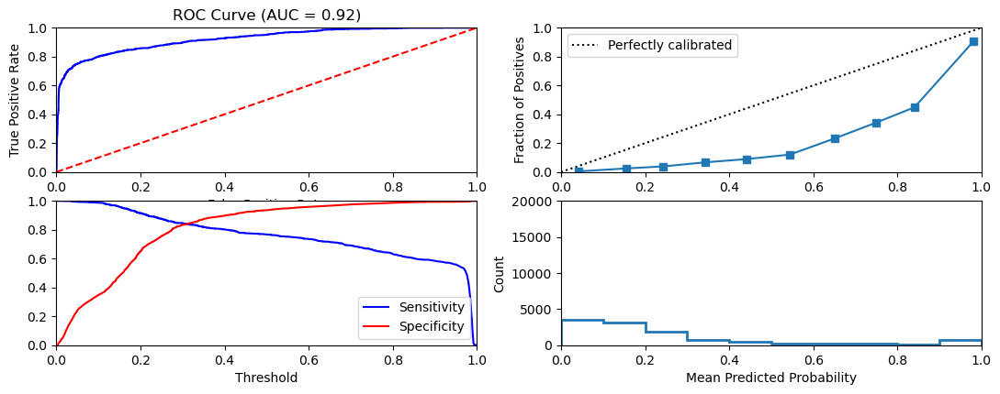

Brier score: 0.07379395387885031


In [22]:
### Find best hyperparamters ###

CatBoost = CatBoostClassifier(iterations=100,random_seed=random_state)

cv_parameters = {
    'learning_rate': [0.01,0.1,0.3],
    'depth': [4,10,12],
    'l2_leaf_reg':[4, 10,12],
    'random_strength':[0,10],
    'class_weights': [[1,1],[1,1.25],[1,1.5]],
    'eval_metric': ['Recall','Precision'],
    'custom_loss': ['Recall','Precision']}

cb = fit_classification(CatBoost, X_train,y_train, X_test, y_test, cv_parameters,
                         'CatBoost', output_to_file = False)

In [23]:
# Build new classifier with best hyperparameters. Train model on full dataset

# Generate pseudo-labels for unlabeled data using the model
pseudo_labels = cb['model'].predict(X_unlabeled)


# Combine labeled and unlabeled data with their respective pseudo-labels
X_combined = np.concatenate((training_data_final2, X_unlabeled), axis=0)
y_combined = np.concatenate((training_labels_new, pseudo_labels), axis=0)

CatBoost_final = CatBoostClassifier(iterations=200,random_seed=random_state,class_weights= [1, 1], 
                              custom_loss= 'Recall', depth= 10, eval_metric= 'Recall', l2_leaf_reg= 4,
                              learning_rate= 0.1, random_strength= 0)


CatBoost_final.fit(
    X_combined, y_combined,
    cat_features=categorical_features_indices,
    eval_set=(X_test, y_test),
    )


0:	learn: 0.2790675	test: 0.6276894	best: 0.6276894 (0)	total: 1.88s	remaining: 6m 14s
1:	learn: 0.2794600	test: 0.6304958	best: 0.6304958 (1)	total: 3.62s	remaining: 5m 58s
2:	learn: 0.2794600	test: 0.6304958	best: 0.6304958 (1)	total: 4.34s	remaining: 4m 45s
3:	learn: 0.2795646	test: 0.6304958	best: 0.6304958 (1)	total: 5.63s	remaining: 4m 35s
4:	learn: 0.3249320	test: 0.6407858	best: 0.6407858 (4)	total: 7.45s	remaining: 4m 50s
5:	learn: 0.3845671	test: 0.6613658	best: 0.6613658 (5)	total: 8.88s	remaining: 4m 47s
6:	learn: 0.3916748	test: 0.6183349	best: 0.6613658 (5)	total: 9.66s	remaining: 4m 26s
7:	learn: 0.4211784	test: 0.6099158	best: 0.6613658 (5)	total: 10.7s	remaining: 4m 16s
8:	learn: 0.4867264	test: 0.6080449	best: 0.6613658 (5)	total: 12s	remaining: 4m 14s
9:	learn: 0.5241139	test: 0.6389149	best: 0.6613658 (5)	total: 13.3s	remaining: 4m 12s
10:	learn: 0.5909004	test: 0.6585594	best: 0.6613658 (5)	total: 14.2s	remaining: 4m 4s
11:	learn: 0.7293745	test: 0.7193639	best: 0.

93:	learn: 0.8867125	test: 0.8484565	best: 0.8484565 (78)	total: 2m 12s	remaining: 2m 29s
94:	learn: 0.8867910	test: 0.8503274	best: 0.8503274 (94)	total: 2m 13s	remaining: 2m 27s
95:	learn: 0.8869392	test: 0.8503274	best: 0.8503274 (94)	total: 2m 14s	remaining: 2m 26s
96:	learn: 0.8872794	test: 0.8493920	best: 0.8503274 (94)	total: 2m 16s	remaining: 2m 25s
97:	learn: 0.8875584	test: 0.8503274	best: 0.8503274 (94)	total: 2m 19s	remaining: 2m 25s
98:	learn: 0.8877416	test: 0.8493920	best: 0.8503274 (94)	total: 2m 21s	remaining: 2m 24s
99:	learn: 0.8878462	test: 0.8493920	best: 0.8503274 (94)	total: 2m 22s	remaining: 2m 22s
100:	learn: 0.8879770	test: 0.8493920	best: 0.8503274 (94)	total: 2m 23s	remaining: 2m 20s
101:	learn: 0.8881079	test: 0.8493920	best: 0.8503274 (94)	total: 2m 24s	remaining: 2m 18s
102:	learn: 0.8883172	test: 0.8521983	best: 0.8521983 (102)	total: 2m 26s	remaining: 2m 18s
103:	learn: 0.8884131	test: 0.8540692	best: 0.8540692 (103)	total: 2m 27s	remaining: 2m 16s
104:

183:	learn: 0.8983029	test: 0.8437792	best: 0.8559401 (104)	total: 4m 37s	remaining: 24.1s
184:	learn: 0.8984162	test: 0.8456501	best: 0.8559401 (104)	total: 4m 38s	remaining: 22.6s
185:	learn: 0.8985907	test: 0.8456501	best: 0.8559401 (104)	total: 4m 40s	remaining: 21.1s
186:	learn: 0.8986430	test: 0.8456501	best: 0.8559401 (104)	total: 4m 41s	remaining: 19.6s
187:	learn: 0.8988610	test: 0.8456501	best: 0.8559401 (104)	total: 4m 44s	remaining: 18.1s
188:	learn: 0.8988610	test: 0.8456501	best: 0.8559401 (104)	total: 4m 44s	remaining: 16.6s
189:	learn: 0.8990616	test: 0.8456501	best: 0.8559401 (104)	total: 4m 46s	remaining: 15.1s
190:	learn: 0.8992971	test: 0.8428438	best: 0.8559401 (104)	total: 4m 47s	remaining: 13.6s
191:	learn: 0.8992447	test: 0.8437792	best: 0.8559401 (104)	total: 4m 48s	remaining: 12s
192:	learn: 0.8992796	test: 0.8447147	best: 0.8559401 (104)	total: 4m 49s	remaining: 10.5s
193:	learn: 0.8992622	test: 0.8428438	best: 0.8559401 (104)	total: 4m 50s	remaining: 9s
194:

Accuracy-maximizing threshold was: 0.6360123992102819
Accuracy:  0.9326410835214447
              precision    recall  f1-score   support

       No TS     0.9781    0.9466    0.9621     10006
          TS     0.6161    0.8017    0.6967      1069

    accuracy                         0.9326     11075
   macro avg     0.7971    0.8742    0.8294     11075
weighted avg     0.9432    0.9326    0.9365     11075



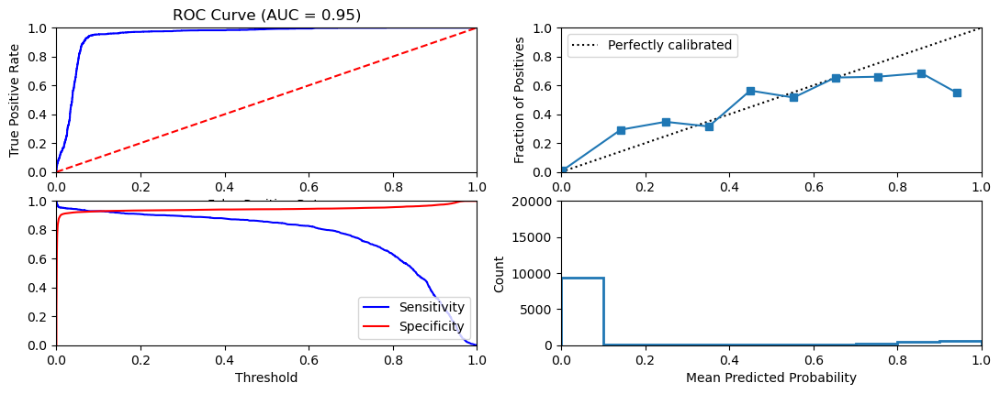

Brier score: 0.05333980619376536
TS predicted:  119826
percentage:  0.037682660711708116


In [24]:
test_model(CatBoost_final, X_combined, y_combined, X_test, y_test)

final_predictions = CatBoost_final.predict(X_combined)
total = len(final_predictions)
calc = np.sum(final_predictions==1)
print('TS predicted: ',calc)
print('percentage: ',calc/total)

In [25]:
print(CatBoost_final.get_feature_importance(prettified=True))

print(catboost_columns)

  Feature Id  Importances
0          0    43.186481
1          9    16.111729
2          7    13.807566
3          6    11.448933
4          8     8.045933
5          4     4.513663
6          3     1.834366
7          2     0.744678
8          1     0.156017
9          5     0.150636
['job_index', 'skills_index', 'summary_index', 'location_index', 'company_index', 'desc_index', 'title_1', 'company_1', 'State', 'Country']


### 5. write out predictions to csv

In [26]:
# write out predictions to csv

output_columns = ['Linkedin_url','Summary', 'Skills', 'title_1',
           'company_1', 'time_duration_1', 'Job_Description_1',
           'First Name','Middle Name', 'Surname', 'City', 'State', 'Country']

# Combine labeled and unlabeled data with their respective pseudo-labels
X_out = np.concatenate((training_data_new[output_columns], X_unlabeled_raw[output_columns]), axis=0)
y_out = np.concatenate((training_labels_new, pseudo_labels), axis=0)

pred_ts = CatBoost_final.predict(X_combined)
pred_proba = CatBoost_final.predict_proba(X_combined)

X_out = pd.DataFrame(X_out, columns=output_columns)



output = X_out[pred_ts == 1]
proba_df = pd.DataFrame(pred_proba)
output_proba = proba_df.loc[pred_ts == 1, 1]
output['confidence'] = output_proba

#output = output[output_columns]
filename_out = 'predictions/final__predictions.csv'
output.to_csv(filename_out, index=False)



In [27]:
output

,Linkedin_url,Summary,Skills,title_1,company_1,time_duration_1,Job_Description_1,First Name,Middle Name,Surname,City,State,Country,confidence
0,https://www.linkedin.com/in/aaron-a-julian,Committed data scientist and solutions special...,"Machine Learning, Data Science, Active TS/SCI ...",data scientist,Upptic,Apr 2022 - Present,,Aaron,,Julian,District Of Columbia,District Of Columbia,United States,0.979582
1,https://www.linkedin.com/in/aaron-garcia02,,"Active TS/SCI Clearance, Polygraph, Analytical...",site reliability engineer,LaunchCode,Jun 2021 - Present,,Aaron,,Garcia,kirkland,Washington,United States,0.995078
3,https://www.linkedin.com/in/aarontleo,Manager Cyber Systems Engineering - Northrop G...,"Cybersecurity, Software Development, NIST 800-...",software engineering manager,Northrop Grumman,Oct 2022 - Present,,Aaron,,Leo,Washington,District Of Columbia,United States,0.933758
5,https://www.linkedin.com/in/adam-cox-b327b971,https://github.com/arcox,"Software Engineering, Python, System Architect...",software engineering manager,Accenture Federal Services,Mar 2022 - Present,,Adam,,Cox,Tampa,Florida,United States,0.994096
6,https://www.linkedin.com/in/adamjsmith842,I've become a jack-of-all trades over the last...,"Software Project Management, Software Engineer...",software manager,Oasis Systems LLC,Nov 2022 - Present,,Adam,,Smith,San Antonio,Texas,United States,0.843914
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3164881,https://www.linkedin.com/in/zohaib-shah-b2b6711a7,,,software engineer,Raytheon Technologies,NaN,,Zohaib,,Shah,Orlando,Florida,United States,0.920498
3164889,https://www.linkedin.com/in/zola-maswanganye-2...,Information security engineer with experience ...,,cyber security engineer,City of Atlanta,Jun 2020 - May 2022,Participate in design reviews for upcoming pro...,Zola,,Maswanganye,Atlanta,Georgia,United States,0.860753
3164892,https://www.linkedin.com/in/zoltan-berenyi-012...,,,program specialist,Ecolab,2004 - Present,,Zoltan,,Berenyi,Las Vegas,Nevada,United States,0.973459
3164920,https://www.linkedin.com/in/zoran-umicevic-496...,,,information technology manager,Rackspace,NaN,,Zoran,,Umicevic,,,United States,0.959776


In [31]:
### Analyze output ###

freq = output['company_1'].value_counts()/len(training_df)
print(freq[:30])
print(len(output))

Northrop Grumman                                           219.294118
Lockheed Martin                                            203.529412
Booz Allen Hamilton                                        172.176471
Raytheon Technologies                                      165.294118
Deloitte                                                   129.882353
Boeing                                                     125.588235
SAIC                                                       121.058824
Leidos                                                     109.764706
Amazon Web Services (AWS)                                  108.882353
General Dynamics Information Technology                     95.764706
United States Air Force                                     88.117647
US Army                                                     78.705882
L3Harris Technologies                                       77.764706
CACI International Inc                                      72.235294
BAE Systems         

In [34]:
freq = output['Surname'].value_counts()/len(training_df)
print(freq[45:90])
print(len(output))

Martinez      8.588235
Tran          8.588235
Allen         8.470588
Wright        8.352941
Hill          8.235294
Evans         8.176471
Carter        8.176471
Edwards       8.117647
Parker        7.882353
Collins       7.882353
Gonzalez      7.823529
Zhang         7.705882
Phillips      7.647059
Murphy        7.529412
Sharma        7.411765
Baker         7.352941
Stewart       7.176471
Liu           7.176471
Campbell      7.058824
Morris        6.882353
Perez         6.823529
Turner        6.705882
Rogers        6.705882
Le            6.588235
Kelly         6.352941
Morgan        6.352941
Jenkins       6.294118
Hernandez     6.176471
Gupta         6.176471
Yang          6.117647
Rivera        6.117647
Bailey        5.941176
Peterson      5.882353
Sanchez       5.882353
Lopez         5.705882
Stevens       5.647059
Bell          5.588235
Wood          5.588235
Cox           5.588235
Richardson    5.529412
Sullivan      5.529412
Wong          5.529412
Wu            5.470588
Cook       